# Projekt końcowy

### Poniższy projekt ma na celu zbudowanie modelu klasyfikacyjnego, który na podstawie podanych danych będzie przewidywał, czy potencjalny pożyczkobiorca spłaci swój dług.

In [1]:
import numpy as np 
import pandas as pd 
import seaborn as sns
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.pyplot as plt
%matplotlib inline
from scipy import stats
from scipy.stats import zscore
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import (RandomForestRegressor, GradientBoostingRegressor,AdaBoostRegressor,BaggingRegressor)
from sklearn.svm import SVR
from sklearn.svm import SVC
from sklearn import metrics
from sklearn.metrics import accuracy_score,roc_auc_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report,confusion_matrix
from sklearn.metrics import mean_squared_error,mean_absolute_error,r2_score
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn import preprocessing
from sklearn.preprocessing import PolynomialFeatures
from sklearn.cluster import KMeans
from sklearn.utils import resample
from sklearn.ensemble import AdaBoostClassifier
from ds_utils.unsupervised import plot_cluster_cardinality, plot_cluster_magnitude, plot_magnitude_vs_cardinality
from scipy.spatial.distance import euclidean
import matplotlib.pyplot as plt
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import LabelEncoder
from catboost import CatBoostClassifier
from sklearn import model_selection
from sklearn.ensemble import BaggingClassifier
from sklearn.decomposition import PCA
from collections import Counter
from sklearn.datasets import make_classification
from matplotlib import pyplot
from numpy import where
from imblearn.over_sampling import SMOTE
from numpy import mean
from sklearn.datasets import make_classification
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.tree import DecisionTreeClassifier
from numpy import mean
from matplotlib import pyplot
from scipy.spatial.distance import euclidean
from sklearn.ensemble import RandomForestClassifier
from ds_utils.unsupervised import plot_loss_vs_cluster_number
from imblearn.pipeline import Pipeline
import matplotlib as mpl
from cycler import cycler
from sklearn.model_selection import ShuffleSplit
from sklearn import model_selection
from sklearn.model_selection import train_test_split
from sklearn.model_selection import learning_curve 
from sklearn.naive_bayes import GaussianNB
from sklearn.naive_bayes import MultinomialNB
from sklearn.neural_network import MLPClassifier
from numpy import loadtxt
from xgboost import XGBClassifier
from xgboost import XGBRegressor
from sklearn.metrics import roc_curve
from sklearn.model_selection import GridSearchCV

In [2]:
pip install yellowbrick

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [3]:
pip install data-science-utils

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [4]:
pip install scikit-learn

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [5]:
pip install xgboost

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [6]:
!pip3 install catboost

Defaulting to user installation because normal site-packages is not writeable


In [7]:
!pip3 install imblearn

Defaulting to user installation because normal site-packages is not writeable


In [8]:
pip install scikit-learn

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


### Wczytanie danych

In [9]:
df=pd.read_csv('Loan_data.csv')

C:\Users\asus\AppData\Local\Temp\ipykernel_4632\140937924.py:1: DtypeWarning: Columns (0,49) have mixed types. Specify dtype option on import or set low_memory=False.
  df=pd.read_csv('Loan_data.csv')


In [10]:
df.head()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,hardship_payoff_balance_amount,hardship_last_payment_amount,disbursement_method,debt_settlement_flag,debt_settlement_flag_date,settlement_status,settlement_date,settlement_amount,settlement_percentage,settlement_term
0,1077501,NaN,5000.0,5000.0,4975.0,36 months,10.65%,162.87,B,B2,...,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
1,1077430,NaN,2500.0,2500.0,2500.0,60 months,15.27%,59.83,C,C4,...,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
2,1077175,NaN,2400.0,2400.0,2400.0,36 months,15.96%,84.33,C,C5,...,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
3,1076863,NaN,10000.0,10000.0,10000.0,36 months,13.49%,339.31,C,C1,...,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
4,1075358,NaN,3000.0,3000.0,3000.0,60 months,12.69%,67.79,B,B5,...,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN


In [11]:
df.shape

(42536, 151)

In [12]:
#Dane zawierają 42536 obserwacji i 151 kolumn - łącznie z kolumną ze statusem pożyczki (zmienna objaśniana)

In [13]:
df.dtypes

id                        object
member_id                float64
loan_amnt                float64
funded_amnt              float64
funded_amnt_inv          float64
                          ...   
settlement_status         object
settlement_date           object
settlement_amount        float64
settlement_percentage    float64
settlement_term          float64
Length: 151, dtype: object

In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42536 entries, 0 to 42535
Columns: 151 entries, id to settlement_term
dtypes: float64(120), object(31)
memory usage: 49.0+ MB


In [15]:
df.keys()

Index(['id', 'member_id', 'loan_amnt', 'funded_amnt', 'funded_amnt_inv',
       'term', 'int_rate', 'installment', 'grade', 'sub_grade',
       ...
       'hardship_payoff_balance_amount', 'hardship_last_payment_amount',
       'disbursement_method', 'debt_settlement_flag',
       'debt_settlement_flag_date', 'settlement_status', 'settlement_date',
       'settlement_amount', 'settlement_percentage', 'settlement_term'],
      dtype='object', length=151)

In [16]:
df.describe()

,member_id,loan_amnt,funded_amnt,funded_amnt_inv,installment,annual_inc,dti,delinq_2yrs,fico_range_low,fico_range_high,...,payment_plan_start_date,hardship_length,hardship_dpd,hardship_loan_status,orig_projected_additional_accrued_interest,hardship_payoff_balance_amount,hardship_last_payment_amount,settlement_amount,settlement_percentage,settlement_term
count,0.0,42535.000000,42535.000000,42535.000000,42535.000000,4.253100e+04,42535.000000,42506.000000,42535.000000,42535.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,160.000000,160.000000,160.000000
mean,NaN,11089.722581,10821.585753,10139.938785,322.623063,6.913656e+04,13.373043,0.152449,713.052545,717.052545,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4272.137875,49.905875,1.200000
std,NaN,7410.938391,7146.914675,7131.598014,208.927216,6.409635e+04,6.726315,0.512406,36.188439,36.188439,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3119.373774,15.563690,4.085255
min,NaN,500.000000,500.000000,0.000000,15.670000,1.896000e+03,0.000000,0.000000,610.000000,614.000000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,193.290000,10.690000,0.000000
25%,NaN,5200.000000,5000.000000,4950.000000,165.520000,4.000000e+04,8.200000,0.000000,685.000000,689.000000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1842.750000,40.000000,0.000000
50%,NaN,9700.000000,9600.000000,8500.000000,277.690000,5.900000e+04,13.470000,0.000000,710.000000,714.000000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3499.350000,49.970000,0.000000
75%,NaN,15000.000000,15000.000000,14000.000000,428.180000,8.250000e+04,18.680000,0.000000,740.000000,744.000000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5701.100000,60.652500,0.000000
max,NaN,35000.000000,35000.000000,35000.000000,1305.190000,6.000000e+06,29.990000,13.000000,825.000000,829.000000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,14798.200000,92.740000,24.000000


In [17]:
#Importuję opis zmiennych 
df_description = pd.read_csv('LCDataDictionary.csv')

In [18]:
pd.set_option('display.max_rows', 200)
pd.set_option('display.max_columns', 151)
pd.set_option('display.max_colwidth', 2000)
pd.set_option('max_colwidth', 2000)
pd.options.display.float_format = '{:.3f}'.format

In [19]:
df_description[['LoanStatNew', 'Description']]

,LoanStatNew,Description
0,acc_now_delinq,The number of accounts on which the borrower is now delinquent.
1,acc_open_past_24mths,Number of trades opened in past 24 months.
2,addr_state,The state provided by the borrower in the loan application
3,all_util,Balance to credit limit on all trades
4,annual_inc,The self-reported annual income provided by the borrower during registration.
5,annual_inc_joint,The combined self-reported annual income provided by the co-borrowers during registration
6,application_type,Indicates whether the loan is an individual application or a joint application with two co-borrowers
7,avg_cur_bal,Average current balance of all accounts
8,bc_open_to_buy,Total open to buy on revolving bankcards.
9,bc_util,Ratio of total current balance to high credit/credit limit for all bankcard accounts.


### Sprawdzam brakujące wartości

In [20]:
df.isna().sum()

id                                                0
member_id                                     42536
loan_amnt                                         1
funded_amnt                                       1
funded_amnt_inv                                   1
term                                              1
int_rate                                          1
installment                                       1
grade                                             1
sub_grade                                         1
emp_title                                      2627
emp_length                                     1113
home_ownership                                    1
annual_inc                                        5
verification_status                               1
issue_d                                           1
loan_status                                       1
pymnt_plan                                        1
url                                               1
desc        

In [21]:
#Sprawdzam i usuwam kolumny w 100% z nan

In [22]:
nan_cols = [i for i in df.columns if df[i].isnull().all()]

In [23]:
nan_cols

['member_id',
 'mths_since_last_major_derog',
 'annual_inc_joint',
 'dti_joint',
 'verification_status_joint',
 'tot_coll_amt',
 'tot_cur_bal',
 'open_acc_6m',
 'open_act_il',
 'open_il_12m',
 'open_il_24m',
 'mths_since_rcnt_il',
 'total_bal_il',
 'il_util',
 'open_rv_12m',
 'open_rv_24m',
 'max_bal_bc',
 'all_util',
 'total_rev_hi_lim',
 'inq_fi',
 'total_cu_tl',
 'inq_last_12m',
 'acc_open_past_24mths',
 'avg_cur_bal',
 'bc_open_to_buy',
 'bc_util',
 'mo_sin_old_il_acct',
 'mo_sin_old_rev_tl_op',
 'mo_sin_rcnt_rev_tl_op',
 'mo_sin_rcnt_tl',
 'mort_acc',
 'mths_since_recent_bc',
 'mths_since_recent_bc_dlq',
 'mths_since_recent_inq',
 'mths_since_recent_revol_delinq',
 'num_accts_ever_120_pd',
 'num_actv_bc_tl',
 'num_actv_rev_tl',
 'num_bc_sats',
 'num_bc_tl',
 'num_il_tl',
 'num_op_rev_tl',
 'num_rev_accts',
 'num_rev_tl_bal_gt_0',
 'num_sats',
 'num_tl_120dpd_2m',
 'num_tl_30dpd',
 'num_tl_90g_dpd_24m',
 'num_tl_op_past_12m',
 'pct_tl_nvr_dlq',
 'percent_bc_gt_75',
 'tot_hi_cred_li

In [24]:
df.drop(
['member_id',
 'mths_since_last_major_derog',
 'annual_inc_joint',
 'dti_joint',
 'verification_status_joint',
 'tot_coll_amt',
 'tot_cur_bal',
 'open_acc_6m',
 'open_act_il',
 'open_il_12m',
 'open_il_24m',
 'mths_since_rcnt_il',
 'total_bal_il',
 'il_util',
 'open_rv_12m',
 'open_rv_24m',
 'max_bal_bc',
 'all_util',
 'total_rev_hi_lim',
 'inq_fi',
 'total_cu_tl',
 'inq_last_12m',
 'acc_open_past_24mths',
 'avg_cur_bal',
 'bc_open_to_buy',
 'bc_util',
 'mo_sin_old_il_acct',
 'mo_sin_old_rev_tl_op',
 'mo_sin_rcnt_rev_tl_op',
 'mo_sin_rcnt_tl',
 'mort_acc',
 'mths_since_recent_bc',
 'mths_since_recent_bc_dlq',
 'mths_since_recent_inq',
 'mths_since_recent_revol_delinq',
 'num_accts_ever_120_pd',
 'num_actv_bc_tl',
 'num_actv_rev_tl',
 'num_bc_sats',
 'num_bc_tl',
 'num_il_tl',
 'num_op_rev_tl',
 'num_rev_accts',
 'num_rev_tl_bal_gt_0',
 'num_sats',
 'num_tl_120dpd_2m',
 'num_tl_30dpd',
 'num_tl_90g_dpd_24m',
 'num_tl_op_past_12m',
 'pct_tl_nvr_dlq',
 'percent_bc_gt_75',
 'tot_hi_cred_lim',
 'total_bal_ex_mort',
 'total_bc_limit',
 'total_il_high_credit_limit',
 'revol_bal_joint',
 'sec_app_fico_range_low',
 'sec_app_fico_range_high',
 'sec_app_earliest_cr_line',
 'sec_app_inq_last_6mths',
 'sec_app_mort_acc',
 'sec_app_open_acc',
 'sec_app_revol_util',
 'sec_app_open_act_il',
 'sec_app_num_rev_accts',
 'sec_app_chargeoff_within_12_mths',
 'sec_app_collections_12_mths_ex_med',
 'sec_app_mths_since_last_major_derog',
 'hardship_type',
 'hardship_reason',
 'hardship_status',
 'deferral_term',
 'hardship_amount',
 'hardship_start_date',
 'hardship_end_date',
 'payment_plan_start_date',
 'hardship_length',
 'hardship_dpd',
 'hardship_loan_status',
 'orig_projected_additional_accrued_interest',
 'hardship_payoff_balance_amount',
 'hardship_last_payment_amount'], 
axis=1, inplace=True)

In [25]:
#Usuwam kolumny, które zawierają nan w 85% 

In [26]:
nan_cols85 = [i for i in df.columns if df[i].isnull().sum() > 0.85*len(df)]

In [27]:
nan_cols85

['mths_since_last_record',
 'next_pymnt_d',
 'debt_settlement_flag_date',
 'settlement_status',
 'settlement_date',
 'settlement_amount',
 'settlement_percentage',
 'settlement_term']

In [28]:
df.drop(
['mths_since_last_record',
 'next_pymnt_d',
 'debt_settlement_flag_date',
 'settlement_status',
 'settlement_date',
 'settlement_amount',
 'settlement_percentage',
 'settlement_term'],
axis=1, inplace=True)

In [29]:
#Usunięcie kolumn ze zbędnymi informacjami

In [30]:
df.drop(
['url', 
 'id', 
 'zip_code', 
 'addr_state', 
 'title',
 'last_pymnt_amnt',
 'last_pymnt_d', 
 'last_credit_pull_d',
 'emp_title',
 'disbursement_method',
 'recoveries',
 'collection_recovery_fee',
 'revol_bal',
 'revol_util',
 'funded_amnt_inv'],
axis=1, inplace=True)

In [31]:
#Usunięcie kolumn, które zawierają informacje z przyszłości, niedostępne w momencie udzielania pożyczki

In [32]:
df.drop(
['delinq_2yrs', 
 'mths_since_last_delinq', 
 'delinq_amnt', 
 'hardship_flag', 
 'acc_now_delinq',
 'chargeoff_within_12_mths',
 'debt_settlement_flag',
 'total_pymnt',
 'total_pymnt_inv',
 'total_rec_prncp',
 'total_rec_int',
 'total_rec_late_fee',
 'last_fico_range_high',
 'last_fico_range_low'],
axis=1, inplace=True)

In [33]:
# Sprawdzam, które kolumny przyjmują tylko jedną wartość. Sprawdzam też, czy zawierają NaNy (duża ilość brakujących wartości 
# może oznaczać, że mogą one dać jakąś informację - wprowadzając dane ktoś nie wpisywał jakiejś wartości, ale zostawiał puste miejsca)

In [34]:
df['application_type'].value_counts()

Individual    42535
Name: application_type, dtype: int64

In [35]:
df['application_type'].isnull().sum()

1

In [36]:
df.drop(
['application_type'],
axis=1, inplace=True)

In [37]:
df['pymnt_plan'].value_counts()

n    42535
Name: pymnt_plan, dtype: int64

In [38]:
df['pymnt_plan'].isnull().sum()

1

In [39]:
df.drop(
['pymnt_plan'],
axis=1, inplace=True)

In [40]:
df['initial_list_status'].value_counts()

f    42535
Name: initial_list_status, dtype: int64

In [41]:
df['initial_list_status'].isnull().sum()

1

In [42]:
df.drop(
['initial_list_status'],
axis=1, inplace=True)

In [43]:
df['out_prncp'].value_counts()

0.000    42535
Name: out_prncp, dtype: int64

In [44]:
df['out_prncp'].isnull().sum()

1

In [45]:
df.drop(
['out_prncp'],
axis=1, inplace=True)

In [46]:
df['out_prncp_inv'].value_counts()

0.000    42535
Name: out_prncp_inv, dtype: int64

In [47]:
df['out_prncp_inv'].isnull().sum()

1

In [48]:
df.drop(
['out_prncp_inv'],
axis=1, inplace=True)

In [49]:
df['policy_code'].value_counts()

1.000    42535
Name: policy_code, dtype: int64

In [50]:
df['policy_code'].isnull().sum()

1

In [51]:
df.drop(
['policy_code'],
axis=1, inplace=True)

In [52]:
df['collections_12_mths_ex_med'].value_counts()

0.000    42390
Name: collections_12_mths_ex_med, dtype: int64

In [53]:
df['collections_12_mths_ex_med'].isnull().sum()

146

In [54]:
df.drop(
['collections_12_mths_ex_med'],
axis=1, inplace=True)

In [55]:
df['tax_liens'].value_counts()

0.000    42429
1.000        1
Name: tax_liens, dtype: int64

In [56]:
df['tax_liens'].isnull().sum()

106

In [57]:
df.drop(
['tax_liens'],
axis=1, inplace=True)

In [ ]:
df.drop_duplicates(inplace= True)

In [ ]:
df.shape

In [58]:
#Decuję też usunąć kolumnę 'desc' - w większości powiela ona dane z kolumny 'purpose'
df.drop(['desc'],
axis=1, inplace=True)

In [59]:
df.shape

(42536, 24)

### Przekształcenie wartości w kolumnach - usunięcie procentów, dodatkowych znaków, itd

In [60]:
def usuniecie_miesiecy(df, column):
    df[column] = pd.to_numeric(df[column].str.replace('months', ''))

In [61]:
usuniecie_miesiecy(df, 'term')

In [62]:
df.head()

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,emp_length,home_ownership,annual_inc,verification_status,loan_status,purpose,dti,earliest_cr_line,fico_range_low,fico_range_high,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,pub_rec_bankruptcies
0,5000.000,5000.000,4975.000,36.000,10.65%,162.870,B,10+ years,RENT,24000.000,Verified,Fully Paid,credit_card,27.650,Jan-1985,735.000,739.000,1.000,3.000,0.000,13648.000,83.7%,9.000,0.000
1,2500.000,2500.000,2500.000,60.000,15.27%,59.830,C,< 1 year,RENT,30000.000,Source Verified,Charged Off,car,1.000,Apr-1999,740.000,744.000,5.000,3.000,0.000,1687.000,9.4%,4.000,0.000
2,2400.000,2400.000,2400.000,36.000,15.96%,84.330,C,10+ years,RENT,12252.000,Not Verified,Fully Paid,small_business,8.720,Nov-2001,735.000,739.000,2.000,2.000,0.000,2956.000,98.5%,10.000,0.000
3,10000.000,10000.000,10000.000,36.000,13.49%,339.310,C,10+ years,RENT,49200.000,Source Verified,Fully Paid,other,20.000,Feb-1996,690.000,694.000,1.000,10.000,0.000,5598.000,21%,37.000,0.000
4,3000.000,3000.000,3000.000,60.000,12.69%,67.790,B,1 year,RENT,80000.000,Source Verified,Fully Paid,other,17.940,Jan-1996,695.000,699.000,0.000,15.000,0.000,27783.000,53.9%,38.000,0.000


In [63]:
#usuwam dodatkowe znaki z kolumny 'emp_length'

In [64]:
df['emp_length'].value_counts()

10+ years    9369
< 1 year     5062
2 years      4743
3 years      4364
4 years      3649
1 year       3595
5 years      3458
6 years      2375
7 years      1875
8 years      1592
9 years      1341
Name: emp_length, dtype: int64

In [65]:
def usuniecie_znakow(df, column):
    df[column] = df[column].str.replace('\+ years', '')
    df[column] = df[column].str.replace('< 1 year', str(0))
    df[column] = df[column].str.replace(' years', '')
    df[column] = df[column].str.replace(' year', '')

In [66]:
usuniecie_znakow(df,'emp_length')

C:\Users\asus\AppData\Local\Temp\ipykernel_4632\1282640428.py:2: FutureWarning: The default value of regex will change from True to False in a future version.
  df[column] = df[column].str.replace('\+ years', '')


In [67]:
df['emp_length'].value_counts()

10    9369
0     5062
2     4743
3     4364
4     3649
1     3595
5     3458
6     2375
7     1875
8     1592
9     1341
Name: emp_length, dtype: int64

In [68]:
df['emp_length'].unique()

array(['10', '0', '1', '3', '8', '9', '4', '5', '6', '2', '7', nan],
      dtype=object)

In [69]:
#przekształcenie procentow

In [70]:
df['revol_util'] = df['revol_util'].str.rstrip('%').astype('float') / 100.0

In [71]:
df['int_rate'] = df['int_rate'].str.rstrip('%').astype('float') / 100.0

In [72]:
df.head()

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,emp_length,home_ownership,annual_inc,verification_status,loan_status,purpose,dti,earliest_cr_line,fico_range_low,fico_range_high,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,pub_rec_bankruptcies
0,5000.000,5000.000,4975.000,36.000,0.106,162.870,B,10,RENT,24000.000,Verified,Fully Paid,credit_card,27.650,Jan-1985,735.000,739.000,1.000,3.000,0.000,13648.000,0.837,9.000,0.000
1,2500.000,2500.000,2500.000,60.000,0.153,59.830,C,0,RENT,30000.000,Source Verified,Charged Off,car,1.000,Apr-1999,740.000,744.000,5.000,3.000,0.000,1687.000,0.094,4.000,0.000
2,2400.000,2400.000,2400.000,36.000,0.160,84.330,C,10,RENT,12252.000,Not Verified,Fully Paid,small_business,8.720,Nov-2001,735.000,739.000,2.000,2.000,0.000,2956.000,0.985,10.000,0.000
3,10000.000,10000.000,10000.000,36.000,0.135,339.310,C,10,RENT,49200.000,Source Verified,Fully Paid,other,20.000,Feb-1996,690.000,694.000,1.000,10.000,0.000,5598.000,0.210,37.000,0.000
4,3000.000,3000.000,3000.000,60.000,0.127,67.790,B,1,RENT,80000.000,Source Verified,Fully Paid,other,17.940,Jan-1996,695.000,699.000,0.000,15.000,0.000,27783.000,0.539,38.000,0.000


In [73]:
#wartości związane z datą

In [74]:
df['earliest_cr_line'].value_counts()

Oct-1999    393
Nov-1998    390
Oct-2000    370
Dec-1998    366
Dec-1997    348
           ... 
Jul-1964      1
Mar-1963      1
Nov-1965      1
Apr-1966      1
Nov-1959      1
Name: earliest_cr_line, Length: 530, dtype: int64

In [75]:
df['earliest_cr_line'].dtypes

dtype('O')

In [77]:
df['earliest_cr_line'] = pd.DatetimeIndex(df['earliest_cr_line']).year

In [78]:
df['earliest_cr_line'].value_counts()

2000.000    3436
1999.000    3152
1998.000    3066
2001.000    2667
1997.000    2622
1996.000    2426
1995.000    2292
1994.000    2166
2002.000    2059
2003.000    1976
2004.000    1890
2005.000    1639
1993.000    1610
2006.000    1343
1992.000    1155
1990.000    1113
1991.000    1039
1989.000     931
1988.000     783
2007.000     767
1987.000     664
1986.000     533
1985.000     486
1984.000     433
1983.000     360
1982.000     238
1981.000     207
1980.000     187
1979.000     178
1978.000     173
2008.000     160
1977.000     124
1976.000     112
1975.000      87
1974.000      71
1973.000      69
1972.000      56
1971.000      50
1970.000      49
1969.000      41
1968.000      23
1967.000      18
1963.000      12
1966.000      11
1964.000       9
1965.000       9
1962.000       5
1954.000       2
1959.000       2
1961.000       2
1956.000       1
1946.000       1
1950.000       1
Name: earliest_cr_line, dtype: int64

In [79]:
#zamieniam wartości 'verification_status' na dwie wartości 0 i 1. 

In [80]:
df['verification_status'].value_counts()

Not Verified       18758
Verified           13471
Source Verified    10306
Name: verification_status, dtype: int64

In [104]:
df['verification_status'] = df['verification_status'].map({'Verified' :1, 'Source Verified' : 1, 
                                            'Not Verified' : 0})

In [105]:
df['verification_status'].value_counts()

1    36105
0     6431
Name: loan_status, dtype: int64

In [81]:
df['verification_status2'] = np.where(df['verification_status'].isin(
    ['Verified', 'Source Verified']), 0, 1)

In [82]:
df['verification_status2'].value_counts()

0    23777
1    18759
Name: verification_status2, dtype: int64

In [83]:
#usuwam pierwotną kolumnę 'verification_status'
#df.drop(columns = ['verification_status'], inplace = True)

### BRAKUJĄCE WARTOŚCI

In [84]:
df.isna().sum()

loan_amnt                  1
funded_amnt                1
funded_amnt_inv            1
term                       1
int_rate                   1
installment                1
grade                      1
emp_length              1113
home_ownership             1
annual_inc                 5
loan_status                1
purpose                    1
dti                        1
earliest_cr_line          30
fico_range_low             1
fico_range_high            1
inq_last_6mths            30
open_acc                  30
pub_rec                   30
revol_bal                  1
revol_util                91
total_acc                 30
pub_rec_bankruptcies    1366
verification_status2       0
dtype: int64

In [ ]:
## Brakujące dane
total = train.isnull().sum().sort_values(ascending=False)
percent = (train.isnull().sum()/train.isnull().count()).sort_values(ascending=False)
missing_data = pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])
missing_data.head(20)

array([[<AxesSubplot:title={'center':'loan_amnt'}>,
        <AxesSubplot:title={'center':'funded_amnt'}>,
        <AxesSubplot:title={'center':'funded_amnt_inv'}>,
        <AxesSubplot:title={'center':'term'}>],
       [<AxesSubplot:title={'center':'int_rate'}>,
        <AxesSubplot:title={'center':'installment'}>,
        <AxesSubplot:title={'center':'annual_inc'}>,
        <AxesSubplot:title={'center':'dti'}>],
       [<AxesSubplot:title={'center':'earliest_cr_line'}>,
        <AxesSubplot:title={'center':'fico_range_low'}>,
        <AxesSubplot:title={'center':'fico_range_high'}>,
        <AxesSubplot:title={'center':'inq_last_6mths'}>],
       [<AxesSubplot:title={'center':'open_acc'}>,
        <AxesSubplot:title={'center':'pub_rec'}>,
        <AxesSubplot:title={'center':'revol_bal'}>,
        <AxesSubplot:title={'center':'revol_util'}>],
       [<AxesSubplot:title={'center':'total_acc'}>,
        <AxesSubplot:title={'center':'pub_rec_bankruptcies'}>,
        <AxesSubplot:title={'

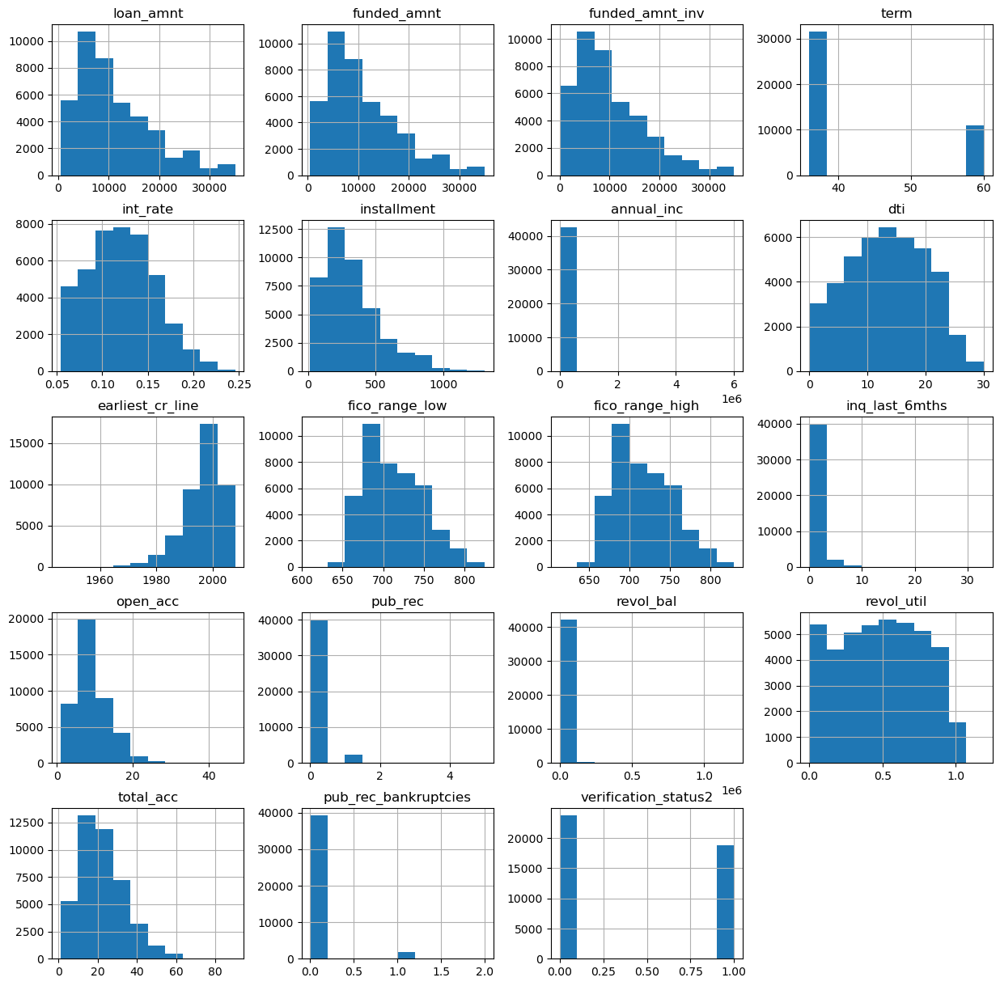

In [86]:
#Uzupełniam brakujące wartości - na podstawie histogramu decyduję, czy uzupełniam medianą, czy najczęściej występującą wartością

In [87]:
# Dane kategoryczne

# Będę je uzupełniać najczęściej występującą wartością
# Najczęściej występującą wartość 'term' to 36
# Najczęściej występującą wartość 'grade' to B
# Najczęściej występującą wartość 'home_ownership' to 'RENT'
# Najczęściej występującą wartość 'purpose' to debt_consolidation'

In [88]:
#term
df['term'].value_counts()

36.000    31534
60.000    11001
Name: term, dtype: int64

In [89]:
df['term'].fillna(36.0, inplace=True)

In [90]:
#grade   /// subgrade????
df['grade'].value_counts()

B    12389
A    10183
C     8740
D     6016
E     3394
F     1301
G      512
Name: grade, dtype: int64

In [91]:
df['grade'].fillna('B', inplace=True)

In [92]:
#home_ownership
df['home_ownership'].value_counts()

RENT        20181
MORTGAGE    18959
OWN          3251
OTHER         136
NONE            8
Name: home_ownership, dtype: int64

In [93]:
df['home_ownership'].fillna('RENT', inplace=True)

In [94]:
#purpose
df['purpose'].value_counts()

debt_consolidation    19776
credit_card            5477
other                  4425
home_improvement       3199
major_purchase         2311
small_business         1992
car                    1615
wedding                1004
medical                 753
moving                  629
house                   426
educational             422
vacation                400
renewable_energy        106
Name: purpose, dtype: int64

In [95]:
df['purpose'].fillna('debt_consolidation', inplace=True)

In [96]:
#loan_status
df['loan_status'].value_counts()

Fully Paid                                             34116
Charged Off                                             5670
Does not meet the credit policy. Status:Fully Paid      1988
Does not meet the credit policy. Status:Charged Off      761
Name: loan_status, dtype: int64

In [97]:
df['loan_status'].fillna('Fully Paid', inplace=True)

In [98]:
# Dane numeryczne
# Będę je uzupełniać medianą

In [99]:
#loan_amnt
df['loan_amnt'].fillna(df['loan_amnt'].median(), inplace=True)

In [100]:
#funded_amnt
df['funded_amnt'].fillna(df['funded_amnt'].median(), inplace=True)

In [101]:
#funded_amnt_inv
df['funded_amnt_inv'].fillna(df['funded_amnt_inv'].median(), inplace=True)

In [102]:
#int_rate
df['int_rate'].fillna(df['int_rate'].median(), inplace=True)

In [103]:
#installment
df['installment'].fillna(df['installment'].median(), inplace=True)

In [104]:
#emp_length
df['emp_length'].fillna(df['emp_length'].median(), inplace=True)

In [105]:
#annual_inc
df['annual_inc'].fillna(df['annual_inc'].median(), inplace=True)

In [106]:
#dti
df['dti'].fillna(df['dti'].median(), inplace=True)

In [107]:
#fico_range_low
df['fico_range_low'].fillna(df['fico_range_low'].median(), inplace=True)

In [108]:
#fico_range_high
df['fico_range_high'].fillna(df['fico_range_high'].median(), inplace=True)

In [109]:
#inq_last_6mths
df['emp_length'].fillna(df['emp_length'].median(), inplace=True)

In [110]:
#open_acc
df['open_acc'].fillna(df['open_acc'].median(), inplace=True)

In [111]:
#pub_rec
df['pub_rec'].fillna(df['pub_rec'].median(), inplace=True)

In [112]:
#revol_bal
df['revol_bal'].fillna(df['revol_bal'].median(), inplace=True)

In [113]:
#revol_util
df['revol_util'].fillna(df['revol_util'].median(), inplace=True)

In [114]:
#total_acc
df['total_acc'].fillna(df['total_acc'].median(), inplace=True)

In [115]:
#pub_rec_bankruptcies
df['pub_rec_bankruptcies'].fillna(df['pub_rec_bankruptcies'].median(), inplace=True)

In [116]:
#earliest_cr_line
df['earliest_cr_line'].fillna(df['earliest_cr_line'].median(), inplace=True)

In [117]:
#inq_last_6mths
df['inq_last_6mths'].fillna(df['inq_last_6mths'].median(), inplace=True)

In [118]:
df.isna().sum()

loan_amnt               0
funded_amnt             0
funded_amnt_inv         0
term                    0
int_rate                0
installment             0
grade                   0
emp_length              0
home_ownership          0
annual_inc              0
loan_status             0
purpose                 0
dti                     0
earliest_cr_line        0
fico_range_low          0
fico_range_high         0
inq_last_6mths          0
open_acc                0
pub_rec                 0
revol_bal               0
revol_util              0
total_acc               0
pub_rec_bankruptcies    0
verification_status2    0
dtype: int64

# EDA

### Kolumna ze statusem pożyczki

In [ ]:
# Check the target variable
data['not.fully.paid'].value_counts()

In [ ]:
#handling imbalanced dataset
not_fully_paid_0 = data[data['not.fully.paid'] == 0]
not_fully_paid_1 = data[data['not.fully.paid'] == 1]

print('not_fully_paid_0', not_fully_paid_0.shape)
print('not_fully_paid_1', not_fully_paid_1.shape)

In [ ]:
#handling imbalanced data
from sklearn.utils import resample
df_minority_upsampled = resample(not_fully_paid_1, replace = True, n_samples = 8045)
df = pd.concat([not_fully_paid_0, df_minority_upsampled])

from sklearn.utils import shuffle
df = shuffle(df)

In [ ]:
#imbalanced data handled
df['not.fully.paid'].value_counts()  

In [119]:
# Zmienną objaśnianą jest kolumna ze statusem pożyczki - 'loan_status. Zadaniem jest przewidzenie, 
# czy klient spłaci kredyt - 1, czy nie spłaci - 0

In [120]:
df['loan_status'].value_counts()

Fully Paid                                             34117
Charged Off                                             5670
Does not meet the credit policy. Status:Fully Paid      1988
Does not meet the credit policy. Status:Charged Off      761
Name: loan_status, dtype: int64

In [121]:
#zamieniam wartości "loan_status" na dwie wartości 0 i 1. 

In [ ]:
data['diagnosis'] = data['diagnosis'].map({'M' : 1, 'B' : 0})

In [122]:
df['niesplacony_splacony'] = np.where(df['loan_status'].isin(
    ['Charged Off','Does not meet the credit policy. Status:Charged Off']), 0, 1)

In [123]:
df['niesplacony_splacony'].value_counts()

1    36105
0     6431
Name: niesplacony_splacony, dtype: int64

In [124]:
#usuwam pierwotną kolumnę loan_status
df.drop(columns = ['loan_status'], inplace = True)

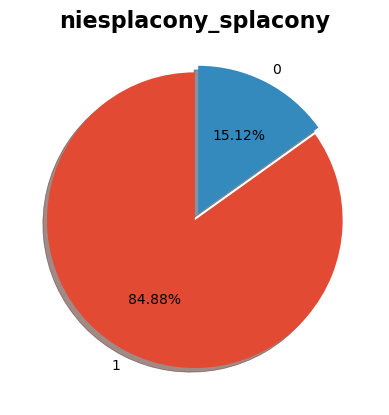

In [125]:
#Chcę sprawdzić, jaki rozkład ma zmienna dotycząca spłaty pożyczki. 

plt.style.use('ggplot')

data = df['niesplacony_splacony'].value_counts(normalize=True)
plt.pie(data, labels=data.index, startangle = 90, shadow = True, radius=1, explode= [0,0.05],autopct='%0.2f%%')
plt.title('niesplacony_splacony', fontsize=16, fontweight='bold')
plt.show()

In [126]:
#Dane są niezbalansowane - prawie 85% stanowią spłacone pożyczki, niespłacone zaledwie 15%.

### Rozkład zmiennych , korelacje

In [ ]:
# Separate data to include numerical data only
num_data = df[["int.rate", "installment", "log.annual.inc", "dti", "fico", "days.with.cr.line", "revol.bal", 
               "revol.util", "not.fully.paid"]]
num_data

In [ ]:
# Check the features in the numerical data
num_data_features = num_data.columns
num_data_features

In [ ]:
# Separate data to include categorical data only
cat_data = df[["credit.policy", "purpose", "inq.last.6mths", "delinq.2yrs", "not.fully.paid"]]
cat_data

In [ ]:
# Check the features in the numerical data
cat_data_features = cat_data.columns
cat_data_features

In [127]:
zmienne_num = [zmienna for zmienna in df.columns if df[zmienna].dtype != 'O']
zmienne_cat = [zmienna for zmienna in df.columns if df[zmienna].dtype == 'O']

print('Liczba {} zmiennych numerycznych : {}'.format(len(numeric_features), numeric_features))
print('\nLiczba {} zmiennych kategorycznych : {}'.format(len(categorical_features), categorical_features))

Liczba 20 zmiennych numerycznych : ['loan_amnt', 'funded_amnt', 'funded_amnt_inv', 'term', 'int_rate', 'installment', 'annual_inc', 'dti', 'earliest_cr_line', 'fico_range_low', 'fico_range_high', 'inq_last_6mths', 'open_acc', 'pub_rec', 'revol_bal', 'revol_util', 'total_acc', 'pub_rec_bankruptcies', 'verification_status2', 'niesplacony_splacony']

Liczba 4 zmiennych kategorycznych : ['grade', 'emp_length', 'home_ownership', 'purpose']


In [ ]:
df.hist(figsize=(15,15))

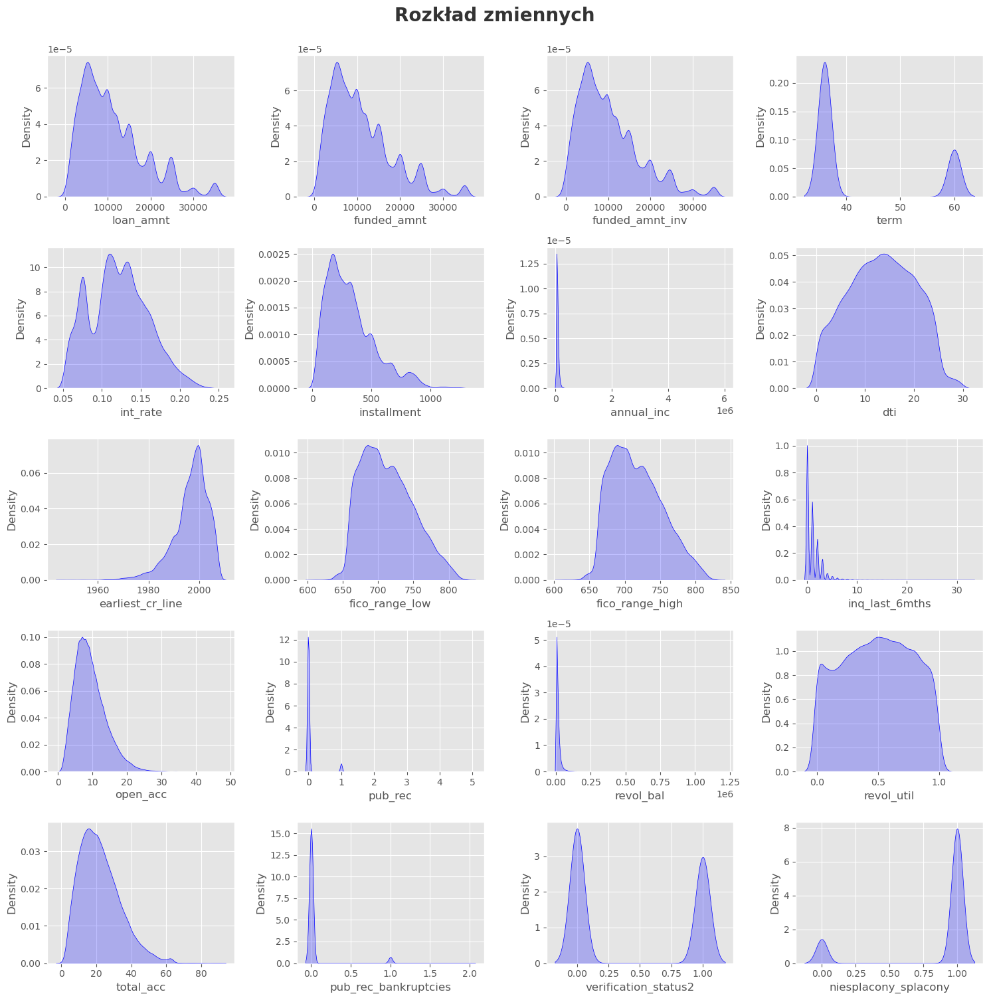

In [128]:
plt.figure(figsize=(15, 15))
plt.suptitle('Rozkład zmiennych', fontsize=20, fontweight='bold', alpha=0.8, y=1.)

for i in range(0, len(numeric_features)):
    plt.subplot(5, 4, i+1)
    sns.kdeplot(x=df[numeric_features[i]],shade=True, color='b')
    plt.xlabel(numeric_features[i])
    plt.tight_layout()

In [129]:
# Dti, fico, annual_inc, revol_bal mają rozkład normalny
# Prawostronnie asymetryczne - 'loan_amnt', 'funded_amnt', 'funded_amnt_inv', 'installment', 'total_acc'
# Lewostronnie asymetryczne - 'earliest_cr_line'

In [130]:
#Sprawdzam korelację między poszczególnymi wartościami

In [131]:
cor=df.corr()
cor

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,annual_inc,dti,earliest_cr_line,fico_range_low,fico_range_high,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,pub_rec_bankruptcies,verification_status2,niesplacony_splacony
loan_amnt,1.000,0.982,0.930,0.356,0.292,0.931,0.276,0.065,-0.191,0.133,0.133,-0.030,0.177,-0.051,0.254,0.065,0.257,-0.035,-0.323,-0.043
funded_amnt,0.982,1.000,0.948,0.335,0.295,0.957,0.272,0.065,-0.185,0.126,0.126,-0.030,0.175,-0.052,0.250,0.069,0.251,-0.037,-0.318,-0.040
funded_amnt_inv,0.930,0.948,1.000,0.364,0.280,0.890,0.252,0.071,-0.169,0.145,0.145,-0.075,0.156,-0.055,0.212,0.070,0.241,-0.037,-0.352,-0.010
term,0.356,0.335,0.364,1.000,0.429,0.098,0.043,0.077,-0.047,0.000,0.000,-0.013,0.046,0.005,0.029,0.065,0.095,0.015,-0.254,-0.134
int_rate,0.292,0.295,0.280,0.429,1.000,0.271,0.054,0.120,0.116,-0.703,-0.703,0.179,0.025,0.100,0.082,0.456,-0.032,0.085,-0.170,-0.201
installment,0.931,0.957,0.890,0.098,0.271,1.000,0.278,0.055,-0.169,0.064,0.064,-0.011,0.175,-0.046,0.265,0.094,0.234,-0.032,-0.268,-0.021
annual_inc,0.276,0.272,0.252,0.043,0.054,0.278,1.000,-0.117,-0.189,0.052,0.052,0.028,0.168,-0.016,0.284,0.021,0.246,-0.015,-0.106,0.038
dti,0.065,0.065,0.071,0.077,0.120,0.055,-0.117,1.000,-0.055,-0.191,-0.191,0.014,0.298,-0.003,0.191,0.279,0.241,0.010,-0.036,-0.042
earliest_cr_line,-0.191,-0.185,-0.169,-0.047,0.116,-0.169,-0.189,-0.055,1.000,-0.235,-0.235,0.004,-0.236,-0.052,-0.240,0.041,-0.387,-0.058,0.026,-0.020
fico_range_low,0.133,0.126,0.145,0.000,-0.703,0.064,0.052,-0.191,-0.235,1.000,1.000,-0.136,-0.026,-0.152,-0.022,-0.543,0.111,-0.124,-0.006,0.142


<AxesSubplot:>

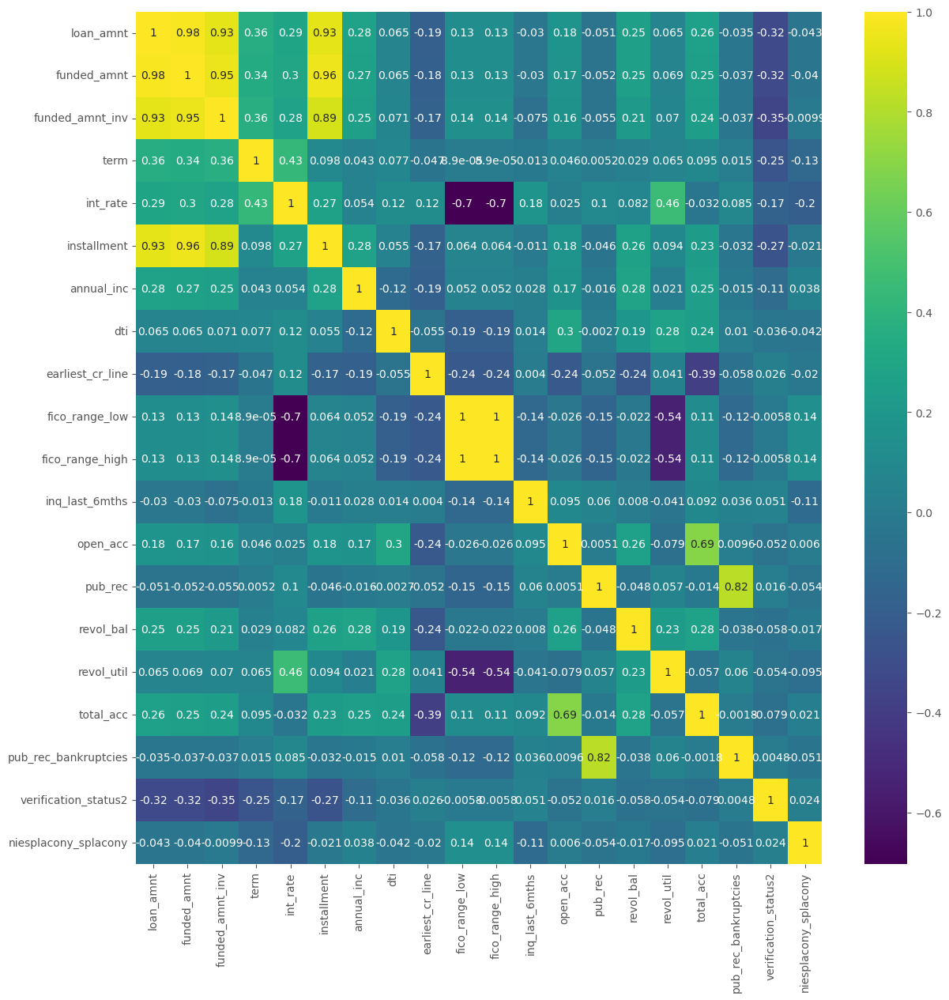

In [132]:
plt.figure(figsize=(14, 14))
sns.heatmap(df.corr(), annot=True, cmap='viridis')

In [133]:
# Najlepiej skorelowane z daną wyjściową są: 'fico range high' oraz 'fico range low' 
# Najbardziej odwrotnie skorelowane z daną wyjściową są 'int_rate', 'term'

In [134]:
# Wizualizacja współczynników zmiennych w przypadku więcej niż jednej zmiennej objaśniającej
coeff = list(model2.coef_)
labels = list(X_train.columns)
features = pd.DataFrame()
features['Features'] = labels
features['importance'] = coeff
features.sort_values(by=['importance'], ascending=True, inplace=True)
features['positive'] = features['importance'] > 0
features.set_index('Features', inplace=True)
features.importance.plot(kind='barh', figsize=(11, 6),color = features.positive.map({True: 'blue', False: 'red'}))
plt.xlabel('Importance')


In [ ]:
Chi-Squared Test

In [ ]:
from scipy.stats import chi2_contingency
table = ...
stat, p, dof, expected = chi2_contingency(table)

In [ ]:
from scipy.stats import chi2_contingency
  
# defining the table
data = [[207, 282, 241], [234, 242, 232]]
stat, p, dof, expected = chi2_contingency(data)
  
# interpret p-value
alpha = 0.05
print("p value is " + str(p))
if p <= alpha:
    print('Dependent (reject H0)')
else:
    print('Independent (H0 holds true)')

In [ ]:
Student’s t-test

In [ ]:
from scipy.stats import ttest_ind
data1, data2 = ...
stat, p = ttest_ind(data1, data2)

XXX FEATURE ENGINEERING

In [ ]:
# Identify the correlations in the numerical data

# Independent variables
X_num = df[num_data_features]
X_num = X_num.drop(['not.fully.paid'], axis = 1)

# Dependent variable
Y = df[['not.fully.paid']]

In [ ]:
# Generate a correlation
matrix = X_num.corr()
plt.figure(figsize = [40, 20])
sns.heatmap(matrix, annot = True, cmap = "Blues");

In [ ]:
features with strong correlations among themselves will be eliminated.

In [ ]:
# Select strong correlations among features
cor_pairs = matrix.unstack()
sorted_pairs = cor_pairs.sort_values(kind = 'quicksort')
strong_pairs = sorted_pairs[abs(sorted_pairs) > 0.7]

print(strong_pairs)

In [ ]:
def get_redundant_pairs(df):
    '''Get diagonal and lower triangular pairs of correlation matrix'''
    pairs_to_drop = set()
    cols = df.columns
    for i in range(0, df.shape[1]):
        for j in range(0, i+1):
            pairs_to_drop.add((cols[i], cols[j]))
    return pairs_to_drop

# Get top pairs
def get_top_abs_correlations(df, n=10):
    corr_list = df.abs().unstack()
    labels_to_drop = get_redundant_pairs(df)
    corr_list = corr_list.drop(labels=labels_to_drop).sort_values(ascending=False)
    return corr_list[0:n]

In [ ]:
# Get top 10 correlation pairs
print('Top 10 correlation pairs:')
get_top_abs_correlations(matrix, 5)

In [ ]:
# Feature Selection
Y = le.fit_transform(Y)
from sklearn.datasets import make_friedman1
from sklearn.svm import SVR
X_num, Y = make_friedman1(n_samples=9578, n_features=8, random_state=42)
estimator = SVR(kernel="linear")
rfe = RFE(estimator, n_features_to_select=5, step=1)
rfe = rfe.fit(X_num, Y.ravel())

In [ ]:
num_cols = df[num_data_features].drop(['not.fully.paid'], axis = 1)

In [ ]:
num_cols = num_cols.columns
num_cols

In [ ]:
# Check the RFE ranking
X_num = pd.DataFrame(X_num, columns = [num_cols])
list(zip(X_num.columns, rfe.support_, rfe.ranking_))

In [ ]:
# Columns selected by RFE
cols = X_num.columns[rfe.support_]
cols

In [ ]:
# columns not selected by RFE
X_num.columns[~rfe.support_]

In [ ]:
# Show the selected numerical features
num_vals = df[['int.rate', 'installment', 'log.annual.inc', 'dti', 'fico']]
num_vals.head()

In [ ]:
Select the best features in categorical data

In [ ]:
# Collecting the categorical data
cat_vars = df[cat_data_features].drop(['not.fully.paid'], axis = 1)
cat_vars

In [ ]:
# Perform the chi test and determine the f score and the p value
f_p_values = chi2(cat_vars, df['not.fully.paid'])
f_p_values

In [ ]:
Chi-square is used to find F-score and p-values for categorical features. 
So in this case the first array is for F score and the second array is for p-values.
The higher the value of the F score is the more important the feature and 
the smaller the value of the p-value the more important will be the feature. 
A p-value less 0.05 indicates that the feature is important.

In [ ]:
# Representing the p values in list form
p_values = pd.Series(f_p_values[1])
p_values.index = cat_vars.columns
p_values

In [ ]:
# Sorting the p values in ascending order
p_values.sort_values(ascending = True)

In [ ]:
Categorical features such as inq.last.6mths, credit.policy, and purpose have a p-value that is less than 0.05.
These will therefore be taken into consideration 
for model training as they are seen to mostly influence wether a client will default or not.

In [136]:

# Z tabeli wynika, że osoby mające problemy ze spłatą kredytu mają niższy roczny dochód, 
# wyższy wskaźnik dti (jaki procent zarobków stanowi rata kredytu). 
# Mają niższe wskaźniki fico, wyższe oprocentowanie kredytu. Płacą też wyższe raty.

pd.pivot_table(df, index='niesplacony_splacony', aggfunc='mean')

,annual_inc,dti,earliest_cr_line,fico_range_high,fico_range_low,inq_last_6mths,installment,int_rate,loan_amnt,open_acc,pub_rec,pub_rec_bankruptcies,revol_bal,revol_util,term,total_acc,verification_status2
niesplacony_splacony,,,,,,,,,,,,,,,,,
0,63366.871,14.046,1996.906,704.884,700.884,1.483,333.065,0.139,11837.428,9.280,0.089,0.068,15194.459,0.555,45.535,21.544,0.413
1,70162.845,13.253,1996.526,719.220,715.220,1.010,320.762,0.119,10956.503,9.355,0.053,0.039,14138.008,0.480,41.614,22.226,0.446


In [137]:
loan_df.info()

In [ ]:
# int_rate is object type let's convert in numeric type
loan_df['int_rate'] = loan_df['int_rate'].apply(lambda x: pd.to_numeric(x.split("%")[0]))

In [ ]:
loan_df.info()

In [138]:
#Funkcje, których będę używała do obliczeń dla wybranych zmiennych

In [139]:
def statystyka (df, zmienna):
    '''
    Ta funkcja oblicza podstawowe statystyki dla poszczegolnych zmiennych ze zbioru df
    '''
    print('Minimum: ', df[zmienna].min())
    print('Maximum: ',df[zmienna].max())
    print('Mean value: ', df[zmienna].mean())
    print('Median value: ',df[zmienna].median())
    print('Standard deviation: ', df[zmienna].std())

In [140]:
def kwartyle(df, zmienna):
    Q1=df[zmienna].quantile(q=0.25)
    Q3=df[zmienna].quantile(q=0.75)
    print('1st Quartile (Q1) is: ', Q1)
    print('3st Quartile (Q3) is: ', Q3)
    print('Interquartile range (IQR) is ', stats.iqr(df[zmienna]))

In [141]:
def gorny_dolny_outlier(dr, zmienna, Q1, Q3):
    '''
    Ta funkcja wylicza zakres od 1. do 3. kwartyla. Powyżej 3. kwartyla wartości należą do outlierow
    '''
    L_outliers=Q1-1.5*(Q3-Q1)
    U_outliers=Q3+1.5*(Q3-Q1)
    print('Lower outliers: ', L_outliers)
    print('Upper outliers: ', U_outliers)

In [142]:
def liczba_outlierow (df, wartosc, upper_out, lower_out):
    '''
    Ta funkcja będzie pokazywała liczbę outlierow oraz ich procentowy udział
    '''
    print('Liczba outlierow upper : ', df[df[wartosc]>upper_out][wartosc].count())
    print('Liczba outlierow lower : ', df[df[wartosc]<lower_out][wartosc].count())
    print('% outlierow upper: ',(df[df[wartosc]>upper_out][wartosc].count()*100/len(df)), '%')
    print('% outlierow lower: ',(df[df[wartosc]<lower_out][wartosc].count()*100/len(df)), '%')

In [ ]:
issue_d - The ‘issude_d’ feature is the string. 
Since we are dealing with three years of data and keep our model independent of year, 
I only extract month and then convert them into categories.

In [ ]:
df['issue_month'] = pd.Series(df.issue_d).str.replace(r'-\d+', '')
plot_feature('issue_month', False)

In [ ]:
It looks like people who borrowed in December, are more likely to be charged off than those who borrowed in other months.

## Zmienne numeryczne

### INTEREST RATE

In [143]:
statystyka(df, 'int_rate')

Minimum:  0.0542
Maximum:  0.2459
Mean value:  0.12165011519652409
Median value:  0.1199
Standard deviation:  0.037078920181680304


In [144]:
kwartyle(df, 'int_rate')

1st Quartile (Q1) is:  0.09630000000000001
3st Quartile (Q3) is:  0.1472
Interquartile range (IQR) is  0.05089999999999999


In [145]:
gorny_dolny_outlier(df,'int_rate', 0.097, 0.15)

Lower outliers:  0.017500000000000016
Upper outliers:  0.22949999999999998


In [146]:
liczba_outlierow(df, 'int_rate', 0.224, 0.02)

Liczba outlierow upper :  94
Liczba outlierow lower :  0
% outlierow upper:  0.22098927966898627 %
% outlierow lower:  0.0 %


D:\anaconda\lib\site-packages\seaborn\_core.py:1326: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))


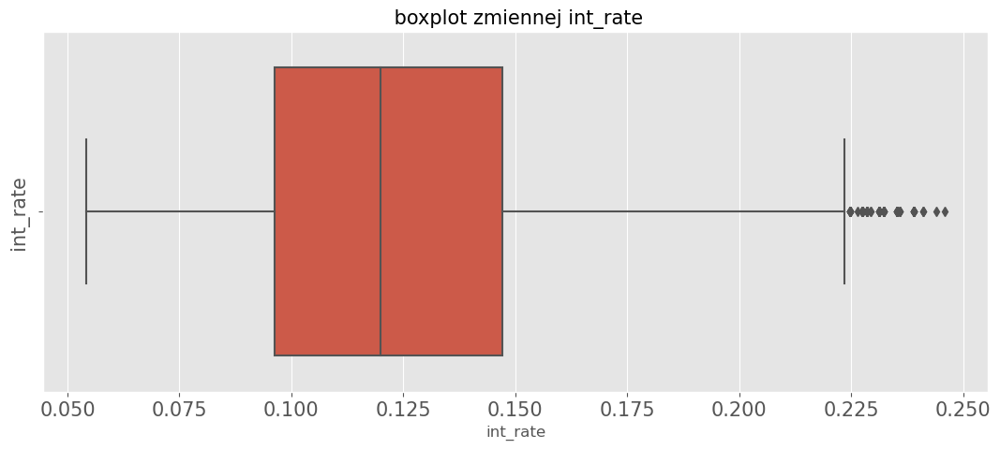

In [147]:
fig, (ax1)=plt.subplots(figsize=(13,5))


sns.boxplot(x='int_rate',data=df,orient='v',ax=ax1)
ax1.set_ylabel('int_rate', fontsize=15)
ax1.set_title(' boxplot zmiennej int_rate', fontsize=15)
ax1.tick_params(labelsize=15)

In [148]:
# Outliery powyżej 0.225

In [149]:
#Z tych danych wynika, że osoby niespłacające kredytów otrzymują wyższe oprocentowanie (średnio)

pd.pivot_table(df, index='niesplacony_splacony', values="int_rate", aggfunc='mean')

,int_rate
niesplacony_splacony,
0,0.139
1,0.119


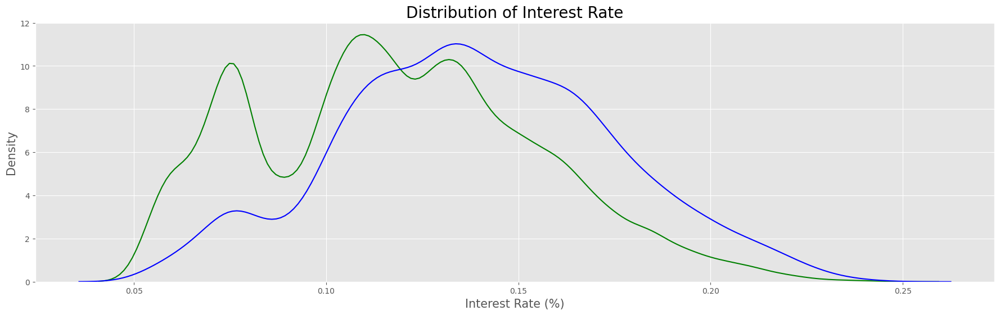

In [150]:
fig = plt.figure(figsize=(22,6))
sns.kdeplot(df.loc[df['niesplacony_splacony'] == 1, 'int_rate'], label = 'target = 1', color = 'green')
sns.kdeplot(df.loc[df['niesplacony_splacony'] == 0, 'int_rate'], label = 'target = 0', color = 'blue');
plt.xlabel('Interest Rate (%)',fontsize=15)
plt.ylabel('Density',fontsize=15)
plt.title('Distribution of Interest Rate',fontsize=20);

In [151]:
#Im wyższa klasa, tym wyższe oprocentowanie kredytu. Różnice między nie- i spłacającymi są minimalne

pd.pivot_table(df, index='niesplacony_splacony',columns="grade", values='int_rate', aggfunc='mean')

grade,A,B,C,D,E,F,G
niesplacony_splacony,,,,,,,
0,0.076,0.111,0.135,0.156,0.175,0.194,0.204
1,0.073,0.110,0.135,0.156,0.174,0.192,0.205


### ANNUAL INCOME

In [152]:
statystyka(df, 'annual_inc')

Minimum:  1896.0
Maximum:  6000000.0
Mean value:  69135.36489350203
Median value:  59000.0
Standard deviation:  64092.676551074255


In [153]:
kwartyle(df, 'annual_inc')

1st Quartile (Q1) is:  40000.0
3st Quartile (Q3) is:  82500.0
Interquartile range (IQR) is  42500.0


In [154]:
gorny_dolny_outlier(df, 'annual_inc', 40000, 82500)

Lower outliers:  -23750.0
Upper outliers:  146250.0


In [155]:
liczba_outlierow(df, 'annual_inc', 146250, -23750)

Liczba outlierow upper :  2032
Liczba outlierow lower :  0
% outlierow upper:  4.777129960504044 %
% outlierow lower:  0.0 %


D:\anaconda\lib\site-packages\seaborn\_core.py:1326: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))


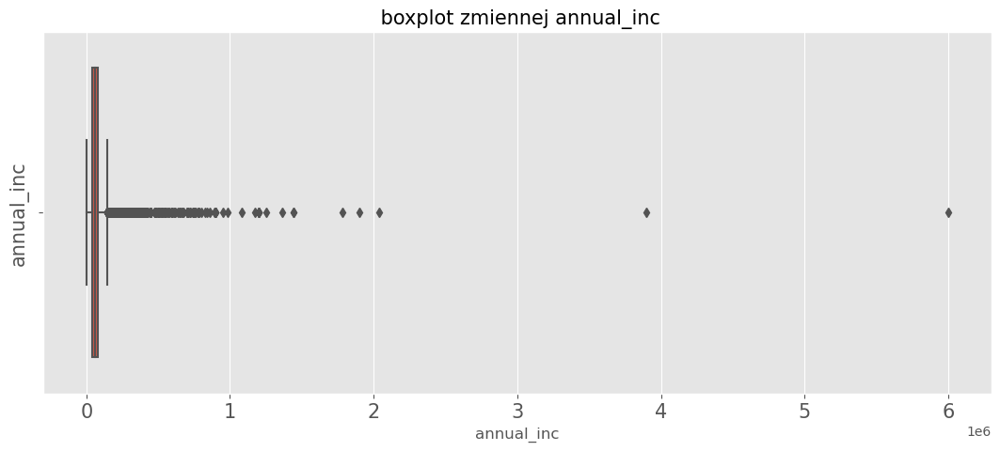

In [156]:
fig, (ax1)=plt.subplots(figsize=(13,5))


sns.boxplot(x='annual_inc',data=df,orient='v',ax=ax1)
ax1.set_ylabel('annual_inc', fontsize=15)
ax1.set_title(' boxplot zmiennej annual_inc', fontsize=15)
ax1.tick_params(labelsize=15)

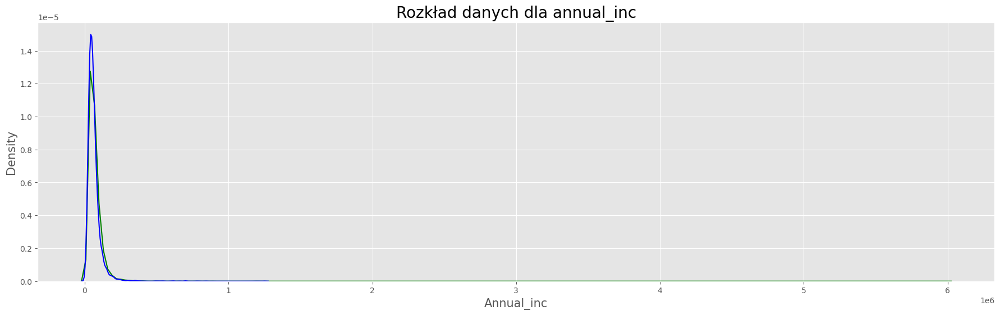

In [157]:
fig = plt.figure(figsize=(22,6))
sns.kdeplot(df.loc[df['niesplacony_splacony'] == 1, 'annual_inc'], label = 'target = 1', color = 'green')
sns.kdeplot(df.loc[df['niesplacony_splacony'] == 0, 'annual_inc'], label = 'target = 0', color = 'blue');
plt.xlabel('Annual_inc',fontsize=15)
plt.ylabel('Density',fontsize=15)
plt.title('Rozkład danych dla annual_inc',fontsize=20);

In [158]:
df.corr()['annual_inc'].sort_values().tail(10)

term              0.043
fico_range_high   0.052
fico_range_low    0.052
int_rate          0.054
open_acc          0.168
total_acc         0.246
loan_amnt         0.276
installment       0.278
revol_bal         0.284
annual_inc        1.000
Name: annual_inc, dtype: float64

In [159]:
#Zmienna 'annual_inc' jest wysoko pozytywnie skorelowana ze zmiennymi 'revol_bal', loan_amnt' i 'installment'

In [160]:
pd.pivot_table(df, index='niesplacony_splacony', values="annual_inc", aggfunc='mean')

,annual_inc
niesplacony_splacony,
0,63366.871
1,70162.845


In [161]:
#Osoby niespłacające mają niższe roczne dochody

In [ ]:
# annual income
def annual_income(n):
    if n <= 50000:
        return 'low'
    elif n > 50000 and n <=100000:
        return 'medium'
    elif n > 100000 and n <=150000:
        return 'high'
    else:
        return 'very high'

loan_df['annual_inc'] = loan_df['annual_inc'].apply(lambda x: annual_income(x))

In [ ]:
sns.barplot(x='annual_inc', y='loan_status', data=loan_df)
plt.show()

### DTi

In [162]:
#Jest to wskaźnik pokazujący, jaką część miesięcznych zarobków kredytobiorcy stanowi rata kredytu. 

In [163]:
statystyka(df, 'dti')

Minimum:  0.0
Maximum:  29.99
Mean value:  13.373045420349804
Median value:  13.47
Standard deviation:  6.7262358496920145


In [164]:
kwartyle(df, 'dti')

1st Quartile (Q1) is:  8.2
3st Quartile (Q3) is:  18.68
Interquartile range (IQR) is  10.48


In [165]:
gorny_dolny_outlier(df, 'dti', 8.2, 10.48)

Lower outliers:  4.779999999999998
Upper outliers:  13.900000000000002


In [166]:
liczba_outlierow(df, 'dti', 13.90, 4.78)

Liczba outlierow upper :  20320
Liczba outlierow lower :  5217
% outlierow upper:  47.77129960504043 %
% outlierow lower:  12.264905021628739 %


D:\anaconda\lib\site-packages\seaborn\_core.py:1326: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))


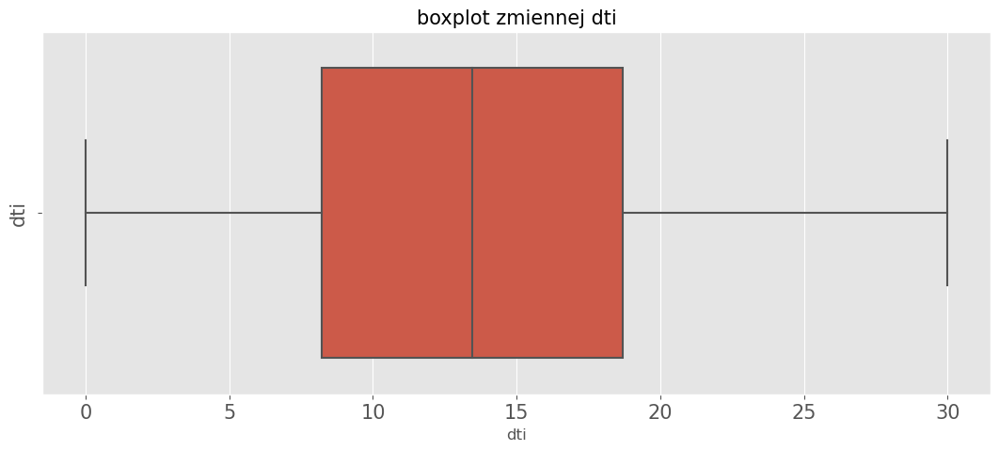

In [167]:
fig, (ax1)=plt.subplots(figsize=(13,5))

#boxplot
sns.boxplot(x='dti',data=df,orient='v',ax=ax1)
ax1.set_ylabel('dti', fontsize=15)
ax1.set_title('boxplot zmiennej dti', fontsize=15)
ax1.tick_params(labelsize=15)

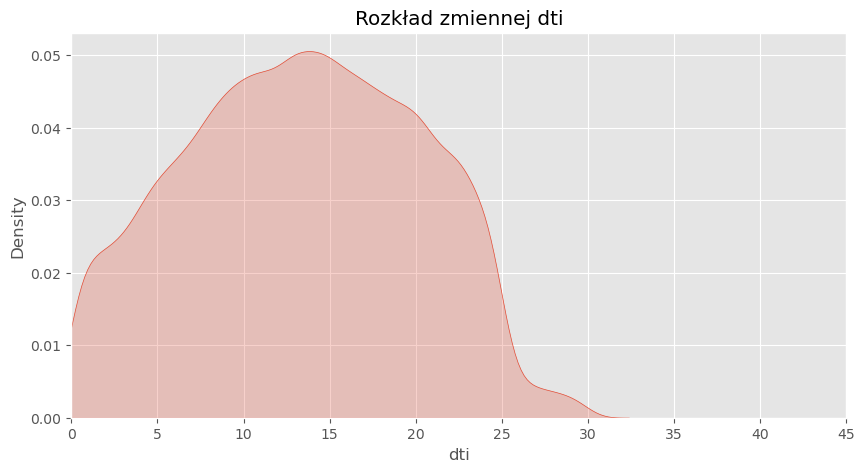

In [168]:
dti = df['dti']
plt.figure(figsize=(10,5))
plt.xlim(0, 45)
plt.title('Rozkład zmiennej dti')
sns.kdeplot(dti , shade=True)
plt.show()

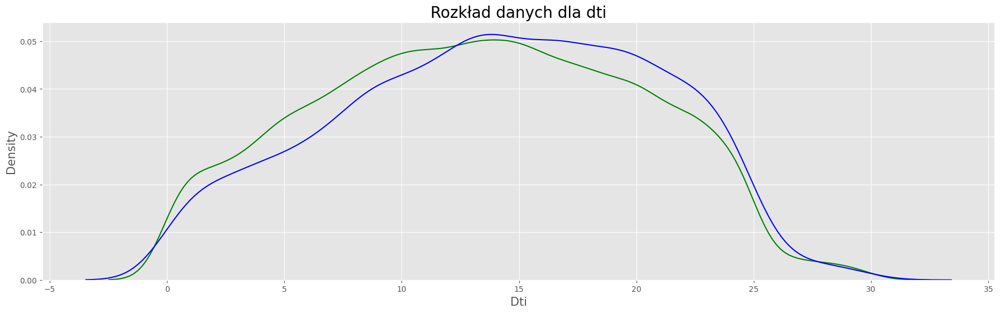

In [169]:
fig = plt.figure(figsize=(22,6))
sns.kdeplot(df.loc[df['niesplacony_splacony'] == 1, 'dti'], label = 'target = 1', color = 'green')
sns.kdeplot(df.loc[df['niesplacony_splacony'] == 0, 'dti'], label = 'target = 0', color = 'blue');
plt.xlabel('Dti',fontsize=15)
plt.ylabel('Density',fontsize=15)
plt.title('Rozkład danych dla dti',fontsize=20);

In [170]:
pd.pivot_table(df, index='niesplacony_splacony', values='dti', aggfunc='mean')

,dti
niesplacony_splacony,
0,14.046
1,13.253


In [171]:
#Osoby niespłacające mają nieznacznie wyższy wskażnik dti - stosunek zobowiązań do dochodów

### LOAN AMOUNT

In [172]:
statystyka(df, 'loan_amnt')

Minimum:  500.0
Maximum:  35000.0
Mean value:  11089.68990972353
Median value:  9700.0
Standard deviation:  7410.8543376499565


In [173]:
kwartyle(df, 'loan_amnt')

1st Quartile (Q1) is:  5200.0
3st Quartile (Q3) is:  15000.0
Interquartile range (IQR) is  9800.0


In [174]:
gorny_dolny_outlier(df, 'loan_amnt', 5200, 15000)

Lower outliers:  -9500.0
Upper outliers:  29700.0


In [175]:
liczba_outlierow(df, 'loan_amnt', 29700, -9500)

Liczba outlierow upper :  1218
Liczba outlierow lower :  0
% outlierow upper:  2.863456836561971 %
% outlierow lower:  0.0 %


D:\anaconda\lib\site-packages\seaborn\_core.py:1326: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))


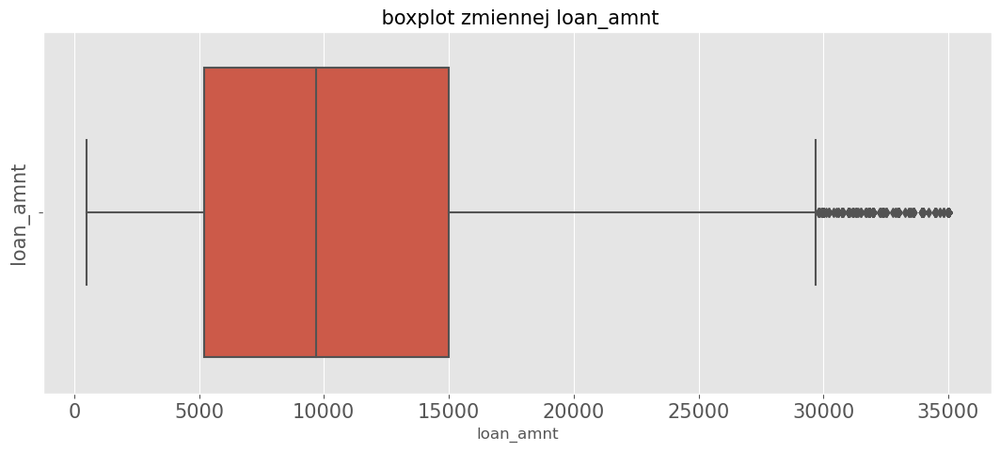

In [176]:
fig, (ax1)=plt.subplots(figsize=(13,5))

#boxplot
sns.boxplot(x='loan_amnt',data=df,orient='v',ax=ax1)
ax1.set_ylabel('loan_amnt', fontsize=15)
ax1.set_title(' boxplot zmiennej loan_amnt', fontsize=15)
ax1.tick_params(labelsize=15)

In [177]:
# W 'loan_amnt' widać outliery powyżej 30000

In [178]:
# Osoby niespłącające kredytów mają wyższe kwoty przydzielonego kredytu

df[['loan_amnt', 'niesplacony_splacony']].groupby(['niesplacony_splacony'], as_index=False).mean().sort_values(by='loan_amnt', ascending=False)

,niesplacony_splacony,loan_amnt
0,0,11837.428
1,1,10956.503


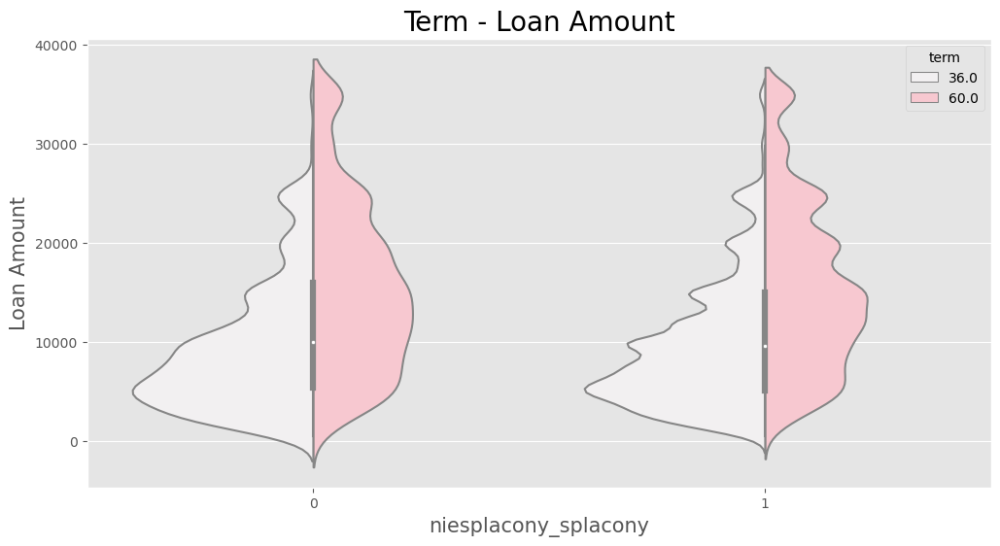

In [179]:
fig = plt.figure(figsize=(12,6))
sns.violinplot(x="niesplacony_splacony",y="loan_amnt",data=df, hue="term", split=True,color='pink')
plt.title("Term - Loan Amount", fontsize=20)
plt.xlabel("niesplacony_splacony", fontsize=15)
plt.ylabel("Loan Amount", fontsize=15);

In [180]:
#Widać, że osoby zaciągające kredyt na dłyższy okres (60mcy), zadłużają się na wyższe kwoty

<AxesSubplot:xlabel='grade', ylabel='loan_amnt'>

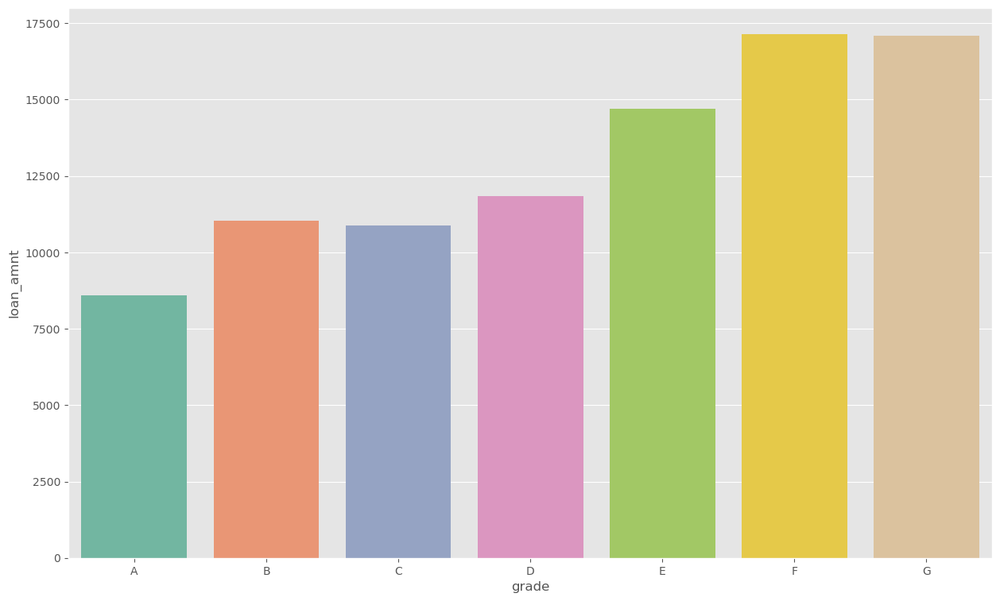

In [181]:
#Chcę sprawdzić, jak wyglądają kwoty kredytu dla poszczólnych grup (zmienna 'grade')

group = df.groupby("grade").mean()
avg_loan = group['loan_amnt'].reset_index()
plt.subplots(figsize=(15,9))
sns.barplot(x='grade', y='loan_amnt', data=avg_loan, palette='Set2')

In [182]:
#Osoby z grupy najwyższego ryzyka (G) zadłużają się na wyższe kwoty. Im wyższa grupa ryzyka, tym większe kwoty kredytu

In [ ]:
sns.displot(loan_df['loan_amnt'])
plt.show()

In [ ]:
def loan_amount(amnt):
    if amnt < 5000:
        return 'low'
    elif amnt >= 5000 and amnt < 15000:
        return 'medium'
    elif amnt >=15000 and amnt < 25000:
        return 'high'
    else:
        return 'very high'
    
    
loan_df['loan_amnt'] = loan_df['loan_amnt'].apply(lambda x: loan_amount(x))

In [ ]:
loan_df['loan_amnt'].value_counts()

In [ ]:
sns.barplot(x='loan_amnt', y='loan_status', data=loan_df)
plt.show()

### INSTALLMENT

In [183]:
statystyka(df, 'installment')

Minimum:  15.67
Maximum:  1305.19
Mean value:  322.6220063005406
Median value:  277.69
Standard deviation:  208.92487412535752


In [184]:
kwartyle(df, 'installment')

1st Quartile (Q1) is:  165.53500000000003
3st Quartile (Q3) is:  428.155
Interquartile range (IQR) is  262.61999999999995


In [185]:
gorny_dolny_outlier(df, 'installment', 165.54, 428.16)

Lower outliers:  -228.39000000000001
Upper outliers:  822.09


In [186]:
liczba_outlierow(df, 'installment', 822, -228.4)

Liczba outlierow upper :  1393
Liczba outlierow lower :  0
% outlierow upper:  3.2748730487116795 %
% outlierow lower:  0.0 %


D:\anaconda\lib\site-packages\seaborn\_core.py:1326: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))


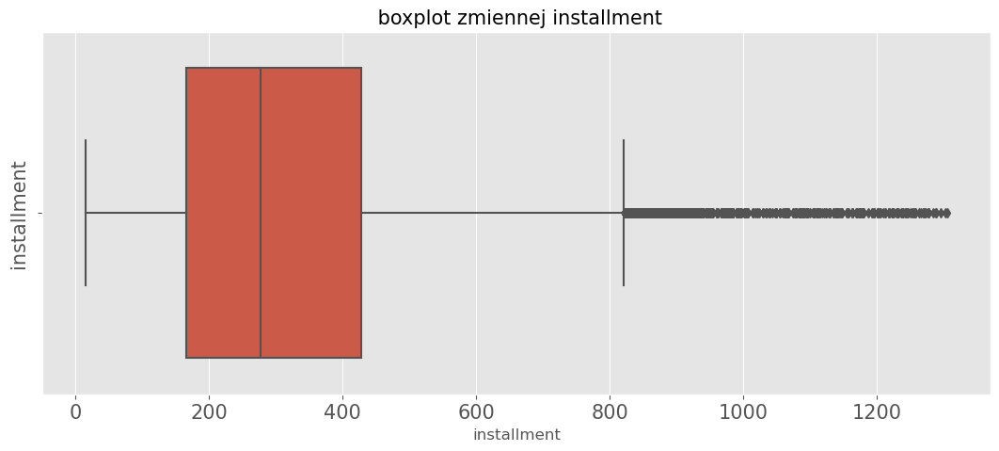

In [187]:
fig, (ax1)=plt.subplots(figsize=(13,5))


sns.boxplot(x='installment',data=df,orient='v',ax=ax1)
ax1.set_ylabel('installment', fontsize=15)
ax1.set_title(' boxplot zmiennej installment', fontsize=15)
ax1.tick_params(labelsize=15)

In [188]:
# Outliery powyżej 800

In [189]:
#Kredytobiorcy, którzy niespłacają kredytów mają nieco wyższe raty kredytu.

pd.pivot_table(df, index='niesplacony_splacony', values="installment", aggfunc='mean')

,installment
niesplacony_splacony,
0,333.065
1,320.762


### INQUIERIES IN THE LAST 6 MONTHS

In [190]:
statystyka(df, 'inq_last_6mths')

Minimum:  0.0
Maximum:  33.0
Mean value:  1.0813663720142939
Median value:  1.0
Standard deviation:  1.5269176123050658


In [191]:
kwartyle(df, 'inq_last_6mths')

1st Quartile (Q1) is:  0.0
3st Quartile (Q3) is:  2.0
Interquartile range (IQR) is  2.0


In [192]:
gorny_dolny_outlier(df, 'inq_last_6mths', 0.0, 2.0)

Lower outliers:  -3.0
Upper outliers:  5.0


In [193]:
liczba_outlierow(df, 'inq_last_6mths', 5.0, -3.0)

Liczba outlierow upper :  781
Liczba outlierow lower :  0
% outlierow upper:  1.836091781079556 %
% outlierow lower:  0.0 %


D:\anaconda\lib\site-packages\seaborn\_core.py:1326: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))


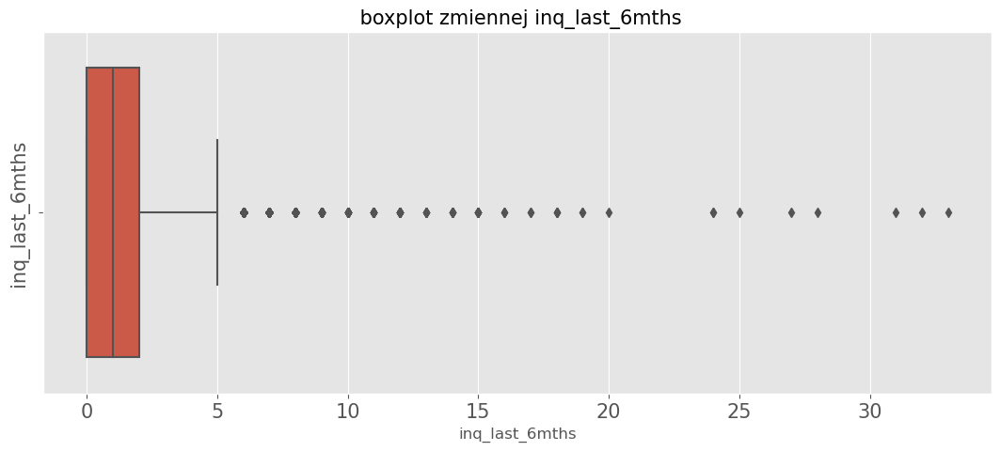

In [194]:
fig, (ax1)=plt.subplots(figsize=(13,5))


sns.boxplot(x='inq_last_6mths',data=df,orient='v',ax=ax1)
ax1.set_ylabel('inq_last_6mths', fontsize=15)
ax1.set_title(' boxplot zmiennej inq_last_6mths', fontsize=15)
ax1.tick_params(labelsize=15)

In [195]:
# Outliersy dla więcej niż 5 składanych wniosków kredytowych

<AxesSubplot:xlabel='grade', ylabel='inq_last_6mths'>

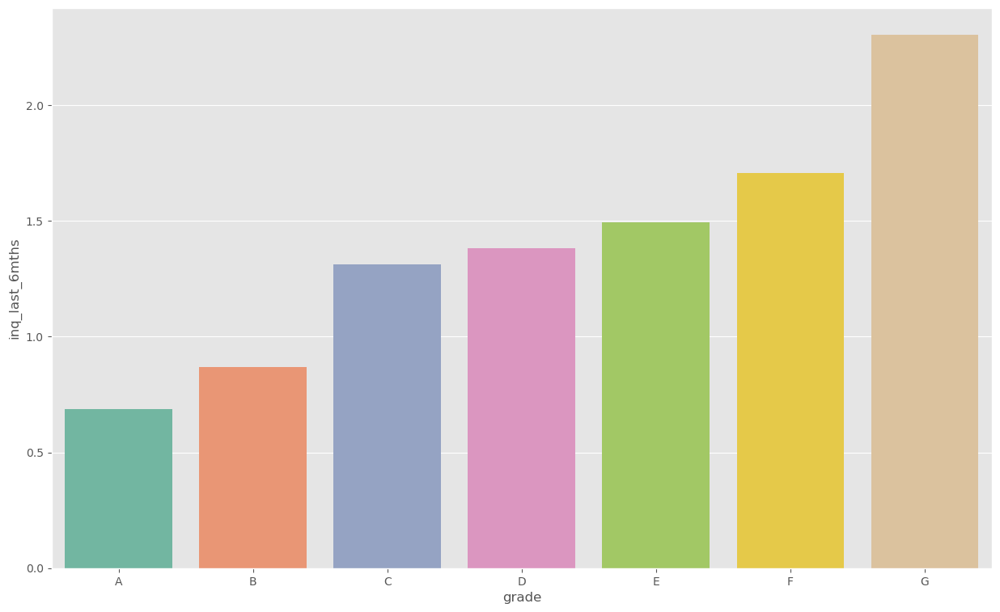

In [196]:
#Chcę sprawdzić, ile wniosków kredytowych składanych jest w poszczególnych grupach (zmienna 'grade')

group = df.groupby("grade").mean()
avg_loan = group['inq_last_6mths'].reset_index()
plt.subplots(figsize=(15,9))
sns.barplot(x='grade', y='inq_last_6mths', data=avg_loan, palette='Set2')

In [197]:
#Im wyższa grupa ryzyka, tym więcej wniosków kredytowych jest składanych

In [198]:
#Osoby częściej składające wnioski o przyznanie kredytu, częściej mają problemy z jego spłatą

pd.pivot_table(df, index='niesplacony_splacony', values='inq_last_6mths', aggfunc='mean')

,inq_last_6mths
niesplacony_splacony,
0,1.483
1,1.010


### FICO_RANGE_HIGH i FICO_RANGE_LOW

In [199]:
df[['fico_range_low','fico_range_high']].describe()

,fico_range_low,fico_range_high
count,42536.000,42536.000
mean,713.052,717.052
std,36.188,36.188
min,610.000,614.000
25%,685.000,689.000
50%,710.000,714.000
75%,740.000,744.000
max,825.000,829.000


In [200]:
# Wyniki dla obywdu zmiennych są bardzo podobne. 
# Sprawdzę korelację pomiędzy nimi

In [201]:
df[['fico_range_low','fico_range_high']].corr()

,fico_range_low,fico_range_high
fico_range_low,1.000,1.000
fico_range_high,1.000,1.000


In [202]:
# Zmienne są silnie skorelowane, więc do analizy potrzebuję tylko jednej. 
# Stworzę nową kolumnę 'fico', która będzie zawierała średnie wartości obydwu

In [203]:
df['fico'] = (df['fico_range_low'] + df['fico_range_high'])/2

In [204]:
df.drop(['fico_range_high', 'fico_range_low'], axis=1, inplace=True)

In [205]:
#Osoby niespłącające kredytów mają niższy wskaźnik FICO

pd.pivot_table(df, index='niesplacony_splacony', values='fico', aggfunc='mean')

,fico
niesplacony_splacony,
0,702.884
1,717.220


In [206]:
statystyka(df, 'fico')

Minimum:  612.0
Maximum:  827.0
Mean value:  715.0524731991725
Median value:  712.0
Standard deviation:  36.18801616454543


In [207]:
kwartyle(df, 'fico')

1st Quartile (Q1) is:  687.0
3st Quartile (Q3) is:  742.0
Interquartile range (IQR) is  55.0


In [208]:
gorny_dolny_outlier(df, 'fico',687, 742)

Lower outliers:  604.5
Upper outliers:  824.5


In [209]:
liczba_outlierow(df, 'fico', 824.5, 604.5)

Liczba outlierow upper :  3
Liczba outlierow lower :  0
% outlierow upper:  0.00705284935113786 %
% outlierow lower:  0.0 %


D:\anaconda\lib\site-packages\seaborn\_core.py:1326: UserWarning: Vertical orientation ignored with only `x` specified.
  warnings.warn(single_var_warning.format("Vertical", "x"))


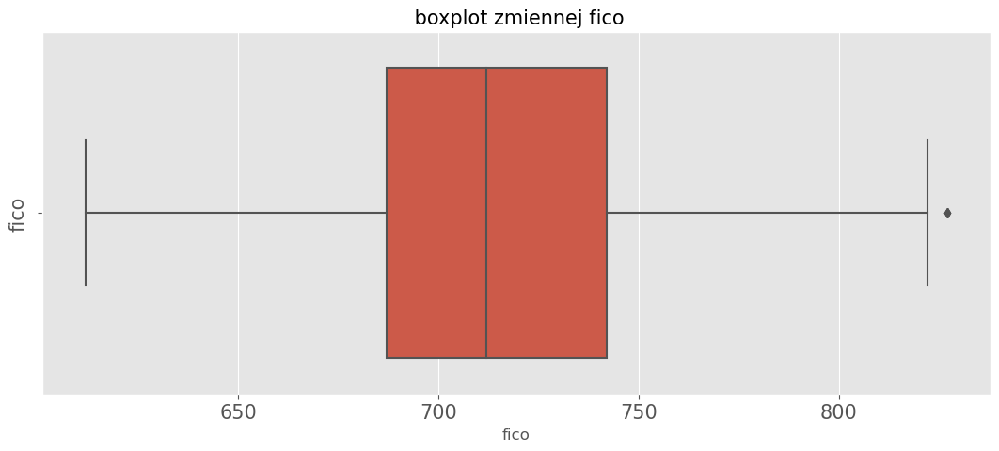

In [210]:
fig, (ax1)=plt.subplots(figsize=(13,5))


sns.boxplot(x='fico',data=df,orient='v',ax=ax1)
ax1.set_ylabel('fico', fontsize=15)
ax1.set_title(' boxplot zmiennej fico', fontsize=15)
ax1.tick_params(labelsize=15)

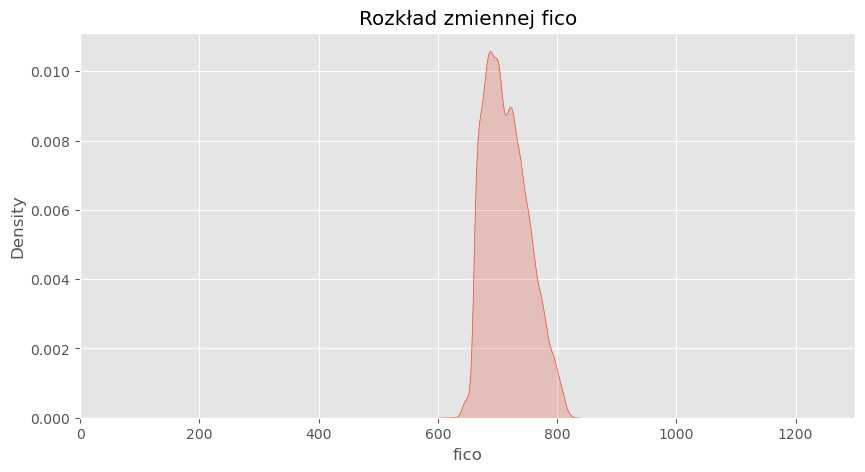

In [211]:
plt.figure(figsize=(10,5))
plt.xlim(0, 1300)
plt.title('Rozkład zmiennej fico')
sns.kdeplot(df['fico'], shade=True)
plt.show()

In [212]:
#Najwyższa gęstość występuje w okolicach 700

In [213]:
df[['fico','int_rate','term']].corr()

,fico,int_rate,term
fico,1.000,-0.703,0.000
int_rate,-0.703,1.000,0.429
term,0.000,0.429,1.000


In [214]:
#Wskaźnik FICO ma wysoką ujemną korelację z wysokością oprocentowania - im wyższy FICO tym niższe oprocentowanie.

In [ ]:
# first, let's drop the missing value observations in emp length
loan_df = loan_df[~loan_df['emp_length'].isnull()]

# binning the variable
def emp_length(n):
    if n <= 1:
        return 'fresher'
    elif n > 1 and n <=3:
        return 'junior'
    elif n > 3 and n <=7:
        return 'senior'
    else:
        return 'expert'

loan_df['emp_length'] = loan_df['emp_length'].apply(lambda x: emp_length(x))

In [ ]:
sns.barplot(x='emp_length', y='loan_status', data=loan_df)
plt.show()

## Zmienne kategoryczne

## GRADE

In [215]:
df.groupby(['grade'])['int_rate'].mean()

grade
A   0.073
B   0.110
C   0.135
D   0.156
E   0.174
F   0.193
G   0.205
Name: int_rate, dtype: float64

In [216]:
#Wraz ze wzrostem grupy, wzrasta oprocentowanie kredytu.

In [217]:
pd.pivot_table(df, index="niesplacony_splacony", columns="grade", aggfunc="size")

grade,A,B,C,D,E,F,G
niesplacony_splacony,,,,,,,
0,610,1518,1504,1327,883,416,173
1,9573,10872,7236,4689,2511,885,339


In [218]:
print("% osób spłacających pożyczki w poszczególnych grupach")
print(f"A: {round((9573)/(610+9573) * 100, 2)}%")
print(f"B: {round((10872)/(1518+10872) * 100, 2)}%")
print(f"C: {round((7236)/(1504+7236) * 100, 2)}%")
print(f"D: {round((4689)/(1327+4689) * 100, 2)}%")
print(f"E: {round((2511)/(883+2511) * 100, 2)}%")
print(f"F: {round((885)/(885+416)* 100, 2)}%")
print(f"G: {round((339)/(173+339)* 100, 2)}%")

% osób spłacających pożyczki w poszczególnych grupach
A: 94.01%
B: 87.75%
C: 82.79%
D: 77.94%
E: 73.98%
F: 68.02%
G: 66.21%


In [219]:
#Wraz ze wzrostem grupy ryzyka, wzrasta również odsetek osób niespłacających kredytów

### HOME OWNERSHIP

In [220]:
df['home_ownership'].value_counts()

RENT        20182
MORTGAGE    18959
OWN          3251
OTHER         136
NONE            8
Name: home_ownership, dtype: int64

In [221]:
#Kategorie 'NONE', 'OTHER' zawierają małe ilości kredytobiorców, dlatego połączę je w jednej kolumnie


df['home_ownership'].replace(['NONE', 'OTHER'], 'OTHERS', inplace=True)

In [222]:
df['home_ownership'].value_counts()

RENT        20182
MORTGAGE    18959
OWN          3251
OTHERS        144
Name: home_ownership, dtype: int64

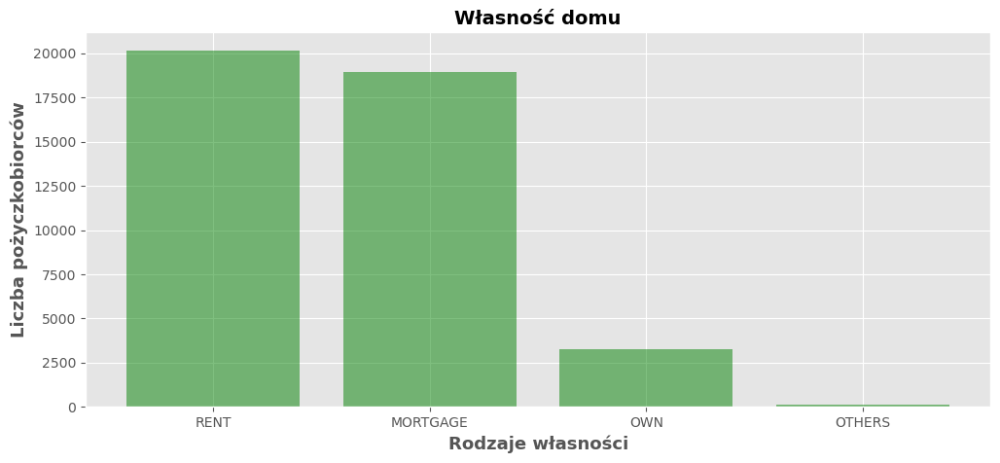

In [223]:
A = df['home_ownership'].value_counts().sort_values(ascending=False)[:5]
f, ax = plt.subplots(figsize=(12,5))
plt.bar(A.index, A.values, color='green', alpha=0.5)
plt.title('Własność domu', fontsize=14.0, fontweight='bold')
plt.xlabel('Rodzaje własności', fontsize=13.0, fontweight='bold')
plt.ylabel("Liczba pożyczkobiorców", fontsize=13.0, fontweight='bold')
plt.show()

In [224]:
#Najwięcej osób biorących kredyty wynajmuje mieszkanie

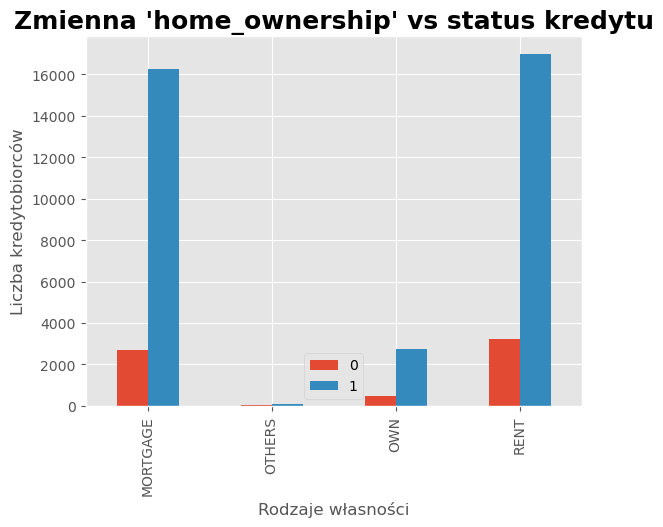

In [225]:
pd.crosstab(df["home_ownership"], df['niesplacony_splacony']).plot(kind="bar")
plt.title("Zmienna 'home_ownership' vs status kredytu", fontsize=18.0, fontweight='bold')
plt.xlabel("Rodzaje własności")
plt.ylabel("Liczba kredytobiorców")
plt.legend(loc="best")
plt.show()

In [226]:
pd.crosstab(df['home_ownership'], df['niesplacony_splacony'])

niesplacony_splacony,0,1
home_ownership,,
MORTGAGE,2699,16260
OTHERS,30,114
OWN,495,2756
RENT,3207,16975


In [227]:
print("% osób spłacających pożyczki w poszczególnych rodzajach własności")
print(f"MORTGAGE: {round((16260)/(2699+16260) * 100, 2)}%")
print(f"OTHERS: {round((114)/(30+114) * 100, 2)}%")
print(f"OWN: {round((2756)/(495+2756) * 100, 2)}%")
print(f"RENT: {round((16975)/(3207+16975) * 100, 2)}%")

% osób spłacających pożyczki w poszczególnych rodzajach własności
MORTGAGE: 85.76%
OTHERS: 79.17%
OWN: 84.77%
RENT: 84.11%


In [228]:
#Osoby spłacające kredyt hipoteczny radzą sobie nieco lepiej niż osoby wynajmujące i posiadające własne domy

In [229]:
#Oprocentowanie z podziałem na poszczególne rodzaje z uwzględnieniem statusu kredytu

pd.crosstab(df['home_ownership'], df['niesplacony_splacony'], values=df['int_rate'], aggfunc='mean')

niesplacony_splacony,0,1
home_ownership,,
MORTGAGE,0.139,0.116
OTHERS,0.139,0.122
OWN,0.138,0.116
RENT,0.139,0.121


In [230]:
#Osoby niespłacające mają wyższe oprocentowanie w każdym rodzaju własności
#Samo oprocentowanie nie różni się zbytnio w poszczególnych rodzajach własności

In [231]:
#Tabela przedstawia wysokość oprocentowania kredytu z podziałem na grupy ('grade') i status pożyczki dla każdego rodzaju własności

A = pd.crosstab(df['grade'],[df['home_ownership'], df['niesplacony_splacony']], values=df['int_rate'], aggfunc='mean')
A

home_ownership       MORTGAGE       OTHERS         OWN        RENT      
niesplacony_splacony        0     1      0     1     0     1     0     1
grade                                                                   
A                       0.075 0.072  0.088 0.085 0.075 0.073 0.077 0.074
B                       0.111 0.110  0.111 0.113 0.111 0.111 0.111 0.110
C                       0.135 0.135  0.127 0.128 0.135 0.136 0.135 0.135
D                       0.156 0.157  0.156 0.144 0.157 0.156 0.157 0.155
E                       0.176 0.175  0.154 0.160 0.177 0.175 0.173 0.172
F                       0.193 0.195  0.168 0.166 0.197 0.191 0.194 0.190
G                       0.201 0.205  0.190 0.189 0.201 0.205 0.208 0.205

In [232]:
#Ta tabela potwierdza tezę, że osoby z wyższej grupy otrzymują wyższe oprocentowanie (rośnie ono wraz ze wzrostem grupy)
#Wysokość oprocentowania nie różni się też mniędzy poszczególnymi rodzajami własności

### PURPOSE

In [233]:
df['purpose'].value_counts().sort_values(ascending=False)

debt_consolidation    19777
credit_card            5477
other                  4425
home_improvement       3199
major_purchase         2311
small_business         1992
car                    1615
wedding                1004
medical                 753
moving                  629
house                   426
educational             422
vacation                400
renewable_energy        106
Name: purpose, dtype: int64

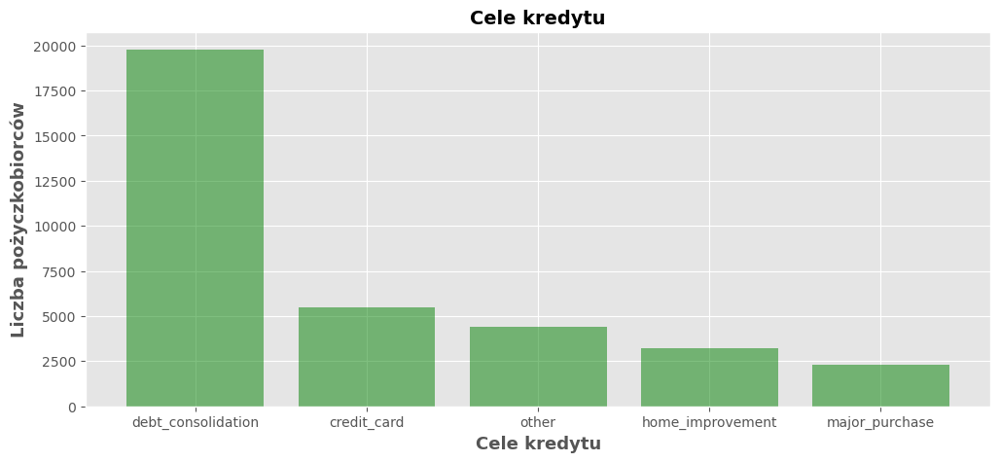

In [234]:
A = df['purpose'].value_counts().sort_values(ascending=False)[:5]
f, ax = plt.subplots(figsize=(12,5))
plt.bar(A.index, A.values, color='green', alpha=0.5)
plt.title('Cele kredytu', fontsize=14.0, fontweight='bold')
plt.xlabel('Cele kredytu', fontsize=13.0, fontweight='bold')
plt.ylabel('Liczba pożyczkobiorców', fontsize=13.0, fontweight='bold')
plt.show()

In [235]:
#Najwięcej osób decyduje się na kredyt konsolidacyjny

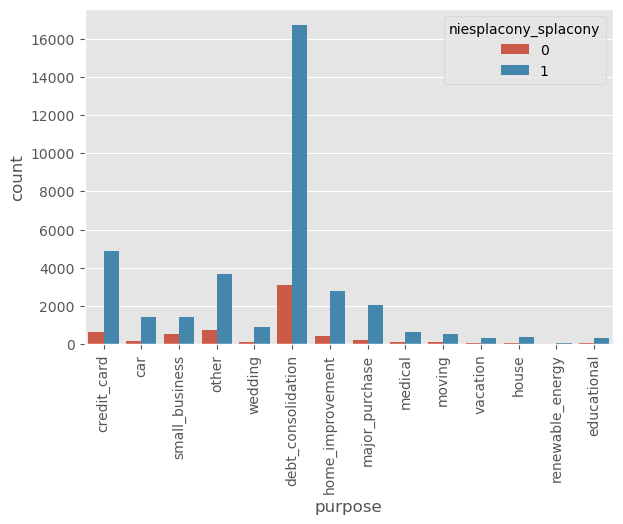

In [236]:
plt.figure(figsize=(15, 20))

plt.subplot(4, 2, 4)
g = sns.countplot(x='purpose', data=df, hue='niesplacony_splacony')
g.set_xticklabels(g.get_xticklabels(), rotation=90);

In [237]:
# Chcę sprawdzić, jaki odsetek kredytów jest spłacany w każdum celu kredytowym

pd.crosstab(df['purpose'], df['niesplacony_splacony'].sort_values(ascending=False))

niesplacony_splacony,0,1
purpose,,
car,173,1442
credit_card,617,4860
debt_consolidation,3084,16693
educational,88,334
home_improvement,422,2777
house,70,356
major_purchase,245,2066
medical,128,625
moving,107,522


In [238]:
print("% osób spłacających pożyczki w poszczególnych grupach")
print(f"car: {round((1442)/(173+1442) * 100, 2)}%")
print(f"credit_card: {round((4860)/(617+4860) * 100, 2)}%")
print(f"debt_consolidation: {round((16693)/(3084+16693) * 100, 2)}%")
print(f"educational: {round((334)/(88+334) * 100, 2)}%")
print(f"home_improvement: {round((2777)/(422+2777) * 100, 2)}%")
print(f"house: {round((356)/(70+356)* 100, 2)}%")
print(f"major_purchase: {round((339)/(173+339)* 100, 2)}%")
print(f"medical: {round((625)/(128+625) * 100, 2)}%")
print(f"moving: {round((522)/(522+107) * 100, 2)}%")
print(f"other: {round((3667)/(758+3667) * 100, 2)}%")
print(f"renewable_energy: {round((86)/(20+86) * 100, 2)}%")
print(f"small_business: {round((1441)/(551+1441) * 100, 2)}%")
print(f"vacation: {round((341)/(59+341)* 100, 2)}%")
print(f"wedding: {round((895)/(109+895)* 100, 2)}%")

% osób spłacających pożyczki w poszczególnych grupach
car: 89.29%
credit_card: 88.73%
debt_consolidation: 84.41%
educational: 79.15%
home_improvement: 86.81%
house: 83.57%
major_purchase: 66.21%
medical: 83.0%
moving: 82.99%
other: 82.87%
renewable_energy: 81.13%
small_business: 72.34%
vacation: 85.25%
wedding: 89.14%


In [239]:
#Spłacalność kredytów jest podobna dla różnych celów kredytowych (z wyjątkiem 'major_purchase' i 'small_business')
#Wydaje mi się, że ta zmnienna nie będzie miała dużego znaczenia w predykcji

### TERM

In [240]:
pd.crosstab(df['term'], df['niesplacony_splacony'])

niesplacony_splacony,0,1
term,,
36.000,3876,27659
60.000,2555,8446


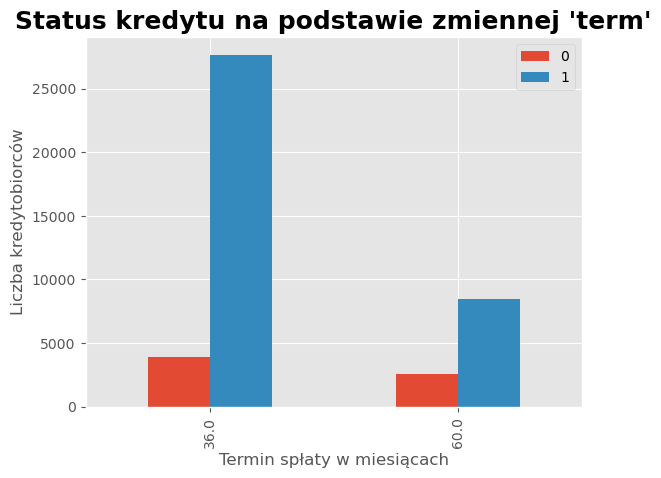

In [241]:
pd.crosstab(df['term'], df['niesplacony_splacony']).plot(kind="bar")
plt.title("Status kredytu na podstawie zmiennej 'term'", fontsize=18.0, fontweight='bold')
plt.xlabel("Termin spłaty w miesiącach")
plt.ylabel("Liczba kredytobiorców")
plt.legend(loc="best")
plt.show()

In [242]:
#Chcę sprawdzić, jak wygląda spłacalność kredytu dla obu wartości

In [243]:
print("% osób niespłacających pożyczki - 36mcy")
print(f"car: {round((3876)/(3876+27659) * 100, 2)}%")

% osób niespłacających pożyczki - 36mcy
car: 12.29%


In [244]:
print("% osób niespłacających pożyczki - 60mcy")
print(f"car: {round((2555)/(2555+8446) * 100, 2)}%")

% osób niespłacających pożyczki - 60mcy
car: 23.23%


In [245]:
#Osoby z dłuższym terminem płatności częściej nie spłacają pożyczek

### 1. W jaki sposób wynik FICO wiąże się z prawdopodobieństwem spłacenia pożyczki przez pożyczkobiorcę?

In [246]:
#Osoby niespłącające kredytów (0) mają niższy wskaźnik FICO

In [247]:
pd.pivot_table(df, index='niesplacony_splacony', values='fico', aggfunc='mean')

,fico
niesplacony_splacony,
0,702.884
1,717.220


### 2. W jaki sposób wiek kredytowy wiąże się z prawdopodobieństwem niewykonania zobowiązania i czy ryzyko to jest niezależne lub związane z wynikiem FICO?


In [248]:
pd.crosstab(df['earliest_cr_line'],[df['niesplacony_splacony']])

niesplacony_splacony,0,1
earliest_cr_line,,
1946.000,0,1
1950.000,0,1
1954.000,0,2
1956.000,0,1
1959.000,0,2
1961.000,0,2
1962.000,2,3
1963.000,2,10
1964.000,0,9


In [249]:
#Obliczam, jaki jest odsetek nie- i spłaconych pożyczek dla każdego roku

df_percent = pd.crosstab(df['earliest_cr_line'],df['niesplacony_splacony'],
                         normalize = 'index').rename_axis(None) 

df_percent *= 100

In [250]:
df_percent

niesplacony_splacony,0,1
1946.000,0.000,100.000
1950.000,0.000,100.000
1954.000,0.000,100.000
1956.000,0.000,100.000
1959.000,0.000,100.000
1961.000,0.000,100.000
1962.000,40.000,60.000
1963.000,16.667,83.333
1964.000,0.000,100.000
1965.000,11.111,88.889


In [251]:
#Najwcześniej otwarte historie kredytowe mają 100% spłacalność. Jest ich kilka, więc nie wyznaczają trendu, ponieważ 
#od ok 1965 spłacalność waha się między 80 a 90%

In [252]:
#Korelacja zmiennej'earliest_cr_line' ze zmiennymi FICO jest jedną z najlepszych korelacji zmiennej 'earliest_cr_line'.
#Są one skorelowanie ujemnie - czyli im poźniejszy rok powstania historii kredytowej, tym wskaźniki FICO będą niższe.
#Im niższy wskaźnik FICO, tym większe ryzyko kredytowe
#Długość historii kredytowej nie wykazuje takiej zależności

df.corr()['earliest_cr_line'].sort_values()

total_acc              -0.387
revol_bal              -0.240
open_acc               -0.236
fico                   -0.235
loan_amnt              -0.191
annual_inc             -0.189
installment            -0.169
pub_rec_bankruptcies   -0.058
dti                    -0.055
pub_rec                -0.052
term                   -0.047
niesplacony_splacony   -0.020
inq_last_6mths          0.004
verification_status2    0.026
revol_util              0.041
int_rate                0.116
earliest_cr_line        1.000
Name: earliest_cr_line, dtype: float64

### 3. W jaki sposób status kredytu hipotecznego na dom wiąże się z prawdopodobieństwem niewypłacalności?

In [253]:
#Z analizy wynika, że osoby spłacające kredyt hipoteczny mają najwyższy odsetek spłaconych kredytów 
#dla wszystkich grup zmiennej 'home_ownership'

In [254]:
print("% osób spłacających pożyczki w poszczególnych rodzajach własności")
print(f"MORTGAGE: {round((16260)/(2699+16260) * 100, 2)}%")
print(f"OTHERS: {round((114)/(30+114) * 100, 2)}%")
print(f"OWN: {round((2756)/(495+2756) * 100, 2)}%")
print(f"RENT: {round((16975)/(3207+16975) * 100, 2)}%")

% osób spłacających pożyczki w poszczególnych rodzajach własności
MORTGAGE: 85.76%
OTHERS: 79.17%
OWN: 84.77%
RENT: 84.11%


### 4. W jaki sposób roczny dochód wiąże się z prawdopodobieństwem niewykonania zobowiązania?

In [255]:
#Osoby niespłącające kredytów mają średnio niższy roczny dochód

In [256]:
pd.pivot_table(df, index='niesplacony_splacony', values="annual_inc", aggfunc='mean')

,annual_inc
niesplacony_splacony,
0,63366.871
1,70162.845


### 5. W jaki sposób historia zatrudnienia wiąże się z prawdopodobieństwem niewykonania zobowiązania?

In [257]:
#Chcę sprawdzić, czy długość zatrudnienia wpływa na spłatę kredytu.

In [258]:
for rok_pracy in df.emp_length.unique():
    print(f"{rok_pracy} lat pracy:")
    print(f"{df[df.emp_length == rok_pracy].niesplacony_splacony.value_counts(normalize=True)}")
    print('==========================================')

10 lat pracy:
1   0.839
0   0.161
Name: niesplacony_splacony, dtype: float64
0 lat pracy:
1   0.852
0   0.148
Name: niesplacony_splacony, dtype: float64
1 lat pracy:
1   0.847
0   0.153
Name: niesplacony_splacony, dtype: float64
3 lat pracy:
1   0.856
0   0.144
Name: niesplacony_splacony, dtype: float64
8 lat pracy:
1   0.851
0   0.149
Name: niesplacony_splacony, dtype: float64
9 lat pracy:
1   0.866
0   0.134
Name: niesplacony_splacony, dtype: float64
4 lat pracy:
1   0.857
0   0.143
Name: niesplacony_splacony, dtype: float64
5 lat pracy:
1   0.853
0   0.147
Name: niesplacony_splacony, dtype: float64
6 lat pracy:
1   0.852
0   0.148
Name: niesplacony_splacony, dtype: float64
2 lat pracy:
1   0.862
0   0.138
Name: niesplacony_splacony, dtype: float64
7 lat pracy:
1   0.843
0   0.157
Name: niesplacony_splacony, dtype: float64
4.0 lat pracy:
1   0.780
0   0.220
Name: niesplacony_splacony, dtype: float64


In [259]:
pd.crosstab(df['emp_length'],[df['niesplacony_splacony']])

niesplacony_splacony,0,1
emp_length,,
4.0,245,868
0,751,4311
1,551,3044
10,1504,7865
2,654,4089
3,630,3734
4,522,3127
5,509,2949
6,352,2023


In [260]:
print("% osób niespłacających pożyczek")
print(f"0: {round((751)/(751+4311) * 100, 2)}%")
print(f"1: {round((551)/(551+3044) * 100, 2)}%")
print(f"2: {round((654)/(654+4089) * 100, 2)}%")
print(f"3: {round((630)/(630+3734) * 100, 2)}%")
print(f"4: {round((767)/(767+3995) * 100, 2)}%")
print(f"5: {round((509)/(509+2949) * 100, 2)}%")
print(f"6: {round((352)/(352+2023) * 100, 2)}%")
print(f"7: {round((295)/(295+1580) * 100, 2)}%")
print(f"8: {round((238)/(238+1354) * 100, 2)}%")
print(f"9: {round((180)/(180+1161) * 100, 2)}%")
print(f"10: {round((1504)/(1504+7865) * 100, 2)}%")

% osób niespłacających pożyczek
0: 14.84%
1: 15.33%
2: 13.79%
3: 14.44%
4: 16.11%
5: 14.72%
6: 14.82%
7: 15.73%
8: 14.95%
9: 13.42%
10: 16.05%


In [261]:
#Wynika z tego, że lata pracy nie wpływają znacząco na spłatę kredytu.
#Rozkład wartości jest bardzo podobny dla wszystkich lat pracy.

#Z tego też względu usuwam tę kolumnę.
df.drop('emp_length', axis=1, inplace=True)

### 6. Jaka wielkość żądanej pożyczki jest powiązana z prawdopodobieństwem niewykonania zobowiązania?

In [262]:
#Z poniższej tabeli, jak i z poprzedniej analizy zmiennej wynika, że osoby niespłacające kredytów zadłużają się na wyższe kwoty

In [263]:
pd.pivot_table(df, index='niesplacony_splacony', values='loan_amnt', aggfunc='mean')

,loan_amnt
niesplacony_splacony,
0,11837.428
1,10956.503


# Future engeneering i modelowanie

### Zmienne kategoryczne zamieniam na numeryczne

In [264]:
df.keys()

Index(['loan_amnt', 'term', 'int_rate', 'installment', 'grade',
       'home_ownership', 'annual_inc', 'purpose', 'dti', 'earliest_cr_line',
       'inq_last_6mths', 'open_acc', 'pub_rec', 'revol_bal', 'revol_util',
       'total_acc', 'pub_rec_bankruptcies', 'verification_status2',
       'niesplacony_splacony', 'fico'],
      dtype='object')

In [265]:
#Nie chcę powiększać zbioru danych, dlatego decyduję się na użycie metody get_dummies

In [266]:
dummies = ['grade', 'home_ownership', 'purpose']
df = pd.get_dummies(df, columns=dummies, drop_first=True)

In [267]:
df.shape

(42536, 39)

In [268]:
df.head()

,loan_amnt,term,int_rate,installment,annual_inc,dti,earliest_cr_line,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,pub_rec_bankruptcies,verification_status2,niesplacony_splacony,fico,grade_B,grade_C,grade_D,grade_E,grade_F,grade_G,home_ownership_OTHERS,home_ownership_OWN,home_ownership_RENT,purpose_credit_card,purpose_debt_consolidation,purpose_educational,purpose_home_improvement,purpose_house,purpose_major_purchase,purpose_medical,purpose_moving,purpose_other,purpose_renewable_energy,purpose_small_business,purpose_vacation,purpose_wedding
0,5000.000,36.000,0.106,162.870,24000.000,27.650,1985.000,1.000,3.000,0.000,13648.000,0.837,9.000,0.000,0,1,737.000,1,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0
1,2500.000,60.000,0.153,59.830,30000.000,1.000,1999.000,5.000,3.000,0.000,1687.000,0.094,4.000,0.000,0,0,742.000,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
2,2400.000,36.000,0.160,84.330,12252.000,8.720,2001.000,2.000,2.000,0.000,2956.000,0.985,10.000,0.000,1,1,737.000,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0
3,10000.000,36.000,0.135,339.310,49200.000,20.000,1996.000,1.000,10.000,0.000,5598.000,0.210,37.000,0.000,0,1,692.000,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0
4,3000.000,60.000,0.127,67.790,80000.000,17.940,1996.000,0.000,15.000,0.000,27783.000,0.539,38.000,0.000,0,1,697.000,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0


In [269]:
df.columns #sprawdzam, czy w nazwach kolumn wysepuje leading space 

Index(['loan_amnt', 'term', 'int_rate', 'installment', 'annual_inc', 'dti',
       'earliest_cr_line', 'inq_last_6mths', 'open_acc', 'pub_rec',
       'revol_bal', 'revol_util', 'total_acc', 'pub_rec_bankruptcies',
       'verification_status2', 'niesplacony_splacony', 'fico', 'grade_B',
       'grade_C', 'grade_D', 'grade_E', 'grade_F', 'grade_G',
       'home_ownership_OTHERS', 'home_ownership_OWN', 'home_ownership_RENT',
       'purpose_credit_card', 'purpose_debt_consolidation',
       'purpose_educational', 'purpose_home_improvement', 'purpose_house',
       'purpose_major_purchase', 'purpose_medical', 'purpose_moving',
       'purpose_other', 'purpose_renewable_energy', 'purpose_small_business',
       'purpose_vacation', 'purpose_wedding'],
      dtype='object')

### OUTLIERSY

In [109]:
df_cols = df[['loan_amnt', 'funded_amnt', 'funded_amnt_inv', 'term', 'int_rate',
       'installment', 'annual_inc', 'loan_status','dti', 'earliest_cr_line',
       'fico_range_low', 'fico_range_high', 'inq_last_6mths', 'open_acc',
       'pub_rec', 'total_acc',
       'pub_rec_bankruptcies', 'verification_status2']]

In [110]:
'''plt.figure(figsize=(20,20), dpi = 200)

for i in range(1, len(df_cols)):
    plt.subplot(3, 3, 1)
    sns.boxplot(x = df_cols[i], data = df)'''

'plt.figure(figsize=(20,20), dpi = 200)\n\nfor i in range(1, len(df_cols)):\n    plt.subplot(3, 3, 1)\n    sns.boxplot(x = df_cols[i], data = df)'

In [111]:
from scipy import stats

z = np.abs(stats.zscore(df[['loan_amnt', 'funded_amnt', 'funded_amnt_inv', 'term', 'int_rate',
       'installment', 'annual_inc', 'loan_status', 'dti', 'earliest_cr_line',
       'fico_range_low', 'fico_range_high', 'inq_last_6mths', 'open_acc',
       'pub_rec', 'total_acc',
       'pub_rec_bankruptcies', 'verification_status2']]))
print(z)

print("\n")
print("*******************************************************************************")
print("\n")

# threshold = 3  # selecting 3 as the threshold to identify outliers
print('Ponizej sa punkty odstajace - nr indeksow i odpowiadające im indeksy kolumn w drugim wektorze')
print("\n")
print(np.where(z > 3))

       loan_amnt  funded_amnt  funded_amnt_inv  term  int_rate  installment  \
0          0.822        0.815            0.724 0.591     0.409        0.765   
1          1.159        1.164            1.071 1.693     0.837        1.258   
2          1.173        1.178            1.085 0.591     1.024        1.141   
3          0.147        0.115            0.020 0.591     0.357        0.080   
4          1.092        1.094            1.001 1.693     0.142        1.220   
...          ...          ...              ...   ...       ...          ...   
42531      1.024        1.024            1.390 0.591     0.508        1.001   
42532      1.361        1.374            1.422 0.591     0.681        1.391   
42533      1.156        1.161            1.390 0.591     0.765        1.158   
42534      0.619        0.605            1.422 0.591     1.021        0.564   
42535      0.822        0.815            1.422 0.591     1.191        0.797   

       annual_inc  loan_status   dti  earliest_cr_l

In [112]:
df.shape

(42536, 21)

In [113]:
df_outliers_removed = df[(z<3).all(axis=1)]

In [114]:
df_outliers_removed.shape

(37152, 21)

In [270]:
df1=df.copy()

In [271]:
df1

,loan_amnt,term,int_rate,installment,annual_inc,dti,earliest_cr_line,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,pub_rec_bankruptcies,verification_status2,niesplacony_splacony,fico,grade_B,grade_C,grade_D,grade_E,grade_F,grade_G,home_ownership_OTHERS,home_ownership_OWN,home_ownership_RENT,purpose_credit_card,purpose_debt_consolidation,purpose_educational,purpose_home_improvement,purpose_house,purpose_major_purchase,purpose_medical,purpose_moving,purpose_other,purpose_renewable_energy,purpose_small_business,purpose_vacation,purpose_wedding
0,5000.000,36.000,0.106,162.870,24000.000,27.650,1985.000,1.000,3.000,0.000,13648.000,0.837,9.000,0.000,0,1,737.000,1,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0
1,2500.000,60.000,0.153,59.830,30000.000,1.000,1999.000,5.000,3.000,0.000,1687.000,0.094,4.000,0.000,0,0,742.000,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
2,2400.000,36.000,0.160,84.330,12252.000,8.720,2001.000,2.000,2.000,0.000,2956.000,0.985,10.000,0.000,1,1,737.000,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0
3,10000.000,36.000,0.135,339.310,49200.000,20.000,1996.000,1.000,10.000,0.000,5598.000,0.210,37.000,0.000,0,1,692.000,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0
4,3000.000,60.000,0.127,67.790,80000.000,17.940,1996.000,0.000,15.000,0.000,27783.000,0.539,38.000,0.000,0,1,697.000,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42531,3500.000,36.000,0.103,113.390,180000.000,10.000,1998.000,1.000,9.000,0.000,0.000,0.497,20.000,0.000,1,1,687.000,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0
42532,1000.000,36.000,0.096,32.110,12000.000,10.000,1998.000,1.000,9.000,0.000,0.000,0.497,20.000,0.000,1,1,697.000,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0
42533,2525.000,36.000,0.093,80.690,110000.000,10.000,1998.000,1.000,9.000,0.000,0.000,0.497,20.000,0.000,1,1,712.000,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0
42534,6500.000,36.000,0.084,204.840,59000.000,4.000,1998.000,1.000,9.000,0.000,0.000,0.497,20.000,0.000,1,1,742.000,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0


In [272]:
print(f'Liczba outlierow w loan_amnt: ',df1[((df1['loan_amnt'] - df1['loan_amnt'].mean()) / df1['loan_amnt'].std()).abs() >3]['loan_amnt'].count())
print(f'Liczba outlierow w term: ',df1[((df1['term'] - df1['term'].mean()) / df1['term'].std()).abs() >3]['term'].count())
print(f'Liczba outlierow w int_rate: ',df1[((df1['int_rate'] - df1['int_rate'].mean()) / df1['int_rate'].std()).abs() >3]['int_rate'].count())
print(f'Liczba outlierow w installment: ',df1[((df1['installment'] - df1['installment'].mean()) / df1['installment'].std()).abs() >3]['installment'].count())
print(f'Liczba outlierow w annual_inc: ',df1[((df1['annual_inc'] - df1['annual_inc'].mean()) / df1['annual_inc'].std()).abs() >3]['annual_inc'].count())
print(f'Liczba outlierow w dti: ',df1[((df1['dti'] - df1['dti'].mean()) / df1['dti'].std()).abs() >3]['dti'].count())
print(f'Liczba outlierow w inq_last_6mths: ',df1[((df1['inq_last_6mths'] - df1['inq_last_6mths'].mean()) / df1['inq_last_6mths'].std()).abs() >3]['inq_last_6mths'].count())
print(f'Liczba outlierow w open_acc: ',df1[((df1['open_acc'] - df1['open_acc'].mean()) / df1['open_acc'].std()).abs() >3]['open_acc'].count())
print(f'Liczba outlierow w revol_bal: ',df1[((df1['revol_bal'] - df1['revol_bal'].mean()) / df1['revol_bal'].std()).abs() >3]['revol_bal'].count())
print(f'Liczba outlierow w revol_util: ',df1[((df1['revol_util'] - df1['revol_util'].mean()) / df1['revol_util'].std()).abs() >3]['revol_util'].count())
print(f'Liczba outlierow w total_acc: ',df1[((df1['total_acc'] - df1['total_acc'].mean()) / df1['total_acc'].std()).abs() >3]['total_acc'].count())
print(f'Liczba outlierow w fico: ',df1[((df1['fico'] - df1['fico'].mean()) / df1['fico'].std()).abs() >3]['fico'].count())

Liczba outlierow w loan_amnt:  729
Liczba outlierow w term:  0
Liczba outlierow w int_rate:  29
Liczba outlierow w installment:  331
Liczba outlierow w annual_inc:  341
Liczba outlierow w dti:  0
Liczba outlierow w inq_last_6mths:  781
Liczba outlierow w open_acc:  449
Liczba outlierow w revol_bal:  678
Liczba outlierow w revol_util:  0
Liczba outlierow w total_acc:  413
Liczba outlierow w fico:  3


In [273]:
#Usuwam outliery zamieniając je medianą
df1.loc[(df1['fico'] < 604.5) | (df1['fico'] > 824.5), 'fico'] = df1['fico'].median()
df1.loc[(df1['installment'] < -228.4) | (df1['installment'] > 822), 'installment'] = df1['installment'].median()
df1.loc[(df1['dti'] < 4.78) | (df1['dti'] > 13.90), 'dti'] = df1['dti'].median()
df1.loc[(df1['annual_inc'] < -23750) | (df1['annual_inc'] > 146250), 'annual_inc'] = df1['annual_inc'].median()
df1.loc[(df1['int_rate'] < 0.02) | (df1['int_rate'] > 0.224), 'int_rate'] = df1['int_rate'].median()
df1.loc[(df1['loan_amnt'] < 5200) | (df1['loan_amnt'] > 15000), 'loan_amnt'] = df1['loan_amnt'].median()
df1.loc[(df1['inq_last_6mths'] < -3) | (df1['inq_last_6mths'] > 5), 'inq_last_6mths'] = df1['inq_last_6mths'].median()
df1.loc[(df1['open_acc'] < -3) | (df1['open_acc'] > 21), 'open_acc'] = df1['open_acc'].median()
df1.loc[(df1['revol_bal'] < -16787) | (df1['revol_bal'] > 37673), 'revol_bal'] = df1['revol_bal'].median()
df1.loc[(df1['total_acc'] < -11) | (df1['total_acc'] > 53), 'total_acc'] = df1['total_acc'].median()

In [274]:
df1.head()

,loan_amnt,term,int_rate,installment,annual_inc,dti,earliest_cr_line,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,pub_rec_bankruptcies,verification_status2,niesplacony_splacony,fico,grade_B,grade_C,grade_D,grade_E,grade_F,grade_G,home_ownership_OTHERS,home_ownership_OWN,home_ownership_RENT,purpose_credit_card,purpose_debt_consolidation,purpose_educational,purpose_home_improvement,purpose_house,purpose_major_purchase,purpose_medical,purpose_moving,purpose_other,purpose_renewable_energy,purpose_small_business,purpose_vacation,purpose_wedding
0,9700.000,36.000,0.106,162.870,24000.000,13.470,1985.000,1.000,3.000,0.000,13648.000,0.837,9.000,0.000,0,1,737.000,1,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0
1,9700.000,60.000,0.153,59.830,30000.000,13.470,1999.000,5.000,3.000,0.000,1687.000,0.094,4.000,0.000,0,0,742.000,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
2,9700.000,36.000,0.160,84.330,12252.000,8.720,2001.000,2.000,2.000,0.000,2956.000,0.985,10.000,0.000,1,1,737.000,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0
3,10000.000,36.000,0.135,339.310,49200.000,13.470,1996.000,1.000,10.000,0.000,5598.000,0.210,37.000,0.000,0,1,692.000,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0
4,9700.000,60.000,0.127,67.790,80000.000,13.470,1996.000,0.000,15.000,0.000,27783.000,0.539,38.000,0.000,0,1,697.000,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0


## Train-test Split 

In [ ]:
x=New_Data.copy().drop(columns='credit.policy')
y=New_Data.copy()['credit.policy']

In [ ]:
x.head()

In [ ]:
y.head()

In [ ]:
x.shape

In [ ]:
y.shape

In [ ]:
from sklearn.model_selection import train_test_split

x_train,x_val,y_train,y_val=train_test_split(x_array,y_array,test_size=0.05,random_state=42)
x_train,x_test,y_train,y_test=train_test_split(x_train,y_train,test_size=0.20,random_state=42)

In [ ]:
x_train.shape

In [ ]:
y_train.shape

In [ ]:
x_val.shape

In [ ]:
y_val.shape

In [ ]:
x_test.shape

In [ ]:
y_test.shape

In [275]:
Y = df1['niesplacony_splacony']
X = df1.drop(['niesplacony_splacony'], axis=1)


X_train, X_test, Y_train, Y_test = train_test_split(X,Y, test_size = 0.3, random_state = 1)

In [276]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
Y_train = le.fit_transform(Y_train)

In [ ]:
def evaluate(prediction,y_test): 
    result = classification_report(y_test,prediction,output_dict=True)
    f1 = result['1']['f1-score']
    accuracy = result['accuracy']
    performance_data= {'f1-score':round(f1, 2),
                      'accuracy':round(accuracy, 2)}
    return performance_data

## Standaryzacja

In [277]:
#Dzięki standaryzacji zmienne mogą być między sobą porównywane. 
#Standaryzowana zmienna ma średnią na równą 0 i odchylenie standardowe na równe 1

In [ ]:
## chyba tylko przy knn

In [ ]:
from sklearn.preprocessing import StandardScaler
scale = StandardScaler()
scale.fit(df.drop('target',axis=1))
scaled_data = scale.transform(df.drop('target',axis=1))
df_scaled = pd.DataFrame(scaled_data,columns=df.drop('target',axis=1).columns)
df_scaled.head()

In [ ]:
from sklearn.preprocessing import StandardScaler

obje_ss=StandardScaler()

x_train_ss=obje_ss.fit_transform(x_train)
x_val_ss=obje_ss.fit_transform(x_val)
x_test_ss=obje_ss.fit_transform(x_test)

In [278]:
scaler = StandardScaler()
scaler.fit(X_train)
X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

### SMOTE 

In [106]:
'''#handling imbalanced dataset
loan_0 = df[df['loan_status'] == 0]
loan_1 = df[df['loan_status'] == 1]'''

"#handling imbalanced dataset\nloan_0 = df[df['loan_status'] == 0]\nloan_1 = df[df['loan_status'] == 1]"

In [107]:
'''#handling imbalanced data
from sklearn.utils import resample
df_minority_upsampled = resample(loan_0, replace = True, n_samples = 36105)
df = pd.concat([loan_1, df_minority_upsampled])

from sklearn.utils import shuffle
df = shuffle(df)'''

'#handling imbalanced data\nfrom sklearn.utils import resample\ndf_minority_upsampled = resample(loan_0, replace = True, n_samples = 36105)\ndf = pd.concat([loan_1, df_minority_upsampled])\n\nfrom sklearn.utils import shuffle\ndf = shuffle(df)'

In [108]:
'''#imbalanced data handled
df['loan_status'].value_counts()'''

"#imbalanced data handled\ndf['loan_status'].value_counts()"

In [330]:
#Zmienna objaśniana (target) jest niezbalansowana - 85% stanowią spłacone kredyty. 
#Żeby zbalansować dane użyję metody SMOTE (zduplikuje obserwacje z klasy mniejszościowej w zbiorze treningowym)

In [331]:
pip install -U imbalanced-learn

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [332]:
pip install imblearn

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [333]:
from imblearn.over_sampling import SMOTE

sm = SMOTE(random_state=42)
X_train_smote, Y_train_smote = sm.fit_resample(X_train, Y_train)

In [334]:
import collections
from collections import Counter


Przed_SMOTE = Counter(Y_train)
print(Przed_SMOTE)


Po_SMOTE = Counter(Y_train_smote)
print(Po_SMOTE)

Counter({1: 27101, 0: 4801})
Counter({1: 27101, 0: 27101})


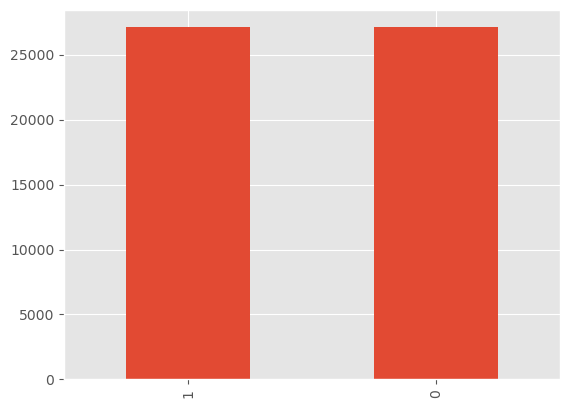

In [335]:
pd.Series(Y_train_smote).value_counts().plot.bar();

## Klasteryzacja -   KMeans, Hierarchiczna i DBScan

### KMeans

In [283]:
kmeans = KMeans(n_clusters=5, max_iter=1000)
kmeans.fit(X_pca)

KMeans(max_iter=1000, n_clusters=5)

In [284]:
kmeans.labels_

array([1, 2, 0, ..., 0, 4, 0])

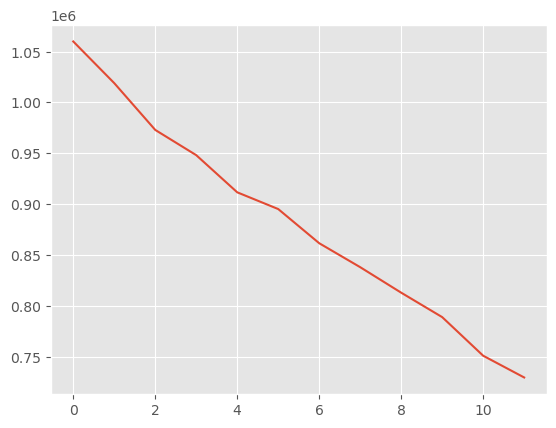

In [285]:
# elbow-curve - chcę sprawdzić optymalną liczbę klastrów

ssd = [] 
range_n_clusters = [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]
for num_clusters in range_n_clusters:
    kmeans = KMeans(n_clusters=num_clusters, max_iter=1000)
    kmeans.fit(X_train)
    
    ssd.append(kmeans.inertia_) 

plt.plot(ssd)

In [286]:
# Za każdym razem wychodzą inne wyniki.
# Próbowałam użyć random_state=int w kmeans = KMeans(n_clusters=5, max_iter=1000, random_state=int), ale niestety 
# wyskakuje mi błąd: 'ValueError: <class 'int'> cannot be used to seed a numpy.random.RandomState instance'
# Korzystam z  dokumentacji: https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html 

# Wykonam test Silhouette

In [287]:
# Silhouette

range_n_clusters = [3,4,5,6]

for num_clusters in range_n_clusters:
    
    
    kmeans = KMeans(n_clusters=num_clusters, max_iter=1000)
    kmeans.fit(X_pca)
    
    cluster_labels = kmeans.labels_
    
    
    silhouette_avg = silhouette_score(X_train, cluster_labels)
    print("For n_clusters={0}, the silhouette score is {1}".format(num_clusters, silhouette_avg))

For n_clusters=3, the silhouette score is 0.05592625331909293
For n_clusters=4, the silhouette score is 0.04203554458404501
For n_clusters=5, the silhouette score is 0.0236431210614486
For n_clusters=6, the silhouette score is 0.020837859609843853


In [288]:
# Wyniki testu Silhouette też się różnią. Na postawie powyższego optymalną liczbą klastrów będzie 4 
# (występuje wtedy największy spadek wskaźnika)

In [289]:
kmeans = KMeans(n_clusters=4, max_iter=1000, random_state=42)
kmeans.fit(X_pca)

KMeans(max_iter=1000, n_clusters=4, random_state=42)

In [290]:
kmeans.labels_

array([3, 2, 0, ..., 0, 1, 0])

In [291]:
X_pca['KMeans_Cluster_ID'] = kmeans.labels_

In [292]:
# Liczebność każdego z klastrów

from collections import Counter
Counter(kmeans.labels_)

Counter({3: 6805, 2: 8027, 0: 8197, 1: 6746})

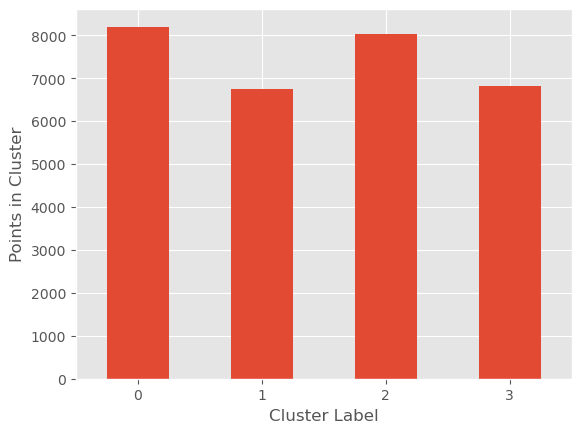

In [293]:
plot_cluster_cardinality(kmeans.labels_)

pyplot.show()

In [294]:
# Wykres Cardinality pokazuje, jak liczebne są poszczególne klastry - widać, że liczebność klastrów jest porównywalna  
# Klastry są zbalansowane

In [295]:
pd.crosstab(X_pca['KMeans_Cluster_ID'], df['niesplacony_splacony'], values=df['fico'], aggfunc='mean')

niesplacony_splacony,0,1
KMeans_Cluster_ID,,
0,704.748,719.221
1,706.398,718.482
2,705.930,718.524
3,705.227,719.425


In [296]:
# Wszystkie klastry mają niższe wartości wskaźnika 'fico' dla osób niespłącających kredytów

In [297]:
pd.pivot_table(df1, index=X_pca['KMeans_Cluster_ID'], aggfunc='mean')

,annual_inc,dti,earliest_cr_line,fico,grade_B,grade_C,grade_D,grade_E,grade_F,grade_G,home_ownership_OTHERS,home_ownership_OWN,home_ownership_RENT,inq_last_6mths,installment,int_rate,loan_amnt,niesplacony_splacony,open_acc,pub_rec,pub_rec_bankruptcies,purpose_credit_card,purpose_debt_consolidation,purpose_educational,purpose_home_improvement,purpose_house,purpose_major_purchase,purpose_medical,purpose_moving,purpose_other,purpose_renewable_energy,purpose_small_business,purpose_vacation,purpose_wedding,revol_bal,revol_util,term,total_acc,verification_status2
KMeans_Cluster_ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0.000,61590.638,11.953,1996.736,717.054,0.294,0.193,0.130,0.077,0.035,0.007,0.000,0.075,0.456,0.829,301.267,0.121,9786.169,0.851,9.049,0.060,0.047,0.122,0.487,0.001,0.074,0.009,0.056,0.019,0.016,0.091,0.003,0.046,0.011,0.023,10166.672,0.500,44.626,21.711,0.331
1.000,62187.669,11.969,1996.699,716.609,0.300,0.188,0.135,0.082,0.031,0.011,0.000,0.076,0.456,0.825,303.350,0.121,9804.929,0.845,9.137,0.055,0.045,0.131,0.486,0.001,0.082,0.008,0.050,0.016,0.017,0.087,0.003,0.044,0.011,0.024,10387.311,0.501,44.674,21.923,0.330
2.000,61858.211,11.965,1996.682,716.669,0.297,0.187,0.132,0.079,0.031,0.010,0.000,0.074,0.466,0.834,301.324,0.121,9809.502,0.854,9.223,0.054,0.043,0.130,0.484,0.001,0.081,0.011,0.055,0.018,0.016,0.086,0.002,0.040,0.011,0.025,10324.086,0.501,44.467,21.869,0.334
3.000,61763.046,11.963,1996.706,717.431,0.304,0.182,0.128,0.083,0.026,0.010,0.000,0.075,0.469,0.826,298.870,0.120,9838.677,0.860,9.106,0.050,0.041,0.129,0.480,0.002,0.075,0.009,0.062,0.017,0.014,0.091,0.004,0.040,0.011,0.020,10135.015,0.493,44.401,21.960,0.325


In [298]:
# Wartości wszystkich cech są dla wszystkich klastrów bardzo zbliżone

In [299]:
pd.crosstab(X_pca['KMeans_Cluster_ID'],[df1['niesplacony_splacony']])

niesplacony_splacony,0,1
KMeans_Cluster_ID,,
0,1219,6978
1,1046,5700
2,1173,6854
3,956,5849


In [300]:
print("% osób niespłacających pożyczek")
print(f"0: {round((1045)/(1045+5705) * 100, 2)}%")
print(f"1: {round((1172)/(1172+6848) * 100, 2)}%")
print(f"2: {round((957)/(957+5844) * 100, 2)}%")
print(f"3: {round((1220)/(1220+6984) * 100, 2)}%")

% osób niespłacających pożyczek
0: 15.48%
1: 14.61%
2: 14.07%
3: 14.87%


In [301]:
# Odsetek osób niespłacających kredytów jest zbliżony dla wszystkich klastrów 

# Nie widzę trendu, który mogłabym wykorzystać w modelowaniu

In [302]:
# Klasteryzacji hierarchicznej i DBScan nie jest w stanie rozwinąć, ponieważ wyskakuje mi błąd - dead kernel.
# 3 razy instalowałam anacondę, przeniosłam się na colaba, oddałam komputer do usunięcia wszystkiego, ale niestety
# nic nie pomogło

# Miałam w tej sprawie konsultacje z Tomkiem Siarneckim

### Hierarchiczna

### DBSCAN

# Modelowanie

### Drzewo decyzyjne

In [303]:
X_train, X_test, Y_train, Y_test = train_test_split(X,Y, test_size = 0.25, random_state = 0)

dt_model = DecisionTreeClassifier()
dt_model.fit(X_train, Y_train)

Y_pred=dt_model.predict(X_test)
Y_pred1=dt_model.predict_proba(X_test)

In [304]:
print('Drzewo decyzyjne - dane treningowe:',dt_model.score(X_train,Y_train))
print('Drzewo decyzyjne - dane testowe:',dt_model.score(X_test,Y_test))

acc_dt_model = accuracy_score(Y_test,Y_pred)
print('Accuracy: ',acc_dt_model)
print('MSE: ',metrics.mean_squared_error(Y_test, Y_pred))
roc_dt_model = roc_auc_score(Y_test, dt_model.predict_proba(X_test)[:,1])
print('ROC: ', roc_dt_model)

Drzewo decyzyjne - dane treningowe: 1.0
Drzewo decyzyjne - dane testowe: 0.7441226255407184
Accuracy:  0.7441226255407184
MSE:  0.25587737445928155
ROC:  0.5353809349900385


In [305]:
results = pd.DataFrame({'Method':['Drzewo decyzyjne'], 'Accuracy': acc_dt_model, 'ROC': roc_dt_model}, index = {'1'})
results = results[['Method', 'Accuracy', 'ROC']]
results

,Method,Accuracy,ROC
1,Drzewo decyzyjne,0.744,0.535


### Regresja logistyczna

In [306]:
logit=LogisticRegression()
logit.fit(X_train,Y_train)

Y_pred=logit.predict(X_test)
Y_pred1=logit.predict_proba(X_test)

In [307]:
print('Regresja logistyczna - dane treningowe:',logit.score(X_train,Y_train))
print('Regrasja logistyczna - dane testowe:',logit.score(X_test,Y_test))

acc_logit = accuracy_score(Y_test,Y_pred)
print('Accuracy: ',acc_logit)
print('MSE: ',metrics.mean_squared_error(Y_test, Y_pred))
roc_logit = roc_auc_score(Y_test, logit.predict_proba(X_test)[:,1])
print('ROC: ', roc_logit)

Regresja logistyczna - dane treningowe: 0.8495078678452762
Regrasja logistyczna - dane testowe: 0.8467180741019372
Accuracy:  0.8467180741019372
MSE:  0.1532819258980628
ROC:  0.6596071820840362


In [308]:
results_logit = pd.DataFrame({'Method':['Regresja logistyczna'], 'Accuracy': acc_logit, 'ROC': roc_logit}, index = {'2'})
results = pd.concat([results, results_logit])
results = results[['Method', 'Accuracy', 'ROC']]
results

,Method,Accuracy,ROC
1,Drzewo decyzyjne,0.744,0.535
2,Regresja logistyczna,0.847,0.660


### Random Forest

In [309]:
random_forest=RandomForestClassifier()
random_forest.fit(X_train,Y_train)

Y_pred=random_forest.predict(X_test)
Y_pred1=random_forest.predict_proba(X_test)

In [310]:
print('RandomForest - dane treningowe:',random_forest.score(X_train,Y_train))
print('RandomForest - dane testowe:',random_forest.score(X_test,Y_test))

acc_random_forest = accuracy_score(Y_test,Y_pred)
print('Accuracy: ',acc_random_forest)
print('MSE: ',metrics.mean_squared_error(Y_test, Y_pred))
roc_random_forest = roc_auc_score(Y_test, random_forest.predict_proba(X_test)[:,1])
print('ROC: ', roc_random_forest)

RandomForest - dane treningowe: 0.9999686540028838
RandomForest - dane testowe: 0.8458717321798006
Accuracy:  0.8458717321798006
MSE:  0.15412826782019937
ROC:  0.675360133056065


In [311]:
results_RF = pd.DataFrame({'Method':['RandomForest'], 'Accuracy': acc_dt_model, 'ROC': roc_random_forest}, index = {'3'})
results = pd.concat([results, results_RF])
results = results[['Method', 'Accuracy', 'ROC']]
results

,Method,Accuracy,ROC
1,Drzewo decyzyjne,0.744,0.535
2,Regresja logistyczna,0.847,0.660
3,RandomForest,0.744,0.675


### XGBoost

In [312]:
model_XGB = XGBClassifier()
model_XGB.fit(X_train,Y_train)

Y_pred=model_XGB.predict(X_test)
Y_pred1=model_XGB.predict_proba(X_test)

In [313]:
print('XGB - dane treningowe:',model_XGB.score(X_train,Y_train))
print('XGB - dane testowe:',model_XGB.score(X_test,Y_test))

acc_model_XGB = accuracy_score(Y_test,Y_pred)
print('Accuracy: ',acc_model_XGB)
print('MSE: ',metrics.mean_squared_error(Y_test, Y_pred))
roc_model_XGB = roc_auc_score(Y_test, model_XGB.predict_proba(X_test)[:,1])
print('ROC: ', roc_model_XGB)

XGB - dane treningowe: 0.8858692245000314
XGB - dane testowe: 0.8419221365431634
Accuracy:  0.8419221365431634
MSE:  0.15807786345683655
ROC:  0.6658988643084328


In [314]:
results_XGB = pd.DataFrame({'Method':['XGBoost'], 'Accuracy': acc_dt_model, 'ROC': roc_model_XGB}, index = {'4'})
results = pd.concat([results, results_XGB])
results = results[['Method', 'Accuracy', 'ROC']]
results

,Method,Accuracy,ROC
1,Drzewo decyzyjne,0.744,0.535
2,Regresja logistyczna,0.847,0.660
3,RandomForest,0.744,0.675
4,XGBoost,0.744,0.666


### AdaBoost

In [315]:
model_ADA=AdaBoostClassifier()
model_ADA.fit(X_train,Y_train)

Y_pred=model_ADA.predict(X_test)
Y_pred1=model_ADA.predict_proba(X_test)

In [316]:
print('ADA - dane treningowe:',model_ADA.score(X_train,Y_train))
print('ADA - dane testowe:',model_ADA.score(X_test,Y_test))

acc_model_ADA = accuracy_score(Y_test,Y_pred)
print('Accuracy: ',acc_model_ADA)
print('MSE: ',metrics.mean_squared_error(Y_test, Y_pred))
roc_model_ADA = roc_auc_score(Y_test, model_ADA.predict_proba(X_test)[:,1])
print('ROC: ', roc_model_ADA)

ADA - dane treningowe: 0.8493197918625791
ADA - dane testowe: 0.8458717321798006
Accuracy:  0.8458717321798006
MSE:  0.15412826782019937
ROC:  0.6846269756045711


In [317]:
results_ADA = pd.DataFrame({'Method':['ADA'], 'Accuracy': acc_model_ADA, 'ROC': roc_model_ADA},index={'5'})
results = pd.concat([results, results_ADA])
results = results[['Method', 'Accuracy', 'ROC']]
results

,Method,Accuracy,ROC
1,Drzewo decyzyjne,0.744,0.535
2,Regresja logistyczna,0.847,0.660
3,RandomForest,0.744,0.675
4,XGBoost,0.744,0.666
5,ADA,0.846,0.685


### CatBoost

In [318]:
model_CAT=CatBoostClassifier()
model_CAT.fit(X_train,Y_train)

Y_pred=model_CAT.predict(X_test)
Y_pred1=model_CAT.predict_proba(X_test)

Learning rate set to 0.045192
0:	learn: 0.6630230	total: 172ms	remaining: 2m 51s
1:	learn: 0.6363680	total: 189ms	remaining: 1m 34s
2:	learn: 0.6119908	total: 205ms	remaining: 1m 8s
3:	learn: 0.5909917	total: 220ms	remaining: 54.8s
4:	learn: 0.5723898	total: 236ms	remaining: 46.9s
5:	learn: 0.5554893	total: 252ms	remaining: 41.7s
6:	learn: 0.5401546	total: 268ms	remaining: 38s
7:	learn: 0.5259705	total: 283ms	remaining: 35.2s
8:	learn: 0.5133201	total: 299ms	remaining: 32.9s
9:	learn: 0.5020956	total: 349ms	remaining: 34.5s
10:	learn: 0.4914715	total: 377ms	remaining: 33.9s
11:	learn: 0.4822242	total: 400ms	remaining: 32.9s
12:	learn: 0.4738027	total: 416ms	remaining: 31.6s
13:	learn: 0.4664555	total: 432ms	remaining: 30.4s
14:	learn: 0.4605212	total: 448ms	remaining: 29.4s
15:	learn: 0.4544690	total: 463ms	remaining: 28.5s
16:	learn: 0.4496344	total: 479ms	remaining: 27.7s
17:	learn: 0.4445329	total: 494ms	remaining: 26.9s
18:	learn: 0.4399102	total: 509ms	remaining: 26.3s
19:	learn: 

162:	learn: 0.3770683	total: 2.54s	remaining: 13s
163:	learn: 0.3769762	total: 2.55s	remaining: 13s
164:	learn: 0.3768777	total: 2.56s	remaining: 13s
165:	learn: 0.3767777	total: 2.57s	remaining: 12.9s
166:	learn: 0.3766601	total: 2.59s	remaining: 12.9s
167:	learn: 0.3765725	total: 2.6s	remaining: 12.9s
168:	learn: 0.3764328	total: 2.61s	remaining: 12.8s
169:	learn: 0.3763535	total: 2.62s	remaining: 12.8s
170:	learn: 0.3762868	total: 2.63s	remaining: 12.8s
171:	learn: 0.3761895	total: 2.65s	remaining: 12.7s
172:	learn: 0.3760798	total: 2.66s	remaining: 12.7s
173:	learn: 0.3760195	total: 2.67s	remaining: 12.7s
174:	learn: 0.3759384	total: 2.68s	remaining: 12.6s
175:	learn: 0.3758596	total: 2.69s	remaining: 12.6s
176:	learn: 0.3757326	total: 2.71s	remaining: 12.6s
177:	learn: 0.3756973	total: 2.72s	remaining: 12.5s
178:	learn: 0.3756555	total: 2.73s	remaining: 12.5s
179:	learn: 0.3755616	total: 2.74s	remaining: 12.5s
180:	learn: 0.3754584	total: 2.75s	remaining: 12.5s
181:	learn: 0.37535

325:	learn: 0.3616698	total: 4.43s	remaining: 9.16s
326:	learn: 0.3615533	total: 4.44s	remaining: 9.14s
327:	learn: 0.3614719	total: 4.45s	remaining: 9.13s
328:	learn: 0.3614100	total: 4.47s	remaining: 9.11s
329:	learn: 0.3613260	total: 4.48s	remaining: 9.09s
330:	learn: 0.3612276	total: 4.49s	remaining: 9.08s
331:	learn: 0.3611156	total: 4.5s	remaining: 9.06s
332:	learn: 0.3610636	total: 4.51s	remaining: 9.04s
333:	learn: 0.3609701	total: 4.52s	remaining: 9.02s
334:	learn: 0.3608536	total: 4.54s	remaining: 9s
335:	learn: 0.3607529	total: 4.55s	remaining: 8.98s
336:	learn: 0.3606535	total: 4.56s	remaining: 8.97s
337:	learn: 0.3605203	total: 4.57s	remaining: 8.95s
338:	learn: 0.3604107	total: 4.58s	remaining: 8.93s
339:	learn: 0.3603159	total: 4.59s	remaining: 8.91s
340:	learn: 0.3602315	total: 4.6s	remaining: 8.9s
341:	learn: 0.3601644	total: 4.62s	remaining: 8.88s
342:	learn: 0.3600694	total: 4.63s	remaining: 8.86s
343:	learn: 0.3599541	total: 4.64s	remaining: 8.84s
344:	learn: 0.3598

493:	learn: 0.3479694	total: 6.35s	remaining: 6.51s
494:	learn: 0.3479508	total: 6.36s	remaining: 6.49s
495:	learn: 0.3478703	total: 6.37s	remaining: 6.48s
496:	learn: 0.3477897	total: 6.39s	remaining: 6.46s
497:	learn: 0.3477046	total: 6.4s	remaining: 6.45s
498:	learn: 0.3475896	total: 6.41s	remaining: 6.44s
499:	learn: 0.3475083	total: 6.42s	remaining: 6.42s
500:	learn: 0.3474463	total: 6.43s	remaining: 6.41s
501:	learn: 0.3473264	total: 6.44s	remaining: 6.39s
502:	learn: 0.3472422	total: 6.46s	remaining: 6.38s
503:	learn: 0.3471645	total: 6.47s	remaining: 6.37s
504:	learn: 0.3470788	total: 6.48s	remaining: 6.35s
505:	learn: 0.3469537	total: 6.49s	remaining: 6.34s
506:	learn: 0.3468474	total: 6.5s	remaining: 6.32s
507:	learn: 0.3467600	total: 6.52s	remaining: 6.31s
508:	learn: 0.3466843	total: 6.53s	remaining: 6.3s
509:	learn: 0.3466065	total: 6.54s	remaining: 6.28s
510:	learn: 0.3464972	total: 6.55s	remaining: 6.27s
511:	learn: 0.3463795	total: 6.56s	remaining: 6.25s
512:	learn: 0.3

659:	learn: 0.3352017	total: 8.26s	remaining: 4.25s
660:	learn: 0.3350991	total: 8.27s	remaining: 4.24s
661:	learn: 0.3350641	total: 8.28s	remaining: 4.23s
662:	learn: 0.3350133	total: 8.29s	remaining: 4.21s
663:	learn: 0.3349044	total: 8.3s	remaining: 4.2s
664:	learn: 0.3348288	total: 8.31s	remaining: 4.19s
665:	learn: 0.3347737	total: 8.33s	remaining: 4.18s
666:	learn: 0.3347135	total: 8.34s	remaining: 4.16s
667:	learn: 0.3346216	total: 8.35s	remaining: 4.15s
668:	learn: 0.3345662	total: 8.36s	remaining: 4.14s
669:	learn: 0.3344917	total: 8.38s	remaining: 4.13s
670:	learn: 0.3344212	total: 8.39s	remaining: 4.11s
671:	learn: 0.3343499	total: 8.4s	remaining: 4.1s
672:	learn: 0.3342821	total: 8.41s	remaining: 4.08s
673:	learn: 0.3342054	total: 8.42s	remaining: 4.07s
674:	learn: 0.3341532	total: 8.43s	remaining: 4.06s
675:	learn: 0.3340942	total: 8.44s	remaining: 4.05s
676:	learn: 0.3340101	total: 8.46s	remaining: 4.03s
677:	learn: 0.3339481	total: 8.47s	remaining: 4.02s
678:	learn: 0.33

827:	learn: 0.3234686	total: 10.2s	remaining: 2.12s
828:	learn: 0.3234016	total: 10.2s	remaining: 2.11s
829:	learn: 0.3233122	total: 10.2s	remaining: 2.09s
830:	learn: 0.3232207	total: 10.2s	remaining: 2.08s
831:	learn: 0.3231601	total: 10.3s	remaining: 2.07s
832:	learn: 0.3231077	total: 10.3s	remaining: 2.06s
833:	learn: 0.3230405	total: 10.3s	remaining: 2.04s
834:	learn: 0.3229687	total: 10.3s	remaining: 2.03s
835:	learn: 0.3228910	total: 10.3s	remaining: 2.02s
836:	learn: 0.3228093	total: 10.3s	remaining: 2.01s
837:	learn: 0.3227409	total: 10.3s	remaining: 1.99s
838:	learn: 0.3226976	total: 10.3s	remaining: 1.98s
839:	learn: 0.3226404	total: 10.3s	remaining: 1.97s
840:	learn: 0.3225806	total: 10.4s	remaining: 1.96s
841:	learn: 0.3225313	total: 10.4s	remaining: 1.95s
842:	learn: 0.3224595	total: 10.4s	remaining: 1.93s
843:	learn: 0.3224069	total: 10.4s	remaining: 1.92s
844:	learn: 0.3223656	total: 10.4s	remaining: 1.91s
845:	learn: 0.3222823	total: 10.4s	remaining: 1.9s
846:	learn: 0

987:	learn: 0.3133105	total: 12.1s	remaining: 147ms
988:	learn: 0.3132590	total: 12.1s	remaining: 135ms
989:	learn: 0.3132097	total: 12.2s	remaining: 123ms
990:	learn: 0.3131601	total: 12.2s	remaining: 111ms
991:	learn: 0.3130950	total: 12.2s	remaining: 98.3ms
992:	learn: 0.3130048	total: 12.2s	remaining: 86ms
993:	learn: 0.3129361	total: 12.2s	remaining: 73.7ms
994:	learn: 0.3128640	total: 12.2s	remaining: 61.4ms
995:	learn: 0.3128045	total: 12.2s	remaining: 49.1ms
996:	learn: 0.3127505	total: 12.2s	remaining: 36.8ms
997:	learn: 0.3126898	total: 12.3s	remaining: 24.6ms
998:	learn: 0.3126261	total: 12.3s	remaining: 12.3ms
999:	learn: 0.3125837	total: 12.3s	remaining: 0us


In [320]:
print('CAT - dane treningowe:',model_CAT.score(X_train,Y_train))
print('CAT - dane testowe:',model_CAT.score(X_test,Y_test))

acc_model_CAT = accuracy_score(Y_test,Y_pred)
print('Accuracy: ',acc_model_CAT)
print('MSE: ',metrics.mean_squared_error(Y_test, Y_pred))
roc_model_CAT = roc_auc_score(Y_test, model_CAT.predict_proba(X_test)[:,1])
print('ROC: ', roc_model_CAT)

CAT - dane treningowe: 0.8718575637891042
CAT - dane testowe: 0.8465299981192401
Accuracy:  0.8465299981192401
MSE:  0.15347000188075982
ROC:  0.6890777922831842


In [321]:
confusion_matrix(Y_test, Y_pred)

array([[  52, 1578],
       [  54, 8950]], dtype=int64)

In [322]:
results_CAT = pd.DataFrame({'Method':['CAT'], 'Accuracy': acc_model_ADA, 'ROC': roc_model_CAT},index={'5'})
results = pd.concat([results, results_CAT])
results = results[['Method', 'Accuracy', 'ROC']]
results

,Method,Accuracy,ROC
1,Drzewo decyzyjne,0.744,0.535
2,Regresja logistyczna,0.847,0.660
3,RandomForest,0.744,0.675
4,XGBoost,0.744,0.666
5,ADA,0.846,0.685
5,CAT,0.846,0.689


### BaggingClassifier

In [323]:
model_bagging=BaggingClassifier()
model_bagging.fit(X_train,Y_train)

Y_pred=model_bagging.predict(X_test)
Y_pred1=model_bagging.predict_proba(X_test)

In [324]:
print('BaggingClassifier - dane treningowe:',model_bagging.score(X_train,Y_train))
print('BaggingClassifier - dane testowe:',model_bagging.score(X_test,Y_test))

acc_model_bagging = accuracy_score(Y_test,Y_pred)
print('Accuracy: ',acc_model_bagging)
print('MSE: ',metrics.mean_squared_error(Y_test, Y_pred))
roc_model_bagging = roc_auc_score(Y_test, model_bagging.predict_proba(X_test)[:,1])
print('ROC: ', roc_model_bagging)

BaggingClassifier - dane treningowe: 0.9915365807786346
BaggingClassifier - dane testowe: 0.8207635884897498
Accuracy:  0.8207635884897498
MSE:  0.17923641151025013
ROC:  0.6323513339674527


In [325]:
results_bagging = pd.DataFrame({'Method':['Bagging'], 'Accuracy': acc_model_ADA, 'ROC': roc_model_bagging},index={'5'})
results = pd.concat([results, results_bagging])
results = results[['Method', 'Accuracy', 'ROC']]
results

,Method,Accuracy,ROC
1,Drzewo decyzyjne,0.744,0.535
2,Regresja logistyczna,0.847,0.660
3,RandomForest,0.744,0.675
4,XGBoost,0.744,0.666
5,ADA,0.846,0.685
5,CAT,0.846,0.689
5,Bagging,0.846,0.632


## PCA

In [326]:
pca = PCA(n_components = 2)

In [327]:
pca.fit(X_train)

PCA(n_components=2)

In [328]:
X_train = pca.transform(X_train)

In [329]:
X_train.shape

(31902, 2)

# Modelowanie na skompresowanych

In [336]:
def evaluate_performance(y_test, y_pred):
    '''
    Funkcja, która będzie zwracała wartości dokładność, precyzję i recall danego modelu
    '''
    performance_report = classification_report(y_test, y_pred, output_dict=True)
    accuracy = performance_report['accuracy']
    precision = performance_report['1']['precision']
    recall = performance_report['1']['recall']
    
    return {'accuracy': accuracy,
            'precision': precision,
            'recall': recall}

### Drzewo decyzyjne

In [337]:
X_train_smote, X_test, Y_train_smote, Y_test = train_test_split(X,Y, test_size = 0.25, random_state = 0)

dt_model = DecisionTreeClassifier()
dt_model.fit(X_train_smote , Y_train_smote)

Y_pred=dt_model.predict(X_test)
Y_pred1=dt_model.predict_proba(X_test)

In [338]:
mpl.rcParams['axes.prop_cycle'] = cycler(color='bgrcmyk')

In [339]:
ns_probs = [0 for _ in range(len(Y_test))]

No Skill: ROC AUC=0.500
DecisionTree: ROC AUC=0.538


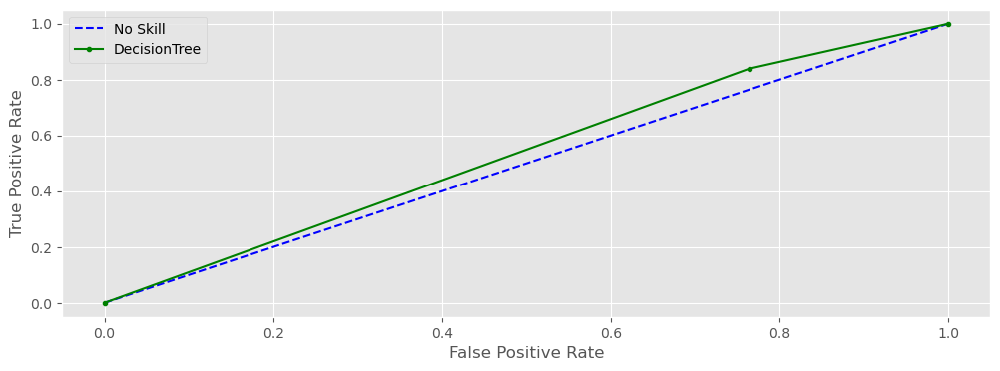

In [340]:
lr_probs = dt_model.predict_proba(X_test)

lr_probs = lr_probs[:, 1]

ns_auc = roc_auc_score(Y_test, ns_probs)
lr_auc = roc_auc_score(Y_test, lr_probs)

print('No Skill: ROC AUC=%.3f' % (ns_auc))
print('DecisionTree: ROC AUC=%.3f' % (lr_auc))

ns_fpr, ns_tpr, _ = roc_curve(Y_test, ns_probs)
lr_fpr, lr_tpr, _ = roc_curve(Y_test, lr_probs)

plt.figure(figsize=(12,4))
plt.plot(ns_fpr, ns_tpr, linestyle='--', label='No Skill')
plt.plot(lr_fpr, lr_tpr, marker='.', label='DecisionTree')

plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')

plt.legend()

plt.show()

In [341]:
confusion_matrix(Y_test, Y_pred)

array([[ 384, 1246],
       [1445, 7559]], dtype=int64)

In [342]:
print(classification_report(Y_test, Y_pred))

              precision    recall  f1-score   support

           0       0.21      0.24      0.22      1630
           1       0.86      0.84      0.85      9004

    accuracy                           0.75     10634
   macro avg       0.53      0.54      0.54     10634
weighted avg       0.76      0.75      0.75     10634



In [343]:
performance_report = classification_report(Y_test, Y_pred, output_dict=True)

In [344]:
evaluate_performance(Y_test, Y_pred)

{'accuracy': 0.7469437652811736,
 'precision': 0.8584894946053379,
 'recall': 0.8395157707685473}

In [345]:
model_summary = evaluate_performance(Y_test, Y_pred)
model_summary['model'] = dt_model
model_summary['auroc'] = lr_auc

In [346]:
results = pd.DataFrame([model_summary], index={'1'})
results = pd.concat([results])
results

,accuracy,precision,recall,model,auroc
1,0.747,0.858,0.840,DecisionTreeClassifier(),0.538


### Regresja logistyczna

In [347]:
logit=LogisticRegression()
logit.fit(X_train_smote, Y_train_smote)

Y_pred=logit.predict(X_test)
Y_pred1=logit.predict_proba(X_test)

In [348]:
mpl.rcParams['axes.prop_cycle'] = cycler(color='bgrcmyk')

In [349]:
ns_probs = [0 for _ in range(len(Y_test))]

No Skill: ROC AUC=0.500
Logistic Regression: ROC AUC=0.660


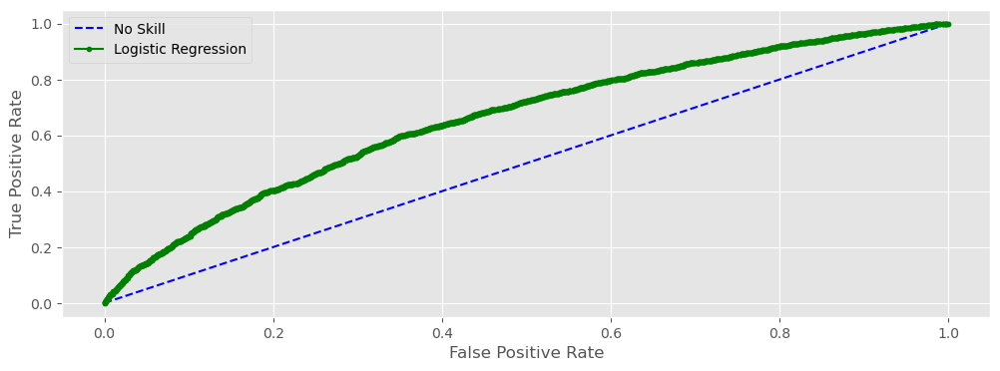

In [350]:
lr_probs = logit.predict_proba(X_test)

lr_probs = lr_probs[:, 1]

ns_auc = roc_auc_score(Y_test, ns_probs)
lr_auc = roc_auc_score(Y_test, lr_probs)

print('No Skill: ROC AUC=%.3f' % (ns_auc))
print('Logistic Regression: ROC AUC=%.3f' % (lr_auc))

ns_fpr, ns_tpr, _ = roc_curve(Y_test, ns_probs)
lr_fpr, lr_tpr, _ = roc_curve(Y_test, lr_probs)

plt.figure(figsize=(12,4))
plt.plot(ns_fpr, ns_tpr, linestyle='--', label='No Skill')
plt.plot(lr_fpr, lr_tpr, marker='.', label='Logistic Regression')

plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')

plt.legend()

plt.show()

In [351]:
confusion_matrix(Y_test, Y_pred)

array([[   0, 1630],
       [   0, 9004]], dtype=int64)

In [352]:
print(classification_report(Y_test, Y_pred))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00      1630
           1       0.85      1.00      0.92      9004

    accuracy                           0.85     10634
   macro avg       0.42      0.50      0.46     10634
weighted avg       0.72      0.85      0.78     10634



C:\Users\asus\AppData\Roaming\Python\Python39\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\asus\AppData\Roaming\Python\Python39\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\asus\AppData\Roaming\Python\Python39\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [353]:
performance_report = classification_report(Y_test, Y_pred, output_dict=True)

C:\Users\asus\AppData\Roaming\Python\Python39\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\asus\AppData\Roaming\Python\Python39\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\asus\AppData\Roaming\Python\Python39\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [354]:
evaluate_performance(Y_test, Y_pred)

C:\Users\asus\AppData\Roaming\Python\Python39\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\asus\AppData\Roaming\Python\Python39\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\asus\AppData\Roaming\Python\Python39\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


{'accuracy': 0.8467180741019372,
 'precision': 0.8467180741019372,
 'recall': 1.0}

In [355]:
model_summary = evaluate_performance(Y_test, Y_pred)
model_summary['model'] = logit
model_summary['auroc'] = lr_auc

C:\Users\asus\AppData\Roaming\Python\Python39\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\asus\AppData\Roaming\Python\Python39\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\asus\AppData\Roaming\Python\Python39\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [356]:
results_logit = pd.DataFrame([model_summary], index={'2'})
results = pd.concat([results, results_logit])
results

,accuracy,precision,recall,model,auroc
1,0.747,0.858,0.840,DecisionTreeClassifier(),0.538
2,0.847,0.847,1.000,LogisticRegression(),0.660


### Random Forest

In [357]:
random_forest_model=RandomForestClassifier()
random_forest_model.fit(X_train_smote, Y_train_smote)

Y_pred=random_forest_model.predict(X_test)
Y_pred1=random_forest_model.predict_proba(X_test)

In [358]:
mpl.rcParams['axes.prop_cycle'] = cycler(color='bgrcmyk')

In [359]:
ns_probs = [0 for _ in range(len(Y_test))]

No Skill: ROC AUC=0.500
Random Forest: ROC AUC=0.668


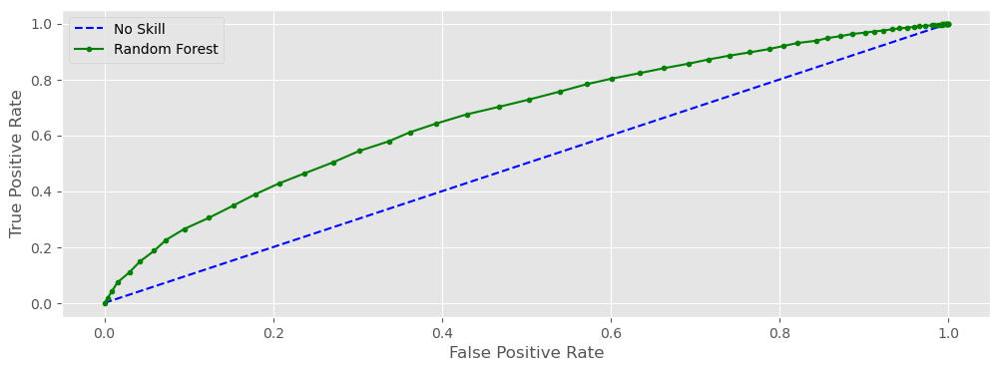

In [360]:
lr_probs = random_forest_model.predict_proba(X_test)

lr_probs = lr_probs[:, 1]

ns_auc = roc_auc_score(Y_test, ns_probs)
lr_auc = roc_auc_score(Y_test, lr_probs)

print('No Skill: ROC AUC=%.3f' % (ns_auc))
print('Random Forest: ROC AUC=%.3f' % (lr_auc))

ns_fpr, ns_tpr, _ = roc_curve(Y_test, ns_probs)
lr_fpr, lr_tpr, _ = roc_curve(Y_test, lr_probs)

plt.figure(figsize=(12,4))
plt.plot(ns_fpr, ns_tpr, linestyle='--', label='No Skill')
plt.plot(lr_fpr, lr_tpr, marker='.', label='Random Forest')

plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')

plt.legend()

plt.show()

In [361]:
confusion_matrix(Y_test, Y_pred)

array([[  15, 1615],
       [  35, 8969]], dtype=int64)

In [362]:
print(classification_report(Y_test, Y_pred))

              precision    recall  f1-score   support

           0       0.30      0.01      0.02      1630
           1       0.85      1.00      0.92      9004

    accuracy                           0.84     10634
   macro avg       0.57      0.50      0.47     10634
weighted avg       0.76      0.84      0.78     10634



In [363]:
performance_report = classification_report(Y_test, Y_pred, output_dict=True)

In [364]:
evaluate_performance(Y_test, Y_pred)

{'accuracy': 0.8448373142749671,
 'precision': 0.847411186696901,
 'recall': 0.9961128387383386}

In [365]:
model_summary = evaluate_performance(Y_test, Y_pred)
model_summary['model'] = 'RandomForest'
model_summary['auroc'] = lr_auc

In [366]:
RandomForest = pd.DataFrame([model_summary])

In [367]:
results_random_forest = pd.DataFrame([model_summary], index={'3'})
results = pd.concat([results, results_random_forest])
results

,accuracy,precision,recall,model,auroc
1,0.747,0.858,0.840,DecisionTreeClassifier(),0.538
2,0.847,0.847,1.000,LogisticRegression(),0.660
3,0.845,0.847,0.996,RandomForest,0.668


### XGBoost

In [368]:
model_XGB=XGBClassifier()
model_XGB.fit(X_train_smote, Y_train_smote)

Y_pred=model_XGB.predict(X_test)
Y_pred1=model_XGB.predict_proba(X_test)

In [369]:
mpl.rcParams['axes.prop_cycle'] = cycler(color='bgrcmyk')

In [370]:
ns_probs = [0 for _ in range(len(Y_test))]

No Skill: ROC AUC=0.500
XGBoost : ROC AUC=0.666


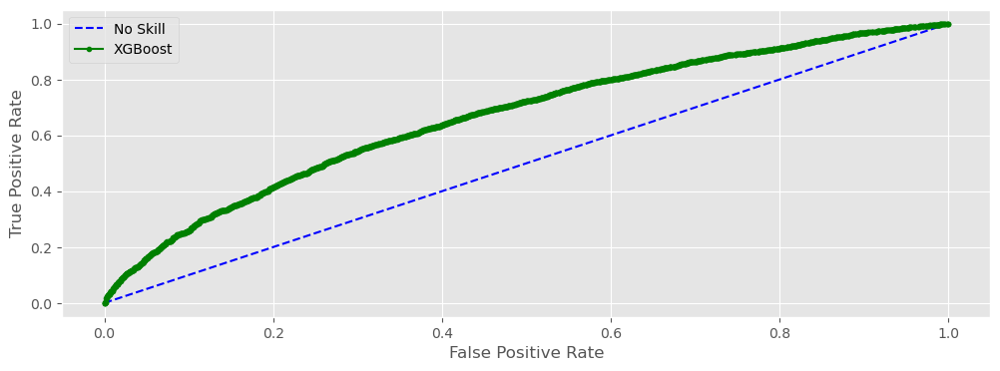

In [371]:
lr_probs = model_XGB.predict_proba(X_test)

lr_probs = lr_probs[:, 1]

ns_auc = roc_auc_score(Y_test, ns_probs)
lr_auc = roc_auc_score(Y_test, lr_probs)

print('No Skill: ROC AUC=%.3f' % (ns_auc))
print('XGBoost : ROC AUC=%.3f' % (lr_auc))

ns_fpr, ns_tpr, _ = roc_curve(Y_test, ns_probs)
lr_fpr, lr_tpr, _ = roc_curve(Y_test, lr_probs)

plt.figure(figsize=(12,4))
plt.plot(ns_fpr, ns_tpr, linestyle='--', label='No Skill')
plt.plot(lr_fpr, lr_tpr, marker='.', label='XGBoost')

plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')

plt.legend()

plt.show()

In [372]:
confusion_matrix(Y_test, Y_pred)

array([[  79, 1551],
       [ 130, 8874]], dtype=int64)

In [373]:
print(classification_report(Y_test, Y_pred))

              precision    recall  f1-score   support

           0       0.38      0.05      0.09      1630
           1       0.85      0.99      0.91      9004

    accuracy                           0.84     10634
   macro avg       0.61      0.52      0.50     10634
weighted avg       0.78      0.84      0.79     10634



In [374]:
performance_report = classification_report(Y_test, Y_pred, output_dict=True)

In [375]:
evaluate_performance(Y_test, Y_pred)

{'accuracy': 0.8419221365431634,
 'precision': 0.8512230215827338,
 'recall': 0.9855619724566859}

In [376]:
model_summary = evaluate_performance(Y_test, Y_pred)
model_summary['model'] = 'XGBoost'
model_summary['auroc'] = lr_auc

In [377]:
XGBoost = pd.DataFrame([model_summary])

In [378]:
results_XGB = pd.DataFrame([model_summary], index={'4'})
results = pd.concat([results, results_XGB])
results

,accuracy,precision,recall,model,auroc
1,0.747,0.858,0.840,DecisionTreeClassifier(),0.538
2,0.847,0.847,1.000,LogisticRegression(),0.660
3,0.845,0.847,0.996,RandomForest,0.668
4,0.842,0.851,0.986,XGBoost,0.666


### AdaBoost

In [379]:
model_ADA=AdaBoostClassifier()
model_ADA.fit(X_train_smote, Y_train_smote)

Y_pred=model_ADA.predict(X_test)
Y_pred1=model_ADA.predict_proba(X_test)

In [380]:
mpl.rcParams['axes.prop_cycle'] = cycler(color='bgrcmyk')

In [381]:
ns_probs = [0 for _ in range(len(Y_test))]

No Skill: ROC AUC=0.500
Logistic Regression: ROC AUC=0.685


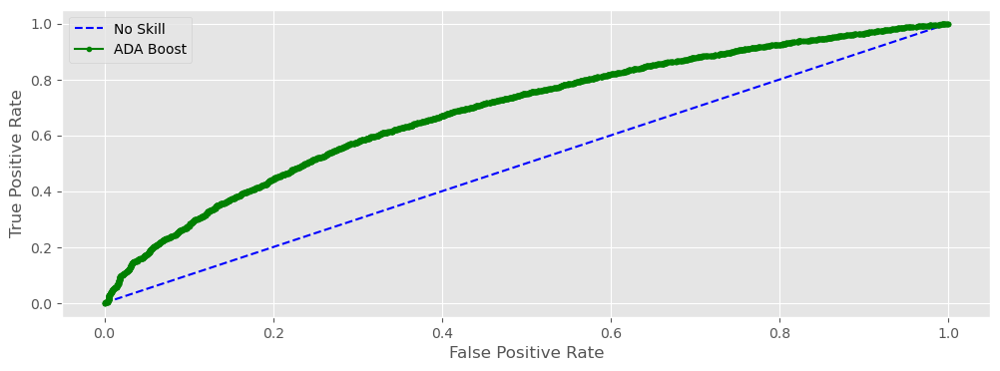

In [382]:
lr_probs = model_ADA.predict_proba(X_test)

lr_probs = lr_probs[:, 1]

ns_auc = roc_auc_score(Y_test, ns_probs)
lr_auc = roc_auc_score(Y_test, lr_probs)

print('No Skill: ROC AUC=%.3f' % (ns_auc))
print('Logistic Regression: ROC AUC=%.3f' % (lr_auc))

ns_fpr, ns_tpr, _ = roc_curve(Y_test, ns_probs)
lr_fpr, lr_tpr, _ = roc_curve(Y_test, lr_probs)

plt.figure(figsize=(12,4))
plt.plot(ns_fpr, ns_tpr, linestyle='--', label='No Skill')
plt.plot(lr_fpr, lr_tpr, marker='.', label='ADA Boost')

plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')

plt.legend()

plt.show()

In [383]:
confusion_matrix(Y_test, Y_pred)

array([[  30, 1600],
       [  39, 8965]], dtype=int64)

In [384]:
print(classification_report(Y_test, Y_pred))

              precision    recall  f1-score   support

           0       0.43      0.02      0.04      1630
           1       0.85      1.00      0.92      9004

    accuracy                           0.85     10634
   macro avg       0.64      0.51      0.48     10634
weighted avg       0.79      0.85      0.78     10634



In [385]:
performance_report = classification_report(Y_test, Y_pred, output_dict=True)

In [386]:
evaluate_performance(Y_test, Y_pred)

{'accuracy': 0.8458717321798006,
 'precision': 0.8485565546616185,
 'recall': 0.9956685917370057}

In [387]:
model_summary = evaluate_performance(Y_test, Y_pred)
model_summary['model'] = 'ADA'
model_summary['auroc'] = lr_auc

In [388]:
ADA = pd.DataFrame([model_summary])

In [389]:
results_model_ADA = pd.DataFrame([model_summary], index={'5'})
results = pd.concat([results, results_model_ADA])
results

,accuracy,precision,recall,model,auroc
1,0.747,0.858,0.840,DecisionTreeClassifier(),0.538
2,0.847,0.847,1.000,LogisticRegression(),0.660
3,0.845,0.847,0.996,RandomForest,0.668
4,0.842,0.851,0.986,XGBoost,0.666
5,0.846,0.849,0.996,ADA,0.685


### CatBoost

In [390]:
model_CAT=CatBoostClassifier()
model_CAT.fit(X_train_smote, Y_train_smote)

Y_pred=model_CAT.predict(X_test)
Y_pred1=model_CAT.predict_proba(X_test)

Learning rate set to 0.045192
0:	learn: 0.6630230	total: 14.1ms	remaining: 14.1s
1:	learn: 0.6363680	total: 28.2ms	remaining: 14.1s
2:	learn: 0.6119908	total: 42.7ms	remaining: 14.2s
3:	learn: 0.5909917	total: 57.5ms	remaining: 14.3s
4:	learn: 0.5723898	total: 72.5ms	remaining: 14.4s
5:	learn: 0.5554893	total: 86.8ms	remaining: 14.4s
6:	learn: 0.5401546	total: 101ms	remaining: 14.3s
7:	learn: 0.5259705	total: 115ms	remaining: 14.3s
8:	learn: 0.5133201	total: 129ms	remaining: 14.3s
9:	learn: 0.5020956	total: 145ms	remaining: 14.3s
10:	learn: 0.4914715	total: 159ms	remaining: 14.3s
11:	learn: 0.4822242	total: 173ms	remaining: 14.3s
12:	learn: 0.4738027	total: 188ms	remaining: 14.3s
13:	learn: 0.4664555	total: 204ms	remaining: 14.3s
14:	learn: 0.4605212	total: 218ms	remaining: 14.3s
15:	learn: 0.4544690	total: 233ms	remaining: 14.3s
16:	learn: 0.4496344	total: 250ms	remaining: 14.4s
17:	learn: 0.4445329	total: 266ms	remaining: 14.5s
18:	learn: 0.4399102	total: 280ms	remaining: 14.4s
19:	l

170:	learn: 0.3762868	total: 2.55s	remaining: 12.3s
171:	learn: 0.3761895	total: 2.56s	remaining: 12.3s
172:	learn: 0.3760798	total: 2.58s	remaining: 12.3s
173:	learn: 0.3760195	total: 2.59s	remaining: 12.3s
174:	learn: 0.3759384	total: 2.6s	remaining: 12.3s
175:	learn: 0.3758596	total: 2.62s	remaining: 12.3s
176:	learn: 0.3757326	total: 2.63s	remaining: 12.3s
177:	learn: 0.3756973	total: 2.65s	remaining: 12.2s
178:	learn: 0.3756555	total: 2.66s	remaining: 12.2s
179:	learn: 0.3755616	total: 2.68s	remaining: 12.2s
180:	learn: 0.3754584	total: 2.69s	remaining: 12.2s
181:	learn: 0.3753539	total: 2.71s	remaining: 12.2s
182:	learn: 0.3752576	total: 2.72s	remaining: 12.2s
183:	learn: 0.3751855	total: 2.74s	remaining: 12.1s
184:	learn: 0.3750926	total: 2.75s	remaining: 12.1s
185:	learn: 0.3750119	total: 2.77s	remaining: 12.1s
186:	learn: 0.3749112	total: 2.78s	remaining: 12.1s
187:	learn: 0.3748262	total: 2.8s	remaining: 12.1s
188:	learn: 0.3747354	total: 2.81s	remaining: 12.1s
189:	learn: 0.

340:	learn: 0.3602315	total: 5.08s	remaining: 9.82s
341:	learn: 0.3601644	total: 5.09s	remaining: 9.8s
342:	learn: 0.3600694	total: 5.11s	remaining: 9.78s
343:	learn: 0.3599541	total: 5.12s	remaining: 9.77s
344:	learn: 0.3598807	total: 5.14s	remaining: 9.75s
345:	learn: 0.3597647	total: 5.16s	remaining: 9.75s
346:	learn: 0.3596756	total: 5.21s	remaining: 9.8s
347:	learn: 0.3595652	total: 5.22s	remaining: 9.79s
348:	learn: 0.3594575	total: 5.24s	remaining: 9.77s
349:	learn: 0.3594078	total: 5.25s	remaining: 9.76s
350:	learn: 0.3593259	total: 5.27s	remaining: 9.74s
351:	learn: 0.3592022	total: 5.28s	remaining: 9.73s
352:	learn: 0.3591237	total: 5.3s	remaining: 9.71s
353:	learn: 0.3590322	total: 5.32s	remaining: 9.7s
354:	learn: 0.3589457	total: 5.33s	remaining: 9.69s
355:	learn: 0.3588411	total: 5.35s	remaining: 9.67s
356:	learn: 0.3587526	total: 5.36s	remaining: 9.66s
357:	learn: 0.3586875	total: 5.38s	remaining: 9.64s
358:	learn: 0.3586147	total: 5.39s	remaining: 9.63s
359:	learn: 0.35

513:	learn: 0.3462395	total: 8.13s	remaining: 7.68s
514:	learn: 0.3462036	total: 8.14s	remaining: 7.67s
515:	learn: 0.3461352	total: 8.16s	remaining: 7.65s
516:	learn: 0.3460681	total: 8.17s	remaining: 7.63s
517:	learn: 0.3460056	total: 8.18s	remaining: 7.61s
518:	learn: 0.3459114	total: 8.19s	remaining: 7.59s
519:	learn: 0.3458637	total: 8.2s	remaining: 7.57s
520:	learn: 0.3458047	total: 8.22s	remaining: 7.56s
521:	learn: 0.3456860	total: 8.23s	remaining: 7.54s
522:	learn: 0.3455984	total: 8.25s	remaining: 7.52s
523:	learn: 0.3455376	total: 8.26s	remaining: 7.5s
524:	learn: 0.3454637	total: 8.28s	remaining: 7.49s
525:	learn: 0.3453978	total: 8.3s	remaining: 7.48s
526:	learn: 0.3453043	total: 8.31s	remaining: 7.46s
527:	learn: 0.3452295	total: 8.33s	remaining: 7.45s
528:	learn: 0.3451242	total: 8.35s	remaining: 7.44s
529:	learn: 0.3450339	total: 8.37s	remaining: 7.43s
530:	learn: 0.3449465	total: 8.39s	remaining: 7.41s
531:	learn: 0.3448669	total: 8.42s	remaining: 7.41s
532:	learn: 0.3

689:	learn: 0.3330501	total: 10.7s	remaining: 4.8s
690:	learn: 0.3329310	total: 10.7s	remaining: 4.79s
691:	learn: 0.3328368	total: 10.7s	remaining: 4.77s
692:	learn: 0.3328048	total: 10.7s	remaining: 4.75s
693:	learn: 0.3327761	total: 10.7s	remaining: 4.74s
694:	learn: 0.3327177	total: 10.8s	remaining: 4.72s
695:	learn: 0.3326587	total: 10.8s	remaining: 4.7s
696:	learn: 0.3325634	total: 10.8s	remaining: 4.69s
697:	learn: 0.3324910	total: 10.8s	remaining: 4.67s
698:	learn: 0.3324131	total: 10.8s	remaining: 4.66s
699:	learn: 0.3323623	total: 10.8s	remaining: 4.64s
700:	learn: 0.3323066	total: 10.8s	remaining: 4.62s
701:	learn: 0.3322137	total: 10.9s	remaining: 4.61s
702:	learn: 0.3321586	total: 10.9s	remaining: 4.59s
703:	learn: 0.3320582	total: 10.9s	remaining: 4.58s
704:	learn: 0.3319901	total: 10.9s	remaining: 4.56s
705:	learn: 0.3319211	total: 10.9s	remaining: 4.55s
706:	learn: 0.3318767	total: 10.9s	remaining: 4.53s
707:	learn: 0.3318129	total: 10.9s	remaining: 4.52s
708:	learn: 0.

849:	learn: 0.3220288	total: 12.8s	remaining: 2.27s
850:	learn: 0.3219663	total: 12.9s	remaining: 2.25s
851:	learn: 0.3218728	total: 12.9s	remaining: 2.23s
852:	learn: 0.3218273	total: 12.9s	remaining: 2.22s
853:	learn: 0.3217672	total: 12.9s	remaining: 2.2s
854:	learn: 0.3216822	total: 12.9s	remaining: 2.19s
855:	learn: 0.3216068	total: 12.9s	remaining: 2.17s
856:	learn: 0.3215100	total: 12.9s	remaining: 2.16s
857:	learn: 0.3214375	total: 12.9s	remaining: 2.14s
858:	learn: 0.3213798	total: 13s	remaining: 2.13s
859:	learn: 0.3213406	total: 13s	remaining: 2.11s
860:	learn: 0.3212185	total: 13s	remaining: 2.09s
861:	learn: 0.3211492	total: 13s	remaining: 2.08s
862:	learn: 0.3210714	total: 13s	remaining: 2.06s
863:	learn: 0.3209912	total: 13s	remaining: 2.05s
864:	learn: 0.3209192	total: 13s	remaining: 2.03s
865:	learn: 0.3208247	total: 13s	remaining: 2.02s
866:	learn: 0.3207681	total: 13s	remaining: 2s
867:	learn: 0.3207236	total: 13.1s	remaining: 1.99s
868:	learn: 0.3206208	total: 13.1s

In [391]:
mpl.rcParams['axes.prop_cycle'] = cycler(color='bgrcmyk')

In [392]:
ns_probs = [0 for _ in range(len(Y_test))]

No Skill: ROC AUC=0.500
Logistic Regression: ROC AUC=0.689


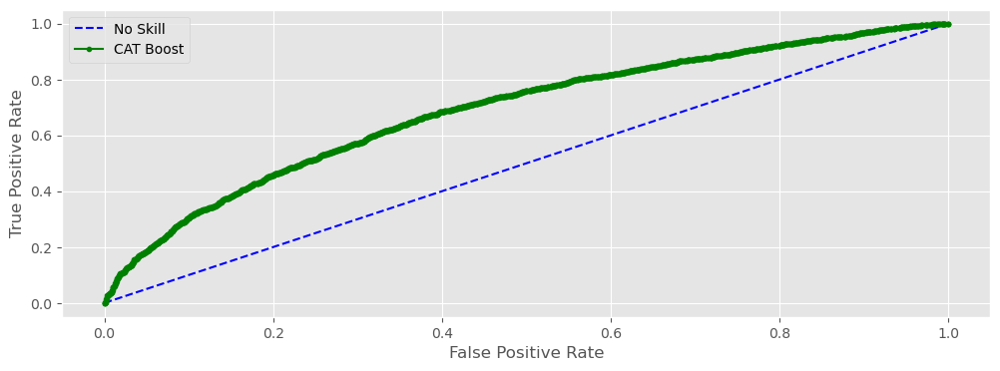

In [393]:
lr_probs = model_CAT.predict_proba(X_test)

lr_probs = lr_probs[:, 1]

ns_auc = roc_auc_score(Y_test, ns_probs)
lr_auc = roc_auc_score(Y_test, lr_probs)

print('No Skill: ROC AUC=%.3f' % (ns_auc))
print('Logistic Regression: ROC AUC=%.3f' % (lr_auc))

ns_fpr, ns_tpr, _ = roc_curve(Y_test, ns_probs)
lr_fpr, lr_tpr, _ = roc_curve(Y_test, lr_probs)

plt.figure(figsize=(12,4))
plt.plot(ns_fpr, ns_tpr, linestyle='--', label='No Skill')
plt.plot(lr_fpr, lr_tpr, marker='.', label='CAT Boost')

plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')

plt.legend()

plt.show()

In [394]:
confusion_matrix(Y_test, Y_pred)

array([[  52, 1578],
       [  54, 8950]], dtype=int64)

In [395]:
print(classification_report(Y_test, Y_pred))

              precision    recall  f1-score   support

           0       0.49      0.03      0.06      1630
           1       0.85      0.99      0.92      9004

    accuracy                           0.85     10634
   macro avg       0.67      0.51      0.49     10634
weighted avg       0.80      0.85      0.79     10634



In [396]:
performance_report = classification_report(Y_test, Y_pred, output_dict=True)

In [397]:
evaluate_performance(Y_test, Y_pred)

{'accuracy': 0.8465299981192401,
 'precision': 0.850113981762918,
 'recall': 0.994002665482008}

In [398]:
model_summary = evaluate_performance(Y_test, Y_pred)
model_summary['model'] = 'CAT'
model_summary['auroc'] = lr_auc

In [399]:
CAT = pd.DataFrame([model_summary])

In [400]:
results_model_CAT = pd.DataFrame([model_summary], index={'6'})
results = pd.concat([results, results_model_CAT])
results

,accuracy,precision,recall,model,auroc
1,0.747,0.858,0.840,DecisionTreeClassifier(),0.538
2,0.847,0.847,1.000,LogisticRegression(),0.660
3,0.845,0.847,0.996,RandomForest,0.668
4,0.842,0.851,0.986,XGBoost,0.666
5,0.846,0.849,0.996,ADA,0.685
6,0.847,0.850,0.994,CAT,0.689


### BaggingClassifier

In [401]:
model_bagging=BaggingClassifier()
model_bagging.fit(X_train_smote, Y_train_smote)

Y_pred=model_bagging.predict(X_test)
Y_pred1=model_bagging.predict_proba(X_test)

In [402]:
mpl.rcParams['axes.prop_cycle'] = cycler(color='bgrcmyk')

In [403]:
ns_probs = [0 for _ in range(len(Y_test))]

No Skill: ROC AUC=0.500
Bagging: ROC AUC=0.621


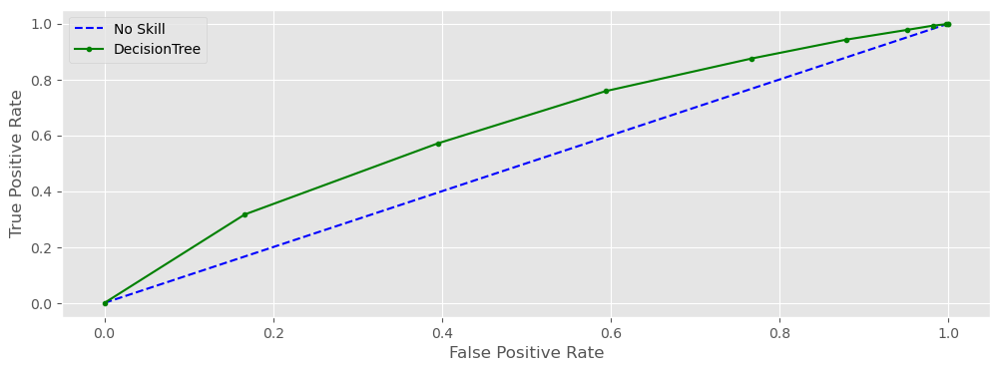

In [404]:
lr_probs = model_bagging.predict_proba(X_test)

lr_probs = lr_probs[:, 1]

ns_auc = roc_auc_score(Y_test, ns_probs)
lr_auc = roc_auc_score(Y_test, lr_probs)

print('No Skill: ROC AUC=%.3f' % (ns_auc))
print('Bagging: ROC AUC=%.3f' % (lr_auc))

ns_fpr, ns_tpr, _ = roc_curve(Y_test, ns_probs)
lr_fpr, lr_tpr, _ = roc_curve(Y_test, lr_probs)

plt.figure(figsize=(12,4))
plt.plot(ns_fpr, ns_tpr, linestyle='--', label='No Skill')
plt.plot(lr_fpr, lr_tpr, marker='.', label='DecisionTree')

plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')

plt.legend()

plt.show()

In [405]:
confusion_matrix(Y_test, Y_pred)

array([[ 196, 1434],
       [ 512, 8492]], dtype=int64)

In [406]:
print(classification_report(Y_test, Y_pred))

              precision    recall  f1-score   support

           0       0.28      0.12      0.17      1630
           1       0.86      0.94      0.90      9004

    accuracy                           0.82     10634
   macro avg       0.57      0.53      0.53     10634
weighted avg       0.77      0.82      0.79     10634



In [407]:
performance_report = classification_report(Y_test, Y_pred, output_dict=True)

In [408]:
evaluate_performance(Y_test, Y_pred)

{'accuracy': 0.8170020688358096,
 'precision': 0.8555309288736651,
 'recall': 0.9431363838294091}

In [409]:
model_summary = evaluate_performance(Y_test, Y_pred)
model_summary['model'] = 'bagging'
model_summary['auroc'] = lr_auc

In [410]:
bagging = pd.DataFrame([model_summary])

In [411]:
results_model_bagging = pd.DataFrame([model_summary], index={'7'})
results = pd.concat([results, results_model_bagging])
results

,accuracy,precision,recall,model,auroc
1,0.747,0.858,0.840,DecisionTreeClassifier(),0.538
2,0.847,0.847,1.000,LogisticRegression(),0.660
3,0.845,0.847,0.996,RandomForest,0.668
4,0.842,0.851,0.986,XGBoost,0.666
5,0.846,0.849,0.996,ADA,0.685
6,0.847,0.850,0.994,CAT,0.689
7,0.817,0.856,0.943,bagging,0.621


In [ ]:
prediction_data={'Model':['Decision Tree',
                          'Random Forest',
                          'Random Forest using Randomized Search',
                          'SVM',
                          'SVM using Grid Search',
                          'KNN'
                         ],
                   'F1-score':[dtree_pr['f1-score'],
                              rf_pr['f1-score'],
                              rf_rand_pr['f1-score'],
                              svm_pr['f1-score'],
                              svm_grid_pr['f1-score'],
                              knn1_pr['f1-score']],
                 
                   'Accuracy':[dtree_pr['accuracy'],
                              rf_pr['accuracy'],
                              rf_rand_pr['accuracy'],
                              svm_pr['accuracy'],
                              svm_grid_pr['accuracy'],
                              knn1_pr['accuracy']]
                    }
 
# Create DataFrame
prediction_table = pd.DataFrame(prediction_data)
prediction_table

#### Najlepsze wyniki AUROC uzyskały modele:


###### - ADABoost - 0.685
###### - CATBoost - 0.689
###### - RandomForest	0.675

In [ ]:
# Jako ostateczny model wybieram CATBoost

## Jego (i wielu pozostałych modeli) confusion matrix wygląda tak:
## array([[  52, 1578],
##       [  54, 8950]], dtype=int64)

## Wynika z tego, że model przewiduje bardzo dużo False Negatives
## Sprawdzę, czy po modyfikacjach jego skuteczność się poprawi

### Parametry

In [ ]:
## Żeby poprawić wyniki modelu spróbuję zmienić jego parametry

In [ ]:
## Sprawdzam, jak model uczy się na danych przed SMOTE i PCA

In [ ]:
model_CAT_origin = CatBoostClassifier(max_depth=3)

model_CAT_origin.fit(X_train, Y_train)

Y_pred = model_CAT_origin.predict(X_test)
Y_pred1 = model_CAT_origin.predict_proba(X_test)

In [ ]:
print(roc_auc_score(Y_test, model_CAT_origin.predict_proba(X_test)[:,1]))

In [ ]:
model_CAT_origin_cv = cross_val_score(model_CAT_origin, X_train_smote, Y_train_smote, cv=3, scoring='roc_auc')
print('Mean ROC AUC: %.3f' % mean(model_CAT_origin_cv))

In [ ]:
### CATBoost - domyślne parametry po SMOTE i PCA

In [ ]:
model_CAT=CatBoostClassifier()
model_CAT.fit(X_train_smote, Y_train_smote)

Y_pred=model_CAT.predict(X_test)
Y_pred1=model_CAT.predict_proba(X_test)

In [ ]:
print(roc_auc_score(Y_test, model_CAT.predict_proba(X_test)[:,1]))

In [ ]:
## Ustawiam parametry ręcznie

In [ ]:
## max_depth = 3, iterations=500

model_CAT_manual = CatBoostClassifier(max_depth=3, )

model_CAT_manual.fit(X_train_smote, Y_train_smote)

Y_pred = model_CAT_manual.predict(X_test)
Y_pred1 = model_CAT_manual.predict_proba(X_test)

In [ ]:
print(roc_auc_score(Y_test, model_CAT_manual.predict_proba(X_test)[:,1]))

In [ ]:
# cros walidacja
model_CAT_manual_cv = cross_val_score(model_CAT_manual, X_train_smote, Y_train_smote, cv=5, scoring='roc_auc')
print('Mean ROC AUC: %.3f' % mean(model_CAT_manual_cv))

In [ ]:
## max_depth = 5, iterations=500

In [ ]:
model_CAT_manual5 = CatBoostClassifier(max_depth=5, iterations=500)

model_CAT_manual5.fit(X_train_smote, Y_train_smote)

Y_pred = model_CAT_manual5.predict(X_test)
Y_pred1 = model_CAT_manual5.predict_proba(X_test)

In [ ]:
print(roc_auc_score(Y_test, model_CAT_manual5.predict_proba(X_test)[:,1]))

In [ ]:
model_CAT_manual5_cv = cross_val_score(model_CAT_manual5, X_train_smote, Y_train_smote, cv=5, scoring='roc_auc')
print('Mean ROC AUC: %.3f' % mean(model_CAT_manual5_cv))

In [ ]:
## Zwiększenie max_depth do 5 zmniejszyło skuteczność modelu

In [ ]:
## Użyję GridSearch żeby znaleźć najlepsze połączenie parametrów

In [ ]:
grid = {'max_depth': [2,3,4], 'iterations':[300,500,1000]}

grid_CAT = GridSearchCV (estimator = model_CAT, param_grid = grid, scoring ='accuracy', cv = 5)


grid_CAT.fit(X_train_smote, Y_train_smote)

Y_pred = grid_CAT.predict(X_test)
Y_pred1 = grid_CAT.predict_proba(X_test)

print(grid_CAT.best_estimator_)
print(grid_CAT.best_score_)
print(grid_CAT.best_params_)

In [ ]:
print(roc_auc_score(Y_test, grid_CAT.predict_proba(X_test)[:,1]))

In [ ]:
## GridSearch z cros walidacją

grid_CAT_cv = cross_val_score(grid_CAT, X_train_smote, Y_train_smote, cv=5, scoring='roc_auc')
print('Mean ROC AUC: %.3f' % mean(grid_CAT_cv))

In [ ]:
## Żaden ze sposobów nie poprawił wyniku
## Zbuduję model ensemble - CATBoost + Logit

In [ ]:
from sklearn.ensemble import RandomForestClassifier, VotingClassifier

CAT = CatBoostClassifier(max_depth=3) 
logit = LogisticRegression(random_state=0, max_iter=400)
ensemble_CAT_logit = VotingClassifier(estimators = [('CAT',CAT), ('log', logit)], voting='soft') 


ensemble_CAT_logit.fit(X_train_smote, Y_train_smote)

Y_pred = ensemble_CAT_logit.predict(X_test)
Y_pred1 = ensemble_CAT_logit.predict_proba(X_test)

In [ ]:
print(roc_auc_score(Y_test, ensemble_CAT_logit.predict_proba(X_test)[:,1]))

In [ ]:
### Ensemble - CATBoost + Logit + cros walidacja

ensemble_CAT_logit_cv = cross_val_score(ensemble_CAT_logit, X_train_smote, Y_train_smote, cv=5, scoring='roc_auc')
print('Mean ROC AUC: %.3f' % mean(ensemble_CAT_logit_cv))

In [ ]:
## Model ensemble CAT + Logit nie poprawił skuteczności

In [ ]:
## Zbuduję model ensamble CAT + RandomForest

In [412]:
from sklearn.ensemble import VotingClassifier

CAT_ensemble = CatBoostClassifier(max_depth=3)
random_forest_ensemble = RandomForestClassifier(n_estimators=500, random_state=0)


ensemble_CAT_random_forest = VotingClassifier(estimators = [('CAT', CAT_ensemble), 
                                                            ('random_forest', random_forest_ensemble)], 
                                              voting='soft') 


ensemble_CAT_random_forest.fit(X_train_smote, Y_train_smote)

Y_pred = ensemble_CAT_random_forest.predict(X_test)
Y_pred1 = ensemble_CAT_random_forest.predict_proba(X_test)

Learning rate set to 0.045192
0:	learn: 0.6635318	total: 9.78ms	remaining: 9.77s
1:	learn: 0.6395189	total: 20.4ms	remaining: 10.2s
2:	learn: 0.6163994	total: 29.7ms	remaining: 9.86s
3:	learn: 0.5951591	total: 39.1ms	remaining: 9.73s
4:	learn: 0.5757899	total: 50.5ms	remaining: 10s
5:	learn: 0.5591994	total: 59.8ms	remaining: 9.9s
6:	learn: 0.5436966	total: 69.3ms	remaining: 9.84s
7:	learn: 0.5300683	total: 78.3ms	remaining: 9.71s
8:	learn: 0.5181947	total: 87.9ms	remaining: 9.68s
9:	learn: 0.5070908	total: 97.3ms	remaining: 9.63s
10:	learn: 0.4966062	total: 107ms	remaining: 9.59s
11:	learn: 0.4882360	total: 116ms	remaining: 9.57s
12:	learn: 0.4799317	total: 125ms	remaining: 9.49s
13:	learn: 0.4725694	total: 134ms	remaining: 9.44s
14:	learn: 0.4657174	total: 144ms	remaining: 9.44s
15:	learn: 0.4595645	total: 153ms	remaining: 9.4s
16:	learn: 0.4537338	total: 162ms	remaining: 9.34s
17:	learn: 0.4488650	total: 170ms	remaining: 9.26s
18:	learn: 0.4444306	total: 180ms	remaining: 9.27s
19:	l

164:	learn: 0.3887268	total: 1.45s	remaining: 7.33s
165:	learn: 0.3886815	total: 1.46s	remaining: 7.33s
166:	learn: 0.3886618	total: 1.47s	remaining: 7.32s
167:	learn: 0.3886431	total: 1.48s	remaining: 7.33s
168:	learn: 0.3886122	total: 1.49s	remaining: 7.32s
169:	learn: 0.3885845	total: 1.5s	remaining: 7.3s
170:	learn: 0.3885571	total: 1.5s	remaining: 7.3s
171:	learn: 0.3885307	total: 1.51s	remaining: 7.28s
172:	learn: 0.3885081	total: 1.52s	remaining: 7.27s
173:	learn: 0.3884657	total: 1.53s	remaining: 7.25s
174:	learn: 0.3884111	total: 1.53s	remaining: 7.24s
175:	learn: 0.3883861	total: 1.54s	remaining: 7.23s
176:	learn: 0.3883615	total: 1.55s	remaining: 7.21s
177:	learn: 0.3883394	total: 1.56s	remaining: 7.2s
178:	learn: 0.3883064	total: 1.56s	remaining: 7.18s
179:	learn: 0.3882683	total: 1.57s	remaining: 7.17s
180:	learn: 0.3882165	total: 1.58s	remaining: 7.15s
181:	learn: 0.3881783	total: 1.59s	remaining: 7.14s
182:	learn: 0.3881538	total: 1.59s	remaining: 7.12s
183:	learn: 0.388

324:	learn: 0.3834220	total: 2.71s	remaining: 5.63s
325:	learn: 0.3834027	total: 2.72s	remaining: 5.62s
326:	learn: 0.3833809	total: 2.73s	remaining: 5.62s
327:	learn: 0.3833478	total: 2.74s	remaining: 5.61s
328:	learn: 0.3833269	total: 2.75s	remaining: 5.6s
329:	learn: 0.3833050	total: 2.76s	remaining: 5.6s
330:	learn: 0.3832687	total: 2.77s	remaining: 5.59s
331:	learn: 0.3832380	total: 2.78s	remaining: 5.59s
332:	learn: 0.3832076	total: 2.79s	remaining: 5.58s
333:	learn: 0.3831834	total: 2.79s	remaining: 5.58s
334:	learn: 0.3831622	total: 2.81s	remaining: 5.57s
335:	learn: 0.3831296	total: 2.81s	remaining: 5.56s
336:	learn: 0.3830906	total: 2.82s	remaining: 5.56s
337:	learn: 0.3830596	total: 2.83s	remaining: 5.55s
338:	learn: 0.3830435	total: 2.84s	remaining: 5.54s
339:	learn: 0.3830079	total: 2.85s	remaining: 5.54s
340:	learn: 0.3829895	total: 2.86s	remaining: 5.53s
341:	learn: 0.3829636	total: 2.87s	remaining: 5.53s
342:	learn: 0.3829385	total: 2.88s	remaining: 5.52s
343:	learn: 0.

503:	learn: 0.3787208	total: 4.37s	remaining: 4.3s
504:	learn: 0.3787024	total: 4.38s	remaining: 4.29s
505:	learn: 0.3786739	total: 4.38s	remaining: 4.28s
506:	learn: 0.3786552	total: 4.4s	remaining: 4.27s
507:	learn: 0.3786383	total: 4.4s	remaining: 4.26s
508:	learn: 0.3786245	total: 4.41s	remaining: 4.26s
509:	learn: 0.3786075	total: 4.42s	remaining: 4.25s
510:	learn: 0.3785805	total: 4.43s	remaining: 4.24s
511:	learn: 0.3785572	total: 4.43s	remaining: 4.23s
512:	learn: 0.3785374	total: 4.44s	remaining: 4.22s
513:	learn: 0.3785156	total: 4.45s	remaining: 4.21s
514:	learn: 0.3784810	total: 4.46s	remaining: 4.2s
515:	learn: 0.3784592	total: 4.46s	remaining: 4.19s
516:	learn: 0.3784361	total: 4.47s	remaining: 4.18s
517:	learn: 0.3784101	total: 4.48s	remaining: 4.17s
518:	learn: 0.3783799	total: 4.49s	remaining: 4.16s
519:	learn: 0.3783519	total: 4.49s	remaining: 4.15s
520:	learn: 0.3783248	total: 4.5s	remaining: 4.14s
521:	learn: 0.3782933	total: 4.51s	remaining: 4.13s
522:	learn: 0.378

662:	learn: 0.3751629	total: 5.62s	remaining: 2.85s
663:	learn: 0.3751479	total: 5.63s	remaining: 2.85s
664:	learn: 0.3751269	total: 5.64s	remaining: 2.84s
665:	learn: 0.3751123	total: 5.65s	remaining: 2.83s
666:	learn: 0.3750838	total: 5.66s	remaining: 2.82s
667:	learn: 0.3750684	total: 5.66s	remaining: 2.81s
668:	learn: 0.3750498	total: 5.67s	remaining: 2.81s
669:	learn: 0.3750257	total: 5.68s	remaining: 2.8s
670:	learn: 0.3750047	total: 5.69s	remaining: 2.79s
671:	learn: 0.3749845	total: 5.69s	remaining: 2.78s
672:	learn: 0.3749648	total: 5.7s	remaining: 2.77s
673:	learn: 0.3749445	total: 5.71s	remaining: 2.76s
674:	learn: 0.3749274	total: 5.72s	remaining: 2.75s
675:	learn: 0.3749059	total: 5.73s	remaining: 2.74s
676:	learn: 0.3748882	total: 5.73s	remaining: 2.73s
677:	learn: 0.3748752	total: 5.74s	remaining: 2.73s
678:	learn: 0.3748464	total: 5.75s	remaining: 2.72s
679:	learn: 0.3748167	total: 5.76s	remaining: 2.71s
680:	learn: 0.3747955	total: 5.76s	remaining: 2.7s
681:	learn: 0.3

828:	learn: 0.3718263	total: 7.1s	remaining: 1.46s
829:	learn: 0.3717965	total: 7.11s	remaining: 1.46s
830:	learn: 0.3717867	total: 7.12s	remaining: 1.45s
831:	learn: 0.3717703	total: 7.13s	remaining: 1.44s
832:	learn: 0.3717428	total: 7.13s	remaining: 1.43s
833:	learn: 0.3717157	total: 7.14s	remaining: 1.42s
834:	learn: 0.3716909	total: 7.15s	remaining: 1.41s
835:	learn: 0.3716699	total: 7.16s	remaining: 1.4s
836:	learn: 0.3716549	total: 7.16s	remaining: 1.4s
837:	learn: 0.3716427	total: 7.17s	remaining: 1.39s
838:	learn: 0.3716346	total: 7.18s	remaining: 1.38s
839:	learn: 0.3716059	total: 7.18s	remaining: 1.37s
840:	learn: 0.3715927	total: 7.2s	remaining: 1.36s
841:	learn: 0.3715771	total: 7.21s	remaining: 1.35s
842:	learn: 0.3715524	total: 7.21s	remaining: 1.34s
843:	learn: 0.3715250	total: 7.22s	remaining: 1.33s
844:	learn: 0.3714969	total: 7.23s	remaining: 1.33s
845:	learn: 0.3714806	total: 7.24s	remaining: 1.32s
846:	learn: 0.3714586	total: 7.24s	remaining: 1.31s
847:	learn: 0.37

In [413]:
print(roc_auc_score(Y_test, ensemble_CAT_random_forest.predict_proba(X_test)[:,1]))

0.692048932580748


In [414]:
### Ensemble - CATBoost + RandomForest + cros walidacja

ensemble_CAT_random_forest_cv = cross_val_score(ensemble_CAT_random_forest, X_train_smote, Y_train_smote, cv=5, scoring='roc_auc')
print('Mean ROC AUC: %.3f' % mean(ensemble_CAT_random_forest_cv))

Learning rate set to 0.041085
0:	learn: 0.6663016	total: 14.8ms	remaining: 14.8s
1:	learn: 0.6441509	total: 24.6ms	remaining: 12.3s
2:	learn: 0.6220508	total: 33.3ms	remaining: 11.1s
3:	learn: 0.6030617	total: 42.7ms	remaining: 10.6s
4:	learn: 0.5865450	total: 57.3ms	remaining: 11.4s
5:	learn: 0.5701214	total: 69.8ms	remaining: 11.6s
6:	learn: 0.5546649	total: 80.7ms	remaining: 11.5s
7:	learn: 0.5423505	total: 90.1ms	remaining: 11.2s
8:	learn: 0.5303435	total: 98.1ms	remaining: 10.8s
9:	learn: 0.5191944	total: 107ms	remaining: 10.6s
10:	learn: 0.5086829	total: 115ms	remaining: 10.3s
11:	learn: 0.4991799	total: 124ms	remaining: 10.2s
12:	learn: 0.4914851	total: 133ms	remaining: 10.1s
13:	learn: 0.4837210	total: 144ms	remaining: 10.1s
14:	learn: 0.4773487	total: 155ms	remaining: 10.2s
15:	learn: 0.4712154	total: 163ms	remaining: 10s
16:	learn: 0.4652828	total: 172ms	remaining: 9.93s
17:	learn: 0.4596984	total: 184ms	remaining: 10.1s
18:	learn: 0.4549107	total: 195ms	remaining: 10.1s
19:	

172:	learn: 0.3888332	total: 1.58s	remaining: 7.58s
173:	learn: 0.3887852	total: 1.59s	remaining: 7.57s
174:	learn: 0.3887363	total: 1.6s	remaining: 7.56s
175:	learn: 0.3887058	total: 1.61s	remaining: 7.55s
176:	learn: 0.3886327	total: 1.62s	remaining: 7.53s
177:	learn: 0.3885895	total: 1.63s	remaining: 7.52s
178:	learn: 0.3885507	total: 1.64s	remaining: 7.5s
179:	learn: 0.3885272	total: 1.64s	remaining: 7.49s
180:	learn: 0.3884850	total: 1.65s	remaining: 7.47s
181:	learn: 0.3884478	total: 1.66s	remaining: 7.45s
182:	learn: 0.3884194	total: 1.66s	remaining: 7.43s
183:	learn: 0.3883685	total: 1.67s	remaining: 7.41s
184:	learn: 0.3883295	total: 1.68s	remaining: 7.39s
185:	learn: 0.3882897	total: 1.68s	remaining: 7.37s
186:	learn: 0.3882635	total: 1.69s	remaining: 7.35s
187:	learn: 0.3882208	total: 1.7s	remaining: 7.34s
188:	learn: 0.3881860	total: 1.71s	remaining: 7.32s
189:	learn: 0.3881451	total: 1.71s	remaining: 7.3s
190:	learn: 0.3880908	total: 1.72s	remaining: 7.29s
191:	learn: 0.38

349:	learn: 0.3825708	total: 3.01s	remaining: 5.6s
350:	learn: 0.3825323	total: 3.02s	remaining: 5.59s
351:	learn: 0.3824790	total: 3.03s	remaining: 5.58s
352:	learn: 0.3824321	total: 3.04s	remaining: 5.57s
353:	learn: 0.3824028	total: 3.05s	remaining: 5.56s
354:	learn: 0.3823654	total: 3.06s	remaining: 5.56s
355:	learn: 0.3823355	total: 3.07s	remaining: 5.55s
356:	learn: 0.3822950	total: 3.07s	remaining: 5.53s
357:	learn: 0.3822669	total: 3.08s	remaining: 5.52s
358:	learn: 0.3822364	total: 3.09s	remaining: 5.51s
359:	learn: 0.3821926	total: 3.09s	remaining: 5.5s
360:	learn: 0.3821670	total: 3.1s	remaining: 5.49s
361:	learn: 0.3821429	total: 3.11s	remaining: 5.48s
362:	learn: 0.3820976	total: 3.12s	remaining: 5.47s
363:	learn: 0.3820627	total: 3.13s	remaining: 5.46s
364:	learn: 0.3820413	total: 3.13s	remaining: 5.45s
365:	learn: 0.3820012	total: 3.14s	remaining: 5.44s
366:	learn: 0.3819627	total: 3.15s	remaining: 5.43s
367:	learn: 0.3819357	total: 3.16s	remaining: 5.42s
368:	learn: 0.3

523:	learn: 0.3775332	total: 4.46s	remaining: 4.05s
524:	learn: 0.3775052	total: 4.47s	remaining: 4.04s
525:	learn: 0.3774821	total: 4.47s	remaining: 4.03s
526:	learn: 0.3774698	total: 4.48s	remaining: 4.02s
527:	learn: 0.3774524	total: 4.49s	remaining: 4.02s
528:	learn: 0.3774255	total: 4.5s	remaining: 4.01s
529:	learn: 0.3774051	total: 4.51s	remaining: 4s
530:	learn: 0.3773936	total: 4.52s	remaining: 3.99s
531:	learn: 0.3773745	total: 4.53s	remaining: 3.98s
532:	learn: 0.3773457	total: 4.53s	remaining: 3.97s
533:	learn: 0.3773248	total: 4.54s	remaining: 3.96s
534:	learn: 0.3772978	total: 4.55s	remaining: 3.95s
535:	learn: 0.3772759	total: 4.55s	remaining: 3.94s
536:	learn: 0.3772497	total: 4.56s	remaining: 3.93s
537:	learn: 0.3772190	total: 4.57s	remaining: 3.92s
538:	learn: 0.3772072	total: 4.58s	remaining: 3.91s
539:	learn: 0.3771809	total: 4.58s	remaining: 3.9s
540:	learn: 0.3771508	total: 4.59s	remaining: 3.89s
541:	learn: 0.3771162	total: 4.6s	remaining: 3.88s
542:	learn: 0.3770

688:	learn: 0.3736285	total: 5.91s	remaining: 2.67s
689:	learn: 0.3736137	total: 5.92s	remaining: 2.66s
690:	learn: 0.3735781	total: 5.92s	remaining: 2.65s
691:	learn: 0.3735558	total: 5.93s	remaining: 2.64s
692:	learn: 0.3735312	total: 5.95s	remaining: 2.63s
693:	learn: 0.3735003	total: 5.95s	remaining: 2.63s
694:	learn: 0.3734655	total: 5.96s	remaining: 2.62s
695:	learn: 0.3734392	total: 5.97s	remaining: 2.61s
696:	learn: 0.3734135	total: 5.97s	remaining: 2.6s
697:	learn: 0.3733842	total: 5.98s	remaining: 2.59s
698:	learn: 0.3733644	total: 5.99s	remaining: 2.58s
699:	learn: 0.3733367	total: 6s	remaining: 2.57s
700:	learn: 0.3733107	total: 6s	remaining: 2.56s
701:	learn: 0.3732876	total: 6.01s	remaining: 2.55s
702:	learn: 0.3732630	total: 6.02s	remaining: 2.54s
703:	learn: 0.3732402	total: 6.03s	remaining: 2.53s
704:	learn: 0.3732199	total: 6.03s	remaining: 2.52s
705:	learn: 0.3732101	total: 6.04s	remaining: 2.52s
706:	learn: 0.3731960	total: 6.05s	remaining: 2.51s
707:	learn: 0.37317

863:	learn: 0.3697422	total: 7.35s	remaining: 1.16s
864:	learn: 0.3697264	total: 7.36s	remaining: 1.15s
865:	learn: 0.3697055	total: 7.37s	remaining: 1.14s
866:	learn: 0.3696845	total: 7.38s	remaining: 1.13s
867:	learn: 0.3696645	total: 7.39s	remaining: 1.12s
868:	learn: 0.3696475	total: 7.4s	remaining: 1.12s
869:	learn: 0.3696219	total: 7.42s	remaining: 1.11s
870:	learn: 0.3696066	total: 7.42s	remaining: 1.1s
871:	learn: 0.3695901	total: 7.44s	remaining: 1.09s
872:	learn: 0.3695694	total: 7.45s	remaining: 1.08s
873:	learn: 0.3695431	total: 7.46s	remaining: 1.07s
874:	learn: 0.3695258	total: 7.47s	remaining: 1.07s
875:	learn: 0.3695064	total: 7.48s	remaining: 1.06s
876:	learn: 0.3694838	total: 7.49s	remaining: 1.05s
877:	learn: 0.3694634	total: 7.5s	remaining: 1.04s
878:	learn: 0.3694373	total: 7.51s	remaining: 1.03s
879:	learn: 0.3694121	total: 7.52s	remaining: 1.02s
880:	learn: 0.3693950	total: 7.53s	remaining: 1.02s
881:	learn: 0.3693751	total: 7.54s	remaining: 1.01s
882:	learn: 0.3

27:	learn: 0.4244578	total: 199ms	remaining: 6.89s
28:	learn: 0.4224893	total: 206ms	remaining: 6.9s
29:	learn: 0.4207073	total: 213ms	remaining: 6.89s
30:	learn: 0.4189098	total: 219ms	remaining: 6.85s
31:	learn: 0.4172880	total: 226ms	remaining: 6.84s
32:	learn: 0.4156167	total: 233ms	remaining: 6.81s
33:	learn: 0.4142238	total: 239ms	remaining: 6.8s
34:	learn: 0.4129012	total: 246ms	remaining: 6.78s
35:	learn: 0.4117773	total: 253ms	remaining: 6.76s
36:	learn: 0.4105430	total: 259ms	remaining: 6.75s
37:	learn: 0.4093443	total: 267ms	remaining: 6.75s
38:	learn: 0.4085033	total: 274ms	remaining: 6.74s
39:	learn: 0.4077508	total: 281ms	remaining: 6.73s
40:	learn: 0.4069153	total: 287ms	remaining: 6.71s
41:	learn: 0.4060876	total: 294ms	remaining: 6.71s
42:	learn: 0.4052005	total: 301ms	remaining: 6.7s
43:	learn: 0.4044406	total: 308ms	remaining: 6.69s
44:	learn: 0.4036257	total: 314ms	remaining: 6.67s
45:	learn: 0.4031374	total: 320ms	remaining: 6.65s
46:	learn: 0.4026123	total: 327ms	

204:	learn: 0.3862994	total: 1.44s	remaining: 5.57s
205:	learn: 0.3862540	total: 1.44s	remaining: 5.56s
206:	learn: 0.3862142	total: 1.45s	remaining: 5.56s
207:	learn: 0.3861797	total: 1.46s	remaining: 5.55s
208:	learn: 0.3861226	total: 1.46s	remaining: 5.54s
209:	learn: 0.3860878	total: 1.47s	remaining: 5.53s
210:	learn: 0.3860506	total: 1.48s	remaining: 5.53s
211:	learn: 0.3860245	total: 1.49s	remaining: 5.52s
212:	learn: 0.3859908	total: 1.49s	remaining: 5.51s
213:	learn: 0.3859515	total: 1.5s	remaining: 5.51s
214:	learn: 0.3859065	total: 1.5s	remaining: 5.5s
215:	learn: 0.3858564	total: 1.51s	remaining: 5.49s
216:	learn: 0.3858210	total: 1.52s	remaining: 5.48s
217:	learn: 0.3857927	total: 1.52s	remaining: 5.47s
218:	learn: 0.3857725	total: 1.53s	remaining: 5.47s
219:	learn: 0.3857335	total: 1.54s	remaining: 5.46s
220:	learn: 0.3857090	total: 1.55s	remaining: 5.45s
221:	learn: 0.3856839	total: 1.55s	remaining: 5.45s
222:	learn: 0.3856550	total: 1.56s	remaining: 5.44s
223:	learn: 0.3

373:	learn: 0.3801756	total: 2.86s	remaining: 4.78s
374:	learn: 0.3801474	total: 2.87s	remaining: 4.78s
375:	learn: 0.3801263	total: 2.87s	remaining: 4.77s
376:	learn: 0.3800905	total: 2.88s	remaining: 4.76s
377:	learn: 0.3800641	total: 2.89s	remaining: 4.76s
378:	learn: 0.3800428	total: 2.9s	remaining: 4.75s
379:	learn: 0.3800190	total: 2.91s	remaining: 4.75s
380:	learn: 0.3799879	total: 2.92s	remaining: 4.74s
381:	learn: 0.3799636	total: 2.93s	remaining: 4.74s
382:	learn: 0.3799160	total: 2.94s	remaining: 4.73s
383:	learn: 0.3798733	total: 2.95s	remaining: 4.73s
384:	learn: 0.3798464	total: 2.96s	remaining: 4.72s
385:	learn: 0.3798012	total: 2.96s	remaining: 4.72s
386:	learn: 0.3797721	total: 2.97s	remaining: 4.71s
387:	learn: 0.3797322	total: 2.98s	remaining: 4.71s
388:	learn: 0.3797100	total: 2.99s	remaining: 4.7s
389:	learn: 0.3796698	total: 3s	remaining: 4.7s
390:	learn: 0.3796525	total: 3.01s	remaining: 4.69s
391:	learn: 0.3796256	total: 3.02s	remaining: 4.68s
392:	learn: 0.3795

556:	learn: 0.3751420	total: 4.54s	remaining: 3.61s
557:	learn: 0.3751027	total: 4.55s	remaining: 3.6s
558:	learn: 0.3750921	total: 4.55s	remaining: 3.59s
559:	learn: 0.3750628	total: 4.56s	remaining: 3.58s
560:	learn: 0.3750419	total: 4.57s	remaining: 3.58s
561:	learn: 0.3750198	total: 4.58s	remaining: 3.57s
562:	learn: 0.3749872	total: 4.58s	remaining: 3.56s
563:	learn: 0.3749502	total: 4.59s	remaining: 3.55s
564:	learn: 0.3749125	total: 4.6s	remaining: 3.54s
565:	learn: 0.3748747	total: 4.61s	remaining: 3.53s
566:	learn: 0.3748470	total: 4.62s	remaining: 3.52s
567:	learn: 0.3748039	total: 4.63s	remaining: 3.52s
568:	learn: 0.3747788	total: 4.64s	remaining: 3.51s
569:	learn: 0.3747566	total: 4.65s	remaining: 3.5s
570:	learn: 0.3747362	total: 4.66s	remaining: 3.5s
571:	learn: 0.3747159	total: 4.67s	remaining: 3.49s
572:	learn: 0.3747081	total: 4.67s	remaining: 3.48s
573:	learn: 0.3746779	total: 4.68s	remaining: 3.48s
574:	learn: 0.3746501	total: 4.69s	remaining: 3.47s
575:	learn: 0.37

732:	learn: 0.3708265	total: 5.96s	remaining: 2.17s
733:	learn: 0.3708092	total: 5.96s	remaining: 2.16s
734:	learn: 0.3707750	total: 5.97s	remaining: 2.15s
735:	learn: 0.3707529	total: 5.98s	remaining: 2.15s
736:	learn: 0.3707291	total: 5.99s	remaining: 2.14s
737:	learn: 0.3707078	total: 5.99s	remaining: 2.13s
738:	learn: 0.3706754	total: 6s	remaining: 2.12s
739:	learn: 0.3706466	total: 6.01s	remaining: 2.11s
740:	learn: 0.3706150	total: 6.01s	remaining: 2.1s
741:	learn: 0.3705827	total: 6.02s	remaining: 2.09s
742:	learn: 0.3705585	total: 6.03s	remaining: 2.08s
743:	learn: 0.3705407	total: 6.04s	remaining: 2.08s
744:	learn: 0.3705209	total: 6.04s	remaining: 2.07s
745:	learn: 0.3704966	total: 6.05s	remaining: 2.06s
746:	learn: 0.3704729	total: 6.06s	remaining: 2.05s
747:	learn: 0.3704546	total: 6.06s	remaining: 2.04s
748:	learn: 0.3704277	total: 6.07s	remaining: 2.03s
749:	learn: 0.3703989	total: 6.08s	remaining: 2.02s
750:	learn: 0.3703889	total: 6.08s	remaining: 2.02s
751:	learn: 0.37

904:	learn: 0.3670149	total: 7.18s	remaining: 754ms
905:	learn: 0.3669932	total: 7.19s	remaining: 746ms
906:	learn: 0.3669790	total: 7.19s	remaining: 738ms
907:	learn: 0.3669592	total: 7.2s	remaining: 730ms
908:	learn: 0.3669358	total: 7.21s	remaining: 722ms
909:	learn: 0.3669107	total: 7.22s	remaining: 714ms
910:	learn: 0.3668791	total: 7.22s	remaining: 706ms
911:	learn: 0.3668639	total: 7.23s	remaining: 698ms
912:	learn: 0.3668439	total: 7.24s	remaining: 690ms
913:	learn: 0.3668272	total: 7.24s	remaining: 682ms
914:	learn: 0.3667988	total: 7.25s	remaining: 674ms
915:	learn: 0.3667703	total: 7.26s	remaining: 666ms
916:	learn: 0.3667524	total: 7.26s	remaining: 658ms
917:	learn: 0.3667326	total: 7.27s	remaining: 650ms
918:	learn: 0.3667169	total: 7.28s	remaining: 642ms
919:	learn: 0.3667071	total: 7.29s	remaining: 634ms
920:	learn: 0.3666843	total: 7.29s	remaining: 626ms
921:	learn: 0.3666592	total: 7.3s	remaining: 618ms
922:	learn: 0.3666362	total: 7.31s	remaining: 610ms
923:	learn: 0.

65:	learn: 0.3958149	total: 611ms	remaining: 8.64s
66:	learn: 0.3956268	total: 619ms	remaining: 8.62s
67:	learn: 0.3954723	total: 627ms	remaining: 8.59s
68:	learn: 0.3951808	total: 636ms	remaining: 8.58s
69:	learn: 0.3949775	total: 645ms	remaining: 8.56s
70:	learn: 0.3948090	total: 653ms	remaining: 8.54s
71:	learn: 0.3946516	total: 661ms	remaining: 8.52s
72:	learn: 0.3944512	total: 670ms	remaining: 8.5s
73:	learn: 0.3942294	total: 679ms	remaining: 8.49s
74:	learn: 0.3941267	total: 688ms	remaining: 8.48s
75:	learn: 0.3939820	total: 695ms	remaining: 8.46s
76:	learn: 0.3938574	total: 704ms	remaining: 8.44s
77:	learn: 0.3936846	total: 712ms	remaining: 8.42s
78:	learn: 0.3934804	total: 721ms	remaining: 8.4s
79:	learn: 0.3933846	total: 729ms	remaining: 8.38s
80:	learn: 0.3932222	total: 739ms	remaining: 8.38s
81:	learn: 0.3931010	total: 746ms	remaining: 8.36s
82:	learn: 0.3930016	total: 755ms	remaining: 8.34s
83:	learn: 0.3928648	total: 763ms	remaining: 8.32s
84:	learn: 0.3927533	total: 772ms

227:	learn: 0.3855749	total: 2.06s	remaining: 6.98s
228:	learn: 0.3855529	total: 2.07s	remaining: 6.97s
229:	learn: 0.3855270	total: 2.08s	remaining: 6.96s
230:	learn: 0.3854984	total: 2.09s	remaining: 6.95s
231:	learn: 0.3854666	total: 2.1s	remaining: 6.94s
232:	learn: 0.3854175	total: 2.11s	remaining: 6.93s
233:	learn: 0.3853849	total: 2.11s	remaining: 6.92s
234:	learn: 0.3853517	total: 2.12s	remaining: 6.91s
235:	learn: 0.3853076	total: 2.13s	remaining: 6.9s
236:	learn: 0.3852743	total: 2.14s	remaining: 6.9s
237:	learn: 0.3852441	total: 2.15s	remaining: 6.89s
238:	learn: 0.3852082	total: 2.16s	remaining: 6.89s
239:	learn: 0.3851725	total: 2.17s	remaining: 6.88s
240:	learn: 0.3851511	total: 2.18s	remaining: 6.86s
241:	learn: 0.3851090	total: 2.19s	remaining: 6.85s
242:	learn: 0.3850769	total: 2.19s	remaining: 6.84s
243:	learn: 0.3850397	total: 2.2s	remaining: 6.82s
244:	learn: 0.3850224	total: 2.21s	remaining: 6.81s
245:	learn: 0.3849910	total: 2.22s	remaining: 6.79s
246:	learn: 0.38

394:	learn: 0.3799147	total: 3.33s	remaining: 5.1s
395:	learn: 0.3798855	total: 3.34s	remaining: 5.09s
396:	learn: 0.3798528	total: 3.35s	remaining: 5.08s
397:	learn: 0.3798207	total: 3.35s	remaining: 5.07s
398:	learn: 0.3797846	total: 3.36s	remaining: 5.06s
399:	learn: 0.3797446	total: 3.37s	remaining: 5.05s
400:	learn: 0.3797088	total: 3.38s	remaining: 5.04s
401:	learn: 0.3796855	total: 3.38s	remaining: 5.03s
402:	learn: 0.3796537	total: 3.39s	remaining: 5.02s
403:	learn: 0.3796254	total: 3.4s	remaining: 5.01s
404:	learn: 0.3795873	total: 3.4s	remaining: 5s
405:	learn: 0.3795639	total: 3.41s	remaining: 4.99s
406:	learn: 0.3795291	total: 3.42s	remaining: 4.98s
407:	learn: 0.3794951	total: 3.43s	remaining: 4.97s
408:	learn: 0.3794660	total: 3.43s	remaining: 4.96s
409:	learn: 0.3794445	total: 3.44s	remaining: 4.95s
410:	learn: 0.3794228	total: 3.45s	remaining: 4.94s
411:	learn: 0.3793982	total: 3.46s	remaining: 4.93s
412:	learn: 0.3793677	total: 3.46s	remaining: 4.92s
413:	learn: 0.3793

559:	learn: 0.3753768	total: 4.56s	remaining: 3.58s
560:	learn: 0.3753475	total: 4.57s	remaining: 3.57s
561:	learn: 0.3753162	total: 4.57s	remaining: 3.56s
562:	learn: 0.3752934	total: 4.58s	remaining: 3.56s
563:	learn: 0.3752806	total: 4.59s	remaining: 3.55s
564:	learn: 0.3752567	total: 4.59s	remaining: 3.54s
565:	learn: 0.3752380	total: 4.6s	remaining: 3.53s
566:	learn: 0.3752107	total: 4.61s	remaining: 3.52s
567:	learn: 0.3751873	total: 4.62s	remaining: 3.51s
568:	learn: 0.3751462	total: 4.62s	remaining: 3.5s
569:	learn: 0.3751075	total: 4.63s	remaining: 3.49s
570:	learn: 0.3750938	total: 4.64s	remaining: 3.48s
571:	learn: 0.3750766	total: 4.65s	remaining: 3.48s
572:	learn: 0.3750546	total: 4.65s	remaining: 3.47s
573:	learn: 0.3750373	total: 4.66s	remaining: 3.46s
574:	learn: 0.3750085	total: 4.67s	remaining: 3.45s
575:	learn: 0.3749854	total: 4.67s	remaining: 3.44s
576:	learn: 0.3749622	total: 4.68s	remaining: 3.43s
577:	learn: 0.3749411	total: 4.69s	remaining: 3.42s
578:	learn: 0.

722:	learn: 0.3714546	total: 5.79s	remaining: 2.22s
723:	learn: 0.3714348	total: 5.8s	remaining: 2.21s
724:	learn: 0.3714080	total: 5.81s	remaining: 2.2s
725:	learn: 0.3713858	total: 5.82s	remaining: 2.19s
726:	learn: 0.3713678	total: 5.82s	remaining: 2.19s
727:	learn: 0.3713448	total: 5.83s	remaining: 2.18s
728:	learn: 0.3713263	total: 5.84s	remaining: 2.17s
729:	learn: 0.3712990	total: 5.85s	remaining: 2.16s
730:	learn: 0.3712651	total: 5.86s	remaining: 2.15s
731:	learn: 0.3712459	total: 5.86s	remaining: 2.15s
732:	learn: 0.3712161	total: 5.87s	remaining: 2.14s
733:	learn: 0.3712058	total: 5.88s	remaining: 2.13s
734:	learn: 0.3711779	total: 5.88s	remaining: 2.12s
735:	learn: 0.3711511	total: 5.89s	remaining: 2.11s
736:	learn: 0.3711165	total: 5.9s	remaining: 2.1s
737:	learn: 0.3710995	total: 5.91s	remaining: 2.1s
738:	learn: 0.3710796	total: 5.92s	remaining: 2.09s
739:	learn: 0.3710451	total: 5.92s	remaining: 2.08s
740:	learn: 0.3710152	total: 5.93s	remaining: 2.07s
741:	learn: 0.371

884:	learn: 0.3678743	total: 7.03s	remaining: 914ms
885:	learn: 0.3678524	total: 7.04s	remaining: 906ms
886:	learn: 0.3678291	total: 7.05s	remaining: 898ms
887:	learn: 0.3677875	total: 7.06s	remaining: 890ms
888:	learn: 0.3677592	total: 7.06s	remaining: 882ms
889:	learn: 0.3677453	total: 7.07s	remaining: 874ms
890:	learn: 0.3677245	total: 7.08s	remaining: 866ms
891:	learn: 0.3676931	total: 7.08s	remaining: 858ms
892:	learn: 0.3676707	total: 7.09s	remaining: 850ms
893:	learn: 0.3676511	total: 7.1s	remaining: 842ms
894:	learn: 0.3676295	total: 7.11s	remaining: 834ms
895:	learn: 0.3676121	total: 7.11s	remaining: 826ms
896:	learn: 0.3675806	total: 7.12s	remaining: 818ms
897:	learn: 0.3675583	total: 7.13s	remaining: 810ms
898:	learn: 0.3675276	total: 7.13s	remaining: 802ms
899:	learn: 0.3675014	total: 7.14s	remaining: 794ms
900:	learn: 0.3674828	total: 7.15s	remaining: 786ms
901:	learn: 0.3674672	total: 7.16s	remaining: 778ms
902:	learn: 0.3674368	total: 7.16s	remaining: 770ms
903:	learn: 0

57:	learn: 0.4001524	total: 403ms	remaining: 6.54s
58:	learn: 0.3999018	total: 409ms	remaining: 6.53s
59:	learn: 0.3996629	total: 416ms	remaining: 6.52s
60:	learn: 0.3993589	total: 424ms	remaining: 6.52s
61:	learn: 0.3991288	total: 431ms	remaining: 6.52s
62:	learn: 0.3988084	total: 437ms	remaining: 6.5s
63:	learn: 0.3986456	total: 443ms	remaining: 6.48s
64:	learn: 0.3984220	total: 451ms	remaining: 6.48s
65:	learn: 0.3982167	total: 458ms	remaining: 6.48s
66:	learn: 0.3979650	total: 465ms	remaining: 6.48s
67:	learn: 0.3978016	total: 472ms	remaining: 6.47s
68:	learn: 0.3975957	total: 481ms	remaining: 6.48s
69:	learn: 0.3974762	total: 487ms	remaining: 6.47s
70:	learn: 0.3972848	total: 494ms	remaining: 6.46s
71:	learn: 0.3971864	total: 501ms	remaining: 6.46s
72:	learn: 0.3970884	total: 507ms	remaining: 6.44s
73:	learn: 0.3969751	total: 514ms	remaining: 6.43s
74:	learn: 0.3968343	total: 520ms	remaining: 6.42s
75:	learn: 0.3966296	total: 527ms	remaining: 6.41s
76:	learn: 0.3965136	total: 534m

234:	learn: 0.3880406	total: 1.63s	remaining: 5.3s
235:	learn: 0.3880059	total: 1.64s	remaining: 5.29s
236:	learn: 0.3879818	total: 1.64s	remaining: 5.29s
237:	learn: 0.3879498	total: 1.65s	remaining: 5.28s
238:	learn: 0.3879175	total: 1.66s	remaining: 5.27s
239:	learn: 0.3878912	total: 1.66s	remaining: 5.26s
240:	learn: 0.3878402	total: 1.67s	remaining: 5.26s
241:	learn: 0.3877960	total: 1.68s	remaining: 5.25s
242:	learn: 0.3877522	total: 1.68s	remaining: 5.25s
243:	learn: 0.3877281	total: 1.69s	remaining: 5.24s
244:	learn: 0.3876969	total: 1.7s	remaining: 5.23s
245:	learn: 0.3876584	total: 1.71s	remaining: 5.23s
246:	learn: 0.3876306	total: 1.71s	remaining: 5.22s
247:	learn: 0.3875890	total: 1.72s	remaining: 5.21s
248:	learn: 0.3875506	total: 1.73s	remaining: 5.21s
249:	learn: 0.3875202	total: 1.75s	remaining: 5.24s
250:	learn: 0.3874679	total: 1.75s	remaining: 5.24s
251:	learn: 0.3874479	total: 1.76s	remaining: 5.23s
252:	learn: 0.3874096	total: 1.77s	remaining: 5.22s
253:	learn: 0.

395:	learn: 0.3826003	total: 2.85s	remaining: 4.36s
396:	learn: 0.3825619	total: 2.86s	remaining: 4.35s
397:	learn: 0.3825044	total: 2.87s	remaining: 4.34s
398:	learn: 0.3824838	total: 2.88s	remaining: 4.34s
399:	learn: 0.3824561	total: 2.89s	remaining: 4.33s
400:	learn: 0.3824282	total: 2.89s	remaining: 4.32s
401:	learn: 0.3823905	total: 2.9s	remaining: 4.32s
402:	learn: 0.3823675	total: 2.91s	remaining: 4.31s
403:	learn: 0.3823330	total: 2.92s	remaining: 4.3s
404:	learn: 0.3823077	total: 2.92s	remaining: 4.29s
405:	learn: 0.3822637	total: 2.93s	remaining: 4.29s
406:	learn: 0.3822217	total: 2.94s	remaining: 4.28s
407:	learn: 0.3821957	total: 2.95s	remaining: 4.27s
408:	learn: 0.3821608	total: 2.95s	remaining: 4.27s
409:	learn: 0.3821356	total: 2.96s	remaining: 4.26s
410:	learn: 0.3820931	total: 2.97s	remaining: 4.25s
411:	learn: 0.3820722	total: 2.98s	remaining: 4.25s
412:	learn: 0.3820518	total: 2.98s	remaining: 4.24s
413:	learn: 0.3820246	total: 2.99s	remaining: 4.23s
414:	learn: 0.

570:	learn: 0.3776996	total: 4.13s	remaining: 3.1s
571:	learn: 0.3776720	total: 4.14s	remaining: 3.1s
572:	learn: 0.3776423	total: 4.14s	remaining: 3.09s
573:	learn: 0.3776193	total: 4.15s	remaining: 3.08s
574:	learn: 0.3775925	total: 4.16s	remaining: 3.08s
575:	learn: 0.3775621	total: 4.17s	remaining: 3.07s
576:	learn: 0.3775358	total: 4.18s	remaining: 3.06s
577:	learn: 0.3775075	total: 4.18s	remaining: 3.05s
578:	learn: 0.3774944	total: 4.19s	remaining: 3.05s
579:	learn: 0.3774656	total: 4.2s	remaining: 3.04s
580:	learn: 0.3774455	total: 4.21s	remaining: 3.03s
581:	learn: 0.3774166	total: 4.21s	remaining: 3.03s
582:	learn: 0.3773960	total: 4.22s	remaining: 3.02s
583:	learn: 0.3773595	total: 4.23s	remaining: 3.01s
584:	learn: 0.3773393	total: 4.24s	remaining: 3.01s
585:	learn: 0.3773260	total: 4.25s	remaining: 3s
586:	learn: 0.3772926	total: 4.25s	remaining: 2.99s
587:	learn: 0.3772699	total: 4.26s	remaining: 2.98s
588:	learn: 0.3772399	total: 4.27s	remaining: 2.98s
589:	learn: 0.3772

738:	learn: 0.3735818	total: 5.37s	remaining: 1.9s
739:	learn: 0.3735564	total: 5.38s	remaining: 1.89s
740:	learn: 0.3735343	total: 5.39s	remaining: 1.88s
741:	learn: 0.3735104	total: 5.4s	remaining: 1.88s
742:	learn: 0.3734926	total: 5.4s	remaining: 1.87s
743:	learn: 0.3734723	total: 5.41s	remaining: 1.86s
744:	learn: 0.3734485	total: 5.42s	remaining: 1.85s
745:	learn: 0.3734274	total: 5.42s	remaining: 1.85s
746:	learn: 0.3734047	total: 5.43s	remaining: 1.84s
747:	learn: 0.3733770	total: 5.44s	remaining: 1.83s
748:	learn: 0.3733535	total: 5.45s	remaining: 1.82s
749:	learn: 0.3733308	total: 5.45s	remaining: 1.82s
750:	learn: 0.3733195	total: 5.46s	remaining: 1.81s
751:	learn: 0.3732997	total: 5.47s	remaining: 1.8s
752:	learn: 0.3732802	total: 5.47s	remaining: 1.79s
753:	learn: 0.3732606	total: 5.48s	remaining: 1.79s
754:	learn: 0.3732382	total: 5.49s	remaining: 1.78s
755:	learn: 0.3732087	total: 5.49s	remaining: 1.77s
756:	learn: 0.3731741	total: 5.5s	remaining: 1.76s
757:	learn: 0.373

914:	learn: 0.3697001	total: 6.62s	remaining: 615ms
915:	learn: 0.3696794	total: 6.63s	remaining: 608ms
916:	learn: 0.3696587	total: 6.63s	remaining: 600ms
917:	learn: 0.3696364	total: 6.64s	remaining: 593ms
918:	learn: 0.3696195	total: 6.65s	remaining: 586ms
919:	learn: 0.3695982	total: 6.65s	remaining: 579ms
920:	learn: 0.3695824	total: 6.66s	remaining: 571ms
921:	learn: 0.3695570	total: 6.67s	remaining: 564ms
922:	learn: 0.3695310	total: 6.67s	remaining: 557ms
923:	learn: 0.3695164	total: 6.68s	remaining: 550ms
924:	learn: 0.3694972	total: 6.69s	remaining: 542ms
925:	learn: 0.3694781	total: 6.7s	remaining: 535ms
926:	learn: 0.3694260	total: 6.7s	remaining: 528ms
927:	learn: 0.3693977	total: 6.71s	remaining: 521ms
928:	learn: 0.3693894	total: 6.72s	remaining: 513ms
929:	learn: 0.3693755	total: 6.72s	remaining: 506ms
930:	learn: 0.3693580	total: 6.73s	remaining: 499ms
931:	learn: 0.3693431	total: 6.74s	remaining: 492ms
932:	learn: 0.3693241	total: 6.75s	remaining: 485ms
933:	learn: 0.

88:	learn: 0.3943828	total: 627ms	remaining: 6.42s
89:	learn: 0.3942726	total: 634ms	remaining: 6.41s
90:	learn: 0.3941934	total: 640ms	remaining: 6.39s
91:	learn: 0.3941043	total: 647ms	remaining: 6.38s
92:	learn: 0.3940054	total: 653ms	remaining: 6.36s
93:	learn: 0.3939212	total: 659ms	remaining: 6.36s
94:	learn: 0.3938277	total: 666ms	remaining: 6.34s
95:	learn: 0.3937525	total: 671ms	remaining: 6.32s
96:	learn: 0.3936654	total: 678ms	remaining: 6.31s
97:	learn: 0.3935637	total: 685ms	remaining: 6.3s
98:	learn: 0.3935010	total: 692ms	remaining: 6.29s
99:	learn: 0.3933834	total: 699ms	remaining: 6.29s
100:	learn: 0.3933006	total: 707ms	remaining: 6.29s
101:	learn: 0.3932521	total: 714ms	remaining: 6.28s
102:	learn: 0.3931733	total: 720ms	remaining: 6.27s
103:	learn: 0.3931122	total: 726ms	remaining: 6.26s
104:	learn: 0.3930549	total: 733ms	remaining: 6.25s
105:	learn: 0.3929782	total: 741ms	remaining: 6.25s
106:	learn: 0.3929104	total: 748ms	remaining: 6.24s
107:	learn: 0.3928171	tot

254:	learn: 0.3864033	total: 1.84s	remaining: 5.37s
255:	learn: 0.3863710	total: 1.84s	remaining: 5.36s
256:	learn: 0.3863143	total: 1.85s	remaining: 5.36s
257:	learn: 0.3862714	total: 1.86s	remaining: 5.35s
258:	learn: 0.3862412	total: 1.87s	remaining: 5.34s
259:	learn: 0.3862041	total: 1.88s	remaining: 5.34s
260:	learn: 0.3861608	total: 1.88s	remaining: 5.34s
261:	learn: 0.3861197	total: 1.89s	remaining: 5.33s
262:	learn: 0.3860692	total: 1.9s	remaining: 5.33s
263:	learn: 0.3860279	total: 1.91s	remaining: 5.32s
264:	learn: 0.3860007	total: 1.92s	remaining: 5.31s
265:	learn: 0.3859669	total: 1.92s	remaining: 5.31s
266:	learn: 0.3859238	total: 1.93s	remaining: 5.3s
267:	learn: 0.3858902	total: 1.94s	remaining: 5.29s
268:	learn: 0.3858502	total: 1.95s	remaining: 5.29s
269:	learn: 0.3858166	total: 1.95s	remaining: 5.28s
270:	learn: 0.3857740	total: 1.96s	remaining: 5.27s
271:	learn: 0.3857354	total: 1.97s	remaining: 5.26s
272:	learn: 0.3856897	total: 1.97s	remaining: 5.26s
273:	learn: 0.

423:	learn: 0.3807521	total: 3.07s	remaining: 4.17s
424:	learn: 0.3807409	total: 3.08s	remaining: 4.16s
425:	learn: 0.3807133	total: 3.08s	remaining: 4.16s
426:	learn: 0.3806819	total: 3.09s	remaining: 4.15s
427:	learn: 0.3806716	total: 3.1s	remaining: 4.14s
428:	learn: 0.3806490	total: 3.1s	remaining: 4.13s
429:	learn: 0.3806155	total: 3.11s	remaining: 4.12s
430:	learn: 0.3805871	total: 3.12s	remaining: 4.12s
431:	learn: 0.3805637	total: 3.13s	remaining: 4.11s
432:	learn: 0.3805340	total: 3.13s	remaining: 4.1s
433:	learn: 0.3804670	total: 3.14s	remaining: 4.09s
434:	learn: 0.3804283	total: 3.15s	remaining: 4.09s
435:	learn: 0.3803663	total: 3.15s	remaining: 4.08s
436:	learn: 0.3803025	total: 3.16s	remaining: 4.07s
437:	learn: 0.3802658	total: 3.17s	remaining: 4.07s
438:	learn: 0.3802486	total: 3.17s	remaining: 4.06s
439:	learn: 0.3801925	total: 3.18s	remaining: 4.05s
440:	learn: 0.3801642	total: 3.19s	remaining: 4.04s
441:	learn: 0.3801360	total: 3.2s	remaining: 4.04s
442:	learn: 0.38

584:	learn: 0.3762912	total: 4.28s	remaining: 3.04s
585:	learn: 0.3762701	total: 4.29s	remaining: 3.03s
586:	learn: 0.3762318	total: 4.3s	remaining: 3.02s
587:	learn: 0.3761975	total: 4.3s	remaining: 3.02s
588:	learn: 0.3761715	total: 4.31s	remaining: 3.01s
589:	learn: 0.3761532	total: 4.32s	remaining: 3s
590:	learn: 0.3761335	total: 4.33s	remaining: 2.99s
591:	learn: 0.3761020	total: 4.33s	remaining: 2.99s
592:	learn: 0.3760743	total: 4.34s	remaining: 2.98s
593:	learn: 0.3760435	total: 4.35s	remaining: 2.97s
594:	learn: 0.3760206	total: 4.35s	remaining: 2.96s
595:	learn: 0.3760083	total: 4.36s	remaining: 2.96s
596:	learn: 0.3759839	total: 4.37s	remaining: 2.95s
597:	learn: 0.3759414	total: 4.37s	remaining: 2.94s
598:	learn: 0.3759100	total: 4.38s	remaining: 2.93s
599:	learn: 0.3758924	total: 4.39s	remaining: 2.92s
600:	learn: 0.3758585	total: 4.39s	remaining: 2.92s
601:	learn: 0.3758063	total: 4.4s	remaining: 2.91s
602:	learn: 0.3757896	total: 4.41s	remaining: 2.9s
603:	learn: 0.37576

756:	learn: 0.3722204	total: 5.51s	remaining: 1.77s
757:	learn: 0.3722042	total: 5.52s	remaining: 1.76s
758:	learn: 0.3721810	total: 5.52s	remaining: 1.75s
759:	learn: 0.3721596	total: 5.53s	remaining: 1.75s
760:	learn: 0.3721328	total: 5.54s	remaining: 1.74s
761:	learn: 0.3721064	total: 5.54s	remaining: 1.73s
762:	learn: 0.3720739	total: 5.55s	remaining: 1.72s
763:	learn: 0.3720643	total: 5.56s	remaining: 1.72s
764:	learn: 0.3720402	total: 5.57s	remaining: 1.71s
765:	learn: 0.3720165	total: 5.58s	remaining: 1.7s
766:	learn: 0.3719902	total: 5.58s	remaining: 1.7s
767:	learn: 0.3719725	total: 5.59s	remaining: 1.69s
768:	learn: 0.3719589	total: 5.6s	remaining: 1.68s
769:	learn: 0.3719282	total: 5.6s	remaining: 1.67s
770:	learn: 0.3719022	total: 5.61s	remaining: 1.67s
771:	learn: 0.3718880	total: 5.62s	remaining: 1.66s
772:	learn: 0.3718567	total: 5.62s	remaining: 1.65s
773:	learn: 0.3718351	total: 5.63s	remaining: 1.64s
774:	learn: 0.3718180	total: 5.64s	remaining: 1.64s
775:	learn: 0.37

929:	learn: 0.3684191	total: 6.94s	remaining: 522ms
930:	learn: 0.3683867	total: 6.95s	remaining: 515ms
931:	learn: 0.3683764	total: 6.96s	remaining: 508ms
932:	learn: 0.3683664	total: 6.97s	remaining: 500ms
933:	learn: 0.3683466	total: 6.97s	remaining: 493ms
934:	learn: 0.3683273	total: 6.98s	remaining: 486ms
935:	learn: 0.3683087	total: 6.99s	remaining: 478ms
936:	learn: 0.3682857	total: 7s	remaining: 471ms
937:	learn: 0.3682598	total: 7.01s	remaining: 463ms
938:	learn: 0.3682299	total: 7.02s	remaining: 456ms
939:	learn: 0.3681989	total: 7.03s	remaining: 449ms
940:	learn: 0.3681837	total: 7.04s	remaining: 441ms
941:	learn: 0.3681698	total: 7.05s	remaining: 434ms
942:	learn: 0.3681344	total: 7.05s	remaining: 426ms
943:	learn: 0.3681214	total: 7.06s	remaining: 419ms
944:	learn: 0.3681051	total: 7.07s	remaining: 412ms
945:	learn: 0.3680840	total: 7.08s	remaining: 404ms
946:	learn: 0.3680635	total: 7.09s	remaining: 397ms
947:	learn: 0.3680553	total: 7.1s	remaining: 390ms
948:	learn: 0.36

In [415]:
## Najlepszy wynik uzyskał model GridSearch z cros walidacją oraz Ensemble - CATBoost + RandomForest + cros walidacja

In [416]:
## Krzywa ROC dla modelu Ensemble - CATBoost + RandomForest

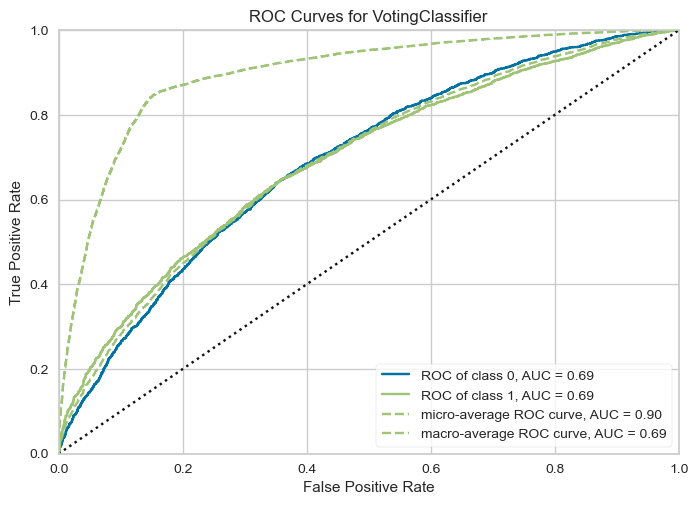

<AxesSubplot:title={'center':'ROC Curves for VotingClassifier'}, xlabel='False Positive Rate', ylabel='True Positive Rate'>

In [417]:
from yellowbrick.classifier import ROCAUC
from yellowbrick.contrib.wrapper import wrap

catboost_model = CatBoostClassifier()
model = wrap(ensemble_CAT_random_forest)
visualizer = ROCAUC(model)
visualizer.fit(X_train_smote, Y_train_smote)
visualizer.score(X_test, Y_test)
visualizer.show()

In [ ]:
## Z ciekawości sprawdzę, jaki wynik da XGBoost

In [ ]:
model_XGB=XGBClassifier()
grid = {'max_depth': [2,3,4],'n_estimators':[200, 300, 400]}

grid_XGB = GridSearchCV (estimator = model_XGB, param_grid = grid, scoring ='accuracy', cv = 5)


grid_XGB.fit(X_train_smote, Y_train_smote)

Y_pred = grid_XGB.predict(X_test)
Y_pred1 = grid_XGB.predict_proba(X_test)

print(grid_XGB.best_estimator_)
print(grid_XGB.best_score_)
print(grid_XGB.best_params_)

In [ ]:
print(roc_auc_score(Y_test, grid_XGB.predict_proba(X_test)[:,1]))

In [ ]:
## GridSearch XGBoost z cros walidacją

grid_XGB_cv = cross_val_score(grid_XGB, X_train_smote, Y_train_smote, cv=5, scoring='roc_auc')
print('Mean ROC AUC: %.3f' % mean(grid_XGB_cv))

In [ ]:
##  XGBoost daje podobne wyniki do CATBoost


##  Dopasowywnie i modyfikacje modelu nie dały istotnych zmian. Spróbuję znaleźć argumenty, które model uznał za najważniejsze.
##  Przetestuję model na danych zredukowanych do argumentów o najwyższej sile predykcji.

In [ ]:
##   Feature selection

In [ ]:
from sklearn.feature_selection import SelectFromModel

In [ ]:
def select_features(X_train, Y_train, X_test):
    '''Ta funkcja wyliczy, które zmienne są przez model uznane za przydatne
    '''
    model_fs = SelectFromModel(CatBoostClassifier(max_depth=3))

    model_fs.fit(X_train, Y_train)

    X_train_selected = model_fs.transform(X_train)
    X_test_selected = model_fs.transform(X_test)
    
    return X_train_selected, X_test_selected, model_fs

In [ ]:
select_features(X_train_smote, Y_train_smote, X_test)

In [ ]:
# trenuję model na wybranych zmiennych

X_train_selected, X_test_selected, model_fs = select_features(X_train_smote, Y_train_smote, X_test)

model = ensemble_CAT_random_forest
model.fit(X_train_selected, Y_train_smote)

Y_pred = model.predict(X_test_selected)

accuracy = accuracy_score(Y_test, Y_pred)
print('Accuracy: %.2f' % (accuracy*100))

In [ ]:
ensemble_CAT_random_forest_cv = cross_val_score(ensemble_CAT_random_forest, X_train_selected, Y_train_smote, cv=5, scoring='roc_auc')
print('Mean ROC AUC: %.3f' % mean(ensemble_CAT_random_forest_cv))

In [ ]:
## Wynik po SelectedFeatures nadal się nie poprawił

In [ ]:
#Pearson Correlation - poszukam najbardziej skorelowanych zmiennych i usunę najbardziej ze sobą skorelowane

In [ ]:
import seaborn as sns

plt.figure(figsize=(12,10))
cor = X_train_smote.corr()
sns.heatmap(cor, annot=True, cmap=plt.cm.CMRmap_r)
plt.show()

In [ ]:
def correlation(dataset, threshold):
    '''
    Ta funkcja pomoże znaleźć silnie skorelowane ze sobą zmienne i usunie pierwszą najbardziej skorelowana
    '''
    col_corr = set()  # Set of all the names of correlated columns
    corr_matrix = dataset.corr()
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if abs(corr_matrix.iloc[i, j]) > threshold: # we are interested in absolute coeff value
                colname = corr_matrix.columns[i]  # getting the name of column
                col_corr.add(colname)
    return col_corr

In [ ]:
corr_features = correlation(X_train_smote, 0.6)
len(set(corr_features))

In [ ]:
X_train_smote.drop(corr_features,axis=1)
X_test.drop(corr_features,axis=1)

In [ ]:
# Model ensemble CAT + random_forest po FeatureSelection metodą Pearson Correlation

CAT_ensemble = CatBoostClassifier(max_depth=3)
random_forest_ensemble = RandomForestClassifier(n_estimators=500, random_state=0)


ensemble_CAT_random_forest = VotingClassifier(estimators = [('CAT', CAT_ensemble), 
                                                            ('random_forest', random_forest_ensemble)], 
                                              voting='soft') 


ensemble_CAT_random_forest.fit(X_train_smote, Y_train_smote)

Y_pred = ensemble_CAT_random_forest.predict(X_test)
Y_pred1 = ensemble_CAT_random_forest.predict_proba(X_test)

In [ ]:
# Model ensemble CAT + random_forest po cros walidacji i po FeatureSelection metodą Pearson Correlation

ensemble_CAT_random_forest_cv = cross_val_score(ensemble_CAT_random_forest, X_train_smote, Y_train_smote, cv=5, scoring='roc_auc')
print('Mean ROC AUC: %.3f' % mean(ensemble_CAT_random_forest_cv))

In [ ]:
## Wynik nadal się nie poprawił więc skorzystam jeszcze z SelectKBest

In [418]:
from sklearn.feature_selection import mutual_info_classif

mutual_info = mutual_info_classif(X_train_smote, Y_train_smote)
mutual_info

array([0.00140731, 0.01234447, 0.02411523, 0.0103664 , 0.00355481,
       0.00235211, 0.00069493, 0.00416074, 0.00103096, 0.        ,
       0.        , 0.00345151, 0.        , 0.00263759, 0.        ,
       0.01087737, 0.0038596 , 0.        , 0.00110249, 0.00672843,
       0.00074672, 0.00490951, 0.        , 0.        , 0.00218186,
       0.00257633, 0.        , 0.        , 0.        , 0.00242694,
       0.00081445, 0.00073452, 0.        , 0.        , 0.00254425,
       0.00274954, 0.        , 0.00018182])

In [419]:
mutual_info = pd.Series(mutual_info)
mutual_info.index = X_train_smote.columns
mutual_info.sort_values(ascending=False)

int_rate                     0.024
term                         0.012
fico                         0.011
installment                  0.010
grade_E                      0.007
grade_G                      0.005
inq_last_6mths               0.004
grade_B                      0.004
annual_inc                   0.004
revol_util                   0.003
purpose_small_business       0.003
pub_rec_bankruptcies         0.003
purpose_credit_card          0.003
purpose_renewable_energy     0.003
purpose_house                0.002
dti                          0.002
home_ownership_RENT          0.002
loan_amnt                    0.001
grade_D                      0.001
open_acc                     0.001
purpose_major_purchase       0.001
grade_F                      0.001
purpose_medical              0.001
earliest_cr_line             0.001
purpose_wedding              0.000
revol_bal                    0.000
purpose_debt_consolidation   0.000
purpose_educational          0.000
grade_C             

<AxesSubplot:>

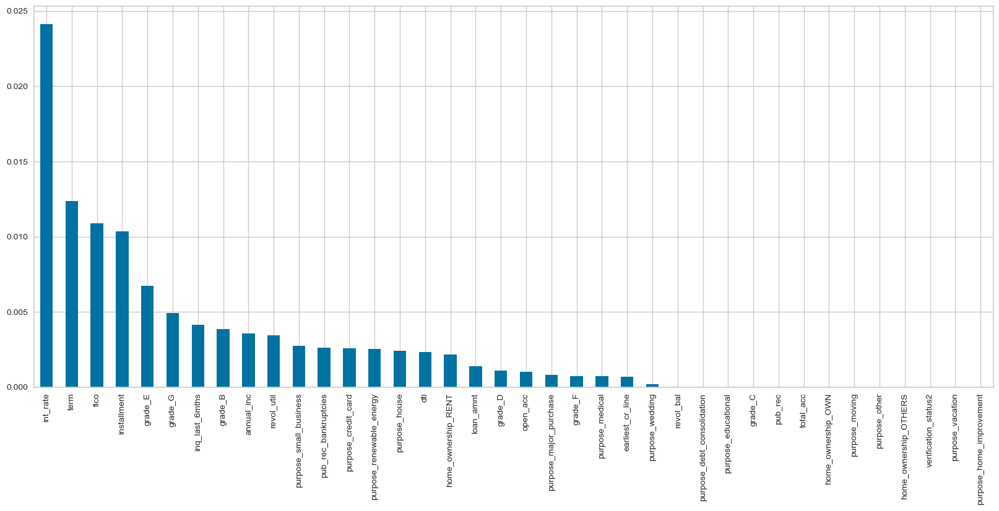

In [420]:

mutual_info.sort_values(ascending=False).plot.bar(figsize=(20, 8))

In [421]:
## Wybieram 10 najważniejszych argumentów

from sklearn.feature_selection import SelectKBest

sel_ten_cols = SelectKBest(mutual_info_classif, k=10)
sel_ten_cols.fit(X_train_smote, Y_train_smote)
X_train_smote.columns[sel_ten_cols.get_support()]

Index(['term', 'int_rate', 'installment', 'annual_inc', 'dti',
       'inq_last_6mths', 'revol_util', 'fico', 'grade_E',
       'purpose_debt_consolidation'],
      dtype='object')

In [422]:
X_train_smote2 = X_train_smote[['term', 'int_rate', 'installment', 'annual_inc', 'earliest_cr_line',
       'inq_last_6mths', 'fico', 'grade_D', 'grade_E', 'purpose_house']]
X_test2 = X_test[['term', 'int_rate', 'installment', 'annual_inc', 'earliest_cr_line',
       'inq_last_6mths', 'fico', 'grade_D', 'grade_E', 'purpose_house']]

In [ ]:
# Model ensemble CAT + random_forest na 10 argumentach z SelectKBest

CAT_ensemble = CatBoostClassifier(max_depth=3)
random_forest_ensemble = RandomForestClassifier(n_estimators=500, random_state=0)


ensemble_CAT_random_forest = VotingClassifier(estimators = [('CAT', CAT_ensemble), 
                                                            ('random_forest', random_forest_ensemble)], 
                                              voting='soft') 


ensemble_CAT_random_forest.fit(X_train_smote2, Y_train_smote)

Y_pred = ensemble_CAT_random_forest.predict(X_test2)
Y_pred1 = ensemble_CAT_random_forest.predict_proba(X_test2)

In [ ]:
# Model ensemble CAT + random_forest + cros walidacja na 10 argumentach z SelectKBest

ensemble_CAT_random_forest_cv = cross_val_score(ensemble_CAT_random_forest, X_train_smote2, Y_train_smote, cv=5, scoring='roc_auc')
print('Mean ROC AUC: %.3f' % mean(ensemble_CAT_random_forest_cv))

In [ ]:
## Niestety żadne modyfikacje nie przyniosły poprawy
## Najlepszy model to Ensemble - CATBoost + RandomForest + cros walidacja

In [ ]:
ensemble_CAT_random_forest_cv = cross_val_score(ensemble_CAT_random_forest, X_train_smote, Y_train_smote, cv=5, scoring='roc_auc')
print('Mean ROC AUC: %.3f' % mean(ensemble_CAT_random_forest_cv))

In [ ]:
ns_probs = [0 for _ in range(len(Y_test))]

In [ ]:
lr_probs = ensemble_CAT_random_forest.predict_proba(X_test)

lr_probs = lr_probs[:, 1]

ns_auc = roc_auc_score(Y_test, ns_probs)
lr_auc = roc_auc_score(Y_test, lr_probs)

print('No Skill: ROC AUC=%.3f' % (ns_auc))
print('ensemble_CAT_random_forest: ROC AUC=%.3f' % (lr_auc))

ns_fpr, ns_tpr, _ = roc_curve(Y_test, ns_probs)
lr_fpr, lr_tpr, _ = roc_curve(Y_test, lr_probs)

plt.figure(figsize=(12,4))
plt.plot(ns_fpr, ns_tpr, linestyle='--', label='No Skill')
plt.plot(lr_fpr, lr_tpr, marker='.', label='CAT Boost')

plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')

plt.legend()

plt.show()

In [ ]:
confusion_matrix(Y_test, Y_pred)

In [ ]:
print(classification_report(Y_test, Y_pred))

In [ ]:
performance_report = classification_report(Y_test, Y_pred, output_dict=True)

In [ ]:
evaluate_performance(Y_test, Y_pred)

In [ ]:
model_summary = evaluate_performance(Y_test, Y_pred)
model_summary['model'] = 'Ensemble CAT + RandomForest'
model_summary['auroc'] = lr_auc

In [ ]:
EnsembleCAT = pd.DataFrame([model_summary])

In [ ]:
results_model_ensembleCAT = pd.DataFrame([model_summary])
results = pd.concat([results_model_ensembleCAT])
results

In [ ]:
cf_matrix = confusion_matrix(Y_test, Y_pred)
print(cf_matrix)

In [ ]:
sns.heatmap(cf_matrix/np.sum(cf_matrix), annot=True, 
            fmt='.2%', cmap='Blues')

In [ ]:
## Z analizy confusion matrix wynika, że model niczego się nie nauczył. Prawie wcale nie wskazał pozytywnych (1) wartości, ale 
## zaklasyfikował je jako fałszywie dodatnie (false positives)

## Bias-variance tradeoff

In [423]:
X_train_smote =X_train_smote.values 
Y_train_smote=Y_train_smote.values
X_test=X_test.values
Y_test=Y_test.values

In [425]:
from mlxtend.evaluate import bias_variance_decomp


CAT_ensemble = CatBoostClassifier(max_depth=3)
random_forest_ensemble = RandomForestClassifier(n_estimators=500, random_state=0)


ensemble_CAT_random_forest = VotingClassifier(estimators = [('CAT', CAT_ensemble), 
                                                            ('random_forest', random_forest_ensemble)], 
                                              voting='soft') 
# estimate bias and variance
mse, bias, var = bias_variance_decomp(CAT_ensemble, X_train_smote, Y_train_smote, X_test, Y_test, loss='mse', num_rounds=200, random_seed=1)
# summarize results
print('MSE: %.3f' % mse)
print('Bias: %.3f' % bias)
print('Variance: %.3f' % var)

Learning rate set to 0.045192
0:	learn: 0.6638934	total: 7.94ms	remaining: 7.93s
1:	learn: 0.6390314	total: 16.2ms	remaining: 8.09s
2:	learn: 0.6160271	total: 24.2ms	remaining: 8.05s
3:	learn: 0.5959820	total: 32.2ms	remaining: 8.02s
4:	learn: 0.5791041	total: 40ms	remaining: 7.96s
5:	learn: 0.5620202	total: 47.8ms	remaining: 7.92s
6:	learn: 0.5468333	total: 55.6ms	remaining: 7.88s
7:	learn: 0.5337270	total: 63.2ms	remaining: 7.84s
8:	learn: 0.5218249	total: 70.6ms	remaining: 7.77s
9:	learn: 0.5101520	total: 78.5ms	remaining: 7.77s
10:	learn: 0.4996178	total: 85.7ms	remaining: 7.71s
11:	learn: 0.4902497	total: 93.2ms	remaining: 7.67s
12:	learn: 0.4830181	total: 101ms	remaining: 7.66s
13:	learn: 0.4763759	total: 109ms	remaining: 7.66s
14:	learn: 0.4697839	total: 116ms	remaining: 7.63s
15:	learn: 0.4643412	total: 125ms	remaining: 7.71s
16:	learn: 0.4589954	total: 134ms	remaining: 7.72s
17:	learn: 0.4538844	total: 142ms	remaining: 7.75s
18:	learn: 0.4495628	total: 150ms	remaining: 7.75s
1

161:	learn: 0.3900935	total: 1.66s	remaining: 8.56s
162:	learn: 0.3900431	total: 1.68s	remaining: 8.6s
163:	learn: 0.3899730	total: 1.69s	remaining: 8.63s
164:	learn: 0.3899077	total: 1.71s	remaining: 8.64s
165:	learn: 0.3898611	total: 1.72s	remaining: 8.65s
166:	learn: 0.3897910	total: 1.73s	remaining: 8.64s
167:	learn: 0.3897179	total: 1.75s	remaining: 8.65s
168:	learn: 0.3896592	total: 1.76s	remaining: 8.65s
169:	learn: 0.3896087	total: 1.77s	remaining: 8.66s
170:	learn: 0.3895528	total: 1.79s	remaining: 8.66s
171:	learn: 0.3894874	total: 1.8s	remaining: 8.66s
172:	learn: 0.3894653	total: 1.81s	remaining: 8.66s
173:	learn: 0.3894342	total: 1.82s	remaining: 8.67s
174:	learn: 0.3894001	total: 1.84s	remaining: 8.67s
175:	learn: 0.3893312	total: 1.85s	remaining: 8.66s
176:	learn: 0.3892876	total: 1.86s	remaining: 8.67s
177:	learn: 0.3892366	total: 1.88s	remaining: 8.68s
178:	learn: 0.3891973	total: 1.9s	remaining: 8.7s
179:	learn: 0.3891738	total: 1.91s	remaining: 8.69s
180:	learn: 0.38

322:	learn: 0.3811598	total: 3.77s	remaining: 7.89s
323:	learn: 0.3810997	total: 3.78s	remaining: 7.89s
324:	learn: 0.3810600	total: 3.79s	remaining: 7.88s
325:	learn: 0.3810041	total: 3.81s	remaining: 7.88s
326:	learn: 0.3809537	total: 3.82s	remaining: 7.87s
327:	learn: 0.3809034	total: 3.84s	remaining: 7.86s
328:	learn: 0.3808369	total: 3.85s	remaining: 7.85s
329:	learn: 0.3807735	total: 3.86s	remaining: 7.84s
330:	learn: 0.3807049	total: 3.87s	remaining: 7.83s
331:	learn: 0.3806282	total: 3.88s	remaining: 7.82s
332:	learn: 0.3805822	total: 3.9s	remaining: 7.81s
333:	learn: 0.3805476	total: 3.91s	remaining: 7.79s
334:	learn: 0.3805037	total: 3.92s	remaining: 7.77s
335:	learn: 0.3804530	total: 3.92s	remaining: 7.76s
336:	learn: 0.3804164	total: 3.93s	remaining: 7.74s
337:	learn: 0.3803753	total: 3.94s	remaining: 7.72s
338:	learn: 0.3803128	total: 3.95s	remaining: 7.7s
339:	learn: 0.3802351	total: 3.96s	remaining: 7.68s
340:	learn: 0.3801962	total: 3.97s	remaining: 7.67s
341:	learn: 0.

500:	learn: 0.3731318	total: 5.63s	remaining: 5.61s
501:	learn: 0.3730947	total: 5.64s	remaining: 5.6s
502:	learn: 0.3730537	total: 5.65s	remaining: 5.59s
503:	learn: 0.3730218	total: 5.66s	remaining: 5.57s
504:	learn: 0.3729839	total: 5.67s	remaining: 5.56s
505:	learn: 0.3729396	total: 5.68s	remaining: 5.55s
506:	learn: 0.3729118	total: 5.69s	remaining: 5.54s
507:	learn: 0.3728753	total: 5.7s	remaining: 5.52s
508:	learn: 0.3728301	total: 5.71s	remaining: 5.51s
509:	learn: 0.3728060	total: 5.72s	remaining: 5.5s
510:	learn: 0.3727768	total: 5.73s	remaining: 5.48s
511:	learn: 0.3727481	total: 5.74s	remaining: 5.47s
512:	learn: 0.3727135	total: 5.75s	remaining: 5.46s
513:	learn: 0.3726799	total: 5.76s	remaining: 5.45s
514:	learn: 0.3726491	total: 5.77s	remaining: 5.43s
515:	learn: 0.3726196	total: 5.78s	remaining: 5.42s
516:	learn: 0.3725813	total: 5.79s	remaining: 5.41s
517:	learn: 0.3725455	total: 5.8s	remaining: 5.39s
518:	learn: 0.3725140	total: 5.8s	remaining: 5.38s
519:	learn: 0.372

669:	learn: 0.3666627	total: 7.07s	remaining: 3.48s
670:	learn: 0.3666330	total: 7.08s	remaining: 3.47s
671:	learn: 0.3666074	total: 7.09s	remaining: 3.46s
672:	learn: 0.3665817	total: 7.1s	remaining: 3.45s
673:	learn: 0.3665396	total: 7.11s	remaining: 3.44s
674:	learn: 0.3665042	total: 7.12s	remaining: 3.43s
675:	learn: 0.3664825	total: 7.13s	remaining: 3.42s
676:	learn: 0.3664383	total: 7.14s	remaining: 3.41s
677:	learn: 0.3663789	total: 7.15s	remaining: 3.4s
678:	learn: 0.3663443	total: 7.16s	remaining: 3.38s
679:	learn: 0.3663102	total: 7.17s	remaining: 3.37s
680:	learn: 0.3662751	total: 7.17s	remaining: 3.36s
681:	learn: 0.3662562	total: 7.18s	remaining: 3.35s
682:	learn: 0.3662256	total: 7.19s	remaining: 3.34s
683:	learn: 0.3661722	total: 7.2s	remaining: 3.33s
684:	learn: 0.3661420	total: 7.21s	remaining: 3.32s
685:	learn: 0.3661174	total: 7.22s	remaining: 3.31s
686:	learn: 0.3660749	total: 7.23s	remaining: 3.29s
687:	learn: 0.3660419	total: 7.24s	remaining: 3.28s
688:	learn: 0.3

832:	learn: 0.3608272	total: 8.52s	remaining: 1.71s
833:	learn: 0.3607923	total: 8.53s	remaining: 1.7s
834:	learn: 0.3607588	total: 8.54s	remaining: 1.69s
835:	learn: 0.3607293	total: 8.54s	remaining: 1.68s
836:	learn: 0.3606936	total: 8.55s	remaining: 1.67s
837:	learn: 0.3606501	total: 8.56s	remaining: 1.66s
838:	learn: 0.3606124	total: 8.57s	remaining: 1.64s
839:	learn: 0.3605776	total: 8.58s	remaining: 1.63s
840:	learn: 0.3605568	total: 8.59s	remaining: 1.62s
841:	learn: 0.3605280	total: 8.6s	remaining: 1.61s
842:	learn: 0.3605033	total: 8.61s	remaining: 1.6s
843:	learn: 0.3604742	total: 8.61s	remaining: 1.59s
844:	learn: 0.3604601	total: 8.62s	remaining: 1.58s
845:	learn: 0.3604240	total: 8.63s	remaining: 1.57s
846:	learn: 0.3603918	total: 8.64s	remaining: 1.56s
847:	learn: 0.3603515	total: 8.64s	remaining: 1.55s
848:	learn: 0.3602985	total: 8.65s	remaining: 1.54s
849:	learn: 0.3602649	total: 8.66s	remaining: 1.53s
850:	learn: 0.3602318	total: 8.67s	remaining: 1.52s
851:	learn: 0.3

Learning rate set to 0.045192
0:	learn: 0.6629051	total: 11ms	remaining: 11s
1:	learn: 0.6371644	total: 22.1ms	remaining: 11s
2:	learn: 0.6137127	total: 30ms	remaining: 9.98s
3:	learn: 0.5919772	total: 40.9ms	remaining: 10.2s
4:	learn: 0.5729943	total: 48.8ms	remaining: 9.71s
5:	learn: 0.5556586	total: 59.6ms	remaining: 9.87s
6:	learn: 0.5396602	total: 69ms	remaining: 9.79s
7:	learn: 0.5260229	total: 77.3ms	remaining: 9.59s
8:	learn: 0.5137317	total: 87.3ms	remaining: 9.62s
9:	learn: 0.5027328	total: 94.9ms	remaining: 9.39s
10:	learn: 0.4930290	total: 105ms	remaining: 9.47s
11:	learn: 0.4840492	total: 113ms	remaining: 9.29s
12:	learn: 0.4746795	total: 123ms	remaining: 9.38s
13:	learn: 0.4667577	total: 132ms	remaining: 9.27s
14:	learn: 0.4600226	total: 140ms	remaining: 9.16s
15:	learn: 0.4547684	total: 147ms	remaining: 9.06s
16:	learn: 0.4496532	total: 155ms	remaining: 8.94s
17:	learn: 0.4445828	total: 162ms	remaining: 8.81s
18:	learn: 0.4400458	total: 170ms	remaining: 8.75s
19:	learn: 

176:	learn: 0.3792995	total: 1.45s	remaining: 6.75s
177:	learn: 0.3792416	total: 1.46s	remaining: 6.75s
178:	learn: 0.3791813	total: 1.47s	remaining: 6.76s
179:	learn: 0.3791118	total: 1.49s	remaining: 6.77s
180:	learn: 0.3790694	total: 1.49s	remaining: 6.76s
181:	learn: 0.3790061	total: 1.5s	remaining: 6.76s
182:	learn: 0.3789606	total: 1.51s	remaining: 6.75s
183:	learn: 0.3789132	total: 1.52s	remaining: 6.74s
184:	learn: 0.3788726	total: 1.53s	remaining: 6.73s
185:	learn: 0.3788295	total: 1.54s	remaining: 6.72s
186:	learn: 0.3787641	total: 1.54s	remaining: 6.72s
187:	learn: 0.3787029	total: 1.56s	remaining: 6.72s
188:	learn: 0.3786435	total: 1.56s	remaining: 6.71s
189:	learn: 0.3785849	total: 1.57s	remaining: 6.7s
190:	learn: 0.3785195	total: 1.58s	remaining: 6.69s
191:	learn: 0.3784725	total: 1.59s	remaining: 6.68s
192:	learn: 0.3784091	total: 1.59s	remaining: 6.67s
193:	learn: 0.3783584	total: 1.6s	remaining: 6.66s
194:	learn: 0.3782685	total: 1.61s	remaining: 6.65s
195:	learn: 0.3

354:	learn: 0.3701632	total: 2.93s	remaining: 5.32s
355:	learn: 0.3701290	total: 2.94s	remaining: 5.32s
356:	learn: 0.3700712	total: 2.95s	remaining: 5.31s
357:	learn: 0.3700060	total: 2.96s	remaining: 5.3s
358:	learn: 0.3699651	total: 2.96s	remaining: 5.29s
359:	learn: 0.3699216	total: 2.97s	remaining: 5.28s
360:	learn: 0.3698859	total: 2.98s	remaining: 5.27s
361:	learn: 0.3698447	total: 2.99s	remaining: 5.26s
362:	learn: 0.3697951	total: 2.99s	remaining: 5.25s
363:	learn: 0.3697497	total: 3s	remaining: 5.24s
364:	learn: 0.3697078	total: 3.01s	remaining: 5.23s
365:	learn: 0.3696734	total: 3.02s	remaining: 5.22s
366:	learn: 0.3696434	total: 3.02s	remaining: 5.21s
367:	learn: 0.3696203	total: 3.03s	remaining: 5.21s
368:	learn: 0.3695637	total: 3.04s	remaining: 5.2s
369:	learn: 0.3695251	total: 3.05s	remaining: 5.19s
370:	learn: 0.3694850	total: 3.06s	remaining: 5.18s
371:	learn: 0.3694313	total: 3.06s	remaining: 5.17s
372:	learn: 0.3693997	total: 3.07s	remaining: 5.16s
373:	learn: 0.369

535:	learn: 0.3625787	total: 4.39s	remaining: 3.8s
536:	learn: 0.3625447	total: 4.4s	remaining: 3.79s
537:	learn: 0.3625109	total: 4.4s	remaining: 3.78s
538:	learn: 0.3624805	total: 4.41s	remaining: 3.77s
539:	learn: 0.3624412	total: 4.42s	remaining: 3.77s
540:	learn: 0.3624059	total: 4.43s	remaining: 3.76s
541:	learn: 0.3623599	total: 4.44s	remaining: 3.75s
542:	learn: 0.3623237	total: 4.45s	remaining: 3.74s
543:	learn: 0.3622740	total: 4.45s	remaining: 3.73s
544:	learn: 0.3622300	total: 4.46s	remaining: 3.73s
545:	learn: 0.3621831	total: 4.47s	remaining: 3.72s
546:	learn: 0.3621547	total: 4.48s	remaining: 3.71s
547:	learn: 0.3621202	total: 4.49s	remaining: 3.7s
548:	learn: 0.3620811	total: 4.5s	remaining: 3.69s
549:	learn: 0.3620356	total: 4.51s	remaining: 3.69s
550:	learn: 0.3619714	total: 4.52s	remaining: 3.68s
551:	learn: 0.3619358	total: 4.52s	remaining: 3.67s
552:	learn: 0.3618929	total: 4.53s	remaining: 3.67s
553:	learn: 0.3618625	total: 4.54s	remaining: 3.66s
554:	learn: 0.361

711:	learn: 0.3563345	total: 5.84s	remaining: 2.36s
712:	learn: 0.3563116	total: 5.85s	remaining: 2.35s
713:	learn: 0.3562958	total: 5.86s	remaining: 2.35s
714:	learn: 0.3562520	total: 5.87s	remaining: 2.34s
715:	learn: 0.3562241	total: 5.88s	remaining: 2.33s
716:	learn: 0.3561970	total: 5.89s	remaining: 2.32s
717:	learn: 0.3561690	total: 5.9s	remaining: 2.31s
718:	learn: 0.3561516	total: 5.9s	remaining: 2.31s
719:	learn: 0.3561290	total: 5.91s	remaining: 2.3s
720:	learn: 0.3560821	total: 5.92s	remaining: 2.29s
721:	learn: 0.3560533	total: 5.93s	remaining: 2.28s
722:	learn: 0.3560275	total: 5.94s	remaining: 2.28s
723:	learn: 0.3559845	total: 5.95s	remaining: 2.27s
724:	learn: 0.3559411	total: 5.96s	remaining: 2.26s
725:	learn: 0.3559093	total: 5.97s	remaining: 2.25s
726:	learn: 0.3558740	total: 5.97s	remaining: 2.24s
727:	learn: 0.3558398	total: 5.98s	remaining: 2.23s
728:	learn: 0.3557993	total: 5.99s	remaining: 2.23s
729:	learn: 0.3557504	total: 6s	remaining: 2.22s
730:	learn: 0.3556

878:	learn: 0.3509680	total: 7.53s	remaining: 1.04s
879:	learn: 0.3509201	total: 7.54s	remaining: 1.03s
880:	learn: 0.3508929	total: 7.55s	remaining: 1.02s
881:	learn: 0.3508668	total: 7.56s	remaining: 1.01s
882:	learn: 0.3508100	total: 7.57s	remaining: 1s
883:	learn: 0.3507828	total: 7.58s	remaining: 995ms
884:	learn: 0.3507365	total: 7.59s	remaining: 987ms
885:	learn: 0.3506931	total: 7.6s	remaining: 978ms
886:	learn: 0.3506554	total: 7.61s	remaining: 970ms
887:	learn: 0.3506280	total: 7.62s	remaining: 962ms
888:	learn: 0.3506064	total: 7.63s	remaining: 953ms
889:	learn: 0.3505727	total: 7.65s	remaining: 945ms
890:	learn: 0.3505412	total: 7.66s	remaining: 937ms
891:	learn: 0.3505082	total: 7.67s	remaining: 928ms
892:	learn: 0.3504550	total: 7.68s	remaining: 920ms
893:	learn: 0.3504246	total: 7.69s	remaining: 912ms
894:	learn: 0.3504003	total: 7.7s	remaining: 903ms
895:	learn: 0.3503747	total: 7.71s	remaining: 895ms
896:	learn: 0.3503326	total: 7.72s	remaining: 886ms
897:	learn: 0.350

60:	learn: 0.3988051	total: 611ms	remaining: 9.41s
61:	learn: 0.3985703	total: 619ms	remaining: 9.36s
62:	learn: 0.3983824	total: 627ms	remaining: 9.32s
63:	learn: 0.3981570	total: 635ms	remaining: 9.29s
64:	learn: 0.3980173	total: 642ms	remaining: 9.24s
65:	learn: 0.3978535	total: 650ms	remaining: 9.19s
66:	learn: 0.3977295	total: 659ms	remaining: 9.17s
67:	learn: 0.3975799	total: 667ms	remaining: 9.14s
68:	learn: 0.3973848	total: 675ms	remaining: 9.11s
69:	learn: 0.3972390	total: 682ms	remaining: 9.07s
70:	learn: 0.3971070	total: 690ms	remaining: 9.03s
71:	learn: 0.3969399	total: 699ms	remaining: 9.01s
72:	learn: 0.3967160	total: 707ms	remaining: 8.98s
73:	learn: 0.3965208	total: 716ms	remaining: 8.96s
74:	learn: 0.3963932	total: 725ms	remaining: 8.94s
75:	learn: 0.3962855	total: 735ms	remaining: 8.94s
76:	learn: 0.3961176	total: 742ms	remaining: 8.9s
77:	learn: 0.3959489	total: 751ms	remaining: 8.88s
78:	learn: 0.3958523	total: 759ms	remaining: 8.85s
79:	learn: 0.3957296	total: 768m

235:	learn: 0.3853601	total: 2.05s	remaining: 6.63s
236:	learn: 0.3853053	total: 2.06s	remaining: 6.63s
237:	learn: 0.3852572	total: 2.06s	remaining: 6.61s
238:	learn: 0.3851907	total: 2.07s	remaining: 6.6s
239:	learn: 0.3851241	total: 2.08s	remaining: 6.59s
240:	learn: 0.3850713	total: 2.09s	remaining: 6.58s
241:	learn: 0.3850284	total: 2.1s	remaining: 6.57s
242:	learn: 0.3849508	total: 2.11s	remaining: 6.56s
243:	learn: 0.3849102	total: 2.11s	remaining: 6.55s
244:	learn: 0.3848353	total: 2.12s	remaining: 6.54s
245:	learn: 0.3847798	total: 2.13s	remaining: 6.53s
246:	learn: 0.3847338	total: 2.14s	remaining: 6.51s
247:	learn: 0.3846813	total: 2.14s	remaining: 6.5s
248:	learn: 0.3846329	total: 2.15s	remaining: 6.49s
249:	learn: 0.3845904	total: 2.16s	remaining: 6.48s
250:	learn: 0.3845357	total: 2.17s	remaining: 6.47s
251:	learn: 0.3844534	total: 2.18s	remaining: 6.46s
252:	learn: 0.3843675	total: 2.18s	remaining: 6.45s
253:	learn: 0.3843113	total: 2.19s	remaining: 6.44s
254:	learn: 0.3

409:	learn: 0.3762894	total: 3.5s	remaining: 5.04s
410:	learn: 0.3762533	total: 3.51s	remaining: 5.03s
411:	learn: 0.3762042	total: 3.52s	remaining: 5.02s
412:	learn: 0.3761622	total: 3.52s	remaining: 5.01s
413:	learn: 0.3761057	total: 3.53s	remaining: 5s
414:	learn: 0.3760642	total: 3.54s	remaining: 4.99s
415:	learn: 0.3760079	total: 3.55s	remaining: 4.98s
416:	learn: 0.3759737	total: 3.56s	remaining: 4.97s
417:	learn: 0.3759369	total: 3.56s	remaining: 4.96s
418:	learn: 0.3758921	total: 3.57s	remaining: 4.95s
419:	learn: 0.3758485	total: 3.58s	remaining: 4.94s
420:	learn: 0.3758144	total: 3.59s	remaining: 4.93s
421:	learn: 0.3757592	total: 3.59s	remaining: 4.92s
422:	learn: 0.3757223	total: 3.6s	remaining: 4.92s
423:	learn: 0.3756766	total: 3.61s	remaining: 4.91s
424:	learn: 0.3756471	total: 3.62s	remaining: 4.9s
425:	learn: 0.3756073	total: 3.63s	remaining: 4.89s
426:	learn: 0.3755692	total: 3.64s	remaining: 4.88s
427:	learn: 0.3755058	total: 3.65s	remaining: 4.88s
428:	learn: 0.3754

590:	learn: 0.3690097	total: 4.94s	remaining: 3.42s
591:	learn: 0.3689769	total: 4.94s	remaining: 3.41s
592:	learn: 0.3689468	total: 4.95s	remaining: 3.4s
593:	learn: 0.3689125	total: 4.96s	remaining: 3.39s
594:	learn: 0.3688727	total: 4.97s	remaining: 3.38s
595:	learn: 0.3688279	total: 4.97s	remaining: 3.37s
596:	learn: 0.3687829	total: 4.98s	remaining: 3.36s
597:	learn: 0.3687425	total: 4.99s	remaining: 3.35s
598:	learn: 0.3687093	total: 5s	remaining: 3.35s
599:	learn: 0.3686702	total: 5.01s	remaining: 3.34s
600:	learn: 0.3686384	total: 5.01s	remaining: 3.33s
601:	learn: 0.3686076	total: 5.02s	remaining: 3.32s
602:	learn: 0.3685727	total: 5.03s	remaining: 3.31s
603:	learn: 0.3685229	total: 5.04s	remaining: 3.3s
604:	learn: 0.3685036	total: 5.04s	remaining: 3.29s
605:	learn: 0.3684696	total: 5.05s	remaining: 3.29s
606:	learn: 0.3684314	total: 5.06s	remaining: 3.28s
607:	learn: 0.3683952	total: 5.07s	remaining: 3.27s
608:	learn: 0.3683546	total: 5.08s	remaining: 3.26s
609:	learn: 0.368

774:	learn: 0.3623360	total: 6.38s	remaining: 1.85s
775:	learn: 0.3622749	total: 6.39s	remaining: 1.84s
776:	learn: 0.3622281	total: 6.39s	remaining: 1.83s
777:	learn: 0.3621970	total: 6.4s	remaining: 1.83s
778:	learn: 0.3621716	total: 6.41s	remaining: 1.82s
779:	learn: 0.3621253	total: 6.42s	remaining: 1.81s
780:	learn: 0.3621014	total: 6.42s	remaining: 1.8s
781:	learn: 0.3620623	total: 6.43s	remaining: 1.79s
782:	learn: 0.3620230	total: 6.44s	remaining: 1.78s
783:	learn: 0.3619934	total: 6.45s	remaining: 1.78s
784:	learn: 0.3619524	total: 6.46s	remaining: 1.77s
785:	learn: 0.3619226	total: 6.46s	remaining: 1.76s
786:	learn: 0.3618957	total: 6.47s	remaining: 1.75s
787:	learn: 0.3618735	total: 6.48s	remaining: 1.74s
788:	learn: 0.3618344	total: 6.49s	remaining: 1.74s
789:	learn: 0.3617900	total: 6.5s	remaining: 1.73s
790:	learn: 0.3617583	total: 6.5s	remaining: 1.72s
791:	learn: 0.3617179	total: 6.51s	remaining: 1.71s
792:	learn: 0.3616929	total: 6.52s	remaining: 1.7s
793:	learn: 0.361

953:	learn: 0.3564700	total: 7.84s	remaining: 378ms
954:	learn: 0.3564405	total: 7.85s	remaining: 370ms
955:	learn: 0.3564207	total: 7.86s	remaining: 362ms
956:	learn: 0.3563834	total: 7.86s	remaining: 353ms
957:	learn: 0.3563287	total: 7.87s	remaining: 345ms
958:	learn: 0.3562945	total: 7.88s	remaining: 337ms
959:	learn: 0.3562613	total: 7.89s	remaining: 329ms
960:	learn: 0.3562117	total: 7.9s	remaining: 320ms
961:	learn: 0.3561821	total: 7.91s	remaining: 312ms
962:	learn: 0.3561555	total: 7.91s	remaining: 304ms
963:	learn: 0.3561203	total: 7.92s	remaining: 296ms
964:	learn: 0.3561050	total: 7.93s	remaining: 288ms
965:	learn: 0.3560954	total: 7.94s	remaining: 279ms
966:	learn: 0.3560865	total: 7.94s	remaining: 271ms
967:	learn: 0.3560610	total: 7.95s	remaining: 263ms
968:	learn: 0.3560226	total: 7.96s	remaining: 255ms
969:	learn: 0.3560018	total: 7.97s	remaining: 246ms
970:	learn: 0.3559758	total: 7.97s	remaining: 238ms
971:	learn: 0.3559489	total: 7.98s	remaining: 230ms
972:	learn: 0

131:	learn: 0.3911794	total: 1.01s	remaining: 6.63s
132:	learn: 0.3911288	total: 1.02s	remaining: 6.63s
133:	learn: 0.3910174	total: 1.02s	remaining: 6.61s
134:	learn: 0.3909228	total: 1.03s	remaining: 6.61s
135:	learn: 0.3908242	total: 1.04s	remaining: 6.6s
136:	learn: 0.3907735	total: 1.05s	remaining: 6.59s
137:	learn: 0.3907059	total: 1.05s	remaining: 6.59s
138:	learn: 0.3906481	total: 1.06s	remaining: 6.58s
139:	learn: 0.3905879	total: 1.07s	remaining: 6.57s
140:	learn: 0.3905197	total: 1.08s	remaining: 6.56s
141:	learn: 0.3904285	total: 1.08s	remaining: 6.56s
142:	learn: 0.3903584	total: 1.09s	remaining: 6.55s
143:	learn: 0.3903001	total: 1.1s	remaining: 6.54s
144:	learn: 0.3902576	total: 1.11s	remaining: 6.53s
145:	learn: 0.3902134	total: 1.11s	remaining: 6.53s
146:	learn: 0.3901475	total: 1.12s	remaining: 6.51s
147:	learn: 0.3900788	total: 1.13s	remaining: 6.5s
148:	learn: 0.3899688	total: 1.14s	remaining: 6.49s
149:	learn: 0.3898861	total: 1.14s	remaining: 6.48s
150:	learn: 0.3

292:	learn: 0.3819876	total: 2.25s	remaining: 5.42s
293:	learn: 0.3819412	total: 2.26s	remaining: 5.42s
294:	learn: 0.3818910	total: 2.26s	remaining: 5.41s
295:	learn: 0.3818417	total: 2.27s	remaining: 5.41s
296:	learn: 0.3818026	total: 2.28s	remaining: 5.4s
297:	learn: 0.3817757	total: 2.29s	remaining: 5.39s
298:	learn: 0.3817127	total: 2.3s	remaining: 5.38s
299:	learn: 0.3816650	total: 2.31s	remaining: 5.38s
300:	learn: 0.3816019	total: 2.31s	remaining: 5.37s
301:	learn: 0.3815583	total: 2.32s	remaining: 5.37s
302:	learn: 0.3814895	total: 2.33s	remaining: 5.36s
303:	learn: 0.3814526	total: 2.34s	remaining: 5.35s
304:	learn: 0.3813973	total: 2.34s	remaining: 5.34s
305:	learn: 0.3813168	total: 2.35s	remaining: 5.33s
306:	learn: 0.3812768	total: 2.36s	remaining: 5.33s
307:	learn: 0.3812369	total: 2.37s	remaining: 5.32s
308:	learn: 0.3811764	total: 2.37s	remaining: 5.31s
309:	learn: 0.3811198	total: 2.38s	remaining: 5.3s
310:	learn: 0.3810719	total: 2.39s	remaining: 5.29s
311:	learn: 0.3

476:	learn: 0.3736811	total: 3.69s	remaining: 4.04s
477:	learn: 0.3736297	total: 3.69s	remaining: 4.03s
478:	learn: 0.3736003	total: 3.7s	remaining: 4.03s
479:	learn: 0.3735691	total: 3.71s	remaining: 4.02s
480:	learn: 0.3735321	total: 3.72s	remaining: 4.01s
481:	learn: 0.3735016	total: 3.72s	remaining: 4s
482:	learn: 0.3734872	total: 3.73s	remaining: 3.99s
483:	learn: 0.3734359	total: 3.74s	remaining: 3.99s
484:	learn: 0.3734019	total: 3.75s	remaining: 3.98s
485:	learn: 0.3733620	total: 3.75s	remaining: 3.97s
486:	learn: 0.3733100	total: 3.76s	remaining: 3.96s
487:	learn: 0.3732167	total: 3.77s	remaining: 3.95s
488:	learn: 0.3731808	total: 3.77s	remaining: 3.94s
489:	learn: 0.3730965	total: 3.78s	remaining: 3.94s
490:	learn: 0.3730478	total: 3.79s	remaining: 3.93s
491:	learn: 0.3730045	total: 3.8s	remaining: 3.92s
492:	learn: 0.3729595	total: 3.81s	remaining: 3.92s
493:	learn: 0.3729104	total: 3.82s	remaining: 3.91s
494:	learn: 0.3728800	total: 3.83s	remaining: 3.9s
495:	learn: 0.3728

647:	learn: 0.3666311	total: 5.37s	remaining: 2.92s
648:	learn: 0.3665914	total: 5.38s	remaining: 2.91s
649:	learn: 0.3665560	total: 5.39s	remaining: 2.9s
650:	learn: 0.3665202	total: 5.4s	remaining: 2.9s
651:	learn: 0.3664840	total: 5.42s	remaining: 2.89s
652:	learn: 0.3664537	total: 5.43s	remaining: 2.88s
653:	learn: 0.3664172	total: 5.44s	remaining: 2.88s
654:	learn: 0.3663870	total: 5.45s	remaining: 2.87s
655:	learn: 0.3663225	total: 5.46s	remaining: 2.86s
656:	learn: 0.3662860	total: 5.47s	remaining: 2.86s
657:	learn: 0.3662326	total: 5.48s	remaining: 2.85s
658:	learn: 0.3661885	total: 5.49s	remaining: 2.84s
659:	learn: 0.3661491	total: 5.5s	remaining: 2.83s
660:	learn: 0.3661083	total: 5.51s	remaining: 2.83s
661:	learn: 0.3660476	total: 5.53s	remaining: 2.82s
662:	learn: 0.3660146	total: 5.54s	remaining: 2.81s
663:	learn: 0.3659686	total: 5.55s	remaining: 2.81s
664:	learn: 0.3659232	total: 5.56s	remaining: 2.8s
665:	learn: 0.3658714	total: 5.57s	remaining: 2.79s
666:	learn: 0.365

810:	learn: 0.3607480	total: 7.01s	remaining: 1.63s
811:	learn: 0.3607015	total: 7.02s	remaining: 1.63s
812:	learn: 0.3606647	total: 7.03s	remaining: 1.62s
813:	learn: 0.3606225	total: 7.04s	remaining: 1.61s
814:	learn: 0.3606049	total: 7.05s	remaining: 1.6s
815:	learn: 0.3605553	total: 7.06s	remaining: 1.59s
816:	learn: 0.3605024	total: 7.07s	remaining: 1.58s
817:	learn: 0.3604698	total: 7.08s	remaining: 1.57s
818:	learn: 0.3604444	total: 7.09s	remaining: 1.57s
819:	learn: 0.3604042	total: 7.1s	remaining: 1.56s
820:	learn: 0.3603984	total: 7.12s	remaining: 1.55s
821:	learn: 0.3603619	total: 7.13s	remaining: 1.54s
822:	learn: 0.3603227	total: 7.14s	remaining: 1.54s
823:	learn: 0.3602964	total: 7.16s	remaining: 1.53s
824:	learn: 0.3602594	total: 7.17s	remaining: 1.52s
825:	learn: 0.3602440	total: 7.18s	remaining: 1.51s
826:	learn: 0.3602088	total: 7.19s	remaining: 1.5s
827:	learn: 0.3601837	total: 7.2s	remaining: 1.5s
828:	learn: 0.3601473	total: 7.21s	remaining: 1.49s
829:	learn: 0.360

971:	learn: 0.3554585	total: 8.47s	remaining: 244ms
972:	learn: 0.3554418	total: 8.48s	remaining: 235ms
973:	learn: 0.3554204	total: 8.49s	remaining: 227ms
974:	learn: 0.3553974	total: 8.5s	remaining: 218ms
975:	learn: 0.3553556	total: 8.51s	remaining: 209ms
976:	learn: 0.3553196	total: 8.52s	remaining: 201ms
977:	learn: 0.3552892	total: 8.53s	remaining: 192ms
978:	learn: 0.3552625	total: 8.54s	remaining: 183ms
979:	learn: 0.3552074	total: 8.54s	remaining: 174ms
980:	learn: 0.3551624	total: 8.55s	remaining: 166ms
981:	learn: 0.3551246	total: 8.56s	remaining: 157ms
982:	learn: 0.3551034	total: 8.57s	remaining: 148ms
983:	learn: 0.3550746	total: 8.57s	remaining: 139ms
984:	learn: 0.3550443	total: 8.59s	remaining: 131ms
985:	learn: 0.3550200	total: 8.59s	remaining: 122ms
986:	learn: 0.3549910	total: 8.6s	remaining: 113ms
987:	learn: 0.3549578	total: 8.61s	remaining: 105ms
988:	learn: 0.3549326	total: 8.62s	remaining: 95.8ms
989:	learn: 0.3549003	total: 8.62s	remaining: 87.1ms
990:	learn: 

149:	learn: 0.3830849	total: 1.25s	remaining: 7.08s
150:	learn: 0.3830207	total: 1.26s	remaining: 7.08s
151:	learn: 0.3829605	total: 1.27s	remaining: 7.07s
152:	learn: 0.3829019	total: 1.27s	remaining: 7.06s
153:	learn: 0.3828233	total: 1.28s	remaining: 7.05s
154:	learn: 0.3827428	total: 1.29s	remaining: 7.04s
155:	learn: 0.3826987	total: 1.3s	remaining: 7.02s
156:	learn: 0.3826122	total: 1.3s	remaining: 7.01s
157:	learn: 0.3825451	total: 1.31s	remaining: 7s
158:	learn: 0.3824508	total: 1.32s	remaining: 6.99s
159:	learn: 0.3824002	total: 1.33s	remaining: 6.97s
160:	learn: 0.3823060	total: 1.34s	remaining: 6.96s
161:	learn: 0.3822551	total: 1.34s	remaining: 6.95s
162:	learn: 0.3821893	total: 1.35s	remaining: 6.94s
163:	learn: 0.3821408	total: 1.36s	remaining: 6.93s
164:	learn: 0.3820998	total: 1.37s	remaining: 6.92s
165:	learn: 0.3820445	total: 1.37s	remaining: 6.9s
166:	learn: 0.3819971	total: 1.38s	remaining: 6.89s
167:	learn: 0.3819454	total: 1.39s	remaining: 6.88s
168:	learn: 0.3818

332:	learn: 0.3736493	total: 2.67s	remaining: 5.36s
333:	learn: 0.3735881	total: 2.68s	remaining: 5.35s
334:	learn: 0.3735235	total: 2.69s	remaining: 5.34s
335:	learn: 0.3734565	total: 2.7s	remaining: 5.33s
336:	learn: 0.3733919	total: 2.71s	remaining: 5.32s
337:	learn: 0.3733557	total: 2.71s	remaining: 5.31s
338:	learn: 0.3732763	total: 2.72s	remaining: 5.31s
339:	learn: 0.3732234	total: 2.73s	remaining: 5.3s
340:	learn: 0.3731751	total: 2.74s	remaining: 5.29s
341:	learn: 0.3731305	total: 2.74s	remaining: 5.28s
342:	learn: 0.3730787	total: 2.75s	remaining: 5.27s
343:	learn: 0.3730266	total: 2.76s	remaining: 5.26s
344:	learn: 0.3729539	total: 2.77s	remaining: 5.25s
345:	learn: 0.3729146	total: 2.77s	remaining: 5.25s
346:	learn: 0.3728830	total: 2.78s	remaining: 5.24s
347:	learn: 0.3728376	total: 2.79s	remaining: 5.23s
348:	learn: 0.3727953	total: 2.8s	remaining: 5.22s
349:	learn: 0.3727441	total: 2.81s	remaining: 5.21s
350:	learn: 0.3727048	total: 2.81s	remaining: 5.2s
351:	learn: 0.37

516:	learn: 0.3656338	total: 4.12s	remaining: 3.85s
517:	learn: 0.3655639	total: 4.13s	remaining: 3.84s
518:	learn: 0.3655248	total: 4.13s	remaining: 3.83s
519:	learn: 0.3654873	total: 4.14s	remaining: 3.82s
520:	learn: 0.3654316	total: 4.15s	remaining: 3.82s
521:	learn: 0.3654037	total: 4.16s	remaining: 3.81s
522:	learn: 0.3653614	total: 4.17s	remaining: 3.8s
523:	learn: 0.3653249	total: 4.17s	remaining: 3.79s
524:	learn: 0.3652806	total: 4.18s	remaining: 3.78s
525:	learn: 0.3652409	total: 4.19s	remaining: 3.77s
526:	learn: 0.3651988	total: 4.2s	remaining: 3.77s
527:	learn: 0.3651480	total: 4.2s	remaining: 3.76s
528:	learn: 0.3651021	total: 4.21s	remaining: 3.75s
529:	learn: 0.3650673	total: 4.22s	remaining: 3.74s
530:	learn: 0.3650242	total: 4.23s	remaining: 3.73s
531:	learn: 0.3649909	total: 4.23s	remaining: 3.73s
532:	learn: 0.3649446	total: 4.24s	remaining: 3.72s
533:	learn: 0.3648816	total: 4.25s	remaining: 3.71s
534:	learn: 0.3648395	total: 4.26s	remaining: 3.7s
535:	learn: 0.36

695:	learn: 0.3590214	total: 5.55s	remaining: 2.42s
696:	learn: 0.3589734	total: 5.56s	remaining: 2.42s
697:	learn: 0.3589442	total: 5.57s	remaining: 2.41s
698:	learn: 0.3589323	total: 5.57s	remaining: 2.4s
699:	learn: 0.3588903	total: 5.58s	remaining: 2.39s
700:	learn: 0.3588588	total: 5.59s	remaining: 2.38s
701:	learn: 0.3588129	total: 5.6s	remaining: 2.38s
702:	learn: 0.3587902	total: 5.6s	remaining: 2.37s
703:	learn: 0.3587580	total: 5.61s	remaining: 2.36s
704:	learn: 0.3587150	total: 5.62s	remaining: 2.35s
705:	learn: 0.3586863	total: 5.63s	remaining: 2.34s
706:	learn: 0.3586482	total: 5.63s	remaining: 2.33s
707:	learn: 0.3586127	total: 5.64s	remaining: 2.33s
708:	learn: 0.3585796	total: 5.65s	remaining: 2.32s
709:	learn: 0.3585379	total: 5.66s	remaining: 2.31s
710:	learn: 0.3584969	total: 5.67s	remaining: 2.3s
711:	learn: 0.3584749	total: 5.67s	remaining: 2.29s
712:	learn: 0.3584542	total: 5.68s	remaining: 2.29s
713:	learn: 0.3584339	total: 5.69s	remaining: 2.28s
714:	learn: 0.35

879:	learn: 0.3528933	total: 6.98s	remaining: 952ms
880:	learn: 0.3528627	total: 6.99s	remaining: 944ms
881:	learn: 0.3528498	total: 7s	remaining: 936ms
882:	learn: 0.3528090	total: 7s	remaining: 928ms
883:	learn: 0.3527774	total: 7.01s	remaining: 920ms
884:	learn: 0.3527519	total: 7.02s	remaining: 912ms
885:	learn: 0.3527231	total: 7.03s	remaining: 904ms
886:	learn: 0.3526772	total: 7.04s	remaining: 896ms
887:	learn: 0.3526609	total: 7.04s	remaining: 888ms
888:	learn: 0.3526063	total: 7.05s	remaining: 880ms
889:	learn: 0.3525683	total: 7.06s	remaining: 872ms
890:	learn: 0.3525518	total: 7.07s	remaining: 864ms
891:	learn: 0.3525320	total: 7.07s	remaining: 856ms
892:	learn: 0.3524979	total: 7.08s	remaining: 848ms
893:	learn: 0.3524658	total: 7.09s	remaining: 840ms
894:	learn: 0.3524381	total: 7.09s	remaining: 832ms
895:	learn: 0.3524163	total: 7.1s	remaining: 824ms
896:	learn: 0.3523946	total: 7.11s	remaining: 816ms
897:	learn: 0.3523651	total: 7.12s	remaining: 808ms
898:	learn: 0.35234

52:	learn: 0.4017568	total: 405ms	remaining: 7.23s
53:	learn: 0.4013911	total: 414ms	remaining: 7.25s
54:	learn: 0.4011276	total: 422ms	remaining: 7.25s
55:	learn: 0.4007589	total: 430ms	remaining: 7.25s
56:	learn: 0.4004321	total: 437ms	remaining: 7.23s
57:	learn: 0.4001800	total: 444ms	remaining: 7.21s
58:	learn: 0.3999484	total: 451ms	remaining: 7.2s
59:	learn: 0.3996645	total: 459ms	remaining: 7.18s
60:	learn: 0.3994595	total: 466ms	remaining: 7.18s
61:	learn: 0.3992096	total: 474ms	remaining: 7.17s
62:	learn: 0.3990423	total: 481ms	remaining: 7.16s
63:	learn: 0.3987858	total: 490ms	remaining: 7.16s
64:	learn: 0.3984968	total: 497ms	remaining: 7.15s
65:	learn: 0.3983332	total: 505ms	remaining: 7.15s
66:	learn: 0.3981225	total: 512ms	remaining: 7.13s
67:	learn: 0.3979565	total: 519ms	remaining: 7.12s
68:	learn: 0.3978021	total: 527ms	remaining: 7.11s
69:	learn: 0.3975660	total: 535ms	remaining: 7.11s
70:	learn: 0.3974248	total: 542ms	remaining: 7.09s
71:	learn: 0.3972473	total: 550m

214:	learn: 0.3869329	total: 1.66s	remaining: 6.04s
215:	learn: 0.3868845	total: 1.66s	remaining: 6.04s
216:	learn: 0.3868314	total: 1.67s	remaining: 6.03s
217:	learn: 0.3867807	total: 1.68s	remaining: 6.02s
218:	learn: 0.3867350	total: 1.69s	remaining: 6.01s
219:	learn: 0.3866914	total: 1.69s	remaining: 6.01s
220:	learn: 0.3866412	total: 1.7s	remaining: 6s
221:	learn: 0.3865975	total: 1.71s	remaining: 6s
222:	learn: 0.3865628	total: 1.72s	remaining: 5.99s
223:	learn: 0.3865164	total: 1.73s	remaining: 5.98s
224:	learn: 0.3864647	total: 1.73s	remaining: 5.97s
225:	learn: 0.3864093	total: 1.74s	remaining: 5.96s
226:	learn: 0.3863688	total: 1.75s	remaining: 5.96s
227:	learn: 0.3863383	total: 1.76s	remaining: 5.95s
228:	learn: 0.3862683	total: 1.76s	remaining: 5.94s
229:	learn: 0.3862247	total: 1.77s	remaining: 5.93s
230:	learn: 0.3861686	total: 1.78s	remaining: 5.92s
231:	learn: 0.3861260	total: 1.78s	remaining: 5.91s
232:	learn: 0.3860776	total: 1.79s	remaining: 5.9s
233:	learn: 0.386041

391:	learn: 0.3780917	total: 3.31s	remaining: 5.13s
392:	learn: 0.3780593	total: 3.32s	remaining: 5.12s
393:	learn: 0.3780167	total: 3.33s	remaining: 5.12s
394:	learn: 0.3779643	total: 3.34s	remaining: 5.11s
395:	learn: 0.3779217	total: 3.35s	remaining: 5.11s
396:	learn: 0.3778774	total: 3.36s	remaining: 5.1s
397:	learn: 0.3778439	total: 3.37s	remaining: 5.1s
398:	learn: 0.3778091	total: 3.38s	remaining: 5.09s
399:	learn: 0.3777705	total: 3.39s	remaining: 5.08s
400:	learn: 0.3777193	total: 3.4s	remaining: 5.08s
401:	learn: 0.3776759	total: 3.41s	remaining: 5.07s
402:	learn: 0.3776299	total: 3.42s	remaining: 5.07s
403:	learn: 0.3775955	total: 3.43s	remaining: 5.06s
404:	learn: 0.3775412	total: 3.44s	remaining: 5.05s
405:	learn: 0.3775048	total: 3.45s	remaining: 5.05s
406:	learn: 0.3774678	total: 3.46s	remaining: 5.04s
407:	learn: 0.3774421	total: 3.47s	remaining: 5.03s
408:	learn: 0.3773962	total: 3.48s	remaining: 5.03s
409:	learn: 0.3773401	total: 3.49s	remaining: 5.02s
410:	learn: 0.3

559:	learn: 0.3711914	total: 5.01s	remaining: 3.94s
560:	learn: 0.3711543	total: 5.02s	remaining: 3.93s
561:	learn: 0.3710944	total: 5.03s	remaining: 3.92s
562:	learn: 0.3710427	total: 5.04s	remaining: 3.92s
563:	learn: 0.3710091	total: 5.06s	remaining: 3.91s
564:	learn: 0.3709602	total: 5.07s	remaining: 3.9s
565:	learn: 0.3709250	total: 5.08s	remaining: 3.9s
566:	learn: 0.3708972	total: 5.09s	remaining: 3.89s
567:	learn: 0.3708452	total: 5.1s	remaining: 3.88s
568:	learn: 0.3708004	total: 5.11s	remaining: 3.87s
569:	learn: 0.3707673	total: 5.12s	remaining: 3.87s
570:	learn: 0.3707161	total: 5.14s	remaining: 3.86s
571:	learn: 0.3706598	total: 5.15s	remaining: 3.85s
572:	learn: 0.3706288	total: 5.16s	remaining: 3.84s
573:	learn: 0.3706091	total: 5.17s	remaining: 3.83s
574:	learn: 0.3705636	total: 5.17s	remaining: 3.83s
575:	learn: 0.3705255	total: 5.19s	remaining: 3.82s
576:	learn: 0.3704932	total: 5.2s	remaining: 3.81s
577:	learn: 0.3704553	total: 5.21s	remaining: 3.8s
578:	learn: 0.370

722:	learn: 0.3652294	total: 6.46s	remaining: 2.48s
723:	learn: 0.3651877	total: 6.47s	remaining: 2.47s
724:	learn: 0.3651549	total: 6.48s	remaining: 2.46s
725:	learn: 0.3651168	total: 6.49s	remaining: 2.45s
726:	learn: 0.3650743	total: 6.49s	remaining: 2.44s
727:	learn: 0.3650490	total: 6.5s	remaining: 2.43s
728:	learn: 0.3650188	total: 6.51s	remaining: 2.42s
729:	learn: 0.3649895	total: 6.52s	remaining: 2.41s
730:	learn: 0.3649514	total: 6.52s	remaining: 2.4s
731:	learn: 0.3649186	total: 6.53s	remaining: 2.39s
732:	learn: 0.3648973	total: 6.54s	remaining: 2.38s
733:	learn: 0.3648475	total: 6.55s	remaining: 2.37s
734:	learn: 0.3648195	total: 6.56s	remaining: 2.36s
735:	learn: 0.3648012	total: 6.56s	remaining: 2.35s
736:	learn: 0.3647612	total: 6.57s	remaining: 2.35s
737:	learn: 0.3647272	total: 6.58s	remaining: 2.33s
738:	learn: 0.3647077	total: 6.59s	remaining: 2.33s
739:	learn: 0.3646732	total: 6.59s	remaining: 2.32s
740:	learn: 0.3646483	total: 6.6s	remaining: 2.31s
741:	learn: 0.3

882:	learn: 0.3601016	total: 7.72s	remaining: 1.02s
883:	learn: 0.3600649	total: 7.73s	remaining: 1.01s
884:	learn: 0.3600380	total: 7.73s	remaining: 1s
885:	learn: 0.3600182	total: 7.74s	remaining: 996ms
886:	learn: 0.3599985	total: 7.75s	remaining: 987ms
887:	learn: 0.3599609	total: 7.76s	remaining: 978ms
888:	learn: 0.3599420	total: 7.76s	remaining: 970ms
889:	learn: 0.3599177	total: 7.77s	remaining: 961ms
890:	learn: 0.3598974	total: 7.78s	remaining: 952ms
891:	learn: 0.3598693	total: 7.79s	remaining: 943ms
892:	learn: 0.3598571	total: 7.8s	remaining: 934ms
893:	learn: 0.3598226	total: 7.8s	remaining: 925ms
894:	learn: 0.3597947	total: 7.81s	remaining: 917ms
895:	learn: 0.3597523	total: 7.82s	remaining: 908ms
896:	learn: 0.3597205	total: 7.83s	remaining: 899ms
897:	learn: 0.3596903	total: 7.84s	remaining: 890ms
898:	learn: 0.3596634	total: 7.84s	remaining: 881ms
899:	learn: 0.3596451	total: 7.85s	remaining: 872ms
900:	learn: 0.3596305	total: 7.86s	remaining: 864ms
901:	learn: 0.359

48:	learn: 0.4022811	total: 398ms	remaining: 7.72s
49:	learn: 0.4020164	total: 406ms	remaining: 7.72s
50:	learn: 0.4016186	total: 414ms	remaining: 7.7s
51:	learn: 0.4012224	total: 422ms	remaining: 7.69s
52:	learn: 0.4009405	total: 429ms	remaining: 7.66s
53:	learn: 0.4006518	total: 436ms	remaining: 7.64s
54:	learn: 0.4003464	total: 443ms	remaining: 7.62s
55:	learn: 0.4001293	total: 450ms	remaining: 7.58s
56:	learn: 0.3998198	total: 457ms	remaining: 7.57s
57:	learn: 0.3995450	total: 464ms	remaining: 7.54s
58:	learn: 0.3993215	total: 472ms	remaining: 7.52s
59:	learn: 0.3991260	total: 479ms	remaining: 7.51s
60:	learn: 0.3989578	total: 488ms	remaining: 7.51s
61:	learn: 0.3987691	total: 497ms	remaining: 7.52s
62:	learn: 0.3985948	total: 505ms	remaining: 7.52s
63:	learn: 0.3984466	total: 513ms	remaining: 7.5s
64:	learn: 0.3982354	total: 522ms	remaining: 7.5s
65:	learn: 0.3979719	total: 529ms	remaining: 7.49s
66:	learn: 0.3977436	total: 537ms	remaining: 7.48s
67:	learn: 0.3976095	total: 546ms	

231:	learn: 0.3850755	total: 1.86s	remaining: 6.15s
232:	learn: 0.3850060	total: 1.86s	remaining: 6.14s
233:	learn: 0.3849294	total: 1.87s	remaining: 6.13s
234:	learn: 0.3848651	total: 1.88s	remaining: 6.12s
235:	learn: 0.3848106	total: 1.89s	remaining: 6.12s
236:	learn: 0.3847368	total: 1.9s	remaining: 6.11s
237:	learn: 0.3846969	total: 1.91s	remaining: 6.1s
238:	learn: 0.3846407	total: 1.91s	remaining: 6.1s
239:	learn: 0.3845991	total: 1.92s	remaining: 6.09s
240:	learn: 0.3845330	total: 1.93s	remaining: 6.08s
241:	learn: 0.3844776	total: 1.94s	remaining: 6.07s
242:	learn: 0.3844182	total: 1.95s	remaining: 6.06s
243:	learn: 0.3843659	total: 1.95s	remaining: 6.05s
244:	learn: 0.3843216	total: 1.96s	remaining: 6.04s
245:	learn: 0.3842805	total: 1.97s	remaining: 6.04s
246:	learn: 0.3842278	total: 1.98s	remaining: 6.03s
247:	learn: 0.3841695	total: 1.98s	remaining: 6.02s
248:	learn: 0.3841278	total: 1.99s	remaining: 6.01s
249:	learn: 0.3840706	total: 2s	remaining: 6s
250:	learn: 0.3840287

405:	learn: 0.3763335	total: 3.32s	remaining: 4.86s
406:	learn: 0.3762765	total: 3.33s	remaining: 4.85s
407:	learn: 0.3762388	total: 3.34s	remaining: 4.84s
408:	learn: 0.3761993	total: 3.34s	remaining: 4.83s
409:	learn: 0.3761545	total: 3.35s	remaining: 4.82s
410:	learn: 0.3760926	total: 3.36s	remaining: 4.82s
411:	learn: 0.3760521	total: 3.37s	remaining: 4.81s
412:	learn: 0.3759772	total: 3.38s	remaining: 4.8s
413:	learn: 0.3759235	total: 3.38s	remaining: 4.79s
414:	learn: 0.3758746	total: 3.39s	remaining: 4.78s
415:	learn: 0.3758370	total: 3.4s	remaining: 4.77s
416:	learn: 0.3757927	total: 3.41s	remaining: 4.76s
417:	learn: 0.3757408	total: 3.41s	remaining: 4.75s
418:	learn: 0.3756910	total: 3.42s	remaining: 4.75s
419:	learn: 0.3756637	total: 3.43s	remaining: 4.74s
420:	learn: 0.3756157	total: 3.44s	remaining: 4.73s
421:	learn: 0.3755741	total: 3.44s	remaining: 4.72s
422:	learn: 0.3755295	total: 3.45s	remaining: 4.71s
423:	learn: 0.3754847	total: 3.46s	remaining: 4.7s
424:	learn: 0.3

579:	learn: 0.3693027	total: 4.74s	remaining: 3.43s
580:	learn: 0.3692649	total: 4.75s	remaining: 3.42s
581:	learn: 0.3692308	total: 4.75s	remaining: 3.42s
582:	learn: 0.3692012	total: 4.76s	remaining: 3.41s
583:	learn: 0.3691728	total: 4.77s	remaining: 3.4s
584:	learn: 0.3691392	total: 4.78s	remaining: 3.39s
585:	learn: 0.3690792	total: 4.79s	remaining: 3.38s
586:	learn: 0.3690557	total: 4.8s	remaining: 3.37s
587:	learn: 0.3690061	total: 4.8s	remaining: 3.37s
588:	learn: 0.3689748	total: 4.81s	remaining: 3.36s
589:	learn: 0.3689548	total: 4.82s	remaining: 3.35s
590:	learn: 0.3689110	total: 4.83s	remaining: 3.34s
591:	learn: 0.3688767	total: 4.84s	remaining: 3.33s
592:	learn: 0.3688445	total: 4.85s	remaining: 3.33s
593:	learn: 0.3688075	total: 4.86s	remaining: 3.32s
594:	learn: 0.3687734	total: 4.86s	remaining: 3.31s
595:	learn: 0.3687199	total: 4.87s	remaining: 3.3s
596:	learn: 0.3686778	total: 4.88s	remaining: 3.29s
597:	learn: 0.3686471	total: 4.89s	remaining: 3.29s
598:	learn: 0.36

761:	learn: 0.3627307	total: 6.2s	remaining: 1.93s
762:	learn: 0.3626776	total: 6.21s	remaining: 1.93s
763:	learn: 0.3626434	total: 6.21s	remaining: 1.92s
764:	learn: 0.3626111	total: 6.22s	remaining: 1.91s
765:	learn: 0.3625692	total: 6.23s	remaining: 1.9s
766:	learn: 0.3625311	total: 6.24s	remaining: 1.9s
767:	learn: 0.3624621	total: 6.25s	remaining: 1.89s
768:	learn: 0.3624217	total: 6.26s	remaining: 1.88s
769:	learn: 0.3623976	total: 6.27s	remaining: 1.87s
770:	learn: 0.3623551	total: 6.28s	remaining: 1.86s
771:	learn: 0.3623088	total: 6.28s	remaining: 1.86s
772:	learn: 0.3622915	total: 6.29s	remaining: 1.85s
773:	learn: 0.3622519	total: 6.3s	remaining: 1.84s
774:	learn: 0.3622327	total: 6.31s	remaining: 1.83s
775:	learn: 0.3622146	total: 6.32s	remaining: 1.82s
776:	learn: 0.3621832	total: 6.33s	remaining: 1.82s
777:	learn: 0.3621451	total: 6.34s	remaining: 1.81s
778:	learn: 0.3621274	total: 6.34s	remaining: 1.8s
779:	learn: 0.3620938	total: 6.35s	remaining: 1.79s
780:	learn: 0.362

937:	learn: 0.3568199	total: 7.64s	remaining: 505ms
938:	learn: 0.3567925	total: 7.65s	remaining: 497ms
939:	learn: 0.3567650	total: 7.66s	remaining: 489ms
940:	learn: 0.3567388	total: 7.66s	remaining: 481ms
941:	learn: 0.3567081	total: 7.67s	remaining: 472ms
942:	learn: 0.3566720	total: 7.68s	remaining: 464ms
943:	learn: 0.3566240	total: 7.69s	remaining: 456ms
944:	learn: 0.3565976	total: 7.69s	remaining: 448ms
945:	learn: 0.3565736	total: 7.7s	remaining: 440ms
946:	learn: 0.3565363	total: 7.71s	remaining: 431ms
947:	learn: 0.3565033	total: 7.72s	remaining: 423ms
948:	learn: 0.3564435	total: 7.72s	remaining: 415ms
949:	learn: 0.3564080	total: 7.73s	remaining: 407ms
950:	learn: 0.3563731	total: 7.74s	remaining: 399ms
951:	learn: 0.3563383	total: 7.75s	remaining: 391ms
952:	learn: 0.3563101	total: 7.75s	remaining: 382ms
953:	learn: 0.3562799	total: 7.76s	remaining: 374ms
954:	learn: 0.3562452	total: 7.77s	remaining: 366ms
955:	learn: 0.3562088	total: 7.78s	remaining: 358ms
956:	learn: 0

104:	learn: 0.3931751	total: 1.04s	remaining: 8.84s
105:	learn: 0.3931172	total: 1.05s	remaining: 8.84s
106:	learn: 0.3929871	total: 1.06s	remaining: 8.83s
107:	learn: 0.3929314	total: 1.07s	remaining: 8.83s
108:	learn: 0.3928150	total: 1.08s	remaining: 8.82s
109:	learn: 0.3927422	total: 1.09s	remaining: 8.82s
110:	learn: 0.3926464	total: 1.1s	remaining: 8.82s
111:	learn: 0.3925500	total: 1.11s	remaining: 8.82s
112:	learn: 0.3924537	total: 1.12s	remaining: 8.82s
113:	learn: 0.3923911	total: 1.13s	remaining: 8.82s
114:	learn: 0.3923179	total: 1.15s	remaining: 8.81s
115:	learn: 0.3921888	total: 1.16s	remaining: 8.82s
116:	learn: 0.3921061	total: 1.17s	remaining: 8.83s
117:	learn: 0.3920038	total: 1.18s	remaining: 8.83s
118:	learn: 0.3919420	total: 1.19s	remaining: 8.83s
119:	learn: 0.3918644	total: 1.2s	remaining: 8.83s
120:	learn: 0.3917743	total: 1.22s	remaining: 8.84s
121:	learn: 0.3917135	total: 1.23s	remaining: 8.84s
122:	learn: 0.3916511	total: 1.24s	remaining: 8.83s
123:	learn: 0.

288:	learn: 0.3820719	total: 2.94s	remaining: 7.24s
289:	learn: 0.3820150	total: 2.95s	remaining: 7.23s
290:	learn: 0.3819543	total: 2.96s	remaining: 7.22s
291:	learn: 0.3818946	total: 2.97s	remaining: 7.21s
292:	learn: 0.3818593	total: 2.99s	remaining: 7.21s
293:	learn: 0.3818066	total: 3s	remaining: 7.2s
294:	learn: 0.3817584	total: 3.01s	remaining: 7.19s
295:	learn: 0.3817144	total: 3.02s	remaining: 7.18s
296:	learn: 0.3816468	total: 3.03s	remaining: 7.17s
297:	learn: 0.3815754	total: 3.04s	remaining: 7.16s
298:	learn: 0.3815210	total: 3.05s	remaining: 7.16s
299:	learn: 0.3814850	total: 3.06s	remaining: 7.15s
300:	learn: 0.3814118	total: 3.07s	remaining: 7.14s
301:	learn: 0.3813621	total: 3.08s	remaining: 7.13s
302:	learn: 0.3813462	total: 3.09s	remaining: 7.12s
303:	learn: 0.3812953	total: 3.1s	remaining: 7.11s
304:	learn: 0.3812300	total: 3.12s	remaining: 7.1s
305:	learn: 0.3811627	total: 3.13s	remaining: 7.09s
306:	learn: 0.3811252	total: 3.14s	remaining: 7.08s
307:	learn: 0.3810

466:	learn: 0.3734696	total: 4.6s	remaining: 5.25s
467:	learn: 0.3734289	total: 4.61s	remaining: 5.24s
468:	learn: 0.3734001	total: 4.62s	remaining: 5.23s
469:	learn: 0.3733431	total: 4.63s	remaining: 5.22s
470:	learn: 0.3732820	total: 4.64s	remaining: 5.21s
471:	learn: 0.3732252	total: 4.64s	remaining: 5.2s
472:	learn: 0.3731684	total: 4.65s	remaining: 5.18s
473:	learn: 0.3731100	total: 4.66s	remaining: 5.17s
474:	learn: 0.3730656	total: 4.67s	remaining: 5.16s
475:	learn: 0.3730221	total: 4.68s	remaining: 5.15s
476:	learn: 0.3729777	total: 4.69s	remaining: 5.14s
477:	learn: 0.3729451	total: 4.69s	remaining: 5.13s
478:	learn: 0.3728958	total: 4.7s	remaining: 5.12s
479:	learn: 0.3728429	total: 4.71s	remaining: 5.11s
480:	learn: 0.3727753	total: 4.72s	remaining: 5.09s
481:	learn: 0.3727313	total: 4.73s	remaining: 5.08s
482:	learn: 0.3726744	total: 4.74s	remaining: 5.07s
483:	learn: 0.3726404	total: 4.74s	remaining: 5.06s
484:	learn: 0.3726081	total: 4.75s	remaining: 5.05s
485:	learn: 0.3

641:	learn: 0.3662116	total: 6.05s	remaining: 3.37s
642:	learn: 0.3661725	total: 6.06s	remaining: 3.36s
643:	learn: 0.3661460	total: 6.07s	remaining: 3.35s
644:	learn: 0.3661097	total: 6.07s	remaining: 3.34s
645:	learn: 0.3660774	total: 6.08s	remaining: 3.33s
646:	learn: 0.3660544	total: 6.09s	remaining: 3.32s
647:	learn: 0.3660257	total: 6.1s	remaining: 3.31s
648:	learn: 0.3660033	total: 6.11s	remaining: 3.3s
649:	learn: 0.3659804	total: 6.11s	remaining: 3.29s
650:	learn: 0.3659324	total: 6.12s	remaining: 3.28s
651:	learn: 0.3659068	total: 6.13s	remaining: 3.27s
652:	learn: 0.3658765	total: 6.13s	remaining: 3.26s
653:	learn: 0.3658252	total: 6.14s	remaining: 3.25s
654:	learn: 0.3657882	total: 6.15s	remaining: 3.24s
655:	learn: 0.3657446	total: 6.16s	remaining: 3.23s
656:	learn: 0.3657127	total: 6.17s	remaining: 3.22s
657:	learn: 0.3656585	total: 6.17s	remaining: 3.21s
658:	learn: 0.3656191	total: 6.18s	remaining: 3.2s
659:	learn: 0.3655887	total: 6.19s	remaining: 3.19s
660:	learn: 0.3

817:	learn: 0.3596658	total: 7.48s	remaining: 1.67s
818:	learn: 0.3596323	total: 7.49s	remaining: 1.66s
819:	learn: 0.3596129	total: 7.5s	remaining: 1.65s
820:	learn: 0.3595682	total: 7.51s	remaining: 1.64s
821:	learn: 0.3595223	total: 7.52s	remaining: 1.63s
822:	learn: 0.3594611	total: 7.52s	remaining: 1.62s
823:	learn: 0.3594361	total: 7.53s	remaining: 1.61s
824:	learn: 0.3593960	total: 7.54s	remaining: 1.6s
825:	learn: 0.3593456	total: 7.55s	remaining: 1.59s
826:	learn: 0.3593118	total: 7.55s	remaining: 1.58s
827:	learn: 0.3592702	total: 7.56s	remaining: 1.57s
828:	learn: 0.3592488	total: 7.57s	remaining: 1.56s
829:	learn: 0.3592227	total: 7.58s	remaining: 1.55s
830:	learn: 0.3591876	total: 7.59s	remaining: 1.54s
831:	learn: 0.3591512	total: 7.59s	remaining: 1.53s
832:	learn: 0.3591196	total: 7.6s	remaining: 1.52s
833:	learn: 0.3590631	total: 7.61s	remaining: 1.51s
834:	learn: 0.3590229	total: 7.62s	remaining: 1.5s
835:	learn: 0.3589894	total: 7.62s	remaining: 1.5s
836:	learn: 0.358

997:	learn: 0.3539692	total: 8.93s	remaining: 17.9ms
998:	learn: 0.3539561	total: 8.94s	remaining: 8.95ms
999:	learn: 0.3539137	total: 8.94s	remaining: 0us
Learning rate set to 0.045192
0:	learn: 0.6630520	total: 9.53ms	remaining: 9.52s
1:	learn: 0.6375100	total: 17.6ms	remaining: 8.78s
2:	learn: 0.6144580	total: 25.2ms	remaining: 8.36s
3:	learn: 0.5935178	total: 32.9ms	remaining: 8.2s
4:	learn: 0.5759732	total: 40.6ms	remaining: 8.07s
5:	learn: 0.5584891	total: 48.2ms	remaining: 7.99s
6:	learn: 0.5439176	total: 56ms	remaining: 7.95s
7:	learn: 0.5296915	total: 63.7ms	remaining: 7.9s
8:	learn: 0.5176288	total: 71.4ms	remaining: 7.86s
9:	learn: 0.5068354	total: 79.3ms	remaining: 7.85s
10:	learn: 0.4963385	total: 86.3ms	remaining: 7.76s
11:	learn: 0.4875911	total: 93.7ms	remaining: 7.72s
12:	learn: 0.4790768	total: 102ms	remaining: 7.73s
13:	learn: 0.4714385	total: 109ms	remaining: 7.69s
14:	learn: 0.4646692	total: 117ms	remaining: 7.68s
15:	learn: 0.4590450	total: 125ms	remaining: 7.66s


160:	learn: 0.3840205	total: 1.23s	remaining: 6.39s
161:	learn: 0.3839745	total: 1.23s	remaining: 6.38s
162:	learn: 0.3839191	total: 1.24s	remaining: 6.37s
163:	learn: 0.3838645	total: 1.25s	remaining: 6.36s
164:	learn: 0.3838005	total: 1.25s	remaining: 6.35s
165:	learn: 0.3837448	total: 1.26s	remaining: 6.35s
166:	learn: 0.3836893	total: 1.27s	remaining: 6.34s
167:	learn: 0.3836354	total: 1.28s	remaining: 6.34s
168:	learn: 0.3835798	total: 1.29s	remaining: 6.33s
169:	learn: 0.3834979	total: 1.29s	remaining: 6.33s
170:	learn: 0.3834384	total: 1.3s	remaining: 6.32s
171:	learn: 0.3833735	total: 1.31s	remaining: 6.31s
172:	learn: 0.3833178	total: 1.32s	remaining: 6.31s
173:	learn: 0.3832533	total: 1.33s	remaining: 6.3s
174:	learn: 0.3832150	total: 1.33s	remaining: 6.29s
175:	learn: 0.3831658	total: 1.34s	remaining: 6.3s
176:	learn: 0.3831014	total: 1.35s	remaining: 6.29s
177:	learn: 0.3830334	total: 1.36s	remaining: 6.28s
178:	learn: 0.3829789	total: 1.37s	remaining: 6.27s
179:	learn: 0.3

334:	learn: 0.3745813	total: 2.65s	remaining: 5.25s
335:	learn: 0.3745421	total: 2.65s	remaining: 5.25s
336:	learn: 0.3744811	total: 2.66s	remaining: 5.24s
337:	learn: 0.3744396	total: 2.67s	remaining: 5.23s
338:	learn: 0.3743820	total: 2.68s	remaining: 5.22s
339:	learn: 0.3743403	total: 2.69s	remaining: 5.22s
340:	learn: 0.3742886	total: 2.69s	remaining: 5.21s
341:	learn: 0.3742328	total: 2.7s	remaining: 5.2s
342:	learn: 0.3741728	total: 2.71s	remaining: 5.2s
343:	learn: 0.3741210	total: 2.72s	remaining: 5.19s
344:	learn: 0.3740800	total: 2.73s	remaining: 5.18s
345:	learn: 0.3740147	total: 2.74s	remaining: 5.18s
346:	learn: 0.3739617	total: 2.75s	remaining: 5.17s
347:	learn: 0.3738928	total: 2.76s	remaining: 5.16s
348:	learn: 0.3738501	total: 2.76s	remaining: 5.16s
349:	learn: 0.3738118	total: 2.77s	remaining: 5.15s
350:	learn: 0.3737661	total: 2.78s	remaining: 5.14s
351:	learn: 0.3737267	total: 2.79s	remaining: 5.13s
352:	learn: 0.3737055	total: 2.8s	remaining: 5.13s
353:	learn: 0.37

496:	learn: 0.3675604	total: 3.93s	remaining: 3.97s
497:	learn: 0.3675194	total: 3.94s	remaining: 3.97s
498:	learn: 0.3674794	total: 3.94s	remaining: 3.96s
499:	learn: 0.3674523	total: 3.95s	remaining: 3.95s
500:	learn: 0.3674113	total: 3.96s	remaining: 3.94s
501:	learn: 0.3673688	total: 3.97s	remaining: 3.94s
502:	learn: 0.3673181	total: 3.98s	remaining: 3.93s
503:	learn: 0.3672621	total: 3.98s	remaining: 3.92s
504:	learn: 0.3672142	total: 3.99s	remaining: 3.91s
505:	learn: 0.3671830	total: 4s	remaining: 3.91s
506:	learn: 0.3671465	total: 4.01s	remaining: 3.9s
507:	learn: 0.3671098	total: 4.02s	remaining: 3.89s
508:	learn: 0.3670718	total: 4.03s	remaining: 3.88s
509:	learn: 0.3670507	total: 4.03s	remaining: 3.87s
510:	learn: 0.3670119	total: 4.04s	remaining: 3.87s
511:	learn: 0.3669780	total: 4.05s	remaining: 3.86s
512:	learn: 0.3669386	total: 4.05s	remaining: 3.85s
513:	learn: 0.3669132	total: 4.06s	remaining: 3.84s
514:	learn: 0.3668711	total: 4.07s	remaining: 3.83s
515:	learn: 0.36

656:	learn: 0.3617083	total: 5.18s	remaining: 2.71s
657:	learn: 0.3616806	total: 5.19s	remaining: 2.7s
658:	learn: 0.3616584	total: 5.2s	remaining: 2.69s
659:	learn: 0.3616193	total: 5.21s	remaining: 2.68s
660:	learn: 0.3616046	total: 5.21s	remaining: 2.67s
661:	learn: 0.3615757	total: 5.22s	remaining: 2.67s
662:	learn: 0.3615355	total: 5.23s	remaining: 2.66s
663:	learn: 0.3614968	total: 5.24s	remaining: 2.65s
664:	learn: 0.3614571	total: 5.25s	remaining: 2.65s
665:	learn: 0.3614267	total: 5.26s	remaining: 2.64s
666:	learn: 0.3613866	total: 5.27s	remaining: 2.63s
667:	learn: 0.3613304	total: 5.28s	remaining: 2.63s
668:	learn: 0.3612993	total: 5.29s	remaining: 2.62s
669:	learn: 0.3612782	total: 5.3s	remaining: 2.61s
670:	learn: 0.3612640	total: 5.32s	remaining: 2.61s
671:	learn: 0.3612188	total: 5.33s	remaining: 2.6s
672:	learn: 0.3611835	total: 5.34s	remaining: 2.59s
673:	learn: 0.3611443	total: 5.35s	remaining: 2.59s
674:	learn: 0.3611066	total: 5.36s	remaining: 2.58s
675:	learn: 0.36

817:	learn: 0.3563048	total: 6.67s	remaining: 1.48s
818:	learn: 0.3562802	total: 6.68s	remaining: 1.48s
819:	learn: 0.3562371	total: 6.69s	remaining: 1.47s
820:	learn: 0.3561964	total: 6.7s	remaining: 1.46s
821:	learn: 0.3561442	total: 6.71s	remaining: 1.45s
822:	learn: 0.3561302	total: 6.72s	remaining: 1.45s
823:	learn: 0.3560963	total: 6.73s	remaining: 1.44s
824:	learn: 0.3560694	total: 6.74s	remaining: 1.43s
825:	learn: 0.3560322	total: 6.75s	remaining: 1.42s
826:	learn: 0.3560063	total: 6.76s	remaining: 1.41s
827:	learn: 0.3559763	total: 6.77s	remaining: 1.41s
828:	learn: 0.3559520	total: 6.78s	remaining: 1.4s
829:	learn: 0.3559058	total: 6.79s	remaining: 1.39s
830:	learn: 0.3558739	total: 6.8s	remaining: 1.38s
831:	learn: 0.3558200	total: 6.82s	remaining: 1.38s
832:	learn: 0.3557964	total: 6.83s	remaining: 1.37s
833:	learn: 0.3557692	total: 6.83s	remaining: 1.36s
834:	learn: 0.3557382	total: 6.84s	remaining: 1.35s
835:	learn: 0.3556876	total: 6.86s	remaining: 1.34s
836:	learn: 0.3

992:	learn: 0.3510375	total: 8.59s	remaining: 60.5ms
993:	learn: 0.3510184	total: 8.6s	remaining: 51.9ms
994:	learn: 0.3509558	total: 8.61s	remaining: 43.3ms
995:	learn: 0.3509274	total: 8.62s	remaining: 34.6ms
996:	learn: 0.3509068	total: 8.63s	remaining: 26ms
997:	learn: 0.3508601	total: 8.64s	remaining: 17.3ms
998:	learn: 0.3508348	total: 8.65s	remaining: 8.66ms
999:	learn: 0.3508039	total: 8.66s	remaining: 0us
Learning rate set to 0.045192
0:	learn: 0.6633969	total: 9.03ms	remaining: 9.02s
1:	learn: 0.6382403	total: 16.7ms	remaining: 8.32s
2:	learn: 0.6152037	total: 26.2ms	remaining: 8.7s
3:	learn: 0.5962400	total: 35.9ms	remaining: 8.94s
4:	learn: 0.5779901	total: 44.8ms	remaining: 8.92s
5:	learn: 0.5608495	total: 57.3ms	remaining: 9.49s
6:	learn: 0.5448496	total: 68.5ms	remaining: 9.72s
7:	learn: 0.5301530	total: 80.8ms	remaining: 10s
8:	learn: 0.5177582	total: 91.5ms	remaining: 10.1s
9:	learn: 0.5063744	total: 102ms	remaining: 10.1s
10:	learn: 0.4963307	total: 113ms	remaining: 1

166:	learn: 0.3855719	total: 1.47s	remaining: 7.32s
167:	learn: 0.3855219	total: 1.47s	remaining: 7.3s
168:	learn: 0.3854822	total: 1.48s	remaining: 7.29s
169:	learn: 0.3854268	total: 1.49s	remaining: 7.27s
170:	learn: 0.3853886	total: 1.5s	remaining: 7.26s
171:	learn: 0.3853279	total: 1.5s	remaining: 7.24s
172:	learn: 0.3852688	total: 1.51s	remaining: 7.22s
173:	learn: 0.3852227	total: 1.52s	remaining: 7.21s
174:	learn: 0.3851806	total: 1.53s	remaining: 7.2s
175:	learn: 0.3851369	total: 1.53s	remaining: 7.18s
176:	learn: 0.3850967	total: 1.54s	remaining: 7.17s
177:	learn: 0.3850573	total: 1.55s	remaining: 7.15s
178:	learn: 0.3849789	total: 1.56s	remaining: 7.14s
179:	learn: 0.3849138	total: 1.56s	remaining: 7.13s
180:	learn: 0.3848532	total: 1.57s	remaining: 7.11s
181:	learn: 0.3848084	total: 1.58s	remaining: 7.1s
182:	learn: 0.3847499	total: 1.59s	remaining: 7.09s
183:	learn: 0.3847056	total: 1.59s	remaining: 7.07s
184:	learn: 0.3846505	total: 1.6s	remaining: 7.05s
185:	learn: 0.3845

330:	learn: 0.3766254	total: 2.73s	remaining: 5.53s
331:	learn: 0.3765938	total: 2.74s	remaining: 5.52s
332:	learn: 0.3765393	total: 2.75s	remaining: 5.51s
333:	learn: 0.3764948	total: 2.76s	remaining: 5.5s
334:	learn: 0.3764473	total: 2.76s	remaining: 5.49s
335:	learn: 0.3764041	total: 2.77s	remaining: 5.48s
336:	learn: 0.3763634	total: 2.78s	remaining: 5.47s
337:	learn: 0.3763136	total: 2.79s	remaining: 5.46s
338:	learn: 0.3762695	total: 2.79s	remaining: 5.45s
339:	learn: 0.3762060	total: 2.8s	remaining: 5.44s
340:	learn: 0.3761687	total: 2.81s	remaining: 5.43s
341:	learn: 0.3761198	total: 2.82s	remaining: 5.42s
342:	learn: 0.3760656	total: 2.83s	remaining: 5.41s
343:	learn: 0.3760171	total: 2.83s	remaining: 5.4s
344:	learn: 0.3759686	total: 2.84s	remaining: 5.39s
345:	learn: 0.3759394	total: 2.85s	remaining: 5.38s
346:	learn: 0.3759023	total: 2.86s	remaining: 5.38s
347:	learn: 0.3758408	total: 2.86s	remaining: 5.37s
348:	learn: 0.3757881	total: 2.87s	remaining: 5.36s
349:	learn: 0.3

491:	learn: 0.3697651	total: 4s	remaining: 4.13s
492:	learn: 0.3697295	total: 4.01s	remaining: 4.12s
493:	learn: 0.3696856	total: 4.02s	remaining: 4.11s
494:	learn: 0.3696670	total: 4.02s	remaining: 4.11s
495:	learn: 0.3696308	total: 4.03s	remaining: 4.1s
496:	learn: 0.3696038	total: 4.04s	remaining: 4.09s
497:	learn: 0.3695652	total: 4.04s	remaining: 4.08s
498:	learn: 0.3695219	total: 4.05s	remaining: 4.07s
499:	learn: 0.3694866	total: 4.06s	remaining: 4.06s
500:	learn: 0.3694448	total: 4.07s	remaining: 4.05s
501:	learn: 0.3694161	total: 4.08s	remaining: 4.04s
502:	learn: 0.3693720	total: 4.08s	remaining: 4.03s
503:	learn: 0.3693351	total: 4.09s	remaining: 4.03s
504:	learn: 0.3693063	total: 4.1s	remaining: 4.02s
505:	learn: 0.3692780	total: 4.11s	remaining: 4.01s
506:	learn: 0.3692384	total: 4.11s	remaining: 4s
507:	learn: 0.3691893	total: 4.12s	remaining: 3.99s
508:	learn: 0.3691373	total: 4.13s	remaining: 3.98s
509:	learn: 0.3690922	total: 4.13s	remaining: 3.97s
510:	learn: 0.369061

650:	learn: 0.3638210	total: 5.23s	remaining: 2.81s
651:	learn: 0.3637872	total: 5.24s	remaining: 2.8s
652:	learn: 0.3637482	total: 5.25s	remaining: 2.79s
653:	learn: 0.3637142	total: 5.25s	remaining: 2.78s
654:	learn: 0.3636747	total: 5.26s	remaining: 2.77s
655:	learn: 0.3636441	total: 5.27s	remaining: 2.76s
656:	learn: 0.3636093	total: 5.28s	remaining: 2.75s
657:	learn: 0.3635806	total: 5.29s	remaining: 2.75s
658:	learn: 0.3635518	total: 5.29s	remaining: 2.74s
659:	learn: 0.3635189	total: 5.3s	remaining: 2.73s
660:	learn: 0.3634831	total: 5.31s	remaining: 2.72s
661:	learn: 0.3634319	total: 5.32s	remaining: 2.71s
662:	learn: 0.3633957	total: 5.33s	remaining: 2.71s
663:	learn: 0.3633726	total: 5.33s	remaining: 2.7s
664:	learn: 0.3633381	total: 5.34s	remaining: 2.69s
665:	learn: 0.3633003	total: 5.35s	remaining: 2.68s
666:	learn: 0.3632601	total: 5.35s	remaining: 2.67s
667:	learn: 0.3632113	total: 5.36s	remaining: 2.67s
668:	learn: 0.3631743	total: 5.37s	remaining: 2.66s
669:	learn: 0.3

834:	learn: 0.3576926	total: 6.68s	remaining: 1.32s
835:	learn: 0.3576694	total: 6.69s	remaining: 1.31s
836:	learn: 0.3576418	total: 6.7s	remaining: 1.3s
837:	learn: 0.3576160	total: 6.71s	remaining: 1.3s
838:	learn: 0.3575926	total: 6.72s	remaining: 1.29s
839:	learn: 0.3575538	total: 6.72s	remaining: 1.28s
840:	learn: 0.3575373	total: 6.73s	remaining: 1.27s
841:	learn: 0.3575185	total: 6.74s	remaining: 1.26s
842:	learn: 0.3574736	total: 6.75s	remaining: 1.26s
843:	learn: 0.3574468	total: 6.76s	remaining: 1.25s
844:	learn: 0.3574159	total: 6.77s	remaining: 1.24s
845:	learn: 0.3573851	total: 6.78s	remaining: 1.23s
846:	learn: 0.3573551	total: 6.79s	remaining: 1.23s
847:	learn: 0.3573345	total: 6.79s	remaining: 1.22s
848:	learn: 0.3573023	total: 6.8s	remaining: 1.21s
849:	learn: 0.3572776	total: 6.81s	remaining: 1.2s
850:	learn: 0.3572529	total: 6.82s	remaining: 1.19s
851:	learn: 0.3572297	total: 6.83s	remaining: 1.19s
852:	learn: 0.3571908	total: 6.83s	remaining: 1.18s
853:	learn: 0.357

993:	learn: 0.3528986	total: 7.93s	remaining: 47.9ms
994:	learn: 0.3528732	total: 7.94s	remaining: 39.9ms
995:	learn: 0.3528478	total: 7.94s	remaining: 31.9ms
996:	learn: 0.3528213	total: 7.95s	remaining: 23.9ms
997:	learn: 0.3527955	total: 7.96s	remaining: 16ms
998:	learn: 0.3527803	total: 7.97s	remaining: 7.97ms
999:	learn: 0.3527476	total: 7.97s	remaining: 0us
Learning rate set to 0.045192
0:	learn: 0.6626024	total: 7.84ms	remaining: 7.84s
1:	learn: 0.6367014	total: 17ms	remaining: 8.5s
2:	learn: 0.6134395	total: 25ms	remaining: 8.3s
3:	learn: 0.5921264	total: 33.9ms	remaining: 8.45s
4:	learn: 0.5744559	total: 41.7ms	remaining: 8.31s
5:	learn: 0.5562505	total: 50.3ms	remaining: 8.34s
6:	learn: 0.5404039	total: 58.9ms	remaining: 8.36s
7:	learn: 0.5256601	total: 68ms	remaining: 8.43s
8:	learn: 0.5134872	total: 75.9ms	remaining: 8.36s
9:	learn: 0.5016627	total: 84.9ms	remaining: 8.4s
10:	learn: 0.4909094	total: 93.1ms	remaining: 8.37s
11:	learn: 0.4819172	total: 102ms	remaining: 8.44s


178:	learn: 0.3797750	total: 1.44s	remaining: 6.58s
179:	learn: 0.3797161	total: 1.44s	remaining: 6.58s
180:	learn: 0.3796649	total: 1.45s	remaining: 6.57s
181:	learn: 0.3795929	total: 1.46s	remaining: 6.56s
182:	learn: 0.3795520	total: 1.47s	remaining: 6.55s
183:	learn: 0.3795062	total: 1.47s	remaining: 6.54s
184:	learn: 0.3794497	total: 1.48s	remaining: 6.53s
185:	learn: 0.3793720	total: 1.49s	remaining: 6.52s
186:	learn: 0.3793188	total: 1.5s	remaining: 6.51s
187:	learn: 0.3792594	total: 1.5s	remaining: 6.5s
188:	learn: 0.3792180	total: 1.51s	remaining: 6.49s
189:	learn: 0.3791706	total: 1.52s	remaining: 6.48s
190:	learn: 0.3791042	total: 1.53s	remaining: 6.47s
191:	learn: 0.3790207	total: 1.54s	remaining: 6.46s
192:	learn: 0.3789719	total: 1.54s	remaining: 6.46s
193:	learn: 0.3789205	total: 1.55s	remaining: 6.45s
194:	learn: 0.3788726	total: 1.56s	remaining: 6.44s
195:	learn: 0.3787935	total: 1.57s	remaining: 6.43s
196:	learn: 0.3787435	total: 1.57s	remaining: 6.42s
197:	learn: 0.3

359:	learn: 0.3710681	total: 2.87s	remaining: 5.09s
360:	learn: 0.3710288	total: 2.87s	remaining: 5.09s
361:	learn: 0.3709925	total: 2.88s	remaining: 5.08s
362:	learn: 0.3709177	total: 2.89s	remaining: 5.07s
363:	learn: 0.3708740	total: 2.9s	remaining: 5.06s
364:	learn: 0.3708333	total: 2.9s	remaining: 5.05s
365:	learn: 0.3708032	total: 2.91s	remaining: 5.04s
366:	learn: 0.3707578	total: 2.92s	remaining: 5.04s
367:	learn: 0.3706889	total: 2.93s	remaining: 5.03s
368:	learn: 0.3706170	total: 2.93s	remaining: 5.02s
369:	learn: 0.3705624	total: 2.94s	remaining: 5.01s
370:	learn: 0.3705361	total: 2.95s	remaining: 5s
371:	learn: 0.3704743	total: 2.96s	remaining: 4.99s
372:	learn: 0.3704559	total: 2.96s	remaining: 4.98s
373:	learn: 0.3703918	total: 2.97s	remaining: 4.97s
374:	learn: 0.3703667	total: 2.98s	remaining: 4.96s
375:	learn: 0.3703336	total: 2.99s	remaining: 4.96s
376:	learn: 0.3702770	total: 2.99s	remaining: 4.95s
377:	learn: 0.3702407	total: 3s	remaining: 4.94s
378:	learn: 0.370184

519:	learn: 0.3643700	total: 4.12s	remaining: 3.81s
520:	learn: 0.3643236	total: 4.13s	remaining: 3.8s
521:	learn: 0.3642832	total: 4.14s	remaining: 3.79s
522:	learn: 0.3642382	total: 4.15s	remaining: 3.78s
523:	learn: 0.3642063	total: 4.16s	remaining: 3.77s
524:	learn: 0.3641710	total: 4.16s	remaining: 3.77s
525:	learn: 0.3641091	total: 4.17s	remaining: 3.76s
526:	learn: 0.3640708	total: 4.18s	remaining: 3.75s
527:	learn: 0.3640313	total: 4.19s	remaining: 3.74s
528:	learn: 0.3640036	total: 4.2s	remaining: 3.74s
529:	learn: 0.3639618	total: 4.21s	remaining: 3.73s
530:	learn: 0.3639378	total: 4.21s	remaining: 3.72s
531:	learn: 0.3638813	total: 4.22s	remaining: 3.71s
532:	learn: 0.3638290	total: 4.23s	remaining: 3.71s
533:	learn: 0.3637852	total: 4.24s	remaining: 3.7s
534:	learn: 0.3637474	total: 4.25s	remaining: 3.69s
535:	learn: 0.3637003	total: 4.25s	remaining: 3.68s
536:	learn: 0.3636588	total: 4.26s	remaining: 3.67s
537:	learn: 0.3636368	total: 4.27s	remaining: 3.67s
538:	learn: 0.3

693:	learn: 0.3581314	total: 5.8s	remaining: 2.56s
694:	learn: 0.3581122	total: 5.81s	remaining: 2.55s
695:	learn: 0.3580764	total: 5.82s	remaining: 2.54s
696:	learn: 0.3580396	total: 5.83s	remaining: 2.53s
697:	learn: 0.3579937	total: 5.84s	remaining: 2.53s
698:	learn: 0.3579449	total: 5.85s	remaining: 2.52s
699:	learn: 0.3579017	total: 5.86s	remaining: 2.51s
700:	learn: 0.3578683	total: 5.87s	remaining: 2.5s
701:	learn: 0.3578414	total: 5.88s	remaining: 2.5s
702:	learn: 0.3578058	total: 5.89s	remaining: 2.49s
703:	learn: 0.3577696	total: 5.91s	remaining: 2.48s
704:	learn: 0.3577196	total: 5.92s	remaining: 2.48s
705:	learn: 0.3576820	total: 5.92s	remaining: 2.47s
706:	learn: 0.3576479	total: 5.94s	remaining: 2.46s
707:	learn: 0.3576243	total: 5.95s	remaining: 2.45s
708:	learn: 0.3575717	total: 5.96s	remaining: 2.44s
709:	learn: 0.3575426	total: 5.97s	remaining: 2.44s
710:	learn: 0.3575184	total: 5.98s	remaining: 2.43s
711:	learn: 0.3574718	total: 5.99s	remaining: 2.42s
712:	learn: 0.3

861:	learn: 0.3524576	total: 7.48s	remaining: 1.2s
862:	learn: 0.3524166	total: 7.49s	remaining: 1.19s
863:	learn: 0.3523826	total: 7.5s	remaining: 1.18s
864:	learn: 0.3523663	total: 7.51s	remaining: 1.17s
865:	learn: 0.3523297	total: 7.53s	remaining: 1.17s
866:	learn: 0.3522876	total: 7.54s	remaining: 1.16s
867:	learn: 0.3522537	total: 7.55s	remaining: 1.15s
868:	learn: 0.3522237	total: 7.56s	remaining: 1.14s
869:	learn: 0.3521914	total: 7.58s	remaining: 1.13s
870:	learn: 0.3521577	total: 7.59s	remaining: 1.12s
871:	learn: 0.3521192	total: 7.6s	remaining: 1.11s
872:	learn: 0.3520926	total: 7.61s	remaining: 1.11s
873:	learn: 0.3520622	total: 7.62s	remaining: 1.1s
874:	learn: 0.3520200	total: 7.63s	remaining: 1.09s
875:	learn: 0.3519832	total: 7.64s	remaining: 1.08s
876:	learn: 0.3519491	total: 7.65s	remaining: 1.07s
877:	learn: 0.3519189	total: 7.66s	remaining: 1.06s
878:	learn: 0.3518889	total: 7.67s	remaining: 1.06s
879:	learn: 0.3518611	total: 7.68s	remaining: 1.05s
880:	learn: 0.35

25:	learn: 0.4242662	total: 200ms	remaining: 7.51s
26:	learn: 0.4216759	total: 209ms	remaining: 7.54s
27:	learn: 0.4197313	total: 217ms	remaining: 7.54s
28:	learn: 0.4178844	total: 224ms	remaining: 7.51s
29:	learn: 0.4159974	total: 232ms	remaining: 7.51s
30:	learn: 0.4140837	total: 240ms	remaining: 7.49s
31:	learn: 0.4125210	total: 247ms	remaining: 7.48s
32:	learn: 0.4111010	total: 255ms	remaining: 7.46s
33:	learn: 0.4098848	total: 262ms	remaining: 7.44s
34:	learn: 0.4088425	total: 269ms	remaining: 7.42s
35:	learn: 0.4075977	total: 276ms	remaining: 7.39s
36:	learn: 0.4066716	total: 284ms	remaining: 7.4s
37:	learn: 0.4056716	total: 291ms	remaining: 7.37s
38:	learn: 0.4049681	total: 298ms	remaining: 7.33s
39:	learn: 0.4044196	total: 306ms	remaining: 7.33s
40:	learn: 0.4037109	total: 312ms	remaining: 7.3s
41:	learn: 0.4030113	total: 319ms	remaining: 7.27s
42:	learn: 0.4024327	total: 326ms	remaining: 7.25s
43:	learn: 0.4017776	total: 333ms	remaining: 7.23s
44:	learn: 0.4012177	total: 340ms

201:	learn: 0.3845288	total: 1.63s	remaining: 6.45s
202:	learn: 0.3844770	total: 1.64s	remaining: 6.45s
203:	learn: 0.3844190	total: 1.65s	remaining: 6.44s
204:	learn: 0.3843535	total: 1.66s	remaining: 6.43s
205:	learn: 0.3843092	total: 1.67s	remaining: 6.42s
206:	learn: 0.3842688	total: 1.67s	remaining: 6.42s
207:	learn: 0.3842283	total: 1.68s	remaining: 6.41s
208:	learn: 0.3841758	total: 1.69s	remaining: 6.41s
209:	learn: 0.3841219	total: 1.7s	remaining: 6.4s
210:	learn: 0.3840792	total: 1.71s	remaining: 6.39s
211:	learn: 0.3840100	total: 1.72s	remaining: 6.38s
212:	learn: 0.3839581	total: 1.73s	remaining: 6.38s
213:	learn: 0.3838867	total: 1.74s	remaining: 6.38s
214:	learn: 0.3838293	total: 1.74s	remaining: 6.37s
215:	learn: 0.3837710	total: 1.75s	remaining: 6.36s
216:	learn: 0.3837318	total: 1.76s	remaining: 6.35s
217:	learn: 0.3836791	total: 1.77s	remaining: 6.35s
218:	learn: 0.3836306	total: 1.78s	remaining: 6.33s
219:	learn: 0.3835588	total: 1.78s	remaining: 6.33s
220:	learn: 0.

374:	learn: 0.3753918	total: 3.07s	remaining: 5.12s
375:	learn: 0.3753484	total: 3.09s	remaining: 5.12s
376:	learn: 0.3753126	total: 3.09s	remaining: 5.11s
377:	learn: 0.3752872	total: 3.1s	remaining: 5.11s
378:	learn: 0.3752340	total: 3.11s	remaining: 5.1s
379:	learn: 0.3751912	total: 3.12s	remaining: 5.09s
380:	learn: 0.3751598	total: 3.13s	remaining: 5.09s
381:	learn: 0.3750934	total: 3.14s	remaining: 5.08s
382:	learn: 0.3750214	total: 3.15s	remaining: 5.08s
383:	learn: 0.3749721	total: 3.16s	remaining: 5.07s
384:	learn: 0.3749158	total: 3.17s	remaining: 5.06s
385:	learn: 0.3748774	total: 3.17s	remaining: 5.05s
386:	learn: 0.3748361	total: 3.18s	remaining: 5.04s
387:	learn: 0.3747790	total: 3.19s	remaining: 5.03s
388:	learn: 0.3747283	total: 3.2s	remaining: 5.02s
389:	learn: 0.3746938	total: 3.21s	remaining: 5.01s
390:	learn: 0.3746559	total: 3.21s	remaining: 5.01s
391:	learn: 0.3745932	total: 3.22s	remaining: 5s
392:	learn: 0.3745375	total: 3.23s	remaining: 4.99s
393:	learn: 0.3744

556:	learn: 0.3674084	total: 4.51s	remaining: 3.59s
557:	learn: 0.3673625	total: 4.52s	remaining: 3.58s
558:	learn: 0.3673294	total: 4.52s	remaining: 3.57s
559:	learn: 0.3672951	total: 4.53s	remaining: 3.56s
560:	learn: 0.3672642	total: 4.54s	remaining: 3.55s
561:	learn: 0.3672223	total: 4.55s	remaining: 3.54s
562:	learn: 0.3671912	total: 4.55s	remaining: 3.54s
563:	learn: 0.3671430	total: 4.56s	remaining: 3.53s
564:	learn: 0.3671246	total: 4.57s	remaining: 3.52s
565:	learn: 0.3670777	total: 4.58s	remaining: 3.51s
566:	learn: 0.3670510	total: 4.58s	remaining: 3.5s
567:	learn: 0.3670220	total: 4.59s	remaining: 3.49s
568:	learn: 0.3669960	total: 4.6s	remaining: 3.48s
569:	learn: 0.3669625	total: 4.61s	remaining: 3.48s
570:	learn: 0.3669258	total: 4.61s	remaining: 3.47s
571:	learn: 0.3668731	total: 4.62s	remaining: 3.46s
572:	learn: 0.3668380	total: 4.63s	remaining: 3.45s
573:	learn: 0.3668022	total: 4.64s	remaining: 3.44s
574:	learn: 0.3667710	total: 4.64s	remaining: 3.43s
575:	learn: 0.

736:	learn: 0.3609211	total: 5.93s	remaining: 2.12s
737:	learn: 0.3608791	total: 5.94s	remaining: 2.11s
738:	learn: 0.3608409	total: 5.95s	remaining: 2.1s
739:	learn: 0.3608137	total: 5.96s	remaining: 2.09s
740:	learn: 0.3607854	total: 5.96s	remaining: 2.08s
741:	learn: 0.3607569	total: 5.97s	remaining: 2.08s
742:	learn: 0.3607173	total: 5.98s	remaining: 2.07s
743:	learn: 0.3606763	total: 5.99s	remaining: 2.06s
744:	learn: 0.3606253	total: 6s	remaining: 2.05s
745:	learn: 0.3605949	total: 6.01s	remaining: 2.04s
746:	learn: 0.3605703	total: 6.01s	remaining: 2.04s
747:	learn: 0.3605075	total: 6.02s	remaining: 2.03s
748:	learn: 0.3604696	total: 6.03s	remaining: 2.02s
749:	learn: 0.3604244	total: 6.04s	remaining: 2.01s
750:	learn: 0.3603959	total: 6.04s	remaining: 2s
751:	learn: 0.3603764	total: 6.05s	remaining: 2s
752:	learn: 0.3603403	total: 6.06s	remaining: 1.99s
753:	learn: 0.3603098	total: 6.07s	remaining: 1.98s
754:	learn: 0.3602596	total: 6.07s	remaining: 1.97s
755:	learn: 0.3602278	

921:	learn: 0.3547925	total: 7.37s	remaining: 623ms
922:	learn: 0.3547448	total: 7.38s	remaining: 615ms
923:	learn: 0.3547267	total: 7.38s	remaining: 607ms
924:	learn: 0.3547151	total: 7.39s	remaining: 599ms
925:	learn: 0.3546957	total: 7.4s	remaining: 591ms
926:	learn: 0.3546522	total: 7.41s	remaining: 583ms
927:	learn: 0.3546012	total: 7.42s	remaining: 575ms
928:	learn: 0.3545722	total: 7.42s	remaining: 567ms
929:	learn: 0.3545269	total: 7.43s	remaining: 559ms
930:	learn: 0.3544891	total: 7.44s	remaining: 551ms
931:	learn: 0.3544507	total: 7.45s	remaining: 543ms
932:	learn: 0.3544146	total: 7.45s	remaining: 535ms
933:	learn: 0.3543836	total: 7.46s	remaining: 527ms
934:	learn: 0.3543373	total: 7.47s	remaining: 519ms
935:	learn: 0.3543100	total: 7.48s	remaining: 511ms
936:	learn: 0.3542718	total: 7.49s	remaining: 504ms
937:	learn: 0.3542419	total: 7.5s	remaining: 496ms
938:	learn: 0.3542312	total: 7.5s	remaining: 488ms
939:	learn: 0.3541989	total: 7.51s	remaining: 480ms
940:	learn: 0.3

89:	learn: 0.3914896	total: 825ms	remaining: 8.34s
90:	learn: 0.3914112	total: 832ms	remaining: 8.31s
91:	learn: 0.3912943	total: 840ms	remaining: 8.29s
92:	learn: 0.3912153	total: 847ms	remaining: 8.26s
93:	learn: 0.3911129	total: 855ms	remaining: 8.24s
94:	learn: 0.3910274	total: 862ms	remaining: 8.21s
95:	learn: 0.3908952	total: 869ms	remaining: 8.19s
96:	learn: 0.3907821	total: 877ms	remaining: 8.16s
97:	learn: 0.3907137	total: 886ms	remaining: 8.15s
98:	learn: 0.3906002	total: 895ms	remaining: 8.14s
99:	learn: 0.3905373	total: 903ms	remaining: 8.13s
100:	learn: 0.3904624	total: 911ms	remaining: 8.11s
101:	learn: 0.3903786	total: 919ms	remaining: 8.09s
102:	learn: 0.3902999	total: 927ms	remaining: 8.07s
103:	learn: 0.3902108	total: 935ms	remaining: 8.06s
104:	learn: 0.3901355	total: 945ms	remaining: 8.06s
105:	learn: 0.3900974	total: 953ms	remaining: 8.04s
106:	learn: 0.3900104	total: 963ms	remaining: 8.04s
107:	learn: 0.3899274	total: 971ms	remaining: 8.02s
108:	learn: 0.3898212	t

248:	learn: 0.3815771	total: 2.26s	remaining: 6.82s
249:	learn: 0.3815217	total: 2.27s	remaining: 6.81s
250:	learn: 0.3814646	total: 2.28s	remaining: 6.8s
251:	learn: 0.3813993	total: 2.29s	remaining: 6.79s
252:	learn: 0.3813540	total: 2.29s	remaining: 6.77s
253:	learn: 0.3813187	total: 2.3s	remaining: 6.76s
254:	learn: 0.3812577	total: 2.31s	remaining: 6.75s
255:	learn: 0.3812081	total: 2.32s	remaining: 6.73s
256:	learn: 0.3811474	total: 2.33s	remaining: 6.72s
257:	learn: 0.3810919	total: 2.33s	remaining: 6.71s
258:	learn: 0.3810443	total: 2.34s	remaining: 6.7s
259:	learn: 0.3809899	total: 2.35s	remaining: 6.68s
260:	learn: 0.3809244	total: 2.35s	remaining: 6.67s
261:	learn: 0.3808719	total: 2.36s	remaining: 6.66s
262:	learn: 0.3808202	total: 2.37s	remaining: 6.65s
263:	learn: 0.3807637	total: 2.38s	remaining: 6.63s
264:	learn: 0.3807129	total: 2.39s	remaining: 6.62s
265:	learn: 0.3806646	total: 2.39s	remaining: 6.61s
266:	learn: 0.3806049	total: 2.4s	remaining: 6.59s
267:	learn: 0.38

420:	learn: 0.3729326	total: 4.18s	remaining: 5.75s
421:	learn: 0.3729102	total: 4.19s	remaining: 5.74s
422:	learn: 0.3728975	total: 4.2s	remaining: 5.73s
423:	learn: 0.3728613	total: 4.21s	remaining: 5.72s
424:	learn: 0.3728229	total: 4.22s	remaining: 5.71s
425:	learn: 0.3727720	total: 4.23s	remaining: 5.71s
426:	learn: 0.3727279	total: 4.25s	remaining: 5.7s
427:	learn: 0.3726590	total: 4.26s	remaining: 5.69s
428:	learn: 0.3726103	total: 4.27s	remaining: 5.68s
429:	learn: 0.3725682	total: 4.28s	remaining: 5.68s
430:	learn: 0.3725443	total: 4.29s	remaining: 5.67s
431:	learn: 0.3725043	total: 4.3s	remaining: 5.66s
432:	learn: 0.3724405	total: 4.32s	remaining: 5.66s
433:	learn: 0.3723970	total: 4.33s	remaining: 5.65s
434:	learn: 0.3723714	total: 4.36s	remaining: 5.67s
435:	learn: 0.3723409	total: 4.38s	remaining: 5.67s
436:	learn: 0.3723181	total: 4.4s	remaining: 5.67s
437:	learn: 0.3722768	total: 4.42s	remaining: 5.67s
438:	learn: 0.3722328	total: 4.43s	remaining: 5.66s
439:	learn: 0.37

590:	learn: 0.3657692	total: 6.09s	remaining: 4.22s
591:	learn: 0.3657327	total: 6.11s	remaining: 4.21s
592:	learn: 0.3657148	total: 6.12s	remaining: 4.2s
593:	learn: 0.3656854	total: 6.13s	remaining: 4.19s
594:	learn: 0.3656261	total: 6.15s	remaining: 4.18s
595:	learn: 0.3655917	total: 6.16s	remaining: 4.17s
596:	learn: 0.3655589	total: 6.17s	remaining: 4.16s
597:	learn: 0.3655142	total: 6.18s	remaining: 4.15s
598:	learn: 0.3654773	total: 6.19s	remaining: 4.14s
599:	learn: 0.3654425	total: 6.2s	remaining: 4.13s
600:	learn: 0.3654016	total: 6.21s	remaining: 4.12s
601:	learn: 0.3653427	total: 6.22s	remaining: 4.11s
602:	learn: 0.3653064	total: 6.23s	remaining: 4.1s
603:	learn: 0.3652652	total: 6.24s	remaining: 4.09s
604:	learn: 0.3652235	total: 6.25s	remaining: 4.08s
605:	learn: 0.3652076	total: 6.26s	remaining: 4.07s
606:	learn: 0.3651656	total: 6.27s	remaining: 4.06s
607:	learn: 0.3651470	total: 6.29s	remaining: 4.05s
608:	learn: 0.3651024	total: 6.3s	remaining: 4.04s
609:	learn: 0.36

756:	learn: 0.3599264	total: 7.8s	remaining: 2.5s
757:	learn: 0.3598835	total: 7.81s	remaining: 2.49s
758:	learn: 0.3598442	total: 7.82s	remaining: 2.48s
759:	learn: 0.3598137	total: 7.84s	remaining: 2.48s
760:	learn: 0.3597743	total: 7.85s	remaining: 2.46s
761:	learn: 0.3597411	total: 7.86s	remaining: 2.45s
762:	learn: 0.3597094	total: 7.87s	remaining: 2.44s
763:	learn: 0.3596874	total: 7.88s	remaining: 2.43s
764:	learn: 0.3596417	total: 7.89s	remaining: 2.42s
765:	learn: 0.3596124	total: 7.89s	remaining: 2.41s
766:	learn: 0.3595934	total: 7.9s	remaining: 2.4s
767:	learn: 0.3595692	total: 7.91s	remaining: 2.39s
768:	learn: 0.3595371	total: 7.92s	remaining: 2.38s
769:	learn: 0.3595031	total: 7.93s	remaining: 2.37s
770:	learn: 0.3594821	total: 7.94s	remaining: 2.36s
771:	learn: 0.3594583	total: 7.95s	remaining: 2.35s
772:	learn: 0.3594075	total: 7.96s	remaining: 2.34s
773:	learn: 0.3593852	total: 7.97s	remaining: 2.33s
774:	learn: 0.3593798	total: 7.97s	remaining: 2.31s
775:	learn: 0.35

932:	learn: 0.3542958	total: 9.27s	remaining: 666ms
933:	learn: 0.3542597	total: 9.28s	remaining: 656ms
934:	learn: 0.3542431	total: 9.29s	remaining: 646ms
935:	learn: 0.3542157	total: 9.3s	remaining: 636ms
936:	learn: 0.3541991	total: 9.31s	remaining: 626ms
937:	learn: 0.3541659	total: 9.32s	remaining: 616ms
938:	learn: 0.3541311	total: 9.32s	remaining: 606ms
939:	learn: 0.3541129	total: 9.33s	remaining: 596ms
940:	learn: 0.3540760	total: 9.34s	remaining: 586ms
941:	learn: 0.3540623	total: 9.35s	remaining: 576ms
942:	learn: 0.3540271	total: 9.36s	remaining: 566ms
943:	learn: 0.3539873	total: 9.36s	remaining: 555ms
944:	learn: 0.3539706	total: 9.37s	remaining: 545ms
945:	learn: 0.3539484	total: 9.38s	remaining: 535ms
946:	learn: 0.3539244	total: 9.39s	remaining: 525ms
947:	learn: 0.3538762	total: 9.4s	remaining: 515ms
948:	learn: 0.3538456	total: 9.4s	remaining: 505ms
949:	learn: 0.3538041	total: 9.41s	remaining: 495ms
950:	learn: 0.3537710	total: 9.42s	remaining: 485ms
951:	learn: 0.3

104:	learn: 0.3826173	total: 825ms	remaining: 7.03s
105:	learn: 0.3825609	total: 833ms	remaining: 7.03s
106:	learn: 0.3825153	total: 841ms	remaining: 7.02s
107:	learn: 0.3824172	total: 848ms	remaining: 7.01s
108:	learn: 0.3823482	total: 855ms	remaining: 6.99s
109:	learn: 0.3822748	total: 862ms	remaining: 6.98s
110:	learn: 0.3822030	total: 869ms	remaining: 6.96s
111:	learn: 0.3821276	total: 877ms	remaining: 6.95s
112:	learn: 0.3820502	total: 884ms	remaining: 6.94s
113:	learn: 0.3819972	total: 893ms	remaining: 6.94s
114:	learn: 0.3819079	total: 908ms	remaining: 6.99s
115:	learn: 0.3818522	total: 914ms	remaining: 6.97s
116:	learn: 0.3817652	total: 922ms	remaining: 6.96s
117:	learn: 0.3816814	total: 930ms	remaining: 6.95s
118:	learn: 0.3816079	total: 938ms	remaining: 6.94s
119:	learn: 0.3815402	total: 945ms	remaining: 6.93s
120:	learn: 0.3814342	total: 954ms	remaining: 6.93s
121:	learn: 0.3813865	total: 961ms	remaining: 6.92s
122:	learn: 0.3813008	total: 968ms	remaining: 6.9s
123:	learn: 0

280:	learn: 0.3724764	total: 2.26s	remaining: 5.78s
281:	learn: 0.3724211	total: 2.27s	remaining: 5.77s
282:	learn: 0.3723734	total: 2.27s	remaining: 5.76s
283:	learn: 0.3723201	total: 2.28s	remaining: 5.75s
284:	learn: 0.3722644	total: 2.29s	remaining: 5.74s
285:	learn: 0.3722289	total: 2.3s	remaining: 5.73s
286:	learn: 0.3721849	total: 2.3s	remaining: 5.72s
287:	learn: 0.3721372	total: 2.31s	remaining: 5.71s
288:	learn: 0.3721013	total: 2.32s	remaining: 5.71s
289:	learn: 0.3720503	total: 2.33s	remaining: 5.7s
290:	learn: 0.3719962	total: 2.33s	remaining: 5.69s
291:	learn: 0.3719417	total: 2.34s	remaining: 5.68s
292:	learn: 0.3718951	total: 2.35s	remaining: 5.67s
293:	learn: 0.3718555	total: 2.36s	remaining: 5.66s
294:	learn: 0.3718168	total: 2.37s	remaining: 5.65s
295:	learn: 0.3717664	total: 2.37s	remaining: 5.64s
296:	learn: 0.3717148	total: 2.38s	remaining: 5.63s
297:	learn: 0.3716727	total: 2.39s	remaining: 5.63s
298:	learn: 0.3716080	total: 2.39s	remaining: 5.61s
299:	learn: 0.3

459:	learn: 0.3643437	total: 3.7s	remaining: 4.35s
460:	learn: 0.3643082	total: 3.71s	remaining: 4.34s
461:	learn: 0.3642468	total: 3.72s	remaining: 4.33s
462:	learn: 0.3642166	total: 3.73s	remaining: 4.32s
463:	learn: 0.3641716	total: 3.74s	remaining: 4.32s
464:	learn: 0.3640985	total: 3.74s	remaining: 4.31s
465:	learn: 0.3640568	total: 3.75s	remaining: 4.3s
466:	learn: 0.3640156	total: 3.76s	remaining: 4.29s
467:	learn: 0.3639764	total: 3.77s	remaining: 4.28s
468:	learn: 0.3639435	total: 3.78s	remaining: 4.28s
469:	learn: 0.3639058	total: 3.78s	remaining: 4.27s
470:	learn: 0.3638834	total: 3.79s	remaining: 4.26s
471:	learn: 0.3638514	total: 3.8s	remaining: 4.25s
472:	learn: 0.3637953	total: 3.81s	remaining: 4.24s
473:	learn: 0.3637538	total: 3.82s	remaining: 4.23s
474:	learn: 0.3637155	total: 3.82s	remaining: 4.23s
475:	learn: 0.3636930	total: 3.83s	remaining: 4.22s
476:	learn: 0.3636396	total: 3.84s	remaining: 4.21s
477:	learn: 0.3635948	total: 3.85s	remaining: 4.2s
478:	learn: 0.36

625:	learn: 0.3580133	total: 5.4s	remaining: 3.22s
626:	learn: 0.3579723	total: 5.42s	remaining: 3.23s
627:	learn: 0.3579249	total: 5.45s	remaining: 3.23s
628:	learn: 0.3578931	total: 5.46s	remaining: 3.22s
629:	learn: 0.3578541	total: 5.47s	remaining: 3.21s
630:	learn: 0.3577997	total: 5.49s	remaining: 3.21s
631:	learn: 0.3577790	total: 5.5s	remaining: 3.21s
632:	learn: 0.3577382	total: 5.52s	remaining: 3.2s
633:	learn: 0.3577024	total: 5.54s	remaining: 3.2s
634:	learn: 0.3576457	total: 5.55s	remaining: 3.19s
635:	learn: 0.3576086	total: 5.56s	remaining: 3.18s
636:	learn: 0.3575711	total: 5.57s	remaining: 3.17s
637:	learn: 0.3575448	total: 5.58s	remaining: 3.17s
638:	learn: 0.3575170	total: 5.59s	remaining: 3.16s
639:	learn: 0.3574742	total: 5.6s	remaining: 3.15s
640:	learn: 0.3574523	total: 5.62s	remaining: 3.15s
641:	learn: 0.3574167	total: 5.64s	remaining: 3.15s
642:	learn: 0.3573887	total: 5.67s	remaining: 3.15s
643:	learn: 0.3573395	total: 5.68s	remaining: 3.14s
644:	learn: 0.357

793:	learn: 0.3523320	total: 7.26s	remaining: 1.88s
794:	learn: 0.3523032	total: 7.27s	remaining: 1.87s
795:	learn: 0.3522765	total: 7.27s	remaining: 1.86s
796:	learn: 0.3522510	total: 7.28s	remaining: 1.85s
797:	learn: 0.3522243	total: 7.29s	remaining: 1.84s
798:	learn: 0.3522180	total: 7.3s	remaining: 1.83s
799:	learn: 0.3521987	total: 7.3s	remaining: 1.83s
800:	learn: 0.3521709	total: 7.31s	remaining: 1.82s
801:	learn: 0.3521447	total: 7.32s	remaining: 1.81s
802:	learn: 0.3521105	total: 7.33s	remaining: 1.8s
803:	learn: 0.3520828	total: 7.34s	remaining: 1.79s
804:	learn: 0.3520514	total: 7.35s	remaining: 1.78s
805:	learn: 0.3520128	total: 7.36s	remaining: 1.77s
806:	learn: 0.3519831	total: 7.36s	remaining: 1.76s
807:	learn: 0.3519496	total: 7.37s	remaining: 1.75s
808:	learn: 0.3519158	total: 7.38s	remaining: 1.74s
809:	learn: 0.3518863	total: 7.39s	remaining: 1.73s
810:	learn: 0.3518557	total: 7.39s	remaining: 1.72s
811:	learn: 0.3518233	total: 7.4s	remaining: 1.71s
812:	learn: 0.35

957:	learn: 0.3472194	total: 8.94s	remaining: 392ms
958:	learn: 0.3471782	total: 8.95s	remaining: 383ms
959:	learn: 0.3471546	total: 8.96s	remaining: 373ms
960:	learn: 0.3471281	total: 8.97s	remaining: 364ms
961:	learn: 0.3471060	total: 8.98s	remaining: 355ms
962:	learn: 0.3470688	total: 8.99s	remaining: 346ms
963:	learn: 0.3470454	total: 9s	remaining: 336ms
964:	learn: 0.3470065	total: 9.01s	remaining: 327ms
965:	learn: 0.3469718	total: 9.02s	remaining: 318ms
966:	learn: 0.3469576	total: 9.04s	remaining: 308ms
967:	learn: 0.3469288	total: 9.05s	remaining: 299ms
968:	learn: 0.3468950	total: 9.06s	remaining: 290ms
969:	learn: 0.3468849	total: 9.07s	remaining: 280ms
970:	learn: 0.3468525	total: 9.08s	remaining: 271ms
971:	learn: 0.3467869	total: 9.09s	remaining: 262ms
972:	learn: 0.3467530	total: 9.1s	remaining: 253ms
973:	learn: 0.3467200	total: 9.11s	remaining: 243ms
974:	learn: 0.3466889	total: 9.12s	remaining: 234ms
975:	learn: 0.3466606	total: 9.13s	remaining: 225ms
976:	learn: 0.34

128:	learn: 0.3917446	total: 1.23s	remaining: 8.27s
129:	learn: 0.3916797	total: 1.24s	remaining: 8.27s
130:	learn: 0.3916207	total: 1.25s	remaining: 8.27s
131:	learn: 0.3915680	total: 1.26s	remaining: 8.27s
132:	learn: 0.3915124	total: 1.27s	remaining: 8.27s
133:	learn: 0.3914697	total: 1.28s	remaining: 8.27s
134:	learn: 0.3914112	total: 1.29s	remaining: 8.26s
135:	learn: 0.3913568	total: 1.3s	remaining: 8.25s
136:	learn: 0.3912706	total: 1.31s	remaining: 8.25s
137:	learn: 0.3911986	total: 1.32s	remaining: 8.24s
138:	learn: 0.3911281	total: 1.33s	remaining: 8.23s
139:	learn: 0.3910587	total: 1.34s	remaining: 8.22s
140:	learn: 0.3909822	total: 1.35s	remaining: 8.22s
141:	learn: 0.3909136	total: 1.36s	remaining: 8.22s
142:	learn: 0.3908575	total: 1.37s	remaining: 8.22s
143:	learn: 0.3907846	total: 1.38s	remaining: 8.22s
144:	learn: 0.3907136	total: 1.39s	remaining: 8.22s
145:	learn: 0.3906750	total: 1.4s	remaining: 8.2s
146:	learn: 0.3906397	total: 1.41s	remaining: 8.18s
147:	learn: 0.3

288:	learn: 0.3827970	total: 2.68s	remaining: 6.6s
289:	learn: 0.3827431	total: 2.69s	remaining: 6.59s
290:	learn: 0.3827162	total: 2.7s	remaining: 6.58s
291:	learn: 0.3826551	total: 2.71s	remaining: 6.57s
292:	learn: 0.3826149	total: 2.72s	remaining: 6.56s
293:	learn: 0.3825507	total: 2.73s	remaining: 6.55s
294:	learn: 0.3824890	total: 2.73s	remaining: 6.53s
295:	learn: 0.3824339	total: 2.74s	remaining: 6.52s
296:	learn: 0.3823716	total: 2.75s	remaining: 6.51s
297:	learn: 0.3823130	total: 2.76s	remaining: 6.5s
298:	learn: 0.3822562	total: 2.77s	remaining: 6.49s
299:	learn: 0.3822054	total: 2.77s	remaining: 6.48s
300:	learn: 0.3821465	total: 2.78s	remaining: 6.46s
301:	learn: 0.3821011	total: 2.79s	remaining: 6.45s
302:	learn: 0.3820474	total: 2.8s	remaining: 6.44s
303:	learn: 0.3819738	total: 2.81s	remaining: 6.43s
304:	learn: 0.3819126	total: 2.82s	remaining: 6.42s
305:	learn: 0.3818733	total: 2.83s	remaining: 6.41s
306:	learn: 0.3818136	total: 2.83s	remaining: 6.4s
307:	learn: 0.381

455:	learn: 0.3746124	total: 4.13s	remaining: 4.93s
456:	learn: 0.3745710	total: 4.15s	remaining: 4.93s
457:	learn: 0.3745185	total: 4.17s	remaining: 4.93s
458:	learn: 0.3744579	total: 4.18s	remaining: 4.93s
459:	learn: 0.3744156	total: 4.19s	remaining: 4.92s
460:	learn: 0.3743947	total: 4.2s	remaining: 4.91s
461:	learn: 0.3743510	total: 4.21s	remaining: 4.91s
462:	learn: 0.3743181	total: 4.24s	remaining: 4.92s
463:	learn: 0.3742957	total: 4.25s	remaining: 4.91s
464:	learn: 0.3742648	total: 4.27s	remaining: 4.91s
465:	learn: 0.3742278	total: 4.28s	remaining: 4.9s
466:	learn: 0.3741782	total: 4.29s	remaining: 4.89s
467:	learn: 0.3741413	total: 4.29s	remaining: 4.88s
468:	learn: 0.3741011	total: 4.3s	remaining: 4.87s
469:	learn: 0.3740533	total: 4.31s	remaining: 4.86s
470:	learn: 0.3740090	total: 4.32s	remaining: 4.86s
471:	learn: 0.3739702	total: 4.33s	remaining: 4.85s
472:	learn: 0.3739162	total: 4.34s	remaining: 4.84s
473:	learn: 0.3738363	total: 4.36s	remaining: 4.83s
474:	learn: 0.3

617:	learn: 0.3682473	total: 6.27s	remaining: 3.87s
618:	learn: 0.3681960	total: 6.28s	remaining: 3.87s
619:	learn: 0.3681623	total: 6.3s	remaining: 3.86s
620:	learn: 0.3681318	total: 6.32s	remaining: 3.85s
621:	learn: 0.3681014	total: 6.33s	remaining: 3.85s
622:	learn: 0.3680692	total: 6.36s	remaining: 3.85s
623:	learn: 0.3680277	total: 6.39s	remaining: 3.85s
624:	learn: 0.3680106	total: 6.41s	remaining: 3.85s
625:	learn: 0.3679924	total: 6.44s	remaining: 3.85s
626:	learn: 0.3679369	total: 6.46s	remaining: 3.84s
627:	learn: 0.3678943	total: 6.48s	remaining: 3.84s
628:	learn: 0.3678476	total: 6.5s	remaining: 3.83s
629:	learn: 0.3678089	total: 6.52s	remaining: 3.83s
630:	learn: 0.3677993	total: 6.54s	remaining: 3.82s
631:	learn: 0.3677666	total: 6.55s	remaining: 3.82s
632:	learn: 0.3676935	total: 6.57s	remaining: 3.81s
633:	learn: 0.3676351	total: 6.58s	remaining: 3.8s
634:	learn: 0.3676038	total: 6.59s	remaining: 3.79s
635:	learn: 0.3675634	total: 6.61s	remaining: 3.78s
636:	learn: 0.3

789:	learn: 0.3618605	total: 8.57s	remaining: 2.28s
790:	learn: 0.3618326	total: 8.58s	remaining: 2.27s
791:	learn: 0.3618019	total: 8.6s	remaining: 2.26s
792:	learn: 0.3617639	total: 8.61s	remaining: 2.25s
793:	learn: 0.3617296	total: 8.63s	remaining: 2.24s
794:	learn: 0.3616930	total: 8.64s	remaining: 2.23s
795:	learn: 0.3616726	total: 8.65s	remaining: 2.22s
796:	learn: 0.3616322	total: 8.66s	remaining: 2.21s
797:	learn: 0.3616070	total: 8.67s	remaining: 2.19s
798:	learn: 0.3615813	total: 8.68s	remaining: 2.18s
799:	learn: 0.3615442	total: 8.69s	remaining: 2.17s
800:	learn: 0.3614666	total: 8.71s	remaining: 2.16s
801:	learn: 0.3614180	total: 8.72s	remaining: 2.15s
802:	learn: 0.3613995	total: 8.73s	remaining: 2.14s
803:	learn: 0.3613773	total: 8.75s	remaining: 2.13s
804:	learn: 0.3613452	total: 8.76s	remaining: 2.12s
805:	learn: 0.3612955	total: 8.77s	remaining: 2.11s
806:	learn: 0.3612619	total: 8.79s	remaining: 2.1s
807:	learn: 0.3612368	total: 8.85s	remaining: 2.1s
808:	learn: 0.3

962:	learn: 0.3562495	total: 11.4s	remaining: 437ms
963:	learn: 0.3562168	total: 11.4s	remaining: 426ms
964:	learn: 0.3561922	total: 11.4s	remaining: 415ms
965:	learn: 0.3561530	total: 11.4s	remaining: 403ms
966:	learn: 0.3561341	total: 11.5s	remaining: 391ms
967:	learn: 0.3561105	total: 11.5s	remaining: 379ms
968:	learn: 0.3560726	total: 11.5s	remaining: 368ms
969:	learn: 0.3560304	total: 11.5s	remaining: 356ms
970:	learn: 0.3559967	total: 11.5s	remaining: 344ms
971:	learn: 0.3559689	total: 11.5s	remaining: 333ms
972:	learn: 0.3559355	total: 11.6s	remaining: 321ms
973:	learn: 0.3559081	total: 11.6s	remaining: 309ms
974:	learn: 0.3558838	total: 11.6s	remaining: 298ms
975:	learn: 0.3558529	total: 11.6s	remaining: 286ms
976:	learn: 0.3558231	total: 11.7s	remaining: 274ms
977:	learn: 0.3558075	total: 11.7s	remaining: 262ms
978:	learn: 0.3557664	total: 11.7s	remaining: 251ms
979:	learn: 0.3557286	total: 11.7s	remaining: 239ms
980:	learn: 0.3556902	total: 11.7s	remaining: 227ms
981:	learn: 

122:	learn: 0.3882413	total: 1.25s	remaining: 8.91s
123:	learn: 0.3881896	total: 1.26s	remaining: 8.89s
124:	learn: 0.3881038	total: 1.27s	remaining: 8.86s
125:	learn: 0.3880183	total: 1.27s	remaining: 8.84s
126:	learn: 0.3879466	total: 1.28s	remaining: 8.81s
127:	learn: 0.3878880	total: 1.29s	remaining: 8.78s
128:	learn: 0.3878188	total: 1.3s	remaining: 8.75s
129:	learn: 0.3877199	total: 1.3s	remaining: 8.73s
130:	learn: 0.3876546	total: 1.31s	remaining: 8.71s
131:	learn: 0.3875891	total: 1.32s	remaining: 8.68s
132:	learn: 0.3875286	total: 1.33s	remaining: 8.66s
133:	learn: 0.3874741	total: 1.34s	remaining: 8.64s
134:	learn: 0.3874269	total: 1.34s	remaining: 8.61s
135:	learn: 0.3873866	total: 1.35s	remaining: 8.59s
136:	learn: 0.3873302	total: 1.36s	remaining: 8.56s
137:	learn: 0.3872680	total: 1.37s	remaining: 8.54s
138:	learn: 0.3872164	total: 1.37s	remaining: 8.51s
139:	learn: 0.3871610	total: 1.38s	remaining: 8.49s
140:	learn: 0.3871080	total: 1.39s	remaining: 8.47s
141:	learn: 0.

291:	learn: 0.3787714	total: 3.19s	remaining: 7.74s
292:	learn: 0.3787213	total: 3.2s	remaining: 7.73s
293:	learn: 0.3786696	total: 3.21s	remaining: 7.72s
294:	learn: 0.3786316	total: 3.23s	remaining: 7.71s
295:	learn: 0.3785963	total: 3.24s	remaining: 7.71s
296:	learn: 0.3785321	total: 3.25s	remaining: 7.7s
297:	learn: 0.3784533	total: 3.27s	remaining: 7.7s
298:	learn: 0.3784100	total: 3.28s	remaining: 7.69s
299:	learn: 0.3783678	total: 3.29s	remaining: 7.68s
300:	learn: 0.3783129	total: 3.31s	remaining: 7.68s
301:	learn: 0.3782472	total: 3.32s	remaining: 7.67s
302:	learn: 0.3782062	total: 3.33s	remaining: 7.66s
303:	learn: 0.3781594	total: 3.35s	remaining: 7.66s
304:	learn: 0.3781125	total: 3.36s	remaining: 7.66s
305:	learn: 0.3780367	total: 3.37s	remaining: 7.65s
306:	learn: 0.3779848	total: 3.38s	remaining: 7.64s
307:	learn: 0.3779360	total: 3.4s	remaining: 7.63s
308:	learn: 0.3778705	total: 3.41s	remaining: 7.63s
309:	learn: 0.3778306	total: 3.42s	remaining: 7.62s
310:	learn: 0.37

454:	learn: 0.3713612	total: 5.12s	remaining: 6.13s
455:	learn: 0.3713155	total: 5.13s	remaining: 6.12s
456:	learn: 0.3712709	total: 5.13s	remaining: 6.1s
457:	learn: 0.3712308	total: 5.14s	remaining: 6.08s
458:	learn: 0.3711852	total: 5.15s	remaining: 6.07s
459:	learn: 0.3711483	total: 5.16s	remaining: 6.05s
460:	learn: 0.3711373	total: 5.17s	remaining: 6.04s
461:	learn: 0.3711040	total: 5.17s	remaining: 6.02s
462:	learn: 0.3710536	total: 5.18s	remaining: 6.01s
463:	learn: 0.3710204	total: 5.19s	remaining: 5.99s
464:	learn: 0.3709930	total: 5.2s	remaining: 5.98s
465:	learn: 0.3709633	total: 5.2s	remaining: 5.96s
466:	learn: 0.3709213	total: 5.21s	remaining: 5.95s
467:	learn: 0.3708877	total: 5.22s	remaining: 5.93s
468:	learn: 0.3708424	total: 5.23s	remaining: 5.92s
469:	learn: 0.3708019	total: 5.24s	remaining: 5.91s
470:	learn: 0.3707691	total: 5.24s	remaining: 5.89s
471:	learn: 0.3707250	total: 5.25s	remaining: 5.87s
472:	learn: 0.3706891	total: 5.26s	remaining: 5.86s
473:	learn: 0.3

630:	learn: 0.3647849	total: 6.57s	remaining: 3.84s
631:	learn: 0.3647763	total: 6.58s	remaining: 3.83s
632:	learn: 0.3647384	total: 6.59s	remaining: 3.82s
633:	learn: 0.3646959	total: 6.6s	remaining: 3.81s
634:	learn: 0.3646624	total: 6.6s	remaining: 3.8s
635:	learn: 0.3646440	total: 6.61s	remaining: 3.78s
636:	learn: 0.3646198	total: 6.62s	remaining: 3.77s
637:	learn: 0.3645801	total: 6.63s	remaining: 3.76s
638:	learn: 0.3645378	total: 6.63s	remaining: 3.75s
639:	learn: 0.3645046	total: 6.64s	remaining: 3.74s
640:	learn: 0.3644609	total: 6.65s	remaining: 3.73s
641:	learn: 0.3643948	total: 6.66s	remaining: 3.71s
642:	learn: 0.3643522	total: 6.67s	remaining: 3.7s
643:	learn: 0.3643220	total: 6.67s	remaining: 3.69s
644:	learn: 0.3642770	total: 6.68s	remaining: 3.68s
645:	learn: 0.3642459	total: 6.69s	remaining: 3.67s
646:	learn: 0.3642132	total: 6.7s	remaining: 3.65s
647:	learn: 0.3641738	total: 6.71s	remaining: 3.64s
648:	learn: 0.3641298	total: 6.71s	remaining: 3.63s
649:	learn: 0.364

808:	learn: 0.3584433	total: 8.04s	remaining: 1.9s
809:	learn: 0.3584182	total: 8.04s	remaining: 1.89s
810:	learn: 0.3584006	total: 8.05s	remaining: 1.88s
811:	learn: 0.3583753	total: 8.06s	remaining: 1.87s
812:	learn: 0.3583462	total: 8.07s	remaining: 1.85s
813:	learn: 0.3582901	total: 8.07s	remaining: 1.84s
814:	learn: 0.3582417	total: 8.08s	remaining: 1.83s
815:	learn: 0.3582135	total: 8.09s	remaining: 1.82s
816:	learn: 0.3581767	total: 8.1s	remaining: 1.81s
817:	learn: 0.3581230	total: 8.11s	remaining: 1.8s
818:	learn: 0.3580829	total: 8.12s	remaining: 1.79s
819:	learn: 0.3580465	total: 8.13s	remaining: 1.78s
820:	learn: 0.3579997	total: 8.13s	remaining: 1.77s
821:	learn: 0.3579691	total: 8.14s	remaining: 1.76s
822:	learn: 0.3579325	total: 8.15s	remaining: 1.75s
823:	learn: 0.3578929	total: 8.16s	remaining: 1.74s
824:	learn: 0.3578595	total: 8.16s	remaining: 1.73s
825:	learn: 0.3578314	total: 8.17s	remaining: 1.72s
826:	learn: 0.3577911	total: 8.18s	remaining: 1.71s
827:	learn: 0.3

985:	learn: 0.3527314	total: 9.47s	remaining: 135ms
986:	learn: 0.3527132	total: 9.48s	remaining: 125ms
987:	learn: 0.3526803	total: 9.49s	remaining: 115ms
988:	learn: 0.3526594	total: 9.49s	remaining: 106ms
989:	learn: 0.3526207	total: 9.5s	remaining: 96ms
990:	learn: 0.3525953	total: 9.51s	remaining: 86.4ms
991:	learn: 0.3525588	total: 9.52s	remaining: 76.8ms
992:	learn: 0.3525405	total: 9.53s	remaining: 67.1ms
993:	learn: 0.3525211	total: 9.53s	remaining: 57.5ms
994:	learn: 0.3525019	total: 9.54s	remaining: 47.9ms
995:	learn: 0.3524902	total: 9.55s	remaining: 38.3ms
996:	learn: 0.3524594	total: 9.55s	remaining: 28.8ms
997:	learn: 0.3524032	total: 9.56s	remaining: 19.2ms
998:	learn: 0.3523706	total: 9.57s	remaining: 9.58ms
999:	learn: 0.3523300	total: 9.58s	remaining: 0us
Learning rate set to 0.045192
0:	learn: 0.6634512	total: 11.8ms	remaining: 11.8s
1:	learn: 0.6389948	total: 20.3ms	remaining: 10.1s
2:	learn: 0.6152574	total: 39.4ms	remaining: 13.1s
3:	learn: 0.5939080	total: 48.4m

162:	learn: 0.3830727	total: 1.87s	remaining: 9.59s
163:	learn: 0.3830145	total: 1.88s	remaining: 9.59s
164:	learn: 0.3829754	total: 1.89s	remaining: 9.57s
165:	learn: 0.3829089	total: 1.9s	remaining: 9.56s
166:	learn: 0.3828457	total: 1.91s	remaining: 9.55s
167:	learn: 0.3827991	total: 1.93s	remaining: 9.54s
168:	learn: 0.3827493	total: 1.95s	remaining: 9.59s
169:	learn: 0.3827050	total: 1.97s	remaining: 9.6s
170:	learn: 0.3826274	total: 1.98s	remaining: 9.6s
171:	learn: 0.3825728	total: 1.99s	remaining: 9.59s
172:	learn: 0.3825119	total: 2s	remaining: 9.58s
173:	learn: 0.3824388	total: 2.01s	remaining: 9.56s
174:	learn: 0.3824009	total: 2.03s	remaining: 9.55s
175:	learn: 0.3823708	total: 2.04s	remaining: 9.54s
176:	learn: 0.3823172	total: 2.05s	remaining: 9.54s
177:	learn: 0.3822685	total: 2.06s	remaining: 9.52s
178:	learn: 0.3822134	total: 2.07s	remaining: 9.51s
179:	learn: 0.3821517	total: 2.09s	remaining: 9.51s
180:	learn: 0.3820900	total: 2.1s	remaining: 9.49s
181:	learn: 0.38203

332:	learn: 0.3739331	total: 3.58s	remaining: 7.17s
333:	learn: 0.3738793	total: 3.59s	remaining: 7.15s
334:	learn: 0.3738350	total: 3.6s	remaining: 7.14s
335:	learn: 0.3737945	total: 3.61s	remaining: 7.13s
336:	learn: 0.3737524	total: 3.62s	remaining: 7.12s
337:	learn: 0.3736930	total: 3.63s	remaining: 7.11s
338:	learn: 0.3736437	total: 3.64s	remaining: 7.09s
339:	learn: 0.3735777	total: 3.65s	remaining: 7.08s
340:	learn: 0.3735283	total: 3.66s	remaining: 7.07s
341:	learn: 0.3734717	total: 3.67s	remaining: 7.05s
342:	learn: 0.3734251	total: 3.67s	remaining: 7.04s
343:	learn: 0.3733979	total: 3.68s	remaining: 7.02s
344:	learn: 0.3733479	total: 3.69s	remaining: 7.01s
345:	learn: 0.3732964	total: 3.71s	remaining: 7s
346:	learn: 0.3732341	total: 3.71s	remaining: 6.99s
347:	learn: 0.3731708	total: 3.72s	remaining: 6.98s
348:	learn: 0.3731271	total: 3.74s	remaining: 6.97s
349:	learn: 0.3730728	total: 3.75s	remaining: 6.96s
350:	learn: 0.3730115	total: 3.76s	remaining: 6.95s
351:	learn: 0.37

501:	learn: 0.3662760	total: 5.08s	remaining: 5.04s
502:	learn: 0.3662300	total: 5.09s	remaining: 5.03s
503:	learn: 0.3662019	total: 5.09s	remaining: 5.01s
504:	learn: 0.3661511	total: 5.1s	remaining: 5s
505:	learn: 0.3661144	total: 5.11s	remaining: 4.99s
506:	learn: 0.3660733	total: 5.12s	remaining: 4.98s
507:	learn: 0.3660474	total: 5.13s	remaining: 4.97s
508:	learn: 0.3660137	total: 5.13s	remaining: 4.95s
509:	learn: 0.3659706	total: 5.14s	remaining: 4.94s
510:	learn: 0.3659401	total: 5.15s	remaining: 4.93s
511:	learn: 0.3658936	total: 5.16s	remaining: 4.92s
512:	learn: 0.3658667	total: 5.16s	remaining: 4.9s
513:	learn: 0.3658257	total: 5.17s	remaining: 4.89s
514:	learn: 0.3658029	total: 5.18s	remaining: 4.88s
515:	learn: 0.3657693	total: 5.19s	remaining: 4.87s
516:	learn: 0.3657332	total: 5.2s	remaining: 4.85s
517:	learn: 0.3656696	total: 5.2s	remaining: 4.84s
518:	learn: 0.3656451	total: 5.21s	remaining: 4.83s
519:	learn: 0.3655884	total: 5.22s	remaining: 4.82s
520:	learn: 0.36555

680:	learn: 0.3596395	total: 6.54s	remaining: 3.06s
681:	learn: 0.3596068	total: 6.55s	remaining: 3.05s
682:	learn: 0.3595710	total: 6.55s	remaining: 3.04s
683:	learn: 0.3595300	total: 6.56s	remaining: 3.03s
684:	learn: 0.3594974	total: 6.57s	remaining: 3.02s
685:	learn: 0.3594742	total: 6.58s	remaining: 3.01s
686:	learn: 0.3594323	total: 6.61s	remaining: 3.01s
687:	learn: 0.3593698	total: 6.62s	remaining: 3s
688:	learn: 0.3593410	total: 6.63s	remaining: 2.99s
689:	learn: 0.3592877	total: 6.64s	remaining: 2.98s
690:	learn: 0.3592507	total: 6.66s	remaining: 2.98s
691:	learn: 0.3592200	total: 6.67s	remaining: 2.97s
692:	learn: 0.3592068	total: 6.69s	remaining: 2.96s
693:	learn: 0.3591793	total: 6.7s	remaining: 2.95s
694:	learn: 0.3591534	total: 6.71s	remaining: 2.95s
695:	learn: 0.3591021	total: 6.72s	remaining: 2.94s
696:	learn: 0.3590724	total: 6.74s	remaining: 2.93s
697:	learn: 0.3590436	total: 6.75s	remaining: 2.92s
698:	learn: 0.3590033	total: 6.76s	remaining: 2.91s
699:	learn: 0.35

850:	learn: 0.3541138	total: 8.88s	remaining: 1.55s
851:	learn: 0.3540578	total: 8.89s	remaining: 1.54s
852:	learn: 0.3540340	total: 8.91s	remaining: 1.53s
853:	learn: 0.3539900	total: 8.92s	remaining: 1.52s
854:	learn: 0.3539565	total: 8.93s	remaining: 1.51s
855:	learn: 0.3539281	total: 8.94s	remaining: 1.5s
856:	learn: 0.3538950	total: 8.95s	remaining: 1.49s
857:	learn: 0.3538745	total: 8.97s	remaining: 1.48s
858:	learn: 0.3538410	total: 8.98s	remaining: 1.47s
859:	learn: 0.3538116	total: 8.99s	remaining: 1.46s
860:	learn: 0.3537846	total: 9.01s	remaining: 1.45s
861:	learn: 0.3537601	total: 9.02s	remaining: 1.44s
862:	learn: 0.3537243	total: 9.03s	remaining: 1.43s
863:	learn: 0.3537041	total: 9.05s	remaining: 1.42s
864:	learn: 0.3536624	total: 9.06s	remaining: 1.41s
865:	learn: 0.3536257	total: 9.07s	remaining: 1.4s
866:	learn: 0.3536016	total: 9.09s	remaining: 1.39s
867:	learn: 0.3535582	total: 9.1s	remaining: 1.38s
868:	learn: 0.3535097	total: 9.12s	remaining: 1.37s
869:	learn: 0.3

15:	learn: 0.4602025	total: 207ms	remaining: 12.7s
16:	learn: 0.4554222	total: 222ms	remaining: 12.9s
17:	learn: 0.4500491	total: 236ms	remaining: 12.9s
18:	learn: 0.4456692	total: 249ms	remaining: 12.8s
19:	learn: 0.4420094	total: 261ms	remaining: 12.8s
20:	learn: 0.4380927	total: 274ms	remaining: 12.8s
21:	learn: 0.4347470	total: 287ms	remaining: 12.7s
22:	learn: 0.4314861	total: 298ms	remaining: 12.6s
23:	learn: 0.4290071	total: 313ms	remaining: 12.7s
24:	learn: 0.4263464	total: 325ms	remaining: 12.7s
25:	learn: 0.4241017	total: 339ms	remaining: 12.7s
26:	learn: 0.4223255	total: 350ms	remaining: 12.6s
27:	learn: 0.4202949	total: 363ms	remaining: 12.6s
28:	learn: 0.4182606	total: 375ms	remaining: 12.5s
29:	learn: 0.4164386	total: 389ms	remaining: 12.6s
30:	learn: 0.4144481	total: 407ms	remaining: 12.7s
31:	learn: 0.4130835	total: 421ms	remaining: 12.7s
32:	learn: 0.4120091	total: 437ms	remaining: 12.8s
33:	learn: 0.4108209	total: 454ms	remaining: 12.9s
34:	learn: 0.4096270	total: 469

188:	learn: 0.3820783	total: 2.34s	remaining: 10s
189:	learn: 0.3820053	total: 2.35s	remaining: 10s
190:	learn: 0.3819539	total: 2.36s	remaining: 10s
191:	learn: 0.3818697	total: 2.38s	remaining: 10s
192:	learn: 0.3818492	total: 2.39s	remaining: 9.98s
193:	learn: 0.3817719	total: 2.4s	remaining: 9.96s
194:	learn: 0.3817330	total: 2.41s	remaining: 9.94s
195:	learn: 0.3816703	total: 2.42s	remaining: 9.93s
196:	learn: 0.3816415	total: 2.43s	remaining: 9.91s
197:	learn: 0.3815769	total: 2.44s	remaining: 9.89s
198:	learn: 0.3815048	total: 2.45s	remaining: 9.88s
199:	learn: 0.3814464	total: 2.46s	remaining: 9.86s
200:	learn: 0.3813455	total: 2.48s	remaining: 9.85s
201:	learn: 0.3812946	total: 2.49s	remaining: 9.84s
202:	learn: 0.3812352	total: 2.5s	remaining: 9.82s
203:	learn: 0.3811868	total: 2.51s	remaining: 9.8s
204:	learn: 0.3811113	total: 2.52s	remaining: 9.79s
205:	learn: 0.3810357	total: 2.53s	remaining: 9.77s
206:	learn: 0.3809772	total: 2.54s	remaining: 9.75s
207:	learn: 0.3809126	t

354:	learn: 0.3727445	total: 4.23s	remaining: 7.68s
355:	learn: 0.3726806	total: 4.24s	remaining: 7.67s
356:	learn: 0.3726207	total: 4.25s	remaining: 7.65s
357:	learn: 0.3725523	total: 4.26s	remaining: 7.63s
358:	learn: 0.3724983	total: 4.27s	remaining: 7.62s
359:	learn: 0.3724317	total: 4.28s	remaining: 7.6s
360:	learn: 0.3723925	total: 4.29s	remaining: 7.59s
361:	learn: 0.3723394	total: 4.3s	remaining: 7.58s
362:	learn: 0.3722986	total: 4.31s	remaining: 7.56s
363:	learn: 0.3722396	total: 4.32s	remaining: 7.54s
364:	learn: 0.3721549	total: 4.32s	remaining: 7.52s
365:	learn: 0.3721073	total: 4.33s	remaining: 7.51s
366:	learn: 0.3720699	total: 4.34s	remaining: 7.49s
367:	learn: 0.3720258	total: 4.35s	remaining: 7.47s
368:	learn: 0.3719826	total: 4.36s	remaining: 7.45s
369:	learn: 0.3719397	total: 4.37s	remaining: 7.43s
370:	learn: 0.3719107	total: 4.37s	remaining: 7.42s
371:	learn: 0.3718701	total: 4.38s	remaining: 7.4s
372:	learn: 0.3718133	total: 4.39s	remaining: 7.38s
373:	learn: 0.3

522:	learn: 0.3653135	total: 5.72s	remaining: 5.21s
523:	learn: 0.3652750	total: 5.72s	remaining: 5.2s
524:	learn: 0.3652402	total: 5.73s	remaining: 5.19s
525:	learn: 0.3651866	total: 5.74s	remaining: 5.17s
526:	learn: 0.3651710	total: 5.75s	remaining: 5.16s
527:	learn: 0.3651375	total: 5.75s	remaining: 5.14s
528:	learn: 0.3651181	total: 5.76s	remaining: 5.13s
529:	learn: 0.3650945	total: 5.77s	remaining: 5.12s
530:	learn: 0.3650387	total: 5.78s	remaining: 5.11s
531:	learn: 0.3650079	total: 5.79s	remaining: 5.09s
532:	learn: 0.3649579	total: 5.8s	remaining: 5.08s
533:	learn: 0.3648786	total: 5.81s	remaining: 5.07s
534:	learn: 0.3648539	total: 5.82s	remaining: 5.05s
535:	learn: 0.3648232	total: 5.83s	remaining: 5.04s
536:	learn: 0.3647776	total: 5.84s	remaining: 5.03s
537:	learn: 0.3647249	total: 5.85s	remaining: 5.02s
538:	learn: 0.3647038	total: 5.86s	remaining: 5.01s
539:	learn: 0.3646624	total: 5.87s	remaining: 5s
540:	learn: 0.3646100	total: 5.88s	remaining: 4.99s
541:	learn: 0.364

692:	learn: 0.3588589	total: 7.42s	remaining: 3.29s
693:	learn: 0.3588355	total: 7.44s	remaining: 3.28s
694:	learn: 0.3587970	total: 7.48s	remaining: 3.28s
695:	learn: 0.3587581	total: 7.49s	remaining: 3.27s
696:	learn: 0.3587177	total: 7.52s	remaining: 3.27s
697:	learn: 0.3586955	total: 7.53s	remaining: 3.26s
698:	learn: 0.3586572	total: 7.55s	remaining: 3.25s
699:	learn: 0.3586180	total: 7.57s	remaining: 3.25s
700:	learn: 0.3585951	total: 7.58s	remaining: 3.23s
701:	learn: 0.3585647	total: 7.6s	remaining: 3.23s
702:	learn: 0.3585056	total: 7.62s	remaining: 3.22s
703:	learn: 0.3584645	total: 7.63s	remaining: 3.21s
704:	learn: 0.3584261	total: 7.64s	remaining: 3.2s
705:	learn: 0.3583908	total: 7.66s	remaining: 3.19s
706:	learn: 0.3583569	total: 7.68s	remaining: 3.18s
707:	learn: 0.3583257	total: 7.74s	remaining: 3.19s
708:	learn: 0.3582790	total: 7.84s	remaining: 3.22s
709:	learn: 0.3582508	total: 7.87s	remaining: 3.21s
710:	learn: 0.3582217	total: 7.88s	remaining: 3.2s
711:	learn: 0.3

859:	learn: 0.3529989	total: 10.9s	remaining: 1.77s
860:	learn: 0.3529657	total: 10.9s	remaining: 1.76s
861:	learn: 0.3529475	total: 10.9s	remaining: 1.75s
862:	learn: 0.3529255	total: 11s	remaining: 1.74s
863:	learn: 0.3528626	total: 11s	remaining: 1.73s
864:	learn: 0.3528219	total: 11s	remaining: 1.72s
865:	learn: 0.3527930	total: 11.1s	remaining: 1.71s
866:	learn: 0.3527543	total: 11.1s	remaining: 1.7s
867:	learn: 0.3527204	total: 11.1s	remaining: 1.69s
868:	learn: 0.3526769	total: 11.1s	remaining: 1.68s
869:	learn: 0.3526401	total: 11.2s	remaining: 1.67s
870:	learn: 0.3526091	total: 11.2s	remaining: 1.66s
871:	learn: 0.3525925	total: 11.2s	remaining: 1.65s
872:	learn: 0.3525417	total: 11.3s	remaining: 1.64s
873:	learn: 0.3525137	total: 11.3s	remaining: 1.62s
874:	learn: 0.3524813	total: 11.3s	remaining: 1.61s
875:	learn: 0.3524474	total: 11.3s	remaining: 1.6s
876:	learn: 0.3524368	total: 11.3s	remaining: 1.59s
877:	learn: 0.3524032	total: 11.3s	remaining: 1.58s
878:	learn: 0.352365

26:	learn: 0.4166652	total: 420ms	remaining: 15.1s
27:	learn: 0.4143557	total: 434ms	remaining: 15.1s
28:	learn: 0.4126592	total: 448ms	remaining: 15s
29:	learn: 0.4108276	total: 459ms	remaining: 14.8s
30:	learn: 0.4095977	total: 471ms	remaining: 14.7s
31:	learn: 0.4083016	total: 482ms	remaining: 14.6s
32:	learn: 0.4067894	total: 494ms	remaining: 14.5s
33:	learn: 0.4057239	total: 507ms	remaining: 14.4s
34:	learn: 0.4047373	total: 524ms	remaining: 14.5s
35:	learn: 0.4036939	total: 537ms	remaining: 14.4s
36:	learn: 0.4027237	total: 554ms	remaining: 14.4s
37:	learn: 0.4018585	total: 567ms	remaining: 14.3s
38:	learn: 0.4007471	total: 583ms	remaining: 14.4s
39:	learn: 0.3998796	total: 599ms	remaining: 14.4s
40:	learn: 0.3990721	total: 634ms	remaining: 14.8s
41:	learn: 0.3983907	total: 667ms	remaining: 15.2s
42:	learn: 0.3977796	total: 698ms	remaining: 15.5s
43:	learn: 0.3971472	total: 721ms	remaining: 15.7s
44:	learn: 0.3965304	total: 745ms	remaining: 15.8s
45:	learn: 0.3959738	total: 774ms

199:	learn: 0.3792946	total: 2.75s	remaining: 11s
200:	learn: 0.3792296	total: 2.76s	remaining: 11s
201:	learn: 0.3791890	total: 2.77s	remaining: 11s
202:	learn: 0.3791364	total: 2.79s	remaining: 10.9s
203:	learn: 0.3790955	total: 2.8s	remaining: 10.9s
204:	learn: 0.3790626	total: 2.81s	remaining: 10.9s
205:	learn: 0.3790152	total: 2.83s	remaining: 10.9s
206:	learn: 0.3789702	total: 2.84s	remaining: 10.9s
207:	learn: 0.3789079	total: 2.85s	remaining: 10.9s
208:	learn: 0.3788638	total: 2.86s	remaining: 10.8s
209:	learn: 0.3788195	total: 2.87s	remaining: 10.8s
210:	learn: 0.3787739	total: 2.88s	remaining: 10.8s
211:	learn: 0.3787364	total: 2.9s	remaining: 10.8s
212:	learn: 0.3786996	total: 2.91s	remaining: 10.7s
213:	learn: 0.3786564	total: 2.92s	remaining: 10.7s
214:	learn: 0.3785788	total: 2.93s	remaining: 10.7s
215:	learn: 0.3785510	total: 2.94s	remaining: 10.7s
216:	learn: 0.3784921	total: 2.95s	remaining: 10.7s
217:	learn: 0.3784364	total: 2.96s	remaining: 10.6s
218:	learn: 0.378406

373:	learn: 0.3706770	total: 4.67s	remaining: 7.81s
374:	learn: 0.3706461	total: 4.68s	remaining: 7.79s
375:	learn: 0.3706202	total: 4.68s	remaining: 7.78s
376:	learn: 0.3705872	total: 4.69s	remaining: 7.76s
377:	learn: 0.3705715	total: 4.7s	remaining: 7.74s
378:	learn: 0.3705385	total: 4.71s	remaining: 7.72s
379:	learn: 0.3704814	total: 4.72s	remaining: 7.7s
380:	learn: 0.3704234	total: 4.73s	remaining: 7.68s
381:	learn: 0.3703592	total: 4.74s	remaining: 7.66s
382:	learn: 0.3703274	total: 4.75s	remaining: 7.65s
383:	learn: 0.3702547	total: 4.75s	remaining: 7.63s
384:	learn: 0.3702116	total: 4.76s	remaining: 7.61s
385:	learn: 0.3701732	total: 4.77s	remaining: 7.59s
386:	learn: 0.3701272	total: 4.78s	remaining: 7.57s
387:	learn: 0.3700894	total: 4.79s	remaining: 7.56s
388:	learn: 0.3700448	total: 4.8s	remaining: 7.54s
389:	learn: 0.3700099	total: 4.81s	remaining: 7.52s
390:	learn: 0.3699723	total: 4.82s	remaining: 7.5s
391:	learn: 0.3699265	total: 4.83s	remaining: 7.49s
392:	learn: 0.36

551:	learn: 0.3633018	total: 6.36s	remaining: 5.16s
552:	learn: 0.3632574	total: 6.36s	remaining: 5.14s
553:	learn: 0.3632188	total: 6.37s	remaining: 5.13s
554:	learn: 0.3631747	total: 6.38s	remaining: 5.12s
555:	learn: 0.3631273	total: 6.39s	remaining: 5.1s
556:	learn: 0.3630929	total: 6.4s	remaining: 5.09s
557:	learn: 0.3630443	total: 6.41s	remaining: 5.07s
558:	learn: 0.3630076	total: 6.41s	remaining: 5.06s
559:	learn: 0.3629613	total: 6.42s	remaining: 5.04s
560:	learn: 0.3629242	total: 6.43s	remaining: 5.03s
561:	learn: 0.3628756	total: 6.44s	remaining: 5.02s
562:	learn: 0.3628524	total: 6.45s	remaining: 5.01s
563:	learn: 0.3628298	total: 6.46s	remaining: 4.99s
564:	learn: 0.3627964	total: 6.47s	remaining: 4.98s
565:	learn: 0.3627696	total: 6.48s	remaining: 4.97s
566:	learn: 0.3627312	total: 6.49s	remaining: 4.96s
567:	learn: 0.3627089	total: 6.5s	remaining: 4.95s
568:	learn: 0.3626898	total: 6.51s	remaining: 4.93s
569:	learn: 0.3626622	total: 6.52s	remaining: 4.92s
570:	learn: 0.3

732:	learn: 0.3565941	total: 8.06s	remaining: 2.94s
733:	learn: 0.3565694	total: 8.07s	remaining: 2.92s
734:	learn: 0.3565470	total: 8.08s	remaining: 2.91s
735:	learn: 0.3565104	total: 8.09s	remaining: 2.9s
736:	learn: 0.3564751	total: 8.09s	remaining: 2.89s
737:	learn: 0.3564360	total: 8.1s	remaining: 2.88s
738:	learn: 0.3564025	total: 8.12s	remaining: 2.87s
739:	learn: 0.3563504	total: 8.13s	remaining: 2.85s
740:	learn: 0.3563239	total: 8.14s	remaining: 2.84s
741:	learn: 0.3562995	total: 8.14s	remaining: 2.83s
742:	learn: 0.3562770	total: 8.15s	remaining: 2.82s
743:	learn: 0.3562428	total: 8.16s	remaining: 2.81s
744:	learn: 0.3562089	total: 8.17s	remaining: 2.8s
745:	learn: 0.3561798	total: 8.18s	remaining: 2.79s
746:	learn: 0.3561340	total: 8.19s	remaining: 2.77s
747:	learn: 0.3560918	total: 8.21s	remaining: 2.76s
748:	learn: 0.3560576	total: 8.21s	remaining: 2.75s
749:	learn: 0.3559849	total: 8.22s	remaining: 2.74s
750:	learn: 0.3559556	total: 8.23s	remaining: 2.73s
751:	learn: 0.3

908:	learn: 0.3509318	total: 9.77s	remaining: 978ms
909:	learn: 0.3509054	total: 9.78s	remaining: 967ms
910:	learn: 0.3508610	total: 9.79s	remaining: 956ms
911:	learn: 0.3508247	total: 9.79s	remaining: 945ms
912:	learn: 0.3507941	total: 9.8s	remaining: 934ms
913:	learn: 0.3507799	total: 9.81s	remaining: 923ms
914:	learn: 0.3507212	total: 9.82s	remaining: 912ms
915:	learn: 0.3506988	total: 9.83s	remaining: 901ms
916:	learn: 0.3506646	total: 9.84s	remaining: 891ms
917:	learn: 0.3506305	total: 9.85s	remaining: 880ms
918:	learn: 0.3506008	total: 9.86s	remaining: 869ms
919:	learn: 0.3505470	total: 9.87s	remaining: 858ms
920:	learn: 0.3505258	total: 9.88s	remaining: 847ms
921:	learn: 0.3504968	total: 9.88s	remaining: 836ms
922:	learn: 0.3504672	total: 9.89s	remaining: 825ms
923:	learn: 0.3504125	total: 9.9s	remaining: 814ms
924:	learn: 0.3503588	total: 9.91s	remaining: 804ms
925:	learn: 0.3503339	total: 9.92s	remaining: 793ms
926:	learn: 0.3503035	total: 9.93s	remaining: 782ms
927:	learn: 0.

74:	learn: 0.3956835	total: 840ms	remaining: 10.4s
75:	learn: 0.3955899	total: 853ms	remaining: 10.4s
76:	learn: 0.3954261	total: 867ms	remaining: 10.4s
77:	learn: 0.3953076	total: 876ms	remaining: 10.4s
78:	learn: 0.3951809	total: 891ms	remaining: 10.4s
79:	learn: 0.3950788	total: 919ms	remaining: 10.6s
80:	learn: 0.3949782	total: 943ms	remaining: 10.7s
81:	learn: 0.3948489	total: 967ms	remaining: 10.8s
82:	learn: 0.3946787	total: 989ms	remaining: 10.9s
83:	learn: 0.3945656	total: 1.01s	remaining: 11.1s
84:	learn: 0.3944063	total: 1.03s	remaining: 11.1s
85:	learn: 0.3942785	total: 1.05s	remaining: 11.2s
86:	learn: 0.3941801	total: 1.07s	remaining: 11.2s
87:	learn: 0.3940607	total: 1.1s	remaining: 11.4s
88:	learn: 0.3939385	total: 1.12s	remaining: 11.5s
89:	learn: 0.3938154	total: 1.15s	remaining: 11.6s
90:	learn: 0.3936928	total: 1.18s	remaining: 11.8s
91:	learn: 0.3936012	total: 1.22s	remaining: 12s
92:	learn: 0.3935135	total: 1.24s	remaining: 12.1s
93:	learn: 0.3934310	total: 1.25s	

234:	learn: 0.3847147	total: 3.96s	remaining: 12.9s
235:	learn: 0.3846712	total: 3.98s	remaining: 12.9s
236:	learn: 0.3846156	total: 3.99s	remaining: 12.9s
237:	learn: 0.3845701	total: 4.01s	remaining: 12.8s
238:	learn: 0.3845274	total: 4.03s	remaining: 12.8s
239:	learn: 0.3844860	total: 4.04s	remaining: 12.8s
240:	learn: 0.3844305	total: 4.05s	remaining: 12.8s
241:	learn: 0.3843835	total: 4.09s	remaining: 12.8s
242:	learn: 0.3843317	total: 4.11s	remaining: 12.8s
243:	learn: 0.3842878	total: 4.13s	remaining: 12.8s
244:	learn: 0.3842645	total: 4.15s	remaining: 12.8s
245:	learn: 0.3842307	total: 4.18s	remaining: 12.8s
246:	learn: 0.3841640	total: 4.2s	remaining: 12.8s
247:	learn: 0.3841094	total: 4.23s	remaining: 12.8s
248:	learn: 0.3840780	total: 4.24s	remaining: 12.8s
249:	learn: 0.3840140	total: 4.26s	remaining: 12.8s
250:	learn: 0.3839493	total: 4.28s	remaining: 12.8s
251:	learn: 0.3839024	total: 4.3s	remaining: 12.8s
252:	learn: 0.3838343	total: 4.32s	remaining: 12.7s
253:	learn: 0.

398:	learn: 0.3763175	total: 6.08s	remaining: 9.15s
399:	learn: 0.3762781	total: 6.08s	remaining: 9.13s
400:	learn: 0.3762464	total: 6.09s	remaining: 9.1s
401:	learn: 0.3761890	total: 6.1s	remaining: 9.07s
402:	learn: 0.3761385	total: 6.11s	remaining: 9.05s
403:	learn: 0.3761093	total: 6.12s	remaining: 9.02s
404:	learn: 0.3760552	total: 6.13s	remaining: 9s
405:	learn: 0.3760053	total: 6.13s	remaining: 8.97s
406:	learn: 0.3759483	total: 6.14s	remaining: 8.95s
407:	learn: 0.3759010	total: 6.15s	remaining: 8.92s
408:	learn: 0.3758589	total: 6.16s	remaining: 8.9s
409:	learn: 0.3758379	total: 6.17s	remaining: 8.88s
410:	learn: 0.3757909	total: 6.18s	remaining: 8.86s
411:	learn: 0.3757567	total: 6.19s	remaining: 8.83s
412:	learn: 0.3757109	total: 6.2s	remaining: 8.81s
413:	learn: 0.3756589	total: 6.21s	remaining: 8.78s
414:	learn: 0.3756153	total: 6.21s	remaining: 8.76s
415:	learn: 0.3755633	total: 6.22s	remaining: 8.73s
416:	learn: 0.3755288	total: 6.23s	remaining: 8.71s
417:	learn: 0.37547

563:	learn: 0.3691443	total: 7.75s	remaining: 5.99s
564:	learn: 0.3690994	total: 7.76s	remaining: 5.98s
565:	learn: 0.3690579	total: 7.78s	remaining: 5.96s
566:	learn: 0.3690241	total: 7.79s	remaining: 5.95s
567:	learn: 0.3689814	total: 7.8s	remaining: 5.93s
568:	learn: 0.3689231	total: 7.82s	remaining: 5.92s
569:	learn: 0.3689044	total: 7.83s	remaining: 5.91s
570:	learn: 0.3688624	total: 7.85s	remaining: 5.9s
571:	learn: 0.3688391	total: 7.87s	remaining: 5.88s
572:	learn: 0.3688017	total: 7.88s	remaining: 5.87s
573:	learn: 0.3687634	total: 7.89s	remaining: 5.86s
574:	learn: 0.3687010	total: 7.91s	remaining: 5.84s
575:	learn: 0.3686506	total: 7.92s	remaining: 5.83s
576:	learn: 0.3686007	total: 7.93s	remaining: 5.82s
577:	learn: 0.3685658	total: 7.95s	remaining: 5.8s
578:	learn: 0.3685223	total: 7.96s	remaining: 5.79s
579:	learn: 0.3684870	total: 7.98s	remaining: 5.78s
580:	learn: 0.3684445	total: 7.99s	remaining: 5.76s
581:	learn: 0.3684048	total: 8.01s	remaining: 5.75s
582:	learn: 0.3

725:	learn: 0.3634108	total: 10.6s	remaining: 3.99s
726:	learn: 0.3633862	total: 10.6s	remaining: 3.98s
727:	learn: 0.3633566	total: 10.6s	remaining: 3.96s
728:	learn: 0.3633172	total: 10.6s	remaining: 3.95s
729:	learn: 0.3632705	total: 10.6s	remaining: 3.93s
730:	learn: 0.3632310	total: 10.7s	remaining: 3.92s
731:	learn: 0.3631825	total: 10.7s	remaining: 3.91s
732:	learn: 0.3631534	total: 10.7s	remaining: 3.89s
733:	learn: 0.3631256	total: 10.7s	remaining: 3.88s
734:	learn: 0.3630969	total: 10.7s	remaining: 3.86s
735:	learn: 0.3630694	total: 10.7s	remaining: 3.85s
736:	learn: 0.3630347	total: 10.8s	remaining: 3.84s
737:	learn: 0.3629966	total: 10.8s	remaining: 3.82s
738:	learn: 0.3629570	total: 10.8s	remaining: 3.81s
739:	learn: 0.3629184	total: 10.8s	remaining: 3.8s
740:	learn: 0.3628926	total: 10.8s	remaining: 3.78s
741:	learn: 0.3628625	total: 10.8s	remaining: 3.77s
742:	learn: 0.3628251	total: 10.9s	remaining: 3.75s
743:	learn: 0.3627941	total: 10.9s	remaining: 3.74s
744:	learn: 0

885:	learn: 0.3582917	total: 13.2s	remaining: 1.7s
886:	learn: 0.3582758	total: 13.2s	remaining: 1.68s
887:	learn: 0.3582479	total: 13.2s	remaining: 1.67s
888:	learn: 0.3582132	total: 13.2s	remaining: 1.65s
889:	learn: 0.3581885	total: 13.3s	remaining: 1.64s
890:	learn: 0.3581594	total: 13.3s	remaining: 1.62s
891:	learn: 0.3581302	total: 13.3s	remaining: 1.61s
892:	learn: 0.3580959	total: 13.3s	remaining: 1.59s
893:	learn: 0.3580475	total: 13.3s	remaining: 1.58s
894:	learn: 0.3580104	total: 13.3s	remaining: 1.56s
895:	learn: 0.3579962	total: 13.3s	remaining: 1.55s
896:	learn: 0.3579494	total: 13.3s	remaining: 1.53s
897:	learn: 0.3579225	total: 13.4s	remaining: 1.52s
898:	learn: 0.3578957	total: 13.4s	remaining: 1.5s
899:	learn: 0.3578720	total: 13.4s	remaining: 1.49s
900:	learn: 0.3578212	total: 13.4s	remaining: 1.47s
901:	learn: 0.3577947	total: 13.4s	remaining: 1.46s
902:	learn: 0.3577793	total: 13.4s	remaining: 1.44s
903:	learn: 0.3577515	total: 13.4s	remaining: 1.43s
904:	learn: 0.

44:	learn: 0.4039436	total: 411ms	remaining: 8.73s
45:	learn: 0.4032523	total: 420ms	remaining: 8.71s
46:	learn: 0.4029187	total: 429ms	remaining: 8.69s
47:	learn: 0.4024157	total: 437ms	remaining: 8.67s
48:	learn: 0.4021213	total: 446ms	remaining: 8.65s
49:	learn: 0.4018939	total: 453ms	remaining: 8.61s
50:	learn: 0.4015183	total: 462ms	remaining: 8.6s
51:	learn: 0.4012020	total: 473ms	remaining: 8.63s
52:	learn: 0.4009276	total: 484ms	remaining: 8.64s
53:	learn: 0.4006542	total: 495ms	remaining: 8.67s
54:	learn: 0.4002779	total: 506ms	remaining: 8.69s
55:	learn: 0.4000384	total: 517ms	remaining: 8.71s
56:	learn: 0.3997479	total: 527ms	remaining: 8.73s
57:	learn: 0.3995456	total: 538ms	remaining: 8.74s
58:	learn: 0.3993272	total: 548ms	remaining: 8.74s
59:	learn: 0.3991037	total: 558ms	remaining: 8.74s
60:	learn: 0.3989413	total: 570ms	remaining: 8.77s
61:	learn: 0.3987168	total: 582ms	remaining: 8.8s
62:	learn: 0.3984458	total: 594ms	remaining: 8.83s
63:	learn: 0.3982211	total: 606ms

211:	learn: 0.3862066	total: 2.1s	remaining: 7.79s
212:	learn: 0.3861555	total: 2.11s	remaining: 7.79s
213:	learn: 0.3861065	total: 2.12s	remaining: 7.78s
214:	learn: 0.3860554	total: 2.13s	remaining: 7.78s
215:	learn: 0.3860125	total: 2.14s	remaining: 7.78s
216:	learn: 0.3859543	total: 2.15s	remaining: 7.78s
217:	learn: 0.3859017	total: 2.17s	remaining: 7.77s
218:	learn: 0.3858527	total: 2.18s	remaining: 7.77s
219:	learn: 0.3857994	total: 2.19s	remaining: 7.76s
220:	learn: 0.3857331	total: 2.2s	remaining: 7.75s
221:	learn: 0.3856754	total: 2.21s	remaining: 7.75s
222:	learn: 0.3856237	total: 2.22s	remaining: 7.74s
223:	learn: 0.3855439	total: 2.23s	remaining: 7.72s
224:	learn: 0.3854800	total: 2.24s	remaining: 7.72s
225:	learn: 0.3854216	total: 2.25s	remaining: 7.71s
226:	learn: 0.3853500	total: 2.26s	remaining: 7.71s
227:	learn: 0.3852732	total: 2.27s	remaining: 7.7s
228:	learn: 0.3852082	total: 2.29s	remaining: 7.7s
229:	learn: 0.3851687	total: 2.3s	remaining: 7.69s
230:	learn: 0.385

384:	learn: 0.3766266	total: 4.01s	remaining: 6.41s
385:	learn: 0.3765984	total: 4.02s	remaining: 6.4s
386:	learn: 0.3765458	total: 4.03s	remaining: 6.38s
387:	learn: 0.3765032	total: 4.04s	remaining: 6.37s
388:	learn: 0.3764095	total: 4.05s	remaining: 6.36s
389:	learn: 0.3763623	total: 4.05s	remaining: 6.34s
390:	learn: 0.3762978	total: 4.06s	remaining: 6.33s
391:	learn: 0.3762572	total: 4.07s	remaining: 6.31s
392:	learn: 0.3762106	total: 4.08s	remaining: 6.3s
393:	learn: 0.3761824	total: 4.09s	remaining: 6.29s
394:	learn: 0.3761205	total: 4.1s	remaining: 6.28s
395:	learn: 0.3760791	total: 4.11s	remaining: 6.26s
396:	learn: 0.3760112	total: 4.12s	remaining: 6.25s
397:	learn: 0.3759660	total: 4.12s	remaining: 6.24s
398:	learn: 0.3759086	total: 4.13s	remaining: 6.23s
399:	learn: 0.3758712	total: 4.14s	remaining: 6.21s
400:	learn: 0.3758072	total: 4.15s	remaining: 6.2s
401:	learn: 0.3757786	total: 4.17s	remaining: 6.2s
402:	learn: 0.3757310	total: 4.18s	remaining: 6.19s
403:	learn: 0.375

565:	learn: 0.3691453	total: 5.7s	remaining: 4.37s
566:	learn: 0.3691068	total: 5.71s	remaining: 4.36s
567:	learn: 0.3690713	total: 5.72s	remaining: 4.35s
568:	learn: 0.3690395	total: 5.73s	remaining: 4.34s
569:	learn: 0.3689777	total: 5.74s	remaining: 4.33s
570:	learn: 0.3689409	total: 5.75s	remaining: 4.32s
571:	learn: 0.3688923	total: 5.75s	remaining: 4.3s
572:	learn: 0.3688266	total: 5.76s	remaining: 4.29s
573:	learn: 0.3687974	total: 5.77s	remaining: 4.28s
574:	learn: 0.3687553	total: 5.78s	remaining: 4.27s
575:	learn: 0.3687210	total: 5.79s	remaining: 4.26s
576:	learn: 0.3686877	total: 5.79s	remaining: 4.25s
577:	learn: 0.3686547	total: 5.8s	remaining: 4.24s
578:	learn: 0.3686068	total: 5.81s	remaining: 4.22s
579:	learn: 0.3685745	total: 5.82s	remaining: 4.21s
580:	learn: 0.3685426	total: 5.83s	remaining: 4.2s
581:	learn: 0.3684835	total: 5.83s	remaining: 4.19s
582:	learn: 0.3684547	total: 5.84s	remaining: 4.18s
583:	learn: 0.3684133	total: 5.85s	remaining: 4.17s
584:	learn: 0.36

730:	learn: 0.3628563	total: 7.16s	remaining: 2.64s
731:	learn: 0.3628128	total: 7.17s	remaining: 2.63s
732:	learn: 0.3627786	total: 7.18s	remaining: 2.62s
733:	learn: 0.3627369	total: 7.2s	remaining: 2.61s
734:	learn: 0.3627034	total: 7.21s	remaining: 2.6s
735:	learn: 0.3626666	total: 7.22s	remaining: 2.59s
736:	learn: 0.3626414	total: 7.23s	remaining: 2.58s
737:	learn: 0.3626072	total: 7.25s	remaining: 2.57s
738:	learn: 0.3625685	total: 7.25s	remaining: 2.56s
739:	learn: 0.3625479	total: 7.26s	remaining: 2.55s
740:	learn: 0.3625121	total: 7.28s	remaining: 2.54s
741:	learn: 0.3624824	total: 7.29s	remaining: 2.54s
742:	learn: 0.3624462	total: 7.3s	remaining: 2.52s
743:	learn: 0.3624307	total: 7.32s	remaining: 2.52s
744:	learn: 0.3623904	total: 7.33s	remaining: 2.51s
745:	learn: 0.3623561	total: 7.34s	remaining: 2.5s
746:	learn: 0.3623300	total: 7.36s	remaining: 2.49s
747:	learn: 0.3623078	total: 7.38s	remaining: 2.48s
748:	learn: 0.3622746	total: 7.39s	remaining: 2.48s
749:	learn: 0.36

908:	learn: 0.3570622	total: 8.81s	remaining: 882ms
909:	learn: 0.3570319	total: 8.82s	remaining: 872ms
910:	learn: 0.3570066	total: 8.83s	remaining: 863ms
911:	learn: 0.3569733	total: 8.84s	remaining: 853ms
912:	learn: 0.3569506	total: 8.84s	remaining: 843ms
913:	learn: 0.3569191	total: 8.85s	remaining: 833ms
914:	learn: 0.3568930	total: 8.86s	remaining: 823ms
915:	learn: 0.3568624	total: 8.87s	remaining: 813ms
916:	learn: 0.3568318	total: 8.88s	remaining: 803ms
917:	learn: 0.3568045	total: 8.88s	remaining: 794ms
918:	learn: 0.3567564	total: 8.89s	remaining: 784ms
919:	learn: 0.3567110	total: 8.9s	remaining: 774ms
920:	learn: 0.3566878	total: 8.91s	remaining: 764ms
921:	learn: 0.3566781	total: 8.92s	remaining: 754ms
922:	learn: 0.3566321	total: 8.92s	remaining: 744ms
923:	learn: 0.3565943	total: 8.93s	remaining: 735ms
924:	learn: 0.3565513	total: 8.94s	remaining: 725ms
925:	learn: 0.3565241	total: 8.95s	remaining: 715ms
926:	learn: 0.3564929	total: 8.96s	remaining: 705ms
927:	learn: 0

74:	learn: 0.3942754	total: 614ms	remaining: 7.57s
75:	learn: 0.3941624	total: 622ms	remaining: 7.57s
76:	learn: 0.3940079	total: 630ms	remaining: 7.56s
77:	learn: 0.3939112	total: 638ms	remaining: 7.54s
78:	learn: 0.3936863	total: 646ms	remaining: 7.53s
79:	learn: 0.3935683	total: 653ms	remaining: 7.51s
80:	learn: 0.3934253	total: 668ms	remaining: 7.57s
81:	learn: 0.3933060	total: 676ms	remaining: 7.57s
82:	learn: 0.3932050	total: 688ms	remaining: 7.6s
83:	learn: 0.3931014	total: 696ms	remaining: 7.59s
84:	learn: 0.3929737	total: 707ms	remaining: 7.61s
85:	learn: 0.3928219	total: 717ms	remaining: 7.62s
86:	learn: 0.3927298	total: 726ms	remaining: 7.62s
87:	learn: 0.3925701	total: 741ms	remaining: 7.67s
88:	learn: 0.3924672	total: 753ms	remaining: 7.71s
89:	learn: 0.3923572	total: 762ms	remaining: 7.7s
90:	learn: 0.3922675	total: 773ms	remaining: 7.72s
91:	learn: 0.3921756	total: 789ms	remaining: 7.79s
92:	learn: 0.3920331	total: 800ms	remaining: 7.8s
93:	learn: 0.3919613	total: 810ms	

240:	learn: 0.3826796	total: 2.08s	remaining: 6.57s
241:	learn: 0.3826177	total: 2.09s	remaining: 6.55s
242:	learn: 0.3825405	total: 2.1s	remaining: 6.55s
243:	learn: 0.3824868	total: 2.11s	remaining: 6.53s
244:	learn: 0.3824216	total: 2.12s	remaining: 6.52s
245:	learn: 0.3823672	total: 2.12s	remaining: 6.51s
246:	learn: 0.3823138	total: 2.13s	remaining: 6.5s
247:	learn: 0.3822356	total: 2.14s	remaining: 6.49s
248:	learn: 0.3821921	total: 2.15s	remaining: 6.48s
249:	learn: 0.3821283	total: 2.15s	remaining: 6.46s
250:	learn: 0.3820746	total: 2.16s	remaining: 6.45s
251:	learn: 0.3820268	total: 2.17s	remaining: 6.44s
252:	learn: 0.3819771	total: 2.18s	remaining: 6.43s
253:	learn: 0.3819104	total: 2.19s	remaining: 6.42s
254:	learn: 0.3818543	total: 2.19s	remaining: 6.41s
255:	learn: 0.3817944	total: 2.2s	remaining: 6.39s
256:	learn: 0.3817423	total: 2.21s	remaining: 6.38s
257:	learn: 0.3816904	total: 2.21s	remaining: 6.37s
258:	learn: 0.3816357	total: 2.22s	remaining: 6.36s
259:	learn: 0.3

410:	learn: 0.3745544	total: 3.58s	remaining: 5.13s
411:	learn: 0.3745085	total: 3.58s	remaining: 5.12s
412:	learn: 0.3744656	total: 3.59s	remaining: 5.11s
413:	learn: 0.3744190	total: 3.6s	remaining: 5.1s
414:	learn: 0.3743858	total: 3.61s	remaining: 5.09s
415:	learn: 0.3743599	total: 3.63s	remaining: 5.09s
416:	learn: 0.3742991	total: 3.63s	remaining: 5.08s
417:	learn: 0.3742555	total: 3.64s	remaining: 5.07s
418:	learn: 0.3742140	total: 3.65s	remaining: 5.06s
419:	learn: 0.3741660	total: 3.66s	remaining: 5.05s
420:	learn: 0.3741353	total: 3.67s	remaining: 5.04s
421:	learn: 0.3741019	total: 3.67s	remaining: 5.03s
422:	learn: 0.3740591	total: 3.69s	remaining: 5.03s
423:	learn: 0.3739858	total: 3.69s	remaining: 5.02s
424:	learn: 0.3739325	total: 3.71s	remaining: 5.01s
425:	learn: 0.3738893	total: 3.71s	remaining: 5s
426:	learn: 0.3738277	total: 3.72s	remaining: 5s
427:	learn: 0.3737838	total: 3.73s	remaining: 4.99s
428:	learn: 0.3737427	total: 3.75s	remaining: 4.99s
429:	learn: 0.373714

582:	learn: 0.3680661	total: 5.1s	remaining: 3.65s
583:	learn: 0.3680339	total: 5.11s	remaining: 3.64s
584:	learn: 0.3680176	total: 5.12s	remaining: 3.63s
585:	learn: 0.3679943	total: 5.12s	remaining: 3.62s
586:	learn: 0.3679610	total: 5.13s	remaining: 3.61s
587:	learn: 0.3679226	total: 5.14s	remaining: 3.6s
588:	learn: 0.3678728	total: 5.15s	remaining: 3.59s
589:	learn: 0.3678454	total: 5.15s	remaining: 3.58s
590:	learn: 0.3678081	total: 5.16s	remaining: 3.57s
591:	learn: 0.3677723	total: 5.17s	remaining: 3.56s
592:	learn: 0.3677350	total: 5.17s	remaining: 3.55s
593:	learn: 0.3677103	total: 5.18s	remaining: 3.54s
594:	learn: 0.3676787	total: 5.19s	remaining: 3.53s
595:	learn: 0.3676416	total: 5.2s	remaining: 3.52s
596:	learn: 0.3676154	total: 5.21s	remaining: 3.51s
597:	learn: 0.3675842	total: 5.21s	remaining: 3.5s
598:	learn: 0.3675537	total: 5.22s	remaining: 3.5s
599:	learn: 0.3675284	total: 5.23s	remaining: 3.49s
600:	learn: 0.3674930	total: 5.24s	remaining: 3.48s
601:	learn: 0.367

755:	learn: 0.3624213	total: 6.79s	remaining: 2.19s
756:	learn: 0.3623938	total: 6.81s	remaining: 2.19s
757:	learn: 0.3623724	total: 6.82s	remaining: 2.18s
758:	learn: 0.3623391	total: 6.83s	remaining: 2.17s
759:	learn: 0.3623001	total: 6.84s	remaining: 2.16s
760:	learn: 0.3622613	total: 6.85s	remaining: 2.15s
761:	learn: 0.3622279	total: 6.86s	remaining: 2.14s
762:	learn: 0.3621800	total: 6.87s	remaining: 2.13s
763:	learn: 0.3621467	total: 6.88s	remaining: 2.13s
764:	learn: 0.3621196	total: 6.89s	remaining: 2.12s
765:	learn: 0.3620746	total: 6.9s	remaining: 2.11s
766:	learn: 0.3620405	total: 6.92s	remaining: 2.1s
767:	learn: 0.3619937	total: 6.93s	remaining: 2.09s
768:	learn: 0.3619576	total: 6.94s	remaining: 2.08s
769:	learn: 0.3619412	total: 6.95s	remaining: 2.08s
770:	learn: 0.3619097	total: 6.96s	remaining: 2.07s
771:	learn: 0.3618790	total: 6.97s	remaining: 2.06s
772:	learn: 0.3618474	total: 6.98s	remaining: 2.05s
773:	learn: 0.3618189	total: 6.99s	remaining: 2.04s
774:	learn: 0.

915:	learn: 0.3573883	total: 8.95s	remaining: 821ms
916:	learn: 0.3573470	total: 8.96s	remaining: 811ms
917:	learn: 0.3573164	total: 8.98s	remaining: 802ms
918:	learn: 0.3572734	total: 8.99s	remaining: 793ms
919:	learn: 0.3572576	total: 9s	remaining: 783ms
920:	learn: 0.3572208	total: 9.02s	remaining: 773ms
921:	learn: 0.3571912	total: 9.03s	remaining: 764ms
922:	learn: 0.3571468	total: 9.04s	remaining: 754ms
923:	learn: 0.3571033	total: 9.05s	remaining: 744ms
924:	learn: 0.3570722	total: 9.06s	remaining: 735ms
925:	learn: 0.3570516	total: 9.08s	remaining: 725ms
926:	learn: 0.3570307	total: 9.09s	remaining: 716ms
927:	learn: 0.3569929	total: 9.1s	remaining: 706ms
928:	learn: 0.3569650	total: 9.11s	remaining: 697ms
929:	learn: 0.3569438	total: 9.13s	remaining: 687ms
930:	learn: 0.3569222	total: 9.14s	remaining: 677ms
931:	learn: 0.3568773	total: 9.15s	remaining: 668ms
932:	learn: 0.3568505	total: 9.16s	remaining: 658ms
933:	learn: 0.3568060	total: 9.17s	remaining: 648ms
934:	learn: 0.35

91:	learn: 0.3873520	total: 837ms	remaining: 8.26s
92:	learn: 0.3872452	total: 845ms	remaining: 8.24s
93:	learn: 0.3871663	total: 853ms	remaining: 8.22s
94:	learn: 0.3870662	total: 862ms	remaining: 8.21s
95:	learn: 0.3869515	total: 872ms	remaining: 8.21s
96:	learn: 0.3868528	total: 881ms	remaining: 8.2s
97:	learn: 0.3867608	total: 888ms	remaining: 8.18s
98:	learn: 0.3867052	total: 896ms	remaining: 8.16s
99:	learn: 0.3866002	total: 905ms	remaining: 8.14s
100:	learn: 0.3865405	total: 912ms	remaining: 8.11s
101:	learn: 0.3864576	total: 920ms	remaining: 8.1s
102:	learn: 0.3863525	total: 928ms	remaining: 8.08s
103:	learn: 0.3863016	total: 936ms	remaining: 8.06s
104:	learn: 0.3861951	total: 943ms	remaining: 8.04s
105:	learn: 0.3861345	total: 951ms	remaining: 8.02s
106:	learn: 0.3860659	total: 959ms	remaining: 8s
107:	learn: 0.3859814	total: 968ms	remaining: 7.99s
108:	learn: 0.3859016	total: 975ms	remaining: 7.97s
109:	learn: 0.3858236	total: 982ms	remaining: 7.94s
110:	learn: 0.3857217	tota

252:	learn: 0.3773082	total: 2.3s	remaining: 6.78s
253:	learn: 0.3772573	total: 2.32s	remaining: 6.82s
254:	learn: 0.3772118	total: 2.37s	remaining: 6.91s
255:	learn: 0.3771444	total: 2.37s	remaining: 6.9s
256:	learn: 0.3771027	total: 2.38s	remaining: 6.89s
257:	learn: 0.3770529	total: 2.39s	remaining: 6.88s
258:	learn: 0.3770107	total: 2.4s	remaining: 6.87s
259:	learn: 0.3769643	total: 2.41s	remaining: 6.86s
260:	learn: 0.3769246	total: 2.42s	remaining: 6.85s
261:	learn: 0.3768679	total: 2.43s	remaining: 6.84s
262:	learn: 0.3768133	total: 2.44s	remaining: 6.83s
263:	learn: 0.3767661	total: 2.45s	remaining: 6.82s
264:	learn: 0.3767165	total: 2.46s	remaining: 6.81s
265:	learn: 0.3766716	total: 2.47s	remaining: 6.81s
266:	learn: 0.3766176	total: 2.48s	remaining: 6.82s
267:	learn: 0.3765407	total: 2.5s	remaining: 6.82s
268:	learn: 0.3764716	total: 2.52s	remaining: 6.83s
269:	learn: 0.3764255	total: 2.53s	remaining: 6.83s
270:	learn: 0.3763650	total: 2.54s	remaining: 6.82s
271:	learn: 0.37

419:	learn: 0.3692856	total: 4.23s	remaining: 5.85s
420:	learn: 0.3692320	total: 4.25s	remaining: 5.84s
421:	learn: 0.3692041	total: 4.26s	remaining: 5.83s
422:	learn: 0.3691676	total: 4.27s	remaining: 5.82s
423:	learn: 0.3691088	total: 4.28s	remaining: 5.81s
424:	learn: 0.3690331	total: 4.29s	remaining: 5.81s
425:	learn: 0.3689896	total: 4.3s	remaining: 5.79s
426:	learn: 0.3689334	total: 4.31s	remaining: 5.79s
427:	learn: 0.3688922	total: 4.32s	remaining: 5.78s
428:	learn: 0.3688376	total: 4.33s	remaining: 5.76s
429:	learn: 0.3688135	total: 4.34s	remaining: 5.76s
430:	learn: 0.3687726	total: 4.36s	remaining: 5.75s
431:	learn: 0.3687311	total: 4.37s	remaining: 5.75s
432:	learn: 0.3686925	total: 4.38s	remaining: 5.74s
433:	learn: 0.3686260	total: 4.39s	remaining: 5.73s
434:	learn: 0.3685811	total: 4.41s	remaining: 5.73s
435:	learn: 0.3685460	total: 4.42s	remaining: 5.72s
436:	learn: 0.3684969	total: 4.43s	remaining: 5.71s
437:	learn: 0.3684642	total: 4.45s	remaining: 5.71s
438:	learn: 0

582:	learn: 0.3626453	total: 5.9s	remaining: 4.22s
583:	learn: 0.3626089	total: 5.91s	remaining: 4.21s
584:	learn: 0.3625782	total: 5.92s	remaining: 4.2s
585:	learn: 0.3625416	total: 5.93s	remaining: 4.19s
586:	learn: 0.3624793	total: 5.94s	remaining: 4.18s
587:	learn: 0.3624477	total: 5.94s	remaining: 4.17s
588:	learn: 0.3623837	total: 5.95s	remaining: 4.15s
589:	learn: 0.3623537	total: 5.96s	remaining: 4.14s
590:	learn: 0.3623069	total: 5.97s	remaining: 4.13s
591:	learn: 0.3622840	total: 5.98s	remaining: 4.12s
592:	learn: 0.3622485	total: 5.98s	remaining: 4.11s
593:	learn: 0.3622131	total: 5.99s	remaining: 4.1s
594:	learn: 0.3621810	total: 6s	remaining: 4.08s
595:	learn: 0.3621495	total: 6.01s	remaining: 4.07s
596:	learn: 0.3621179	total: 6.02s	remaining: 4.06s
597:	learn: 0.3620875	total: 6.03s	remaining: 4.05s
598:	learn: 0.3620547	total: 6.04s	remaining: 4.04s
599:	learn: 0.3620143	total: 6.04s	remaining: 4.03s
600:	learn: 0.3619767	total: 6.05s	remaining: 4.02s
601:	learn: 0.3619

761:	learn: 0.3563148	total: 7.77s	remaining: 2.43s
762:	learn: 0.3562858	total: 7.78s	remaining: 2.42s
763:	learn: 0.3562698	total: 7.79s	remaining: 2.41s
764:	learn: 0.3562482	total: 7.8s	remaining: 2.4s
765:	learn: 0.3562278	total: 7.81s	remaining: 2.39s
766:	learn: 0.3562029	total: 7.82s	remaining: 2.38s
767:	learn: 0.3561769	total: 7.83s	remaining: 2.37s
768:	learn: 0.3561392	total: 7.84s	remaining: 2.35s
769:	learn: 0.3561120	total: 7.85s	remaining: 2.34s
770:	learn: 0.3560690	total: 7.86s	remaining: 2.33s
771:	learn: 0.3560511	total: 7.87s	remaining: 2.32s
772:	learn: 0.3560227	total: 7.88s	remaining: 2.31s
773:	learn: 0.3559924	total: 7.88s	remaining: 2.3s
774:	learn: 0.3559667	total: 7.89s	remaining: 2.29s
775:	learn: 0.3559403	total: 7.9s	remaining: 2.28s
776:	learn: 0.3558904	total: 7.91s	remaining: 2.27s
777:	learn: 0.3558467	total: 7.92s	remaining: 2.26s
778:	learn: 0.3557979	total: 7.93s	remaining: 2.25s
779:	learn: 0.3557533	total: 7.94s	remaining: 2.24s
780:	learn: 0.35

923:	learn: 0.3512579	total: 9.21s	remaining: 758ms
924:	learn: 0.3512315	total: 9.22s	remaining: 748ms
925:	learn: 0.3512065	total: 9.23s	remaining: 737ms
926:	learn: 0.3511768	total: 9.24s	remaining: 727ms
927:	learn: 0.3511473	total: 9.24s	remaining: 717ms
928:	learn: 0.3510990	total: 9.25s	remaining: 707ms
929:	learn: 0.3510836	total: 9.26s	remaining: 697ms
930:	learn: 0.3510430	total: 9.27s	remaining: 687ms
931:	learn: 0.3510220	total: 9.28s	remaining: 677ms
932:	learn: 0.3509985	total: 9.28s	remaining: 667ms
933:	learn: 0.3509741	total: 9.29s	remaining: 657ms
934:	learn: 0.3509402	total: 9.3s	remaining: 647ms
935:	learn: 0.3508937	total: 9.31s	remaining: 637ms
936:	learn: 0.3508565	total: 9.32s	remaining: 627ms
937:	learn: 0.3508354	total: 9.33s	remaining: 617ms
938:	learn: 0.3508044	total: 9.34s	remaining: 607ms
939:	learn: 0.3507746	total: 9.34s	remaining: 596ms
940:	learn: 0.3507533	total: 9.35s	remaining: 586ms
941:	learn: 0.3507155	total: 9.36s	remaining: 576ms
942:	learn: 0

103:	learn: 0.3876538	total: 824ms	remaining: 7.1s
104:	learn: 0.3875799	total: 833ms	remaining: 7.1s
105:	learn: 0.3875105	total: 841ms	remaining: 7.09s
106:	learn: 0.3874169	total: 849ms	remaining: 7.08s
107:	learn: 0.3873036	total: 857ms	remaining: 7.07s
108:	learn: 0.3872185	total: 864ms	remaining: 7.06s
109:	learn: 0.3871462	total: 871ms	remaining: 7.05s
110:	learn: 0.3870794	total: 879ms	remaining: 7.04s
111:	learn: 0.3870035	total: 886ms	remaining: 7.03s
112:	learn: 0.3869432	total: 894ms	remaining: 7.01s
113:	learn: 0.3868683	total: 901ms	remaining: 7s
114:	learn: 0.3868111	total: 909ms	remaining: 7s
115:	learn: 0.3867561	total: 917ms	remaining: 6.99s
116:	learn: 0.3867061	total: 924ms	remaining: 6.97s
117:	learn: 0.3866382	total: 931ms	remaining: 6.96s
118:	learn: 0.3865770	total: 939ms	remaining: 6.95s
119:	learn: 0.3865335	total: 947ms	remaining: 6.95s
120:	learn: 0.3864777	total: 955ms	remaining: 6.93s
121:	learn: 0.3864101	total: 963ms	remaining: 6.93s
122:	learn: 0.386338

265:	learn: 0.3779981	total: 2.75s	remaining: 7.6s
266:	learn: 0.3779349	total: 2.77s	remaining: 7.59s
267:	learn: 0.3778882	total: 2.78s	remaining: 7.6s
268:	learn: 0.3778417	total: 2.8s	remaining: 7.6s
269:	learn: 0.3777973	total: 2.81s	remaining: 7.61s
270:	learn: 0.3777147	total: 2.83s	remaining: 7.62s
271:	learn: 0.3776664	total: 2.84s	remaining: 7.61s
272:	learn: 0.3776161	total: 2.86s	remaining: 7.62s
273:	learn: 0.3775739	total: 2.88s	remaining: 7.62s
274:	learn: 0.3775109	total: 2.89s	remaining: 7.62s
275:	learn: 0.3774566	total: 2.9s	remaining: 7.62s
276:	learn: 0.3773948	total: 2.92s	remaining: 7.61s
277:	learn: 0.3773335	total: 2.93s	remaining: 7.6s
278:	learn: 0.3772810	total: 2.94s	remaining: 7.6s
279:	learn: 0.3772325	total: 2.95s	remaining: 7.6s
280:	learn: 0.3771850	total: 2.99s	remaining: 7.66s
281:	learn: 0.3771419	total: 3.01s	remaining: 7.66s
282:	learn: 0.3770972	total: 3.02s	remaining: 7.66s
283:	learn: 0.3770484	total: 3.04s	remaining: 7.66s
284:	learn: 0.376997

439:	learn: 0.3697245	total: 5.05s	remaining: 6.43s
440:	learn: 0.3696939	total: 5.06s	remaining: 6.42s
441:	learn: 0.3696504	total: 5.07s	remaining: 6.41s
442:	learn: 0.3696214	total: 5.09s	remaining: 6.39s
443:	learn: 0.3695913	total: 5.1s	remaining: 6.38s
444:	learn: 0.3695551	total: 5.11s	remaining: 6.37s
445:	learn: 0.3695233	total: 5.12s	remaining: 6.36s
446:	learn: 0.3694767	total: 5.13s	remaining: 6.35s
447:	learn: 0.3694463	total: 5.14s	remaining: 6.34s
448:	learn: 0.3694068	total: 5.16s	remaining: 6.33s
449:	learn: 0.3693580	total: 5.17s	remaining: 6.32s
450:	learn: 0.3693270	total: 5.18s	remaining: 6.3s
451:	learn: 0.3692818	total: 5.19s	remaining: 6.3s
452:	learn: 0.3692418	total: 5.21s	remaining: 6.29s
453:	learn: 0.3692086	total: 5.22s	remaining: 6.28s
454:	learn: 0.3691588	total: 5.23s	remaining: 6.26s
455:	learn: 0.3691248	total: 5.24s	remaining: 6.25s
456:	learn: 0.3690806	total: 5.25s	remaining: 6.24s
457:	learn: 0.3690499	total: 5.26s	remaining: 6.23s
458:	learn: 0.3

598:	learn: 0.3632488	total: 6.56s	remaining: 4.39s
599:	learn: 0.3631967	total: 6.57s	remaining: 4.38s
600:	learn: 0.3631685	total: 6.58s	remaining: 4.37s
601:	learn: 0.3631363	total: 6.59s	remaining: 4.36s
602:	learn: 0.3631237	total: 6.6s	remaining: 4.34s
603:	learn: 0.3631009	total: 6.61s	remaining: 4.33s
604:	learn: 0.3630696	total: 6.61s	remaining: 4.32s
605:	learn: 0.3630325	total: 6.62s	remaining: 4.31s
606:	learn: 0.3629966	total: 6.63s	remaining: 4.29s
607:	learn: 0.3629740	total: 6.64s	remaining: 4.28s
608:	learn: 0.3629472	total: 6.65s	remaining: 4.27s
609:	learn: 0.3628939	total: 6.66s	remaining: 4.25s
610:	learn: 0.3628582	total: 6.66s	remaining: 4.24s
611:	learn: 0.3628210	total: 6.67s	remaining: 4.23s
612:	learn: 0.3627792	total: 6.68s	remaining: 4.22s
613:	learn: 0.3627529	total: 6.69s	remaining: 4.2s
614:	learn: 0.3627332	total: 6.69s	remaining: 4.19s
615:	learn: 0.3627104	total: 6.7s	remaining: 4.18s
616:	learn: 0.3626633	total: 6.71s	remaining: 4.16s
617:	learn: 0.3

781:	learn: 0.3566132	total: 8.24s	remaining: 2.3s
782:	learn: 0.3565854	total: 8.25s	remaining: 2.29s
783:	learn: 0.3565468	total: 8.26s	remaining: 2.27s
784:	learn: 0.3565248	total: 8.27s	remaining: 2.26s
785:	learn: 0.3564980	total: 8.27s	remaining: 2.25s
786:	learn: 0.3564593	total: 8.28s	remaining: 2.24s
787:	learn: 0.3564278	total: 8.29s	remaining: 2.23s
788:	learn: 0.3563856	total: 8.3s	remaining: 2.22s
789:	learn: 0.3563568	total: 8.31s	remaining: 2.21s
790:	learn: 0.3563345	total: 8.32s	remaining: 2.2s
791:	learn: 0.3562955	total: 8.32s	remaining: 2.19s
792:	learn: 0.3562633	total: 8.33s	remaining: 2.17s
793:	learn: 0.3562303	total: 8.34s	remaining: 2.16s
794:	learn: 0.3562040	total: 8.35s	remaining: 2.15s
795:	learn: 0.3561721	total: 8.36s	remaining: 2.14s
796:	learn: 0.3561332	total: 8.37s	remaining: 2.13s
797:	learn: 0.3561021	total: 8.37s	remaining: 2.12s
798:	learn: 0.3560509	total: 8.38s	remaining: 2.11s
799:	learn: 0.3560211	total: 8.39s	remaining: 2.1s
800:	learn: 0.35

949:	learn: 0.3512505	total: 9.71s	remaining: 511ms
950:	learn: 0.3512258	total: 9.72s	remaining: 501ms
951:	learn: 0.3511948	total: 9.72s	remaining: 490ms
952:	learn: 0.3511700	total: 9.73s	remaining: 480ms
953:	learn: 0.3511366	total: 9.74s	remaining: 470ms
954:	learn: 0.3510993	total: 9.75s	remaining: 459ms
955:	learn: 0.3510718	total: 9.76s	remaining: 449ms
956:	learn: 0.3510523	total: 9.76s	remaining: 439ms
957:	learn: 0.3510152	total: 9.78s	remaining: 429ms
958:	learn: 0.3509910	total: 9.78s	remaining: 418ms
959:	learn: 0.3509705	total: 9.79s	remaining: 408ms
960:	learn: 0.3509396	total: 9.8s	remaining: 398ms
961:	learn: 0.3509053	total: 9.81s	remaining: 388ms
962:	learn: 0.3508630	total: 9.82s	remaining: 377ms
963:	learn: 0.3508335	total: 9.82s	remaining: 367ms
964:	learn: 0.3507968	total: 9.83s	remaining: 357ms
965:	learn: 0.3507593	total: 9.84s	remaining: 346ms
966:	learn: 0.3507315	total: 9.85s	remaining: 336ms
967:	learn: 0.3507129	total: 9.86s	remaining: 326ms
968:	learn: 0

114:	learn: 0.3873957	total: 1.03s	remaining: 7.95s
115:	learn: 0.3873254	total: 1.05s	remaining: 7.99s
116:	learn: 0.3872582	total: 1.05s	remaining: 7.97s
117:	learn: 0.3871702	total: 1.06s	remaining: 7.96s
118:	learn: 0.3871201	total: 1.07s	remaining: 7.93s
119:	learn: 0.3870491	total: 1.08s	remaining: 7.91s
120:	learn: 0.3869747	total: 1.09s	remaining: 7.89s
121:	learn: 0.3868845	total: 1.09s	remaining: 7.87s
122:	learn: 0.3868245	total: 1.1s	remaining: 7.85s
123:	learn: 0.3867473	total: 1.11s	remaining: 7.83s
124:	learn: 0.3866962	total: 1.12s	remaining: 7.82s
125:	learn: 0.3866233	total: 1.13s	remaining: 7.81s
126:	learn: 0.3865507	total: 1.13s	remaining: 7.78s
127:	learn: 0.3864872	total: 1.14s	remaining: 7.76s
128:	learn: 0.3864308	total: 1.15s	remaining: 7.75s
129:	learn: 0.3863738	total: 1.15s	remaining: 7.73s
130:	learn: 0.3863200	total: 1.16s	remaining: 7.7s
131:	learn: 0.3862888	total: 1.17s	remaining: 7.69s
132:	learn: 0.3861951	total: 1.18s	remaining: 7.67s
133:	learn: 0.

293:	learn: 0.3776743	total: 2.47s	remaining: 5.94s
294:	learn: 0.3776451	total: 2.48s	remaining: 5.93s
295:	learn: 0.3776126	total: 2.49s	remaining: 5.92s
296:	learn: 0.3775662	total: 2.5s	remaining: 5.92s
297:	learn: 0.3775239	total: 2.51s	remaining: 5.91s
298:	learn: 0.3774664	total: 2.52s	remaining: 5.9s
299:	learn: 0.3774244	total: 2.52s	remaining: 5.89s
300:	learn: 0.3773789	total: 2.53s	remaining: 5.88s
301:	learn: 0.3773093	total: 2.54s	remaining: 5.88s
302:	learn: 0.3772711	total: 2.55s	remaining: 5.87s
303:	learn: 0.3772228	total: 2.56s	remaining: 5.86s
304:	learn: 0.3771599	total: 2.56s	remaining: 5.85s
305:	learn: 0.3771319	total: 2.57s	remaining: 5.84s
306:	learn: 0.3770964	total: 2.58s	remaining: 5.83s
307:	learn: 0.3770369	total: 2.59s	remaining: 5.82s
308:	learn: 0.3769755	total: 2.6s	remaining: 5.81s
309:	learn: 0.3769203	total: 2.6s	remaining: 5.8s
310:	learn: 0.3768686	total: 2.61s	remaining: 5.79s
311:	learn: 0.3768207	total: 2.62s	remaining: 5.78s
312:	learn: 0.376

474:	learn: 0.3695206	total: 3.95s	remaining: 4.36s
475:	learn: 0.3694867	total: 3.96s	remaining: 4.35s
476:	learn: 0.3694651	total: 3.96s	remaining: 4.34s
477:	learn: 0.3694176	total: 3.97s	remaining: 4.34s
478:	learn: 0.3693868	total: 3.98s	remaining: 4.33s
479:	learn: 0.3693593	total: 3.99s	remaining: 4.32s
480:	learn: 0.3693442	total: 4s	remaining: 4.31s
481:	learn: 0.3692919	total: 4s	remaining: 4.3s
482:	learn: 0.3692439	total: 4.01s	remaining: 4.29s
483:	learn: 0.3692230	total: 4.02s	remaining: 4.28s
484:	learn: 0.3691828	total: 4.03s	remaining: 4.28s
485:	learn: 0.3691410	total: 4.03s	remaining: 4.27s
486:	learn: 0.3691140	total: 4.04s	remaining: 4.26s
487:	learn: 0.3690775	total: 4.05s	remaining: 4.25s
488:	learn: 0.3690345	total: 4.06s	remaining: 4.24s
489:	learn: 0.3690172	total: 4.07s	remaining: 4.23s
490:	learn: 0.3689629	total: 4.07s	remaining: 4.22s
491:	learn: 0.3689320	total: 4.08s	remaining: 4.21s
492:	learn: 0.3688951	total: 4.09s	remaining: 4.2s
493:	learn: 0.368858

634:	learn: 0.3632802	total: 5.4s	remaining: 3.11s
635:	learn: 0.3632563	total: 5.43s	remaining: 3.11s
636:	learn: 0.3632087	total: 5.45s	remaining: 3.1s
637:	learn: 0.3631700	total: 5.46s	remaining: 3.1s
638:	learn: 0.3631370	total: 5.48s	remaining: 3.09s
639:	learn: 0.3631084	total: 5.49s	remaining: 3.09s
640:	learn: 0.3630670	total: 5.5s	remaining: 3.08s
641:	learn: 0.3630408	total: 5.52s	remaining: 3.08s
642:	learn: 0.3629929	total: 5.53s	remaining: 3.07s
643:	learn: 0.3629480	total: 5.54s	remaining: 3.06s
644:	learn: 0.3629188	total: 5.55s	remaining: 3.06s
645:	learn: 0.3628893	total: 5.56s	remaining: 3.05s
646:	learn: 0.3628503	total: 5.57s	remaining: 3.04s
647:	learn: 0.3628344	total: 5.58s	remaining: 3.03s
648:	learn: 0.3628014	total: 5.59s	remaining: 3.02s
649:	learn: 0.3627805	total: 5.6s	remaining: 3.02s
650:	learn: 0.3627320	total: 5.61s	remaining: 3.01s
651:	learn: 0.3626948	total: 5.63s	remaining: 3s
652:	learn: 0.3626582	total: 5.64s	remaining: 3s
653:	learn: 0.3626123	t

802:	learn: 0.3574516	total: 7.33s	remaining: 1.8s
803:	learn: 0.3574213	total: 7.35s	remaining: 1.79s
804:	learn: 0.3573949	total: 7.36s	remaining: 1.78s
805:	learn: 0.3573606	total: 7.38s	remaining: 1.78s
806:	learn: 0.3573432	total: 7.39s	remaining: 1.77s
807:	learn: 0.3573084	total: 7.4s	remaining: 1.76s
808:	learn: 0.3572685	total: 7.42s	remaining: 1.75s
809:	learn: 0.3572326	total: 7.43s	remaining: 1.74s
810:	learn: 0.3572091	total: 7.45s	remaining: 1.74s
811:	learn: 0.3571802	total: 7.46s	remaining: 1.73s
812:	learn: 0.3571502	total: 7.48s	remaining: 1.72s
813:	learn: 0.3571117	total: 7.49s	remaining: 1.71s
814:	learn: 0.3570924	total: 7.5s	remaining: 1.7s
815:	learn: 0.3570690	total: 7.51s	remaining: 1.69s
816:	learn: 0.3570559	total: 7.52s	remaining: 1.69s
817:	learn: 0.3570185	total: 7.53s	remaining: 1.68s
818:	learn: 0.3569371	total: 7.54s	remaining: 1.67s
819:	learn: 0.3568706	total: 7.55s	remaining: 1.66s
820:	learn: 0.3568359	total: 7.57s	remaining: 1.65s
821:	learn: 0.35

963:	learn: 0.3523333	total: 9.28s	remaining: 346ms
964:	learn: 0.3522937	total: 9.28s	remaining: 337ms
965:	learn: 0.3522684	total: 9.29s	remaining: 327ms
966:	learn: 0.3522310	total: 9.3s	remaining: 317ms
967:	learn: 0.3521955	total: 9.31s	remaining: 308ms
968:	learn: 0.3521694	total: 9.32s	remaining: 298ms
969:	learn: 0.3521413	total: 9.33s	remaining: 288ms
970:	learn: 0.3521080	total: 9.34s	remaining: 279ms
971:	learn: 0.3520658	total: 9.34s	remaining: 269ms
972:	learn: 0.3520478	total: 9.35s	remaining: 259ms
973:	learn: 0.3520245	total: 9.36s	remaining: 250ms
974:	learn: 0.3519918	total: 9.38s	remaining: 240ms
975:	learn: 0.3519742	total: 9.38s	remaining: 231ms
976:	learn: 0.3519354	total: 9.39s	remaining: 221ms
977:	learn: 0.3518945	total: 9.4s	remaining: 211ms
978:	learn: 0.3518666	total: 9.41s	remaining: 202ms
979:	learn: 0.3518426	total: 9.42s	remaining: 192ms
980:	learn: 0.3518209	total: 9.43s	remaining: 183ms
981:	learn: 0.3517840	total: 9.44s	remaining: 173ms
982:	learn: 0.

127:	learn: 0.3883323	total: 1.23s	remaining: 8.39s
128:	learn: 0.3882603	total: 1.24s	remaining: 8.37s
129:	learn: 0.3881856	total: 1.25s	remaining: 8.37s
130:	learn: 0.3881243	total: 1.26s	remaining: 8.34s
131:	learn: 0.3880314	total: 1.26s	remaining: 8.32s
132:	learn: 0.3879648	total: 1.27s	remaining: 8.3s
133:	learn: 0.3878744	total: 1.28s	remaining: 8.28s
134:	learn: 0.3878112	total: 1.29s	remaining: 8.26s
135:	learn: 0.3877548	total: 1.3s	remaining: 8.23s
136:	learn: 0.3876705	total: 1.3s	remaining: 8.21s
137:	learn: 0.3876097	total: 1.31s	remaining: 8.2s
138:	learn: 0.3875247	total: 1.32s	remaining: 8.18s
139:	learn: 0.3874375	total: 1.33s	remaining: 8.16s
140:	learn: 0.3873886	total: 1.34s	remaining: 8.14s
141:	learn: 0.3873360	total: 1.34s	remaining: 8.13s
142:	learn: 0.3872786	total: 1.35s	remaining: 8.11s
143:	learn: 0.3871994	total: 1.36s	remaining: 8.1s
144:	learn: 0.3871599	total: 1.37s	remaining: 8.09s
145:	learn: 0.3870856	total: 1.38s	remaining: 8.07s
146:	learn: 0.386

295:	learn: 0.3787616	total: 2.67s	remaining: 6.35s
296:	learn: 0.3787134	total: 2.68s	remaining: 6.34s
297:	learn: 0.3786694	total: 2.69s	remaining: 6.33s
298:	learn: 0.3786042	total: 2.7s	remaining: 6.32s
299:	learn: 0.3785622	total: 2.71s	remaining: 6.31s
300:	learn: 0.3784859	total: 2.72s	remaining: 6.31s
301:	learn: 0.3784253	total: 2.73s	remaining: 6.3s
302:	learn: 0.3783713	total: 2.74s	remaining: 6.29s
303:	learn: 0.3783156	total: 2.75s	remaining: 6.29s
304:	learn: 0.3782583	total: 2.75s	remaining: 6.28s
305:	learn: 0.3782283	total: 2.76s	remaining: 6.27s
306:	learn: 0.3781846	total: 2.77s	remaining: 6.26s
307:	learn: 0.3781250	total: 2.78s	remaining: 6.25s
308:	learn: 0.3780751	total: 2.79s	remaining: 6.24s
309:	learn: 0.3780036	total: 2.8s	remaining: 6.23s
310:	learn: 0.3779481	total: 2.81s	remaining: 6.23s
311:	learn: 0.3778949	total: 2.82s	remaining: 6.21s
312:	learn: 0.3778423	total: 2.83s	remaining: 6.21s
313:	learn: 0.3778095	total: 2.83s	remaining: 6.2s
314:	learn: 0.37

474:	learn: 0.3703200	total: 4.36s	remaining: 4.82s
475:	learn: 0.3702764	total: 4.37s	remaining: 4.81s
476:	learn: 0.3702414	total: 4.38s	remaining: 4.8s
477:	learn: 0.3702076	total: 4.39s	remaining: 4.79s
478:	learn: 0.3701780	total: 4.39s	remaining: 4.78s
479:	learn: 0.3701180	total: 4.4s	remaining: 4.77s
480:	learn: 0.3700770	total: 4.41s	remaining: 4.76s
481:	learn: 0.3700347	total: 4.42s	remaining: 4.75s
482:	learn: 0.3700032	total: 4.43s	remaining: 4.74s
483:	learn: 0.3699703	total: 4.43s	remaining: 4.73s
484:	learn: 0.3699134	total: 4.44s	remaining: 4.72s
485:	learn: 0.3698951	total: 4.45s	remaining: 4.71s
486:	learn: 0.3698390	total: 4.46s	remaining: 4.7s
487:	learn: 0.3697912	total: 4.46s	remaining: 4.68s
488:	learn: 0.3697619	total: 4.47s	remaining: 4.67s
489:	learn: 0.3697372	total: 4.48s	remaining: 4.66s
490:	learn: 0.3696993	total: 4.49s	remaining: 4.65s
491:	learn: 0.3696635	total: 4.5s	remaining: 4.64s
492:	learn: 0.3696061	total: 4.51s	remaining: 4.64s
493:	learn: 0.36

656:	learn: 0.3632988	total: 6.06s	remaining: 3.16s
657:	learn: 0.3632625	total: 6.07s	remaining: 3.15s
658:	learn: 0.3632326	total: 6.07s	remaining: 3.14s
659:	learn: 0.3631932	total: 6.08s	remaining: 3.13s
660:	learn: 0.3631655	total: 6.09s	remaining: 3.12s
661:	learn: 0.3631279	total: 6.1s	remaining: 3.11s
662:	learn: 0.3630897	total: 6.11s	remaining: 3.1s
663:	learn: 0.3630609	total: 6.11s	remaining: 3.09s
664:	learn: 0.3630275	total: 6.12s	remaining: 3.08s
665:	learn: 0.3629984	total: 6.13s	remaining: 3.07s
666:	learn: 0.3629730	total: 6.14s	remaining: 3.06s
667:	learn: 0.3629410	total: 6.15s	remaining: 3.06s
668:	learn: 0.3629086	total: 6.16s	remaining: 3.05s
669:	learn: 0.3628859	total: 6.17s	remaining: 3.04s
670:	learn: 0.3628511	total: 6.17s	remaining: 3.03s
671:	learn: 0.3627957	total: 6.18s	remaining: 3.02s
672:	learn: 0.3627520	total: 6.19s	remaining: 3.01s
673:	learn: 0.3627172	total: 6.2s	remaining: 3s
674:	learn: 0.3626962	total: 6.21s	remaining: 2.99s
675:	learn: 0.3626

829:	learn: 0.3574694	total: 7.71s	remaining: 1.58s
830:	learn: 0.3574281	total: 7.72s	remaining: 1.57s
831:	learn: 0.3574059	total: 7.73s	remaining: 1.56s
832:	learn: 0.3573855	total: 7.74s	remaining: 1.55s
833:	learn: 0.3573527	total: 7.75s	remaining: 1.54s
834:	learn: 0.3573056	total: 7.75s	remaining: 1.53s
835:	learn: 0.3572796	total: 7.76s	remaining: 1.52s
836:	learn: 0.3572492	total: 7.77s	remaining: 1.51s
837:	learn: 0.3572174	total: 7.78s	remaining: 1.5s
838:	learn: 0.3571777	total: 7.79s	remaining: 1.49s
839:	learn: 0.3571298	total: 7.8s	remaining: 1.48s
840:	learn: 0.3570899	total: 7.8s	remaining: 1.48s
841:	learn: 0.3570632	total: 7.81s	remaining: 1.47s
842:	learn: 0.3570399	total: 7.82s	remaining: 1.46s
843:	learn: 0.3569948	total: 7.83s	remaining: 1.45s
844:	learn: 0.3569635	total: 7.83s	remaining: 1.44s
845:	learn: 0.3569343	total: 7.84s	remaining: 1.43s
846:	learn: 0.3569107	total: 7.85s	remaining: 1.42s
847:	learn: 0.3568688	total: 7.86s	remaining: 1.41s
848:	learn: 0.3

990:	learn: 0.3523556	total: 9.17s	remaining: 83.3ms
991:	learn: 0.3523291	total: 9.18s	remaining: 74.1ms
992:	learn: 0.3522969	total: 9.2s	remaining: 64.9ms
993:	learn: 0.3522553	total: 9.21s	remaining: 55.6ms
994:	learn: 0.3522130	total: 9.22s	remaining: 46.3ms
995:	learn: 0.3521921	total: 9.24s	remaining: 37.1ms
996:	learn: 0.3521652	total: 9.26s	remaining: 27.9ms
997:	learn: 0.3521365	total: 9.27s	remaining: 18.6ms
998:	learn: 0.3520888	total: 9.29s	remaining: 9.3ms
999:	learn: 0.3520564	total: 9.3s	remaining: 0us
Learning rate set to 0.045192
0:	learn: 0.6635223	total: 12.6ms	remaining: 12.6s
1:	learn: 0.6382888	total: 29.3ms	remaining: 14.6s
2:	learn: 0.6149994	total: 41.2ms	remaining: 13.7s
3:	learn: 0.5937945	total: 60.2ms	remaining: 15s
4:	learn: 0.5761307	total: 74.7ms	remaining: 14.9s
5:	learn: 0.5593432	total: 91ms	remaining: 15.1s
6:	learn: 0.5436386	total: 104ms	remaining: 14.8s
7:	learn: 0.5290460	total: 117ms	remaining: 14.6s
8:	learn: 0.5162368	total: 129ms	remaining: 

152:	learn: 0.3853091	total: 2.37s	remaining: 13.1s
153:	learn: 0.3852488	total: 2.41s	remaining: 13.3s
154:	learn: 0.3851527	total: 2.5s	remaining: 13.6s
155:	learn: 0.3850993	total: 2.57s	remaining: 13.9s
156:	learn: 0.3850561	total: 2.6s	remaining: 14s
157:	learn: 0.3850024	total: 2.62s	remaining: 14s
158:	learn: 0.3849398	total: 2.65s	remaining: 14s
159:	learn: 0.3848883	total: 2.66s	remaining: 14s
160:	learn: 0.3848170	total: 2.68s	remaining: 14s
161:	learn: 0.3847618	total: 2.7s	remaining: 14s
162:	learn: 0.3846947	total: 2.72s	remaining: 14s
163:	learn: 0.3846392	total: 2.73s	remaining: 13.9s
164:	learn: 0.3845867	total: 2.75s	remaining: 13.9s
165:	learn: 0.3845395	total: 2.76s	remaining: 13.9s
166:	learn: 0.3844859	total: 2.79s	remaining: 13.9s
167:	learn: 0.3844279	total: 2.8s	remaining: 13.9s
168:	learn: 0.3843840	total: 2.83s	remaining: 13.9s
169:	learn: 0.3843269	total: 2.85s	remaining: 13.9s
170:	learn: 0.3842470	total: 2.86s	remaining: 13.9s
171:	learn: 0.3841841	total: 2

318:	learn: 0.3764207	total: 6.27s	remaining: 13.4s
319:	learn: 0.3763689	total: 6.28s	remaining: 13.4s
320:	learn: 0.3763038	total: 6.3s	remaining: 13.3s
321:	learn: 0.3762308	total: 6.31s	remaining: 13.3s
322:	learn: 0.3761863	total: 6.33s	remaining: 13.3s
323:	learn: 0.3761436	total: 6.35s	remaining: 13.2s
324:	learn: 0.3760956	total: 6.36s	remaining: 13.2s
325:	learn: 0.3760388	total: 6.37s	remaining: 13.2s
326:	learn: 0.3759991	total: 6.39s	remaining: 13.1s
327:	learn: 0.3759621	total: 6.42s	remaining: 13.2s
328:	learn: 0.3759288	total: 6.44s	remaining: 13.1s
329:	learn: 0.3758817	total: 6.46s	remaining: 13.1s
330:	learn: 0.3758260	total: 6.47s	remaining: 13.1s
331:	learn: 0.3757813	total: 6.49s	remaining: 13.1s
332:	learn: 0.3757309	total: 6.5s	remaining: 13s
333:	learn: 0.3756595	total: 6.55s	remaining: 13.1s
334:	learn: 0.3756096	total: 6.57s	remaining: 13s
335:	learn: 0.3755490	total: 6.6s	remaining: 13s
336:	learn: 0.3755132	total: 6.63s	remaining: 13s
337:	learn: 0.3754488	t

481:	learn: 0.3692067	total: 8.62s	remaining: 9.26s
482:	learn: 0.3691663	total: 8.63s	remaining: 9.24s
483:	learn: 0.3691319	total: 8.65s	remaining: 9.22s
484:	learn: 0.3691129	total: 8.65s	remaining: 9.19s
485:	learn: 0.3690778	total: 8.67s	remaining: 9.17s
486:	learn: 0.3690315	total: 8.68s	remaining: 9.15s
487:	learn: 0.3689903	total: 8.7s	remaining: 9.12s
488:	learn: 0.3689644	total: 8.7s	remaining: 9.1s
489:	learn: 0.3689219	total: 8.72s	remaining: 9.07s
490:	learn: 0.3688853	total: 8.73s	remaining: 9.05s
491:	learn: 0.3688523	total: 8.74s	remaining: 9.03s
492:	learn: 0.3688178	total: 8.75s	remaining: 9s
493:	learn: 0.3687832	total: 8.77s	remaining: 8.98s
494:	learn: 0.3687531	total: 8.79s	remaining: 8.96s
495:	learn: 0.3687163	total: 8.8s	remaining: 8.95s
496:	learn: 0.3686781	total: 8.82s	remaining: 8.93s
497:	learn: 0.3686281	total: 8.83s	remaining: 8.9s
498:	learn: 0.3685808	total: 8.84s	remaining: 8.88s
499:	learn: 0.3685515	total: 8.85s	remaining: 8.85s
500:	learn: 0.368498

656:	learn: 0.3625810	total: 10.6s	remaining: 5.52s
657:	learn: 0.3625340	total: 10.6s	remaining: 5.51s
658:	learn: 0.3624908	total: 10.6s	remaining: 5.49s
659:	learn: 0.3624566	total: 10.6s	remaining: 5.47s
660:	learn: 0.3623963	total: 10.6s	remaining: 5.45s
661:	learn: 0.3623737	total: 10.6s	remaining: 5.44s
662:	learn: 0.3623300	total: 10.7s	remaining: 5.42s
663:	learn: 0.3623100	total: 10.7s	remaining: 5.4s
664:	learn: 0.3622624	total: 10.7s	remaining: 5.38s
665:	learn: 0.3622458	total: 10.7s	remaining: 5.36s
666:	learn: 0.3621976	total: 10.7s	remaining: 5.35s
667:	learn: 0.3621480	total: 10.7s	remaining: 5.33s
668:	learn: 0.3621208	total: 10.7s	remaining: 5.31s
669:	learn: 0.3621005	total: 10.7s	remaining: 5.29s
670:	learn: 0.3620599	total: 10.7s	remaining: 5.27s
671:	learn: 0.3620323	total: 10.8s	remaining: 5.25s
672:	learn: 0.3619932	total: 10.8s	remaining: 5.23s
673:	learn: 0.3619554	total: 10.8s	remaining: 5.21s
674:	learn: 0.3619243	total: 10.8s	remaining: 5.2s
675:	learn: 0.

828:	learn: 0.3566498	total: 12.3s	remaining: 2.53s
829:	learn: 0.3566098	total: 12.3s	remaining: 2.52s
830:	learn: 0.3565661	total: 12.3s	remaining: 2.5s
831:	learn: 0.3565434	total: 12.3s	remaining: 2.48s
832:	learn: 0.3565045	total: 12.3s	remaining: 2.47s
833:	learn: 0.3564812	total: 12.3s	remaining: 2.45s
834:	learn: 0.3564572	total: 12.3s	remaining: 2.44s
835:	learn: 0.3564308	total: 12.3s	remaining: 2.42s
836:	learn: 0.3564097	total: 12.3s	remaining: 2.4s
837:	learn: 0.3563842	total: 12.4s	remaining: 2.39s
838:	learn: 0.3563598	total: 12.4s	remaining: 2.37s
839:	learn: 0.3563370	total: 12.4s	remaining: 2.36s
840:	learn: 0.3563134	total: 12.4s	remaining: 2.34s
841:	learn: 0.3562740	total: 12.4s	remaining: 2.32s
842:	learn: 0.3562614	total: 12.4s	remaining: 2.31s
843:	learn: 0.3562407	total: 12.4s	remaining: 2.29s
844:	learn: 0.3562036	total: 12.4s	remaining: 2.28s
845:	learn: 0.3561839	total: 12.4s	remaining: 2.26s
846:	learn: 0.3561628	total: 12.4s	remaining: 2.25s
847:	learn: 0.

Learning rate set to 0.045192
0:	learn: 0.6645856	total: 7.74ms	remaining: 7.73s
1:	learn: 0.6393014	total: 16.1ms	remaining: 8.04s
2:	learn: 0.6170726	total: 23.7ms	remaining: 7.86s
3:	learn: 0.5967853	total: 31.2ms	remaining: 7.76s
4:	learn: 0.5783688	total: 39.3ms	remaining: 7.83s
5:	learn: 0.5617417	total: 46.9ms	remaining: 7.78s
6:	learn: 0.5466705	total: 54.9ms	remaining: 7.78s
7:	learn: 0.5344671	total: 61.9ms	remaining: 7.67s
8:	learn: 0.5224592	total: 69.9ms	remaining: 7.69s
9:	learn: 0.5119775	total: 78.3ms	remaining: 7.75s
10:	learn: 0.5018562	total: 86.1ms	remaining: 7.74s
11:	learn: 0.4935709	total: 94.4ms	remaining: 7.78s
12:	learn: 0.4854303	total: 102ms	remaining: 7.78s
13:	learn: 0.4779632	total: 110ms	remaining: 7.76s
14:	learn: 0.4709967	total: 118ms	remaining: 7.73s
15:	learn: 0.4654264	total: 125ms	remaining: 7.71s
16:	learn: 0.4604340	total: 134ms	remaining: 7.73s
17:	learn: 0.4551601	total: 141ms	remaining: 7.71s
18:	learn: 0.4507957	total: 149ms	remaining: 7.67s

172:	learn: 0.3912997	total: 1.45s	remaining: 6.92s
173:	learn: 0.3912531	total: 1.46s	remaining: 6.91s
174:	learn: 0.3912205	total: 1.46s	remaining: 6.9s
175:	learn: 0.3911866	total: 1.47s	remaining: 6.89s
176:	learn: 0.3911044	total: 1.48s	remaining: 6.88s
177:	learn: 0.3910536	total: 1.49s	remaining: 6.87s
178:	learn: 0.3909898	total: 1.5s	remaining: 6.87s
179:	learn: 0.3909594	total: 1.5s	remaining: 6.86s
180:	learn: 0.3909098	total: 1.51s	remaining: 6.84s
181:	learn: 0.3908584	total: 1.52s	remaining: 6.82s
182:	learn: 0.3908137	total: 1.53s	remaining: 6.81s
183:	learn: 0.3907610	total: 1.53s	remaining: 6.8s
184:	learn: 0.3907146	total: 1.54s	remaining: 6.79s
185:	learn: 0.3906479	total: 1.55s	remaining: 6.78s
186:	learn: 0.3905914	total: 1.56s	remaining: 6.77s
187:	learn: 0.3905423	total: 1.57s	remaining: 6.76s
188:	learn: 0.3904335	total: 1.57s	remaining: 6.76s
189:	learn: 0.3903622	total: 1.58s	remaining: 6.75s
190:	learn: 0.3903366	total: 1.59s	remaining: 6.75s
191:	learn: 0.39

343:	learn: 0.3820951	total: 2.9s	remaining: 5.53s
344:	learn: 0.3820521	total: 2.91s	remaining: 5.52s
345:	learn: 0.3819973	total: 2.92s	remaining: 5.51s
346:	learn: 0.3819576	total: 2.92s	remaining: 5.5s
347:	learn: 0.3819042	total: 2.93s	remaining: 5.5s
348:	learn: 0.3818574	total: 2.94s	remaining: 5.49s
349:	learn: 0.3817953	total: 2.95s	remaining: 5.48s
350:	learn: 0.3817487	total: 2.96s	remaining: 5.47s
351:	learn: 0.3816693	total: 2.97s	remaining: 5.46s
352:	learn: 0.3816372	total: 2.98s	remaining: 5.45s
353:	learn: 0.3815851	total: 2.98s	remaining: 5.44s
354:	learn: 0.3815567	total: 2.99s	remaining: 5.44s
355:	learn: 0.3815089	total: 3s	remaining: 5.43s
356:	learn: 0.3814753	total: 3.01s	remaining: 5.42s
357:	learn: 0.3814138	total: 3.02s	remaining: 5.41s
358:	learn: 0.3813728	total: 3.02s	remaining: 5.4s
359:	learn: 0.3813182	total: 3.03s	remaining: 5.39s
360:	learn: 0.3812530	total: 3.04s	remaining: 5.38s
361:	learn: 0.3812151	total: 3.05s	remaining: 5.37s
362:	learn: 0.38115

515:	learn: 0.3746200	total: 4.79s	remaining: 4.5s
516:	learn: 0.3745803	total: 4.8s	remaining: 4.49s
517:	learn: 0.3745637	total: 4.83s	remaining: 4.49s
518:	learn: 0.3745207	total: 4.84s	remaining: 4.49s
519:	learn: 0.3744708	total: 4.85s	remaining: 4.48s
520:	learn: 0.3744310	total: 4.86s	remaining: 4.47s
521:	learn: 0.3744008	total: 4.88s	remaining: 4.47s
522:	learn: 0.3743466	total: 4.89s	remaining: 4.46s
523:	learn: 0.3743062	total: 4.9s	remaining: 4.45s
524:	learn: 0.3742721	total: 4.91s	remaining: 4.44s
525:	learn: 0.3742562	total: 4.92s	remaining: 4.44s
526:	learn: 0.3742162	total: 4.94s	remaining: 4.43s
527:	learn: 0.3741884	total: 4.95s	remaining: 4.42s
528:	learn: 0.3741536	total: 4.96s	remaining: 4.42s
529:	learn: 0.3741308	total: 4.97s	remaining: 4.41s
530:	learn: 0.3740920	total: 4.98s	remaining: 4.4s
531:	learn: 0.3740569	total: 5s	remaining: 4.39s
532:	learn: 0.3740158	total: 5.01s	remaining: 4.39s
533:	learn: 0.3739798	total: 5.02s	remaining: 4.38s
534:	learn: 0.37393

676:	learn: 0.3687481	total: 6.68s	remaining: 3.19s
677:	learn: 0.3686976	total: 6.69s	remaining: 3.17s
678:	learn: 0.3686456	total: 6.7s	remaining: 3.17s
679:	learn: 0.3686058	total: 6.7s	remaining: 3.15s
680:	learn: 0.3685785	total: 6.71s	remaining: 3.14s
681:	learn: 0.3685465	total: 6.72s	remaining: 3.13s
682:	learn: 0.3684992	total: 6.72s	remaining: 3.12s
683:	learn: 0.3684589	total: 6.73s	remaining: 3.11s
684:	learn: 0.3684241	total: 6.74s	remaining: 3.1s
685:	learn: 0.3683985	total: 6.75s	remaining: 3.09s
686:	learn: 0.3683637	total: 6.76s	remaining: 3.08s
687:	learn: 0.3683196	total: 6.77s	remaining: 3.07s
688:	learn: 0.3682964	total: 6.78s	remaining: 3.06s
689:	learn: 0.3682678	total: 6.78s	remaining: 3.05s
690:	learn: 0.3682365	total: 6.79s	remaining: 3.04s
691:	learn: 0.3681865	total: 6.8s	remaining: 3.03s
692:	learn: 0.3681603	total: 6.81s	remaining: 3.02s
693:	learn: 0.3681273	total: 6.82s	remaining: 3s
694:	learn: 0.3680826	total: 6.82s	remaining: 2.99s
695:	learn: 0.36803

844:	learn: 0.3632303	total: 8.14s	remaining: 1.49s
845:	learn: 0.3632080	total: 8.15s	remaining: 1.48s
846:	learn: 0.3631797	total: 8.16s	remaining: 1.47s
847:	learn: 0.3631524	total: 8.17s	remaining: 1.46s
848:	learn: 0.3631157	total: 8.18s	remaining: 1.45s
849:	learn: 0.3631010	total: 8.19s	remaining: 1.44s
850:	learn: 0.3630665	total: 8.19s	remaining: 1.43s
851:	learn: 0.3630376	total: 8.2s	remaining: 1.42s
852:	learn: 0.3629897	total: 8.21s	remaining: 1.42s
853:	learn: 0.3629665	total: 8.22s	remaining: 1.41s
854:	learn: 0.3629310	total: 8.23s	remaining: 1.4s
855:	learn: 0.3629074	total: 8.23s	remaining: 1.39s
856:	learn: 0.3628706	total: 8.24s	remaining: 1.38s
857:	learn: 0.3628284	total: 8.25s	remaining: 1.36s
858:	learn: 0.3627971	total: 8.26s	remaining: 1.35s
859:	learn: 0.3627763	total: 8.27s	remaining: 1.35s
860:	learn: 0.3627421	total: 8.28s	remaining: 1.33s
861:	learn: 0.3627169	total: 8.28s	remaining: 1.33s
862:	learn: 0.3626690	total: 8.29s	remaining: 1.32s
863:	learn: 0.

24:	learn: 0.4284591	total: 204ms	remaining: 7.97s
25:	learn: 0.4258569	total: 213ms	remaining: 7.97s
26:	learn: 0.4237414	total: 220ms	remaining: 7.94s
27:	learn: 0.4214715	total: 228ms	remaining: 7.91s
28:	learn: 0.4193195	total: 235ms	remaining: 7.87s
29:	learn: 0.4177160	total: 242ms	remaining: 7.82s
30:	learn: 0.4164166	total: 250ms	remaining: 7.81s
31:	learn: 0.4151207	total: 257ms	remaining: 7.76s
32:	learn: 0.4138525	total: 264ms	remaining: 7.75s
33:	learn: 0.4126782	total: 272ms	remaining: 7.71s
34:	learn: 0.4116372	total: 280ms	remaining: 7.71s
35:	learn: 0.4104708	total: 287ms	remaining: 7.68s
36:	learn: 0.4093340	total: 295ms	remaining: 7.67s
37:	learn: 0.4083083	total: 302ms	remaining: 7.66s
38:	learn: 0.4074449	total: 309ms	remaining: 7.62s
39:	learn: 0.4067093	total: 316ms	remaining: 7.59s
40:	learn: 0.4059972	total: 324ms	remaining: 7.57s
41:	learn: 0.4051525	total: 333ms	remaining: 7.6s
42:	learn: 0.4044084	total: 341ms	remaining: 7.6s
43:	learn: 0.4037637	total: 349ms

187:	learn: 0.3855524	total: 1.67s	remaining: 7.19s
188:	learn: 0.3854895	total: 1.68s	remaining: 7.19s
189:	learn: 0.3854345	total: 1.69s	remaining: 7.2s
190:	learn: 0.3853843	total: 1.7s	remaining: 7.21s
191:	learn: 0.3853214	total: 1.71s	remaining: 7.21s
192:	learn: 0.3852879	total: 1.72s	remaining: 7.2s
193:	learn: 0.3852197	total: 1.73s	remaining: 7.2s
194:	learn: 0.3851744	total: 1.74s	remaining: 7.19s
195:	learn: 0.3851083	total: 1.75s	remaining: 7.18s
196:	learn: 0.3850524	total: 1.76s	remaining: 7.18s
197:	learn: 0.3849967	total: 1.77s	remaining: 7.17s
198:	learn: 0.3849641	total: 1.78s	remaining: 7.16s
199:	learn: 0.3848857	total: 1.79s	remaining: 7.15s
200:	learn: 0.3848361	total: 1.8s	remaining: 7.15s
201:	learn: 0.3847817	total: 1.81s	remaining: 7.14s
202:	learn: 0.3847252	total: 1.82s	remaining: 7.14s
203:	learn: 0.3846640	total: 1.82s	remaining: 7.12s
204:	learn: 0.3846105	total: 1.83s	remaining: 7.12s
205:	learn: 0.3845765	total: 1.84s	remaining: 7.1s
206:	learn: 0.3845

367:	learn: 0.3759727	total: 3.35s	remaining: 5.74s
368:	learn: 0.3759248	total: 3.35s	remaining: 5.74s
369:	learn: 0.3758829	total: 3.36s	remaining: 5.72s
370:	learn: 0.3758518	total: 3.37s	remaining: 5.71s
371:	learn: 0.3757852	total: 3.38s	remaining: 5.71s
372:	learn: 0.3757203	total: 3.39s	remaining: 5.69s
373:	learn: 0.3756840	total: 3.4s	remaining: 5.68s
374:	learn: 0.3756423	total: 3.4s	remaining: 5.67s
375:	learn: 0.3755924	total: 3.41s	remaining: 5.66s
376:	learn: 0.3755621	total: 3.42s	remaining: 5.65s
377:	learn: 0.3755178	total: 3.43s	remaining: 5.64s
378:	learn: 0.3754543	total: 3.44s	remaining: 5.63s
379:	learn: 0.3753966	total: 3.44s	remaining: 5.62s
380:	learn: 0.3753591	total: 3.45s	remaining: 5.61s
381:	learn: 0.3753100	total: 3.46s	remaining: 5.6s
382:	learn: 0.3752759	total: 3.47s	remaining: 5.58s
383:	learn: 0.3752404	total: 3.48s	remaining: 5.57s
384:	learn: 0.3752010	total: 3.48s	remaining: 5.56s
385:	learn: 0.3751760	total: 3.49s	remaining: 5.55s
386:	learn: 0.3

536:	learn: 0.3689239	total: 4.79s	remaining: 4.13s
537:	learn: 0.3688938	total: 4.8s	remaining: 4.12s
538:	learn: 0.3688348	total: 4.81s	remaining: 4.11s
539:	learn: 0.3688086	total: 4.82s	remaining: 4.1s
540:	learn: 0.3687692	total: 4.83s	remaining: 4.09s
541:	learn: 0.3687285	total: 4.84s	remaining: 4.09s
542:	learn: 0.3686735	total: 4.85s	remaining: 4.08s
543:	learn: 0.3686294	total: 4.86s	remaining: 4.08s
544:	learn: 0.3685902	total: 4.88s	remaining: 4.07s
545:	learn: 0.3685491	total: 4.89s	remaining: 4.06s
546:	learn: 0.3685018	total: 4.89s	remaining: 4.05s
547:	learn: 0.3684690	total: 4.9s	remaining: 4.04s
548:	learn: 0.3684121	total: 4.91s	remaining: 4.04s
549:	learn: 0.3683737	total: 4.92s	remaining: 4.03s
550:	learn: 0.3683217	total: 4.93s	remaining: 4.02s
551:	learn: 0.3682901	total: 4.94s	remaining: 4.01s
552:	learn: 0.3682451	total: 4.95s	remaining: 4s
553:	learn: 0.3681827	total: 4.96s	remaining: 3.99s
554:	learn: 0.3681489	total: 4.96s	remaining: 3.98s
555:	learn: 0.3681

698:	learn: 0.3630055	total: 6.3s	remaining: 2.71s
699:	learn: 0.3629595	total: 6.31s	remaining: 2.7s
700:	learn: 0.3629017	total: 6.32s	remaining: 2.7s
701:	learn: 0.3628704	total: 6.33s	remaining: 2.69s
702:	learn: 0.3628110	total: 6.35s	remaining: 2.68s
703:	learn: 0.3627648	total: 6.37s	remaining: 2.68s
704:	learn: 0.3627305	total: 6.38s	remaining: 2.67s
705:	learn: 0.3626945	total: 6.39s	remaining: 2.66s
706:	learn: 0.3626639	total: 6.4s	remaining: 2.65s
707:	learn: 0.3626216	total: 6.42s	remaining: 2.65s
708:	learn: 0.3625948	total: 6.43s	remaining: 2.64s
709:	learn: 0.3625583	total: 6.44s	remaining: 2.63s
710:	learn: 0.3625237	total: 6.45s	remaining: 2.62s
711:	learn: 0.3624740	total: 6.46s	remaining: 2.62s
712:	learn: 0.3624237	total: 6.47s	remaining: 2.6s
713:	learn: 0.3623870	total: 6.48s	remaining: 2.6s
714:	learn: 0.3623407	total: 6.5s	remaining: 2.59s
715:	learn: 0.3622996	total: 6.51s	remaining: 2.58s
716:	learn: 0.3622621	total: 6.52s	remaining: 2.57s
717:	learn: 0.36222

877:	learn: 0.3567231	total: 7.99s	remaining: 1.11s
878:	learn: 0.3566819	total: 8s	remaining: 1.1s
879:	learn: 0.3566457	total: 8.01s	remaining: 1.09s
880:	learn: 0.3565981	total: 8.01s	remaining: 1.08s
881:	learn: 0.3565637	total: 8.02s	remaining: 1.07s
882:	learn: 0.3565355	total: 8.03s	remaining: 1.06s
883:	learn: 0.3564923	total: 8.04s	remaining: 1.05s
884:	learn: 0.3564683	total: 8.04s	remaining: 1.04s
885:	learn: 0.3564473	total: 8.05s	remaining: 1.04s
886:	learn: 0.3564184	total: 8.06s	remaining: 1.03s
887:	learn: 0.3563853	total: 8.07s	remaining: 1.02s
888:	learn: 0.3563641	total: 8.08s	remaining: 1.01s
889:	learn: 0.3563283	total: 8.08s	remaining: 999ms
890:	learn: 0.3562920	total: 8.09s	remaining: 990ms
891:	learn: 0.3562690	total: 8.1s	remaining: 981ms
892:	learn: 0.3562333	total: 8.11s	remaining: 971ms
893:	learn: 0.3562030	total: 8.11s	remaining: 962ms
894:	learn: 0.3561719	total: 8.12s	remaining: 953ms
895:	learn: 0.3561449	total: 8.13s	remaining: 944ms
896:	learn: 0.356

36:	learn: 0.4106734	total: 422ms	remaining: 11s
37:	learn: 0.4099403	total: 457ms	remaining: 11.6s
38:	learn: 0.4092400	total: 476ms	remaining: 11.7s
39:	learn: 0.4084742	total: 486ms	remaining: 11.7s
40:	learn: 0.4078016	total: 501ms	remaining: 11.7s
41:	learn: 0.4071666	total: 515ms	remaining: 11.7s
42:	learn: 0.4064307	total: 532ms	remaining: 11.8s
43:	learn: 0.4056768	total: 552ms	remaining: 12s
44:	learn: 0.4051099	total: 567ms	remaining: 12s
45:	learn: 0.4045244	total: 581ms	remaining: 12.1s
46:	learn: 0.4040286	total: 597ms	remaining: 12.1s
47:	learn: 0.4034253	total: 614ms	remaining: 12.2s
48:	learn: 0.4028345	total: 629ms	remaining: 12.2s
49:	learn: 0.4021887	total: 645ms	remaining: 12.3s
50:	learn: 0.4017843	total: 662ms	remaining: 12.3s
51:	learn: 0.4014193	total: 679ms	remaining: 12.4s
52:	learn: 0.4010052	total: 694ms	remaining: 12.4s
53:	learn: 0.4006337	total: 707ms	remaining: 12.4s
54:	learn: 0.4003442	total: 727ms	remaining: 12.5s
55:	learn: 0.4001197	total: 741ms	rem

206:	learn: 0.3870213	total: 2.99s	remaining: 11.5s
207:	learn: 0.3869683	total: 3s	remaining: 11.4s
208:	learn: 0.3869185	total: 3.02s	remaining: 11.4s
209:	learn: 0.3868613	total: 3.03s	remaining: 11.4s
210:	learn: 0.3868080	total: 3.04s	remaining: 11.4s
211:	learn: 0.3867608	total: 3.05s	remaining: 11.3s
212:	learn: 0.3867272	total: 3.06s	remaining: 11.3s
213:	learn: 0.3867055	total: 3.07s	remaining: 11.3s
214:	learn: 0.3866650	total: 3.09s	remaining: 11.3s
215:	learn: 0.3866039	total: 3.1s	remaining: 11.2s
216:	learn: 0.3865642	total: 3.11s	remaining: 11.2s
217:	learn: 0.3865273	total: 3.12s	remaining: 11.2s
218:	learn: 0.3864943	total: 3.13s	remaining: 11.2s
219:	learn: 0.3864724	total: 3.14s	remaining: 11.1s
220:	learn: 0.3864227	total: 3.15s	remaining: 11.1s
221:	learn: 0.3863806	total: 3.16s	remaining: 11.1s
222:	learn: 0.3863504	total: 3.17s	remaining: 11.1s
223:	learn: 0.3863144	total: 3.19s	remaining: 11s
224:	learn: 0.3862701	total: 3.2s	remaining: 11s
225:	learn: 0.3862266

370:	learn: 0.3792036	total: 5.75s	remaining: 9.74s
371:	learn: 0.3791466	total: 5.76s	remaining: 9.72s
372:	learn: 0.3791229	total: 5.77s	remaining: 9.71s
373:	learn: 0.3790750	total: 5.79s	remaining: 9.69s
374:	learn: 0.3790220	total: 5.8s	remaining: 9.67s
375:	learn: 0.3789842	total: 5.82s	remaining: 9.65s
376:	learn: 0.3789482	total: 5.83s	remaining: 9.63s
377:	learn: 0.3789064	total: 5.84s	remaining: 9.61s
378:	learn: 0.3788664	total: 5.85s	remaining: 9.59s
379:	learn: 0.3788313	total: 5.87s	remaining: 9.57s
380:	learn: 0.3787866	total: 5.88s	remaining: 9.55s
381:	learn: 0.3787299	total: 5.89s	remaining: 9.53s
382:	learn: 0.3786942	total: 5.91s	remaining: 9.51s
383:	learn: 0.3786451	total: 5.92s	remaining: 9.5s
384:	learn: 0.3786122	total: 5.94s	remaining: 9.48s
385:	learn: 0.3785731	total: 5.95s	remaining: 9.47s
386:	learn: 0.3785315	total: 5.97s	remaining: 9.46s
387:	learn: 0.3784835	total: 5.98s	remaining: 9.44s
388:	learn: 0.3784461	total: 6s	remaining: 9.42s
389:	learn: 0.378

538:	learn: 0.3721707	total: 8.79s	remaining: 7.52s
539:	learn: 0.3721239	total: 8.8s	remaining: 7.5s
540:	learn: 0.3720923	total: 8.81s	remaining: 7.48s
541:	learn: 0.3720609	total: 8.82s	remaining: 7.46s
542:	learn: 0.3720217	total: 8.83s	remaining: 7.43s
543:	learn: 0.3720077	total: 8.84s	remaining: 7.41s
544:	learn: 0.3719707	total: 8.85s	remaining: 7.39s
545:	learn: 0.3719366	total: 8.87s	remaining: 7.37s
546:	learn: 0.3718939	total: 8.88s	remaining: 7.35s
547:	learn: 0.3718638	total: 8.89s	remaining: 7.33s
548:	learn: 0.3718213	total: 8.91s	remaining: 7.32s
549:	learn: 0.3717722	total: 8.93s	remaining: 7.3s
550:	learn: 0.3717306	total: 8.95s	remaining: 7.29s
551:	learn: 0.3716929	total: 8.96s	remaining: 7.27s
552:	learn: 0.3716629	total: 8.98s	remaining: 7.26s
553:	learn: 0.3716352	total: 8.99s	remaining: 7.24s
554:	learn: 0.3715985	total: 9.01s	remaining: 7.23s
555:	learn: 0.3715590	total: 9.03s	remaining: 7.21s
556:	learn: 0.3715132	total: 9.04s	remaining: 7.19s
557:	learn: 0.3

698:	learn: 0.3665811	total: 10.7s	remaining: 4.6s
699:	learn: 0.3665457	total: 10.7s	remaining: 4.59s
700:	learn: 0.3665013	total: 10.7s	remaining: 4.57s
701:	learn: 0.3664643	total: 10.7s	remaining: 4.55s
702:	learn: 0.3664203	total: 10.8s	remaining: 4.54s
703:	learn: 0.3664005	total: 10.8s	remaining: 4.53s
704:	learn: 0.3663553	total: 10.8s	remaining: 4.51s
705:	learn: 0.3663271	total: 10.8s	remaining: 4.5s
706:	learn: 0.3662906	total: 10.8s	remaining: 4.48s
707:	learn: 0.3662574	total: 10.8s	remaining: 4.46s
708:	learn: 0.3662242	total: 10.8s	remaining: 4.45s
709:	learn: 0.3661891	total: 10.8s	remaining: 4.43s
710:	learn: 0.3661463	total: 10.9s	remaining: 4.41s
711:	learn: 0.3660938	total: 10.9s	remaining: 4.4s
712:	learn: 0.3660295	total: 10.9s	remaining: 4.38s
713:	learn: 0.3659851	total: 10.9s	remaining: 4.36s
714:	learn: 0.3659469	total: 10.9s	remaining: 4.35s
715:	learn: 0.3659307	total: 10.9s	remaining: 4.33s
716:	learn: 0.3658906	total: 10.9s	remaining: 4.31s
717:	learn: 0.3

857:	learn: 0.3610358	total: 12.1s	remaining: 2s
858:	learn: 0.3610026	total: 12.1s	remaining: 1.99s
859:	learn: 0.3609828	total: 12.1s	remaining: 1.98s
860:	learn: 0.3609533	total: 12.2s	remaining: 1.96s
861:	learn: 0.3609161	total: 12.2s	remaining: 1.95s
862:	learn: 0.3608874	total: 12.2s	remaining: 1.93s
863:	learn: 0.3608517	total: 12.2s	remaining: 1.92s
864:	learn: 0.3608008	total: 12.2s	remaining: 1.9s
865:	learn: 0.3607799	total: 12.2s	remaining: 1.89s
866:	learn: 0.3607460	total: 12.2s	remaining: 1.88s
867:	learn: 0.3607265	total: 12.2s	remaining: 1.86s
868:	learn: 0.3607142	total: 12.3s	remaining: 1.85s
869:	learn: 0.3606703	total: 12.3s	remaining: 1.83s
870:	learn: 0.3606511	total: 12.3s	remaining: 1.82s
871:	learn: 0.3606126	total: 12.3s	remaining: 1.8s
872:	learn: 0.3605855	total: 12.3s	remaining: 1.79s
873:	learn: 0.3605570	total: 12.3s	remaining: 1.78s
874:	learn: 0.3605324	total: 12.3s	remaining: 1.76s
875:	learn: 0.3604992	total: 12.4s	remaining: 1.75s
876:	learn: 0.360

17:	learn: 0.4482299	total: 430ms	remaining: 23.5s
18:	learn: 0.4439666	total: 446ms	remaining: 23s
19:	learn: 0.4399520	total: 459ms	remaining: 22.5s
20:	learn: 0.4359349	total: 472ms	remaining: 22s
21:	learn: 0.4327681	total: 487ms	remaining: 21.6s
22:	learn: 0.4297887	total: 501ms	remaining: 21.3s
23:	learn: 0.4272480	total: 516ms	remaining: 21s
24:	learn: 0.4248161	total: 529ms	remaining: 20.6s
25:	learn: 0.4223228	total: 541ms	remaining: 20.3s
26:	learn: 0.4198065	total: 566ms	remaining: 20.4s
27:	learn: 0.4176552	total: 604ms	remaining: 21s
28:	learn: 0.4157718	total: 627ms	remaining: 21s
29:	learn: 0.4140533	total: 657ms	remaining: 21.2s
30:	learn: 0.4127395	total: 697ms	remaining: 21.8s
31:	learn: 0.4113200	total: 718ms	remaining: 21.7s
32:	learn: 0.4097050	total: 740ms	remaining: 21.7s
33:	learn: 0.4085727	total: 766ms	remaining: 21.8s
34:	learn: 0.4075297	total: 785ms	remaining: 21.7s
35:	learn: 0.4063014	total: 810ms	remaining: 21.7s
36:	learn: 0.4053520	total: 859ms	remaini

185:	learn: 0.3839681	total: 2.83s	remaining: 12.4s
186:	learn: 0.3839186	total: 2.85s	remaining: 12.4s
187:	learn: 0.3838767	total: 2.89s	remaining: 12.5s
188:	learn: 0.3838141	total: 2.91s	remaining: 12.5s
189:	learn: 0.3837689	total: 2.94s	remaining: 12.5s
190:	learn: 0.3837159	total: 2.97s	remaining: 12.6s
191:	learn: 0.3836626	total: 2.99s	remaining: 12.6s
192:	learn: 0.3835923	total: 3.01s	remaining: 12.6s
193:	learn: 0.3835534	total: 3.03s	remaining: 12.6s
194:	learn: 0.3834961	total: 3.04s	remaining: 12.6s
195:	learn: 0.3834154	total: 3.06s	remaining: 12.5s
196:	learn: 0.3833423	total: 3.07s	remaining: 12.5s
197:	learn: 0.3832668	total: 3.08s	remaining: 12.5s
198:	learn: 0.3832113	total: 3.09s	remaining: 12.4s
199:	learn: 0.3831633	total: 3.1s	remaining: 12.4s
200:	learn: 0.3831181	total: 3.12s	remaining: 12.4s
201:	learn: 0.3830668	total: 3.13s	remaining: 12.4s
202:	learn: 0.3830046	total: 3.14s	remaining: 12.3s
203:	learn: 0.3829683	total: 3.16s	remaining: 12.3s
204:	learn: 0

345:	learn: 0.3753729	total: 4.75s	remaining: 8.97s
346:	learn: 0.3753348	total: 4.75s	remaining: 8.95s
347:	learn: 0.3753044	total: 4.76s	remaining: 8.92s
348:	learn: 0.3752985	total: 4.77s	remaining: 8.9s
349:	learn: 0.3752543	total: 4.78s	remaining: 8.87s
350:	learn: 0.3752276	total: 4.79s	remaining: 8.85s
351:	learn: 0.3751679	total: 4.79s	remaining: 8.83s
352:	learn: 0.3751200	total: 4.8s	remaining: 8.8s
353:	learn: 0.3750762	total: 4.82s	remaining: 8.79s
354:	learn: 0.3750323	total: 4.83s	remaining: 8.77s
355:	learn: 0.3749832	total: 4.84s	remaining: 8.75s
356:	learn: 0.3749413	total: 4.84s	remaining: 8.73s
357:	learn: 0.3749002	total: 4.85s	remaining: 8.7s
358:	learn: 0.3748272	total: 4.86s	remaining: 8.68s
359:	learn: 0.3747856	total: 4.87s	remaining: 8.65s
360:	learn: 0.3747242	total: 4.88s	remaining: 8.63s
361:	learn: 0.3746302	total: 4.88s	remaining: 8.61s
362:	learn: 0.3745687	total: 4.89s	remaining: 8.59s
363:	learn: 0.3745561	total: 4.9s	remaining: 8.56s
364:	learn: 0.374

514:	learn: 0.3677604	total: 6.21s	remaining: 5.84s
515:	learn: 0.3677264	total: 6.22s	remaining: 5.83s
516:	learn: 0.3676744	total: 6.23s	remaining: 5.82s
517:	learn: 0.3676421	total: 6.24s	remaining: 5.8s
518:	learn: 0.3676075	total: 6.25s	remaining: 5.79s
519:	learn: 0.3675714	total: 6.26s	remaining: 5.78s
520:	learn: 0.3675359	total: 6.27s	remaining: 5.77s
521:	learn: 0.3674859	total: 6.29s	remaining: 5.75s
522:	learn: 0.3674427	total: 6.3s	remaining: 5.74s
523:	learn: 0.3674004	total: 6.31s	remaining: 5.73s
524:	learn: 0.3673688	total: 6.32s	remaining: 5.72s
525:	learn: 0.3673292	total: 6.33s	remaining: 5.71s
526:	learn: 0.3672961	total: 6.34s	remaining: 5.69s
527:	learn: 0.3672515	total: 6.36s	remaining: 5.68s
528:	learn: 0.3672002	total: 6.36s	remaining: 5.67s
529:	learn: 0.3671534	total: 6.37s	remaining: 5.65s
530:	learn: 0.3671159	total: 6.38s	remaining: 5.63s
531:	learn: 0.3670814	total: 6.39s	remaining: 5.62s
532:	learn: 0.3670571	total: 6.4s	remaining: 5.6s
533:	learn: 0.36

694:	learn: 0.3610346	total: 7.81s	remaining: 3.43s
695:	learn: 0.3610024	total: 7.82s	remaining: 3.41s
696:	learn: 0.3609716	total: 7.83s	remaining: 3.4s
697:	learn: 0.3609284	total: 7.83s	remaining: 3.39s
698:	learn: 0.3608998	total: 7.84s	remaining: 3.38s
699:	learn: 0.3608696	total: 7.85s	remaining: 3.36s
700:	learn: 0.3608330	total: 7.86s	remaining: 3.35s
701:	learn: 0.3608014	total: 7.86s	remaining: 3.34s
702:	learn: 0.3607772	total: 7.87s	remaining: 3.33s
703:	learn: 0.3607452	total: 7.88s	remaining: 3.31s
704:	learn: 0.3607153	total: 7.89s	remaining: 3.3s
705:	learn: 0.3606974	total: 7.9s	remaining: 3.29s
706:	learn: 0.3606577	total: 7.9s	remaining: 3.28s
707:	learn: 0.3606155	total: 7.91s	remaining: 3.26s
708:	learn: 0.3605875	total: 7.92s	remaining: 3.25s
709:	learn: 0.3605432	total: 7.93s	remaining: 3.24s
710:	learn: 0.3605060	total: 7.93s	remaining: 3.23s
711:	learn: 0.3604648	total: 7.94s	remaining: 3.21s
712:	learn: 0.3604174	total: 7.95s	remaining: 3.2s
713:	learn: 0.360

855:	learn: 0.3556167	total: 9.52s	remaining: 1.6s
856:	learn: 0.3555878	total: 9.53s	remaining: 1.59s
857:	learn: 0.3555424	total: 9.54s	remaining: 1.58s
858:	learn: 0.3555108	total: 9.54s	remaining: 1.57s
859:	learn: 0.3554609	total: 9.55s	remaining: 1.55s
860:	learn: 0.3554224	total: 9.56s	remaining: 1.54s
861:	learn: 0.3554005	total: 9.57s	remaining: 1.53s
862:	learn: 0.3553659	total: 9.58s	remaining: 1.52s
863:	learn: 0.3553327	total: 9.59s	remaining: 1.51s
864:	learn: 0.3552929	total: 9.6s	remaining: 1.5s
865:	learn: 0.3552706	total: 9.6s	remaining: 1.49s
866:	learn: 0.3552301	total: 9.61s	remaining: 1.47s
867:	learn: 0.3551884	total: 9.62s	remaining: 1.46s
868:	learn: 0.3551546	total: 9.63s	remaining: 1.45s
869:	learn: 0.3551204	total: 9.64s	remaining: 1.44s
870:	learn: 0.3550840	total: 9.64s	remaining: 1.43s
871:	learn: 0.3550470	total: 9.65s	remaining: 1.42s
872:	learn: 0.3550136	total: 9.66s	remaining: 1.41s
873:	learn: 0.3549832	total: 9.67s	remaining: 1.39s
874:	learn: 0.35

13:	learn: 0.4612996	total: 195ms	remaining: 13.7s
14:	learn: 0.4551938	total: 206ms	remaining: 13.5s
15:	learn: 0.4491371	total: 214ms	remaining: 13.1s
16:	learn: 0.4437748	total: 223ms	remaining: 12.9s
17:	learn: 0.4392707	total: 231ms	remaining: 12.6s
18:	learn: 0.4348039	total: 242ms	remaining: 12.5s
19:	learn: 0.4308208	total: 252ms	remaining: 12.3s
20:	learn: 0.4270907	total: 260ms	remaining: 12.1s
21:	learn: 0.4240314	total: 271ms	remaining: 12s
22:	learn: 0.4208069	total: 278ms	remaining: 11.8s
23:	learn: 0.4181070	total: 288ms	remaining: 11.7s
24:	learn: 0.4155194	total: 296ms	remaining: 11.5s
25:	learn: 0.4128373	total: 306ms	remaining: 11.4s
26:	learn: 0.4110279	total: 313ms	remaining: 11.3s
27:	learn: 0.4092458	total: 323ms	remaining: 11.2s
28:	learn: 0.4071206	total: 332ms	remaining: 11.1s
29:	learn: 0.4052328	total: 341ms	remaining: 11s
30:	learn: 0.4033315	total: 350ms	remaining: 11s
31:	learn: 0.4019155	total: 358ms	remaining: 10.8s
32:	learn: 0.4005689	total: 366ms	rem

177:	learn: 0.3751339	total: 1.63s	remaining: 7.53s
178:	learn: 0.3750880	total: 1.64s	remaining: 7.54s
179:	learn: 0.3750365	total: 1.65s	remaining: 7.54s
180:	learn: 0.3749856	total: 1.66s	remaining: 7.52s
181:	learn: 0.3749197	total: 1.67s	remaining: 7.52s
182:	learn: 0.3748666	total: 1.68s	remaining: 7.51s
183:	learn: 0.3748022	total: 1.69s	remaining: 7.51s
184:	learn: 0.3747388	total: 1.71s	remaining: 7.52s
185:	learn: 0.3747074	total: 1.71s	remaining: 7.5s
186:	learn: 0.3746174	total: 1.72s	remaining: 7.5s
187:	learn: 0.3745814	total: 1.73s	remaining: 7.49s
188:	learn: 0.3745305	total: 1.74s	remaining: 7.48s
189:	learn: 0.3744936	total: 1.75s	remaining: 7.48s
190:	learn: 0.3744524	total: 1.76s	remaining: 7.47s
191:	learn: 0.3743671	total: 1.77s	remaining: 7.46s
192:	learn: 0.3743402	total: 1.78s	remaining: 7.44s
193:	learn: 0.3742904	total: 1.79s	remaining: 7.42s
194:	learn: 0.3742571	total: 1.79s	remaining: 7.41s
195:	learn: 0.3742104	total: 1.8s	remaining: 7.4s
196:	learn: 0.37

343:	learn: 0.3666624	total: 3.34s	remaining: 6.37s
344:	learn: 0.3666187	total: 3.35s	remaining: 6.36s
345:	learn: 0.3665715	total: 3.36s	remaining: 6.34s
346:	learn: 0.3665227	total: 3.37s	remaining: 6.33s
347:	learn: 0.3664763	total: 3.38s	remaining: 6.33s
348:	learn: 0.3664174	total: 3.38s	remaining: 6.32s
349:	learn: 0.3663634	total: 3.39s	remaining: 6.3s
350:	learn: 0.3662901	total: 3.4s	remaining: 6.29s
351:	learn: 0.3662487	total: 3.41s	remaining: 6.28s
352:	learn: 0.3662186	total: 3.42s	remaining: 6.27s
353:	learn: 0.3661811	total: 3.43s	remaining: 6.25s
354:	learn: 0.3661284	total: 3.44s	remaining: 6.24s
355:	learn: 0.3660874	total: 3.44s	remaining: 6.23s
356:	learn: 0.3660454	total: 3.45s	remaining: 6.22s
357:	learn: 0.3659915	total: 3.46s	remaining: 6.21s
358:	learn: 0.3659668	total: 3.47s	remaining: 6.2s
359:	learn: 0.3659324	total: 3.48s	remaining: 6.18s
360:	learn: 0.3659011	total: 3.49s	remaining: 6.18s
361:	learn: 0.3658580	total: 3.5s	remaining: 6.17s
362:	learn: 0.36

509:	learn: 0.3596700	total: 5.28s	remaining: 5.08s
510:	learn: 0.3596265	total: 5.3s	remaining: 5.07s
511:	learn: 0.3596001	total: 5.31s	remaining: 5.06s
512:	learn: 0.3595602	total: 5.32s	remaining: 5.05s
513:	learn: 0.3595144	total: 5.34s	remaining: 5.04s
514:	learn: 0.3594725	total: 5.35s	remaining: 5.04s
515:	learn: 0.3594334	total: 5.37s	remaining: 5.03s
516:	learn: 0.3593972	total: 5.38s	remaining: 5.02s
517:	learn: 0.3593608	total: 5.39s	remaining: 5.02s
518:	learn: 0.3593197	total: 5.4s	remaining: 5.01s
519:	learn: 0.3592825	total: 5.42s	remaining: 5s
520:	learn: 0.3592535	total: 5.43s	remaining: 4.99s
521:	learn: 0.3592149	total: 5.44s	remaining: 4.98s
522:	learn: 0.3591711	total: 5.45s	remaining: 4.97s
523:	learn: 0.3591220	total: 5.46s	remaining: 4.96s
524:	learn: 0.3590774	total: 5.47s	remaining: 4.95s
525:	learn: 0.3590241	total: 5.48s	remaining: 4.94s
526:	learn: 0.3589731	total: 5.49s	remaining: 4.93s
527:	learn: 0.3589338	total: 5.5s	remaining: 4.92s
528:	learn: 0.3588

674:	learn: 0.3534909	total: 7.16s	remaining: 3.45s
675:	learn: 0.3534534	total: 7.18s	remaining: 3.44s
676:	learn: 0.3534229	total: 7.19s	remaining: 3.43s
677:	learn: 0.3533767	total: 7.2s	remaining: 3.42s
678:	learn: 0.3533358	total: 7.21s	remaining: 3.41s
679:	learn: 0.3533056	total: 7.23s	remaining: 3.4s
680:	learn: 0.3532562	total: 7.24s	remaining: 3.39s
681:	learn: 0.3532195	total: 7.25s	remaining: 3.38s
682:	learn: 0.3531947	total: 7.26s	remaining: 3.37s
683:	learn: 0.3531624	total: 7.27s	remaining: 3.36s
684:	learn: 0.3531254	total: 7.28s	remaining: 3.35s
685:	learn: 0.3530890	total: 7.29s	remaining: 3.34s
686:	learn: 0.3530611	total: 7.3s	remaining: 3.33s
687:	learn: 0.3530279	total: 7.31s	remaining: 3.32s
688:	learn: 0.3530040	total: 7.32s	remaining: 3.31s
689:	learn: 0.3529650	total: 7.34s	remaining: 3.3s
690:	learn: 0.3529206	total: 7.36s	remaining: 3.29s
691:	learn: 0.3528831	total: 7.37s	remaining: 3.28s
692:	learn: 0.3528479	total: 7.38s	remaining: 3.27s
693:	learn: 0.35

833:	learn: 0.3481350	total: 9.08s	remaining: 1.81s
834:	learn: 0.3481070	total: 9.11s	remaining: 1.8s
835:	learn: 0.3480717	total: 9.12s	remaining: 1.79s
836:	learn: 0.3480374	total: 9.13s	remaining: 1.78s
837:	learn: 0.3479952	total: 9.15s	remaining: 1.77s
838:	learn: 0.3479596	total: 9.16s	remaining: 1.76s
839:	learn: 0.3479329	total: 9.18s	remaining: 1.75s
840:	learn: 0.3478967	total: 9.19s	remaining: 1.74s
841:	learn: 0.3478607	total: 9.2s	remaining: 1.73s
842:	learn: 0.3478401	total: 9.21s	remaining: 1.72s
843:	learn: 0.3478092	total: 9.22s	remaining: 1.7s
844:	learn: 0.3477826	total: 9.23s	remaining: 1.69s
845:	learn: 0.3477549	total: 9.24s	remaining: 1.68s
846:	learn: 0.3477207	total: 9.24s	remaining: 1.67s
847:	learn: 0.3476965	total: 9.26s	remaining: 1.66s
848:	learn: 0.3476642	total: 9.27s	remaining: 1.65s
849:	learn: 0.3476267	total: 9.27s	remaining: 1.64s
850:	learn: 0.3475953	total: 9.28s	remaining: 1.63s
851:	learn: 0.3475623	total: 9.29s	remaining: 1.61s
852:	learn: 0.3

999:	learn: 0.3430937	total: 11.2s	remaining: 0us
Learning rate set to 0.045192
0:	learn: 0.6641979	total: 12.4ms	remaining: 12.3s
1:	learn: 0.6391016	total: 22ms	remaining: 11s
2:	learn: 0.6167692	total: 35.5ms	remaining: 11.8s
3:	learn: 0.5957572	total: 48.7ms	remaining: 12.1s
4:	learn: 0.5772820	total: 62.3ms	remaining: 12.4s
5:	learn: 0.5613473	total: 70.3ms	remaining: 11.6s
6:	learn: 0.5462797	total: 80.5ms	remaining: 11.4s
7:	learn: 0.5330397	total: 88.4ms	remaining: 11s
8:	learn: 0.5211202	total: 99.2ms	remaining: 10.9s
9:	learn: 0.5101728	total: 107ms	remaining: 10.6s
10:	learn: 0.5006029	total: 115ms	remaining: 10.3s
11:	learn: 0.4917883	total: 124ms	remaining: 10.2s
12:	learn: 0.4838494	total: 133ms	remaining: 10.1s
13:	learn: 0.4767963	total: 142ms	remaining: 10s
14:	learn: 0.4706002	total: 149ms	remaining: 9.81s
15:	learn: 0.4649089	total: 157ms	remaining: 9.66s
16:	learn: 0.4597852	total: 164ms	remaining: 9.51s
17:	learn: 0.4545372	total: 175ms	remaining: 9.56s
18:	learn: 

172:	learn: 0.3908474	total: 1.67s	remaining: 8s
173:	learn: 0.3908005	total: 1.68s	remaining: 7.99s
174:	learn: 0.3907306	total: 1.69s	remaining: 7.96s
175:	learn: 0.3906580	total: 1.7s	remaining: 7.95s
176:	learn: 0.3906260	total: 1.71s	remaining: 7.93s
177:	learn: 0.3905455	total: 1.71s	remaining: 7.91s
178:	learn: 0.3904751	total: 1.72s	remaining: 7.9s
179:	learn: 0.3904131	total: 1.73s	remaining: 7.88s
180:	learn: 0.3903302	total: 1.74s	remaining: 7.86s
181:	learn: 0.3902827	total: 1.74s	remaining: 7.84s
182:	learn: 0.3902314	total: 1.75s	remaining: 7.82s
183:	learn: 0.3901859	total: 1.76s	remaining: 7.82s
184:	learn: 0.3901199	total: 1.78s	remaining: 7.83s
185:	learn: 0.3900597	total: 1.79s	remaining: 7.83s
186:	learn: 0.3899746	total: 1.8s	remaining: 7.81s
187:	learn: 0.3899273	total: 1.8s	remaining: 7.8s
188:	learn: 0.3898535	total: 1.81s	remaining: 7.79s
189:	learn: 0.3898157	total: 1.82s	remaining: 7.77s
190:	learn: 0.3897774	total: 1.83s	remaining: 7.75s
191:	learn: 0.389727

336:	learn: 0.3820090	total: 3.56s	remaining: 7s
337:	learn: 0.3819680	total: 3.57s	remaining: 6.99s
338:	learn: 0.3819189	total: 3.58s	remaining: 6.98s
339:	learn: 0.3818715	total: 3.59s	remaining: 6.97s
340:	learn: 0.3818412	total: 3.6s	remaining: 6.96s
341:	learn: 0.3818001	total: 3.61s	remaining: 6.95s
342:	learn: 0.3817601	total: 3.62s	remaining: 6.94s
343:	learn: 0.3816979	total: 3.63s	remaining: 6.93s
344:	learn: 0.3816561	total: 3.64s	remaining: 6.91s
345:	learn: 0.3816310	total: 3.65s	remaining: 6.9s
346:	learn: 0.3815820	total: 3.66s	remaining: 6.89s
347:	learn: 0.3815328	total: 3.67s	remaining: 6.87s
348:	learn: 0.3814854	total: 3.67s	remaining: 6.86s
349:	learn: 0.3814349	total: 3.69s	remaining: 6.84s
350:	learn: 0.3814010	total: 3.69s	remaining: 6.83s
351:	learn: 0.3813443	total: 3.7s	remaining: 6.82s
352:	learn: 0.3812745	total: 3.71s	remaining: 6.8s
353:	learn: 0.3812395	total: 3.72s	remaining: 6.79s
354:	learn: 0.3811990	total: 3.73s	remaining: 6.78s
355:	learn: 0.38116

519:	learn: 0.3741480	total: 5.44s	remaining: 5.02s
520:	learn: 0.3741199	total: 5.44s	remaining: 5s
521:	learn: 0.3740803	total: 5.45s	remaining: 4.99s
522:	learn: 0.3740006	total: 5.46s	remaining: 4.98s
523:	learn: 0.3739673	total: 5.47s	remaining: 4.97s
524:	learn: 0.3739406	total: 5.48s	remaining: 4.96s
525:	learn: 0.3739109	total: 5.49s	remaining: 4.94s
526:	learn: 0.3738679	total: 5.49s	remaining: 4.93s
527:	learn: 0.3738308	total: 5.5s	remaining: 4.92s
528:	learn: 0.3738012	total: 5.51s	remaining: 4.91s
529:	learn: 0.3737688	total: 5.52s	remaining: 4.89s
530:	learn: 0.3737261	total: 5.53s	remaining: 4.88s
531:	learn: 0.3736719	total: 5.54s	remaining: 4.87s
532:	learn: 0.3736467	total: 5.55s	remaining: 4.86s
533:	learn: 0.3736103	total: 5.55s	remaining: 4.85s
534:	learn: 0.3735807	total: 5.56s	remaining: 4.83s
535:	learn: 0.3735427	total: 5.57s	remaining: 4.82s
536:	learn: 0.3734892	total: 5.58s	remaining: 4.81s
537:	learn: 0.3734404	total: 5.59s	remaining: 4.8s
538:	learn: 0.373

679:	learn: 0.3682783	total: 6.93s	remaining: 3.26s
680:	learn: 0.3682588	total: 6.94s	remaining: 3.25s
681:	learn: 0.3682199	total: 6.95s	remaining: 3.24s
682:	learn: 0.3681849	total: 6.96s	remaining: 3.23s
683:	learn: 0.3681420	total: 6.97s	remaining: 3.22s
684:	learn: 0.3681111	total: 6.97s	remaining: 3.21s
685:	learn: 0.3680874	total: 6.98s	remaining: 3.2s
686:	learn: 0.3680627	total: 6.99s	remaining: 3.19s
687:	learn: 0.3680451	total: 7s	remaining: 3.18s
688:	learn: 0.3680192	total: 7.01s	remaining: 3.17s
689:	learn: 0.3679685	total: 7.02s	remaining: 3.15s
690:	learn: 0.3679282	total: 7.03s	remaining: 3.14s
691:	learn: 0.3679117	total: 7.04s	remaining: 3.13s
692:	learn: 0.3678746	total: 7.05s	remaining: 3.12s
693:	learn: 0.3678273	total: 7.06s	remaining: 3.11s
694:	learn: 0.3677898	total: 7.07s	remaining: 3.1s
695:	learn: 0.3677458	total: 7.07s	remaining: 3.09s
696:	learn: 0.3677240	total: 7.08s	remaining: 3.08s
697:	learn: 0.3676820	total: 7.09s	remaining: 3.07s
698:	learn: 0.367

854:	learn: 0.3624665	total: 8.8s	remaining: 1.49s
855:	learn: 0.3624289	total: 8.81s	remaining: 1.48s
856:	learn: 0.3623945	total: 8.82s	remaining: 1.47s
857:	learn: 0.3623517	total: 8.83s	remaining: 1.46s
858:	learn: 0.3623037	total: 8.84s	remaining: 1.45s
859:	learn: 0.3622824	total: 8.85s	remaining: 1.44s
860:	learn: 0.3622471	total: 8.86s	remaining: 1.43s
861:	learn: 0.3622172	total: 8.87s	remaining: 1.42s
862:	learn: 0.3621674	total: 8.88s	remaining: 1.41s
863:	learn: 0.3621296	total: 8.89s	remaining: 1.4s
864:	learn: 0.3620921	total: 8.9s	remaining: 1.39s
865:	learn: 0.3620690	total: 8.91s	remaining: 1.38s
866:	learn: 0.3620457	total: 8.92s	remaining: 1.37s
867:	learn: 0.3620007	total: 8.93s	remaining: 1.36s
868:	learn: 0.3619700	total: 8.94s	remaining: 1.35s
869:	learn: 0.3619448	total: 8.95s	remaining: 1.34s
870:	learn: 0.3619163	total: 8.96s	remaining: 1.33s
871:	learn: 0.3618738	total: 8.98s	remaining: 1.32s
872:	learn: 0.3618381	total: 8.99s	remaining: 1.31s
873:	learn: 0.3

12:	learn: 0.4845835	total: 206ms	remaining: 15.7s
13:	learn: 0.4775677	total: 224ms	remaining: 15.8s
14:	learn: 0.4709267	total: 241ms	remaining: 15.8s
15:	learn: 0.4651475	total: 258ms	remaining: 15.9s
16:	learn: 0.4598615	total: 278ms	remaining: 16.1s
17:	learn: 0.4547939	total: 292ms	remaining: 15.9s
18:	learn: 0.4500234	total: 302ms	remaining: 15.6s
19:	learn: 0.4460828	total: 311ms	remaining: 15.3s
20:	learn: 0.4425393	total: 322ms	remaining: 15s
21:	learn: 0.4391118	total: 333ms	remaining: 14.8s
22:	learn: 0.4358921	total: 342ms	remaining: 14.5s
23:	learn: 0.4329747	total: 351ms	remaining: 14.3s
24:	learn: 0.4303319	total: 359ms	remaining: 14s
25:	learn: 0.4280603	total: 369ms	remaining: 13.8s
26:	learn: 0.4261885	total: 378ms	remaining: 13.6s
27:	learn: 0.4242212	total: 386ms	remaining: 13.4s
28:	learn: 0.4226774	total: 396ms	remaining: 13.2s
29:	learn: 0.4210887	total: 404ms	remaining: 13.1s
30:	learn: 0.4195263	total: 415ms	remaining: 13s
31:	learn: 0.4181735	total: 423ms	rem

185:	learn: 0.3901820	total: 1.89s	remaining: 8.27s
186:	learn: 0.3901253	total: 1.9s	remaining: 8.27s
187:	learn: 0.3900842	total: 1.91s	remaining: 8.25s
188:	learn: 0.3900478	total: 1.92s	remaining: 8.23s
189:	learn: 0.3900120	total: 1.93s	remaining: 8.21s
190:	learn: 0.3899574	total: 1.94s	remaining: 8.2s
191:	learn: 0.3898999	total: 1.94s	remaining: 8.18s
192:	learn: 0.3898414	total: 1.95s	remaining: 8.17s
193:	learn: 0.3898021	total: 1.96s	remaining: 8.16s
194:	learn: 0.3897522	total: 1.97s	remaining: 8.14s
195:	learn: 0.3896582	total: 1.98s	remaining: 8.13s
196:	learn: 0.3895898	total: 1.99s	remaining: 8.13s
197:	learn: 0.3895325	total: 2s	remaining: 8.11s
198:	learn: 0.3894780	total: 2.01s	remaining: 8.1s
199:	learn: 0.3894021	total: 2.02s	remaining: 8.09s
200:	learn: 0.3893426	total: 2.03s	remaining: 8.09s
201:	learn: 0.3892898	total: 2.04s	remaining: 8.08s
202:	learn: 0.3892394	total: 2.05s	remaining: 8.07s
203:	learn: 0.3891835	total: 2.07s	remaining: 8.06s
204:	learn: 0.3891

362:	learn: 0.3808700	total: 4.04s	remaining: 7.09s
363:	learn: 0.3808262	total: 4.05s	remaining: 7.08s
364:	learn: 0.3807786	total: 4.06s	remaining: 7.06s
365:	learn: 0.3807197	total: 4.07s	remaining: 7.05s
366:	learn: 0.3806707	total: 4.09s	remaining: 7.05s
367:	learn: 0.3806497	total: 4.1s	remaining: 7.04s
368:	learn: 0.3806003	total: 4.11s	remaining: 7.03s
369:	learn: 0.3805455	total: 4.12s	remaining: 7.01s
370:	learn: 0.3804873	total: 4.13s	remaining: 7s
371:	learn: 0.3804529	total: 4.13s	remaining: 6.98s
372:	learn: 0.3804063	total: 4.14s	remaining: 6.97s
373:	learn: 0.3803543	total: 4.15s	remaining: 6.95s
374:	learn: 0.3803076	total: 4.16s	remaining: 6.94s
375:	learn: 0.3802584	total: 4.17s	remaining: 6.92s
376:	learn: 0.3802230	total: 4.18s	remaining: 6.91s
377:	learn: 0.3801493	total: 4.19s	remaining: 6.9s
378:	learn: 0.3801043	total: 4.2s	remaining: 6.88s
379:	learn: 0.3800720	total: 4.21s	remaining: 6.87s
380:	learn: 0.3800332	total: 4.22s	remaining: 6.85s
381:	learn: 0.3799

527:	learn: 0.3735819	total: 5.54s	remaining: 4.95s
528:	learn: 0.3735333	total: 5.55s	remaining: 4.94s
529:	learn: 0.3734934	total: 5.56s	remaining: 4.93s
530:	learn: 0.3734391	total: 5.58s	remaining: 4.92s
531:	learn: 0.3734138	total: 5.58s	remaining: 4.91s
532:	learn: 0.3733846	total: 5.6s	remaining: 4.9s
533:	learn: 0.3733470	total: 5.61s	remaining: 4.89s
534:	learn: 0.3732947	total: 5.62s	remaining: 4.88s
535:	learn: 0.3732417	total: 5.63s	remaining: 4.87s
536:	learn: 0.3731961	total: 5.63s	remaining: 4.86s
537:	learn: 0.3731507	total: 5.64s	remaining: 4.85s
538:	learn: 0.3730978	total: 5.65s	remaining: 4.83s
539:	learn: 0.3730592	total: 5.66s	remaining: 4.82s
540:	learn: 0.3730273	total: 5.67s	remaining: 4.81s
541:	learn: 0.3729803	total: 5.68s	remaining: 4.8s
542:	learn: 0.3729377	total: 5.69s	remaining: 4.79s
543:	learn: 0.3728955	total: 5.7s	remaining: 4.77s
544:	learn: 0.3728705	total: 5.7s	remaining: 4.76s
545:	learn: 0.3728424	total: 5.71s	remaining: 4.75s
546:	learn: 0.372

692:	learn: 0.3672997	total: 7.45s	remaining: 3.3s
693:	learn: 0.3672833	total: 7.46s	remaining: 3.29s
694:	learn: 0.3672439	total: 7.48s	remaining: 3.28s
695:	learn: 0.3671985	total: 7.5s	remaining: 3.27s
696:	learn: 0.3671703	total: 7.51s	remaining: 3.27s
697:	learn: 0.3671290	total: 7.53s	remaining: 3.26s
698:	learn: 0.3670988	total: 7.55s	remaining: 3.25s
699:	learn: 0.3670678	total: 7.56s	remaining: 3.24s
700:	learn: 0.3670170	total: 7.58s	remaining: 3.23s
701:	learn: 0.3669897	total: 7.59s	remaining: 3.22s
702:	learn: 0.3669477	total: 7.6s	remaining: 3.21s
703:	learn: 0.3669098	total: 7.61s	remaining: 3.2s
704:	learn: 0.3668646	total: 7.62s	remaining: 3.19s
705:	learn: 0.3668239	total: 7.62s	remaining: 3.17s
706:	learn: 0.3667712	total: 7.63s	remaining: 3.16s
707:	learn: 0.3667513	total: 7.64s	remaining: 3.15s
708:	learn: 0.3667165	total: 7.65s	remaining: 3.14s
709:	learn: 0.3666750	total: 7.66s	remaining: 3.13s
710:	learn: 0.3666500	total: 7.67s	remaining: 3.12s
711:	learn: 0.36

861:	learn: 0.3612726	total: 9.33s	remaining: 1.49s
862:	learn: 0.3612466	total: 9.34s	remaining: 1.48s
863:	learn: 0.3612069	total: 9.35s	remaining: 1.47s
864:	learn: 0.3611631	total: 9.36s	remaining: 1.46s
865:	learn: 0.3611403	total: 9.37s	remaining: 1.45s
866:	learn: 0.3611010	total: 9.38s	remaining: 1.44s
867:	learn: 0.3610676	total: 9.38s	remaining: 1.43s
868:	learn: 0.3610523	total: 9.39s	remaining: 1.42s
869:	learn: 0.3610252	total: 9.4s	remaining: 1.4s
870:	learn: 0.3609995	total: 9.41s	remaining: 1.39s
871:	learn: 0.3609511	total: 9.42s	remaining: 1.38s
872:	learn: 0.3609368	total: 9.43s	remaining: 1.37s
873:	learn: 0.3608931	total: 9.44s	remaining: 1.36s
874:	learn: 0.3608629	total: 9.44s	remaining: 1.35s
875:	learn: 0.3608369	total: 9.45s	remaining: 1.34s
876:	learn: 0.3608043	total: 9.46s	remaining: 1.33s
877:	learn: 0.3607708	total: 9.46s	remaining: 1.31s
878:	learn: 0.3607230	total: 9.47s	remaining: 1.3s
879:	learn: 0.3606748	total: 9.48s	remaining: 1.29s
880:	learn: 0.3

26:	learn: 0.4203961	total: 206ms	remaining: 7.41s
27:	learn: 0.4185759	total: 213ms	remaining: 7.41s
28:	learn: 0.4166219	total: 221ms	remaining: 7.39s
29:	learn: 0.4148867	total: 228ms	remaining: 7.36s
30:	learn: 0.4134003	total: 235ms	remaining: 7.35s
31:	learn: 0.4119352	total: 242ms	remaining: 7.32s
32:	learn: 0.4106910	total: 249ms	remaining: 7.3s
33:	learn: 0.4096486	total: 257ms	remaining: 7.3s
34:	learn: 0.4084839	total: 264ms	remaining: 7.29s
35:	learn: 0.4073744	total: 272ms	remaining: 7.3s
36:	learn: 0.4063491	total: 281ms	remaining: 7.31s
37:	learn: 0.4054429	total: 288ms	remaining: 7.29s
38:	learn: 0.4047938	total: 295ms	remaining: 7.27s
39:	learn: 0.4040617	total: 303ms	remaining: 7.27s
40:	learn: 0.4033301	total: 311ms	remaining: 7.27s
41:	learn: 0.4026824	total: 319ms	remaining: 7.27s
42:	learn: 0.4020741	total: 327ms	remaining: 7.27s
43:	learn: 0.4013779	total: 334ms	remaining: 7.25s
44:	learn: 0.4007545	total: 342ms	remaining: 7.25s
45:	learn: 0.4002704	total: 349ms	

189:	learn: 0.3843921	total: 1.65s	remaining: 7.05s
190:	learn: 0.3843113	total: 1.66s	remaining: 7.05s
191:	learn: 0.3842565	total: 1.67s	remaining: 7.05s
192:	learn: 0.3841955	total: 1.68s	remaining: 7.04s
193:	learn: 0.3841315	total: 1.69s	remaining: 7.04s
194:	learn: 0.3840641	total: 1.71s	remaining: 7.04s
195:	learn: 0.3839944	total: 1.71s	remaining: 7.03s
196:	learn: 0.3839403	total: 1.73s	remaining: 7.03s
197:	learn: 0.3838924	total: 1.74s	remaining: 7.03s
198:	learn: 0.3838391	total: 1.75s	remaining: 7.03s
199:	learn: 0.3837698	total: 1.76s	remaining: 7.04s
200:	learn: 0.3837083	total: 1.77s	remaining: 7.04s
201:	learn: 0.3836238	total: 1.78s	remaining: 7.04s
202:	learn: 0.3835905	total: 1.79s	remaining: 7.04s
203:	learn: 0.3835347	total: 1.8s	remaining: 7.03s
204:	learn: 0.3834945	total: 1.81s	remaining: 7.03s
205:	learn: 0.3834432	total: 1.82s	remaining: 7.02s
206:	learn: 0.3833966	total: 1.83s	remaining: 7.02s
207:	learn: 0.3833352	total: 1.84s	remaining: 7.01s
208:	learn: 0

363:	learn: 0.3755522	total: 3.55s	remaining: 6.21s
364:	learn: 0.3755138	total: 3.56s	remaining: 6.2s
365:	learn: 0.3754595	total: 3.57s	remaining: 6.18s
366:	learn: 0.3754016	total: 3.58s	remaining: 6.18s
367:	learn: 0.3753495	total: 3.59s	remaining: 6.17s
368:	learn: 0.3752945	total: 3.6s	remaining: 6.16s
369:	learn: 0.3752505	total: 3.61s	remaining: 6.14s
370:	learn: 0.3752015	total: 3.62s	remaining: 6.13s
371:	learn: 0.3751673	total: 3.62s	remaining: 6.11s
372:	learn: 0.3751310	total: 3.63s	remaining: 6.1s
373:	learn: 0.3750865	total: 3.64s	remaining: 6.09s
374:	learn: 0.3750337	total: 3.65s	remaining: 6.08s
375:	learn: 0.3749903	total: 3.65s	remaining: 6.06s
376:	learn: 0.3749525	total: 3.66s	remaining: 6.05s
377:	learn: 0.3748941	total: 3.67s	remaining: 6.04s
378:	learn: 0.3748605	total: 3.68s	remaining: 6.02s
379:	learn: 0.3748160	total: 3.69s	remaining: 6.01s
380:	learn: 0.3747535	total: 3.7s	remaining: 6.01s
381:	learn: 0.3747160	total: 3.71s	remaining: 6s
382:	learn: 0.37465

528:	learn: 0.3686270	total: 5.65s	remaining: 5.03s
529:	learn: 0.3685969	total: 5.67s	remaining: 5.03s
530:	learn: 0.3685714	total: 5.68s	remaining: 5.01s
531:	learn: 0.3685378	total: 5.69s	remaining: 5s
532:	learn: 0.3685070	total: 5.7s	remaining: 4.99s
533:	learn: 0.3684728	total: 5.72s	remaining: 4.99s
534:	learn: 0.3684297	total: 5.73s	remaining: 4.98s
535:	learn: 0.3684100	total: 5.74s	remaining: 4.97s
536:	learn: 0.3683739	total: 5.75s	remaining: 4.96s
537:	learn: 0.3683541	total: 5.77s	remaining: 4.95s
538:	learn: 0.3683203	total: 5.78s	remaining: 4.95s
539:	learn: 0.3682645	total: 5.79s	remaining: 4.94s
540:	learn: 0.3682305	total: 5.81s	remaining: 4.93s
541:	learn: 0.3681851	total: 5.82s	remaining: 4.92s
542:	learn: 0.3681541	total: 5.83s	remaining: 4.91s
543:	learn: 0.3681286	total: 5.84s	remaining: 4.89s
544:	learn: 0.3680797	total: 5.85s	remaining: 4.88s
545:	learn: 0.3680551	total: 5.86s	remaining: 4.88s
546:	learn: 0.3680213	total: 5.88s	remaining: 4.87s
547:	learn: 0.36

695:	learn: 0.3628472	total: 7.74s	remaining: 3.38s
696:	learn: 0.3628249	total: 7.75s	remaining: 3.37s
697:	learn: 0.3627900	total: 7.77s	remaining: 3.36s
698:	learn: 0.3627405	total: 7.78s	remaining: 3.35s
699:	learn: 0.3626945	total: 7.8s	remaining: 3.34s
700:	learn: 0.3626559	total: 7.81s	remaining: 3.33s
701:	learn: 0.3626265	total: 7.83s	remaining: 3.32s
702:	learn: 0.3625710	total: 7.83s	remaining: 3.31s
703:	learn: 0.3625296	total: 7.85s	remaining: 3.3s
704:	learn: 0.3624984	total: 7.86s	remaining: 3.29s
705:	learn: 0.3624661	total: 7.87s	remaining: 3.27s
706:	learn: 0.3624349	total: 7.88s	remaining: 3.26s
707:	learn: 0.3623888	total: 7.89s	remaining: 3.25s
708:	learn: 0.3623643	total: 7.9s	remaining: 3.24s
709:	learn: 0.3623260	total: 7.91s	remaining: 3.23s
710:	learn: 0.3622902	total: 7.92s	remaining: 3.22s
711:	learn: 0.3622524	total: 7.93s	remaining: 3.21s
712:	learn: 0.3622260	total: 7.94s	remaining: 3.2s
713:	learn: 0.3621997	total: 7.95s	remaining: 3.18s
714:	learn: 0.36

858:	learn: 0.3575343	total: 9.63s	remaining: 1.58s
859:	learn: 0.3574846	total: 9.64s	remaining: 1.57s
860:	learn: 0.3574401	total: 9.65s	remaining: 1.56s
861:	learn: 0.3574130	total: 9.66s	remaining: 1.55s
862:	learn: 0.3573763	total: 9.67s	remaining: 1.53s
863:	learn: 0.3573413	total: 9.69s	remaining: 1.52s
864:	learn: 0.3573143	total: 9.69s	remaining: 1.51s
865:	learn: 0.3572733	total: 9.7s	remaining: 1.5s
866:	learn: 0.3572395	total: 9.71s	remaining: 1.49s
867:	learn: 0.3572182	total: 9.72s	remaining: 1.48s
868:	learn: 0.3571839	total: 9.73s	remaining: 1.47s
869:	learn: 0.3571693	total: 9.74s	remaining: 1.46s
870:	learn: 0.3571246	total: 9.75s	remaining: 1.44s
871:	learn: 0.3570824	total: 9.77s	remaining: 1.43s
872:	learn: 0.3570491	total: 9.77s	remaining: 1.42s
873:	learn: 0.3570195	total: 9.78s	remaining: 1.41s
874:	learn: 0.3569836	total: 9.79s	remaining: 1.4s
875:	learn: 0.3569702	total: 9.8s	remaining: 1.39s
876:	learn: 0.3569452	total: 9.81s	remaining: 1.38s
877:	learn: 0.35

18:	learn: 0.4436161	total: 202ms	remaining: 10.4s
19:	learn: 0.4398800	total: 210ms	remaining: 10.3s
20:	learn: 0.4361064	total: 219ms	remaining: 10.2s
21:	learn: 0.4331297	total: 228ms	remaining: 10.1s
22:	learn: 0.4298228	total: 237ms	remaining: 10.1s
23:	learn: 0.4266921	total: 245ms	remaining: 9.98s
24:	learn: 0.4240540	total: 254ms	remaining: 9.89s
25:	learn: 0.4213836	total: 261ms	remaining: 9.78s
26:	learn: 0.4190799	total: 269ms	remaining: 9.71s
27:	learn: 0.4174663	total: 277ms	remaining: 9.62s
28:	learn: 0.4152048	total: 285ms	remaining: 9.56s
29:	learn: 0.4134018	total: 293ms	remaining: 9.48s
30:	learn: 0.4119298	total: 302ms	remaining: 9.43s
31:	learn: 0.4103486	total: 309ms	remaining: 9.36s
32:	learn: 0.4092384	total: 317ms	remaining: 9.29s
33:	learn: 0.4078633	total: 326ms	remaining: 9.27s
34:	learn: 0.4066872	total: 333ms	remaining: 9.19s
35:	learn: 0.4056440	total: 341ms	remaining: 9.13s
36:	learn: 0.4045596	total: 349ms	remaining: 9.07s
37:	learn: 0.4037153	total: 356

197:	learn: 0.3822229	total: 1.88s	remaining: 7.61s
198:	learn: 0.3821824	total: 1.89s	remaining: 7.61s
199:	learn: 0.3821479	total: 1.9s	remaining: 7.61s
200:	learn: 0.3821154	total: 1.91s	remaining: 7.6s
201:	learn: 0.3820743	total: 1.92s	remaining: 7.59s
202:	learn: 0.3820385	total: 1.93s	remaining: 7.59s
203:	learn: 0.3819892	total: 1.94s	remaining: 7.58s
204:	learn: 0.3819574	total: 1.96s	remaining: 7.58s
205:	learn: 0.3819099	total: 1.97s	remaining: 7.58s
206:	learn: 0.3818700	total: 1.98s	remaining: 7.59s
207:	learn: 0.3818231	total: 1.99s	remaining: 7.59s
208:	learn: 0.3817536	total: 2s	remaining: 7.58s
209:	learn: 0.3816786	total: 2.01s	remaining: 7.58s
210:	learn: 0.3816219	total: 2.02s	remaining: 7.57s
211:	learn: 0.3815604	total: 2.04s	remaining: 7.57s
212:	learn: 0.3814995	total: 2.05s	remaining: 7.56s
213:	learn: 0.3814588	total: 2.06s	remaining: 7.56s
214:	learn: 0.3814262	total: 2.07s	remaining: 7.55s
215:	learn: 0.3813857	total: 2.08s	remaining: 7.55s
216:	learn: 0.381

360:	learn: 0.3736441	total: 4.19s	remaining: 7.42s
361:	learn: 0.3736004	total: 4.21s	remaining: 7.42s
362:	learn: 0.3735513	total: 4.23s	remaining: 7.42s
363:	learn: 0.3735102	total: 4.24s	remaining: 7.41s
364:	learn: 0.3734742	total: 4.26s	remaining: 7.41s
365:	learn: 0.3734311	total: 4.27s	remaining: 7.4s
366:	learn: 0.3733695	total: 4.29s	remaining: 7.39s
367:	learn: 0.3733184	total: 4.3s	remaining: 7.39s
368:	learn: 0.3732512	total: 4.32s	remaining: 7.38s
369:	learn: 0.3732200	total: 4.33s	remaining: 7.37s
370:	learn: 0.3731714	total: 4.36s	remaining: 7.4s
371:	learn: 0.3731194	total: 4.38s	remaining: 7.39s
372:	learn: 0.3730668	total: 4.41s	remaining: 7.41s
373:	learn: 0.3730175	total: 4.44s	remaining: 7.44s
374:	learn: 0.3729657	total: 4.46s	remaining: 7.43s
375:	learn: 0.3728954	total: 4.47s	remaining: 7.42s
376:	learn: 0.3728623	total: 4.55s	remaining: 7.53s
377:	learn: 0.3728199	total: 4.6s	remaining: 7.56s
378:	learn: 0.3727795	total: 4.62s	remaining: 7.58s
379:	learn: 0.37

522:	learn: 0.3663974	total: 8.22s	remaining: 7.5s
523:	learn: 0.3663599	total: 8.25s	remaining: 7.49s
524:	learn: 0.3663090	total: 8.27s	remaining: 7.48s
525:	learn: 0.3662770	total: 8.3s	remaining: 7.48s
526:	learn: 0.3662293	total: 8.32s	remaining: 7.47s
527:	learn: 0.3661958	total: 8.34s	remaining: 7.45s
528:	learn: 0.3661492	total: 8.37s	remaining: 7.45s
529:	learn: 0.3660868	total: 8.4s	remaining: 7.45s
530:	learn: 0.3660655	total: 8.43s	remaining: 7.45s
531:	learn: 0.3660264	total: 8.45s	remaining: 7.43s
532:	learn: 0.3660019	total: 8.46s	remaining: 7.41s
533:	learn: 0.3659375	total: 8.47s	remaining: 7.39s
534:	learn: 0.3658810	total: 8.49s	remaining: 7.38s
535:	learn: 0.3658333	total: 8.51s	remaining: 7.37s
536:	learn: 0.3657875	total: 8.54s	remaining: 7.36s
537:	learn: 0.3657509	total: 8.55s	remaining: 7.35s
538:	learn: 0.3657201	total: 8.57s	remaining: 7.33s
539:	learn: 0.3656792	total: 8.59s	remaining: 7.32s
540:	learn: 0.3656437	total: 8.62s	remaining: 7.31s
541:	learn: 0.3

691:	learn: 0.3600336	total: 11s	remaining: 4.89s
692:	learn: 0.3600086	total: 11s	remaining: 4.87s
693:	learn: 0.3599559	total: 11s	remaining: 4.86s
694:	learn: 0.3599379	total: 11s	remaining: 4.84s
695:	learn: 0.3599022	total: 11s	remaining: 4.82s
696:	learn: 0.3598616	total: 11s	remaining: 4.8s
697:	learn: 0.3598168	total: 11.1s	remaining: 4.79s
698:	learn: 0.3597802	total: 11.1s	remaining: 4.77s
699:	learn: 0.3597567	total: 11.1s	remaining: 4.75s
700:	learn: 0.3597149	total: 11.1s	remaining: 4.74s
701:	learn: 0.3596844	total: 11.1s	remaining: 4.72s
702:	learn: 0.3596425	total: 11.1s	remaining: 4.7s
703:	learn: 0.3596116	total: 11.1s	remaining: 4.68s
704:	learn: 0.3595715	total: 11.2s	remaining: 4.67s
705:	learn: 0.3595213	total: 11.2s	remaining: 4.65s
706:	learn: 0.3595004	total: 11.2s	remaining: 4.63s
707:	learn: 0.3594439	total: 11.2s	remaining: 4.61s
708:	learn: 0.3594087	total: 11.2s	remaining: 4.59s
709:	learn: 0.3593722	total: 11.2s	remaining: 4.58s
710:	learn: 0.3593510	tota

852:	learn: 0.3544932	total: 12.9s	remaining: 2.22s
853:	learn: 0.3544708	total: 12.9s	remaining: 2.21s
854:	learn: 0.3544498	total: 12.9s	remaining: 2.19s
855:	learn: 0.3544168	total: 12.9s	remaining: 2.18s
856:	learn: 0.3544022	total: 12.9s	remaining: 2.16s
857:	learn: 0.3543505	total: 13s	remaining: 2.14s
858:	learn: 0.3543097	total: 13s	remaining: 2.13s
859:	learn: 0.3542770	total: 13s	remaining: 2.11s
860:	learn: 0.3542307	total: 13s	remaining: 2.1s
861:	learn: 0.3542019	total: 13s	remaining: 2.08s
862:	learn: 0.3541571	total: 13s	remaining: 2.06s
863:	learn: 0.3541086	total: 13s	remaining: 2.05s
864:	learn: 0.3540778	total: 13s	remaining: 2.03s
865:	learn: 0.3540538	total: 13s	remaining: 2.02s
866:	learn: 0.3540301	total: 13.1s	remaining: 2s
867:	learn: 0.3539875	total: 13.1s	remaining: 1.99s
868:	learn: 0.3539517	total: 13.1s	remaining: 1.97s
869:	learn: 0.3539386	total: 13.1s	remaining: 1.96s
870:	learn: 0.3539009	total: 13.1s	remaining: 1.94s
871:	learn: 0.3538700	total: 13.1s

19:	learn: 0.4370680	total: 197ms	remaining: 9.64s
20:	learn: 0.4333502	total: 208ms	remaining: 9.7s
21:	learn: 0.4300344	total: 219ms	remaining: 9.73s
22:	learn: 0.4269705	total: 238ms	remaining: 10.1s
23:	learn: 0.4240953	total: 255ms	remaining: 10.4s
24:	learn: 0.4214815	total: 268ms	remaining: 10.5s
25:	learn: 0.4193211	total: 284ms	remaining: 10.6s
26:	learn: 0.4172093	total: 297ms	remaining: 10.7s
27:	learn: 0.4152446	total: 314ms	remaining: 10.9s
28:	learn: 0.4131682	total: 325ms	remaining: 10.9s
29:	learn: 0.4112896	total: 345ms	remaining: 11.2s
30:	learn: 0.4095476	total: 356ms	remaining: 11.1s
31:	learn: 0.4080690	total: 372ms	remaining: 11.3s
32:	learn: 0.4065820	total: 387ms	remaining: 11.3s
33:	learn: 0.4053052	total: 404ms	remaining: 11.5s
34:	learn: 0.4043308	total: 418ms	remaining: 11.5s
35:	learn: 0.4034259	total: 432ms	remaining: 11.6s
36:	learn: 0.4022893	total: 445ms	remaining: 11.6s
37:	learn: 0.4014745	total: 457ms	remaining: 11.6s
38:	learn: 0.4006248	total: 476m

192:	learn: 0.3800215	total: 2.11s	remaining: 8.84s
193:	learn: 0.3799732	total: 2.13s	remaining: 8.84s
194:	learn: 0.3798977	total: 2.14s	remaining: 8.85s
195:	learn: 0.3798501	total: 2.15s	remaining: 8.84s
196:	learn: 0.3797909	total: 2.17s	remaining: 8.84s
197:	learn: 0.3797450	total: 2.18s	remaining: 8.83s
198:	learn: 0.3796979	total: 2.19s	remaining: 8.81s
199:	learn: 0.3796460	total: 2.2s	remaining: 8.8s
200:	learn: 0.3795709	total: 2.21s	remaining: 8.77s
201:	learn: 0.3795197	total: 2.22s	remaining: 8.77s
202:	learn: 0.3794647	total: 2.23s	remaining: 8.76s
203:	learn: 0.3793841	total: 2.24s	remaining: 8.75s
204:	learn: 0.3793004	total: 2.25s	remaining: 8.73s
205:	learn: 0.3792237	total: 2.26s	remaining: 8.73s
206:	learn: 0.3791742	total: 2.28s	remaining: 8.72s
207:	learn: 0.3791237	total: 2.29s	remaining: 8.71s
208:	learn: 0.3790442	total: 2.3s	remaining: 8.7s
209:	learn: 0.3789751	total: 2.31s	remaining: 8.68s
210:	learn: 0.3789236	total: 2.32s	remaining: 8.67s
211:	learn: 0.37

356:	learn: 0.3711860	total: 4.03s	remaining: 7.26s
357:	learn: 0.3711369	total: 4.04s	remaining: 7.25s
358:	learn: 0.3710980	total: 4.05s	remaining: 7.24s
359:	learn: 0.3710467	total: 4.06s	remaining: 7.22s
360:	learn: 0.3709966	total: 4.07s	remaining: 7.21s
361:	learn: 0.3709333	total: 4.09s	remaining: 7.21s
362:	learn: 0.3709024	total: 4.1s	remaining: 7.2s
363:	learn: 0.3708550	total: 4.12s	remaining: 7.19s
364:	learn: 0.3708185	total: 4.13s	remaining: 7.18s
365:	learn: 0.3707800	total: 4.14s	remaining: 7.18s
366:	learn: 0.3707110	total: 4.16s	remaining: 7.17s
367:	learn: 0.3706475	total: 4.17s	remaining: 7.16s
368:	learn: 0.3706045	total: 4.18s	remaining: 7.15s
369:	learn: 0.3705607	total: 4.19s	remaining: 7.14s
370:	learn: 0.3705081	total: 4.21s	remaining: 7.14s
371:	learn: 0.3704661	total: 4.23s	remaining: 7.13s
372:	learn: 0.3704387	total: 4.24s	remaining: 7.13s
373:	learn: 0.3703905	total: 4.26s	remaining: 7.13s
374:	learn: 0.3703485	total: 4.27s	remaining: 7.12s
375:	learn: 0.

524:	learn: 0.3640041	total: 6.41s	remaining: 5.8s
525:	learn: 0.3639554	total: 6.43s	remaining: 5.79s
526:	learn: 0.3639226	total: 6.44s	remaining: 5.78s
527:	learn: 0.3638842	total: 6.46s	remaining: 5.77s
528:	learn: 0.3638444	total: 6.48s	remaining: 5.77s
529:	learn: 0.3637964	total: 6.49s	remaining: 5.76s
530:	learn: 0.3637573	total: 6.51s	remaining: 5.75s
531:	learn: 0.3637124	total: 6.52s	remaining: 5.74s
532:	learn: 0.3636712	total: 6.54s	remaining: 5.73s
533:	learn: 0.3636245	total: 6.56s	remaining: 5.72s
534:	learn: 0.3635771	total: 6.58s	remaining: 5.72s
535:	learn: 0.3635368	total: 6.59s	remaining: 5.71s
536:	learn: 0.3634988	total: 6.61s	remaining: 5.7s
537:	learn: 0.3634683	total: 6.63s	remaining: 5.69s
538:	learn: 0.3634134	total: 6.65s	remaining: 5.68s
539:	learn: 0.3633602	total: 6.66s	remaining: 5.68s
540:	learn: 0.3633103	total: 6.67s	remaining: 5.66s
541:	learn: 0.3632847	total: 6.69s	remaining: 5.65s
542:	learn: 0.3632465	total: 6.7s	remaining: 5.64s
543:	learn: 0.3

695:	learn: 0.3578913	total: 9.01s	remaining: 3.94s
696:	learn: 0.3578623	total: 9.03s	remaining: 3.92s
697:	learn: 0.3578143	total: 9.04s	remaining: 3.91s
698:	learn: 0.3577767	total: 9.05s	remaining: 3.9s
699:	learn: 0.3577396	total: 9.06s	remaining: 3.88s
700:	learn: 0.3577095	total: 9.07s	remaining: 3.87s
701:	learn: 0.3576633	total: 9.08s	remaining: 3.86s
702:	learn: 0.3576321	total: 9.1s	remaining: 3.85s
703:	learn: 0.3575882	total: 9.11s	remaining: 3.83s
704:	learn: 0.3575649	total: 9.13s	remaining: 3.82s
705:	learn: 0.3575334	total: 9.14s	remaining: 3.81s
706:	learn: 0.3574981	total: 9.16s	remaining: 3.79s
707:	learn: 0.3574728	total: 9.17s	remaining: 3.78s
708:	learn: 0.3574507	total: 9.19s	remaining: 3.77s
709:	learn: 0.3574179	total: 9.2s	remaining: 3.76s
710:	learn: 0.3573930	total: 9.22s	remaining: 3.75s
711:	learn: 0.3573673	total: 9.24s	remaining: 3.74s
712:	learn: 0.3573292	total: 9.26s	remaining: 3.73s
713:	learn: 0.3573046	total: 9.28s	remaining: 3.72s
714:	learn: 0.3

854:	learn: 0.3526829	total: 11.1s	remaining: 1.88s
855:	learn: 0.3526522	total: 11.1s	remaining: 1.87s
856:	learn: 0.3526315	total: 11.1s	remaining: 1.86s
857:	learn: 0.3525925	total: 11.1s	remaining: 1.84s
858:	learn: 0.3525618	total: 11.2s	remaining: 1.83s
859:	learn: 0.3525349	total: 11.2s	remaining: 1.82s
860:	learn: 0.3525044	total: 11.2s	remaining: 1.8s
861:	learn: 0.3524704	total: 11.2s	remaining: 1.79s
862:	learn: 0.3524190	total: 11.2s	remaining: 1.78s
863:	learn: 0.3523787	total: 11.2s	remaining: 1.77s
864:	learn: 0.3523496	total: 11.2s	remaining: 1.75s
865:	learn: 0.3523126	total: 11.3s	remaining: 1.74s
866:	learn: 0.3522779	total: 11.3s	remaining: 1.73s
867:	learn: 0.3522522	total: 11.3s	remaining: 1.72s
868:	learn: 0.3522255	total: 11.3s	remaining: 1.7s
869:	learn: 0.3522052	total: 11.3s	remaining: 1.69s
870:	learn: 0.3521867	total: 11.3s	remaining: 1.68s
871:	learn: 0.3521534	total: 11.3s	remaining: 1.67s
872:	learn: 0.3521421	total: 11.4s	remaining: 1.65s
873:	learn: 0.

20:	learn: 0.4378239	total: 197ms	remaining: 9.18s
21:	learn: 0.4345009	total: 210ms	remaining: 9.35s
22:	learn: 0.4317641	total: 224ms	remaining: 9.53s
23:	learn: 0.4293113	total: 235ms	remaining: 9.54s
24:	learn: 0.4263767	total: 245ms	remaining: 9.56s
25:	learn: 0.4242628	total: 262ms	remaining: 9.8s
26:	learn: 0.4219716	total: 275ms	remaining: 9.91s
27:	learn: 0.4203518	total: 286ms	remaining: 9.94s
28:	learn: 0.4184300	total: 297ms	remaining: 9.93s
29:	learn: 0.4168025	total: 309ms	remaining: 10s
30:	learn: 0.4152717	total: 321ms	remaining: 10s
31:	learn: 0.4137671	total: 335ms	remaining: 10.1s
32:	learn: 0.4125613	total: 348ms	remaining: 10.2s
33:	learn: 0.4113939	total: 359ms	remaining: 10.2s
34:	learn: 0.4105347	total: 373ms	remaining: 10.3s
35:	learn: 0.4095286	total: 386ms	remaining: 10.3s
36:	learn: 0.4085469	total: 398ms	remaining: 10.4s
37:	learn: 0.4076353	total: 409ms	remaining: 10.4s
38:	learn: 0.4067714	total: 423ms	remaining: 10.4s
39:	learn: 0.4059976	total: 435ms	re

182:	learn: 0.3869540	total: 2.3s	remaining: 10.3s
183:	learn: 0.3868988	total: 2.31s	remaining: 10.2s
184:	learn: 0.3868105	total: 2.32s	remaining: 10.2s
185:	learn: 0.3867401	total: 2.33s	remaining: 10.2s
186:	learn: 0.3866794	total: 2.34s	remaining: 10.2s
187:	learn: 0.3866449	total: 2.35s	remaining: 10.2s
188:	learn: 0.3865916	total: 2.36s	remaining: 10.1s
189:	learn: 0.3865709	total: 2.38s	remaining: 10.1s
190:	learn: 0.3865144	total: 2.39s	remaining: 10.1s
191:	learn: 0.3864768	total: 2.39s	remaining: 10.1s
192:	learn: 0.3864116	total: 2.4s	remaining: 10.1s
193:	learn: 0.3863576	total: 2.41s	remaining: 10s
194:	learn: 0.3863000	total: 2.42s	remaining: 10s
195:	learn: 0.3862754	total: 2.44s	remaining: 9.99s
196:	learn: 0.3862302	total: 2.44s	remaining: 9.96s
197:	learn: 0.3861685	total: 2.45s	remaining: 9.94s
198:	learn: 0.3861294	total: 2.46s	remaining: 9.91s
199:	learn: 0.3860688	total: 2.47s	remaining: 9.89s
200:	learn: 0.3860101	total: 2.48s	remaining: 9.86s
201:	learn: 0.3859

344:	learn: 0.3783710	total: 4.42s	remaining: 8.4s
345:	learn: 0.3783280	total: 4.44s	remaining: 8.39s
346:	learn: 0.3782835	total: 4.45s	remaining: 8.38s
347:	learn: 0.3782285	total: 4.47s	remaining: 8.37s
348:	learn: 0.3782003	total: 4.49s	remaining: 8.37s
349:	learn: 0.3781530	total: 4.5s	remaining: 8.36s
350:	learn: 0.3781002	total: 4.51s	remaining: 8.35s
351:	learn: 0.3780282	total: 4.53s	remaining: 8.34s
352:	learn: 0.3779760	total: 4.54s	remaining: 8.33s
353:	learn: 0.3779338	total: 4.56s	remaining: 8.32s
354:	learn: 0.3778813	total: 4.58s	remaining: 8.31s
355:	learn: 0.3778228	total: 4.59s	remaining: 8.3s
356:	learn: 0.3777749	total: 4.61s	remaining: 8.3s
357:	learn: 0.3777237	total: 4.63s	remaining: 8.3s
358:	learn: 0.3776849	total: 4.65s	remaining: 8.3s
359:	learn: 0.3776454	total: 4.67s	remaining: 8.31s
360:	learn: 0.3776115	total: 4.69s	remaining: 8.3s
361:	learn: 0.3775717	total: 4.71s	remaining: 8.3s
362:	learn: 0.3775288	total: 4.73s	remaining: 8.3s
363:	learn: 0.3774835

506:	learn: 0.3712977	total: 7.25s	remaining: 7.05s
507:	learn: 0.3712675	total: 7.27s	remaining: 7.04s
508:	learn: 0.3712275	total: 7.28s	remaining: 7.02s
509:	learn: 0.3711868	total: 7.29s	remaining: 7.01s
510:	learn: 0.3711557	total: 7.31s	remaining: 6.99s
511:	learn: 0.3711005	total: 7.32s	remaining: 6.98s
512:	learn: 0.3710498	total: 7.33s	remaining: 6.96s
513:	learn: 0.3709895	total: 7.34s	remaining: 6.94s
514:	learn: 0.3709653	total: 7.36s	remaining: 6.93s
515:	learn: 0.3709355	total: 7.37s	remaining: 6.91s
516:	learn: 0.3708792	total: 7.38s	remaining: 6.9s
517:	learn: 0.3708611	total: 7.39s	remaining: 6.88s
518:	learn: 0.3708228	total: 7.41s	remaining: 6.86s
519:	learn: 0.3707997	total: 7.42s	remaining: 6.85s
520:	learn: 0.3707475	total: 7.43s	remaining: 6.84s
521:	learn: 0.3706976	total: 7.45s	remaining: 6.82s
522:	learn: 0.3706743	total: 7.46s	remaining: 6.81s
523:	learn: 0.3706208	total: 7.49s	remaining: 6.8s
524:	learn: 0.3705898	total: 7.5s	remaining: 6.79s
525:	learn: 0.3

670:	learn: 0.3652240	total: 9.6s	remaining: 4.71s
671:	learn: 0.3652086	total: 9.61s	remaining: 4.69s
672:	learn: 0.3651792	total: 9.63s	remaining: 4.68s
673:	learn: 0.3651341	total: 9.64s	remaining: 4.67s
674:	learn: 0.3650979	total: 9.66s	remaining: 4.65s
675:	learn: 0.3650656	total: 9.68s	remaining: 4.64s
676:	learn: 0.3650171	total: 9.7s	remaining: 4.63s
677:	learn: 0.3649745	total: 9.71s	remaining: 4.61s
678:	learn: 0.3649559	total: 9.73s	remaining: 4.6s
679:	learn: 0.3649208	total: 9.75s	remaining: 4.59s
680:	learn: 0.3648813	total: 9.76s	remaining: 4.57s
681:	learn: 0.3648427	total: 9.78s	remaining: 4.56s
682:	learn: 0.3647954	total: 9.79s	remaining: 4.54s
683:	learn: 0.3647520	total: 9.81s	remaining: 4.53s
684:	learn: 0.3647314	total: 9.82s	remaining: 4.52s
685:	learn: 0.3646916	total: 9.84s	remaining: 4.5s
686:	learn: 0.3646621	total: 9.85s	remaining: 4.49s
687:	learn: 0.3646087	total: 9.86s	remaining: 4.47s
688:	learn: 0.3645680	total: 9.87s	remaining: 4.46s
689:	learn: 0.36

829:	learn: 0.3595969	total: 11.3s	remaining: 2.31s
830:	learn: 0.3595636	total: 11.3s	remaining: 2.3s
831:	learn: 0.3595279	total: 11.3s	remaining: 2.29s
832:	learn: 0.3594901	total: 11.3s	remaining: 2.27s
833:	learn: 0.3594615	total: 11.3s	remaining: 2.25s
834:	learn: 0.3594316	total: 11.3s	remaining: 2.24s
835:	learn: 0.3593907	total: 11.3s	remaining: 2.23s
836:	learn: 0.3593532	total: 11.4s	remaining: 2.21s
837:	learn: 0.3593251	total: 11.4s	remaining: 2.2s
838:	learn: 0.3592831	total: 11.4s	remaining: 2.18s
839:	learn: 0.3592405	total: 11.4s	remaining: 2.17s
840:	learn: 0.3592055	total: 11.4s	remaining: 2.16s
841:	learn: 0.3591780	total: 11.4s	remaining: 2.14s
842:	learn: 0.3591351	total: 11.4s	remaining: 2.13s
843:	learn: 0.3590939	total: 11.4s	remaining: 2.12s
844:	learn: 0.3590589	total: 11.5s	remaining: 2.1s
845:	learn: 0.3590278	total: 11.5s	remaining: 2.09s
846:	learn: 0.3589993	total: 11.5s	remaining: 2.07s
847:	learn: 0.3589576	total: 11.5s	remaining: 2.06s
848:	learn: 0.3

Learning rate set to 0.045192
0:	learn: 0.6638336	total: 7.61ms	remaining: 7.61s
1:	learn: 0.6399692	total: 15.8ms	remaining: 7.87s
2:	learn: 0.6168903	total: 23.4ms	remaining: 7.78s
3:	learn: 0.5967205	total: 30.2ms	remaining: 7.51s
4:	learn: 0.5770648	total: 37.3ms	remaining: 7.42s
5:	learn: 0.5605647	total: 45.2ms	remaining: 7.49s
6:	learn: 0.5451629	total: 52.8ms	remaining: 7.48s
7:	learn: 0.5310742	total: 60.2ms	remaining: 7.47s
8:	learn: 0.5192367	total: 67.5ms	remaining: 7.43s
9:	learn: 0.5078258	total: 75.4ms	remaining: 7.46s
10:	learn: 0.4975273	total: 82.9ms	remaining: 7.46s
11:	learn: 0.4886804	total: 90.8ms	remaining: 7.48s
12:	learn: 0.4812710	total: 98.8ms	remaining: 7.5s
13:	learn: 0.4736389	total: 107ms	remaining: 7.51s
14:	learn: 0.4674572	total: 114ms	remaining: 7.46s
15:	learn: 0.4614340	total: 121ms	remaining: 7.47s
16:	learn: 0.4561137	total: 129ms	remaining: 7.45s
17:	learn: 0.4510134	total: 137ms	remaining: 7.47s
18:	learn: 0.4467382	total: 144ms	remaining: 7.42s

175:	learn: 0.3875479	total: 1.45s	remaining: 6.79s
176:	learn: 0.3875031	total: 1.46s	remaining: 6.8s
177:	learn: 0.3874449	total: 1.48s	remaining: 6.81s
178:	learn: 0.3873693	total: 1.48s	remaining: 6.8s
179:	learn: 0.3872649	total: 1.49s	remaining: 6.81s
180:	learn: 0.3872157	total: 1.5s	remaining: 6.81s
181:	learn: 0.3871768	total: 1.51s	remaining: 6.81s
182:	learn: 0.3871307	total: 1.52s	remaining: 6.81s
183:	learn: 0.3870714	total: 1.53s	remaining: 6.8s
184:	learn: 0.3870097	total: 1.54s	remaining: 6.8s
185:	learn: 0.3869565	total: 1.55s	remaining: 6.79s
186:	learn: 0.3869157	total: 1.56s	remaining: 6.79s
187:	learn: 0.3868231	total: 1.57s	remaining: 6.78s
188:	learn: 0.3867649	total: 1.58s	remaining: 6.78s
189:	learn: 0.3867015	total: 1.59s	remaining: 6.79s
190:	learn: 0.3866344	total: 1.6s	remaining: 6.78s
191:	learn: 0.3865529	total: 1.61s	remaining: 6.78s
192:	learn: 0.3864821	total: 1.62s	remaining: 6.77s
193:	learn: 0.3864021	total: 1.63s	remaining: 6.76s
194:	learn: 0.3863

356:	learn: 0.3773155	total: 3.13s	remaining: 5.64s
357:	learn: 0.3772652	total: 3.14s	remaining: 5.63s
358:	learn: 0.3772014	total: 3.15s	remaining: 5.62s
359:	learn: 0.3771533	total: 3.16s	remaining: 5.61s
360:	learn: 0.3771147	total: 3.17s	remaining: 5.6s
361:	learn: 0.3770627	total: 3.17s	remaining: 5.59s
362:	learn: 0.3770199	total: 3.18s	remaining: 5.58s
363:	learn: 0.3769821	total: 3.19s	remaining: 5.57s
364:	learn: 0.3769264	total: 3.2s	remaining: 5.56s
365:	learn: 0.3768916	total: 3.21s	remaining: 5.55s
366:	learn: 0.3768439	total: 3.21s	remaining: 5.54s
367:	learn: 0.3767943	total: 3.22s	remaining: 5.53s
368:	learn: 0.3767334	total: 3.23s	remaining: 5.52s
369:	learn: 0.3766905	total: 3.24s	remaining: 5.51s
370:	learn: 0.3766328	total: 3.25s	remaining: 5.5s
371:	learn: 0.3765497	total: 3.25s	remaining: 5.49s
372:	learn: 0.3764989	total: 3.26s	remaining: 5.48s
373:	learn: 0.3764383	total: 3.27s	remaining: 5.47s
374:	learn: 0.3763734	total: 3.28s	remaining: 5.46s
375:	learn: 0.3

521:	learn: 0.3701245	total: 4.59s	remaining: 4.2s
522:	learn: 0.3700804	total: 4.6s	remaining: 4.19s
523:	learn: 0.3700603	total: 4.61s	remaining: 4.18s
524:	learn: 0.3700189	total: 4.62s	remaining: 4.18s
525:	learn: 0.3699831	total: 4.63s	remaining: 4.17s
526:	learn: 0.3699425	total: 4.64s	remaining: 4.16s
527:	learn: 0.3699004	total: 4.65s	remaining: 4.15s
528:	learn: 0.3698660	total: 4.66s	remaining: 4.14s
529:	learn: 0.3698224	total: 4.67s	remaining: 4.14s
530:	learn: 0.3697826	total: 4.67s	remaining: 4.13s
531:	learn: 0.3697379	total: 4.68s	remaining: 4.12s
532:	learn: 0.3697090	total: 4.69s	remaining: 4.11s
533:	learn: 0.3696478	total: 4.7s	remaining: 4.1s
534:	learn: 0.3696214	total: 4.71s	remaining: 4.09s
535:	learn: 0.3695690	total: 4.72s	remaining: 4.09s
536:	learn: 0.3695230	total: 4.73s	remaining: 4.08s
537:	learn: 0.3694701	total: 4.74s	remaining: 4.07s
538:	learn: 0.3694304	total: 4.75s	remaining: 4.06s
539:	learn: 0.3693742	total: 4.76s	remaining: 4.05s
540:	learn: 0.36

693:	learn: 0.3635882	total: 6.03s	remaining: 2.66s
694:	learn: 0.3635412	total: 6.05s	remaining: 2.65s
695:	learn: 0.3635307	total: 6.05s	remaining: 2.64s
696:	learn: 0.3634971	total: 6.07s	remaining: 2.64s
697:	learn: 0.3634509	total: 6.07s	remaining: 2.63s
698:	learn: 0.3634419	total: 6.08s	remaining: 2.62s
699:	learn: 0.3634247	total: 6.09s	remaining: 2.61s
700:	learn: 0.3633857	total: 6.1s	remaining: 2.6s
701:	learn: 0.3633489	total: 6.11s	remaining: 2.59s
702:	learn: 0.3633165	total: 6.12s	remaining: 2.59s
703:	learn: 0.3632798	total: 6.13s	remaining: 2.58s
704:	learn: 0.3632478	total: 6.15s	remaining: 2.57s
705:	learn: 0.3632099	total: 6.16s	remaining: 2.56s
706:	learn: 0.3631736	total: 6.17s	remaining: 2.56s
707:	learn: 0.3631354	total: 6.17s	remaining: 2.55s
708:	learn: 0.3630874	total: 6.18s	remaining: 2.54s
709:	learn: 0.3630449	total: 6.19s	remaining: 2.53s
710:	learn: 0.3630136	total: 6.2s	remaining: 2.52s
711:	learn: 0.3629748	total: 6.21s	remaining: 2.51s
712:	learn: 0.3

856:	learn: 0.3578665	total: 7.5s	remaining: 1.25s
857:	learn: 0.3578350	total: 7.51s	remaining: 1.24s
858:	learn: 0.3577896	total: 7.52s	remaining: 1.23s
859:	learn: 0.3577559	total: 7.53s	remaining: 1.23s
860:	learn: 0.3577350	total: 7.54s	remaining: 1.22s
861:	learn: 0.3577023	total: 7.54s	remaining: 1.21s
862:	learn: 0.3576820	total: 7.55s	remaining: 1.2s
863:	learn: 0.3576493	total: 7.56s	remaining: 1.19s
864:	learn: 0.3576273	total: 7.57s	remaining: 1.18s
865:	learn: 0.3575942	total: 7.58s	remaining: 1.17s
866:	learn: 0.3575703	total: 7.59s	remaining: 1.16s
867:	learn: 0.3575278	total: 7.59s	remaining: 1.16s
868:	learn: 0.3574939	total: 7.6s	remaining: 1.15s
869:	learn: 0.3574658	total: 7.61s	remaining: 1.14s
870:	learn: 0.3574290	total: 7.62s	remaining: 1.13s
871:	learn: 0.3573998	total: 7.63s	remaining: 1.12s
872:	learn: 0.3573440	total: 7.63s	remaining: 1.11s
873:	learn: 0.3572858	total: 7.64s	remaining: 1.1s
874:	learn: 0.3572660	total: 7.65s	remaining: 1.09s
875:	learn: 0.35

26:	learn: 0.4242164	total: 211ms	remaining: 7.62s
27:	learn: 0.4218939	total: 219ms	remaining: 7.62s
28:	learn: 0.4200759	total: 226ms	remaining: 7.58s
29:	learn: 0.4183169	total: 234ms	remaining: 7.56s
30:	learn: 0.4165003	total: 241ms	remaining: 7.54s
31:	learn: 0.4150338	total: 249ms	remaining: 7.53s
32:	learn: 0.4136156	total: 256ms	remaining: 7.5s
33:	learn: 0.4125398	total: 263ms	remaining: 7.48s
34:	learn: 0.4114210	total: 271ms	remaining: 7.47s
35:	learn: 0.4103464	total: 279ms	remaining: 7.47s
36:	learn: 0.4094423	total: 287ms	remaining: 7.46s
37:	learn: 0.4084456	total: 295ms	remaining: 7.46s
38:	learn: 0.4078011	total: 302ms	remaining: 7.43s
39:	learn: 0.4070776	total: 308ms	remaining: 7.4s
40:	learn: 0.4063476	total: 315ms	remaining: 7.38s
41:	learn: 0.4056105	total: 323ms	remaining: 7.36s
42:	learn: 0.4048378	total: 330ms	remaining: 7.36s
43:	learn: 0.4042760	total: 339ms	remaining: 7.36s
44:	learn: 0.4035950	total: 345ms	remaining: 7.33s
45:	learn: 0.4031395	total: 353ms

190:	learn: 0.3864898	total: 2.35s	remaining: 9.95s
191:	learn: 0.3864374	total: 2.36s	remaining: 9.95s
192:	learn: 0.3863909	total: 2.38s	remaining: 9.95s
193:	learn: 0.3863443	total: 2.39s	remaining: 9.93s
194:	learn: 0.3863003	total: 2.4s	remaining: 9.92s
195:	learn: 0.3862676	total: 2.41s	remaining: 9.9s
196:	learn: 0.3861993	total: 2.43s	remaining: 9.9s
197:	learn: 0.3861541	total: 2.44s	remaining: 9.88s
198:	learn: 0.3861133	total: 2.45s	remaining: 9.86s
199:	learn: 0.3860769	total: 2.46s	remaining: 9.84s
200:	learn: 0.3860285	total: 2.47s	remaining: 9.83s
201:	learn: 0.3859533	total: 2.49s	remaining: 9.82s
202:	learn: 0.3859173	total: 2.5s	remaining: 9.82s
203:	learn: 0.3858497	total: 2.51s	remaining: 9.81s
204:	learn: 0.3858045	total: 2.53s	remaining: 9.8s
205:	learn: 0.3857425	total: 2.54s	remaining: 9.78s
206:	learn: 0.3856892	total: 2.55s	remaining: 9.76s
207:	learn: 0.3856426	total: 2.56s	remaining: 9.74s
208:	learn: 0.3856031	total: 2.57s	remaining: 9.73s
209:	learn: 0.385

354:	learn: 0.3782791	total: 4.48s	remaining: 8.14s
355:	learn: 0.3782196	total: 4.49s	remaining: 8.12s
356:	learn: 0.3781826	total: 4.5s	remaining: 8.1s
357:	learn: 0.3781370	total: 4.51s	remaining: 8.08s
358:	learn: 0.3780893	total: 4.52s	remaining: 8.07s
359:	learn: 0.3780155	total: 4.54s	remaining: 8.06s
360:	learn: 0.3779568	total: 4.54s	remaining: 8.04s
361:	learn: 0.3779288	total: 4.55s	remaining: 8.02s
362:	learn: 0.3778847	total: 4.56s	remaining: 8s
363:	learn: 0.3778479	total: 4.57s	remaining: 7.98s
364:	learn: 0.3777919	total: 4.58s	remaining: 7.96s
365:	learn: 0.3777470	total: 4.58s	remaining: 7.94s
366:	learn: 0.3776800	total: 4.59s	remaining: 7.92s
367:	learn: 0.3776270	total: 4.6s	remaining: 7.9s
368:	learn: 0.3775629	total: 4.61s	remaining: 7.88s
369:	learn: 0.3775331	total: 4.61s	remaining: 7.86s
370:	learn: 0.3774594	total: 4.62s	remaining: 7.84s
371:	learn: 0.3774083	total: 4.63s	remaining: 7.82s
372:	learn: 0.3773631	total: 4.64s	remaining: 7.8s
373:	learn: 0.377329

531:	learn: 0.3705826	total: 6.64s	remaining: 5.84s
532:	learn: 0.3705391	total: 6.66s	remaining: 5.83s
533:	learn: 0.3705023	total: 6.67s	remaining: 5.82s
534:	learn: 0.3704748	total: 6.68s	remaining: 5.8s
535:	learn: 0.3704282	total: 6.69s	remaining: 5.79s
536:	learn: 0.3704048	total: 6.7s	remaining: 5.78s
537:	learn: 0.3703580	total: 6.71s	remaining: 5.76s
538:	learn: 0.3703346	total: 6.72s	remaining: 5.75s
539:	learn: 0.3702993	total: 6.73s	remaining: 5.74s
540:	learn: 0.3702676	total: 6.74s	remaining: 5.72s
541:	learn: 0.3702200	total: 6.75s	remaining: 5.71s
542:	learn: 0.3701797	total: 6.77s	remaining: 5.69s
543:	learn: 0.3701510	total: 6.78s	remaining: 5.68s
544:	learn: 0.3701115	total: 6.79s	remaining: 5.67s
545:	learn: 0.3700742	total: 6.8s	remaining: 5.65s
546:	learn: 0.3700512	total: 6.81s	remaining: 5.64s
547:	learn: 0.3700220	total: 6.82s	remaining: 5.63s
548:	learn: 0.3699952	total: 6.83s	remaining: 5.61s
549:	learn: 0.3699652	total: 6.84s	remaining: 5.6s
550:	learn: 0.36

694:	learn: 0.3646598	total: 8.52s	remaining: 3.74s
695:	learn: 0.3646264	total: 8.52s	remaining: 3.72s
696:	learn: 0.3645851	total: 8.53s	remaining: 3.71s
697:	learn: 0.3645500	total: 8.54s	remaining: 3.69s
698:	learn: 0.3645140	total: 8.55s	remaining: 3.68s
699:	learn: 0.3644793	total: 8.56s	remaining: 3.67s
700:	learn: 0.3644466	total: 8.56s	remaining: 3.65s
701:	learn: 0.3644065	total: 8.57s	remaining: 3.64s
702:	learn: 0.3643605	total: 8.58s	remaining: 3.62s
703:	learn: 0.3643316	total: 8.59s	remaining: 3.61s
704:	learn: 0.3642952	total: 8.59s	remaining: 3.6s
705:	learn: 0.3642589	total: 8.6s	remaining: 3.58s
706:	learn: 0.3642247	total: 8.61s	remaining: 3.57s
707:	learn: 0.3641903	total: 8.62s	remaining: 3.55s
708:	learn: 0.3641481	total: 8.63s	remaining: 3.54s
709:	learn: 0.3641001	total: 8.63s	remaining: 3.53s
710:	learn: 0.3640601	total: 8.64s	remaining: 3.51s
711:	learn: 0.3640312	total: 8.65s	remaining: 3.5s
712:	learn: 0.3639968	total: 8.66s	remaining: 3.48s
713:	learn: 0.3

866:	learn: 0.3588784	total: 9.99s	remaining: 1.53s
867:	learn: 0.3588423	total: 10s	remaining: 1.52s
868:	learn: 0.3587996	total: 10s	remaining: 1.51s
869:	learn: 0.3587670	total: 10s	remaining: 1.5s
870:	learn: 0.3587401	total: 10s	remaining: 1.49s
871:	learn: 0.3587211	total: 10s	remaining: 1.47s
872:	learn: 0.3586897	total: 10s	remaining: 1.46s
873:	learn: 0.3586457	total: 10.1s	remaining: 1.45s
874:	learn: 0.3586110	total: 10.1s	remaining: 1.44s
875:	learn: 0.3585755	total: 10.1s	remaining: 1.43s
876:	learn: 0.3585390	total: 10.1s	remaining: 1.41s
877:	learn: 0.3584985	total: 10.1s	remaining: 1.4s
878:	learn: 0.3584793	total: 10.1s	remaining: 1.39s
879:	learn: 0.3584514	total: 10.1s	remaining: 1.38s
880:	learn: 0.3584282	total: 10.1s	remaining: 1.37s
881:	learn: 0.3583977	total: 10.1s	remaining: 1.36s
882:	learn: 0.3583786	total: 10.1s	remaining: 1.34s
883:	learn: 0.3583499	total: 10.2s	remaining: 1.33s
884:	learn: 0.3583173	total: 10.2s	remaining: 1.32s
885:	learn: 0.3582958	tota

46:	learn: 0.3977304	total: 397ms	remaining: 8.05s
47:	learn: 0.3971791	total: 405ms	remaining: 8.03s
48:	learn: 0.3966241	total: 412ms	remaining: 7.99s
49:	learn: 0.3961488	total: 421ms	remaining: 8s
50:	learn: 0.3956638	total: 429ms	remaining: 7.98s
51:	learn: 0.3953080	total: 437ms	remaining: 7.97s
52:	learn: 0.3949983	total: 446ms	remaining: 7.98s
53:	learn: 0.3947396	total: 455ms	remaining: 7.97s
54:	learn: 0.3943995	total: 464ms	remaining: 7.97s
55:	learn: 0.3942070	total: 472ms	remaining: 7.95s
56:	learn: 0.3938074	total: 480ms	remaining: 7.94s
57:	learn: 0.3936104	total: 488ms	remaining: 7.93s
58:	learn: 0.3934256	total: 496ms	remaining: 7.91s
59:	learn: 0.3932330	total: 504ms	remaining: 7.9s
60:	learn: 0.3930215	total: 512ms	remaining: 7.88s
61:	learn: 0.3928032	total: 520ms	remaining: 7.87s
62:	learn: 0.3926097	total: 530ms	remaining: 7.88s
63:	learn: 0.3923899	total: 537ms	remaining: 7.85s
64:	learn: 0.3921614	total: 544ms	remaining: 7.83s
65:	learn: 0.3919919	total: 552ms	r

209:	learn: 0.3804506	total: 2.13s	remaining: 8.01s
210:	learn: 0.3803706	total: 2.14s	remaining: 8s
211:	learn: 0.3803338	total: 2.15s	remaining: 7.98s
212:	learn: 0.3802721	total: 2.15s	remaining: 7.96s
213:	learn: 0.3802068	total: 2.16s	remaining: 7.94s
214:	learn: 0.3801389	total: 2.17s	remaining: 7.92s
215:	learn: 0.3800844	total: 2.18s	remaining: 7.91s
216:	learn: 0.3800254	total: 2.19s	remaining: 7.89s
217:	learn: 0.3799712	total: 2.19s	remaining: 7.87s
218:	learn: 0.3799112	total: 2.2s	remaining: 7.85s
219:	learn: 0.3798425	total: 2.21s	remaining: 7.83s
220:	learn: 0.3797811	total: 2.22s	remaining: 7.82s
221:	learn: 0.3797140	total: 2.23s	remaining: 7.8s
222:	learn: 0.3796537	total: 2.23s	remaining: 7.78s
223:	learn: 0.3795863	total: 2.24s	remaining: 7.76s
224:	learn: 0.3795076	total: 2.25s	remaining: 7.75s
225:	learn: 0.3794400	total: 2.26s	remaining: 7.73s
226:	learn: 0.3793894	total: 2.26s	remaining: 7.71s
227:	learn: 0.3793373	total: 2.27s	remaining: 7.69s
228:	learn: 0.379

384:	learn: 0.3706476	total: 3.62s	remaining: 5.78s
385:	learn: 0.3705896	total: 3.63s	remaining: 5.77s
386:	learn: 0.3705540	total: 3.63s	remaining: 5.76s
387:	learn: 0.3705009	total: 3.64s	remaining: 5.74s
388:	learn: 0.3704538	total: 3.65s	remaining: 5.73s
389:	learn: 0.3704049	total: 3.66s	remaining: 5.72s
390:	learn: 0.3703580	total: 3.67s	remaining: 5.71s
391:	learn: 0.3703133	total: 3.67s	remaining: 5.7s
392:	learn: 0.3702653	total: 3.68s	remaining: 5.69s
393:	learn: 0.3702145	total: 3.69s	remaining: 5.68s
394:	learn: 0.3701689	total: 3.7s	remaining: 5.67s
395:	learn: 0.3701278	total: 3.71s	remaining: 5.66s
396:	learn: 0.3700712	total: 3.72s	remaining: 5.65s
397:	learn: 0.3700364	total: 3.73s	remaining: 5.63s
398:	learn: 0.3699937	total: 3.73s	remaining: 5.62s
399:	learn: 0.3699511	total: 3.74s	remaining: 5.61s
400:	learn: 0.3699216	total: 3.75s	remaining: 5.6s
401:	learn: 0.3698789	total: 3.76s	remaining: 5.59s
402:	learn: 0.3698350	total: 3.77s	remaining: 5.58s
403:	learn: 0.3

545:	learn: 0.3637208	total: 5.25s	remaining: 4.37s
546:	learn: 0.3636725	total: 5.26s	remaining: 4.36s
547:	learn: 0.3636288	total: 5.28s	remaining: 4.35s
548:	learn: 0.3635786	total: 5.29s	remaining: 4.34s
549:	learn: 0.3635321	total: 5.29s	remaining: 4.33s
550:	learn: 0.3634954	total: 5.3s	remaining: 4.32s
551:	learn: 0.3634574	total: 5.32s	remaining: 4.31s
552:	learn: 0.3634137	total: 5.33s	remaining: 4.3s
553:	learn: 0.3633854	total: 5.34s	remaining: 4.3s
554:	learn: 0.3633554	total: 5.35s	remaining: 4.29s
555:	learn: 0.3633259	total: 5.36s	remaining: 4.28s
556:	learn: 0.3632802	total: 5.37s	remaining: 4.27s
557:	learn: 0.3632382	total: 5.38s	remaining: 4.26s
558:	learn: 0.3632105	total: 5.39s	remaining: 4.25s
559:	learn: 0.3631836	total: 5.4s	remaining: 4.24s
560:	learn: 0.3631476	total: 5.41s	remaining: 4.23s
561:	learn: 0.3631085	total: 5.42s	remaining: 4.22s
562:	learn: 0.3630732	total: 5.43s	remaining: 4.22s
563:	learn: 0.3630176	total: 5.44s	remaining: 4.21s
564:	learn: 0.36

724:	learn: 0.3570484	total: 7.16s	remaining: 2.71s
725:	learn: 0.3570196	total: 7.17s	remaining: 2.7s
726:	learn: 0.3569704	total: 7.17s	remaining: 2.69s
727:	learn: 0.3569406	total: 7.18s	remaining: 2.68s
728:	learn: 0.3568967	total: 7.19s	remaining: 2.67s
729:	learn: 0.3568777	total: 7.2s	remaining: 2.66s
730:	learn: 0.3568376	total: 7.2s	remaining: 2.65s
731:	learn: 0.3568121	total: 7.21s	remaining: 2.64s
732:	learn: 0.3567681	total: 7.22s	remaining: 2.63s
733:	learn: 0.3567459	total: 7.22s	remaining: 2.62s
734:	learn: 0.3566961	total: 7.23s	remaining: 2.61s
735:	learn: 0.3566481	total: 7.24s	remaining: 2.6s
736:	learn: 0.3566265	total: 7.25s	remaining: 2.59s
737:	learn: 0.3565971	total: 7.26s	remaining: 2.58s
738:	learn: 0.3565535	total: 7.27s	remaining: 2.57s
739:	learn: 0.3565179	total: 7.28s	remaining: 2.56s
740:	learn: 0.3564789	total: 7.29s	remaining: 2.55s
741:	learn: 0.3564508	total: 7.3s	remaining: 2.54s
742:	learn: 0.3564158	total: 7.31s	remaining: 2.53s
743:	learn: 0.356

903:	learn: 0.3511317	total: 8.82s	remaining: 937ms
904:	learn: 0.3511090	total: 8.84s	remaining: 928ms
905:	learn: 0.3510745	total: 8.85s	remaining: 918ms
906:	learn: 0.3510454	total: 8.86s	remaining: 908ms
907:	learn: 0.3510280	total: 8.86s	remaining: 898ms
908:	learn: 0.3509950	total: 8.87s	remaining: 888ms
909:	learn: 0.3509639	total: 8.88s	remaining: 878ms
910:	learn: 0.3509426	total: 8.89s	remaining: 869ms
911:	learn: 0.3509103	total: 8.9s	remaining: 859ms
912:	learn: 0.3508948	total: 8.91s	remaining: 849ms
913:	learn: 0.3508494	total: 8.92s	remaining: 839ms
914:	learn: 0.3508383	total: 8.93s	remaining: 829ms
915:	learn: 0.3507977	total: 8.94s	remaining: 819ms
916:	learn: 0.3507734	total: 8.94s	remaining: 810ms
917:	learn: 0.3507387	total: 8.95s	remaining: 800ms
918:	learn: 0.3507111	total: 8.96s	remaining: 790ms
919:	learn: 0.3506840	total: 8.97s	remaining: 780ms
920:	learn: 0.3506634	total: 8.98s	remaining: 770ms
921:	learn: 0.3506243	total: 8.98s	remaining: 760ms
922:	learn: 0

73:	learn: 0.3955059	total: 643ms	remaining: 8.05s
74:	learn: 0.3952553	total: 651ms	remaining: 8.03s
75:	learn: 0.3950795	total: 660ms	remaining: 8.02s
76:	learn: 0.3949541	total: 668ms	remaining: 8.01s
77:	learn: 0.3948307	total: 676ms	remaining: 8s
78:	learn: 0.3947095	total: 683ms	remaining: 7.97s
79:	learn: 0.3946000	total: 691ms	remaining: 7.95s
80:	learn: 0.3945095	total: 699ms	remaining: 7.93s
81:	learn: 0.3943793	total: 708ms	remaining: 7.92s
82:	learn: 0.3942798	total: 715ms	remaining: 7.89s
83:	learn: 0.3941523	total: 722ms	remaining: 7.88s
84:	learn: 0.3940508	total: 729ms	remaining: 7.85s
85:	learn: 0.3939267	total: 737ms	remaining: 7.83s
86:	learn: 0.3938318	total: 744ms	remaining: 7.81s
87:	learn: 0.3937161	total: 752ms	remaining: 7.79s
88:	learn: 0.3935995	total: 759ms	remaining: 7.77s
89:	learn: 0.3934782	total: 771ms	remaining: 7.79s
90:	learn: 0.3933839	total: 779ms	remaining: 7.78s
91:	learn: 0.3932952	total: 788ms	remaining: 7.78s
92:	learn: 0.3931948	total: 795ms	

245:	learn: 0.3836871	total: 2.12s	remaining: 6.51s
246:	learn: 0.3836183	total: 2.13s	remaining: 6.5s
247:	learn: 0.3835738	total: 2.14s	remaining: 6.49s
248:	learn: 0.3835384	total: 2.15s	remaining: 6.48s
249:	learn: 0.3834876	total: 2.15s	remaining: 6.47s
250:	learn: 0.3834288	total: 2.16s	remaining: 6.46s
251:	learn: 0.3833726	total: 2.17s	remaining: 6.45s
252:	learn: 0.3833275	total: 2.18s	remaining: 6.43s
253:	learn: 0.3832800	total: 2.19s	remaining: 6.42s
254:	learn: 0.3832383	total: 2.19s	remaining: 6.42s
255:	learn: 0.3831752	total: 2.2s	remaining: 6.4s
256:	learn: 0.3831015	total: 2.21s	remaining: 6.39s
257:	learn: 0.3830448	total: 2.22s	remaining: 6.38s
258:	learn: 0.3829932	total: 2.23s	remaining: 6.38s
259:	learn: 0.3829352	total: 2.24s	remaining: 6.37s
260:	learn: 0.3828912	total: 2.25s	remaining: 6.36s
261:	learn: 0.3828349	total: 2.25s	remaining: 6.35s
262:	learn: 0.3827716	total: 2.26s	remaining: 6.34s
263:	learn: 0.3827062	total: 2.27s	remaining: 6.33s
264:	learn: 0.3

408:	learn: 0.3752662	total: 3.57s	remaining: 5.15s
409:	learn: 0.3752316	total: 3.58s	remaining: 5.14s
410:	learn: 0.3751711	total: 3.58s	remaining: 5.14s
411:	learn: 0.3751095	total: 3.59s	remaining: 5.13s
412:	learn: 0.3750575	total: 3.6s	remaining: 5.12s
413:	learn: 0.3749993	total: 3.61s	remaining: 5.11s
414:	learn: 0.3749499	total: 3.62s	remaining: 5.11s
415:	learn: 0.3748933	total: 3.63s	remaining: 5.1s
416:	learn: 0.3748762	total: 3.64s	remaining: 5.09s
417:	learn: 0.3748402	total: 3.65s	remaining: 5.08s
418:	learn: 0.3747967	total: 3.66s	remaining: 5.07s
419:	learn: 0.3747545	total: 3.67s	remaining: 5.07s
420:	learn: 0.3747129	total: 3.68s	remaining: 5.06s
421:	learn: 0.3746727	total: 3.69s	remaining: 5.05s
422:	learn: 0.3746214	total: 3.7s	remaining: 5.04s
423:	learn: 0.3745908	total: 3.71s	remaining: 5.03s
424:	learn: 0.3745441	total: 3.71s	remaining: 5.02s
425:	learn: 0.3744975	total: 3.72s	remaining: 5.01s
426:	learn: 0.3744830	total: 3.73s	remaining: 5s
427:	learn: 0.3744

571:	learn: 0.3687767	total: 5.06s	remaining: 3.79s
572:	learn: 0.3687355	total: 5.07s	remaining: 3.78s
573:	learn: 0.3687065	total: 5.08s	remaining: 3.77s
574:	learn: 0.3686719	total: 5.08s	remaining: 3.76s
575:	learn: 0.3686386	total: 5.09s	remaining: 3.75s
576:	learn: 0.3686043	total: 5.1s	remaining: 3.74s
577:	learn: 0.3685707	total: 5.11s	remaining: 3.73s
578:	learn: 0.3685105	total: 5.11s	remaining: 3.72s
579:	learn: 0.3684752	total: 5.12s	remaining: 3.71s
580:	learn: 0.3684516	total: 5.13s	remaining: 3.7s
581:	learn: 0.3684270	total: 5.14s	remaining: 3.69s
582:	learn: 0.3683989	total: 5.14s	remaining: 3.68s
583:	learn: 0.3683681	total: 5.15s	remaining: 3.67s
584:	learn: 0.3683167	total: 5.16s	remaining: 3.66s
585:	learn: 0.3682736	total: 5.17s	remaining: 3.65s
586:	learn: 0.3682563	total: 5.18s	remaining: 3.64s
587:	learn: 0.3682081	total: 5.18s	remaining: 3.63s
588:	learn: 0.3681741	total: 5.19s	remaining: 3.62s
589:	learn: 0.3681488	total: 5.2s	remaining: 3.61s
590:	learn: 0.3

733:	learn: 0.3629975	total: 6.33s	remaining: 2.29s
734:	learn: 0.3629706	total: 6.34s	remaining: 2.29s
735:	learn: 0.3629309	total: 6.35s	remaining: 2.28s
736:	learn: 0.3628985	total: 6.36s	remaining: 2.27s
737:	learn: 0.3628578	total: 6.37s	remaining: 2.26s
738:	learn: 0.3628176	total: 6.37s	remaining: 2.25s
739:	learn: 0.3628009	total: 6.38s	remaining: 2.24s
740:	learn: 0.3627912	total: 6.39s	remaining: 2.23s
741:	learn: 0.3627593	total: 6.4s	remaining: 2.22s
742:	learn: 0.3627117	total: 6.4s	remaining: 2.21s
743:	learn: 0.3626775	total: 6.41s	remaining: 2.21s
744:	learn: 0.3626439	total: 6.42s	remaining: 2.2s
745:	learn: 0.3626146	total: 6.43s	remaining: 2.19s
746:	learn: 0.3625838	total: 6.43s	remaining: 2.18s
747:	learn: 0.3625543	total: 6.44s	remaining: 2.17s
748:	learn: 0.3625215	total: 6.45s	remaining: 2.16s
749:	learn: 0.3624927	total: 6.46s	remaining: 2.15s
750:	learn: 0.3624680	total: 6.47s	remaining: 2.14s
751:	learn: 0.3624283	total: 6.47s	remaining: 2.13s
752:	learn: 0.3

908:	learn: 0.3573591	total: 8.02s	remaining: 803ms
909:	learn: 0.3573193	total: 8.03s	remaining: 794ms
910:	learn: 0.3572850	total: 8.04s	remaining: 785ms
911:	learn: 0.3572536	total: 8.04s	remaining: 776ms
912:	learn: 0.3572392	total: 8.05s	remaining: 767ms
913:	learn: 0.3572188	total: 8.06s	remaining: 759ms
914:	learn: 0.3571921	total: 8.07s	remaining: 750ms
915:	learn: 0.3571693	total: 8.08s	remaining: 741ms
916:	learn: 0.3571435	total: 8.09s	remaining: 732ms
917:	learn: 0.3571246	total: 8.1s	remaining: 724ms
918:	learn: 0.3570971	total: 8.11s	remaining: 715ms
919:	learn: 0.3570710	total: 8.13s	remaining: 707ms
920:	learn: 0.3570270	total: 8.14s	remaining: 698ms
921:	learn: 0.3569971	total: 8.14s	remaining: 689ms
922:	learn: 0.3569661	total: 8.16s	remaining: 680ms
923:	learn: 0.3569297	total: 8.16s	remaining: 672ms
924:	learn: 0.3569132	total: 8.18s	remaining: 663ms
925:	learn: 0.3568866	total: 8.18s	remaining: 654ms
926:	learn: 0.3568552	total: 8.19s	remaining: 645ms
927:	learn: 0

72:	learn: 0.3972852	total: 607ms	remaining: 7.71s
73:	learn: 0.3971310	total: 621ms	remaining: 7.78s
74:	learn: 0.3969532	total: 641ms	remaining: 7.91s
75:	learn: 0.3968764	total: 658ms	remaining: 8s
76:	learn: 0.3967784	total: 674ms	remaining: 8.08s
77:	learn: 0.3966382	total: 687ms	remaining: 8.13s
78:	learn: 0.3965176	total: 695ms	remaining: 8.11s
79:	learn: 0.3964279	total: 706ms	remaining: 8.12s
80:	learn: 0.3963024	total: 716ms	remaining: 8.13s
81:	learn: 0.3962221	total: 725ms	remaining: 8.12s
82:	learn: 0.3961192	total: 740ms	remaining: 8.17s
83:	learn: 0.3960130	total: 758ms	remaining: 8.27s
84:	learn: 0.3958919	total: 773ms	remaining: 8.32s
85:	learn: 0.3958116	total: 789ms	remaining: 8.38s
86:	learn: 0.3956372	total: 805ms	remaining: 8.45s
87:	learn: 0.3955396	total: 822ms	remaining: 8.52s
88:	learn: 0.3954330	total: 837ms	remaining: 8.57s
89:	learn: 0.3953529	total: 852ms	remaining: 8.61s
90:	learn: 0.3952426	total: 865ms	remaining: 8.64s
91:	learn: 0.3950961	total: 884ms	

239:	learn: 0.3864770	total: 2.71s	remaining: 8.59s
240:	learn: 0.3864270	total: 2.72s	remaining: 8.58s
241:	learn: 0.3863706	total: 2.73s	remaining: 8.56s
242:	learn: 0.3863154	total: 2.74s	remaining: 8.55s
243:	learn: 0.3862659	total: 2.75s	remaining: 8.53s
244:	learn: 0.3861980	total: 2.77s	remaining: 8.52s
245:	learn: 0.3861427	total: 2.78s	remaining: 8.51s
246:	learn: 0.3861123	total: 2.79s	remaining: 8.5s
247:	learn: 0.3860238	total: 2.8s	remaining: 8.48s
248:	learn: 0.3859690	total: 2.81s	remaining: 8.47s
249:	learn: 0.3859094	total: 2.82s	remaining: 8.46s
250:	learn: 0.3858581	total: 2.83s	remaining: 8.44s
251:	learn: 0.3857937	total: 2.84s	remaining: 8.43s
252:	learn: 0.3857521	total: 2.85s	remaining: 8.41s
253:	learn: 0.3856808	total: 2.86s	remaining: 8.4s
254:	learn: 0.3856213	total: 2.87s	remaining: 8.38s
255:	learn: 0.3855728	total: 2.88s	remaining: 8.37s
256:	learn: 0.3855287	total: 2.89s	remaining: 8.36s
257:	learn: 0.3854694	total: 2.91s	remaining: 8.37s
258:	learn: 0.3

406:	learn: 0.3782078	total: 4.39s	remaining: 6.39s
407:	learn: 0.3781658	total: 4.39s	remaining: 6.38s
408:	learn: 0.3781457	total: 4.4s	remaining: 6.36s
409:	learn: 0.3781104	total: 4.41s	remaining: 6.35s
410:	learn: 0.3780451	total: 4.42s	remaining: 6.33s
411:	learn: 0.3780060	total: 4.43s	remaining: 6.32s
412:	learn: 0.3779662	total: 4.43s	remaining: 6.3s
413:	learn: 0.3779250	total: 4.44s	remaining: 6.29s
414:	learn: 0.3779027	total: 4.45s	remaining: 6.27s
415:	learn: 0.3778883	total: 4.46s	remaining: 6.26s
416:	learn: 0.3778500	total: 4.47s	remaining: 6.25s
417:	learn: 0.3778075	total: 4.47s	remaining: 6.23s
418:	learn: 0.3777313	total: 4.48s	remaining: 6.22s
419:	learn: 0.3776957	total: 4.49s	remaining: 6.2s
420:	learn: 0.3776560	total: 4.5s	remaining: 6.19s
421:	learn: 0.3776106	total: 4.51s	remaining: 6.17s
422:	learn: 0.3775825	total: 4.51s	remaining: 6.16s
423:	learn: 0.3775264	total: 4.52s	remaining: 6.14s
424:	learn: 0.3774967	total: 4.53s	remaining: 6.13s
425:	learn: 0.37

591:	learn: 0.3709659	total: 6.05s	remaining: 4.17s
592:	learn: 0.3709269	total: 6.06s	remaining: 4.16s
593:	learn: 0.3709168	total: 6.07s	remaining: 4.15s
594:	learn: 0.3709044	total: 6.08s	remaining: 4.14s
595:	learn: 0.3708446	total: 6.09s	remaining: 4.13s
596:	learn: 0.3708031	total: 6.09s	remaining: 4.11s
597:	learn: 0.3707462	total: 6.1s	remaining: 4.1s
598:	learn: 0.3707088	total: 6.11s	remaining: 4.09s
599:	learn: 0.3706903	total: 6.12s	remaining: 4.08s
600:	learn: 0.3706520	total: 6.13s	remaining: 4.07s
601:	learn: 0.3706177	total: 6.13s	remaining: 4.05s
602:	learn: 0.3705751	total: 6.14s	remaining: 4.04s
603:	learn: 0.3705628	total: 6.15s	remaining: 4.03s
604:	learn: 0.3705126	total: 6.16s	remaining: 4.02s
605:	learn: 0.3704658	total: 6.16s	remaining: 4.01s
606:	learn: 0.3704487	total: 6.17s	remaining: 4s
607:	learn: 0.3703955	total: 6.18s	remaining: 3.98s
608:	learn: 0.3703447	total: 6.19s	remaining: 3.97s
609:	learn: 0.3703019	total: 6.2s	remaining: 3.96s
610:	learn: 0.3702

768:	learn: 0.3645614	total: 7.51s	remaining: 2.25s
769:	learn: 0.3645037	total: 7.51s	remaining: 2.24s
770:	learn: 0.3644389	total: 7.52s	remaining: 2.23s
771:	learn: 0.3644048	total: 7.53s	remaining: 2.22s
772:	learn: 0.3643738	total: 7.54s	remaining: 2.21s
773:	learn: 0.3643395	total: 7.55s	remaining: 2.2s
774:	learn: 0.3643032	total: 7.56s	remaining: 2.19s
775:	learn: 0.3642605	total: 7.57s	remaining: 2.18s
776:	learn: 0.3642282	total: 7.57s	remaining: 2.17s
777:	learn: 0.3642005	total: 7.58s	remaining: 2.16s
778:	learn: 0.3641699	total: 7.59s	remaining: 2.15s
779:	learn: 0.3641381	total: 7.6s	remaining: 2.14s
780:	learn: 0.3641304	total: 7.6s	remaining: 2.13s
781:	learn: 0.3641038	total: 7.61s	remaining: 2.12s
782:	learn: 0.3640812	total: 7.62s	remaining: 2.11s
783:	learn: 0.3640422	total: 7.63s	remaining: 2.1s
784:	learn: 0.3640079	total: 7.63s	remaining: 2.09s
785:	learn: 0.3639703	total: 7.64s	remaining: 2.08s
786:	learn: 0.3639264	total: 7.65s	remaining: 2.07s
787:	learn: 0.36

929:	learn: 0.3594664	total: 8.95s	remaining: 674ms
930:	learn: 0.3594266	total: 8.96s	remaining: 664ms
931:	learn: 0.3594145	total: 8.98s	remaining: 655ms
932:	learn: 0.3593914	total: 8.99s	remaining: 646ms
933:	learn: 0.3593626	total: 9.01s	remaining: 637ms
934:	learn: 0.3593495	total: 9.02s	remaining: 627ms
935:	learn: 0.3593315	total: 9.04s	remaining: 618ms
936:	learn: 0.3592992	total: 9.05s	remaining: 609ms
937:	learn: 0.3592733	total: 9.07s	remaining: 600ms
938:	learn: 0.3592512	total: 9.09s	remaining: 590ms
939:	learn: 0.3592231	total: 9.1s	remaining: 581ms
940:	learn: 0.3591894	total: 9.12s	remaining: 572ms
941:	learn: 0.3591548	total: 9.14s	remaining: 563ms
942:	learn: 0.3591239	total: 9.15s	remaining: 553ms
943:	learn: 0.3590871	total: 9.17s	remaining: 544ms
944:	learn: 0.3590479	total: 9.19s	remaining: 535ms
945:	learn: 0.3589919	total: 9.2s	remaining: 525ms
946:	learn: 0.3589592	total: 9.21s	remaining: 516ms
947:	learn: 0.3589240	total: 9.22s	remaining: 506ms
948:	learn: 0.

102:	learn: 0.3903063	total: 813ms	remaining: 7.08s
103:	learn: 0.3901771	total: 820ms	remaining: 7.06s
104:	learn: 0.3901019	total: 827ms	remaining: 7.05s
105:	learn: 0.3899576	total: 834ms	remaining: 7.03s
106:	learn: 0.3898754	total: 842ms	remaining: 7.03s
107:	learn: 0.3898040	total: 850ms	remaining: 7.02s
108:	learn: 0.3897411	total: 858ms	remaining: 7.01s
109:	learn: 0.3896412	total: 866ms	remaining: 7s
110:	learn: 0.3895596	total: 874ms	remaining: 7s
111:	learn: 0.3894817	total: 882ms	remaining: 6.99s
112:	learn: 0.3893951	total: 890ms	remaining: 6.99s
113:	learn: 0.3893257	total: 897ms	remaining: 6.97s
114:	learn: 0.3892617	total: 904ms	remaining: 6.95s
115:	learn: 0.3891958	total: 912ms	remaining: 6.95s
116:	learn: 0.3891258	total: 918ms	remaining: 6.93s
117:	learn: 0.3890103	total: 926ms	remaining: 6.92s
118:	learn: 0.3889462	total: 934ms	remaining: 6.91s
119:	learn: 0.3888874	total: 941ms	remaining: 6.9s
120:	learn: 0.3887877	total: 950ms	remaining: 6.9s
121:	learn: 0.388730

262:	learn: 0.3803226	total: 2.5s	remaining: 7.01s
263:	learn: 0.3802589	total: 2.51s	remaining: 7s
264:	learn: 0.3801902	total: 2.52s	remaining: 6.99s
265:	learn: 0.3801171	total: 2.53s	remaining: 6.99s
266:	learn: 0.3800343	total: 2.54s	remaining: 6.98s
267:	learn: 0.3799788	total: 2.55s	remaining: 6.97s
268:	learn: 0.3799248	total: 2.56s	remaining: 6.96s
269:	learn: 0.3798696	total: 2.57s	remaining: 6.96s
270:	learn: 0.3798066	total: 2.58s	remaining: 6.95s
271:	learn: 0.3797523	total: 2.59s	remaining: 6.95s
272:	learn: 0.3796904	total: 2.6s	remaining: 6.94s
273:	learn: 0.3796206	total: 2.62s	remaining: 6.93s
274:	learn: 0.3795630	total: 2.63s	remaining: 6.92s
275:	learn: 0.3795024	total: 2.63s	remaining: 6.91s
276:	learn: 0.3794189	total: 2.65s	remaining: 6.91s
277:	learn: 0.3793316	total: 2.66s	remaining: 6.9s
278:	learn: 0.3792585	total: 2.67s	remaining: 6.9s
279:	learn: 0.3791944	total: 2.68s	remaining: 6.9s
280:	learn: 0.3791224	total: 2.7s	remaining: 6.9s
281:	learn: 0.3790626	

423:	learn: 0.3719460	total: 4.65s	remaining: 6.31s
424:	learn: 0.3719013	total: 4.66s	remaining: 6.31s
425:	learn: 0.3718537	total: 4.67s	remaining: 6.3s
426:	learn: 0.3717995	total: 4.68s	remaining: 6.29s
427:	learn: 0.3717566	total: 4.7s	remaining: 6.28s
428:	learn: 0.3717067	total: 4.71s	remaining: 6.27s
429:	learn: 0.3716624	total: 4.72s	remaining: 6.26s
430:	learn: 0.3716168	total: 4.74s	remaining: 6.25s
431:	learn: 0.3715719	total: 4.75s	remaining: 6.24s
432:	learn: 0.3715126	total: 4.76s	remaining: 6.23s
433:	learn: 0.3714741	total: 4.77s	remaining: 6.22s
434:	learn: 0.3714424	total: 4.8s	remaining: 6.24s
435:	learn: 0.3714087	total: 4.81s	remaining: 6.22s
436:	learn: 0.3713807	total: 4.83s	remaining: 6.23s
437:	learn: 0.3713508	total: 4.86s	remaining: 6.23s
438:	learn: 0.3713076	total: 4.88s	remaining: 6.24s
439:	learn: 0.3712596	total: 4.91s	remaining: 6.25s
440:	learn: 0.3712012	total: 4.93s	remaining: 6.24s
441:	learn: 0.3711612	total: 4.97s	remaining: 6.27s
442:	learn: 0.3

584:	learn: 0.3651193	total: 8.22s	remaining: 5.83s
585:	learn: 0.3650772	total: 8.25s	remaining: 5.83s
586:	learn: 0.3650477	total: 8.27s	remaining: 5.82s
587:	learn: 0.3650107	total: 8.29s	remaining: 5.81s
588:	learn: 0.3649555	total: 8.33s	remaining: 5.81s
589:	learn: 0.3649359	total: 8.36s	remaining: 5.81s
590:	learn: 0.3648896	total: 8.4s	remaining: 5.81s
591:	learn: 0.3648585	total: 8.43s	remaining: 5.81s
592:	learn: 0.3648254	total: 8.46s	remaining: 5.8s
593:	learn: 0.3647969	total: 8.48s	remaining: 5.8s
594:	learn: 0.3647732	total: 8.51s	remaining: 5.79s
595:	learn: 0.3647293	total: 8.54s	remaining: 5.79s
596:	learn: 0.3646898	total: 8.57s	remaining: 5.79s
597:	learn: 0.3646529	total: 8.6s	remaining: 5.78s
598:	learn: 0.3646285	total: 8.62s	remaining: 5.77s
599:	learn: 0.3645888	total: 8.65s	remaining: 5.77s
600:	learn: 0.3645379	total: 8.67s	remaining: 5.76s
601:	learn: 0.3645000	total: 8.69s	remaining: 5.75s
602:	learn: 0.3644805	total: 8.72s	remaining: 5.74s
603:	learn: 0.36

748:	learn: 0.3591643	total: 11.1s	remaining: 3.71s
749:	learn: 0.3591314	total: 11.1s	remaining: 3.69s
750:	learn: 0.3590929	total: 11.1s	remaining: 3.68s
751:	learn: 0.3590425	total: 11.1s	remaining: 3.66s
752:	learn: 0.3590073	total: 11.1s	remaining: 3.65s
753:	learn: 0.3589816	total: 11.1s	remaining: 3.63s
754:	learn: 0.3589621	total: 11.1s	remaining: 3.62s
755:	learn: 0.3589344	total: 11.2s	remaining: 3.6s
756:	learn: 0.3589152	total: 11.2s	remaining: 3.58s
757:	learn: 0.3588885	total: 11.2s	remaining: 3.57s
758:	learn: 0.3588522	total: 11.2s	remaining: 3.55s
759:	learn: 0.3588136	total: 11.2s	remaining: 3.54s
760:	learn: 0.3587730	total: 11.2s	remaining: 3.52s
761:	learn: 0.3587453	total: 11.2s	remaining: 3.5s
762:	learn: 0.3587170	total: 11.2s	remaining: 3.49s
763:	learn: 0.3586932	total: 11.2s	remaining: 3.47s
764:	learn: 0.3586572	total: 11.3s	remaining: 3.46s
765:	learn: 0.3586085	total: 11.3s	remaining: 3.44s
766:	learn: 0.3585747	total: 11.3s	remaining: 3.43s
767:	learn: 0.

916:	learn: 0.3533604	total: 12.8s	remaining: 1.16s
917:	learn: 0.3533283	total: 12.8s	remaining: 1.14s
918:	learn: 0.3532860	total: 12.8s	remaining: 1.13s
919:	learn: 0.3532425	total: 12.8s	remaining: 1.11s
920:	learn: 0.3532220	total: 12.8s	remaining: 1.1s
921:	learn: 0.3531871	total: 12.8s	remaining: 1.08s
922:	learn: 0.3531473	total: 12.8s	remaining: 1.07s
923:	learn: 0.3531225	total: 12.8s	remaining: 1.05s
924:	learn: 0.3530923	total: 12.8s	remaining: 1.04s
925:	learn: 0.3530618	total: 12.9s	remaining: 1.03s
926:	learn: 0.3530322	total: 12.9s	remaining: 1.01s
927:	learn: 0.3530076	total: 12.9s	remaining: 999ms
928:	learn: 0.3529724	total: 12.9s	remaining: 985ms
929:	learn: 0.3529459	total: 12.9s	remaining: 971ms
930:	learn: 0.3529210	total: 12.9s	remaining: 956ms
931:	learn: 0.3528876	total: 12.9s	remaining: 942ms
932:	learn: 0.3528395	total: 12.9s	remaining: 928ms
933:	learn: 0.3528246	total: 12.9s	remaining: 914ms
934:	learn: 0.3527700	total: 12.9s	remaining: 900ms
935:	learn: 0

91:	learn: 0.3941400	total: 816ms	remaining: 8.06s
92:	learn: 0.3940116	total: 829ms	remaining: 8.09s
93:	learn: 0.3939043	total: 840ms	remaining: 8.1s
94:	learn: 0.3938237	total: 850ms	remaining: 8.1s
95:	learn: 0.3937231	total: 862ms	remaining: 8.11s
96:	learn: 0.3936367	total: 874ms	remaining: 8.14s
97:	learn: 0.3935436	total: 886ms	remaining: 8.16s
98:	learn: 0.3934566	total: 897ms	remaining: 8.16s
99:	learn: 0.3933238	total: 907ms	remaining: 8.16s
100:	learn: 0.3932452	total: 915ms	remaining: 8.14s
101:	learn: 0.3931411	total: 926ms	remaining: 8.15s
102:	learn: 0.3930391	total: 934ms	remaining: 8.13s
103:	learn: 0.3929094	total: 944ms	remaining: 8.13s
104:	learn: 0.3928233	total: 952ms	remaining: 8.11s
105:	learn: 0.3927759	total: 961ms	remaining: 8.11s
106:	learn: 0.3927069	total: 972ms	remaining: 8.11s
107:	learn: 0.3926101	total: 986ms	remaining: 8.15s
108:	learn: 0.3925425	total: 1s	remaining: 8.2s
109:	learn: 0.3924492	total: 1.03s	remaining: 8.31s
110:	learn: 0.3923537	total

257:	learn: 0.3832801	total: 2.73s	remaining: 7.84s
258:	learn: 0.3832219	total: 2.73s	remaining: 7.82s
259:	learn: 0.3831489	total: 2.74s	remaining: 7.81s
260:	learn: 0.3830802	total: 2.75s	remaining: 7.79s
261:	learn: 0.3830302	total: 2.76s	remaining: 7.77s
262:	learn: 0.3829821	total: 2.77s	remaining: 7.76s
263:	learn: 0.3829024	total: 2.78s	remaining: 7.74s
264:	learn: 0.3828490	total: 2.79s	remaining: 7.73s
265:	learn: 0.3828004	total: 2.79s	remaining: 7.71s
266:	learn: 0.3827375	total: 2.8s	remaining: 7.7s
267:	learn: 0.3826902	total: 2.81s	remaining: 7.68s
268:	learn: 0.3826358	total: 2.82s	remaining: 7.67s
269:	learn: 0.3825804	total: 2.83s	remaining: 7.65s
270:	learn: 0.3825239	total: 2.84s	remaining: 7.64s
271:	learn: 0.3824665	total: 2.85s	remaining: 7.63s
272:	learn: 0.3824059	total: 2.86s	remaining: 7.61s
273:	learn: 0.3823533	total: 2.87s	remaining: 7.6s
274:	learn: 0.3822742	total: 2.88s	remaining: 7.58s
275:	learn: 0.3822400	total: 2.88s	remaining: 7.57s
276:	learn: 0.3

422:	learn: 0.3749022	total: 4.19s	remaining: 5.71s
423:	learn: 0.3748568	total: 4.2s	remaining: 5.7s
424:	learn: 0.3747996	total: 4.2s	remaining: 5.69s
425:	learn: 0.3747299	total: 4.21s	remaining: 5.67s
426:	learn: 0.3747069	total: 4.22s	remaining: 5.67s
427:	learn: 0.3746620	total: 4.23s	remaining: 5.65s
428:	learn: 0.3746455	total: 4.24s	remaining: 5.64s
429:	learn: 0.3745882	total: 4.25s	remaining: 5.63s
430:	learn: 0.3745451	total: 4.26s	remaining: 5.62s
431:	learn: 0.3744968	total: 4.26s	remaining: 5.61s
432:	learn: 0.3744441	total: 4.27s	remaining: 5.59s
433:	learn: 0.3744009	total: 4.28s	remaining: 5.58s
434:	learn: 0.3743617	total: 4.29s	remaining: 5.57s
435:	learn: 0.3743235	total: 4.29s	remaining: 5.55s
436:	learn: 0.3743051	total: 4.3s	remaining: 5.54s
437:	learn: 0.3742598	total: 4.31s	remaining: 5.53s
438:	learn: 0.3742097	total: 4.32s	remaining: 5.52s
439:	learn: 0.3741717	total: 4.33s	remaining: 5.5s
440:	learn: 0.3741310	total: 4.33s	remaining: 5.49s
441:	learn: 0.374

597:	learn: 0.3673036	total: 5.67s	remaining: 3.81s
598:	learn: 0.3672398	total: 5.68s	remaining: 3.81s
599:	learn: 0.3671989	total: 5.69s	remaining: 3.79s
600:	learn: 0.3671568	total: 5.7s	remaining: 3.78s
601:	learn: 0.3671109	total: 5.71s	remaining: 3.77s
602:	learn: 0.3670829	total: 5.72s	remaining: 3.76s
603:	learn: 0.3670235	total: 5.72s	remaining: 3.75s
604:	learn: 0.3669853	total: 5.73s	remaining: 3.74s
605:	learn: 0.3669514	total: 5.74s	remaining: 3.73s
606:	learn: 0.3669063	total: 5.75s	remaining: 3.72s
607:	learn: 0.3668712	total: 5.75s	remaining: 3.71s
608:	learn: 0.3668199	total: 5.76s	remaining: 3.7s
609:	learn: 0.3668076	total: 5.77s	remaining: 3.69s
610:	learn: 0.3667526	total: 5.78s	remaining: 3.68s
611:	learn: 0.3666981	total: 5.79s	remaining: 3.67s
612:	learn: 0.3666388	total: 5.8s	remaining: 3.66s
613:	learn: 0.3665929	total: 5.8s	remaining: 3.65s
614:	learn: 0.3665464	total: 5.81s	remaining: 3.64s
615:	learn: 0.3665034	total: 5.82s	remaining: 3.63s
616:	learn: 0.36

780:	learn: 0.3605848	total: 7.16s	remaining: 2.01s
781:	learn: 0.3605505	total: 7.16s	remaining: 2s
782:	learn: 0.3605085	total: 7.17s	remaining: 1.99s
783:	learn: 0.3604795	total: 7.18s	remaining: 1.98s
784:	learn: 0.3604375	total: 7.19s	remaining: 1.97s
785:	learn: 0.3604017	total: 7.2s	remaining: 1.96s
786:	learn: 0.3603839	total: 7.21s	remaining: 1.95s
787:	learn: 0.3603336	total: 7.22s	remaining: 1.94s
788:	learn: 0.3603018	total: 7.23s	remaining: 1.93s
789:	learn: 0.3602572	total: 7.24s	remaining: 1.92s
790:	learn: 0.3602335	total: 7.24s	remaining: 1.91s
791:	learn: 0.3602077	total: 7.25s	remaining: 1.9s
792:	learn: 0.3601655	total: 7.26s	remaining: 1.89s
793:	learn: 0.3601425	total: 7.27s	remaining: 1.89s
794:	learn: 0.3601076	total: 7.27s	remaining: 1.88s
795:	learn: 0.3600702	total: 7.28s	remaining: 1.87s
796:	learn: 0.3600410	total: 7.29s	remaining: 1.86s
797:	learn: 0.3600206	total: 7.3s	remaining: 1.85s
798:	learn: 0.3599963	total: 7.3s	remaining: 1.84s
799:	learn: 0.35996

945:	learn: 0.3552163	total: 8.87s	remaining: 506ms
946:	learn: 0.3551847	total: 8.88s	remaining: 497ms
947:	learn: 0.3551704	total: 8.89s	remaining: 488ms
948:	learn: 0.3551402	total: 8.9s	remaining: 478ms
949:	learn: 0.3551098	total: 8.91s	remaining: 469ms
950:	learn: 0.3550850	total: 8.92s	remaining: 460ms
951:	learn: 0.3550580	total: 8.93s	remaining: 450ms
952:	learn: 0.3550248	total: 8.94s	remaining: 441ms
953:	learn: 0.3549996	total: 8.95s	remaining: 432ms
954:	learn: 0.3549676	total: 8.96s	remaining: 422ms
955:	learn: 0.3549426	total: 8.97s	remaining: 413ms
956:	learn: 0.3549117	total: 8.98s	remaining: 404ms
957:	learn: 0.3548833	total: 9s	remaining: 394ms
958:	learn: 0.3548250	total: 9.01s	remaining: 385ms
959:	learn: 0.3547912	total: 9.02s	remaining: 376ms
960:	learn: 0.3547747	total: 9.03s	remaining: 366ms
961:	learn: 0.3547369	total: 9.04s	remaining: 357ms
962:	learn: 0.3546981	total: 9.07s	remaining: 349ms
963:	learn: 0.3546581	total: 9.1s	remaining: 340ms
964:	learn: 0.354

116:	learn: 0.3874783	total: 1.28s	remaining: 9.69s
117:	learn: 0.3874080	total: 1.29s	remaining: 9.66s
118:	learn: 0.3873343	total: 1.3s	remaining: 9.63s
119:	learn: 0.3872847	total: 1.31s	remaining: 9.59s
120:	learn: 0.3872208	total: 1.32s	remaining: 9.56s
121:	learn: 0.3871417	total: 1.32s	remaining: 9.53s
122:	learn: 0.3870908	total: 1.33s	remaining: 9.49s
123:	learn: 0.3870335	total: 1.34s	remaining: 9.47s
124:	learn: 0.3869734	total: 1.35s	remaining: 9.43s
125:	learn: 0.3869208	total: 1.35s	remaining: 9.39s
126:	learn: 0.3868234	total: 1.36s	remaining: 9.36s
127:	learn: 0.3867649	total: 1.37s	remaining: 9.33s
128:	learn: 0.3867141	total: 1.38s	remaining: 9.3s
129:	learn: 0.3866479	total: 1.38s	remaining: 9.27s
130:	learn: 0.3865581	total: 1.39s	remaining: 9.24s
131:	learn: 0.3865070	total: 1.4s	remaining: 9.2s
132:	learn: 0.3864355	total: 1.41s	remaining: 9.18s
133:	learn: 0.3863916	total: 1.42s	remaining: 9.15s
134:	learn: 0.3863160	total: 1.42s	remaining: 9.12s
135:	learn: 0.38

299:	learn: 0.3766808	total: 2.72s	remaining: 6.36s
300:	learn: 0.3766265	total: 2.73s	remaining: 6.35s
301:	learn: 0.3765850	total: 2.74s	remaining: 6.34s
302:	learn: 0.3765380	total: 2.75s	remaining: 6.33s
303:	learn: 0.3764820	total: 2.76s	remaining: 6.32s
304:	learn: 0.3764099	total: 2.77s	remaining: 6.31s
305:	learn: 0.3763460	total: 2.78s	remaining: 6.3s
306:	learn: 0.3762915	total: 2.79s	remaining: 6.29s
307:	learn: 0.3762272	total: 2.8s	remaining: 6.28s
308:	learn: 0.3761685	total: 2.8s	remaining: 6.27s
309:	learn: 0.3761193	total: 2.81s	remaining: 6.26s
310:	learn: 0.3760760	total: 2.82s	remaining: 6.25s
311:	learn: 0.3760113	total: 2.83s	remaining: 6.25s
312:	learn: 0.3759499	total: 2.84s	remaining: 6.24s
313:	learn: 0.3759079	total: 2.85s	remaining: 6.24s
314:	learn: 0.3758584	total: 2.86s	remaining: 6.23s
315:	learn: 0.3758070	total: 2.88s	remaining: 6.22s
316:	learn: 0.3757479	total: 2.89s	remaining: 6.22s
317:	learn: 0.3757020	total: 2.9s	remaining: 6.22s
318:	learn: 0.37

467:	learn: 0.3687891	total: 4.42s	remaining: 5.02s
468:	learn: 0.3687487	total: 4.42s	remaining: 5.01s
469:	learn: 0.3687097	total: 4.43s	remaining: 5s
470:	learn: 0.3686605	total: 4.44s	remaining: 4.99s
471:	learn: 0.3686222	total: 4.45s	remaining: 4.98s
472:	learn: 0.3685827	total: 4.46s	remaining: 4.97s
473:	learn: 0.3685281	total: 4.47s	remaining: 4.96s
474:	learn: 0.3684712	total: 4.47s	remaining: 4.95s
475:	learn: 0.3684344	total: 4.48s	remaining: 4.93s
476:	learn: 0.3684055	total: 4.49s	remaining: 4.92s
477:	learn: 0.3683692	total: 4.5s	remaining: 4.91s
478:	learn: 0.3683334	total: 4.51s	remaining: 4.9s
479:	learn: 0.3682840	total: 4.52s	remaining: 4.9s
480:	learn: 0.3682380	total: 4.53s	remaining: 4.89s
481:	learn: 0.3681766	total: 4.54s	remaining: 4.88s
482:	learn: 0.3681288	total: 4.55s	remaining: 4.87s
483:	learn: 0.3680916	total: 4.55s	remaining: 4.86s
484:	learn: 0.3680680	total: 4.56s	remaining: 4.85s
485:	learn: 0.3680287	total: 4.57s	remaining: 4.83s
486:	learn: 0.3679

627:	learn: 0.3626880	total: 6.06s	remaining: 3.59s
628:	learn: 0.3626472	total: 6.07s	remaining: 3.58s
629:	learn: 0.3626159	total: 6.08s	remaining: 3.57s
630:	learn: 0.3625986	total: 6.09s	remaining: 3.56s
631:	learn: 0.3625615	total: 6.11s	remaining: 3.56s
632:	learn: 0.3625218	total: 6.12s	remaining: 3.55s
633:	learn: 0.3624934	total: 6.13s	remaining: 3.54s
634:	learn: 0.3624600	total: 6.14s	remaining: 3.53s
635:	learn: 0.3624204	total: 6.15s	remaining: 3.52s
636:	learn: 0.3623884	total: 6.16s	remaining: 3.51s
637:	learn: 0.3623562	total: 6.17s	remaining: 3.5s
638:	learn: 0.3623273	total: 6.18s	remaining: 3.49s
639:	learn: 0.3622856	total: 6.19s	remaining: 3.48s
640:	learn: 0.3622599	total: 6.21s	remaining: 3.48s
641:	learn: 0.3622236	total: 6.21s	remaining: 3.46s
642:	learn: 0.3621741	total: 6.22s	remaining: 3.46s
643:	learn: 0.3621331	total: 6.24s	remaining: 3.45s
644:	learn: 0.3620952	total: 6.25s	remaining: 3.44s
645:	learn: 0.3620657	total: 6.26s	remaining: 3.43s
646:	learn: 0

803:	learn: 0.3566734	total: 8.14s	remaining: 1.98s
804:	learn: 0.3566436	total: 8.15s	remaining: 1.97s
805:	learn: 0.3566104	total: 8.16s	remaining: 1.96s
806:	learn: 0.3565827	total: 8.17s	remaining: 1.95s
807:	learn: 0.3565425	total: 8.19s	remaining: 1.95s
808:	learn: 0.3565188	total: 8.2s	remaining: 1.94s
809:	learn: 0.3564844	total: 8.21s	remaining: 1.93s
810:	learn: 0.3564520	total: 8.22s	remaining: 1.92s
811:	learn: 0.3564331	total: 8.24s	remaining: 1.91s
812:	learn: 0.3564224	total: 8.25s	remaining: 1.9s
813:	learn: 0.3563874	total: 8.26s	remaining: 1.89s
814:	learn: 0.3563386	total: 8.27s	remaining: 1.88s
815:	learn: 0.3563208	total: 8.29s	remaining: 1.87s
816:	learn: 0.3562930	total: 8.3s	remaining: 1.86s
817:	learn: 0.3562694	total: 8.31s	remaining: 1.85s
818:	learn: 0.3562457	total: 8.32s	remaining: 1.84s
819:	learn: 0.3562035	total: 8.33s	remaining: 1.83s
820:	learn: 0.3561664	total: 8.35s	remaining: 1.82s
821:	learn: 0.3561299	total: 8.36s	remaining: 1.81s
822:	learn: 0.3

973:	learn: 0.3512599	total: 10.3s	remaining: 274ms
974:	learn: 0.3512153	total: 10.3s	remaining: 263ms
975:	learn: 0.3511794	total: 10.3s	remaining: 253ms
976:	learn: 0.3511349	total: 10.3s	remaining: 242ms
977:	learn: 0.3510972	total: 10.3s	remaining: 232ms
978:	learn: 0.3510636	total: 10.3s	remaining: 221ms
979:	learn: 0.3510348	total: 10.3s	remaining: 211ms
980:	learn: 0.3510074	total: 10.3s	remaining: 200ms
981:	learn: 0.3509751	total: 10.4s	remaining: 190ms
982:	learn: 0.3509381	total: 10.4s	remaining: 179ms
983:	learn: 0.3509060	total: 10.4s	remaining: 169ms
984:	learn: 0.3508766	total: 10.4s	remaining: 158ms
985:	learn: 0.3508432	total: 10.4s	remaining: 148ms
986:	learn: 0.3508094	total: 10.4s	remaining: 137ms
987:	learn: 0.3507932	total: 10.4s	remaining: 127ms
988:	learn: 0.3507618	total: 10.4s	remaining: 116ms
989:	learn: 0.3507384	total: 10.4s	remaining: 106ms
990:	learn: 0.3506953	total: 10.5s	remaining: 95ms
991:	learn: 0.3506716	total: 10.5s	remaining: 84.5ms
992:	learn: 

145:	learn: 0.3876394	total: 1.7s	remaining: 9.93s
146:	learn: 0.3875573	total: 1.71s	remaining: 9.92s
147:	learn: 0.3875087	total: 1.72s	remaining: 9.92s
148:	learn: 0.3874423	total: 1.73s	remaining: 9.9s
149:	learn: 0.3873631	total: 1.75s	remaining: 9.89s
150:	learn: 0.3873150	total: 1.76s	remaining: 9.88s
151:	learn: 0.3872543	total: 1.77s	remaining: 9.88s
152:	learn: 0.3871886	total: 1.78s	remaining: 9.87s
153:	learn: 0.3871456	total: 1.79s	remaining: 9.86s
154:	learn: 0.3870769	total: 1.8s	remaining: 9.84s
155:	learn: 0.3870261	total: 1.82s	remaining: 9.83s
156:	learn: 0.3869436	total: 1.83s	remaining: 9.83s
157:	learn: 0.3868708	total: 1.84s	remaining: 9.82s
158:	learn: 0.3867946	total: 1.85s	remaining: 9.81s
159:	learn: 0.3867528	total: 1.86s	remaining: 9.8s
160:	learn: 0.3867189	total: 1.88s	remaining: 9.79s
161:	learn: 0.3866338	total: 1.89s	remaining: 9.77s
162:	learn: 0.3865896	total: 1.9s	remaining: 9.77s
163:	learn: 0.3865152	total: 1.92s	remaining: 9.76s
164:	learn: 0.386

308:	learn: 0.3787857	total: 3.8s	remaining: 8.5s
309:	learn: 0.3787362	total: 3.82s	remaining: 8.5s
310:	learn: 0.3786693	total: 3.83s	remaining: 8.48s
311:	learn: 0.3786114	total: 3.84s	remaining: 8.47s
312:	learn: 0.3785725	total: 3.86s	remaining: 8.47s
313:	learn: 0.3785204	total: 3.87s	remaining: 8.46s
314:	learn: 0.3784770	total: 3.88s	remaining: 8.44s
315:	learn: 0.3784243	total: 3.9s	remaining: 8.43s
316:	learn: 0.3783633	total: 3.91s	remaining: 8.42s
317:	learn: 0.3783131	total: 3.92s	remaining: 8.4s
318:	learn: 0.3782593	total: 3.93s	remaining: 8.4s
319:	learn: 0.3782210	total: 3.95s	remaining: 8.39s
320:	learn: 0.3781765	total: 3.96s	remaining: 8.38s
321:	learn: 0.3781387	total: 3.98s	remaining: 8.38s
322:	learn: 0.3781006	total: 3.99s	remaining: 8.37s
323:	learn: 0.3780529	total: 4.01s	remaining: 8.37s
324:	learn: 0.3780207	total: 4.03s	remaining: 8.36s
325:	learn: 0.3779772	total: 4.05s	remaining: 8.37s
326:	learn: 0.3779091	total: 4.06s	remaining: 8.36s
327:	learn: 0.3778

474:	learn: 0.3712033	total: 6.14s	remaining: 6.79s
475:	learn: 0.3711547	total: 6.16s	remaining: 6.78s
476:	learn: 0.3711071	total: 6.17s	remaining: 6.77s
477:	learn: 0.3710483	total: 6.19s	remaining: 6.76s
478:	learn: 0.3709877	total: 6.21s	remaining: 6.75s
479:	learn: 0.3709443	total: 6.22s	remaining: 6.74s
480:	learn: 0.3708917	total: 6.23s	remaining: 6.72s
481:	learn: 0.3708564	total: 6.24s	remaining: 6.71s
482:	learn: 0.3708081	total: 6.25s	remaining: 6.7s
483:	learn: 0.3707718	total: 6.27s	remaining: 6.69s
484:	learn: 0.3707269	total: 6.29s	remaining: 6.68s
485:	learn: 0.3706815	total: 6.3s	remaining: 6.67s
486:	learn: 0.3706494	total: 6.32s	remaining: 6.66s
487:	learn: 0.3706098	total: 6.34s	remaining: 6.65s
488:	learn: 0.3705733	total: 6.35s	remaining: 6.64s
489:	learn: 0.3705311	total: 6.37s	remaining: 6.63s
490:	learn: 0.3704970	total: 6.38s	remaining: 6.62s
491:	learn: 0.3704647	total: 6.4s	remaining: 6.61s
492:	learn: 0.3704262	total: 6.41s	remaining: 6.59s
493:	learn: 0.3

636:	learn: 0.3650790	total: 9.21s	remaining: 5.25s
637:	learn: 0.3650328	total: 9.24s	remaining: 5.24s
638:	learn: 0.3650066	total: 9.25s	remaining: 5.23s
639:	learn: 0.3649785	total: 9.27s	remaining: 5.21s
640:	learn: 0.3649352	total: 9.3s	remaining: 5.21s
641:	learn: 0.3648878	total: 9.32s	remaining: 5.2s
642:	learn: 0.3648612	total: 9.35s	remaining: 5.19s
643:	learn: 0.3648311	total: 9.36s	remaining: 5.17s
644:	learn: 0.3647804	total: 9.38s	remaining: 5.16s
645:	learn: 0.3647471	total: 9.4s	remaining: 5.15s
646:	learn: 0.3647116	total: 9.41s	remaining: 5.14s
647:	learn: 0.3646796	total: 9.44s	remaining: 5.13s
648:	learn: 0.3646420	total: 9.45s	remaining: 5.11s
649:	learn: 0.3646113	total: 9.46s	remaining: 5.1s
650:	learn: 0.3645703	total: 9.48s	remaining: 5.08s
651:	learn: 0.3645467	total: 9.5s	remaining: 5.07s
652:	learn: 0.3645179	total: 9.51s	remaining: 5.05s
653:	learn: 0.3645040	total: 9.53s	remaining: 5.04s
654:	learn: 0.3644857	total: 9.54s	remaining: 5.03s
655:	learn: 0.364

798:	learn: 0.3596305	total: 11.8s	remaining: 2.98s
799:	learn: 0.3596097	total: 11.9s	remaining: 2.96s
800:	learn: 0.3595620	total: 11.9s	remaining: 2.95s
801:	learn: 0.3595363	total: 11.9s	remaining: 2.93s
802:	learn: 0.3594971	total: 11.9s	remaining: 2.92s
803:	learn: 0.3594629	total: 11.9s	remaining: 2.9s
804:	learn: 0.3594262	total: 11.9s	remaining: 2.89s
805:	learn: 0.3593885	total: 12s	remaining: 2.88s
806:	learn: 0.3593606	total: 12s	remaining: 2.86s
807:	learn: 0.3593336	total: 12s	remaining: 2.85s
808:	learn: 0.3592955	total: 12s	remaining: 2.83s
809:	learn: 0.3592623	total: 12s	remaining: 2.82s
810:	learn: 0.3592432	total: 12s	remaining: 2.81s
811:	learn: 0.3592230	total: 12.1s	remaining: 2.79s
812:	learn: 0.3591691	total: 12.1s	remaining: 2.78s
813:	learn: 0.3591277	total: 12.1s	remaining: 2.76s
814:	learn: 0.3590845	total: 12.1s	remaining: 2.75s
815:	learn: 0.3590526	total: 12.1s	remaining: 2.73s
816:	learn: 0.3590185	total: 12.1s	remaining: 2.72s
817:	learn: 0.3589990	tot

958:	learn: 0.3546274	total: 13.7s	remaining: 588ms
959:	learn: 0.3546139	total: 13.8s	remaining: 573ms
960:	learn: 0.3545731	total: 13.8s	remaining: 559ms
961:	learn: 0.3545365	total: 13.8s	remaining: 544ms
962:	learn: 0.3545011	total: 13.8s	remaining: 530ms
963:	learn: 0.3544790	total: 13.8s	remaining: 515ms
964:	learn: 0.3544400	total: 13.8s	remaining: 501ms
965:	learn: 0.3544056	total: 13.8s	remaining: 487ms
966:	learn: 0.3543719	total: 13.8s	remaining: 472ms
967:	learn: 0.3543297	total: 13.8s	remaining: 458ms
968:	learn: 0.3542906	total: 13.9s	remaining: 443ms
969:	learn: 0.3542426	total: 13.9s	remaining: 429ms
970:	learn: 0.3542198	total: 13.9s	remaining: 415ms
971:	learn: 0.3541854	total: 13.9s	remaining: 400ms
972:	learn: 0.3541518	total: 13.9s	remaining: 386ms
973:	learn: 0.3541129	total: 13.9s	remaining: 371ms
974:	learn: 0.3540804	total: 13.9s	remaining: 357ms
975:	learn: 0.3540369	total: 13.9s	remaining: 343ms
976:	learn: 0.3540025	total: 13.9s	remaining: 328ms
977:	learn: 

131:	learn: 0.3881113	total: 1.47s	remaining: 9.65s
132:	learn: 0.3880634	total: 1.48s	remaining: 9.67s
133:	learn: 0.3880075	total: 1.5s	remaining: 9.7s
134:	learn: 0.3879548	total: 1.51s	remaining: 9.71s
135:	learn: 0.3878820	total: 1.53s	remaining: 9.71s
136:	learn: 0.3878087	total: 1.55s	remaining: 9.74s
137:	learn: 0.3877157	total: 1.56s	remaining: 9.73s
138:	learn: 0.3876624	total: 1.57s	remaining: 9.74s
139:	learn: 0.3876174	total: 1.58s	remaining: 9.73s
140:	learn: 0.3875570	total: 1.6s	remaining: 9.73s
141:	learn: 0.3874911	total: 1.61s	remaining: 9.72s
142:	learn: 0.3874291	total: 1.62s	remaining: 9.7s
143:	learn: 0.3873589	total: 1.64s	remaining: 9.72s
144:	learn: 0.3872752	total: 1.65s	remaining: 9.72s
145:	learn: 0.3872090	total: 1.66s	remaining: 9.7s
146:	learn: 0.3871492	total: 1.67s	remaining: 9.7s
147:	learn: 0.3871000	total: 1.68s	remaining: 9.69s
148:	learn: 0.3870453	total: 1.69s	remaining: 9.68s
149:	learn: 0.3869770	total: 1.7s	remaining: 9.66s
150:	learn: 0.38693

290:	learn: 0.3794986	total: 3.65s	remaining: 8.89s
291:	learn: 0.3794568	total: 3.66s	remaining: 8.88s
292:	learn: 0.3794089	total: 3.68s	remaining: 8.88s
293:	learn: 0.3793789	total: 3.69s	remaining: 8.86s
294:	learn: 0.3793275	total: 3.71s	remaining: 8.86s
295:	learn: 0.3792604	total: 3.72s	remaining: 8.85s
296:	learn: 0.3791819	total: 3.74s	remaining: 8.85s
297:	learn: 0.3791158	total: 3.75s	remaining: 8.85s
298:	learn: 0.3790720	total: 3.77s	remaining: 8.84s
299:	learn: 0.3789850	total: 3.78s	remaining: 8.82s
300:	learn: 0.3789320	total: 3.8s	remaining: 8.82s
301:	learn: 0.3788861	total: 3.81s	remaining: 8.81s
302:	learn: 0.3788380	total: 3.83s	remaining: 8.8s
303:	learn: 0.3787755	total: 3.84s	remaining: 8.79s
304:	learn: 0.3787088	total: 3.85s	remaining: 8.77s
305:	learn: 0.3786690	total: 3.86s	remaining: 8.76s
306:	learn: 0.3786157	total: 3.87s	remaining: 8.74s
307:	learn: 0.3785790	total: 3.89s	remaining: 8.73s
308:	learn: 0.3785368	total: 3.9s	remaining: 8.72s
309:	learn: 0.3

462:	learn: 0.3709976	total: 6.86s	remaining: 7.96s
463:	learn: 0.3709515	total: 6.88s	remaining: 7.94s
464:	learn: 0.3708864	total: 6.89s	remaining: 7.93s
465:	learn: 0.3708610	total: 6.9s	remaining: 7.91s
466:	learn: 0.3707967	total: 6.92s	remaining: 7.89s
467:	learn: 0.3707386	total: 6.93s	remaining: 7.88s
468:	learn: 0.3707098	total: 6.94s	remaining: 7.86s
469:	learn: 0.3706710	total: 6.95s	remaining: 7.84s
470:	learn: 0.3706335	total: 6.96s	remaining: 7.82s
471:	learn: 0.3705872	total: 6.97s	remaining: 7.8s
472:	learn: 0.3705768	total: 6.99s	remaining: 7.78s
473:	learn: 0.3705446	total: 7s	remaining: 7.76s
474:	learn: 0.3705062	total: 7.01s	remaining: 7.75s
475:	learn: 0.3704617	total: 7.02s	remaining: 7.73s
476:	learn: 0.3704147	total: 7.03s	remaining: 7.71s
477:	learn: 0.3703721	total: 7.05s	remaining: 7.7s
478:	learn: 0.3703238	total: 7.07s	remaining: 7.69s
479:	learn: 0.3703141	total: 7.08s	remaining: 7.67s
480:	learn: 0.3702660	total: 7.09s	remaining: 7.65s
481:	learn: 0.3702

622:	learn: 0.3644020	total: 8.97s	remaining: 5.43s
623:	learn: 0.3643521	total: 8.99s	remaining: 5.42s
624:	learn: 0.3643117	total: 8.99s	remaining: 5.4s
625:	learn: 0.3642741	total: 9.01s	remaining: 5.38s
626:	learn: 0.3642288	total: 9.01s	remaining: 5.36s
627:	learn: 0.3642095	total: 9.02s	remaining: 5.34s
628:	learn: 0.3641815	total: 9.03s	remaining: 5.33s
629:	learn: 0.3641466	total: 9.04s	remaining: 5.31s
630:	learn: 0.3641253	total: 9.05s	remaining: 5.29s
631:	learn: 0.3640744	total: 9.05s	remaining: 5.27s
632:	learn: 0.3640407	total: 9.06s	remaining: 5.25s
633:	learn: 0.3639820	total: 9.07s	remaining: 5.24s
634:	learn: 0.3639441	total: 9.08s	remaining: 5.22s
635:	learn: 0.3639054	total: 9.09s	remaining: 5.2s
636:	learn: 0.3638683	total: 9.1s	remaining: 5.18s
637:	learn: 0.3638320	total: 9.11s	remaining: 5.17s
638:	learn: 0.3637997	total: 9.11s	remaining: 5.15s
639:	learn: 0.3637675	total: 9.12s	remaining: 5.13s
640:	learn: 0.3637421	total: 9.13s	remaining: 5.11s
641:	learn: 0.3

782:	learn: 0.3585240	total: 11.1s	remaining: 3.08s
783:	learn: 0.3584898	total: 11.1s	remaining: 3.06s
784:	learn: 0.3584372	total: 11.1s	remaining: 3.05s
785:	learn: 0.3584038	total: 11.1s	remaining: 3.03s
786:	learn: 0.3583742	total: 11.1s	remaining: 3.02s
787:	learn: 0.3583409	total: 11.2s	remaining: 3s
788:	learn: 0.3583187	total: 11.2s	remaining: 2.98s
789:	learn: 0.3582624	total: 11.2s	remaining: 2.97s
790:	learn: 0.3582219	total: 11.2s	remaining: 2.95s
791:	learn: 0.3581752	total: 11.2s	remaining: 2.94s
792:	learn: 0.3581428	total: 11.2s	remaining: 2.92s
793:	learn: 0.3581279	total: 11.2s	remaining: 2.91s
794:	learn: 0.3580905	total: 11.2s	remaining: 2.89s
795:	learn: 0.3580584	total: 11.2s	remaining: 2.88s
796:	learn: 0.3580072	total: 11.2s	remaining: 2.86s
797:	learn: 0.3579909	total: 11.3s	remaining: 2.85s
798:	learn: 0.3579684	total: 11.3s	remaining: 2.83s
799:	learn: 0.3579415	total: 11.3s	remaining: 2.82s
800:	learn: 0.3579066	total: 11.3s	remaining: 2.8s
801:	learn: 0.35

953:	learn: 0.3529104	total: 13.2s	remaining: 638ms
954:	learn: 0.3528634	total: 13.3s	remaining: 625ms
955:	learn: 0.3528189	total: 13.3s	remaining: 611ms
956:	learn: 0.3527860	total: 13.3s	remaining: 597ms
957:	learn: 0.3527401	total: 13.3s	remaining: 583ms
958:	learn: 0.3526980	total: 13.3s	remaining: 569ms
959:	learn: 0.3526495	total: 13.3s	remaining: 555ms
960:	learn: 0.3526335	total: 13.3s	remaining: 541ms
961:	learn: 0.3526157	total: 13.4s	remaining: 528ms
962:	learn: 0.3525773	total: 13.4s	remaining: 514ms
963:	learn: 0.3525598	total: 13.4s	remaining: 500ms
964:	learn: 0.3525187	total: 13.4s	remaining: 486ms
965:	learn: 0.3524889	total: 13.4s	remaining: 472ms
966:	learn: 0.3524607	total: 13.4s	remaining: 458ms
967:	learn: 0.3524204	total: 13.4s	remaining: 444ms
968:	learn: 0.3523816	total: 13.4s	remaining: 430ms
969:	learn: 0.3523605	total: 13.4s	remaining: 416ms
970:	learn: 0.3523142	total: 13.4s	remaining: 402ms
971:	learn: 0.3523130	total: 13.5s	remaining: 388ms
972:	learn: 

117:	learn: 0.3891906	total: 1.23s	remaining: 9.22s
118:	learn: 0.3891037	total: 1.24s	remaining: 9.2s
119:	learn: 0.3889975	total: 1.25s	remaining: 9.18s
120:	learn: 0.3889027	total: 1.26s	remaining: 9.15s
121:	learn: 0.3888247	total: 1.27s	remaining: 9.13s
122:	learn: 0.3887513	total: 1.28s	remaining: 9.1s
123:	learn: 0.3886883	total: 1.28s	remaining: 9.08s
124:	learn: 0.3886340	total: 1.29s	remaining: 9.06s
125:	learn: 0.3885892	total: 1.3s	remaining: 9.04s
126:	learn: 0.3885151	total: 1.31s	remaining: 9.01s
127:	learn: 0.3884513	total: 1.32s	remaining: 8.99s
128:	learn: 0.3884013	total: 1.33s	remaining: 8.97s
129:	learn: 0.3883526	total: 1.34s	remaining: 8.96s
130:	learn: 0.3883199	total: 1.35s	remaining: 8.94s
131:	learn: 0.3882589	total: 1.36s	remaining: 8.92s
132:	learn: 0.3882190	total: 1.37s	remaining: 8.92s
133:	learn: 0.3881437	total: 1.38s	remaining: 8.89s
134:	learn: 0.3880875	total: 1.38s	remaining: 8.87s
135:	learn: 0.3880261	total: 1.39s	remaining: 8.84s
136:	learn: 0.3

276:	learn: 0.3804756	total: 2.7s	remaining: 7.05s
277:	learn: 0.3804097	total: 2.71s	remaining: 7.04s
278:	learn: 0.3803641	total: 2.72s	remaining: 7.03s
279:	learn: 0.3803044	total: 2.73s	remaining: 7.01s
280:	learn: 0.3802627	total: 2.73s	remaining: 7s
281:	learn: 0.3802202	total: 2.74s	remaining: 6.99s
282:	learn: 0.3801794	total: 2.75s	remaining: 6.97s
283:	learn: 0.3801418	total: 2.76s	remaining: 6.96s
284:	learn: 0.3800854	total: 2.77s	remaining: 6.95s
285:	learn: 0.3800162	total: 2.78s	remaining: 6.93s
286:	learn: 0.3799592	total: 2.79s	remaining: 6.92s
287:	learn: 0.3798874	total: 2.79s	remaining: 6.91s
288:	learn: 0.3798252	total: 2.8s	remaining: 6.89s
289:	learn: 0.3797786	total: 2.81s	remaining: 6.88s
290:	learn: 0.3797207	total: 2.82s	remaining: 6.87s
291:	learn: 0.3796746	total: 2.83s	remaining: 6.85s
292:	learn: 0.3796349	total: 2.83s	remaining: 6.84s
293:	learn: 0.3795904	total: 2.84s	remaining: 6.83s
294:	learn: 0.3795432	total: 2.85s	remaining: 6.82s
295:	learn: 0.379

444:	learn: 0.3728294	total: 4.38s	remaining: 5.46s
445:	learn: 0.3727942	total: 4.4s	remaining: 5.47s
446:	learn: 0.3727675	total: 4.44s	remaining: 5.5s
447:	learn: 0.3727317	total: 4.47s	remaining: 5.51s
448:	learn: 0.3726990	total: 4.48s	remaining: 5.5s
449:	learn: 0.3726554	total: 4.5s	remaining: 5.5s
450:	learn: 0.3725852	total: 4.51s	remaining: 5.49s
451:	learn: 0.3725670	total: 4.53s	remaining: 5.49s
452:	learn: 0.3725371	total: 4.54s	remaining: 5.48s
453:	learn: 0.3724881	total: 4.55s	remaining: 5.47s
454:	learn: 0.3724492	total: 4.57s	remaining: 5.47s
455:	learn: 0.3724135	total: 4.58s	remaining: 5.46s
456:	learn: 0.3723776	total: 4.59s	remaining: 5.45s
457:	learn: 0.3723473	total: 4.61s	remaining: 5.45s
458:	learn: 0.3723137	total: 4.63s	remaining: 5.45s
459:	learn: 0.3722709	total: 4.64s	remaining: 5.45s
460:	learn: 0.3722301	total: 4.66s	remaining: 5.44s
461:	learn: 0.3721931	total: 4.67s	remaining: 5.44s
462:	learn: 0.3721616	total: 4.69s	remaining: 5.44s
463:	learn: 0.372

609:	learn: 0.3667307	total: 6.76s	remaining: 4.32s
610:	learn: 0.3667090	total: 6.79s	remaining: 4.33s
611:	learn: 0.3666739	total: 6.81s	remaining: 4.32s
612:	learn: 0.3666489	total: 6.83s	remaining: 4.31s
613:	learn: 0.3666181	total: 6.85s	remaining: 4.31s
614:	learn: 0.3665828	total: 6.87s	remaining: 4.3s
615:	learn: 0.3665410	total: 6.88s	remaining: 4.29s
616:	learn: 0.3665113	total: 6.9s	remaining: 4.28s
617:	learn: 0.3664726	total: 6.91s	remaining: 4.27s
618:	learn: 0.3664402	total: 6.93s	remaining: 4.26s
619:	learn: 0.3664115	total: 6.94s	remaining: 4.26s
620:	learn: 0.3663764	total: 6.96s	remaining: 4.25s
621:	learn: 0.3663415	total: 6.97s	remaining: 4.24s
622:	learn: 0.3662941	total: 6.99s	remaining: 4.23s
623:	learn: 0.3662697	total: 7.01s	remaining: 4.22s
624:	learn: 0.3662352	total: 7.02s	remaining: 4.21s
625:	learn: 0.3661897	total: 7.03s	remaining: 4.2s
626:	learn: 0.3661553	total: 7.04s	remaining: 4.19s
627:	learn: 0.3661231	total: 7.05s	remaining: 4.18s
628:	learn: 0.3

770:	learn: 0.3616890	total: 8.69s	remaining: 2.58s
771:	learn: 0.3616754	total: 8.7s	remaining: 2.57s
772:	learn: 0.3616358	total: 8.71s	remaining: 2.56s
773:	learn: 0.3615683	total: 8.72s	remaining: 2.54s
774:	learn: 0.3615360	total: 8.72s	remaining: 2.53s
775:	learn: 0.3615118	total: 8.73s	remaining: 2.52s
776:	learn: 0.3614792	total: 8.74s	remaining: 2.51s
777:	learn: 0.3614512	total: 8.75s	remaining: 2.5s
778:	learn: 0.3613893	total: 8.76s	remaining: 2.48s
779:	learn: 0.3613647	total: 8.77s	remaining: 2.47s
780:	learn: 0.3613472	total: 8.77s	remaining: 2.46s
781:	learn: 0.3613239	total: 8.78s	remaining: 2.45s
782:	learn: 0.3612904	total: 8.79s	remaining: 2.44s
783:	learn: 0.3612617	total: 8.8s	remaining: 2.42s
784:	learn: 0.3612257	total: 8.81s	remaining: 2.41s
785:	learn: 0.3611909	total: 8.81s	remaining: 2.4s
786:	learn: 0.3611579	total: 8.82s	remaining: 2.39s
787:	learn: 0.3611010	total: 8.83s	remaining: 2.38s
788:	learn: 0.3610854	total: 8.84s	remaining: 2.36s
789:	learn: 0.36

939:	learn: 0.3563932	total: 10.3s	remaining: 659ms
940:	learn: 0.3563667	total: 10.3s	remaining: 648ms
941:	learn: 0.3563403	total: 10.3s	remaining: 637ms
942:	learn: 0.3563156	total: 10.4s	remaining: 626ms
943:	learn: 0.3562994	total: 10.4s	remaining: 615ms
944:	learn: 0.3562679	total: 10.4s	remaining: 604ms
945:	learn: 0.3562197	total: 10.4s	remaining: 593ms
946:	learn: 0.3561875	total: 10.4s	remaining: 582ms
947:	learn: 0.3561648	total: 10.4s	remaining: 571ms
948:	learn: 0.3561331	total: 10.4s	remaining: 560ms
949:	learn: 0.3561111	total: 10.4s	remaining: 549ms
950:	learn: 0.3560823	total: 10.4s	remaining: 538ms
951:	learn: 0.3560541	total: 10.4s	remaining: 527ms
952:	learn: 0.3560309	total: 10.5s	remaining: 516ms
953:	learn: 0.3559938	total: 10.5s	remaining: 505ms
954:	learn: 0.3559624	total: 10.5s	remaining: 493ms
955:	learn: 0.3559207	total: 10.5s	remaining: 482ms
956:	learn: 0.3558830	total: 10.5s	remaining: 471ms
957:	learn: 0.3558600	total: 10.5s	remaining: 460ms
958:	learn: 

104:	learn: 0.3912104	total: 827ms	remaining: 7.05s
105:	learn: 0.3911322	total: 835ms	remaining: 7.04s
106:	learn: 0.3910667	total: 843ms	remaining: 7.03s
107:	learn: 0.3909669	total: 851ms	remaining: 7.03s
108:	learn: 0.3908705	total: 859ms	remaining: 7.02s
109:	learn: 0.3907933	total: 867ms	remaining: 7.01s
110:	learn: 0.3907004	total: 875ms	remaining: 7s
111:	learn: 0.3906269	total: 881ms	remaining: 6.99s
112:	learn: 0.3905344	total: 888ms	remaining: 6.97s
113:	learn: 0.3904529	total: 895ms	remaining: 6.95s
114:	learn: 0.3903700	total: 903ms	remaining: 6.95s
115:	learn: 0.3902423	total: 910ms	remaining: 6.94s
116:	learn: 0.3901492	total: 917ms	remaining: 6.92s
117:	learn: 0.3900816	total: 925ms	remaining: 6.92s
118:	learn: 0.3900015	total: 933ms	remaining: 6.9s
119:	learn: 0.3899123	total: 940ms	remaining: 6.89s
120:	learn: 0.3898612	total: 947ms	remaining: 6.88s
121:	learn: 0.3897694	total: 955ms	remaining: 6.87s
122:	learn: 0.3896755	total: 963ms	remaining: 6.86s
123:	learn: 0.38

274:	learn: 0.3807110	total: 2.27s	remaining: 5.99s
275:	learn: 0.3806765	total: 2.28s	remaining: 5.98s
276:	learn: 0.3806308	total: 2.29s	remaining: 5.97s
277:	learn: 0.3805868	total: 2.3s	remaining: 5.96s
278:	learn: 0.3805171	total: 2.3s	remaining: 5.95s
279:	learn: 0.3804544	total: 2.31s	remaining: 5.94s
280:	learn: 0.3804002	total: 2.32s	remaining: 5.93s
281:	learn: 0.3803526	total: 2.33s	remaining: 5.92s
282:	learn: 0.3802962	total: 2.33s	remaining: 5.91s
283:	learn: 0.3802475	total: 2.34s	remaining: 5.9s
284:	learn: 0.3801985	total: 2.35s	remaining: 5.89s
285:	learn: 0.3801348	total: 2.36s	remaining: 5.89s
286:	learn: 0.3800674	total: 2.37s	remaining: 5.88s
287:	learn: 0.3800218	total: 2.37s	remaining: 5.87s
288:	learn: 0.3799632	total: 2.38s	remaining: 5.86s
289:	learn: 0.3799226	total: 2.39s	remaining: 5.85s
290:	learn: 0.3798739	total: 2.4s	remaining: 5.84s
291:	learn: 0.3797951	total: 2.4s	remaining: 5.83s
292:	learn: 0.3797370	total: 2.41s	remaining: 5.83s
293:	learn: 0.379

454:	learn: 0.3720979	total: 3.74s	remaining: 4.47s
455:	learn: 0.3720564	total: 3.75s	remaining: 4.47s
456:	learn: 0.3720146	total: 3.75s	remaining: 4.46s
457:	learn: 0.3719813	total: 3.76s	remaining: 4.45s
458:	learn: 0.3719381	total: 3.77s	remaining: 4.44s
459:	learn: 0.3719061	total: 3.78s	remaining: 4.43s
460:	learn: 0.3718649	total: 3.79s	remaining: 4.43s
461:	learn: 0.3718224	total: 3.79s	remaining: 4.42s
462:	learn: 0.3717891	total: 3.8s	remaining: 4.41s
463:	learn: 0.3717390	total: 3.81s	remaining: 4.4s
464:	learn: 0.3716919	total: 3.82s	remaining: 4.39s
465:	learn: 0.3716522	total: 3.83s	remaining: 4.38s
466:	learn: 0.3716138	total: 3.84s	remaining: 4.38s
467:	learn: 0.3715635	total: 3.85s	remaining: 4.37s
468:	learn: 0.3715301	total: 3.86s	remaining: 4.37s
469:	learn: 0.3714878	total: 3.87s	remaining: 4.37s
470:	learn: 0.3714451	total: 3.88s	remaining: 4.36s
471:	learn: 0.3714020	total: 3.89s	remaining: 4.35s
472:	learn: 0.3713601	total: 3.9s	remaining: 4.34s
473:	learn: 0.3

628:	learn: 0.3653216	total: 5.2s	remaining: 3.07s
629:	learn: 0.3653009	total: 5.21s	remaining: 3.06s
630:	learn: 0.3652726	total: 5.22s	remaining: 3.05s
631:	learn: 0.3652245	total: 5.23s	remaining: 3.05s
632:	learn: 0.3651864	total: 5.24s	remaining: 3.04s
633:	learn: 0.3651632	total: 5.25s	remaining: 3.03s
634:	learn: 0.3651126	total: 5.25s	remaining: 3.02s
635:	learn: 0.3650764	total: 5.26s	remaining: 3.01s
636:	learn: 0.3650248	total: 5.27s	remaining: 3s
637:	learn: 0.3649905	total: 5.28s	remaining: 2.99s
638:	learn: 0.3649545	total: 5.29s	remaining: 2.98s
639:	learn: 0.3649271	total: 5.29s	remaining: 2.98s
640:	learn: 0.3648861	total: 5.3s	remaining: 2.97s
641:	learn: 0.3648447	total: 5.31s	remaining: 2.96s
642:	learn: 0.3648115	total: 5.32s	remaining: 2.95s
643:	learn: 0.3647780	total: 5.33s	remaining: 2.94s
644:	learn: 0.3647255	total: 5.33s	remaining: 2.93s
645:	learn: 0.3646966	total: 5.34s	remaining: 2.93s
646:	learn: 0.3646698	total: 5.35s	remaining: 2.92s
647:	learn: 0.364

790:	learn: 0.3600213	total: 6.7s	remaining: 1.77s
791:	learn: 0.3599721	total: 6.72s	remaining: 1.76s
792:	learn: 0.3599218	total: 6.76s	remaining: 1.76s
793:	learn: 0.3598845	total: 6.77s	remaining: 1.76s
794:	learn: 0.3598516	total: 6.79s	remaining: 1.75s
795:	learn: 0.3598100	total: 6.8s	remaining: 1.74s
796:	learn: 0.3597737	total: 6.83s	remaining: 1.74s
797:	learn: 0.3597358	total: 6.84s	remaining: 1.73s
798:	learn: 0.3597012	total: 6.86s	remaining: 1.73s
799:	learn: 0.3596656	total: 6.88s	remaining: 1.72s
800:	learn: 0.3596082	total: 6.89s	remaining: 1.71s
801:	learn: 0.3595909	total: 6.9s	remaining: 1.7s
802:	learn: 0.3595621	total: 6.92s	remaining: 1.7s
803:	learn: 0.3595232	total: 6.93s	remaining: 1.69s
804:	learn: 0.3594803	total: 6.95s	remaining: 1.68s
805:	learn: 0.3594600	total: 6.97s	remaining: 1.68s
806:	learn: 0.3594280	total: 6.99s	remaining: 1.67s
807:	learn: 0.3593863	total: 7s	remaining: 1.66s
808:	learn: 0.3593625	total: 7.01s	remaining: 1.66s
809:	learn: 0.359340

951:	learn: 0.3549108	total: 9.45s	remaining: 476ms
952:	learn: 0.3548932	total: 9.46s	remaining: 467ms
953:	learn: 0.3548578	total: 9.48s	remaining: 457ms
954:	learn: 0.3548374	total: 9.49s	remaining: 447ms
955:	learn: 0.3547870	total: 9.51s	remaining: 438ms
956:	learn: 0.3547610	total: 9.53s	remaining: 428ms
957:	learn: 0.3547515	total: 9.55s	remaining: 419ms
958:	learn: 0.3547038	total: 9.57s	remaining: 409ms
959:	learn: 0.3546566	total: 9.59s	remaining: 400ms
960:	learn: 0.3546312	total: 9.61s	remaining: 390ms
961:	learn: 0.3546022	total: 9.62s	remaining: 380ms
962:	learn: 0.3545622	total: 9.63s	remaining: 370ms
963:	learn: 0.3545343	total: 9.65s	remaining: 360ms
964:	learn: 0.3545053	total: 9.67s	remaining: 351ms
965:	learn: 0.3544768	total: 9.68s	remaining: 341ms
966:	learn: 0.3544398	total: 9.7s	remaining: 331ms
967:	learn: 0.3544118	total: 9.71s	remaining: 321ms
968:	learn: 0.3543918	total: 9.73s	remaining: 311ms
969:	learn: 0.3543473	total: 9.74s	remaining: 301ms
970:	learn: 0

113:	learn: 0.3869951	total: 1.24s	remaining: 9.63s
114:	learn: 0.3869283	total: 1.25s	remaining: 9.6s
115:	learn: 0.3868353	total: 1.26s	remaining: 9.58s
116:	learn: 0.3867735	total: 1.26s	remaining: 9.55s
117:	learn: 0.3866701	total: 1.27s	remaining: 9.52s
118:	learn: 0.3865984	total: 1.28s	remaining: 9.49s
119:	learn: 0.3865380	total: 1.29s	remaining: 9.46s
120:	learn: 0.3864380	total: 1.3s	remaining: 9.44s
121:	learn: 0.3863897	total: 1.31s	remaining: 9.42s
122:	learn: 0.3863015	total: 1.32s	remaining: 9.41s
123:	learn: 0.3862405	total: 1.33s	remaining: 9.39s
124:	learn: 0.3861675	total: 1.34s	remaining: 9.39s
125:	learn: 0.3860957	total: 1.35s	remaining: 9.38s
126:	learn: 0.3860359	total: 1.36s	remaining: 9.36s
127:	learn: 0.3859654	total: 1.37s	remaining: 9.32s
128:	learn: 0.3858984	total: 1.38s	remaining: 9.3s
129:	learn: 0.3858312	total: 1.39s	remaining: 9.27s
130:	learn: 0.3857449	total: 1.39s	remaining: 9.24s
131:	learn: 0.3856820	total: 1.4s	remaining: 9.22s
132:	learn: 0.38

289:	learn: 0.3768702	total: 2.69s	remaining: 6.58s
290:	learn: 0.3768151	total: 2.69s	remaining: 6.57s
291:	learn: 0.3767720	total: 2.7s	remaining: 6.55s
292:	learn: 0.3767113	total: 2.71s	remaining: 6.54s
293:	learn: 0.3766351	total: 2.71s	remaining: 6.52s
294:	learn: 0.3765668	total: 2.72s	remaining: 6.51s
295:	learn: 0.3765104	total: 2.73s	remaining: 6.5s
296:	learn: 0.3764321	total: 2.74s	remaining: 6.48s
297:	learn: 0.3763938	total: 2.75s	remaining: 6.47s
298:	learn: 0.3763399	total: 2.75s	remaining: 6.46s
299:	learn: 0.3762824	total: 2.76s	remaining: 6.44s
300:	learn: 0.3762204	total: 2.77s	remaining: 6.43s
301:	learn: 0.3761579	total: 2.78s	remaining: 6.42s
302:	learn: 0.3761167	total: 2.78s	remaining: 6.4s
303:	learn: 0.3760655	total: 2.79s	remaining: 6.39s
304:	learn: 0.3760368	total: 2.8s	remaining: 6.38s
305:	learn: 0.3759869	total: 2.81s	remaining: 6.37s
306:	learn: 0.3759382	total: 2.81s	remaining: 6.35s
307:	learn: 0.3759009	total: 2.82s	remaining: 6.34s
308:	learn: 0.37

472:	learn: 0.3684652	total: 4.14s	remaining: 4.61s
473:	learn: 0.3684142	total: 4.14s	remaining: 4.6s
474:	learn: 0.3683923	total: 4.16s	remaining: 4.59s
475:	learn: 0.3683652	total: 4.17s	remaining: 4.58s
476:	learn: 0.3683045	total: 4.17s	remaining: 4.58s
477:	learn: 0.3682719	total: 4.18s	remaining: 4.57s
478:	learn: 0.3682346	total: 4.19s	remaining: 4.56s
479:	learn: 0.3681740	total: 4.2s	remaining: 4.55s
480:	learn: 0.3681131	total: 4.21s	remaining: 4.54s
481:	learn: 0.3680950	total: 4.22s	remaining: 4.53s
482:	learn: 0.3680340	total: 4.23s	remaining: 4.52s
483:	learn: 0.3680074	total: 4.23s	remaining: 4.51s
484:	learn: 0.3679866	total: 4.24s	remaining: 4.5s
485:	learn: 0.3679406	total: 4.25s	remaining: 4.49s
486:	learn: 0.3679106	total: 4.26s	remaining: 4.48s
487:	learn: 0.3678380	total: 4.26s	remaining: 4.47s
488:	learn: 0.3677862	total: 4.27s	remaining: 4.46s
489:	learn: 0.3677525	total: 4.28s	remaining: 4.46s
490:	learn: 0.3677050	total: 4.29s	remaining: 4.45s
491:	learn: 0.3

638:	learn: 0.3620169	total: 5.6s	remaining: 3.16s
639:	learn: 0.3619645	total: 5.61s	remaining: 3.15s
640:	learn: 0.3619441	total: 5.62s	remaining: 3.15s
641:	learn: 0.3619234	total: 5.63s	remaining: 3.14s
642:	learn: 0.3618897	total: 5.63s	remaining: 3.13s
643:	learn: 0.3618464	total: 5.64s	remaining: 3.12s
644:	learn: 0.3618095	total: 5.65s	remaining: 3.11s
645:	learn: 0.3618018	total: 5.66s	remaining: 3.1s
646:	learn: 0.3617670	total: 5.66s	remaining: 3.09s
647:	learn: 0.3617287	total: 5.67s	remaining: 3.08s
648:	learn: 0.3616823	total: 5.68s	remaining: 3.07s
649:	learn: 0.3616522	total: 5.69s	remaining: 3.06s
650:	learn: 0.3616053	total: 5.7s	remaining: 3.05s
651:	learn: 0.3615773	total: 5.71s	remaining: 3.04s
652:	learn: 0.3615418	total: 5.71s	remaining: 3.04s
653:	learn: 0.3615033	total: 5.72s	remaining: 3.03s
654:	learn: 0.3614610	total: 5.73s	remaining: 3.02s
655:	learn: 0.3614161	total: 5.74s	remaining: 3.01s
656:	learn: 0.3613906	total: 5.75s	remaining: 3s
657:	learn: 0.3613

815:	learn: 0.3559886	total: 7.05s	remaining: 1.59s
816:	learn: 0.3559541	total: 7.06s	remaining: 1.58s
817:	learn: 0.3559252	total: 7.07s	remaining: 1.57s
818:	learn: 0.3559056	total: 7.08s	remaining: 1.56s
819:	learn: 0.3558738	total: 7.08s	remaining: 1.55s
820:	learn: 0.3558414	total: 7.09s	remaining: 1.55s
821:	learn: 0.3558212	total: 7.1s	remaining: 1.54s
822:	learn: 0.3557907	total: 7.11s	remaining: 1.53s
823:	learn: 0.3557575	total: 7.12s	remaining: 1.52s
824:	learn: 0.3557391	total: 7.13s	remaining: 1.51s
825:	learn: 0.3557082	total: 7.13s	remaining: 1.5s
826:	learn: 0.3556846	total: 7.14s	remaining: 1.49s
827:	learn: 0.3556650	total: 7.15s	remaining: 1.49s
828:	learn: 0.3556142	total: 7.16s	remaining: 1.48s
829:	learn: 0.3555828	total: 7.17s	remaining: 1.47s
830:	learn: 0.3555574	total: 7.18s	remaining: 1.46s
831:	learn: 0.3555223	total: 7.19s	remaining: 1.45s
832:	learn: 0.3554870	total: 7.2s	remaining: 1.44s
833:	learn: 0.3554720	total: 7.2s	remaining: 1.43s
834:	learn: 0.35

987:	learn: 0.3504327	total: 8.73s	remaining: 106ms
988:	learn: 0.3504050	total: 8.74s	remaining: 97.2ms
989:	learn: 0.3503699	total: 8.75s	remaining: 88.4ms
990:	learn: 0.3503511	total: 8.76s	remaining: 79.5ms
991:	learn: 0.3503261	total: 8.77s	remaining: 70.7ms
992:	learn: 0.3503004	total: 8.79s	remaining: 62ms
993:	learn: 0.3502638	total: 8.8s	remaining: 53.1ms
994:	learn: 0.3502386	total: 8.82s	remaining: 44.3ms
995:	learn: 0.3501932	total: 8.83s	remaining: 35.5ms
996:	learn: 0.3501532	total: 8.84s	remaining: 26.6ms
997:	learn: 0.3500985	total: 8.85s	remaining: 17.7ms
998:	learn: 0.3500633	total: 8.86s	remaining: 8.87ms
999:	learn: 0.3500318	total: 8.87s	remaining: 0us
Learning rate set to 0.045192
0:	learn: 0.6641180	total: 9.9ms	remaining: 9.89s
1:	learn: 0.6394693	total: 19.2ms	remaining: 9.59s
2:	learn: 0.6168701	total: 29ms	remaining: 9.64s
3:	learn: 0.5969682	total: 39.4ms	remaining: 9.8s
4:	learn: 0.5796365	total: 49.6ms	remaining: 9.87s
5:	learn: 0.5632950	total: 60.3ms	rem

163:	learn: 0.3898166	total: 1.44s	remaining: 7.36s
164:	learn: 0.3897784	total: 1.45s	remaining: 7.34s
165:	learn: 0.3897255	total: 1.46s	remaining: 7.33s
166:	learn: 0.3896788	total: 1.47s	remaining: 7.32s
167:	learn: 0.3896151	total: 1.48s	remaining: 7.31s
168:	learn: 0.3895531	total: 1.49s	remaining: 7.3s
169:	learn: 0.3895136	total: 1.49s	remaining: 7.29s
170:	learn: 0.3894802	total: 1.5s	remaining: 7.28s
171:	learn: 0.3893822	total: 1.51s	remaining: 7.26s
172:	learn: 0.3893062	total: 1.52s	remaining: 7.25s
173:	learn: 0.3892765	total: 1.52s	remaining: 7.24s
174:	learn: 0.3892291	total: 1.53s	remaining: 7.22s
175:	learn: 0.3891809	total: 1.54s	remaining: 7.21s
176:	learn: 0.3891422	total: 1.55s	remaining: 7.2s
177:	learn: 0.3891166	total: 1.55s	remaining: 7.18s
178:	learn: 0.3890621	total: 1.56s	remaining: 7.17s
179:	learn: 0.3890023	total: 1.57s	remaining: 7.15s
180:	learn: 0.3889501	total: 1.58s	remaining: 7.14s
181:	learn: 0.3889054	total: 1.58s	remaining: 7.12s
182:	learn: 0.3

343:	learn: 0.3807467	total: 2.9s	remaining: 5.53s
344:	learn: 0.3806965	total: 2.91s	remaining: 5.52s
345:	learn: 0.3806702	total: 2.91s	remaining: 5.51s
346:	learn: 0.3806231	total: 2.92s	remaining: 5.5s
347:	learn: 0.3805736	total: 2.93s	remaining: 5.49s
348:	learn: 0.3805335	total: 2.94s	remaining: 5.48s
349:	learn: 0.3804802	total: 2.95s	remaining: 5.47s
350:	learn: 0.3804373	total: 2.95s	remaining: 5.46s
351:	learn: 0.3804073	total: 2.96s	remaining: 5.45s
352:	learn: 0.3803624	total: 2.97s	remaining: 5.44s
353:	learn: 0.3802637	total: 2.98s	remaining: 5.43s
354:	learn: 0.3802297	total: 2.98s	remaining: 5.42s
355:	learn: 0.3801763	total: 2.99s	remaining: 5.42s
356:	learn: 0.3801201	total: 3s	remaining: 5.41s
357:	learn: 0.3800626	total: 3.01s	remaining: 5.39s
358:	learn: 0.3800142	total: 3.02s	remaining: 5.38s
359:	learn: 0.3799579	total: 3.02s	remaining: 5.38s
360:	learn: 0.3799104	total: 3.03s	remaining: 5.37s
361:	learn: 0.3798736	total: 3.04s	remaining: 5.36s
362:	learn: 0.379

520:	learn: 0.3731683	total: 4.6s	remaining: 4.23s
521:	learn: 0.3731311	total: 4.61s	remaining: 4.22s
522:	learn: 0.3730926	total: 4.62s	remaining: 4.21s
523:	learn: 0.3730442	total: 4.63s	remaining: 4.21s
524:	learn: 0.3730120	total: 4.64s	remaining: 4.2s
525:	learn: 0.3729810	total: 4.65s	remaining: 4.19s
526:	learn: 0.3729544	total: 4.66s	remaining: 4.19s
527:	learn: 0.3729219	total: 4.67s	remaining: 4.18s
528:	learn: 0.3728746	total: 4.68s	remaining: 4.17s
529:	learn: 0.3728296	total: 4.7s	remaining: 4.16s
530:	learn: 0.3727997	total: 4.71s	remaining: 4.16s
531:	learn: 0.3727593	total: 4.71s	remaining: 4.15s
532:	learn: 0.3727076	total: 4.73s	remaining: 4.14s
533:	learn: 0.3726630	total: 4.74s	remaining: 4.13s
534:	learn: 0.3726418	total: 4.75s	remaining: 4.13s
535:	learn: 0.3725882	total: 4.76s	remaining: 4.12s
536:	learn: 0.3725544	total: 4.77s	remaining: 4.11s
537:	learn: 0.3725217	total: 4.78s	remaining: 4.1s
538:	learn: 0.3724471	total: 4.79s	remaining: 4.09s
539:	learn: 0.37

685:	learn: 0.3666021	total: 6.47s	remaining: 2.96s
686:	learn: 0.3665514	total: 6.47s	remaining: 2.95s
687:	learn: 0.3665241	total: 6.48s	remaining: 2.94s
688:	learn: 0.3664911	total: 6.49s	remaining: 2.93s
689:	learn: 0.3664448	total: 6.5s	remaining: 2.92s
690:	learn: 0.3664061	total: 6.51s	remaining: 2.91s
691:	learn: 0.3663676	total: 6.51s	remaining: 2.9s
692:	learn: 0.3663436	total: 6.52s	remaining: 2.89s
693:	learn: 0.3662950	total: 6.53s	remaining: 2.88s
694:	learn: 0.3662667	total: 6.54s	remaining: 2.87s
695:	learn: 0.3662384	total: 6.54s	remaining: 2.86s
696:	learn: 0.3662061	total: 6.55s	remaining: 2.85s
697:	learn: 0.3661705	total: 6.56s	remaining: 2.84s
698:	learn: 0.3661348	total: 6.57s	remaining: 2.83s
699:	learn: 0.3660938	total: 6.58s	remaining: 2.82s
700:	learn: 0.3660512	total: 6.59s	remaining: 2.81s
701:	learn: 0.3660195	total: 6.59s	remaining: 2.8s
702:	learn: 0.3659768	total: 6.6s	remaining: 2.79s
703:	learn: 0.3659489	total: 6.61s	remaining: 2.78s
704:	learn: 0.36

857:	learn: 0.3606293	total: 8.11s	remaining: 1.34s
858:	learn: 0.3605981	total: 8.12s	remaining: 1.33s
859:	learn: 0.3605722	total: 8.13s	remaining: 1.32s
860:	learn: 0.3605304	total: 8.14s	remaining: 1.31s
861:	learn: 0.3604840	total: 8.15s	remaining: 1.3s
862:	learn: 0.3604605	total: 8.15s	remaining: 1.29s
863:	learn: 0.3604248	total: 8.16s	remaining: 1.28s
864:	learn: 0.3604013	total: 8.17s	remaining: 1.27s
865:	learn: 0.3603489	total: 8.18s	remaining: 1.26s
866:	learn: 0.3603050	total: 8.19s	remaining: 1.26s
867:	learn: 0.3602859	total: 8.2s	remaining: 1.25s
868:	learn: 0.3602667	total: 8.21s	remaining: 1.24s
869:	learn: 0.3602265	total: 8.23s	remaining: 1.23s
870:	learn: 0.3601871	total: 8.26s	remaining: 1.22s
871:	learn: 0.3601276	total: 8.27s	remaining: 1.21s
872:	learn: 0.3600863	total: 8.28s	remaining: 1.21s
873:	learn: 0.3600734	total: 8.3s	remaining: 1.2s
874:	learn: 0.3600361	total: 8.31s	remaining: 1.19s
875:	learn: 0.3600073	total: 8.33s	remaining: 1.18s
876:	learn: 0.35

22:	learn: 0.4282252	total: 211ms	remaining: 8.97s
23:	learn: 0.4255844	total: 220ms	remaining: 8.95s
24:	learn: 0.4227959	total: 229ms	remaining: 8.93s
25:	learn: 0.4206419	total: 238ms	remaining: 8.92s
26:	learn: 0.4185328	total: 246ms	remaining: 8.88s
27:	learn: 0.4166071	total: 257ms	remaining: 8.94s
28:	learn: 0.4144975	total: 265ms	remaining: 8.88s
29:	learn: 0.4127636	total: 274ms	remaining: 8.86s
30:	learn: 0.4109783	total: 282ms	remaining: 8.81s
31:	learn: 0.4097027	total: 290ms	remaining: 8.79s
32:	learn: 0.4083592	total: 298ms	remaining: 8.73s
33:	learn: 0.4071270	total: 309ms	remaining: 8.78s
34:	learn: 0.4062942	total: 317ms	remaining: 8.74s
35:	learn: 0.4052533	total: 325ms	remaining: 8.71s
36:	learn: 0.4042206	total: 333ms	remaining: 8.66s
37:	learn: 0.4031932	total: 341ms	remaining: 8.64s
38:	learn: 0.4022581	total: 349ms	remaining: 8.6s
39:	learn: 0.4014385	total: 357ms	remaining: 8.56s
40:	learn: 0.4006894	total: 365ms	remaining: 8.53s
41:	learn: 0.4000135	total: 372m

194:	learn: 0.3806989	total: 1.68s	remaining: 6.95s
195:	learn: 0.3806645	total: 1.69s	remaining: 6.94s
196:	learn: 0.3806209	total: 1.7s	remaining: 6.93s
197:	learn: 0.3805648	total: 1.71s	remaining: 6.92s
198:	learn: 0.3805075	total: 1.72s	remaining: 6.9s
199:	learn: 0.3804754	total: 1.72s	remaining: 6.89s
200:	learn: 0.3804256	total: 1.73s	remaining: 6.88s
201:	learn: 0.3803738	total: 1.74s	remaining: 6.87s
202:	learn: 0.3803347	total: 1.75s	remaining: 6.86s
203:	learn: 0.3803030	total: 1.76s	remaining: 6.88s
204:	learn: 0.3802442	total: 1.78s	remaining: 6.89s
205:	learn: 0.3801802	total: 1.79s	remaining: 6.89s
206:	learn: 0.3801279	total: 1.79s	remaining: 6.88s
207:	learn: 0.3800753	total: 1.8s	remaining: 6.87s
208:	learn: 0.3800036	total: 1.81s	remaining: 6.85s
209:	learn: 0.3799381	total: 1.82s	remaining: 6.84s
210:	learn: 0.3798834	total: 1.83s	remaining: 6.83s
211:	learn: 0.3798332	total: 1.83s	remaining: 6.82s
212:	learn: 0.3797497	total: 1.84s	remaining: 6.81s
213:	learn: 0.3

365:	learn: 0.3721095	total: 3.11s	remaining: 5.38s
366:	learn: 0.3720733	total: 3.12s	remaining: 5.37s
367:	learn: 0.3720291	total: 3.12s	remaining: 5.36s
368:	learn: 0.3719894	total: 3.13s	remaining: 5.35s
369:	learn: 0.3719514	total: 3.14s	remaining: 5.35s
370:	learn: 0.3719113	total: 3.16s	remaining: 5.35s
371:	learn: 0.3718552	total: 3.17s	remaining: 5.35s
372:	learn: 0.3717926	total: 3.18s	remaining: 5.35s
373:	learn: 0.3717541	total: 3.19s	remaining: 5.34s
374:	learn: 0.3717141	total: 3.2s	remaining: 5.33s
375:	learn: 0.3716617	total: 3.21s	remaining: 5.32s
376:	learn: 0.3716224	total: 3.22s	remaining: 5.32s
377:	learn: 0.3715906	total: 3.23s	remaining: 5.32s
378:	learn: 0.3715189	total: 3.24s	remaining: 5.31s
379:	learn: 0.3714889	total: 3.25s	remaining: 5.3s
380:	learn: 0.3714493	total: 3.25s	remaining: 5.29s
381:	learn: 0.3714159	total: 3.26s	remaining: 5.28s
382:	learn: 0.3713777	total: 3.27s	remaining: 5.27s
383:	learn: 0.3713414	total: 3.28s	remaining: 5.26s
384:	learn: 0.

529:	learn: 0.3653972	total: 4.58s	remaining: 4.06s
530:	learn: 0.3653633	total: 4.58s	remaining: 4.05s
531:	learn: 0.3653097	total: 4.59s	remaining: 4.04s
532:	learn: 0.3652741	total: 4.6s	remaining: 4.03s
533:	learn: 0.3652359	total: 4.61s	remaining: 4.02s
534:	learn: 0.3651864	total: 4.61s	remaining: 4.01s
535:	learn: 0.3651619	total: 4.62s	remaining: 4s
536:	learn: 0.3651315	total: 4.63s	remaining: 3.99s
537:	learn: 0.3650926	total: 4.64s	remaining: 3.98s
538:	learn: 0.3650479	total: 4.65s	remaining: 3.97s
539:	learn: 0.3650114	total: 4.66s	remaining: 3.96s
540:	learn: 0.3649718	total: 4.66s	remaining: 3.96s
541:	learn: 0.3649233	total: 4.67s	remaining: 3.95s
542:	learn: 0.3648901	total: 4.68s	remaining: 3.94s
543:	learn: 0.3648496	total: 4.69s	remaining: 3.94s
544:	learn: 0.3647996	total: 4.71s	remaining: 3.93s
545:	learn: 0.3647664	total: 4.72s	remaining: 3.92s
546:	learn: 0.3647353	total: 4.73s	remaining: 3.92s
547:	learn: 0.3646817	total: 4.74s	remaining: 3.91s
548:	learn: 0.36

702:	learn: 0.3591745	total: 6.02s	remaining: 2.54s
703:	learn: 0.3591272	total: 6.03s	remaining: 2.54s
704:	learn: 0.3591068	total: 6.04s	remaining: 2.53s
705:	learn: 0.3590766	total: 6.05s	remaining: 2.52s
706:	learn: 0.3590371	total: 6.06s	remaining: 2.51s
707:	learn: 0.3589934	total: 6.07s	remaining: 2.5s
708:	learn: 0.3589645	total: 6.07s	remaining: 2.49s
709:	learn: 0.3589393	total: 6.08s	remaining: 2.48s
710:	learn: 0.3589028	total: 6.09s	remaining: 2.48s
711:	learn: 0.3588591	total: 6.1s	remaining: 2.47s
712:	learn: 0.3588254	total: 6.12s	remaining: 2.46s
713:	learn: 0.3587939	total: 6.13s	remaining: 2.46s
714:	learn: 0.3587630	total: 6.14s	remaining: 2.44s
715:	learn: 0.3587325	total: 6.14s	remaining: 2.44s
716:	learn: 0.3586988	total: 6.15s	remaining: 2.43s
717:	learn: 0.3586526	total: 6.16s	remaining: 2.42s
718:	learn: 0.3586234	total: 6.17s	remaining: 2.41s
719:	learn: 0.3585858	total: 6.17s	remaining: 2.4s
720:	learn: 0.3585511	total: 6.18s	remaining: 2.39s
721:	learn: 0.3

876:	learn: 0.3534992	total: 7.47s	remaining: 1.05s
877:	learn: 0.3534766	total: 7.48s	remaining: 1.04s
878:	learn: 0.3534358	total: 7.49s	remaining: 1.03s
879:	learn: 0.3533896	total: 7.49s	remaining: 1.02s
880:	learn: 0.3533595	total: 7.5s	remaining: 1.01s
881:	learn: 0.3533339	total: 7.51s	remaining: 1s
882:	learn: 0.3533090	total: 7.52s	remaining: 996ms
883:	learn: 0.3532901	total: 7.53s	remaining: 988ms
884:	learn: 0.3532773	total: 7.53s	remaining: 979ms
885:	learn: 0.3532475	total: 7.54s	remaining: 971ms
886:	learn: 0.3532273	total: 7.55s	remaining: 962ms
887:	learn: 0.3531957	total: 7.56s	remaining: 953ms
888:	learn: 0.3531610	total: 7.57s	remaining: 945ms
889:	learn: 0.3531331	total: 7.57s	remaining: 936ms
890:	learn: 0.3531050	total: 7.58s	remaining: 928ms
891:	learn: 0.3530691	total: 7.59s	remaining: 919ms
892:	learn: 0.3530518	total: 7.6s	remaining: 910ms
893:	learn: 0.3530234	total: 7.61s	remaining: 902ms
894:	learn: 0.3530005	total: 7.61s	remaining: 893ms
895:	learn: 0.352

51:	learn: 0.3941534	total: 423ms	remaining: 7.7s
52:	learn: 0.3938234	total: 432ms	remaining: 7.71s
53:	learn: 0.3935833	total: 441ms	remaining: 7.72s
54:	learn: 0.3932062	total: 450ms	remaining: 7.73s
55:	learn: 0.3929558	total: 458ms	remaining: 7.72s
56:	learn: 0.3927610	total: 467ms	remaining: 7.72s
57:	learn: 0.3924999	total: 475ms	remaining: 7.71s
58:	learn: 0.3923471	total: 483ms	remaining: 7.7s
59:	learn: 0.3921449	total: 490ms	remaining: 7.67s
60:	learn: 0.3918494	total: 498ms	remaining: 7.66s
61:	learn: 0.3914628	total: 506ms	remaining: 7.65s
62:	learn: 0.3912619	total: 513ms	remaining: 7.63s
63:	learn: 0.3910393	total: 520ms	remaining: 7.61s
64:	learn: 0.3908203	total: 529ms	remaining: 7.61s
65:	learn: 0.3906611	total: 545ms	remaining: 7.72s
66:	learn: 0.3904208	total: 556ms	remaining: 7.75s
67:	learn: 0.3902559	total: 568ms	remaining: 7.79s
68:	learn: 0.3900727	total: 581ms	remaining: 7.84s
69:	learn: 0.3899026	total: 592ms	remaining: 7.87s
70:	learn: 0.3897287	total: 602ms

225:	learn: 0.3787163	total: 2.36s	remaining: 8.08s
226:	learn: 0.3786664	total: 2.37s	remaining: 8.07s
227:	learn: 0.3786285	total: 2.38s	remaining: 8.06s
228:	learn: 0.3785754	total: 2.39s	remaining: 8.05s
229:	learn: 0.3785285	total: 2.4s	remaining: 8.04s
230:	learn: 0.3784597	total: 2.41s	remaining: 8.03s
231:	learn: 0.3784011	total: 2.42s	remaining: 8.01s
232:	learn: 0.3783494	total: 2.43s	remaining: 8.01s
233:	learn: 0.3782875	total: 2.44s	remaining: 8s
234:	learn: 0.3782381	total: 2.45s	remaining: 7.99s
235:	learn: 0.3781871	total: 2.47s	remaining: 7.99s
236:	learn: 0.3781208	total: 2.48s	remaining: 8s
237:	learn: 0.3780413	total: 2.5s	remaining: 7.99s
238:	learn: 0.3779932	total: 2.51s	remaining: 7.99s
239:	learn: 0.3779392	total: 2.52s	remaining: 7.98s
240:	learn: 0.3778628	total: 2.53s	remaining: 7.97s
241:	learn: 0.3778162	total: 2.54s	remaining: 7.96s
242:	learn: 0.3777627	total: 2.55s	remaining: 7.95s
243:	learn: 0.3777073	total: 2.56s	remaining: 7.94s
244:	learn: 0.377681

405:	learn: 0.3697217	total: 4.26s	remaining: 6.23s
406:	learn: 0.3696881	total: 4.27s	remaining: 6.22s
407:	learn: 0.3696436	total: 4.28s	remaining: 6.21s
408:	learn: 0.3695911	total: 4.28s	remaining: 6.19s
409:	learn: 0.3695350	total: 4.29s	remaining: 6.17s
410:	learn: 0.3694671	total: 4.3s	remaining: 6.16s
411:	learn: 0.3694263	total: 4.31s	remaining: 6.15s
412:	learn: 0.3693740	total: 4.32s	remaining: 6.13s
413:	learn: 0.3693360	total: 4.32s	remaining: 6.12s
414:	learn: 0.3692837	total: 4.33s	remaining: 6.11s
415:	learn: 0.3692135	total: 4.34s	remaining: 6.09s
416:	learn: 0.3691685	total: 4.35s	remaining: 6.08s
417:	learn: 0.3691276	total: 4.35s	remaining: 6.06s
418:	learn: 0.3690809	total: 4.36s	remaining: 6.05s
419:	learn: 0.3690398	total: 4.37s	remaining: 6.04s
420:	learn: 0.3690001	total: 4.38s	remaining: 6.02s
421:	learn: 0.3689691	total: 4.39s	remaining: 6.01s
422:	learn: 0.3689300	total: 4.4s	remaining: 6s
423:	learn: 0.3688754	total: 4.41s	remaining: 5.99s
424:	learn: 0.368

579:	learn: 0.3622333	total: 5.76s	remaining: 4.17s
580:	learn: 0.3621849	total: 5.77s	remaining: 4.16s
581:	learn: 0.3621619	total: 5.78s	remaining: 4.15s
582:	learn: 0.3621083	total: 5.79s	remaining: 4.14s
583:	learn: 0.3620707	total: 5.8s	remaining: 4.13s
584:	learn: 0.3620328	total: 5.8s	remaining: 4.12s
585:	learn: 0.3619758	total: 5.81s	remaining: 4.11s
586:	learn: 0.3619242	total: 5.82s	remaining: 4.1s
587:	learn: 0.3618597	total: 5.83s	remaining: 4.08s
588:	learn: 0.3618259	total: 5.84s	remaining: 4.07s
589:	learn: 0.3617953	total: 5.84s	remaining: 4.06s
590:	learn: 0.3617611	total: 5.85s	remaining: 4.05s
591:	learn: 0.3617243	total: 5.86s	remaining: 4.04s
592:	learn: 0.3616957	total: 5.87s	remaining: 4.03s
593:	learn: 0.3616669	total: 5.89s	remaining: 4.02s
594:	learn: 0.3616163	total: 5.9s	remaining: 4.01s
595:	learn: 0.3615689	total: 5.9s	remaining: 4s
596:	learn: 0.3615360	total: 5.91s	remaining: 3.99s
597:	learn: 0.3614878	total: 5.92s	remaining: 3.98s
598:	learn: 0.361432

755:	learn: 0.3556546	total: 7.21s	remaining: 2.33s
756:	learn: 0.3556320	total: 7.22s	remaining: 2.32s
757:	learn: 0.3555874	total: 7.22s	remaining: 2.31s
758:	learn: 0.3555409	total: 7.23s	remaining: 2.3s
759:	learn: 0.3555037	total: 7.24s	remaining: 2.29s
760:	learn: 0.3554633	total: 7.25s	remaining: 2.28s
761:	learn: 0.3554196	total: 7.25s	remaining: 2.27s
762:	learn: 0.3553944	total: 7.26s	remaining: 2.26s
763:	learn: 0.3553544	total: 7.27s	remaining: 2.25s
764:	learn: 0.3553222	total: 7.28s	remaining: 2.23s
765:	learn: 0.3552819	total: 7.29s	remaining: 2.23s
766:	learn: 0.3552506	total: 7.29s	remaining: 2.21s
767:	learn: 0.3552088	total: 7.3s	remaining: 2.21s
768:	learn: 0.3551697	total: 7.31s	remaining: 2.19s
769:	learn: 0.3551464	total: 7.31s	remaining: 2.18s
770:	learn: 0.3551028	total: 7.32s	remaining: 2.17s
771:	learn: 0.3550608	total: 7.33s	remaining: 2.16s
772:	learn: 0.3550321	total: 7.34s	remaining: 2.15s
773:	learn: 0.3550067	total: 7.34s	remaining: 2.14s
774:	learn: 0.

930:	learn: 0.3498160	total: 8.66s	remaining: 642ms
931:	learn: 0.3497774	total: 8.67s	remaining: 632ms
932:	learn: 0.3497537	total: 8.67s	remaining: 623ms
933:	learn: 0.3497080	total: 8.68s	remaining: 614ms
934:	learn: 0.3496693	total: 8.69s	remaining: 604ms
935:	learn: 0.3496428	total: 8.7s	remaining: 595ms
936:	learn: 0.3495948	total: 8.71s	remaining: 585ms
937:	learn: 0.3495517	total: 8.71s	remaining: 576ms
938:	learn: 0.3495084	total: 8.72s	remaining: 567ms
939:	learn: 0.3494717	total: 8.73s	remaining: 557ms
940:	learn: 0.3494390	total: 8.74s	remaining: 548ms
941:	learn: 0.3493957	total: 8.74s	remaining: 538ms
942:	learn: 0.3493714	total: 8.75s	remaining: 529ms
943:	learn: 0.3493485	total: 8.76s	remaining: 520ms
944:	learn: 0.3493205	total: 8.77s	remaining: 510ms
945:	learn: 0.3492781	total: 8.77s	remaining: 501ms
946:	learn: 0.3492556	total: 8.78s	remaining: 492ms
947:	learn: 0.3492196	total: 8.79s	remaining: 482ms
948:	learn: 0.3491914	total: 8.8s	remaining: 473ms
949:	learn: 0.

91:	learn: 0.3877951	total: 804ms	remaining: 7.94s
92:	learn: 0.3877123	total: 813ms	remaining: 7.93s
93:	learn: 0.3876385	total: 823ms	remaining: 7.93s
94:	learn: 0.3875531	total: 831ms	remaining: 7.92s
95:	learn: 0.3874635	total: 841ms	remaining: 7.92s
96:	learn: 0.3873562	total: 849ms	remaining: 7.9s
97:	learn: 0.3872618	total: 858ms	remaining: 7.89s
98:	learn: 0.3871813	total: 867ms	remaining: 7.89s
99:	learn: 0.3870728	total: 876ms	remaining: 7.88s
100:	learn: 0.3869885	total: 884ms	remaining: 7.87s
101:	learn: 0.3868855	total: 893ms	remaining: 7.86s
102:	learn: 0.3868070	total: 902ms	remaining: 7.85s
103:	learn: 0.3867164	total: 914ms	remaining: 7.87s
104:	learn: 0.3866185	total: 929ms	remaining: 7.92s
105:	learn: 0.3865398	total: 938ms	remaining: 7.91s
106:	learn: 0.3864006	total: 947ms	remaining: 7.91s
107:	learn: 0.3863072	total: 958ms	remaining: 7.92s
108:	learn: 0.3862478	total: 966ms	remaining: 7.9s
109:	learn: 0.3861281	total: 976ms	remaining: 7.9s
110:	learn: 0.3859979	to

267:	learn: 0.3762865	total: 2.28s	remaining: 6.23s
268:	learn: 0.3762208	total: 2.29s	remaining: 6.22s
269:	learn: 0.3761741	total: 2.3s	remaining: 6.21s
270:	learn: 0.3760761	total: 2.3s	remaining: 6.2s
271:	learn: 0.3760294	total: 2.31s	remaining: 6.19s
272:	learn: 0.3759717	total: 2.32s	remaining: 6.18s
273:	learn: 0.3759329	total: 2.33s	remaining: 6.17s
274:	learn: 0.3758863	total: 2.33s	remaining: 6.16s
275:	learn: 0.3758298	total: 2.34s	remaining: 6.15s
276:	learn: 0.3757576	total: 2.35s	remaining: 6.14s
277:	learn: 0.3757054	total: 2.36s	remaining: 6.13s
278:	learn: 0.3756728	total: 2.37s	remaining: 6.12s
279:	learn: 0.3756118	total: 2.38s	remaining: 6.11s
280:	learn: 0.3755602	total: 2.38s	remaining: 6.1s
281:	learn: 0.3755049	total: 2.39s	remaining: 6.09s
282:	learn: 0.3754759	total: 2.4s	remaining: 6.08s
283:	learn: 0.3754199	total: 2.41s	remaining: 6.07s
284:	learn: 0.3753648	total: 2.41s	remaining: 6.05s
285:	learn: 0.3752969	total: 2.42s	remaining: 6.05s
286:	learn: 0.375

433:	learn: 0.3678115	total: 3.97s	remaining: 5.18s
434:	learn: 0.3677815	total: 3.98s	remaining: 5.17s
435:	learn: 0.3677483	total: 3.99s	remaining: 5.16s
436:	learn: 0.3677032	total: 4s	remaining: 5.16s
437:	learn: 0.3676501	total: 4.01s	remaining: 5.14s
438:	learn: 0.3676130	total: 4.02s	remaining: 5.13s
439:	learn: 0.3675686	total: 4.03s	remaining: 5.12s
440:	learn: 0.3675383	total: 4.04s	remaining: 5.12s
441:	learn: 0.3674996	total: 4.04s	remaining: 5.11s
442:	learn: 0.3674342	total: 4.05s	remaining: 5.1s
443:	learn: 0.3673892	total: 4.06s	remaining: 5.09s
444:	learn: 0.3673454	total: 4.07s	remaining: 5.08s
445:	learn: 0.3673154	total: 4.08s	remaining: 5.07s
446:	learn: 0.3672761	total: 4.09s	remaining: 5.06s
447:	learn: 0.3672330	total: 4.1s	remaining: 5.06s
448:	learn: 0.3671993	total: 4.12s	remaining: 5.05s
449:	learn: 0.3671456	total: 4.13s	remaining: 5.04s
450:	learn: 0.3671236	total: 4.14s	remaining: 5.04s
451:	learn: 0.3670940	total: 4.15s	remaining: 5.03s
452:	learn: 0.367

598:	learn: 0.3610886	total: 5.83s	remaining: 3.9s
599:	learn: 0.3610681	total: 5.85s	remaining: 3.9s
600:	learn: 0.3610284	total: 5.86s	remaining: 3.89s
601:	learn: 0.3609773	total: 5.87s	remaining: 3.88s
602:	learn: 0.3609516	total: 5.88s	remaining: 3.87s
603:	learn: 0.3609025	total: 5.89s	remaining: 3.86s
604:	learn: 0.3608698	total: 5.9s	remaining: 3.85s
605:	learn: 0.3608295	total: 5.92s	remaining: 3.85s
606:	learn: 0.3607908	total: 5.93s	remaining: 3.84s
607:	learn: 0.3607572	total: 5.94s	remaining: 3.83s
608:	learn: 0.3607231	total: 5.95s	remaining: 3.82s
609:	learn: 0.3606924	total: 5.96s	remaining: 3.81s
610:	learn: 0.3606713	total: 5.97s	remaining: 3.8s
611:	learn: 0.3606252	total: 5.98s	remaining: 3.79s
612:	learn: 0.3605856	total: 5.99s	remaining: 3.78s
613:	learn: 0.3605421	total: 6s	remaining: 3.77s
614:	learn: 0.3604999	total: 6.01s	remaining: 3.77s
615:	learn: 0.3604711	total: 6.03s	remaining: 3.76s
616:	learn: 0.3604152	total: 6.04s	remaining: 3.75s
617:	learn: 0.36039

761:	learn: 0.3550473	total: 7.94s	remaining: 2.48s
762:	learn: 0.3550186	total: 7.95s	remaining: 2.47s
763:	learn: 0.3549892	total: 7.97s	remaining: 2.46s
764:	learn: 0.3549539	total: 7.98s	remaining: 2.45s
765:	learn: 0.3549166	total: 7.99s	remaining: 2.44s
766:	learn: 0.3548736	total: 8.01s	remaining: 2.43s
767:	learn: 0.3548395	total: 8.02s	remaining: 2.42s
768:	learn: 0.3548093	total: 8.03s	remaining: 2.41s
769:	learn: 0.3547804	total: 8.04s	remaining: 2.4s
770:	learn: 0.3547503	total: 8.06s	remaining: 2.39s
771:	learn: 0.3547038	total: 8.07s	remaining: 2.38s
772:	learn: 0.3546709	total: 8.08s	remaining: 2.37s
773:	learn: 0.3546381	total: 8.09s	remaining: 2.36s
774:	learn: 0.3545783	total: 8.11s	remaining: 2.35s
775:	learn: 0.3545454	total: 8.12s	remaining: 2.34s
776:	learn: 0.3545171	total: 8.13s	remaining: 2.33s
777:	learn: 0.3544820	total: 8.14s	remaining: 2.32s
778:	learn: 0.3544547	total: 8.15s	remaining: 2.31s
779:	learn: 0.3544339	total: 8.17s	remaining: 2.3s
780:	learn: 0.

932:	learn: 0.3495225	total: 10s	remaining: 721ms
933:	learn: 0.3495015	total: 10.1s	remaining: 711ms
934:	learn: 0.3494612	total: 10.1s	remaining: 700ms
935:	learn: 0.3494346	total: 10.1s	remaining: 689ms
936:	learn: 0.3494088	total: 10.1s	remaining: 678ms
937:	learn: 0.3493915	total: 10.1s	remaining: 668ms
938:	learn: 0.3493601	total: 10.1s	remaining: 657ms
939:	learn: 0.3493163	total: 10.1s	remaining: 646ms
940:	learn: 0.3492869	total: 10.1s	remaining: 635ms
941:	learn: 0.3492382	total: 10.1s	remaining: 625ms
942:	learn: 0.3492058	total: 10.2s	remaining: 614ms
943:	learn: 0.3491772	total: 10.2s	remaining: 603ms
944:	learn: 0.3491548	total: 10.2s	remaining: 593ms
945:	learn: 0.3491131	total: 10.2s	remaining: 582ms
946:	learn: 0.3490700	total: 10.2s	remaining: 571ms
947:	learn: 0.3490307	total: 10.2s	remaining: 561ms
948:	learn: 0.3490020	total: 10.2s	remaining: 550ms
949:	learn: 0.3489656	total: 10.3s	remaining: 540ms
950:	learn: 0.3489459	total: 10.3s	remaining: 529ms
951:	learn: 0.

106:	learn: 0.3922033	total: 1.05s	remaining: 8.8s
107:	learn: 0.3921142	total: 1.07s	remaining: 8.82s
108:	learn: 0.3920284	total: 1.08s	remaining: 8.85s
109:	learn: 0.3918909	total: 1.1s	remaining: 8.87s
110:	learn: 0.3918062	total: 1.11s	remaining: 8.89s
111:	learn: 0.3917478	total: 1.12s	remaining: 8.89s
112:	learn: 0.3916818	total: 1.13s	remaining: 8.89s
113:	learn: 0.3916148	total: 1.14s	remaining: 8.9s
114:	learn: 0.3915340	total: 1.16s	remaining: 8.89s
115:	learn: 0.3914799	total: 1.17s	remaining: 8.9s
116:	learn: 0.3914089	total: 1.18s	remaining: 8.9s
117:	learn: 0.3913471	total: 1.19s	remaining: 8.93s
118:	learn: 0.3912703	total: 1.21s	remaining: 8.94s
119:	learn: 0.3911972	total: 1.22s	remaining: 8.93s
120:	learn: 0.3911074	total: 1.23s	remaining: 8.93s
121:	learn: 0.3910328	total: 1.24s	remaining: 8.92s
122:	learn: 0.3909645	total: 1.25s	remaining: 8.91s
123:	learn: 0.3909080	total: 1.26s	remaining: 8.9s
124:	learn: 0.3908541	total: 1.27s	remaining: 8.91s
125:	learn: 0.3907

277:	learn: 0.3822611	total: 3.41s	remaining: 8.87s
278:	learn: 0.3821973	total: 3.43s	remaining: 8.87s
279:	learn: 0.3821459	total: 3.44s	remaining: 8.85s
280:	learn: 0.3821031	total: 3.46s	remaining: 8.85s
281:	learn: 0.3820518	total: 3.47s	remaining: 8.83s
282:	learn: 0.3819719	total: 3.48s	remaining: 8.82s
283:	learn: 0.3819139	total: 3.5s	remaining: 8.82s
284:	learn: 0.3818524	total: 3.51s	remaining: 8.81s
285:	learn: 0.3818031	total: 3.52s	remaining: 8.8s
286:	learn: 0.3817489	total: 3.54s	remaining: 8.79s
287:	learn: 0.3816635	total: 3.55s	remaining: 8.78s
288:	learn: 0.3815959	total: 3.56s	remaining: 8.77s
289:	learn: 0.3815345	total: 3.58s	remaining: 8.77s
290:	learn: 0.3814902	total: 3.6s	remaining: 8.76s
291:	learn: 0.3814091	total: 3.61s	remaining: 8.75s
292:	learn: 0.3813726	total: 3.62s	remaining: 8.74s
293:	learn: 0.3813139	total: 3.63s	remaining: 8.72s
294:	learn: 0.3812624	total: 3.65s	remaining: 8.72s
295:	learn: 0.3812128	total: 3.66s	remaining: 8.71s
296:	learn: 0.3

436:	learn: 0.3746625	total: 5.34s	remaining: 6.88s
437:	learn: 0.3746199	total: 5.35s	remaining: 6.87s
438:	learn: 0.3745858	total: 5.37s	remaining: 6.86s
439:	learn: 0.3745546	total: 5.38s	remaining: 6.85s
440:	learn: 0.3745180	total: 5.39s	remaining: 6.83s
441:	learn: 0.3744829	total: 5.4s	remaining: 6.82s
442:	learn: 0.3744319	total: 5.42s	remaining: 6.81s
443:	learn: 0.3743862	total: 5.43s	remaining: 6.8s
444:	learn: 0.3743407	total: 5.45s	remaining: 6.79s
445:	learn: 0.3743034	total: 5.46s	remaining: 6.78s
446:	learn: 0.3742569	total: 5.47s	remaining: 6.77s
447:	learn: 0.3741992	total: 5.48s	remaining: 6.76s
448:	learn: 0.3741599	total: 5.5s	remaining: 6.75s
449:	learn: 0.3741188	total: 5.51s	remaining: 6.74s
450:	learn: 0.3740700	total: 5.53s	remaining: 6.73s
451:	learn: 0.3740249	total: 5.54s	remaining: 6.72s
452:	learn: 0.3739901	total: 5.55s	remaining: 6.71s
453:	learn: 0.3739487	total: 5.56s	remaining: 6.69s
454:	learn: 0.3739048	total: 5.58s	remaining: 6.68s
455:	learn: 0.3

598:	learn: 0.3683854	total: 7.22s	remaining: 4.83s
599:	learn: 0.3683507	total: 7.23s	remaining: 4.82s
600:	learn: 0.3682994	total: 7.24s	remaining: 4.81s
601:	learn: 0.3682586	total: 7.25s	remaining: 4.79s
602:	learn: 0.3682314	total: 7.27s	remaining: 4.78s
603:	learn: 0.3681996	total: 7.28s	remaining: 4.77s
604:	learn: 0.3681691	total: 7.29s	remaining: 4.76s
605:	learn: 0.3681344	total: 7.3s	remaining: 4.75s
606:	learn: 0.3680748	total: 7.32s	remaining: 4.74s
607:	learn: 0.3680468	total: 7.33s	remaining: 4.72s
608:	learn: 0.3680196	total: 7.34s	remaining: 4.71s
609:	learn: 0.3679869	total: 7.35s	remaining: 4.7s
610:	learn: 0.3679576	total: 7.37s	remaining: 4.69s
611:	learn: 0.3679132	total: 7.38s	remaining: 4.68s
612:	learn: 0.3678645	total: 7.39s	remaining: 4.66s
613:	learn: 0.3678346	total: 7.4s	remaining: 4.65s
614:	learn: 0.3677978	total: 7.41s	remaining: 4.64s
615:	learn: 0.3677527	total: 7.42s	remaining: 4.63s
616:	learn: 0.3676989	total: 7.44s	remaining: 4.62s
617:	learn: 0.3

769:	learn: 0.3625799	total: 9.33s	remaining: 2.79s
770:	learn: 0.3625360	total: 9.34s	remaining: 2.77s
771:	learn: 0.3624994	total: 9.35s	remaining: 2.76s
772:	learn: 0.3624518	total: 9.37s	remaining: 2.75s
773:	learn: 0.3624229	total: 9.38s	remaining: 2.74s
774:	learn: 0.3623905	total: 9.39s	remaining: 2.73s
775:	learn: 0.3623646	total: 9.4s	remaining: 2.71s
776:	learn: 0.3623395	total: 9.41s	remaining: 2.7s
777:	learn: 0.3623058	total: 9.42s	remaining: 2.69s
778:	learn: 0.3622666	total: 9.44s	remaining: 2.68s
779:	learn: 0.3622329	total: 9.45s	remaining: 2.66s
780:	learn: 0.3622055	total: 9.46s	remaining: 2.65s
781:	learn: 0.3621650	total: 9.47s	remaining: 2.64s
782:	learn: 0.3621202	total: 9.48s	remaining: 2.63s
783:	learn: 0.3620843	total: 9.49s	remaining: 2.62s
784:	learn: 0.3620525	total: 9.5s	remaining: 2.6s
785:	learn: 0.3620133	total: 9.51s	remaining: 2.59s
786:	learn: 0.3619900	total: 9.52s	remaining: 2.58s
787:	learn: 0.3619606	total: 9.54s	remaining: 2.56s
788:	learn: 0.36

940:	learn: 0.3571319	total: 11s	remaining: 691ms
941:	learn: 0.3570860	total: 11s	remaining: 680ms
942:	learn: 0.3570827	total: 11s	remaining: 668ms
943:	learn: 0.3570493	total: 11.1s	remaining: 656ms
944:	learn: 0.3570449	total: 11.1s	remaining: 644ms
945:	learn: 0.3570231	total: 11.1s	remaining: 633ms
946:	learn: 0.3569989	total: 11.1s	remaining: 621ms
947:	learn: 0.3569459	total: 11.1s	remaining: 610ms
948:	learn: 0.3569150	total: 11.1s	remaining: 598ms
949:	learn: 0.3568988	total: 11.1s	remaining: 586ms
950:	learn: 0.3568705	total: 11.2s	remaining: 575ms
951:	learn: 0.3568548	total: 11.2s	remaining: 563ms
952:	learn: 0.3568192	total: 11.2s	remaining: 551ms
953:	learn: 0.3567870	total: 11.2s	remaining: 539ms
954:	learn: 0.3567666	total: 11.2s	remaining: 528ms
955:	learn: 0.3567378	total: 11.2s	remaining: 516ms
956:	learn: 0.3567111	total: 11.2s	remaining: 505ms
957:	learn: 0.3566931	total: 11.2s	remaining: 493ms
958:	learn: 0.3566733	total: 11.3s	remaining: 482ms
959:	learn: 0.3566

109:	learn: 0.3916736	total: 1.51s	remaining: 12.2s
110:	learn: 0.3915985	total: 1.52s	remaining: 12.2s
111:	learn: 0.3915155	total: 1.53s	remaining: 12.2s
112:	learn: 0.3914487	total: 1.55s	remaining: 12.1s
113:	learn: 0.3913544	total: 1.56s	remaining: 12.1s
114:	learn: 0.3912665	total: 1.57s	remaining: 12.1s
115:	learn: 0.3912042	total: 1.58s	remaining: 12s
116:	learn: 0.3911584	total: 1.59s	remaining: 12s
117:	learn: 0.3910811	total: 1.6s	remaining: 11.9s
118:	learn: 0.3909961	total: 1.6s	remaining: 11.9s
119:	learn: 0.3909173	total: 1.61s	remaining: 11.8s
120:	learn: 0.3907847	total: 1.62s	remaining: 11.8s
121:	learn: 0.3906806	total: 1.63s	remaining: 11.8s
122:	learn: 0.3906256	total: 1.64s	remaining: 11.7s
123:	learn: 0.3905447	total: 1.65s	remaining: 11.7s
124:	learn: 0.3904846	total: 1.66s	remaining: 11.6s
125:	learn: 0.3904375	total: 1.67s	remaining: 11.6s
126:	learn: 0.3903760	total: 1.68s	remaining: 11.5s
127:	learn: 0.3903289	total: 1.69s	remaining: 11.5s
128:	learn: 0.3902

287:	learn: 0.3813953	total: 2.97s	remaining: 7.35s
288:	learn: 0.3813231	total: 2.98s	remaining: 7.33s
289:	learn: 0.3812759	total: 2.99s	remaining: 7.32s
290:	learn: 0.3812426	total: 3s	remaining: 7.3s
291:	learn: 0.3811890	total: 3s	remaining: 7.28s
292:	learn: 0.3811546	total: 3.01s	remaining: 7.27s
293:	learn: 0.3811007	total: 3.02s	remaining: 7.25s
294:	learn: 0.3810558	total: 3.03s	remaining: 7.23s
295:	learn: 0.3809923	total: 3.03s	remaining: 7.22s
296:	learn: 0.3809553	total: 3.04s	remaining: 7.2s
297:	learn: 0.3809091	total: 3.05s	remaining: 7.19s
298:	learn: 0.3808614	total: 3.06s	remaining: 7.17s
299:	learn: 0.3807954	total: 3.07s	remaining: 7.16s
300:	learn: 0.3807396	total: 3.07s	remaining: 7.14s
301:	learn: 0.3806996	total: 3.08s	remaining: 7.12s
302:	learn: 0.3806603	total: 3.09s	remaining: 7.11s
303:	learn: 0.3806184	total: 3.1s	remaining: 7.09s
304:	learn: 0.3805852	total: 3.1s	remaining: 7.07s
305:	learn: 0.3805390	total: 3.11s	remaining: 7.06s
306:	learn: 0.3804812	

448:	learn: 0.3740576	total: 4.42s	remaining: 5.43s
449:	learn: 0.3740268	total: 4.43s	remaining: 5.42s
450:	learn: 0.3739576	total: 4.44s	remaining: 5.41s
451:	learn: 0.3739185	total: 4.45s	remaining: 5.4s
452:	learn: 0.3738884	total: 4.46s	remaining: 5.39s
453:	learn: 0.3738216	total: 4.47s	remaining: 5.38s
454:	learn: 0.3737770	total: 4.48s	remaining: 5.37s
455:	learn: 0.3737291	total: 4.49s	remaining: 5.36s
456:	learn: 0.3736827	total: 4.5s	remaining: 5.35s
457:	learn: 0.3736446	total: 4.52s	remaining: 5.34s
458:	learn: 0.3736074	total: 4.53s	remaining: 5.34s
459:	learn: 0.3735616	total: 4.54s	remaining: 5.33s
460:	learn: 0.3735230	total: 4.55s	remaining: 5.32s
461:	learn: 0.3734815	total: 4.56s	remaining: 5.31s
462:	learn: 0.3734460	total: 4.57s	remaining: 5.3s
463:	learn: 0.3734036	total: 4.57s	remaining: 5.28s
464:	learn: 0.3733705	total: 4.58s	remaining: 5.27s
465:	learn: 0.3733033	total: 4.59s	remaining: 5.26s
466:	learn: 0.3732711	total: 4.6s	remaining: 5.25s
467:	learn: 0.37

621:	learn: 0.3670882	total: 6.32s	remaining: 3.84s
622:	learn: 0.3670510	total: 6.34s	remaining: 3.83s
623:	learn: 0.3670168	total: 6.35s	remaining: 3.83s
624:	learn: 0.3669821	total: 6.36s	remaining: 3.82s
625:	learn: 0.3669375	total: 6.38s	remaining: 3.81s
626:	learn: 0.3668969	total: 6.43s	remaining: 3.82s
627:	learn: 0.3668608	total: 6.45s	remaining: 3.82s
628:	learn: 0.3668055	total: 6.47s	remaining: 3.81s
629:	learn: 0.3667502	total: 6.49s	remaining: 3.81s
630:	learn: 0.3667177	total: 6.5s	remaining: 3.8s
631:	learn: 0.3666924	total: 6.52s	remaining: 3.8s
632:	learn: 0.3666447	total: 6.53s	remaining: 3.79s
633:	learn: 0.3666107	total: 6.55s	remaining: 3.78s
634:	learn: 0.3665736	total: 6.56s	remaining: 3.77s
635:	learn: 0.3665257	total: 6.57s	remaining: 3.76s
636:	learn: 0.3664901	total: 6.58s	remaining: 3.75s
637:	learn: 0.3664587	total: 6.6s	remaining: 3.74s
638:	learn: 0.3664363	total: 6.61s	remaining: 3.74s
639:	learn: 0.3663844	total: 6.63s	remaining: 3.73s
640:	learn: 0.36

782:	learn: 0.3613294	total: 8.73s	remaining: 2.42s
783:	learn: 0.3612928	total: 8.74s	remaining: 2.41s
784:	learn: 0.3612550	total: 8.76s	remaining: 2.4s
785:	learn: 0.3612315	total: 8.78s	remaining: 2.39s
786:	learn: 0.3612145	total: 8.79s	remaining: 2.38s
787:	learn: 0.3611859	total: 8.8s	remaining: 2.37s
788:	learn: 0.3611519	total: 8.82s	remaining: 2.36s
789:	learn: 0.3611156	total: 8.84s	remaining: 2.35s
790:	learn: 0.3610718	total: 8.87s	remaining: 2.34s
791:	learn: 0.3610334	total: 8.88s	remaining: 2.33s
792:	learn: 0.3609909	total: 8.91s	remaining: 2.32s
793:	learn: 0.3609574	total: 8.92s	remaining: 2.31s
794:	learn: 0.3609226	total: 8.93s	remaining: 2.3s
795:	learn: 0.3608923	total: 8.94s	remaining: 2.29s
796:	learn: 0.3608288	total: 8.95s	remaining: 2.28s
797:	learn: 0.3607745	total: 8.96s	remaining: 2.27s
798:	learn: 0.3607413	total: 8.97s	remaining: 2.25s
799:	learn: 0.3607177	total: 8.98s	remaining: 2.24s
800:	learn: 0.3606833	total: 8.99s	remaining: 2.23s
801:	learn: 0.3

949:	learn: 0.3559472	total: 10.4s	remaining: 547ms
950:	learn: 0.3559154	total: 10.4s	remaining: 536ms
951:	learn: 0.3558918	total: 10.4s	remaining: 525ms
952:	learn: 0.3558673	total: 10.4s	remaining: 514ms
953:	learn: 0.3558343	total: 10.4s	remaining: 503ms
954:	learn: 0.3558049	total: 10.4s	remaining: 492ms
955:	learn: 0.3557784	total: 10.4s	remaining: 481ms
956:	learn: 0.3557445	total: 10.5s	remaining: 470ms
957:	learn: 0.3557219	total: 10.5s	remaining: 459ms
958:	learn: 0.3556892	total: 10.5s	remaining: 448ms
959:	learn: 0.3556656	total: 10.5s	remaining: 437ms
960:	learn: 0.3556431	total: 10.5s	remaining: 426ms
961:	learn: 0.3556074	total: 10.5s	remaining: 415ms
962:	learn: 0.3555664	total: 10.5s	remaining: 404ms
963:	learn: 0.3555258	total: 10.5s	remaining: 393ms
964:	learn: 0.3555145	total: 10.5s	remaining: 382ms
965:	learn: 0.3554874	total: 10.5s	remaining: 371ms
966:	learn: 0.3554523	total: 10.5s	remaining: 360ms
967:	learn: 0.3554311	total: 10.6s	remaining: 349ms
968:	learn: 

115:	learn: 0.3818896	total: 1.02s	remaining: 7.77s
116:	learn: 0.3818236	total: 1.03s	remaining: 7.75s
117:	learn: 0.3817667	total: 1.04s	remaining: 7.75s
118:	learn: 0.3816931	total: 1.04s	remaining: 7.72s
119:	learn: 0.3816034	total: 1.05s	remaining: 7.71s
120:	learn: 0.3814894	total: 1.06s	remaining: 7.69s
121:	learn: 0.3814251	total: 1.07s	remaining: 7.67s
122:	learn: 0.3813500	total: 1.07s	remaining: 7.66s
123:	learn: 0.3812853	total: 1.08s	remaining: 7.64s
124:	learn: 0.3812240	total: 1.09s	remaining: 7.63s
125:	learn: 0.3811551	total: 1.1s	remaining: 7.61s
126:	learn: 0.3810494	total: 1.1s	remaining: 7.59s
127:	learn: 0.3809653	total: 1.11s	remaining: 7.58s
128:	learn: 0.3809126	total: 1.12s	remaining: 7.57s
129:	learn: 0.3808543	total: 1.13s	remaining: 7.55s
130:	learn: 0.3808020	total: 1.14s	remaining: 7.54s
131:	learn: 0.3807322	total: 1.14s	remaining: 7.53s
132:	learn: 0.3806673	total: 1.15s	remaining: 7.51s
133:	learn: 0.3806051	total: 1.16s	remaining: 7.5s
134:	learn: 0.3

278:	learn: 0.3729655	total: 2.47s	remaining: 6.38s
279:	learn: 0.3729362	total: 2.48s	remaining: 6.38s
280:	learn: 0.3728960	total: 2.49s	remaining: 6.38s
281:	learn: 0.3728472	total: 2.5s	remaining: 6.37s
282:	learn: 0.3727996	total: 2.51s	remaining: 6.37s
283:	learn: 0.3727542	total: 2.52s	remaining: 6.36s
284:	learn: 0.3727027	total: 2.54s	remaining: 6.36s
285:	learn: 0.3726520	total: 2.55s	remaining: 6.36s
286:	learn: 0.3725791	total: 2.56s	remaining: 6.35s
287:	learn: 0.3725285	total: 2.57s	remaining: 6.35s
288:	learn: 0.3724837	total: 2.58s	remaining: 6.34s
289:	learn: 0.3724370	total: 2.59s	remaining: 6.34s
290:	learn: 0.3723783	total: 2.6s	remaining: 6.34s
291:	learn: 0.3723150	total: 2.61s	remaining: 6.33s
292:	learn: 0.3722693	total: 2.62s	remaining: 6.33s
293:	learn: 0.3722026	total: 2.63s	remaining: 6.32s
294:	learn: 0.3721655	total: 2.64s	remaining: 6.32s
295:	learn: 0.3721311	total: 2.65s	remaining: 6.31s
296:	learn: 0.3720807	total: 2.67s	remaining: 6.31s
297:	learn: 0.

449:	learn: 0.3651634	total: 4.4s	remaining: 5.38s
450:	learn: 0.3651091	total: 4.41s	remaining: 5.37s
451:	learn: 0.3650673	total: 4.42s	remaining: 5.36s
452:	learn: 0.3650334	total: 4.43s	remaining: 5.35s
453:	learn: 0.3650097	total: 4.44s	remaining: 5.34s
454:	learn: 0.3649761	total: 4.45s	remaining: 5.33s
455:	learn: 0.3649481	total: 4.46s	remaining: 5.32s
456:	learn: 0.3649113	total: 4.47s	remaining: 5.31s
457:	learn: 0.3648921	total: 4.48s	remaining: 5.31s
458:	learn: 0.3648552	total: 4.49s	remaining: 5.3s
459:	learn: 0.3648188	total: 4.51s	remaining: 5.29s
460:	learn: 0.3647754	total: 4.52s	remaining: 5.28s
461:	learn: 0.3647445	total: 4.53s	remaining: 5.27s
462:	learn: 0.3646923	total: 4.54s	remaining: 5.26s
463:	learn: 0.3646356	total: 4.55s	remaining: 5.25s
464:	learn: 0.3646049	total: 4.56s	remaining: 5.24s
465:	learn: 0.3645567	total: 4.57s	remaining: 5.23s
466:	learn: 0.3645090	total: 4.58s	remaining: 5.23s
467:	learn: 0.3644809	total: 4.59s	remaining: 5.22s
468:	learn: 0.

630:	learn: 0.3581846	total: 6.27s	remaining: 3.67s
631:	learn: 0.3581491	total: 6.28s	remaining: 3.65s
632:	learn: 0.3581207	total: 6.29s	remaining: 3.64s
633:	learn: 0.3580909	total: 6.29s	remaining: 3.63s
634:	learn: 0.3580496	total: 6.3s	remaining: 3.62s
635:	learn: 0.3580112	total: 6.31s	remaining: 3.61s
636:	learn: 0.3579887	total: 6.32s	remaining: 3.6s
637:	learn: 0.3579404	total: 6.32s	remaining: 3.59s
638:	learn: 0.3579037	total: 6.33s	remaining: 3.58s
639:	learn: 0.3578595	total: 6.34s	remaining: 3.56s
640:	learn: 0.3578297	total: 6.35s	remaining: 3.55s
641:	learn: 0.3577903	total: 6.35s	remaining: 3.54s
642:	learn: 0.3577662	total: 6.36s	remaining: 3.53s
643:	learn: 0.3577307	total: 6.37s	remaining: 3.52s
644:	learn: 0.3577057	total: 6.38s	remaining: 3.51s
645:	learn: 0.3576796	total: 6.39s	remaining: 3.5s
646:	learn: 0.3576318	total: 6.39s	remaining: 3.49s
647:	learn: 0.3576090	total: 6.4s	remaining: 3.48s
648:	learn: 0.3575711	total: 6.41s	remaining: 3.47s
649:	learn: 0.35

805:	learn: 0.3522460	total: 7.71s	remaining: 1.86s
806:	learn: 0.3522173	total: 7.72s	remaining: 1.85s
807:	learn: 0.3522000	total: 7.73s	remaining: 1.84s
808:	learn: 0.3521835	total: 7.74s	remaining: 1.83s
809:	learn: 0.3521496	total: 7.75s	remaining: 1.82s
810:	learn: 0.3521174	total: 7.75s	remaining: 1.81s
811:	learn: 0.3520858	total: 7.76s	remaining: 1.8s
812:	learn: 0.3520601	total: 7.77s	remaining: 1.79s
813:	learn: 0.3520324	total: 7.78s	remaining: 1.78s
814:	learn: 0.3520132	total: 7.79s	remaining: 1.77s
815:	learn: 0.3519855	total: 7.79s	remaining: 1.76s
816:	learn: 0.3519342	total: 7.8s	remaining: 1.75s
817:	learn: 0.3518946	total: 7.81s	remaining: 1.74s
818:	learn: 0.3518684	total: 7.82s	remaining: 1.73s
819:	learn: 0.3518440	total: 7.82s	remaining: 1.72s
820:	learn: 0.3518159	total: 7.83s	remaining: 1.71s
821:	learn: 0.3517867	total: 7.84s	remaining: 1.7s
822:	learn: 0.3517335	total: 7.85s	remaining: 1.69s
823:	learn: 0.3517074	total: 7.86s	remaining: 1.68s
824:	learn: 0.3

987:	learn: 0.3464881	total: 9.16s	remaining: 111ms
988:	learn: 0.3464410	total: 9.16s	remaining: 102ms
989:	learn: 0.3464279	total: 9.17s	remaining: 92.7ms
990:	learn: 0.3463972	total: 9.18s	remaining: 83.4ms
991:	learn: 0.3463646	total: 9.19s	remaining: 74.1ms
992:	learn: 0.3463289	total: 9.2s	remaining: 64.8ms
993:	learn: 0.3462963	total: 9.2s	remaining: 55.6ms
994:	learn: 0.3462817	total: 9.21s	remaining: 46.3ms
995:	learn: 0.3462668	total: 9.22s	remaining: 37ms
996:	learn: 0.3462436	total: 9.23s	remaining: 27.8ms
997:	learn: 0.3462053	total: 9.23s	remaining: 18.5ms
998:	learn: 0.3461667	total: 9.24s	remaining: 9.25ms
999:	learn: 0.3461380	total: 9.25s	remaining: 0us
Learning rate set to 0.045192
0:	learn: 0.6634776	total: 9.95ms	remaining: 9.94s
1:	learn: 0.6376683	total: 18ms	remaining: 8.98s
2:	learn: 0.6149898	total: 25.8ms	remaining: 8.59s
3:	learn: 0.5940101	total: 33.8ms	remaining: 8.41s
4:	learn: 0.5766509	total: 42ms	remaining: 8.36s
5:	learn: 0.5597514	total: 49.1ms	remai

159:	learn: 0.3851179	total: 1.23s	remaining: 6.45s
160:	learn: 0.3850018	total: 1.24s	remaining: 6.44s
161:	learn: 0.3849591	total: 1.24s	remaining: 6.44s
162:	learn: 0.3848737	total: 1.25s	remaining: 6.43s
163:	learn: 0.3848239	total: 1.27s	remaining: 6.45s
164:	learn: 0.3847614	total: 1.27s	remaining: 6.45s
165:	learn: 0.3846908	total: 1.28s	remaining: 6.44s
166:	learn: 0.3846140	total: 1.29s	remaining: 6.43s
167:	learn: 0.3845491	total: 1.3s	remaining: 6.43s
168:	learn: 0.3845031	total: 1.31s	remaining: 6.42s
169:	learn: 0.3844589	total: 1.31s	remaining: 6.41s
170:	learn: 0.3843629	total: 1.32s	remaining: 6.4s
171:	learn: 0.3843312	total: 1.33s	remaining: 6.4s
172:	learn: 0.3842513	total: 1.34s	remaining: 6.39s
173:	learn: 0.3842097	total: 1.34s	remaining: 6.38s
174:	learn: 0.3841696	total: 1.35s	remaining: 6.37s
175:	learn: 0.3840783	total: 1.36s	remaining: 6.37s
176:	learn: 0.3840172	total: 1.37s	remaining: 6.36s
177:	learn: 0.3839553	total: 1.38s	remaining: 6.35s
178:	learn: 0.3

336:	learn: 0.3752127	total: 2.65s	remaining: 5.22s
337:	learn: 0.3751790	total: 2.66s	remaining: 5.21s
338:	learn: 0.3751287	total: 2.67s	remaining: 5.21s
339:	learn: 0.3750800	total: 2.68s	remaining: 5.2s
340:	learn: 0.3750382	total: 2.69s	remaining: 5.19s
341:	learn: 0.3749819	total: 2.69s	remaining: 5.18s
342:	learn: 0.3749162	total: 2.7s	remaining: 5.17s
343:	learn: 0.3748752	total: 2.71s	remaining: 5.17s
344:	learn: 0.3748219	total: 2.72s	remaining: 5.16s
345:	learn: 0.3747698	total: 2.72s	remaining: 5.15s
346:	learn: 0.3747255	total: 2.73s	remaining: 5.14s
347:	learn: 0.3746905	total: 2.74s	remaining: 5.13s
348:	learn: 0.3746370	total: 2.75s	remaining: 5.13s
349:	learn: 0.3745879	total: 2.75s	remaining: 5.12s
350:	learn: 0.3745449	total: 2.76s	remaining: 5.11s
351:	learn: 0.3745030	total: 2.77s	remaining: 5.1s
352:	learn: 0.3744583	total: 2.78s	remaining: 5.1s
353:	learn: 0.3744066	total: 2.79s	remaining: 5.09s
354:	learn: 0.3743590	total: 2.8s	remaining: 5.08s
355:	learn: 0.374

509:	learn: 0.3677502	total: 4.1s	remaining: 3.94s
510:	learn: 0.3677031	total: 4.11s	remaining: 3.93s
511:	learn: 0.3676728	total: 4.12s	remaining: 3.92s
512:	learn: 0.3676347	total: 4.13s	remaining: 3.92s
513:	learn: 0.3675977	total: 4.13s	remaining: 3.91s
514:	learn: 0.3675803	total: 4.14s	remaining: 3.9s
515:	learn: 0.3675321	total: 4.15s	remaining: 3.89s
516:	learn: 0.3675021	total: 4.16s	remaining: 3.88s
517:	learn: 0.3674689	total: 4.17s	remaining: 3.88s
518:	learn: 0.3674324	total: 4.17s	remaining: 3.87s
519:	learn: 0.3673941	total: 4.18s	remaining: 3.86s
520:	learn: 0.3673521	total: 4.19s	remaining: 3.85s
521:	learn: 0.3673142	total: 4.2s	remaining: 3.85s
522:	learn: 0.3672752	total: 4.21s	remaining: 3.84s
523:	learn: 0.3672356	total: 4.22s	remaining: 3.83s
524:	learn: 0.3672031	total: 4.22s	remaining: 3.82s
525:	learn: 0.3671481	total: 4.23s	remaining: 3.81s
526:	learn: 0.3671099	total: 4.24s	remaining: 3.81s
527:	learn: 0.3670706	total: 4.25s	remaining: 3.8s
528:	learn: 0.36

687:	learn: 0.3613114	total: 5.55s	remaining: 2.52s
688:	learn: 0.3612840	total: 5.56s	remaining: 2.51s
689:	learn: 0.3612637	total: 5.57s	remaining: 2.5s
690:	learn: 0.3612222	total: 5.57s	remaining: 2.49s
691:	learn: 0.3611984	total: 5.58s	remaining: 2.48s
692:	learn: 0.3611630	total: 5.59s	remaining: 2.48s
693:	learn: 0.3611511	total: 5.6s	remaining: 2.47s
694:	learn: 0.3611191	total: 5.6s	remaining: 2.46s
695:	learn: 0.3610847	total: 5.61s	remaining: 2.45s
696:	learn: 0.3610628	total: 5.62s	remaining: 2.44s
697:	learn: 0.3610388	total: 5.63s	remaining: 2.44s
698:	learn: 0.3610006	total: 5.64s	remaining: 2.43s
699:	learn: 0.3609585	total: 5.64s	remaining: 2.42s
700:	learn: 0.3609247	total: 5.65s	remaining: 2.41s
701:	learn: 0.3608839	total: 5.66s	remaining: 2.4s
702:	learn: 0.3608333	total: 5.67s	remaining: 2.39s
703:	learn: 0.3608083	total: 5.67s	remaining: 2.39s
704:	learn: 0.3607883	total: 5.68s	remaining: 2.38s
705:	learn: 0.3607265	total: 5.69s	remaining: 2.37s
706:	learn: 0.36

868:	learn: 0.3556222	total: 6.99s	remaining: 1.05s
869:	learn: 0.3555796	total: 7s	remaining: 1.04s
870:	learn: 0.3555432	total: 7s	remaining: 1.04s
871:	learn: 0.3555084	total: 7.01s	remaining: 1.03s
872:	learn: 0.3554859	total: 7.02s	remaining: 1.02s
873:	learn: 0.3554486	total: 7.03s	remaining: 1.01s
874:	learn: 0.3554199	total: 7.04s	remaining: 1s
875:	learn: 0.3554012	total: 7.04s	remaining: 997ms
876:	learn: 0.3553661	total: 7.05s	remaining: 989ms
877:	learn: 0.3553209	total: 7.06s	remaining: 981ms
878:	learn: 0.3552849	total: 7.07s	remaining: 973ms
879:	learn: 0.3552579	total: 7.08s	remaining: 965ms
880:	learn: 0.3552245	total: 7.08s	remaining: 957ms
881:	learn: 0.3552025	total: 7.09s	remaining: 949ms
882:	learn: 0.3551773	total: 7.1s	remaining: 941ms
883:	learn: 0.3551462	total: 7.11s	remaining: 933ms
884:	learn: 0.3551227	total: 7.12s	remaining: 925ms
885:	learn: 0.3551035	total: 7.12s	remaining: 916ms
886:	learn: 0.3550745	total: 7.13s	remaining: 908ms
887:	learn: 0.3550458	

39:	learn: 0.4033019	total: 428ms	remaining: 10.3s
40:	learn: 0.4025500	total: 439ms	remaining: 10.3s
41:	learn: 0.4019311	total: 449ms	remaining: 10.2s
42:	learn: 0.4013485	total: 461ms	remaining: 10.3s
43:	learn: 0.4008534	total: 472ms	remaining: 10.3s
44:	learn: 0.4002898	total: 482ms	remaining: 10.2s
45:	learn: 0.3999365	total: 493ms	remaining: 10.2s
46:	learn: 0.3994957	total: 503ms	remaining: 10.2s
47:	learn: 0.3990945	total: 513ms	remaining: 10.2s
48:	learn: 0.3986051	total: 523ms	remaining: 10.2s
49:	learn: 0.3982733	total: 534ms	remaining: 10.1s
50:	learn: 0.3979412	total: 544ms	remaining: 10.1s
51:	learn: 0.3975289	total: 555ms	remaining: 10.1s
52:	learn: 0.3972657	total: 565ms	remaining: 10.1s
53:	learn: 0.3969675	total: 574ms	remaining: 10.1s
54:	learn: 0.3966622	total: 586ms	remaining: 10.1s
55:	learn: 0.3962891	total: 596ms	remaining: 10.1s
56:	learn: 0.3960434	total: 606ms	remaining: 10s
57:	learn: 0.3957833	total: 617ms	remaining: 10s
58:	learn: 0.3955605	total: 628ms	r

219:	learn: 0.3816002	total: 2.34s	remaining: 8.31s
220:	learn: 0.3815596	total: 2.35s	remaining: 8.29s
221:	learn: 0.3814952	total: 2.36s	remaining: 8.27s
222:	learn: 0.3814524	total: 2.37s	remaining: 8.25s
223:	learn: 0.3814065	total: 2.38s	remaining: 8.23s
224:	learn: 0.3813412	total: 2.38s	remaining: 8.21s
225:	learn: 0.3812854	total: 2.39s	remaining: 8.19s
226:	learn: 0.3812229	total: 2.4s	remaining: 8.17s
227:	learn: 0.3811736	total: 2.41s	remaining: 8.15s
228:	learn: 0.3811306	total: 2.42s	remaining: 8.13s
229:	learn: 0.3810692	total: 2.42s	remaining: 8.11s
230:	learn: 0.3810303	total: 2.43s	remaining: 8.09s
231:	learn: 0.3809964	total: 2.44s	remaining: 8.07s
232:	learn: 0.3809454	total: 2.45s	remaining: 8.05s
233:	learn: 0.3809018	total: 2.45s	remaining: 8.03s
234:	learn: 0.3808410	total: 2.46s	remaining: 8.02s
235:	learn: 0.3807644	total: 2.47s	remaining: 8s
236:	learn: 0.3807147	total: 2.48s	remaining: 7.98s
237:	learn: 0.3806796	total: 2.49s	remaining: 7.96s
238:	learn: 0.38

379:	learn: 0.3737138	total: 3.81s	remaining: 6.22s
380:	learn: 0.3736803	total: 3.82s	remaining: 6.21s
381:	learn: 0.3736301	total: 3.83s	remaining: 6.2s
382:	learn: 0.3735775	total: 3.84s	remaining: 6.18s
383:	learn: 0.3735153	total: 3.85s	remaining: 6.17s
384:	learn: 0.3734703	total: 3.85s	remaining: 6.15s
385:	learn: 0.3734148	total: 3.86s	remaining: 6.14s
386:	learn: 0.3733719	total: 3.87s	remaining: 6.13s
387:	learn: 0.3733531	total: 3.88s	remaining: 6.11s
388:	learn: 0.3733143	total: 3.88s	remaining: 6.1s
389:	learn: 0.3732824	total: 3.89s	remaining: 6.09s
390:	learn: 0.3732512	total: 3.9s	remaining: 6.08s
391:	learn: 0.3732219	total: 3.91s	remaining: 6.06s
392:	learn: 0.3731893	total: 3.92s	remaining: 6.05s
393:	learn: 0.3731536	total: 3.92s	remaining: 6.04s
394:	learn: 0.3731033	total: 3.93s	remaining: 6.02s
395:	learn: 0.3730553	total: 3.94s	remaining: 6.01s
396:	learn: 0.3730077	total: 3.95s	remaining: 6s
397:	learn: 0.3729627	total: 3.96s	remaining: 5.99s
398:	learn: 0.3729

560:	learn: 0.3663757	total: 5.24s	remaining: 4.1s
561:	learn: 0.3663531	total: 5.25s	remaining: 4.09s
562:	learn: 0.3663260	total: 5.26s	remaining: 4.08s
563:	learn: 0.3662823	total: 5.26s	remaining: 4.07s
564:	learn: 0.3662552	total: 5.27s	remaining: 4.06s
565:	learn: 0.3662320	total: 5.28s	remaining: 4.05s
566:	learn: 0.3662065	total: 5.29s	remaining: 4.04s
567:	learn: 0.3661707	total: 5.3s	remaining: 4.03s
568:	learn: 0.3661300	total: 5.31s	remaining: 4.02s
569:	learn: 0.3660974	total: 5.32s	remaining: 4.01s
570:	learn: 0.3660567	total: 5.33s	remaining: 4s
571:	learn: 0.3660219	total: 5.33s	remaining: 3.99s
572:	learn: 0.3659988	total: 5.34s	remaining: 3.98s
573:	learn: 0.3659512	total: 5.35s	remaining: 3.97s
574:	learn: 0.3659221	total: 5.36s	remaining: 3.96s
575:	learn: 0.3658885	total: 5.37s	remaining: 3.95s
576:	learn: 0.3658627	total: 5.37s	remaining: 3.94s
577:	learn: 0.3658267	total: 5.38s	remaining: 3.93s
578:	learn: 0.3657630	total: 5.39s	remaining: 3.92s
579:	learn: 0.365

743:	learn: 0.3598514	total: 6.69s	remaining: 2.3s
744:	learn: 0.3598152	total: 6.7s	remaining: 2.29s
745:	learn: 0.3597672	total: 6.7s	remaining: 2.28s
746:	learn: 0.3597230	total: 6.71s	remaining: 2.27s
747:	learn: 0.3597016	total: 6.72s	remaining: 2.26s
748:	learn: 0.3596693	total: 6.73s	remaining: 2.25s
749:	learn: 0.3596312	total: 6.73s	remaining: 2.24s
750:	learn: 0.3596110	total: 6.74s	remaining: 2.23s
751:	learn: 0.3595902	total: 6.75s	remaining: 2.23s
752:	learn: 0.3595253	total: 6.76s	remaining: 2.22s
753:	learn: 0.3594960	total: 6.76s	remaining: 2.21s
754:	learn: 0.3594618	total: 6.77s	remaining: 2.2s
755:	learn: 0.3594254	total: 6.78s	remaining: 2.19s
756:	learn: 0.3593935	total: 6.79s	remaining: 2.18s
757:	learn: 0.3593695	total: 6.8s	remaining: 2.17s
758:	learn: 0.3593395	total: 6.8s	remaining: 2.16s
759:	learn: 0.3593173	total: 6.81s	remaining: 2.15s
760:	learn: 0.3592801	total: 6.82s	remaining: 2.14s
761:	learn: 0.3592404	total: 6.83s	remaining: 2.13s
762:	learn: 0.3591

902:	learn: 0.3549056	total: 7.95s	remaining: 854ms
903:	learn: 0.3548902	total: 7.95s	remaining: 845ms
904:	learn: 0.3548431	total: 7.96s	remaining: 836ms
905:	learn: 0.3548126	total: 7.97s	remaining: 827ms
906:	learn: 0.3547786	total: 7.98s	remaining: 818ms
907:	learn: 0.3547371	total: 7.99s	remaining: 809ms
908:	learn: 0.3547054	total: 7.99s	remaining: 800ms
909:	learn: 0.3546808	total: 8s	remaining: 791ms
910:	learn: 0.3546696	total: 8.01s	remaining: 783ms
911:	learn: 0.3546500	total: 8.02s	remaining: 774ms
912:	learn: 0.3546399	total: 8.03s	remaining: 765ms
913:	learn: 0.3546101	total: 8.03s	remaining: 756ms
914:	learn: 0.3545911	total: 8.04s	remaining: 747ms
915:	learn: 0.3545672	total: 8.05s	remaining: 738ms
916:	learn: 0.3545447	total: 8.06s	remaining: 729ms
917:	learn: 0.3545026	total: 8.07s	remaining: 721ms
918:	learn: 0.3544720	total: 8.07s	remaining: 712ms
919:	learn: 0.3544558	total: 8.08s	remaining: 703ms
920:	learn: 0.3544324	total: 8.09s	remaining: 694ms
921:	learn: 0.3

78:	learn: 0.3996518	total: 622ms	remaining: 7.25s
79:	learn: 0.3995300	total: 631ms	remaining: 7.26s
80:	learn: 0.3994174	total: 640ms	remaining: 7.26s
81:	learn: 0.3993020	total: 649ms	remaining: 7.26s
82:	learn: 0.3991627	total: 656ms	remaining: 7.24s
83:	learn: 0.3990547	total: 663ms	remaining: 7.23s
84:	learn: 0.3989226	total: 670ms	remaining: 7.21s
85:	learn: 0.3987951	total: 677ms	remaining: 7.2s
86:	learn: 0.3986348	total: 685ms	remaining: 7.19s
87:	learn: 0.3985314	total: 692ms	remaining: 7.17s
88:	learn: 0.3984295	total: 698ms	remaining: 7.15s
89:	learn: 0.3983306	total: 706ms	remaining: 7.14s
90:	learn: 0.3982235	total: 714ms	remaining: 7.13s
91:	learn: 0.3981512	total: 722ms	remaining: 7.13s
92:	learn: 0.3980045	total: 730ms	remaining: 7.12s
93:	learn: 0.3979191	total: 738ms	remaining: 7.11s
94:	learn: 0.3978242	total: 746ms	remaining: 7.11s
95:	learn: 0.3977427	total: 754ms	remaining: 7.1s
96:	learn: 0.3976202	total: 762ms	remaining: 7.09s
97:	learn: 0.3975272	total: 769ms

237:	learn: 0.3885425	total: 1.87s	remaining: 5.98s
238:	learn: 0.3884704	total: 1.88s	remaining: 5.97s
239:	learn: 0.3884115	total: 1.88s	remaining: 5.97s
240:	learn: 0.3883698	total: 1.89s	remaining: 5.96s
241:	learn: 0.3883258	total: 1.9s	remaining: 5.96s
242:	learn: 0.3882589	total: 1.91s	remaining: 5.95s
243:	learn: 0.3881805	total: 1.92s	remaining: 5.94s
244:	learn: 0.3881404	total: 1.93s	remaining: 5.94s
245:	learn: 0.3880722	total: 1.93s	remaining: 5.93s
246:	learn: 0.3880104	total: 1.94s	remaining: 5.92s
247:	learn: 0.3879604	total: 1.95s	remaining: 5.92s
248:	learn: 0.3878968	total: 1.96s	remaining: 5.91s
249:	learn: 0.3878705	total: 1.97s	remaining: 5.9s
250:	learn: 0.3877923	total: 1.98s	remaining: 5.89s
251:	learn: 0.3877121	total: 1.98s	remaining: 5.89s
252:	learn: 0.3876440	total: 1.99s	remaining: 5.88s
253:	learn: 0.3875911	total: 2s	remaining: 5.87s
254:	learn: 0.3875353	total: 2.01s	remaining: 5.86s
255:	learn: 0.3874654	total: 2.01s	remaining: 5.85s
256:	learn: 0.387

409:	learn: 0.3800785	total: 3.33s	remaining: 4.79s
410:	learn: 0.3800331	total: 3.34s	remaining: 4.78s
411:	learn: 0.3799886	total: 3.35s	remaining: 4.77s
412:	learn: 0.3799480	total: 3.35s	remaining: 4.76s
413:	learn: 0.3799121	total: 3.36s	remaining: 4.75s
414:	learn: 0.3798619	total: 3.37s	remaining: 4.75s
415:	learn: 0.3798194	total: 3.37s	remaining: 4.74s
416:	learn: 0.3797780	total: 3.38s	remaining: 4.73s
417:	learn: 0.3797434	total: 3.39s	remaining: 4.72s
418:	learn: 0.3797148	total: 3.4s	remaining: 4.71s
419:	learn: 0.3797019	total: 3.41s	remaining: 4.7s
420:	learn: 0.3796816	total: 3.41s	remaining: 4.7s
421:	learn: 0.3796189	total: 3.42s	remaining: 4.69s
422:	learn: 0.3795735	total: 3.43s	remaining: 4.68s
423:	learn: 0.3795157	total: 3.44s	remaining: 4.67s
424:	learn: 0.3794550	total: 3.45s	remaining: 4.66s
425:	learn: 0.3794224	total: 3.45s	remaining: 4.65s
426:	learn: 0.3793750	total: 3.46s	remaining: 4.65s
427:	learn: 0.3793285	total: 3.47s	remaining: 4.64s
428:	learn: 0.3

592:	learn: 0.3725846	total: 4.78s	remaining: 3.28s
593:	learn: 0.3725517	total: 4.79s	remaining: 3.27s
594:	learn: 0.3724868	total: 4.8s	remaining: 3.27s
595:	learn: 0.3724603	total: 4.81s	remaining: 3.26s
596:	learn: 0.3724323	total: 4.81s	remaining: 3.25s
597:	learn: 0.3723925	total: 4.82s	remaining: 3.24s
598:	learn: 0.3723609	total: 4.83s	remaining: 3.23s
599:	learn: 0.3723243	total: 4.84s	remaining: 3.23s
600:	learn: 0.3722623	total: 4.85s	remaining: 3.22s
601:	learn: 0.3722290	total: 4.86s	remaining: 3.21s
602:	learn: 0.3721913	total: 4.87s	remaining: 3.2s
603:	learn: 0.3721522	total: 4.87s	remaining: 3.19s
604:	learn: 0.3721234	total: 4.88s	remaining: 3.19s
605:	learn: 0.3720825	total: 4.89s	remaining: 3.18s
606:	learn: 0.3720562	total: 4.9s	remaining: 3.17s
607:	learn: 0.3720110	total: 4.91s	remaining: 3.16s
608:	learn: 0.3719978	total: 4.91s	remaining: 3.15s
609:	learn: 0.3719693	total: 4.92s	remaining: 3.15s
610:	learn: 0.3719454	total: 4.93s	remaining: 3.14s
611:	learn: 0.3

771:	learn: 0.3661288	total: 6.21s	remaining: 1.83s
772:	learn: 0.3660649	total: 6.22s	remaining: 1.83s
773:	learn: 0.3660354	total: 6.23s	remaining: 1.82s
774:	learn: 0.3660078	total: 6.24s	remaining: 1.81s
775:	learn: 0.3659719	total: 6.24s	remaining: 1.8s
776:	learn: 0.3659390	total: 6.25s	remaining: 1.79s
777:	learn: 0.3658739	total: 6.26s	remaining: 1.79s
778:	learn: 0.3658507	total: 6.27s	remaining: 1.78s
779:	learn: 0.3658121	total: 6.27s	remaining: 1.77s
780:	learn: 0.3657583	total: 6.28s	remaining: 1.76s
781:	learn: 0.3657299	total: 6.29s	remaining: 1.75s
782:	learn: 0.3656864	total: 6.3s	remaining: 1.75s
783:	learn: 0.3656603	total: 6.3s	remaining: 1.74s
784:	learn: 0.3656192	total: 6.31s	remaining: 1.73s
785:	learn: 0.3655847	total: 6.32s	remaining: 1.72s
786:	learn: 0.3655443	total: 6.33s	remaining: 1.71s
787:	learn: 0.3655157	total: 6.34s	remaining: 1.7s
788:	learn: 0.3654744	total: 6.34s	remaining: 1.7s
789:	learn: 0.3654438	total: 6.35s	remaining: 1.69s
790:	learn: 0.365

942:	learn: 0.3603421	total: 8.14s	remaining: 492ms
943:	learn: 0.3603147	total: 8.15s	remaining: 483ms
944:	learn: 0.3602863	total: 8.16s	remaining: 475ms
945:	learn: 0.3602578	total: 8.17s	remaining: 466ms
946:	learn: 0.3602298	total: 8.18s	remaining: 458ms
947:	learn: 0.3602227	total: 8.19s	remaining: 449ms
948:	learn: 0.3601862	total: 8.2s	remaining: 441ms
949:	learn: 0.3601492	total: 8.21s	remaining: 432ms
950:	learn: 0.3601097	total: 8.22s	remaining: 424ms
951:	learn: 0.3600779	total: 8.23s	remaining: 415ms
952:	learn: 0.3600537	total: 8.24s	remaining: 407ms
953:	learn: 0.3600170	total: 8.25s	remaining: 398ms
954:	learn: 0.3599748	total: 8.26s	remaining: 389ms
955:	learn: 0.3599587	total: 8.28s	remaining: 381ms
956:	learn: 0.3599343	total: 8.29s	remaining: 372ms
957:	learn: 0.3598990	total: 8.3s	remaining: 364ms
958:	learn: 0.3598695	total: 8.31s	remaining: 355ms
959:	learn: 0.3598377	total: 8.32s	remaining: 347ms
960:	learn: 0.3597931	total: 8.32s	remaining: 338ms
961:	learn: 0.

112:	learn: 0.3908126	total: 1.04s	remaining: 8.15s
113:	learn: 0.3907294	total: 1.05s	remaining: 8.14s
114:	learn: 0.3906275	total: 1.05s	remaining: 8.12s
115:	learn: 0.3905883	total: 1.06s	remaining: 8.11s
116:	learn: 0.3905276	total: 1.07s	remaining: 8.09s
117:	learn: 0.3904539	total: 1.08s	remaining: 8.07s
118:	learn: 0.3904011	total: 1.09s	remaining: 8.04s
119:	learn: 0.3902952	total: 1.09s	remaining: 8.02s
120:	learn: 0.3902019	total: 1.1s	remaining: 8.01s
121:	learn: 0.3901247	total: 1.11s	remaining: 7.99s
122:	learn: 0.3900525	total: 1.12s	remaining: 7.97s
123:	learn: 0.3899307	total: 1.13s	remaining: 7.96s
124:	learn: 0.3898517	total: 1.13s	remaining: 7.94s
125:	learn: 0.3898059	total: 1.14s	remaining: 7.92s
126:	learn: 0.3897524	total: 1.15s	remaining: 7.9s
127:	learn: 0.3896705	total: 1.16s	remaining: 7.89s
128:	learn: 0.3895939	total: 1.16s	remaining: 7.86s
129:	learn: 0.3895214	total: 1.17s	remaining: 7.85s
130:	learn: 0.3894674	total: 1.18s	remaining: 7.83s
131:	learn: 0.

294:	learn: 0.3799732	total: 2.48s	remaining: 5.94s
295:	learn: 0.3798969	total: 2.49s	remaining: 5.93s
296:	learn: 0.3798814	total: 2.5s	remaining: 5.92s
297:	learn: 0.3798354	total: 2.51s	remaining: 5.91s
298:	learn: 0.3797924	total: 2.52s	remaining: 5.9s
299:	learn: 0.3797515	total: 2.52s	remaining: 5.89s
300:	learn: 0.3797075	total: 2.53s	remaining: 5.88s
301:	learn: 0.3796767	total: 2.54s	remaining: 5.87s
302:	learn: 0.3796234	total: 2.55s	remaining: 5.86s
303:	learn: 0.3795746	total: 2.56s	remaining: 5.86s
304:	learn: 0.3795220	total: 2.57s	remaining: 5.85s
305:	learn: 0.3794680	total: 2.57s	remaining: 5.84s
306:	learn: 0.3794144	total: 2.58s	remaining: 5.83s
307:	learn: 0.3793703	total: 2.59s	remaining: 5.82s
308:	learn: 0.3793224	total: 2.6s	remaining: 5.81s
309:	learn: 0.3792583	total: 2.61s	remaining: 5.8s
310:	learn: 0.3792011	total: 2.61s	remaining: 5.79s
311:	learn: 0.3791642	total: 2.62s	remaining: 5.78s
312:	learn: 0.3791254	total: 2.63s	remaining: 5.77s
313:	learn: 0.37

462:	learn: 0.3724729	total: 3.98s	remaining: 4.62s
463:	learn: 0.3724438	total: 3.99s	remaining: 4.61s
464:	learn: 0.3724077	total: 4s	remaining: 4.61s
465:	learn: 0.3723538	total: 4.01s	remaining: 4.6s
466:	learn: 0.3722927	total: 4.02s	remaining: 4.59s
467:	learn: 0.3722566	total: 4.03s	remaining: 4.58s
468:	learn: 0.3721990	total: 4.04s	remaining: 4.58s
469:	learn: 0.3721534	total: 4.05s	remaining: 4.57s
470:	learn: 0.3720961	total: 4.06s	remaining: 4.57s
471:	learn: 0.3720630	total: 4.07s	remaining: 4.56s
472:	learn: 0.3720185	total: 4.08s	remaining: 4.55s
473:	learn: 0.3719861	total: 4.09s	remaining: 4.54s
474:	learn: 0.3719580	total: 4.11s	remaining: 4.54s
475:	learn: 0.3718979	total: 4.12s	remaining: 4.53s
476:	learn: 0.3718445	total: 4.13s	remaining: 4.52s
477:	learn: 0.3718095	total: 4.14s	remaining: 4.52s
478:	learn: 0.3717799	total: 4.15s	remaining: 4.51s
479:	learn: 0.3717525	total: 4.16s	remaining: 4.5s
480:	learn: 0.3717198	total: 4.17s	remaining: 4.5s
481:	learn: 0.3716

622:	learn: 0.3662745	total: 5.44s	remaining: 3.29s
623:	learn: 0.3662303	total: 5.45s	remaining: 3.28s
624:	learn: 0.3661985	total: 5.46s	remaining: 3.27s
625:	learn: 0.3661666	total: 5.46s	remaining: 3.26s
626:	learn: 0.3661279	total: 5.48s	remaining: 3.26s
627:	learn: 0.3660663	total: 5.49s	remaining: 3.25s
628:	learn: 0.3660313	total: 5.5s	remaining: 3.24s
629:	learn: 0.3659925	total: 5.5s	remaining: 3.23s
630:	learn: 0.3659488	total: 5.51s	remaining: 3.22s
631:	learn: 0.3659048	total: 5.52s	remaining: 3.21s
632:	learn: 0.3658744	total: 5.53s	remaining: 3.21s
633:	learn: 0.3658488	total: 5.54s	remaining: 3.2s
634:	learn: 0.3658164	total: 5.55s	remaining: 3.19s
635:	learn: 0.3657943	total: 5.55s	remaining: 3.18s
636:	learn: 0.3657616	total: 5.57s	remaining: 3.17s
637:	learn: 0.3657339	total: 5.57s	remaining: 3.16s
638:	learn: 0.3657100	total: 5.58s	remaining: 3.15s
639:	learn: 0.3656628	total: 5.59s	remaining: 3.15s
640:	learn: 0.3656302	total: 5.6s	remaining: 3.14s
641:	learn: 0.36

797:	learn: 0.3604573	total: 7.11s	remaining: 1.8s
798:	learn: 0.3604342	total: 7.12s	remaining: 1.79s
799:	learn: 0.3604013	total: 7.13s	remaining: 1.78s
800:	learn: 0.3603684	total: 7.14s	remaining: 1.77s
801:	learn: 0.3603457	total: 7.14s	remaining: 1.76s
802:	learn: 0.3603076	total: 7.15s	remaining: 1.75s
803:	learn: 0.3602807	total: 7.16s	remaining: 1.75s
804:	learn: 0.3602494	total: 7.17s	remaining: 1.74s
805:	learn: 0.3602148	total: 7.18s	remaining: 1.73s
806:	learn: 0.3601993	total: 7.19s	remaining: 1.72s
807:	learn: 0.3601686	total: 7.2s	remaining: 1.71s
808:	learn: 0.3601357	total: 7.2s	remaining: 1.7s
809:	learn: 0.3601043	total: 7.21s	remaining: 1.69s
810:	learn: 0.3600608	total: 7.22s	remaining: 1.68s
811:	learn: 0.3600261	total: 7.23s	remaining: 1.67s
812:	learn: 0.3599952	total: 7.24s	remaining: 1.66s
813:	learn: 0.3599540	total: 7.24s	remaining: 1.66s
814:	learn: 0.3599250	total: 7.25s	remaining: 1.65s
815:	learn: 0.3598889	total: 7.26s	remaining: 1.64s
816:	learn: 0.35

957:	learn: 0.3554761	total: 8.81s	remaining: 386ms
958:	learn: 0.3554479	total: 8.82s	remaining: 377ms
959:	learn: 0.3554045	total: 8.83s	remaining: 368ms
960:	learn: 0.3553810	total: 8.84s	remaining: 359ms
961:	learn: 0.3553509	total: 8.85s	remaining: 350ms
962:	learn: 0.3553225	total: 8.86s	remaining: 341ms
963:	learn: 0.3552985	total: 8.88s	remaining: 332ms
964:	learn: 0.3552670	total: 8.94s	remaining: 324ms
965:	learn: 0.3552313	total: 8.97s	remaining: 316ms
966:	learn: 0.3551951	total: 9.01s	remaining: 307ms
967:	learn: 0.3551755	total: 9.04s	remaining: 299ms
968:	learn: 0.3551450	total: 9.06s	remaining: 290ms
969:	learn: 0.3551091	total: 9.09s	remaining: 281ms
970:	learn: 0.3550944	total: 9.11s	remaining: 272ms
971:	learn: 0.3550639	total: 9.13s	remaining: 263ms
972:	learn: 0.3550491	total: 9.15s	remaining: 254ms
973:	learn: 0.3550193	total: 9.17s	remaining: 245ms
974:	learn: 0.3549936	total: 9.19s	remaining: 236ms
975:	learn: 0.3549723	total: 9.21s	remaining: 227ms
976:	learn: 

132:	learn: 0.3887106	total: 1.25s	remaining: 8.17s
133:	learn: 0.3886549	total: 1.26s	remaining: 8.15s
134:	learn: 0.3885951	total: 1.27s	remaining: 8.14s
135:	learn: 0.3885321	total: 1.28s	remaining: 8.12s
136:	learn: 0.3884804	total: 1.29s	remaining: 8.12s
137:	learn: 0.3884202	total: 1.3s	remaining: 8.11s
138:	learn: 0.3883206	total: 1.31s	remaining: 8.1s
139:	learn: 0.3882676	total: 1.32s	remaining: 8.11s
140:	learn: 0.3881748	total: 1.33s	remaining: 8.11s
141:	learn: 0.3880973	total: 1.34s	remaining: 8.11s
142:	learn: 0.3880350	total: 1.35s	remaining: 8.12s
143:	learn: 0.3879761	total: 1.37s	remaining: 8.14s
144:	learn: 0.3879077	total: 1.38s	remaining: 8.15s
145:	learn: 0.3878750	total: 1.39s	remaining: 8.14s
146:	learn: 0.3877976	total: 1.41s	remaining: 8.16s
147:	learn: 0.3877046	total: 1.42s	remaining: 8.18s
148:	learn: 0.3876504	total: 1.44s	remaining: 8.2s
149:	learn: 0.3875921	total: 1.46s	remaining: 8.25s
150:	learn: 0.3875224	total: 1.47s	remaining: 8.27s
151:	learn: 0.3

301:	learn: 0.3792692	total: 3.16s	remaining: 7.3s
302:	learn: 0.3792133	total: 3.17s	remaining: 7.29s
303:	learn: 0.3791457	total: 3.18s	remaining: 7.28s
304:	learn: 0.3791259	total: 3.19s	remaining: 7.27s
305:	learn: 0.3790602	total: 3.2s	remaining: 7.26s
306:	learn: 0.3790188	total: 3.21s	remaining: 7.25s
307:	learn: 0.3789632	total: 3.23s	remaining: 7.25s
308:	learn: 0.3789064	total: 3.24s	remaining: 7.24s
309:	learn: 0.3788791	total: 3.25s	remaining: 7.23s
310:	learn: 0.3788173	total: 3.26s	remaining: 7.22s
311:	learn: 0.3787731	total: 3.27s	remaining: 7.21s
312:	learn: 0.3787166	total: 3.28s	remaining: 7.2s
313:	learn: 0.3786703	total: 3.29s	remaining: 7.19s
314:	learn: 0.3786164	total: 3.3s	remaining: 7.18s
315:	learn: 0.3785692	total: 3.31s	remaining: 7.17s
316:	learn: 0.3785195	total: 3.33s	remaining: 7.17s
317:	learn: 0.3784710	total: 3.34s	remaining: 7.16s
318:	learn: 0.3784114	total: 3.35s	remaining: 7.15s
319:	learn: 0.3783591	total: 3.36s	remaining: 7.14s
320:	learn: 0.37

461:	learn: 0.3721515	total: 5.07s	remaining: 5.91s
462:	learn: 0.3721171	total: 5.08s	remaining: 5.89s
463:	learn: 0.3720864	total: 5.09s	remaining: 5.88s
464:	learn: 0.3720359	total: 5.1s	remaining: 5.87s
465:	learn: 0.3719928	total: 5.11s	remaining: 5.85s
466:	learn: 0.3719811	total: 5.12s	remaining: 5.84s
467:	learn: 0.3719530	total: 5.13s	remaining: 5.83s
468:	learn: 0.3719057	total: 5.14s	remaining: 5.82s
469:	learn: 0.3718659	total: 5.14s	remaining: 5.8s
470:	learn: 0.3718247	total: 5.16s	remaining: 5.79s
471:	learn: 0.3717876	total: 5.17s	remaining: 5.78s
472:	learn: 0.3717376	total: 5.18s	remaining: 5.78s
473:	learn: 0.3717238	total: 5.2s	remaining: 5.77s
474:	learn: 0.3716894	total: 5.21s	remaining: 5.76s
475:	learn: 0.3716550	total: 5.22s	remaining: 5.75s
476:	learn: 0.3716134	total: 5.24s	remaining: 5.74s
477:	learn: 0.3715853	total: 5.25s	remaining: 5.73s
478:	learn: 0.3715410	total: 5.26s	remaining: 5.72s
479:	learn: 0.3715057	total: 5.27s	remaining: 5.71s
480:	learn: 0.3

631:	learn: 0.3657692	total: 7.01s	remaining: 4.08s
632:	learn: 0.3657485	total: 7.03s	remaining: 4.07s
633:	learn: 0.3657285	total: 7.04s	remaining: 4.06s
634:	learn: 0.3656859	total: 7.04s	remaining: 4.05s
635:	learn: 0.3656468	total: 7.05s	remaining: 4.04s
636:	learn: 0.3656026	total: 7.06s	remaining: 4.02s
637:	learn: 0.3655730	total: 7.07s	remaining: 4.01s
638:	learn: 0.3655481	total: 7.08s	remaining: 4s
639:	learn: 0.3655059	total: 7.09s	remaining: 3.99s
640:	learn: 0.3654575	total: 7.1s	remaining: 3.97s
641:	learn: 0.3654133	total: 7.1s	remaining: 3.96s
642:	learn: 0.3653669	total: 7.11s	remaining: 3.95s
643:	learn: 0.3653435	total: 7.12s	remaining: 3.94s
644:	learn: 0.3653066	total: 7.14s	remaining: 3.93s
645:	learn: 0.3652805	total: 7.14s	remaining: 3.92s
646:	learn: 0.3652483	total: 7.16s	remaining: 3.9s
647:	learn: 0.3652336	total: 7.17s	remaining: 3.89s
648:	learn: 0.3651852	total: 7.18s	remaining: 3.88s
649:	learn: 0.3651478	total: 7.19s	remaining: 3.87s
650:	learn: 0.3651

793:	learn: 0.3604158	total: 8.71s	remaining: 2.26s
794:	learn: 0.3603765	total: 8.72s	remaining: 2.25s
795:	learn: 0.3603440	total: 8.72s	remaining: 2.24s
796:	learn: 0.3603284	total: 8.73s	remaining: 2.22s
797:	learn: 0.3602820	total: 8.74s	remaining: 2.21s
798:	learn: 0.3602579	total: 8.75s	remaining: 2.2s
799:	learn: 0.3602308	total: 8.76s	remaining: 2.19s
800:	learn: 0.3602097	total: 8.77s	remaining: 2.18s
801:	learn: 0.3601835	total: 8.77s	remaining: 2.17s
802:	learn: 0.3601488	total: 8.78s	remaining: 2.15s
803:	learn: 0.3601224	total: 8.79s	remaining: 2.14s
804:	learn: 0.3600840	total: 8.8s	remaining: 2.13s
805:	learn: 0.3600452	total: 8.8s	remaining: 2.12s
806:	learn: 0.3600157	total: 8.81s	remaining: 2.11s
807:	learn: 0.3599918	total: 8.82s	remaining: 2.1s
808:	learn: 0.3599714	total: 8.83s	remaining: 2.08s
809:	learn: 0.3599306	total: 8.84s	remaining: 2.07s
810:	learn: 0.3598965	total: 8.84s	remaining: 2.06s
811:	learn: 0.3598589	total: 8.85s	remaining: 2.05s
812:	learn: 0.35

959:	learn: 0.3553694	total: 10.4s	remaining: 433ms
960:	learn: 0.3553121	total: 10.4s	remaining: 422ms
961:	learn: 0.3552872	total: 10.4s	remaining: 412ms
962:	learn: 0.3552688	total: 10.4s	remaining: 401ms
963:	learn: 0.3552385	total: 10.4s	remaining: 390ms
964:	learn: 0.3552165	total: 10.5s	remaining: 379ms
965:	learn: 0.3551759	total: 10.5s	remaining: 369ms
966:	learn: 0.3551310	total: 10.5s	remaining: 358ms
967:	learn: 0.3551075	total: 10.5s	remaining: 347ms
968:	learn: 0.3550767	total: 10.5s	remaining: 336ms
969:	learn: 0.3550469	total: 10.5s	remaining: 325ms
970:	learn: 0.3549989	total: 10.5s	remaining: 315ms
971:	learn: 0.3549639	total: 10.6s	remaining: 304ms
972:	learn: 0.3549336	total: 10.6s	remaining: 294ms
973:	learn: 0.3549018	total: 10.6s	remaining: 283ms
974:	learn: 0.3548762	total: 10.6s	remaining: 272ms
975:	learn: 0.3548457	total: 10.6s	remaining: 261ms
976:	learn: 0.3548069	total: 10.6s	remaining: 250ms
977:	learn: 0.3547683	total: 10.6s	remaining: 239ms
978:	learn: 

123:	learn: 0.3869051	total: 1.69s	remaining: 11.9s
124:	learn: 0.3868244	total: 1.71s	remaining: 12s
125:	learn: 0.3867292	total: 1.73s	remaining: 12s
126:	learn: 0.3866626	total: 1.75s	remaining: 12s
127:	learn: 0.3866247	total: 1.77s	remaining: 12s
128:	learn: 0.3865541	total: 1.78s	remaining: 12.1s
129:	learn: 0.3864657	total: 1.8s	remaining: 12.1s
130:	learn: 0.3864055	total: 1.83s	remaining: 12.2s
131:	learn: 0.3863598	total: 1.86s	remaining: 12.2s
132:	learn: 0.3863150	total: 1.89s	remaining: 12.3s
133:	learn: 0.3862577	total: 1.92s	remaining: 12.4s
134:	learn: 0.3861993	total: 1.94s	remaining: 12.5s
135:	learn: 0.3861398	total: 1.96s	remaining: 12.5s
136:	learn: 0.3860656	total: 1.98s	remaining: 12.5s
137:	learn: 0.3859584	total: 2s	remaining: 12.5s
138:	learn: 0.3859160	total: 2.02s	remaining: 12.5s
139:	learn: 0.3858532	total: 2.05s	remaining: 12.6s
140:	learn: 0.3857835	total: 2.06s	remaining: 12.5s
141:	learn: 0.3857277	total: 2.07s	remaining: 12.5s
142:	learn: 0.3856768	to

301:	learn: 0.3770503	total: 4s	remaining: 9.24s
302:	learn: 0.3769977	total: 4s	remaining: 9.21s
303:	learn: 0.3769446	total: 4.01s	remaining: 9.19s
304:	learn: 0.3769062	total: 4.02s	remaining: 9.16s
305:	learn: 0.3768314	total: 4.03s	remaining: 9.14s
306:	learn: 0.3767623	total: 4.04s	remaining: 9.11s
307:	learn: 0.3767175	total: 4.04s	remaining: 9.09s
308:	learn: 0.3766662	total: 4.05s	remaining: 9.06s
309:	learn: 0.3766046	total: 4.06s	remaining: 9.04s
310:	learn: 0.3765555	total: 4.07s	remaining: 9.01s
311:	learn: 0.3765060	total: 4.08s	remaining: 8.99s
312:	learn: 0.3764564	total: 4.08s	remaining: 8.96s
313:	learn: 0.3764074	total: 4.09s	remaining: 8.94s
314:	learn: 0.3763727	total: 4.1s	remaining: 8.92s
315:	learn: 0.3763164	total: 4.11s	remaining: 8.89s
316:	learn: 0.3762644	total: 4.12s	remaining: 8.87s
317:	learn: 0.3762250	total: 4.13s	remaining: 8.85s
318:	learn: 0.3761690	total: 4.13s	remaining: 8.82s
319:	learn: 0.3761105	total: 4.14s	remaining: 8.8s
320:	learn: 0.376071

463:	learn: 0.3697003	total: 5.46s	remaining: 6.3s
464:	learn: 0.3696418	total: 5.47s	remaining: 6.29s
465:	learn: 0.3696006	total: 5.47s	remaining: 6.27s
466:	learn: 0.3695709	total: 5.48s	remaining: 6.26s
467:	learn: 0.3695293	total: 5.49s	remaining: 6.24s
468:	learn: 0.3694781	total: 5.5s	remaining: 6.23s
469:	learn: 0.3694450	total: 5.51s	remaining: 6.21s
470:	learn: 0.3694199	total: 5.52s	remaining: 6.2s
471:	learn: 0.3693672	total: 5.52s	remaining: 6.18s
472:	learn: 0.3693350	total: 5.53s	remaining: 6.16s
473:	learn: 0.3693026	total: 5.54s	remaining: 6.15s
474:	learn: 0.3692679	total: 5.55s	remaining: 6.13s
475:	learn: 0.3692311	total: 5.56s	remaining: 6.12s
476:	learn: 0.3691646	total: 5.56s	remaining: 6.1s
477:	learn: 0.3691131	total: 5.57s	remaining: 6.08s
478:	learn: 0.3690526	total: 5.58s	remaining: 6.07s
479:	learn: 0.3689972	total: 5.59s	remaining: 6.05s
480:	learn: 0.3689670	total: 5.6s	remaining: 6.04s
481:	learn: 0.3689018	total: 5.6s	remaining: 6.02s
482:	learn: 0.3688

622:	learn: 0.3634252	total: 7.12s	remaining: 4.31s
623:	learn: 0.3633954	total: 7.13s	remaining: 4.3s
624:	learn: 0.3633465	total: 7.14s	remaining: 4.29s
625:	learn: 0.3633082	total: 7.15s	remaining: 4.27s
626:	learn: 0.3632756	total: 7.17s	remaining: 4.26s
627:	learn: 0.3632450	total: 7.18s	remaining: 4.25s
628:	learn: 0.3632168	total: 7.19s	remaining: 4.24s
629:	learn: 0.3631890	total: 7.2s	remaining: 4.23s
630:	learn: 0.3631611	total: 7.21s	remaining: 4.21s
631:	learn: 0.3631485	total: 7.22s	remaining: 4.2s
632:	learn: 0.3631006	total: 7.23s	remaining: 4.19s
633:	learn: 0.3630567	total: 7.24s	remaining: 4.18s
634:	learn: 0.3630351	total: 7.25s	remaining: 4.17s
635:	learn: 0.3629897	total: 7.26s	remaining: 4.16s
636:	learn: 0.3629525	total: 7.27s	remaining: 4.14s
637:	learn: 0.3629220	total: 7.28s	remaining: 4.13s
638:	learn: 0.3628877	total: 7.29s	remaining: 4.12s
639:	learn: 0.3628544	total: 7.3s	remaining: 4.11s
640:	learn: 0.3628165	total: 7.31s	remaining: 4.09s
641:	learn: 0.36

781:	learn: 0.3579225	total: 8.99s	remaining: 2.5s
782:	learn: 0.3578917	total: 9s	remaining: 2.49s
783:	learn: 0.3578445	total: 9.01s	remaining: 2.48s
784:	learn: 0.3578214	total: 9.02s	remaining: 2.47s
785:	learn: 0.3577860	total: 9.03s	remaining: 2.46s
786:	learn: 0.3577382	total: 9.04s	remaining: 2.45s
787:	learn: 0.3577142	total: 9.05s	remaining: 2.43s
788:	learn: 0.3576858	total: 9.05s	remaining: 2.42s
789:	learn: 0.3576636	total: 9.06s	remaining: 2.41s
790:	learn: 0.3576252	total: 9.07s	remaining: 2.4s
791:	learn: 0.3575716	total: 9.08s	remaining: 2.38s
792:	learn: 0.3575538	total: 9.09s	remaining: 2.37s
793:	learn: 0.3575199	total: 9.09s	remaining: 2.36s
794:	learn: 0.3574924	total: 9.1s	remaining: 2.35s
795:	learn: 0.3574699	total: 9.11s	remaining: 2.33s
796:	learn: 0.3574394	total: 9.12s	remaining: 2.32s
797:	learn: 0.3574064	total: 9.13s	remaining: 2.31s
798:	learn: 0.3573765	total: 9.13s	remaining: 2.3s
799:	learn: 0.3573425	total: 9.14s	remaining: 2.29s
800:	learn: 0.35731

948:	learn: 0.3525063	total: 10.6s	remaining: 571ms
949:	learn: 0.3524846	total: 10.6s	remaining: 560ms
950:	learn: 0.3524590	total: 10.6s	remaining: 549ms
951:	learn: 0.3524227	total: 10.7s	remaining: 537ms
952:	learn: 0.3523818	total: 10.7s	remaining: 526ms
953:	learn: 0.3523422	total: 10.7s	remaining: 515ms
954:	learn: 0.3523103	total: 10.7s	remaining: 504ms
955:	learn: 0.3522677	total: 10.7s	remaining: 493ms
956:	learn: 0.3522441	total: 10.7s	remaining: 481ms
957:	learn: 0.3522012	total: 10.7s	remaining: 470ms
958:	learn: 0.3521764	total: 10.7s	remaining: 459ms
959:	learn: 0.3521481	total: 10.8s	remaining: 448ms
960:	learn: 0.3521266	total: 10.8s	remaining: 437ms
961:	learn: 0.3521062	total: 10.8s	remaining: 426ms
962:	learn: 0.3520816	total: 10.8s	remaining: 414ms
963:	learn: 0.3520531	total: 10.8s	remaining: 403ms
964:	learn: 0.3520241	total: 10.8s	remaining: 392ms
965:	learn: 0.3519902	total: 10.8s	remaining: 381ms
966:	learn: 0.3519525	total: 10.8s	remaining: 370ms
967:	learn: 

121:	learn: 0.3976910	total: 1.03s	remaining: 7.39s
122:	learn: 0.3976000	total: 1.04s	remaining: 7.39s
123:	learn: 0.3975497	total: 1.04s	remaining: 7.38s
124:	learn: 0.3974846	total: 1.05s	remaining: 7.37s
125:	learn: 0.3974195	total: 1.06s	remaining: 7.36s
126:	learn: 0.3973285	total: 1.07s	remaining: 7.35s
127:	learn: 0.3972554	total: 1.08s	remaining: 7.34s
128:	learn: 0.3971794	total: 1.08s	remaining: 7.33s
129:	learn: 0.3971351	total: 1.09s	remaining: 7.32s
130:	learn: 0.3970825	total: 1.1s	remaining: 7.31s
131:	learn: 0.3969931	total: 1.11s	remaining: 7.29s
132:	learn: 0.3969336	total: 1.12s	remaining: 7.29s
133:	learn: 0.3968924	total: 1.13s	remaining: 7.27s
134:	learn: 0.3968502	total: 1.13s	remaining: 7.26s
135:	learn: 0.3968126	total: 1.14s	remaining: 7.25s
136:	learn: 0.3967497	total: 1.15s	remaining: 7.24s
137:	learn: 0.3967062	total: 1.16s	remaining: 7.23s
138:	learn: 0.3966566	total: 1.17s	remaining: 7.22s
139:	learn: 0.3965674	total: 1.17s	remaining: 7.21s
140:	learn: 0

295:	learn: 0.3885948	total: 2.48s	remaining: 5.89s
296:	learn: 0.3885342	total: 2.48s	remaining: 5.88s
297:	learn: 0.3885029	total: 2.49s	remaining: 5.87s
298:	learn: 0.3884505	total: 2.5s	remaining: 5.86s
299:	learn: 0.3883943	total: 2.51s	remaining: 5.85s
300:	learn: 0.3883194	total: 2.52s	remaining: 5.84s
301:	learn: 0.3882422	total: 2.52s	remaining: 5.84s
302:	learn: 0.3882032	total: 2.53s	remaining: 5.83s
303:	learn: 0.3881760	total: 2.54s	remaining: 5.82s
304:	learn: 0.3881355	total: 2.55s	remaining: 5.81s
305:	learn: 0.3880490	total: 2.56s	remaining: 5.81s
306:	learn: 0.3880082	total: 2.57s	remaining: 5.8s
307:	learn: 0.3879750	total: 2.58s	remaining: 5.79s
308:	learn: 0.3879232	total: 2.58s	remaining: 5.78s
309:	learn: 0.3878826	total: 2.59s	remaining: 5.77s
310:	learn: 0.3878424	total: 2.6s	remaining: 5.76s
311:	learn: 0.3877859	total: 2.61s	remaining: 5.75s
312:	learn: 0.3877301	total: 2.62s	remaining: 5.74s
313:	learn: 0.3876968	total: 2.62s	remaining: 5.73s
314:	learn: 0.3

465:	learn: 0.3807450	total: 3.92s	remaining: 4.49s
466:	learn: 0.3807021	total: 3.93s	remaining: 4.49s
467:	learn: 0.3806596	total: 3.94s	remaining: 4.48s
468:	learn: 0.3806179	total: 3.95s	remaining: 4.47s
469:	learn: 0.3805647	total: 3.96s	remaining: 4.46s
470:	learn: 0.3804951	total: 3.96s	remaining: 4.45s
471:	learn: 0.3804453	total: 3.97s	remaining: 4.44s
472:	learn: 0.3804139	total: 3.98s	remaining: 4.43s
473:	learn: 0.3803830	total: 3.99s	remaining: 4.42s
474:	learn: 0.3803425	total: 4s	remaining: 4.42s
475:	learn: 0.3803053	total: 4s	remaining: 4.41s
476:	learn: 0.3802662	total: 4.01s	remaining: 4.4s
477:	learn: 0.3802277	total: 4.02s	remaining: 4.39s
478:	learn: 0.3801997	total: 4.03s	remaining: 4.38s
479:	learn: 0.3801589	total: 4.04s	remaining: 4.37s
480:	learn: 0.3801260	total: 4.04s	remaining: 4.36s
481:	learn: 0.3800766	total: 4.05s	remaining: 4.36s
482:	learn: 0.3800691	total: 4.06s	remaining: 4.34s
483:	learn: 0.3800325	total: 4.07s	remaining: 4.34s
484:	learn: 0.37999

644:	learn: 0.3738987	total: 5.37s	remaining: 2.95s
645:	learn: 0.3738769	total: 5.38s	remaining: 2.94s
646:	learn: 0.3738567	total: 5.38s	remaining: 2.94s
647:	learn: 0.3738081	total: 5.39s	remaining: 2.93s
648:	learn: 0.3737579	total: 5.4s	remaining: 2.92s
649:	learn: 0.3737004	total: 5.41s	remaining: 2.91s
650:	learn: 0.3736683	total: 5.42s	remaining: 2.9s
651:	learn: 0.3736209	total: 5.42s	remaining: 2.89s
652:	learn: 0.3735799	total: 5.43s	remaining: 2.89s
653:	learn: 0.3735534	total: 5.44s	remaining: 2.88s
654:	learn: 0.3735166	total: 5.45s	remaining: 2.87s
655:	learn: 0.3734740	total: 5.46s	remaining: 2.86s
656:	learn: 0.3734415	total: 5.46s	remaining: 2.85s
657:	learn: 0.3734146	total: 5.47s	remaining: 2.84s
658:	learn: 0.3733807	total: 5.48s	remaining: 2.83s
659:	learn: 0.3733638	total: 5.49s	remaining: 2.83s
660:	learn: 0.3733302	total: 5.5s	remaining: 2.82s
661:	learn: 0.3732871	total: 5.5s	remaining: 2.81s
662:	learn: 0.3732706	total: 5.51s	remaining: 2.8s
663:	learn: 0.373

807:	learn: 0.3680941	total: 6.81s	remaining: 1.62s
808:	learn: 0.3680650	total: 6.82s	remaining: 1.61s
809:	learn: 0.3680511	total: 6.83s	remaining: 1.6s
810:	learn: 0.3680171	total: 6.84s	remaining: 1.59s
811:	learn: 0.3679731	total: 6.85s	remaining: 1.59s
812:	learn: 0.3679387	total: 6.86s	remaining: 1.58s
813:	learn: 0.3678903	total: 6.87s	remaining: 1.57s
814:	learn: 0.3678608	total: 6.88s	remaining: 1.56s
815:	learn: 0.3678154	total: 6.89s	remaining: 1.55s
816:	learn: 0.3677652	total: 6.9s	remaining: 1.54s
817:	learn: 0.3677241	total: 6.91s	remaining: 1.54s
818:	learn: 0.3676904	total: 6.92s	remaining: 1.53s
819:	learn: 0.3676686	total: 6.92s	remaining: 1.52s
820:	learn: 0.3676438	total: 6.93s	remaining: 1.51s
821:	learn: 0.3676205	total: 6.94s	remaining: 1.5s
822:	learn: 0.3675851	total: 6.95s	remaining: 1.49s
823:	learn: 0.3675460	total: 6.96s	remaining: 1.49s
824:	learn: 0.3675110	total: 6.96s	remaining: 1.48s
825:	learn: 0.3674848	total: 6.97s	remaining: 1.47s
826:	learn: 0.3

988:	learn: 0.3623349	total: 8.29s	remaining: 92.2ms
989:	learn: 0.3622957	total: 8.29s	remaining: 83.8ms
990:	learn: 0.3622662	total: 8.3s	remaining: 75.4ms
991:	learn: 0.3622380	total: 8.31s	remaining: 67ms
992:	learn: 0.3622084	total: 8.32s	remaining: 58.6ms
993:	learn: 0.3621718	total: 8.33s	remaining: 50.3ms
994:	learn: 0.3621410	total: 8.33s	remaining: 41.9ms
995:	learn: 0.3621173	total: 8.34s	remaining: 33.5ms
996:	learn: 0.3620851	total: 8.35s	remaining: 25.1ms
997:	learn: 0.3620560	total: 8.36s	remaining: 16.7ms
998:	learn: 0.3620319	total: 8.37s	remaining: 8.37ms
999:	learn: 0.3620110	total: 8.37s	remaining: 0us
Learning rate set to 0.045192
0:	learn: 0.6631724	total: 14.5ms	remaining: 14.4s
1:	learn: 0.6374320	total: 28.5ms	remaining: 14.2s
2:	learn: 0.6147006	total: 39.6ms	remaining: 13.1s
3:	learn: 0.5936747	total: 48.7ms	remaining: 12.1s
4:	learn: 0.5761861	total: 60.2ms	remaining: 12s
5:	learn: 0.5592364	total: 70.5ms	remaining: 11.7s
6:	learn: 0.5434393	total: 78.7ms	re

150:	learn: 0.3845214	total: 1.25s	remaining: 7.03s
151:	learn: 0.3844828	total: 1.26s	remaining: 7.03s
152:	learn: 0.3844552	total: 1.27s	remaining: 7.02s
153:	learn: 0.3843812	total: 1.28s	remaining: 7.01s
154:	learn: 0.3843038	total: 1.28s	remaining: 7s
155:	learn: 0.3842650	total: 1.29s	remaining: 6.99s
156:	learn: 0.3842188	total: 1.3s	remaining: 6.98s
157:	learn: 0.3841815	total: 1.31s	remaining: 6.97s
158:	learn: 0.3841348	total: 1.32s	remaining: 6.96s
159:	learn: 0.3840901	total: 1.32s	remaining: 6.96s
160:	learn: 0.3840423	total: 1.33s	remaining: 6.94s
161:	learn: 0.3839808	total: 1.34s	remaining: 6.93s
162:	learn: 0.3839137	total: 1.35s	remaining: 6.92s
163:	learn: 0.3838462	total: 1.36s	remaining: 6.91s
164:	learn: 0.3838105	total: 1.36s	remaining: 6.9s
165:	learn: 0.3837383	total: 1.37s	remaining: 6.89s
166:	learn: 0.3836910	total: 1.38s	remaining: 6.88s
167:	learn: 0.3836342	total: 1.39s	remaining: 6.87s
168:	learn: 0.3835717	total: 1.39s	remaining: 6.86s
169:	learn: 0.383

313:	learn: 0.3757828	total: 2.93s	remaining: 6.4s
314:	learn: 0.3757371	total: 2.94s	remaining: 6.39s
315:	learn: 0.3756704	total: 2.95s	remaining: 6.39s
316:	learn: 0.3756251	total: 2.96s	remaining: 6.38s
317:	learn: 0.3755803	total: 2.97s	remaining: 6.38s
318:	learn: 0.3755266	total: 2.98s	remaining: 6.37s
319:	learn: 0.3754733	total: 2.99s	remaining: 6.36s
320:	learn: 0.3754117	total: 3s	remaining: 6.36s
321:	learn: 0.3753671	total: 3.02s	remaining: 6.35s
322:	learn: 0.3753061	total: 3.03s	remaining: 6.35s
323:	learn: 0.3752741	total: 3.04s	remaining: 6.34s
324:	learn: 0.3752217	total: 3.05s	remaining: 6.34s
325:	learn: 0.3751885	total: 3.06s	remaining: 6.33s
326:	learn: 0.3751346	total: 3.07s	remaining: 6.33s
327:	learn: 0.3750942	total: 3.08s	remaining: 6.32s
328:	learn: 0.3750267	total: 3.1s	remaining: 6.31s
329:	learn: 0.3749823	total: 3.11s	remaining: 6.31s
330:	learn: 0.3749274	total: 3.12s	remaining: 6.3s
331:	learn: 0.3748834	total: 3.13s	remaining: 6.29s
332:	learn: 0.3748

478:	learn: 0.3677752	total: 4.62s	remaining: 5.03s
479:	learn: 0.3677503	total: 4.64s	remaining: 5.02s
480:	learn: 0.3677159	total: 4.65s	remaining: 5.02s
481:	learn: 0.3676741	total: 4.66s	remaining: 5.01s
482:	learn: 0.3676236	total: 4.67s	remaining: 5s
483:	learn: 0.3675766	total: 4.68s	remaining: 4.99s
484:	learn: 0.3675338	total: 4.69s	remaining: 4.98s
485:	learn: 0.3674808	total: 4.7s	remaining: 4.97s
486:	learn: 0.3674366	total: 4.71s	remaining: 4.97s
487:	learn: 0.3673739	total: 4.72s	remaining: 4.96s
488:	learn: 0.3673402	total: 4.74s	remaining: 4.95s
489:	learn: 0.3672906	total: 4.75s	remaining: 4.94s
490:	learn: 0.3672568	total: 4.76s	remaining: 4.93s
491:	learn: 0.3672208	total: 4.77s	remaining: 4.92s
492:	learn: 0.3671749	total: 4.78s	remaining: 4.91s
493:	learn: 0.3671289	total: 4.79s	remaining: 4.91s
494:	learn: 0.3670764	total: 4.8s	remaining: 4.9s
495:	learn: 0.3670187	total: 4.81s	remaining: 4.89s
496:	learn: 0.3669426	total: 4.82s	remaining: 4.88s
497:	learn: 0.3668

650:	learn: 0.3610293	total: 6.08s	remaining: 3.26s
651:	learn: 0.3610074	total: 6.09s	remaining: 3.25s
652:	learn: 0.3609796	total: 6.1s	remaining: 3.24s
653:	learn: 0.3609509	total: 6.11s	remaining: 3.23s
654:	learn: 0.3609187	total: 6.11s	remaining: 3.22s
655:	learn: 0.3608971	total: 6.12s	remaining: 3.21s
656:	learn: 0.3608562	total: 6.13s	remaining: 3.2s
657:	learn: 0.3608088	total: 6.14s	remaining: 3.19s
658:	learn: 0.3607848	total: 6.14s	remaining: 3.18s
659:	learn: 0.3607498	total: 6.15s	remaining: 3.17s
660:	learn: 0.3607090	total: 6.16s	remaining: 3.16s
661:	learn: 0.3606982	total: 6.17s	remaining: 3.15s
662:	learn: 0.3606578	total: 6.17s	remaining: 3.14s
663:	learn: 0.3606372	total: 6.18s	remaining: 3.13s
664:	learn: 0.3606102	total: 6.19s	remaining: 3.12s
665:	learn: 0.3605700	total: 6.2s	remaining: 3.11s
666:	learn: 0.3605279	total: 6.21s	remaining: 3.1s
667:	learn: 0.3605065	total: 6.22s	remaining: 3.09s
668:	learn: 0.3604809	total: 6.22s	remaining: 3.08s
669:	learn: 0.36

823:	learn: 0.3553848	total: 7.54s	remaining: 1.61s
824:	learn: 0.3553523	total: 7.55s	remaining: 1.6s
825:	learn: 0.3553364	total: 7.55s	remaining: 1.59s
826:	learn: 0.3553080	total: 7.56s	remaining: 1.58s
827:	learn: 0.3552896	total: 7.57s	remaining: 1.57s
828:	learn: 0.3552631	total: 7.58s	remaining: 1.56s
829:	learn: 0.3552033	total: 7.59s	remaining: 1.55s
830:	learn: 0.3551828	total: 7.59s	remaining: 1.54s
831:	learn: 0.3551585	total: 7.6s	remaining: 1.53s
832:	learn: 0.3551232	total: 7.61s	remaining: 1.52s
833:	learn: 0.3550858	total: 7.62s	remaining: 1.52s
834:	learn: 0.3550466	total: 7.63s	remaining: 1.51s
835:	learn: 0.3550177	total: 7.63s	remaining: 1.5s
836:	learn: 0.3549877	total: 7.64s	remaining: 1.49s
837:	learn: 0.3549488	total: 7.65s	remaining: 1.48s
838:	learn: 0.3549033	total: 7.66s	remaining: 1.47s
839:	learn: 0.3548762	total: 7.67s	remaining: 1.46s
840:	learn: 0.3548320	total: 7.67s	remaining: 1.45s
841:	learn: 0.3548168	total: 7.68s	remaining: 1.44s
842:	learn: 0.3

Learning rate set to 0.045192
0:	learn: 0.6634418	total: 9.37ms	remaining: 9.36s
1:	learn: 0.6382026	total: 17.5ms	remaining: 8.71s
2:	learn: 0.6148645	total: 24.6ms	remaining: 8.17s
3:	learn: 0.5931987	total: 32.1ms	remaining: 7.99s
4:	learn: 0.5747716	total: 39.7ms	remaining: 7.9s
5:	learn: 0.5577746	total: 47ms	remaining: 7.79s
6:	learn: 0.5425394	total: 54ms	remaining: 7.66s
7:	learn: 0.5297955	total: 65.2ms	remaining: 8.08s
8:	learn: 0.5172169	total: 76.6ms	remaining: 8.44s
9:	learn: 0.5054935	total: 85.1ms	remaining: 8.42s
10:	learn: 0.4946392	total: 93.3ms	remaining: 8.39s
11:	learn: 0.4851411	total: 102ms	remaining: 8.41s
12:	learn: 0.4776410	total: 109ms	remaining: 8.31s
13:	learn: 0.4700776	total: 118ms	remaining: 8.29s
14:	learn: 0.4630076	total: 126ms	remaining: 8.26s
15:	learn: 0.4573020	total: 134ms	remaining: 8.21s
16:	learn: 0.4519334	total: 141ms	remaining: 8.17s
17:	learn: 0.4470466	total: 148ms	remaining: 8.09s
18:	learn: 0.4430862	total: 156ms	remaining: 8.07s
19:	l

172:	learn: 0.3835872	total: 1.49s	remaining: 7.1s
173:	learn: 0.3835102	total: 1.49s	remaining: 7.09s
174:	learn: 0.3834856	total: 1.5s	remaining: 7.08s
175:	learn: 0.3834406	total: 1.51s	remaining: 7.07s
176:	learn: 0.3833716	total: 1.52s	remaining: 7.07s
177:	learn: 0.3833226	total: 1.53s	remaining: 7.06s
178:	learn: 0.3832772	total: 1.54s	remaining: 7.05s
179:	learn: 0.3832304	total: 1.55s	remaining: 7.05s
180:	learn: 0.3831834	total: 1.56s	remaining: 7.04s
181:	learn: 0.3831299	total: 1.56s	remaining: 7.03s
182:	learn: 0.3830760	total: 1.57s	remaining: 7.03s
183:	learn: 0.3830360	total: 1.58s	remaining: 7.02s
184:	learn: 0.3829894	total: 1.59s	remaining: 7.01s
185:	learn: 0.3829294	total: 1.6s	remaining: 7s
186:	learn: 0.3828736	total: 1.61s	remaining: 7s
187:	learn: 0.3828059	total: 1.62s	remaining: 6.99s
188:	learn: 0.3827563	total: 1.63s	remaining: 6.99s
189:	learn: 0.3826949	total: 1.64s	remaining: 6.98s
190:	learn: 0.3826566	total: 1.65s	remaining: 6.97s
191:	learn: 0.3825839

337:	learn: 0.3743325	total: 2.93s	remaining: 5.73s
338:	learn: 0.3742768	total: 2.93s	remaining: 5.72s
339:	learn: 0.3742245	total: 2.94s	remaining: 5.71s
340:	learn: 0.3741950	total: 2.95s	remaining: 5.7s
341:	learn: 0.3741426	total: 2.96s	remaining: 5.69s
342:	learn: 0.3740931	total: 2.97s	remaining: 5.68s
343:	learn: 0.3739837	total: 2.97s	remaining: 5.67s
344:	learn: 0.3739465	total: 2.98s	remaining: 5.66s
345:	learn: 0.3738960	total: 2.99s	remaining: 5.65s
346:	learn: 0.3738555	total: 3s	remaining: 5.64s
347:	learn: 0.3738014	total: 3.01s	remaining: 5.63s
348:	learn: 0.3737686	total: 3.01s	remaining: 5.62s
349:	learn: 0.3737247	total: 3.02s	remaining: 5.61s
350:	learn: 0.3736654	total: 3.03s	remaining: 5.6s
351:	learn: 0.3736041	total: 3.04s	remaining: 5.6s
352:	learn: 0.3735582	total: 3.05s	remaining: 5.58s
353:	learn: 0.3735127	total: 3.06s	remaining: 5.58s
354:	learn: 0.3734753	total: 3.06s	remaining: 5.57s
355:	learn: 0.3734378	total: 3.07s	remaining: 5.56s
356:	learn: 0.3733

513:	learn: 0.3664406	total: 4.35s	remaining: 4.11s
514:	learn: 0.3664101	total: 4.36s	remaining: 4.11s
515:	learn: 0.3663828	total: 4.37s	remaining: 4.1s
516:	learn: 0.3663394	total: 4.38s	remaining: 4.09s
517:	learn: 0.3663052	total: 4.38s	remaining: 4.08s
518:	learn: 0.3662611	total: 4.39s	remaining: 4.07s
519:	learn: 0.3662098	total: 4.4s	remaining: 4.06s
520:	learn: 0.3661596	total: 4.41s	remaining: 4.05s
521:	learn: 0.3661180	total: 4.42s	remaining: 4.04s
522:	learn: 0.3660828	total: 4.42s	remaining: 4.04s
523:	learn: 0.3660443	total: 4.43s	remaining: 4.03s
524:	learn: 0.3660110	total: 4.44s	remaining: 4.02s
525:	learn: 0.3659746	total: 4.45s	remaining: 4.01s
526:	learn: 0.3659446	total: 4.46s	remaining: 4s
527:	learn: 0.3659094	total: 4.47s	remaining: 4s
528:	learn: 0.3658542	total: 4.48s	remaining: 3.99s
529:	learn: 0.3658160	total: 4.49s	remaining: 3.98s
530:	learn: 0.3657892	total: 4.5s	remaining: 3.97s
531:	learn: 0.3657483	total: 4.51s	remaining: 3.96s
532:	learn: 0.3657109

677:	learn: 0.3602890	total: 5.79s	remaining: 2.75s
678:	learn: 0.3602544	total: 5.8s	remaining: 2.74s
679:	learn: 0.3602245	total: 5.8s	remaining: 2.73s
680:	learn: 0.3601467	total: 5.81s	remaining: 2.72s
681:	learn: 0.3601141	total: 5.82s	remaining: 2.71s
682:	learn: 0.3600595	total: 5.83s	remaining: 2.71s
683:	learn: 0.3600306	total: 5.84s	remaining: 2.7s
684:	learn: 0.3599913	total: 5.85s	remaining: 2.69s
685:	learn: 0.3599584	total: 5.86s	remaining: 2.68s
686:	learn: 0.3598977	total: 5.87s	remaining: 2.67s
687:	learn: 0.3598394	total: 5.88s	remaining: 2.66s
688:	learn: 0.3598085	total: 5.88s	remaining: 2.66s
689:	learn: 0.3597717	total: 5.89s	remaining: 2.65s
690:	learn: 0.3597374	total: 5.9s	remaining: 2.64s
691:	learn: 0.3596742	total: 5.91s	remaining: 2.63s
692:	learn: 0.3596558	total: 5.92s	remaining: 2.62s
693:	learn: 0.3596254	total: 5.92s	remaining: 2.61s
694:	learn: 0.3595893	total: 5.93s	remaining: 2.6s
695:	learn: 0.3595800	total: 5.94s	remaining: 2.6s
696:	learn: 0.3595

839:	learn: 0.3547398	total: 7.28s	remaining: 1.39s
840:	learn: 0.3547051	total: 7.29s	remaining: 1.38s
841:	learn: 0.3546742	total: 7.3s	remaining: 1.37s
842:	learn: 0.3546322	total: 7.31s	remaining: 1.36s
843:	learn: 0.3545878	total: 7.32s	remaining: 1.35s
844:	learn: 0.3545401	total: 7.33s	remaining: 1.34s
845:	learn: 0.3545341	total: 7.34s	remaining: 1.33s
846:	learn: 0.3545039	total: 7.34s	remaining: 1.33s
847:	learn: 0.3544662	total: 7.35s	remaining: 1.32s
848:	learn: 0.3544381	total: 7.36s	remaining: 1.31s
849:	learn: 0.3544105	total: 7.37s	remaining: 1.3s
850:	learn: 0.3543588	total: 7.38s	remaining: 1.29s
851:	learn: 0.3543288	total: 7.38s	remaining: 1.28s
852:	learn: 0.3542823	total: 7.39s	remaining: 1.27s
853:	learn: 0.3542585	total: 7.4s	remaining: 1.26s
854:	learn: 0.3542267	total: 7.41s	remaining: 1.26s
855:	learn: 0.3541904	total: 7.42s	remaining: 1.25s
856:	learn: 0.3541638	total: 7.43s	remaining: 1.24s
857:	learn: 0.3541399	total: 7.44s	remaining: 1.23s
858:	learn: 0.3

999:	learn: 0.3495590	total: 8.97s	remaining: 0us
Learning rate set to 0.045192
0:	learn: 0.6634020	total: 10.4ms	remaining: 10.3s
1:	learn: 0.6393815	total: 20.6ms	remaining: 10.3s
2:	learn: 0.6162079	total: 31.1ms	remaining: 10.3s
3:	learn: 0.5949084	total: 40.6ms	remaining: 10.1s
4:	learn: 0.5754795	total: 51.2ms	remaining: 10.2s
5:	learn: 0.5580020	total: 61.2ms	remaining: 10.1s
6:	learn: 0.5436119	total: 71.5ms	remaining: 10.1s
7:	learn: 0.5297622	total: 82.7ms	remaining: 10.3s
8:	learn: 0.5178764	total: 93.5ms	remaining: 10.3s
9:	learn: 0.5062347	total: 105ms	remaining: 10.4s
10:	learn: 0.4957746	total: 116ms	remaining: 10.4s
11:	learn: 0.4872278	total: 126ms	remaining: 10.4s
12:	learn: 0.4798053	total: 137ms	remaining: 10.4s
13:	learn: 0.4722455	total: 148ms	remaining: 10.4s
14:	learn: 0.4660100	total: 157ms	remaining: 10.3s
15:	learn: 0.4605070	total: 168ms	remaining: 10.3s
16:	learn: 0.4548234	total: 178ms	remaining: 10.3s
17:	learn: 0.4498466	total: 188ms	remaining: 10.2s
18:

170:	learn: 0.3862082	total: 1.69s	remaining: 8.19s
171:	learn: 0.3861664	total: 1.7s	remaining: 8.18s
172:	learn: 0.3861032	total: 1.71s	remaining: 8.16s
173:	learn: 0.3860443	total: 1.71s	remaining: 8.14s
174:	learn: 0.3859564	total: 1.72s	remaining: 8.12s
175:	learn: 0.3859066	total: 1.73s	remaining: 8.1s
176:	learn: 0.3858589	total: 1.74s	remaining: 8.08s
177:	learn: 0.3858070	total: 1.74s	remaining: 8.06s
178:	learn: 0.3857223	total: 1.75s	remaining: 8.04s
179:	learn: 0.3856603	total: 1.76s	remaining: 8.02s
180:	learn: 0.3856168	total: 1.77s	remaining: 8s
181:	learn: 0.3855631	total: 1.78s	remaining: 7.99s
182:	learn: 0.3854998	total: 1.78s	remaining: 7.97s
183:	learn: 0.3854296	total: 1.79s	remaining: 7.95s
184:	learn: 0.3853429	total: 1.8s	remaining: 7.93s
185:	learn: 0.3852858	total: 1.81s	remaining: 7.92s
186:	learn: 0.3852543	total: 1.82s	remaining: 7.9s
187:	learn: 0.3852133	total: 1.83s	remaining: 7.89s
188:	learn: 0.3851675	total: 1.84s	remaining: 7.92s
189:	learn: 0.38510

346:	learn: 0.3768063	total: 3.15s	remaining: 5.94s
347:	learn: 0.3767441	total: 3.16s	remaining: 5.93s
348:	learn: 0.3766977	total: 3.17s	remaining: 5.92s
349:	learn: 0.3766595	total: 3.18s	remaining: 5.91s
350:	learn: 0.3766159	total: 3.19s	remaining: 5.89s
351:	learn: 0.3765734	total: 3.2s	remaining: 5.88s
352:	learn: 0.3765260	total: 3.21s	remaining: 5.88s
353:	learn: 0.3764829	total: 3.21s	remaining: 5.87s
354:	learn: 0.3764376	total: 3.22s	remaining: 5.86s
355:	learn: 0.3763828	total: 3.23s	remaining: 5.85s
356:	learn: 0.3763200	total: 3.24s	remaining: 5.84s
357:	learn: 0.3762865	total: 3.25s	remaining: 5.83s
358:	learn: 0.3762269	total: 3.26s	remaining: 5.82s
359:	learn: 0.3761650	total: 3.27s	remaining: 5.81s
360:	learn: 0.3761617	total: 3.28s	remaining: 5.8s
361:	learn: 0.3761587	total: 3.29s	remaining: 5.79s
362:	learn: 0.3761140	total: 3.29s	remaining: 5.78s
363:	learn: 0.3760739	total: 3.3s	remaining: 5.77s
364:	learn: 0.3760203	total: 3.31s	remaining: 5.76s
365:	learn: 0.3

515:	learn: 0.3696982	total: 4.58s	remaining: 4.29s
516:	learn: 0.3696439	total: 4.59s	remaining: 4.29s
517:	learn: 0.3695988	total: 4.59s	remaining: 4.28s
518:	learn: 0.3695770	total: 4.6s	remaining: 4.27s
519:	learn: 0.3695433	total: 4.61s	remaining: 4.26s
520:	learn: 0.3695028	total: 4.62s	remaining: 4.25s
521:	learn: 0.3694655	total: 4.63s	remaining: 4.24s
522:	learn: 0.3694347	total: 4.64s	remaining: 4.23s
523:	learn: 0.3694123	total: 4.65s	remaining: 4.22s
524:	learn: 0.3693325	total: 4.66s	remaining: 4.21s
525:	learn: 0.3692885	total: 4.66s	remaining: 4.2s
526:	learn: 0.3692504	total: 4.67s	remaining: 4.19s
527:	learn: 0.3692100	total: 4.68s	remaining: 4.18s
528:	learn: 0.3691684	total: 4.69s	remaining: 4.17s
529:	learn: 0.3691327	total: 4.7s	remaining: 4.16s
530:	learn: 0.3690984	total: 4.7s	remaining: 4.15s
531:	learn: 0.3690508	total: 4.71s	remaining: 4.14s
532:	learn: 0.3690034	total: 4.72s	remaining: 4.13s
533:	learn: 0.3689610	total: 4.73s	remaining: 4.13s
534:	learn: 0.36

694:	learn: 0.3629243	total: 6.06s	remaining: 2.66s
695:	learn: 0.3628957	total: 6.07s	remaining: 2.65s
696:	learn: 0.3628576	total: 6.08s	remaining: 2.64s
697:	learn: 0.3628389	total: 6.09s	remaining: 2.63s
698:	learn: 0.3627999	total: 6.1s	remaining: 2.63s
699:	learn: 0.3627710	total: 6.11s	remaining: 2.62s
700:	learn: 0.3627397	total: 6.12s	remaining: 2.61s
701:	learn: 0.3626984	total: 6.13s	remaining: 2.6s
702:	learn: 0.3626935	total: 6.13s	remaining: 2.59s
703:	learn: 0.3626517	total: 6.14s	remaining: 2.58s
704:	learn: 0.3626341	total: 6.15s	remaining: 2.57s
705:	learn: 0.3625977	total: 6.16s	remaining: 2.57s
706:	learn: 0.3625680	total: 6.17s	remaining: 2.56s
707:	learn: 0.3625569	total: 6.18s	remaining: 2.55s
708:	learn: 0.3624994	total: 6.19s	remaining: 2.54s
709:	learn: 0.3624698	total: 6.2s	remaining: 2.53s
710:	learn: 0.3624259	total: 6.21s	remaining: 2.52s
711:	learn: 0.3623910	total: 6.22s	remaining: 2.51s
712:	learn: 0.3623655	total: 6.22s	remaining: 2.5s
713:	learn: 0.36

868:	learn: 0.3571157	total: 7.53s	remaining: 1.13s
869:	learn: 0.3570777	total: 7.53s	remaining: 1.13s
870:	learn: 0.3570547	total: 7.54s	remaining: 1.12s
871:	learn: 0.3570277	total: 7.55s	remaining: 1.11s
872:	learn: 0.3569792	total: 7.56s	remaining: 1.1s
873:	learn: 0.3569469	total: 7.56s	remaining: 1.09s
874:	learn: 0.3569208	total: 7.57s	remaining: 1.08s
875:	learn: 0.3568714	total: 7.58s	remaining: 1.07s
876:	learn: 0.3568413	total: 7.59s	remaining: 1.06s
877:	learn: 0.3568121	total: 7.6s	remaining: 1.05s
878:	learn: 0.3567866	total: 7.61s	remaining: 1.05s
879:	learn: 0.3567564	total: 7.62s	remaining: 1.04s
880:	learn: 0.3567191	total: 7.62s	remaining: 1.03s
881:	learn: 0.3566973	total: 7.63s	remaining: 1.02s
882:	learn: 0.3566726	total: 7.64s	remaining: 1.01s
883:	learn: 0.3566387	total: 7.64s	remaining: 1s
884:	learn: 0.3566110	total: 7.65s	remaining: 995ms
885:	learn: 0.3565537	total: 7.66s	remaining: 986ms
886:	learn: 0.3565519	total: 7.67s	remaining: 977ms
887:	learn: 0.356

26:	learn: 0.4249774	total: 205ms	remaining: 7.37s
27:	learn: 0.4228881	total: 213ms	remaining: 7.39s
28:	learn: 0.4211608	total: 220ms	remaining: 7.38s
29:	learn: 0.4195529	total: 228ms	remaining: 7.37s
30:	learn: 0.4181532	total: 235ms	remaining: 7.34s
31:	learn: 0.4168206	total: 243ms	remaining: 7.34s
32:	learn: 0.4157476	total: 250ms	remaining: 7.33s
33:	learn: 0.4146882	total: 259ms	remaining: 7.35s
34:	learn: 0.4135464	total: 265ms	remaining: 7.31s
35:	learn: 0.4123863	total: 272ms	remaining: 7.29s
36:	learn: 0.4113516	total: 282ms	remaining: 7.33s
37:	learn: 0.4105535	total: 289ms	remaining: 7.31s
38:	learn: 0.4096808	total: 296ms	remaining: 7.3s
39:	learn: 0.4089179	total: 304ms	remaining: 7.3s
40:	learn: 0.4082412	total: 313ms	remaining: 7.31s
41:	learn: 0.4073018	total: 321ms	remaining: 7.31s
42:	learn: 0.4067804	total: 328ms	remaining: 7.3s
43:	learn: 0.4062914	total: 336ms	remaining: 7.31s
44:	learn: 0.4056637	total: 345ms	remaining: 7.32s
45:	learn: 0.4051681	total: 352ms	

210:	learn: 0.3879519	total: 1.67s	remaining: 6.25s
211:	learn: 0.3878972	total: 1.68s	remaining: 6.25s
212:	learn: 0.3878491	total: 1.69s	remaining: 6.24s
213:	learn: 0.3877782	total: 1.7s	remaining: 6.23s
214:	learn: 0.3877190	total: 1.7s	remaining: 6.22s
215:	learn: 0.3876534	total: 1.71s	remaining: 6.21s
216:	learn: 0.3876127	total: 1.72s	remaining: 6.2s
217:	learn: 0.3875541	total: 1.73s	remaining: 6.19s
218:	learn: 0.3874987	total: 1.73s	remaining: 6.18s
219:	learn: 0.3874340	total: 1.74s	remaining: 6.18s
220:	learn: 0.3873835	total: 1.75s	remaining: 6.17s
221:	learn: 0.3873294	total: 1.76s	remaining: 6.16s
222:	learn: 0.3872561	total: 1.76s	remaining: 6.15s
223:	learn: 0.3871971	total: 1.77s	remaining: 6.14s
224:	learn: 0.3871425	total: 1.78s	remaining: 6.14s
225:	learn: 0.3870994	total: 1.79s	remaining: 6.13s
226:	learn: 0.3870528	total: 1.8s	remaining: 6.12s
227:	learn: 0.3869987	total: 1.81s	remaining: 6.12s
228:	learn: 0.3869548	total: 1.81s	remaining: 6.11s
229:	learn: 0.38

377:	learn: 0.3793672	total: 3.1s	remaining: 5.11s
378:	learn: 0.3793331	total: 3.11s	remaining: 5.1s
379:	learn: 0.3792526	total: 3.12s	remaining: 5.09s
380:	learn: 0.3792048	total: 3.13s	remaining: 5.08s
381:	learn: 0.3791706	total: 3.14s	remaining: 5.08s
382:	learn: 0.3791121	total: 3.14s	remaining: 5.07s
383:	learn: 0.3790597	total: 3.15s	remaining: 5.06s
384:	learn: 0.3790184	total: 3.16s	remaining: 5.05s
385:	learn: 0.3789751	total: 3.17s	remaining: 5.04s
386:	learn: 0.3789312	total: 3.18s	remaining: 5.03s
387:	learn: 0.3788722	total: 3.19s	remaining: 5.02s
388:	learn: 0.3788105	total: 3.19s	remaining: 5.01s
389:	learn: 0.3787621	total: 3.2s	remaining: 5s
390:	learn: 0.3787095	total: 3.21s	remaining: 5s
391:	learn: 0.3786628	total: 3.22s	remaining: 4.99s
392:	learn: 0.3786097	total: 3.22s	remaining: 4.98s
393:	learn: 0.3785841	total: 3.23s	remaining: 4.97s
394:	learn: 0.3785470	total: 3.24s	remaining: 4.96s
395:	learn: 0.3784995	total: 3.25s	remaining: 4.95s
396:	learn: 0.3784530

542:	learn: 0.3722170	total: 4.54s	remaining: 3.82s
543:	learn: 0.3721670	total: 4.55s	remaining: 3.81s
544:	learn: 0.3721235	total: 4.56s	remaining: 3.81s
545:	learn: 0.3720841	total: 4.57s	remaining: 3.8s
546:	learn: 0.3720456	total: 4.58s	remaining: 3.79s
547:	learn: 0.3720155	total: 4.58s	remaining: 3.78s
548:	learn: 0.3719691	total: 4.59s	remaining: 3.77s
549:	learn: 0.3719403	total: 4.6s	remaining: 3.76s
550:	learn: 0.3719135	total: 4.61s	remaining: 3.75s
551:	learn: 0.3718733	total: 4.62s	remaining: 3.75s
552:	learn: 0.3718434	total: 4.62s	remaining: 3.74s
553:	learn: 0.3718159	total: 4.63s	remaining: 3.73s
554:	learn: 0.3717758	total: 4.64s	remaining: 3.72s
555:	learn: 0.3717447	total: 4.65s	remaining: 3.71s
556:	learn: 0.3716956	total: 4.66s	remaining: 3.7s
557:	learn: 0.3716584	total: 4.66s	remaining: 3.69s
558:	learn: 0.3716254	total: 4.67s	remaining: 3.69s
559:	learn: 0.3715528	total: 4.68s	remaining: 3.68s
560:	learn: 0.3715004	total: 4.69s	remaining: 3.67s
561:	learn: 0.3

702:	learn: 0.3662653	total: 6.21s	remaining: 2.63s
703:	learn: 0.3662199	total: 6.23s	remaining: 2.62s
704:	learn: 0.3661768	total: 6.24s	remaining: 2.61s
705:	learn: 0.3661333	total: 6.25s	remaining: 2.6s
706:	learn: 0.3661054	total: 6.26s	remaining: 2.6s
707:	learn: 0.3660665	total: 6.27s	remaining: 2.59s
708:	learn: 0.3660306	total: 6.29s	remaining: 2.58s
709:	learn: 0.3660034	total: 6.3s	remaining: 2.57s
710:	learn: 0.3659619	total: 6.31s	remaining: 2.56s
711:	learn: 0.3659279	total: 6.32s	remaining: 2.56s
712:	learn: 0.3658870	total: 6.33s	remaining: 2.55s
713:	learn: 0.3658527	total: 6.34s	remaining: 2.54s
714:	learn: 0.3658218	total: 6.35s	remaining: 2.53s
715:	learn: 0.3658048	total: 6.36s	remaining: 2.52s
716:	learn: 0.3657660	total: 6.37s	remaining: 2.52s
717:	learn: 0.3657211	total: 6.39s	remaining: 2.51s
718:	learn: 0.3656872	total: 6.4s	remaining: 2.5s
719:	learn: 0.3656486	total: 6.41s	remaining: 2.49s
720:	learn: 0.3656167	total: 6.42s	remaining: 2.48s
721:	learn: 0.365

873:	learn: 0.3602352	total: 8.08s	remaining: 1.16s
874:	learn: 0.3601943	total: 8.09s	remaining: 1.16s
875:	learn: 0.3601710	total: 8.11s	remaining: 1.15s
876:	learn: 0.3601434	total: 8.13s	remaining: 1.14s
877:	learn: 0.3601255	total: 8.14s	remaining: 1.13s
878:	learn: 0.3600948	total: 8.15s	remaining: 1.12s
879:	learn: 0.3600488	total: 8.16s	remaining: 1.11s
880:	learn: 0.3600233	total: 8.18s	remaining: 1.1s
881:	learn: 0.3599783	total: 8.19s	remaining: 1.1s
882:	learn: 0.3599597	total: 8.2s	remaining: 1.09s
883:	learn: 0.3599185	total: 8.21s	remaining: 1.08s
884:	learn: 0.3598815	total: 8.22s	remaining: 1.07s
885:	learn: 0.3598590	total: 8.23s	remaining: 1.06s
886:	learn: 0.3598284	total: 8.24s	remaining: 1.05s
887:	learn: 0.3598017	total: 8.25s	remaining: 1.04s
888:	learn: 0.3597762	total: 8.25s	remaining: 1.03s
889:	learn: 0.3597294	total: 8.27s	remaining: 1.02s
890:	learn: 0.3597024	total: 8.28s	remaining: 1.01s
891:	learn: 0.3596783	total: 8.29s	remaining: 1s
892:	learn: 0.3596

51:	learn: 0.3930544	total: 633ms	remaining: 11.5s
52:	learn: 0.3928004	total: 645ms	remaining: 11.5s
53:	learn: 0.3923888	total: 657ms	remaining: 11.5s
54:	learn: 0.3920915	total: 667ms	remaining: 11.5s
55:	learn: 0.3919122	total: 684ms	remaining: 11.5s
56:	learn: 0.3917482	total: 701ms	remaining: 11.6s
57:	learn: 0.3914152	total: 713ms	remaining: 11.6s
58:	learn: 0.3912083	total: 726ms	remaining: 11.6s
59:	learn: 0.3909080	total: 752ms	remaining: 11.8s
60:	learn: 0.3906715	total: 764ms	remaining: 11.8s
61:	learn: 0.3904530	total: 771ms	remaining: 11.7s
62:	learn: 0.3902764	total: 778ms	remaining: 11.6s
63:	learn: 0.3900702	total: 785ms	remaining: 11.5s
64:	learn: 0.3897920	total: 793ms	remaining: 11.4s
65:	learn: 0.3896401	total: 801ms	remaining: 11.3s
66:	learn: 0.3893993	total: 809ms	remaining: 11.3s
67:	learn: 0.3891831	total: 817ms	remaining: 11.2s
68:	learn: 0.3890407	total: 824ms	remaining: 11.1s
69:	learn: 0.3888415	total: 831ms	remaining: 11s
70:	learn: 0.3887182	total: 840ms

220:	learn: 0.3777643	total: 2.08s	remaining: 7.33s
221:	learn: 0.3777332	total: 2.09s	remaining: 7.31s
222:	learn: 0.3776730	total: 2.09s	remaining: 7.3s
223:	learn: 0.3776208	total: 2.1s	remaining: 7.28s
224:	learn: 0.3775412	total: 2.11s	remaining: 7.27s
225:	learn: 0.3774600	total: 2.12s	remaining: 7.25s
226:	learn: 0.3773837	total: 2.13s	remaining: 7.24s
227:	learn: 0.3773392	total: 2.13s	remaining: 7.22s
228:	learn: 0.3772805	total: 2.14s	remaining: 7.21s
229:	learn: 0.3772309	total: 2.15s	remaining: 7.19s
230:	learn: 0.3771671	total: 2.16s	remaining: 7.18s
231:	learn: 0.3771211	total: 2.17s	remaining: 7.17s
232:	learn: 0.3770526	total: 2.17s	remaining: 7.16s
233:	learn: 0.3770006	total: 2.18s	remaining: 7.14s
234:	learn: 0.3769304	total: 2.19s	remaining: 7.13s
235:	learn: 0.3768475	total: 2.2s	remaining: 7.12s
236:	learn: 0.3767879	total: 2.21s	remaining: 7.1s
237:	learn: 0.3767266	total: 2.21s	remaining: 7.09s
238:	learn: 0.3766730	total: 2.22s	remaining: 7.08s
239:	learn: 0.37

388:	learn: 0.3692491	total: 3.54s	remaining: 5.57s
389:	learn: 0.3692019	total: 3.56s	remaining: 5.56s
390:	learn: 0.3691773	total: 3.57s	remaining: 5.56s
391:	learn: 0.3691389	total: 3.58s	remaining: 5.55s
392:	learn: 0.3690981	total: 3.59s	remaining: 5.54s
393:	learn: 0.3690378	total: 3.6s	remaining: 5.54s
394:	learn: 0.3689607	total: 3.61s	remaining: 5.53s
395:	learn: 0.3688996	total: 3.62s	remaining: 5.52s
396:	learn: 0.3688578	total: 3.63s	remaining: 5.52s
397:	learn: 0.3688022	total: 3.64s	remaining: 5.51s
398:	learn: 0.3687717	total: 3.65s	remaining: 5.5s
399:	learn: 0.3687276	total: 3.66s	remaining: 5.49s
400:	learn: 0.3686892	total: 3.67s	remaining: 5.48s
401:	learn: 0.3686499	total: 3.68s	remaining: 5.47s
402:	learn: 0.3686133	total: 3.69s	remaining: 5.47s
403:	learn: 0.3685764	total: 3.7s	remaining: 5.46s
404:	learn: 0.3685449	total: 3.71s	remaining: 5.45s
405:	learn: 0.3685045	total: 3.72s	remaining: 5.44s
406:	learn: 0.3684746	total: 3.73s	remaining: 5.43s
407:	learn: 0.3

551:	learn: 0.3624364	total: 4.98s	remaining: 4.04s
552:	learn: 0.3624101	total: 4.99s	remaining: 4.04s
553:	learn: 0.3623735	total: 5s	remaining: 4.03s
554:	learn: 0.3623590	total: 5.01s	remaining: 4.02s
555:	learn: 0.3623320	total: 5.02s	remaining: 4.01s
556:	learn: 0.3623059	total: 5.03s	remaining: 4s
557:	learn: 0.3622437	total: 5.04s	remaining: 3.99s
558:	learn: 0.3622142	total: 5.05s	remaining: 3.98s
559:	learn: 0.3621751	total: 5.06s	remaining: 3.97s
560:	learn: 0.3621285	total: 5.07s	remaining: 3.96s
561:	learn: 0.3620809	total: 5.07s	remaining: 3.96s
562:	learn: 0.3620019	total: 5.08s	remaining: 3.94s
563:	learn: 0.3619522	total: 5.09s	remaining: 3.94s
564:	learn: 0.3619198	total: 5.1s	remaining: 3.93s
565:	learn: 0.3618949	total: 5.11s	remaining: 3.92s
566:	learn: 0.3618555	total: 5.12s	remaining: 3.91s
567:	learn: 0.3618175	total: 5.12s	remaining: 3.9s
568:	learn: 0.3617773	total: 5.13s	remaining: 3.89s
569:	learn: 0.3617374	total: 5.14s	remaining: 3.88s
570:	learn: 0.361696

719:	learn: 0.3564406	total: 6.45s	remaining: 2.51s
720:	learn: 0.3564015	total: 6.46s	remaining: 2.5s
721:	learn: 0.3563630	total: 6.47s	remaining: 2.49s
722:	learn: 0.3563292	total: 6.48s	remaining: 2.48s
723:	learn: 0.3563029	total: 6.49s	remaining: 2.47s
724:	learn: 0.3562613	total: 6.49s	remaining: 2.46s
725:	learn: 0.3562414	total: 6.5s	remaining: 2.45s
726:	learn: 0.3562048	total: 6.51s	remaining: 2.44s
727:	learn: 0.3561669	total: 6.52s	remaining: 2.43s
728:	learn: 0.3561191	total: 6.52s	remaining: 2.42s
729:	learn: 0.3560643	total: 6.53s	remaining: 2.42s
730:	learn: 0.3560260	total: 6.54s	remaining: 2.41s
731:	learn: 0.3559931	total: 6.55s	remaining: 2.4s
732:	learn: 0.3559595	total: 6.55s	remaining: 2.39s
733:	learn: 0.3559276	total: 6.56s	remaining: 2.38s
734:	learn: 0.3558916	total: 6.58s	remaining: 2.37s
735:	learn: 0.3558605	total: 6.59s	remaining: 2.36s
736:	learn: 0.3558379	total: 6.6s	remaining: 2.35s
737:	learn: 0.3557880	total: 6.61s	remaining: 2.35s
738:	learn: 0.35

896:	learn: 0.3505415	total: 7.92s	remaining: 909ms
897:	learn: 0.3505026	total: 7.93s	remaining: 900ms
898:	learn: 0.3504657	total: 7.94s	remaining: 892ms
899:	learn: 0.3504319	total: 7.94s	remaining: 883ms
900:	learn: 0.3504043	total: 7.95s	remaining: 874ms
901:	learn: 0.3503543	total: 7.96s	remaining: 865ms
902:	learn: 0.3503383	total: 7.97s	remaining: 856ms
903:	learn: 0.3502971	total: 7.97s	remaining: 847ms
904:	learn: 0.3502773	total: 7.98s	remaining: 838ms
905:	learn: 0.3502478	total: 7.99s	remaining: 829ms
906:	learn: 0.3502196	total: 8s	remaining: 820ms
907:	learn: 0.3501814	total: 8.01s	remaining: 811ms
908:	learn: 0.3501517	total: 8.01s	remaining: 802ms
909:	learn: 0.3501124	total: 8.02s	remaining: 793ms
910:	learn: 0.3500828	total: 8.03s	remaining: 785ms
911:	learn: 0.3500493	total: 8.04s	remaining: 776ms
912:	learn: 0.3500267	total: 8.05s	remaining: 767ms
913:	learn: 0.3499961	total: 8.05s	remaining: 758ms
914:	learn: 0.3499613	total: 8.07s	remaining: 749ms
915:	learn: 0.3

59:	learn: 0.3993908	total: 625ms	remaining: 9.79s
60:	learn: 0.3991910	total: 633ms	remaining: 9.74s
61:	learn: 0.3989548	total: 641ms	remaining: 9.7s
62:	learn: 0.3986995	total: 650ms	remaining: 9.66s
63:	learn: 0.3985664	total: 658ms	remaining: 9.63s
64:	learn: 0.3984261	total: 666ms	remaining: 9.58s
65:	learn: 0.3982162	total: 674ms	remaining: 9.53s
66:	learn: 0.3980781	total: 681ms	remaining: 9.48s
67:	learn: 0.3979079	total: 691ms	remaining: 9.47s
68:	learn: 0.3976868	total: 700ms	remaining: 9.45s
69:	learn: 0.3974815	total: 708ms	remaining: 9.41s
70:	learn: 0.3973138	total: 715ms	remaining: 9.35s
71:	learn: 0.3971778	total: 723ms	remaining: 9.31s
72:	learn: 0.3970550	total: 731ms	remaining: 9.28s
73:	learn: 0.3968883	total: 739ms	remaining: 9.24s
74:	learn: 0.3967144	total: 747ms	remaining: 9.21s
75:	learn: 0.3965727	total: 755ms	remaining: 9.18s
76:	learn: 0.3964402	total: 765ms	remaining: 9.17s
77:	learn: 0.3962965	total: 773ms	remaining: 9.13s
78:	learn: 0.3961447	total: 782m

219:	learn: 0.3863633	total: 2.32s	remaining: 8.22s
220:	learn: 0.3863084	total: 2.33s	remaining: 8.21s
221:	learn: 0.3862510	total: 2.34s	remaining: 8.2s
222:	learn: 0.3862137	total: 2.35s	remaining: 8.21s
223:	learn: 0.3861604	total: 2.37s	remaining: 8.21s
224:	learn: 0.3860913	total: 2.38s	remaining: 8.21s
225:	learn: 0.3860564	total: 2.4s	remaining: 8.21s
226:	learn: 0.3860038	total: 2.41s	remaining: 8.21s
227:	learn: 0.3859580	total: 2.42s	remaining: 8.21s
228:	learn: 0.3859118	total: 2.44s	remaining: 8.2s
229:	learn: 0.3858259	total: 2.45s	remaining: 8.21s
230:	learn: 0.3857623	total: 2.46s	remaining: 8.2s
231:	learn: 0.3856990	total: 2.48s	remaining: 8.2s
232:	learn: 0.3856635	total: 2.49s	remaining: 8.2s
233:	learn: 0.3856332	total: 2.5s	remaining: 8.19s
234:	learn: 0.3856017	total: 2.52s	remaining: 8.19s
235:	learn: 0.3855293	total: 2.53s	remaining: 8.19s
236:	learn: 0.3854852	total: 2.54s	remaining: 8.18s
237:	learn: 0.3854074	total: 2.55s	remaining: 8.17s
238:	learn: 0.38533

388:	learn: 0.3774302	total: 4.2s	remaining: 6.6s
389:	learn: 0.3774039	total: 4.21s	remaining: 6.58s
390:	learn: 0.3773824	total: 4.22s	remaining: 6.57s
391:	learn: 0.3773335	total: 4.23s	remaining: 6.56s
392:	learn: 0.3772927	total: 4.24s	remaining: 6.54s
393:	learn: 0.3772565	total: 4.24s	remaining: 6.53s
394:	learn: 0.3772136	total: 4.25s	remaining: 6.51s
395:	learn: 0.3771967	total: 4.26s	remaining: 6.5s
396:	learn: 0.3771552	total: 4.27s	remaining: 6.49s
397:	learn: 0.3771020	total: 4.28s	remaining: 6.48s
398:	learn: 0.3770626	total: 4.29s	remaining: 6.46s
399:	learn: 0.3770282	total: 4.3s	remaining: 6.45s
400:	learn: 0.3769582	total: 4.3s	remaining: 6.43s
401:	learn: 0.3769100	total: 4.31s	remaining: 6.42s
402:	learn: 0.3768720	total: 4.32s	remaining: 6.4s
403:	learn: 0.3768297	total: 4.33s	remaining: 6.38s
404:	learn: 0.3767895	total: 4.34s	remaining: 6.37s
405:	learn: 0.3767498	total: 4.34s	remaining: 6.36s
406:	learn: 0.3767214	total: 4.35s	remaining: 6.34s
407:	learn: 0.3766

568:	learn: 0.3701102	total: 5.88s	remaining: 4.46s
569:	learn: 0.3700852	total: 5.89s	remaining: 4.44s
570:	learn: 0.3700463	total: 5.9s	remaining: 4.43s
571:	learn: 0.3700109	total: 5.91s	remaining: 4.42s
572:	learn: 0.3699628	total: 5.92s	remaining: 4.41s
573:	learn: 0.3699333	total: 5.92s	remaining: 4.4s
574:	learn: 0.3698929	total: 5.93s	remaining: 4.39s
575:	learn: 0.3698458	total: 5.94s	remaining: 4.37s
576:	learn: 0.3697901	total: 5.95s	remaining: 4.36s
577:	learn: 0.3697563	total: 5.96s	remaining: 4.35s
578:	learn: 0.3697321	total: 5.97s	remaining: 4.34s
579:	learn: 0.3696980	total: 5.97s	remaining: 4.33s
580:	learn: 0.3696756	total: 5.98s	remaining: 4.31s
581:	learn: 0.3696329	total: 5.99s	remaining: 4.3s
582:	learn: 0.3695915	total: 6s	remaining: 4.29s
583:	learn: 0.3695737	total: 6.01s	remaining: 4.28s
584:	learn: 0.3695384	total: 6.01s	remaining: 4.27s
585:	learn: 0.3694717	total: 6.02s	remaining: 4.25s
586:	learn: 0.3694194	total: 6.03s	remaining: 4.24s
587:	learn: 0.3693

747:	learn: 0.3637568	total: 7.54s	remaining: 2.54s
748:	learn: 0.3637224	total: 7.55s	remaining: 2.53s
749:	learn: 0.3637032	total: 7.56s	remaining: 2.52s
750:	learn: 0.3636688	total: 7.57s	remaining: 2.51s
751:	learn: 0.3636352	total: 7.57s	remaining: 2.5s
752:	learn: 0.3635912	total: 7.58s	remaining: 2.49s
753:	learn: 0.3635644	total: 7.6s	remaining: 2.48s
754:	learn: 0.3635387	total: 7.61s	remaining: 2.47s
755:	learn: 0.3635034	total: 7.62s	remaining: 2.46s
756:	learn: 0.3634742	total: 7.63s	remaining: 2.45s
757:	learn: 0.3634290	total: 7.64s	remaining: 2.44s
758:	learn: 0.3633979	total: 7.65s	remaining: 2.43s
759:	learn: 0.3633866	total: 7.66s	remaining: 2.42s
760:	learn: 0.3633636	total: 7.67s	remaining: 2.41s
761:	learn: 0.3633257	total: 7.68s	remaining: 2.4s
762:	learn: 0.3633038	total: 7.68s	remaining: 2.39s
763:	learn: 0.3632753	total: 7.69s	remaining: 2.38s
764:	learn: 0.3632501	total: 7.7s	remaining: 2.37s
765:	learn: 0.3632020	total: 7.71s	remaining: 2.35s
766:	learn: 0.36

921:	learn: 0.3582915	total: 9.01s	remaining: 762ms
922:	learn: 0.3582606	total: 9.02s	remaining: 753ms
923:	learn: 0.3582234	total: 9.03s	remaining: 743ms
924:	learn: 0.3581978	total: 9.04s	remaining: 733ms
925:	learn: 0.3581758	total: 9.04s	remaining: 723ms
926:	learn: 0.3581480	total: 9.05s	remaining: 713ms
927:	learn: 0.3581176	total: 9.06s	remaining: 703ms
928:	learn: 0.3580840	total: 9.07s	remaining: 693ms
929:	learn: 0.3580533	total: 9.08s	remaining: 683ms
930:	learn: 0.3579982	total: 9.09s	remaining: 673ms
931:	learn: 0.3579699	total: 9.09s	remaining: 664ms
932:	learn: 0.3579529	total: 9.1s	remaining: 654ms
933:	learn: 0.3579238	total: 9.11s	remaining: 644ms
934:	learn: 0.3578901	total: 9.12s	remaining: 634ms
935:	learn: 0.3578404	total: 9.13s	remaining: 624ms
936:	learn: 0.3578173	total: 9.13s	remaining: 614ms
937:	learn: 0.3577764	total: 9.14s	remaining: 604ms
938:	learn: 0.3577452	total: 9.15s	remaining: 595ms
939:	learn: 0.3577143	total: 9.16s	remaining: 585ms
940:	learn: 0

88:	learn: 0.3921789	total: 1.05s	remaining: 10.7s
89:	learn: 0.3920502	total: 1.06s	remaining: 10.7s
90:	learn: 0.3919762	total: 1.07s	remaining: 10.7s
91:	learn: 0.3918270	total: 1.08s	remaining: 10.7s
92:	learn: 0.3917028	total: 1.09s	remaining: 10.7s
93:	learn: 0.3916064	total: 1.1s	remaining: 10.7s
94:	learn: 0.3914296	total: 1.12s	remaining: 10.7s
95:	learn: 0.3913005	total: 1.13s	remaining: 10.6s
96:	learn: 0.3911515	total: 1.14s	remaining: 10.6s
97:	learn: 0.3910676	total: 1.15s	remaining: 10.6s
98:	learn: 0.3909629	total: 1.16s	remaining: 10.6s
99:	learn: 0.3908438	total: 1.17s	remaining: 10.5s
100:	learn: 0.3907594	total: 1.18s	remaining: 10.5s
101:	learn: 0.3906974	total: 1.19s	remaining: 10.4s
102:	learn: 0.3906003	total: 1.19s	remaining: 10.4s
103:	learn: 0.3905345	total: 1.2s	remaining: 10.3s
104:	learn: 0.3904393	total: 1.21s	remaining: 10.3s
105:	learn: 0.3903636	total: 1.21s	remaining: 10.2s
106:	learn: 0.3902883	total: 1.22s	remaining: 10.2s
107:	learn: 0.3901654	tota

248:	learn: 0.3817928	total: 2.95s	remaining: 8.9s
249:	learn: 0.3817438	total: 2.96s	remaining: 8.88s
250:	learn: 0.3816916	total: 2.97s	remaining: 8.86s
251:	learn: 0.3816319	total: 2.98s	remaining: 8.84s
252:	learn: 0.3815901	total: 2.98s	remaining: 8.81s
253:	learn: 0.3815447	total: 2.99s	remaining: 8.79s
254:	learn: 0.3814803	total: 3s	remaining: 8.77s
255:	learn: 0.3814100	total: 3.01s	remaining: 8.75s
256:	learn: 0.3813494	total: 3.02s	remaining: 8.73s
257:	learn: 0.3812943	total: 3.03s	remaining: 8.71s
258:	learn: 0.3812258	total: 3.04s	remaining: 8.69s
259:	learn: 0.3811807	total: 3.05s	remaining: 8.67s
260:	learn: 0.3811286	total: 3.06s	remaining: 8.67s
261:	learn: 0.3810710	total: 3.07s	remaining: 8.65s
262:	learn: 0.3810015	total: 3.08s	remaining: 8.63s
263:	learn: 0.3809424	total: 3.09s	remaining: 8.62s
264:	learn: 0.3808709	total: 3.1s	remaining: 8.59s
265:	learn: 0.3808110	total: 3.11s	remaining: 8.57s
266:	learn: 0.3807564	total: 3.12s	remaining: 8.55s
267:	learn: 0.380

415:	learn: 0.3733429	total: 4.37s	remaining: 6.13s
416:	learn: 0.3733045	total: 4.38s	remaining: 6.12s
417:	learn: 0.3732429	total: 4.39s	remaining: 6.11s
418:	learn: 0.3732054	total: 4.39s	remaining: 6.09s
419:	learn: 0.3731517	total: 4.4s	remaining: 6.08s
420:	learn: 0.3731067	total: 4.41s	remaining: 6.06s
421:	learn: 0.3730697	total: 4.42s	remaining: 6.05s
422:	learn: 0.3730349	total: 4.42s	remaining: 6.03s
423:	learn: 0.3729901	total: 4.43s	remaining: 6.02s
424:	learn: 0.3729248	total: 4.44s	remaining: 6s
425:	learn: 0.3728851	total: 4.45s	remaining: 5.99s
426:	learn: 0.3728379	total: 4.45s	remaining: 5.98s
427:	learn: 0.3727998	total: 4.46s	remaining: 5.96s
428:	learn: 0.3727600	total: 4.47s	remaining: 5.95s
429:	learn: 0.3727196	total: 4.48s	remaining: 5.93s
430:	learn: 0.3726985	total: 4.49s	remaining: 5.92s
431:	learn: 0.3726606	total: 4.49s	remaining: 5.91s
432:	learn: 0.3725913	total: 4.5s	remaining: 5.89s
433:	learn: 0.3725540	total: 4.51s	remaining: 5.88s
434:	learn: 0.372

586:	learn: 0.3663399	total: 6.25s	remaining: 4.39s
587:	learn: 0.3662937	total: 6.26s	remaining: 4.38s
588:	learn: 0.3662600	total: 6.27s	remaining: 4.37s
589:	learn: 0.3662202	total: 6.28s	remaining: 4.36s
590:	learn: 0.3661924	total: 6.29s	remaining: 4.35s
591:	learn: 0.3661508	total: 6.3s	remaining: 4.34s
592:	learn: 0.3661042	total: 6.31s	remaining: 4.33s
593:	learn: 0.3660528	total: 6.32s	remaining: 4.32s
594:	learn: 0.3660264	total: 6.33s	remaining: 4.31s
595:	learn: 0.3659827	total: 6.34s	remaining: 4.3s
596:	learn: 0.3659455	total: 6.35s	remaining: 4.29s
597:	learn: 0.3658892	total: 6.36s	remaining: 4.28s
598:	learn: 0.3658602	total: 6.37s	remaining: 4.27s
599:	learn: 0.3658394	total: 6.38s	remaining: 4.25s
600:	learn: 0.3658099	total: 6.39s	remaining: 4.24s
601:	learn: 0.3657718	total: 6.4s	remaining: 4.23s
602:	learn: 0.3657292	total: 6.42s	remaining: 4.22s
603:	learn: 0.3656743	total: 6.42s	remaining: 4.21s
604:	learn: 0.3656422	total: 6.44s	remaining: 4.2s
605:	learn: 0.36

761:	learn: 0.3600455	total: 8.36s	remaining: 2.61s
762:	learn: 0.3600343	total: 8.37s	remaining: 2.6s
763:	learn: 0.3600040	total: 8.38s	remaining: 2.59s
764:	learn: 0.3599572	total: 8.39s	remaining: 2.58s
765:	learn: 0.3599267	total: 8.41s	remaining: 2.57s
766:	learn: 0.3598810	total: 8.42s	remaining: 2.56s
767:	learn: 0.3598550	total: 8.43s	remaining: 2.55s
768:	learn: 0.3598277	total: 8.44s	remaining: 2.54s
769:	learn: 0.3597861	total: 8.45s	remaining: 2.52s
770:	learn: 0.3597538	total: 8.46s	remaining: 2.51s
771:	learn: 0.3597243	total: 8.47s	remaining: 2.5s
772:	learn: 0.3596949	total: 8.48s	remaining: 2.49s
773:	learn: 0.3596437	total: 8.49s	remaining: 2.48s
774:	learn: 0.3595995	total: 8.5s	remaining: 2.47s
775:	learn: 0.3595620	total: 8.51s	remaining: 2.46s
776:	learn: 0.3595302	total: 8.52s	remaining: 2.45s
777:	learn: 0.3594928	total: 8.53s	remaining: 2.43s
778:	learn: 0.3594684	total: 8.56s	remaining: 2.43s
779:	learn: 0.3594389	total: 8.57s	remaining: 2.42s
780:	learn: 0.3

923:	learn: 0.3546042	total: 10s	remaining: 825ms
924:	learn: 0.3545806	total: 10s	remaining: 815ms
925:	learn: 0.3545515	total: 10.1s	remaining: 804ms
926:	learn: 0.3545229	total: 10.1s	remaining: 793ms
927:	learn: 0.3545008	total: 10.1s	remaining: 782ms
928:	learn: 0.3544780	total: 10.1s	remaining: 771ms
929:	learn: 0.3544476	total: 10.1s	remaining: 760ms
930:	learn: 0.3544163	total: 10.1s	remaining: 750ms
931:	learn: 0.3543933	total: 10.1s	remaining: 739ms
932:	learn: 0.3543603	total: 10.1s	remaining: 728ms
933:	learn: 0.3543371	total: 10.1s	remaining: 717ms
934:	learn: 0.3543045	total: 10.2s	remaining: 706ms
935:	learn: 0.3542898	total: 10.2s	remaining: 696ms
936:	learn: 0.3542563	total: 10.2s	remaining: 685ms
937:	learn: 0.3542067	total: 10.2s	remaining: 674ms
938:	learn: 0.3541778	total: 10.2s	remaining: 663ms
939:	learn: 0.3541323	total: 10.2s	remaining: 652ms
940:	learn: 0.3541013	total: 10.2s	remaining: 641ms
941:	learn: 0.3540586	total: 10.2s	remaining: 630ms
942:	learn: 0.35

82:	learn: 0.3950144	total: 632ms	remaining: 6.98s
83:	learn: 0.3948837	total: 640ms	remaining: 6.98s
84:	learn: 0.3947342	total: 648ms	remaining: 6.98s
85:	learn: 0.3946009	total: 655ms	remaining: 6.96s
86:	learn: 0.3945038	total: 663ms	remaining: 6.96s
87:	learn: 0.3943952	total: 670ms	remaining: 6.95s
88:	learn: 0.3943095	total: 678ms	remaining: 6.94s
89:	learn: 0.3942069	total: 686ms	remaining: 6.93s
90:	learn: 0.3940894	total: 694ms	remaining: 6.93s
91:	learn: 0.3939887	total: 702ms	remaining: 6.93s
92:	learn: 0.3938606	total: 710ms	remaining: 6.92s
93:	learn: 0.3937560	total: 717ms	remaining: 6.92s
94:	learn: 0.3936610	total: 726ms	remaining: 6.91s
95:	learn: 0.3935779	total: 733ms	remaining: 6.9s
96:	learn: 0.3934761	total: 740ms	remaining: 6.89s
97:	learn: 0.3933986	total: 747ms	remaining: 6.88s
98:	learn: 0.3933222	total: 755ms	remaining: 6.87s
99:	learn: 0.3932203	total: 762ms	remaining: 6.86s
100:	learn: 0.3930791	total: 770ms	remaining: 6.86s
101:	learn: 0.3929465	total: 78

243:	learn: 0.3844043	total: 1.9s	remaining: 5.88s
244:	learn: 0.3843558	total: 1.9s	remaining: 5.87s
245:	learn: 0.3843073	total: 1.91s	remaining: 5.86s
246:	learn: 0.3842089	total: 1.92s	remaining: 5.85s
247:	learn: 0.3841457	total: 1.93s	remaining: 5.84s
248:	learn: 0.3840724	total: 1.93s	remaining: 5.83s
249:	learn: 0.3840084	total: 1.94s	remaining: 5.83s
250:	learn: 0.3839513	total: 1.95s	remaining: 5.82s
251:	learn: 0.3838913	total: 1.96s	remaining: 5.81s
252:	learn: 0.3838343	total: 1.97s	remaining: 5.8s
253:	learn: 0.3837760	total: 1.97s	remaining: 5.8s
254:	learn: 0.3837479	total: 1.98s	remaining: 5.79s
255:	learn: 0.3836750	total: 1.99s	remaining: 5.78s
256:	learn: 0.3836151	total: 2s	remaining: 5.77s
257:	learn: 0.3835887	total: 2s	remaining: 5.76s
258:	learn: 0.3835357	total: 2.01s	remaining: 5.75s
259:	learn: 0.3834935	total: 2.02s	remaining: 5.75s
260:	learn: 0.3834488	total: 2.03s	remaining: 5.74s
261:	learn: 0.3833873	total: 2.03s	remaining: 5.73s
262:	learn: 0.3833540	

403:	learn: 0.3759404	total: 3.15s	remaining: 4.64s
404:	learn: 0.3758909	total: 3.15s	remaining: 4.63s
405:	learn: 0.3758465	total: 3.16s	remaining: 4.63s
406:	learn: 0.3758003	total: 3.17s	remaining: 4.62s
407:	learn: 0.3757690	total: 3.18s	remaining: 4.61s
408:	learn: 0.3757192	total: 3.19s	remaining: 4.6s
409:	learn: 0.3756765	total: 3.19s	remaining: 4.59s
410:	learn: 0.3756126	total: 3.2s	remaining: 4.59s
411:	learn: 0.3755630	total: 3.21s	remaining: 4.58s
412:	learn: 0.3755180	total: 3.22s	remaining: 4.57s
413:	learn: 0.3754694	total: 3.23s	remaining: 4.57s
414:	learn: 0.3753962	total: 3.23s	remaining: 4.56s
415:	learn: 0.3753720	total: 3.24s	remaining: 4.55s
416:	learn: 0.3753228	total: 3.25s	remaining: 4.54s
417:	learn: 0.3752546	total: 3.26s	remaining: 4.53s
418:	learn: 0.3752135	total: 3.26s	remaining: 4.53s
419:	learn: 0.3751737	total: 3.27s	remaining: 4.52s
420:	learn: 0.3751276	total: 3.28s	remaining: 4.51s
421:	learn: 0.3750917	total: 3.29s	remaining: 4.5s
422:	learn: 0.3

562:	learn: 0.3688641	total: 4.39s	remaining: 3.41s
563:	learn: 0.3688318	total: 4.4s	remaining: 3.4s
564:	learn: 0.3687881	total: 4.41s	remaining: 3.39s
565:	learn: 0.3687407	total: 4.42s	remaining: 3.39s
566:	learn: 0.3686894	total: 4.42s	remaining: 3.38s
567:	learn: 0.3686395	total: 4.43s	remaining: 3.37s
568:	learn: 0.3686037	total: 4.44s	remaining: 3.36s
569:	learn: 0.3685659	total: 4.45s	remaining: 3.36s
570:	learn: 0.3685101	total: 4.46s	remaining: 3.35s
571:	learn: 0.3684925	total: 4.47s	remaining: 3.35s
572:	learn: 0.3684399	total: 4.48s	remaining: 3.34s
573:	learn: 0.3684026	total: 4.49s	remaining: 3.33s
574:	learn: 0.3683847	total: 4.5s	remaining: 3.32s
575:	learn: 0.3683398	total: 4.5s	remaining: 3.31s
576:	learn: 0.3682761	total: 4.51s	remaining: 3.31s
577:	learn: 0.3682224	total: 4.52s	remaining: 3.3s
578:	learn: 0.3681749	total: 4.53s	remaining: 3.29s
579:	learn: 0.3681278	total: 4.54s	remaining: 3.28s
580:	learn: 0.3681064	total: 4.54s	remaining: 3.28s
581:	learn: 0.368

744:	learn: 0.3620591	total: 5.83s	remaining: 2s
745:	learn: 0.3620167	total: 5.84s	remaining: 1.99s
746:	learn: 0.3619643	total: 5.85s	remaining: 1.98s
747:	learn: 0.3619285	total: 5.86s	remaining: 1.97s
748:	learn: 0.3618865	total: 5.86s	remaining: 1.97s
749:	learn: 0.3618560	total: 5.87s	remaining: 1.96s
750:	learn: 0.3618357	total: 5.88s	remaining: 1.95s
751:	learn: 0.3617838	total: 5.89s	remaining: 1.94s
752:	learn: 0.3617474	total: 5.89s	remaining: 1.93s
753:	learn: 0.3617391	total: 5.9s	remaining: 1.93s
754:	learn: 0.3617099	total: 5.91s	remaining: 1.92s
755:	learn: 0.3616671	total: 5.92s	remaining: 1.91s
756:	learn: 0.3616248	total: 5.93s	remaining: 1.9s
757:	learn: 0.3616127	total: 5.93s	remaining: 1.89s
758:	learn: 0.3615708	total: 5.94s	remaining: 1.89s
759:	learn: 0.3615560	total: 5.95s	remaining: 1.88s
760:	learn: 0.3615402	total: 5.96s	remaining: 1.87s
761:	learn: 0.3614948	total: 5.96s	remaining: 1.86s
762:	learn: 0.3614588	total: 5.97s	remaining: 1.85s
763:	learn: 0.361

921:	learn: 0.3559400	total: 7.27s	remaining: 615ms
922:	learn: 0.3559069	total: 7.28s	remaining: 608ms
923:	learn: 0.3558686	total: 7.29s	remaining: 600ms
924:	learn: 0.3558393	total: 7.3s	remaining: 592ms
925:	learn: 0.3558115	total: 7.3s	remaining: 584ms
926:	learn: 0.3557796	total: 7.31s	remaining: 576ms
927:	learn: 0.3557524	total: 7.32s	remaining: 568ms
928:	learn: 0.3557018	total: 7.33s	remaining: 560ms
929:	learn: 0.3556926	total: 7.34s	remaining: 552ms
930:	learn: 0.3556589	total: 7.34s	remaining: 544ms
931:	learn: 0.3556348	total: 7.35s	remaining: 536ms
932:	learn: 0.3556233	total: 7.36s	remaining: 529ms
933:	learn: 0.3555930	total: 7.37s	remaining: 521ms
934:	learn: 0.3555671	total: 7.38s	remaining: 513ms
935:	learn: 0.3555292	total: 7.39s	remaining: 505ms
936:	learn: 0.3555074	total: 7.39s	remaining: 497ms
937:	learn: 0.3554814	total: 7.4s	remaining: 489ms
938:	learn: 0.3554397	total: 7.41s	remaining: 481ms
939:	learn: 0.3554096	total: 7.42s	remaining: 474ms
940:	learn: 0.3

81:	learn: 0.3930241	total: 622ms	remaining: 6.96s
82:	learn: 0.3928778	total: 629ms	remaining: 6.95s
83:	learn: 0.3927940	total: 636ms	remaining: 6.93s
84:	learn: 0.3927054	total: 643ms	remaining: 6.92s
85:	learn: 0.3926285	total: 649ms	remaining: 6.9s
86:	learn: 0.3925092	total: 657ms	remaining: 6.89s
87:	learn: 0.3923996	total: 664ms	remaining: 6.88s
88:	learn: 0.3922972	total: 670ms	remaining: 6.86s
89:	learn: 0.3922091	total: 677ms	remaining: 6.85s
90:	learn: 0.3921385	total: 685ms	remaining: 6.84s
91:	learn: 0.3920599	total: 692ms	remaining: 6.83s
92:	learn: 0.3919334	total: 699ms	remaining: 6.82s
93:	learn: 0.3918319	total: 706ms	remaining: 6.8s
94:	learn: 0.3917402	total: 714ms	remaining: 6.8s
95:	learn: 0.3915887	total: 721ms	remaining: 6.79s
96:	learn: 0.3915029	total: 729ms	remaining: 6.78s
97:	learn: 0.3913892	total: 737ms	remaining: 6.78s
98:	learn: 0.3913006	total: 744ms	remaining: 6.77s
99:	learn: 0.3912104	total: 753ms	remaining: 6.78s
100:	learn: 0.3911239	total: 761ms

241:	learn: 0.3825384	total: 1.9s	remaining: 5.95s
242:	learn: 0.3824853	total: 1.91s	remaining: 5.95s
243:	learn: 0.3824444	total: 1.92s	remaining: 5.95s
244:	learn: 0.3823821	total: 1.93s	remaining: 5.95s
245:	learn: 0.3823225	total: 1.94s	remaining: 5.95s
246:	learn: 0.3822740	total: 1.95s	remaining: 5.96s
247:	learn: 0.3822356	total: 1.97s	remaining: 5.96s
248:	learn: 0.3821788	total: 1.98s	remaining: 5.96s
249:	learn: 0.3821009	total: 1.99s	remaining: 5.97s
250:	learn: 0.3820495	total: 2s	remaining: 5.97s
251:	learn: 0.3820230	total: 2.01s	remaining: 5.97s
252:	learn: 0.3819690	total: 2.02s	remaining: 5.97s
253:	learn: 0.3819114	total: 2.03s	remaining: 5.97s
254:	learn: 0.3818685	total: 2.04s	remaining: 5.97s
255:	learn: 0.3818130	total: 2.06s	remaining: 5.98s
256:	learn: 0.3817428	total: 2.07s	remaining: 5.98s
257:	learn: 0.3816988	total: 2.08s	remaining: 5.98s
258:	learn: 0.3816558	total: 2.09s	remaining: 5.99s
259:	learn: 0.3816056	total: 2.1s	remaining: 5.99s
260:	learn: 0.381

408:	learn: 0.3743211	total: 3.57s	remaining: 5.16s
409:	learn: 0.3742553	total: 3.58s	remaining: 5.15s
410:	learn: 0.3742363	total: 3.59s	remaining: 5.14s
411:	learn: 0.3741777	total: 3.6s	remaining: 5.14s
412:	learn: 0.3741446	total: 3.61s	remaining: 5.13s
413:	learn: 0.3741073	total: 3.62s	remaining: 5.13s
414:	learn: 0.3740668	total: 3.63s	remaining: 5.12s
415:	learn: 0.3740351	total: 3.64s	remaining: 5.11s
416:	learn: 0.3739896	total: 3.65s	remaining: 5.11s
417:	learn: 0.3739218	total: 3.66s	remaining: 5.1s
418:	learn: 0.3739120	total: 3.67s	remaining: 5.09s
419:	learn: 0.3738722	total: 3.68s	remaining: 5.09s
420:	learn: 0.3738362	total: 3.7s	remaining: 5.08s
421:	learn: 0.3737761	total: 3.71s	remaining: 5.08s
422:	learn: 0.3737534	total: 3.72s	remaining: 5.07s
423:	learn: 0.3737165	total: 3.73s	remaining: 5.07s
424:	learn: 0.3736869	total: 3.74s	remaining: 5.06s
425:	learn: 0.3736465	total: 3.75s	remaining: 5.05s
426:	learn: 0.3735977	total: 3.76s	remaining: 5.04s
427:	learn: 0.3

570:	learn: 0.3675935	total: 5.29s	remaining: 3.97s
571:	learn: 0.3675525	total: 5.3s	remaining: 3.96s
572:	learn: 0.3675134	total: 5.31s	remaining: 3.96s
573:	learn: 0.3674705	total: 5.32s	remaining: 3.95s
574:	learn: 0.3674346	total: 5.33s	remaining: 3.94s
575:	learn: 0.3674054	total: 5.34s	remaining: 3.93s
576:	learn: 0.3673631	total: 5.35s	remaining: 3.92s
577:	learn: 0.3673243	total: 5.36s	remaining: 3.92s
578:	learn: 0.3672901	total: 5.37s	remaining: 3.91s
579:	learn: 0.3672560	total: 5.38s	remaining: 3.9s
580:	learn: 0.3672209	total: 5.39s	remaining: 3.89s
581:	learn: 0.3671853	total: 5.4s	remaining: 3.88s
582:	learn: 0.3671331	total: 5.42s	remaining: 3.87s
583:	learn: 0.3670861	total: 5.42s	remaining: 3.87s
584:	learn: 0.3670377	total: 5.44s	remaining: 3.86s
585:	learn: 0.3669813	total: 5.45s	remaining: 3.85s
586:	learn: 0.3669507	total: 5.46s	remaining: 3.84s
587:	learn: 0.3669064	total: 5.47s	remaining: 3.83s
588:	learn: 0.3668740	total: 5.48s	remaining: 3.82s
589:	learn: 0.3

747:	learn: 0.3612121	total: 6.95s	remaining: 2.34s
748:	learn: 0.3611743	total: 6.96s	remaining: 2.33s
749:	learn: 0.3611428	total: 6.97s	remaining: 2.32s
750:	learn: 0.3611135	total: 6.97s	remaining: 2.31s
751:	learn: 0.3610897	total: 6.98s	remaining: 2.3s
752:	learn: 0.3610365	total: 6.99s	remaining: 2.29s
753:	learn: 0.3610114	total: 7s	remaining: 2.28s
754:	learn: 0.3609763	total: 7.01s	remaining: 2.27s
755:	learn: 0.3609565	total: 7.01s	remaining: 2.26s
756:	learn: 0.3609335	total: 7.02s	remaining: 2.25s
757:	learn: 0.3609044	total: 7.03s	remaining: 2.24s
758:	learn: 0.3608652	total: 7.04s	remaining: 2.23s
759:	learn: 0.3608391	total: 7.04s	remaining: 2.22s
760:	learn: 0.3608057	total: 7.05s	remaining: 2.21s
761:	learn: 0.3607834	total: 7.06s	remaining: 2.21s
762:	learn: 0.3607485	total: 7.07s	remaining: 2.19s
763:	learn: 0.3606946	total: 7.08s	remaining: 2.19s
764:	learn: 0.3606658	total: 7.08s	remaining: 2.18s
765:	learn: 0.3606349	total: 7.09s	remaining: 2.17s
766:	learn: 0.36

906:	learn: 0.3561446	total: 8.19s	remaining: 840ms
907:	learn: 0.3561222	total: 8.2s	remaining: 831ms
908:	learn: 0.3560960	total: 8.21s	remaining: 822ms
909:	learn: 0.3560577	total: 8.22s	remaining: 813ms
910:	learn: 0.3560108	total: 8.22s	remaining: 803ms
911:	learn: 0.3559825	total: 8.23s	remaining: 794ms
912:	learn: 0.3559553	total: 8.24s	remaining: 785ms
913:	learn: 0.3558994	total: 8.25s	remaining: 776ms
914:	learn: 0.3558580	total: 8.26s	remaining: 767ms
915:	learn: 0.3558297	total: 8.26s	remaining: 758ms
916:	learn: 0.3557962	total: 8.27s	remaining: 749ms
917:	learn: 0.3557779	total: 8.28s	remaining: 739ms
918:	learn: 0.3557543	total: 8.29s	remaining: 730ms
919:	learn: 0.3557357	total: 8.29s	remaining: 721ms
920:	learn: 0.3557067	total: 8.3s	remaining: 712ms
921:	learn: 0.3556756	total: 8.31s	remaining: 703ms
922:	learn: 0.3556538	total: 8.32s	remaining: 694ms
923:	learn: 0.3556231	total: 8.32s	remaining: 685ms
924:	learn: 0.3555628	total: 8.33s	remaining: 676ms
925:	learn: 0.

79:	learn: 0.3941792	total: 604ms	remaining: 6.94s
80:	learn: 0.3940241	total: 612ms	remaining: 6.94s
81:	learn: 0.3938810	total: 620ms	remaining: 6.93s
82:	learn: 0.3937376	total: 626ms	remaining: 6.92s
83:	learn: 0.3936198	total: 634ms	remaining: 6.92s
84:	learn: 0.3935008	total: 641ms	remaining: 6.9s
85:	learn: 0.3933915	total: 648ms	remaining: 6.89s
86:	learn: 0.3933025	total: 655ms	remaining: 6.87s
87:	learn: 0.3931672	total: 662ms	remaining: 6.86s
88:	learn: 0.3930786	total: 669ms	remaining: 6.85s
89:	learn: 0.3929696	total: 678ms	remaining: 6.85s
90:	learn: 0.3928369	total: 686ms	remaining: 6.85s
91:	learn: 0.3927327	total: 693ms	remaining: 6.84s
92:	learn: 0.3926250	total: 701ms	remaining: 6.83s
93:	learn: 0.3924924	total: 708ms	remaining: 6.82s
94:	learn: 0.3923929	total: 715ms	remaining: 6.81s
95:	learn: 0.3922969	total: 722ms	remaining: 6.8s
96:	learn: 0.3921975	total: 729ms	remaining: 6.79s
97:	learn: 0.3921036	total: 737ms	remaining: 6.78s
98:	learn: 0.3920024	total: 744ms

254:	learn: 0.3827651	total: 2.05s	remaining: 6s
255:	learn: 0.3826955	total: 2.06s	remaining: 5.99s
256:	learn: 0.3826087	total: 2.07s	remaining: 5.99s
257:	learn: 0.3825553	total: 2.08s	remaining: 5.99s
258:	learn: 0.3824945	total: 2.09s	remaining: 5.98s
259:	learn: 0.3824343	total: 2.1s	remaining: 5.96s
260:	learn: 0.3823817	total: 2.1s	remaining: 5.96s
261:	learn: 0.3823341	total: 2.11s	remaining: 5.95s
262:	learn: 0.3822948	total: 2.12s	remaining: 5.94s
263:	learn: 0.3822493	total: 2.13s	remaining: 5.93s
264:	learn: 0.3821760	total: 2.13s	remaining: 5.92s
265:	learn: 0.3821253	total: 2.14s	remaining: 5.91s
266:	learn: 0.3820667	total: 2.15s	remaining: 5.9s
267:	learn: 0.3820042	total: 2.16s	remaining: 5.89s
268:	learn: 0.3819610	total: 2.16s	remaining: 5.88s
269:	learn: 0.3819118	total: 2.17s	remaining: 5.87s
270:	learn: 0.3818465	total: 2.18s	remaining: 5.86s
271:	learn: 0.3817963	total: 2.19s	remaining: 5.85s
272:	learn: 0.3817454	total: 2.19s	remaining: 5.84s
273:	learn: 0.3817

439:	learn: 0.3742784	total: 3.5s	remaining: 4.46s
440:	learn: 0.3742336	total: 3.51s	remaining: 4.45s
441:	learn: 0.3742024	total: 3.52s	remaining: 4.44s
442:	learn: 0.3741353	total: 3.53s	remaining: 4.43s
443:	learn: 0.3740903	total: 3.53s	remaining: 4.42s
444:	learn: 0.3740475	total: 3.54s	remaining: 4.42s
445:	learn: 0.3740120	total: 3.55s	remaining: 4.41s
446:	learn: 0.3740015	total: 3.56s	remaining: 4.4s
447:	learn: 0.3739448	total: 3.56s	remaining: 4.39s
448:	learn: 0.3739015	total: 3.57s	remaining: 4.38s
449:	learn: 0.3738744	total: 3.58s	remaining: 4.38s
450:	learn: 0.3738312	total: 3.59s	remaining: 4.37s
451:	learn: 0.3737952	total: 3.6s	remaining: 4.36s
452:	learn: 0.3737281	total: 3.6s	remaining: 4.35s
453:	learn: 0.3736986	total: 3.61s	remaining: 4.34s
454:	learn: 0.3736575	total: 3.62s	remaining: 4.34s
455:	learn: 0.3736118	total: 3.63s	remaining: 4.33s
456:	learn: 0.3735710	total: 3.63s	remaining: 4.32s
457:	learn: 0.3735429	total: 3.64s	remaining: 4.31s
458:	learn: 0.37

600:	learn: 0.3682009	total: 4.75s	remaining: 3.15s
601:	learn: 0.3681829	total: 4.76s	remaining: 3.15s
602:	learn: 0.3681525	total: 4.77s	remaining: 3.14s
603:	learn: 0.3681364	total: 4.78s	remaining: 3.13s
604:	learn: 0.3681052	total: 4.78s	remaining: 3.12s
605:	learn: 0.3680716	total: 4.79s	remaining: 3.11s
606:	learn: 0.3680279	total: 4.8s	remaining: 3.11s
607:	learn: 0.3679994	total: 4.81s	remaining: 3.1s
608:	learn: 0.3679718	total: 4.81s	remaining: 3.09s
609:	learn: 0.3679399	total: 4.82s	remaining: 3.08s
610:	learn: 0.3678953	total: 4.83s	remaining: 3.08s
611:	learn: 0.3678558	total: 4.84s	remaining: 3.07s
612:	learn: 0.3678191	total: 4.84s	remaining: 3.06s
613:	learn: 0.3678054	total: 4.85s	remaining: 3.05s
614:	learn: 0.3677745	total: 4.86s	remaining: 3.04s
615:	learn: 0.3677382	total: 4.87s	remaining: 3.03s
616:	learn: 0.3677089	total: 4.87s	remaining: 3.03s
617:	learn: 0.3676736	total: 4.88s	remaining: 3.02s
618:	learn: 0.3676233	total: 4.89s	remaining: 3.01s
619:	learn: 0.

759:	learn: 0.3628611	total: 6s	remaining: 1.89s
760:	learn: 0.3628341	total: 6s	remaining: 1.89s
761:	learn: 0.3627878	total: 6.01s	remaining: 1.88s
762:	learn: 0.3627451	total: 6.02s	remaining: 1.87s
763:	learn: 0.3626998	total: 6.03s	remaining: 1.86s
764:	learn: 0.3626730	total: 6.03s	remaining: 1.85s
765:	learn: 0.3626342	total: 6.04s	remaining: 1.84s
766:	learn: 0.3625932	total: 6.05s	remaining: 1.84s
767:	learn: 0.3625771	total: 6.06s	remaining: 1.83s
768:	learn: 0.3625573	total: 6.06s	remaining: 1.82s
769:	learn: 0.3625248	total: 6.07s	remaining: 1.81s
770:	learn: 0.3624941	total: 6.08s	remaining: 1.8s
771:	learn: 0.3624667	total: 6.09s	remaining: 1.8s
772:	learn: 0.3624423	total: 6.1s	remaining: 1.79s
773:	learn: 0.3624188	total: 6.1s	remaining: 1.78s
774:	learn: 0.3623938	total: 6.11s	remaining: 1.77s
775:	learn: 0.3623740	total: 6.12s	remaining: 1.77s
776:	learn: 0.3623317	total: 6.13s	remaining: 1.76s
777:	learn: 0.3622969	total: 6.13s	remaining: 1.75s
778:	learn: 0.3622654	

944:	learn: 0.3572533	total: 7.45s	remaining: 434ms
945:	learn: 0.3572332	total: 7.46s	remaining: 426ms
946:	learn: 0.3572063	total: 7.47s	remaining: 418ms
947:	learn: 0.3571745	total: 7.48s	remaining: 410ms
948:	learn: 0.3571546	total: 7.48s	remaining: 402ms
949:	learn: 0.3571231	total: 7.49s	remaining: 394ms
950:	learn: 0.3570957	total: 7.5s	remaining: 386ms
951:	learn: 0.3570694	total: 7.51s	remaining: 379ms
952:	learn: 0.3570369	total: 7.51s	remaining: 371ms
953:	learn: 0.3570173	total: 7.52s	remaining: 363ms
954:	learn: 0.3569959	total: 7.53s	remaining: 355ms
955:	learn: 0.3569600	total: 7.54s	remaining: 347ms
956:	learn: 0.3569345	total: 7.55s	remaining: 339ms
957:	learn: 0.3569068	total: 7.55s	remaining: 331ms
958:	learn: 0.3568771	total: 7.56s	remaining: 323ms
959:	learn: 0.3568514	total: 7.57s	remaining: 315ms
960:	learn: 0.3568031	total: 7.58s	remaining: 308ms
961:	learn: 0.3567618	total: 7.58s	remaining: 300ms
962:	learn: 0.3567232	total: 7.59s	remaining: 292ms
963:	learn: 0

105:	learn: 0.3952539	total: 806ms	remaining: 6.8s
106:	learn: 0.3952047	total: 815ms	remaining: 6.8s
107:	learn: 0.3951191	total: 823ms	remaining: 6.79s
108:	learn: 0.3950367	total: 830ms	remaining: 6.79s
109:	learn: 0.3949702	total: 838ms	remaining: 6.78s
110:	learn: 0.3948968	total: 846ms	remaining: 6.77s
111:	learn: 0.3948411	total: 854ms	remaining: 6.77s
112:	learn: 0.3947849	total: 861ms	remaining: 6.76s
113:	learn: 0.3946728	total: 869ms	remaining: 6.76s
114:	learn: 0.3945991	total: 877ms	remaining: 6.75s
115:	learn: 0.3945401	total: 885ms	remaining: 6.75s
116:	learn: 0.3944845	total: 892ms	remaining: 6.73s
117:	learn: 0.3943812	total: 899ms	remaining: 6.72s
118:	learn: 0.3943341	total: 907ms	remaining: 6.71s
119:	learn: 0.3942695	total: 915ms	remaining: 6.71s
120:	learn: 0.3942041	total: 923ms	remaining: 6.7s
121:	learn: 0.3941240	total: 931ms	remaining: 6.7s
122:	learn: 0.3940452	total: 938ms	remaining: 6.69s
123:	learn: 0.3939833	total: 945ms	remaining: 6.68s
124:	learn: 0.39

276:	learn: 0.3859150	total: 2.45s	remaining: 6.4s
277:	learn: 0.3858690	total: 2.46s	remaining: 6.4s
278:	learn: 0.3858251	total: 2.47s	remaining: 6.39s
279:	learn: 0.3857523	total: 2.48s	remaining: 6.39s
280:	learn: 0.3856989	total: 2.49s	remaining: 6.38s
281:	learn: 0.3855983	total: 2.5s	remaining: 6.38s
282:	learn: 0.3855572	total: 2.52s	remaining: 6.37s
283:	learn: 0.3855115	total: 2.52s	remaining: 6.37s
284:	learn: 0.3854632	total: 2.54s	remaining: 6.36s
285:	learn: 0.3854216	total: 2.54s	remaining: 6.36s
286:	learn: 0.3853728	total: 2.56s	remaining: 6.35s
287:	learn: 0.3852779	total: 2.56s	remaining: 6.34s
288:	learn: 0.3852299	total: 2.58s	remaining: 6.34s
289:	learn: 0.3851598	total: 2.59s	remaining: 6.33s
290:	learn: 0.3851151	total: 2.6s	remaining: 6.33s
291:	learn: 0.3850690	total: 2.61s	remaining: 6.32s
292:	learn: 0.3850021	total: 2.62s	remaining: 6.32s
293:	learn: 0.3849668	total: 2.63s	remaining: 6.32s
294:	learn: 0.3849316	total: 2.64s	remaining: 6.31s
295:	learn: 0.38

445:	learn: 0.3780221	total: 4.13s	remaining: 5.13s
446:	learn: 0.3779843	total: 4.14s	remaining: 5.13s
447:	learn: 0.3779329	total: 4.16s	remaining: 5.12s
448:	learn: 0.3779145	total: 4.17s	remaining: 5.11s
449:	learn: 0.3778676	total: 4.18s	remaining: 5.11s
450:	learn: 0.3778473	total: 4.19s	remaining: 5.1s
451:	learn: 0.3778091	total: 4.2s	remaining: 5.09s
452:	learn: 0.3777641	total: 4.21s	remaining: 5.08s
453:	learn: 0.3777156	total: 4.22s	remaining: 5.07s
454:	learn: 0.3776864	total: 4.23s	remaining: 5.07s
455:	learn: 0.3776447	total: 4.24s	remaining: 5.06s
456:	learn: 0.3776131	total: 4.25s	remaining: 5.05s
457:	learn: 0.3775704	total: 4.26s	remaining: 5.04s
458:	learn: 0.3774930	total: 4.27s	remaining: 5.04s
459:	learn: 0.3774376	total: 4.28s	remaining: 5.03s
460:	learn: 0.3773914	total: 4.29s	remaining: 5.02s
461:	learn: 0.3773401	total: 4.3s	remaining: 5.01s
462:	learn: 0.3773079	total: 4.32s	remaining: 5.01s
463:	learn: 0.3772824	total: 4.33s	remaining: 5s
464:	learn: 0.3772

618:	learn: 0.3711932	total: 5.61s	remaining: 3.45s
619:	learn: 0.3711609	total: 5.62s	remaining: 3.44s
620:	learn: 0.3711308	total: 5.63s	remaining: 3.43s
621:	learn: 0.3711033	total: 5.63s	remaining: 3.42s
622:	learn: 0.3710512	total: 5.64s	remaining: 3.41s
623:	learn: 0.3710065	total: 5.65s	remaining: 3.4s
624:	learn: 0.3709733	total: 5.66s	remaining: 3.39s
625:	learn: 0.3709594	total: 5.66s	remaining: 3.38s
626:	learn: 0.3709509	total: 5.67s	remaining: 3.37s
627:	learn: 0.3709117	total: 5.68s	remaining: 3.36s
628:	learn: 0.3708698	total: 5.69s	remaining: 3.35s
629:	learn: 0.3708308	total: 5.7s	remaining: 3.34s
630:	learn: 0.3708045	total: 5.7s	remaining: 3.33s
631:	learn: 0.3707646	total: 5.71s	remaining: 3.32s
632:	learn: 0.3707308	total: 5.72s	remaining: 3.31s
633:	learn: 0.3706799	total: 5.72s	remaining: 3.31s
634:	learn: 0.3706521	total: 5.73s	remaining: 3.29s
635:	learn: 0.3706267	total: 5.74s	remaining: 3.29s
636:	learn: 0.3705893	total: 5.75s	remaining: 3.27s
637:	learn: 0.3

777:	learn: 0.3654891	total: 6.86s	remaining: 1.96s
778:	learn: 0.3654344	total: 6.87s	remaining: 1.95s
779:	learn: 0.3654005	total: 6.87s	remaining: 1.94s
780:	learn: 0.3653654	total: 6.88s	remaining: 1.93s
781:	learn: 0.3653292	total: 6.89s	remaining: 1.92s
782:	learn: 0.3653004	total: 6.9s	remaining: 1.91s
783:	learn: 0.3652645	total: 6.9s	remaining: 1.9s
784:	learn: 0.3652316	total: 6.91s	remaining: 1.89s
785:	learn: 0.3651911	total: 6.92s	remaining: 1.88s
786:	learn: 0.3651591	total: 6.92s	remaining: 1.87s
787:	learn: 0.3651316	total: 6.93s	remaining: 1.86s
788:	learn: 0.3651081	total: 6.94s	remaining: 1.86s
789:	learn: 0.3650745	total: 6.95s	remaining: 1.85s
790:	learn: 0.3650443	total: 6.96s	remaining: 1.84s
791:	learn: 0.3649997	total: 6.96s	remaining: 1.83s
792:	learn: 0.3649737	total: 6.97s	remaining: 1.82s
793:	learn: 0.3649351	total: 6.98s	remaining: 1.81s
794:	learn: 0.3649001	total: 6.99s	remaining: 1.8s
795:	learn: 0.3648659	total: 7s	remaining: 1.79s
796:	learn: 0.36482

937:	learn: 0.3601888	total: 8.09s	remaining: 535ms
938:	learn: 0.3601664	total: 8.1s	remaining: 526ms
939:	learn: 0.3601435	total: 8.1s	remaining: 517ms
940:	learn: 0.3601198	total: 8.11s	remaining: 509ms
941:	learn: 0.3600738	total: 8.12s	remaining: 500ms
942:	learn: 0.3600524	total: 8.13s	remaining: 491ms
943:	learn: 0.3600205	total: 8.13s	remaining: 483ms
944:	learn: 0.3599838	total: 8.14s	remaining: 474ms
945:	learn: 0.3599529	total: 8.15s	remaining: 465ms
946:	learn: 0.3599482	total: 8.16s	remaining: 457ms
947:	learn: 0.3599028	total: 8.16s	remaining: 448ms
948:	learn: 0.3598815	total: 8.17s	remaining: 439ms
949:	learn: 0.3598453	total: 8.18s	remaining: 431ms
950:	learn: 0.3598208	total: 8.19s	remaining: 422ms
951:	learn: 0.3597936	total: 8.2s	remaining: 414ms
952:	learn: 0.3597764	total: 8.21s	remaining: 405ms
953:	learn: 0.3597425	total: 8.22s	remaining: 396ms
954:	learn: 0.3596926	total: 8.23s	remaining: 388ms
955:	learn: 0.3596666	total: 8.24s	remaining: 379ms
956:	learn: 0.3

106:	learn: 0.3899677	total: 816ms	remaining: 6.81s
107:	learn: 0.3898679	total: 825ms	remaining: 6.81s
108:	learn: 0.3897968	total: 832ms	remaining: 6.8s
109:	learn: 0.3896841	total: 840ms	remaining: 6.79s
110:	learn: 0.3896192	total: 848ms	remaining: 6.79s
111:	learn: 0.3895671	total: 856ms	remaining: 6.79s
112:	learn: 0.3894930	total: 863ms	remaining: 6.77s
113:	learn: 0.3893986	total: 870ms	remaining: 6.76s
114:	learn: 0.3892532	total: 878ms	remaining: 6.75s
115:	learn: 0.3891910	total: 886ms	remaining: 6.75s
116:	learn: 0.3891334	total: 893ms	remaining: 6.74s
117:	learn: 0.3890556	total: 901ms	remaining: 6.73s
118:	learn: 0.3889744	total: 908ms	remaining: 6.72s
119:	learn: 0.3889247	total: 916ms	remaining: 6.72s
120:	learn: 0.3888204	total: 923ms	remaining: 6.7s
121:	learn: 0.3887505	total: 930ms	remaining: 6.69s
122:	learn: 0.3886918	total: 937ms	remaining: 6.68s
123:	learn: 0.3886128	total: 945ms	remaining: 6.68s
124:	learn: 0.3885503	total: 953ms	remaining: 6.67s
125:	learn: 0.

272:	learn: 0.3800697	total: 2.25s	remaining: 6.01s
273:	learn: 0.3800015	total: 2.27s	remaining: 6s
274:	learn: 0.3799513	total: 2.27s	remaining: 6s
275:	learn: 0.3798948	total: 2.28s	remaining: 5.99s
276:	learn: 0.3798468	total: 2.29s	remaining: 5.98s
277:	learn: 0.3798026	total: 2.3s	remaining: 5.97s
278:	learn: 0.3797590	total: 2.31s	remaining: 5.97s
279:	learn: 0.3797067	total: 2.32s	remaining: 5.96s
280:	learn: 0.3796612	total: 2.33s	remaining: 5.96s
281:	learn: 0.3795997	total: 2.34s	remaining: 5.95s
282:	learn: 0.3795507	total: 2.34s	remaining: 5.94s
283:	learn: 0.3795013	total: 2.35s	remaining: 5.94s
284:	learn: 0.3794520	total: 2.36s	remaining: 5.93s
285:	learn: 0.3794128	total: 2.37s	remaining: 5.92s
286:	learn: 0.3793497	total: 2.38s	remaining: 5.91s
287:	learn: 0.3793080	total: 2.39s	remaining: 5.9s
288:	learn: 0.3792649	total: 2.4s	remaining: 5.9s
289:	learn: 0.3792095	total: 2.41s	remaining: 5.89s
290:	learn: 0.3791644	total: 2.42s	remaining: 5.88s
291:	learn: 0.3791143	

432:	learn: 0.3720325	total: 3.68s	remaining: 4.82s
433:	learn: 0.3719771	total: 3.69s	remaining: 4.82s
434:	learn: 0.3719361	total: 3.7s	remaining: 4.81s
435:	learn: 0.3718798	total: 3.71s	remaining: 4.8s
436:	learn: 0.3718518	total: 3.72s	remaining: 4.79s
437:	learn: 0.3717962	total: 3.73s	remaining: 4.79s
438:	learn: 0.3717366	total: 3.74s	remaining: 4.78s
439:	learn: 0.3716925	total: 3.75s	remaining: 4.77s
440:	learn: 0.3716439	total: 3.75s	remaining: 4.76s
441:	learn: 0.3716116	total: 3.76s	remaining: 4.75s
442:	learn: 0.3715745	total: 3.77s	remaining: 4.74s
443:	learn: 0.3715155	total: 3.78s	remaining: 4.74s
444:	learn: 0.3714732	total: 3.79s	remaining: 4.73s
445:	learn: 0.3714098	total: 3.8s	remaining: 4.72s
446:	learn: 0.3713755	total: 3.81s	remaining: 4.71s
447:	learn: 0.3713326	total: 3.82s	remaining: 4.7s
448:	learn: 0.3712811	total: 3.83s	remaining: 4.7s
449:	learn: 0.3712536	total: 3.83s	remaining: 4.69s
450:	learn: 0.3712072	total: 3.84s	remaining: 4.68s
451:	learn: 0.371

611:	learn: 0.3646784	total: 5.16s	remaining: 3.27s
612:	learn: 0.3646509	total: 5.17s	remaining: 3.26s
613:	learn: 0.3646267	total: 5.17s	remaining: 3.25s
614:	learn: 0.3645994	total: 5.18s	remaining: 3.24s
615:	learn: 0.3645645	total: 5.19s	remaining: 3.23s
616:	learn: 0.3645416	total: 5.2s	remaining: 3.23s
617:	learn: 0.3644957	total: 5.2s	remaining: 3.22s
618:	learn: 0.3644670	total: 5.21s	remaining: 3.21s
619:	learn: 0.3644339	total: 5.22s	remaining: 3.2s
620:	learn: 0.3643991	total: 5.23s	remaining: 3.19s
621:	learn: 0.3643553	total: 5.23s	remaining: 3.18s
622:	learn: 0.3643243	total: 5.24s	remaining: 3.17s
623:	learn: 0.3642791	total: 5.25s	remaining: 3.16s
624:	learn: 0.3642416	total: 5.26s	remaining: 3.15s
625:	learn: 0.3642120	total: 5.26s	remaining: 3.15s
626:	learn: 0.3641747	total: 5.27s	remaining: 3.14s
627:	learn: 0.3641189	total: 5.28s	remaining: 3.13s
628:	learn: 0.3640834	total: 5.29s	remaining: 3.12s
629:	learn: 0.3640404	total: 5.3s	remaining: 3.11s
630:	learn: 0.36

793:	learn: 0.3580818	total: 6.57s	remaining: 1.7s
794:	learn: 0.3580509	total: 6.58s	remaining: 1.7s
795:	learn: 0.3580251	total: 6.58s	remaining: 1.69s
796:	learn: 0.3579814	total: 6.59s	remaining: 1.68s
797:	learn: 0.3579623	total: 6.6s	remaining: 1.67s
798:	learn: 0.3579380	total: 6.61s	remaining: 1.66s
799:	learn: 0.3579105	total: 6.62s	remaining: 1.65s
800:	learn: 0.3578643	total: 6.62s	remaining: 1.65s
801:	learn: 0.3578392	total: 6.63s	remaining: 1.64s
802:	learn: 0.3578006	total: 6.64s	remaining: 1.63s
803:	learn: 0.3577721	total: 6.65s	remaining: 1.62s
804:	learn: 0.3577358	total: 6.66s	remaining: 1.61s
805:	learn: 0.3577083	total: 6.66s	remaining: 1.6s
806:	learn: 0.3576742	total: 6.67s	remaining: 1.59s
807:	learn: 0.3576380	total: 6.68s	remaining: 1.59s
808:	learn: 0.3575922	total: 6.68s	remaining: 1.58s
809:	learn: 0.3575641	total: 6.69s	remaining: 1.57s
810:	learn: 0.3575218	total: 6.7s	remaining: 1.56s
811:	learn: 0.3574873	total: 6.71s	remaining: 1.55s
812:	learn: 0.357

971:	learn: 0.3520227	total: 7.99s	remaining: 230ms
972:	learn: 0.3519929	total: 8s	remaining: 222ms
973:	learn: 0.3519368	total: 8.01s	remaining: 214ms
974:	learn: 0.3519005	total: 8.02s	remaining: 206ms
975:	learn: 0.3518733	total: 8.03s	remaining: 197ms
976:	learn: 0.3518451	total: 8.04s	remaining: 189ms
977:	learn: 0.3518109	total: 8.05s	remaining: 181ms
978:	learn: 0.3517859	total: 8.06s	remaining: 173ms
979:	learn: 0.3517469	total: 8.07s	remaining: 165ms
980:	learn: 0.3517136	total: 8.09s	remaining: 157ms
981:	learn: 0.3516805	total: 8.1s	remaining: 148ms
982:	learn: 0.3516408	total: 8.11s	remaining: 140ms
983:	learn: 0.3516002	total: 8.12s	remaining: 132ms
984:	learn: 0.3515748	total: 8.13s	remaining: 124ms
985:	learn: 0.3515443	total: 8.14s	remaining: 116ms
986:	learn: 0.3515030	total: 8.15s	remaining: 107ms
987:	learn: 0.3514784	total: 8.16s	remaining: 99.1ms
988:	learn: 0.3514486	total: 8.17s	remaining: 90.8ms
989:	learn: 0.3514166	total: 8.18s	remaining: 82.6ms
990:	learn: 0

150:	learn: 0.3880729	total: 1.48s	remaining: 8.34s
151:	learn: 0.3879908	total: 1.49s	remaining: 8.32s
152:	learn: 0.3879143	total: 1.5s	remaining: 8.3s
153:	learn: 0.3878640	total: 1.51s	remaining: 8.27s
154:	learn: 0.3877899	total: 1.51s	remaining: 8.25s
155:	learn: 0.3877410	total: 1.52s	remaining: 8.23s
156:	learn: 0.3877017	total: 1.53s	remaining: 8.22s
157:	learn: 0.3876614	total: 1.54s	remaining: 8.21s
158:	learn: 0.3875721	total: 1.55s	remaining: 8.2s
159:	learn: 0.3875424	total: 1.56s	remaining: 8.19s
160:	learn: 0.3874891	total: 1.57s	remaining: 8.2s
161:	learn: 0.3874248	total: 1.58s	remaining: 8.19s
162:	learn: 0.3873414	total: 1.59s	remaining: 8.19s
163:	learn: 0.3873129	total: 1.6s	remaining: 8.18s
164:	learn: 0.3872482	total: 1.61s	remaining: 8.17s
165:	learn: 0.3872036	total: 1.63s	remaining: 8.17s
166:	learn: 0.3871383	total: 1.64s	remaining: 8.16s
167:	learn: 0.3870930	total: 1.65s	remaining: 8.15s
168:	learn: 0.3870528	total: 1.66s	remaining: 8.15s
169:	learn: 0.387

313:	learn: 0.3797156	total: 2.93s	remaining: 6.4s
314:	learn: 0.3796566	total: 2.94s	remaining: 6.39s
315:	learn: 0.3795876	total: 2.95s	remaining: 6.38s
316:	learn: 0.3795476	total: 2.96s	remaining: 6.37s
317:	learn: 0.3794995	total: 2.96s	remaining: 6.36s
318:	learn: 0.3794517	total: 2.97s	remaining: 6.34s
319:	learn: 0.3794075	total: 2.98s	remaining: 6.33s
320:	learn: 0.3793291	total: 2.98s	remaining: 6.32s
321:	learn: 0.3792822	total: 2.99s	remaining: 6.3s
322:	learn: 0.3792309	total: 3s	remaining: 6.29s
323:	learn: 0.3791823	total: 3.01s	remaining: 6.28s
324:	learn: 0.3791379	total: 3.02s	remaining: 6.27s
325:	learn: 0.3790900	total: 3.02s	remaining: 6.25s
326:	learn: 0.3790469	total: 3.03s	remaining: 6.24s
327:	learn: 0.3789972	total: 3.04s	remaining: 6.23s
328:	learn: 0.3789570	total: 3.05s	remaining: 6.22s
329:	learn: 0.3789173	total: 3.06s	remaining: 6.21s
330:	learn: 0.3788682	total: 3.06s	remaining: 6.2s
331:	learn: 0.3788145	total: 3.07s	remaining: 6.18s
332:	learn: 0.3787

474:	learn: 0.3726873	total: 4.18s	remaining: 4.62s
475:	learn: 0.3726262	total: 4.19s	remaining: 4.62s
476:	learn: 0.3725792	total: 4.2s	remaining: 4.61s
477:	learn: 0.3725524	total: 4.21s	remaining: 4.59s
478:	learn: 0.3725218	total: 4.22s	remaining: 4.59s
479:	learn: 0.3724880	total: 4.22s	remaining: 4.58s
480:	learn: 0.3724645	total: 4.23s	remaining: 4.57s
481:	learn: 0.3724140	total: 4.24s	remaining: 4.56s
482:	learn: 0.3723727	total: 4.25s	remaining: 4.55s
483:	learn: 0.3723397	total: 4.25s	remaining: 4.54s
484:	learn: 0.3723102	total: 4.26s	remaining: 4.53s
485:	learn: 0.3722710	total: 4.27s	remaining: 4.52s
486:	learn: 0.3722419	total: 4.28s	remaining: 4.5s
487:	learn: 0.3722020	total: 4.29s	remaining: 4.5s
488:	learn: 0.3721591	total: 4.29s	remaining: 4.49s
489:	learn: 0.3721203	total: 4.3s	remaining: 4.47s
490:	learn: 0.3720914	total: 4.31s	remaining: 4.46s
491:	learn: 0.3720438	total: 4.32s	remaining: 4.46s
492:	learn: 0.3720037	total: 4.32s	remaining: 4.44s
493:	learn: 0.37

635:	learn: 0.3667039	total: 5.42s	remaining: 3.1s
636:	learn: 0.3666567	total: 5.43s	remaining: 3.09s
637:	learn: 0.3666225	total: 5.44s	remaining: 3.08s
638:	learn: 0.3665900	total: 5.45s	remaining: 3.08s
639:	learn: 0.3665595	total: 5.45s	remaining: 3.07s
640:	learn: 0.3665203	total: 5.46s	remaining: 3.06s
641:	learn: 0.3664878	total: 5.47s	remaining: 3.05s
642:	learn: 0.3664590	total: 5.48s	remaining: 3.04s
643:	learn: 0.3664367	total: 5.48s	remaining: 3.03s
644:	learn: 0.3663832	total: 5.49s	remaining: 3.02s
645:	learn: 0.3663405	total: 5.5s	remaining: 3.01s
646:	learn: 0.3663114	total: 5.51s	remaining: 3s
647:	learn: 0.3662931	total: 5.51s	remaining: 3s
648:	learn: 0.3662707	total: 5.52s	remaining: 2.99s
649:	learn: 0.3662485	total: 5.53s	remaining: 2.98s
650:	learn: 0.3662205	total: 5.54s	remaining: 2.97s
651:	learn: 0.3661866	total: 5.55s	remaining: 2.96s
652:	learn: 0.3661444	total: 5.55s	remaining: 2.95s
653:	learn: 0.3661265	total: 5.56s	remaining: 2.94s
654:	learn: 0.366085

796:	learn: 0.3612396	total: 6.66s	remaining: 1.7s
797:	learn: 0.3612041	total: 6.67s	remaining: 1.69s
798:	learn: 0.3611811	total: 6.68s	remaining: 1.68s
799:	learn: 0.3611539	total: 6.68s	remaining: 1.67s
800:	learn: 0.3611214	total: 6.69s	remaining: 1.66s
801:	learn: 0.3610834	total: 6.7s	remaining: 1.65s
802:	learn: 0.3610530	total: 6.71s	remaining: 1.65s
803:	learn: 0.3610169	total: 6.71s	remaining: 1.64s
804:	learn: 0.3609839	total: 6.72s	remaining: 1.63s
805:	learn: 0.3609504	total: 6.73s	remaining: 1.62s
806:	learn: 0.3609262	total: 6.74s	remaining: 1.61s
807:	learn: 0.3609015	total: 6.75s	remaining: 1.6s
808:	learn: 0.3608803	total: 6.75s	remaining: 1.59s
809:	learn: 0.3608348	total: 6.76s	remaining: 1.58s
810:	learn: 0.3608089	total: 6.77s	remaining: 1.58s
811:	learn: 0.3607835	total: 6.78s	remaining: 1.57s
812:	learn: 0.3607581	total: 6.78s	remaining: 1.56s
813:	learn: 0.3607307	total: 6.79s	remaining: 1.55s
814:	learn: 0.3607114	total: 6.8s	remaining: 1.54s
815:	learn: 0.36

956:	learn: 0.3561472	total: 7.9s	remaining: 355ms
957:	learn: 0.3561114	total: 7.91s	remaining: 347ms
958:	learn: 0.3560659	total: 7.92s	remaining: 339ms
959:	learn: 0.3560416	total: 7.93s	remaining: 330ms
960:	learn: 0.3560010	total: 7.93s	remaining: 322ms
961:	learn: 0.3559824	total: 7.94s	remaining: 314ms
962:	learn: 0.3559530	total: 7.95s	remaining: 305ms
963:	learn: 0.3559347	total: 7.96s	remaining: 297ms
964:	learn: 0.3559106	total: 7.97s	remaining: 289ms
965:	learn: 0.3558802	total: 7.97s	remaining: 281ms
966:	learn: 0.3558495	total: 7.98s	remaining: 272ms
967:	learn: 0.3558056	total: 7.99s	remaining: 264ms
968:	learn: 0.3557522	total: 8s	remaining: 256ms
969:	learn: 0.3557404	total: 8s	remaining: 248ms
970:	learn: 0.3557073	total: 8.01s	remaining: 239ms
971:	learn: 0.3556798	total: 8.02s	remaining: 231ms
972:	learn: 0.3556409	total: 8.03s	remaining: 223ms
973:	learn: 0.3556036	total: 8.03s	remaining: 214ms
974:	learn: 0.3555820	total: 8.04s	remaining: 206ms
975:	learn: 0.35555

125:	learn: 0.3897509	total: 1.01s	remaining: 7.05s
126:	learn: 0.3896894	total: 1.02s	remaining: 7.04s
127:	learn: 0.3896045	total: 1.04s	remaining: 7.07s
128:	learn: 0.3895278	total: 1.04s	remaining: 7.06s
129:	learn: 0.3894697	total: 1.05s	remaining: 7.04s
130:	learn: 0.3893986	total: 1.06s	remaining: 7.03s
131:	learn: 0.3893296	total: 1.07s	remaining: 7.01s
132:	learn: 0.3892758	total: 1.07s	remaining: 7s
133:	learn: 0.3892160	total: 1.08s	remaining: 6.99s
134:	learn: 0.3891076	total: 1.09s	remaining: 6.98s
135:	learn: 0.3890808	total: 1.1s	remaining: 6.97s
136:	learn: 0.3890217	total: 1.1s	remaining: 6.96s
137:	learn: 0.3889440	total: 1.11s	remaining: 6.95s
138:	learn: 0.3888706	total: 1.12s	remaining: 6.94s
139:	learn: 0.3888017	total: 1.13s	remaining: 6.93s
140:	learn: 0.3887649	total: 1.14s	remaining: 6.92s
141:	learn: 0.3886986	total: 1.14s	remaining: 6.91s
142:	learn: 0.3886469	total: 1.15s	remaining: 6.89s
143:	learn: 0.3885770	total: 1.16s	remaining: 6.88s
144:	learn: 0.388

285:	learn: 0.3804465	total: 2.26s	remaining: 5.64s
286:	learn: 0.3804001	total: 2.27s	remaining: 5.63s
287:	learn: 0.3803463	total: 2.27s	remaining: 5.62s
288:	learn: 0.3802898	total: 2.28s	remaining: 5.62s
289:	learn: 0.3802451	total: 2.29s	remaining: 5.61s
290:	learn: 0.3801998	total: 2.3s	remaining: 5.6s
291:	learn: 0.3801560	total: 2.3s	remaining: 5.59s
292:	learn: 0.3800827	total: 2.31s	remaining: 5.58s
293:	learn: 0.3800413	total: 2.32s	remaining: 5.57s
294:	learn: 0.3799837	total: 2.33s	remaining: 5.56s
295:	learn: 0.3799436	total: 2.33s	remaining: 5.55s
296:	learn: 0.3798953	total: 2.34s	remaining: 5.55s
297:	learn: 0.3798491	total: 2.35s	remaining: 5.54s
298:	learn: 0.3798099	total: 2.36s	remaining: 5.53s
299:	learn: 0.3797790	total: 2.37s	remaining: 5.52s
300:	learn: 0.3797219	total: 2.37s	remaining: 5.51s
301:	learn: 0.3796719	total: 2.38s	remaining: 5.5s
302:	learn: 0.3796028	total: 2.39s	remaining: 5.5s
303:	learn: 0.3795634	total: 2.4s	remaining: 5.49s
304:	learn: 0.3794

450:	learn: 0.3724656	total: 3.53s	remaining: 4.3s
451:	learn: 0.3724201	total: 3.54s	remaining: 4.29s
452:	learn: 0.3723837	total: 3.55s	remaining: 4.28s
453:	learn: 0.3723374	total: 3.55s	remaining: 4.27s
454:	learn: 0.3722934	total: 3.56s	remaining: 4.27s
455:	learn: 0.3722503	total: 3.57s	remaining: 4.26s
456:	learn: 0.3722199	total: 3.58s	remaining: 4.25s
457:	learn: 0.3721757	total: 3.58s	remaining: 4.24s
458:	learn: 0.3721516	total: 3.59s	remaining: 4.23s
459:	learn: 0.3721254	total: 3.6s	remaining: 4.23s
460:	learn: 0.3720934	total: 3.61s	remaining: 4.22s
461:	learn: 0.3720614	total: 3.62s	remaining: 4.21s
462:	learn: 0.3720287	total: 3.62s	remaining: 4.2s
463:	learn: 0.3719751	total: 3.63s	remaining: 4.19s
464:	learn: 0.3719353	total: 3.64s	remaining: 4.19s
465:	learn: 0.3718940	total: 3.65s	remaining: 4.18s
466:	learn: 0.3718491	total: 3.65s	remaining: 4.17s
467:	learn: 0.3717953	total: 3.66s	remaining: 4.16s
468:	learn: 0.3717620	total: 3.67s	remaining: 4.16s
469:	learn: 0.3

636:	learn: 0.3652293	total: 4.98s	remaining: 2.84s
637:	learn: 0.3651912	total: 4.99s	remaining: 2.83s
638:	learn: 0.3651661	total: 4.99s	remaining: 2.82s
639:	learn: 0.3651300	total: 5s	remaining: 2.81s
640:	learn: 0.3650871	total: 5.01s	remaining: 2.81s
641:	learn: 0.3650367	total: 5.02s	remaining: 2.8s
642:	learn: 0.3649931	total: 5.03s	remaining: 2.79s
643:	learn: 0.3649456	total: 5.03s	remaining: 2.78s
644:	learn: 0.3649140	total: 5.04s	remaining: 2.77s
645:	learn: 0.3648790	total: 5.05s	remaining: 2.77s
646:	learn: 0.3648364	total: 5.06s	remaining: 2.76s
647:	learn: 0.3648106	total: 5.06s	remaining: 2.75s
648:	learn: 0.3647892	total: 5.07s	remaining: 2.74s
649:	learn: 0.3647514	total: 5.08s	remaining: 2.73s
650:	learn: 0.3647267	total: 5.09s	remaining: 2.73s
651:	learn: 0.3646889	total: 5.09s	remaining: 2.72s
652:	learn: 0.3646586	total: 5.1s	remaining: 2.71s
653:	learn: 0.3646270	total: 5.11s	remaining: 2.7s
654:	learn: 0.3645842	total: 5.12s	remaining: 2.7s
655:	learn: 0.36454

808:	learn: 0.3592680	total: 6.42s	remaining: 1.52s
809:	learn: 0.3592248	total: 6.43s	remaining: 1.51s
810:	learn: 0.3591822	total: 6.44s	remaining: 1.5s
811:	learn: 0.3591434	total: 6.45s	remaining: 1.49s
812:	learn: 0.3591205	total: 6.46s	remaining: 1.49s
813:	learn: 0.3590902	total: 6.47s	remaining: 1.48s
814:	learn: 0.3590540	total: 6.48s	remaining: 1.47s
815:	learn: 0.3590385	total: 6.5s	remaining: 1.46s
816:	learn: 0.3590060	total: 6.51s	remaining: 1.46s
817:	learn: 0.3589776	total: 6.52s	remaining: 1.45s
818:	learn: 0.3589423	total: 6.53s	remaining: 1.44s
819:	learn: 0.3589057	total: 6.54s	remaining: 1.44s
820:	learn: 0.3588782	total: 6.55s	remaining: 1.43s
821:	learn: 0.3588561	total: 6.56s	remaining: 1.42s
822:	learn: 0.3588222	total: 6.57s	remaining: 1.41s
823:	learn: 0.3587743	total: 6.58s	remaining: 1.41s
824:	learn: 0.3587622	total: 6.59s	remaining: 1.4s
825:	learn: 0.3587252	total: 6.6s	remaining: 1.39s
826:	learn: 0.3586824	total: 6.61s	remaining: 1.38s
827:	learn: 0.35

984:	learn: 0.3538535	total: 8.3s	remaining: 126ms
985:	learn: 0.3538279	total: 8.31s	remaining: 118ms
986:	learn: 0.3538034	total: 8.32s	remaining: 110ms
987:	learn: 0.3537710	total: 8.33s	remaining: 101ms
988:	learn: 0.3537388	total: 8.34s	remaining: 92.8ms
989:	learn: 0.3537147	total: 8.36s	remaining: 84.4ms
990:	learn: 0.3536785	total: 8.37s	remaining: 76ms
991:	learn: 0.3536532	total: 8.38s	remaining: 67.5ms
992:	learn: 0.3536321	total: 8.38s	remaining: 59.1ms
993:	learn: 0.3535934	total: 8.39s	remaining: 50.7ms
994:	learn: 0.3535505	total: 8.4s	remaining: 42.2ms
995:	learn: 0.3535164	total: 8.41s	remaining: 33.8ms
996:	learn: 0.3534821	total: 8.42s	remaining: 25.3ms
997:	learn: 0.3534528	total: 8.43s	remaining: 16.9ms
998:	learn: 0.3533962	total: 8.44s	remaining: 8.44ms
999:	learn: 0.3533664	total: 8.44s	remaining: 0us
Learning rate set to 0.045192
0:	learn: 0.6635534	total: 10.2ms	remaining: 10.2s
1:	learn: 0.6380932	total: 20.5ms	remaining: 10.2s
2:	learn: 0.6153569	total: 30.9

144:	learn: 0.3871400	total: 1.26s	remaining: 7.44s
145:	learn: 0.3870951	total: 1.27s	remaining: 7.42s
146:	learn: 0.3870330	total: 1.28s	remaining: 7.41s
147:	learn: 0.3869791	total: 1.28s	remaining: 7.4s
148:	learn: 0.3869047	total: 1.29s	remaining: 7.38s
149:	learn: 0.3868262	total: 1.3s	remaining: 7.37s
150:	learn: 0.3867792	total: 1.31s	remaining: 7.35s
151:	learn: 0.3867448	total: 1.32s	remaining: 7.34s
152:	learn: 0.3866947	total: 1.32s	remaining: 7.32s
153:	learn: 0.3866324	total: 1.33s	remaining: 7.31s
154:	learn: 0.3865733	total: 1.34s	remaining: 7.29s
155:	learn: 0.3865077	total: 1.34s	remaining: 7.28s
156:	learn: 0.3864708	total: 1.35s	remaining: 7.26s
157:	learn: 0.3864059	total: 1.36s	remaining: 7.25s
158:	learn: 0.3863608	total: 1.37s	remaining: 7.24s
159:	learn: 0.3863019	total: 1.38s	remaining: 7.23s
160:	learn: 0.3862554	total: 1.38s	remaining: 7.22s
161:	learn: 0.3862339	total: 1.39s	remaining: 7.2s
162:	learn: 0.3861784	total: 1.4s	remaining: 7.19s
163:	learn: 0.38

306:	learn: 0.3789404	total: 2.52s	remaining: 5.7s
307:	learn: 0.3788984	total: 2.54s	remaining: 5.7s
308:	learn: 0.3788319	total: 2.55s	remaining: 5.7s
309:	learn: 0.3787876	total: 2.56s	remaining: 5.69s
310:	learn: 0.3787565	total: 2.57s	remaining: 5.69s
311:	learn: 0.3787019	total: 2.58s	remaining: 5.68s
312:	learn: 0.3786453	total: 2.58s	remaining: 5.67s
313:	learn: 0.3786068	total: 2.59s	remaining: 5.66s
314:	learn: 0.3785640	total: 2.6s	remaining: 5.65s
315:	learn: 0.3785238	total: 2.61s	remaining: 5.64s
316:	learn: 0.3784815	total: 2.62s	remaining: 5.64s
317:	learn: 0.3784466	total: 2.63s	remaining: 5.63s
318:	learn: 0.3784085	total: 2.63s	remaining: 5.62s
319:	learn: 0.3783608	total: 2.64s	remaining: 5.61s
320:	learn: 0.3782916	total: 2.65s	remaining: 5.6s
321:	learn: 0.3782495	total: 2.65s	remaining: 5.59s
322:	learn: 0.3781808	total: 2.66s	remaining: 5.58s
323:	learn: 0.3781374	total: 2.67s	remaining: 5.57s
324:	learn: 0.3781076	total: 2.68s	remaining: 5.56s
325:	learn: 0.378

487:	learn: 0.3709574	total: 3.95s	remaining: 4.14s
488:	learn: 0.3709112	total: 3.96s	remaining: 4.14s
489:	learn: 0.3708790	total: 3.97s	remaining: 4.13s
490:	learn: 0.3708473	total: 3.98s	remaining: 4.12s
491:	learn: 0.3708223	total: 3.98s	remaining: 4.11s
492:	learn: 0.3707679	total: 3.99s	remaining: 4.1s
493:	learn: 0.3707399	total: 4s	remaining: 4.1s
494:	learn: 0.3706888	total: 4.01s	remaining: 4.09s
495:	learn: 0.3706399	total: 4.01s	remaining: 4.08s
496:	learn: 0.3705812	total: 4.02s	remaining: 4.07s
497:	learn: 0.3705487	total: 4.03s	remaining: 4.06s
498:	learn: 0.3705123	total: 4.04s	remaining: 4.05s
499:	learn: 0.3704807	total: 4.04s	remaining: 4.04s
500:	learn: 0.3704280	total: 4.05s	remaining: 4.04s
501:	learn: 0.3703847	total: 4.06s	remaining: 4.03s
502:	learn: 0.3703542	total: 4.07s	remaining: 4.02s
503:	learn: 0.3703084	total: 4.08s	remaining: 4.01s
504:	learn: 0.3702711	total: 4.08s	remaining: 4s
505:	learn: 0.3702278	total: 4.09s	remaining: 3.99s
506:	learn: 0.370199

671:	learn: 0.3643061	total: 5.38s	remaining: 2.63s
672:	learn: 0.3642757	total: 5.39s	remaining: 2.62s
673:	learn: 0.3642457	total: 5.4s	remaining: 2.61s
674:	learn: 0.3642064	total: 5.41s	remaining: 2.6s
675:	learn: 0.3641635	total: 5.42s	remaining: 2.6s
676:	learn: 0.3641297	total: 5.42s	remaining: 2.59s
677:	learn: 0.3640892	total: 5.43s	remaining: 2.58s
678:	learn: 0.3640496	total: 5.44s	remaining: 2.57s
679:	learn: 0.3640206	total: 5.45s	remaining: 2.56s
680:	learn: 0.3640067	total: 5.45s	remaining: 2.55s
681:	learn: 0.3639567	total: 5.46s	remaining: 2.55s
682:	learn: 0.3639242	total: 5.47s	remaining: 2.54s
683:	learn: 0.3638959	total: 5.48s	remaining: 2.53s
684:	learn: 0.3638448	total: 5.48s	remaining: 2.52s
685:	learn: 0.3638035	total: 5.49s	remaining: 2.51s
686:	learn: 0.3637774	total: 5.5s	remaining: 2.5s
687:	learn: 0.3637411	total: 5.51s	remaining: 2.5s
688:	learn: 0.3637024	total: 5.51s	remaining: 2.49s
689:	learn: 0.3636543	total: 5.52s	remaining: 2.48s
690:	learn: 0.3636

834:	learn: 0.3591004	total: 6.65s	remaining: 1.31s
835:	learn: 0.3590699	total: 6.66s	remaining: 1.31s
836:	learn: 0.3590423	total: 6.67s	remaining: 1.3s
837:	learn: 0.3589940	total: 6.67s	remaining: 1.29s
838:	learn: 0.3589657	total: 6.68s	remaining: 1.28s
839:	learn: 0.3589331	total: 6.69s	remaining: 1.27s
840:	learn: 0.3589156	total: 6.7s	remaining: 1.27s
841:	learn: 0.3588977	total: 6.71s	remaining: 1.26s
842:	learn: 0.3588618	total: 6.71s	remaining: 1.25s
843:	learn: 0.3588325	total: 6.72s	remaining: 1.24s
844:	learn: 0.3587919	total: 6.73s	remaining: 1.23s
845:	learn: 0.3587645	total: 6.74s	remaining: 1.23s
846:	learn: 0.3587390	total: 6.74s	remaining: 1.22s
847:	learn: 0.3586936	total: 6.75s	remaining: 1.21s
848:	learn: 0.3586528	total: 6.76s	remaining: 1.2s
849:	learn: 0.3586277	total: 6.76s	remaining: 1.19s
850:	learn: 0.3585936	total: 6.77s	remaining: 1.19s
851:	learn: 0.3585621	total: 6.78s	remaining: 1.18s
852:	learn: 0.3585250	total: 6.79s	remaining: 1.17s
853:	learn: 0.3

994:	learn: 0.3542320	total: 7.89s	remaining: 39.7ms
995:	learn: 0.3542013	total: 7.9s	remaining: 31.7ms
996:	learn: 0.3541536	total: 7.91s	remaining: 23.8ms
997:	learn: 0.3541291	total: 7.92s	remaining: 15.9ms
998:	learn: 0.3540867	total: 7.92s	remaining: 7.93ms
999:	learn: 0.3540668	total: 7.93s	remaining: 0us
Learning rate set to 0.045192
0:	learn: 0.6634311	total: 9.51ms	remaining: 9.5s
1:	learn: 0.6391943	total: 17.6ms	remaining: 8.8s
2:	learn: 0.6158680	total: 25.1ms	remaining: 8.33s
3:	learn: 0.5945210	total: 32.2ms	remaining: 8.01s
4:	learn: 0.5769476	total: 39.9ms	remaining: 7.93s
5:	learn: 0.5591218	total: 47.2ms	remaining: 7.83s
6:	learn: 0.5430787	total: 55ms	remaining: 7.8s
7:	learn: 0.5294488	total: 62.8ms	remaining: 7.79s
8:	learn: 0.5174544	total: 69.9ms	remaining: 7.7s
9:	learn: 0.5059846	total: 77.7ms	remaining: 7.69s
10:	learn: 0.4955386	total: 85.1ms	remaining: 7.65s
11:	learn: 0.4867023	total: 92.8ms	remaining: 7.64s
12:	learn: 0.4790856	total: 99.9ms	remaining: 7.

164:	learn: 0.3834589	total: 1.25s	remaining: 6.32s
165:	learn: 0.3834083	total: 1.26s	remaining: 6.32s
166:	learn: 0.3833121	total: 1.26s	remaining: 6.31s
167:	learn: 0.3832447	total: 1.27s	remaining: 6.3s
168:	learn: 0.3831790	total: 1.28s	remaining: 6.29s
169:	learn: 0.3831090	total: 1.28s	remaining: 6.28s
170:	learn: 0.3830589	total: 1.29s	remaining: 6.27s
171:	learn: 0.3830111	total: 1.3s	remaining: 6.26s
172:	learn: 0.3829396	total: 1.31s	remaining: 6.26s
173:	learn: 0.3828807	total: 1.32s	remaining: 6.26s
174:	learn: 0.3828215	total: 1.33s	remaining: 6.25s
175:	learn: 0.3827744	total: 1.33s	remaining: 6.25s
176:	learn: 0.3827353	total: 1.34s	remaining: 6.24s
177:	learn: 0.3826675	total: 1.35s	remaining: 6.23s
178:	learn: 0.3826257	total: 1.35s	remaining: 6.22s
179:	learn: 0.3825941	total: 1.36s	remaining: 6.21s
180:	learn: 0.3825496	total: 1.37s	remaining: 6.2s
181:	learn: 0.3824927	total: 1.38s	remaining: 6.2s
182:	learn: 0.3824420	total: 1.39s	remaining: 6.19s
183:	learn: 0.38

348:	learn: 0.3733597	total: 2.68s	remaining: 4.99s
349:	learn: 0.3733175	total: 2.69s	remaining: 4.99s
350:	learn: 0.3732747	total: 2.69s	remaining: 4.98s
351:	learn: 0.3732182	total: 2.7s	remaining: 4.97s
352:	learn: 0.3731869	total: 2.71s	remaining: 4.97s
353:	learn: 0.3731392	total: 2.72s	remaining: 4.96s
354:	learn: 0.3730713	total: 2.72s	remaining: 4.95s
355:	learn: 0.3729962	total: 2.73s	remaining: 4.94s
356:	learn: 0.3729673	total: 2.74s	remaining: 4.93s
357:	learn: 0.3729150	total: 2.75s	remaining: 4.93s
358:	learn: 0.3728524	total: 2.75s	remaining: 4.92s
359:	learn: 0.3727769	total: 2.76s	remaining: 4.91s
360:	learn: 0.3727374	total: 2.77s	remaining: 4.91s
361:	learn: 0.3726804	total: 2.78s	remaining: 4.9s
362:	learn: 0.3726342	total: 2.79s	remaining: 4.89s
363:	learn: 0.3725833	total: 2.79s	remaining: 4.88s
364:	learn: 0.3725405	total: 2.8s	remaining: 4.88s
365:	learn: 0.3724934	total: 2.81s	remaining: 4.87s
366:	learn: 0.3724439	total: 2.82s	remaining: 4.86s
367:	learn: 0.3

518:	learn: 0.3658279	total: 4.03s	remaining: 3.74s
519:	learn: 0.3657706	total: 4.04s	remaining: 3.73s
520:	learn: 0.3657011	total: 4.05s	remaining: 3.72s
521:	learn: 0.3656722	total: 4.05s	remaining: 3.71s
522:	learn: 0.3656338	total: 4.06s	remaining: 3.7s
523:	learn: 0.3655878	total: 4.07s	remaining: 3.7s
524:	learn: 0.3655589	total: 4.08s	remaining: 3.69s
525:	learn: 0.3655219	total: 4.08s	remaining: 3.68s
526:	learn: 0.3654590	total: 4.09s	remaining: 3.67s
527:	learn: 0.3654223	total: 4.1s	remaining: 3.66s
528:	learn: 0.3653593	total: 4.11s	remaining: 3.66s
529:	learn: 0.3653174	total: 4.11s	remaining: 3.65s
530:	learn: 0.3652534	total: 4.12s	remaining: 3.64s
531:	learn: 0.3652039	total: 4.13s	remaining: 3.63s
532:	learn: 0.3651420	total: 4.14s	remaining: 3.62s
533:	learn: 0.3650854	total: 4.14s	remaining: 3.62s
534:	learn: 0.3650470	total: 4.15s	remaining: 3.61s
535:	learn: 0.3650192	total: 4.16s	remaining: 3.6s
536:	learn: 0.3649731	total: 4.17s	remaining: 3.59s
537:	learn: 0.36

687:	learn: 0.3591009	total: 5.68s	remaining: 2.57s
688:	learn: 0.3590603	total: 5.69s	remaining: 2.57s
689:	learn: 0.3590241	total: 5.7s	remaining: 2.56s
690:	learn: 0.3590006	total: 5.71s	remaining: 2.55s
691:	learn: 0.3589638	total: 5.72s	remaining: 2.55s
692:	learn: 0.3589434	total: 5.73s	remaining: 2.54s
693:	learn: 0.3588946	total: 5.74s	remaining: 2.53s
694:	learn: 0.3588770	total: 5.75s	remaining: 2.52s
695:	learn: 0.3588219	total: 5.76s	remaining: 2.52s
696:	learn: 0.3587836	total: 5.78s	remaining: 2.51s
697:	learn: 0.3587402	total: 5.79s	remaining: 2.5s
698:	learn: 0.3587029	total: 5.8s	remaining: 2.5s
699:	learn: 0.3586816	total: 5.81s	remaining: 2.49s
700:	learn: 0.3586259	total: 5.82s	remaining: 2.48s
701:	learn: 0.3585911	total: 5.83s	remaining: 2.47s
702:	learn: 0.3585579	total: 5.84s	remaining: 2.47s
703:	learn: 0.3585255	total: 5.85s	remaining: 2.46s
704:	learn: 0.3584808	total: 5.86s	remaining: 2.45s
705:	learn: 0.3584365	total: 5.87s	remaining: 2.45s
706:	learn: 0.35

854:	learn: 0.3532671	total: 7.35s	remaining: 1.25s
855:	learn: 0.3532331	total: 7.36s	remaining: 1.24s
856:	learn: 0.3532011	total: 7.37s	remaining: 1.23s
857:	learn: 0.3531780	total: 7.38s	remaining: 1.22s
858:	learn: 0.3531301	total: 7.39s	remaining: 1.21s
859:	learn: 0.3530981	total: 7.41s	remaining: 1.21s
860:	learn: 0.3530709	total: 7.42s	remaining: 1.2s
861:	learn: 0.3530341	total: 7.43s	remaining: 1.19s
862:	learn: 0.3529986	total: 7.44s	remaining: 1.18s
863:	learn: 0.3529719	total: 7.46s	remaining: 1.17s
864:	learn: 0.3529426	total: 7.47s	remaining: 1.17s
865:	learn: 0.3529054	total: 7.48s	remaining: 1.16s
866:	learn: 0.3528872	total: 7.49s	remaining: 1.15s
867:	learn: 0.3528551	total: 7.5s	remaining: 1.14s
868:	learn: 0.3528146	total: 7.51s	remaining: 1.13s
869:	learn: 0.3527830	total: 7.52s	remaining: 1.12s
870:	learn: 0.3527344	total: 7.53s	remaining: 1.11s
871:	learn: 0.3527039	total: 7.54s	remaining: 1.11s
872:	learn: 0.3526777	total: 7.55s	remaining: 1.1s
873:	learn: 0.3

26:	learn: 0.4215016	total: 209ms	remaining: 7.51s
27:	learn: 0.4193308	total: 216ms	remaining: 7.5s
28:	learn: 0.4176757	total: 224ms	remaining: 7.49s
29:	learn: 0.4159676	total: 231ms	remaining: 7.48s
30:	learn: 0.4144683	total: 239ms	remaining: 7.46s
31:	learn: 0.4129664	total: 246ms	remaining: 7.44s
32:	learn: 0.4115782	total: 253ms	remaining: 7.41s
33:	learn: 0.4104631	total: 259ms	remaining: 7.37s
34:	learn: 0.4091326	total: 268ms	remaining: 7.38s
35:	learn: 0.4081262	total: 275ms	remaining: 7.36s
36:	learn: 0.4070756	total: 282ms	remaining: 7.35s
37:	learn: 0.4062186	total: 290ms	remaining: 7.33s
38:	learn: 0.4053335	total: 298ms	remaining: 7.34s
39:	learn: 0.4044481	total: 305ms	remaining: 7.33s
40:	learn: 0.4038190	total: 314ms	remaining: 7.35s
41:	learn: 0.4032446	total: 322ms	remaining: 7.34s
42:	learn: 0.4026597	total: 329ms	remaining: 7.33s
43:	learn: 0.4018742	total: 337ms	remaining: 7.33s
44:	learn: 0.4011034	total: 345ms	remaining: 7.32s
45:	learn: 0.4005885	total: 352m

188:	learn: 0.3837678	total: 1.45s	remaining: 6.22s
189:	learn: 0.3837120	total: 1.46s	remaining: 6.21s
190:	learn: 0.3836637	total: 1.46s	remaining: 6.2s
191:	learn: 0.3836009	total: 1.47s	remaining: 6.19s
192:	learn: 0.3835496	total: 1.48s	remaining: 6.18s
193:	learn: 0.3834993	total: 1.49s	remaining: 6.17s
194:	learn: 0.3834553	total: 1.49s	remaining: 6.17s
195:	learn: 0.3834032	total: 1.5s	remaining: 6.16s
196:	learn: 0.3833521	total: 1.51s	remaining: 6.16s
197:	learn: 0.3832867	total: 1.52s	remaining: 6.15s
198:	learn: 0.3832370	total: 1.53s	remaining: 6.14s
199:	learn: 0.3831731	total: 1.53s	remaining: 6.13s
200:	learn: 0.3831386	total: 1.54s	remaining: 6.13s
201:	learn: 0.3830977	total: 1.55s	remaining: 6.12s
202:	learn: 0.3830482	total: 1.56s	remaining: 6.12s
203:	learn: 0.3829750	total: 1.56s	remaining: 6.11s
204:	learn: 0.3829289	total: 1.57s	remaining: 6.1s
205:	learn: 0.3828769	total: 1.58s	remaining: 6.09s
206:	learn: 0.3828091	total: 1.59s	remaining: 6.08s
207:	learn: 0.3

368:	learn: 0.3742946	total: 2.85s	remaining: 4.88s
369:	learn: 0.3742455	total: 2.86s	remaining: 4.88s
370:	learn: 0.3742104	total: 2.87s	remaining: 4.87s
371:	learn: 0.3741565	total: 2.88s	remaining: 4.86s
372:	learn: 0.3741213	total: 2.89s	remaining: 4.85s
373:	learn: 0.3740816	total: 2.9s	remaining: 4.85s
374:	learn: 0.3740411	total: 2.9s	remaining: 4.84s
375:	learn: 0.3739875	total: 2.91s	remaining: 4.83s
376:	learn: 0.3739394	total: 2.92s	remaining: 4.82s
377:	learn: 0.3739047	total: 2.93s	remaining: 4.82s
378:	learn: 0.3738576	total: 2.93s	remaining: 4.81s
379:	learn: 0.3738085	total: 2.94s	remaining: 4.8s
380:	learn: 0.3737746	total: 2.95s	remaining: 4.79s
381:	learn: 0.3737297	total: 2.96s	remaining: 4.79s
382:	learn: 0.3736978	total: 2.96s	remaining: 4.78s
383:	learn: 0.3736494	total: 2.97s	remaining: 4.77s
384:	learn: 0.3736312	total: 2.98s	remaining: 4.76s
385:	learn: 0.3735524	total: 2.99s	remaining: 4.76s
386:	learn: 0.3734786	total: 3s	remaining: 4.75s
387:	learn: 0.3734

527:	learn: 0.3676669	total: 4.1s	remaining: 3.67s
528:	learn: 0.3676349	total: 4.11s	remaining: 3.66s
529:	learn: 0.3676007	total: 4.12s	remaining: 3.65s
530:	learn: 0.3675657	total: 4.13s	remaining: 3.64s
531:	learn: 0.3675302	total: 4.13s	remaining: 3.63s
532:	learn: 0.3674929	total: 4.14s	remaining: 3.63s
533:	learn: 0.3674678	total: 4.15s	remaining: 3.62s
534:	learn: 0.3674029	total: 4.16s	remaining: 3.61s
535:	learn: 0.3673532	total: 4.17s	remaining: 3.61s
536:	learn: 0.3673306	total: 4.17s	remaining: 3.6s
537:	learn: 0.3672857	total: 4.18s	remaining: 3.59s
538:	learn: 0.3672645	total: 4.19s	remaining: 3.58s
539:	learn: 0.3672187	total: 4.2s	remaining: 3.57s
540:	learn: 0.3671621	total: 4.2s	remaining: 3.57s
541:	learn: 0.3671124	total: 4.21s	remaining: 3.56s
542:	learn: 0.3670716	total: 4.22s	remaining: 3.55s
543:	learn: 0.3670379	total: 4.22s	remaining: 3.54s
544:	learn: 0.3669932	total: 4.23s	remaining: 3.53s
545:	learn: 0.3669650	total: 4.24s	remaining: 3.53s
546:	learn: 0.36

711:	learn: 0.3606368	total: 5.54s	remaining: 2.24s
712:	learn: 0.3606096	total: 5.54s	remaining: 2.23s
713:	learn: 0.3605634	total: 5.55s	remaining: 2.22s
714:	learn: 0.3605230	total: 5.56s	remaining: 2.22s
715:	learn: 0.3604915	total: 5.57s	remaining: 2.21s
716:	learn: 0.3604618	total: 5.58s	remaining: 2.2s
717:	learn: 0.3604179	total: 5.58s	remaining: 2.19s
718:	learn: 0.3603896	total: 5.59s	remaining: 2.19s
719:	learn: 0.3603434	total: 5.6s	remaining: 2.18s
720:	learn: 0.3603098	total: 5.61s	remaining: 2.17s
721:	learn: 0.3602653	total: 5.61s	remaining: 2.16s
722:	learn: 0.3602327	total: 5.62s	remaining: 2.15s
723:	learn: 0.3601977	total: 5.63s	remaining: 2.15s
724:	learn: 0.3601676	total: 5.64s	remaining: 2.14s
725:	learn: 0.3601349	total: 5.64s	remaining: 2.13s
726:	learn: 0.3601043	total: 5.65s	remaining: 2.12s
727:	learn: 0.3600433	total: 5.66s	remaining: 2.11s
728:	learn: 0.3600024	total: 5.67s	remaining: 2.11s
729:	learn: 0.3599585	total: 5.67s	remaining: 2.1s
730:	learn: 0.3

872:	learn: 0.3550702	total: 6.78s	remaining: 987ms
873:	learn: 0.3550390	total: 6.79s	remaining: 979ms
874:	learn: 0.3549991	total: 6.8s	remaining: 971ms
875:	learn: 0.3549559	total: 6.8s	remaining: 963ms
876:	learn: 0.3549162	total: 6.81s	remaining: 956ms
877:	learn: 0.3548865	total: 6.82s	remaining: 948ms
878:	learn: 0.3548281	total: 6.83s	remaining: 940ms
879:	learn: 0.3547989	total: 6.84s	remaining: 932ms
880:	learn: 0.3547618	total: 6.84s	remaining: 924ms
881:	learn: 0.3547374	total: 6.85s	remaining: 917ms
882:	learn: 0.3547167	total: 6.86s	remaining: 909ms
883:	learn: 0.3546846	total: 6.87s	remaining: 901ms
884:	learn: 0.3546589	total: 6.87s	remaining: 893ms
885:	learn: 0.3546280	total: 6.88s	remaining: 885ms
886:	learn: 0.3545969	total: 6.89s	remaining: 878ms
887:	learn: 0.3545877	total: 6.9s	remaining: 870ms
888:	learn: 0.3545695	total: 6.9s	remaining: 862ms
889:	learn: 0.3545332	total: 6.91s	remaining: 854ms
890:	learn: 0.3544953	total: 6.92s	remaining: 846ms
891:	learn: 0.35

52:	learn: 0.3963911	total: 402ms	remaining: 7.19s
53:	learn: 0.3959722	total: 410ms	remaining: 7.19s
54:	learn: 0.3956329	total: 418ms	remaining: 7.17s
55:	learn: 0.3954018	total: 425ms	remaining: 7.17s
56:	learn: 0.3950802	total: 433ms	remaining: 7.16s
57:	learn: 0.3949173	total: 440ms	remaining: 7.15s
58:	learn: 0.3945943	total: 447ms	remaining: 7.13s
59:	learn: 0.3943425	total: 455ms	remaining: 7.13s
60:	learn: 0.3941720	total: 462ms	remaining: 7.11s
61:	learn: 0.3940344	total: 470ms	remaining: 7.1s
62:	learn: 0.3938691	total: 476ms	remaining: 7.09s
63:	learn: 0.3937053	total: 484ms	remaining: 7.08s
64:	learn: 0.3934165	total: 491ms	remaining: 7.06s
65:	learn: 0.3932389	total: 498ms	remaining: 7.04s
66:	learn: 0.3929645	total: 506ms	remaining: 7.04s
67:	learn: 0.3927827	total: 513ms	remaining: 7.04s
68:	learn: 0.3926299	total: 520ms	remaining: 7.02s
69:	learn: 0.3925253	total: 527ms	remaining: 7s
70:	learn: 0.3923468	total: 535ms	remaining: 7s
71:	learn: 0.3922150	total: 543ms	rema

213:	learn: 0.3821825	total: 1.64s	remaining: 6.03s
214:	learn: 0.3821483	total: 1.65s	remaining: 6.03s
215:	learn: 0.3820919	total: 1.66s	remaining: 6.02s
216:	learn: 0.3820079	total: 1.67s	remaining: 6.01s
217:	learn: 0.3819605	total: 1.67s	remaining: 6.01s
218:	learn: 0.3819172	total: 1.68s	remaining: 6s
219:	learn: 0.3818625	total: 1.69s	remaining: 5.99s
220:	learn: 0.3818320	total: 1.7s	remaining: 5.99s
221:	learn: 0.3817510	total: 1.71s	remaining: 5.98s
222:	learn: 0.3817106	total: 1.71s	remaining: 5.97s
223:	learn: 0.3816671	total: 1.72s	remaining: 5.97s
224:	learn: 0.3815981	total: 1.73s	remaining: 5.96s
225:	learn: 0.3815475	total: 1.74s	remaining: 5.95s
226:	learn: 0.3815007	total: 1.75s	remaining: 5.95s
227:	learn: 0.3814326	total: 1.75s	remaining: 5.94s
228:	learn: 0.3813819	total: 1.76s	remaining: 5.93s
229:	learn: 0.3813485	total: 1.77s	remaining: 5.92s
230:	learn: 0.3812884	total: 1.78s	remaining: 5.92s
231:	learn: 0.3811977	total: 1.78s	remaining: 5.91s
232:	learn: 0.38

391:	learn: 0.3726848	total: 3.09s	remaining: 4.79s
392:	learn: 0.3726478	total: 3.1s	remaining: 4.79s
393:	learn: 0.3726099	total: 3.11s	remaining: 4.79s
394:	learn: 0.3725693	total: 3.12s	remaining: 4.79s
395:	learn: 0.3725101	total: 3.14s	remaining: 4.78s
396:	learn: 0.3724770	total: 3.15s	remaining: 4.78s
397:	learn: 0.3724371	total: 3.16s	remaining: 4.78s
398:	learn: 0.3724163	total: 3.17s	remaining: 4.77s
399:	learn: 0.3723620	total: 3.18s	remaining: 4.77s
400:	learn: 0.3722943	total: 3.19s	remaining: 4.76s
401:	learn: 0.3722297	total: 3.2s	remaining: 4.76s
402:	learn: 0.3721788	total: 3.21s	remaining: 4.75s
403:	learn: 0.3721411	total: 3.22s	remaining: 4.75s
404:	learn: 0.3721045	total: 3.23s	remaining: 4.75s
405:	learn: 0.3720472	total: 3.24s	remaining: 4.74s
406:	learn: 0.3720097	total: 3.25s	remaining: 4.74s
407:	learn: 0.3719644	total: 3.26s	remaining: 4.73s
408:	learn: 0.3719353	total: 3.27s	remaining: 4.73s
409:	learn: 0.3719030	total: 3.28s	remaining: 4.72s
410:	learn: 0.

567:	learn: 0.3655739	total: 4.98s	remaining: 3.79s
568:	learn: 0.3655468	total: 4.99s	remaining: 3.78s
569:	learn: 0.3655336	total: 5s	remaining: 3.77s
570:	learn: 0.3654915	total: 5.01s	remaining: 3.77s
571:	learn: 0.3654703	total: 5.02s	remaining: 3.76s
572:	learn: 0.3654309	total: 5.03s	remaining: 3.75s
573:	learn: 0.3653972	total: 5.05s	remaining: 3.75s
574:	learn: 0.3653804	total: 5.06s	remaining: 3.74s
575:	learn: 0.3653417	total: 5.07s	remaining: 3.73s
576:	learn: 0.3652907	total: 5.08s	remaining: 3.72s
577:	learn: 0.3652619	total: 5.09s	remaining: 3.71s
578:	learn: 0.3652312	total: 5.1s	remaining: 3.71s
579:	learn: 0.3651967	total: 5.11s	remaining: 3.7s
580:	learn: 0.3651644	total: 5.12s	remaining: 3.69s
581:	learn: 0.3651405	total: 5.13s	remaining: 3.68s
582:	learn: 0.3650899	total: 5.14s	remaining: 3.68s
583:	learn: 0.3650535	total: 5.15s	remaining: 3.67s
584:	learn: 0.3650200	total: 5.16s	remaining: 3.66s
585:	learn: 0.3650019	total: 5.17s	remaining: 3.65s
586:	learn: 0.364

750:	learn: 0.3592479	total: 6.67s	remaining: 2.21s
751:	learn: 0.3592127	total: 6.68s	remaining: 2.2s
752:	learn: 0.3591600	total: 6.69s	remaining: 2.19s
753:	learn: 0.3591243	total: 6.7s	remaining: 2.19s
754:	learn: 0.3591014	total: 6.71s	remaining: 2.18s
755:	learn: 0.3590883	total: 6.72s	remaining: 2.17s
756:	learn: 0.3590329	total: 6.72s	remaining: 2.16s
757:	learn: 0.3590025	total: 6.73s	remaining: 2.15s
758:	learn: 0.3589800	total: 6.74s	remaining: 2.14s
759:	learn: 0.3589395	total: 6.75s	remaining: 2.13s
760:	learn: 0.3588851	total: 6.75s	remaining: 2.12s
761:	learn: 0.3588334	total: 6.76s	remaining: 2.11s
762:	learn: 0.3588121	total: 6.77s	remaining: 2.1s
763:	learn: 0.3587877	total: 6.78s	remaining: 2.09s
764:	learn: 0.3587663	total: 6.79s	remaining: 2.08s
765:	learn: 0.3587285	total: 6.79s	remaining: 2.08s
766:	learn: 0.3586954	total: 6.8s	remaining: 2.07s
767:	learn: 0.3586535	total: 6.81s	remaining: 2.06s
768:	learn: 0.3586420	total: 6.82s	remaining: 2.05s
769:	learn: 0.35

909:	learn: 0.3541060	total: 7.91s	remaining: 782ms
910:	learn: 0.3540829	total: 7.92s	remaining: 774ms
911:	learn: 0.3540341	total: 7.93s	remaining: 765ms
912:	learn: 0.3539974	total: 7.93s	remaining: 756ms
913:	learn: 0.3539635	total: 7.94s	remaining: 747ms
914:	learn: 0.3539402	total: 7.95s	remaining: 738ms
915:	learn: 0.3539107	total: 7.96s	remaining: 730ms
916:	learn: 0.3538781	total: 7.96s	remaining: 721ms
917:	learn: 0.3538440	total: 7.97s	remaining: 712ms
918:	learn: 0.3538155	total: 7.98s	remaining: 703ms
919:	learn: 0.3537900	total: 7.99s	remaining: 694ms
920:	learn: 0.3537557	total: 7.99s	remaining: 686ms
921:	learn: 0.3537027	total: 8s	remaining: 677ms
922:	learn: 0.3536709	total: 8.01s	remaining: 668ms
923:	learn: 0.3536437	total: 8.02s	remaining: 659ms
924:	learn: 0.3536123	total: 8.02s	remaining: 651ms
925:	learn: 0.3535877	total: 8.03s	remaining: 642ms
926:	learn: 0.3535582	total: 8.04s	remaining: 633ms
927:	learn: 0.3535309	total: 8.05s	remaining: 624ms
928:	learn: 0.3

82:	learn: 0.3936178	total: 620ms	remaining: 6.85s
83:	learn: 0.3934894	total: 629ms	remaining: 6.86s
84:	learn: 0.3933737	total: 637ms	remaining: 6.86s
85:	learn: 0.3931970	total: 645ms	remaining: 6.85s
86:	learn: 0.3931093	total: 652ms	remaining: 6.85s
87:	learn: 0.3930276	total: 660ms	remaining: 6.84s
88:	learn: 0.3929639	total: 667ms	remaining: 6.83s
89:	learn: 0.3928310	total: 675ms	remaining: 6.83s
90:	learn: 0.3927555	total: 682ms	remaining: 6.81s
91:	learn: 0.3926241	total: 689ms	remaining: 6.8s
92:	learn: 0.3925082	total: 697ms	remaining: 6.8s
93:	learn: 0.3924120	total: 705ms	remaining: 6.79s
94:	learn: 0.3922865	total: 712ms	remaining: 6.78s
95:	learn: 0.3921958	total: 720ms	remaining: 6.78s
96:	learn: 0.3920813	total: 727ms	remaining: 6.77s
97:	learn: 0.3919080	total: 735ms	remaining: 6.77s
98:	learn: 0.3917876	total: 743ms	remaining: 6.76s
99:	learn: 0.3917161	total: 750ms	remaining: 6.75s
100:	learn: 0.3916118	total: 758ms	remaining: 6.75s
101:	learn: 0.3915196	total: 765

267:	learn: 0.3818150	total: 2.04s	remaining: 5.59s
268:	learn: 0.3817418	total: 2.05s	remaining: 5.58s
269:	learn: 0.3816869	total: 2.06s	remaining: 5.57s
270:	learn: 0.3816342	total: 2.07s	remaining: 5.56s
271:	learn: 0.3815798	total: 2.08s	remaining: 5.56s
272:	learn: 0.3815297	total: 2.08s	remaining: 5.55s
273:	learn: 0.3814757	total: 2.09s	remaining: 5.54s
274:	learn: 0.3814302	total: 2.1s	remaining: 5.53s
275:	learn: 0.3813891	total: 2.11s	remaining: 5.53s
276:	learn: 0.3813327	total: 2.11s	remaining: 5.52s
277:	learn: 0.3812692	total: 2.12s	remaining: 5.51s
278:	learn: 0.3812086	total: 2.13s	remaining: 5.5s
279:	learn: 0.3811583	total: 2.14s	remaining: 5.5s
280:	learn: 0.3811104	total: 2.15s	remaining: 5.49s
281:	learn: 0.3810650	total: 2.15s	remaining: 5.48s
282:	learn: 0.3810082	total: 2.16s	remaining: 5.47s
283:	learn: 0.3809581	total: 2.17s	remaining: 5.47s
284:	learn: 0.3809018	total: 2.18s	remaining: 5.46s
285:	learn: 0.3808552	total: 2.18s	remaining: 5.45s
286:	learn: 0.3

451:	learn: 0.3727294	total: 3.48s	remaining: 4.22s
452:	learn: 0.3726830	total: 3.49s	remaining: 4.21s
453:	learn: 0.3726365	total: 3.49s	remaining: 4.2s
454:	learn: 0.3725972	total: 3.5s	remaining: 4.19s
455:	learn: 0.3725610	total: 3.51s	remaining: 4.19s
456:	learn: 0.3724912	total: 3.52s	remaining: 4.18s
457:	learn: 0.3724623	total: 3.53s	remaining: 4.17s
458:	learn: 0.3724293	total: 3.54s	remaining: 4.17s
459:	learn: 0.3724081	total: 3.54s	remaining: 4.16s
460:	learn: 0.3723641	total: 3.55s	remaining: 4.15s
461:	learn: 0.3723210	total: 3.56s	remaining: 4.14s
462:	learn: 0.3722898	total: 3.57s	remaining: 4.14s
463:	learn: 0.3722605	total: 3.57s	remaining: 4.13s
464:	learn: 0.3722004	total: 3.58s	remaining: 4.12s
465:	learn: 0.3721616	total: 3.59s	remaining: 4.11s
466:	learn: 0.3720877	total: 3.6s	remaining: 4.1s
467:	learn: 0.3720487	total: 3.6s	remaining: 4.1s
468:	learn: 0.3720108	total: 3.61s	remaining: 4.09s
469:	learn: 0.3719682	total: 3.62s	remaining: 4.08s
470:	learn: 0.3719

611:	learn: 0.3662260	total: 4.72s	remaining: 2.99s
612:	learn: 0.3661855	total: 4.72s	remaining: 2.98s
613:	learn: 0.3661394	total: 4.73s	remaining: 2.97s
614:	learn: 0.3660590	total: 4.74s	remaining: 2.97s
615:	learn: 0.3660246	total: 4.75s	remaining: 2.96s
616:	learn: 0.3659962	total: 4.75s	remaining: 2.95s
617:	learn: 0.3659662	total: 4.76s	remaining: 2.94s
618:	learn: 0.3659318	total: 4.77s	remaining: 2.94s
619:	learn: 0.3658875	total: 4.78s	remaining: 2.93s
620:	learn: 0.3658462	total: 4.79s	remaining: 2.92s
621:	learn: 0.3658132	total: 4.79s	remaining: 2.91s
622:	learn: 0.3657698	total: 4.8s	remaining: 2.91s
623:	learn: 0.3657200	total: 4.81s	remaining: 2.9s
624:	learn: 0.3656812	total: 4.82s	remaining: 2.89s
625:	learn: 0.3656517	total: 4.83s	remaining: 2.88s
626:	learn: 0.3656239	total: 4.83s	remaining: 2.88s
627:	learn: 0.3655891	total: 4.84s	remaining: 2.87s
628:	learn: 0.3655370	total: 4.85s	remaining: 2.86s
629:	learn: 0.3654900	total: 4.86s	remaining: 2.85s
630:	learn: 0.

794:	learn: 0.3596994	total: 6.13s	remaining: 1.58s
795:	learn: 0.3596737	total: 6.14s	remaining: 1.57s
796:	learn: 0.3596346	total: 6.14s	remaining: 1.56s
797:	learn: 0.3596060	total: 6.15s	remaining: 1.56s
798:	learn: 0.3595810	total: 6.16s	remaining: 1.55s
799:	learn: 0.3595452	total: 6.17s	remaining: 1.54s
800:	learn: 0.3594891	total: 6.17s	remaining: 1.53s
801:	learn: 0.3594588	total: 6.18s	remaining: 1.53s
802:	learn: 0.3594146	total: 6.19s	remaining: 1.52s
803:	learn: 0.3593974	total: 6.2s	remaining: 1.51s
804:	learn: 0.3593734	total: 6.2s	remaining: 1.5s
805:	learn: 0.3593403	total: 6.21s	remaining: 1.5s
806:	learn: 0.3593055	total: 6.22s	remaining: 1.49s
807:	learn: 0.3592737	total: 6.23s	remaining: 1.48s
808:	learn: 0.3592491	total: 6.23s	remaining: 1.47s
809:	learn: 0.3592272	total: 6.24s	remaining: 1.46s
810:	learn: 0.3591841	total: 6.25s	remaining: 1.46s
811:	learn: 0.3591484	total: 6.26s	remaining: 1.45s
812:	learn: 0.3591276	total: 6.26s	remaining: 1.44s
813:	learn: 0.35

956:	learn: 0.3547884	total: 7.38s	remaining: 332ms
957:	learn: 0.3547607	total: 7.39s	remaining: 324ms
958:	learn: 0.3547449	total: 7.4s	remaining: 316ms
959:	learn: 0.3547238	total: 7.41s	remaining: 309ms
960:	learn: 0.3546954	total: 7.42s	remaining: 301ms
961:	learn: 0.3546622	total: 7.42s	remaining: 293ms
962:	learn: 0.3546437	total: 7.43s	remaining: 286ms
963:	learn: 0.3546169	total: 7.44s	remaining: 278ms
964:	learn: 0.3545892	total: 7.45s	remaining: 270ms
965:	learn: 0.3545586	total: 7.45s	remaining: 262ms
966:	learn: 0.3545391	total: 7.46s	remaining: 255ms
967:	learn: 0.3545058	total: 7.47s	remaining: 247ms
968:	learn: 0.3544709	total: 7.48s	remaining: 239ms
969:	learn: 0.3544397	total: 7.49s	remaining: 232ms
970:	learn: 0.3544081	total: 7.49s	remaining: 224ms
971:	learn: 0.3543820	total: 7.5s	remaining: 216ms
972:	learn: 0.3543342	total: 7.51s	remaining: 208ms
973:	learn: 0.3542840	total: 7.52s	remaining: 201ms
974:	learn: 0.3542502	total: 7.52s	remaining: 193ms
975:	learn: 0.

134:	learn: 0.3901874	total: 1.03s	remaining: 6.58s
135:	learn: 0.3900786	total: 1.03s	remaining: 6.57s
136:	learn: 0.3900003	total: 1.04s	remaining: 6.56s
137:	learn: 0.3899554	total: 1.05s	remaining: 6.56s
138:	learn: 0.3899141	total: 1.06s	remaining: 6.54s
139:	learn: 0.3898698	total: 1.06s	remaining: 6.54s
140:	learn: 0.3897983	total: 1.07s	remaining: 6.53s
141:	learn: 0.3897519	total: 1.08s	remaining: 6.52s
142:	learn: 0.3896685	total: 1.09s	remaining: 6.52s
143:	learn: 0.3896324	total: 1.09s	remaining: 6.51s
144:	learn: 0.3895586	total: 1.1s	remaining: 6.5s
145:	learn: 0.3894782	total: 1.11s	remaining: 6.49s
146:	learn: 0.3894074	total: 1.12s	remaining: 6.48s
147:	learn: 0.3893475	total: 1.12s	remaining: 6.47s
148:	learn: 0.3892869	total: 1.13s	remaining: 6.46s
149:	learn: 0.3892002	total: 1.14s	remaining: 6.45s
150:	learn: 0.3891354	total: 1.15s	remaining: 6.45s
151:	learn: 0.3890798	total: 1.15s	remaining: 6.44s
152:	learn: 0.3890251	total: 1.16s	remaining: 6.43s
153:	learn: 0.

307:	learn: 0.3802190	total: 2.68s	remaining: 6.03s
308:	learn: 0.3801748	total: 2.69s	remaining: 6.03s
309:	learn: 0.3801378	total: 2.71s	remaining: 6.02s
310:	learn: 0.3800793	total: 2.72s	remaining: 6.02s
311:	learn: 0.3800290	total: 2.73s	remaining: 6.01s
312:	learn: 0.3799886	total: 2.74s	remaining: 6.01s
313:	learn: 0.3799450	total: 2.75s	remaining: 6.01s
314:	learn: 0.3798987	total: 2.76s	remaining: 6s
315:	learn: 0.3798416	total: 2.77s	remaining: 6s
316:	learn: 0.3797866	total: 2.78s	remaining: 5.99s
317:	learn: 0.3797318	total: 2.79s	remaining: 5.99s
318:	learn: 0.3796708	total: 2.8s	remaining: 5.99s
319:	learn: 0.3796249	total: 2.81s	remaining: 5.98s
320:	learn: 0.3795737	total: 2.83s	remaining: 5.97s
321:	learn: 0.3795287	total: 2.84s	remaining: 5.97s
322:	learn: 0.3794885	total: 2.85s	remaining: 5.97s
323:	learn: 0.3794291	total: 2.86s	remaining: 5.96s
324:	learn: 0.3793914	total: 2.87s	remaining: 5.96s
325:	learn: 0.3793402	total: 2.88s	remaining: 5.96s
326:	learn: 0.37926

475:	learn: 0.3725771	total: 4.38s	remaining: 4.82s
476:	learn: 0.3725494	total: 4.39s	remaining: 4.81s
477:	learn: 0.3725147	total: 4.4s	remaining: 4.8s
478:	learn: 0.3724824	total: 4.41s	remaining: 4.8s
479:	learn: 0.3724454	total: 4.42s	remaining: 4.79s
480:	learn: 0.3724161	total: 4.43s	remaining: 4.78s
481:	learn: 0.3723870	total: 4.44s	remaining: 4.78s
482:	learn: 0.3723403	total: 4.46s	remaining: 4.77s
483:	learn: 0.3723083	total: 4.46s	remaining: 4.76s
484:	learn: 0.3722760	total: 4.48s	remaining: 4.76s
485:	learn: 0.3722317	total: 4.49s	remaining: 4.75s
486:	learn: 0.3722037	total: 4.51s	remaining: 4.75s
487:	learn: 0.3721823	total: 4.52s	remaining: 4.74s
488:	learn: 0.3721290	total: 4.53s	remaining: 4.73s
489:	learn: 0.3720918	total: 4.54s	remaining: 4.72s
490:	learn: 0.3720524	total: 4.55s	remaining: 4.71s
491:	learn: 0.3720157	total: 4.56s	remaining: 4.71s
492:	learn: 0.3719863	total: 4.57s	remaining: 4.7s
493:	learn: 0.3719639	total: 4.58s	remaining: 4.69s
494:	learn: 0.37

644:	learn: 0.3661850	total: 5.82s	remaining: 3.2s
645:	learn: 0.3661482	total: 5.83s	remaining: 3.19s
646:	learn: 0.3661212	total: 5.84s	remaining: 3.19s
647:	learn: 0.3660876	total: 5.85s	remaining: 3.18s
648:	learn: 0.3660435	total: 5.85s	remaining: 3.17s
649:	learn: 0.3660137	total: 5.86s	remaining: 3.16s
650:	learn: 0.3659885	total: 5.87s	remaining: 3.15s
651:	learn: 0.3659359	total: 5.88s	remaining: 3.14s
652:	learn: 0.3658991	total: 5.88s	remaining: 3.13s
653:	learn: 0.3658521	total: 5.89s	remaining: 3.12s
654:	learn: 0.3658268	total: 5.9s	remaining: 3.11s
655:	learn: 0.3658065	total: 5.91s	remaining: 3.1s
656:	learn: 0.3657530	total: 5.92s	remaining: 3.09s
657:	learn: 0.3656989	total: 5.92s	remaining: 3.08s
658:	learn: 0.3656726	total: 5.93s	remaining: 3.07s
659:	learn: 0.3656371	total: 5.94s	remaining: 3.06s
660:	learn: 0.3655959	total: 5.94s	remaining: 3.05s
661:	learn: 0.3655594	total: 5.95s	remaining: 3.04s
662:	learn: 0.3655227	total: 5.96s	remaining: 3.03s
663:	learn: 0.3

804:	learn: 0.3608006	total: 7.07s	remaining: 1.71s
805:	learn: 0.3607644	total: 7.08s	remaining: 1.7s
806:	learn: 0.3607233	total: 7.08s	remaining: 1.69s
807:	learn: 0.3607062	total: 7.09s	remaining: 1.69s
808:	learn: 0.3606788	total: 7.1s	remaining: 1.68s
809:	learn: 0.3606460	total: 7.11s	remaining: 1.67s
810:	learn: 0.3606026	total: 7.12s	remaining: 1.66s
811:	learn: 0.3605532	total: 7.12s	remaining: 1.65s
812:	learn: 0.3605174	total: 7.13s	remaining: 1.64s
813:	learn: 0.3604810	total: 7.14s	remaining: 1.63s
814:	learn: 0.3604378	total: 7.15s	remaining: 1.62s
815:	learn: 0.3604174	total: 7.15s	remaining: 1.61s
816:	learn: 0.3603621	total: 7.16s	remaining: 1.6s
817:	learn: 0.3603188	total: 7.17s	remaining: 1.59s
818:	learn: 0.3602730	total: 7.18s	remaining: 1.58s
819:	learn: 0.3602232	total: 7.18s	remaining: 1.58s
820:	learn: 0.3602090	total: 7.19s	remaining: 1.57s
821:	learn: 0.3601647	total: 7.2s	remaining: 1.56s
822:	learn: 0.3601175	total: 7.21s	remaining: 1.55s
823:	learn: 0.36

985:	learn: 0.3549448	total: 8.49s	remaining: 121ms
986:	learn: 0.3549121	total: 8.5s	remaining: 112ms
987:	learn: 0.3548830	total: 8.51s	remaining: 103ms
988:	learn: 0.3548437	total: 8.52s	remaining: 94.8ms
989:	learn: 0.3548131	total: 8.53s	remaining: 86.1ms
990:	learn: 0.3547968	total: 8.54s	remaining: 77.5ms
991:	learn: 0.3547594	total: 8.54s	remaining: 68.9ms
992:	learn: 0.3547133	total: 8.55s	remaining: 60.3ms
993:	learn: 0.3546783	total: 8.56s	remaining: 51.7ms
994:	learn: 0.3546541	total: 8.57s	remaining: 43.1ms
995:	learn: 0.3546196	total: 8.57s	remaining: 34.4ms
996:	learn: 0.3545746	total: 8.58s	remaining: 25.8ms
997:	learn: 0.3545329	total: 8.59s	remaining: 17.2ms
998:	learn: 0.3544902	total: 8.6s	remaining: 8.61ms
999:	learn: 0.3544529	total: 8.61s	remaining: 0us
Learning rate set to 0.045192
0:	learn: 0.6634211	total: 8.31ms	remaining: 8.3s
1:	learn: 0.6378109	total: 16.3ms	remaining: 8.13s
2:	learn: 0.6147134	total: 23.5ms	remaining: 7.82s
3:	learn: 0.5938682	total: 31.3

156:	learn: 0.3853676	total: 1.23s	remaining: 6.59s
157:	learn: 0.3852836	total: 1.23s	remaining: 6.58s
158:	learn: 0.3852319	total: 1.24s	remaining: 6.57s
159:	learn: 0.3851772	total: 1.25s	remaining: 6.56s
160:	learn: 0.3851124	total: 1.26s	remaining: 6.56s
161:	learn: 0.3850710	total: 1.26s	remaining: 6.55s
162:	learn: 0.3849959	total: 1.27s	remaining: 6.54s
163:	learn: 0.3849395	total: 1.28s	remaining: 6.53s
164:	learn: 0.3848915	total: 1.29s	remaining: 6.53s
165:	learn: 0.3848469	total: 1.3s	remaining: 6.52s
166:	learn: 0.3847911	total: 1.31s	remaining: 6.51s
167:	learn: 0.3847233	total: 1.31s	remaining: 6.51s
168:	learn: 0.3846823	total: 1.32s	remaining: 6.5s
169:	learn: 0.3846225	total: 1.33s	remaining: 6.49s
170:	learn: 0.3845574	total: 1.34s	remaining: 6.49s
171:	learn: 0.3844896	total: 1.34s	remaining: 6.48s
172:	learn: 0.3844504	total: 1.35s	remaining: 6.47s
173:	learn: 0.3843992	total: 1.36s	remaining: 6.46s
174:	learn: 0.3843528	total: 1.37s	remaining: 6.45s
175:	learn: 0.

332:	learn: 0.3758184	total: 2.66s	remaining: 5.34s
333:	learn: 0.3757591	total: 2.67s	remaining: 5.33s
334:	learn: 0.3757247	total: 2.68s	remaining: 5.32s
335:	learn: 0.3756698	total: 2.69s	remaining: 5.31s
336:	learn: 0.3756282	total: 2.7s	remaining: 5.31s
337:	learn: 0.3755731	total: 2.7s	remaining: 5.3s
338:	learn: 0.3755287	total: 2.71s	remaining: 5.29s
339:	learn: 0.3754897	total: 2.72s	remaining: 5.28s
340:	learn: 0.3754353	total: 2.73s	remaining: 5.28s
341:	learn: 0.3753692	total: 2.74s	remaining: 5.26s
342:	learn: 0.3753203	total: 2.74s	remaining: 5.26s
343:	learn: 0.3752680	total: 2.75s	remaining: 5.25s
344:	learn: 0.3752315	total: 2.76s	remaining: 5.24s
345:	learn: 0.3751605	total: 2.77s	remaining: 5.23s
346:	learn: 0.3750952	total: 2.78s	remaining: 5.23s
347:	learn: 0.3750385	total: 2.79s	remaining: 5.22s
348:	learn: 0.3749863	total: 2.79s	remaining: 5.21s
349:	learn: 0.3749517	total: 2.8s	remaining: 5.2s
350:	learn: 0.3748907	total: 2.81s	remaining: 5.19s
351:	learn: 0.374

505:	learn: 0.3681950	total: 4.15s	remaining: 4.05s
506:	learn: 0.3681588	total: 4.15s	remaining: 4.04s
507:	learn: 0.3681227	total: 4.16s	remaining: 4.03s
508:	learn: 0.3680997	total: 4.17s	remaining: 4.02s
509:	learn: 0.3680341	total: 4.18s	remaining: 4.01s
510:	learn: 0.3679956	total: 4.19s	remaining: 4.01s
511:	learn: 0.3679577	total: 4.2s	remaining: 4.01s
512:	learn: 0.3679354	total: 4.21s	remaining: 4s
513:	learn: 0.3678870	total: 4.22s	remaining: 3.99s
514:	learn: 0.3678404	total: 4.24s	remaining: 3.99s
515:	learn: 0.3678122	total: 4.24s	remaining: 3.98s
516:	learn: 0.3677649	total: 4.25s	remaining: 3.97s
517:	learn: 0.3677281	total: 4.26s	remaining: 3.97s
518:	learn: 0.3676896	total: 4.27s	remaining: 3.96s
519:	learn: 0.3676447	total: 4.28s	remaining: 3.95s
520:	learn: 0.3676109	total: 4.29s	remaining: 3.94s
521:	learn: 0.3675906	total: 4.3s	remaining: 3.94s
522:	learn: 0.3675793	total: 4.31s	remaining: 3.93s
523:	learn: 0.3675407	total: 4.32s	remaining: 3.92s
524:	learn: 0.367

681:	learn: 0.3615629	total: 5.63s	remaining: 2.62s
682:	learn: 0.3615286	total: 5.63s	remaining: 2.62s
683:	learn: 0.3614920	total: 5.64s	remaining: 2.61s
684:	learn: 0.3614633	total: 5.65s	remaining: 2.6s
685:	learn: 0.3614260	total: 5.66s	remaining: 2.59s
686:	learn: 0.3613961	total: 5.67s	remaining: 2.58s
687:	learn: 0.3613686	total: 5.67s	remaining: 2.57s
688:	learn: 0.3613371	total: 5.68s	remaining: 2.56s
689:	learn: 0.3613074	total: 5.69s	remaining: 2.56s
690:	learn: 0.3612824	total: 5.7s	remaining: 2.55s
691:	learn: 0.3612397	total: 5.71s	remaining: 2.54s
692:	learn: 0.3612146	total: 5.71s	remaining: 2.53s
693:	learn: 0.3611774	total: 5.72s	remaining: 2.52s
694:	learn: 0.3611351	total: 5.73s	remaining: 2.52s
695:	learn: 0.3610884	total: 5.74s	remaining: 2.51s
696:	learn: 0.3610409	total: 5.75s	remaining: 2.5s
697:	learn: 0.3610039	total: 5.76s	remaining: 2.49s
698:	learn: 0.3609581	total: 5.77s	remaining: 2.48s
699:	learn: 0.3609119	total: 5.78s	remaining: 2.48s
700:	learn: 0.3

854:	learn: 0.3556849	total: 7.07s	remaining: 1.2s
855:	learn: 0.3556570	total: 7.08s	remaining: 1.19s
856:	learn: 0.3556095	total: 7.08s	remaining: 1.18s
857:	learn: 0.3555804	total: 7.09s	remaining: 1.17s
858:	learn: 0.3555317	total: 7.1s	remaining: 1.17s
859:	learn: 0.3554857	total: 7.11s	remaining: 1.16s
860:	learn: 0.3554509	total: 7.12s	remaining: 1.15s
861:	learn: 0.3554207	total: 7.12s	remaining: 1.14s
862:	learn: 0.3553753	total: 7.13s	remaining: 1.13s
863:	learn: 0.3553439	total: 7.14s	remaining: 1.12s
864:	learn: 0.3553167	total: 7.15s	remaining: 1.11s
865:	learn: 0.3552867	total: 7.16s	remaining: 1.11s
866:	learn: 0.3552624	total: 7.16s	remaining: 1.1s
867:	learn: 0.3552380	total: 7.17s	remaining: 1.09s
868:	learn: 0.3552043	total: 7.18s	remaining: 1.08s
869:	learn: 0.3551718	total: 7.19s	remaining: 1.07s
870:	learn: 0.3551414	total: 7.2s	remaining: 1.06s
871:	learn: 0.3551006	total: 7.21s	remaining: 1.06s
872:	learn: 0.3550584	total: 7.21s	remaining: 1.05s
873:	learn: 0.35

18:	learn: 0.4418224	total: 207ms	remaining: 10.7s
19:	learn: 0.4380206	total: 225ms	remaining: 11s
20:	learn: 0.4344737	total: 242ms	remaining: 11.3s
21:	learn: 0.4313230	total: 255ms	remaining: 11.3s
22:	learn: 0.4281811	total: 268ms	remaining: 11.4s
23:	learn: 0.4256842	total: 282ms	remaining: 11.5s
24:	learn: 0.4229240	total: 293ms	remaining: 11.4s
25:	learn: 0.4208209	total: 310ms	remaining: 11.6s
26:	learn: 0.4186357	total: 323ms	remaining: 11.7s
27:	learn: 0.4168906	total: 336ms	remaining: 11.7s
28:	learn: 0.4148169	total: 350ms	remaining: 11.7s
29:	learn: 0.4129175	total: 367ms	remaining: 11.9s
30:	learn: 0.4115389	total: 379ms	remaining: 11.8s
31:	learn: 0.4099844	total: 391ms	remaining: 11.8s
32:	learn: 0.4083982	total: 406ms	remaining: 11.9s
33:	learn: 0.4070769	total: 420ms	remaining: 11.9s
34:	learn: 0.4058551	total: 435ms	remaining: 12s
35:	learn: 0.4047103	total: 449ms	remaining: 12s
36:	learn: 0.4038014	total: 463ms	remaining: 12s
37:	learn: 0.4027258	total: 476ms	remai

181:	learn: 0.3811541	total: 2.3s	remaining: 10.3s
182:	learn: 0.3810734	total: 2.31s	remaining: 10.3s
183:	learn: 0.3810168	total: 2.33s	remaining: 10.3s
184:	learn: 0.3809672	total: 2.34s	remaining: 10.3s
185:	learn: 0.3809036	total: 2.35s	remaining: 10.3s
186:	learn: 0.3808297	total: 2.37s	remaining: 10.3s
187:	learn: 0.3807773	total: 2.38s	remaining: 10.3s
188:	learn: 0.3807327	total: 2.39s	remaining: 10.3s
189:	learn: 0.3806667	total: 2.41s	remaining: 10.3s
190:	learn: 0.3806098	total: 2.42s	remaining: 10.3s
191:	learn: 0.3805585	total: 2.43s	remaining: 10.2s
192:	learn: 0.3805223	total: 2.44s	remaining: 10.2s
193:	learn: 0.3804753	total: 2.46s	remaining: 10.2s
194:	learn: 0.3804364	total: 2.47s	remaining: 10.2s
195:	learn: 0.3803798	total: 2.48s	remaining: 10.2s
196:	learn: 0.3803344	total: 2.49s	remaining: 10.2s
197:	learn: 0.3802953	total: 2.51s	remaining: 10.2s
198:	learn: 0.3802456	total: 2.52s	remaining: 10.2s
199:	learn: 0.3801744	total: 2.54s	remaining: 10.1s
200:	learn: 0

346:	learn: 0.3722554	total: 4.21s	remaining: 7.92s
347:	learn: 0.3722201	total: 4.22s	remaining: 7.91s
348:	learn: 0.3721759	total: 4.23s	remaining: 7.9s
349:	learn: 0.3721263	total: 4.24s	remaining: 7.88s
350:	learn: 0.3720918	total: 4.25s	remaining: 7.87s
351:	learn: 0.3720517	total: 4.27s	remaining: 7.86s
352:	learn: 0.3719971	total: 4.28s	remaining: 7.84s
353:	learn: 0.3719638	total: 4.29s	remaining: 7.83s
354:	learn: 0.3719275	total: 4.3s	remaining: 7.82s
355:	learn: 0.3719019	total: 4.32s	remaining: 7.81s
356:	learn: 0.3718395	total: 4.33s	remaining: 7.8s
357:	learn: 0.3717858	total: 4.34s	remaining: 7.79s
358:	learn: 0.3717408	total: 4.36s	remaining: 7.78s
359:	learn: 0.3717138	total: 4.37s	remaining: 7.76s
360:	learn: 0.3716983	total: 4.38s	remaining: 7.75s
361:	learn: 0.3716448	total: 4.39s	remaining: 7.74s
362:	learn: 0.3716087	total: 4.41s	remaining: 7.73s
363:	learn: 0.3715377	total: 4.42s	remaining: 7.72s
364:	learn: 0.3714976	total: 4.43s	remaining: 7.71s
365:	learn: 0.3

520:	learn: 0.3649907	total: 6.32s	remaining: 5.81s
521:	learn: 0.3649421	total: 6.34s	remaining: 5.8s
522:	learn: 0.3648955	total: 6.35s	remaining: 5.79s
523:	learn: 0.3648566	total: 6.37s	remaining: 5.78s
524:	learn: 0.3648101	total: 6.38s	remaining: 5.77s
525:	learn: 0.3647641	total: 6.39s	remaining: 5.76s
526:	learn: 0.3647126	total: 6.4s	remaining: 5.75s
527:	learn: 0.3646928	total: 6.41s	remaining: 5.73s
528:	learn: 0.3646507	total: 6.42s	remaining: 5.72s
529:	learn: 0.3646228	total: 6.44s	remaining: 5.71s
530:	learn: 0.3645804	total: 6.45s	remaining: 5.7s
531:	learn: 0.3645502	total: 6.46s	remaining: 5.68s
532:	learn: 0.3644906	total: 6.47s	remaining: 5.67s
533:	learn: 0.3644498	total: 6.49s	remaining: 5.66s
534:	learn: 0.3644271	total: 6.5s	remaining: 5.65s
535:	learn: 0.3643907	total: 6.51s	remaining: 5.64s
536:	learn: 0.3643178	total: 6.53s	remaining: 5.63s
537:	learn: 0.3642807	total: 6.54s	remaining: 5.62s
538:	learn: 0.3642320	total: 6.56s	remaining: 5.61s
539:	learn: 0.36

691:	learn: 0.3586366	total: 8.19s	remaining: 3.65s
692:	learn: 0.3585787	total: 8.2s	remaining: 3.63s
693:	learn: 0.3585184	total: 8.21s	remaining: 3.62s
694:	learn: 0.3584790	total: 8.22s	remaining: 3.61s
695:	learn: 0.3584650	total: 8.22s	remaining: 3.59s
696:	learn: 0.3584157	total: 8.23s	remaining: 3.58s
697:	learn: 0.3583865	total: 8.24s	remaining: 3.56s
698:	learn: 0.3583502	total: 8.25s	remaining: 3.55s
699:	learn: 0.3583244	total: 8.26s	remaining: 3.54s
700:	learn: 0.3582865	total: 8.26s	remaining: 3.52s
701:	learn: 0.3582483	total: 8.27s	remaining: 3.51s
702:	learn: 0.3582187	total: 8.28s	remaining: 3.5s
703:	learn: 0.3581754	total: 8.29s	remaining: 3.48s
704:	learn: 0.3581294	total: 8.3s	remaining: 3.47s
705:	learn: 0.3580586	total: 8.31s	remaining: 3.46s
706:	learn: 0.3580283	total: 8.32s	remaining: 3.45s
707:	learn: 0.3580098	total: 8.34s	remaining: 3.44s
708:	learn: 0.3579720	total: 8.35s	remaining: 3.43s
709:	learn: 0.3579076	total: 8.36s	remaining: 3.42s
710:	learn: 0.3

854:	learn: 0.3530229	total: 9.9s	remaining: 1.68s
855:	learn: 0.3529908	total: 9.91s	remaining: 1.67s
856:	learn: 0.3529690	total: 9.92s	remaining: 1.66s
857:	learn: 0.3529366	total: 9.93s	remaining: 1.64s
858:	learn: 0.3528887	total: 9.94s	remaining: 1.63s
859:	learn: 0.3528613	total: 9.95s	remaining: 1.62s
860:	learn: 0.3528336	total: 9.96s	remaining: 1.61s
861:	learn: 0.3528030	total: 9.97s	remaining: 1.6s
862:	learn: 0.3527403	total: 9.98s	remaining: 1.58s
863:	learn: 0.3526985	total: 10s	remaining: 1.57s
864:	learn: 0.3526687	total: 10s	remaining: 1.56s
865:	learn: 0.3526284	total: 10s	remaining: 1.55s
866:	learn: 0.3525836	total: 10.1s	remaining: 1.54s
867:	learn: 0.3525485	total: 10.1s	remaining: 1.53s
868:	learn: 0.3525252	total: 10.1s	remaining: 1.52s
869:	learn: 0.3525009	total: 10.1s	remaining: 1.51s
870:	learn: 0.3524720	total: 10.1s	remaining: 1.5s
871:	learn: 0.3524488	total: 10.1s	remaining: 1.48s
872:	learn: 0.3524245	total: 10.1s	remaining: 1.47s
873:	learn: 0.3523974

24:	learn: 0.4215328	total: 195ms	remaining: 7.61s
25:	learn: 0.4194408	total: 204ms	remaining: 7.64s
26:	learn: 0.4171677	total: 211ms	remaining: 7.61s
27:	learn: 0.4154498	total: 218ms	remaining: 7.58s
28:	learn: 0.4131986	total: 226ms	remaining: 7.57s
29:	learn: 0.4117640	total: 234ms	remaining: 7.56s
30:	learn: 0.4102392	total: 242ms	remaining: 7.55s
31:	learn: 0.4089230	total: 249ms	remaining: 7.52s
32:	learn: 0.4077145	total: 256ms	remaining: 7.5s
33:	learn: 0.4067325	total: 265ms	remaining: 7.52s
34:	learn: 0.4056589	total: 272ms	remaining: 7.5s
35:	learn: 0.4047179	total: 279ms	remaining: 7.48s
36:	learn: 0.4037340	total: 286ms	remaining: 7.44s
37:	learn: 0.4030034	total: 293ms	remaining: 7.42s
38:	learn: 0.4022508	total: 301ms	remaining: 7.41s
39:	learn: 0.4015239	total: 309ms	remaining: 7.41s
40:	learn: 0.4009927	total: 316ms	remaining: 7.4s
41:	learn: 0.4002033	total: 324ms	remaining: 7.39s
42:	learn: 0.3996117	total: 331ms	remaining: 7.36s
43:	learn: 0.3990675	total: 339ms	

200:	learn: 0.3811550	total: 1.63s	remaining: 6.47s
201:	learn: 0.3811120	total: 1.64s	remaining: 6.46s
202:	learn: 0.3810589	total: 1.64s	remaining: 6.45s
203:	learn: 0.3809896	total: 1.65s	remaining: 6.44s
204:	learn: 0.3809259	total: 1.66s	remaining: 6.43s
205:	learn: 0.3808913	total: 1.67s	remaining: 6.43s
206:	learn: 0.3808439	total: 1.68s	remaining: 6.43s
207:	learn: 0.3808085	total: 1.69s	remaining: 6.43s
208:	learn: 0.3807529	total: 1.7s	remaining: 6.43s
209:	learn: 0.3807165	total: 1.71s	remaining: 6.43s
210:	learn: 0.3806691	total: 1.72s	remaining: 6.42s
211:	learn: 0.3806322	total: 1.73s	remaining: 6.42s
212:	learn: 0.3805555	total: 1.74s	remaining: 6.42s
213:	learn: 0.3805046	total: 1.74s	remaining: 6.41s
214:	learn: 0.3804458	total: 1.75s	remaining: 6.4s
215:	learn: 0.3803972	total: 1.76s	remaining: 6.39s
216:	learn: 0.3803498	total: 1.77s	remaining: 6.38s
217:	learn: 0.3802732	total: 1.77s	remaining: 6.36s
218:	learn: 0.3801995	total: 1.78s	remaining: 6.35s
219:	learn: 0.

372:	learn: 0.3726506	total: 3.05s	remaining: 5.13s
373:	learn: 0.3725998	total: 3.06s	remaining: 5.13s
374:	learn: 0.3725538	total: 3.07s	remaining: 5.12s
375:	learn: 0.3725165	total: 3.08s	remaining: 5.12s
376:	learn: 0.3724643	total: 3.1s	remaining: 5.12s
377:	learn: 0.3723993	total: 3.11s	remaining: 5.11s
378:	learn: 0.3723724	total: 3.12s	remaining: 5.11s
379:	learn: 0.3723268	total: 3.13s	remaining: 5.1s
380:	learn: 0.3722892	total: 3.14s	remaining: 5.1s
381:	learn: 0.3722295	total: 3.15s	remaining: 5.09s
382:	learn: 0.3721695	total: 3.16s	remaining: 5.09s
383:	learn: 0.3721219	total: 3.17s	remaining: 5.08s
384:	learn: 0.3720791	total: 3.18s	remaining: 5.08s
385:	learn: 0.3720274	total: 3.19s	remaining: 5.08s
386:	learn: 0.3719672	total: 3.2s	remaining: 5.07s
387:	learn: 0.3719340	total: 3.21s	remaining: 5.07s
388:	learn: 0.3718813	total: 3.22s	remaining: 5.06s
389:	learn: 0.3718297	total: 3.23s	remaining: 5.06s
390:	learn: 0.3717875	total: 3.24s	remaining: 5.05s
391:	learn: 0.37

540:	learn: 0.3657593	total: 4.92s	remaining: 4.18s
541:	learn: 0.3657276	total: 4.94s	remaining: 4.17s
542:	learn: 0.3656654	total: 4.95s	remaining: 4.17s
543:	learn: 0.3656176	total: 4.96s	remaining: 4.16s
544:	learn: 0.3655876	total: 4.98s	remaining: 4.15s
545:	learn: 0.3655531	total: 4.99s	remaining: 4.15s
546:	learn: 0.3655114	total: 5s	remaining: 4.14s
547:	learn: 0.3654690	total: 5.01s	remaining: 4.13s
548:	learn: 0.3654324	total: 5.02s	remaining: 4.13s
549:	learn: 0.3653915	total: 5.04s	remaining: 4.12s
550:	learn: 0.3653432	total: 5.04s	remaining: 4.11s
551:	learn: 0.3653073	total: 5.05s	remaining: 4.1s
552:	learn: 0.3652691	total: 5.07s	remaining: 4.09s
553:	learn: 0.3652266	total: 5.08s	remaining: 4.09s
554:	learn: 0.3651976	total: 5.09s	remaining: 4.08s
555:	learn: 0.3651684	total: 5.1s	remaining: 4.07s
556:	learn: 0.3651398	total: 5.11s	remaining: 4.06s
557:	learn: 0.3651079	total: 5.12s	remaining: 4.05s
558:	learn: 0.3650656	total: 5.13s	remaining: 4.05s
559:	learn: 0.365

715:	learn: 0.3591906	total: 6.6s	remaining: 2.62s
716:	learn: 0.3591717	total: 6.61s	remaining: 2.61s
717:	learn: 0.3591251	total: 6.61s	remaining: 2.6s
718:	learn: 0.3590972	total: 6.62s	remaining: 2.59s
719:	learn: 0.3590735	total: 6.63s	remaining: 2.58s
720:	learn: 0.3590492	total: 6.64s	remaining: 2.57s
721:	learn: 0.3590191	total: 6.64s	remaining: 2.56s
722:	learn: 0.3589867	total: 6.65s	remaining: 2.55s
723:	learn: 0.3589519	total: 6.66s	remaining: 2.54s
724:	learn: 0.3589110	total: 6.67s	remaining: 2.53s
725:	learn: 0.3588537	total: 6.67s	remaining: 2.52s
726:	learn: 0.3588184	total: 6.68s	remaining: 2.51s
727:	learn: 0.3587875	total: 6.69s	remaining: 2.5s
728:	learn: 0.3587755	total: 6.7s	remaining: 2.49s
729:	learn: 0.3587394	total: 6.71s	remaining: 2.48s
730:	learn: 0.3586983	total: 6.71s	remaining: 2.47s
731:	learn: 0.3586608	total: 6.72s	remaining: 2.46s
732:	learn: 0.3586179	total: 6.73s	remaining: 2.45s
733:	learn: 0.3585982	total: 6.74s	remaining: 2.44s
734:	learn: 0.35

876:	learn: 0.3538931	total: 7.85s	remaining: 1.1s
877:	learn: 0.3538604	total: 7.86s	remaining: 1.09s
878:	learn: 0.3538521	total: 7.87s	remaining: 1.08s
879:	learn: 0.3538356	total: 7.88s	remaining: 1.07s
880:	learn: 0.3537962	total: 7.88s	remaining: 1.06s
881:	learn: 0.3537560	total: 7.89s	remaining: 1.06s
882:	learn: 0.3537411	total: 7.9s	remaining: 1.05s
883:	learn: 0.3537193	total: 7.91s	remaining: 1.04s
884:	learn: 0.3536731	total: 7.92s	remaining: 1.03s
885:	learn: 0.3536481	total: 7.92s	remaining: 1.02s
886:	learn: 0.3536024	total: 7.93s	remaining: 1.01s
887:	learn: 0.3535839	total: 7.94s	remaining: 1s
888:	learn: 0.3535503	total: 7.95s	remaining: 993ms
889:	learn: 0.3535090	total: 7.96s	remaining: 983ms
890:	learn: 0.3534723	total: 7.96s	remaining: 974ms
891:	learn: 0.3534458	total: 7.97s	remaining: 965ms
892:	learn: 0.3534239	total: 7.98s	remaining: 956ms
893:	learn: 0.3533863	total: 7.99s	remaining: 947ms
894:	learn: 0.3533605	total: 8s	remaining: 938ms
895:	learn: 0.353339

54:	learn: 0.3959232	total: 408ms	remaining: 7.01s
55:	learn: 0.3956786	total: 417ms	remaining: 7.03s
56:	learn: 0.3953437	total: 425ms	remaining: 7.03s
57:	learn: 0.3950545	total: 432ms	remaining: 7.02s
58:	learn: 0.3948122	total: 440ms	remaining: 7.02s
59:	learn: 0.3945104	total: 448ms	remaining: 7.01s
60:	learn: 0.3942846	total: 455ms	remaining: 7s
61:	learn: 0.3940731	total: 462ms	remaining: 6.99s
62:	learn: 0.3938253	total: 469ms	remaining: 6.98s
63:	learn: 0.3935750	total: 477ms	remaining: 6.98s
64:	learn: 0.3933030	total: 485ms	remaining: 6.97s
65:	learn: 0.3931388	total: 491ms	remaining: 6.95s
66:	learn: 0.3930081	total: 499ms	remaining: 6.95s
67:	learn: 0.3928108	total: 507ms	remaining: 6.95s
68:	learn: 0.3926578	total: 515ms	remaining: 6.95s
69:	learn: 0.3923635	total: 522ms	remaining: 6.94s
70:	learn: 0.3922141	total: 531ms	remaining: 6.94s
71:	learn: 0.3920976	total: 538ms	remaining: 6.94s
72:	learn: 0.3919113	total: 545ms	remaining: 6.92s
73:	learn: 0.3917949	total: 554ms	

231:	learn: 0.3808375	total: 1.83s	remaining: 6.06s
232:	learn: 0.3807961	total: 1.84s	remaining: 6.07s
233:	learn: 0.3807317	total: 1.85s	remaining: 6.06s
234:	learn: 0.3806581	total: 1.86s	remaining: 6.05s
235:	learn: 0.3806238	total: 1.87s	remaining: 6.05s
236:	learn: 0.3805610	total: 1.88s	remaining: 6.04s
237:	learn: 0.3805237	total: 1.89s	remaining: 6.05s
238:	learn: 0.3804815	total: 1.9s	remaining: 6.04s
239:	learn: 0.3803910	total: 1.91s	remaining: 6.04s
240:	learn: 0.3803183	total: 1.92s	remaining: 6.03s
241:	learn: 0.3802518	total: 1.93s	remaining: 6.03s
242:	learn: 0.3801836	total: 1.93s	remaining: 6.02s
243:	learn: 0.3801253	total: 1.94s	remaining: 6.03s
244:	learn: 0.3800789	total: 1.96s	remaining: 6.03s
245:	learn: 0.3800212	total: 1.96s	remaining: 6.02s
246:	learn: 0.3799817	total: 1.97s	remaining: 6.02s
247:	learn: 0.3799455	total: 1.98s	remaining: 6.01s
248:	learn: 0.3798649	total: 1.99s	remaining: 6.01s
249:	learn: 0.3797776	total: 2s	remaining: 6.01s
250:	learn: 0.37

414:	learn: 0.3716917	total: 3.3s	remaining: 4.65s
415:	learn: 0.3716566	total: 3.3s	remaining: 4.64s
416:	learn: 0.3716051	total: 3.31s	remaining: 4.63s
417:	learn: 0.3715572	total: 3.32s	remaining: 4.62s
418:	learn: 0.3715014	total: 3.33s	remaining: 4.61s
419:	learn: 0.3714673	total: 3.33s	remaining: 4.61s
420:	learn: 0.3714356	total: 3.34s	remaining: 4.6s
421:	learn: 0.3713460	total: 3.35s	remaining: 4.59s
422:	learn: 0.3712946	total: 3.36s	remaining: 4.58s
423:	learn: 0.3712584	total: 3.37s	remaining: 4.57s
424:	learn: 0.3712213	total: 3.38s	remaining: 4.57s
425:	learn: 0.3711883	total: 3.38s	remaining: 4.56s
426:	learn: 0.3711572	total: 3.39s	remaining: 4.55s
427:	learn: 0.3711285	total: 3.4s	remaining: 4.54s
428:	learn: 0.3710928	total: 3.41s	remaining: 4.53s
429:	learn: 0.3710682	total: 3.41s	remaining: 4.53s
430:	learn: 0.3710344	total: 3.42s	remaining: 4.52s
431:	learn: 0.3709926	total: 3.43s	remaining: 4.51s
432:	learn: 0.3709529	total: 3.44s	remaining: 4.5s
433:	learn: 0.370

597:	learn: 0.3647040	total: 4.73s	remaining: 3.18s
598:	learn: 0.3646797	total: 4.74s	remaining: 3.17s
599:	learn: 0.3646241	total: 4.75s	remaining: 3.17s
600:	learn: 0.3645908	total: 4.76s	remaining: 3.16s
601:	learn: 0.3645642	total: 4.77s	remaining: 3.15s
602:	learn: 0.3645258	total: 4.78s	remaining: 3.14s
603:	learn: 0.3644849	total: 4.78s	remaining: 3.14s
604:	learn: 0.3644520	total: 4.79s	remaining: 3.13s
605:	learn: 0.3644194	total: 4.8s	remaining: 3.12s
606:	learn: 0.3643900	total: 4.81s	remaining: 3.11s
607:	learn: 0.3643711	total: 4.81s	remaining: 3.1s
608:	learn: 0.3643408	total: 4.82s	remaining: 3.1s
609:	learn: 0.3643158	total: 4.83s	remaining: 3.09s
610:	learn: 0.3642749	total: 4.84s	remaining: 3.08s
611:	learn: 0.3642378	total: 4.85s	remaining: 3.07s
612:	learn: 0.3641891	total: 4.85s	remaining: 3.06s
613:	learn: 0.3641256	total: 4.86s	remaining: 3.06s
614:	learn: 0.3640736	total: 4.87s	remaining: 3.05s
615:	learn: 0.3640439	total: 4.88s	remaining: 3.04s
616:	learn: 0.3

759:	learn: 0.3591630	total: 6s	remaining: 1.89s
760:	learn: 0.3591326	total: 6s	remaining: 1.89s
761:	learn: 0.3590990	total: 6.01s	remaining: 1.88s
762:	learn: 0.3590710	total: 6.02s	remaining: 1.87s
763:	learn: 0.3590444	total: 6.03s	remaining: 1.86s
764:	learn: 0.3590247	total: 6.04s	remaining: 1.85s
765:	learn: 0.3590038	total: 6.04s	remaining: 1.85s
766:	learn: 0.3589787	total: 6.05s	remaining: 1.84s
767:	learn: 0.3589516	total: 6.06s	remaining: 1.83s
768:	learn: 0.3589160	total: 6.07s	remaining: 1.82s
769:	learn: 0.3588827	total: 6.08s	remaining: 1.81s
770:	learn: 0.3588461	total: 6.08s	remaining: 1.81s
771:	learn: 0.3588067	total: 6.09s	remaining: 1.8s
772:	learn: 0.3587629	total: 6.1s	remaining: 1.79s
773:	learn: 0.3587456	total: 6.11s	remaining: 1.78s
774:	learn: 0.3587091	total: 6.11s	remaining: 1.77s
775:	learn: 0.3586823	total: 6.12s	remaining: 1.77s
776:	learn: 0.3586560	total: 6.13s	remaining: 1.76s
777:	learn: 0.3586053	total: 6.14s	remaining: 1.75s
778:	learn: 0.358601

940:	learn: 0.3535583	total: 7.44s	remaining: 466ms
941:	learn: 0.3535279	total: 7.45s	remaining: 458ms
942:	learn: 0.3534874	total: 7.45s	remaining: 451ms
943:	learn: 0.3534365	total: 7.46s	remaining: 443ms
944:	learn: 0.3534101	total: 7.47s	remaining: 435ms
945:	learn: 0.3533830	total: 7.48s	remaining: 427ms
946:	learn: 0.3533422	total: 7.49s	remaining: 419ms
947:	learn: 0.3533215	total: 7.49s	remaining: 411ms
948:	learn: 0.3532999	total: 7.5s	remaining: 403ms
949:	learn: 0.3532768	total: 7.51s	remaining: 395ms
950:	learn: 0.3532503	total: 7.52s	remaining: 387ms
951:	learn: 0.3532209	total: 7.53s	remaining: 379ms
952:	learn: 0.3531879	total: 7.53s	remaining: 372ms
953:	learn: 0.3531506	total: 7.54s	remaining: 364ms
954:	learn: 0.3531266	total: 7.55s	remaining: 356ms
955:	learn: 0.3531026	total: 7.56s	remaining: 348ms
956:	learn: 0.3530572	total: 7.57s	remaining: 340ms
957:	learn: 0.3530361	total: 7.57s	remaining: 332ms
958:	learn: 0.3530127	total: 7.58s	remaining: 324ms
959:	learn: 0

109:	learn: 0.3949285	total: 826ms	remaining: 6.68s
110:	learn: 0.3948682	total: 835ms	remaining: 6.69s
111:	learn: 0.3947697	total: 842ms	remaining: 6.68s
112:	learn: 0.3947161	total: 850ms	remaining: 6.67s
113:	learn: 0.3946644	total: 856ms	remaining: 6.66s
114:	learn: 0.3946075	total: 863ms	remaining: 6.64s
115:	learn: 0.3945318	total: 870ms	remaining: 6.63s
116:	learn: 0.3944090	total: 877ms	remaining: 6.62s
117:	learn: 0.3943342	total: 884ms	remaining: 6.61s
118:	learn: 0.3942987	total: 892ms	remaining: 6.61s
119:	learn: 0.3942339	total: 900ms	remaining: 6.6s
120:	learn: 0.3941643	total: 907ms	remaining: 6.59s
121:	learn: 0.3940884	total: 915ms	remaining: 6.58s
122:	learn: 0.3940108	total: 922ms	remaining: 6.57s
123:	learn: 0.3939319	total: 929ms	remaining: 6.56s
124:	learn: 0.3938602	total: 936ms	remaining: 6.55s
125:	learn: 0.3938019	total: 943ms	remaining: 6.54s
126:	learn: 0.3937126	total: 950ms	remaining: 6.53s
127:	learn: 0.3936552	total: 958ms	remaining: 6.53s
128:	learn: 0

273:	learn: 0.3855875	total: 2.5s	remaining: 6.63s
274:	learn: 0.3855401	total: 2.51s	remaining: 6.62s
275:	learn: 0.3855190	total: 2.52s	remaining: 6.61s
276:	learn: 0.3854420	total: 2.53s	remaining: 6.61s
277:	learn: 0.3853948	total: 2.54s	remaining: 6.61s
278:	learn: 0.3853761	total: 2.55s	remaining: 6.6s
279:	learn: 0.3853296	total: 2.57s	remaining: 6.6s
280:	learn: 0.3852796	total: 2.58s	remaining: 6.59s
281:	learn: 0.3852090	total: 2.59s	remaining: 6.59s
282:	learn: 0.3851771	total: 2.6s	remaining: 6.58s
283:	learn: 0.3851422	total: 2.61s	remaining: 6.58s
284:	learn: 0.3850770	total: 2.62s	remaining: 6.57s
285:	learn: 0.3850214	total: 2.63s	remaining: 6.56s
286:	learn: 0.3849787	total: 2.64s	remaining: 6.56s
287:	learn: 0.3849525	total: 2.65s	remaining: 6.55s
288:	learn: 0.3848990	total: 2.66s	remaining: 6.55s
289:	learn: 0.3848255	total: 2.67s	remaining: 6.54s
290:	learn: 0.3847770	total: 2.68s	remaining: 6.54s
291:	learn: 0.3847499	total: 2.69s	remaining: 6.53s
292:	learn: 0.38

451:	learn: 0.3772849	total: 4.39s	remaining: 5.32s
452:	learn: 0.3772207	total: 4.4s	remaining: 5.31s
453:	learn: 0.3771848	total: 4.41s	remaining: 5.3s
454:	learn: 0.3771519	total: 4.42s	remaining: 5.29s
455:	learn: 0.3771231	total: 4.43s	remaining: 5.29s
456:	learn: 0.3770675	total: 4.44s	remaining: 5.28s
457:	learn: 0.3770080	total: 4.45s	remaining: 5.27s
458:	learn: 0.3769647	total: 4.46s	remaining: 5.25s
459:	learn: 0.3769148	total: 4.47s	remaining: 5.24s
460:	learn: 0.3768745	total: 4.47s	remaining: 5.23s
461:	learn: 0.3768457	total: 4.48s	remaining: 5.22s
462:	learn: 0.3768065	total: 4.49s	remaining: 5.21s
463:	learn: 0.3767634	total: 4.5s	remaining: 5.2s
464:	learn: 0.3767195	total: 4.51s	remaining: 5.18s
465:	learn: 0.3766777	total: 4.51s	remaining: 5.17s
466:	learn: 0.3766425	total: 4.52s	remaining: 5.16s
467:	learn: 0.3766145	total: 4.53s	remaining: 5.15s
468:	learn: 0.3765792	total: 4.54s	remaining: 5.14s
469:	learn: 0.3765415	total: 4.54s	remaining: 5.13s
470:	learn: 0.37

630:	learn: 0.3700301	total: 5.86s	remaining: 3.43s
631:	learn: 0.3699931	total: 5.87s	remaining: 3.42s
632:	learn: 0.3699723	total: 5.88s	remaining: 3.41s
633:	learn: 0.3699471	total: 5.89s	remaining: 3.4s
634:	learn: 0.3699139	total: 5.89s	remaining: 3.39s
635:	learn: 0.3698844	total: 5.9s	remaining: 3.38s
636:	learn: 0.3698428	total: 5.91s	remaining: 3.37s
637:	learn: 0.3698132	total: 5.92s	remaining: 3.36s
638:	learn: 0.3697578	total: 5.92s	remaining: 3.35s
639:	learn: 0.3697220	total: 5.93s	remaining: 3.34s
640:	learn: 0.3697060	total: 5.94s	remaining: 3.33s
641:	learn: 0.3696825	total: 5.95s	remaining: 3.32s
642:	learn: 0.3696291	total: 5.96s	remaining: 3.31s
643:	learn: 0.3695902	total: 5.96s	remaining: 3.3s
644:	learn: 0.3695528	total: 5.97s	remaining: 3.29s
645:	learn: 0.3695350	total: 5.98s	remaining: 3.28s
646:	learn: 0.3695000	total: 5.99s	remaining: 3.27s
647:	learn: 0.3694749	total: 5.99s	remaining: 3.26s
648:	learn: 0.3694226	total: 6s	remaining: 3.25s
649:	learn: 0.3693

797:	learn: 0.3642824	total: 7.3s	remaining: 1.85s
798:	learn: 0.3642571	total: 7.32s	remaining: 1.84s
799:	learn: 0.3642247	total: 7.33s	remaining: 1.83s
800:	learn: 0.3642069	total: 7.34s	remaining: 1.82s
801:	learn: 0.3641726	total: 7.34s	remaining: 1.81s
802:	learn: 0.3641612	total: 7.35s	remaining: 1.8s
803:	learn: 0.3641305	total: 7.36s	remaining: 1.79s
804:	learn: 0.3640897	total: 7.38s	remaining: 1.79s
805:	learn: 0.3640605	total: 7.38s	remaining: 1.78s
806:	learn: 0.3640188	total: 7.39s	remaining: 1.77s
807:	learn: 0.3639981	total: 7.4s	remaining: 1.76s
808:	learn: 0.3639792	total: 7.41s	remaining: 1.75s
809:	learn: 0.3639444	total: 7.42s	remaining: 1.74s
810:	learn: 0.3639095	total: 7.43s	remaining: 1.73s
811:	learn: 0.3638703	total: 7.44s	remaining: 1.72s
812:	learn: 0.3638331	total: 7.45s	remaining: 1.71s
813:	learn: 0.3637987	total: 7.46s	remaining: 1.7s
814:	learn: 0.3637727	total: 7.46s	remaining: 1.69s
815:	learn: 0.3637311	total: 7.47s	remaining: 1.69s
816:	learn: 0.36

974:	learn: 0.3584314	total: 8.95s	remaining: 229ms
975:	learn: 0.3583973	total: 8.96s	remaining: 220ms
976:	learn: 0.3583548	total: 8.96s	remaining: 211ms
977:	learn: 0.3583240	total: 8.97s	remaining: 202ms
978:	learn: 0.3582841	total: 8.98s	remaining: 193ms
979:	learn: 0.3582372	total: 8.99s	remaining: 184ms
980:	learn: 0.3582227	total: 9s	remaining: 174ms
981:	learn: 0.3581822	total: 9.01s	remaining: 165ms
982:	learn: 0.3581634	total: 9.02s	remaining: 156ms
983:	learn: 0.3581158	total: 9.03s	remaining: 147ms
984:	learn: 0.3580650	total: 9.04s	remaining: 138ms
985:	learn: 0.3580205	total: 9.05s	remaining: 128ms
986:	learn: 0.3579887	total: 9.05s	remaining: 119ms
987:	learn: 0.3579657	total: 9.06s	remaining: 110ms
988:	learn: 0.3579330	total: 9.07s	remaining: 101ms
989:	learn: 0.3579074	total: 9.08s	remaining: 91.8ms
990:	learn: 0.3578736	total: 9.09s	remaining: 82.6ms
991:	learn: 0.3578328	total: 9.1s	remaining: 73.4ms
992:	learn: 0.3578080	total: 9.11s	remaining: 64.2ms
993:	learn: 

154:	learn: 0.3894343	total: 1.43s	remaining: 7.79s
155:	learn: 0.3893467	total: 1.44s	remaining: 7.77s
156:	learn: 0.3892942	total: 1.44s	remaining: 7.75s
157:	learn: 0.3892256	total: 1.45s	remaining: 7.75s
158:	learn: 0.3891605	total: 1.46s	remaining: 7.74s
159:	learn: 0.3891075	total: 1.47s	remaining: 7.73s
160:	learn: 0.3890390	total: 1.48s	remaining: 7.73s
161:	learn: 0.3889768	total: 1.49s	remaining: 7.72s
162:	learn: 0.3889031	total: 1.5s	remaining: 7.71s
163:	learn: 0.3888399	total: 1.51s	remaining: 7.69s
164:	learn: 0.3887869	total: 1.52s	remaining: 7.68s
165:	learn: 0.3887403	total: 1.53s	remaining: 7.67s
166:	learn: 0.3886861	total: 1.53s	remaining: 7.66s
167:	learn: 0.3886324	total: 1.54s	remaining: 7.64s
168:	learn: 0.3885768	total: 1.55s	remaining: 7.63s
169:	learn: 0.3885014	total: 1.56s	remaining: 7.61s
170:	learn: 0.3884541	total: 1.57s	remaining: 7.61s
171:	learn: 0.3884016	total: 1.58s	remaining: 7.6s
172:	learn: 0.3883530	total: 1.59s	remaining: 7.59s
173:	learn: 0.

333:	learn: 0.3801326	total: 2.9s	remaining: 5.78s
334:	learn: 0.3800965	total: 2.91s	remaining: 5.77s
335:	learn: 0.3800542	total: 2.92s	remaining: 5.76s
336:	learn: 0.3800089	total: 2.92s	remaining: 5.75s
337:	learn: 0.3799704	total: 2.93s	remaining: 5.74s
338:	learn: 0.3799265	total: 2.94s	remaining: 5.73s
339:	learn: 0.3798700	total: 2.95s	remaining: 5.72s
340:	learn: 0.3798182	total: 2.95s	remaining: 5.71s
341:	learn: 0.3797645	total: 2.96s	remaining: 5.7s
342:	learn: 0.3797088	total: 2.97s	remaining: 5.69s
343:	learn: 0.3796727	total: 2.98s	remaining: 5.68s
344:	learn: 0.3796388	total: 2.98s	remaining: 5.67s
345:	learn: 0.3795864	total: 2.99s	remaining: 5.66s
346:	learn: 0.3795572	total: 3s	remaining: 5.65s
347:	learn: 0.3795290	total: 3.01s	remaining: 5.64s
348:	learn: 0.3794909	total: 3.02s	remaining: 5.63s
349:	learn: 0.3794454	total: 3.02s	remaining: 5.62s
350:	learn: 0.3793995	total: 3.03s	remaining: 5.61s
351:	learn: 0.3793622	total: 3.04s	remaining: 5.6s
352:	learn: 0.3793

502:	learn: 0.3728368	total: 4.38s	remaining: 4.32s
503:	learn: 0.3728021	total: 4.38s	remaining: 4.31s
504:	learn: 0.3727659	total: 4.39s	remaining: 4.3s
505:	learn: 0.3727326	total: 4.4s	remaining: 4.29s
506:	learn: 0.3727182	total: 4.41s	remaining: 4.29s
507:	learn: 0.3726762	total: 4.42s	remaining: 4.28s
508:	learn: 0.3726380	total: 4.42s	remaining: 4.27s
509:	learn: 0.3725782	total: 4.43s	remaining: 4.26s
510:	learn: 0.3725336	total: 4.44s	remaining: 4.25s
511:	learn: 0.3724868	total: 4.45s	remaining: 4.24s
512:	learn: 0.3724514	total: 4.46s	remaining: 4.23s
513:	learn: 0.3724178	total: 4.47s	remaining: 4.22s
514:	learn: 0.3723709	total: 4.47s	remaining: 4.21s
515:	learn: 0.3723455	total: 4.48s	remaining: 4.21s
516:	learn: 0.3722993	total: 4.49s	remaining: 4.2s
517:	learn: 0.3722460	total: 4.5s	remaining: 4.19s
518:	learn: 0.3722241	total: 4.51s	remaining: 4.18s
519:	learn: 0.3721885	total: 4.51s	remaining: 4.17s
520:	learn: 0.3721420	total: 4.52s	remaining: 4.16s
521:	learn: 0.37

679:	learn: 0.3664413	total: 5.82s	remaining: 2.74s
680:	learn: 0.3663992	total: 5.83s	remaining: 2.73s
681:	learn: 0.3663624	total: 5.84s	remaining: 2.72s
682:	learn: 0.3663270	total: 5.85s	remaining: 2.71s
683:	learn: 0.3662895	total: 5.85s	remaining: 2.7s
684:	learn: 0.3662571	total: 5.86s	remaining: 2.69s
685:	learn: 0.3662150	total: 5.87s	remaining: 2.69s
686:	learn: 0.3661776	total: 5.88s	remaining: 2.68s
687:	learn: 0.3661584	total: 5.88s	remaining: 2.67s
688:	learn: 0.3661153	total: 5.89s	remaining: 2.66s
689:	learn: 0.3660738	total: 5.9s	remaining: 2.65s
690:	learn: 0.3660094	total: 5.91s	remaining: 2.64s
691:	learn: 0.3659505	total: 5.91s	remaining: 2.63s
692:	learn: 0.3659258	total: 5.92s	remaining: 2.62s
693:	learn: 0.3658951	total: 5.93s	remaining: 2.61s
694:	learn: 0.3658632	total: 5.94s	remaining: 2.6s
695:	learn: 0.3658172	total: 5.94s	remaining: 2.6s
696:	learn: 0.3657904	total: 5.95s	remaining: 2.59s
697:	learn: 0.3657522	total: 5.96s	remaining: 2.58s
698:	learn: 0.36

849:	learn: 0.3606462	total: 7.3s	remaining: 1.29s
850:	learn: 0.3606299	total: 7.31s	remaining: 1.28s
851:	learn: 0.3605851	total: 7.32s	remaining: 1.27s
852:	learn: 0.3605546	total: 7.33s	remaining: 1.26s
853:	learn: 0.3605189	total: 7.34s	remaining: 1.25s
854:	learn: 0.3604802	total: 7.35s	remaining: 1.25s
855:	learn: 0.3604453	total: 7.36s	remaining: 1.24s
856:	learn: 0.3604019	total: 7.37s	remaining: 1.23s
857:	learn: 0.3603770	total: 7.38s	remaining: 1.22s
858:	learn: 0.3603603	total: 7.39s	remaining: 1.21s
859:	learn: 0.3603365	total: 7.41s	remaining: 1.21s
860:	learn: 0.3603148	total: 7.42s	remaining: 1.2s
861:	learn: 0.3602602	total: 7.43s	remaining: 1.19s
862:	learn: 0.3602420	total: 7.44s	remaining: 1.18s
863:	learn: 0.3602068	total: 7.45s	remaining: 1.17s
864:	learn: 0.3601817	total: 7.46s	remaining: 1.16s
865:	learn: 0.3601575	total: 7.47s	remaining: 1.16s
866:	learn: 0.3601281	total: 7.48s	remaining: 1.15s
867:	learn: 0.3600877	total: 7.49s	remaining: 1.14s
868:	learn: 0.

15:	learn: 0.4597133	total: 202ms	remaining: 12.4s
16:	learn: 0.4543961	total: 213ms	remaining: 12.3s
17:	learn: 0.4502226	total: 227ms	remaining: 12.4s
18:	learn: 0.4458110	total: 239ms	remaining: 12.3s
19:	learn: 0.4420458	total: 252ms	remaining: 12.4s
20:	learn: 0.4384641	total: 265ms	remaining: 12.4s
21:	learn: 0.4351115	total: 277ms	remaining: 12.3s
22:	learn: 0.4318917	total: 287ms	remaining: 12.2s
23:	learn: 0.4292210	total: 298ms	remaining: 12.1s
24:	learn: 0.4265193	total: 310ms	remaining: 12.1s
25:	learn: 0.4239012	total: 320ms	remaining: 12s
26:	learn: 0.4217089	total: 330ms	remaining: 11.9s
27:	learn: 0.4197710	total: 341ms	remaining: 11.9s
28:	learn: 0.4181058	total: 354ms	remaining: 11.9s
29:	learn: 0.4164546	total: 366ms	remaining: 11.8s
30:	learn: 0.4147646	total: 377ms	remaining: 11.8s
31:	learn: 0.4134785	total: 388ms	remaining: 11.7s
32:	learn: 0.4119758	total: 401ms	remaining: 11.8s
33:	learn: 0.4106137	total: 421ms	remaining: 12s
34:	learn: 0.4096821	total: 439ms	r

176:	learn: 0.3860872	total: 1.69s	remaining: 7.87s
177:	learn: 0.3860329	total: 1.7s	remaining: 7.85s
178:	learn: 0.3859758	total: 1.71s	remaining: 7.83s
179:	learn: 0.3859353	total: 1.72s	remaining: 7.81s
180:	learn: 0.3859034	total: 1.72s	remaining: 7.79s
181:	learn: 0.3858424	total: 1.73s	remaining: 7.78s
182:	learn: 0.3857999	total: 1.74s	remaining: 7.76s
183:	learn: 0.3857736	total: 1.75s	remaining: 7.74s
184:	learn: 0.3857087	total: 1.75s	remaining: 7.72s
185:	learn: 0.3856622	total: 1.76s	remaining: 7.7s
186:	learn: 0.3856203	total: 1.77s	remaining: 7.68s
187:	learn: 0.3855618	total: 1.77s	remaining: 7.67s
188:	learn: 0.3854996	total: 1.78s	remaining: 7.65s
189:	learn: 0.3854435	total: 1.79s	remaining: 7.64s
190:	learn: 0.3853885	total: 1.8s	remaining: 7.63s
191:	learn: 0.3853224	total: 1.81s	remaining: 7.62s
192:	learn: 0.3852652	total: 1.82s	remaining: 7.6s
193:	learn: 0.3852257	total: 1.83s	remaining: 7.59s
194:	learn: 0.3851743	total: 1.83s	remaining: 7.57s
195:	learn: 0.38

336:	learn: 0.3781221	total: 2.96s	remaining: 5.83s
337:	learn: 0.3780302	total: 2.97s	remaining: 5.82s
338:	learn: 0.3779901	total: 2.98s	remaining: 5.82s
339:	learn: 0.3779418	total: 2.99s	remaining: 5.81s
340:	learn: 0.3778952	total: 3s	remaining: 5.8s
341:	learn: 0.3778381	total: 3.01s	remaining: 5.8s
342:	learn: 0.3777678	total: 3.02s	remaining: 5.79s
343:	learn: 0.3777156	total: 3.04s	remaining: 5.79s
344:	learn: 0.3776797	total: 3.04s	remaining: 5.78s
345:	learn: 0.3776384	total: 3.05s	remaining: 5.77s
346:	learn: 0.3775954	total: 3.06s	remaining: 5.76s
347:	learn: 0.3775595	total: 3.07s	remaining: 5.75s
348:	learn: 0.3775067	total: 3.08s	remaining: 5.74s
349:	learn: 0.3774502	total: 3.08s	remaining: 5.72s
350:	learn: 0.3774151	total: 3.09s	remaining: 5.71s
351:	learn: 0.3773560	total: 3.1s	remaining: 5.7s
352:	learn: 0.3773109	total: 3.11s	remaining: 5.69s
353:	learn: 0.3772337	total: 3.11s	remaining: 5.68s
354:	learn: 0.3771996	total: 3.12s	remaining: 5.67s
355:	learn: 0.37715

512:	learn: 0.3703997	total: 4.43s	remaining: 4.2s
513:	learn: 0.3703708	total: 4.43s	remaining: 4.19s
514:	learn: 0.3703257	total: 4.44s	remaining: 4.18s
515:	learn: 0.3702805	total: 4.45s	remaining: 4.17s
516:	learn: 0.3702473	total: 4.46s	remaining: 4.16s
517:	learn: 0.3702139	total: 4.46s	remaining: 4.15s
518:	learn: 0.3701664	total: 4.47s	remaining: 4.15s
519:	learn: 0.3701438	total: 4.48s	remaining: 4.14s
520:	learn: 0.3701067	total: 4.49s	remaining: 4.13s
521:	learn: 0.3700765	total: 4.5s	remaining: 4.12s
522:	learn: 0.3700412	total: 4.51s	remaining: 4.11s
523:	learn: 0.3700038	total: 4.52s	remaining: 4.1s
524:	learn: 0.3699797	total: 4.52s	remaining: 4.09s
525:	learn: 0.3699438	total: 4.53s	remaining: 4.08s
526:	learn: 0.3698969	total: 4.54s	remaining: 4.08s
527:	learn: 0.3698866	total: 4.55s	remaining: 4.07s
528:	learn: 0.3698464	total: 4.56s	remaining: 4.06s
529:	learn: 0.3698060	total: 4.56s	remaining: 4.05s
530:	learn: 0.3697689	total: 4.57s	remaining: 4.04s
531:	learn: 0.3

693:	learn: 0.3638072	total: 5.9s	remaining: 2.6s
694:	learn: 0.3637725	total: 5.91s	remaining: 2.59s
695:	learn: 0.3637389	total: 5.91s	remaining: 2.58s
696:	learn: 0.3637026	total: 5.92s	remaining: 2.57s
697:	learn: 0.3636832	total: 5.93s	remaining: 2.56s
698:	learn: 0.3636564	total: 5.94s	remaining: 2.56s
699:	learn: 0.3636311	total: 5.95s	remaining: 2.55s
700:	learn: 0.3636090	total: 5.96s	remaining: 2.54s
701:	learn: 0.3635766	total: 5.97s	remaining: 2.53s
702:	learn: 0.3635391	total: 5.97s	remaining: 2.52s
703:	learn: 0.3635108	total: 5.98s	remaining: 2.52s
704:	learn: 0.3634846	total: 5.99s	remaining: 2.51s
705:	learn: 0.3634524	total: 6s	remaining: 2.5s
706:	learn: 0.3634278	total: 6.01s	remaining: 2.49s
707:	learn: 0.3634076	total: 6.01s	remaining: 2.48s
708:	learn: 0.3633795	total: 6.02s	remaining: 2.47s
709:	learn: 0.3633631	total: 6.03s	remaining: 2.46s
710:	learn: 0.3633392	total: 6.04s	remaining: 2.45s
711:	learn: 0.3632998	total: 6.04s	remaining: 2.44s
712:	learn: 0.3632

864:	learn: 0.3582388	total: 7.35s	remaining: 1.15s
865:	learn: 0.3582253	total: 7.37s	remaining: 1.14s
866:	learn: 0.3581807	total: 7.38s	remaining: 1.13s
867:	learn: 0.3581380	total: 7.39s	remaining: 1.12s
868:	learn: 0.3581004	total: 7.4s	remaining: 1.12s
869:	learn: 0.3580679	total: 7.42s	remaining: 1.11s
870:	learn: 0.3580157	total: 7.43s	remaining: 1.1s
871:	learn: 0.3579952	total: 7.44s	remaining: 1.09s
872:	learn: 0.3579494	total: 7.46s	remaining: 1.08s
873:	learn: 0.3579231	total: 7.47s	remaining: 1.08s
874:	learn: 0.3579052	total: 7.48s	remaining: 1.07s
875:	learn: 0.3578895	total: 7.5s	remaining: 1.06s
876:	learn: 0.3578612	total: 7.52s	remaining: 1.05s
877:	learn: 0.3578063	total: 7.53s	remaining: 1.05s
878:	learn: 0.3577745	total: 7.55s	remaining: 1.04s
879:	learn: 0.3577426	total: 7.58s	remaining: 1.03s
880:	learn: 0.3577019	total: 7.6s	remaining: 1.03s
881:	learn: 0.3576840	total: 7.63s	remaining: 1.02s
882:	learn: 0.3576511	total: 7.65s	remaining: 1.01s
883:	learn: 0.35

40:	learn: 0.4015836	total: 424ms	remaining: 9.92s
41:	learn: 0.4008290	total: 441ms	remaining: 10.1s
42:	learn: 0.4000467	total: 450ms	remaining: 10s
43:	learn: 0.3993259	total: 463ms	remaining: 10.1s
44:	learn: 0.3987500	total: 476ms	remaining: 10.1s
45:	learn: 0.3981601	total: 488ms	remaining: 10.1s
46:	learn: 0.3977473	total: 497ms	remaining: 10.1s
47:	learn: 0.3972921	total: 510ms	remaining: 10.1s
48:	learn: 0.3968241	total: 523ms	remaining: 10.2s
49:	learn: 0.3964087	total: 538ms	remaining: 10.2s
50:	learn: 0.3960327	total: 549ms	remaining: 10.2s
51:	learn: 0.3956269	total: 571ms	remaining: 10.4s
52:	learn: 0.3952984	total: 589ms	remaining: 10.5s
53:	learn: 0.3950245	total: 630ms	remaining: 11s
54:	learn: 0.3947519	total: 643ms	remaining: 11.1s
55:	learn: 0.3943300	total: 661ms	remaining: 11.1s
56:	learn: 0.3941143	total: 677ms	remaining: 11.2s
57:	learn: 0.3938171	total: 688ms	remaining: 11.2s
58:	learn: 0.3935779	total: 700ms	remaining: 11.2s
59:	learn: 0.3932729	total: 713ms	r

216:	learn: 0.3804098	total: 2.29s	remaining: 8.27s
217:	learn: 0.3803615	total: 2.3s	remaining: 8.26s
218:	learn: 0.3803206	total: 2.31s	remaining: 8.25s
219:	learn: 0.3802686	total: 2.32s	remaining: 8.24s
220:	learn: 0.3802256	total: 2.33s	remaining: 8.22s
221:	learn: 0.3801833	total: 2.34s	remaining: 8.21s
222:	learn: 0.3801211	total: 2.35s	remaining: 8.2s
223:	learn: 0.3800545	total: 2.36s	remaining: 8.18s
224:	learn: 0.3800066	total: 2.37s	remaining: 8.17s
225:	learn: 0.3799534	total: 2.38s	remaining: 8.15s
226:	learn: 0.3799029	total: 2.39s	remaining: 8.14s
227:	learn: 0.3798462	total: 2.4s	remaining: 8.13s
228:	learn: 0.3797996	total: 2.41s	remaining: 8.12s
229:	learn: 0.3797347	total: 2.42s	remaining: 8.11s
230:	learn: 0.3796842	total: 2.43s	remaining: 8.09s
231:	learn: 0.3796235	total: 2.44s	remaining: 8.08s
232:	learn: 0.3795781	total: 2.45s	remaining: 8.07s
233:	learn: 0.3795316	total: 2.46s	remaining: 8.06s
234:	learn: 0.3794716	total: 2.47s	remaining: 8.05s
235:	learn: 0.3

388:	learn: 0.3715950	total: 4.41s	remaining: 6.93s
389:	learn: 0.3715374	total: 4.43s	remaining: 6.92s
390:	learn: 0.3714709	total: 4.44s	remaining: 6.91s
391:	learn: 0.3714229	total: 4.45s	remaining: 6.9s
392:	learn: 0.3713703	total: 4.46s	remaining: 6.89s
393:	learn: 0.3713400	total: 4.48s	remaining: 6.88s
394:	learn: 0.3712891	total: 4.49s	remaining: 6.88s
395:	learn: 0.3712472	total: 4.5s	remaining: 6.87s
396:	learn: 0.3712120	total: 4.51s	remaining: 6.86s
397:	learn: 0.3711772	total: 4.53s	remaining: 6.85s
398:	learn: 0.3711427	total: 4.54s	remaining: 6.84s
399:	learn: 0.3711148	total: 4.56s	remaining: 6.83s
400:	learn: 0.3710832	total: 4.57s	remaining: 6.82s
401:	learn: 0.3710169	total: 4.58s	remaining: 6.82s
402:	learn: 0.3709406	total: 4.6s	remaining: 6.81s
403:	learn: 0.3709034	total: 4.61s	remaining: 6.8s
404:	learn: 0.3708502	total: 4.63s	remaining: 6.8s
405:	learn: 0.3707927	total: 4.64s	remaining: 6.79s
406:	learn: 0.3707253	total: 4.66s	remaining: 6.79s
407:	learn: 0.370

560:	learn: 0.3644004	total: 6.54s	remaining: 5.11s
561:	learn: 0.3643445	total: 6.55s	remaining: 5.1s
562:	learn: 0.3642979	total: 6.56s	remaining: 5.09s
563:	learn: 0.3642611	total: 6.57s	remaining: 5.08s
564:	learn: 0.3642100	total: 6.58s	remaining: 5.07s
565:	learn: 0.3641853	total: 6.59s	remaining: 5.06s
566:	learn: 0.3641264	total: 6.61s	remaining: 5.04s
567:	learn: 0.3640975	total: 6.62s	remaining: 5.03s
568:	learn: 0.3640763	total: 6.63s	remaining: 5.02s
569:	learn: 0.3640385	total: 6.64s	remaining: 5.01s
570:	learn: 0.3639970	total: 6.65s	remaining: 5s
571:	learn: 0.3639596	total: 6.66s	remaining: 4.99s
572:	learn: 0.3639217	total: 6.68s	remaining: 4.97s
573:	learn: 0.3638858	total: 6.69s	remaining: 4.96s
574:	learn: 0.3638560	total: 6.7s	remaining: 4.95s
575:	learn: 0.3638087	total: 6.71s	remaining: 4.94s
576:	learn: 0.3637830	total: 6.73s	remaining: 4.93s
577:	learn: 0.3637471	total: 6.74s	remaining: 4.92s
578:	learn: 0.3637110	total: 6.75s	remaining: 4.9s
579:	learn: 0.3636

731:	learn: 0.3582449	total: 7.96s	remaining: 2.92s
732:	learn: 0.3581935	total: 7.97s	remaining: 2.9s
733:	learn: 0.3581583	total: 7.98s	remaining: 2.89s
734:	learn: 0.3581563	total: 7.99s	remaining: 2.88s
735:	learn: 0.3581184	total: 7.99s	remaining: 2.87s
736:	learn: 0.3580901	total: 8s	remaining: 2.85s
737:	learn: 0.3580582	total: 8.01s	remaining: 2.84s
738:	learn: 0.3580332	total: 8.02s	remaining: 2.83s
739:	learn: 0.3579973	total: 8.03s	remaining: 2.82s
740:	learn: 0.3579676	total: 8.03s	remaining: 2.81s
741:	learn: 0.3579310	total: 8.04s	remaining: 2.8s
742:	learn: 0.3578858	total: 8.05s	remaining: 2.78s
743:	learn: 0.3578421	total: 8.06s	remaining: 2.77s
744:	learn: 0.3578036	total: 8.06s	remaining: 2.76s
745:	learn: 0.3577694	total: 8.07s	remaining: 2.75s
746:	learn: 0.3577298	total: 8.08s	remaining: 2.74s
747:	learn: 0.3576945	total: 8.09s	remaining: 2.72s
748:	learn: 0.3576639	total: 8.09s	remaining: 2.71s
749:	learn: 0.3576311	total: 8.1s	remaining: 2.7s
750:	learn: 0.35760

890:	learn: 0.3531900	total: 9.21s	remaining: 1.13s
891:	learn: 0.3531515	total: 9.22s	remaining: 1.12s
892:	learn: 0.3531171	total: 9.23s	remaining: 1.1s
893:	learn: 0.3530916	total: 9.23s	remaining: 1.09s
894:	learn: 0.3530727	total: 9.24s	remaining: 1.08s
895:	learn: 0.3530545	total: 9.25s	remaining: 1.07s
896:	learn: 0.3530530	total: 9.26s	remaining: 1.06s
897:	learn: 0.3530164	total: 9.27s	remaining: 1.05s
898:	learn: 0.3529721	total: 9.27s	remaining: 1.04s
899:	learn: 0.3529366	total: 9.28s	remaining: 1.03s
900:	learn: 0.3529120	total: 9.29s	remaining: 1.02s
901:	learn: 0.3528926	total: 9.3s	remaining: 1.01s
902:	learn: 0.3528681	total: 9.3s	remaining: 1000ms
903:	learn: 0.3528487	total: 9.31s	remaining: 989ms
904:	learn: 0.3528129	total: 9.32s	remaining: 978ms
905:	learn: 0.3527798	total: 9.33s	remaining: 968ms
906:	learn: 0.3527514	total: 9.34s	remaining: 957ms
907:	learn: 0.3527024	total: 9.34s	remaining: 947ms
908:	learn: 0.3526764	total: 9.35s	remaining: 936ms
909:	learn: 0.

73:	learn: 0.3956758	total: 605ms	remaining: 7.57s
74:	learn: 0.3955394	total: 613ms	remaining: 7.56s
75:	learn: 0.3954127	total: 621ms	remaining: 7.54s
76:	learn: 0.3951535	total: 628ms	remaining: 7.53s
77:	learn: 0.3950175	total: 635ms	remaining: 7.51s
78:	learn: 0.3948903	total: 643ms	remaining: 7.5s
79:	learn: 0.3947795	total: 651ms	remaining: 7.48s
80:	learn: 0.3946773	total: 658ms	remaining: 7.47s
81:	learn: 0.3945376	total: 665ms	remaining: 7.45s
82:	learn: 0.3943964	total: 672ms	remaining: 7.43s
83:	learn: 0.3942929	total: 679ms	remaining: 7.41s
84:	learn: 0.3941920	total: 686ms	remaining: 7.39s
85:	learn: 0.3940445	total: 693ms	remaining: 7.37s
86:	learn: 0.3939260	total: 701ms	remaining: 7.36s
87:	learn: 0.3938389	total: 709ms	remaining: 7.35s
88:	learn: 0.3937240	total: 716ms	remaining: 7.33s
89:	learn: 0.3936463	total: 723ms	remaining: 7.31s
90:	learn: 0.3935566	total: 730ms	remaining: 7.29s
91:	learn: 0.3934531	total: 737ms	remaining: 7.27s
92:	learn: 0.3933533	total: 743m

242:	learn: 0.3834207	total: 2.08s	remaining: 6.5s
243:	learn: 0.3833755	total: 2.1s	remaining: 6.52s
244:	learn: 0.3833190	total: 2.12s	remaining: 6.54s
245:	learn: 0.3832590	total: 2.13s	remaining: 6.54s
246:	learn: 0.3831977	total: 2.15s	remaining: 6.54s
247:	learn: 0.3831110	total: 2.16s	remaining: 6.54s
248:	learn: 0.3830371	total: 2.17s	remaining: 6.55s
249:	learn: 0.3829882	total: 2.18s	remaining: 6.54s
250:	learn: 0.3829162	total: 2.19s	remaining: 6.53s
251:	learn: 0.3828694	total: 2.2s	remaining: 6.52s
252:	learn: 0.3827903	total: 2.21s	remaining: 6.51s
253:	learn: 0.3827449	total: 2.21s	remaining: 6.5s
254:	learn: 0.3827040	total: 2.22s	remaining: 6.49s
255:	learn: 0.3826590	total: 2.23s	remaining: 6.48s
256:	learn: 0.3826100	total: 2.24s	remaining: 6.47s
257:	learn: 0.3825542	total: 2.25s	remaining: 6.46s
258:	learn: 0.3825031	total: 2.25s	remaining: 6.45s
259:	learn: 0.3824602	total: 2.26s	remaining: 6.44s
260:	learn: 0.3823934	total: 2.27s	remaining: 6.42s
261:	learn: 0.38

410:	learn: 0.3746789	total: 3.57s	remaining: 5.11s
411:	learn: 0.3746053	total: 3.58s	remaining: 5.1s
412:	learn: 0.3745456	total: 3.58s	remaining: 5.09s
413:	learn: 0.3744765	total: 3.59s	remaining: 5.08s
414:	learn: 0.3744258	total: 3.6s	remaining: 5.08s
415:	learn: 0.3743812	total: 3.61s	remaining: 5.07s
416:	learn: 0.3743432	total: 3.63s	remaining: 5.07s
417:	learn: 0.3743021	total: 3.64s	remaining: 5.07s
418:	learn: 0.3742352	total: 3.65s	remaining: 5.06s
419:	learn: 0.3741937	total: 3.65s	remaining: 5.05s
420:	learn: 0.3741364	total: 3.66s	remaining: 5.04s
421:	learn: 0.3740694	total: 3.67s	remaining: 5.03s
422:	learn: 0.3740087	total: 3.68s	remaining: 5.02s
423:	learn: 0.3739568	total: 3.69s	remaining: 5.01s
424:	learn: 0.3739090	total: 3.69s	remaining: 5s
425:	learn: 0.3738639	total: 3.7s	remaining: 4.99s
426:	learn: 0.3738226	total: 3.71s	remaining: 4.98s
427:	learn: 0.3737772	total: 3.72s	remaining: 4.97s
428:	learn: 0.3737256	total: 3.73s	remaining: 4.96s
429:	learn: 0.3736

573:	learn: 0.3673738	total: 5.04s	remaining: 3.74s
574:	learn: 0.3673346	total: 5.05s	remaining: 3.74s
575:	learn: 0.3672871	total: 5.06s	remaining: 3.73s
576:	learn: 0.3672650	total: 5.07s	remaining: 3.72s
577:	learn: 0.3672150	total: 5.09s	remaining: 3.71s
578:	learn: 0.3671790	total: 5.1s	remaining: 3.71s
579:	learn: 0.3671561	total: 5.11s	remaining: 3.7s
580:	learn: 0.3671084	total: 5.12s	remaining: 3.69s
581:	learn: 0.3670639	total: 5.13s	remaining: 3.68s
582:	learn: 0.3670265	total: 5.14s	remaining: 3.67s
583:	learn: 0.3669930	total: 5.15s	remaining: 3.67s
584:	learn: 0.3669430	total: 5.16s	remaining: 3.66s
585:	learn: 0.3669122	total: 5.17s	remaining: 3.65s
586:	learn: 0.3668737	total: 5.17s	remaining: 3.64s
587:	learn: 0.3668359	total: 5.19s	remaining: 3.63s
588:	learn: 0.3667860	total: 5.19s	remaining: 3.62s
589:	learn: 0.3667461	total: 5.2s	remaining: 3.62s
590:	learn: 0.3667046	total: 5.21s	remaining: 3.61s
591:	learn: 0.3666511	total: 5.22s	remaining: 3.6s
592:	learn: 0.36

753:	learn: 0.3606189	total: 6.48s	remaining: 2.11s
754:	learn: 0.3605810	total: 6.49s	remaining: 2.1s
755:	learn: 0.3605672	total: 6.5s	remaining: 2.1s
756:	learn: 0.3605262	total: 6.5s	remaining: 2.09s
757:	learn: 0.3604922	total: 6.51s	remaining: 2.08s
758:	learn: 0.3604521	total: 6.52s	remaining: 2.07s
759:	learn: 0.3604298	total: 6.53s	remaining: 2.06s
760:	learn: 0.3603999	total: 6.54s	remaining: 2.05s
761:	learn: 0.3603710	total: 6.55s	remaining: 2.04s
762:	learn: 0.3603541	total: 6.55s	remaining: 2.04s
763:	learn: 0.3603137	total: 6.56s	remaining: 2.03s
764:	learn: 0.3602745	total: 6.57s	remaining: 2.02s
765:	learn: 0.3602390	total: 6.58s	remaining: 2.01s
766:	learn: 0.3601915	total: 6.59s	remaining: 2s
767:	learn: 0.3601680	total: 6.59s	remaining: 1.99s
768:	learn: 0.3601263	total: 6.6s	remaining: 1.98s
769:	learn: 0.3600983	total: 6.61s	remaining: 1.97s
770:	learn: 0.3600687	total: 6.62s	remaining: 1.97s
771:	learn: 0.3600439	total: 6.62s	remaining: 1.96s
772:	learn: 0.360011

924:	learn: 0.3548316	total: 7.89s	remaining: 640ms
925:	learn: 0.3547963	total: 7.91s	remaining: 632ms
926:	learn: 0.3547597	total: 7.92s	remaining: 623ms
927:	learn: 0.3547283	total: 7.93s	remaining: 615ms
928:	learn: 0.3547031	total: 7.94s	remaining: 607ms
929:	learn: 0.3546523	total: 7.95s	remaining: 598ms
930:	learn: 0.3546114	total: 7.96s	remaining: 590ms
931:	learn: 0.3545868	total: 7.97s	remaining: 582ms
932:	learn: 0.3545571	total: 7.98s	remaining: 573ms
933:	learn: 0.3545176	total: 7.99s	remaining: 565ms
934:	learn: 0.3544895	total: 8s	remaining: 556ms
935:	learn: 0.3544476	total: 8.02s	remaining: 548ms
936:	learn: 0.3544072	total: 8.03s	remaining: 540ms
937:	learn: 0.3543767	total: 8.04s	remaining: 531ms
938:	learn: 0.3543483	total: 8.05s	remaining: 523ms
939:	learn: 0.3543167	total: 8.06s	remaining: 515ms
940:	learn: 0.3542961	total: 8.07s	remaining: 506ms
941:	learn: 0.3542613	total: 8.08s	remaining: 498ms
942:	learn: 0.3542365	total: 8.09s	remaining: 489ms
943:	learn: 0.3

92:	learn: 0.3882231	total: 836ms	remaining: 8.15s
93:	learn: 0.3881145	total: 847ms	remaining: 8.17s
94:	learn: 0.3880265	total: 857ms	remaining: 8.16s
95:	learn: 0.3878958	total: 868ms	remaining: 8.17s
96:	learn: 0.3878071	total: 878ms	remaining: 8.17s
97:	learn: 0.3876853	total: 889ms	remaining: 8.18s
98:	learn: 0.3876208	total: 901ms	remaining: 8.2s
99:	learn: 0.3875372	total: 911ms	remaining: 8.2s
100:	learn: 0.3874179	total: 921ms	remaining: 8.2s
101:	learn: 0.3873314	total: 933ms	remaining: 8.21s
102:	learn: 0.3872670	total: 945ms	remaining: 8.23s
103:	learn: 0.3871435	total: 956ms	remaining: 8.23s
104:	learn: 0.3870667	total: 967ms	remaining: 8.24s
105:	learn: 0.3869904	total: 978ms	remaining: 8.25s
106:	learn: 0.3869411	total: 989ms	remaining: 8.25s
107:	learn: 0.3868723	total: 997ms	remaining: 8.24s
108:	learn: 0.3868004	total: 1.01s	remaining: 8.23s
109:	learn: 0.3867116	total: 1.02s	remaining: 8.23s
110:	learn: 0.3865948	total: 1.03s	remaining: 8.25s
111:	learn: 0.3865330	t

258:	learn: 0.3784880	total: 2.28s	remaining: 6.51s
259:	learn: 0.3784397	total: 2.28s	remaining: 6.5s
260:	learn: 0.3783724	total: 2.29s	remaining: 6.49s
261:	learn: 0.3783180	total: 2.3s	remaining: 6.48s
262:	learn: 0.3782748	total: 2.31s	remaining: 6.46s
263:	learn: 0.3782354	total: 2.31s	remaining: 6.46s
264:	learn: 0.3781884	total: 2.32s	remaining: 6.44s
265:	learn: 0.3781418	total: 2.33s	remaining: 6.43s
266:	learn: 0.3780907	total: 2.34s	remaining: 6.42s
267:	learn: 0.3780399	total: 2.35s	remaining: 6.41s
268:	learn: 0.3780069	total: 2.35s	remaining: 6.4s
269:	learn: 0.3779570	total: 2.36s	remaining: 6.38s
270:	learn: 0.3779114	total: 2.37s	remaining: 6.37s
271:	learn: 0.3778465	total: 2.38s	remaining: 6.36s
272:	learn: 0.3777911	total: 2.38s	remaining: 6.35s
273:	learn: 0.3777210	total: 2.39s	remaining: 6.34s
274:	learn: 0.3776807	total: 2.4s	remaining: 6.33s
275:	learn: 0.3776403	total: 2.41s	remaining: 6.32s
276:	learn: 0.3775859	total: 2.42s	remaining: 6.31s
277:	learn: 0.37

442:	learn: 0.3695540	total: 3.73s	remaining: 4.68s
443:	learn: 0.3694956	total: 3.73s	remaining: 4.67s
444:	learn: 0.3694298	total: 3.74s	remaining: 4.67s
445:	learn: 0.3693740	total: 3.75s	remaining: 4.66s
446:	learn: 0.3693427	total: 3.75s	remaining: 4.65s
447:	learn: 0.3693108	total: 3.76s	remaining: 4.64s
448:	learn: 0.3692603	total: 3.77s	remaining: 4.63s
449:	learn: 0.3692196	total: 3.78s	remaining: 4.62s
450:	learn: 0.3691826	total: 3.79s	remaining: 4.61s
451:	learn: 0.3691266	total: 3.79s	remaining: 4.6s
452:	learn: 0.3690826	total: 3.8s	remaining: 4.59s
453:	learn: 0.3690409	total: 3.81s	remaining: 4.58s
454:	learn: 0.3690089	total: 3.82s	remaining: 4.58s
455:	learn: 0.3689444	total: 3.83s	remaining: 4.57s
456:	learn: 0.3689000	total: 3.84s	remaining: 4.56s
457:	learn: 0.3688482	total: 3.84s	remaining: 4.55s
458:	learn: 0.3687708	total: 3.85s	remaining: 4.54s
459:	learn: 0.3687389	total: 3.86s	remaining: 4.53s
460:	learn: 0.3686949	total: 3.87s	remaining: 4.52s
461:	learn: 0.

625:	learn: 0.3622633	total: 5.15s	remaining: 3.08s
626:	learn: 0.3622231	total: 5.16s	remaining: 3.07s
627:	learn: 0.3621870	total: 5.16s	remaining: 3.06s
628:	learn: 0.3621564	total: 5.17s	remaining: 3.05s
629:	learn: 0.3621206	total: 5.18s	remaining: 3.04s
630:	learn: 0.3620757	total: 5.18s	remaining: 3.03s
631:	learn: 0.3620199	total: 5.19s	remaining: 3.02s
632:	learn: 0.3619866	total: 5.2s	remaining: 3.01s
633:	learn: 0.3619365	total: 5.21s	remaining: 3s
634:	learn: 0.3618706	total: 5.21s	remaining: 3s
635:	learn: 0.3618335	total: 5.22s	remaining: 2.99s
636:	learn: 0.3618001	total: 5.23s	remaining: 2.98s
637:	learn: 0.3617717	total: 5.24s	remaining: 2.97s
638:	learn: 0.3617429	total: 5.25s	remaining: 2.96s
639:	learn: 0.3617127	total: 5.25s	remaining: 2.95s
640:	learn: 0.3616618	total: 5.26s	remaining: 2.95s
641:	learn: 0.3616340	total: 5.27s	remaining: 2.94s
642:	learn: 0.3616301	total: 5.28s	remaining: 2.93s
643:	learn: 0.3616090	total: 5.28s	remaining: 2.92s
644:	learn: 0.36157

806:	learn: 0.3560367	total: 6.58s	remaining: 1.57s
807:	learn: 0.3559951	total: 6.59s	remaining: 1.56s
808:	learn: 0.3559593	total: 6.6s	remaining: 1.56s
809:	learn: 0.3559291	total: 6.6s	remaining: 1.55s
810:	learn: 0.3558751	total: 6.61s	remaining: 1.54s
811:	learn: 0.3558525	total: 6.62s	remaining: 1.53s
812:	learn: 0.3558242	total: 6.63s	remaining: 1.52s
813:	learn: 0.3558023	total: 6.63s	remaining: 1.52s
814:	learn: 0.3557619	total: 6.64s	remaining: 1.51s
815:	learn: 0.3557323	total: 6.65s	remaining: 1.5s
816:	learn: 0.3557077	total: 6.66s	remaining: 1.49s
817:	learn: 0.3556694	total: 6.67s	remaining: 1.48s
818:	learn: 0.3556519	total: 6.67s	remaining: 1.47s
819:	learn: 0.3556221	total: 6.68s	remaining: 1.47s
820:	learn: 0.3556003	total: 6.69s	remaining: 1.46s
821:	learn: 0.3555750	total: 6.7s	remaining: 1.45s
822:	learn: 0.3555386	total: 6.7s	remaining: 1.44s
823:	learn: 0.3554982	total: 6.71s	remaining: 1.43s
824:	learn: 0.3554658	total: 6.72s	remaining: 1.43s
825:	learn: 0.355

991:	learn: 0.3503589	total: 8.03s	remaining: 64.7ms
992:	learn: 0.3503247	total: 8.03s	remaining: 56.6ms
993:	learn: 0.3502909	total: 8.04s	remaining: 48.5ms
994:	learn: 0.3502569	total: 8.05s	remaining: 40.4ms
995:	learn: 0.3502359	total: 8.05s	remaining: 32.4ms
996:	learn: 0.3501868	total: 8.06s	remaining: 24.3ms
997:	learn: 0.3501661	total: 8.07s	remaining: 16.2ms
998:	learn: 0.3501373	total: 8.08s	remaining: 8.09ms
999:	learn: 0.3501118	total: 8.09s	remaining: 0us
Learning rate set to 0.045192
0:	learn: 0.6637300	total: 9.62ms	remaining: 9.61s
1:	learn: 0.6385131	total: 17.9ms	remaining: 8.93s
2:	learn: 0.6158450	total: 25.2ms	remaining: 8.36s
3:	learn: 0.5951629	total: 33.3ms	remaining: 8.28s
4:	learn: 0.5778925	total: 40.9ms	remaining: 8.14s
5:	learn: 0.5607616	total: 49.6ms	remaining: 8.21s
6:	learn: 0.5454012	total: 57ms	remaining: 8.08s
7:	learn: 0.5317157	total: 64.4ms	remaining: 7.98s
8:	learn: 0.5198962	total: 71.9ms	remaining: 7.92s
9:	learn: 0.5088204	total: 79.5ms	remai

162:	learn: 0.3878916	total: 1.23s	remaining: 6.31s
163:	learn: 0.3878150	total: 1.24s	remaining: 6.31s
164:	learn: 0.3877334	total: 1.24s	remaining: 6.3s
165:	learn: 0.3876712	total: 1.25s	remaining: 6.3s
166:	learn: 0.3876269	total: 1.26s	remaining: 6.29s
167:	learn: 0.3875769	total: 1.27s	remaining: 6.28s
168:	learn: 0.3875519	total: 1.28s	remaining: 6.28s
169:	learn: 0.3874863	total: 1.28s	remaining: 6.26s
170:	learn: 0.3874194	total: 1.29s	remaining: 6.26s
171:	learn: 0.3873366	total: 1.3s	remaining: 6.26s
172:	learn: 0.3873001	total: 1.31s	remaining: 6.25s
173:	learn: 0.3872411	total: 1.31s	remaining: 6.24s
174:	learn: 0.3872118	total: 1.32s	remaining: 6.24s
175:	learn: 0.3871436	total: 1.33s	remaining: 6.23s
176:	learn: 0.3870690	total: 1.34s	remaining: 6.23s
177:	learn: 0.3869879	total: 1.35s	remaining: 6.22s
178:	learn: 0.3868948	total: 1.35s	remaining: 6.21s
179:	learn: 0.3868475	total: 1.36s	remaining: 6.2s
180:	learn: 0.3868001	total: 1.37s	remaining: 6.2s
181:	learn: 0.386

321:	learn: 0.3790293	total: 2.45s	remaining: 5.16s
322:	learn: 0.3789755	total: 2.46s	remaining: 5.15s
323:	learn: 0.3789459	total: 2.47s	remaining: 5.15s
324:	learn: 0.3788982	total: 2.47s	remaining: 5.14s
325:	learn: 0.3788367	total: 2.48s	remaining: 5.13s
326:	learn: 0.3787714	total: 2.49s	remaining: 5.12s
327:	learn: 0.3787280	total: 2.5s	remaining: 5.12s
328:	learn: 0.3786972	total: 2.5s	remaining: 5.11s
329:	learn: 0.3786512	total: 2.51s	remaining: 5.1s
330:	learn: 0.3785986	total: 2.52s	remaining: 5.09s
331:	learn: 0.3785504	total: 2.53s	remaining: 5.09s
332:	learn: 0.3785015	total: 2.54s	remaining: 5.08s
333:	learn: 0.3784557	total: 2.54s	remaining: 5.07s
334:	learn: 0.3783981	total: 2.55s	remaining: 5.06s
335:	learn: 0.3783588	total: 2.56s	remaining: 5.06s
336:	learn: 0.3782940	total: 2.57s	remaining: 5.05s
337:	learn: 0.3782251	total: 2.57s	remaining: 5.04s
338:	learn: 0.3781689	total: 2.58s	remaining: 5.03s
339:	learn: 0.3781116	total: 2.59s	remaining: 5.03s
340:	learn: 0.3

495:	learn: 0.3708697	total: 3.89s	remaining: 3.95s
496:	learn: 0.3708287	total: 3.9s	remaining: 3.94s
497:	learn: 0.3707887	total: 3.9s	remaining: 3.94s
498:	learn: 0.3707359	total: 3.91s	remaining: 3.93s
499:	learn: 0.3706646	total: 3.92s	remaining: 3.92s
500:	learn: 0.3706019	total: 3.93s	remaining: 3.91s
501:	learn: 0.3705583	total: 3.94s	remaining: 3.9s
502:	learn: 0.3705156	total: 3.94s	remaining: 3.9s
503:	learn: 0.3704987	total: 3.95s	remaining: 3.89s
504:	learn: 0.3704669	total: 3.96s	remaining: 3.88s
505:	learn: 0.3704327	total: 3.97s	remaining: 3.87s
506:	learn: 0.3703858	total: 3.98s	remaining: 3.87s
507:	learn: 0.3703381	total: 3.98s	remaining: 3.86s
508:	learn: 0.3702895	total: 3.99s	remaining: 3.85s
509:	learn: 0.3702430	total: 4s	remaining: 3.84s
510:	learn: 0.3701688	total: 4s	remaining: 3.83s
511:	learn: 0.3701377	total: 4.01s	remaining: 3.83s
512:	learn: 0.3700816	total: 4.02s	remaining: 3.82s
513:	learn: 0.3700360	total: 4.03s	remaining: 3.81s
514:	learn: 0.3700185	

667:	learn: 0.3639866	total: 5.31s	remaining: 2.64s
668:	learn: 0.3639560	total: 5.31s	remaining: 2.63s
669:	learn: 0.3638977	total: 5.32s	remaining: 2.62s
670:	learn: 0.3638657	total: 5.33s	remaining: 2.61s
671:	learn: 0.3638238	total: 5.34s	remaining: 2.6s
672:	learn: 0.3637897	total: 5.34s	remaining: 2.6s
673:	learn: 0.3637488	total: 5.35s	remaining: 2.59s
674:	learn: 0.3637010	total: 5.36s	remaining: 2.58s
675:	learn: 0.3636754	total: 5.37s	remaining: 2.57s
676:	learn: 0.3636432	total: 5.38s	remaining: 2.56s
677:	learn: 0.3636057	total: 5.38s	remaining: 2.56s
678:	learn: 0.3635569	total: 5.39s	remaining: 2.55s
679:	learn: 0.3635366	total: 5.4s	remaining: 2.54s
680:	learn: 0.3634924	total: 5.41s	remaining: 2.53s
681:	learn: 0.3634692	total: 5.41s	remaining: 2.52s
682:	learn: 0.3634352	total: 5.42s	remaining: 2.52s
683:	learn: 0.3633936	total: 5.43s	remaining: 2.51s
684:	learn: 0.3633623	total: 5.43s	remaining: 2.5s
685:	learn: 0.3633487	total: 5.44s	remaining: 2.49s
686:	learn: 0.36

843:	learn: 0.3580040	total: 7.21s	remaining: 1.33s
844:	learn: 0.3579751	total: 7.22s	remaining: 1.32s
845:	learn: 0.3579463	total: 7.23s	remaining: 1.31s
846:	learn: 0.3579253	total: 7.24s	remaining: 1.31s
847:	learn: 0.3578997	total: 7.25s	remaining: 1.3s
848:	learn: 0.3578594	total: 7.26s	remaining: 1.29s
849:	learn: 0.3578157	total: 7.27s	remaining: 1.28s
850:	learn: 0.3577742	total: 7.28s	remaining: 1.27s
851:	learn: 0.3577553	total: 7.29s	remaining: 1.27s
852:	learn: 0.3577280	total: 7.31s	remaining: 1.26s
853:	learn: 0.3576970	total: 7.32s	remaining: 1.25s
854:	learn: 0.3576510	total: 7.33s	remaining: 1.24s
855:	learn: 0.3576376	total: 7.34s	remaining: 1.23s
856:	learn: 0.3576067	total: 7.35s	remaining: 1.23s
857:	learn: 0.3575662	total: 7.36s	remaining: 1.22s
858:	learn: 0.3575456	total: 7.37s	remaining: 1.21s
859:	learn: 0.3575154	total: 7.38s	remaining: 1.2s
860:	learn: 0.3575000	total: 7.39s	remaining: 1.19s
861:	learn: 0.3574730	total: 7.4s	remaining: 1.19s
862:	learn: 0.3

25:	learn: 0.4205731	total: 196ms	remaining: 7.35s
26:	learn: 0.4184079	total: 203ms	remaining: 7.33s
27:	learn: 0.4162906	total: 211ms	remaining: 7.31s
28:	learn: 0.4141993	total: 218ms	remaining: 7.29s
29:	learn: 0.4126130	total: 226ms	remaining: 7.31s
30:	learn: 0.4110509	total: 233ms	remaining: 7.29s
31:	learn: 0.4093402	total: 241ms	remaining: 7.28s
32:	learn: 0.4079755	total: 248ms	remaining: 7.25s
33:	learn: 0.4067526	total: 255ms	remaining: 7.25s
34:	learn: 0.4055657	total: 263ms	remaining: 7.24s
35:	learn: 0.4044795	total: 270ms	remaining: 7.22s
36:	learn: 0.4034698	total: 277ms	remaining: 7.21s
37:	learn: 0.4027131	total: 284ms	remaining: 7.18s
38:	learn: 0.4019130	total: 291ms	remaining: 7.16s
39:	learn: 0.4011801	total: 298ms	remaining: 7.16s
40:	learn: 0.4002079	total: 306ms	remaining: 7.15s
41:	learn: 0.3995406	total: 313ms	remaining: 7.14s
42:	learn: 0.3987188	total: 321ms	remaining: 7.14s
43:	learn: 0.3981499	total: 328ms	remaining: 7.12s
44:	learn: 0.3975875	total: 335

207:	learn: 0.3793708	total: 1.64s	remaining: 6.25s
208:	learn: 0.3793216	total: 1.65s	remaining: 6.25s
209:	learn: 0.3792716	total: 1.66s	remaining: 6.24s
210:	learn: 0.3792208	total: 1.67s	remaining: 6.23s
211:	learn: 0.3791619	total: 1.67s	remaining: 6.22s
212:	learn: 0.3791044	total: 1.68s	remaining: 6.22s
213:	learn: 0.3790423	total: 1.69s	remaining: 6.21s
214:	learn: 0.3789677	total: 1.7s	remaining: 6.2s
215:	learn: 0.3789097	total: 1.71s	remaining: 6.2s
216:	learn: 0.3788663	total: 1.72s	remaining: 6.19s
217:	learn: 0.3788258	total: 1.73s	remaining: 6.19s
218:	learn: 0.3787483	total: 1.73s	remaining: 6.18s
219:	learn: 0.3787132	total: 1.74s	remaining: 6.18s
220:	learn: 0.3786578	total: 1.75s	remaining: 6.17s
221:	learn: 0.3785818	total: 1.76s	remaining: 6.16s
222:	learn: 0.3784965	total: 1.76s	remaining: 6.15s
223:	learn: 0.3784592	total: 1.77s	remaining: 6.15s
224:	learn: 0.3784098	total: 1.78s	remaining: 6.14s
225:	learn: 0.3783414	total: 1.79s	remaining: 6.13s
226:	learn: 0.3

388:	learn: 0.3703173	total: 3.1s	remaining: 4.87s
389:	learn: 0.3702730	total: 3.11s	remaining: 4.86s
390:	learn: 0.3702444	total: 3.12s	remaining: 4.85s
391:	learn: 0.3702165	total: 3.12s	remaining: 4.84s
392:	learn: 0.3701658	total: 3.13s	remaining: 4.83s
393:	learn: 0.3701343	total: 3.14s	remaining: 4.83s
394:	learn: 0.3700509	total: 3.15s	remaining: 4.82s
395:	learn: 0.3700048	total: 3.15s	remaining: 4.81s
396:	learn: 0.3699224	total: 3.16s	remaining: 4.8s
397:	learn: 0.3698737	total: 3.17s	remaining: 4.79s
398:	learn: 0.3698407	total: 3.18s	remaining: 4.79s
399:	learn: 0.3697944	total: 3.18s	remaining: 4.78s
400:	learn: 0.3697638	total: 3.19s	remaining: 4.77s
401:	learn: 0.3697091	total: 3.2s	remaining: 4.76s
402:	learn: 0.3696570	total: 3.21s	remaining: 4.75s
403:	learn: 0.3696189	total: 3.21s	remaining: 4.74s
404:	learn: 0.3695742	total: 3.22s	remaining: 4.73s
405:	learn: 0.3695247	total: 3.23s	remaining: 4.72s
406:	learn: 0.3694800	total: 3.24s	remaining: 4.72s
407:	learn: 0.3

561:	learn: 0.3633572	total: 4.52s	remaining: 3.52s
562:	learn: 0.3633330	total: 4.53s	remaining: 3.52s
563:	learn: 0.3633037	total: 4.54s	remaining: 3.51s
564:	learn: 0.3632652	total: 4.54s	remaining: 3.5s
565:	learn: 0.3632254	total: 4.55s	remaining: 3.49s
566:	learn: 0.3631952	total: 4.56s	remaining: 3.48s
567:	learn: 0.3631557	total: 4.57s	remaining: 3.48s
568:	learn: 0.3631195	total: 4.58s	remaining: 3.47s
569:	learn: 0.3630803	total: 4.59s	remaining: 3.46s
570:	learn: 0.3630501	total: 4.59s	remaining: 3.45s
571:	learn: 0.3630003	total: 4.6s	remaining: 3.44s
572:	learn: 0.3629497	total: 4.61s	remaining: 3.44s
573:	learn: 0.3629259	total: 4.62s	remaining: 3.43s
574:	learn: 0.3628931	total: 4.63s	remaining: 3.42s
575:	learn: 0.3628515	total: 4.63s	remaining: 3.41s
576:	learn: 0.3628295	total: 4.65s	remaining: 3.41s
577:	learn: 0.3627980	total: 4.66s	remaining: 3.4s
578:	learn: 0.3627444	total: 4.67s	remaining: 3.39s
579:	learn: 0.3627065	total: 4.67s	remaining: 3.38s
580:	learn: 0.3

720:	learn: 0.3574989	total: 5.76s	remaining: 2.23s
721:	learn: 0.3574574	total: 5.77s	remaining: 2.22s
722:	learn: 0.3574175	total: 5.78s	remaining: 2.21s
723:	learn: 0.3573840	total: 5.79s	remaining: 2.21s
724:	learn: 0.3573498	total: 5.79s	remaining: 2.2s
725:	learn: 0.3573075	total: 5.8s	remaining: 2.19s
726:	learn: 0.3572634	total: 5.81s	remaining: 2.18s
727:	learn: 0.3572364	total: 5.82s	remaining: 2.17s
728:	learn: 0.3572113	total: 5.83s	remaining: 2.17s
729:	learn: 0.3571695	total: 5.83s	remaining: 2.16s
730:	learn: 0.3571199	total: 5.84s	remaining: 2.15s
731:	learn: 0.3570981	total: 5.85s	remaining: 2.14s
732:	learn: 0.3570669	total: 5.86s	remaining: 2.13s
733:	learn: 0.3570348	total: 5.87s	remaining: 2.13s
734:	learn: 0.3569992	total: 5.87s	remaining: 2.12s
735:	learn: 0.3569593	total: 5.88s	remaining: 2.11s
736:	learn: 0.3569254	total: 5.89s	remaining: 2.1s
737:	learn: 0.3568861	total: 5.89s	remaining: 2.09s
738:	learn: 0.3568632	total: 5.9s	remaining: 2.08s
739:	learn: 0.35

882:	learn: 0.3521483	total: 7.01s	remaining: 929ms
883:	learn: 0.3521228	total: 7.02s	remaining: 921ms
884:	learn: 0.3520995	total: 7.02s	remaining: 913ms
885:	learn: 0.3520541	total: 7.03s	remaining: 905ms
886:	learn: 0.3520176	total: 7.04s	remaining: 897ms
887:	learn: 0.3519784	total: 7.05s	remaining: 889ms
888:	learn: 0.3519540	total: 7.05s	remaining: 881ms
889:	learn: 0.3519029	total: 7.06s	remaining: 873ms
890:	learn: 0.3518714	total: 7.07s	remaining: 865ms
891:	learn: 0.3518268	total: 7.08s	remaining: 857ms
892:	learn: 0.3517921	total: 7.08s	remaining: 849ms
893:	learn: 0.3517395	total: 7.09s	remaining: 841ms
894:	learn: 0.3517054	total: 7.1s	remaining: 833ms
895:	learn: 0.3516732	total: 7.11s	remaining: 825ms
896:	learn: 0.3516477	total: 7.12s	remaining: 817ms
897:	learn: 0.3516172	total: 7.12s	remaining: 809ms
898:	learn: 0.3515864	total: 7.13s	remaining: 801ms
899:	learn: 0.3515476	total: 7.14s	remaining: 793ms
900:	learn: 0.3515062	total: 7.14s	remaining: 785ms
901:	learn: 0

54:	learn: 0.3983727	total: 418ms	remaining: 7.18s
55:	learn: 0.3980725	total: 425ms	remaining: 7.17s
56:	learn: 0.3977608	total: 432ms	remaining: 7.15s
57:	learn: 0.3975015	total: 439ms	remaining: 7.13s
58:	learn: 0.3972839	total: 446ms	remaining: 7.12s
59:	learn: 0.3971006	total: 453ms	remaining: 7.1s
60:	learn: 0.3968585	total: 461ms	remaining: 7.1s
61:	learn: 0.3967195	total: 469ms	remaining: 7.09s
62:	learn: 0.3964359	total: 477ms	remaining: 7.09s
63:	learn: 0.3963053	total: 484ms	remaining: 7.08s
64:	learn: 0.3961192	total: 491ms	remaining: 7.07s
65:	learn: 0.3958296	total: 498ms	remaining: 7.05s
66:	learn: 0.3956361	total: 506ms	remaining: 7.04s
67:	learn: 0.3954389	total: 514ms	remaining: 7.04s
68:	learn: 0.3952509	total: 521ms	remaining: 7.04s
69:	learn: 0.3950942	total: 529ms	remaining: 7.02s
70:	learn: 0.3949120	total: 535ms	remaining: 7s
71:	learn: 0.3947330	total: 542ms	remaining: 6.99s
72:	learn: 0.3946128	total: 549ms	remaining: 6.98s
73:	learn: 0.3944179	total: 557ms	re

218:	learn: 0.3834314	total: 1.67s	remaining: 5.95s
219:	learn: 0.3833544	total: 1.68s	remaining: 5.95s
220:	learn: 0.3833098	total: 1.69s	remaining: 5.94s
221:	learn: 0.3832439	total: 1.69s	remaining: 5.94s
222:	learn: 0.3831892	total: 1.7s	remaining: 5.93s
223:	learn: 0.3831414	total: 1.71s	remaining: 5.92s
224:	learn: 0.3830988	total: 1.72s	remaining: 5.91s
225:	learn: 0.3830292	total: 1.72s	remaining: 5.91s
226:	learn: 0.3829542	total: 1.73s	remaining: 5.9s
227:	learn: 0.3829052	total: 1.74s	remaining: 5.89s
228:	learn: 0.3828393	total: 1.75s	remaining: 5.89s
229:	learn: 0.3827933	total: 1.76s	remaining: 5.88s
230:	learn: 0.3827231	total: 1.76s	remaining: 5.87s
231:	learn: 0.3826777	total: 1.77s	remaining: 5.86s
232:	learn: 0.3826270	total: 1.78s	remaining: 5.85s
233:	learn: 0.3825796	total: 1.78s	remaining: 5.84s
234:	learn: 0.3824843	total: 1.79s	remaining: 5.83s
235:	learn: 0.3824283	total: 1.8s	remaining: 5.83s
236:	learn: 0.3823622	total: 1.81s	remaining: 5.82s
237:	learn: 0.3

379:	learn: 0.3749314	total: 2.94s	remaining: 4.8s
380:	learn: 0.3748659	total: 2.95s	remaining: 4.79s
381:	learn: 0.3748176	total: 2.96s	remaining: 4.78s
382:	learn: 0.3747709	total: 2.96s	remaining: 4.78s
383:	learn: 0.3747313	total: 2.97s	remaining: 4.77s
384:	learn: 0.3746722	total: 2.98s	remaining: 4.76s
385:	learn: 0.3746326	total: 2.99s	remaining: 4.75s
386:	learn: 0.3745915	total: 3s	remaining: 4.74s
387:	learn: 0.3745554	total: 3s	remaining: 4.74s
388:	learn: 0.3745231	total: 3.01s	remaining: 4.73s
389:	learn: 0.3744819	total: 3.02s	remaining: 4.72s
390:	learn: 0.3744358	total: 3.03s	remaining: 4.71s
391:	learn: 0.3743833	total: 3.03s	remaining: 4.71s
392:	learn: 0.3743536	total: 3.04s	remaining: 4.7s
393:	learn: 0.3743025	total: 3.05s	remaining: 4.69s
394:	learn: 0.3742469	total: 3.06s	remaining: 4.68s
395:	learn: 0.3741939	total: 3.06s	remaining: 4.67s
396:	learn: 0.3741407	total: 3.07s	remaining: 4.67s
397:	learn: 0.3741035	total: 3.08s	remaining: 4.66s
398:	learn: 0.374034

538:	learn: 0.3678038	total: 4.42s	remaining: 3.78s
539:	learn: 0.3677677	total: 4.43s	remaining: 3.77s
540:	learn: 0.3677210	total: 4.44s	remaining: 3.77s
541:	learn: 0.3676684	total: 4.45s	remaining: 3.76s
542:	learn: 0.3676235	total: 4.46s	remaining: 3.75s
543:	learn: 0.3676044	total: 4.47s	remaining: 3.75s
544:	learn: 0.3675592	total: 4.48s	remaining: 3.74s
545:	learn: 0.3675365	total: 4.49s	remaining: 3.73s
546:	learn: 0.3674993	total: 4.5s	remaining: 3.73s
547:	learn: 0.3674683	total: 4.51s	remaining: 3.72s
548:	learn: 0.3674384	total: 4.52s	remaining: 3.72s
549:	learn: 0.3674037	total: 4.53s	remaining: 3.71s
550:	learn: 0.3673649	total: 4.54s	remaining: 3.7s
551:	learn: 0.3673280	total: 4.55s	remaining: 3.69s
552:	learn: 0.3672846	total: 4.56s	remaining: 3.69s
553:	learn: 0.3672414	total: 4.57s	remaining: 3.68s
554:	learn: 0.3671942	total: 4.58s	remaining: 3.67s
555:	learn: 0.3671565	total: 4.59s	remaining: 3.67s
556:	learn: 0.3671106	total: 4.6s	remaining: 3.66s
557:	learn: 0.3

708:	learn: 0.3612872	total: 6.12s	remaining: 2.51s
709:	learn: 0.3612668	total: 6.13s	remaining: 2.5s
710:	learn: 0.3612207	total: 6.14s	remaining: 2.5s
711:	learn: 0.3611845	total: 6.15s	remaining: 2.49s
712:	learn: 0.3611470	total: 6.16s	remaining: 2.48s
713:	learn: 0.3611066	total: 6.17s	remaining: 2.47s
714:	learn: 0.3610822	total: 6.18s	remaining: 2.46s
715:	learn: 0.3610519	total: 6.2s	remaining: 2.46s
716:	learn: 0.3610278	total: 6.21s	remaining: 2.45s
717:	learn: 0.3609802	total: 6.21s	remaining: 2.44s
718:	learn: 0.3609493	total: 6.23s	remaining: 2.43s
719:	learn: 0.3609200	total: 6.24s	remaining: 2.42s
720:	learn: 0.3608724	total: 6.25s	remaining: 2.42s
721:	learn: 0.3608196	total: 6.26s	remaining: 2.41s
722:	learn: 0.3607848	total: 6.27s	remaining: 2.4s
723:	learn: 0.3607561	total: 6.28s	remaining: 2.39s
724:	learn: 0.3607331	total: 6.29s	remaining: 2.39s
725:	learn: 0.3606899	total: 6.31s	remaining: 2.38s
726:	learn: 0.3606442	total: 6.32s	remaining: 2.37s
727:	learn: 0.36

870:	learn: 0.3557048	total: 7.58s	remaining: 1.12s
871:	learn: 0.3556607	total: 7.59s	remaining: 1.11s
872:	learn: 0.3556125	total: 7.59s	remaining: 1.1s
873:	learn: 0.3555888	total: 7.6s	remaining: 1.1s
874:	learn: 0.3555487	total: 7.61s	remaining: 1.09s
875:	learn: 0.3555147	total: 7.62s	remaining: 1.08s
876:	learn: 0.3554994	total: 7.63s	remaining: 1.07s
877:	learn: 0.3554646	total: 7.63s	remaining: 1.06s
878:	learn: 0.3554394	total: 7.64s	remaining: 1.05s
879:	learn: 0.3554154	total: 7.65s	remaining: 1.04s
880:	learn: 0.3553885	total: 7.66s	remaining: 1.03s
881:	learn: 0.3553643	total: 7.66s	remaining: 1.02s
882:	learn: 0.3553221	total: 7.67s	remaining: 1.02s
883:	learn: 0.3552959	total: 7.68s	remaining: 1.01s
884:	learn: 0.3552550	total: 7.69s	remaining: 999ms
885:	learn: 0.3552099	total: 7.7s	remaining: 990ms
886:	learn: 0.3551702	total: 7.7s	remaining: 981ms
887:	learn: 0.3551363	total: 7.71s	remaining: 972ms
888:	learn: 0.3550919	total: 7.72s	remaining: 964ms
889:	learn: 0.355

54:	learn: 0.3970792	total: 417ms	remaining: 7.16s
55:	learn: 0.3966627	total: 425ms	remaining: 7.16s
56:	learn: 0.3964397	total: 432ms	remaining: 7.14s
57:	learn: 0.3962096	total: 439ms	remaining: 7.13s
58:	learn: 0.3958809	total: 446ms	remaining: 7.11s
59:	learn: 0.3956361	total: 453ms	remaining: 7.1s
60:	learn: 0.3953629	total: 461ms	remaining: 7.09s
61:	learn: 0.3951580	total: 468ms	remaining: 7.07s
62:	learn: 0.3949468	total: 475ms	remaining: 7.07s
63:	learn: 0.3946722	total: 483ms	remaining: 7.07s
64:	learn: 0.3944810	total: 490ms	remaining: 7.04s
65:	learn: 0.3941935	total: 497ms	remaining: 7.04s
66:	learn: 0.3939196	total: 505ms	remaining: 7.04s
67:	learn: 0.3938020	total: 512ms	remaining: 7.02s
68:	learn: 0.3936325	total: 519ms	remaining: 7s
69:	learn: 0.3934736	total: 527ms	remaining: 7s
70:	learn: 0.3932540	total: 535ms	remaining: 6.99s
71:	learn: 0.3931518	total: 542ms	remaining: 6.98s
72:	learn: 0.3929912	total: 549ms	remaining: 6.97s
73:	learn: 0.3928216	total: 557ms	rema

215:	learn: 0.3829270	total: 1.65s	remaining: 5.98s
216:	learn: 0.3828966	total: 1.65s	remaining: 5.97s
217:	learn: 0.3828592	total: 1.66s	remaining: 5.96s
218:	learn: 0.3828130	total: 1.67s	remaining: 5.96s
219:	learn: 0.3827594	total: 1.68s	remaining: 5.95s
220:	learn: 0.3827104	total: 1.69s	remaining: 5.95s
221:	learn: 0.3826389	total: 1.7s	remaining: 5.94s
222:	learn: 0.3825876	total: 1.7s	remaining: 5.94s
223:	learn: 0.3825546	total: 1.71s	remaining: 5.93s
224:	learn: 0.3825197	total: 1.72s	remaining: 5.93s
225:	learn: 0.3824936	total: 1.73s	remaining: 5.92s
226:	learn: 0.3824550	total: 1.74s	remaining: 5.92s
227:	learn: 0.3823774	total: 1.75s	remaining: 5.91s
228:	learn: 0.3823414	total: 1.75s	remaining: 5.9s
229:	learn: 0.3823016	total: 1.76s	remaining: 5.9s
230:	learn: 0.3822537	total: 1.77s	remaining: 5.89s
231:	learn: 0.3822239	total: 1.78s	remaining: 5.88s
232:	learn: 0.3821493	total: 1.78s	remaining: 5.87s
233:	learn: 0.3821043	total: 1.79s	remaining: 5.87s
234:	learn: 0.38

395:	learn: 0.3742276	total: 3.08s	remaining: 4.7s
396:	learn: 0.3741957	total: 3.09s	remaining: 4.69s
397:	learn: 0.3741361	total: 3.1s	remaining: 4.68s
398:	learn: 0.3741071	total: 3.1s	remaining: 4.67s
399:	learn: 0.3740542	total: 3.11s	remaining: 4.66s
400:	learn: 0.3740149	total: 3.12s	remaining: 4.66s
401:	learn: 0.3739893	total: 3.13s	remaining: 4.65s
402:	learn: 0.3739338	total: 3.13s	remaining: 4.64s
403:	learn: 0.3738822	total: 3.14s	remaining: 4.63s
404:	learn: 0.3738386	total: 3.15s	remaining: 4.63s
405:	learn: 0.3737856	total: 3.16s	remaining: 4.62s
406:	learn: 0.3737492	total: 3.16s	remaining: 4.61s
407:	learn: 0.3737144	total: 3.17s	remaining: 4.6s
408:	learn: 0.3736692	total: 3.18s	remaining: 4.59s
409:	learn: 0.3736278	total: 3.19s	remaining: 4.59s
410:	learn: 0.3735854	total: 3.19s	remaining: 4.58s
411:	learn: 0.3735402	total: 3.2s	remaining: 4.57s
412:	learn: 0.3734940	total: 3.21s	remaining: 4.56s
413:	learn: 0.3734535	total: 3.22s	remaining: 4.55s
414:	learn: 0.373

571:	learn: 0.3672482	total: 4.54s	remaining: 3.39s
572:	learn: 0.3672227	total: 4.54s	remaining: 3.39s
573:	learn: 0.3671608	total: 4.55s	remaining: 3.38s
574:	learn: 0.3671031	total: 4.56s	remaining: 3.37s
575:	learn: 0.3670714	total: 4.57s	remaining: 3.36s
576:	learn: 0.3670394	total: 4.58s	remaining: 3.36s
577:	learn: 0.3669937	total: 4.59s	remaining: 3.35s
578:	learn: 0.3669573	total: 4.6s	remaining: 3.34s
579:	learn: 0.3669119	total: 4.61s	remaining: 3.33s
580:	learn: 0.3668796	total: 4.61s	remaining: 3.33s
581:	learn: 0.3668590	total: 4.62s	remaining: 3.32s
582:	learn: 0.3667959	total: 4.63s	remaining: 3.31s
583:	learn: 0.3667527	total: 4.64s	remaining: 3.3s
584:	learn: 0.3667300	total: 4.65s	remaining: 3.3s
585:	learn: 0.3666551	total: 4.65s	remaining: 3.29s
586:	learn: 0.3666324	total: 4.66s	remaining: 3.28s
587:	learn: 0.3666015	total: 4.67s	remaining: 3.27s
588:	learn: 0.3665766	total: 4.68s	remaining: 3.26s
589:	learn: 0.3665351	total: 4.69s	remaining: 3.26s
590:	learn: 0.3

749:	learn: 0.3608904	total: 5.99s	remaining: 2s
750:	learn: 0.3608581	total: 6s	remaining: 1.99s
751:	learn: 0.3608269	total: 6s	remaining: 1.98s
752:	learn: 0.3607856	total: 6.01s	remaining: 1.97s
753:	learn: 0.3607466	total: 6.02s	remaining: 1.96s
754:	learn: 0.3607149	total: 6.03s	remaining: 1.96s
755:	learn: 0.3606901	total: 6.04s	remaining: 1.95s
756:	learn: 0.3606639	total: 6.04s	remaining: 1.94s
757:	learn: 0.3606329	total: 6.05s	remaining: 1.93s
758:	learn: 0.3606079	total: 6.06s	remaining: 1.92s
759:	learn: 0.3605557	total: 6.07s	remaining: 1.92s
760:	learn: 0.3605201	total: 6.07s	remaining: 1.91s
761:	learn: 0.3604671	total: 6.08s	remaining: 1.9s
762:	learn: 0.3604489	total: 6.09s	remaining: 1.89s
763:	learn: 0.3604209	total: 6.1s	remaining: 1.88s
764:	learn: 0.3603846	total: 6.1s	remaining: 1.88s
765:	learn: 0.3603602	total: 6.11s	remaining: 1.87s
766:	learn: 0.3603128	total: 6.12s	remaining: 1.86s
767:	learn: 0.3602818	total: 6.13s	remaining: 1.85s
768:	learn: 0.3602649	to

930:	learn: 0.3549890	total: 7.41s	remaining: 549ms
931:	learn: 0.3549441	total: 7.42s	remaining: 541ms
932:	learn: 0.3549105	total: 7.42s	remaining: 533ms
933:	learn: 0.3548808	total: 7.43s	remaining: 525ms
934:	learn: 0.3548499	total: 7.44s	remaining: 517ms
935:	learn: 0.3548162	total: 7.45s	remaining: 509ms
936:	learn: 0.3547972	total: 7.45s	remaining: 501ms
937:	learn: 0.3547736	total: 7.46s	remaining: 493ms
938:	learn: 0.3547460	total: 7.47s	remaining: 485ms
939:	learn: 0.3547249	total: 7.48s	remaining: 477ms
940:	learn: 0.3547011	total: 7.48s	remaining: 469ms
941:	learn: 0.3546503	total: 7.49s	remaining: 461ms
942:	learn: 0.3546236	total: 7.5s	remaining: 453ms
943:	learn: 0.3545946	total: 7.51s	remaining: 445ms
944:	learn: 0.3545690	total: 7.51s	remaining: 437ms
945:	learn: 0.3545478	total: 7.52s	remaining: 429ms
946:	learn: 0.3545277	total: 7.53s	remaining: 421ms
947:	learn: 0.3545072	total: 7.54s	remaining: 414ms
948:	learn: 0.3544771	total: 7.55s	remaining: 406ms
949:	learn: 0

99:	learn: 0.3880968	total: 1.02s	remaining: 9.21s
100:	learn: 0.3879970	total: 1.03s	remaining: 9.2s
101:	learn: 0.3878833	total: 1.04s	remaining: 9.2s
102:	learn: 0.3877966	total: 1.05s	remaining: 9.2s
103:	learn: 0.3876936	total: 1.07s	remaining: 9.2s
104:	learn: 0.3875848	total: 1.08s	remaining: 9.19s
105:	learn: 0.3874750	total: 1.09s	remaining: 9.19s
106:	learn: 0.3874032	total: 1.1s	remaining: 9.18s
107:	learn: 0.3873594	total: 1.11s	remaining: 9.16s
108:	learn: 0.3872715	total: 1.12s	remaining: 9.15s
109:	learn: 0.3872075	total: 1.13s	remaining: 9.13s
110:	learn: 0.3870853	total: 1.14s	remaining: 9.12s
111:	learn: 0.3869990	total: 1.15s	remaining: 9.11s
112:	learn: 0.3868933	total: 1.16s	remaining: 9.09s
113:	learn: 0.3868231	total: 1.17s	remaining: 9.1s
114:	learn: 0.3867726	total: 1.18s	remaining: 9.09s
115:	learn: 0.3867133	total: 1.19s	remaining: 9.09s
116:	learn: 0.3866287	total: 1.2s	remaining: 9.08s
117:	learn: 0.3865559	total: 1.21s	remaining: 9.07s
118:	learn: 0.386462

272:	learn: 0.3778526	total: 2.92s	remaining: 7.77s
273:	learn: 0.3778070	total: 2.93s	remaining: 7.76s
274:	learn: 0.3777556	total: 2.94s	remaining: 7.75s
275:	learn: 0.3776776	total: 2.95s	remaining: 7.74s
276:	learn: 0.3776124	total: 2.96s	remaining: 7.73s
277:	learn: 0.3775659	total: 2.97s	remaining: 7.72s
278:	learn: 0.3775225	total: 2.98s	remaining: 7.71s
279:	learn: 0.3774602	total: 2.99s	remaining: 7.7s
280:	learn: 0.3774203	total: 3s	remaining: 7.69s
281:	learn: 0.3773692	total: 3.02s	remaining: 7.68s
282:	learn: 0.3773300	total: 3.03s	remaining: 7.67s
283:	learn: 0.3772886	total: 3.04s	remaining: 7.66s
284:	learn: 0.3772567	total: 3.05s	remaining: 7.65s
285:	learn: 0.3771997	total: 3.06s	remaining: 7.64s
286:	learn: 0.3771353	total: 3.07s	remaining: 7.64s
287:	learn: 0.3770725	total: 3.08s	remaining: 7.62s
288:	learn: 0.3770272	total: 3.09s	remaining: 7.61s
289:	learn: 0.3769833	total: 3.11s	remaining: 7.61s
290:	learn: 0.3769238	total: 3.12s	remaining: 7.6s
291:	learn: 0.376

444:	learn: 0.3699582	total: 4.77s	remaining: 5.95s
445:	learn: 0.3699246	total: 4.78s	remaining: 5.94s
446:	learn: 0.3698875	total: 4.79s	remaining: 5.93s
447:	learn: 0.3698476	total: 4.8s	remaining: 5.92s
448:	learn: 0.3698107	total: 4.82s	remaining: 5.91s
449:	learn: 0.3697697	total: 4.83s	remaining: 5.9s
450:	learn: 0.3697400	total: 4.84s	remaining: 5.89s
451:	learn: 0.3696921	total: 4.85s	remaining: 5.88s
452:	learn: 0.3696430	total: 4.86s	remaining: 5.87s
453:	learn: 0.3695995	total: 4.87s	remaining: 5.86s
454:	learn: 0.3695452	total: 4.88s	remaining: 5.85s
455:	learn: 0.3695136	total: 4.89s	remaining: 5.83s
456:	learn: 0.3694802	total: 4.9s	remaining: 5.82s
457:	learn: 0.3694514	total: 4.91s	remaining: 5.81s
458:	learn: 0.3694109	total: 4.92s	remaining: 5.8s
459:	learn: 0.3693774	total: 4.93s	remaining: 5.79s
460:	learn: 0.3693358	total: 4.94s	remaining: 5.78s
461:	learn: 0.3692931	total: 4.96s	remaining: 5.77s
462:	learn: 0.3692517	total: 4.97s	remaining: 5.76s
463:	learn: 0.36

606:	learn: 0.3640508	total: 6.22s	remaining: 4.03s
607:	learn: 0.3640174	total: 6.22s	remaining: 4.01s
608:	learn: 0.3639600	total: 6.23s	remaining: 4s
609:	learn: 0.3639295	total: 6.24s	remaining: 3.99s
610:	learn: 0.3638781	total: 6.25s	remaining: 3.98s
611:	learn: 0.3638515	total: 6.25s	remaining: 3.97s
612:	learn: 0.3638318	total: 6.26s	remaining: 3.96s
613:	learn: 0.3637949	total: 6.27s	remaining: 3.94s
614:	learn: 0.3637502	total: 6.28s	remaining: 3.93s
615:	learn: 0.3637327	total: 6.29s	remaining: 3.92s
616:	learn: 0.3637103	total: 6.3s	remaining: 3.91s
617:	learn: 0.3636729	total: 6.31s	remaining: 3.9s
618:	learn: 0.3636381	total: 6.32s	remaining: 3.89s
619:	learn: 0.3636055	total: 6.32s	remaining: 3.88s
620:	learn: 0.3635643	total: 6.33s	remaining: 3.87s
621:	learn: 0.3635536	total: 6.34s	remaining: 3.85s
622:	learn: 0.3635176	total: 6.35s	remaining: 3.84s
623:	learn: 0.3634899	total: 6.36s	remaining: 3.83s
624:	learn: 0.3634586	total: 6.37s	remaining: 3.82s
625:	learn: 0.363

783:	learn: 0.3582302	total: 7.67s	remaining: 2.11s
784:	learn: 0.3581960	total: 7.68s	remaining: 2.1s
785:	learn: 0.3581687	total: 7.68s	remaining: 2.09s
786:	learn: 0.3581328	total: 7.69s	remaining: 2.08s
787:	learn: 0.3580890	total: 7.7s	remaining: 2.07s
788:	learn: 0.3580588	total: 7.71s	remaining: 2.06s
789:	learn: 0.3580216	total: 7.72s	remaining: 2.05s
790:	learn: 0.3579822	total: 7.73s	remaining: 2.04s
791:	learn: 0.3579547	total: 7.74s	remaining: 2.03s
792:	learn: 0.3579265	total: 7.75s	remaining: 2.02s
793:	learn: 0.3579010	total: 7.75s	remaining: 2.01s
794:	learn: 0.3578800	total: 7.76s	remaining: 2s
795:	learn: 0.3578561	total: 7.77s	remaining: 1.99s
796:	learn: 0.3578348	total: 7.78s	remaining: 1.98s
797:	learn: 0.3578036	total: 7.79s	remaining: 1.97s
798:	learn: 0.3577719	total: 7.8s	remaining: 1.96s
799:	learn: 0.3577287	total: 7.8s	remaining: 1.95s
800:	learn: 0.3576961	total: 7.81s	remaining: 1.94s
801:	learn: 0.3576730	total: 7.82s	remaining: 1.93s
802:	learn: 0.35764

953:	learn: 0.3530035	total: 9.12s	remaining: 440ms
954:	learn: 0.3529842	total: 9.13s	remaining: 430ms
955:	learn: 0.3529230	total: 9.14s	remaining: 421ms
956:	learn: 0.3529012	total: 9.15s	remaining: 411ms
957:	learn: 0.3528801	total: 9.16s	remaining: 402ms
958:	learn: 0.3528360	total: 9.18s	remaining: 392ms
959:	learn: 0.3528072	total: 9.19s	remaining: 383ms
960:	learn: 0.3527807	total: 9.2s	remaining: 373ms
961:	learn: 0.3527605	total: 9.21s	remaining: 364ms
962:	learn: 0.3527401	total: 9.22s	remaining: 354ms
963:	learn: 0.3526843	total: 9.23s	remaining: 345ms
964:	learn: 0.3526498	total: 9.23s	remaining: 335ms
965:	learn: 0.3526055	total: 9.24s	remaining: 325ms
966:	learn: 0.3525645	total: 9.25s	remaining: 316ms
967:	learn: 0.3525248	total: 9.26s	remaining: 306ms
968:	learn: 0.3525001	total: 9.27s	remaining: 296ms
969:	learn: 0.3524782	total: 9.28s	remaining: 287ms
970:	learn: 0.3524476	total: 9.28s	remaining: 277ms
971:	learn: 0.3524102	total: 9.29s	remaining: 268ms
972:	learn: 0

128:	learn: 0.3916332	total: 1.05s	remaining: 7.12s
129:	learn: 0.3915344	total: 1.06s	remaining: 7.12s
130:	learn: 0.3914827	total: 1.07s	remaining: 7.1s
131:	learn: 0.3914438	total: 1.08s	remaining: 7.1s
132:	learn: 0.3913519	total: 1.09s	remaining: 7.09s
133:	learn: 0.3913080	total: 1.1s	remaining: 7.09s
134:	learn: 0.3912093	total: 1.1s	remaining: 7.08s
135:	learn: 0.3910935	total: 1.11s	remaining: 7.08s
136:	learn: 0.3910265	total: 1.12s	remaining: 7.06s
137:	learn: 0.3909383	total: 1.13s	remaining: 7.05s
138:	learn: 0.3908765	total: 1.14s	remaining: 7.04s
139:	learn: 0.3908242	total: 1.15s	remaining: 7.04s
140:	learn: 0.3907793	total: 1.15s	remaining: 7.02s
141:	learn: 0.3907128	total: 1.16s	remaining: 7.02s
142:	learn: 0.3906716	total: 1.17s	remaining: 7.01s
143:	learn: 0.3906203	total: 1.18s	remaining: 7s
144:	learn: 0.3905644	total: 1.19s	remaining: 6.99s
145:	learn: 0.3905086	total: 1.19s	remaining: 6.97s
146:	learn: 0.3904076	total: 1.2s	remaining: 6.96s
147:	learn: 0.390346

311:	learn: 0.3810364	total: 2.49s	remaining: 5.49s
312:	learn: 0.3809817	total: 2.5s	remaining: 5.48s
313:	learn: 0.3809240	total: 2.5s	remaining: 5.47s
314:	learn: 0.3808743	total: 2.51s	remaining: 5.46s
315:	learn: 0.3808336	total: 2.52s	remaining: 5.45s
316:	learn: 0.3807982	total: 2.53s	remaining: 5.44s
317:	learn: 0.3807418	total: 2.53s	remaining: 5.44s
318:	learn: 0.3807016	total: 2.54s	remaining: 5.43s
319:	learn: 0.3806507	total: 2.55s	remaining: 5.42s
320:	learn: 0.3806121	total: 2.56s	remaining: 5.41s
321:	learn: 0.3805656	total: 2.56s	remaining: 5.4s
322:	learn: 0.3805161	total: 2.57s	remaining: 5.39s
323:	learn: 0.3804436	total: 2.58s	remaining: 5.38s
324:	learn: 0.3804040	total: 2.59s	remaining: 5.38s
325:	learn: 0.3803539	total: 2.6s	remaining: 5.37s
326:	learn: 0.3802921	total: 2.6s	remaining: 5.36s
327:	learn: 0.3802406	total: 2.61s	remaining: 5.35s
328:	learn: 0.3802043	total: 2.62s	remaining: 5.34s
329:	learn: 0.3801446	total: 2.63s	remaining: 5.33s
330:	learn: 0.380

493:	learn: 0.3728460	total: 3.93s	remaining: 4.03s
494:	learn: 0.3728169	total: 3.94s	remaining: 4.02s
495:	learn: 0.3727772	total: 3.95s	remaining: 4.01s
496:	learn: 0.3727169	total: 3.96s	remaining: 4s
497:	learn: 0.3726818	total: 3.96s	remaining: 4s
498:	learn: 0.3726415	total: 3.97s	remaining: 3.99s
499:	learn: 0.3725991	total: 3.98s	remaining: 3.98s
500:	learn: 0.3725622	total: 3.98s	remaining: 3.97s
501:	learn: 0.3725182	total: 3.99s	remaining: 3.96s
502:	learn: 0.3724827	total: 4s	remaining: 3.95s
503:	learn: 0.3724617	total: 4.01s	remaining: 3.94s
504:	learn: 0.3723983	total: 4.01s	remaining: 3.94s
505:	learn: 0.3723749	total: 4.02s	remaining: 3.93s
506:	learn: 0.3723283	total: 4.03s	remaining: 3.92s
507:	learn: 0.3722814	total: 4.04s	remaining: 3.91s
508:	learn: 0.3722121	total: 4.05s	remaining: 3.9s
509:	learn: 0.3721577	total: 4.05s	remaining: 3.9s
510:	learn: 0.3721120	total: 4.06s	remaining: 3.89s
511:	learn: 0.3720726	total: 4.07s	remaining: 3.88s
512:	learn: 0.3720214	t

677:	learn: 0.3657476	total: 5.36s	remaining: 2.55s
678:	learn: 0.3656929	total: 5.37s	remaining: 2.54s
679:	learn: 0.3656458	total: 5.38s	remaining: 2.53s
680:	learn: 0.3656204	total: 5.38s	remaining: 2.52s
681:	learn: 0.3655890	total: 5.39s	remaining: 2.51s
682:	learn: 0.3655635	total: 5.4s	remaining: 2.51s
683:	learn: 0.3655238	total: 5.41s	remaining: 2.5s
684:	learn: 0.3654677	total: 5.42s	remaining: 2.49s
685:	learn: 0.3654365	total: 5.42s	remaining: 2.48s
686:	learn: 0.3653940	total: 5.43s	remaining: 2.48s
687:	learn: 0.3653389	total: 5.44s	remaining: 2.47s
688:	learn: 0.3653003	total: 5.45s	remaining: 2.46s
689:	learn: 0.3652769	total: 5.46s	remaining: 2.45s
690:	learn: 0.3652345	total: 5.46s	remaining: 2.44s
691:	learn: 0.3652034	total: 5.47s	remaining: 2.44s
692:	learn: 0.3651535	total: 5.48s	remaining: 2.43s
693:	learn: 0.3651146	total: 5.49s	remaining: 2.42s
694:	learn: 0.3650835	total: 5.5s	remaining: 2.41s
695:	learn: 0.3650452	total: 5.5s	remaining: 2.4s
696:	learn: 0.365

836:	learn: 0.3602279	total: 6.61s	remaining: 1.29s
837:	learn: 0.3601955	total: 6.62s	remaining: 1.28s
838:	learn: 0.3601585	total: 6.62s	remaining: 1.27s
839:	learn: 0.3601332	total: 6.63s	remaining: 1.26s
840:	learn: 0.3600896	total: 6.64s	remaining: 1.25s
841:	learn: 0.3600661	total: 6.65s	remaining: 1.25s
842:	learn: 0.3600307	total: 6.65s	remaining: 1.24s
843:	learn: 0.3599902	total: 6.66s	remaining: 1.23s
844:	learn: 0.3599598	total: 6.67s	remaining: 1.22s
845:	learn: 0.3599072	total: 6.68s	remaining: 1.22s
846:	learn: 0.3598760	total: 6.68s	remaining: 1.21s
847:	learn: 0.3598534	total: 6.69s	remaining: 1.2s
848:	learn: 0.3598374	total: 6.7s	remaining: 1.19s
849:	learn: 0.3597899	total: 6.71s	remaining: 1.18s
850:	learn: 0.3597658	total: 6.71s	remaining: 1.18s
851:	learn: 0.3597308	total: 6.72s	remaining: 1.17s
852:	learn: 0.3596997	total: 6.73s	remaining: 1.16s
853:	learn: 0.3596524	total: 6.74s	remaining: 1.15s
854:	learn: 0.3596312	total: 6.75s	remaining: 1.14s
855:	learn: 0.

Learning rate set to 0.045192
0:	learn: 0.6628070	total: 10.1ms	remaining: 10s
1:	learn: 0.6370855	total: 19.6ms	remaining: 9.79s
2:	learn: 0.6133120	total: 29.4ms	remaining: 9.77s
3:	learn: 0.5917983	total: 39.7ms	remaining: 9.88s
4:	learn: 0.5726258	total: 50.1ms	remaining: 9.97s
5:	learn: 0.5549849	total: 60.6ms	remaining: 10s
6:	learn: 0.5392658	total: 70.6ms	remaining: 10s
7:	learn: 0.5254927	total: 80.4ms	remaining: 9.97s
8:	learn: 0.5133880	total: 91ms	remaining: 10s
9:	learn: 0.5021883	total: 104ms	remaining: 10.3s
10:	learn: 0.4918553	total: 115ms	remaining: 10.3s
11:	learn: 0.4834758	total: 124ms	remaining: 10.2s
12:	learn: 0.4746343	total: 135ms	remaining: 10.2s
13:	learn: 0.4675852	total: 145ms	remaining: 10.2s
14:	learn: 0.4600634	total: 156ms	remaining: 10.2s
15:	learn: 0.4543875	total: 166ms	remaining: 10.2s
16:	learn: 0.4488338	total: 176ms	remaining: 10.2s
17:	learn: 0.4433499	total: 187ms	remaining: 10.2s
18:	learn: 0.4391777	total: 199ms	remaining: 10.3s
19:	learn: 0

169:	learn: 0.3792726	total: 1.65s	remaining: 8.07s
170:	learn: 0.3792118	total: 1.67s	remaining: 8.07s
171:	learn: 0.3791606	total: 1.68s	remaining: 8.07s
172:	learn: 0.3790995	total: 1.69s	remaining: 8.07s
173:	learn: 0.3790288	total: 1.7s	remaining: 8.06s
174:	learn: 0.3789714	total: 1.71s	remaining: 8.05s
175:	learn: 0.3789270	total: 1.72s	remaining: 8.05s
176:	learn: 0.3788528	total: 1.73s	remaining: 8.04s
177:	learn: 0.3787952	total: 1.74s	remaining: 8.04s
178:	learn: 0.3787434	total: 1.75s	remaining: 8.03s
179:	learn: 0.3787000	total: 1.76s	remaining: 8.02s
180:	learn: 0.3786450	total: 1.77s	remaining: 8.02s
181:	learn: 0.3785960	total: 1.78s	remaining: 8.01s
182:	learn: 0.3785497	total: 1.79s	remaining: 8.02s
183:	learn: 0.3785131	total: 1.81s	remaining: 8.02s
184:	learn: 0.3784514	total: 1.82s	remaining: 8.01s
185:	learn: 0.3783924	total: 1.83s	remaining: 8s
186:	learn: 0.3783479	total: 1.84s	remaining: 8s
187:	learn: 0.3783132	total: 1.85s	remaining: 7.99s
188:	learn: 0.37825

337:	learn: 0.3701698	total: 3.14s	remaining: 6.14s
338:	learn: 0.3701193	total: 3.15s	remaining: 6.13s
339:	learn: 0.3700750	total: 3.15s	remaining: 6.12s
340:	learn: 0.3700392	total: 3.16s	remaining: 6.11s
341:	learn: 0.3700016	total: 3.17s	remaining: 6.09s
342:	learn: 0.3699357	total: 3.18s	remaining: 6.08s
343:	learn: 0.3698747	total: 3.18s	remaining: 6.07s
344:	learn: 0.3698244	total: 3.19s	remaining: 6.06s
345:	learn: 0.3697594	total: 3.2s	remaining: 6.05s
346:	learn: 0.3697019	total: 3.21s	remaining: 6.04s
347:	learn: 0.3696383	total: 3.21s	remaining: 6.02s
348:	learn: 0.3695881	total: 3.22s	remaining: 6.01s
349:	learn: 0.3695540	total: 3.23s	remaining: 6s
350:	learn: 0.3694794	total: 3.24s	remaining: 5.99s
351:	learn: 0.3694113	total: 3.25s	remaining: 5.98s
352:	learn: 0.3693516	total: 3.26s	remaining: 5.97s
353:	learn: 0.3692918	total: 3.27s	remaining: 5.96s
354:	learn: 0.3692464	total: 3.27s	remaining: 5.95s
355:	learn: 0.3691800	total: 3.28s	remaining: 5.94s
356:	learn: 0.36

512:	learn: 0.3622824	total: 4.58s	remaining: 4.35s
513:	learn: 0.3622216	total: 4.59s	remaining: 4.34s
514:	learn: 0.3621827	total: 4.59s	remaining: 4.33s
515:	learn: 0.3621559	total: 4.6s	remaining: 4.32s
516:	learn: 0.3621028	total: 4.61s	remaining: 4.31s
517:	learn: 0.3620668	total: 4.62s	remaining: 4.3s
518:	learn: 0.3620168	total: 4.63s	remaining: 4.29s
519:	learn: 0.3619858	total: 4.63s	remaining: 4.28s
520:	learn: 0.3619656	total: 4.64s	remaining: 4.27s
521:	learn: 0.3619229	total: 4.65s	remaining: 4.26s
522:	learn: 0.3618975	total: 4.66s	remaining: 4.25s
523:	learn: 0.3618593	total: 4.67s	remaining: 4.24s
524:	learn: 0.3618220	total: 4.67s	remaining: 4.23s
525:	learn: 0.3617649	total: 4.68s	remaining: 4.22s
526:	learn: 0.3617274	total: 4.69s	remaining: 4.21s
527:	learn: 0.3616982	total: 4.7s	remaining: 4.2s
528:	learn: 0.3616663	total: 4.7s	remaining: 4.19s
529:	learn: 0.3616292	total: 4.71s	remaining: 4.18s
530:	learn: 0.3615866	total: 4.72s	remaining: 4.17s
531:	learn: 0.361

696:	learn: 0.3557808	total: 6.01s	remaining: 2.61s
697:	learn: 0.3557490	total: 6.02s	remaining: 2.6s
698:	learn: 0.3557133	total: 6.03s	remaining: 2.6s
699:	learn: 0.3556787	total: 6.04s	remaining: 2.59s
700:	learn: 0.3556576	total: 6.04s	remaining: 2.58s
701:	learn: 0.3556262	total: 6.05s	remaining: 2.57s
702:	learn: 0.3555968	total: 6.06s	remaining: 2.56s
703:	learn: 0.3555622	total: 6.07s	remaining: 2.55s
704:	learn: 0.3555316	total: 6.07s	remaining: 2.54s
705:	learn: 0.3555083	total: 6.08s	remaining: 2.53s
706:	learn: 0.3554600	total: 6.09s	remaining: 2.52s
707:	learn: 0.3554264	total: 6.09s	remaining: 2.51s
708:	learn: 0.3554026	total: 6.1s	remaining: 2.5s
709:	learn: 0.3553819	total: 6.11s	remaining: 2.5s
710:	learn: 0.3553548	total: 6.12s	remaining: 2.49s
711:	learn: 0.3553320	total: 6.13s	remaining: 2.48s
712:	learn: 0.3552855	total: 6.13s	remaining: 2.47s
713:	learn: 0.3552631	total: 6.14s	remaining: 2.46s
714:	learn: 0.3552237	total: 6.15s	remaining: 2.45s
715:	learn: 0.355

874:	learn: 0.3499349	total: 7.46s	remaining: 1.07s
875:	learn: 0.3498939	total: 7.47s	remaining: 1.06s
876:	learn: 0.3498794	total: 7.48s	remaining: 1.05s
877:	learn: 0.3498500	total: 7.49s	remaining: 1.04s
878:	learn: 0.3497954	total: 7.5s	remaining: 1.03s
879:	learn: 0.3497767	total: 7.51s	remaining: 1.02s
880:	learn: 0.3497486	total: 7.52s	remaining: 1.01s
881:	learn: 0.3497147	total: 7.53s	remaining: 1.01s
882:	learn: 0.3497034	total: 7.53s	remaining: 998ms
883:	learn: 0.3496653	total: 7.54s	remaining: 990ms
884:	learn: 0.3496363	total: 7.55s	remaining: 981ms
885:	learn: 0.3496202	total: 7.56s	remaining: 973ms
886:	learn: 0.3495950	total: 7.57s	remaining: 964ms
887:	learn: 0.3495553	total: 7.58s	remaining: 956ms
888:	learn: 0.3495245	total: 7.58s	remaining: 947ms
889:	learn: 0.3495028	total: 7.59s	remaining: 939ms
890:	learn: 0.3494780	total: 7.6s	remaining: 930ms
891:	learn: 0.3494540	total: 7.61s	remaining: 922ms
892:	learn: 0.3494321	total: 7.62s	remaining: 913ms
893:	learn: 0.

52:	learn: 0.3956024	total: 409ms	remaining: 7.31s
53:	learn: 0.3952554	total: 417ms	remaining: 7.3s
54:	learn: 0.3949567	total: 424ms	remaining: 7.29s
55:	learn: 0.3947363	total: 433ms	remaining: 7.31s
56:	learn: 0.3944873	total: 441ms	remaining: 7.29s
57:	learn: 0.3943180	total: 448ms	remaining: 7.27s
58:	learn: 0.3941237	total: 455ms	remaining: 7.26s
59:	learn: 0.3939229	total: 462ms	remaining: 7.24s
60:	learn: 0.3937282	total: 469ms	remaining: 7.22s
61:	learn: 0.3935172	total: 476ms	remaining: 7.2s
62:	learn: 0.3932531	total: 484ms	remaining: 7.2s
63:	learn: 0.3929601	total: 493ms	remaining: 7.21s
64:	learn: 0.3927529	total: 502ms	remaining: 7.22s
65:	learn: 0.3925676	total: 510ms	remaining: 7.21s
66:	learn: 0.3924147	total: 517ms	remaining: 7.2s
67:	learn: 0.3922822	total: 525ms	remaining: 7.19s
68:	learn: 0.3920377	total: 534ms	remaining: 7.2s
69:	learn: 0.3918255	total: 542ms	remaining: 7.2s
70:	learn: 0.3916380	total: 549ms	remaining: 7.18s
71:	learn: 0.3914844	total: 556ms	rem

237:	learn: 0.3800411	total: 1.87s	remaining: 5.99s
238:	learn: 0.3800037	total: 1.88s	remaining: 5.98s
239:	learn: 0.3799435	total: 1.89s	remaining: 5.97s
240:	learn: 0.3798849	total: 1.89s	remaining: 5.97s
241:	learn: 0.3798443	total: 1.9s	remaining: 5.96s
242:	learn: 0.3797765	total: 1.91s	remaining: 5.95s
243:	learn: 0.3797000	total: 1.92s	remaining: 5.94s
244:	learn: 0.3796464	total: 1.93s	remaining: 5.93s
245:	learn: 0.3795930	total: 1.93s	remaining: 5.92s
246:	learn: 0.3795497	total: 1.94s	remaining: 5.92s
247:	learn: 0.3795030	total: 1.95s	remaining: 5.91s
248:	learn: 0.3794436	total: 1.96s	remaining: 5.92s
249:	learn: 0.3793877	total: 1.97s	remaining: 5.91s
250:	learn: 0.3793275	total: 1.98s	remaining: 5.91s
251:	learn: 0.3792790	total: 1.99s	remaining: 5.89s
252:	learn: 0.3792287	total: 1.99s	remaining: 5.89s
253:	learn: 0.3791671	total: 2s	remaining: 5.88s
254:	learn: 0.3791314	total: 2.01s	remaining: 5.87s
255:	learn: 0.3790681	total: 2.02s	remaining: 5.86s
256:	learn: 0.37

397:	learn: 0.3722869	total: 3.11s	remaining: 4.71s
398:	learn: 0.3722500	total: 3.12s	remaining: 4.7s
399:	learn: 0.3721979	total: 3.13s	remaining: 4.7s
400:	learn: 0.3721476	total: 3.14s	remaining: 4.69s
401:	learn: 0.3720999	total: 3.15s	remaining: 4.68s
402:	learn: 0.3720633	total: 3.15s	remaining: 4.67s
403:	learn: 0.3720210	total: 3.16s	remaining: 4.66s
404:	learn: 0.3719674	total: 3.17s	remaining: 4.66s
405:	learn: 0.3719209	total: 3.18s	remaining: 4.65s
406:	learn: 0.3718772	total: 3.18s	remaining: 4.64s
407:	learn: 0.3718413	total: 3.19s	remaining: 4.63s
408:	learn: 0.3718093	total: 3.2s	remaining: 4.63s
409:	learn: 0.3717674	total: 3.21s	remaining: 4.62s
410:	learn: 0.3717257	total: 3.22s	remaining: 4.61s
411:	learn: 0.3716933	total: 3.22s	remaining: 4.6s
412:	learn: 0.3716490	total: 3.23s	remaining: 4.59s
413:	learn: 0.3716035	total: 3.24s	remaining: 4.58s
414:	learn: 0.3715537	total: 3.25s	remaining: 4.58s
415:	learn: 0.3715235	total: 3.25s	remaining: 4.57s
416:	learn: 0.37

556:	learn: 0.3656401	total: 4.36s	remaining: 3.46s
557:	learn: 0.3656085	total: 4.36s	remaining: 3.46s
558:	learn: 0.3655803	total: 4.37s	remaining: 3.45s
559:	learn: 0.3655188	total: 4.38s	remaining: 3.44s
560:	learn: 0.3654733	total: 4.39s	remaining: 3.43s
561:	learn: 0.3654127	total: 4.39s	remaining: 3.42s
562:	learn: 0.3653738	total: 4.4s	remaining: 3.42s
563:	learn: 0.3653461	total: 4.41s	remaining: 3.41s
564:	learn: 0.3652979	total: 4.42s	remaining: 3.4s
565:	learn: 0.3652709	total: 4.42s	remaining: 3.39s
566:	learn: 0.3652396	total: 4.43s	remaining: 3.38s
567:	learn: 0.3651836	total: 4.44s	remaining: 3.38s
568:	learn: 0.3651433	total: 4.45s	remaining: 3.37s
569:	learn: 0.3650977	total: 4.46s	remaining: 3.36s
570:	learn: 0.3650466	total: 4.46s	remaining: 3.35s
571:	learn: 0.3649988	total: 4.47s	remaining: 3.35s
572:	learn: 0.3649677	total: 4.48s	remaining: 3.34s
573:	learn: 0.3649398	total: 4.49s	remaining: 3.33s
574:	learn: 0.3649105	total: 4.5s	remaining: 3.32s
575:	learn: 0.3

715:	learn: 0.3599940	total: 5.58s	remaining: 2.21s
716:	learn: 0.3599566	total: 5.59s	remaining: 2.21s
717:	learn: 0.3599154	total: 5.6s	remaining: 2.2s
718:	learn: 0.3598788	total: 5.61s	remaining: 2.19s
719:	learn: 0.3598374	total: 5.61s	remaining: 2.18s
720:	learn: 0.3597933	total: 5.62s	remaining: 2.17s
721:	learn: 0.3597739	total: 5.63s	remaining: 2.17s
722:	learn: 0.3597556	total: 5.64s	remaining: 2.16s
723:	learn: 0.3597238	total: 5.64s	remaining: 2.15s
724:	learn: 0.3596890	total: 5.65s	remaining: 2.14s
725:	learn: 0.3596663	total: 5.67s	remaining: 2.14s
726:	learn: 0.3596237	total: 5.68s	remaining: 2.13s
727:	learn: 0.3595805	total: 5.69s	remaining: 2.13s
728:	learn: 0.3595438	total: 5.7s	remaining: 2.12s
729:	learn: 0.3595133	total: 5.71s	remaining: 2.11s
730:	learn: 0.3594919	total: 5.72s	remaining: 2.11s
731:	learn: 0.3594382	total: 5.74s	remaining: 2.1s
732:	learn: 0.3594153	total: 5.75s	remaining: 2.09s
733:	learn: 0.3593715	total: 5.76s	remaining: 2.09s
734:	learn: 0.35

893:	learn: 0.3540650	total: 7.47s	remaining: 886ms
894:	learn: 0.3540318	total: 7.48s	remaining: 878ms
895:	learn: 0.3539930	total: 7.49s	remaining: 870ms
896:	learn: 0.3539682	total: 7.5s	remaining: 861ms
897:	learn: 0.3539367	total: 7.51s	remaining: 853ms
898:	learn: 0.3539061	total: 7.52s	remaining: 845ms
899:	learn: 0.3538740	total: 7.53s	remaining: 837ms
900:	learn: 0.3538233	total: 7.54s	remaining: 829ms
901:	learn: 0.3537864	total: 7.55s	remaining: 821ms
902:	learn: 0.3537512	total: 7.57s	remaining: 813ms
903:	learn: 0.3536946	total: 7.58s	remaining: 805ms
904:	learn: 0.3536624	total: 7.59s	remaining: 796ms
905:	learn: 0.3536269	total: 7.6s	remaining: 788ms
906:	learn: 0.3536024	total: 7.61s	remaining: 780ms
907:	learn: 0.3535669	total: 7.62s	remaining: 772ms
908:	learn: 0.3535378	total: 7.63s	remaining: 764ms
909:	learn: 0.3535179	total: 7.64s	remaining: 756ms
910:	learn: 0.3534872	total: 7.65s	remaining: 747ms
911:	learn: 0.3534589	total: 7.66s	remaining: 739ms
912:	learn: 0.

80:	learn: 0.3932039	total: 626ms	remaining: 7.1s
81:	learn: 0.3930841	total: 634ms	remaining: 7.09s
82:	learn: 0.3929888	total: 642ms	remaining: 7.09s
83:	learn: 0.3928888	total: 650ms	remaining: 7.09s
84:	learn: 0.3928134	total: 658ms	remaining: 7.08s
85:	learn: 0.3926930	total: 665ms	remaining: 7.06s
86:	learn: 0.3925939	total: 672ms	remaining: 7.05s
87:	learn: 0.3924720	total: 679ms	remaining: 7.04s
88:	learn: 0.3923554	total: 687ms	remaining: 7.03s
89:	learn: 0.3922480	total: 694ms	remaining: 7.01s
90:	learn: 0.3921637	total: 701ms	remaining: 7s
91:	learn: 0.3920761	total: 709ms	remaining: 7s
92:	learn: 0.3919659	total: 716ms	remaining: 6.98s
93:	learn: 0.3918170	total: 723ms	remaining: 6.97s
94:	learn: 0.3917416	total: 729ms	remaining: 6.95s
95:	learn: 0.3916577	total: 737ms	remaining: 6.94s
96:	learn: 0.3915588	total: 744ms	remaining: 6.92s
97:	learn: 0.3914742	total: 752ms	remaining: 6.92s
98:	learn: 0.3914003	total: 759ms	remaining: 6.91s
99:	learn: 0.3913106	total: 767ms	rema

240:	learn: 0.3827338	total: 1.86s	remaining: 5.88s
241:	learn: 0.3826803	total: 1.87s	remaining: 5.87s
242:	learn: 0.3826103	total: 1.88s	remaining: 5.86s
243:	learn: 0.3825566	total: 1.89s	remaining: 5.85s
244:	learn: 0.3824823	total: 1.9s	remaining: 5.85s
245:	learn: 0.3824061	total: 1.91s	remaining: 5.84s
246:	learn: 0.3823341	total: 1.91s	remaining: 5.83s
247:	learn: 0.3822846	total: 1.92s	remaining: 5.82s
248:	learn: 0.3822336	total: 1.93s	remaining: 5.81s
249:	learn: 0.3821698	total: 1.94s	remaining: 5.81s
250:	learn: 0.3821286	total: 1.95s	remaining: 5.8s
251:	learn: 0.3820824	total: 1.95s	remaining: 5.8s
252:	learn: 0.3820244	total: 1.96s	remaining: 5.79s
253:	learn: 0.3819568	total: 1.97s	remaining: 5.78s
254:	learn: 0.3819182	total: 1.98s	remaining: 5.77s
255:	learn: 0.3818770	total: 1.98s	remaining: 5.77s
256:	learn: 0.3818220	total: 1.99s	remaining: 5.76s
257:	learn: 0.3817593	total: 2s	remaining: 5.75s
258:	learn: 0.3816972	total: 2.01s	remaining: 5.75s
259:	learn: 0.3816

422:	learn: 0.3736265	total: 3.29s	remaining: 4.49s
423:	learn: 0.3735913	total: 3.3s	remaining: 4.48s
424:	learn: 0.3735539	total: 3.31s	remaining: 4.48s
425:	learn: 0.3735142	total: 3.32s	remaining: 4.47s
426:	learn: 0.3734655	total: 3.33s	remaining: 4.47s
427:	learn: 0.3734080	total: 3.34s	remaining: 4.46s
428:	learn: 0.3733705	total: 3.35s	remaining: 4.45s
429:	learn: 0.3733363	total: 3.35s	remaining: 4.44s
430:	learn: 0.3732985	total: 3.36s	remaining: 4.44s
431:	learn: 0.3732557	total: 3.37s	remaining: 4.43s
432:	learn: 0.3732105	total: 3.38s	remaining: 4.42s
433:	learn: 0.3731656	total: 3.38s	remaining: 4.41s
434:	learn: 0.3731208	total: 3.39s	remaining: 4.4s
435:	learn: 0.3730838	total: 3.4s	remaining: 4.4s
436:	learn: 0.3730326	total: 3.41s	remaining: 4.39s
437:	learn: 0.3729683	total: 3.41s	remaining: 4.38s
438:	learn: 0.3729278	total: 3.42s	remaining: 4.37s
439:	learn: 0.3728816	total: 3.43s	remaining: 4.36s
440:	learn: 0.3728290	total: 3.44s	remaining: 4.36s
441:	learn: 0.37

602:	learn: 0.3663892	total: 4.72s	remaining: 3.11s
603:	learn: 0.3663572	total: 4.73s	remaining: 3.1s
604:	learn: 0.3663352	total: 4.74s	remaining: 3.09s
605:	learn: 0.3662888	total: 4.74s	remaining: 3.08s
606:	learn: 0.3662591	total: 4.75s	remaining: 3.08s
607:	learn: 0.3662312	total: 4.76s	remaining: 3.07s
608:	learn: 0.3662014	total: 4.77s	remaining: 3.06s
609:	learn: 0.3661835	total: 4.77s	remaining: 3.05s
610:	learn: 0.3661445	total: 4.78s	remaining: 3.04s
611:	learn: 0.3661220	total: 4.79s	remaining: 3.04s
612:	learn: 0.3660705	total: 4.8s	remaining: 3.03s
613:	learn: 0.3660312	total: 4.8s	remaining: 3.02s
614:	learn: 0.3659969	total: 4.81s	remaining: 3.01s
615:	learn: 0.3659561	total: 4.82s	remaining: 3s
616:	learn: 0.3659295	total: 4.83s	remaining: 3s
617:	learn: 0.3659142	total: 4.84s	remaining: 2.99s
618:	learn: 0.3658685	total: 4.84s	remaining: 2.98s
619:	learn: 0.3658351	total: 4.85s	remaining: 2.97s
620:	learn: 0.3657858	total: 4.86s	remaining: 2.97s
621:	learn: 0.3657523

786:	learn: 0.3600720	total: 6.18s	remaining: 1.67s
787:	learn: 0.3600302	total: 6.19s	remaining: 1.66s
788:	learn: 0.3599884	total: 6.19s	remaining: 1.66s
789:	learn: 0.3599623	total: 6.2s	remaining: 1.65s
790:	learn: 0.3599231	total: 6.21s	remaining: 1.64s
791:	learn: 0.3598957	total: 6.22s	remaining: 1.63s
792:	learn: 0.3598667	total: 6.23s	remaining: 1.63s
793:	learn: 0.3598437	total: 6.24s	remaining: 1.62s
794:	learn: 0.3597997	total: 6.24s	remaining: 1.61s
795:	learn: 0.3597784	total: 6.25s	remaining: 1.6s
796:	learn: 0.3597507	total: 6.26s	remaining: 1.59s
797:	learn: 0.3597291	total: 6.27s	remaining: 1.59s
798:	learn: 0.3597005	total: 6.27s	remaining: 1.58s
799:	learn: 0.3596787	total: 6.28s	remaining: 1.57s
800:	learn: 0.3596177	total: 6.29s	remaining: 1.56s
801:	learn: 0.3595925	total: 6.3s	remaining: 1.55s
802:	learn: 0.3595768	total: 6.3s	remaining: 1.55s
803:	learn: 0.3595462	total: 6.31s	remaining: 1.54s
804:	learn: 0.3595119	total: 6.32s	remaining: 1.53s
805:	learn: 0.35

971:	learn: 0.3544558	total: 7.62s	remaining: 220ms
972:	learn: 0.3544269	total: 7.63s	remaining: 212ms
973:	learn: 0.3544062	total: 7.63s	remaining: 204ms
974:	learn: 0.3543793	total: 7.64s	remaining: 196ms
975:	learn: 0.3543379	total: 7.65s	remaining: 188ms
976:	learn: 0.3543287	total: 7.66s	remaining: 180ms
977:	learn: 0.3543003	total: 7.67s	remaining: 172ms
978:	learn: 0.3542749	total: 7.67s	remaining: 165ms
979:	learn: 0.3542220	total: 7.68s	remaining: 157ms
980:	learn: 0.3541857	total: 7.69s	remaining: 149ms
981:	learn: 0.3541475	total: 7.7s	remaining: 141ms
982:	learn: 0.3541076	total: 7.7s	remaining: 133ms
983:	learn: 0.3540888	total: 7.71s	remaining: 125ms
984:	learn: 0.3540623	total: 7.72s	remaining: 118ms
985:	learn: 0.3540415	total: 7.73s	remaining: 110ms
986:	learn: 0.3540084	total: 7.74s	remaining: 102ms
987:	learn: 0.3539930	total: 7.74s	remaining: 94ms
988:	learn: 0.3539621	total: 7.75s	remaining: 86.2ms
989:	learn: 0.3539376	total: 7.76s	remaining: 78.4ms
990:	learn: 0

136:	learn: 0.3900044	total: 1.04s	remaining: 6.56s
137:	learn: 0.3899626	total: 1.05s	remaining: 6.56s
138:	learn: 0.3899336	total: 1.06s	remaining: 6.55s
139:	learn: 0.3898565	total: 1.06s	remaining: 6.54s
140:	learn: 0.3897705	total: 1.07s	remaining: 6.54s
141:	learn: 0.3897119	total: 1.08s	remaining: 6.54s
142:	learn: 0.3896569	total: 1.09s	remaining: 6.54s
143:	learn: 0.3895971	total: 1.1s	remaining: 6.53s
144:	learn: 0.3895342	total: 1.11s	remaining: 6.52s
145:	learn: 0.3894945	total: 1.11s	remaining: 6.52s
146:	learn: 0.3894187	total: 1.12s	remaining: 6.51s
147:	learn: 0.3893493	total: 1.13s	remaining: 6.51s
148:	learn: 0.3893162	total: 1.14s	remaining: 6.5s
149:	learn: 0.3892582	total: 1.15s	remaining: 6.49s
150:	learn: 0.3891752	total: 1.15s	remaining: 6.48s
151:	learn: 0.3891298	total: 1.16s	remaining: 6.47s
152:	learn: 0.3890810	total: 1.17s	remaining: 6.46s
153:	learn: 0.3890271	total: 1.18s	remaining: 6.46s
154:	learn: 0.3889560	total: 1.18s	remaining: 6.45s
155:	learn: 0.

314:	learn: 0.3799490	total: 2.47s	remaining: 5.37s
315:	learn: 0.3798846	total: 2.48s	remaining: 5.36s
316:	learn: 0.3798455	total: 2.48s	remaining: 5.35s
317:	learn: 0.3798024	total: 2.49s	remaining: 5.34s
318:	learn: 0.3797544	total: 2.5s	remaining: 5.34s
319:	learn: 0.3797097	total: 2.51s	remaining: 5.33s
320:	learn: 0.3796764	total: 2.52s	remaining: 5.32s
321:	learn: 0.3795914	total: 2.52s	remaining: 5.31s
322:	learn: 0.3795488	total: 2.53s	remaining: 5.3s
323:	learn: 0.3794837	total: 2.54s	remaining: 5.3s
324:	learn: 0.3794243	total: 2.54s	remaining: 5.29s
325:	learn: 0.3793810	total: 2.55s	remaining: 5.28s
326:	learn: 0.3793262	total: 2.56s	remaining: 5.27s
327:	learn: 0.3792843	total: 2.57s	remaining: 5.26s
328:	learn: 0.3792138	total: 2.58s	remaining: 5.26s
329:	learn: 0.3791289	total: 2.58s	remaining: 5.25s
330:	learn: 0.3790956	total: 2.59s	remaining: 5.24s
331:	learn: 0.3790483	total: 2.6s	remaining: 5.23s
332:	learn: 0.3790032	total: 2.61s	remaining: 5.22s
333:	learn: 0.37

492:	learn: 0.3720502	total: 3.94s	remaining: 4.05s
493:	learn: 0.3720160	total: 3.95s	remaining: 4.05s
494:	learn: 0.3719648	total: 3.96s	remaining: 4.04s
495:	learn: 0.3719136	total: 3.97s	remaining: 4.03s
496:	learn: 0.3718684	total: 3.97s	remaining: 4.02s
497:	learn: 0.3718385	total: 3.98s	remaining: 4.01s
498:	learn: 0.3717843	total: 3.99s	remaining: 4.01s
499:	learn: 0.3717415	total: 4s	remaining: 4s
500:	learn: 0.3717053	total: 4s	remaining: 3.99s
501:	learn: 0.3716602	total: 4.01s	remaining: 3.98s
502:	learn: 0.3716156	total: 4.02s	remaining: 3.97s
503:	learn: 0.3715512	total: 4.03s	remaining: 3.96s
504:	learn: 0.3715178	total: 4.03s	remaining: 3.95s
505:	learn: 0.3714784	total: 4.04s	remaining: 3.95s
506:	learn: 0.3714311	total: 4.05s	remaining: 3.94s
507:	learn: 0.3714067	total: 4.06s	remaining: 3.93s
508:	learn: 0.3713759	total: 4.07s	remaining: 3.92s
509:	learn: 0.3713327	total: 4.08s	remaining: 3.92s
510:	learn: 0.3712841	total: 4.09s	remaining: 3.92s
511:	learn: 0.3712417

668:	learn: 0.3656348	total: 5.82s	remaining: 2.88s
669:	learn: 0.3655917	total: 5.83s	remaining: 2.87s
670:	learn: 0.3655512	total: 5.84s	remaining: 2.86s
671:	learn: 0.3655178	total: 5.85s	remaining: 2.85s
672:	learn: 0.3654605	total: 5.86s	remaining: 2.85s
673:	learn: 0.3654319	total: 5.87s	remaining: 2.84s
674:	learn: 0.3653973	total: 5.88s	remaining: 2.83s
675:	learn: 0.3653653	total: 5.89s	remaining: 2.82s
676:	learn: 0.3653345	total: 5.9s	remaining: 2.82s
677:	learn: 0.3652950	total: 5.91s	remaining: 2.81s
678:	learn: 0.3652561	total: 5.92s	remaining: 2.8s
679:	learn: 0.3652167	total: 5.93s	remaining: 2.79s
680:	learn: 0.3651680	total: 5.94s	remaining: 2.78s
681:	learn: 0.3651398	total: 5.96s	remaining: 2.78s
682:	learn: 0.3651038	total: 5.96s	remaining: 2.77s
683:	learn: 0.3650541	total: 5.97s	remaining: 2.76s
684:	learn: 0.3650161	total: 5.98s	remaining: 2.75s
685:	learn: 0.3649782	total: 5.99s	remaining: 2.74s
686:	learn: 0.3649374	total: 6s	remaining: 2.74s
687:	learn: 0.364

845:	learn: 0.3596999	total: 7.7s	remaining: 1.4s
846:	learn: 0.3596601	total: 7.71s	remaining: 1.39s
847:	learn: 0.3596326	total: 7.72s	remaining: 1.38s
848:	learn: 0.3596062	total: 7.73s	remaining: 1.37s
849:	learn: 0.3595877	total: 7.73s	remaining: 1.36s
850:	learn: 0.3595748	total: 7.75s	remaining: 1.36s
851:	learn: 0.3595503	total: 7.75s	remaining: 1.35s
852:	learn: 0.3595138	total: 7.76s	remaining: 1.34s
853:	learn: 0.3594850	total: 7.77s	remaining: 1.33s
854:	learn: 0.3594636	total: 7.78s	remaining: 1.32s
855:	learn: 0.3594269	total: 7.79s	remaining: 1.31s
856:	learn: 0.3593822	total: 7.79s	remaining: 1.3s
857:	learn: 0.3593450	total: 7.8s	remaining: 1.29s
858:	learn: 0.3593112	total: 7.81s	remaining: 1.28s
859:	learn: 0.3592922	total: 7.82s	remaining: 1.27s
860:	learn: 0.3592635	total: 7.83s	remaining: 1.26s
861:	learn: 0.3592319	total: 7.84s	remaining: 1.25s
862:	learn: 0.3592065	total: 7.84s	remaining: 1.25s
863:	learn: 0.3591793	total: 7.85s	remaining: 1.24s
864:	learn: 0.35

25:	learn: 0.4211060	total: 199ms	remaining: 7.47s
26:	learn: 0.4193053	total: 207ms	remaining: 7.46s
27:	learn: 0.4170082	total: 216ms	remaining: 7.49s
28:	learn: 0.4152177	total: 223ms	remaining: 7.48s
29:	learn: 0.4136977	total: 231ms	remaining: 7.48s
30:	learn: 0.4120418	total: 239ms	remaining: 7.47s
31:	learn: 0.4105974	total: 246ms	remaining: 7.44s
32:	learn: 0.4094416	total: 254ms	remaining: 7.43s
33:	learn: 0.4084439	total: 261ms	remaining: 7.43s
34:	learn: 0.4073498	total: 269ms	remaining: 7.41s
35:	learn: 0.4062812	total: 276ms	remaining: 7.38s
36:	learn: 0.4053961	total: 282ms	remaining: 7.35s
37:	learn: 0.4046118	total: 290ms	remaining: 7.34s
38:	learn: 0.4039498	total: 298ms	remaining: 7.34s
39:	learn: 0.4032986	total: 305ms	remaining: 7.32s
40:	learn: 0.4026243	total: 313ms	remaining: 7.32s
41:	learn: 0.4019584	total: 321ms	remaining: 7.33s
42:	learn: 0.4013000	total: 329ms	remaining: 7.32s
43:	learn: 0.4006181	total: 336ms	remaining: 7.29s
44:	learn: 0.4001477	total: 343

205:	learn: 0.3835257	total: 1.63s	remaining: 6.29s
206:	learn: 0.3834751	total: 1.64s	remaining: 6.29s
207:	learn: 0.3834414	total: 1.65s	remaining: 6.28s
208:	learn: 0.3834128	total: 1.66s	remaining: 6.27s
209:	learn: 0.3833527	total: 1.66s	remaining: 6.26s
210:	learn: 0.3833131	total: 1.67s	remaining: 6.25s
211:	learn: 0.3832453	total: 1.68s	remaining: 6.24s
212:	learn: 0.3831801	total: 1.69s	remaining: 6.23s
213:	learn: 0.3831442	total: 1.69s	remaining: 6.22s
214:	learn: 0.3831105	total: 1.7s	remaining: 6.21s
215:	learn: 0.3830641	total: 1.71s	remaining: 6.2s
216:	learn: 0.3830029	total: 1.72s	remaining: 6.19s
217:	learn: 0.3829552	total: 1.72s	remaining: 6.18s
218:	learn: 0.3828976	total: 1.73s	remaining: 6.17s
219:	learn: 0.3828563	total: 1.74s	remaining: 6.16s
220:	learn: 0.3828155	total: 1.75s	remaining: 6.15s
221:	learn: 0.3827246	total: 1.75s	remaining: 6.14s
222:	learn: 0.3826663	total: 1.76s	remaining: 6.13s
223:	learn: 0.3826196	total: 1.77s	remaining: 6.13s
224:	learn: 0.

367:	learn: 0.3758139	total: 2.89s	remaining: 4.97s
368:	learn: 0.3757808	total: 2.9s	remaining: 4.96s
369:	learn: 0.3757467	total: 2.91s	remaining: 4.95s
370:	learn: 0.3757076	total: 2.92s	remaining: 4.94s
371:	learn: 0.3756373	total: 2.92s	remaining: 4.94s
372:	learn: 0.3756019	total: 2.93s	remaining: 4.93s
373:	learn: 0.3755683	total: 2.94s	remaining: 4.92s
374:	learn: 0.3755203	total: 2.95s	remaining: 4.91s
375:	learn: 0.3754819	total: 2.95s	remaining: 4.9s
376:	learn: 0.3754428	total: 2.96s	remaining: 4.89s
377:	learn: 0.3753961	total: 2.97s	remaining: 4.89s
378:	learn: 0.3753531	total: 2.98s	remaining: 4.88s
379:	learn: 0.3753136	total: 2.98s	remaining: 4.87s
380:	learn: 0.3752781	total: 2.99s	remaining: 4.86s
381:	learn: 0.3752159	total: 3s	remaining: 4.85s
382:	learn: 0.3751783	total: 3.01s	remaining: 4.85s
383:	learn: 0.3751406	total: 3.02s	remaining: 4.84s
384:	learn: 0.3751015	total: 3.02s	remaining: 4.83s
385:	learn: 0.3750487	total: 3.03s	remaining: 4.82s
386:	learn: 0.375

552:	learn: 0.3686146	total: 4.38s	remaining: 3.54s
553:	learn: 0.3685698	total: 4.38s	remaining: 3.53s
554:	learn: 0.3685275	total: 4.39s	remaining: 3.52s
555:	learn: 0.3684796	total: 4.4s	remaining: 3.51s
556:	learn: 0.3684305	total: 4.41s	remaining: 3.5s
557:	learn: 0.3683914	total: 4.42s	remaining: 3.5s
558:	learn: 0.3683720	total: 4.42s	remaining: 3.49s
559:	learn: 0.3683358	total: 4.43s	remaining: 3.48s
560:	learn: 0.3682980	total: 4.44s	remaining: 3.47s
561:	learn: 0.3682632	total: 4.45s	remaining: 3.47s
562:	learn: 0.3681926	total: 4.46s	remaining: 3.46s
563:	learn: 0.3681507	total: 4.46s	remaining: 3.45s
564:	learn: 0.3681272	total: 4.47s	remaining: 3.44s
565:	learn: 0.3680861	total: 4.48s	remaining: 3.44s
566:	learn: 0.3680559	total: 4.49s	remaining: 3.43s
567:	learn: 0.3680095	total: 4.5s	remaining: 3.42s
568:	learn: 0.3679643	total: 4.51s	remaining: 3.41s
569:	learn: 0.3679247	total: 4.51s	remaining: 3.41s
570:	learn: 0.3678773	total: 4.52s	remaining: 3.4s
571:	learn: 0.367

726:	learn: 0.3626282	total: 5.83s	remaining: 2.19s
727:	learn: 0.3625982	total: 5.84s	remaining: 2.18s
728:	learn: 0.3625627	total: 5.85s	remaining: 2.17s
729:	learn: 0.3625148	total: 5.86s	remaining: 2.17s
730:	learn: 0.3624785	total: 5.87s	remaining: 2.16s
731:	learn: 0.3624509	total: 5.88s	remaining: 2.15s
732:	learn: 0.3624132	total: 5.89s	remaining: 2.14s
733:	learn: 0.3623825	total: 5.89s	remaining: 2.14s
734:	learn: 0.3623516	total: 5.9s	remaining: 2.13s
735:	learn: 0.3623242	total: 5.91s	remaining: 2.12s
736:	learn: 0.3622860	total: 5.92s	remaining: 2.11s
737:	learn: 0.3622563	total: 5.93s	remaining: 2.1s
738:	learn: 0.3622300	total: 5.94s	remaining: 2.1s
739:	learn: 0.3621940	total: 5.95s	remaining: 2.09s
740:	learn: 0.3621542	total: 5.96s	remaining: 2.08s
741:	learn: 0.3621328	total: 5.96s	remaining: 2.07s
742:	learn: 0.3621016	total: 5.97s	remaining: 2.06s
743:	learn: 0.3620394	total: 5.98s	remaining: 2.06s
744:	learn: 0.3619983	total: 5.99s	remaining: 2.05s
745:	learn: 0.3

909:	learn: 0.3566747	total: 7.33s	remaining: 725ms
910:	learn: 0.3566366	total: 7.34s	remaining: 717ms
911:	learn: 0.3566049	total: 7.34s	remaining: 709ms
912:	learn: 0.3565717	total: 7.35s	remaining: 701ms
913:	learn: 0.3565369	total: 7.36s	remaining: 693ms
914:	learn: 0.3565071	total: 7.37s	remaining: 684ms
915:	learn: 0.3564920	total: 7.38s	remaining: 676ms
916:	learn: 0.3564783	total: 7.38s	remaining: 668ms
917:	learn: 0.3564449	total: 7.39s	remaining: 660ms
918:	learn: 0.3564220	total: 7.4s	remaining: 652ms
919:	learn: 0.3563904	total: 7.41s	remaining: 644ms
920:	learn: 0.3563665	total: 7.41s	remaining: 636ms
921:	learn: 0.3563424	total: 7.42s	remaining: 628ms
922:	learn: 0.3563147	total: 7.43s	remaining: 620ms
923:	learn: 0.3562847	total: 7.43s	remaining: 612ms
924:	learn: 0.3562598	total: 7.44s	remaining: 603ms
925:	learn: 0.3562326	total: 7.45s	remaining: 595ms
926:	learn: 0.3562042	total: 7.46s	remaining: 587ms
927:	learn: 0.3561767	total: 7.46s	remaining: 579ms
928:	learn: 0

76:	learn: 0.3947810	total: 626ms	remaining: 7.51s
77:	learn: 0.3945860	total: 637ms	remaining: 7.53s
78:	learn: 0.3944039	total: 644ms	remaining: 7.51s
79:	learn: 0.3942186	total: 652ms	remaining: 7.5s
80:	learn: 0.3940471	total: 659ms	remaining: 7.48s
81:	learn: 0.3938937	total: 666ms	remaining: 7.46s
82:	learn: 0.3937958	total: 675ms	remaining: 7.45s
83:	learn: 0.3936787	total: 684ms	remaining: 7.46s
84:	learn: 0.3934989	total: 691ms	remaining: 7.44s
85:	learn: 0.3933698	total: 699ms	remaining: 7.43s
86:	learn: 0.3932607	total: 706ms	remaining: 7.41s
87:	learn: 0.3931440	total: 712ms	remaining: 7.38s
88:	learn: 0.3930534	total: 720ms	remaining: 7.37s
89:	learn: 0.3929459	total: 728ms	remaining: 7.36s
90:	learn: 0.3928316	total: 736ms	remaining: 7.35s
91:	learn: 0.3927253	total: 742ms	remaining: 7.33s
92:	learn: 0.3926340	total: 751ms	remaining: 7.32s
93:	learn: 0.3925390	total: 757ms	remaining: 7.3s
94:	learn: 0.3924084	total: 765ms	remaining: 7.29s
95:	learn: 0.3923031	total: 772ms

252:	learn: 0.3824311	total: 2.08s	remaining: 6.16s
253:	learn: 0.3823885	total: 2.1s	remaining: 6.16s
254:	learn: 0.3823287	total: 2.1s	remaining: 6.15s
255:	learn: 0.3822927	total: 2.12s	remaining: 6.15s
256:	learn: 0.3822238	total: 2.13s	remaining: 6.14s
257:	learn: 0.3821671	total: 2.13s	remaining: 6.14s
258:	learn: 0.3820977	total: 2.15s	remaining: 6.14s
259:	learn: 0.3820317	total: 2.16s	remaining: 6.14s
260:	learn: 0.3819886	total: 2.17s	remaining: 6.14s
261:	learn: 0.3819428	total: 2.18s	remaining: 6.14s
262:	learn: 0.3818852	total: 2.19s	remaining: 6.13s
263:	learn: 0.3818247	total: 2.2s	remaining: 6.13s
264:	learn: 0.3817651	total: 2.21s	remaining: 6.14s
265:	learn: 0.3817152	total: 2.22s	remaining: 6.14s
266:	learn: 0.3816788	total: 2.23s	remaining: 6.14s
267:	learn: 0.3816176	total: 2.25s	remaining: 6.13s
268:	learn: 0.3815663	total: 2.26s	remaining: 6.14s
269:	learn: 0.3815221	total: 2.27s	remaining: 6.14s
270:	learn: 0.3814579	total: 2.28s	remaining: 6.14s
271:	learn: 0.3

416:	learn: 0.3744724	total: 3.98s	remaining: 5.56s
417:	learn: 0.3744243	total: 3.99s	remaining: 5.56s
418:	learn: 0.3743865	total: 4s	remaining: 5.55s
419:	learn: 0.3743428	total: 4.01s	remaining: 5.54s
420:	learn: 0.3742954	total: 4.03s	remaining: 5.54s
421:	learn: 0.3742582	total: 4.04s	remaining: 5.53s
422:	learn: 0.3742008	total: 4.05s	remaining: 5.52s
423:	learn: 0.3741718	total: 4.06s	remaining: 5.51s
424:	learn: 0.3741215	total: 4.07s	remaining: 5.5s
425:	learn: 0.3740748	total: 4.08s	remaining: 5.5s
426:	learn: 0.3740402	total: 4.09s	remaining: 5.49s
427:	learn: 0.3740016	total: 4.1s	remaining: 5.48s
428:	learn: 0.3739729	total: 4.12s	remaining: 5.48s
429:	learn: 0.3739248	total: 4.13s	remaining: 5.47s
430:	learn: 0.3738764	total: 4.14s	remaining: 5.47s
431:	learn: 0.3738296	total: 4.15s	remaining: 5.46s
432:	learn: 0.3737861	total: 4.16s	remaining: 5.45s
433:	learn: 0.3737136	total: 4.17s	remaining: 5.44s
434:	learn: 0.3736678	total: 4.19s	remaining: 5.44s
435:	learn: 0.3736

584:	learn: 0.3675279	total: 5.67s	remaining: 4.03s
585:	learn: 0.3674905	total: 5.69s	remaining: 4.02s
586:	learn: 0.3674609	total: 5.69s	remaining: 4.01s
587:	learn: 0.3674353	total: 5.7s	remaining: 4s
588:	learn: 0.3674013	total: 5.71s	remaining: 3.99s
589:	learn: 0.3673630	total: 5.72s	remaining: 3.98s
590:	learn: 0.3673229	total: 5.73s	remaining: 3.96s
591:	learn: 0.3672943	total: 5.74s	remaining: 3.96s
592:	learn: 0.3672722	total: 5.75s	remaining: 3.94s
593:	learn: 0.3672300	total: 5.76s	remaining: 3.93s
594:	learn: 0.3671894	total: 5.77s	remaining: 3.92s
595:	learn: 0.3671457	total: 5.78s	remaining: 3.91s
596:	learn: 0.3671111	total: 5.78s	remaining: 3.9s
597:	learn: 0.3670809	total: 5.79s	remaining: 3.89s
598:	learn: 0.3670363	total: 5.8s	remaining: 3.88s
599:	learn: 0.3670139	total: 5.81s	remaining: 3.87s
600:	learn: 0.3669801	total: 5.82s	remaining: 3.86s
601:	learn: 0.3669443	total: 5.83s	remaining: 3.85s
602:	learn: 0.3669121	total: 5.83s	remaining: 3.84s
603:	learn: 0.3668

763:	learn: 0.3611966	total: 7.15s	remaining: 2.21s
764:	learn: 0.3611729	total: 7.16s	remaining: 2.2s
765:	learn: 0.3611259	total: 7.17s	remaining: 2.19s
766:	learn: 0.3610926	total: 7.18s	remaining: 2.18s
767:	learn: 0.3610605	total: 7.19s	remaining: 2.17s
768:	learn: 0.3610239	total: 7.19s	remaining: 2.16s
769:	learn: 0.3609777	total: 7.2s	remaining: 2.15s
770:	learn: 0.3609517	total: 7.21s	remaining: 2.14s
771:	learn: 0.3609205	total: 7.22s	remaining: 2.13s
772:	learn: 0.3608962	total: 7.23s	remaining: 2.12s
773:	learn: 0.3608605	total: 7.24s	remaining: 2.11s
774:	learn: 0.3608269	total: 7.24s	remaining: 2.1s
775:	learn: 0.3607922	total: 7.25s	remaining: 2.09s
776:	learn: 0.3607600	total: 7.26s	remaining: 2.08s
777:	learn: 0.3607188	total: 7.27s	remaining: 2.07s
778:	learn: 0.3606787	total: 7.28s	remaining: 2.06s
779:	learn: 0.3606627	total: 7.29s	remaining: 2.05s
780:	learn: 0.3606188	total: 7.29s	remaining: 2.04s
781:	learn: 0.3605877	total: 7.3s	remaining: 2.03s
782:	learn: 0.36

937:	learn: 0.3554941	total: 8.6s	remaining: 568ms
938:	learn: 0.3554615	total: 8.61s	remaining: 559ms
939:	learn: 0.3554345	total: 8.61s	remaining: 550ms
940:	learn: 0.3554110	total: 8.62s	remaining: 540ms
941:	learn: 0.3553765	total: 8.63s	remaining: 531ms
942:	learn: 0.3553455	total: 8.64s	remaining: 522ms
943:	learn: 0.3553222	total: 8.64s	remaining: 513ms
944:	learn: 0.3552859	total: 8.65s	remaining: 504ms
945:	learn: 0.3552630	total: 8.66s	remaining: 494ms
946:	learn: 0.3552331	total: 8.67s	remaining: 485ms
947:	learn: 0.3552176	total: 8.68s	remaining: 476ms
948:	learn: 0.3551836	total: 8.68s	remaining: 467ms
949:	learn: 0.3551601	total: 8.69s	remaining: 457ms
950:	learn: 0.3551296	total: 8.7s	remaining: 448ms
951:	learn: 0.3550921	total: 8.7s	remaining: 439ms
952:	learn: 0.3550527	total: 8.71s	remaining: 430ms
953:	learn: 0.3550261	total: 8.72s	remaining: 420ms
954:	learn: 0.3549805	total: 8.73s	remaining: 411ms
955:	learn: 0.3549560	total: 8.73s	remaining: 402ms
956:	learn: 0.3

118:	learn: 0.3855799	total: 1.02s	remaining: 7.58s
119:	learn: 0.3855182	total: 1.03s	remaining: 7.58s
120:	learn: 0.3854052	total: 1.04s	remaining: 7.56s
121:	learn: 0.3853391	total: 1.05s	remaining: 7.56s
122:	learn: 0.3852707	total: 1.06s	remaining: 7.54s
123:	learn: 0.3851804	total: 1.07s	remaining: 7.54s
124:	learn: 0.3851260	total: 1.07s	remaining: 7.53s
125:	learn: 0.3850522	total: 1.08s	remaining: 7.52s
126:	learn: 0.3849711	total: 1.09s	remaining: 7.51s
127:	learn: 0.3848869	total: 1.1s	remaining: 7.51s
128:	learn: 0.3847871	total: 1.11s	remaining: 7.49s
129:	learn: 0.3847404	total: 1.12s	remaining: 7.49s
130:	learn: 0.3846796	total: 1.13s	remaining: 7.47s
131:	learn: 0.3846200	total: 1.14s	remaining: 7.47s
132:	learn: 0.3845428	total: 1.14s	remaining: 7.46s
133:	learn: 0.3844749	total: 1.15s	remaining: 7.44s
134:	learn: 0.3843941	total: 1.16s	remaining: 7.43s
135:	learn: 0.3843065	total: 1.17s	remaining: 7.42s
136:	learn: 0.3842617	total: 1.18s	remaining: 7.41s
137:	learn: 0

296:	learn: 0.3755474	total: 2.47s	remaining: 5.85s
297:	learn: 0.3755081	total: 2.48s	remaining: 5.84s
298:	learn: 0.3754615	total: 2.49s	remaining: 5.84s
299:	learn: 0.3754124	total: 2.5s	remaining: 5.83s
300:	learn: 0.3753585	total: 2.51s	remaining: 5.82s
301:	learn: 0.3753241	total: 2.52s	remaining: 5.81s
302:	learn: 0.3752745	total: 2.52s	remaining: 5.8s
303:	learn: 0.3752347	total: 2.53s	remaining: 5.8s
304:	learn: 0.3752021	total: 2.54s	remaining: 5.79s
305:	learn: 0.3751572	total: 2.55s	remaining: 5.78s
306:	learn: 0.3751352	total: 2.56s	remaining: 5.77s
307:	learn: 0.3750740	total: 2.56s	remaining: 5.76s
308:	learn: 0.3750216	total: 2.57s	remaining: 5.75s
309:	learn: 0.3749727	total: 2.58s	remaining: 5.75s
310:	learn: 0.3749170	total: 2.59s	remaining: 5.74s
311:	learn: 0.3748715	total: 2.6s	remaining: 5.73s
312:	learn: 0.3748264	total: 2.6s	remaining: 5.72s
313:	learn: 0.3747997	total: 2.61s	remaining: 5.71s
314:	learn: 0.3747605	total: 2.62s	remaining: 5.7s
315:	learn: 0.3747

472:	learn: 0.3675912	total: 3.93s	remaining: 4.38s
473:	learn: 0.3675448	total: 3.94s	remaining: 4.37s
474:	learn: 0.3674998	total: 3.94s	remaining: 4.36s
475:	learn: 0.3674590	total: 3.95s	remaining: 4.35s
476:	learn: 0.3674189	total: 3.96s	remaining: 4.34s
477:	learn: 0.3673812	total: 3.97s	remaining: 4.33s
478:	learn: 0.3673410	total: 3.98s	remaining: 4.32s
479:	learn: 0.3672940	total: 3.98s	remaining: 4.31s
480:	learn: 0.3672674	total: 3.99s	remaining: 4.3s
481:	learn: 0.3672298	total: 4s	remaining: 4.3s
482:	learn: 0.3671853	total: 4s	remaining: 4.29s
483:	learn: 0.3671360	total: 4.01s	remaining: 4.28s
484:	learn: 0.3670881	total: 4.02s	remaining: 4.27s
485:	learn: 0.3670634	total: 4.03s	remaining: 4.26s
486:	learn: 0.3670200	total: 4.04s	remaining: 4.25s
487:	learn: 0.3669875	total: 4.04s	remaining: 4.24s
488:	learn: 0.3669553	total: 4.05s	remaining: 4.23s
489:	learn: 0.3668985	total: 4.06s	remaining: 4.22s
490:	learn: 0.3668719	total: 4.07s	remaining: 4.21s
491:	learn: 0.366807

636:	learn: 0.3611913	total: 5.2s	remaining: 2.96s
637:	learn: 0.3611538	total: 5.21s	remaining: 2.96s
638:	learn: 0.3611192	total: 5.22s	remaining: 2.95s
639:	learn: 0.3610830	total: 5.23s	remaining: 2.94s
640:	learn: 0.3610479	total: 5.23s	remaining: 2.93s
641:	learn: 0.3610218	total: 5.24s	remaining: 2.92s
642:	learn: 0.3609785	total: 5.25s	remaining: 2.91s
643:	learn: 0.3609426	total: 5.26s	remaining: 2.9s
644:	learn: 0.3609046	total: 5.26s	remaining: 2.9s
645:	learn: 0.3608723	total: 5.27s	remaining: 2.89s
646:	learn: 0.3608583	total: 5.28s	remaining: 2.88s
647:	learn: 0.3608236	total: 5.29s	remaining: 2.87s
648:	learn: 0.3607634	total: 5.29s	remaining: 2.86s
649:	learn: 0.3607340	total: 5.3s	remaining: 2.85s
650:	learn: 0.3607019	total: 5.31s	remaining: 2.85s
651:	learn: 0.3606655	total: 5.32s	remaining: 2.84s
652:	learn: 0.3606176	total: 5.33s	remaining: 2.83s
653:	learn: 0.3605813	total: 5.33s	remaining: 2.82s
654:	learn: 0.3605391	total: 5.34s	remaining: 2.81s
655:	learn: 0.36

814:	learn: 0.3550783	total: 6.66s	remaining: 1.51s
815:	learn: 0.3550437	total: 6.67s	remaining: 1.5s
816:	learn: 0.3550059	total: 6.68s	remaining: 1.5s
817:	learn: 0.3549902	total: 6.69s	remaining: 1.49s
818:	learn: 0.3549642	total: 6.7s	remaining: 1.48s
819:	learn: 0.3549385	total: 6.7s	remaining: 1.47s
820:	learn: 0.3549032	total: 6.71s	remaining: 1.46s
821:	learn: 0.3548757	total: 6.72s	remaining: 1.46s
822:	learn: 0.3548405	total: 6.73s	remaining: 1.45s
823:	learn: 0.3548056	total: 6.74s	remaining: 1.44s
824:	learn: 0.3547603	total: 6.74s	remaining: 1.43s
825:	learn: 0.3547131	total: 6.75s	remaining: 1.42s
826:	learn: 0.3546786	total: 6.76s	remaining: 1.41s
827:	learn: 0.3546481	total: 6.77s	remaining: 1.41s
828:	learn: 0.3546128	total: 6.78s	remaining: 1.4s
829:	learn: 0.3545767	total: 6.78s	remaining: 1.39s
830:	learn: 0.3545384	total: 6.79s	remaining: 1.38s
831:	learn: 0.3545163	total: 6.8s	remaining: 1.37s
832:	learn: 0.3544841	total: 6.81s	remaining: 1.36s
833:	learn: 0.3544

981:	learn: 0.3497149	total: 8.1s	remaining: 149ms
982:	learn: 0.3496852	total: 8.12s	remaining: 140ms
983:	learn: 0.3496499	total: 8.13s	remaining: 132ms
984:	learn: 0.3496315	total: 8.14s	remaining: 124ms
985:	learn: 0.3495953	total: 8.15s	remaining: 116ms
986:	learn: 0.3495562	total: 8.16s	remaining: 108ms
987:	learn: 0.3495404	total: 8.18s	remaining: 99.3ms
988:	learn: 0.3495223	total: 8.19s	remaining: 91.1ms
989:	learn: 0.3494855	total: 8.21s	remaining: 82.9ms
990:	learn: 0.3494482	total: 8.22s	remaining: 74.7ms
991:	learn: 0.3494235	total: 8.23s	remaining: 66.4ms
992:	learn: 0.3493970	total: 8.25s	remaining: 58.1ms
993:	learn: 0.3493662	total: 8.26s	remaining: 49.9ms
994:	learn: 0.3493239	total: 8.28s	remaining: 41.6ms
995:	learn: 0.3493050	total: 8.29s	remaining: 33.3ms
996:	learn: 0.3492694	total: 8.31s	remaining: 25ms
997:	learn: 0.3492351	total: 8.32s	remaining: 16.7ms
998:	learn: 0.3492124	total: 8.33s	remaining: 8.34ms
999:	learn: 0.3491918	total: 8.35s	remaining: 0us
Learn

154:	learn: 0.3871117	total: 2.1s	remaining: 11.4s
155:	learn: 0.3870261	total: 2.11s	remaining: 11.4s
156:	learn: 0.3870028	total: 2.12s	remaining: 11.4s
157:	learn: 0.3869550	total: 2.14s	remaining: 11.4s
158:	learn: 0.3869084	total: 2.16s	remaining: 11.4s
159:	learn: 0.3868561	total: 2.18s	remaining: 11.4s
160:	learn: 0.3867644	total: 2.19s	remaining: 11.4s
161:	learn: 0.3866789	total: 2.21s	remaining: 11.4s
162:	learn: 0.3866343	total: 2.22s	remaining: 11.4s
163:	learn: 0.3865485	total: 2.24s	remaining: 11.4s
164:	learn: 0.3865002	total: 2.25s	remaining: 11.4s
165:	learn: 0.3864638	total: 2.27s	remaining: 11.4s
166:	learn: 0.3864108	total: 2.28s	remaining: 11.4s
167:	learn: 0.3863838	total: 2.29s	remaining: 11.4s
168:	learn: 0.3863474	total: 2.31s	remaining: 11.4s
169:	learn: 0.3862985	total: 2.32s	remaining: 11.3s
170:	learn: 0.3862584	total: 2.34s	remaining: 11.3s
171:	learn: 0.3862061	total: 2.36s	remaining: 11.3s
172:	learn: 0.3861640	total: 2.37s	remaining: 11.3s
173:	learn: 0

319:	learn: 0.3782683	total: 3.99s	remaining: 8.48s
320:	learn: 0.3782030	total: 4.01s	remaining: 8.47s
321:	learn: 0.3781526	total: 4.02s	remaining: 8.46s
322:	learn: 0.3781299	total: 4.03s	remaining: 8.44s
323:	learn: 0.3781013	total: 4.04s	remaining: 8.43s
324:	learn: 0.3780438	total: 4.05s	remaining: 8.41s
325:	learn: 0.3779824	total: 4.06s	remaining: 8.39s
326:	learn: 0.3779440	total: 4.07s	remaining: 8.38s
327:	learn: 0.3778652	total: 4.08s	remaining: 8.36s
328:	learn: 0.3778404	total: 4.09s	remaining: 8.35s
329:	learn: 0.3777762	total: 4.1s	remaining: 8.33s
330:	learn: 0.3777367	total: 4.11s	remaining: 8.31s
331:	learn: 0.3776943	total: 4.12s	remaining: 8.29s
332:	learn: 0.3776310	total: 4.13s	remaining: 8.28s
333:	learn: 0.3775820	total: 4.14s	remaining: 8.26s
334:	learn: 0.3775455	total: 4.15s	remaining: 8.24s
335:	learn: 0.3774833	total: 4.16s	remaining: 8.22s
336:	learn: 0.3774586	total: 4.17s	remaining: 8.21s
337:	learn: 0.3774005	total: 4.18s	remaining: 8.19s
338:	learn: 0

482:	learn: 0.3708714	total: 5.66s	remaining: 6.06s
483:	learn: 0.3708355	total: 5.69s	remaining: 6.07s
484:	learn: 0.3708070	total: 5.7s	remaining: 6.06s
485:	learn: 0.3707670	total: 5.71s	remaining: 6.04s
486:	learn: 0.3707268	total: 5.72s	remaining: 6.03s
487:	learn: 0.3706935	total: 5.74s	remaining: 6.02s
488:	learn: 0.3706578	total: 5.75s	remaining: 6s
489:	learn: 0.3706034	total: 5.76s	remaining: 5.99s
490:	learn: 0.3705451	total: 5.77s	remaining: 5.98s
491:	learn: 0.3705003	total: 5.78s	remaining: 5.96s
492:	learn: 0.3704568	total: 5.79s	remaining: 5.95s
493:	learn: 0.3704132	total: 5.8s	remaining: 5.94s
494:	learn: 0.3703932	total: 5.81s	remaining: 5.92s
495:	learn: 0.3703646	total: 5.82s	remaining: 5.91s
496:	learn: 0.3703285	total: 5.83s	remaining: 5.9s
497:	learn: 0.3702741	total: 5.84s	remaining: 5.89s
498:	learn: 0.3702154	total: 5.85s	remaining: 5.88s
499:	learn: 0.3701871	total: 5.86s	remaining: 5.86s
500:	learn: 0.3701483	total: 5.88s	remaining: 5.85s
501:	learn: 0.3701

662:	learn: 0.3638824	total: 7.79s	remaining: 3.96s
663:	learn: 0.3638612	total: 7.79s	remaining: 3.94s
664:	learn: 0.3638068	total: 7.8s	remaining: 3.93s
665:	learn: 0.3637728	total: 7.81s	remaining: 3.92s
666:	learn: 0.3637247	total: 7.82s	remaining: 3.9s
667:	learn: 0.3636864	total: 7.83s	remaining: 3.89s
668:	learn: 0.3636463	total: 7.84s	remaining: 3.88s
669:	learn: 0.3636107	total: 7.85s	remaining: 3.87s
670:	learn: 0.3635797	total: 7.86s	remaining: 3.85s
671:	learn: 0.3635471	total: 7.87s	remaining: 3.84s
672:	learn: 0.3635157	total: 7.88s	remaining: 3.83s
673:	learn: 0.3634859	total: 7.88s	remaining: 3.81s
674:	learn: 0.3634592	total: 7.89s	remaining: 3.8s
675:	learn: 0.3634211	total: 7.9s	remaining: 3.79s
676:	learn: 0.3634029	total: 7.91s	remaining: 3.77s
677:	learn: 0.3633504	total: 7.92s	remaining: 3.76s
678:	learn: 0.3633054	total: 7.93s	remaining: 3.75s
679:	learn: 0.3632724	total: 7.93s	remaining: 3.73s
680:	learn: 0.3632374	total: 7.95s	remaining: 3.72s
681:	learn: 0.36

823:	learn: 0.3581718	total: 9.91s	remaining: 2.12s
824:	learn: 0.3581423	total: 9.93s	remaining: 2.11s
825:	learn: 0.3581198	total: 9.95s	remaining: 2.1s
826:	learn: 0.3580991	total: 9.96s	remaining: 2.08s
827:	learn: 0.3580686	total: 9.97s	remaining: 2.07s
828:	learn: 0.3580357	total: 9.98s	remaining: 2.06s
829:	learn: 0.3579990	total: 10s	remaining: 2.05s
830:	learn: 0.3579807	total: 10s	remaining: 2.04s
831:	learn: 0.3579496	total: 10s	remaining: 2.02s
832:	learn: 0.3579048	total: 10s	remaining: 2.01s
833:	learn: 0.3578676	total: 10.1s	remaining: 2s
834:	learn: 0.3578267	total: 10.1s	remaining: 1.99s
835:	learn: 0.3578112	total: 10.1s	remaining: 1.98s
836:	learn: 0.3577806	total: 10.1s	remaining: 1.97s
837:	learn: 0.3577464	total: 10.1s	remaining: 1.95s
838:	learn: 0.3577138	total: 10.1s	remaining: 1.94s
839:	learn: 0.3576729	total: 10.1s	remaining: 1.93s
840:	learn: 0.3576423	total: 10.2s	remaining: 1.92s
841:	learn: 0.3576084	total: 10.2s	remaining: 1.91s
842:	learn: 0.3575630	to

995:	learn: 0.3528516	total: 12.3s	remaining: 49.3ms
996:	learn: 0.3528275	total: 12.3s	remaining: 37ms
997:	learn: 0.3528102	total: 12.3s	remaining: 24.6ms
998:	learn: 0.3527906	total: 12.3s	remaining: 12.3ms
999:	learn: 0.3527513	total: 12.3s	remaining: 0us
Learning rate set to 0.045192
0:	learn: 0.6635769	total: 9.06ms	remaining: 9.05s
1:	learn: 0.6380813	total: 16.9ms	remaining: 8.44s
2:	learn: 0.6151505	total: 24.7ms	remaining: 8.21s
3:	learn: 0.5942356	total: 32.5ms	remaining: 8.09s
4:	learn: 0.5768755	total: 40.9ms	remaining: 8.14s
5:	learn: 0.5597227	total: 48.9ms	remaining: 8.09s
6:	learn: 0.5442621	total: 56.7ms	remaining: 8.04s
7:	learn: 0.5307980	total: 64ms	remaining: 7.94s
8:	learn: 0.5188962	total: 72ms	remaining: 7.93s
9:	learn: 0.5076388	total: 79.7ms	remaining: 7.89s
10:	learn: 0.4968418	total: 87.6ms	remaining: 7.87s
11:	learn: 0.4880646	total: 94.6ms	remaining: 7.79s
12:	learn: 0.4801790	total: 104ms	remaining: 7.89s
13:	learn: 0.4731649	total: 112ms	remaining: 7.88

173:	learn: 0.3840329	total: 1.44s	remaining: 6.86s
174:	learn: 0.3839869	total: 1.45s	remaining: 6.86s
175:	learn: 0.3839400	total: 1.46s	remaining: 6.85s
176:	learn: 0.3838791	total: 1.47s	remaining: 6.84s
177:	learn: 0.3838237	total: 1.48s	remaining: 6.82s
178:	learn: 0.3837439	total: 1.49s	remaining: 6.81s
179:	learn: 0.3837003	total: 1.49s	remaining: 6.8s
180:	learn: 0.3836398	total: 1.5s	remaining: 6.8s
181:	learn: 0.3835761	total: 1.51s	remaining: 6.79s
182:	learn: 0.3834810	total: 1.52s	remaining: 6.78s
183:	learn: 0.3834306	total: 1.52s	remaining: 6.76s
184:	learn: 0.3833683	total: 1.53s	remaining: 6.76s
185:	learn: 0.3833323	total: 1.54s	remaining: 6.75s
186:	learn: 0.3832825	total: 1.55s	remaining: 6.74s
187:	learn: 0.3832304	total: 1.56s	remaining: 6.73s
188:	learn: 0.3831723	total: 1.56s	remaining: 6.71s
189:	learn: 0.3831171	total: 1.57s	remaining: 6.7s
190:	learn: 0.3830668	total: 1.58s	remaining: 6.69s
191:	learn: 0.3829965	total: 1.59s	remaining: 6.68s
192:	learn: 0.38

350:	learn: 0.3740778	total: 3.37s	remaining: 6.22s
351:	learn: 0.3740428	total: 3.38s	remaining: 6.22s
352:	learn: 0.3739760	total: 3.39s	remaining: 6.21s
353:	learn: 0.3739379	total: 3.4s	remaining: 6.21s
354:	learn: 0.3738819	total: 3.41s	remaining: 6.2s
355:	learn: 0.3738244	total: 3.42s	remaining: 6.19s
356:	learn: 0.3737447	total: 3.43s	remaining: 6.18s
357:	learn: 0.3736989	total: 3.44s	remaining: 6.17s
358:	learn: 0.3736384	total: 3.45s	remaining: 6.17s
359:	learn: 0.3735744	total: 3.46s	remaining: 6.16s
360:	learn: 0.3735268	total: 3.48s	remaining: 6.15s
361:	learn: 0.3734808	total: 3.49s	remaining: 6.15s
362:	learn: 0.3734259	total: 3.5s	remaining: 6.14s
363:	learn: 0.3733784	total: 3.51s	remaining: 6.13s
364:	learn: 0.3733187	total: 3.52s	remaining: 6.13s
365:	learn: 0.3732577	total: 3.53s	remaining: 6.12s
366:	learn: 0.3731634	total: 3.54s	remaining: 6.11s
367:	learn: 0.3731272	total: 3.55s	remaining: 6.1s
368:	learn: 0.3730873	total: 3.56s	remaining: 6.1s
369:	learn: 0.373

518:	learn: 0.3661910	total: 5.22s	remaining: 4.84s
519:	learn: 0.3661552	total: 5.23s	remaining: 4.83s
520:	learn: 0.3661298	total: 5.24s	remaining: 4.81s
521:	learn: 0.3661023	total: 5.24s	remaining: 4.8s
522:	learn: 0.3660716	total: 5.25s	remaining: 4.79s
523:	learn: 0.3660389	total: 5.26s	remaining: 4.78s
524:	learn: 0.3660138	total: 5.27s	remaining: 4.76s
525:	learn: 0.3659565	total: 5.27s	remaining: 4.75s
526:	learn: 0.3659193	total: 5.28s	remaining: 4.74s
527:	learn: 0.3658642	total: 5.29s	remaining: 4.73s
528:	learn: 0.3658319	total: 5.3s	remaining: 4.72s
529:	learn: 0.3658005	total: 5.31s	remaining: 4.71s
530:	learn: 0.3657716	total: 5.31s	remaining: 4.69s
531:	learn: 0.3657300	total: 5.32s	remaining: 4.68s
532:	learn: 0.3656914	total: 5.33s	remaining: 4.67s
533:	learn: 0.3656411	total: 5.34s	remaining: 4.66s
534:	learn: 0.3655993	total: 5.35s	remaining: 4.65s
535:	learn: 0.3655753	total: 5.36s	remaining: 4.64s
536:	learn: 0.3655541	total: 5.37s	remaining: 4.63s
537:	learn: 0.

687:	learn: 0.3594205	total: 6.68s	remaining: 3.03s
688:	learn: 0.3593860	total: 6.69s	remaining: 3.02s
689:	learn: 0.3593805	total: 6.7s	remaining: 3.01s
690:	learn: 0.3593515	total: 6.71s	remaining: 3s
691:	learn: 0.3593020	total: 6.72s	remaining: 2.99s
692:	learn: 0.3592669	total: 6.73s	remaining: 2.98s
693:	learn: 0.3591987	total: 6.74s	remaining: 2.97s
694:	learn: 0.3591504	total: 6.75s	remaining: 2.96s
695:	learn: 0.3591089	total: 6.76s	remaining: 2.95s
696:	learn: 0.3590697	total: 6.76s	remaining: 2.94s
697:	learn: 0.3590420	total: 6.77s	remaining: 2.93s
698:	learn: 0.3590114	total: 6.78s	remaining: 2.92s
699:	learn: 0.3589791	total: 6.79s	remaining: 2.91s
700:	learn: 0.3589269	total: 6.8s	remaining: 2.9s
701:	learn: 0.3588852	total: 6.8s	remaining: 2.89s
702:	learn: 0.3588354	total: 6.81s	remaining: 2.88s
703:	learn: 0.3587950	total: 6.82s	remaining: 2.87s
704:	learn: 0.3587796	total: 6.83s	remaining: 2.86s
705:	learn: 0.3587472	total: 6.83s	remaining: 2.85s
706:	learn: 0.35871

857:	learn: 0.3534229	total: 8.12s	remaining: 1.34s
858:	learn: 0.3533980	total: 8.13s	remaining: 1.33s
859:	learn: 0.3533599	total: 8.14s	remaining: 1.32s
860:	learn: 0.3533347	total: 8.15s	remaining: 1.31s
861:	learn: 0.3533113	total: 8.16s	remaining: 1.31s
862:	learn: 0.3532564	total: 8.17s	remaining: 1.3s
863:	learn: 0.3532069	total: 8.2s	remaining: 1.29s
864:	learn: 0.3531296	total: 8.22s	remaining: 1.28s
865:	learn: 0.3531011	total: 8.25s	remaining: 1.28s
866:	learn: 0.3530790	total: 8.26s	remaining: 1.27s
867:	learn: 0.3530603	total: 8.28s	remaining: 1.26s
868:	learn: 0.3530291	total: 8.29s	remaining: 1.25s
869:	learn: 0.3529964	total: 8.3s	remaining: 1.24s
870:	learn: 0.3529667	total: 8.31s	remaining: 1.23s
871:	learn: 0.3529286	total: 8.32s	remaining: 1.22s
872:	learn: 0.3529016	total: 8.33s	remaining: 1.21s
873:	learn: 0.3528561	total: 8.34s	remaining: 1.2s
874:	learn: 0.3528167	total: 8.35s	remaining: 1.19s
875:	learn: 0.3528004	total: 8.36s	remaining: 1.18s
876:	learn: 0.35

18:	learn: 0.4438975	total: 207ms	remaining: 10.7s
19:	learn: 0.4401573	total: 217ms	remaining: 10.6s
20:	learn: 0.4366158	total: 231ms	remaining: 10.7s
21:	learn: 0.4333620	total: 242ms	remaining: 10.8s
22:	learn: 0.4303109	total: 249ms	remaining: 10.6s
23:	learn: 0.4273379	total: 258ms	remaining: 10.5s
24:	learn: 0.4245479	total: 265ms	remaining: 10.4s
25:	learn: 0.4224045	total: 276ms	remaining: 10.3s
26:	learn: 0.4199242	total: 285ms	remaining: 10.3s
27:	learn: 0.4181273	total: 292ms	remaining: 10.1s
28:	learn: 0.4164005	total: 301ms	remaining: 10.1s
29:	learn: 0.4147806	total: 309ms	remaining: 10s
30:	learn: 0.4134083	total: 318ms	remaining: 9.95s
31:	learn: 0.4118107	total: 325ms	remaining: 9.84s
32:	learn: 0.4102665	total: 335ms	remaining: 9.81s
33:	learn: 0.4090994	total: 343ms	remaining: 9.74s
34:	learn: 0.4080418	total: 351ms	remaining: 9.68s
35:	learn: 0.4071180	total: 359ms	remaining: 9.6s
36:	learn: 0.4061854	total: 368ms	remaining: 9.57s
37:	learn: 0.4054113	total: 382ms	

187:	learn: 0.3840449	total: 1.69s	remaining: 7.28s
188:	learn: 0.3839873	total: 1.7s	remaining: 7.27s
189:	learn: 0.3839305	total: 1.7s	remaining: 7.26s
190:	learn: 0.3838821	total: 1.71s	remaining: 7.25s
191:	learn: 0.3838346	total: 1.72s	remaining: 7.24s
192:	learn: 0.3837695	total: 1.73s	remaining: 7.22s
193:	learn: 0.3837182	total: 1.74s	remaining: 7.21s
194:	learn: 0.3836636	total: 1.74s	remaining: 7.2s
195:	learn: 0.3835912	total: 1.75s	remaining: 7.18s
196:	learn: 0.3835187	total: 1.76s	remaining: 7.17s
197:	learn: 0.3834684	total: 1.77s	remaining: 7.16s
198:	learn: 0.3834194	total: 1.77s	remaining: 7.14s
199:	learn: 0.3833562	total: 1.78s	remaining: 7.13s
200:	learn: 0.3833230	total: 1.79s	remaining: 7.12s
201:	learn: 0.3832810	total: 1.8s	remaining: 7.11s
202:	learn: 0.3832294	total: 1.81s	remaining: 7.09s
203:	learn: 0.3831582	total: 1.81s	remaining: 7.08s
204:	learn: 0.3831141	total: 1.82s	remaining: 7.07s
205:	learn: 0.3830767	total: 1.83s	remaining: 7.06s
206:	learn: 0.38

360:	learn: 0.3747787	total: 3.14s	remaining: 5.55s
361:	learn: 0.3747325	total: 3.15s	remaining: 5.55s
362:	learn: 0.3746835	total: 3.15s	remaining: 5.54s
363:	learn: 0.3746376	total: 3.16s	remaining: 5.53s
364:	learn: 0.3746054	total: 3.17s	remaining: 5.51s
365:	learn: 0.3745226	total: 3.18s	remaining: 5.5s
366:	learn: 0.3744718	total: 3.19s	remaining: 5.5s
367:	learn: 0.3744130	total: 3.19s	remaining: 5.48s
368:	learn: 0.3743676	total: 3.2s	remaining: 5.47s
369:	learn: 0.3743222	total: 3.21s	remaining: 5.46s
370:	learn: 0.3742646	total: 3.22s	remaining: 5.45s
371:	learn: 0.3742301	total: 3.22s	remaining: 5.44s
372:	learn: 0.3741932	total: 3.23s	remaining: 5.43s
373:	learn: 0.3741608	total: 3.24s	remaining: 5.42s
374:	learn: 0.3741201	total: 3.25s	remaining: 5.41s
375:	learn: 0.3740787	total: 3.25s	remaining: 5.4s
376:	learn: 0.3740338	total: 3.26s	remaining: 5.39s
377:	learn: 0.3739861	total: 3.27s	remaining: 5.38s
378:	learn: 0.3739372	total: 3.28s	remaining: 5.37s
379:	learn: 0.37

541:	learn: 0.3671370	total: 4.61s	remaining: 3.89s
542:	learn: 0.3671035	total: 4.62s	remaining: 3.88s
543:	learn: 0.3670716	total: 4.63s	remaining: 3.88s
544:	learn: 0.3670427	total: 4.64s	remaining: 3.87s
545:	learn: 0.3669842	total: 4.65s	remaining: 3.87s
546:	learn: 0.3669344	total: 4.66s	remaining: 3.86s
547:	learn: 0.3669001	total: 4.67s	remaining: 3.85s
548:	learn: 0.3668618	total: 4.68s	remaining: 3.85s
549:	learn: 0.3668223	total: 4.69s	remaining: 3.84s
550:	learn: 0.3667839	total: 4.7s	remaining: 3.83s
551:	learn: 0.3667401	total: 4.72s	remaining: 3.83s
552:	learn: 0.3666792	total: 4.72s	remaining: 3.82s
553:	learn: 0.3666429	total: 4.73s	remaining: 3.81s
554:	learn: 0.3666048	total: 4.74s	remaining: 3.8s
555:	learn: 0.3665592	total: 4.75s	remaining: 3.8s
556:	learn: 0.3665339	total: 4.76s	remaining: 3.79s
557:	learn: 0.3664924	total: 4.77s	remaining: 3.78s
558:	learn: 0.3664520	total: 4.79s	remaining: 3.77s
559:	learn: 0.3663998	total: 4.79s	remaining: 3.77s
560:	learn: 0.3

717:	learn: 0.3605607	total: 6.13s	remaining: 2.41s
718:	learn: 0.3605346	total: 6.14s	remaining: 2.4s
719:	learn: 0.3604860	total: 6.14s	remaining: 2.39s
720:	learn: 0.3604344	total: 6.15s	remaining: 2.38s
721:	learn: 0.3604063	total: 6.16s	remaining: 2.37s
722:	learn: 0.3603607	total: 6.17s	remaining: 2.36s
723:	learn: 0.3603195	total: 6.17s	remaining: 2.35s
724:	learn: 0.3602842	total: 6.18s	remaining: 2.35s
725:	learn: 0.3602536	total: 6.19s	remaining: 2.34s
726:	learn: 0.3602358	total: 6.2s	remaining: 2.33s
727:	learn: 0.3602105	total: 6.21s	remaining: 2.32s
728:	learn: 0.3601786	total: 6.21s	remaining: 2.31s
729:	learn: 0.3601483	total: 6.22s	remaining: 2.3s
730:	learn: 0.3601159	total: 6.23s	remaining: 2.29s
731:	learn: 0.3600964	total: 6.24s	remaining: 2.28s
732:	learn: 0.3600594	total: 6.25s	remaining: 2.27s
733:	learn: 0.3600100	total: 6.25s	remaining: 2.27s
734:	learn: 0.3599628	total: 6.26s	remaining: 2.26s
735:	learn: 0.3599355	total: 6.27s	remaining: 2.25s
736:	learn: 0.3

877:	learn: 0.3551458	total: 7.4s	remaining: 1.03s
878:	learn: 0.3551240	total: 7.41s	remaining: 1.02s
879:	learn: 0.3550942	total: 7.41s	remaining: 1.01s
880:	learn: 0.3550597	total: 7.42s	remaining: 1s
881:	learn: 0.3550266	total: 7.43s	remaining: 994ms
882:	learn: 0.3550053	total: 7.44s	remaining: 985ms
883:	learn: 0.3549899	total: 7.45s	remaining: 977ms
884:	learn: 0.3549696	total: 7.45s	remaining: 968ms
885:	learn: 0.3549306	total: 7.46s	remaining: 960ms
886:	learn: 0.3549069	total: 7.47s	remaining: 951ms
887:	learn: 0.3548695	total: 7.47s	remaining: 943ms
888:	learn: 0.3548345	total: 7.48s	remaining: 934ms
889:	learn: 0.3548025	total: 7.49s	remaining: 926ms
890:	learn: 0.3547689	total: 7.5s	remaining: 917ms
891:	learn: 0.3547287	total: 7.51s	remaining: 909ms
892:	learn: 0.3546986	total: 7.52s	remaining: 902ms
893:	learn: 0.3546679	total: 7.54s	remaining: 893ms
894:	learn: 0.3546146	total: 7.55s	remaining: 885ms
895:	learn: 0.3545823	total: 7.56s	remaining: 878ms
896:	learn: 0.354

44:	learn: 0.3961613	total: 428ms	remaining: 9.08s
45:	learn: 0.3955810	total: 436ms	remaining: 9.04s
46:	learn: 0.3951319	total: 443ms	remaining: 8.98s
47:	learn: 0.3946644	total: 450ms	remaining: 8.92s
48:	learn: 0.3942313	total: 458ms	remaining: 8.89s
49:	learn: 0.3938929	total: 466ms	remaining: 8.85s
50:	learn: 0.3935280	total: 473ms	remaining: 8.81s
51:	learn: 0.3931883	total: 481ms	remaining: 8.76s
52:	learn: 0.3928481	total: 488ms	remaining: 8.73s
53:	learn: 0.3925309	total: 495ms	remaining: 8.68s
54:	learn: 0.3921320	total: 503ms	remaining: 8.64s
55:	learn: 0.3919619	total: 510ms	remaining: 8.6s
56:	learn: 0.3916366	total: 524ms	remaining: 8.66s
57:	learn: 0.3913404	total: 531ms	remaining: 8.62s
58:	learn: 0.3909529	total: 538ms	remaining: 8.59s
59:	learn: 0.3907865	total: 545ms	remaining: 8.54s
60:	learn: 0.3905420	total: 553ms	remaining: 8.51s
61:	learn: 0.3903412	total: 561ms	remaining: 8.48s
62:	learn: 0.3900376	total: 568ms	remaining: 8.45s
63:	learn: 0.3898994	total: 575m

215:	learn: 0.3778771	total: 2.1s	remaining: 7.62s
216:	learn: 0.3778292	total: 2.11s	remaining: 7.61s
217:	learn: 0.3777859	total: 2.12s	remaining: 7.59s
218:	learn: 0.3777360	total: 2.12s	remaining: 7.57s
219:	learn: 0.3776854	total: 2.13s	remaining: 7.56s
220:	learn: 0.3776317	total: 2.14s	remaining: 7.54s
221:	learn: 0.3775593	total: 2.15s	remaining: 7.53s
222:	learn: 0.3774951	total: 2.16s	remaining: 7.51s
223:	learn: 0.3774297	total: 2.17s	remaining: 7.51s
224:	learn: 0.3773612	total: 2.18s	remaining: 7.5s
225:	learn: 0.3773248	total: 2.19s	remaining: 7.49s
226:	learn: 0.3772645	total: 2.19s	remaining: 7.47s
227:	learn: 0.3772188	total: 2.2s	remaining: 7.46s
228:	learn: 0.3771595	total: 2.21s	remaining: 7.44s
229:	learn: 0.3771106	total: 2.22s	remaining: 7.43s
230:	learn: 0.3770621	total: 2.23s	remaining: 7.41s
231:	learn: 0.3769907	total: 2.23s	remaining: 7.4s
232:	learn: 0.3769470	total: 2.24s	remaining: 7.38s
233:	learn: 0.3768977	total: 2.25s	remaining: 7.37s
234:	learn: 0.37

384:	learn: 0.3696054	total: 3.77s	remaining: 6.01s
385:	learn: 0.3695650	total: 3.77s	remaining: 6s
386:	learn: 0.3695228	total: 3.78s	remaining: 5.99s
387:	learn: 0.3694900	total: 3.79s	remaining: 5.98s
388:	learn: 0.3694476	total: 3.8s	remaining: 5.96s
389:	learn: 0.3694013	total: 3.8s	remaining: 5.95s
390:	learn: 0.3693814	total: 3.81s	remaining: 5.94s
391:	learn: 0.3693290	total: 3.82s	remaining: 5.92s
392:	learn: 0.3692895	total: 3.83s	remaining: 5.91s
393:	learn: 0.3692519	total: 3.83s	remaining: 5.9s
394:	learn: 0.3691995	total: 3.84s	remaining: 5.88s
395:	learn: 0.3691645	total: 3.85s	remaining: 5.87s
396:	learn: 0.3691241	total: 3.86s	remaining: 5.86s
397:	learn: 0.3690879	total: 3.87s	remaining: 5.85s
398:	learn: 0.3690436	total: 3.87s	remaining: 5.84s
399:	learn: 0.3690008	total: 3.88s	remaining: 5.82s
400:	learn: 0.3689514	total: 3.89s	remaining: 5.81s
401:	learn: 0.3689081	total: 3.9s	remaining: 5.8s
402:	learn: 0.3688396	total: 3.9s	remaining: 5.79s
403:	learn: 0.3687888

548:	learn: 0.3628611	total: 5.48s	remaining: 4.5s
549:	learn: 0.3628293	total: 5.5s	remaining: 4.5s
550:	learn: 0.3628012	total: 5.51s	remaining: 4.49s
551:	learn: 0.3627647	total: 5.52s	remaining: 4.48s
552:	learn: 0.3627264	total: 5.53s	remaining: 4.47s
553:	learn: 0.3626991	total: 5.55s	remaining: 4.47s
554:	learn: 0.3626676	total: 5.56s	remaining: 4.46s
555:	learn: 0.3626341	total: 5.57s	remaining: 4.45s
556:	learn: 0.3625919	total: 5.58s	remaining: 4.44s
557:	learn: 0.3625541	total: 5.59s	remaining: 4.43s
558:	learn: 0.3625265	total: 5.6s	remaining: 4.42s
559:	learn: 0.3624807	total: 5.61s	remaining: 4.41s
560:	learn: 0.3624444	total: 5.62s	remaining: 4.4s
561:	learn: 0.3624034	total: 5.63s	remaining: 4.39s
562:	learn: 0.3623622	total: 5.64s	remaining: 4.38s
563:	learn: 0.3623355	total: 5.65s	remaining: 4.37s
564:	learn: 0.3623003	total: 5.66s	remaining: 4.36s
565:	learn: 0.3622607	total: 5.67s	remaining: 4.35s
566:	learn: 0.3622251	total: 5.68s	remaining: 4.34s
567:	learn: 0.362

713:	learn: 0.3569622	total: 6.92s	remaining: 2.77s
714:	learn: 0.3569240	total: 6.92s	remaining: 2.76s
715:	learn: 0.3568943	total: 6.93s	remaining: 2.75s
716:	learn: 0.3568608	total: 6.94s	remaining: 2.74s
717:	learn: 0.3568259	total: 6.95s	remaining: 2.73s
718:	learn: 0.3567914	total: 6.95s	remaining: 2.72s
719:	learn: 0.3567656	total: 6.96s	remaining: 2.71s
720:	learn: 0.3567368	total: 6.97s	remaining: 2.7s
721:	learn: 0.3567063	total: 6.98s	remaining: 2.69s
722:	learn: 0.3566774	total: 6.99s	remaining: 2.68s
723:	learn: 0.3566460	total: 7s	remaining: 2.67s
724:	learn: 0.3566072	total: 7s	remaining: 2.66s
725:	learn: 0.3565682	total: 7.01s	remaining: 2.65s
726:	learn: 0.3565380	total: 7.02s	remaining: 2.63s
727:	learn: 0.3564991	total: 7.03s	remaining: 2.63s
728:	learn: 0.3564513	total: 7.03s	remaining: 2.61s
729:	learn: 0.3564238	total: 7.04s	remaining: 2.6s
730:	learn: 0.3563888	total: 7.05s	remaining: 2.59s
731:	learn: 0.3563586	total: 7.06s	remaining: 2.58s
732:	learn: 0.356319

896:	learn: 0.3510253	total: 8.41s	remaining: 965ms
897:	learn: 0.3509669	total: 8.42s	remaining: 956ms
898:	learn: 0.3509415	total: 8.43s	remaining: 947ms
899:	learn: 0.3509132	total: 8.43s	remaining: 937ms
900:	learn: 0.3508710	total: 8.44s	remaining: 928ms
901:	learn: 0.3508484	total: 8.45s	remaining: 918ms
902:	learn: 0.3508043	total: 8.46s	remaining: 909ms
903:	learn: 0.3507760	total: 8.47s	remaining: 899ms
904:	learn: 0.3507094	total: 8.48s	remaining: 890ms
905:	learn: 0.3506798	total: 8.49s	remaining: 881ms
906:	learn: 0.3506308	total: 8.5s	remaining: 871ms
907:	learn: 0.3506087	total: 8.51s	remaining: 862ms
908:	learn: 0.3505678	total: 8.51s	remaining: 852ms
909:	learn: 0.3505286	total: 8.52s	remaining: 843ms
910:	learn: 0.3504896	total: 8.53s	remaining: 833ms
911:	learn: 0.3504505	total: 8.54s	remaining: 824ms
912:	learn: 0.3504123	total: 8.54s	remaining: 814ms
913:	learn: 0.3504002	total: 8.55s	remaining: 805ms
914:	learn: 0.3503740	total: 8.56s	remaining: 795ms
915:	learn: 0

80:	learn: 0.3915857	total: 608ms	remaining: 6.89s
81:	learn: 0.3914885	total: 614ms	remaining: 6.88s
82:	learn: 0.3913397	total: 622ms	remaining: 6.87s
83:	learn: 0.3912337	total: 630ms	remaining: 6.87s
84:	learn: 0.3910782	total: 638ms	remaining: 6.87s
85:	learn: 0.3909611	total: 646ms	remaining: 6.86s
86:	learn: 0.3908439	total: 653ms	remaining: 6.86s
87:	learn: 0.3907430	total: 661ms	remaining: 6.85s
88:	learn: 0.3906440	total: 669ms	remaining: 6.85s
89:	learn: 0.3905640	total: 676ms	remaining: 6.84s
90:	learn: 0.3904767	total: 684ms	remaining: 6.83s
91:	learn: 0.3903915	total: 691ms	remaining: 6.82s
92:	learn: 0.3902101	total: 698ms	remaining: 6.81s
93:	learn: 0.3901210	total: 706ms	remaining: 6.81s
94:	learn: 0.3900174	total: 713ms	remaining: 6.8s
95:	learn: 0.3899290	total: 721ms	remaining: 6.79s
96:	learn: 0.3898377	total: 728ms	remaining: 6.78s
97:	learn: 0.3897752	total: 736ms	remaining: 6.77s
98:	learn: 0.3896914	total: 744ms	remaining: 6.77s
99:	learn: 0.3896081	total: 752m

247:	learn: 0.3803299	total: 1.89s	remaining: 5.73s
248:	learn: 0.3802765	total: 1.9s	remaining: 5.72s
249:	learn: 0.3802091	total: 1.91s	remaining: 5.72s
250:	learn: 0.3801731	total: 1.91s	remaining: 5.71s
251:	learn: 0.3800878	total: 1.92s	remaining: 5.7s
252:	learn: 0.3800462	total: 1.93s	remaining: 5.7s
253:	learn: 0.3799747	total: 1.94s	remaining: 5.69s
254:	learn: 0.3799078	total: 1.94s	remaining: 5.68s
255:	learn: 0.3798402	total: 1.95s	remaining: 5.67s
256:	learn: 0.3797871	total: 1.96s	remaining: 5.67s
257:	learn: 0.3797311	total: 1.97s	remaining: 5.66s
258:	learn: 0.3796876	total: 1.97s	remaining: 5.65s
259:	learn: 0.3796255	total: 1.98s	remaining: 5.64s
260:	learn: 0.3795641	total: 1.99s	remaining: 5.63s
261:	learn: 0.3794920	total: 2s	remaining: 5.63s
262:	learn: 0.3794673	total: 2s	remaining: 5.62s
263:	learn: 0.3794164	total: 2.01s	remaining: 5.61s
264:	learn: 0.3793569	total: 2.02s	remaining: 5.6s
265:	learn: 0.3793088	total: 2.03s	remaining: 5.6s
266:	learn: 0.3792360	t

425:	learn: 0.3714776	total: 3.32s	remaining: 4.48s
426:	learn: 0.3714248	total: 3.33s	remaining: 4.47s
427:	learn: 0.3713767	total: 3.34s	remaining: 4.46s
428:	learn: 0.3713399	total: 3.35s	remaining: 4.46s
429:	learn: 0.3712650	total: 3.36s	remaining: 4.45s
430:	learn: 0.3712182	total: 3.36s	remaining: 4.44s
431:	learn: 0.3711693	total: 3.37s	remaining: 4.43s
432:	learn: 0.3711340	total: 3.38s	remaining: 4.42s
433:	learn: 0.3711040	total: 3.39s	remaining: 4.42s
434:	learn: 0.3710436	total: 3.4s	remaining: 4.41s
435:	learn: 0.3710114	total: 3.4s	remaining: 4.4s
436:	learn: 0.3709800	total: 3.41s	remaining: 4.39s
437:	learn: 0.3709263	total: 3.42s	remaining: 4.38s
438:	learn: 0.3708716	total: 3.42s	remaining: 4.38s
439:	learn: 0.3708296	total: 3.43s	remaining: 4.37s
440:	learn: 0.3707714	total: 3.44s	remaining: 4.36s
441:	learn: 0.3707169	total: 3.45s	remaining: 4.35s
442:	learn: 0.3706794	total: 3.46s	remaining: 4.34s
443:	learn: 0.3706440	total: 3.46s	remaining: 4.34s
444:	learn: 0.3

588:	learn: 0.3648681	total: 5.03s	remaining: 3.51s
589:	learn: 0.3648359	total: 5.05s	remaining: 3.51s
590:	learn: 0.3647916	total: 5.06s	remaining: 3.5s
591:	learn: 0.3647489	total: 5.07s	remaining: 3.49s
592:	learn: 0.3646980	total: 5.08s	remaining: 3.49s
593:	learn: 0.3646492	total: 5.09s	remaining: 3.48s
594:	learn: 0.3646022	total: 5.1s	remaining: 3.47s
595:	learn: 0.3645521	total: 5.11s	remaining: 3.46s
596:	learn: 0.3645272	total: 5.13s	remaining: 3.46s
597:	learn: 0.3644729	total: 5.13s	remaining: 3.45s
598:	learn: 0.3644461	total: 5.15s	remaining: 3.45s
599:	learn: 0.3644070	total: 5.16s	remaining: 3.44s
600:	learn: 0.3643593	total: 5.17s	remaining: 3.43s
601:	learn: 0.3643124	total: 5.18s	remaining: 3.43s
602:	learn: 0.3642697	total: 5.2s	remaining: 3.42s
603:	learn: 0.3642335	total: 5.21s	remaining: 3.41s
604:	learn: 0.3642074	total: 5.22s	remaining: 3.41s
605:	learn: 0.3641681	total: 5.24s	remaining: 3.4s
606:	learn: 0.3641379	total: 5.25s	remaining: 3.4s
607:	learn: 0.364

760:	learn: 0.3587149	total: 6.98s	remaining: 2.19s
761:	learn: 0.3586768	total: 6.99s	remaining: 2.18s
762:	learn: 0.3586104	total: 6.99s	remaining: 2.17s
763:	learn: 0.3585848	total: 7s	remaining: 2.16s
764:	learn: 0.3585245	total: 7.01s	remaining: 2.15s
765:	learn: 0.3584909	total: 7.02s	remaining: 2.14s
766:	learn: 0.3584653	total: 7.03s	remaining: 2.14s
767:	learn: 0.3584432	total: 7.04s	remaining: 2.13s
768:	learn: 0.3584104	total: 7.05s	remaining: 2.12s
769:	learn: 0.3583788	total: 7.05s	remaining: 2.11s
770:	learn: 0.3583474	total: 7.06s	remaining: 2.1s
771:	learn: 0.3583237	total: 7.07s	remaining: 2.09s
772:	learn: 0.3582810	total: 7.08s	remaining: 2.08s
773:	learn: 0.3582503	total: 7.09s	remaining: 2.07s
774:	learn: 0.3582295	total: 7.09s	remaining: 2.06s
775:	learn: 0.3581944	total: 7.1s	remaining: 2.05s
776:	learn: 0.3581456	total: 7.11s	remaining: 2.04s
777:	learn: 0.3580998	total: 7.12s	remaining: 2.03s
778:	learn: 0.3580840	total: 7.12s	remaining: 2.02s
779:	learn: 0.358

935:	learn: 0.3529952	total: 8.63s	remaining: 590ms
936:	learn: 0.3529693	total: 8.64s	remaining: 581ms
937:	learn: 0.3529487	total: 8.64s	remaining: 571ms
938:	learn: 0.3529214	total: 8.65s	remaining: 562ms
939:	learn: 0.3529051	total: 8.66s	remaining: 553ms
940:	learn: 0.3528686	total: 8.67s	remaining: 544ms
941:	learn: 0.3528319	total: 8.68s	remaining: 534ms
942:	learn: 0.3527953	total: 8.69s	remaining: 525ms
943:	learn: 0.3527751	total: 8.7s	remaining: 516ms
944:	learn: 0.3527455	total: 8.71s	remaining: 507ms
945:	learn: 0.3527054	total: 8.72s	remaining: 498ms
946:	learn: 0.3526829	total: 8.72s	remaining: 488ms
947:	learn: 0.3526635	total: 8.73s	remaining: 479ms
948:	learn: 0.3526433	total: 8.74s	remaining: 470ms
949:	learn: 0.3526080	total: 8.75s	remaining: 461ms
950:	learn: 0.3525922	total: 8.76s	remaining: 452ms
951:	learn: 0.3525574	total: 8.77s	remaining: 442ms
952:	learn: 0.3525144	total: 8.78s	remaining: 433ms
953:	learn: 0.3525086	total: 8.79s	remaining: 424ms
954:	learn: 0

109:	learn: 0.3863339	total: 846ms	remaining: 6.85s
110:	learn: 0.3862857	total: 858ms	remaining: 6.87s
111:	learn: 0.3862236	total: 866ms	remaining: 6.86s
112:	learn: 0.3861508	total: 875ms	remaining: 6.87s
113:	learn: 0.3861021	total: 883ms	remaining: 6.86s
114:	learn: 0.3860485	total: 893ms	remaining: 6.87s
115:	learn: 0.3859959	total: 902ms	remaining: 6.88s
116:	learn: 0.3859377	total: 911ms	remaining: 6.88s
117:	learn: 0.3858755	total: 922ms	remaining: 6.89s
118:	learn: 0.3858161	total: 930ms	remaining: 6.88s
119:	learn: 0.3857500	total: 939ms	remaining: 6.88s
120:	learn: 0.3856906	total: 947ms	remaining: 6.88s
121:	learn: 0.3855913	total: 954ms	remaining: 6.87s
122:	learn: 0.3855151	total: 962ms	remaining: 6.86s
123:	learn: 0.3854372	total: 969ms	remaining: 6.84s
124:	learn: 0.3853382	total: 976ms	remaining: 6.83s
125:	learn: 0.3852651	total: 983ms	remaining: 6.82s
126:	learn: 0.3851977	total: 990ms	remaining: 6.81s
127:	learn: 0.3851179	total: 997ms	remaining: 6.79s
128:	learn: 

268:	learn: 0.3769985	total: 2.1s	remaining: 5.7s
269:	learn: 0.3769220	total: 2.1s	remaining: 5.69s
270:	learn: 0.3768850	total: 2.11s	remaining: 5.68s
271:	learn: 0.3767865	total: 2.12s	remaining: 5.67s
272:	learn: 0.3767295	total: 2.13s	remaining: 5.66s
273:	learn: 0.3766470	total: 2.13s	remaining: 5.65s
274:	learn: 0.3765918	total: 2.14s	remaining: 5.64s
275:	learn: 0.3765137	total: 2.15s	remaining: 5.63s
276:	learn: 0.3764383	total: 2.15s	remaining: 5.63s
277:	learn: 0.3763848	total: 2.16s	remaining: 5.62s
278:	learn: 0.3763327	total: 2.17s	remaining: 5.61s
279:	learn: 0.3762811	total: 2.18s	remaining: 5.6s
280:	learn: 0.3762315	total: 2.19s	remaining: 5.59s
281:	learn: 0.3761827	total: 2.19s	remaining: 5.58s
282:	learn: 0.3761431	total: 2.2s	remaining: 5.58s
283:	learn: 0.3760897	total: 2.21s	remaining: 5.57s
284:	learn: 0.3760338	total: 2.22s	remaining: 5.56s
285:	learn: 0.3759688	total: 2.22s	remaining: 5.55s
286:	learn: 0.3759222	total: 2.23s	remaining: 5.54s
287:	learn: 0.375

449:	learn: 0.3682873	total: 3.51s	remaining: 4.29s
450:	learn: 0.3682435	total: 3.52s	remaining: 4.29s
451:	learn: 0.3681944	total: 3.53s	remaining: 4.28s
452:	learn: 0.3681607	total: 3.54s	remaining: 4.27s
453:	learn: 0.3681093	total: 3.54s	remaining: 4.26s
454:	learn: 0.3680741	total: 3.55s	remaining: 4.25s
455:	learn: 0.3680235	total: 3.56s	remaining: 4.25s
456:	learn: 0.3679766	total: 3.57s	remaining: 4.24s
457:	learn: 0.3679329	total: 3.57s	remaining: 4.23s
458:	learn: 0.3678801	total: 3.58s	remaining: 4.22s
459:	learn: 0.3678468	total: 3.59s	remaining: 4.21s
460:	learn: 0.3678102	total: 3.6s	remaining: 4.21s
461:	learn: 0.3677809	total: 3.61s	remaining: 4.2s
462:	learn: 0.3677406	total: 3.61s	remaining: 4.19s
463:	learn: 0.3676740	total: 3.62s	remaining: 4.18s
464:	learn: 0.3676361	total: 3.63s	remaining: 4.18s
465:	learn: 0.3675994	total: 3.64s	remaining: 4.17s
466:	learn: 0.3675616	total: 3.65s	remaining: 4.16s
467:	learn: 0.3675142	total: 3.65s	remaining: 4.15s
468:	learn: 0.

630:	learn: 0.3611014	total: 4.99s	remaining: 2.92s
631:	learn: 0.3610771	total: 5s	remaining: 2.91s
632:	learn: 0.3610418	total: 5.01s	remaining: 2.9s
633:	learn: 0.3610179	total: 5.01s	remaining: 2.89s
634:	learn: 0.3609676	total: 5.02s	remaining: 2.89s
635:	learn: 0.3609323	total: 5.03s	remaining: 2.88s
636:	learn: 0.3608803	total: 5.04s	remaining: 2.87s
637:	learn: 0.3608479	total: 5.04s	remaining: 2.86s
638:	learn: 0.3608139	total: 5.05s	remaining: 2.85s
639:	learn: 0.3607629	total: 5.06s	remaining: 2.85s
640:	learn: 0.3607165	total: 5.07s	remaining: 2.84s
641:	learn: 0.3606701	total: 5.07s	remaining: 2.83s
642:	learn: 0.3606190	total: 5.08s	remaining: 2.82s
643:	learn: 0.3605844	total: 5.09s	remaining: 2.81s
644:	learn: 0.3605507	total: 5.1s	remaining: 2.81s
645:	learn: 0.3604985	total: 5.11s	remaining: 2.8s
646:	learn: 0.3604674	total: 5.11s	remaining: 2.79s
647:	learn: 0.3604179	total: 5.12s	remaining: 2.78s
648:	learn: 0.3603828	total: 5.13s	remaining: 2.77s
649:	learn: 0.3603

789:	learn: 0.3552590	total: 6.25s	remaining: 1.66s
790:	learn: 0.3552441	total: 6.26s	remaining: 1.65s
791:	learn: 0.3552138	total: 6.27s	remaining: 1.65s
792:	learn: 0.3551843	total: 6.28s	remaining: 1.64s
793:	learn: 0.3551416	total: 6.28s	remaining: 1.63s
794:	learn: 0.3551213	total: 6.29s	remaining: 1.62s
795:	learn: 0.3550783	total: 6.3s	remaining: 1.61s
796:	learn: 0.3550429	total: 6.31s	remaining: 1.61s
797:	learn: 0.3550225	total: 6.32s	remaining: 1.6s
798:	learn: 0.3549707	total: 6.32s	remaining: 1.59s
799:	learn: 0.3549557	total: 6.33s	remaining: 1.58s
800:	learn: 0.3549257	total: 6.34s	remaining: 1.57s
801:	learn: 0.3548568	total: 6.35s	remaining: 1.57s
802:	learn: 0.3548339	total: 6.35s	remaining: 1.56s
803:	learn: 0.3548039	total: 6.36s	remaining: 1.55s
804:	learn: 0.3547632	total: 6.37s	remaining: 1.54s
805:	learn: 0.3547318	total: 6.38s	remaining: 1.53s
806:	learn: 0.3546905	total: 6.38s	remaining: 1.53s
807:	learn: 0.3546466	total: 6.39s	remaining: 1.52s
808:	learn: 0.

949:	learn: 0.3502473	total: 7.5s	remaining: 395ms
950:	learn: 0.3502148	total: 7.51s	remaining: 387ms
951:	learn: 0.3501694	total: 7.52s	remaining: 379ms
952:	learn: 0.3501362	total: 7.52s	remaining: 371ms
953:	learn: 0.3501173	total: 7.53s	remaining: 363ms
954:	learn: 0.3500720	total: 7.54s	remaining: 355ms
955:	learn: 0.3500390	total: 7.55s	remaining: 347ms
956:	learn: 0.3500180	total: 7.55s	remaining: 339ms
957:	learn: 0.3499868	total: 7.56s	remaining: 332ms
958:	learn: 0.3499449	total: 7.57s	remaining: 324ms
959:	learn: 0.3499098	total: 7.58s	remaining: 316ms
960:	learn: 0.3498816	total: 7.59s	remaining: 308ms
961:	learn: 0.3498479	total: 7.59s	remaining: 300ms
962:	learn: 0.3498136	total: 7.6s	remaining: 292ms
963:	learn: 0.3497808	total: 7.61s	remaining: 284ms
964:	learn: 0.3497515	total: 7.62s	remaining: 276ms
965:	learn: 0.3497221	total: 7.63s	remaining: 268ms
966:	learn: 0.3496762	total: 7.63s	remaining: 261ms
967:	learn: 0.3496508	total: 7.64s	remaining: 253ms
968:	learn: 0.

133:	learn: 0.3916461	total: 1.02s	remaining: 6.59s
134:	learn: 0.3915912	total: 1.03s	remaining: 6.59s
135:	learn: 0.3915491	total: 1.03s	remaining: 6.58s
136:	learn: 0.3914828	total: 1.04s	remaining: 6.57s
137:	learn: 0.3913940	total: 1.05s	remaining: 6.56s
138:	learn: 0.3913351	total: 1.06s	remaining: 6.55s
139:	learn: 0.3912987	total: 1.06s	remaining: 6.54s
140:	learn: 0.3912544	total: 1.07s	remaining: 6.53s
141:	learn: 0.3912201	total: 1.08s	remaining: 6.53s
142:	learn: 0.3911736	total: 1.09s	remaining: 6.52s
143:	learn: 0.3910689	total: 1.1s	remaining: 6.51s
144:	learn: 0.3910198	total: 1.1s	remaining: 6.51s
145:	learn: 0.3909375	total: 1.11s	remaining: 6.5s
146:	learn: 0.3908670	total: 1.12s	remaining: 6.51s
147:	learn: 0.3907700	total: 1.13s	remaining: 6.5s
148:	learn: 0.3906956	total: 1.14s	remaining: 6.5s
149:	learn: 0.3906192	total: 1.14s	remaining: 6.49s
150:	learn: 0.3905877	total: 1.15s	remaining: 6.48s
151:	learn: 0.3905398	total: 1.16s	remaining: 6.47s
152:	learn: 0.390

305:	learn: 0.3819596	total: 2.46s	remaining: 5.58s
306:	learn: 0.3818952	total: 2.47s	remaining: 5.58s
307:	learn: 0.3818555	total: 2.48s	remaining: 5.58s
308:	learn: 0.3817991	total: 2.5s	remaining: 5.58s
309:	learn: 0.3817356	total: 2.5s	remaining: 5.58s
310:	learn: 0.3817090	total: 2.52s	remaining: 5.57s
311:	learn: 0.3816391	total: 2.53s	remaining: 5.57s
312:	learn: 0.3815947	total: 2.54s	remaining: 5.57s
313:	learn: 0.3815852	total: 2.54s	remaining: 5.56s
314:	learn: 0.3815110	total: 2.56s	remaining: 5.56s
315:	learn: 0.3814756	total: 2.57s	remaining: 5.56s
316:	learn: 0.3814058	total: 2.58s	remaining: 5.55s
317:	learn: 0.3813502	total: 2.59s	remaining: 5.55s
318:	learn: 0.3812918	total: 2.6s	remaining: 5.55s
319:	learn: 0.3812477	total: 2.61s	remaining: 5.54s
320:	learn: 0.3811881	total: 2.62s	remaining: 5.54s
321:	learn: 0.3811312	total: 2.63s	remaining: 5.54s
322:	learn: 0.3810744	total: 2.64s	remaining: 5.53s
323:	learn: 0.3810164	total: 2.65s	remaining: 5.53s
324:	learn: 0.3

481:	learn: 0.3740039	total: 4.37s	remaining: 4.69s
482:	learn: 0.3739771	total: 4.37s	remaining: 4.68s
483:	learn: 0.3739190	total: 4.38s	remaining: 4.67s
484:	learn: 0.3738712	total: 4.39s	remaining: 4.66s
485:	learn: 0.3738388	total: 4.4s	remaining: 4.65s
486:	learn: 0.3738031	total: 4.4s	remaining: 4.64s
487:	learn: 0.3737544	total: 4.41s	remaining: 4.63s
488:	learn: 0.3736921	total: 4.42s	remaining: 4.62s
489:	learn: 0.3736532	total: 4.43s	remaining: 4.61s
490:	learn: 0.3736095	total: 4.43s	remaining: 4.6s
491:	learn: 0.3735636	total: 4.44s	remaining: 4.59s
492:	learn: 0.3735211	total: 4.45s	remaining: 4.57s
493:	learn: 0.3734701	total: 4.46s	remaining: 4.56s
494:	learn: 0.3734119	total: 4.46s	remaining: 4.55s
495:	learn: 0.3733767	total: 4.47s	remaining: 4.54s
496:	learn: 0.3733451	total: 4.48s	remaining: 4.53s
497:	learn: 0.3733205	total: 4.49s	remaining: 4.52s
498:	learn: 0.3732751	total: 4.5s	remaining: 4.51s
499:	learn: 0.3732437	total: 4.5s	remaining: 4.5s
500:	learn: 0.3732

646:	learn: 0.3675375	total: 5.84s	remaining: 3.19s
647:	learn: 0.3674842	total: 5.85s	remaining: 3.17s
648:	learn: 0.3674450	total: 5.85s	remaining: 3.17s
649:	learn: 0.3674082	total: 5.86s	remaining: 3.16s
650:	learn: 0.3673685	total: 5.87s	remaining: 3.15s
651:	learn: 0.3673324	total: 5.88s	remaining: 3.14s
652:	learn: 0.3673103	total: 5.88s	remaining: 3.13s
653:	learn: 0.3672767	total: 5.89s	remaining: 3.12s
654:	learn: 0.3672730	total: 5.9s	remaining: 3.11s
655:	learn: 0.3672363	total: 5.91s	remaining: 3.1s
656:	learn: 0.3672255	total: 5.92s	remaining: 3.09s
657:	learn: 0.3671832	total: 5.92s	remaining: 3.08s
658:	learn: 0.3671462	total: 5.94s	remaining: 3.07s
659:	learn: 0.3671144	total: 5.95s	remaining: 3.06s
660:	learn: 0.3670591	total: 5.95s	remaining: 3.05s
661:	learn: 0.3670272	total: 5.96s	remaining: 3.04s
662:	learn: 0.3669965	total: 5.97s	remaining: 3.03s
663:	learn: 0.3669651	total: 5.98s	remaining: 3.02s
664:	learn: 0.3669358	total: 5.98s	remaining: 3.01s
665:	learn: 0.

827:	learn: 0.3615179	total: 7.29s	remaining: 1.51s
828:	learn: 0.3614626	total: 7.29s	remaining: 1.5s
829:	learn: 0.3614310	total: 7.3s	remaining: 1.5s
830:	learn: 0.3613990	total: 7.31s	remaining: 1.49s
831:	learn: 0.3613721	total: 7.31s	remaining: 1.48s
832:	learn: 0.3613294	total: 7.32s	remaining: 1.47s
833:	learn: 0.3613019	total: 7.33s	remaining: 1.46s
834:	learn: 0.3612664	total: 7.34s	remaining: 1.45s
835:	learn: 0.3612434	total: 7.34s	remaining: 1.44s
836:	learn: 0.3612045	total: 7.35s	remaining: 1.43s
837:	learn: 0.3611764	total: 7.36s	remaining: 1.42s
838:	learn: 0.3611064	total: 7.37s	remaining: 1.41s
839:	learn: 0.3610866	total: 7.38s	remaining: 1.4s
840:	learn: 0.3610493	total: 7.38s	remaining: 1.4s
841:	learn: 0.3610172	total: 7.39s	remaining: 1.39s
842:	learn: 0.3609803	total: 7.4s	remaining: 1.38s
843:	learn: 0.3609413	total: 7.41s	remaining: 1.37s
844:	learn: 0.3609053	total: 7.41s	remaining: 1.36s
845:	learn: 0.3608697	total: 7.42s	remaining: 1.35s
846:	learn: 0.3608

Learning rate set to 0.045192
0:	learn: 0.6641686	total: 10.4ms	remaining: 10.4s
1:	learn: 0.6395253	total: 18.2ms	remaining: 9.11s
2:	learn: 0.6166840	total: 25.6ms	remaining: 8.52s
3:	learn: 0.5957339	total: 33.1ms	remaining: 8.24s
4:	learn: 0.5772558	total: 40.4ms	remaining: 8.04s
5:	learn: 0.5604272	total: 47.9ms	remaining: 7.94s
6:	learn: 0.5452132	total: 55.4ms	remaining: 7.85s
7:	learn: 0.5319100	total: 63.1ms	remaining: 7.82s
8:	learn: 0.5201605	total: 71.3ms	remaining: 7.85s
9:	learn: 0.5089158	total: 79.2ms	remaining: 7.84s
10:	learn: 0.4991750	total: 86.6ms	remaining: 7.78s
11:	learn: 0.4907131	total: 94.4ms	remaining: 7.77s
12:	learn: 0.4825748	total: 102ms	remaining: 7.73s
13:	learn: 0.4753714	total: 110ms	remaining: 7.72s
14:	learn: 0.4687105	total: 117ms	remaining: 7.7s
15:	learn: 0.4624012	total: 124ms	remaining: 7.64s
16:	learn: 0.4568539	total: 132ms	remaining: 7.64s
17:	learn: 0.4517651	total: 140ms	remaining: 7.61s
18:	learn: 0.4475677	total: 147ms	remaining: 7.6s
1

185:	learn: 0.3885470	total: 1.44s	remaining: 6.29s
186:	learn: 0.3884719	total: 1.45s	remaining: 6.29s
187:	learn: 0.3884152	total: 1.45s	remaining: 6.27s
188:	learn: 0.3883306	total: 1.46s	remaining: 6.27s
189:	learn: 0.3882740	total: 1.47s	remaining: 6.26s
190:	learn: 0.3882242	total: 1.48s	remaining: 6.25s
191:	learn: 0.3881678	total: 1.48s	remaining: 6.24s
192:	learn: 0.3881305	total: 1.49s	remaining: 6.23s
193:	learn: 0.3880734	total: 1.5s	remaining: 6.23s
194:	learn: 0.3880414	total: 1.51s	remaining: 6.22s
195:	learn: 0.3879659	total: 1.51s	remaining: 6.22s
196:	learn: 0.3879328	total: 1.52s	remaining: 6.21s
197:	learn: 0.3878514	total: 1.53s	remaining: 6.2s
198:	learn: 0.3877863	total: 1.54s	remaining: 6.19s
199:	learn: 0.3877272	total: 1.55s	remaining: 6.19s
200:	learn: 0.3876782	total: 1.56s	remaining: 6.19s
201:	learn: 0.3876215	total: 1.56s	remaining: 6.18s
202:	learn: 0.3875625	total: 1.57s	remaining: 6.17s
203:	learn: 0.3875000	total: 1.58s	remaining: 6.17s
204:	learn: 0.

358:	learn: 0.3789961	total: 2.87s	remaining: 5.13s
359:	learn: 0.3789381	total: 2.88s	remaining: 5.12s
360:	learn: 0.3788921	total: 2.89s	remaining: 5.11s
361:	learn: 0.3788345	total: 2.9s	remaining: 5.1s
362:	learn: 0.3787827	total: 2.9s	remaining: 5.09s
363:	learn: 0.3787330	total: 2.91s	remaining: 5.09s
364:	learn: 0.3786971	total: 2.92s	remaining: 5.08s
365:	learn: 0.3786428	total: 2.92s	remaining: 5.07s
366:	learn: 0.3786092	total: 2.93s	remaining: 5.06s
367:	learn: 0.3785500	total: 2.94s	remaining: 5.05s
368:	learn: 0.3785040	total: 2.95s	remaining: 5.04s
369:	learn: 0.3784540	total: 2.96s	remaining: 5.03s
370:	learn: 0.3784091	total: 2.96s	remaining: 5.03s
371:	learn: 0.3783563	total: 2.97s	remaining: 5.02s
372:	learn: 0.3783101	total: 2.98s	remaining: 5.01s
373:	learn: 0.3782735	total: 2.99s	remaining: 5s
374:	learn: 0.3782265	total: 3s	remaining: 4.99s
375:	learn: 0.3781984	total: 3s	remaining: 4.98s
376:	learn: 0.3781554	total: 3.01s	remaining: 4.97s
377:	learn: 0.3780967	to

520:	learn: 0.3717965	total: 4.13s	remaining: 3.8s
521:	learn: 0.3717648	total: 4.14s	remaining: 3.79s
522:	learn: 0.3717197	total: 4.15s	remaining: 3.78s
523:	learn: 0.3716861	total: 4.16s	remaining: 3.77s
524:	learn: 0.3716395	total: 4.16s	remaining: 3.77s
525:	learn: 0.3716038	total: 4.17s	remaining: 3.76s
526:	learn: 0.3715531	total: 4.18s	remaining: 3.75s
527:	learn: 0.3715253	total: 4.19s	remaining: 3.74s
528:	learn: 0.3714821	total: 4.2s	remaining: 3.73s
529:	learn: 0.3714434	total: 4.2s	remaining: 3.73s
530:	learn: 0.3714024	total: 4.21s	remaining: 3.72s
531:	learn: 0.3713547	total: 4.22s	remaining: 3.71s
532:	learn: 0.3713143	total: 4.23s	remaining: 3.7s
533:	learn: 0.3712819	total: 4.24s	remaining: 3.69s
534:	learn: 0.3712208	total: 4.24s	remaining: 3.69s
535:	learn: 0.3711656	total: 4.25s	remaining: 3.68s
536:	learn: 0.3711153	total: 4.26s	remaining: 3.67s
537:	learn: 0.3710813	total: 4.27s	remaining: 3.66s
538:	learn: 0.3710535	total: 4.27s	remaining: 3.66s
539:	learn: 0.37

698:	learn: 0.3649868	total: 5.59s	remaining: 2.41s
699:	learn: 0.3649561	total: 5.6s	remaining: 2.4s
700:	learn: 0.3649219	total: 5.61s	remaining: 2.39s
701:	learn: 0.3648883	total: 5.62s	remaining: 2.39s
702:	learn: 0.3648584	total: 5.63s	remaining: 2.38s
703:	learn: 0.3648337	total: 5.64s	remaining: 2.37s
704:	learn: 0.3647961	total: 5.65s	remaining: 2.36s
705:	learn: 0.3647620	total: 5.66s	remaining: 2.36s
706:	learn: 0.3647422	total: 5.67s	remaining: 2.35s
707:	learn: 0.3647171	total: 5.67s	remaining: 2.34s
708:	learn: 0.3646707	total: 5.68s	remaining: 2.33s
709:	learn: 0.3646364	total: 5.69s	remaining: 2.33s
710:	learn: 0.3645922	total: 5.7s	remaining: 2.32s
711:	learn: 0.3645698	total: 5.71s	remaining: 2.31s
712:	learn: 0.3645382	total: 5.71s	remaining: 2.3s
713:	learn: 0.3645146	total: 5.72s	remaining: 2.29s
714:	learn: 0.3644810	total: 5.73s	remaining: 2.29s
715:	learn: 0.3644507	total: 5.74s	remaining: 2.28s
716:	learn: 0.3644409	total: 5.75s	remaining: 2.27s
717:	learn: 0.36

875:	learn: 0.3593255	total: 7.05s	remaining: 998ms
876:	learn: 0.3593007	total: 7.06s	remaining: 990ms
877:	learn: 0.3592669	total: 7.06s	remaining: 982ms
878:	learn: 0.3592171	total: 7.07s	remaining: 973ms
879:	learn: 0.3591839	total: 7.08s	remaining: 965ms
880:	learn: 0.3591446	total: 7.09s	remaining: 957ms
881:	learn: 0.3590960	total: 7.09s	remaining: 949ms
882:	learn: 0.3590701	total: 7.1s	remaining: 941ms
883:	learn: 0.3590328	total: 7.11s	remaining: 933ms
884:	learn: 0.3590025	total: 7.12s	remaining: 925ms
885:	learn: 0.3589609	total: 7.12s	remaining: 917ms
886:	learn: 0.3589447	total: 7.13s	remaining: 908ms
887:	learn: 0.3589142	total: 7.14s	remaining: 900ms
888:	learn: 0.3588858	total: 7.14s	remaining: 892ms
889:	learn: 0.3588359	total: 7.15s	remaining: 884ms
890:	learn: 0.3588083	total: 7.16s	remaining: 876ms
891:	learn: 0.3587758	total: 7.17s	remaining: 868ms
892:	learn: 0.3587505	total: 7.18s	remaining: 860ms
893:	learn: 0.3587100	total: 7.18s	remaining: 852ms
894:	learn: 0

49:	learn: 0.3999121	total: 430ms	remaining: 8.16s
50:	learn: 0.3994187	total: 440ms	remaining: 8.18s
51:	learn: 0.3990989	total: 450ms	remaining: 8.21s
52:	learn: 0.3986233	total: 461ms	remaining: 8.24s
53:	learn: 0.3983016	total: 471ms	remaining: 8.25s
54:	learn: 0.3979135	total: 481ms	remaining: 8.27s
55:	learn: 0.3976645	total: 491ms	remaining: 8.28s
56:	learn: 0.3973391	total: 501ms	remaining: 8.29s
57:	learn: 0.3969968	total: 511ms	remaining: 8.3s
58:	learn: 0.3967355	total: 521ms	remaining: 8.31s
59:	learn: 0.3965209	total: 532ms	remaining: 8.33s
60:	learn: 0.3963052	total: 541ms	remaining: 8.32s
61:	learn: 0.3961470	total: 550ms	remaining: 8.32s
62:	learn: 0.3959293	total: 559ms	remaining: 8.32s
63:	learn: 0.3956330	total: 569ms	remaining: 8.32s
64:	learn: 0.3953411	total: 579ms	remaining: 8.33s
65:	learn: 0.3951306	total: 590ms	remaining: 8.35s
66:	learn: 0.3949545	total: 601ms	remaining: 8.37s
67:	learn: 0.3946484	total: 611ms	remaining: 8.38s
68:	learn: 0.3944833	total: 621m

211:	learn: 0.3832260	total: 2.13s	remaining: 7.91s
212:	learn: 0.3831525	total: 2.14s	remaining: 7.9s
213:	learn: 0.3830989	total: 2.15s	remaining: 7.89s
214:	learn: 0.3830675	total: 2.16s	remaining: 7.88s
215:	learn: 0.3830105	total: 2.17s	remaining: 7.87s
216:	learn: 0.3829735	total: 2.18s	remaining: 7.86s
217:	learn: 0.3829168	total: 2.19s	remaining: 7.85s
218:	learn: 0.3828519	total: 2.2s	remaining: 7.85s
219:	learn: 0.3827955	total: 2.21s	remaining: 7.84s
220:	learn: 0.3827452	total: 2.22s	remaining: 7.83s
221:	learn: 0.3826870	total: 2.23s	remaining: 7.82s
222:	learn: 0.3826146	total: 2.24s	remaining: 7.82s
223:	learn: 0.3825465	total: 2.25s	remaining: 7.81s
224:	learn: 0.3824933	total: 2.27s	remaining: 7.81s
225:	learn: 0.3824178	total: 2.28s	remaining: 7.8s
226:	learn: 0.3823475	total: 2.29s	remaining: 7.79s
227:	learn: 0.3822723	total: 2.3s	remaining: 7.79s
228:	learn: 0.3822081	total: 2.31s	remaining: 7.78s
229:	learn: 0.3821441	total: 2.32s	remaining: 7.77s
230:	learn: 0.38

374:	learn: 0.3744696	total: 3.78s	remaining: 6.3s
375:	learn: 0.3744387	total: 3.79s	remaining: 6.29s
376:	learn: 0.3743895	total: 3.79s	remaining: 6.27s
377:	learn: 0.3743460	total: 3.8s	remaining: 6.26s
378:	learn: 0.3743053	total: 3.81s	remaining: 6.24s
379:	learn: 0.3742597	total: 3.82s	remaining: 6.23s
380:	learn: 0.3742146	total: 3.83s	remaining: 6.21s
381:	learn: 0.3741779	total: 3.83s	remaining: 6.2s
382:	learn: 0.3741241	total: 3.84s	remaining: 6.19s
383:	learn: 0.3740857	total: 3.85s	remaining: 6.17s
384:	learn: 0.3740470	total: 3.86s	remaining: 6.16s
385:	learn: 0.3739855	total: 3.86s	remaining: 6.15s
386:	learn: 0.3739513	total: 3.87s	remaining: 6.13s
387:	learn: 0.3738979	total: 3.88s	remaining: 6.12s
388:	learn: 0.3738491	total: 3.89s	remaining: 6.11s
389:	learn: 0.3737891	total: 3.89s	remaining: 6.09s
390:	learn: 0.3737294	total: 3.9s	remaining: 6.08s
391:	learn: 0.3736620	total: 3.91s	remaining: 6.06s
392:	learn: 0.3736325	total: 3.92s	remaining: 6.05s
393:	learn: 0.37

535:	learn: 0.3674619	total: 5.04s	remaining: 4.36s
536:	learn: 0.3674398	total: 5.05s	remaining: 4.35s
537:	learn: 0.3674001	total: 5.06s	remaining: 4.34s
538:	learn: 0.3673620	total: 5.06s	remaining: 4.33s
539:	learn: 0.3673186	total: 5.07s	remaining: 4.32s
540:	learn: 0.3672776	total: 5.08s	remaining: 4.31s
541:	learn: 0.3672241	total: 5.09s	remaining: 4.3s
542:	learn: 0.3671895	total: 5.09s	remaining: 4.29s
543:	learn: 0.3671279	total: 5.1s	remaining: 4.28s
544:	learn: 0.3670797	total: 5.11s	remaining: 4.26s
545:	learn: 0.3670494	total: 5.12s	remaining: 4.25s
546:	learn: 0.3670075	total: 5.12s	remaining: 4.24s
547:	learn: 0.3669392	total: 5.13s	remaining: 4.23s
548:	learn: 0.3669045	total: 5.14s	remaining: 4.22s
549:	learn: 0.3668762	total: 5.15s	remaining: 4.21s
550:	learn: 0.3668351	total: 5.15s	remaining: 4.2s
551:	learn: 0.3668103	total: 5.16s	remaining: 4.19s
552:	learn: 0.3667569	total: 5.17s	remaining: 4.18s
553:	learn: 0.3667052	total: 5.18s	remaining: 4.17s
554:	learn: 0.3

700:	learn: 0.3609749	total: 6.31s	remaining: 2.69s
701:	learn: 0.3609404	total: 6.32s	remaining: 2.68s
702:	learn: 0.3608987	total: 6.33s	remaining: 2.67s
703:	learn: 0.3608677	total: 6.34s	remaining: 2.67s
704:	learn: 0.3608343	total: 6.35s	remaining: 2.66s
705:	learn: 0.3607895	total: 6.36s	remaining: 2.65s
706:	learn: 0.3607421	total: 6.36s	remaining: 2.64s
707:	learn: 0.3607095	total: 6.37s	remaining: 2.63s
708:	learn: 0.3606424	total: 6.38s	remaining: 2.62s
709:	learn: 0.3606026	total: 6.39s	remaining: 2.61s
710:	learn: 0.3605732	total: 6.4s	remaining: 2.6s
711:	learn: 0.3605363	total: 6.4s	remaining: 2.59s
712:	learn: 0.3605028	total: 6.41s	remaining: 2.58s
713:	learn: 0.3604835	total: 6.42s	remaining: 2.57s
714:	learn: 0.3604586	total: 6.43s	remaining: 2.56s
715:	learn: 0.3604151	total: 6.43s	remaining: 2.55s
716:	learn: 0.3603794	total: 6.44s	remaining: 2.54s
717:	learn: 0.3603442	total: 6.45s	remaining: 2.53s
718:	learn: 0.3603234	total: 6.46s	remaining: 2.52s
719:	learn: 0.3

861:	learn: 0.3556978	total: 7.58s	remaining: 1.21s
862:	learn: 0.3556669	total: 7.59s	remaining: 1.2s
863:	learn: 0.3556299	total: 7.6s	remaining: 1.2s
864:	learn: 0.3555966	total: 7.61s	remaining: 1.19s
865:	learn: 0.3555641	total: 7.61s	remaining: 1.18s
866:	learn: 0.3555506	total: 7.62s	remaining: 1.17s
867:	learn: 0.3555223	total: 7.63s	remaining: 1.16s
868:	learn: 0.3554985	total: 7.64s	remaining: 1.15s
869:	learn: 0.3554854	total: 7.64s	remaining: 1.14s
870:	learn: 0.3554489	total: 7.65s	remaining: 1.13s
871:	learn: 0.3554241	total: 7.66s	remaining: 1.12s
872:	learn: 0.3554011	total: 7.67s	remaining: 1.11s
873:	learn: 0.3553707	total: 7.67s	remaining: 1.11s
874:	learn: 0.3553407	total: 7.68s	remaining: 1.1s
875:	learn: 0.3553258	total: 7.69s	remaining: 1.09s
876:	learn: 0.3552897	total: 7.7s	remaining: 1.08s
877:	learn: 0.3552514	total: 7.7s	remaining: 1.07s
878:	learn: 0.3552040	total: 7.71s	remaining: 1.06s
879:	learn: 0.3551956	total: 7.72s	remaining: 1.05s
880:	learn: 0.3551

25:	learn: 0.4231930	total: 203ms	remaining: 7.61s
26:	learn: 0.4212765	total: 211ms	remaining: 7.61s
27:	learn: 0.4193833	total: 219ms	remaining: 7.59s
28:	learn: 0.4175994	total: 225ms	remaining: 7.55s
29:	learn: 0.4160739	total: 233ms	remaining: 7.55s
30:	learn: 0.4143774	total: 240ms	remaining: 7.51s
31:	learn: 0.4127787	total: 248ms	remaining: 7.51s
32:	learn: 0.4115490	total: 255ms	remaining: 7.47s
33:	learn: 0.4103912	total: 262ms	remaining: 7.45s
34:	learn: 0.4090952	total: 270ms	remaining: 7.43s
35:	learn: 0.4080304	total: 277ms	remaining: 7.42s
36:	learn: 0.4069305	total: 284ms	remaining: 7.4s
37:	learn: 0.4059436	total: 292ms	remaining: 7.39s
38:	learn: 0.4052662	total: 299ms	remaining: 7.36s
39:	learn: 0.4047166	total: 306ms	remaining: 7.35s
40:	learn: 0.4038613	total: 314ms	remaining: 7.34s
41:	learn: 0.4031945	total: 321ms	remaining: 7.33s
42:	learn: 0.4027411	total: 328ms	remaining: 7.3s
43:	learn: 0.4021966	total: 336ms	remaining: 7.29s
44:	learn: 0.4015412	total: 344ms

189:	learn: 0.3839069	total: 1.44s	remaining: 6.15s
190:	learn: 0.3838460	total: 1.45s	remaining: 6.14s
191:	learn: 0.3837944	total: 1.46s	remaining: 6.13s
192:	learn: 0.3837233	total: 1.47s	remaining: 6.13s
193:	learn: 0.3836625	total: 1.47s	remaining: 6.12s
194:	learn: 0.3836375	total: 1.48s	remaining: 6.11s
195:	learn: 0.3835792	total: 1.49s	remaining: 6.11s
196:	learn: 0.3835392	total: 1.5s	remaining: 6.12s
197:	learn: 0.3834974	total: 1.51s	remaining: 6.13s
198:	learn: 0.3834398	total: 1.52s	remaining: 6.14s
199:	learn: 0.3833839	total: 1.53s	remaining: 6.14s
200:	learn: 0.3833318	total: 1.54s	remaining: 6.13s
201:	learn: 0.3832752	total: 1.55s	remaining: 6.13s
202:	learn: 0.3832180	total: 1.56s	remaining: 6.13s
203:	learn: 0.3831763	total: 1.57s	remaining: 6.12s
204:	learn: 0.3831334	total: 1.58s	remaining: 6.12s
205:	learn: 0.3830772	total: 1.58s	remaining: 6.11s
206:	learn: 0.3830304	total: 1.59s	remaining: 6.1s
207:	learn: 0.3829073	total: 1.6s	remaining: 6.09s
208:	learn: 0.3

348:	learn: 0.3755208	total: 2.69s	remaining: 5.01s
349:	learn: 0.3754558	total: 2.69s	remaining: 5s
350:	learn: 0.3753983	total: 2.7s	remaining: 5s
351:	learn: 0.3753616	total: 2.71s	remaining: 4.99s
352:	learn: 0.3753139	total: 2.72s	remaining: 4.98s
353:	learn: 0.3752741	total: 2.72s	remaining: 4.97s
354:	learn: 0.3752246	total: 2.73s	remaining: 4.96s
355:	learn: 0.3751993	total: 2.74s	remaining: 4.96s
356:	learn: 0.3751560	total: 2.75s	remaining: 4.95s
357:	learn: 0.3750959	total: 2.75s	remaining: 4.94s
358:	learn: 0.3750575	total: 2.76s	remaining: 4.93s
359:	learn: 0.3750256	total: 2.77s	remaining: 4.92s
360:	learn: 0.3749852	total: 2.78s	remaining: 4.92s
361:	learn: 0.3749295	total: 2.78s	remaining: 4.91s
362:	learn: 0.3748829	total: 2.79s	remaining: 4.9s
363:	learn: 0.3748521	total: 2.8s	remaining: 4.89s
364:	learn: 0.3747903	total: 2.81s	remaining: 4.89s
365:	learn: 0.3747602	total: 2.82s	remaining: 4.88s
366:	learn: 0.3746999	total: 2.82s	remaining: 4.87s
367:	learn: 0.3746575

507:	learn: 0.3685267	total: 3.91s	remaining: 3.79s
508:	learn: 0.3684889	total: 3.92s	remaining: 3.78s
509:	learn: 0.3684378	total: 3.93s	remaining: 3.77s
510:	learn: 0.3683949	total: 3.94s	remaining: 3.77s
511:	learn: 0.3683571	total: 3.94s	remaining: 3.76s
512:	learn: 0.3683197	total: 3.95s	remaining: 3.75s
513:	learn: 0.3682901	total: 3.96s	remaining: 3.74s
514:	learn: 0.3682600	total: 3.97s	remaining: 3.74s
515:	learn: 0.3682176	total: 3.98s	remaining: 3.73s
516:	learn: 0.3681738	total: 3.99s	remaining: 3.73s
517:	learn: 0.3681192	total: 4s	remaining: 3.72s
518:	learn: 0.3680724	total: 4s	remaining: 3.71s
519:	learn: 0.3680303	total: 4.01s	remaining: 3.7s
520:	learn: 0.3679871	total: 4.02s	remaining: 3.69s
521:	learn: 0.3679302	total: 4.03s	remaining: 3.69s
522:	learn: 0.3678777	total: 4.03s	remaining: 3.68s
523:	learn: 0.3678383	total: 4.04s	remaining: 3.67s
524:	learn: 0.3678102	total: 4.05s	remaining: 3.66s
525:	learn: 0.3677879	total: 4.06s	remaining: 3.66s
526:	learn: 0.36775

666:	learn: 0.3624865	total: 5.15s	remaining: 2.57s
667:	learn: 0.3624600	total: 5.16s	remaining: 2.56s
668:	learn: 0.3624331	total: 5.17s	remaining: 2.56s
669:	learn: 0.3624052	total: 5.17s	remaining: 2.55s
670:	learn: 0.3623626	total: 5.18s	remaining: 2.54s
671:	learn: 0.3623057	total: 5.19s	remaining: 2.53s
672:	learn: 0.3622879	total: 5.2s	remaining: 2.53s
673:	learn: 0.3622481	total: 5.21s	remaining: 2.52s
674:	learn: 0.3622268	total: 5.21s	remaining: 2.51s
675:	learn: 0.3621758	total: 5.22s	remaining: 2.5s
676:	learn: 0.3621394	total: 5.23s	remaining: 2.5s
677:	learn: 0.3620894	total: 5.24s	remaining: 2.49s
678:	learn: 0.3620584	total: 5.25s	remaining: 2.48s
679:	learn: 0.3620088	total: 5.25s	remaining: 2.47s
680:	learn: 0.3619741	total: 5.26s	remaining: 2.46s
681:	learn: 0.3619362	total: 5.27s	remaining: 2.46s
682:	learn: 0.3618859	total: 5.28s	remaining: 2.45s
683:	learn: 0.3618509	total: 5.28s	remaining: 2.44s
684:	learn: 0.3618224	total: 5.29s	remaining: 2.43s
685:	learn: 0.3

851:	learn: 0.3559842	total: 6.58s	remaining: 1.14s
852:	learn: 0.3559419	total: 6.59s	remaining: 1.14s
853:	learn: 0.3559174	total: 6.59s	remaining: 1.13s
854:	learn: 0.3558868	total: 6.6s	remaining: 1.12s
855:	learn: 0.3558432	total: 6.61s	remaining: 1.11s
856:	learn: 0.3558118	total: 6.62s	remaining: 1.1s
857:	learn: 0.3557963	total: 6.62s	remaining: 1.1s
858:	learn: 0.3557641	total: 6.63s	remaining: 1.09s
859:	learn: 0.3557386	total: 6.64s	remaining: 1.08s
860:	learn: 0.3557035	total: 6.65s	remaining: 1.07s
861:	learn: 0.3556692	total: 6.65s	remaining: 1.06s
862:	learn: 0.3556309	total: 6.66s	remaining: 1.06s
863:	learn: 0.3556037	total: 6.67s	remaining: 1.05s
864:	learn: 0.3555786	total: 6.68s	remaining: 1.04s
865:	learn: 0.3555590	total: 6.68s	remaining: 1.03s
866:	learn: 0.3555302	total: 6.69s	remaining: 1.03s
867:	learn: 0.3554715	total: 6.7s	remaining: 1.02s
868:	learn: 0.3554271	total: 6.71s	remaining: 1.01s
869:	learn: 0.3553919	total: 6.71s	remaining: 1s
870:	learn: 0.35536

19:	learn: 0.4367093	total: 205ms	remaining: 10.1s
20:	learn: 0.4329668	total: 216ms	remaining: 10.1s
21:	learn: 0.4300181	total: 227ms	remaining: 10.1s
22:	learn: 0.4270558	total: 235ms	remaining: 9.97s
23:	learn: 0.4242332	total: 242ms	remaining: 9.83s
24:	learn: 0.4214543	total: 250ms	remaining: 9.74s
25:	learn: 0.4194099	total: 256ms	remaining: 9.61s
26:	learn: 0.4175071	total: 264ms	remaining: 9.52s
27:	learn: 0.4152368	total: 272ms	remaining: 9.44s
28:	learn: 0.4129810	total: 280ms	remaining: 9.37s
29:	learn: 0.4111503	total: 287ms	remaining: 9.28s
30:	learn: 0.4096627	total: 294ms	remaining: 9.19s
31:	learn: 0.4083666	total: 301ms	remaining: 9.1s
32:	learn: 0.4069793	total: 308ms	remaining: 9.04s
33:	learn: 0.4057076	total: 318ms	remaining: 9.03s
34:	learn: 0.4046279	total: 325ms	remaining: 8.96s
35:	learn: 0.4034918	total: 333ms	remaining: 8.9s
36:	learn: 0.4022213	total: 341ms	remaining: 8.88s
37:	learn: 0.4012876	total: 349ms	remaining: 8.83s
38:	learn: 0.4005977	total: 356ms

182:	learn: 0.3808785	total: 1.66s	remaining: 7.42s
183:	learn: 0.3807923	total: 1.67s	remaining: 7.41s
184:	learn: 0.3807445	total: 1.68s	remaining: 7.39s
185:	learn: 0.3806613	total: 1.69s	remaining: 7.38s
186:	learn: 0.3806209	total: 1.69s	remaining: 7.36s
187:	learn: 0.3805779	total: 1.7s	remaining: 7.34s
188:	learn: 0.3805310	total: 1.71s	remaining: 7.33s
189:	learn: 0.3804797	total: 1.72s	remaining: 7.31s
190:	learn: 0.3804276	total: 1.72s	remaining: 7.29s
191:	learn: 0.3803764	total: 1.73s	remaining: 7.28s
192:	learn: 0.3803156	total: 1.74s	remaining: 7.27s
193:	learn: 0.3802664	total: 1.75s	remaining: 7.25s
194:	learn: 0.3801960	total: 1.75s	remaining: 7.24s
195:	learn: 0.3801338	total: 1.76s	remaining: 7.22s
196:	learn: 0.3800807	total: 1.77s	remaining: 7.21s
197:	learn: 0.3800396	total: 1.78s	remaining: 7.2s
198:	learn: 0.3799114	total: 1.78s	remaining: 7.18s
199:	learn: 0.3798630	total: 1.79s	remaining: 7.17s
200:	learn: 0.3797940	total: 1.8s	remaining: 7.16s
201:	learn: 0.3

341:	learn: 0.3728683	total: 2.9s	remaining: 5.58s
342:	learn: 0.3728249	total: 2.9s	remaining: 5.57s
343:	learn: 0.3727843	total: 2.91s	remaining: 5.55s
344:	learn: 0.3727396	total: 2.92s	remaining: 5.54s
345:	learn: 0.3727008	total: 2.93s	remaining: 5.53s
346:	learn: 0.3726507	total: 2.93s	remaining: 5.52s
347:	learn: 0.3726115	total: 2.94s	remaining: 5.51s
348:	learn: 0.3725190	total: 2.95s	remaining: 5.5s
349:	learn: 0.3724689	total: 2.96s	remaining: 5.49s
350:	learn: 0.3724178	total: 2.97s	remaining: 5.48s
351:	learn: 0.3723582	total: 2.97s	remaining: 5.47s
352:	learn: 0.3723186	total: 2.98s	remaining: 5.47s
353:	learn: 0.3722794	total: 2.99s	remaining: 5.46s
354:	learn: 0.3722301	total: 3s	remaining: 5.45s
355:	learn: 0.3722069	total: 3.01s	remaining: 5.44s
356:	learn: 0.3721548	total: 3.02s	remaining: 5.43s
357:	learn: 0.3721164	total: 3.02s	remaining: 5.42s
358:	learn: 0.3720818	total: 3.03s	remaining: 5.41s
359:	learn: 0.3720315	total: 3.04s	remaining: 5.4s
360:	learn: 0.37199

521:	learn: 0.3651633	total: 4.31s	remaining: 3.95s
522:	learn: 0.3651272	total: 4.32s	remaining: 3.94s
523:	learn: 0.3650882	total: 4.33s	remaining: 3.93s
524:	learn: 0.3650415	total: 4.34s	remaining: 3.92s
525:	learn: 0.3650111	total: 4.34s	remaining: 3.92s
526:	learn: 0.3649689	total: 4.35s	remaining: 3.91s
527:	learn: 0.3649243	total: 4.36s	remaining: 3.9s
528:	learn: 0.3648904	total: 4.37s	remaining: 3.89s
529:	learn: 0.3648687	total: 4.38s	remaining: 3.88s
530:	learn: 0.3648351	total: 4.38s	remaining: 3.87s
531:	learn: 0.3647903	total: 4.39s	remaining: 3.86s
532:	learn: 0.3647601	total: 4.4s	remaining: 3.85s
533:	learn: 0.3647198	total: 4.4s	remaining: 3.84s
534:	learn: 0.3647048	total: 4.41s	remaining: 3.83s
535:	learn: 0.3646663	total: 4.42s	remaining: 3.83s
536:	learn: 0.3646154	total: 4.43s	remaining: 3.82s
537:	learn: 0.3645811	total: 4.43s	remaining: 3.81s
538:	learn: 0.3645472	total: 4.44s	remaining: 3.8s
539:	learn: 0.3645001	total: 4.45s	remaining: 3.79s
540:	learn: 0.36

701:	learn: 0.3587234	total: 5.78s	remaining: 2.45s
702:	learn: 0.3587013	total: 5.79s	remaining: 2.44s
703:	learn: 0.3586727	total: 5.79s	remaining: 2.44s
704:	learn: 0.3586249	total: 5.8s	remaining: 2.43s
705:	learn: 0.3586003	total: 5.81s	remaining: 2.42s
706:	learn: 0.3585674	total: 5.81s	remaining: 2.41s
707:	learn: 0.3585384	total: 5.82s	remaining: 2.4s
708:	learn: 0.3585154	total: 5.83s	remaining: 2.39s
709:	learn: 0.3584357	total: 5.84s	remaining: 2.38s
710:	learn: 0.3584125	total: 5.84s	remaining: 2.38s
711:	learn: 0.3583804	total: 5.85s	remaining: 2.37s
712:	learn: 0.3583519	total: 5.86s	remaining: 2.36s
713:	learn: 0.3583216	total: 5.87s	remaining: 2.35s
714:	learn: 0.3582910	total: 5.88s	remaining: 2.34s
715:	learn: 0.3582429	total: 5.88s	remaining: 2.33s
716:	learn: 0.3582198	total: 5.89s	remaining: 2.33s
717:	learn: 0.3581795	total: 5.9s	remaining: 2.32s
718:	learn: 0.3581548	total: 5.91s	remaining: 2.31s
719:	learn: 0.3581214	total: 5.92s	remaining: 2.3s
720:	learn: 0.35

862:	learn: 0.3534243	total: 7.04s	remaining: 1.12s
863:	learn: 0.3533869	total: 7.04s	remaining: 1.11s
864:	learn: 0.3533554	total: 7.05s	remaining: 1.1s
865:	learn: 0.3533213	total: 7.06s	remaining: 1.09s
866:	learn: 0.3532934	total: 7.07s	remaining: 1.08s
867:	learn: 0.3532733	total: 7.08s	remaining: 1.08s
868:	learn: 0.3532459	total: 7.08s	remaining: 1.07s
869:	learn: 0.3532227	total: 7.09s	remaining: 1.06s
870:	learn: 0.3531822	total: 7.1s	remaining: 1.05s
871:	learn: 0.3531638	total: 7.11s	remaining: 1.04s
872:	learn: 0.3531144	total: 7.12s	remaining: 1.03s
873:	learn: 0.3530752	total: 7.12s	remaining: 1.03s
874:	learn: 0.3530450	total: 7.13s	remaining: 1.02s
875:	learn: 0.3530099	total: 7.14s	remaining: 1.01s
876:	learn: 0.3529864	total: 7.15s	remaining: 1s
877:	learn: 0.3529599	total: 7.15s	remaining: 994ms
878:	learn: 0.3529305	total: 7.16s	remaining: 986ms
879:	learn: 0.3528944	total: 7.17s	remaining: 978ms
880:	learn: 0.3528683	total: 7.18s	remaining: 970ms
881:	learn: 0.352

25:	learn: 0.4202297	total: 196ms	remaining: 7.35s
26:	learn: 0.4178961	total: 205ms	remaining: 7.38s
27:	learn: 0.4160133	total: 213ms	remaining: 7.38s
28:	learn: 0.4142210	total: 220ms	remaining: 7.38s
29:	learn: 0.4126855	total: 227ms	remaining: 7.35s
30:	learn: 0.4113504	total: 234ms	remaining: 7.31s
31:	learn: 0.4097604	total: 241ms	remaining: 7.29s
32:	learn: 0.4085563	total: 249ms	remaining: 7.3s
33:	learn: 0.4072948	total: 256ms	remaining: 7.28s
34:	learn: 0.4062892	total: 264ms	remaining: 7.27s
35:	learn: 0.4051979	total: 271ms	remaining: 7.26s
36:	learn: 0.4042281	total: 278ms	remaining: 7.24s
37:	learn: 0.4034769	total: 286ms	remaining: 7.23s
38:	learn: 0.4027941	total: 294ms	remaining: 7.23s
39:	learn: 0.4020846	total: 301ms	remaining: 7.22s
40:	learn: 0.4014433	total: 309ms	remaining: 7.22s
41:	learn: 0.4009095	total: 316ms	remaining: 7.22s
42:	learn: 0.4003092	total: 323ms	remaining: 7.19s
43:	learn: 0.3995556	total: 331ms	remaining: 7.19s
44:	learn: 0.3990485	total: 339m

195:	learn: 0.3816853	total: 1.63s	remaining: 6.68s
196:	learn: 0.3816230	total: 1.64s	remaining: 6.67s
197:	learn: 0.3815685	total: 1.65s	remaining: 6.66s
198:	learn: 0.3815214	total: 1.65s	remaining: 6.66s
199:	learn: 0.3814642	total: 1.66s	remaining: 6.64s
200:	learn: 0.3814202	total: 1.67s	remaining: 6.63s
201:	learn: 0.3813876	total: 1.68s	remaining: 6.63s
202:	learn: 0.3813301	total: 1.68s	remaining: 6.61s
203:	learn: 0.3812512	total: 1.69s	remaining: 6.6s
204:	learn: 0.3811693	total: 1.7s	remaining: 6.59s
205:	learn: 0.3811220	total: 1.71s	remaining: 6.58s
206:	learn: 0.3810668	total: 1.72s	remaining: 6.57s
207:	learn: 0.3810098	total: 1.72s	remaining: 6.56s
208:	learn: 0.3809705	total: 1.73s	remaining: 6.55s
209:	learn: 0.3809274	total: 1.74s	remaining: 6.56s
210:	learn: 0.3808768	total: 1.75s	remaining: 6.55s
211:	learn: 0.3808210	total: 1.76s	remaining: 6.54s
212:	learn: 0.3807634	total: 1.77s	remaining: 6.54s
213:	learn: 0.3807256	total: 1.78s	remaining: 6.53s
214:	learn: 0.

365:	learn: 0.3730336	total: 3.07s	remaining: 5.33s
366:	learn: 0.3729874	total: 3.08s	remaining: 5.32s
367:	learn: 0.3729463	total: 3.09s	remaining: 5.31s
368:	learn: 0.3728911	total: 3.1s	remaining: 5.3s
369:	learn: 0.3728325	total: 3.11s	remaining: 5.29s
370:	learn: 0.3727930	total: 3.12s	remaining: 5.28s
371:	learn: 0.3727587	total: 3.12s	remaining: 5.27s
372:	learn: 0.3727167	total: 3.13s	remaining: 5.26s
373:	learn: 0.3726587	total: 3.14s	remaining: 5.25s
374:	learn: 0.3726124	total: 3.15s	remaining: 5.25s
375:	learn: 0.3725698	total: 3.16s	remaining: 5.24s
376:	learn: 0.3725434	total: 3.16s	remaining: 5.23s
377:	learn: 0.3725039	total: 3.17s	remaining: 5.22s
378:	learn: 0.3724635	total: 3.18s	remaining: 5.21s
379:	learn: 0.3724375	total: 3.19s	remaining: 5.2s
380:	learn: 0.3723878	total: 3.19s	remaining: 5.19s
381:	learn: 0.3723464	total: 3.2s	remaining: 5.18s
382:	learn: 0.3722821	total: 3.21s	remaining: 5.17s
383:	learn: 0.3722417	total: 3.22s	remaining: 5.16s
384:	learn: 0.37

532:	learn: 0.3658712	total: 4.76s	remaining: 4.17s
533:	learn: 0.3658391	total: 4.77s	remaining: 4.17s
534:	learn: 0.3657980	total: 4.78s	remaining: 4.16s
535:	learn: 0.3657644	total: 4.79s	remaining: 4.15s
536:	learn: 0.3657460	total: 4.8s	remaining: 4.14s
537:	learn: 0.3656971	total: 4.82s	remaining: 4.13s
538:	learn: 0.3656713	total: 4.83s	remaining: 4.13s
539:	learn: 0.3656438	total: 4.84s	remaining: 4.12s
540:	learn: 0.3656176	total: 4.85s	remaining: 4.11s
541:	learn: 0.3655688	total: 4.86s	remaining: 4.1s
542:	learn: 0.3655390	total: 4.87s	remaining: 4.09s
543:	learn: 0.3654979	total: 4.88s	remaining: 4.09s
544:	learn: 0.3654483	total: 4.89s	remaining: 4.08s
545:	learn: 0.3654133	total: 4.9s	remaining: 4.07s
546:	learn: 0.3653821	total: 4.91s	remaining: 4.06s
547:	learn: 0.3653408	total: 4.92s	remaining: 4.05s
548:	learn: 0.3652874	total: 4.93s	remaining: 4.05s
549:	learn: 0.3652427	total: 4.94s	remaining: 4.04s
550:	learn: 0.3652053	total: 4.95s	remaining: 4.03s
551:	learn: 0.3

692:	learn: 0.3603137	total: 6.68s	remaining: 2.96s
693:	learn: 0.3602887	total: 6.69s	remaining: 2.95s
694:	learn: 0.3602611	total: 6.7s	remaining: 2.94s
695:	learn: 0.3602235	total: 6.71s	remaining: 2.93s
696:	learn: 0.3601849	total: 6.73s	remaining: 2.92s
697:	learn: 0.3601457	total: 6.74s	remaining: 2.92s
698:	learn: 0.3601139	total: 6.75s	remaining: 2.91s
699:	learn: 0.3600914	total: 6.77s	remaining: 2.9s
700:	learn: 0.3600537	total: 6.78s	remaining: 2.89s
701:	learn: 0.3600305	total: 6.79s	remaining: 2.88s
702:	learn: 0.3600066	total: 6.81s	remaining: 2.88s
703:	learn: 0.3599807	total: 6.82s	remaining: 2.87s
704:	learn: 0.3599217	total: 6.83s	remaining: 2.86s
705:	learn: 0.3598929	total: 6.85s	remaining: 2.85s
706:	learn: 0.3598670	total: 6.86s	remaining: 2.84s
707:	learn: 0.3598304	total: 6.87s	remaining: 2.83s
708:	learn: 0.3597884	total: 6.88s	remaining: 2.82s
709:	learn: 0.3597556	total: 6.9s	remaining: 2.82s
710:	learn: 0.3597226	total: 6.91s	remaining: 2.81s
711:	learn: 0.3

860:	learn: 0.3551197	total: 8.79s	remaining: 1.42s
861:	learn: 0.3551003	total: 8.8s	remaining: 1.41s
862:	learn: 0.3550406	total: 8.81s	remaining: 1.4s
863:	learn: 0.3549914	total: 8.82s	remaining: 1.39s
864:	learn: 0.3549848	total: 8.83s	remaining: 1.38s
865:	learn: 0.3549728	total: 8.84s	remaining: 1.37s
866:	learn: 0.3549513	total: 8.85s	remaining: 1.36s
867:	learn: 0.3549228	total: 8.86s	remaining: 1.35s
868:	learn: 0.3548745	total: 8.87s	remaining: 1.34s
869:	learn: 0.3548437	total: 8.88s	remaining: 1.33s
870:	learn: 0.3548135	total: 8.89s	remaining: 1.32s
871:	learn: 0.3547915	total: 8.9s	remaining: 1.31s
872:	learn: 0.3547834	total: 8.91s	remaining: 1.3s
873:	learn: 0.3547526	total: 8.92s	remaining: 1.29s
874:	learn: 0.3547132	total: 8.93s	remaining: 1.28s
875:	learn: 0.3546794	total: 8.94s	remaining: 1.27s
876:	learn: 0.3546397	total: 8.95s	remaining: 1.25s
877:	learn: 0.3545947	total: 8.96s	remaining: 1.25s
878:	learn: 0.3545728	total: 8.97s	remaining: 1.24s
879:	learn: 0.35

19:	learn: 0.4378476	total: 208ms	remaining: 10.2s
20:	learn: 0.4344535	total: 219ms	remaining: 10.2s
21:	learn: 0.4311549	total: 229ms	remaining: 10.2s
22:	learn: 0.4276457	total: 239ms	remaining: 10.1s
23:	learn: 0.4248406	total: 251ms	remaining: 10.2s
24:	learn: 0.4224692	total: 261ms	remaining: 10.2s
25:	learn: 0.4201135	total: 270ms	remaining: 10.1s
26:	learn: 0.4178893	total: 280ms	remaining: 10.1s
27:	learn: 0.4158698	total: 291ms	remaining: 10.1s
28:	learn: 0.4141223	total: 301ms	remaining: 10.1s
29:	learn: 0.4121955	total: 312ms	remaining: 10.1s
30:	learn: 0.4106573	total: 323ms	remaining: 10.1s
31:	learn: 0.4093156	total: 334ms	remaining: 10.1s
32:	learn: 0.4081306	total: 345ms	remaining: 10.1s
33:	learn: 0.4066683	total: 355ms	remaining: 10.1s
34:	learn: 0.4056268	total: 365ms	remaining: 10.1s
35:	learn: 0.4043302	total: 376ms	remaining: 10.1s
36:	learn: 0.4033599	total: 386ms	remaining: 10s
37:	learn: 0.4025719	total: 397ms	remaining: 10.1s
38:	learn: 0.4019205	total: 407ms

188:	learn: 0.3799962	total: 1.87s	remaining: 8.01s
189:	learn: 0.3799514	total: 1.88s	remaining: 8s
190:	learn: 0.3798984	total: 1.89s	remaining: 7.99s
191:	learn: 0.3798420	total: 1.9s	remaining: 7.98s
192:	learn: 0.3797471	total: 1.91s	remaining: 7.97s
193:	learn: 0.3797211	total: 1.92s	remaining: 7.96s
194:	learn: 0.3796564	total: 1.93s	remaining: 7.95s
195:	learn: 0.3795916	total: 1.94s	remaining: 7.95s
196:	learn: 0.3795505	total: 1.94s	remaining: 7.93s
197:	learn: 0.3794764	total: 1.95s	remaining: 7.91s
198:	learn: 0.3794246	total: 1.96s	remaining: 7.89s
199:	learn: 0.3793727	total: 1.97s	remaining: 7.87s
200:	learn: 0.3793399	total: 1.98s	remaining: 7.86s
201:	learn: 0.3792997	total: 1.98s	remaining: 7.83s
202:	learn: 0.3792240	total: 1.99s	remaining: 7.82s
203:	learn: 0.3791803	total: 2s	remaining: 7.8s
204:	learn: 0.3791305	total: 2s	remaining: 7.78s
205:	learn: 0.3790838	total: 2.01s	remaining: 7.76s
206:	learn: 0.3790397	total: 2.02s	remaining: 7.74s
207:	learn: 0.3789596	t

355:	learn: 0.3709675	total: 3.48s	remaining: 6.3s
356:	learn: 0.3709208	total: 3.49s	remaining: 6.29s
357:	learn: 0.3708549	total: 3.5s	remaining: 6.28s
358:	learn: 0.3708153	total: 3.51s	remaining: 6.27s
359:	learn: 0.3707752	total: 3.52s	remaining: 6.26s
360:	learn: 0.3707373	total: 3.53s	remaining: 6.25s
361:	learn: 0.3706725	total: 3.54s	remaining: 6.25s
362:	learn: 0.3706304	total: 3.55s	remaining: 6.24s
363:	learn: 0.3705777	total: 3.56s	remaining: 6.23s
364:	learn: 0.3705350	total: 3.57s	remaining: 6.22s
365:	learn: 0.3704894	total: 3.59s	remaining: 6.21s
366:	learn: 0.3704104	total: 3.59s	remaining: 6.2s
367:	learn: 0.3703560	total: 3.6s	remaining: 6.18s
368:	learn: 0.3703074	total: 3.61s	remaining: 6.17s
369:	learn: 0.3702653	total: 3.62s	remaining: 6.16s
370:	learn: 0.3702307	total: 3.63s	remaining: 6.15s
371:	learn: 0.3701565	total: 3.63s	remaining: 6.13s
372:	learn: 0.3701006	total: 3.64s	remaining: 6.12s
373:	learn: 0.3700553	total: 3.65s	remaining: 6.11s
374:	learn: 0.37

524:	learn: 0.3635776	total: 5.18s	remaining: 4.68s
525:	learn: 0.3635442	total: 5.19s	remaining: 4.68s
526:	learn: 0.3634974	total: 5.21s	remaining: 4.67s
527:	learn: 0.3634681	total: 5.22s	remaining: 4.67s
528:	learn: 0.3634151	total: 5.23s	remaining: 4.66s
529:	learn: 0.3633827	total: 5.24s	remaining: 4.65s
530:	learn: 0.3633426	total: 5.25s	remaining: 4.64s
531:	learn: 0.3633023	total: 5.26s	remaining: 4.63s
532:	learn: 0.3632464	total: 5.27s	remaining: 4.62s
533:	learn: 0.3632117	total: 5.28s	remaining: 4.61s
534:	learn: 0.3631849	total: 5.3s	remaining: 4.6s
535:	learn: 0.3631410	total: 5.31s	remaining: 4.6s
536:	learn: 0.3631128	total: 5.32s	remaining: 4.59s
537:	learn: 0.3630695	total: 5.33s	remaining: 4.58s
538:	learn: 0.3630234	total: 5.34s	remaining: 4.57s
539:	learn: 0.3629542	total: 5.34s	remaining: 4.55s
540:	learn: 0.3629056	total: 5.35s	remaining: 4.54s
541:	learn: 0.3628652	total: 5.36s	remaining: 4.53s
542:	learn: 0.3628201	total: 5.37s	remaining: 4.52s
543:	learn: 0.3

705:	learn: 0.3567593	total: 6.86s	remaining: 2.85s
706:	learn: 0.3567180	total: 6.87s	remaining: 2.85s
707:	learn: 0.3566669	total: 6.88s	remaining: 2.83s
708:	learn: 0.3566277	total: 6.88s	remaining: 2.83s
709:	learn: 0.3566060	total: 6.89s	remaining: 2.82s
710:	learn: 0.3565742	total: 6.91s	remaining: 2.81s
711:	learn: 0.3565467	total: 6.92s	remaining: 2.8s
712:	learn: 0.3565022	total: 6.92s	remaining: 2.79s
713:	learn: 0.3564632	total: 6.93s	remaining: 2.78s
714:	learn: 0.3564067	total: 6.95s	remaining: 2.77s
715:	learn: 0.3563860	total: 6.96s	remaining: 2.76s
716:	learn: 0.3563278	total: 6.96s	remaining: 2.75s
717:	learn: 0.3563017	total: 6.97s	remaining: 2.74s
718:	learn: 0.3562738	total: 6.98s	remaining: 2.73s
719:	learn: 0.3562516	total: 6.99s	remaining: 2.72s
720:	learn: 0.3562129	total: 7s	remaining: 2.71s
721:	learn: 0.3561869	total: 7.01s	remaining: 2.7s
722:	learn: 0.3561610	total: 7.02s	remaining: 2.69s
723:	learn: 0.3561383	total: 7.03s	remaining: 2.68s
724:	learn: 0.356

868:	learn: 0.3513771	total: 8.32s	remaining: 1.25s
869:	learn: 0.3513429	total: 8.33s	remaining: 1.25s
870:	learn: 0.3513019	total: 8.34s	remaining: 1.24s
871:	learn: 0.3512771	total: 8.35s	remaining: 1.23s
872:	learn: 0.3512572	total: 8.36s	remaining: 1.22s
873:	learn: 0.3512279	total: 8.37s	remaining: 1.21s
874:	learn: 0.3512031	total: 8.38s	remaining: 1.2s
875:	learn: 0.3511894	total: 8.39s	remaining: 1.19s
876:	learn: 0.3511662	total: 8.4s	remaining: 1.18s
877:	learn: 0.3511368	total: 8.41s	remaining: 1.17s
878:	learn: 0.3511163	total: 8.42s	remaining: 1.16s
879:	learn: 0.3510728	total: 8.43s	remaining: 1.15s
880:	learn: 0.3510350	total: 8.44s	remaining: 1.14s
881:	learn: 0.3509929	total: 8.45s	remaining: 1.13s
882:	learn: 0.3509607	total: 8.46s	remaining: 1.12s
883:	learn: 0.3509407	total: 8.47s	remaining: 1.11s
884:	learn: 0.3509192	total: 8.48s	remaining: 1.1s
885:	learn: 0.3508878	total: 8.49s	remaining: 1.09s
886:	learn: 0.3508615	total: 8.49s	remaining: 1.08s
887:	learn: 0.3

46:	learn: 0.4023776	total: 420ms	remaining: 8.51s
47:	learn: 0.4018634	total: 431ms	remaining: 8.55s
48:	learn: 0.4014494	total: 443ms	remaining: 8.6s
49:	learn: 0.4011248	total: 455ms	remaining: 8.64s
50:	learn: 0.4007003	total: 467ms	remaining: 8.69s
51:	learn: 0.4003290	total: 479ms	remaining: 8.72s
52:	learn: 0.3998619	total: 492ms	remaining: 8.79s
53:	learn: 0.3994267	total: 506ms	remaining: 8.87s
54:	learn: 0.3990324	total: 516ms	remaining: 8.87s
55:	learn: 0.3987009	total: 526ms	remaining: 8.87s
56:	learn: 0.3983300	total: 536ms	remaining: 8.87s
57:	learn: 0.3981180	total: 545ms	remaining: 8.86s
58:	learn: 0.3979159	total: 554ms	remaining: 8.83s
59:	learn: 0.3977219	total: 564ms	remaining: 8.84s
60:	learn: 0.3975227	total: 573ms	remaining: 8.82s
61:	learn: 0.3972918	total: 583ms	remaining: 8.83s
62:	learn: 0.3969625	total: 595ms	remaining: 8.85s
63:	learn: 0.3967923	total: 607ms	remaining: 8.87s
64:	learn: 0.3965173	total: 619ms	remaining: 8.91s
65:	learn: 0.3962744	total: 631m

213:	learn: 0.3857368	total: 2.31s	remaining: 8.49s
214:	learn: 0.3856943	total: 2.33s	remaining: 8.49s
215:	learn: 0.3856255	total: 2.34s	remaining: 8.48s
216:	learn: 0.3855816	total: 2.35s	remaining: 8.48s
217:	learn: 0.3855348	total: 2.36s	remaining: 8.47s
218:	learn: 0.3854922	total: 2.38s	remaining: 8.47s
219:	learn: 0.3854411	total: 2.39s	remaining: 8.47s
220:	learn: 0.3854009	total: 2.4s	remaining: 8.46s
221:	learn: 0.3853599	total: 2.41s	remaining: 8.45s
222:	learn: 0.3852988	total: 2.42s	remaining: 8.44s
223:	learn: 0.3852496	total: 2.43s	remaining: 8.43s
224:	learn: 0.3851938	total: 2.44s	remaining: 8.42s
225:	learn: 0.3851316	total: 2.45s	remaining: 8.41s
226:	learn: 0.3850726	total: 2.46s	remaining: 8.39s
227:	learn: 0.3850132	total: 2.48s	remaining: 8.38s
228:	learn: 0.3849744	total: 2.49s	remaining: 8.37s
229:	learn: 0.3849382	total: 2.5s	remaining: 8.36s
230:	learn: 0.3848992	total: 2.51s	remaining: 8.35s
231:	learn: 0.3848507	total: 2.52s	remaining: 8.35s
232:	learn: 0.

383:	learn: 0.3773435	total: 4.22s	remaining: 6.78s
384:	learn: 0.3772773	total: 4.23s	remaining: 6.76s
385:	learn: 0.3772316	total: 4.24s	remaining: 6.75s
386:	learn: 0.3771933	total: 4.25s	remaining: 6.74s
387:	learn: 0.3771583	total: 4.26s	remaining: 6.73s
388:	learn: 0.3771012	total: 4.27s	remaining: 6.71s
389:	learn: 0.3770559	total: 4.28s	remaining: 6.7s
390:	learn: 0.3770229	total: 4.29s	remaining: 6.69s
391:	learn: 0.3769743	total: 4.3s	remaining: 6.68s
392:	learn: 0.3769396	total: 4.31s	remaining: 6.66s
393:	learn: 0.3769058	total: 4.32s	remaining: 6.65s
394:	learn: 0.3768660	total: 4.33s	remaining: 6.64s
395:	learn: 0.3768067	total: 4.34s	remaining: 6.63s
396:	learn: 0.3767602	total: 4.36s	remaining: 6.62s
397:	learn: 0.3767161	total: 4.37s	remaining: 6.6s
398:	learn: 0.3766632	total: 4.38s	remaining: 6.6s
399:	learn: 0.3766349	total: 4.39s	remaining: 6.59s
400:	learn: 0.3765730	total: 4.4s	remaining: 6.58s
401:	learn: 0.3765317	total: 4.41s	remaining: 6.56s
402:	learn: 0.376

546:	learn: 0.3706373	total: 5.7s	remaining: 4.72s
547:	learn: 0.3706018	total: 5.71s	remaining: 4.71s
548:	learn: 0.3705666	total: 5.72s	remaining: 4.7s
549:	learn: 0.3705369	total: 5.73s	remaining: 4.69s
550:	learn: 0.3705107	total: 5.74s	remaining: 4.68s
551:	learn: 0.3704709	total: 5.75s	remaining: 4.67s
552:	learn: 0.3704459	total: 5.76s	remaining: 4.66s
553:	learn: 0.3704218	total: 5.77s	remaining: 4.65s
554:	learn: 0.3704076	total: 5.78s	remaining: 4.63s
555:	learn: 0.3703777	total: 5.79s	remaining: 4.62s
556:	learn: 0.3703183	total: 5.8s	remaining: 4.61s
557:	learn: 0.3702839	total: 5.8s	remaining: 4.6s
558:	learn: 0.3702416	total: 5.81s	remaining: 4.58s
559:	learn: 0.3702053	total: 5.82s	remaining: 4.57s
560:	learn: 0.3701661	total: 5.83s	remaining: 4.56s
561:	learn: 0.3701286	total: 5.83s	remaining: 4.55s
562:	learn: 0.3700912	total: 5.84s	remaining: 4.53s
563:	learn: 0.3700563	total: 5.85s	remaining: 4.52s
564:	learn: 0.3700225	total: 5.86s	remaining: 4.51s
565:	learn: 0.369

714:	learn: 0.3648445	total: 7.18s	remaining: 2.86s
715:	learn: 0.3648105	total: 7.19s	remaining: 2.85s
716:	learn: 0.3647906	total: 7.2s	remaining: 2.84s
717:	learn: 0.3647695	total: 7.21s	remaining: 2.83s
718:	learn: 0.3647411	total: 7.22s	remaining: 2.82s
719:	learn: 0.3647089	total: 7.23s	remaining: 2.81s
720:	learn: 0.3646823	total: 7.24s	remaining: 2.8s
721:	learn: 0.3646287	total: 7.25s	remaining: 2.79s
722:	learn: 0.3645913	total: 7.26s	remaining: 2.78s
723:	learn: 0.3645559	total: 7.27s	remaining: 2.77s
724:	learn: 0.3645240	total: 7.28s	remaining: 2.76s
725:	learn: 0.3645049	total: 7.28s	remaining: 2.75s
726:	learn: 0.3644914	total: 7.29s	remaining: 2.74s
727:	learn: 0.3644418	total: 7.3s	remaining: 2.73s
728:	learn: 0.3644141	total: 7.31s	remaining: 2.72s
729:	learn: 0.3643720	total: 7.31s	remaining: 2.71s
730:	learn: 0.3643500	total: 7.32s	remaining: 2.69s
731:	learn: 0.3643152	total: 7.33s	remaining: 2.68s
732:	learn: 0.3642820	total: 7.34s	remaining: 2.67s
733:	learn: 0.3

879:	learn: 0.3595652	total: 8.63s	remaining: 1.18s
880:	learn: 0.3595362	total: 8.64s	remaining: 1.17s
881:	learn: 0.3595043	total: 8.65s	remaining: 1.16s
882:	learn: 0.3594805	total: 8.66s	remaining: 1.15s
883:	learn: 0.3594600	total: 8.67s	remaining: 1.14s
884:	learn: 0.3594276	total: 8.68s	remaining: 1.13s
885:	learn: 0.3594031	total: 8.69s	remaining: 1.12s
886:	learn: 0.3593647	total: 8.7s	remaining: 1.11s
887:	learn: 0.3593415	total: 8.71s	remaining: 1.1s
888:	learn: 0.3593311	total: 8.72s	remaining: 1.09s
889:	learn: 0.3592978	total: 8.73s	remaining: 1.08s
890:	learn: 0.3592668	total: 8.74s	remaining: 1.07s
891:	learn: 0.3592378	total: 8.74s	remaining: 1.06s
892:	learn: 0.3592173	total: 8.75s	remaining: 1.05s
893:	learn: 0.3591780	total: 8.76s	remaining: 1.04s
894:	learn: 0.3591523	total: 8.78s	remaining: 1.03s
895:	learn: 0.3591262	total: 8.78s	remaining: 1.02s
896:	learn: 0.3590929	total: 8.79s	remaining: 1.01s
897:	learn: 0.3590464	total: 8.8s	remaining: 999ms
898:	learn: 0.3

44:	learn: 0.4019368	total: 415ms	remaining: 8.81s
45:	learn: 0.4014384	total: 424ms	remaining: 8.79s
46:	learn: 0.4009871	total: 433ms	remaining: 8.78s
47:	learn: 0.4004573	total: 444ms	remaining: 8.8s
48:	learn: 0.4001609	total: 454ms	remaining: 8.81s
49:	learn: 0.3997683	total: 464ms	remaining: 8.81s
50:	learn: 0.3994742	total: 473ms	remaining: 8.8s
51:	learn: 0.3991162	total: 482ms	remaining: 8.79s
52:	learn: 0.3987808	total: 492ms	remaining: 8.79s
53:	learn: 0.3984627	total: 503ms	remaining: 8.8s
54:	learn: 0.3981807	total: 513ms	remaining: 8.82s
55:	learn: 0.3979373	total: 523ms	remaining: 8.82s
56:	learn: 0.3976120	total: 533ms	remaining: 8.82s
57:	learn: 0.3973982	total: 545ms	remaining: 8.85s
58:	learn: 0.3972018	total: 553ms	remaining: 8.82s
59:	learn: 0.3969671	total: 560ms	remaining: 8.77s
60:	learn: 0.3966983	total: 567ms	remaining: 8.73s
61:	learn: 0.3964566	total: 575ms	remaining: 8.69s
62:	learn: 0.3962540	total: 582ms	remaining: 8.65s
63:	learn: 0.3960272	total: 589ms	

209:	learn: 0.3840724	total: 1.89s	remaining: 7.11s
210:	learn: 0.3840184	total: 1.9s	remaining: 7.11s
211:	learn: 0.3839677	total: 1.91s	remaining: 7.1s
212:	learn: 0.3839084	total: 1.92s	remaining: 7.1s
213:	learn: 0.3838600	total: 1.93s	remaining: 7.1s
214:	learn: 0.3838102	total: 1.94s	remaining: 7.09s
215:	learn: 0.3837636	total: 1.95s	remaining: 7.09s
216:	learn: 0.3837010	total: 1.96s	remaining: 7.08s
217:	learn: 0.3836481	total: 1.97s	remaining: 7.08s
218:	learn: 0.3835870	total: 1.98s	remaining: 7.07s
219:	learn: 0.3835150	total: 1.99s	remaining: 7.07s
220:	learn: 0.3834618	total: 2s	remaining: 7.06s
221:	learn: 0.3834170	total: 2.02s	remaining: 7.06s
222:	learn: 0.3833694	total: 2.03s	remaining: 7.06s
223:	learn: 0.3833147	total: 2.04s	remaining: 7.06s
224:	learn: 0.3832703	total: 2.04s	remaining: 7.04s
225:	learn: 0.3832166	total: 2.05s	remaining: 7.03s
226:	learn: 0.3831572	total: 2.06s	remaining: 7.02s
227:	learn: 0.3831014	total: 2.07s	remaining: 7.01s
228:	learn: 0.38304

374:	learn: 0.3753053	total: 3.37s	remaining: 5.61s
375:	learn: 0.3752658	total: 3.38s	remaining: 5.61s
376:	learn: 0.3752174	total: 3.39s	remaining: 5.6s
377:	learn: 0.3751823	total: 3.4s	remaining: 5.59s
378:	learn: 0.3751277	total: 3.41s	remaining: 5.58s
379:	learn: 0.3750576	total: 3.42s	remaining: 5.58s
380:	learn: 0.3750122	total: 3.43s	remaining: 5.57s
381:	learn: 0.3749698	total: 3.44s	remaining: 5.56s
382:	learn: 0.3749332	total: 3.45s	remaining: 5.55s
383:	learn: 0.3748758	total: 3.45s	remaining: 5.54s
384:	learn: 0.3748315	total: 3.46s	remaining: 5.53s
385:	learn: 0.3748051	total: 3.47s	remaining: 5.52s
386:	learn: 0.3747752	total: 3.48s	remaining: 5.51s
387:	learn: 0.3747436	total: 3.48s	remaining: 5.5s
388:	learn: 0.3747042	total: 3.49s	remaining: 5.49s
389:	learn: 0.3746665	total: 3.5s	remaining: 5.47s
390:	learn: 0.3746271	total: 3.51s	remaining: 5.46s
391:	learn: 0.3745781	total: 3.52s	remaining: 5.45s
392:	learn: 0.3745326	total: 3.52s	remaining: 5.44s
393:	learn: 0.37

542:	learn: 0.3680772	total: 4.82s	remaining: 4.06s
543:	learn: 0.3680383	total: 4.83s	remaining: 4.05s
544:	learn: 0.3680040	total: 4.84s	remaining: 4.04s
545:	learn: 0.3679749	total: 4.85s	remaining: 4.04s
546:	learn: 0.3679427	total: 4.86s	remaining: 4.03s
547:	learn: 0.3679069	total: 4.87s	remaining: 4.02s
548:	learn: 0.3678771	total: 4.88s	remaining: 4.01s
549:	learn: 0.3677900	total: 4.89s	remaining: 4s
550:	learn: 0.3677546	total: 4.9s	remaining: 3.99s
551:	learn: 0.3677051	total: 4.91s	remaining: 3.98s
552:	learn: 0.3676724	total: 4.92s	remaining: 3.98s
553:	learn: 0.3676319	total: 4.93s	remaining: 3.97s
554:	learn: 0.3675886	total: 4.93s	remaining: 3.96s
555:	learn: 0.3675171	total: 4.94s	remaining: 3.95s
556:	learn: 0.3674767	total: 4.95s	remaining: 3.94s
557:	learn: 0.3674338	total: 4.96s	remaining: 3.93s
558:	learn: 0.3674060	total: 4.96s	remaining: 3.92s
559:	learn: 0.3673703	total: 4.97s	remaining: 3.91s
560:	learn: 0.3673198	total: 4.98s	remaining: 3.9s
561:	learn: 0.367

714:	learn: 0.3616438	total: 6.49s	remaining: 2.58s
715:	learn: 0.3616037	total: 6.5s	remaining: 2.58s
716:	learn: 0.3615618	total: 6.51s	remaining: 2.57s
717:	learn: 0.3615241	total: 6.52s	remaining: 2.56s
718:	learn: 0.3615001	total: 6.53s	remaining: 2.55s
719:	learn: 0.3614472	total: 6.54s	remaining: 2.54s
720:	learn: 0.3613750	total: 6.55s	remaining: 2.54s
721:	learn: 0.3613417	total: 6.57s	remaining: 2.53s
722:	learn: 0.3612904	total: 6.58s	remaining: 2.52s
723:	learn: 0.3612767	total: 6.58s	remaining: 2.51s
724:	learn: 0.3612438	total: 6.6s	remaining: 2.5s
725:	learn: 0.3612138	total: 6.61s	remaining: 2.49s
726:	learn: 0.3611789	total: 6.62s	remaining: 2.48s
727:	learn: 0.3611543	total: 6.63s	remaining: 2.48s
728:	learn: 0.3611084	total: 6.64s	remaining: 2.47s
729:	learn: 0.3610850	total: 6.65s	remaining: 2.46s
730:	learn: 0.3610681	total: 6.66s	remaining: 2.45s
731:	learn: 0.3610339	total: 6.67s	remaining: 2.44s
732:	learn: 0.3609816	total: 6.68s	remaining: 2.43s
733:	learn: 0.3

886:	learn: 0.3556752	total: 8.39s	remaining: 1.07s
887:	learn: 0.3556554	total: 8.41s	remaining: 1.06s
888:	learn: 0.3556225	total: 8.42s	remaining: 1.05s
889:	learn: 0.3555938	total: 8.43s	remaining: 1.04s
890:	learn: 0.3555666	total: 8.44s	remaining: 1.03s
891:	learn: 0.3555103	total: 8.45s	remaining: 1.02s
892:	learn: 0.3554905	total: 8.46s	remaining: 1.01s
893:	learn: 0.3554640	total: 8.47s	remaining: 1s
894:	learn: 0.3554187	total: 8.48s	remaining: 995ms
895:	learn: 0.3554058	total: 8.49s	remaining: 986ms
896:	learn: 0.3553765	total: 8.5s	remaining: 976ms
897:	learn: 0.3553294	total: 8.51s	remaining: 966ms
898:	learn: 0.3553018	total: 8.51s	remaining: 957ms
899:	learn: 0.3552565	total: 8.52s	remaining: 947ms
900:	learn: 0.3552105	total: 8.53s	remaining: 937ms
901:	learn: 0.3551749	total: 8.54s	remaining: 927ms
902:	learn: 0.3551416	total: 8.54s	remaining: 918ms
903:	learn: 0.3551220	total: 8.55s	remaining: 908ms
904:	learn: 0.3550981	total: 8.56s	remaining: 898ms
905:	learn: 0.35

49:	learn: 0.3986554	total: 411ms	remaining: 7.81s
50:	learn: 0.3982912	total: 422ms	remaining: 7.85s
51:	learn: 0.3980175	total: 432ms	remaining: 7.88s
52:	learn: 0.3976895	total: 442ms	remaining: 7.9s
53:	learn: 0.3973919	total: 451ms	remaining: 7.91s
54:	learn: 0.3970687	total: 462ms	remaining: 7.93s
55:	learn: 0.3968048	total: 472ms	remaining: 7.95s
56:	learn: 0.3964693	total: 482ms	remaining: 7.98s
57:	learn: 0.3962666	total: 491ms	remaining: 7.97s
58:	learn: 0.3959568	total: 498ms	remaining: 7.94s
59:	learn: 0.3956726	total: 506ms	remaining: 7.92s
60:	learn: 0.3954481	total: 513ms	remaining: 7.9s
61:	learn: 0.3952577	total: 521ms	remaining: 7.89s
62:	learn: 0.3949616	total: 529ms	remaining: 7.86s
63:	learn: 0.3947373	total: 536ms	remaining: 7.84s
64:	learn: 0.3945717	total: 545ms	remaining: 7.83s
65:	learn: 0.3943251	total: 555ms	remaining: 7.85s
66:	learn: 0.3941373	total: 562ms	remaining: 7.83s
67:	learn: 0.3939629	total: 571ms	remaining: 7.82s
68:	learn: 0.3938369	total: 578ms

221:	learn: 0.3823124	total: 1.92s	remaining: 6.71s
222:	learn: 0.3822753	total: 1.93s	remaining: 6.71s
223:	learn: 0.3822146	total: 1.94s	remaining: 6.71s
224:	learn: 0.3821597	total: 1.95s	remaining: 6.71s
225:	learn: 0.3820766	total: 1.96s	remaining: 6.71s
226:	learn: 0.3820414	total: 1.97s	remaining: 6.7s
227:	learn: 0.3820038	total: 1.98s	remaining: 6.7s
228:	learn: 0.3819424	total: 1.99s	remaining: 6.7s
229:	learn: 0.3818808	total: 2s	remaining: 6.69s
230:	learn: 0.3818518	total: 2.01s	remaining: 6.69s
231:	learn: 0.3818008	total: 2.02s	remaining: 6.7s
232:	learn: 0.3817495	total: 2.04s	remaining: 6.7s
233:	learn: 0.3816717	total: 2.05s	remaining: 6.7s
234:	learn: 0.3816348	total: 2.06s	remaining: 6.7s
235:	learn: 0.3815892	total: 2.07s	remaining: 6.69s
236:	learn: 0.3815303	total: 2.08s	remaining: 6.68s
237:	learn: 0.3814759	total: 2.08s	remaining: 6.67s
238:	learn: 0.3814315	total: 2.09s	remaining: 6.66s
239:	learn: 0.3813914	total: 2.1s	remaining: 6.65s
240:	learn: 0.3813199	t

381:	learn: 0.3743015	total: 3.4s	remaining: 5.5s
382:	learn: 0.3742493	total: 3.41s	remaining: 5.49s
383:	learn: 0.3741977	total: 3.42s	remaining: 5.49s
384:	learn: 0.3741521	total: 3.43s	remaining: 5.48s
385:	learn: 0.3740991	total: 3.44s	remaining: 5.47s
386:	learn: 0.3740328	total: 3.45s	remaining: 5.46s
387:	learn: 0.3739784	total: 3.46s	remaining: 5.46s
388:	learn: 0.3739065	total: 3.47s	remaining: 5.45s
389:	learn: 0.3738653	total: 3.48s	remaining: 5.44s
390:	learn: 0.3738166	total: 3.49s	remaining: 5.43s
391:	learn: 0.3737895	total: 3.49s	remaining: 5.42s
392:	learn: 0.3737495	total: 3.5s	remaining: 5.41s
393:	learn: 0.3737214	total: 3.51s	remaining: 5.4s
394:	learn: 0.3736815	total: 3.52s	remaining: 5.39s
395:	learn: 0.3736403	total: 3.53s	remaining: 5.38s
396:	learn: 0.3736137	total: 3.53s	remaining: 5.37s
397:	learn: 0.3735682	total: 3.54s	remaining: 5.36s
398:	learn: 0.3735302	total: 3.55s	remaining: 5.35s
399:	learn: 0.3734824	total: 3.56s	remaining: 5.34s
400:	learn: 0.37

542:	learn: 0.3674740	total: 4.88s	remaining: 4.11s
543:	learn: 0.3674261	total: 4.89s	remaining: 4.1s
544:	learn: 0.3673795	total: 4.91s	remaining: 4.09s
545:	learn: 0.3673395	total: 4.92s	remaining: 4.09s
546:	learn: 0.3672986	total: 4.92s	remaining: 4.08s
547:	learn: 0.3672575	total: 4.94s	remaining: 4.07s
548:	learn: 0.3672126	total: 4.95s	remaining: 4.07s
549:	learn: 0.3671840	total: 4.96s	remaining: 4.06s
550:	learn: 0.3671710	total: 4.97s	remaining: 4.05s
551:	learn: 0.3671410	total: 4.98s	remaining: 4.04s
552:	learn: 0.3671193	total: 4.99s	remaining: 4.03s
553:	learn: 0.3670692	total: 5s	remaining: 4.03s
554:	learn: 0.3670367	total: 5.01s	remaining: 4.02s
555:	learn: 0.3669957	total: 5.02s	remaining: 4.01s
556:	learn: 0.3669642	total: 5.03s	remaining: 4s
557:	learn: 0.3669123	total: 5.04s	remaining: 4s
558:	learn: 0.3668757	total: 5.05s	remaining: 3.98s
559:	learn: 0.3668314	total: 5.06s	remaining: 3.98s
560:	learn: 0.3667870	total: 5.07s	remaining: 3.97s
561:	learn: 0.3667563	

714:	learn: 0.3611635	total: 6.56s	remaining: 2.62s
715:	learn: 0.3611391	total: 6.57s	remaining: 2.61s
716:	learn: 0.3610920	total: 6.58s	remaining: 2.6s
717:	learn: 0.3610529	total: 6.59s	remaining: 2.59s
718:	learn: 0.3610256	total: 6.6s	remaining: 2.58s
719:	learn: 0.3609980	total: 6.61s	remaining: 2.57s
720:	learn: 0.3609377	total: 6.62s	remaining: 2.56s
721:	learn: 0.3608991	total: 6.63s	remaining: 2.55s
722:	learn: 0.3608638	total: 6.64s	remaining: 2.54s
723:	learn: 0.3608182	total: 6.65s	remaining: 2.53s
724:	learn: 0.3608028	total: 6.66s	remaining: 2.52s
725:	learn: 0.3607565	total: 6.66s	remaining: 2.52s
726:	learn: 0.3607213	total: 6.67s	remaining: 2.5s
727:	learn: 0.3606908	total: 6.68s	remaining: 2.5s
728:	learn: 0.3606550	total: 6.69s	remaining: 2.48s
729:	learn: 0.3605988	total: 6.7s	remaining: 2.48s
730:	learn: 0.3605551	total: 6.71s	remaining: 2.47s
731:	learn: 0.3605275	total: 6.72s	remaining: 2.46s
732:	learn: 0.3604981	total: 6.72s	remaining: 2.45s
733:	learn: 0.360

878:	learn: 0.3558054	total: 8.01s	remaining: 1.1s
879:	learn: 0.3557540	total: 8.02s	remaining: 1.09s
880:	learn: 0.3557047	total: 8.03s	remaining: 1.08s
881:	learn: 0.3556747	total: 8.04s	remaining: 1.07s
882:	learn: 0.3556380	total: 8.05s	remaining: 1.07s
883:	learn: 0.3556045	total: 8.06s	remaining: 1.06s
884:	learn: 0.3555734	total: 8.07s	remaining: 1.05s
885:	learn: 0.3555524	total: 8.09s	remaining: 1.04s
886:	learn: 0.3555288	total: 8.09s	remaining: 1.03s
887:	learn: 0.3555058	total: 8.1s	remaining: 1.02s
888:	learn: 0.3554703	total: 8.11s	remaining: 1.01s
889:	learn: 0.3554510	total: 8.12s	remaining: 1s
890:	learn: 0.3554379	total: 8.13s	remaining: 994ms
891:	learn: 0.3554111	total: 8.13s	remaining: 985ms
892:	learn: 0.3553652	total: 8.14s	remaining: 975ms
893:	learn: 0.3553247	total: 8.15s	remaining: 966ms
894:	learn: 0.3552940	total: 8.16s	remaining: 957ms
895:	learn: 0.3552482	total: 8.16s	remaining: 948ms
896:	learn: 0.3552023	total: 8.17s	remaining: 938ms
897:	learn: 0.355

48:	learn: 0.3998238	total: 652ms	remaining: 12.7s
49:	learn: 0.3993074	total: 664ms	remaining: 12.6s
50:	learn: 0.3989550	total: 676ms	remaining: 12.6s
51:	learn: 0.3985564	total: 687ms	remaining: 12.5s
52:	learn: 0.3982248	total: 697ms	remaining: 12.5s
53:	learn: 0.3978459	total: 709ms	remaining: 12.4s
54:	learn: 0.3975688	total: 720ms	remaining: 12.4s
55:	learn: 0.3973476	total: 731ms	remaining: 12.3s
56:	learn: 0.3971267	total: 740ms	remaining: 12.2s
57:	learn: 0.3968205	total: 749ms	remaining: 12.2s
58:	learn: 0.3965188	total: 760ms	remaining: 12.1s
59:	learn: 0.3962627	total: 769ms	remaining: 12s
60:	learn: 0.3960642	total: 779ms	remaining: 12s
61:	learn: 0.3958758	total: 788ms	remaining: 11.9s
62:	learn: 0.3956471	total: 799ms	remaining: 11.9s
63:	learn: 0.3954207	total: 809ms	remaining: 11.8s
64:	learn: 0.3952857	total: 819ms	remaining: 11.8s
65:	learn: 0.3950922	total: 828ms	remaining: 11.7s
66:	learn: 0.3949177	total: 837ms	remaining: 11.7s
67:	learn: 0.3946609	total: 848ms	r

224:	learn: 0.3829697	total: 2.57s	remaining: 8.86s
225:	learn: 0.3829243	total: 2.58s	remaining: 8.85s
226:	learn: 0.3828731	total: 2.6s	remaining: 8.85s
227:	learn: 0.3828086	total: 2.61s	remaining: 8.83s
228:	learn: 0.3827630	total: 2.62s	remaining: 8.82s
229:	learn: 0.3827289	total: 2.63s	remaining: 8.81s
230:	learn: 0.3826758	total: 2.65s	remaining: 8.81s
231:	learn: 0.3826304	total: 2.66s	remaining: 8.8s
232:	learn: 0.3825611	total: 2.67s	remaining: 8.79s
233:	learn: 0.3824898	total: 2.68s	remaining: 8.77s
234:	learn: 0.3824167	total: 2.69s	remaining: 8.76s
235:	learn: 0.3823727	total: 2.7s	remaining: 8.74s
236:	learn: 0.3823371	total: 2.71s	remaining: 8.72s
237:	learn: 0.3822826	total: 2.72s	remaining: 8.71s
238:	learn: 0.3822377	total: 2.73s	remaining: 8.69s
239:	learn: 0.3821803	total: 2.74s	remaining: 8.67s
240:	learn: 0.3821422	total: 2.75s	remaining: 8.66s
241:	learn: 0.3820772	total: 2.76s	remaining: 8.65s
242:	learn: 0.3820203	total: 2.77s	remaining: 8.63s
243:	learn: 0.3

405:	learn: 0.3737732	total: 4.67s	remaining: 6.83s
406:	learn: 0.3737332	total: 4.68s	remaining: 6.82s
407:	learn: 0.3736947	total: 4.7s	remaining: 6.81s
408:	learn: 0.3736603	total: 4.71s	remaining: 6.8s
409:	learn: 0.3736131	total: 4.71s	remaining: 6.79s
410:	learn: 0.3735667	total: 4.72s	remaining: 6.77s
411:	learn: 0.3735213	total: 4.73s	remaining: 6.76s
412:	learn: 0.3734847	total: 4.75s	remaining: 6.74s
413:	learn: 0.3734291	total: 4.76s	remaining: 6.73s
414:	learn: 0.3733663	total: 4.76s	remaining: 6.71s
415:	learn: 0.3733260	total: 4.77s	remaining: 6.7s
416:	learn: 0.3732778	total: 4.78s	remaining: 6.68s
417:	learn: 0.3732669	total: 4.79s	remaining: 6.67s
418:	learn: 0.3732256	total: 4.79s	remaining: 6.65s
419:	learn: 0.3731933	total: 4.8s	remaining: 6.63s
420:	learn: 0.3731587	total: 4.81s	remaining: 6.62s
421:	learn: 0.3731178	total: 4.82s	remaining: 6.6s
422:	learn: 0.3730564	total: 4.83s	remaining: 6.59s
423:	learn: 0.3730145	total: 4.84s	remaining: 6.58s
424:	learn: 0.372

582:	learn: 0.3668261	total: 6.52s	remaining: 4.66s
583:	learn: 0.3667875	total: 6.53s	remaining: 4.65s
584:	learn: 0.3667352	total: 6.54s	remaining: 4.64s
585:	learn: 0.3666979	total: 6.55s	remaining: 4.63s
586:	learn: 0.3666626	total: 6.56s	remaining: 4.62s
587:	learn: 0.3666247	total: 6.57s	remaining: 4.61s
588:	learn: 0.3665986	total: 6.58s	remaining: 4.59s
589:	learn: 0.3665548	total: 6.59s	remaining: 4.58s
590:	learn: 0.3665228	total: 6.6s	remaining: 4.57s
591:	learn: 0.3664766	total: 6.61s	remaining: 4.55s
592:	learn: 0.3664460	total: 6.62s	remaining: 4.54s
593:	learn: 0.3663956	total: 6.62s	remaining: 4.53s
594:	learn: 0.3663610	total: 6.63s	remaining: 4.51s
595:	learn: 0.3663279	total: 6.64s	remaining: 4.5s
596:	learn: 0.3663148	total: 6.65s	remaining: 4.49s
597:	learn: 0.3663067	total: 6.66s	remaining: 4.47s
598:	learn: 0.3662788	total: 6.66s	remaining: 4.46s
599:	learn: 0.3662412	total: 6.67s	remaining: 4.45s
600:	learn: 0.3662074	total: 6.68s	remaining: 4.44s
601:	learn: 0.

759:	learn: 0.3606411	total: 8.18s	remaining: 2.58s
760:	learn: 0.3606105	total: 8.19s	remaining: 2.57s
761:	learn: 0.3605899	total: 8.2s	remaining: 2.56s
762:	learn: 0.3605854	total: 8.21s	remaining: 2.55s
763:	learn: 0.3605526	total: 8.22s	remaining: 2.54s
764:	learn: 0.3605185	total: 8.23s	remaining: 2.53s
765:	learn: 0.3604911	total: 8.24s	remaining: 2.52s
766:	learn: 0.3604646	total: 8.26s	remaining: 2.51s
767:	learn: 0.3604216	total: 8.27s	remaining: 2.5s
768:	learn: 0.3603846	total: 8.28s	remaining: 2.49s
769:	learn: 0.3603781	total: 8.29s	remaining: 2.48s
770:	learn: 0.3603268	total: 8.3s	remaining: 2.46s
771:	learn: 0.3602995	total: 8.31s	remaining: 2.45s
772:	learn: 0.3602595	total: 8.32s	remaining: 2.44s
773:	learn: 0.3602147	total: 8.33s	remaining: 2.43s
774:	learn: 0.3601802	total: 8.35s	remaining: 2.42s
775:	learn: 0.3601387	total: 8.36s	remaining: 2.41s
776:	learn: 0.3601241	total: 8.37s	remaining: 2.4s
777:	learn: 0.3600990	total: 8.38s	remaining: 2.39s
778:	learn: 0.36

920:	learn: 0.3556261	total: 9.88s	remaining: 848ms
921:	learn: 0.3556045	total: 9.89s	remaining: 837ms
922:	learn: 0.3555735	total: 9.91s	remaining: 826ms
923:	learn: 0.3555394	total: 9.92s	remaining: 816ms
924:	learn: 0.3555108	total: 9.93s	remaining: 805ms
925:	learn: 0.3554854	total: 9.94s	remaining: 795ms
926:	learn: 0.3554555	total: 9.96s	remaining: 784ms
927:	learn: 0.3554308	total: 9.97s	remaining: 773ms
928:	learn: 0.3553829	total: 9.98s	remaining: 762ms
929:	learn: 0.3553505	total: 9.99s	remaining: 752ms
930:	learn: 0.3553147	total: 9.99s	remaining: 741ms
931:	learn: 0.3552847	total: 10s	remaining: 730ms
932:	learn: 0.3552586	total: 10s	remaining: 719ms
933:	learn: 0.3552314	total: 10s	remaining: 708ms
934:	learn: 0.3551883	total: 10s	remaining: 697ms
935:	learn: 0.3551476	total: 10s	remaining: 686ms
936:	learn: 0.3551250	total: 10s	remaining: 676ms
937:	learn: 0.3550903	total: 10.1s	remaining: 665ms
938:	learn: 0.3550652	total: 10.1s	remaining: 654ms
939:	learn: 0.3550382	to

93:	learn: 0.3934564	total: 830ms	remaining: 8s
94:	learn: 0.3933573	total: 838ms	remaining: 7.99s
95:	learn: 0.3932294	total: 845ms	remaining: 7.96s
96:	learn: 0.3931124	total: 852ms	remaining: 7.93s
97:	learn: 0.3930227	total: 861ms	remaining: 7.92s
98:	learn: 0.3929085	total: 870ms	remaining: 7.91s
99:	learn: 0.3928123	total: 879ms	remaining: 7.91s
100:	learn: 0.3927225	total: 890ms	remaining: 7.92s
101:	learn: 0.3926150	total: 899ms	remaining: 7.91s
102:	learn: 0.3925429	total: 907ms	remaining: 7.9s
103:	learn: 0.3924413	total: 914ms	remaining: 7.88s
104:	learn: 0.3923419	total: 922ms	remaining: 7.86s
105:	learn: 0.3922424	total: 930ms	remaining: 7.84s
106:	learn: 0.3921619	total: 937ms	remaining: 7.82s
107:	learn: 0.3920887	total: 945ms	remaining: 7.8s
108:	learn: 0.3919860	total: 952ms	remaining: 7.79s
109:	learn: 0.3919220	total: 960ms	remaining: 7.77s
110:	learn: 0.3918071	total: 969ms	remaining: 7.76s
111:	learn: 0.3917479	total: 976ms	remaining: 7.74s
112:	learn: 0.3916841	to

271:	learn: 0.3822022	total: 2.29s	remaining: 6.14s
272:	learn: 0.3821482	total: 2.3s	remaining: 6.14s
273:	learn: 0.3820895	total: 2.31s	remaining: 6.13s
274:	learn: 0.3820429	total: 2.32s	remaining: 6.12s
275:	learn: 0.3819805	total: 2.33s	remaining: 6.11s
276:	learn: 0.3819213	total: 2.34s	remaining: 6.1s
277:	learn: 0.3818729	total: 2.34s	remaining: 6.08s
278:	learn: 0.3818167	total: 2.35s	remaining: 6.07s
279:	learn: 0.3817451	total: 2.36s	remaining: 6.06s
280:	learn: 0.3816884	total: 2.37s	remaining: 6.05s
281:	learn: 0.3816429	total: 2.37s	remaining: 6.04s
282:	learn: 0.3815948	total: 2.38s	remaining: 6.03s
283:	learn: 0.3815491	total: 2.39s	remaining: 6.02s
284:	learn: 0.3815168	total: 2.4s	remaining: 6.01s
285:	learn: 0.3814687	total: 2.4s	remaining: 6s
286:	learn: 0.3814243	total: 2.41s	remaining: 5.99s
287:	learn: 0.3813867	total: 2.42s	remaining: 5.98s
288:	learn: 0.3813421	total: 2.43s	remaining: 5.97s
289:	learn: 0.3812777	total: 2.43s	remaining: 5.96s
290:	learn: 0.38121

439:	learn: 0.3741926	total: 3.76s	remaining: 4.79s
440:	learn: 0.3741373	total: 3.77s	remaining: 4.78s
441:	learn: 0.3740961	total: 3.78s	remaining: 4.77s
442:	learn: 0.3740656	total: 3.79s	remaining: 4.76s
443:	learn: 0.3740299	total: 3.79s	remaining: 4.75s
444:	learn: 0.3740102	total: 3.8s	remaining: 4.74s
445:	learn: 0.3739828	total: 3.81s	remaining: 4.73s
446:	learn: 0.3739513	total: 3.82s	remaining: 4.72s
447:	learn: 0.3738987	total: 3.82s	remaining: 4.71s
448:	learn: 0.3738663	total: 3.83s	remaining: 4.7s
449:	learn: 0.3738175	total: 3.84s	remaining: 4.69s
450:	learn: 0.3737690	total: 3.85s	remaining: 4.68s
451:	learn: 0.3737092	total: 3.86s	remaining: 4.68s
452:	learn: 0.3736669	total: 3.87s	remaining: 4.67s
453:	learn: 0.3736301	total: 3.88s	remaining: 4.66s
454:	learn: 0.3735965	total: 3.89s	remaining: 4.66s
455:	learn: 0.3735417	total: 3.89s	remaining: 4.65s
456:	learn: 0.3734883	total: 3.9s	remaining: 4.64s
457:	learn: 0.3734319	total: 3.91s	remaining: 4.63s
458:	learn: 0.3

615:	learn: 0.3673088	total: 5.21s	remaining: 3.25s
616:	learn: 0.3672652	total: 5.22s	remaining: 3.24s
617:	learn: 0.3672310	total: 5.22s	remaining: 3.23s
618:	learn: 0.3671889	total: 5.23s	remaining: 3.22s
619:	learn: 0.3671572	total: 5.24s	remaining: 3.21s
620:	learn: 0.3671008	total: 5.25s	remaining: 3.2s
621:	learn: 0.3670523	total: 5.26s	remaining: 3.19s
622:	learn: 0.3670330	total: 5.26s	remaining: 3.19s
623:	learn: 0.3670110	total: 5.27s	remaining: 3.18s
624:	learn: 0.3669757	total: 5.28s	remaining: 3.17s
625:	learn: 0.3669434	total: 5.29s	remaining: 3.16s
626:	learn: 0.3669068	total: 5.3s	remaining: 3.15s
627:	learn: 0.3668657	total: 5.3s	remaining: 3.14s
628:	learn: 0.3668310	total: 5.31s	remaining: 3.13s
629:	learn: 0.3667880	total: 5.32s	remaining: 3.12s
630:	learn: 0.3667607	total: 5.33s	remaining: 3.12s
631:	learn: 0.3667228	total: 5.33s	remaining: 3.11s
632:	learn: 0.3666826	total: 5.34s	remaining: 3.1s
633:	learn: 0.3666319	total: 5.35s	remaining: 3.09s
634:	learn: 0.36

789:	learn: 0.3611808	total: 6.85s	remaining: 1.82s
790:	learn: 0.3611481	total: 6.87s	remaining: 1.81s
791:	learn: 0.3611183	total: 6.88s	remaining: 1.81s
792:	learn: 0.3611001	total: 6.89s	remaining: 1.8s
793:	learn: 0.3610715	total: 6.9s	remaining: 1.79s
794:	learn: 0.3610367	total: 6.91s	remaining: 1.78s
795:	learn: 0.3609900	total: 6.92s	remaining: 1.77s
796:	learn: 0.3609523	total: 6.93s	remaining: 1.77s
797:	learn: 0.3609214	total: 6.95s	remaining: 1.76s
798:	learn: 0.3608914	total: 6.96s	remaining: 1.75s
799:	learn: 0.3608557	total: 6.97s	remaining: 1.74s
800:	learn: 0.3608081	total: 6.98s	remaining: 1.73s
801:	learn: 0.3607973	total: 6.99s	remaining: 1.73s
802:	learn: 0.3607769	total: 7s	remaining: 1.72s
803:	learn: 0.3607437	total: 7.01s	remaining: 1.71s
804:	learn: 0.3607157	total: 7.02s	remaining: 1.7s
805:	learn: 0.3606935	total: 7.03s	remaining: 1.69s
806:	learn: 0.3606502	total: 7.04s	remaining: 1.68s
807:	learn: 0.3606189	total: 7.05s	remaining: 1.68s
808:	learn: 0.3605

963:	learn: 0.3558635	total: 8.72s	remaining: 326ms
964:	learn: 0.3558235	total: 8.73s	remaining: 317ms
965:	learn: 0.3558072	total: 8.74s	remaining: 308ms
966:	learn: 0.3557745	total: 8.75s	remaining: 299ms
967:	learn: 0.3557429	total: 8.76s	remaining: 290ms
968:	learn: 0.3556982	total: 8.77s	remaining: 281ms
969:	learn: 0.3556645	total: 8.78s	remaining: 272ms
970:	learn: 0.3556508	total: 8.79s	remaining: 263ms
971:	learn: 0.3556285	total: 8.8s	remaining: 254ms
972:	learn: 0.3556102	total: 8.81s	remaining: 244ms
973:	learn: 0.3555848	total: 8.82s	remaining: 235ms
974:	learn: 0.3555511	total: 8.82s	remaining: 226ms
975:	learn: 0.3555116	total: 8.83s	remaining: 217ms
976:	learn: 0.3554950	total: 8.84s	remaining: 208ms
977:	learn: 0.3554592	total: 8.85s	remaining: 199ms
978:	learn: 0.3554188	total: 8.86s	remaining: 190ms
979:	learn: 0.3553836	total: 8.87s	remaining: 181ms
980:	learn: 0.3553633	total: 8.88s	remaining: 172ms
981:	learn: 0.3553178	total: 8.89s	remaining: 163ms
982:	learn: 0

141:	learn: 0.3823330	total: 1.23s	remaining: 7.46s
142:	learn: 0.3822669	total: 1.24s	remaining: 7.45s
143:	learn: 0.3822075	total: 1.25s	remaining: 7.43s
144:	learn: 0.3821671	total: 1.26s	remaining: 7.42s
145:	learn: 0.3821052	total: 1.27s	remaining: 7.41s
146:	learn: 0.3820434	total: 1.27s	remaining: 7.39s
147:	learn: 0.3819826	total: 1.28s	remaining: 7.38s
148:	learn: 0.3819255	total: 1.29s	remaining: 7.37s
149:	learn: 0.3818742	total: 1.3s	remaining: 7.36s
150:	learn: 0.3818324	total: 1.31s	remaining: 7.38s
151:	learn: 0.3817679	total: 1.32s	remaining: 7.37s
152:	learn: 0.3817176	total: 1.33s	remaining: 7.36s
153:	learn: 0.3816726	total: 1.34s	remaining: 7.35s
154:	learn: 0.3815718	total: 1.34s	remaining: 7.34s
155:	learn: 0.3815302	total: 1.35s	remaining: 7.32s
156:	learn: 0.3814930	total: 1.36s	remaining: 7.31s
157:	learn: 0.3814357	total: 1.37s	remaining: 7.29s
158:	learn: 0.3813267	total: 1.38s	remaining: 7.28s
159:	learn: 0.3812747	total: 1.39s	remaining: 7.28s
160:	learn: 0

325:	learn: 0.3727321	total: 2.7s	remaining: 5.59s
326:	learn: 0.3726942	total: 2.71s	remaining: 5.58s
327:	learn: 0.3726573	total: 2.72s	remaining: 5.56s
328:	learn: 0.3726041	total: 2.72s	remaining: 5.55s
329:	learn: 0.3725353	total: 2.73s	remaining: 5.55s
330:	learn: 0.3724940	total: 2.74s	remaining: 5.54s
331:	learn: 0.3724553	total: 2.75s	remaining: 5.53s
332:	learn: 0.3723701	total: 2.75s	remaining: 5.52s
333:	learn: 0.3723411	total: 2.76s	remaining: 5.51s
334:	learn: 0.3722951	total: 2.77s	remaining: 5.5s
335:	learn: 0.3722508	total: 2.78s	remaining: 5.49s
336:	learn: 0.3722034	total: 2.79s	remaining: 5.48s
337:	learn: 0.3721459	total: 2.79s	remaining: 5.47s
338:	learn: 0.3720862	total: 2.8s	remaining: 5.46s
339:	learn: 0.3720402	total: 2.81s	remaining: 5.45s
340:	learn: 0.3719773	total: 2.81s	remaining: 5.44s
341:	learn: 0.3719540	total: 2.82s	remaining: 5.43s
342:	learn: 0.3719138	total: 2.83s	remaining: 5.42s
343:	learn: 0.3718567	total: 2.84s	remaining: 5.41s
344:	learn: 0.3

484:	learn: 0.3657807	total: 3.97s	remaining: 4.21s
485:	learn: 0.3657268	total: 3.98s	remaining: 4.21s
486:	learn: 0.3656931	total: 3.98s	remaining: 4.2s
487:	learn: 0.3656445	total: 3.99s	remaining: 4.19s
488:	learn: 0.3655998	total: 4s	remaining: 4.18s
489:	learn: 0.3655643	total: 4.01s	remaining: 4.17s
490:	learn: 0.3655258	total: 4.01s	remaining: 4.16s
491:	learn: 0.3654866	total: 4.02s	remaining: 4.15s
492:	learn: 0.3654477	total: 4.03s	remaining: 4.14s
493:	learn: 0.3653777	total: 4.04s	remaining: 4.14s
494:	learn: 0.3653278	total: 4.05s	remaining: 4.13s
495:	learn: 0.3652759	total: 4.05s	remaining: 4.12s
496:	learn: 0.3652307	total: 4.06s	remaining: 4.11s
497:	learn: 0.3651923	total: 4.07s	remaining: 4.1s
498:	learn: 0.3651443	total: 4.08s	remaining: 4.09s
499:	learn: 0.3650929	total: 4.08s	remaining: 4.08s
500:	learn: 0.3650394	total: 4.09s	remaining: 4.07s
501:	learn: 0.3650144	total: 4.1s	remaining: 4.07s
502:	learn: 0.3649873	total: 4.11s	remaining: 4.06s
503:	learn: 0.3649

658:	learn: 0.3589643	total: 5.45s	remaining: 2.82s
659:	learn: 0.3589182	total: 5.46s	remaining: 2.81s
660:	learn: 0.3588755	total: 5.47s	remaining: 2.8s
661:	learn: 0.3588324	total: 5.47s	remaining: 2.79s
662:	learn: 0.3588012	total: 5.48s	remaining: 2.79s
663:	learn: 0.3587686	total: 5.49s	remaining: 2.78s
664:	learn: 0.3587363	total: 5.5s	remaining: 2.77s
665:	learn: 0.3586986	total: 5.5s	remaining: 2.76s
666:	learn: 0.3586743	total: 5.51s	remaining: 2.75s
667:	learn: 0.3586007	total: 5.52s	remaining: 2.74s
668:	learn: 0.3585736	total: 5.53s	remaining: 2.73s
669:	learn: 0.3585417	total: 5.54s	remaining: 2.73s
670:	learn: 0.3585198	total: 5.54s	remaining: 2.72s
671:	learn: 0.3584822	total: 5.55s	remaining: 2.71s
672:	learn: 0.3584314	total: 5.56s	remaining: 2.7s
673:	learn: 0.3583693	total: 5.57s	remaining: 2.69s
674:	learn: 0.3583316	total: 5.58s	remaining: 2.68s
675:	learn: 0.3583014	total: 5.59s	remaining: 2.68s
676:	learn: 0.3582521	total: 5.6s	remaining: 2.67s
677:	learn: 0.358

831:	learn: 0.3531176	total: 6.92s	remaining: 1.4s
832:	learn: 0.3530870	total: 6.93s	remaining: 1.39s
833:	learn: 0.3530567	total: 6.95s	remaining: 1.38s
834:	learn: 0.3530160	total: 6.96s	remaining: 1.37s
835:	learn: 0.3529950	total: 6.97s	remaining: 1.37s
836:	learn: 0.3529530	total: 6.97s	remaining: 1.36s
837:	learn: 0.3529120	total: 6.98s	remaining: 1.35s
838:	learn: 0.3528836	total: 6.99s	remaining: 1.34s
839:	learn: 0.3528590	total: 7s	remaining: 1.33s
840:	learn: 0.3528011	total: 7s	remaining: 1.32s
841:	learn: 0.3527659	total: 7.01s	remaining: 1.32s
842:	learn: 0.3527402	total: 7.03s	remaining: 1.31s
843:	learn: 0.3527096	total: 7.04s	remaining: 1.3s
844:	learn: 0.3526833	total: 7.04s	remaining: 1.29s
845:	learn: 0.3526528	total: 7.06s	remaining: 1.28s
846:	learn: 0.3526313	total: 7.07s	remaining: 1.28s
847:	learn: 0.3525964	total: 7.08s	remaining: 1.27s
848:	learn: 0.3525591	total: 7.09s	remaining: 1.26s
849:	learn: 0.3525230	total: 7.09s	remaining: 1.25s
850:	learn: 0.352493

Learning rate set to 0.045192
0:	learn: 0.6628754	total: 7.22ms	remaining: 7.21s
1:	learn: 0.6384507	total: 14.9ms	remaining: 7.44s
2:	learn: 0.6146582	total: 22.4ms	remaining: 7.43s
3:	learn: 0.5930779	total: 30ms	remaining: 7.48s
4:	learn: 0.5750062	total: 37.4ms	remaining: 7.44s
5:	learn: 0.5579792	total: 44.3ms	remaining: 7.34s
6:	learn: 0.5418189	total: 51.9ms	remaining: 7.37s
7:	learn: 0.5274084	total: 59.1ms	remaining: 7.33s
8:	learn: 0.5152063	total: 66.7ms	remaining: 7.34s
9:	learn: 0.5033625	total: 74.5ms	remaining: 7.38s
10:	learn: 0.4927870	total: 82.1ms	remaining: 7.38s
11:	learn: 0.4838778	total: 89.7ms	remaining: 7.39s
12:	learn: 0.4763231	total: 97ms	remaining: 7.36s
13:	learn: 0.4684110	total: 105ms	remaining: 7.4s
14:	learn: 0.4620331	total: 112ms	remaining: 7.38s
15:	learn: 0.4560848	total: 120ms	remaining: 7.38s
16:	learn: 0.4509810	total: 127ms	remaining: 7.35s
17:	learn: 0.4454972	total: 134ms	remaining: 7.32s
18:	learn: 0.4406333	total: 142ms	remaining: 7.33s
19:

161:	learn: 0.3815555	total: 1.26s	remaining: 6.52s
162:	learn: 0.3814760	total: 1.27s	remaining: 6.52s
163:	learn: 0.3814105	total: 1.28s	remaining: 6.52s
164:	learn: 0.3813632	total: 1.29s	remaining: 6.52s
165:	learn: 0.3813049	total: 1.3s	remaining: 6.51s
166:	learn: 0.3812474	total: 1.3s	remaining: 6.51s
167:	learn: 0.3811955	total: 1.31s	remaining: 6.51s
168:	learn: 0.3811649	total: 1.32s	remaining: 6.51s
169:	learn: 0.3811186	total: 1.33s	remaining: 6.51s
170:	learn: 0.3810745	total: 1.34s	remaining: 6.5s
171:	learn: 0.3810141	total: 1.35s	remaining: 6.5s
172:	learn: 0.3809671	total: 1.36s	remaining: 6.49s
173:	learn: 0.3809172	total: 1.37s	remaining: 6.49s
174:	learn: 0.3808912	total: 1.38s	remaining: 6.48s
175:	learn: 0.3808447	total: 1.38s	remaining: 6.48s
176:	learn: 0.3807877	total: 1.39s	remaining: 6.47s
177:	learn: 0.3807269	total: 1.4s	remaining: 6.47s
178:	learn: 0.3806789	total: 1.41s	remaining: 6.47s
179:	learn: 0.3806432	total: 1.42s	remaining: 6.46s
180:	learn: 0.380

338:	learn: 0.3719412	total: 2.92s	remaining: 5.68s
339:	learn: 0.3719012	total: 2.92s	remaining: 5.67s
340:	learn: 0.3718497	total: 2.93s	remaining: 5.67s
341:	learn: 0.3718094	total: 2.94s	remaining: 5.66s
342:	learn: 0.3717708	total: 2.95s	remaining: 5.65s
343:	learn: 0.3717256	total: 2.96s	remaining: 5.63s
344:	learn: 0.3716843	total: 2.96s	remaining: 5.63s
345:	learn: 0.3716320	total: 2.97s	remaining: 5.62s
346:	learn: 0.3715874	total: 2.98s	remaining: 5.61s
347:	learn: 0.3715407	total: 2.99s	remaining: 5.6s
348:	learn: 0.3714908	total: 2.99s	remaining: 5.59s
349:	learn: 0.3714422	total: 3s	remaining: 5.58s
350:	learn: 0.3713950	total: 3.01s	remaining: 5.57s
351:	learn: 0.3713551	total: 3.02s	remaining: 5.56s
352:	learn: 0.3713074	total: 3.03s	remaining: 5.55s
353:	learn: 0.3712427	total: 3.04s	remaining: 5.54s
354:	learn: 0.3711988	total: 3.04s	remaining: 5.53s
355:	learn: 0.3711639	total: 3.05s	remaining: 5.52s
356:	learn: 0.3711259	total: 3.06s	remaining: 5.51s
357:	learn: 0.37

515:	learn: 0.3643676	total: 5.08s	remaining: 4.76s
516:	learn: 0.3643327	total: 5.09s	remaining: 4.75s
517:	learn: 0.3642908	total: 5.1s	remaining: 4.75s
518:	learn: 0.3642623	total: 5.11s	remaining: 4.74s
519:	learn: 0.3642281	total: 5.12s	remaining: 4.73s
520:	learn: 0.3641869	total: 5.13s	remaining: 4.72s
521:	learn: 0.3641699	total: 5.14s	remaining: 4.71s
522:	learn: 0.3641352	total: 5.16s	remaining: 4.7s
523:	learn: 0.3640975	total: 5.17s	remaining: 4.7s
524:	learn: 0.3640674	total: 5.18s	remaining: 4.69s
525:	learn: 0.3640204	total: 5.19s	remaining: 4.68s
526:	learn: 0.3639798	total: 5.2s	remaining: 4.67s
527:	learn: 0.3639402	total: 5.22s	remaining: 4.67s
528:	learn: 0.3639085	total: 5.24s	remaining: 4.66s
529:	learn: 0.3638705	total: 5.25s	remaining: 4.65s
530:	learn: 0.3638226	total: 5.26s	remaining: 4.64s
531:	learn: 0.3637791	total: 5.27s	remaining: 4.64s
532:	learn: 0.3637285	total: 5.28s	remaining: 4.63s
533:	learn: 0.3636845	total: 5.29s	remaining: 4.62s
534:	learn: 0.36

690:	learn: 0.3579344	total: 6.98s	remaining: 3.12s
691:	learn: 0.3579007	total: 6.99s	remaining: 3.11s
692:	learn: 0.3578732	total: 7s	remaining: 3.1s
693:	learn: 0.3578478	total: 7.02s	remaining: 3.09s
694:	learn: 0.3577907	total: 7.03s	remaining: 3.08s
695:	learn: 0.3577618	total: 7.04s	remaining: 3.07s
696:	learn: 0.3577197	total: 7.05s	remaining: 3.06s
697:	learn: 0.3576696	total: 7.06s	remaining: 3.06s
698:	learn: 0.3576318	total: 7.07s	remaining: 3.04s
699:	learn: 0.3575803	total: 7.08s	remaining: 3.04s
700:	learn: 0.3575419	total: 7.09s	remaining: 3.02s
701:	learn: 0.3575228	total: 7.1s	remaining: 3.02s
702:	learn: 0.3574823	total: 7.12s	remaining: 3.01s
703:	learn: 0.3574368	total: 7.13s	remaining: 3s
704:	learn: 0.3573948	total: 7.14s	remaining: 2.99s
705:	learn: 0.3573618	total: 7.15s	remaining: 2.98s
706:	learn: 0.3573343	total: 7.16s	remaining: 2.97s
707:	learn: 0.3572950	total: 7.17s	remaining: 2.96s
708:	learn: 0.3572756	total: 7.18s	remaining: 2.95s
709:	learn: 0.357236

859:	learn: 0.3523834	total: 9.64s	remaining: 1.57s
860:	learn: 0.3523503	total: 9.67s	remaining: 1.56s
861:	learn: 0.3523304	total: 9.69s	remaining: 1.55s
862:	learn: 0.3522906	total: 9.76s	remaining: 1.55s
863:	learn: 0.3522623	total: 9.79s	remaining: 1.54s
864:	learn: 0.3522460	total: 9.82s	remaining: 1.53s
865:	learn: 0.3522106	total: 9.84s	remaining: 1.52s
866:	learn: 0.3521728	total: 9.85s	remaining: 1.51s
867:	learn: 0.3521460	total: 9.87s	remaining: 1.5s
868:	learn: 0.3521213	total: 9.89s	remaining: 1.49s
869:	learn: 0.3520890	total: 9.9s	remaining: 1.48s
870:	learn: 0.3520592	total: 9.91s	remaining: 1.47s
871:	learn: 0.3520303	total: 9.93s	remaining: 1.46s
872:	learn: 0.3520009	total: 9.94s	remaining: 1.45s
873:	learn: 0.3519714	total: 9.96s	remaining: 1.44s
874:	learn: 0.3519334	total: 9.97s	remaining: 1.42s
875:	learn: 0.3519000	total: 9.99s	remaining: 1.41s
876:	learn: 0.3518650	total: 10s	remaining: 1.4s
877:	learn: 0.3518205	total: 10s	remaining: 1.39s
878:	learn: 0.35179

18:	learn: 0.4487867	total: 194ms	remaining: 10s
19:	learn: 0.4445009	total: 205ms	remaining: 10s
20:	learn: 0.4408692	total: 214ms	remaining: 9.97s
21:	learn: 0.4370442	total: 224ms	remaining: 9.94s
22:	learn: 0.4344387	total: 234ms	remaining: 9.95s
23:	learn: 0.4318238	total: 244ms	remaining: 9.91s
24:	learn: 0.4292446	total: 254ms	remaining: 9.9s
25:	learn: 0.4270518	total: 263ms	remaining: 9.85s
26:	learn: 0.4247693	total: 272ms	remaining: 9.8s
27:	learn: 0.4224042	total: 281ms	remaining: 9.76s
28:	learn: 0.4204434	total: 290ms	remaining: 9.71s
29:	learn: 0.4184536	total: 299ms	remaining: 9.67s
30:	learn: 0.4168213	total: 308ms	remaining: 9.64s
31:	learn: 0.4153638	total: 317ms	remaining: 9.6s
32:	learn: 0.4139781	total: 326ms	remaining: 9.56s
33:	learn: 0.4126419	total: 338ms	remaining: 9.61s
34:	learn: 0.4116072	total: 348ms	remaining: 9.61s
35:	learn: 0.4104343	total: 358ms	remaining: 9.58s
36:	learn: 0.4093376	total: 367ms	remaining: 9.56s
37:	learn: 0.4086306	total: 377ms	rema

200:	learn: 0.3862496	total: 1.83s	remaining: 7.28s
201:	learn: 0.3861941	total: 1.84s	remaining: 7.27s
202:	learn: 0.3861487	total: 1.85s	remaining: 7.26s
203:	learn: 0.3861049	total: 1.86s	remaining: 7.24s
204:	learn: 0.3860448	total: 1.86s	remaining: 7.23s
205:	learn: 0.3859970	total: 1.87s	remaining: 7.21s
206:	learn: 0.3859474	total: 1.88s	remaining: 7.2s
207:	learn: 0.3859144	total: 1.89s	remaining: 7.18s
208:	learn: 0.3858692	total: 1.9s	remaining: 7.19s
209:	learn: 0.3858207	total: 1.91s	remaining: 7.18s
210:	learn: 0.3857603	total: 1.92s	remaining: 7.17s
211:	learn: 0.3857165	total: 1.92s	remaining: 7.15s
212:	learn: 0.3856550	total: 1.94s	remaining: 7.15s
213:	learn: 0.3856198	total: 1.95s	remaining: 7.15s
214:	learn: 0.3855614	total: 1.96s	remaining: 7.15s
215:	learn: 0.3854999	total: 1.97s	remaining: 7.14s
216:	learn: 0.3854479	total: 1.98s	remaining: 7.13s
217:	learn: 0.3853959	total: 1.98s	remaining: 7.12s
218:	learn: 0.3853450	total: 1.99s	remaining: 7.1s
219:	learn: 0.3

376:	learn: 0.3769210	total: 3.29s	remaining: 5.45s
377:	learn: 0.3768733	total: 3.3s	remaining: 5.44s
378:	learn: 0.3768406	total: 3.31s	remaining: 5.42s
379:	learn: 0.3767886	total: 3.32s	remaining: 5.42s
380:	learn: 0.3767501	total: 3.33s	remaining: 5.41s
381:	learn: 0.3767016	total: 3.33s	remaining: 5.39s
382:	learn: 0.3766815	total: 3.34s	remaining: 5.38s
383:	learn: 0.3766534	total: 3.35s	remaining: 5.38s
384:	learn: 0.3766203	total: 3.36s	remaining: 5.37s
385:	learn: 0.3765709	total: 3.37s	remaining: 5.36s
386:	learn: 0.3765025	total: 3.38s	remaining: 5.35s
387:	learn: 0.3764652	total: 3.38s	remaining: 5.34s
388:	learn: 0.3764062	total: 3.39s	remaining: 5.33s
389:	learn: 0.3763744	total: 3.4s	remaining: 5.32s
390:	learn: 0.3763383	total: 3.41s	remaining: 5.3s
391:	learn: 0.3762954	total: 3.41s	remaining: 5.29s
392:	learn: 0.3762351	total: 3.42s	remaining: 5.29s
393:	learn: 0.3761779	total: 3.43s	remaining: 5.28s
394:	learn: 0.3761342	total: 3.44s	remaining: 5.27s
395:	learn: 0.3

551:	learn: 0.3695470	total: 4.76s	remaining: 3.86s
552:	learn: 0.3694940	total: 4.77s	remaining: 3.85s
553:	learn: 0.3694495	total: 4.78s	remaining: 3.85s
554:	learn: 0.3694334	total: 4.79s	remaining: 3.84s
555:	learn: 0.3693929	total: 4.79s	remaining: 3.83s
556:	learn: 0.3693553	total: 4.8s	remaining: 3.82s
557:	learn: 0.3693270	total: 4.81s	remaining: 3.81s
558:	learn: 0.3692752	total: 4.82s	remaining: 3.8s
559:	learn: 0.3692342	total: 4.83s	remaining: 3.79s
560:	learn: 0.3691913	total: 4.84s	remaining: 3.79s
561:	learn: 0.3691669	total: 4.85s	remaining: 3.78s
562:	learn: 0.3691252	total: 4.86s	remaining: 3.77s
563:	learn: 0.3691033	total: 4.87s	remaining: 3.76s
564:	learn: 0.3690629	total: 4.88s	remaining: 3.75s
565:	learn: 0.3690115	total: 4.89s	remaining: 3.75s
566:	learn: 0.3689646	total: 4.89s	remaining: 3.74s
567:	learn: 0.3689117	total: 4.9s	remaining: 3.73s
568:	learn: 0.3688856	total: 4.91s	remaining: 3.72s
569:	learn: 0.3688544	total: 4.92s	remaining: 3.71s
570:	learn: 0.3

721:	learn: 0.3632020	total: 6.24s	remaining: 2.4s
722:	learn: 0.3631526	total: 6.25s	remaining: 2.39s
723:	learn: 0.3631105	total: 6.26s	remaining: 2.38s
724:	learn: 0.3630461	total: 6.26s	remaining: 2.38s
725:	learn: 0.3630086	total: 6.27s	remaining: 2.37s
726:	learn: 0.3629745	total: 6.28s	remaining: 2.36s
727:	learn: 0.3629195	total: 6.29s	remaining: 2.35s
728:	learn: 0.3628778	total: 6.3s	remaining: 2.34s
729:	learn: 0.3628505	total: 6.31s	remaining: 2.33s
730:	learn: 0.3628187	total: 6.32s	remaining: 2.32s
731:	learn: 0.3627852	total: 6.33s	remaining: 2.31s
732:	learn: 0.3627538	total: 6.33s	remaining: 2.31s
733:	learn: 0.3627290	total: 6.34s	remaining: 2.3s
734:	learn: 0.3626930	total: 6.35s	remaining: 2.29s
735:	learn: 0.3626394	total: 6.36s	remaining: 2.28s
736:	learn: 0.3626231	total: 6.37s	remaining: 2.27s
737:	learn: 0.3625985	total: 6.38s	remaining: 2.26s
738:	learn: 0.3625450	total: 6.39s	remaining: 2.26s
739:	learn: 0.3625255	total: 6.39s	remaining: 2.25s
740:	learn: 0.3

884:	learn: 0.3575201	total: 7.7s	remaining: 1s
885:	learn: 0.3574797	total: 7.71s	remaining: 992ms
886:	learn: 0.3574407	total: 7.72s	remaining: 983ms
887:	learn: 0.3574134	total: 7.73s	remaining: 975ms
888:	learn: 0.3573886	total: 7.74s	remaining: 966ms
889:	learn: 0.3573371	total: 7.75s	remaining: 958ms
890:	learn: 0.3573064	total: 7.76s	remaining: 950ms
891:	learn: 0.3572856	total: 7.78s	remaining: 941ms
892:	learn: 0.3572373	total: 7.78s	remaining: 933ms
893:	learn: 0.3572043	total: 7.79s	remaining: 924ms
894:	learn: 0.3571685	total: 7.8s	remaining: 915ms
895:	learn: 0.3571331	total: 7.81s	remaining: 907ms
896:	learn: 0.3571069	total: 7.82s	remaining: 899ms
897:	learn: 0.3570673	total: 7.83s	remaining: 890ms
898:	learn: 0.3570433	total: 7.84s	remaining: 881ms
899:	learn: 0.3570120	total: 7.85s	remaining: 873ms
900:	learn: 0.3569797	total: 7.86s	remaining: 864ms
901:	learn: 0.3569549	total: 7.87s	remaining: 855ms
902:	learn: 0.3569231	total: 7.88s	remaining: 847ms
903:	learn: 0.356

60:	learn: 0.3934492	total: 622ms	remaining: 9.58s
61:	learn: 0.3932167	total: 630ms	remaining: 9.53s
62:	learn: 0.3930602	total: 638ms	remaining: 9.49s
63:	learn: 0.3928626	total: 646ms	remaining: 9.45s
64:	learn: 0.3926492	total: 654ms	remaining: 9.4s
65:	learn: 0.3924796	total: 660ms	remaining: 9.35s
66:	learn: 0.3922877	total: 669ms	remaining: 9.31s
67:	learn: 0.3920910	total: 677ms	remaining: 9.28s
68:	learn: 0.3918818	total: 685ms	remaining: 9.24s
69:	learn: 0.3916987	total: 693ms	remaining: 9.2s
70:	learn: 0.3915792	total: 702ms	remaining: 9.19s
71:	learn: 0.3914633	total: 709ms	remaining: 9.14s
72:	learn: 0.3912898	total: 721ms	remaining: 9.16s
73:	learn: 0.3911305	total: 728ms	remaining: 9.11s
74:	learn: 0.3909534	total: 736ms	remaining: 9.08s
75:	learn: 0.3908563	total: 744ms	remaining: 9.05s
76:	learn: 0.3907677	total: 752ms	remaining: 9.01s
77:	learn: 0.3906496	total: 758ms	remaining: 8.96s
78:	learn: 0.3905379	total: 765ms	remaining: 8.92s
79:	learn: 0.3904415	total: 774ms

220:	learn: 0.3804274	total: 2.07s	remaining: 7.31s
221:	learn: 0.3803986	total: 2.08s	remaining: 7.31s
222:	learn: 0.3803591	total: 2.09s	remaining: 7.3s
223:	learn: 0.3803026	total: 2.1s	remaining: 7.29s
224:	learn: 0.3802472	total: 2.11s	remaining: 7.28s
225:	learn: 0.3801487	total: 2.12s	remaining: 7.27s
226:	learn: 0.3800927	total: 2.13s	remaining: 7.25s
227:	learn: 0.3800315	total: 2.14s	remaining: 7.24s
228:	learn: 0.3799658	total: 2.15s	remaining: 7.22s
229:	learn: 0.3798969	total: 2.15s	remaining: 7.21s
230:	learn: 0.3798172	total: 2.16s	remaining: 7.19s
231:	learn: 0.3797752	total: 2.17s	remaining: 7.18s
232:	learn: 0.3797070	total: 2.18s	remaining: 7.17s
233:	learn: 0.3796646	total: 2.18s	remaining: 7.15s
234:	learn: 0.3796069	total: 2.19s	remaining: 7.14s
235:	learn: 0.3795418	total: 2.2s	remaining: 7.12s
236:	learn: 0.3794579	total: 2.21s	remaining: 7.11s
237:	learn: 0.3794333	total: 2.21s	remaining: 7.09s
238:	learn: 0.3793858	total: 2.22s	remaining: 7.07s
239:	learn: 0.3

403:	learn: 0.3710114	total: 3.53s	remaining: 5.2s
404:	learn: 0.3709689	total: 3.53s	remaining: 5.19s
405:	learn: 0.3709368	total: 3.54s	remaining: 5.18s
406:	learn: 0.3709045	total: 3.55s	remaining: 5.17s
407:	learn: 0.3708640	total: 3.56s	remaining: 5.16s
408:	learn: 0.3708329	total: 3.56s	remaining: 5.15s
409:	learn: 0.3707875	total: 3.57s	remaining: 5.14s
410:	learn: 0.3707473	total: 3.58s	remaining: 5.13s
411:	learn: 0.3706958	total: 3.59s	remaining: 5.13s
412:	learn: 0.3706564	total: 3.6s	remaining: 5.12s
413:	learn: 0.3705807	total: 3.61s	remaining: 5.11s
414:	learn: 0.3705354	total: 3.61s	remaining: 5.09s
415:	learn: 0.3704952	total: 3.62s	remaining: 5.09s
416:	learn: 0.3704663	total: 3.63s	remaining: 5.08s
417:	learn: 0.3704246	total: 3.64s	remaining: 5.07s
418:	learn: 0.3703760	total: 3.65s	remaining: 5.06s
419:	learn: 0.3703354	total: 3.65s	remaining: 5.05s
420:	learn: 0.3702892	total: 3.66s	remaining: 5.04s
421:	learn: 0.3702462	total: 3.67s	remaining: 5.03s
422:	learn: 0.

588:	learn: 0.3635406	total: 4.99s	remaining: 3.48s
589:	learn: 0.3635159	total: 5s	remaining: 3.47s
590:	learn: 0.3634744	total: 5s	remaining: 3.46s
591:	learn: 0.3634339	total: 5.01s	remaining: 3.45s
592:	learn: 0.3633907	total: 5.02s	remaining: 3.44s
593:	learn: 0.3633527	total: 5.03s	remaining: 3.44s
594:	learn: 0.3633305	total: 5.03s	remaining: 3.43s
595:	learn: 0.3632836	total: 5.04s	remaining: 3.42s
596:	learn: 0.3632703	total: 5.05s	remaining: 3.41s
597:	learn: 0.3632237	total: 5.06s	remaining: 3.4s
598:	learn: 0.3631963	total: 5.06s	remaining: 3.39s
599:	learn: 0.3631720	total: 5.07s	remaining: 3.38s
600:	learn: 0.3631327	total: 5.08s	remaining: 3.37s
601:	learn: 0.3630853	total: 5.08s	remaining: 3.36s
602:	learn: 0.3630754	total: 5.09s	remaining: 3.35s
603:	learn: 0.3630397	total: 5.1s	remaining: 3.35s
604:	learn: 0.3629953	total: 5.11s	remaining: 3.34s
605:	learn: 0.3629619	total: 5.12s	remaining: 3.33s
606:	learn: 0.3629087	total: 5.13s	remaining: 3.32s
607:	learn: 0.362869

761:	learn: 0.3574985	total: 6.42s	remaining: 2s
762:	learn: 0.3574741	total: 6.43s	remaining: 2s
763:	learn: 0.3574277	total: 6.44s	remaining: 1.99s
764:	learn: 0.3574047	total: 6.45s	remaining: 1.98s
765:	learn: 0.3573608	total: 6.45s	remaining: 1.97s
766:	learn: 0.3573377	total: 6.46s	remaining: 1.96s
767:	learn: 0.3572911	total: 6.47s	remaining: 1.95s
768:	learn: 0.3572680	total: 6.48s	remaining: 1.95s
769:	learn: 0.3572297	total: 6.49s	remaining: 1.94s
770:	learn: 0.3572011	total: 6.49s	remaining: 1.93s
771:	learn: 0.3571604	total: 6.5s	remaining: 1.92s
772:	learn: 0.3571337	total: 6.51s	remaining: 1.91s
773:	learn: 0.3571076	total: 6.52s	remaining: 1.9s
774:	learn: 0.3570604	total: 6.53s	remaining: 1.89s
775:	learn: 0.3570095	total: 6.53s	remaining: 1.89s
776:	learn: 0.3569684	total: 6.54s	remaining: 1.88s
777:	learn: 0.3569222	total: 6.55s	remaining: 1.87s
778:	learn: 0.3568911	total: 6.56s	remaining: 1.86s
779:	learn: 0.3568485	total: 6.57s	remaining: 1.85s
780:	learn: 0.356823

939:	learn: 0.3518866	total: 7.86s	remaining: 502ms
940:	learn: 0.3518377	total: 7.87s	remaining: 493ms
941:	learn: 0.3518133	total: 7.88s	remaining: 485ms
942:	learn: 0.3517864	total: 7.88s	remaining: 477ms
943:	learn: 0.3517345	total: 7.89s	remaining: 468ms
944:	learn: 0.3516907	total: 7.9s	remaining: 460ms
945:	learn: 0.3516524	total: 7.91s	remaining: 452ms
946:	learn: 0.3516228	total: 7.92s	remaining: 443ms
947:	learn: 0.3515926	total: 7.93s	remaining: 435ms
948:	learn: 0.3515720	total: 7.94s	remaining: 427ms
949:	learn: 0.3515529	total: 7.95s	remaining: 418ms
950:	learn: 0.3515025	total: 7.95s	remaining: 410ms
951:	learn: 0.3514800	total: 7.96s	remaining: 401ms
952:	learn: 0.3514551	total: 7.97s	remaining: 393ms
953:	learn: 0.3514281	total: 7.98s	remaining: 385ms
954:	learn: 0.3513882	total: 7.99s	remaining: 376ms
955:	learn: 0.3513556	total: 8s	remaining: 368ms
956:	learn: 0.3513329	total: 8.01s	remaining: 360ms
957:	learn: 0.3512990	total: 8.01s	remaining: 351ms
958:	learn: 0.35

105:	learn: 0.3877332	total: 814ms	remaining: 6.87s
106:	learn: 0.3876238	total: 836ms	remaining: 6.97s
107:	learn: 0.3874924	total: 848ms	remaining: 7s
108:	learn: 0.3874047	total: 858ms	remaining: 7.01s
109:	learn: 0.3873226	total: 869ms	remaining: 7.03s
110:	learn: 0.3872162	total: 880ms	remaining: 7.05s
111:	learn: 0.3871595	total: 889ms	remaining: 7.05s
112:	learn: 0.3870870	total: 899ms	remaining: 7.05s
113:	learn: 0.3869975	total: 906ms	remaining: 7.04s
114:	learn: 0.3869258	total: 914ms	remaining: 7.03s
115:	learn: 0.3868246	total: 921ms	remaining: 7.02s
116:	learn: 0.3867128	total: 929ms	remaining: 7.01s
117:	learn: 0.3866216	total: 936ms	remaining: 7s
118:	learn: 0.3865568	total: 943ms	remaining: 6.98s
119:	learn: 0.3864787	total: 951ms	remaining: 6.97s
120:	learn: 0.3864094	total: 958ms	remaining: 6.96s
121:	learn: 0.3863277	total: 965ms	remaining: 6.94s
122:	learn: 0.3862667	total: 972ms	remaining: 6.93s
123:	learn: 0.3861851	total: 979ms	remaining: 6.92s
124:	learn: 0.3861

282:	learn: 0.3769594	total: 2.22s	remaining: 5.63s
283:	learn: 0.3768948	total: 2.23s	remaining: 5.63s
284:	learn: 0.3768391	total: 2.24s	remaining: 5.62s
285:	learn: 0.3767885	total: 2.25s	remaining: 5.62s
286:	learn: 0.3767400	total: 2.26s	remaining: 5.61s
287:	learn: 0.3766919	total: 2.27s	remaining: 5.6s
288:	learn: 0.3766460	total: 2.27s	remaining: 5.59s
289:	learn: 0.3765666	total: 2.28s	remaining: 5.59s
290:	learn: 0.3765239	total: 2.29s	remaining: 5.58s
291:	learn: 0.3764580	total: 2.3s	remaining: 5.57s
292:	learn: 0.3764060	total: 2.31s	remaining: 5.57s
293:	learn: 0.3763599	total: 2.31s	remaining: 5.56s
294:	learn: 0.3762787	total: 2.32s	remaining: 5.55s
295:	learn: 0.3762119	total: 2.33s	remaining: 5.54s
296:	learn: 0.3761674	total: 2.34s	remaining: 5.53s
297:	learn: 0.3761105	total: 2.35s	remaining: 5.52s
298:	learn: 0.3760649	total: 2.35s	remaining: 5.52s
299:	learn: 0.3760374	total: 2.36s	remaining: 5.51s
300:	learn: 0.3759903	total: 2.37s	remaining: 5.5s
301:	learn: 0.3

462:	learn: 0.3686565	total: 3.67s	remaining: 4.26s
463:	learn: 0.3686157	total: 3.68s	remaining: 4.25s
464:	learn: 0.3685640	total: 3.69s	remaining: 4.25s
465:	learn: 0.3685374	total: 3.71s	remaining: 4.25s
466:	learn: 0.3685061	total: 3.72s	remaining: 4.25s
467:	learn: 0.3684705	total: 3.73s	remaining: 4.25s
468:	learn: 0.3684383	total: 3.75s	remaining: 4.24s
469:	learn: 0.3683921	total: 3.76s	remaining: 4.24s
470:	learn: 0.3683517	total: 3.77s	remaining: 4.23s
471:	learn: 0.3683055	total: 3.78s	remaining: 4.23s
472:	learn: 0.3682837	total: 3.79s	remaining: 4.22s
473:	learn: 0.3682630	total: 3.8s	remaining: 4.22s
474:	learn: 0.3682219	total: 3.81s	remaining: 4.21s
475:	learn: 0.3681696	total: 3.82s	remaining: 4.2s
476:	learn: 0.3681421	total: 3.83s	remaining: 4.2s
477:	learn: 0.3681094	total: 3.84s	remaining: 4.19s
478:	learn: 0.3680662	total: 3.85s	remaining: 4.19s
479:	learn: 0.3680234	total: 3.85s	remaining: 4.18s
480:	learn: 0.3679914	total: 3.86s	remaining: 4.17s
481:	learn: 0.3

643:	learn: 0.3623772	total: 5.14s	remaining: 2.84s
644:	learn: 0.3623512	total: 5.15s	remaining: 2.83s
645:	learn: 0.3623111	total: 5.16s	remaining: 2.83s
646:	learn: 0.3622709	total: 5.17s	remaining: 2.82s
647:	learn: 0.3622424	total: 5.17s	remaining: 2.81s
648:	learn: 0.3622184	total: 5.18s	remaining: 2.8s
649:	learn: 0.3621697	total: 5.19s	remaining: 2.79s
650:	learn: 0.3621329	total: 5.2s	remaining: 2.79s
651:	learn: 0.3620869	total: 5.2s	remaining: 2.78s
652:	learn: 0.3620353	total: 5.21s	remaining: 2.77s
653:	learn: 0.3619951	total: 5.22s	remaining: 2.76s
654:	learn: 0.3619624	total: 5.22s	remaining: 2.75s
655:	learn: 0.3619495	total: 5.24s	remaining: 2.75s
656:	learn: 0.3619171	total: 5.25s	remaining: 2.74s
657:	learn: 0.3618668	total: 5.26s	remaining: 2.74s
658:	learn: 0.3618130	total: 5.28s	remaining: 2.73s
659:	learn: 0.3617714	total: 5.29s	remaining: 2.73s
660:	learn: 0.3617267	total: 5.3s	remaining: 2.72s
661:	learn: 0.3616899	total: 5.31s	remaining: 2.71s
662:	learn: 0.36

818:	learn: 0.3566543	total: 7.04s	remaining: 1.55s
819:	learn: 0.3566305	total: 7.05s	remaining: 1.55s
820:	learn: 0.3565873	total: 7.06s	remaining: 1.54s
821:	learn: 0.3565552	total: 7.07s	remaining: 1.53s
822:	learn: 0.3565329	total: 7.08s	remaining: 1.52s
823:	learn: 0.3564986	total: 7.09s	remaining: 1.51s
824:	learn: 0.3564492	total: 7.1s	remaining: 1.51s
825:	learn: 0.3564085	total: 7.11s	remaining: 1.5s
826:	learn: 0.3563958	total: 7.12s	remaining: 1.49s
827:	learn: 0.3563665	total: 7.13s	remaining: 1.48s
828:	learn: 0.3563090	total: 7.14s	remaining: 1.47s
829:	learn: 0.3562743	total: 7.15s	remaining: 1.47s
830:	learn: 0.3562439	total: 7.16s	remaining: 1.46s
831:	learn: 0.3562192	total: 7.17s	remaining: 1.45s
832:	learn: 0.3561983	total: 7.18s	remaining: 1.44s
833:	learn: 0.3561690	total: 7.2s	remaining: 1.43s
834:	learn: 0.3561341	total: 7.21s	remaining: 1.42s
835:	learn: 0.3560990	total: 7.22s	remaining: 1.42s
836:	learn: 0.3560402	total: 7.23s	remaining: 1.41s
837:	learn: 0.3

988:	learn: 0.3514336	total: 8.74s	remaining: 97.2ms
989:	learn: 0.3514143	total: 8.75s	remaining: 88.4ms
990:	learn: 0.3513844	total: 8.76s	remaining: 79.6ms
991:	learn: 0.3513555	total: 8.77s	remaining: 70.7ms
992:	learn: 0.3513266	total: 8.78s	remaining: 61.9ms
993:	learn: 0.3512887	total: 8.79s	remaining: 53ms
994:	learn: 0.3512503	total: 8.8s	remaining: 44.2ms
995:	learn: 0.3512065	total: 8.81s	remaining: 35.4ms
996:	learn: 0.3511775	total: 8.82s	remaining: 26.5ms
997:	learn: 0.3511415	total: 8.83s	remaining: 17.7ms
998:	learn: 0.3511133	total: 8.83s	remaining: 8.84ms
999:	learn: 0.3510906	total: 8.85s	remaining: 0us
Learning rate set to 0.045192
0:	learn: 0.6635790	total: 7.14ms	remaining: 7.14s
1:	learn: 0.6381145	total: 14.1ms	remaining: 7.06s
2:	learn: 0.6161474	total: 22.2ms	remaining: 7.37s
3:	learn: 0.5954241	total: 29.8ms	remaining: 7.43s
4:	learn: 0.5780629	total: 38.1ms	remaining: 7.58s
5:	learn: 0.5609231	total: 45.7ms	remaining: 7.58s
6:	learn: 0.5452743	total: 53.6ms	

157:	learn: 0.3855681	total: 1.26s	remaining: 6.71s
158:	learn: 0.3855137	total: 1.27s	remaining: 6.71s
159:	learn: 0.3854689	total: 1.27s	remaining: 6.7s
160:	learn: 0.3854233	total: 1.28s	remaining: 6.69s
161:	learn: 0.3853612	total: 1.29s	remaining: 6.68s
162:	learn: 0.3853086	total: 1.3s	remaining: 6.66s
163:	learn: 0.3852446	total: 1.3s	remaining: 6.66s
164:	learn: 0.3851736	total: 1.31s	remaining: 6.65s
165:	learn: 0.3851335	total: 1.32s	remaining: 6.64s
166:	learn: 0.3850751	total: 1.33s	remaining: 6.63s
167:	learn: 0.3850247	total: 1.34s	remaining: 6.62s
168:	learn: 0.3849468	total: 1.34s	remaining: 6.61s
169:	learn: 0.3849062	total: 1.35s	remaining: 6.6s
170:	learn: 0.3848592	total: 1.36s	remaining: 6.59s
171:	learn: 0.3848074	total: 1.36s	remaining: 6.57s
172:	learn: 0.3847463	total: 1.37s	remaining: 6.56s
173:	learn: 0.3847039	total: 1.38s	remaining: 6.55s
174:	learn: 0.3846526	total: 1.39s	remaining: 6.54s
175:	learn: 0.3845976	total: 1.39s	remaining: 6.53s
176:	learn: 0.38

335:	learn: 0.3759320	total: 2.74s	remaining: 5.42s
336:	learn: 0.3758938	total: 2.75s	remaining: 5.41s
337:	learn: 0.3758379	total: 2.76s	remaining: 5.4s
338:	learn: 0.3757891	total: 2.77s	remaining: 5.39s
339:	learn: 0.3757447	total: 2.77s	remaining: 5.39s
340:	learn: 0.3756689	total: 2.78s	remaining: 5.38s
341:	learn: 0.3756188	total: 2.79s	remaining: 5.37s
342:	learn: 0.3755731	total: 2.8s	remaining: 5.36s
343:	learn: 0.3755361	total: 2.81s	remaining: 5.35s
344:	learn: 0.3754761	total: 2.81s	remaining: 5.34s
345:	learn: 0.3754325	total: 2.82s	remaining: 5.33s
346:	learn: 0.3753573	total: 2.83s	remaining: 5.32s
347:	learn: 0.3753192	total: 2.84s	remaining: 5.31s
348:	learn: 0.3752727	total: 2.84s	remaining: 5.3s
349:	learn: 0.3752331	total: 2.85s	remaining: 5.29s
350:	learn: 0.3751912	total: 2.86s	remaining: 5.29s
351:	learn: 0.3751409	total: 2.87s	remaining: 5.28s
352:	learn: 0.3750957	total: 2.87s	remaining: 5.26s
353:	learn: 0.3750380	total: 2.88s	remaining: 5.26s
354:	learn: 0.3

506:	learn: 0.3683635	total: 4.17s	remaining: 4.06s
507:	learn: 0.3683141	total: 4.18s	remaining: 4.05s
508:	learn: 0.3682662	total: 4.19s	remaining: 4.04s
509:	learn: 0.3682521	total: 4.2s	remaining: 4.03s
510:	learn: 0.3682120	total: 4.21s	remaining: 4.03s
511:	learn: 0.3681974	total: 4.22s	remaining: 4.02s
512:	learn: 0.3681495	total: 4.23s	remaining: 4.01s
513:	learn: 0.3681140	total: 4.24s	remaining: 4.01s
514:	learn: 0.3680701	total: 4.25s	remaining: 4s
515:	learn: 0.3680325	total: 4.26s	remaining: 3.99s
516:	learn: 0.3680035	total: 4.26s	remaining: 3.98s
517:	learn: 0.3679645	total: 4.27s	remaining: 3.98s
518:	learn: 0.3679368	total: 4.29s	remaining: 3.97s
519:	learn: 0.3679052	total: 4.29s	remaining: 3.96s
520:	learn: 0.3678722	total: 4.3s	remaining: 3.96s
521:	learn: 0.3678180	total: 4.31s	remaining: 3.95s
522:	learn: 0.3677883	total: 4.32s	remaining: 3.94s
523:	learn: 0.3677461	total: 4.34s	remaining: 3.94s
524:	learn: 0.3677175	total: 4.34s	remaining: 3.93s
525:	learn: 0.367

674:	learn: 0.3623598	total: 5.62s	remaining: 2.71s
675:	learn: 0.3623238	total: 5.63s	remaining: 2.7s
676:	learn: 0.3622964	total: 5.64s	remaining: 2.69s
677:	learn: 0.3622547	total: 5.65s	remaining: 2.68s
678:	learn: 0.3622146	total: 5.65s	remaining: 2.67s
679:	learn: 0.3621903	total: 5.66s	remaining: 2.66s
680:	learn: 0.3621596	total: 5.67s	remaining: 2.65s
681:	learn: 0.3621208	total: 5.68s	remaining: 2.65s
682:	learn: 0.3620867	total: 5.68s	remaining: 2.64s
683:	learn: 0.3620558	total: 5.69s	remaining: 2.63s
684:	learn: 0.3620362	total: 5.7s	remaining: 2.62s
685:	learn: 0.3620198	total: 5.71s	remaining: 2.61s
686:	learn: 0.3619788	total: 5.71s	remaining: 2.6s
687:	learn: 0.3619516	total: 5.72s	remaining: 2.6s
688:	learn: 0.3618956	total: 5.73s	remaining: 2.59s
689:	learn: 0.3618724	total: 5.74s	remaining: 2.58s
690:	learn: 0.3618603	total: 5.75s	remaining: 2.57s
691:	learn: 0.3618374	total: 5.75s	remaining: 2.56s
692:	learn: 0.3618038	total: 5.76s	remaining: 2.55s
693:	learn: 0.36

838:	learn: 0.3569980	total: 6.89s	remaining: 1.32s
839:	learn: 0.3569697	total: 6.9s	remaining: 1.31s
840:	learn: 0.3569250	total: 6.91s	remaining: 1.3s
841:	learn: 0.3568860	total: 6.91s	remaining: 1.3s
842:	learn: 0.3568451	total: 6.92s	remaining: 1.29s
843:	learn: 0.3568108	total: 6.93s	remaining: 1.28s
844:	learn: 0.3567725	total: 6.94s	remaining: 1.27s
845:	learn: 0.3567501	total: 6.95s	remaining: 1.26s
846:	learn: 0.3567127	total: 6.95s	remaining: 1.26s
847:	learn: 0.3566852	total: 6.96s	remaining: 1.25s
848:	learn: 0.3566612	total: 6.97s	remaining: 1.24s
849:	learn: 0.3566178	total: 6.98s	remaining: 1.23s
850:	learn: 0.3565761	total: 6.99s	remaining: 1.22s
851:	learn: 0.3565515	total: 6.99s	remaining: 1.21s
852:	learn: 0.3565314	total: 7s	remaining: 1.21s
853:	learn: 0.3564966	total: 7.01s	remaining: 1.2s
854:	learn: 0.3564647	total: 7.02s	remaining: 1.19s
855:	learn: 0.3564306	total: 7.02s	remaining: 1.18s
856:	learn: 0.3564048	total: 7.03s	remaining: 1.17s
857:	learn: 0.35637

Learning rate set to 0.045192
0:	learn: 0.6636962	total: 9.12ms	remaining: 9.11s
1:	learn: 0.6384157	total: 17.2ms	remaining: 8.57s
2:	learn: 0.6148508	total: 25.2ms	remaining: 8.37s
3:	learn: 0.5946139	total: 32.9ms	remaining: 8.19s
4:	learn: 0.5761303	total: 39.8ms	remaining: 7.92s
5:	learn: 0.5593774	total: 47.3ms	remaining: 7.83s
6:	learn: 0.5439714	total: 55ms	remaining: 7.81s
7:	learn: 0.5301868	total: 63ms	remaining: 7.8s
8:	learn: 0.5172379	total: 70.5ms	remaining: 7.76s
9:	learn: 0.5061035	total: 78.1ms	remaining: 7.73s
10:	learn: 0.4954892	total: 85.6ms	remaining: 7.69s
11:	learn: 0.4872698	total: 93.6ms	remaining: 7.7s
12:	learn: 0.4790959	total: 101ms	remaining: 7.7s
13:	learn: 0.4722410	total: 109ms	remaining: 7.69s
14:	learn: 0.4651672	total: 116ms	remaining: 7.63s
15:	learn: 0.4590215	total: 123ms	remaining: 7.59s
16:	learn: 0.4536273	total: 131ms	remaining: 7.6s
17:	learn: 0.4492670	total: 139ms	remaining: 7.58s
18:	learn: 0.4448981	total: 146ms	remaining: 7.54s
19:	lea

160:	learn: 0.3868030	total: 1.23s	remaining: 6.42s
161:	learn: 0.3867322	total: 1.24s	remaining: 6.41s
162:	learn: 0.3866758	total: 1.25s	remaining: 6.41s
163:	learn: 0.3866087	total: 1.25s	remaining: 6.4s
164:	learn: 0.3865746	total: 1.26s	remaining: 6.4s
165:	learn: 0.3864885	total: 1.27s	remaining: 6.39s
166:	learn: 0.3863939	total: 1.28s	remaining: 6.38s
167:	learn: 0.3863338	total: 1.29s	remaining: 6.37s
168:	learn: 0.3863008	total: 1.29s	remaining: 6.36s
169:	learn: 0.3862323	total: 1.3s	remaining: 6.36s
170:	learn: 0.3861675	total: 1.31s	remaining: 6.36s
171:	learn: 0.3861270	total: 1.32s	remaining: 6.35s
172:	learn: 0.3860825	total: 1.33s	remaining: 6.35s
173:	learn: 0.3860295	total: 1.33s	remaining: 6.34s
174:	learn: 0.3859668	total: 1.34s	remaining: 6.33s
175:	learn: 0.3859158	total: 1.35s	remaining: 6.32s
176:	learn: 0.3858866	total: 1.36s	remaining: 6.31s
177:	learn: 0.3858463	total: 1.36s	remaining: 6.31s
178:	learn: 0.3857651	total: 1.37s	remaining: 6.3s
179:	learn: 0.38

327:	learn: 0.3777934	total: 2.7s	remaining: 5.53s
328:	learn: 0.3777522	total: 2.71s	remaining: 5.52s
329:	learn: 0.3777076	total: 2.71s	remaining: 5.51s
330:	learn: 0.3776556	total: 2.72s	remaining: 5.5s
331:	learn: 0.3776043	total: 2.73s	remaining: 5.49s
332:	learn: 0.3775547	total: 2.73s	remaining: 5.48s
333:	learn: 0.3775110	total: 2.74s	remaining: 5.47s
334:	learn: 0.3774709	total: 2.75s	remaining: 5.46s
335:	learn: 0.3774341	total: 2.76s	remaining: 5.45s
336:	learn: 0.3773953	total: 2.77s	remaining: 5.44s
337:	learn: 0.3773430	total: 2.77s	remaining: 5.43s
338:	learn: 0.3772947	total: 2.78s	remaining: 5.43s
339:	learn: 0.3772374	total: 2.79s	remaining: 5.42s
340:	learn: 0.3772060	total: 2.8s	remaining: 5.41s
341:	learn: 0.3771702	total: 2.81s	remaining: 5.4s
342:	learn: 0.3771275	total: 2.81s	remaining: 5.39s
343:	learn: 0.3770920	total: 2.82s	remaining: 5.38s
344:	learn: 0.3770527	total: 2.83s	remaining: 5.37s
345:	learn: 0.3769890	total: 2.84s	remaining: 5.36s
346:	learn: 0.37

494:	learn: 0.3706943	total: 4.4s	remaining: 4.49s
495:	learn: 0.3706543	total: 4.41s	remaining: 4.48s
496:	learn: 0.3706295	total: 4.42s	remaining: 4.48s
497:	learn: 0.3705912	total: 4.43s	remaining: 4.47s
498:	learn: 0.3705385	total: 4.44s	remaining: 4.46s
499:	learn: 0.3705101	total: 4.46s	remaining: 4.46s
500:	learn: 0.3704600	total: 4.47s	remaining: 4.45s
501:	learn: 0.3704221	total: 4.48s	remaining: 4.44s
502:	learn: 0.3703710	total: 4.49s	remaining: 4.43s
503:	learn: 0.3703259	total: 4.5s	remaining: 4.43s
504:	learn: 0.3702798	total: 4.51s	remaining: 4.42s
505:	learn: 0.3702208	total: 4.52s	remaining: 4.41s
506:	learn: 0.3702074	total: 4.53s	remaining: 4.41s
507:	learn: 0.3701608	total: 4.54s	remaining: 4.4s
508:	learn: 0.3701205	total: 4.55s	remaining: 4.39s
509:	learn: 0.3700839	total: 4.57s	remaining: 4.39s
510:	learn: 0.3700436	total: 4.58s	remaining: 4.38s
511:	learn: 0.3699975	total: 4.59s	remaining: 4.37s
512:	learn: 0.3699697	total: 4.6s	remaining: 4.36s
513:	learn: 0.36

661:	learn: 0.3646228	total: 6.1s	remaining: 3.12s
662:	learn: 0.3645904	total: 6.11s	remaining: 3.11s
663:	learn: 0.3645553	total: 6.12s	remaining: 3.1s
664:	learn: 0.3645311	total: 6.13s	remaining: 3.09s
665:	learn: 0.3644852	total: 6.15s	remaining: 3.08s
666:	learn: 0.3644441	total: 6.16s	remaining: 3.07s
667:	learn: 0.3644057	total: 6.17s	remaining: 3.06s
668:	learn: 0.3643595	total: 6.18s	remaining: 3.06s
669:	learn: 0.3643234	total: 6.19s	remaining: 3.05s
670:	learn: 0.3642808	total: 6.2s	remaining: 3.04s
671:	learn: 0.3642483	total: 6.21s	remaining: 3.03s
672:	learn: 0.3642016	total: 6.22s	remaining: 3.02s
673:	learn: 0.3642010	total: 6.24s	remaining: 3.02s
674:	learn: 0.3641671	total: 6.25s	remaining: 3.01s
675:	learn: 0.3641294	total: 6.25s	remaining: 3s
676:	learn: 0.3640946	total: 6.26s	remaining: 2.99s
677:	learn: 0.3640746	total: 6.27s	remaining: 2.98s
678:	learn: 0.3640342	total: 6.27s	remaining: 2.97s
679:	learn: 0.3639812	total: 6.28s	remaining: 2.96s
680:	learn: 0.3639

841:	learn: 0.3586519	total: 7.55s	remaining: 1.42s
842:	learn: 0.3586172	total: 7.56s	remaining: 1.41s
843:	learn: 0.3585841	total: 7.57s	remaining: 1.4s
844:	learn: 0.3585296	total: 7.58s	remaining: 1.39s
845:	learn: 0.3585028	total: 7.59s	remaining: 1.38s
846:	learn: 0.3584711	total: 7.59s	remaining: 1.37s
847:	learn: 0.3584405	total: 7.6s	remaining: 1.36s
848:	learn: 0.3584192	total: 7.61s	remaining: 1.35s
849:	learn: 0.3583815	total: 7.62s	remaining: 1.34s
850:	learn: 0.3583473	total: 7.63s	remaining: 1.33s
851:	learn: 0.3582975	total: 7.63s	remaining: 1.32s
852:	learn: 0.3582669	total: 7.64s	remaining: 1.32s
853:	learn: 0.3582443	total: 7.65s	remaining: 1.31s
854:	learn: 0.3582161	total: 7.66s	remaining: 1.3s
855:	learn: 0.3581981	total: 7.66s	remaining: 1.29s
856:	learn: 0.3581805	total: 7.67s	remaining: 1.28s
857:	learn: 0.3581568	total: 7.68s	remaining: 1.27s
858:	learn: 0.3581316	total: 7.69s	remaining: 1.26s
859:	learn: 0.3581188	total: 7.69s	remaining: 1.25s
860:	learn: 0.3

Learning rate set to 0.045192
0:	learn: 0.6635803	total: 9.4ms	remaining: 9.39s
1:	learn: 0.6383308	total: 17.5ms	remaining: 8.71s
2:	learn: 0.6158168	total: 24.8ms	remaining: 8.23s
3:	learn: 0.5950923	total: 32.7ms	remaining: 8.15s
4:	learn: 0.5779988	total: 41.1ms	remaining: 8.18s
5:	learn: 0.5615319	total: 48.5ms	remaining: 8.03s
6:	learn: 0.5468266	total: 55.7ms	remaining: 7.9s
7:	learn: 0.5331142	total: 64.2ms	remaining: 7.96s
8:	learn: 0.5201707	total: 71.5ms	remaining: 7.88s
9:	learn: 0.5084799	total: 80.3ms	remaining: 7.95s
10:	learn: 0.4979877	total: 87.6ms	remaining: 7.88s
11:	learn: 0.4894253	total: 94.6ms	remaining: 7.78s
12:	learn: 0.4809047	total: 102ms	remaining: 7.72s
13:	learn: 0.4740639	total: 110ms	remaining: 7.72s
14:	learn: 0.4674707	total: 117ms	remaining: 7.7s
15:	learn: 0.4616222	total: 125ms	remaining: 7.69s
16:	learn: 0.4568409	total: 132ms	remaining: 7.62s
17:	learn: 0.4519305	total: 139ms	remaining: 7.61s
18:	learn: 0.4468554	total: 147ms	remaining: 7.6s
19:

180:	learn: 0.3859988	total: 1.43s	remaining: 6.46s
181:	learn: 0.3859303	total: 1.44s	remaining: 6.45s
182:	learn: 0.3858758	total: 1.44s	remaining: 6.44s
183:	learn: 0.3858226	total: 1.45s	remaining: 6.43s
184:	learn: 0.3857738	total: 1.46s	remaining: 6.42s
185:	learn: 0.3857365	total: 1.47s	remaining: 6.41s
186:	learn: 0.3856852	total: 1.47s	remaining: 6.4s
187:	learn: 0.3856291	total: 1.48s	remaining: 6.39s
188:	learn: 0.3855877	total: 1.49s	remaining: 6.39s
189:	learn: 0.3855284	total: 1.5s	remaining: 6.38s
190:	learn: 0.3854794	total: 1.5s	remaining: 6.37s
191:	learn: 0.3854098	total: 1.51s	remaining: 6.36s
192:	learn: 0.3853697	total: 1.52s	remaining: 6.35s
193:	learn: 0.3853424	total: 1.53s	remaining: 6.34s
194:	learn: 0.3853027	total: 1.53s	remaining: 6.33s
195:	learn: 0.3852625	total: 1.54s	remaining: 6.33s
196:	learn: 0.3852052	total: 1.55s	remaining: 6.32s
197:	learn: 0.3851535	total: 1.56s	remaining: 6.3s
198:	learn: 0.3850820	total: 1.56s	remaining: 6.3s
199:	learn: 0.385

340:	learn: 0.3775908	total: 2.68s	remaining: 5.18s
341:	learn: 0.3775561	total: 2.69s	remaining: 5.18s
342:	learn: 0.3775205	total: 2.7s	remaining: 5.17s
343:	learn: 0.3774615	total: 2.71s	remaining: 5.17s
344:	learn: 0.3774113	total: 2.72s	remaining: 5.16s
345:	learn: 0.3773674	total: 2.73s	remaining: 5.16s
346:	learn: 0.3773228	total: 2.73s	remaining: 5.15s
347:	learn: 0.3772751	total: 2.75s	remaining: 5.14s
348:	learn: 0.3772396	total: 2.75s	remaining: 5.13s
349:	learn: 0.3771717	total: 2.76s	remaining: 5.13s
350:	learn: 0.3771305	total: 2.77s	remaining: 5.12s
351:	learn: 0.3770780	total: 2.78s	remaining: 5.12s
352:	learn: 0.3770225	total: 2.79s	remaining: 5.11s
353:	learn: 0.3769601	total: 2.8s	remaining: 5.11s
354:	learn: 0.3769246	total: 2.81s	remaining: 5.11s
355:	learn: 0.3768744	total: 2.82s	remaining: 5.1s
356:	learn: 0.3768260	total: 2.83s	remaining: 5.09s
357:	learn: 0.3767738	total: 2.84s	remaining: 5.09s
358:	learn: 0.3767340	total: 2.85s	remaining: 5.08s
359:	learn: 0.3

503:	learn: 0.3702947	total: 4.12s	remaining: 4.06s
504:	learn: 0.3702358	total: 4.13s	remaining: 4.05s
505:	learn: 0.3701913	total: 4.14s	remaining: 4.04s
506:	learn: 0.3701516	total: 4.14s	remaining: 4.03s
507:	learn: 0.3701111	total: 4.15s	remaining: 4.02s
508:	learn: 0.3700787	total: 4.16s	remaining: 4.01s
509:	learn: 0.3700207	total: 4.17s	remaining: 4s
510:	learn: 0.3699770	total: 4.17s	remaining: 4s
511:	learn: 0.3699351	total: 4.18s	remaining: 3.99s
512:	learn: 0.3699069	total: 4.19s	remaining: 3.98s
513:	learn: 0.3698577	total: 4.2s	remaining: 3.97s
514:	learn: 0.3698304	total: 4.21s	remaining: 3.96s
515:	learn: 0.3697845	total: 4.22s	remaining: 3.95s
516:	learn: 0.3697485	total: 4.23s	remaining: 3.95s
517:	learn: 0.3697169	total: 4.24s	remaining: 3.94s
518:	learn: 0.3696700	total: 4.24s	remaining: 3.93s
519:	learn: 0.3696283	total: 4.26s	remaining: 3.93s
520:	learn: 0.3695802	total: 4.26s	remaining: 3.92s
521:	learn: 0.3695453	total: 4.27s	remaining: 3.91s
522:	learn: 0.36950

672:	learn: 0.3637663	total: 5.54s	remaining: 2.69s
673:	learn: 0.3637397	total: 5.55s	remaining: 2.69s
674:	learn: 0.3637073	total: 5.56s	remaining: 2.68s
675:	learn: 0.3636653	total: 5.57s	remaining: 2.67s
676:	learn: 0.3636077	total: 5.58s	remaining: 2.66s
677:	learn: 0.3635701	total: 5.58s	remaining: 2.65s
678:	learn: 0.3635386	total: 5.59s	remaining: 2.64s
679:	learn: 0.3634878	total: 5.6s	remaining: 2.63s
680:	learn: 0.3634553	total: 5.61s	remaining: 2.63s
681:	learn: 0.3633938	total: 5.61s	remaining: 2.62s
682:	learn: 0.3633715	total: 5.62s	remaining: 2.61s
683:	learn: 0.3633427	total: 5.63s	remaining: 2.6s
684:	learn: 0.3633302	total: 5.63s	remaining: 2.59s
685:	learn: 0.3632896	total: 5.64s	remaining: 2.58s
686:	learn: 0.3632632	total: 5.65s	remaining: 2.57s
687:	learn: 0.3632286	total: 5.66s	remaining: 2.57s
688:	learn: 0.3631989	total: 5.67s	remaining: 2.56s
689:	learn: 0.3631466	total: 5.67s	remaining: 2.55s
690:	learn: 0.3631027	total: 5.68s	remaining: 2.54s
691:	learn: 0.

847:	learn: 0.3578207	total: 6.97s	remaining: 1.25s
848:	learn: 0.3577927	total: 6.97s	remaining: 1.24s
849:	learn: 0.3577309	total: 6.98s	remaining: 1.23s
850:	learn: 0.3576980	total: 6.99s	remaining: 1.22s
851:	learn: 0.3576783	total: 7s	remaining: 1.22s
852:	learn: 0.3576479	total: 7s	remaining: 1.21s
853:	learn: 0.3575916	total: 7.01s	remaining: 1.2s
854:	learn: 0.3575673	total: 7.02s	remaining: 1.19s
855:	learn: 0.3575209	total: 7.03s	remaining: 1.18s
856:	learn: 0.3574842	total: 7.04s	remaining: 1.17s
857:	learn: 0.3574510	total: 7.04s	remaining: 1.17s
858:	learn: 0.3574302	total: 7.05s	remaining: 1.16s
859:	learn: 0.3573901	total: 7.06s	remaining: 1.15s
860:	learn: 0.3573674	total: 7.07s	remaining: 1.14s
861:	learn: 0.3573484	total: 7.08s	remaining: 1.13s
862:	learn: 0.3573026	total: 7.08s	remaining: 1.12s
863:	learn: 0.3572644	total: 7.09s	remaining: 1.12s
864:	learn: 0.3572146	total: 7.1s	remaining: 1.11s
865:	learn: 0.3571874	total: 7.11s	remaining: 1.1s
866:	learn: 0.3571191

24:	learn: 0.4225875	total: 205ms	remaining: 8.01s
25:	learn: 0.4201027	total: 213ms	remaining: 7.98s
26:	learn: 0.4178941	total: 221ms	remaining: 7.98s
27:	learn: 0.4162291	total: 230ms	remaining: 7.98s
28:	learn: 0.4142844	total: 239ms	remaining: 8.01s
29:	learn: 0.4124609	total: 247ms	remaining: 8s
30:	learn: 0.4109234	total: 256ms	remaining: 8s
31:	learn: 0.4096378	total: 264ms	remaining: 7.98s
32:	learn: 0.4086260	total: 274ms	remaining: 8.02s
33:	learn: 0.4075573	total: 281ms	remaining: 7.97s
34:	learn: 0.4064618	total: 289ms	remaining: 7.97s
35:	learn: 0.4055061	total: 296ms	remaining: 7.93s
36:	learn: 0.4044420	total: 305ms	remaining: 7.94s
37:	learn: 0.4036895	total: 313ms	remaining: 7.91s
38:	learn: 0.4027811	total: 322ms	remaining: 7.93s
39:	learn: 0.4020438	total: 330ms	remaining: 7.92s
40:	learn: 0.4012611	total: 338ms	remaining: 7.91s
41:	learn: 0.4005090	total: 346ms	remaining: 7.88s
42:	learn: 0.3998432	total: 354ms	remaining: 7.87s
43:	learn: 0.3992947	total: 362ms	rem

198:	learn: 0.3809000	total: 1.88s	remaining: 7.58s
199:	learn: 0.3808395	total: 1.89s	remaining: 7.57s
200:	learn: 0.3808165	total: 1.9s	remaining: 7.57s
201:	learn: 0.3807606	total: 1.91s	remaining: 7.56s
202:	learn: 0.3807175	total: 1.93s	remaining: 7.56s
203:	learn: 0.3806655	total: 1.93s	remaining: 7.55s
204:	learn: 0.3806119	total: 1.94s	remaining: 7.54s
205:	learn: 0.3805619	total: 1.96s	remaining: 7.54s
206:	learn: 0.3805160	total: 1.97s	remaining: 7.53s
207:	learn: 0.3804661	total: 1.98s	remaining: 7.53s
208:	learn: 0.3804080	total: 1.99s	remaining: 7.52s
209:	learn: 0.3803555	total: 2s	remaining: 7.51s
210:	learn: 0.3802871	total: 2.01s	remaining: 7.51s
211:	learn: 0.3802445	total: 2.02s	remaining: 7.5s
212:	learn: 0.3801924	total: 2.03s	remaining: 7.5s
213:	learn: 0.3801642	total: 2.04s	remaining: 7.5s
214:	learn: 0.3801098	total: 2.05s	remaining: 7.5s
215:	learn: 0.3800557	total: 2.06s	remaining: 7.49s
216:	learn: 0.3800171	total: 2.07s	remaining: 7.49s
217:	learn: 0.379973

363:	learn: 0.3721756	total: 3.79s	remaining: 6.62s
364:	learn: 0.3721322	total: 3.8s	remaining: 6.61s
365:	learn: 0.3720825	total: 3.81s	remaining: 6.6s
366:	learn: 0.3720290	total: 3.83s	remaining: 6.6s
367:	learn: 0.3719847	total: 3.84s	remaining: 6.59s
368:	learn: 0.3719789	total: 3.85s	remaining: 6.58s
369:	learn: 0.3719307	total: 3.86s	remaining: 6.58s
370:	learn: 0.3718534	total: 3.87s	remaining: 6.57s
371:	learn: 0.3718162	total: 3.88s	remaining: 6.56s
372:	learn: 0.3717779	total: 3.89s	remaining: 6.54s
373:	learn: 0.3717372	total: 3.9s	remaining: 6.53s
374:	learn: 0.3716783	total: 3.91s	remaining: 6.52s
375:	learn: 0.3716279	total: 3.92s	remaining: 6.51s
376:	learn: 0.3715926	total: 3.93s	remaining: 6.5s
377:	learn: 0.3715503	total: 3.94s	remaining: 6.49s
378:	learn: 0.3714954	total: 3.95s	remaining: 6.48s
379:	learn: 0.3714534	total: 3.96s	remaining: 6.47s
380:	learn: 0.3714084	total: 3.98s	remaining: 6.46s
381:	learn: 0.3713634	total: 3.99s	remaining: 6.45s
382:	learn: 0.371

547:	learn: 0.3645472	total: 5.47s	remaining: 4.52s
548:	learn: 0.3645130	total: 5.48s	remaining: 4.5s
549:	learn: 0.3644687	total: 5.49s	remaining: 4.49s
550:	learn: 0.3644325	total: 5.5s	remaining: 4.48s
551:	learn: 0.3643899	total: 5.51s	remaining: 4.47s
552:	learn: 0.3643498	total: 5.51s	remaining: 4.46s
553:	learn: 0.3642923	total: 5.52s	remaining: 4.45s
554:	learn: 0.3642467	total: 5.53s	remaining: 4.43s
555:	learn: 0.3642149	total: 5.54s	remaining: 4.42s
556:	learn: 0.3641792	total: 5.54s	remaining: 4.41s
557:	learn: 0.3641333	total: 5.55s	remaining: 4.4s
558:	learn: 0.3640883	total: 5.56s	remaining: 4.39s
559:	learn: 0.3640600	total: 5.57s	remaining: 4.37s
560:	learn: 0.3640222	total: 5.58s	remaining: 4.36s
561:	learn: 0.3639892	total: 5.58s	remaining: 4.35s
562:	learn: 0.3639530	total: 5.59s	remaining: 4.34s
563:	learn: 0.3639083	total: 5.6s	remaining: 4.33s
564:	learn: 0.3639037	total: 5.61s	remaining: 4.32s
565:	learn: 0.3638771	total: 5.61s	remaining: 4.3s
566:	learn: 0.363

731:	learn: 0.3581540	total: 6.93s	remaining: 2.54s
732:	learn: 0.3581228	total: 6.95s	remaining: 2.53s
733:	learn: 0.3580867	total: 6.95s	remaining: 2.52s
734:	learn: 0.3580595	total: 6.96s	remaining: 2.51s
735:	learn: 0.3580342	total: 6.97s	remaining: 2.5s
736:	learn: 0.3580021	total: 6.98s	remaining: 2.49s
737:	learn: 0.3579992	total: 7s	remaining: 2.48s
738:	learn: 0.3579738	total: 7s	remaining: 2.47s
739:	learn: 0.3579437	total: 7.01s	remaining: 2.46s
740:	learn: 0.3579162	total: 7.03s	remaining: 2.46s
741:	learn: 0.3578847	total: 7.04s	remaining: 2.45s
742:	learn: 0.3578478	total: 7.04s	remaining: 2.44s
743:	learn: 0.3578174	total: 7.05s	remaining: 2.43s
744:	learn: 0.3577923	total: 7.06s	remaining: 2.42s
745:	learn: 0.3577549	total: 7.07s	remaining: 2.41s
746:	learn: 0.3577257	total: 7.08s	remaining: 2.4s
747:	learn: 0.3576824	total: 7.09s	remaining: 2.39s
748:	learn: 0.3576558	total: 7.1s	remaining: 2.38s
749:	learn: 0.3576286	total: 7.11s	remaining: 2.37s
750:	learn: 0.3576149

901:	learn: 0.3527093	total: 8.4s	remaining: 912ms
902:	learn: 0.3526896	total: 8.4s	remaining: 903ms
903:	learn: 0.3526666	total: 8.41s	remaining: 893ms
904:	learn: 0.3526330	total: 8.42s	remaining: 884ms
905:	learn: 0.3526108	total: 8.43s	remaining: 875ms
906:	learn: 0.3525730	total: 8.44s	remaining: 865ms
907:	learn: 0.3525425	total: 8.44s	remaining: 856ms
908:	learn: 0.3525200	total: 8.45s	remaining: 846ms
909:	learn: 0.3524801	total: 8.46s	remaining: 837ms
910:	learn: 0.3524660	total: 8.47s	remaining: 827ms
911:	learn: 0.3524322	total: 8.47s	remaining: 818ms
912:	learn: 0.3524004	total: 8.48s	remaining: 808ms
913:	learn: 0.3523513	total: 8.49s	remaining: 799ms
914:	learn: 0.3523294	total: 8.51s	remaining: 790ms
915:	learn: 0.3522950	total: 8.51s	remaining: 781ms
916:	learn: 0.3522627	total: 8.52s	remaining: 771ms
917:	learn: 0.3522382	total: 8.53s	remaining: 762ms
918:	learn: 0.3522203	total: 8.54s	remaining: 753ms
919:	learn: 0.3522184	total: 8.55s	remaining: 743ms
920:	learn: 0.

73:	learn: 0.3939140	total: 856ms	remaining: 10.7s
74:	learn: 0.3937763	total: 868ms	remaining: 10.7s
75:	learn: 0.3936277	total: 876ms	remaining: 10.6s
76:	learn: 0.3933944	total: 886ms	remaining: 10.6s
77:	learn: 0.3933117	total: 895ms	remaining: 10.6s
78:	learn: 0.3931426	total: 905ms	remaining: 10.5s
79:	learn: 0.3929286	total: 914ms	remaining: 10.5s
80:	learn: 0.3928148	total: 921ms	remaining: 10.5s
81:	learn: 0.3926863	total: 934ms	remaining: 10.5s
82:	learn: 0.3925430	total: 941ms	remaining: 10.4s
83:	learn: 0.3924077	total: 952ms	remaining: 10.4s
84:	learn: 0.3923164	total: 960ms	remaining: 10.3s
85:	learn: 0.3922416	total: 967ms	remaining: 10.3s
86:	learn: 0.3921303	total: 975ms	remaining: 10.2s
87:	learn: 0.3920296	total: 982ms	remaining: 10.2s
88:	learn: 0.3919051	total: 989ms	remaining: 10.1s
89:	learn: 0.3917855	total: 997ms	remaining: 10.1s
90:	learn: 0.3916929	total: 1s	remaining: 10s
91:	learn: 0.3916029	total: 1.01s	remaining: 9.99s
92:	learn: 0.3915104	total: 1.02s	re

235:	learn: 0.3819814	total: 2.34s	remaining: 7.56s
236:	learn: 0.3819413	total: 2.35s	remaining: 7.55s
237:	learn: 0.3819064	total: 2.35s	remaining: 7.53s
238:	learn: 0.3818770	total: 2.36s	remaining: 7.52s
239:	learn: 0.3818037	total: 2.37s	remaining: 7.5s
240:	learn: 0.3817613	total: 2.38s	remaining: 7.49s
241:	learn: 0.3816989	total: 2.39s	remaining: 7.47s
242:	learn: 0.3816621	total: 2.39s	remaining: 7.46s
243:	learn: 0.3816142	total: 2.4s	remaining: 7.44s
244:	learn: 0.3815670	total: 2.41s	remaining: 7.43s
245:	learn: 0.3815151	total: 2.42s	remaining: 7.41s
246:	learn: 0.3814766	total: 2.43s	remaining: 7.4s
247:	learn: 0.3814126	total: 2.43s	remaining: 7.38s
248:	learn: 0.3813594	total: 2.44s	remaining: 7.36s
249:	learn: 0.3813094	total: 2.45s	remaining: 7.35s
250:	learn: 0.3812625	total: 2.46s	remaining: 7.34s
251:	learn: 0.3812086	total: 2.47s	remaining: 7.32s
252:	learn: 0.3811658	total: 2.48s	remaining: 7.31s
253:	learn: 0.3811131	total: 2.48s	remaining: 7.3s
254:	learn: 0.38

412:	learn: 0.3733582	total: 3.77s	remaining: 5.36s
413:	learn: 0.3733156	total: 3.78s	remaining: 5.35s
414:	learn: 0.3732870	total: 3.79s	remaining: 5.34s
415:	learn: 0.3732417	total: 3.8s	remaining: 5.33s
416:	learn: 0.3732092	total: 3.8s	remaining: 5.32s
417:	learn: 0.3731634	total: 3.81s	remaining: 5.31s
418:	learn: 0.3731252	total: 3.82s	remaining: 5.3s
419:	learn: 0.3730817	total: 3.83s	remaining: 5.29s
420:	learn: 0.3730425	total: 3.83s	remaining: 5.27s
421:	learn: 0.3729887	total: 3.84s	remaining: 5.26s
422:	learn: 0.3729438	total: 3.85s	remaining: 5.25s
423:	learn: 0.3729187	total: 3.86s	remaining: 5.24s
424:	learn: 0.3728724	total: 3.87s	remaining: 5.23s
425:	learn: 0.3728405	total: 3.87s	remaining: 5.22s
426:	learn: 0.3728063	total: 3.88s	remaining: 5.21s
427:	learn: 0.3727614	total: 3.89s	remaining: 5.2s
428:	learn: 0.3727261	total: 3.9s	remaining: 5.19s
429:	learn: 0.3726812	total: 3.9s	remaining: 5.18s
430:	learn: 0.3726337	total: 3.91s	remaining: 5.16s
431:	learn: 0.3725

592:	learn: 0.3660579	total: 5.22s	remaining: 3.59s
593:	learn: 0.3660261	total: 5.23s	remaining: 3.58s
594:	learn: 0.3659931	total: 5.24s	remaining: 3.57s
595:	learn: 0.3659607	total: 5.25s	remaining: 3.56s
596:	learn: 0.3659277	total: 5.26s	remaining: 3.55s
597:	learn: 0.3658905	total: 5.27s	remaining: 3.54s
598:	learn: 0.3658617	total: 5.28s	remaining: 3.53s
599:	learn: 0.3658376	total: 5.28s	remaining: 3.52s
600:	learn: 0.3657966	total: 5.29s	remaining: 3.51s
601:	learn: 0.3657551	total: 5.3s	remaining: 3.5s
602:	learn: 0.3657092	total: 5.31s	remaining: 3.49s
603:	learn: 0.3656663	total: 5.32s	remaining: 3.48s
604:	learn: 0.3656171	total: 5.32s	remaining: 3.48s
605:	learn: 0.3655786	total: 5.33s	remaining: 3.47s
606:	learn: 0.3655494	total: 5.34s	remaining: 3.46s
607:	learn: 0.3655022	total: 5.35s	remaining: 3.45s
608:	learn: 0.3654220	total: 5.36s	remaining: 3.44s
609:	learn: 0.3653956	total: 5.36s	remaining: 3.43s
610:	learn: 0.3653659	total: 5.37s	remaining: 3.42s
611:	learn: 0.

768:	learn: 0.3597609	total: 6.68s	remaining: 2.01s
769:	learn: 0.3597168	total: 6.7s	remaining: 2s
770:	learn: 0.3596718	total: 6.71s	remaining: 1.99s
771:	learn: 0.3596451	total: 6.72s	remaining: 1.98s
772:	learn: 0.3596189	total: 6.73s	remaining: 1.98s
773:	learn: 0.3595866	total: 6.74s	remaining: 1.97s
774:	learn: 0.3595358	total: 6.75s	remaining: 1.96s
775:	learn: 0.3595128	total: 6.76s	remaining: 1.95s
776:	learn: 0.3594895	total: 6.77s	remaining: 1.94s
777:	learn: 0.3594356	total: 6.78s	remaining: 1.93s
778:	learn: 0.3593940	total: 6.79s	remaining: 1.93s
779:	learn: 0.3593575	total: 6.8s	remaining: 1.92s
780:	learn: 0.3593264	total: 6.81s	remaining: 1.91s
781:	learn: 0.3592900	total: 6.82s	remaining: 1.9s
782:	learn: 0.3592555	total: 6.83s	remaining: 1.89s
783:	learn: 0.3592379	total: 6.84s	remaining: 1.89s
784:	learn: 0.3592102	total: 6.86s	remaining: 1.88s
785:	learn: 0.3591782	total: 6.87s	remaining: 1.87s
786:	learn: 0.3591529	total: 6.88s	remaining: 1.86s
787:	learn: 0.3591

938:	learn: 0.3542882	total: 8.57s	remaining: 557ms
939:	learn: 0.3542348	total: 8.58s	remaining: 548ms
940:	learn: 0.3542078	total: 8.6s	remaining: 539ms
941:	learn: 0.3541828	total: 8.62s	remaining: 530ms
942:	learn: 0.3541464	total: 8.63s	remaining: 522ms
943:	learn: 0.3540966	total: 8.64s	remaining: 513ms
944:	learn: 0.3540657	total: 8.65s	remaining: 504ms
945:	learn: 0.3540442	total: 8.66s	remaining: 494ms
946:	learn: 0.3540236	total: 8.67s	remaining: 485ms
947:	learn: 0.3540043	total: 8.69s	remaining: 476ms
948:	learn: 0.3539859	total: 8.7s	remaining: 467ms
949:	learn: 0.3539663	total: 8.71s	remaining: 458ms
950:	learn: 0.3539498	total: 8.72s	remaining: 449ms
951:	learn: 0.3539207	total: 8.73s	remaining: 440ms
952:	learn: 0.3538849	total: 8.74s	remaining: 431ms
953:	learn: 0.3538511	total: 8.76s	remaining: 422ms
954:	learn: 0.3537987	total: 8.77s	remaining: 413ms
955:	learn: 0.3537460	total: 8.78s	remaining: 404ms
956:	learn: 0.3537033	total: 8.79s	remaining: 395ms
957:	learn: 0.

121:	learn: 0.3874437	total: 1.06s	remaining: 7.66s
122:	learn: 0.3873926	total: 1.08s	remaining: 7.68s
123:	learn: 0.3873202	total: 1.09s	remaining: 7.71s
124:	learn: 0.3872411	total: 1.11s	remaining: 7.74s
125:	learn: 0.3871750	total: 1.12s	remaining: 7.76s
126:	learn: 0.3871196	total: 1.13s	remaining: 7.78s
127:	learn: 0.3870191	total: 1.14s	remaining: 7.79s
128:	learn: 0.3869355	total: 1.15s	remaining: 7.8s
129:	learn: 0.3868875	total: 1.17s	remaining: 7.82s
130:	learn: 0.3868146	total: 1.18s	remaining: 7.84s
131:	learn: 0.3867594	total: 1.19s	remaining: 7.85s
132:	learn: 0.3867022	total: 1.21s	remaining: 7.86s
133:	learn: 0.3866159	total: 1.22s	remaining: 7.86s
134:	learn: 0.3865290	total: 1.23s	remaining: 7.87s
135:	learn: 0.3864801	total: 1.24s	remaining: 7.89s
136:	learn: 0.3864262	total: 1.25s	remaining: 7.89s
137:	learn: 0.3863623	total: 1.26s	remaining: 7.9s
138:	learn: 0.3863086	total: 1.28s	remaining: 7.92s
139:	learn: 0.3862702	total: 1.29s	remaining: 7.93s
140:	learn: 0.

292:	learn: 0.3776799	total: 2.76s	remaining: 6.66s
293:	learn: 0.3776157	total: 2.77s	remaining: 6.65s
294:	learn: 0.3775682	total: 2.78s	remaining: 6.65s
295:	learn: 0.3774991	total: 2.79s	remaining: 6.64s
296:	learn: 0.3774566	total: 2.81s	remaining: 6.64s
297:	learn: 0.3773798	total: 2.82s	remaining: 6.63s
298:	learn: 0.3773272	total: 2.83s	remaining: 6.63s
299:	learn: 0.3772881	total: 2.84s	remaining: 6.62s
300:	learn: 0.3772278	total: 2.85s	remaining: 6.62s
301:	learn: 0.3771771	total: 2.86s	remaining: 6.61s
302:	learn: 0.3771383	total: 2.87s	remaining: 6.61s
303:	learn: 0.3770629	total: 2.88s	remaining: 6.6s
304:	learn: 0.3769909	total: 2.89s	remaining: 6.59s
305:	learn: 0.3769547	total: 2.91s	remaining: 6.59s
306:	learn: 0.3768995	total: 2.92s	remaining: 6.59s
307:	learn: 0.3768488	total: 2.93s	remaining: 6.58s
308:	learn: 0.3767764	total: 2.94s	remaining: 6.58s
309:	learn: 0.3767182	total: 2.95s	remaining: 6.57s
310:	learn: 0.3766508	total: 2.96s	remaining: 6.56s
311:	learn: 0

469:	learn: 0.3696171	total: 4.88s	remaining: 5.5s
470:	learn: 0.3695639	total: 4.89s	remaining: 5.5s
471:	learn: 0.3695210	total: 4.91s	remaining: 5.49s
472:	learn: 0.3694769	total: 4.91s	remaining: 5.47s
473:	learn: 0.3694632	total: 4.93s	remaining: 5.47s
474:	learn: 0.3694062	total: 4.94s	remaining: 5.46s
475:	learn: 0.3693756	total: 4.94s	remaining: 5.44s
476:	learn: 0.3693385	total: 4.95s	remaining: 5.43s
477:	learn: 0.3692997	total: 4.96s	remaining: 5.42s
478:	learn: 0.3692563	total: 4.97s	remaining: 5.4s
479:	learn: 0.3692074	total: 4.98s	remaining: 5.39s
480:	learn: 0.3691761	total: 4.99s	remaining: 5.38s
481:	learn: 0.3691453	total: 4.99s	remaining: 5.37s
482:	learn: 0.3691126	total: 5s	remaining: 5.36s
483:	learn: 0.3690596	total: 5.01s	remaining: 5.34s
484:	learn: 0.3690163	total: 5.02s	remaining: 5.33s
485:	learn: 0.3689702	total: 5.03s	remaining: 5.32s
486:	learn: 0.3689375	total: 5.03s	remaining: 5.3s
487:	learn: 0.3689103	total: 5.04s	remaining: 5.29s
488:	learn: 0.36887

628:	learn: 0.3632013	total: 6.33s	remaining: 3.73s
629:	learn: 0.3631602	total: 6.34s	remaining: 3.73s
630:	learn: 0.3631285	total: 6.35s	remaining: 3.71s
631:	learn: 0.3630910	total: 6.36s	remaining: 3.7s
632:	learn: 0.3630743	total: 6.37s	remaining: 3.69s
633:	learn: 0.3630455	total: 6.38s	remaining: 3.68s
634:	learn: 0.3629993	total: 6.39s	remaining: 3.67s
635:	learn: 0.3629541	total: 6.4s	remaining: 3.66s
636:	learn: 0.3629061	total: 6.41s	remaining: 3.65s
637:	learn: 0.3628593	total: 6.42s	remaining: 3.64s
638:	learn: 0.3628276	total: 6.43s	remaining: 3.63s
639:	learn: 0.3627982	total: 6.45s	remaining: 3.63s
640:	learn: 0.3627637	total: 6.46s	remaining: 3.62s
641:	learn: 0.3627221	total: 6.47s	remaining: 3.61s
642:	learn: 0.3626730	total: 6.48s	remaining: 3.6s
643:	learn: 0.3626326	total: 6.49s	remaining: 3.59s
644:	learn: 0.3626105	total: 6.5s	remaining: 3.58s
645:	learn: 0.3625745	total: 6.51s	remaining: 3.57s
646:	learn: 0.3625600	total: 6.52s	remaining: 3.56s
647:	learn: 0.36

802:	learn: 0.3569735	total: 8.2s	remaining: 2.01s
803:	learn: 0.3569400	total: 8.21s	remaining: 2s
804:	learn: 0.3569099	total: 8.22s	remaining: 1.99s
805:	learn: 0.3568722	total: 8.23s	remaining: 1.98s
806:	learn: 0.3568490	total: 8.24s	remaining: 1.97s
807:	learn: 0.3568162	total: 8.25s	remaining: 1.96s
808:	learn: 0.3567876	total: 8.26s	remaining: 1.95s
809:	learn: 0.3567654	total: 8.27s	remaining: 1.94s
810:	learn: 0.3567297	total: 8.28s	remaining: 1.93s
811:	learn: 0.3567139	total: 8.3s	remaining: 1.92s
812:	learn: 0.3566931	total: 8.31s	remaining: 1.91s
813:	learn: 0.3566527	total: 8.32s	remaining: 1.9s
814:	learn: 0.3566091	total: 8.33s	remaining: 1.89s
815:	learn: 0.3565797	total: 8.34s	remaining: 1.88s
816:	learn: 0.3565293	total: 8.35s	remaining: 1.87s
817:	learn: 0.3564935	total: 8.36s	remaining: 1.86s
818:	learn: 0.3564657	total: 8.37s	remaining: 1.85s
819:	learn: 0.3564258	total: 8.38s	remaining: 1.84s
820:	learn: 0.3564164	total: 8.4s	remaining: 1.83s
821:	learn: 0.35636

970:	learn: 0.3515160	total: 10.6s	remaining: 316ms
971:	learn: 0.3514689	total: 10.6s	remaining: 305ms
972:	learn: 0.3514415	total: 10.6s	remaining: 294ms
973:	learn: 0.3514019	total: 10.6s	remaining: 283ms
974:	learn: 0.3513709	total: 10.6s	remaining: 272ms
975:	learn: 0.3513374	total: 10.6s	remaining: 262ms
976:	learn: 0.3513065	total: 10.7s	remaining: 251ms
977:	learn: 0.3512602	total: 10.7s	remaining: 240ms
978:	learn: 0.3512403	total: 10.7s	remaining: 229ms
979:	learn: 0.3511975	total: 10.7s	remaining: 218ms
980:	learn: 0.3511821	total: 10.7s	remaining: 207ms
981:	learn: 0.3511377	total: 10.7s	remaining: 196ms
982:	learn: 0.3511077	total: 10.7s	remaining: 185ms
983:	learn: 0.3510835	total: 10.7s	remaining: 175ms
984:	learn: 0.3510546	total: 10.7s	remaining: 164ms
985:	learn: 0.3510232	total: 10.8s	remaining: 153ms
986:	learn: 0.3509958	total: 10.8s	remaining: 142ms
987:	learn: 0.3509666	total: 10.8s	remaining: 131ms
988:	learn: 0.3509284	total: 10.8s	remaining: 120ms
989:	learn: 

132:	learn: 0.3867071	total: 2.12s	remaining: 13.8s
133:	learn: 0.3866569	total: 2.13s	remaining: 13.8s
134:	learn: 0.3866065	total: 2.14s	remaining: 13.7s
135:	learn: 0.3865472	total: 2.16s	remaining: 13.7s
136:	learn: 0.3864921	total: 2.17s	remaining: 13.7s
137:	learn: 0.3864219	total: 2.18s	remaining: 13.6s
138:	learn: 0.3863427	total: 2.2s	remaining: 13.6s
139:	learn: 0.3862927	total: 2.21s	remaining: 13.6s
140:	learn: 0.3862351	total: 2.22s	remaining: 13.5s
141:	learn: 0.3861878	total: 2.24s	remaining: 13.5s
142:	learn: 0.3861121	total: 2.25s	remaining: 13.5s
143:	learn: 0.3860387	total: 2.27s	remaining: 13.5s
144:	learn: 0.3860032	total: 2.28s	remaining: 13.5s
145:	learn: 0.3859114	total: 2.3s	remaining: 13.4s
146:	learn: 0.3858268	total: 2.31s	remaining: 13.4s
147:	learn: 0.3857590	total: 2.33s	remaining: 13.4s
148:	learn: 0.3856863	total: 2.34s	remaining: 13.4s
149:	learn: 0.3856179	total: 2.35s	remaining: 13.3s
150:	learn: 0.3855573	total: 2.37s	remaining: 13.3s
151:	learn: 0.

302:	learn: 0.3773590	total: 4.64s	remaining: 10.7s
303:	learn: 0.3773131	total: 4.65s	remaining: 10.7s
304:	learn: 0.3772813	total: 4.66s	remaining: 10.6s
305:	learn: 0.3772116	total: 4.67s	remaining: 10.6s
306:	learn: 0.3771634	total: 4.68s	remaining: 10.6s
307:	learn: 0.3770978	total: 4.7s	remaining: 10.6s
308:	learn: 0.3770467	total: 4.71s	remaining: 10.5s
309:	learn: 0.3770109	total: 4.72s	remaining: 10.5s
310:	learn: 0.3769432	total: 4.73s	remaining: 10.5s
311:	learn: 0.3768863	total: 4.74s	remaining: 10.5s
312:	learn: 0.3768468	total: 4.75s	remaining: 10.4s
313:	learn: 0.3767993	total: 4.76s	remaining: 10.4s
314:	learn: 0.3767457	total: 4.78s	remaining: 10.4s
315:	learn: 0.3767011	total: 4.79s	remaining: 10.4s
316:	learn: 0.3766483	total: 4.8s	remaining: 10.3s
317:	learn: 0.3766066	total: 4.81s	remaining: 10.3s
318:	learn: 0.3765564	total: 4.82s	remaining: 10.3s
319:	learn: 0.3764879	total: 4.83s	remaining: 10.3s
320:	learn: 0.3764316	total: 4.84s	remaining: 10.2s
321:	learn: 0.

466:	learn: 0.3697720	total: 6.39s	remaining: 7.29s
467:	learn: 0.3697287	total: 6.4s	remaining: 7.28s
468:	learn: 0.3696886	total: 6.41s	remaining: 7.26s
469:	learn: 0.3696451	total: 6.42s	remaining: 7.24s
470:	learn: 0.3696020	total: 6.43s	remaining: 7.23s
471:	learn: 0.3695531	total: 6.45s	remaining: 7.21s
472:	learn: 0.3695306	total: 6.46s	remaining: 7.19s
473:	learn: 0.3694814	total: 6.47s	remaining: 7.18s
474:	learn: 0.3694344	total: 6.48s	remaining: 7.16s
475:	learn: 0.3693969	total: 6.49s	remaining: 7.14s
476:	learn: 0.3693366	total: 6.5s	remaining: 7.12s
477:	learn: 0.3692925	total: 6.5s	remaining: 7.1s
478:	learn: 0.3692547	total: 6.51s	remaining: 7.08s
479:	learn: 0.3691935	total: 6.52s	remaining: 7.06s
480:	learn: 0.3691460	total: 6.53s	remaining: 7.04s
481:	learn: 0.3691227	total: 6.53s	remaining: 7.02s
482:	learn: 0.3690799	total: 6.54s	remaining: 7s
483:	learn: 0.3690296	total: 6.55s	remaining: 6.98s
484:	learn: 0.3689805	total: 6.56s	remaining: 6.96s
485:	learn: 0.36894

630:	learn: 0.3631364	total: 7.84s	remaining: 4.58s
631:	learn: 0.3631199	total: 7.85s	remaining: 4.57s
632:	learn: 0.3630834	total: 7.86s	remaining: 4.55s
633:	learn: 0.3630352	total: 7.87s	remaining: 4.54s
634:	learn: 0.3630173	total: 7.87s	remaining: 4.53s
635:	learn: 0.3629743	total: 7.88s	remaining: 4.51s
636:	learn: 0.3629267	total: 7.89s	remaining: 4.5s
637:	learn: 0.3628799	total: 7.9s	remaining: 4.48s
638:	learn: 0.3628443	total: 7.9s	remaining: 4.46s
639:	learn: 0.3628090	total: 7.91s	remaining: 4.45s
640:	learn: 0.3627904	total: 7.92s	remaining: 4.43s
641:	learn: 0.3627498	total: 7.93s	remaining: 4.42s
642:	learn: 0.3627159	total: 7.94s	remaining: 4.41s
643:	learn: 0.3626631	total: 7.94s	remaining: 4.39s
644:	learn: 0.3626214	total: 7.95s	remaining: 4.38s
645:	learn: 0.3625983	total: 7.96s	remaining: 4.36s
646:	learn: 0.3625497	total: 7.97s	remaining: 4.35s
647:	learn: 0.3625108	total: 7.97s	remaining: 4.33s
648:	learn: 0.3624496	total: 7.98s	remaining: 4.32s
649:	learn: 0.3

815:	learn: 0.3563965	total: 9.29s	remaining: 2.1s
816:	learn: 0.3563484	total: 9.3s	remaining: 2.08s
817:	learn: 0.3563252	total: 9.31s	remaining: 2.07s
818:	learn: 0.3562910	total: 9.32s	remaining: 2.06s
819:	learn: 0.3562721	total: 9.32s	remaining: 2.05s
820:	learn: 0.3562407	total: 9.33s	remaining: 2.03s
821:	learn: 0.3562011	total: 9.34s	remaining: 2.02s
822:	learn: 0.3561764	total: 9.35s	remaining: 2.01s
823:	learn: 0.3561499	total: 9.36s	remaining: 2s
824:	learn: 0.3561214	total: 9.36s	remaining: 1.99s
825:	learn: 0.3560860	total: 9.37s	remaining: 1.97s
826:	learn: 0.3560687	total: 9.38s	remaining: 1.96s
827:	learn: 0.3560212	total: 9.39s	remaining: 1.95s
828:	learn: 0.3559880	total: 9.39s	remaining: 1.94s
829:	learn: 0.3559611	total: 9.4s	remaining: 1.93s
830:	learn: 0.3559207	total: 9.41s	remaining: 1.91s
831:	learn: 0.3558937	total: 9.42s	remaining: 1.9s
832:	learn: 0.3558535	total: 9.43s	remaining: 1.89s
833:	learn: 0.3558264	total: 9.44s	remaining: 1.88s
834:	learn: 0.35579

992:	learn: 0.3506193	total: 10.8s	remaining: 75.9ms
993:	learn: 0.3505802	total: 10.8s	remaining: 65ms
994:	learn: 0.3505485	total: 10.8s	remaining: 54.2ms
995:	learn: 0.3505313	total: 10.8s	remaining: 43.3ms
996:	learn: 0.3505061	total: 10.8s	remaining: 32.5ms
997:	learn: 0.3504705	total: 10.8s	remaining: 21.6ms
998:	learn: 0.3504407	total: 10.8s	remaining: 10.8ms
999:	learn: 0.3504233	total: 10.8s	remaining: 0us
Learning rate set to 0.045192
0:	learn: 0.6629422	total: 9.15ms	remaining: 9.14s
1:	learn: 0.6370033	total: 17.1ms	remaining: 8.52s
2:	learn: 0.6136313	total: 24.9ms	remaining: 8.26s
3:	learn: 0.5916007	total: 32ms	remaining: 7.96s
4:	learn: 0.5736413	total: 39.5ms	remaining: 7.85s
5:	learn: 0.5565067	total: 47.2ms	remaining: 7.82s
6:	learn: 0.5405518	total: 54.6ms	remaining: 7.74s
7:	learn: 0.5262515	total: 64.1ms	remaining: 7.95s
8:	learn: 0.5131242	total: 71.8ms	remaining: 7.9s
9:	learn: 0.5019163	total: 80.3ms	remaining: 7.95s
10:	learn: 0.4909718	total: 87.9ms	remaining

158:	learn: 0.3803164	total: 1.26s	remaining: 6.64s
159:	learn: 0.3802770	total: 1.26s	remaining: 6.64s
160:	learn: 0.3802287	total: 1.27s	remaining: 6.63s
161:	learn: 0.3801756	total: 1.28s	remaining: 6.63s
162:	learn: 0.3801220	total: 1.29s	remaining: 6.62s
163:	learn: 0.3800651	total: 1.3s	remaining: 6.62s
164:	learn: 0.3800170	total: 1.31s	remaining: 6.61s
165:	learn: 0.3799650	total: 1.32s	remaining: 6.62s
166:	learn: 0.3799102	total: 1.32s	remaining: 6.61s
167:	learn: 0.3798495	total: 1.33s	remaining: 6.62s
168:	learn: 0.3798039	total: 1.34s	remaining: 6.62s
169:	learn: 0.3797553	total: 1.35s	remaining: 6.61s
170:	learn: 0.3796977	total: 1.37s	remaining: 6.63s
171:	learn: 0.3796334	total: 1.38s	remaining: 6.65s
172:	learn: 0.3795530	total: 1.39s	remaining: 6.64s
173:	learn: 0.3795067	total: 1.4s	remaining: 6.65s
174:	learn: 0.3794286	total: 1.41s	remaining: 6.65s
175:	learn: 0.3793839	total: 1.43s	remaining: 6.68s
176:	learn: 0.3793029	total: 1.44s	remaining: 6.68s
177:	learn: 0.

329:	learn: 0.3710981	total: 2.73s	remaining: 5.54s
330:	learn: 0.3710566	total: 2.74s	remaining: 5.54s
331:	learn: 0.3710142	total: 2.75s	remaining: 5.54s
332:	learn: 0.3709501	total: 2.76s	remaining: 5.53s
333:	learn: 0.3709066	total: 2.77s	remaining: 5.52s
334:	learn: 0.3708630	total: 2.78s	remaining: 5.52s
335:	learn: 0.3708093	total: 2.79s	remaining: 5.51s
336:	learn: 0.3707801	total: 2.8s	remaining: 5.51s
337:	learn: 0.3707225	total: 2.81s	remaining: 5.5s
338:	learn: 0.3706815	total: 2.82s	remaining: 5.49s
339:	learn: 0.3706308	total: 2.83s	remaining: 5.48s
340:	learn: 0.3705776	total: 2.83s	remaining: 5.48s
341:	learn: 0.3705208	total: 2.84s	remaining: 5.47s
342:	learn: 0.3704688	total: 2.85s	remaining: 5.47s
343:	learn: 0.3704246	total: 2.87s	remaining: 5.47s
344:	learn: 0.3703839	total: 2.88s	remaining: 5.47s
345:	learn: 0.3703274	total: 2.89s	remaining: 5.47s
346:	learn: 0.3702813	total: 2.91s	remaining: 5.47s
347:	learn: 0.3702179	total: 2.92s	remaining: 5.47s
348:	learn: 0.

503:	learn: 0.3636465	total: 4.46s	remaining: 4.38s
504:	learn: 0.3636191	total: 4.46s	remaining: 4.38s
505:	learn: 0.3635958	total: 4.47s	remaining: 4.37s
506:	learn: 0.3635729	total: 4.48s	remaining: 4.36s
507:	learn: 0.3635356	total: 4.49s	remaining: 4.35s
508:	learn: 0.3634737	total: 4.5s	remaining: 4.34s
509:	learn: 0.3634267	total: 4.5s	remaining: 4.33s
510:	learn: 0.3633828	total: 4.51s	remaining: 4.32s
511:	learn: 0.3633502	total: 4.52s	remaining: 4.31s
512:	learn: 0.3633031	total: 4.53s	remaining: 4.3s
513:	learn: 0.3632881	total: 4.54s	remaining: 4.29s
514:	learn: 0.3632227	total: 4.55s	remaining: 4.28s
515:	learn: 0.3631509	total: 4.56s	remaining: 4.27s
516:	learn: 0.3631275	total: 4.57s	remaining: 4.26s
517:	learn: 0.3630976	total: 4.57s	remaining: 4.25s
518:	learn: 0.3630636	total: 4.58s	remaining: 4.25s
519:	learn: 0.3630227	total: 4.59s	remaining: 4.24s
520:	learn: 0.3629859	total: 4.6s	remaining: 4.23s
521:	learn: 0.3629373	total: 4.61s	remaining: 4.22s
522:	learn: 0.36

676:	learn: 0.3571880	total: 6.19s	remaining: 2.95s
677:	learn: 0.3571622	total: 6.2s	remaining: 2.94s
678:	learn: 0.3571309	total: 6.21s	remaining: 2.94s
679:	learn: 0.3571075	total: 6.23s	remaining: 2.93s
680:	learn: 0.3570659	total: 6.24s	remaining: 2.92s
681:	learn: 0.3570343	total: 6.25s	remaining: 2.91s
682:	learn: 0.3569868	total: 6.26s	remaining: 2.9s
683:	learn: 0.3569495	total: 6.27s	remaining: 2.9s
684:	learn: 0.3569106	total: 6.28s	remaining: 2.89s
685:	learn: 0.3568769	total: 6.29s	remaining: 2.88s
686:	learn: 0.3568507	total: 6.3s	remaining: 2.87s
687:	learn: 0.3568239	total: 6.31s	remaining: 2.86s
688:	learn: 0.3568020	total: 6.33s	remaining: 2.85s
689:	learn: 0.3567585	total: 6.34s	remaining: 2.85s
690:	learn: 0.3567225	total: 6.35s	remaining: 2.84s
691:	learn: 0.3566826	total: 6.36s	remaining: 2.83s
692:	learn: 0.3566510	total: 6.37s	remaining: 2.82s
693:	learn: 0.3566274	total: 6.38s	remaining: 2.81s
694:	learn: 0.3565928	total: 6.4s	remaining: 2.81s
695:	learn: 0.356

854:	learn: 0.3513272	total: 8.25s	remaining: 1.4s
855:	learn: 0.3512956	total: 8.28s	remaining: 1.39s
856:	learn: 0.3512612	total: 8.3s	remaining: 1.38s
857:	learn: 0.3512311	total: 8.31s	remaining: 1.38s
858:	learn: 0.3512126	total: 8.32s	remaining: 1.37s
859:	learn: 0.3511655	total: 8.33s	remaining: 1.36s
860:	learn: 0.3511348	total: 8.34s	remaining: 1.35s
861:	learn: 0.3511108	total: 8.36s	remaining: 1.34s
862:	learn: 0.3510493	total: 8.37s	remaining: 1.33s
863:	learn: 0.3509980	total: 8.38s	remaining: 1.32s
864:	learn: 0.3509717	total: 8.39s	remaining: 1.31s
865:	learn: 0.3509488	total: 8.4s	remaining: 1.3s
866:	learn: 0.3509208	total: 8.41s	remaining: 1.29s
867:	learn: 0.3508833	total: 8.42s	remaining: 1.28s
868:	learn: 0.3508532	total: 8.43s	remaining: 1.27s
869:	learn: 0.3508314	total: 8.45s	remaining: 1.26s
870:	learn: 0.3507922	total: 8.46s	remaining: 1.25s
871:	learn: 0.3507569	total: 8.47s	remaining: 1.24s
872:	learn: 0.3506951	total: 8.48s	remaining: 1.23s
873:	learn: 0.35

24:	learn: 0.4288546	total: 192ms	remaining: 7.47s
25:	learn: 0.4263698	total: 200ms	remaining: 7.49s
26:	learn: 0.4242148	total: 207ms	remaining: 7.47s
27:	learn: 0.4221761	total: 214ms	remaining: 7.44s
28:	learn: 0.4203505	total: 221ms	remaining: 7.41s
29:	learn: 0.4186355	total: 228ms	remaining: 7.37s
30:	learn: 0.4170292	total: 235ms	remaining: 7.34s
31:	learn: 0.4155441	total: 243ms	remaining: 7.34s
32:	learn: 0.4141581	total: 249ms	remaining: 7.31s
33:	learn: 0.4130024	total: 257ms	remaining: 7.31s
34:	learn: 0.4117229	total: 264ms	remaining: 7.29s
35:	learn: 0.4106330	total: 272ms	remaining: 7.3s
36:	learn: 0.4097331	total: 280ms	remaining: 7.29s
37:	learn: 0.4089150	total: 288ms	remaining: 7.29s
38:	learn: 0.4081008	total: 295ms	remaining: 7.28s
39:	learn: 0.4071900	total: 303ms	remaining: 7.28s
40:	learn: 0.4065018	total: 311ms	remaining: 7.28s
41:	learn: 0.4059180	total: 318ms	remaining: 7.26s
42:	learn: 0.4051221	total: 325ms	remaining: 7.24s
43:	learn: 0.4044670	total: 333m

188:	learn: 0.3872364	total: 2.07s	remaining: 8.9s
189:	learn: 0.3871776	total: 2.09s	remaining: 8.89s
190:	learn: 0.3871441	total: 2.1s	remaining: 8.89s
191:	learn: 0.3870631	total: 2.11s	remaining: 8.88s
192:	learn: 0.3870273	total: 2.12s	remaining: 8.87s
193:	learn: 0.3869826	total: 2.13s	remaining: 8.87s
194:	learn: 0.3869485	total: 2.15s	remaining: 8.86s
195:	learn: 0.3869142	total: 2.16s	remaining: 8.85s
196:	learn: 0.3868526	total: 2.17s	remaining: 8.84s
197:	learn: 0.3867881	total: 2.18s	remaining: 8.83s
198:	learn: 0.3867438	total: 2.2s	remaining: 8.86s
199:	learn: 0.3867096	total: 2.21s	remaining: 8.86s
200:	learn: 0.3866400	total: 2.24s	remaining: 8.91s
201:	learn: 0.3865895	total: 2.26s	remaining: 8.92s
202:	learn: 0.3865313	total: 2.27s	remaining: 8.93s
203:	learn: 0.3864899	total: 2.29s	remaining: 8.92s
204:	learn: 0.3864426	total: 2.3s	remaining: 8.9s
205:	learn: 0.3863982	total: 2.31s	remaining: 8.88s
206:	learn: 0.3863373	total: 2.31s	remaining: 8.86s
207:	learn: 0.386

350:	learn: 0.3786543	total: 3.56s	remaining: 6.58s
351:	learn: 0.3786011	total: 3.56s	remaining: 6.56s
352:	learn: 0.3785528	total: 3.57s	remaining: 6.55s
353:	learn: 0.3785071	total: 3.58s	remaining: 6.53s
354:	learn: 0.3784209	total: 3.59s	remaining: 6.52s
355:	learn: 0.3783750	total: 3.6s	remaining: 6.5s
356:	learn: 0.3783252	total: 3.6s	remaining: 6.49s
357:	learn: 0.3782746	total: 3.61s	remaining: 6.48s
358:	learn: 0.3782104	total: 3.62s	remaining: 6.46s
359:	learn: 0.3781647	total: 3.63s	remaining: 6.45s
360:	learn: 0.3781364	total: 3.63s	remaining: 6.43s
361:	learn: 0.3781045	total: 3.64s	remaining: 6.42s
362:	learn: 0.3780579	total: 3.65s	remaining: 6.41s
363:	learn: 0.3780095	total: 3.66s	remaining: 6.39s
364:	learn: 0.3779675	total: 3.67s	remaining: 6.38s
365:	learn: 0.3779208	total: 3.67s	remaining: 6.36s
366:	learn: 0.3778763	total: 3.68s	remaining: 6.35s
367:	learn: 0.3778354	total: 3.69s	remaining: 6.34s
368:	learn: 0.3777566	total: 3.7s	remaining: 6.32s
369:	learn: 0.37

520:	learn: 0.3711735	total: 5.03s	remaining: 4.62s
521:	learn: 0.3711354	total: 5.04s	remaining: 4.61s
522:	learn: 0.3711013	total: 5.04s	remaining: 4.6s
523:	learn: 0.3710619	total: 5.05s	remaining: 4.59s
524:	learn: 0.3710350	total: 5.06s	remaining: 4.58s
525:	learn: 0.3710051	total: 5.07s	remaining: 4.57s
526:	learn: 0.3709432	total: 5.08s	remaining: 4.55s
527:	learn: 0.3709085	total: 5.08s	remaining: 4.54s
528:	learn: 0.3708754	total: 5.09s	remaining: 4.53s
529:	learn: 0.3708304	total: 5.1s	remaining: 4.52s
530:	learn: 0.3707973	total: 5.11s	remaining: 4.51s
531:	learn: 0.3707533	total: 5.11s	remaining: 4.5s
532:	learn: 0.3707250	total: 5.12s	remaining: 4.49s
533:	learn: 0.3706963	total: 5.13s	remaining: 4.47s
534:	learn: 0.3706531	total: 5.14s	remaining: 4.46s
535:	learn: 0.3706168	total: 5.14s	remaining: 4.45s
536:	learn: 0.3705690	total: 5.15s	remaining: 4.44s
537:	learn: 0.3705355	total: 5.16s	remaining: 4.43s
538:	learn: 0.3705012	total: 5.17s	remaining: 4.42s
539:	learn: 0.3

695:	learn: 0.3645830	total: 6.49s	remaining: 2.83s
696:	learn: 0.3645530	total: 6.5s	remaining: 2.82s
697:	learn: 0.3644997	total: 6.5s	remaining: 2.81s
698:	learn: 0.3644608	total: 6.51s	remaining: 2.8s
699:	learn: 0.3644244	total: 6.52s	remaining: 2.79s
700:	learn: 0.3643863	total: 6.53s	remaining: 2.79s
701:	learn: 0.3643538	total: 6.54s	remaining: 2.77s
702:	learn: 0.3643322	total: 6.55s	remaining: 2.77s
703:	learn: 0.3642914	total: 6.55s	remaining: 2.75s
704:	learn: 0.3642538	total: 6.56s	remaining: 2.75s
705:	learn: 0.3642086	total: 6.57s	remaining: 2.73s
706:	learn: 0.3641533	total: 6.58s	remaining: 2.73s
707:	learn: 0.3641193	total: 6.58s	remaining: 2.71s
708:	learn: 0.3640828	total: 6.59s	remaining: 2.71s
709:	learn: 0.3640426	total: 6.6s	remaining: 2.69s
710:	learn: 0.3640128	total: 6.61s	remaining: 2.69s
711:	learn: 0.3639782	total: 6.62s	remaining: 2.67s
712:	learn: 0.3639505	total: 6.62s	remaining: 2.67s
713:	learn: 0.3639283	total: 6.63s	remaining: 2.65s
714:	learn: 0.36

875:	learn: 0.3584388	total: 7.9s	remaining: 1.12s
876:	learn: 0.3583697	total: 7.91s	remaining: 1.11s
877:	learn: 0.3583367	total: 7.92s	remaining: 1.1s
878:	learn: 0.3583337	total: 7.92s	remaining: 1.09s
879:	learn: 0.3582857	total: 7.93s	remaining: 1.08s
880:	learn: 0.3582474	total: 7.94s	remaining: 1.07s
881:	learn: 0.3582058	total: 7.95s	remaining: 1.06s
882:	learn: 0.3581646	total: 7.95s	remaining: 1.05s
883:	learn: 0.3581148	total: 7.96s	remaining: 1.04s
884:	learn: 0.3581043	total: 7.97s	remaining: 1.03s
885:	learn: 0.3580697	total: 7.98s	remaining: 1.03s
886:	learn: 0.3580498	total: 7.99s	remaining: 1.02s
887:	learn: 0.3580227	total: 7.99s	remaining: 1.01s
888:	learn: 0.3579774	total: 8s	remaining: 999ms
889:	learn: 0.3579533	total: 8.01s	remaining: 990ms
890:	learn: 0.3579133	total: 8.01s	remaining: 980ms
891:	learn: 0.3578771	total: 8.02s	remaining: 971ms
892:	learn: 0.3578428	total: 8.03s	remaining: 962ms
893:	learn: 0.3578236	total: 8.04s	remaining: 953ms
894:	learn: 0.357

49:	learn: 0.3977826	total: 417ms	remaining: 7.93s
50:	learn: 0.3974393	total: 425ms	remaining: 7.91s
51:	learn: 0.3970975	total: 434ms	remaining: 7.91s
52:	learn: 0.3967606	total: 442ms	remaining: 7.89s
53:	learn: 0.3963683	total: 450ms	remaining: 7.88s
54:	learn: 0.3960945	total: 458ms	remaining: 7.86s
55:	learn: 0.3959175	total: 465ms	remaining: 7.84s
56:	learn: 0.3955781	total: 473ms	remaining: 7.82s
57:	learn: 0.3952945	total: 481ms	remaining: 7.81s
58:	learn: 0.3949951	total: 488ms	remaining: 7.79s
59:	learn: 0.3947504	total: 496ms	remaining: 7.77s
60:	learn: 0.3945210	total: 503ms	remaining: 7.75s
61:	learn: 0.3943579	total: 511ms	remaining: 7.73s
62:	learn: 0.3941667	total: 518ms	remaining: 7.7s
63:	learn: 0.3939158	total: 525ms	remaining: 7.68s
64:	learn: 0.3937602	total: 533ms	remaining: 7.66s
65:	learn: 0.3935990	total: 540ms	remaining: 7.65s
66:	learn: 0.3934316	total: 547ms	remaining: 7.62s
67:	learn: 0.3931792	total: 555ms	remaining: 7.61s
68:	learn: 0.3929406	total: 563m

209:	learn: 0.3829737	total: 2.03s	remaining: 7.65s
210:	learn: 0.3829326	total: 2.04s	remaining: 7.65s
211:	learn: 0.3828809	total: 2.06s	remaining: 7.65s
212:	learn: 0.3828273	total: 2.07s	remaining: 7.66s
213:	learn: 0.3827744	total: 2.09s	remaining: 7.67s
214:	learn: 0.3827155	total: 2.1s	remaining: 7.66s
215:	learn: 0.3826618	total: 2.11s	remaining: 7.66s
216:	learn: 0.3825789	total: 2.12s	remaining: 7.66s
217:	learn: 0.3825222	total: 2.13s	remaining: 7.65s
218:	learn: 0.3824722	total: 2.14s	remaining: 7.64s
219:	learn: 0.3824287	total: 2.15s	remaining: 7.64s
220:	learn: 0.3823905	total: 2.17s	remaining: 7.64s
221:	learn: 0.3823460	total: 2.18s	remaining: 7.63s
222:	learn: 0.3822920	total: 2.19s	remaining: 7.63s
223:	learn: 0.3822419	total: 2.2s	remaining: 7.62s
224:	learn: 0.3821912	total: 2.21s	remaining: 7.62s
225:	learn: 0.3821387	total: 2.22s	remaining: 7.62s
226:	learn: 0.3820901	total: 2.24s	remaining: 7.63s
227:	learn: 0.3820349	total: 2.25s	remaining: 7.63s
228:	learn: 0.

386:	learn: 0.3737054	total: 4.15s	remaining: 6.58s
387:	learn: 0.3736778	total: 4.16s	remaining: 6.56s
388:	learn: 0.3736323	total: 4.17s	remaining: 6.55s
389:	learn: 0.3735835	total: 4.18s	remaining: 6.54s
390:	learn: 0.3735557	total: 4.19s	remaining: 6.52s
391:	learn: 0.3735072	total: 4.2s	remaining: 6.51s
392:	learn: 0.3734401	total: 4.2s	remaining: 6.49s
393:	learn: 0.3733945	total: 4.21s	remaining: 6.48s
394:	learn: 0.3733363	total: 4.22s	remaining: 6.46s
395:	learn: 0.3732801	total: 4.23s	remaining: 6.45s
396:	learn: 0.3732506	total: 4.24s	remaining: 6.43s
397:	learn: 0.3731984	total: 4.24s	remaining: 6.42s
398:	learn: 0.3731603	total: 4.25s	remaining: 6.41s
399:	learn: 0.3731062	total: 4.26s	remaining: 6.39s
400:	learn: 0.3730677	total: 4.27s	remaining: 6.38s
401:	learn: 0.3730128	total: 4.28s	remaining: 6.37s
402:	learn: 0.3729855	total: 4.29s	remaining: 6.36s
403:	learn: 0.3729550	total: 4.3s	remaining: 6.34s
404:	learn: 0.3728967	total: 4.31s	remaining: 6.33s
405:	learn: 0.3

560:	learn: 0.3661380	total: 6.02s	remaining: 4.71s
561:	learn: 0.3661020	total: 6.03s	remaining: 4.7s
562:	learn: 0.3660778	total: 6.04s	remaining: 4.68s
563:	learn: 0.3660346	total: 6.04s	remaining: 4.67s
564:	learn: 0.3660031	total: 6.06s	remaining: 4.66s
565:	learn: 0.3659758	total: 6.07s	remaining: 4.65s
566:	learn: 0.3659303	total: 6.08s	remaining: 4.64s
567:	learn: 0.3658795	total: 6.08s	remaining: 4.63s
568:	learn: 0.3658487	total: 6.09s	remaining: 4.62s
569:	learn: 0.3658195	total: 6.1s	remaining: 4.6s
570:	learn: 0.3657751	total: 6.11s	remaining: 4.59s
571:	learn: 0.3657347	total: 6.12s	remaining: 4.58s
572:	learn: 0.3657031	total: 6.13s	remaining: 4.57s
573:	learn: 0.3656586	total: 6.14s	remaining: 4.55s
574:	learn: 0.3656234	total: 6.14s	remaining: 4.54s
575:	learn: 0.3655777	total: 6.15s	remaining: 4.53s
576:	learn: 0.3655579	total: 6.16s	remaining: 4.52s
577:	learn: 0.3655027	total: 6.17s	remaining: 4.5s
578:	learn: 0.3654609	total: 6.18s	remaining: 4.49s
579:	learn: 0.36

733:	learn: 0.3598095	total: 7.72s	remaining: 2.8s
734:	learn: 0.3597810	total: 7.73s	remaining: 2.79s
735:	learn: 0.3597282	total: 7.74s	remaining: 2.78s
736:	learn: 0.3596751	total: 7.75s	remaining: 2.77s
737:	learn: 0.3596256	total: 7.77s	remaining: 2.76s
738:	learn: 0.3595976	total: 7.78s	remaining: 2.75s
739:	learn: 0.3595565	total: 7.79s	remaining: 2.74s
740:	learn: 0.3595241	total: 7.8s	remaining: 2.73s
741:	learn: 0.3594965	total: 7.81s	remaining: 2.72s
742:	learn: 0.3594629	total: 7.82s	remaining: 2.71s
743:	learn: 0.3594287	total: 7.83s	remaining: 2.69s
744:	learn: 0.3593994	total: 7.84s	remaining: 2.69s
745:	learn: 0.3593604	total: 7.86s	remaining: 2.67s
746:	learn: 0.3593199	total: 7.87s	remaining: 2.66s
747:	learn: 0.3592587	total: 7.88s	remaining: 2.65s
748:	learn: 0.3592078	total: 7.89s	remaining: 2.64s
749:	learn: 0.3591802	total: 7.9s	remaining: 2.63s
750:	learn: 0.3591405	total: 7.91s	remaining: 2.62s
751:	learn: 0.3591078	total: 7.92s	remaining: 2.61s
752:	learn: 0.3

895:	learn: 0.3541905	total: 9.38s	remaining: 1.09s
896:	learn: 0.3541641	total: 9.39s	remaining: 1.08s
897:	learn: 0.3541411	total: 9.4s	remaining: 1.07s
898:	learn: 0.3541155	total: 9.41s	remaining: 1.06s
899:	learn: 0.3540779	total: 9.42s	remaining: 1.05s
900:	learn: 0.3540311	total: 9.43s	remaining: 1.04s
901:	learn: 0.3540070	total: 9.44s	remaining: 1.03s
902:	learn: 0.3539609	total: 9.46s	remaining: 1.01s
903:	learn: 0.3539464	total: 9.46s	remaining: 1s
904:	learn: 0.3539239	total: 9.47s	remaining: 995ms
905:	learn: 0.3538992	total: 9.49s	remaining: 984ms
906:	learn: 0.3538764	total: 9.5s	remaining: 974ms
907:	learn: 0.3538260	total: 9.51s	remaining: 963ms
908:	learn: 0.3538051	total: 9.52s	remaining: 953ms
909:	learn: 0.3537597	total: 9.53s	remaining: 942ms
910:	learn: 0.3537342	total: 9.54s	remaining: 932ms
911:	learn: 0.3536900	total: 9.55s	remaining: 922ms
912:	learn: 0.3536509	total: 9.56s	remaining: 911ms
913:	learn: 0.3536376	total: 9.57s	remaining: 901ms
914:	learn: 0.353

78:	learn: 0.3933561	total: 599ms	remaining: 6.98s
79:	learn: 0.3932551	total: 607ms	remaining: 6.98s
80:	learn: 0.3931473	total: 614ms	remaining: 6.96s
81:	learn: 0.3930343	total: 621ms	remaining: 6.95s
82:	learn: 0.3929187	total: 627ms	remaining: 6.93s
83:	learn: 0.3928234	total: 635ms	remaining: 6.93s
84:	learn: 0.3927163	total: 642ms	remaining: 6.91s
85:	learn: 0.3925864	total: 649ms	remaining: 6.9s
86:	learn: 0.3924028	total: 656ms	remaining: 6.89s
87:	learn: 0.3923164	total: 664ms	remaining: 6.88s
88:	learn: 0.3921554	total: 671ms	remaining: 6.87s
89:	learn: 0.3920169	total: 678ms	remaining: 6.86s
90:	learn: 0.3918994	total: 686ms	remaining: 6.85s
91:	learn: 0.3918121	total: 694ms	remaining: 6.84s
92:	learn: 0.3917127	total: 701ms	remaining: 6.84s
93:	learn: 0.3916087	total: 709ms	remaining: 6.83s
94:	learn: 0.3915448	total: 717ms	remaining: 6.83s
95:	learn: 0.3914646	total: 725ms	remaining: 6.83s
96:	learn: 0.3913511	total: 733ms	remaining: 6.82s
97:	learn: 0.3912524	total: 739m

255:	learn: 0.3815703	total: 2.03s	remaining: 5.9s
256:	learn: 0.3815022	total: 2.04s	remaining: 5.89s
257:	learn: 0.3814416	total: 2.05s	remaining: 5.89s
258:	learn: 0.3813877	total: 2.06s	remaining: 5.88s
259:	learn: 0.3813226	total: 2.06s	remaining: 5.87s
260:	learn: 0.3812738	total: 2.07s	remaining: 5.87s
261:	learn: 0.3812260	total: 2.08s	remaining: 5.86s
262:	learn: 0.3811799	total: 2.09s	remaining: 5.86s
263:	learn: 0.3811165	total: 2.1s	remaining: 5.85s
264:	learn: 0.3810654	total: 2.1s	remaining: 5.84s
265:	learn: 0.3810011	total: 2.11s	remaining: 5.83s
266:	learn: 0.3809308	total: 2.12s	remaining: 5.82s
267:	learn: 0.3808716	total: 2.13s	remaining: 5.82s
268:	learn: 0.3808135	total: 2.14s	remaining: 5.81s
269:	learn: 0.3807569	total: 2.15s	remaining: 5.81s
270:	learn: 0.3807046	total: 2.16s	remaining: 5.8s
271:	learn: 0.3806379	total: 2.17s	remaining: 5.8s
272:	learn: 0.3805805	total: 2.17s	remaining: 5.79s
273:	learn: 0.3805189	total: 2.18s	remaining: 5.78s
274:	learn: 0.380

422:	learn: 0.3731668	total: 3.44s	remaining: 4.69s
423:	learn: 0.3731087	total: 3.45s	remaining: 4.68s
424:	learn: 0.3730666	total: 3.46s	remaining: 4.68s
425:	learn: 0.3730247	total: 3.46s	remaining: 4.67s
426:	learn: 0.3729856	total: 3.5s	remaining: 4.69s
427:	learn: 0.3729619	total: 3.51s	remaining: 4.69s
428:	learn: 0.3729325	total: 3.52s	remaining: 4.69s
429:	learn: 0.3728926	total: 3.54s	remaining: 4.69s
430:	learn: 0.3728520	total: 3.55s	remaining: 4.69s
431:	learn: 0.3728148	total: 3.57s	remaining: 4.69s
432:	learn: 0.3727677	total: 3.58s	remaining: 4.69s
433:	learn: 0.3727252	total: 3.59s	remaining: 4.69s
434:	learn: 0.3726849	total: 3.61s	remaining: 4.68s
435:	learn: 0.3726335	total: 3.62s	remaining: 4.68s
436:	learn: 0.3726135	total: 3.63s	remaining: 4.68s
437:	learn: 0.3725588	total: 3.64s	remaining: 4.67s
438:	learn: 0.3725218	total: 3.66s	remaining: 4.67s
439:	learn: 0.3724844	total: 3.67s	remaining: 4.67s
440:	learn: 0.3724486	total: 3.69s	remaining: 4.67s
441:	learn: 0

588:	learn: 0.3666524	total: 5.34s	remaining: 3.73s
589:	learn: 0.3666171	total: 5.36s	remaining: 3.73s
590:	learn: 0.3665713	total: 5.38s	remaining: 3.72s
591:	learn: 0.3665269	total: 5.41s	remaining: 3.73s
592:	learn: 0.3664978	total: 5.43s	remaining: 3.73s
593:	learn: 0.3664515	total: 5.44s	remaining: 3.72s
594:	learn: 0.3664204	total: 5.47s	remaining: 3.72s
595:	learn: 0.3663804	total: 5.49s	remaining: 3.72s
596:	learn: 0.3663307	total: 5.51s	remaining: 3.72s
597:	learn: 0.3662976	total: 5.53s	remaining: 3.71s
598:	learn: 0.3662561	total: 5.57s	remaining: 3.73s
599:	learn: 0.3662303	total: 5.59s	remaining: 3.73s
600:	learn: 0.3661952	total: 5.63s	remaining: 3.73s
601:	learn: 0.3661756	total: 5.64s	remaining: 3.73s
602:	learn: 0.3661343	total: 5.66s	remaining: 3.73s
603:	learn: 0.3660825	total: 5.67s	remaining: 3.72s
604:	learn: 0.3660653	total: 5.68s	remaining: 3.71s
605:	learn: 0.3660157	total: 5.7s	remaining: 3.7s
606:	learn: 0.3659859	total: 5.71s	remaining: 3.69s
607:	learn: 0.

762:	learn: 0.3604805	total: 8.02s	remaining: 2.49s
763:	learn: 0.3604364	total: 8.08s	remaining: 2.5s
764:	learn: 0.3604047	total: 8.12s	remaining: 2.49s
765:	learn: 0.3603724	total: 8.14s	remaining: 2.49s
766:	learn: 0.3603266	total: 8.16s	remaining: 2.48s
767:	learn: 0.3603018	total: 8.17s	remaining: 2.47s
768:	learn: 0.3602769	total: 8.19s	remaining: 2.46s
769:	learn: 0.3602516	total: 8.2s	remaining: 2.45s
770:	learn: 0.3602185	total: 8.21s	remaining: 2.44s
771:	learn: 0.3601768	total: 8.23s	remaining: 2.43s
772:	learn: 0.3601326	total: 8.25s	remaining: 2.42s
773:	learn: 0.3601018	total: 8.27s	remaining: 2.42s
774:	learn: 0.3600743	total: 8.29s	remaining: 2.41s
775:	learn: 0.3600572	total: 8.33s	remaining: 2.4s
776:	learn: 0.3600331	total: 8.36s	remaining: 2.4s
777:	learn: 0.3600015	total: 8.38s	remaining: 2.39s
778:	learn: 0.3599527	total: 8.39s	remaining: 2.38s
779:	learn: 0.3599207	total: 8.4s	remaining: 2.37s
780:	learn: 0.3598922	total: 8.42s	remaining: 2.36s
781:	learn: 0.359

937:	learn: 0.3550303	total: 10.4s	remaining: 686ms
938:	learn: 0.3550029	total: 10.4s	remaining: 675ms
939:	learn: 0.3549722	total: 10.4s	remaining: 664ms
940:	learn: 0.3549561	total: 10.4s	remaining: 652ms
941:	learn: 0.3549088	total: 10.4s	remaining: 641ms
942:	learn: 0.3548774	total: 10.4s	remaining: 630ms
943:	learn: 0.3548428	total: 10.4s	remaining: 619ms
944:	learn: 0.3548156	total: 10.4s	remaining: 607ms
945:	learn: 0.3547837	total: 10.4s	remaining: 596ms
946:	learn: 0.3547700	total: 10.5s	remaining: 585ms
947:	learn: 0.3547394	total: 10.5s	remaining: 574ms
948:	learn: 0.3547072	total: 10.5s	remaining: 563ms
949:	learn: 0.3546789	total: 10.5s	remaining: 551ms
950:	learn: 0.3546445	total: 10.5s	remaining: 540ms
951:	learn: 0.3546294	total: 10.5s	remaining: 529ms
952:	learn: 0.3545968	total: 10.5s	remaining: 518ms
953:	learn: 0.3545422	total: 10.5s	remaining: 507ms
954:	learn: 0.3545232	total: 10.5s	remaining: 495ms
955:	learn: 0.3545036	total: 10.5s	remaining: 484ms
956:	learn: 

105:	learn: 0.3958649	total: 842ms	remaining: 7.1s
106:	learn: 0.3957788	total: 851ms	remaining: 7.1s
107:	learn: 0.3957050	total: 859ms	remaining: 7.09s
108:	learn: 0.3956397	total: 866ms	remaining: 7.08s
109:	learn: 0.3955719	total: 875ms	remaining: 7.08s
110:	learn: 0.3954786	total: 883ms	remaining: 7.07s
111:	learn: 0.3953958	total: 891ms	remaining: 7.06s
112:	learn: 0.3953332	total: 899ms	remaining: 7.06s
113:	learn: 0.3952357	total: 908ms	remaining: 7.05s
114:	learn: 0.3951458	total: 917ms	remaining: 7.05s
115:	learn: 0.3950707	total: 926ms	remaining: 7.05s
116:	learn: 0.3950214	total: 935ms	remaining: 7.06s
117:	learn: 0.3949434	total: 945ms	remaining: 7.06s
118:	learn: 0.3948923	total: 958ms	remaining: 7.09s
119:	learn: 0.3948405	total: 969ms	remaining: 7.1s
120:	learn: 0.3947715	total: 980ms	remaining: 7.12s
121:	learn: 0.3947163	total: 991ms	remaining: 7.13s
122:	learn: 0.3946383	total: 1s	remaining: 7.15s
123:	learn: 0.3945715	total: 1.01s	remaining: 7.16s
124:	learn: 0.3944

271:	learn: 0.3861881	total: 2.3s	remaining: 6.16s
272:	learn: 0.3861102	total: 2.31s	remaining: 6.15s
273:	learn: 0.3860568	total: 2.32s	remaining: 6.15s
274:	learn: 0.3860197	total: 2.33s	remaining: 6.14s
275:	learn: 0.3859585	total: 2.34s	remaining: 6.13s
276:	learn: 0.3859261	total: 2.35s	remaining: 6.13s
277:	learn: 0.3858729	total: 2.35s	remaining: 6.12s
278:	learn: 0.3858315	total: 2.36s	remaining: 6.11s
279:	learn: 0.3857778	total: 2.37s	remaining: 6.1s
280:	learn: 0.3857263	total: 2.38s	remaining: 6.09s
281:	learn: 0.3856740	total: 2.39s	remaining: 6.08s
282:	learn: 0.3856434	total: 2.4s	remaining: 6.08s
283:	learn: 0.3856084	total: 2.41s	remaining: 6.07s
284:	learn: 0.3855612	total: 2.42s	remaining: 6.07s
285:	learn: 0.3855074	total: 2.43s	remaining: 6.06s
286:	learn: 0.3854573	total: 2.43s	remaining: 6.05s
287:	learn: 0.3854182	total: 2.44s	remaining: 6.04s
288:	learn: 0.3853746	total: 2.45s	remaining: 6.03s
289:	learn: 0.3853308	total: 2.46s	remaining: 6.02s
290:	learn: 0.3

449:	learn: 0.3777417	total: 3.79s	remaining: 4.63s
450:	learn: 0.3777074	total: 3.8s	remaining: 4.63s
451:	learn: 0.3776770	total: 3.81s	remaining: 4.62s
452:	learn: 0.3776397	total: 3.82s	remaining: 4.61s
453:	learn: 0.3775902	total: 3.83s	remaining: 4.6s
454:	learn: 0.3775273	total: 3.83s	remaining: 4.59s
455:	learn: 0.3774875	total: 3.84s	remaining: 4.58s
456:	learn: 0.3774497	total: 3.86s	remaining: 4.58s
457:	learn: 0.3774103	total: 3.87s	remaining: 4.58s
458:	learn: 0.3773884	total: 3.88s	remaining: 4.57s
459:	learn: 0.3773488	total: 3.88s	remaining: 4.56s
460:	learn: 0.3772826	total: 3.89s	remaining: 4.55s
461:	learn: 0.3772451	total: 3.9s	remaining: 4.54s
462:	learn: 0.3772012	total: 3.91s	remaining: 4.53s
463:	learn: 0.3771579	total: 3.92s	remaining: 4.53s
464:	learn: 0.3771129	total: 3.93s	remaining: 4.52s
465:	learn: 0.3770733	total: 3.94s	remaining: 4.51s
466:	learn: 0.3770198	total: 3.94s	remaining: 4.5s
467:	learn: 0.3769909	total: 3.95s	remaining: 4.49s
468:	learn: 0.37

628:	learn: 0.3707335	total: 5.26s	remaining: 3.1s
629:	learn: 0.3707029	total: 5.27s	remaining: 3.1s
630:	learn: 0.3706472	total: 5.28s	remaining: 3.09s
631:	learn: 0.3706152	total: 5.29s	remaining: 3.08s
632:	learn: 0.3705700	total: 5.3s	remaining: 3.07s
633:	learn: 0.3705418	total: 5.31s	remaining: 3.06s
634:	learn: 0.3705204	total: 5.32s	remaining: 3.06s
635:	learn: 0.3704655	total: 5.33s	remaining: 3.05s
636:	learn: 0.3704392	total: 5.33s	remaining: 3.04s
637:	learn: 0.3704136	total: 5.34s	remaining: 3.03s
638:	learn: 0.3703795	total: 5.35s	remaining: 3.02s
639:	learn: 0.3703304	total: 5.36s	remaining: 3.01s
640:	learn: 0.3703225	total: 5.37s	remaining: 3s
641:	learn: 0.3702776	total: 5.37s	remaining: 3s
642:	learn: 0.3702356	total: 5.38s	remaining: 2.99s
643:	learn: 0.3701889	total: 5.39s	remaining: 2.98s
644:	learn: 0.3701599	total: 5.4s	remaining: 2.97s
645:	learn: 0.3701023	total: 5.41s	remaining: 2.96s
646:	learn: 0.3700654	total: 5.41s	remaining: 2.95s
647:	learn: 0.3700370	

796:	learn: 0.3649096	total: 6.72s	remaining: 1.71s
797:	learn: 0.3648759	total: 6.72s	remaining: 1.7s
798:	learn: 0.3648456	total: 6.73s	remaining: 1.69s
799:	learn: 0.3648038	total: 6.74s	remaining: 1.69s
800:	learn: 0.3647705	total: 6.75s	remaining: 1.68s
801:	learn: 0.3647295	total: 6.76s	remaining: 1.67s
802:	learn: 0.3647115	total: 6.77s	remaining: 1.66s
803:	learn: 0.3646746	total: 6.78s	remaining: 1.65s
804:	learn: 0.3646484	total: 6.79s	remaining: 1.64s
805:	learn: 0.3646082	total: 6.79s	remaining: 1.64s
806:	learn: 0.3645609	total: 6.8s	remaining: 1.63s
807:	learn: 0.3645536	total: 6.81s	remaining: 1.62s
808:	learn: 0.3645249	total: 6.82s	remaining: 1.61s
809:	learn: 0.3644846	total: 6.83s	remaining: 1.6s
810:	learn: 0.3644554	total: 6.84s	remaining: 1.59s
811:	learn: 0.3644430	total: 6.85s	remaining: 1.59s
812:	learn: 0.3643958	total: 6.86s	remaining: 1.58s
813:	learn: 0.3643563	total: 6.87s	remaining: 1.57s
814:	learn: 0.3643216	total: 6.88s	remaining: 1.56s
815:	learn: 0.3

978:	learn: 0.3589328	total: 8.37s	remaining: 180ms
979:	learn: 0.3589030	total: 8.38s	remaining: 171ms
980:	learn: 0.3588764	total: 8.38s	remaining: 162ms
981:	learn: 0.3588471	total: 8.39s	remaining: 154ms
982:	learn: 0.3588251	total: 8.4s	remaining: 145ms
983:	learn: 0.3587830	total: 8.41s	remaining: 137ms
984:	learn: 0.3587500	total: 8.41s	remaining: 128ms
985:	learn: 0.3587122	total: 8.42s	remaining: 120ms
986:	learn: 0.3586872	total: 8.43s	remaining: 111ms
987:	learn: 0.3586462	total: 8.44s	remaining: 102ms
988:	learn: 0.3586236	total: 8.45s	remaining: 94ms
989:	learn: 0.3585725	total: 8.46s	remaining: 85.4ms
990:	learn: 0.3585389	total: 8.46s	remaining: 76.9ms
991:	learn: 0.3585044	total: 8.47s	remaining: 68.3ms
992:	learn: 0.3584895	total: 8.48s	remaining: 59.8ms
993:	learn: 0.3584492	total: 8.49s	remaining: 51.3ms
994:	learn: 0.3584302	total: 8.5s	remaining: 42.7ms
995:	learn: 0.3583990	total: 8.51s	remaining: 34.2ms
996:	learn: 0.3583782	total: 8.51s	remaining: 25.6ms
997:	le

145:	learn: 0.3804057	total: 1.24s	remaining: 7.23s
146:	learn: 0.3803739	total: 1.24s	remaining: 7.22s
147:	learn: 0.3803139	total: 1.25s	remaining: 7.21s
148:	learn: 0.3802336	total: 1.26s	remaining: 7.2s
149:	learn: 0.3801771	total: 1.27s	remaining: 7.19s
150:	learn: 0.3801245	total: 1.27s	remaining: 7.17s
151:	learn: 0.3800496	total: 1.28s	remaining: 7.16s
152:	learn: 0.3799963	total: 1.29s	remaining: 7.15s
153:	learn: 0.3799419	total: 1.3s	remaining: 7.14s
154:	learn: 0.3798783	total: 1.31s	remaining: 7.13s
155:	learn: 0.3798489	total: 1.31s	remaining: 7.12s
156:	learn: 0.3797590	total: 1.32s	remaining: 7.1s
157:	learn: 0.3796900	total: 1.33s	remaining: 7.09s
158:	learn: 0.3796315	total: 1.34s	remaining: 7.08s
159:	learn: 0.3795722	total: 1.35s	remaining: 7.07s
160:	learn: 0.3795102	total: 1.35s	remaining: 7.06s
161:	learn: 0.3794517	total: 1.36s	remaining: 7.04s
162:	learn: 0.3794111	total: 1.37s	remaining: 7.03s
163:	learn: 0.3793667	total: 1.38s	remaining: 7.02s
164:	learn: 0.3

317:	learn: 0.3711077	total: 3.14s	remaining: 6.74s
318:	learn: 0.3710441	total: 3.15s	remaining: 6.73s
319:	learn: 0.3710086	total: 3.16s	remaining: 6.72s
320:	learn: 0.3709738	total: 3.17s	remaining: 6.71s
321:	learn: 0.3709248	total: 3.18s	remaining: 6.7s
322:	learn: 0.3708669	total: 3.19s	remaining: 6.7s
323:	learn: 0.3708006	total: 3.21s	remaining: 6.69s
324:	learn: 0.3707584	total: 3.22s	remaining: 6.68s
325:	learn: 0.3707076	total: 3.23s	remaining: 6.67s
326:	learn: 0.3706500	total: 3.24s	remaining: 6.67s
327:	learn: 0.3706096	total: 3.25s	remaining: 6.66s
328:	learn: 0.3705699	total: 3.26s	remaining: 6.66s
329:	learn: 0.3705022	total: 3.27s	remaining: 6.65s
330:	learn: 0.3704293	total: 3.29s	remaining: 6.64s
331:	learn: 0.3703846	total: 3.3s	remaining: 6.64s
332:	learn: 0.3703398	total: 3.31s	remaining: 6.63s
333:	learn: 0.3702958	total: 3.32s	remaining: 6.62s
334:	learn: 0.3702371	total: 3.33s	remaining: 6.62s
335:	learn: 0.3701848	total: 3.35s	remaining: 6.61s
336:	learn: 0.3

491:	learn: 0.3632070	total: 5.03s	remaining: 5.19s
492:	learn: 0.3631597	total: 5.04s	remaining: 5.18s
493:	learn: 0.3631342	total: 5.05s	remaining: 5.17s
494:	learn: 0.3631012	total: 5.06s	remaining: 5.16s
495:	learn: 0.3630550	total: 5.07s	remaining: 5.15s
496:	learn: 0.3630090	total: 5.08s	remaining: 5.14s
497:	learn: 0.3629737	total: 5.09s	remaining: 5.13s
498:	learn: 0.3629339	total: 5.1s	remaining: 5.12s
499:	learn: 0.3628975	total: 5.1s	remaining: 5.1s
500:	learn: 0.3628645	total: 5.11s	remaining: 5.09s
501:	learn: 0.3628264	total: 5.12s	remaining: 5.08s
502:	learn: 0.3627951	total: 5.13s	remaining: 5.07s
503:	learn: 0.3627649	total: 5.14s	remaining: 5.06s
504:	learn: 0.3627336	total: 5.15s	remaining: 5.04s
505:	learn: 0.3627044	total: 5.15s	remaining: 5.03s
506:	learn: 0.3626652	total: 5.16s	remaining: 5.02s
507:	learn: 0.3626226	total: 5.17s	remaining: 5.01s
508:	learn: 0.3625820	total: 5.18s	remaining: 4.99s
509:	learn: 0.3625392	total: 5.18s	remaining: 4.98s
510:	learn: 0.3

656:	learn: 0.3569575	total: 6.47s	remaining: 3.38s
657:	learn: 0.3569281	total: 6.48s	remaining: 3.37s
658:	learn: 0.3568814	total: 6.49s	remaining: 3.36s
659:	learn: 0.3568401	total: 6.5s	remaining: 3.35s
660:	learn: 0.3568079	total: 6.5s	remaining: 3.33s
661:	learn: 0.3567569	total: 6.51s	remaining: 3.32s
662:	learn: 0.3567299	total: 6.52s	remaining: 3.31s
663:	learn: 0.3566887	total: 6.53s	remaining: 3.3s
664:	learn: 0.3566632	total: 6.53s	remaining: 3.29s
665:	learn: 0.3566272	total: 6.54s	remaining: 3.28s
666:	learn: 0.3565892	total: 6.55s	remaining: 3.27s
667:	learn: 0.3565599	total: 6.56s	remaining: 3.26s
668:	learn: 0.3565311	total: 6.57s	remaining: 3.25s
669:	learn: 0.3565009	total: 6.58s	remaining: 3.24s
670:	learn: 0.3564742	total: 6.58s	remaining: 3.23s
671:	learn: 0.3564557	total: 6.59s	remaining: 3.22s
672:	learn: 0.3564213	total: 6.6s	remaining: 3.21s
673:	learn: 0.3563987	total: 6.61s	remaining: 3.19s
674:	learn: 0.3563641	total: 6.61s	remaining: 3.18s
675:	learn: 0.35

823:	learn: 0.3513139	total: 7.94s	remaining: 1.7s
824:	learn: 0.3512874	total: 7.95s	remaining: 1.69s
825:	learn: 0.3512654	total: 7.96s	remaining: 1.68s
826:	learn: 0.3512388	total: 7.96s	remaining: 1.67s
827:	learn: 0.3512230	total: 7.97s	remaining: 1.66s
828:	learn: 0.3511892	total: 7.98s	remaining: 1.65s
829:	learn: 0.3511347	total: 7.99s	remaining: 1.64s
830:	learn: 0.3511032	total: 8s	remaining: 1.63s
831:	learn: 0.3510691	total: 8s	remaining: 1.62s
832:	learn: 0.3510402	total: 8.01s	remaining: 1.61s
833:	learn: 0.3509988	total: 8.02s	remaining: 1.6s
834:	learn: 0.3509607	total: 8.03s	remaining: 1.59s
835:	learn: 0.3509411	total: 8.04s	remaining: 1.58s
836:	learn: 0.3509178	total: 8.04s	remaining: 1.57s
837:	learn: 0.3508770	total: 8.05s	remaining: 1.56s
838:	learn: 0.3508460	total: 8.06s	remaining: 1.55s
839:	learn: 0.3508181	total: 8.07s	remaining: 1.54s
840:	learn: 0.3507883	total: 8.08s	remaining: 1.53s
841:	learn: 0.3507658	total: 8.08s	remaining: 1.52s
842:	learn: 0.350735

985:	learn: 0.3464771	total: 9.36s	remaining: 133ms
986:	learn: 0.3464346	total: 9.37s	remaining: 123ms
987:	learn: 0.3464104	total: 9.38s	remaining: 114ms
988:	learn: 0.3463904	total: 9.38s	remaining: 104ms
989:	learn: 0.3463492	total: 9.39s	remaining: 94.9ms
990:	learn: 0.3463321	total: 9.4s	remaining: 85.4ms
991:	learn: 0.3462914	total: 9.41s	remaining: 75.9ms
992:	learn: 0.3462650	total: 9.41s	remaining: 66.4ms
993:	learn: 0.3462364	total: 9.42s	remaining: 56.9ms
994:	learn: 0.3462264	total: 9.43s	remaining: 47.4ms
995:	learn: 0.3462027	total: 9.44s	remaining: 37.9ms
996:	learn: 0.3461624	total: 9.45s	remaining: 28.4ms
997:	learn: 0.3461305	total: 9.45s	remaining: 18.9ms
998:	learn: 0.3461117	total: 9.46s	remaining: 9.47ms
999:	learn: 0.3460929	total: 9.47s	remaining: 0us
Learning rate set to 0.045192
0:	learn: 0.6634292	total: 9.31ms	remaining: 9.3s
1:	learn: 0.6374564	total: 16.5ms	remaining: 8.25s
2:	learn: 0.6152378	total: 24ms	remaining: 7.98s
3:	learn: 0.5946152	total: 32.1ms

153:	learn: 0.3828473	total: 1.23s	remaining: 6.77s
154:	learn: 0.3827928	total: 1.24s	remaining: 6.76s
155:	learn: 0.3827483	total: 1.25s	remaining: 6.75s
156:	learn: 0.3826912	total: 1.25s	remaining: 6.74s
157:	learn: 0.3826434	total: 1.26s	remaining: 6.73s
158:	learn: 0.3825969	total: 1.27s	remaining: 6.72s
159:	learn: 0.3825380	total: 1.28s	remaining: 6.71s
160:	learn: 0.3824609	total: 1.29s	remaining: 6.71s
161:	learn: 0.3824058	total: 1.29s	remaining: 6.69s
162:	learn: 0.3823506	total: 1.3s	remaining: 6.69s
163:	learn: 0.3822998	total: 1.31s	remaining: 6.68s
164:	learn: 0.3822249	total: 1.32s	remaining: 6.67s
165:	learn: 0.3821701	total: 1.32s	remaining: 6.66s
166:	learn: 0.3821320	total: 1.33s	remaining: 6.64s
167:	learn: 0.3820842	total: 1.34s	remaining: 6.63s
168:	learn: 0.3820386	total: 1.35s	remaining: 6.62s
169:	learn: 0.3819856	total: 1.35s	remaining: 6.61s
170:	learn: 0.3819241	total: 1.36s	remaining: 6.6s
171:	learn: 0.3818429	total: 1.37s	remaining: 6.59s
172:	learn: 0.

336:	learn: 0.3732633	total: 2.68s	remaining: 5.27s
337:	learn: 0.3732182	total: 2.69s	remaining: 5.26s
338:	learn: 0.3731745	total: 2.69s	remaining: 5.25s
339:	learn: 0.3731296	total: 2.7s	remaining: 5.25s
340:	learn: 0.3730634	total: 2.71s	remaining: 5.24s
341:	learn: 0.3730251	total: 2.72s	remaining: 5.24s
342:	learn: 0.3729896	total: 2.73s	remaining: 5.23s
343:	learn: 0.3729337	total: 2.74s	remaining: 5.22s
344:	learn: 0.3729092	total: 2.75s	remaining: 5.22s
345:	learn: 0.3728800	total: 2.76s	remaining: 5.21s
346:	learn: 0.3728407	total: 2.77s	remaining: 5.21s
347:	learn: 0.3727952	total: 2.77s	remaining: 5.2s
348:	learn: 0.3727524	total: 2.78s	remaining: 5.19s
349:	learn: 0.3727034	total: 2.79s	remaining: 5.19s
350:	learn: 0.3726445	total: 2.8s	remaining: 5.18s
351:	learn: 0.3726106	total: 2.81s	remaining: 5.17s
352:	learn: 0.3725685	total: 2.82s	remaining: 5.17s
353:	learn: 0.3725299	total: 2.83s	remaining: 5.16s
354:	learn: 0.3724855	total: 2.83s	remaining: 5.15s
355:	learn: 0.3

519:	learn: 0.3659265	total: 4.15s	remaining: 3.83s
520:	learn: 0.3658879	total: 4.16s	remaining: 3.83s
521:	learn: 0.3658497	total: 4.17s	remaining: 3.82s
522:	learn: 0.3658113	total: 4.18s	remaining: 3.81s
523:	learn: 0.3657531	total: 4.19s	remaining: 3.8s
524:	learn: 0.3657245	total: 4.19s	remaining: 3.79s
525:	learn: 0.3656952	total: 4.2s	remaining: 3.79s
526:	learn: 0.3656559	total: 4.21s	remaining: 3.78s
527:	learn: 0.3656112	total: 4.22s	remaining: 3.77s
528:	learn: 0.3655943	total: 4.22s	remaining: 3.76s
529:	learn: 0.3655748	total: 4.23s	remaining: 3.75s
530:	learn: 0.3655487	total: 4.24s	remaining: 3.75s
531:	learn: 0.3655164	total: 4.25s	remaining: 3.74s
532:	learn: 0.3654662	total: 4.26s	remaining: 3.73s
533:	learn: 0.3654392	total: 4.26s	remaining: 3.72s
534:	learn: 0.3653943	total: 4.27s	remaining: 3.71s
535:	learn: 0.3653419	total: 4.28s	remaining: 3.7s
536:	learn: 0.3653291	total: 4.29s	remaining: 3.7s
537:	learn: 0.3653186	total: 4.29s	remaining: 3.69s
538:	learn: 0.36

701:	learn: 0.3595483	total: 5.6s	remaining: 2.38s
702:	learn: 0.3595011	total: 5.61s	remaining: 2.37s
703:	learn: 0.3594510	total: 5.61s	remaining: 2.36s
704:	learn: 0.3594094	total: 5.62s	remaining: 2.35s
705:	learn: 0.3593695	total: 5.63s	remaining: 2.34s
706:	learn: 0.3593376	total: 5.64s	remaining: 2.34s
707:	learn: 0.3593017	total: 5.65s	remaining: 2.33s
708:	learn: 0.3592730	total: 5.65s	remaining: 2.32s
709:	learn: 0.3592528	total: 5.66s	remaining: 2.31s
710:	learn: 0.3592314	total: 5.67s	remaining: 2.3s
711:	learn: 0.3591977	total: 5.68s	remaining: 2.3s
712:	learn: 0.3591425	total: 5.68s	remaining: 2.29s
713:	learn: 0.3591186	total: 5.69s	remaining: 2.28s
714:	learn: 0.3590918	total: 5.7s	remaining: 2.27s
715:	learn: 0.3590505	total: 5.71s	remaining: 2.26s
716:	learn: 0.3590198	total: 5.71s	remaining: 2.25s
717:	learn: 0.3589847	total: 5.72s	remaining: 2.25s
718:	learn: 0.3589550	total: 5.73s	remaining: 2.24s
719:	learn: 0.3589181	total: 5.74s	remaining: 2.23s
720:	learn: 0.35

863:	learn: 0.3544465	total: 6.86s	remaining: 1.08s
864:	learn: 0.3544021	total: 6.86s	remaining: 1.07s
865:	learn: 0.3543811	total: 6.87s	remaining: 1.06s
866:	learn: 0.3543408	total: 6.88s	remaining: 1.05s
867:	learn: 0.3543065	total: 6.89s	remaining: 1.05s
868:	learn: 0.3542596	total: 6.89s	remaining: 1.04s
869:	learn: 0.3542349	total: 6.9s	remaining: 1.03s
870:	learn: 0.3541910	total: 6.91s	remaining: 1.02s
871:	learn: 0.3541631	total: 6.92s	remaining: 1.01s
872:	learn: 0.3541394	total: 6.93s	remaining: 1.01s
873:	learn: 0.3541030	total: 6.93s	remaining: 1000ms
874:	learn: 0.3540965	total: 6.94s	remaining: 992ms
875:	learn: 0.3540736	total: 6.95s	remaining: 984ms
876:	learn: 0.3540472	total: 6.96s	remaining: 976ms
877:	learn: 0.3540229	total: 6.96s	remaining: 968ms
878:	learn: 0.3539794	total: 6.97s	remaining: 960ms
879:	learn: 0.3539241	total: 6.98s	remaining: 952ms
880:	learn: 0.3538974	total: 6.99s	remaining: 944ms
881:	learn: 0.3538622	total: 7s	remaining: 936ms
882:	learn: 0.3

38:	learn: 0.4015251	total: 413ms	remaining: 10.2s
39:	learn: 0.4005074	total: 424ms	remaining: 10.2s
40:	learn: 0.3996121	total: 435ms	remaining: 10.2s
41:	learn: 0.3987491	total: 444ms	remaining: 10.1s
42:	learn: 0.3980114	total: 454ms	remaining: 10.1s
43:	learn: 0.3974373	total: 464ms	remaining: 10.1s
44:	learn: 0.3969963	total: 473ms	remaining: 10s
45:	learn: 0.3966015	total: 484ms	remaining: 10s
46:	learn: 0.3961420	total: 493ms	remaining: 10s
47:	learn: 0.3957627	total: 503ms	remaining: 9.97s
48:	learn: 0.3953884	total: 512ms	remaining: 9.93s
49:	learn: 0.3950098	total: 523ms	remaining: 9.93s
50:	learn: 0.3946001	total: 533ms	remaining: 9.92s
51:	learn: 0.3941807	total: 543ms	remaining: 9.9s
52:	learn: 0.3937419	total: 553ms	remaining: 9.88s
53:	learn: 0.3934208	total: 563ms	remaining: 9.86s
54:	learn: 0.3931645	total: 573ms	remaining: 9.84s
55:	learn: 0.3928567	total: 584ms	remaining: 9.84s
56:	learn: 0.3925909	total: 593ms	remaining: 9.81s
57:	learn: 0.3922354	total: 604ms	rema

205:	learn: 0.3799960	total: 2.06s	remaining: 7.93s
206:	learn: 0.3799680	total: 2.07s	remaining: 7.92s
207:	learn: 0.3799311	total: 2.08s	remaining: 7.9s
208:	learn: 0.3798802	total: 2.09s	remaining: 7.89s
209:	learn: 0.3798226	total: 2.1s	remaining: 7.89s
210:	learn: 0.3797844	total: 2.1s	remaining: 7.87s
211:	learn: 0.3797459	total: 2.11s	remaining: 7.86s
212:	learn: 0.3797153	total: 2.12s	remaining: 7.84s
213:	learn: 0.3796710	total: 2.13s	remaining: 7.82s
214:	learn: 0.3796183	total: 2.13s	remaining: 7.8s
215:	learn: 0.3795297	total: 2.14s	remaining: 7.78s
216:	learn: 0.3795000	total: 2.15s	remaining: 7.76s
217:	learn: 0.3794483	total: 2.16s	remaining: 7.74s
218:	learn: 0.3793981	total: 2.17s	remaining: 7.72s
219:	learn: 0.3793445	total: 2.17s	remaining: 7.7s
220:	learn: 0.3792874	total: 2.18s	remaining: 7.68s
221:	learn: 0.3792325	total: 2.19s	remaining: 7.67s
222:	learn: 0.3791805	total: 2.19s	remaining: 7.65s
223:	learn: 0.3790996	total: 2.2s	remaining: 7.63s
224:	learn: 0.3790

390:	learn: 0.3705616	total: 3.5s	remaining: 5.46s
391:	learn: 0.3705155	total: 3.51s	remaining: 5.45s
392:	learn: 0.3704792	total: 3.52s	remaining: 5.44s
393:	learn: 0.3704443	total: 3.53s	remaining: 5.42s
394:	learn: 0.3704123	total: 3.54s	remaining: 5.41s
395:	learn: 0.3703762	total: 3.54s	remaining: 5.4s
396:	learn: 0.3703193	total: 3.55s	remaining: 5.39s
397:	learn: 0.3702712	total: 3.56s	remaining: 5.38s
398:	learn: 0.3702142	total: 3.57s	remaining: 5.37s
399:	learn: 0.3701674	total: 3.58s	remaining: 5.36s
400:	learn: 0.3701260	total: 3.58s	remaining: 5.35s
401:	learn: 0.3700827	total: 3.59s	remaining: 5.34s
402:	learn: 0.3700444	total: 3.6s	remaining: 5.33s
403:	learn: 0.3700008	total: 3.61s	remaining: 5.32s
404:	learn: 0.3699419	total: 3.61s	remaining: 5.31s
405:	learn: 0.3698899	total: 3.62s	remaining: 5.29s
406:	learn: 0.3698481	total: 3.63s	remaining: 5.29s
407:	learn: 0.3698031	total: 3.63s	remaining: 5.28s
408:	learn: 0.3697632	total: 3.64s	remaining: 5.26s
409:	learn: 0.3

574:	learn: 0.3628027	total: 4.95s	remaining: 3.66s
575:	learn: 0.3627515	total: 4.96s	remaining: 3.65s
576:	learn: 0.3627301	total: 4.96s	remaining: 3.64s
577:	learn: 0.3626700	total: 4.97s	remaining: 3.63s
578:	learn: 0.3626409	total: 4.98s	remaining: 3.62s
579:	learn: 0.3625982	total: 4.99s	remaining: 3.61s
580:	learn: 0.3625644	total: 5s	remaining: 3.6s
581:	learn: 0.3625326	total: 5s	remaining: 3.59s
582:	learn: 0.3624769	total: 5.01s	remaining: 3.58s
583:	learn: 0.3624477	total: 5.02s	remaining: 3.57s
584:	learn: 0.3624095	total: 5.03s	remaining: 3.56s
585:	learn: 0.3623641	total: 5.03s	remaining: 3.56s
586:	learn: 0.3623251	total: 5.04s	remaining: 3.55s
587:	learn: 0.3622732	total: 5.05s	remaining: 3.54s
588:	learn: 0.3622376	total: 5.06s	remaining: 3.53s
589:	learn: 0.3621842	total: 5.06s	remaining: 3.52s
590:	learn: 0.3621563	total: 5.07s	remaining: 3.51s
591:	learn: 0.3621155	total: 5.08s	remaining: 3.5s
592:	learn: 0.3620938	total: 5.09s	remaining: 3.49s
593:	learn: 0.362058

760:	learn: 0.3558656	total: 6.41s	remaining: 2.01s
761:	learn: 0.3558319	total: 6.42s	remaining: 2s
762:	learn: 0.3557660	total: 6.43s	remaining: 2s
763:	learn: 0.3557419	total: 6.43s	remaining: 1.99s
764:	learn: 0.3556998	total: 6.44s	remaining: 1.98s
765:	learn: 0.3556767	total: 6.46s	remaining: 1.97s
766:	learn: 0.3556402	total: 6.47s	remaining: 1.97s
767:	learn: 0.3556091	total: 6.49s	remaining: 1.96s
768:	learn: 0.3555654	total: 6.49s	remaining: 1.95s
769:	learn: 0.3555251	total: 6.5s	remaining: 1.94s
770:	learn: 0.3554958	total: 6.51s	remaining: 1.93s
771:	learn: 0.3554637	total: 6.52s	remaining: 1.93s
772:	learn: 0.3554373	total: 6.53s	remaining: 1.92s
773:	learn: 0.3554081	total: 6.53s	remaining: 1.91s
774:	learn: 0.3553719	total: 6.54s	remaining: 1.9s
775:	learn: 0.3553293	total: 6.55s	remaining: 1.89s
776:	learn: 0.3552935	total: 6.56s	remaining: 1.88s
777:	learn: 0.3552576	total: 6.57s	remaining: 1.87s
778:	learn: 0.3552180	total: 6.58s	remaining: 1.86s
779:	learn: 0.355177

937:	learn: 0.3500745	total: 7.88s	remaining: 521ms
938:	learn: 0.3500212	total: 7.89s	remaining: 513ms
939:	learn: 0.3499910	total: 7.9s	remaining: 505ms
940:	learn: 0.3499612	total: 7.91s	remaining: 496ms
941:	learn: 0.3499177	total: 7.92s	remaining: 488ms
942:	learn: 0.3498859	total: 7.94s	remaining: 480ms
943:	learn: 0.3498441	total: 7.95s	remaining: 472ms
944:	learn: 0.3498159	total: 7.96s	remaining: 463ms
945:	learn: 0.3497877	total: 7.97s	remaining: 455ms
946:	learn: 0.3497620	total: 7.97s	remaining: 446ms
947:	learn: 0.3497436	total: 7.99s	remaining: 438ms
948:	learn: 0.3496944	total: 7.99s	remaining: 430ms
949:	learn: 0.3496647	total: 8s	remaining: 421ms
950:	learn: 0.3496385	total: 8.01s	remaining: 413ms
951:	learn: 0.3496162	total: 8.02s	remaining: 404ms
952:	learn: 0.3495816	total: 8.03s	remaining: 396ms
953:	learn: 0.3495528	total: 8.03s	remaining: 387ms
954:	learn: 0.3495044	total: 8.04s	remaining: 379ms
955:	learn: 0.3494778	total: 8.05s	remaining: 370ms
956:	learn: 0.34

97:	learn: 0.3918549	total: 811ms	remaining: 7.46s
98:	learn: 0.3917591	total: 820ms	remaining: 7.46s
99:	learn: 0.3916827	total: 829ms	remaining: 7.46s
100:	learn: 0.3915590	total: 836ms	remaining: 7.44s
101:	learn: 0.3914210	total: 844ms	remaining: 7.43s
102:	learn: 0.3913114	total: 852ms	remaining: 7.42s
103:	learn: 0.3912116	total: 861ms	remaining: 7.42s
104:	learn: 0.3911268	total: 870ms	remaining: 7.42s
105:	learn: 0.3910429	total: 879ms	remaining: 7.41s
106:	learn: 0.3909525	total: 888ms	remaining: 7.41s
107:	learn: 0.3908127	total: 898ms	remaining: 7.42s
108:	learn: 0.3907389	total: 906ms	remaining: 7.4s
109:	learn: 0.3906380	total: 914ms	remaining: 7.39s
110:	learn: 0.3905478	total: 921ms	remaining: 7.37s
111:	learn: 0.3904662	total: 928ms	remaining: 7.36s
112:	learn: 0.3903964	total: 936ms	remaining: 7.34s
113:	learn: 0.3903497	total: 944ms	remaining: 7.34s
114:	learn: 0.3902815	total: 952ms	remaining: 7.33s
115:	learn: 0.3902093	total: 960ms	remaining: 7.31s
116:	learn: 0.39

267:	learn: 0.3810880	total: 2.29s	remaining: 6.26s
268:	learn: 0.3810004	total: 2.31s	remaining: 6.27s
269:	learn: 0.3809450	total: 2.32s	remaining: 6.27s
270:	learn: 0.3808650	total: 2.33s	remaining: 6.26s
271:	learn: 0.3808075	total: 2.34s	remaining: 6.26s
272:	learn: 0.3807464	total: 2.35s	remaining: 6.27s
273:	learn: 0.3806969	total: 2.37s	remaining: 6.28s
274:	learn: 0.3806462	total: 2.38s	remaining: 6.27s
275:	learn: 0.3805881	total: 2.39s	remaining: 6.27s
276:	learn: 0.3805268	total: 2.4s	remaining: 6.28s
277:	learn: 0.3805049	total: 2.42s	remaining: 6.28s
278:	learn: 0.3804164	total: 2.43s	remaining: 6.28s
279:	learn: 0.3803689	total: 2.44s	remaining: 6.27s
280:	learn: 0.3803347	total: 2.45s	remaining: 6.27s
281:	learn: 0.3802543	total: 2.46s	remaining: 6.26s
282:	learn: 0.3801950	total: 2.47s	remaining: 6.25s
283:	learn: 0.3801372	total: 2.48s	remaining: 6.24s
284:	learn: 0.3800665	total: 2.48s	remaining: 6.23s
285:	learn: 0.3800131	total: 2.49s	remaining: 6.23s
286:	learn: 0

430:	learn: 0.3731896	total: 3.77s	remaining: 4.97s
431:	learn: 0.3731439	total: 3.78s	remaining: 4.96s
432:	learn: 0.3731261	total: 3.78s	remaining: 4.96s
433:	learn: 0.3730809	total: 3.79s	remaining: 4.95s
434:	learn: 0.3730418	total: 3.8s	remaining: 4.93s
435:	learn: 0.3729902	total: 3.81s	remaining: 4.93s
436:	learn: 0.3729408	total: 3.82s	remaining: 4.92s
437:	learn: 0.3728949	total: 3.82s	remaining: 4.91s
438:	learn: 0.3728540	total: 3.83s	remaining: 4.9s
439:	learn: 0.3728101	total: 3.84s	remaining: 4.89s
440:	learn: 0.3727897	total: 3.85s	remaining: 4.88s
441:	learn: 0.3727282	total: 3.85s	remaining: 4.87s
442:	learn: 0.3726755	total: 3.86s	remaining: 4.86s
443:	learn: 0.3726264	total: 3.87s	remaining: 4.85s
444:	learn: 0.3725950	total: 3.88s	remaining: 4.84s
445:	learn: 0.3725640	total: 3.89s	remaining: 4.83s
446:	learn: 0.3725307	total: 3.9s	remaining: 4.82s
447:	learn: 0.3725113	total: 3.9s	remaining: 4.81s
448:	learn: 0.3724709	total: 3.91s	remaining: 4.8s
449:	learn: 0.372

605:	learn: 0.3660850	total: 5.19s	remaining: 3.38s
606:	learn: 0.3660348	total: 5.2s	remaining: 3.37s
607:	learn: 0.3659957	total: 5.21s	remaining: 3.36s
608:	learn: 0.3659591	total: 5.22s	remaining: 3.35s
609:	learn: 0.3659195	total: 5.22s	remaining: 3.34s
610:	learn: 0.3658821	total: 5.23s	remaining: 3.33s
611:	learn: 0.3658402	total: 5.24s	remaining: 3.32s
612:	learn: 0.3658077	total: 5.25s	remaining: 3.31s
613:	learn: 0.3657743	total: 5.26s	remaining: 3.3s
614:	learn: 0.3657407	total: 5.26s	remaining: 3.29s
615:	learn: 0.3657119	total: 5.27s	remaining: 3.29s
616:	learn: 0.3656646	total: 5.28s	remaining: 3.28s
617:	learn: 0.3656227	total: 5.29s	remaining: 3.27s
618:	learn: 0.3655890	total: 5.29s	remaining: 3.26s
619:	learn: 0.3655520	total: 5.3s	remaining: 3.25s
620:	learn: 0.3654962	total: 5.31s	remaining: 3.24s
621:	learn: 0.3654573	total: 5.32s	remaining: 3.23s
622:	learn: 0.3654244	total: 5.32s	remaining: 3.22s
623:	learn: 0.3653901	total: 5.33s	remaining: 3.21s
624:	learn: 0.3

768:	learn: 0.3601486	total: 6.87s	remaining: 2.06s
769:	learn: 0.3601019	total: 6.88s	remaining: 2.06s
770:	learn: 0.3600778	total: 6.9s	remaining: 2.05s
771:	learn: 0.3600352	total: 6.91s	remaining: 2.04s
772:	learn: 0.3600008	total: 6.92s	remaining: 2.03s
773:	learn: 0.3599781	total: 6.93s	remaining: 2.02s
774:	learn: 0.3599385	total: 6.94s	remaining: 2.02s
775:	learn: 0.3599050	total: 6.96s	remaining: 2.01s
776:	learn: 0.3598527	total: 6.96s	remaining: 2s
777:	learn: 0.3598238	total: 6.98s	remaining: 1.99s
778:	learn: 0.3597984	total: 6.99s	remaining: 1.98s
779:	learn: 0.3597547	total: 7s	remaining: 1.97s
780:	learn: 0.3597111	total: 7.01s	remaining: 1.97s
781:	learn: 0.3596826	total: 7.03s	remaining: 1.96s
782:	learn: 0.3596340	total: 7.04s	remaining: 1.95s
783:	learn: 0.3596089	total: 7.04s	remaining: 1.94s
784:	learn: 0.3595751	total: 7.05s	remaining: 1.93s
785:	learn: 0.3595471	total: 7.07s	remaining: 1.92s
786:	learn: 0.3595165	total: 7.08s	remaining: 1.92s
787:	learn: 0.35948

936:	learn: 0.3545747	total: 8.76s	remaining: 589ms
937:	learn: 0.3545411	total: 8.77s	remaining: 580ms
938:	learn: 0.3545073	total: 8.78s	remaining: 571ms
939:	learn: 0.3544791	total: 8.8s	remaining: 562ms
940:	learn: 0.3544594	total: 8.81s	remaining: 552ms
941:	learn: 0.3544118	total: 8.82s	remaining: 543ms
942:	learn: 0.3543787	total: 8.84s	remaining: 534ms
943:	learn: 0.3543486	total: 8.85s	remaining: 525ms
944:	learn: 0.3543193	total: 8.86s	remaining: 516ms
945:	learn: 0.3542931	total: 8.87s	remaining: 506ms
946:	learn: 0.3542844	total: 8.88s	remaining: 497ms
947:	learn: 0.3542595	total: 8.89s	remaining: 488ms
948:	learn: 0.3542191	total: 8.91s	remaining: 479ms
949:	learn: 0.3541973	total: 8.92s	remaining: 470ms
950:	learn: 0.3541567	total: 8.93s	remaining: 460ms
951:	learn: 0.3541173	total: 8.95s	remaining: 451ms
952:	learn: 0.3540933	total: 8.96s	remaining: 442ms
953:	learn: 0.3540651	total: 8.97s	remaining: 432ms
954:	learn: 0.3540267	total: 8.98s	remaining: 423ms
955:	learn: 0

98:	learn: 0.3905500	total: 825ms	remaining: 7.51s
99:	learn: 0.3904811	total: 835ms	remaining: 7.51s
100:	learn: 0.3903817	total: 842ms	remaining: 7.5s
101:	learn: 0.3903180	total: 854ms	remaining: 7.52s
102:	learn: 0.3902085	total: 862ms	remaining: 7.51s
103:	learn: 0.3901072	total: 870ms	remaining: 7.5s
104:	learn: 0.3899858	total: 878ms	remaining: 7.48s
105:	learn: 0.3898629	total: 886ms	remaining: 7.47s
106:	learn: 0.3897768	total: 895ms	remaining: 7.46s
107:	learn: 0.3896680	total: 905ms	remaining: 7.47s
108:	learn: 0.3895788	total: 912ms	remaining: 7.46s
109:	learn: 0.3894988	total: 920ms	remaining: 7.44s
110:	learn: 0.3894416	total: 927ms	remaining: 7.42s
111:	learn: 0.3893794	total: 935ms	remaining: 7.41s
112:	learn: 0.3892657	total: 943ms	remaining: 7.4s
113:	learn: 0.3891953	total: 953ms	remaining: 7.41s
114:	learn: 0.3891052	total: 962ms	remaining: 7.4s
115:	learn: 0.3890681	total: 972ms	remaining: 7.41s
116:	learn: 0.3890050	total: 981ms	remaining: 7.4s
117:	learn: 0.38895

263:	learn: 0.3799323	total: 2.26s	remaining: 6.31s
264:	learn: 0.3798686	total: 2.27s	remaining: 6.31s
265:	learn: 0.3797861	total: 2.28s	remaining: 6.3s
266:	learn: 0.3797407	total: 2.29s	remaining: 6.29s
267:	learn: 0.3796728	total: 2.3s	remaining: 6.28s
268:	learn: 0.3796259	total: 2.31s	remaining: 6.28s
269:	learn: 0.3795641	total: 2.32s	remaining: 6.26s
270:	learn: 0.3795204	total: 2.33s	remaining: 6.25s
271:	learn: 0.3794746	total: 2.33s	remaining: 6.24s
272:	learn: 0.3793989	total: 2.34s	remaining: 6.24s
273:	learn: 0.3793457	total: 2.35s	remaining: 6.23s
274:	learn: 0.3792975	total: 2.36s	remaining: 6.22s
275:	learn: 0.3792382	total: 2.37s	remaining: 6.2s
276:	learn: 0.3792011	total: 2.37s	remaining: 6.2s
277:	learn: 0.3791501	total: 2.38s	remaining: 6.18s
278:	learn: 0.3790788	total: 2.39s	remaining: 6.18s
279:	learn: 0.3790207	total: 2.4s	remaining: 6.17s
280:	learn: 0.3789657	total: 2.41s	remaining: 6.16s
281:	learn: 0.3788954	total: 2.42s	remaining: 6.16s
282:	learn: 0.378

445:	learn: 0.3710732	total: 3.91s	remaining: 4.85s
446:	learn: 0.3710356	total: 3.92s	remaining: 4.84s
447:	learn: 0.3709938	total: 3.93s	remaining: 4.84s
448:	learn: 0.3709462	total: 3.94s	remaining: 4.84s
449:	learn: 0.3709344	total: 3.95s	remaining: 4.83s
450:	learn: 0.3708974	total: 3.96s	remaining: 4.82s
451:	learn: 0.3708538	total: 3.98s	remaining: 4.82s
452:	learn: 0.3708194	total: 3.99s	remaining: 4.82s
453:	learn: 0.3707763	total: 4s	remaining: 4.81s
454:	learn: 0.3707302	total: 4.01s	remaining: 4.8s
455:	learn: 0.3706912	total: 4.02s	remaining: 4.8s
456:	learn: 0.3706295	total: 4.03s	remaining: 4.79s
457:	learn: 0.3705895	total: 4.04s	remaining: 4.78s
458:	learn: 0.3705584	total: 4.05s	remaining: 4.78s
459:	learn: 0.3705198	total: 4.07s	remaining: 4.78s
460:	learn: 0.3704848	total: 4.08s	remaining: 4.77s
461:	learn: 0.3704474	total: 4.09s	remaining: 4.76s
462:	learn: 0.3704141	total: 4.1s	remaining: 4.76s
463:	learn: 0.3703730	total: 4.11s	remaining: 4.75s
464:	learn: 0.3703

612:	learn: 0.3645952	total: 5.58s	remaining: 3.52s
613:	learn: 0.3645645	total: 5.59s	remaining: 3.52s
614:	learn: 0.3645282	total: 5.6s	remaining: 3.51s
615:	learn: 0.3644906	total: 5.62s	remaining: 3.5s
616:	learn: 0.3644575	total: 5.63s	remaining: 3.49s
617:	learn: 0.3644210	total: 5.64s	remaining: 3.48s
618:	learn: 0.3643812	total: 5.65s	remaining: 3.48s
619:	learn: 0.3643480	total: 5.66s	remaining: 3.47s
620:	learn: 0.3643193	total: 5.67s	remaining: 3.46s
621:	learn: 0.3642617	total: 5.68s	remaining: 3.45s
622:	learn: 0.3642098	total: 5.7s	remaining: 3.45s
623:	learn: 0.3641650	total: 5.71s	remaining: 3.44s
624:	learn: 0.3641102	total: 5.72s	remaining: 3.43s
625:	learn: 0.3640780	total: 5.73s	remaining: 3.42s
626:	learn: 0.3640283	total: 5.75s	remaining: 3.42s
627:	learn: 0.3639855	total: 5.75s	remaining: 3.41s
628:	learn: 0.3639386	total: 5.76s	remaining: 3.4s
629:	learn: 0.3639047	total: 5.78s	remaining: 3.39s
630:	learn: 0.3638832	total: 5.79s	remaining: 3.38s
631:	learn: 0.36

788:	learn: 0.3583966	total: 7.49s	remaining: 2s
789:	learn: 0.3583727	total: 7.5s	remaining: 1.99s
790:	learn: 0.3583461	total: 7.52s	remaining: 1.99s
791:	learn: 0.3583247	total: 7.53s	remaining: 1.98s
792:	learn: 0.3583033	total: 7.54s	remaining: 1.97s
793:	learn: 0.3582620	total: 7.55s	remaining: 1.96s
794:	learn: 0.3582419	total: 7.56s	remaining: 1.95s
795:	learn: 0.3581789	total: 7.57s	remaining: 1.94s
796:	learn: 0.3581537	total: 7.58s	remaining: 1.93s
797:	learn: 0.3581146	total: 7.59s	remaining: 1.92s
798:	learn: 0.3580650	total: 7.6s	remaining: 1.91s
799:	learn: 0.3580473	total: 7.61s	remaining: 1.9s
800:	learn: 0.3580139	total: 7.63s	remaining: 1.9s
801:	learn: 0.3579725	total: 7.64s	remaining: 1.89s
802:	learn: 0.3579337	total: 7.65s	remaining: 1.88s
803:	learn: 0.3579057	total: 7.66s	remaining: 1.87s
804:	learn: 0.3578705	total: 7.67s	remaining: 1.86s
805:	learn: 0.3578227	total: 7.68s	remaining: 1.85s
806:	learn: 0.3577915	total: 7.7s	remaining: 1.84s
807:	learn: 0.357753

950:	learn: 0.3531936	total: 9.16s	remaining: 472ms
951:	learn: 0.3531652	total: 9.17s	remaining: 462ms
952:	learn: 0.3531348	total: 9.18s	remaining: 453ms
953:	learn: 0.3530987	total: 9.19s	remaining: 443ms
954:	learn: 0.3530610	total: 9.2s	remaining: 433ms
955:	learn: 0.3530297	total: 9.21s	remaining: 424ms
956:	learn: 0.3529970	total: 9.22s	remaining: 414ms
957:	learn: 0.3529615	total: 9.24s	remaining: 405ms
958:	learn: 0.3529250	total: 9.25s	remaining: 395ms
959:	learn: 0.3528973	total: 9.26s	remaining: 386ms
960:	learn: 0.3528667	total: 9.27s	remaining: 376ms
961:	learn: 0.3528543	total: 9.28s	remaining: 367ms
962:	learn: 0.3528236	total: 9.29s	remaining: 357ms
963:	learn: 0.3527821	total: 9.29s	remaining: 347ms
964:	learn: 0.3527471	total: 9.3s	remaining: 337ms
965:	learn: 0.3527035	total: 9.31s	remaining: 328ms
966:	learn: 0.3526622	total: 9.32s	remaining: 318ms
967:	learn: 0.3526143	total: 9.33s	remaining: 308ms
968:	learn: 0.3525881	total: 9.33s	remaining: 299ms
969:	learn: 0.

121:	learn: 0.3885994	total: 1.5s	remaining: 10.8s
122:	learn: 0.3885028	total: 1.51s	remaining: 10.8s
123:	learn: 0.3884311	total: 1.53s	remaining: 10.8s
124:	learn: 0.3883758	total: 1.54s	remaining: 10.8s
125:	learn: 0.3883320	total: 1.55s	remaining: 10.7s
126:	learn: 0.3882626	total: 1.56s	remaining: 10.7s
127:	learn: 0.3882022	total: 1.57s	remaining: 10.7s
128:	learn: 0.3881341	total: 1.58s	remaining: 10.7s
129:	learn: 0.3880905	total: 1.59s	remaining: 10.6s
130:	learn: 0.3880140	total: 1.6s	remaining: 10.6s
131:	learn: 0.3879579	total: 1.61s	remaining: 10.6s
132:	learn: 0.3878553	total: 1.62s	remaining: 10.6s
133:	learn: 0.3877863	total: 1.64s	remaining: 10.6s
134:	learn: 0.3877287	total: 1.65s	remaining: 10.6s
135:	learn: 0.3876746	total: 1.66s	remaining: 10.5s
136:	learn: 0.3876210	total: 1.67s	remaining: 10.5s
137:	learn: 0.3875617	total: 1.68s	remaining: 10.5s
138:	learn: 0.3875065	total: 1.69s	remaining: 10.5s
139:	learn: 0.3874673	total: 1.7s	remaining: 10.4s
140:	learn: 0.3

282:	learn: 0.3798249	total: 3.43s	remaining: 8.7s
283:	learn: 0.3797906	total: 3.45s	remaining: 8.69s
284:	learn: 0.3797361	total: 3.46s	remaining: 8.67s
285:	learn: 0.3796726	total: 3.47s	remaining: 8.66s
286:	learn: 0.3796130	total: 3.48s	remaining: 8.65s
287:	learn: 0.3795677	total: 3.49s	remaining: 8.64s
288:	learn: 0.3795193	total: 3.5s	remaining: 8.62s
289:	learn: 0.3794732	total: 3.52s	remaining: 8.61s
290:	learn: 0.3794201	total: 3.53s	remaining: 8.59s
291:	learn: 0.3793865	total: 3.54s	remaining: 8.58s
292:	learn: 0.3793414	total: 3.55s	remaining: 8.57s
293:	learn: 0.3792801	total: 3.57s	remaining: 8.58s
294:	learn: 0.3792184	total: 3.59s	remaining: 8.57s
295:	learn: 0.3791535	total: 3.6s	remaining: 8.56s
296:	learn: 0.3790956	total: 3.61s	remaining: 8.55s
297:	learn: 0.3790508	total: 3.62s	remaining: 8.53s
298:	learn: 0.3790113	total: 3.63s	remaining: 8.51s
299:	learn: 0.3789519	total: 3.64s	remaining: 8.5s
300:	learn: 0.3788656	total: 3.65s	remaining: 8.48s
301:	learn: 0.37

443:	learn: 0.3724086	total: 5.08s	remaining: 6.37s
444:	learn: 0.3723632	total: 5.09s	remaining: 6.35s
445:	learn: 0.3723229	total: 5.1s	remaining: 6.34s
446:	learn: 0.3722864	total: 5.11s	remaining: 6.32s
447:	learn: 0.3722259	total: 5.12s	remaining: 6.3s
448:	learn: 0.3721835	total: 5.13s	remaining: 6.29s
449:	learn: 0.3721085	total: 5.13s	remaining: 6.27s
450:	learn: 0.3720807	total: 5.14s	remaining: 6.26s
451:	learn: 0.3720529	total: 5.15s	remaining: 6.24s
452:	learn: 0.3720230	total: 5.16s	remaining: 6.23s
453:	learn: 0.3719857	total: 5.17s	remaining: 6.21s
454:	learn: 0.3719304	total: 5.17s	remaining: 6.2s
455:	learn: 0.3718985	total: 5.18s	remaining: 6.18s
456:	learn: 0.3718722	total: 5.19s	remaining: 6.16s
457:	learn: 0.3718353	total: 5.2s	remaining: 6.15s
458:	learn: 0.3718047	total: 5.2s	remaining: 6.13s
459:	learn: 0.3717664	total: 5.21s	remaining: 6.12s
460:	learn: 0.3717313	total: 5.22s	remaining: 6.1s
461:	learn: 0.3717000	total: 5.22s	remaining: 6.08s
462:	learn: 0.3716

617:	learn: 0.3657048	total: 6.57s	remaining: 4.06s
618:	learn: 0.3656801	total: 6.58s	remaining: 4.05s
619:	learn: 0.3656157	total: 6.59s	remaining: 4.04s
620:	learn: 0.3655630	total: 6.59s	remaining: 4.03s
621:	learn: 0.3654914	total: 6.6s	remaining: 4.01s
622:	learn: 0.3654499	total: 6.61s	remaining: 4s
623:	learn: 0.3654073	total: 6.62s	remaining: 3.99s
624:	learn: 0.3653783	total: 6.63s	remaining: 3.98s
625:	learn: 0.3653520	total: 6.64s	remaining: 3.97s
626:	learn: 0.3653001	total: 6.65s	remaining: 3.95s
627:	learn: 0.3652539	total: 6.66s	remaining: 3.94s
628:	learn: 0.3652198	total: 6.67s	remaining: 3.93s
629:	learn: 0.3651924	total: 6.67s	remaining: 3.92s
630:	learn: 0.3651600	total: 6.68s	remaining: 3.91s
631:	learn: 0.3651173	total: 6.69s	remaining: 3.9s
632:	learn: 0.3650843	total: 6.7s	remaining: 3.88s
633:	learn: 0.3650406	total: 6.71s	remaining: 3.87s
634:	learn: 0.3650236	total: 6.72s	remaining: 3.86s
635:	learn: 0.3649786	total: 6.72s	remaining: 3.85s
636:	learn: 0.3649

799:	learn: 0.3595035	total: 8.03s	remaining: 2.01s
800:	learn: 0.3594689	total: 8.03s	remaining: 2s
801:	learn: 0.3594478	total: 8.04s	remaining: 1.99s
802:	learn: 0.3594241	total: 8.05s	remaining: 1.97s
803:	learn: 0.3593609	total: 8.06s	remaining: 1.96s
804:	learn: 0.3593318	total: 8.07s	remaining: 1.95s
805:	learn: 0.3592985	total: 8.08s	remaining: 1.95s
806:	learn: 0.3592692	total: 8.09s	remaining: 1.93s
807:	learn: 0.3592201	total: 8.1s	remaining: 1.92s
808:	learn: 0.3591419	total: 8.11s	remaining: 1.91s
809:	learn: 0.3591197	total: 8.12s	remaining: 1.9s
810:	learn: 0.3590737	total: 8.12s	remaining: 1.89s
811:	learn: 0.3590510	total: 8.13s	remaining: 1.88s
812:	learn: 0.3590168	total: 8.14s	remaining: 1.87s
813:	learn: 0.3589978	total: 8.15s	remaining: 1.86s
814:	learn: 0.3589565	total: 8.16s	remaining: 1.85s
815:	learn: 0.3589134	total: 8.17s	remaining: 1.84s
816:	learn: 0.3588801	total: 8.18s	remaining: 1.83s
817:	learn: 0.3588565	total: 8.19s	remaining: 1.82s
818:	learn: 0.358

973:	learn: 0.3537801	total: 9.68s	remaining: 258ms
974:	learn: 0.3537455	total: 9.69s	remaining: 249ms
975:	learn: 0.3537132	total: 9.7s	remaining: 239ms
976:	learn: 0.3536918	total: 9.71s	remaining: 229ms
977:	learn: 0.3536657	total: 9.72s	remaining: 219ms
978:	learn: 0.3536360	total: 9.72s	remaining: 209ms
979:	learn: 0.3536188	total: 9.74s	remaining: 199ms
980:	learn: 0.3535903	total: 9.75s	remaining: 189ms
981:	learn: 0.3535681	total: 9.75s	remaining: 179ms
982:	learn: 0.3535475	total: 9.76s	remaining: 169ms
983:	learn: 0.3535210	total: 9.77s	remaining: 159ms
984:	learn: 0.3534766	total: 9.78s	remaining: 149ms
985:	learn: 0.3534557	total: 9.79s	remaining: 139ms
986:	learn: 0.3534361	total: 9.79s	remaining: 129ms
987:	learn: 0.3534103	total: 9.8s	remaining: 119ms
988:	learn: 0.3533807	total: 9.81s	remaining: 109ms
989:	learn: 0.3533558	total: 9.81s	remaining: 99.1ms
990:	learn: 0.3533304	total: 9.82s	remaining: 89.2ms
991:	learn: 0.3533019	total: 9.83s	remaining: 79.3ms
992:	learn:

133:	learn: 0.3859225	total: 1.02s	remaining: 6.58s
134:	learn: 0.3858237	total: 1.03s	remaining: 6.59s
135:	learn: 0.3857527	total: 1.03s	remaining: 6.58s
136:	learn: 0.3856759	total: 1.04s	remaining: 6.57s
137:	learn: 0.3856196	total: 1.05s	remaining: 6.56s
138:	learn: 0.3855549	total: 1.06s	remaining: 6.55s
139:	learn: 0.3855199	total: 1.06s	remaining: 6.54s
140:	learn: 0.3854575	total: 1.07s	remaining: 6.53s
141:	learn: 0.3853771	total: 1.08s	remaining: 6.53s
142:	learn: 0.3853064	total: 1.09s	remaining: 6.52s
143:	learn: 0.3852592	total: 1.09s	remaining: 6.51s
144:	learn: 0.3852117	total: 1.1s	remaining: 6.51s
145:	learn: 0.3851497	total: 1.11s	remaining: 6.49s
146:	learn: 0.3850758	total: 1.12s	remaining: 6.49s
147:	learn: 0.3850132	total: 1.13s	remaining: 6.48s
148:	learn: 0.3849468	total: 1.13s	remaining: 6.47s
149:	learn: 0.3848769	total: 1.14s	remaining: 6.46s
150:	learn: 0.3848083	total: 1.15s	remaining: 6.46s
151:	learn: 0.3847472	total: 1.16s	remaining: 6.45s
152:	learn: 0

316:	learn: 0.3757071	total: 2.45s	remaining: 5.29s
317:	learn: 0.3756636	total: 2.46s	remaining: 5.28s
318:	learn: 0.3755851	total: 2.47s	remaining: 5.27s
319:	learn: 0.3755587	total: 2.48s	remaining: 5.27s
320:	learn: 0.3755152	total: 2.49s	remaining: 5.27s
321:	learn: 0.3754577	total: 2.5s	remaining: 5.27s
322:	learn: 0.3753879	total: 2.51s	remaining: 5.27s
323:	learn: 0.3753466	total: 2.52s	remaining: 5.27s
324:	learn: 0.3752987	total: 2.53s	remaining: 5.26s
325:	learn: 0.3752560	total: 2.54s	remaining: 5.26s
326:	learn: 0.3752114	total: 2.55s	remaining: 5.25s
327:	learn: 0.3751431	total: 2.56s	remaining: 5.24s
328:	learn: 0.3750851	total: 2.57s	remaining: 5.23s
329:	learn: 0.3750323	total: 2.57s	remaining: 5.23s
330:	learn: 0.3749790	total: 2.58s	remaining: 5.22s
331:	learn: 0.3749369	total: 2.59s	remaining: 5.21s
332:	learn: 0.3748918	total: 2.6s	remaining: 5.2s
333:	learn: 0.3748365	total: 2.6s	remaining: 5.19s
334:	learn: 0.3747921	total: 2.61s	remaining: 5.19s
335:	learn: 0.37

501:	learn: 0.3673967	total: 3.91s	remaining: 3.88s
502:	learn: 0.3673569	total: 3.92s	remaining: 3.88s
503:	learn: 0.3672884	total: 3.93s	remaining: 3.87s
504:	learn: 0.3672325	total: 3.94s	remaining: 3.86s
505:	learn: 0.3671906	total: 3.95s	remaining: 3.85s
506:	learn: 0.3671397	total: 3.95s	remaining: 3.84s
507:	learn: 0.3670963	total: 3.96s	remaining: 3.84s
508:	learn: 0.3670426	total: 3.97s	remaining: 3.83s
509:	learn: 0.3669895	total: 3.98s	remaining: 3.82s
510:	learn: 0.3669603	total: 3.98s	remaining: 3.81s
511:	learn: 0.3669196	total: 3.99s	remaining: 3.8s
512:	learn: 0.3668831	total: 4s	remaining: 3.8s
513:	learn: 0.3668406	total: 4.01s	remaining: 3.79s
514:	learn: 0.3667816	total: 4.01s	remaining: 3.78s
515:	learn: 0.3667452	total: 4.02s	remaining: 3.77s
516:	learn: 0.3666950	total: 4.03s	remaining: 3.77s
517:	learn: 0.3666758	total: 4.04s	remaining: 3.76s
518:	learn: 0.3666247	total: 4.04s	remaining: 3.75s
519:	learn: 0.3665682	total: 4.05s	remaining: 3.74s
520:	learn: 0.366

662:	learn: 0.3608670	total: 5.17s	remaining: 2.63s
663:	learn: 0.3608322	total: 5.17s	remaining: 2.62s
664:	learn: 0.3607808	total: 5.18s	remaining: 2.61s
665:	learn: 0.3607318	total: 5.19s	remaining: 2.6s
666:	learn: 0.3607049	total: 5.2s	remaining: 2.59s
667:	learn: 0.3606640	total: 5.21s	remaining: 2.59s
668:	learn: 0.3606284	total: 5.21s	remaining: 2.58s
669:	learn: 0.3605914	total: 5.22s	remaining: 2.57s
670:	learn: 0.3605554	total: 5.23s	remaining: 2.56s
671:	learn: 0.3605242	total: 5.24s	remaining: 2.56s
672:	learn: 0.3604922	total: 5.24s	remaining: 2.55s
673:	learn: 0.3604391	total: 5.25s	remaining: 2.54s
674:	learn: 0.3604067	total: 5.26s	remaining: 2.53s
675:	learn: 0.3603660	total: 5.27s	remaining: 2.52s
676:	learn: 0.3603310	total: 5.28s	remaining: 2.52s
677:	learn: 0.3602983	total: 5.28s	remaining: 2.51s
678:	learn: 0.3602691	total: 5.29s	remaining: 2.5s
679:	learn: 0.3602309	total: 5.3s	remaining: 2.49s
680:	learn: 0.3602022	total: 5.31s	remaining: 2.48s
681:	learn: 0.36

821:	learn: 0.3554739	total: 6.41s	remaining: 1.39s
822:	learn: 0.3554409	total: 6.42s	remaining: 1.38s
823:	learn: 0.3554212	total: 6.43s	remaining: 1.37s
824:	learn: 0.3553826	total: 6.44s	remaining: 1.37s
825:	learn: 0.3553573	total: 6.46s	remaining: 1.36s
826:	learn: 0.3553380	total: 6.47s	remaining: 1.35s
827:	learn: 0.3553056	total: 6.48s	remaining: 1.35s
828:	learn: 0.3552718	total: 6.49s	remaining: 1.34s
829:	learn: 0.3552412	total: 6.5s	remaining: 1.33s
830:	learn: 0.3552140	total: 6.51s	remaining: 1.32s
831:	learn: 0.3551728	total: 6.52s	remaining: 1.32s
832:	learn: 0.3551490	total: 6.53s	remaining: 1.31s
833:	learn: 0.3551217	total: 6.54s	remaining: 1.3s
834:	learn: 0.3550922	total: 6.55s	remaining: 1.29s
835:	learn: 0.3550553	total: 6.57s	remaining: 1.29s
836:	learn: 0.3550324	total: 6.58s	remaining: 1.28s
837:	learn: 0.3550010	total: 6.59s	remaining: 1.27s
838:	learn: 0.3549679	total: 6.6s	remaining: 1.27s
839:	learn: 0.3549195	total: 6.61s	remaining: 1.26s
840:	learn: 0.3

995:	learn: 0.3501615	total: 8.29s	remaining: 33.3ms
996:	learn: 0.3501140	total: 8.3s	remaining: 25ms
997:	learn: 0.3500815	total: 8.31s	remaining: 16.7ms
998:	learn: 0.3500364	total: 8.32s	remaining: 8.33ms
999:	learn: 0.3500087	total: 8.33s	remaining: 0us
Learning rate set to 0.045192
0:	learn: 0.6636152	total: 13.2ms	remaining: 13.2s
1:	learn: 0.6387297	total: 20.9ms	remaining: 10.4s
2:	learn: 0.6157719	total: 28.3ms	remaining: 9.4s
3:	learn: 0.5947406	total: 35.5ms	remaining: 8.85s
4:	learn: 0.5755711	total: 42.7ms	remaining: 8.5s
5:	learn: 0.5587084	total: 50.4ms	remaining: 8.35s
6:	learn: 0.5432890	total: 58.4ms	remaining: 8.28s
7:	learn: 0.5296190	total: 65.7ms	remaining: 8.15s
8:	learn: 0.5172757	total: 73.6ms	remaining: 8.1s
9:	learn: 0.5064534	total: 80.8ms	remaining: 8s
10:	learn: 0.4963233	total: 88.2ms	remaining: 7.93s
11:	learn: 0.4877304	total: 95.8ms	remaining: 7.89s
12:	learn: 0.4798810	total: 104ms	remaining: 7.89s
13:	learn: 0.4732663	total: 112ms	remaining: 7.87s
1

160:	learn: 0.3872186	total: 1.48s	remaining: 7.73s
161:	learn: 0.3871661	total: 1.49s	remaining: 7.72s
162:	learn: 0.3871057	total: 1.5s	remaining: 7.71s
163:	learn: 0.3870542	total: 1.51s	remaining: 7.71s
164:	learn: 0.3869804	total: 1.52s	remaining: 7.69s
165:	learn: 0.3869253	total: 1.53s	remaining: 7.68s
166:	learn: 0.3868874	total: 1.54s	remaining: 7.67s
167:	learn: 0.3868416	total: 1.55s	remaining: 7.66s
168:	learn: 0.3867934	total: 1.56s	remaining: 7.65s
169:	learn: 0.3867490	total: 1.56s	remaining: 7.64s
170:	learn: 0.3867034	total: 1.57s	remaining: 7.63s
171:	learn: 0.3866615	total: 1.58s	remaining: 7.62s
172:	learn: 0.3866127	total: 1.59s	remaining: 7.6s
173:	learn: 0.3865405	total: 1.6s	remaining: 7.59s
174:	learn: 0.3864974	total: 1.61s	remaining: 7.57s
175:	learn: 0.3864472	total: 1.62s	remaining: 7.57s
176:	learn: 0.3864269	total: 1.63s	remaining: 7.56s
177:	learn: 0.3863510	total: 1.63s	remaining: 7.55s
178:	learn: 0.3863334	total: 1.64s	remaining: 7.54s
179:	learn: 0.3

334:	learn: 0.3781770	total: 2.95s	remaining: 5.86s
335:	learn: 0.3781159	total: 2.96s	remaining: 5.85s
336:	learn: 0.3780518	total: 2.97s	remaining: 5.84s
337:	learn: 0.3779909	total: 2.97s	remaining: 5.82s
338:	learn: 0.3779284	total: 2.98s	remaining: 5.82s
339:	learn: 0.3778861	total: 2.99s	remaining: 5.81s
340:	learn: 0.3778386	total: 3s	remaining: 5.8s
341:	learn: 0.3777860	total: 3.01s	remaining: 5.79s
342:	learn: 0.3777412	total: 3.02s	remaining: 5.78s
343:	learn: 0.3776893	total: 3.03s	remaining: 5.77s
344:	learn: 0.3776614	total: 3.03s	remaining: 5.76s
345:	learn: 0.3776159	total: 3.04s	remaining: 5.75s
346:	learn: 0.3775796	total: 3.05s	remaining: 5.74s
347:	learn: 0.3775395	total: 3.06s	remaining: 5.73s
348:	learn: 0.3775095	total: 3.07s	remaining: 5.72s
349:	learn: 0.3774653	total: 3.08s	remaining: 5.71s
350:	learn: 0.3774301	total: 3.08s	remaining: 5.7s
351:	learn: 0.3773856	total: 3.09s	remaining: 5.69s
352:	learn: 0.3773458	total: 3.1s	remaining: 5.68s
353:	learn: 0.3772

503:	learn: 0.3709121	total: 4.4s	remaining: 4.33s
504:	learn: 0.3708562	total: 4.41s	remaining: 4.33s
505:	learn: 0.3708379	total: 4.42s	remaining: 4.32s
506:	learn: 0.3708212	total: 4.43s	remaining: 4.31s
507:	learn: 0.3707902	total: 4.44s	remaining: 4.3s
508:	learn: 0.3707649	total: 4.45s	remaining: 4.29s
509:	learn: 0.3707191	total: 4.46s	remaining: 4.28s
510:	learn: 0.3706856	total: 4.46s	remaining: 4.27s
511:	learn: 0.3706441	total: 4.47s	remaining: 4.26s
512:	learn: 0.3706138	total: 4.48s	remaining: 4.25s
513:	learn: 0.3705785	total: 4.49s	remaining: 4.24s
514:	learn: 0.3705354	total: 4.5s	remaining: 4.24s
515:	learn: 0.3704862	total: 4.5s	remaining: 4.22s
516:	learn: 0.3704368	total: 4.51s	remaining: 4.22s
517:	learn: 0.3703984	total: 4.52s	remaining: 4.21s
518:	learn: 0.3703643	total: 4.53s	remaining: 4.2s
519:	learn: 0.3703300	total: 4.54s	remaining: 4.19s
520:	learn: 0.3702903	total: 4.54s	remaining: 4.18s
521:	learn: 0.3702261	total: 4.55s	remaining: 4.17s
522:	learn: 0.370

680:	learn: 0.3645740	total: 5.87s	remaining: 2.75s
681:	learn: 0.3645360	total: 5.88s	remaining: 2.74s
682:	learn: 0.3645122	total: 5.88s	remaining: 2.73s
683:	learn: 0.3644707	total: 5.89s	remaining: 2.72s
684:	learn: 0.3644169	total: 5.9s	remaining: 2.71s
685:	learn: 0.3643997	total: 5.91s	remaining: 2.7s
686:	learn: 0.3643677	total: 5.92s	remaining: 2.69s
687:	learn: 0.3643342	total: 5.92s	remaining: 2.69s
688:	learn: 0.3643032	total: 5.93s	remaining: 2.68s
689:	learn: 0.3642709	total: 5.94s	remaining: 2.67s
690:	learn: 0.3642439	total: 5.95s	remaining: 2.66s
691:	learn: 0.3641954	total: 5.96s	remaining: 2.65s
692:	learn: 0.3641906	total: 5.96s	remaining: 2.64s
693:	learn: 0.3641679	total: 5.97s	remaining: 2.63s
694:	learn: 0.3641152	total: 5.98s	remaining: 2.62s
695:	learn: 0.3640812	total: 5.99s	remaining: 2.62s
696:	learn: 0.3640551	total: 6s	remaining: 2.61s
697:	learn: 0.3640130	total: 6s	remaining: 2.6s
698:	learn: 0.3639490	total: 6.01s	remaining: 2.59s
699:	learn: 0.3639139

851:	learn: 0.3589606	total: 7.29s	remaining: 1.27s
852:	learn: 0.3589428	total: 7.3s	remaining: 1.26s
853:	learn: 0.3589192	total: 7.32s	remaining: 1.25s
854:	learn: 0.3588968	total: 7.32s	remaining: 1.24s
855:	learn: 0.3588735	total: 7.33s	remaining: 1.23s
856:	learn: 0.3588477	total: 7.34s	remaining: 1.22s
857:	learn: 0.3588215	total: 7.35s	remaining: 1.22s
858:	learn: 0.3587959	total: 7.36s	remaining: 1.21s
859:	learn: 0.3587655	total: 7.37s	remaining: 1.2s
860:	learn: 0.3587374	total: 7.37s	remaining: 1.19s
861:	learn: 0.3587104	total: 7.38s	remaining: 1.18s
862:	learn: 0.3586651	total: 7.39s	remaining: 1.17s
863:	learn: 0.3586281	total: 7.4s	remaining: 1.16s
864:	learn: 0.3585861	total: 7.41s	remaining: 1.16s
865:	learn: 0.3585691	total: 7.42s	remaining: 1.15s
866:	learn: 0.3585386	total: 7.43s	remaining: 1.14s
867:	learn: 0.3585085	total: 7.43s	remaining: 1.13s
868:	learn: 0.3584898	total: 7.44s	remaining: 1.12s
869:	learn: 0.3584676	total: 7.45s	remaining: 1.11s
870:	learn: 0.3

22:	learn: 0.4306463	total: 195ms	remaining: 8.28s
23:	learn: 0.4281468	total: 204ms	remaining: 8.29s
24:	learn: 0.4258090	total: 213ms	remaining: 8.31s
25:	learn: 0.4236437	total: 222ms	remaining: 8.3s
26:	learn: 0.4214436	total: 229ms	remaining: 8.27s
27:	learn: 0.4197868	total: 238ms	remaining: 8.27s
28:	learn: 0.4179583	total: 246ms	remaining: 8.25s
29:	learn: 0.4161600	total: 254ms	remaining: 8.22s
30:	learn: 0.4149711	total: 261ms	remaining: 8.17s
31:	learn: 0.4136006	total: 268ms	remaining: 8.12s
32:	learn: 0.4122789	total: 276ms	remaining: 8.09s
33:	learn: 0.4108249	total: 285ms	remaining: 8.09s
34:	learn: 0.4097288	total: 293ms	remaining: 8.07s
35:	learn: 0.4085387	total: 300ms	remaining: 8.04s
36:	learn: 0.4075641	total: 308ms	remaining: 8.01s
37:	learn: 0.4066724	total: 316ms	remaining: 8s
38:	learn: 0.4059533	total: 324ms	remaining: 7.97s
39:	learn: 0.4050866	total: 332ms	remaining: 7.97s
40:	learn: 0.4042204	total: 340ms	remaining: 7.95s
41:	learn: 0.4035833	total: 347ms	r

182:	learn: 0.3847977	total: 1.44s	remaining: 6.41s
183:	learn: 0.3847557	total: 1.44s	remaining: 6.4s
184:	learn: 0.3846697	total: 1.45s	remaining: 6.39s
185:	learn: 0.3846014	total: 1.46s	remaining: 6.38s
186:	learn: 0.3845670	total: 1.47s	remaining: 6.38s
187:	learn: 0.3844932	total: 1.47s	remaining: 6.37s
188:	learn: 0.3844500	total: 1.48s	remaining: 6.36s
189:	learn: 0.3844000	total: 1.49s	remaining: 6.35s
190:	learn: 0.3843486	total: 1.5s	remaining: 6.34s
191:	learn: 0.3843095	total: 1.5s	remaining: 6.33s
192:	learn: 0.3842677	total: 1.51s	remaining: 6.32s
193:	learn: 0.3842238	total: 1.52s	remaining: 6.31s
194:	learn: 0.3841733	total: 1.53s	remaining: 6.31s
195:	learn: 0.3841414	total: 1.53s	remaining: 6.29s
196:	learn: 0.3840793	total: 1.54s	remaining: 6.29s
197:	learn: 0.3840250	total: 1.55s	remaining: 6.28s
198:	learn: 0.3839637	total: 1.56s	remaining: 6.27s
199:	learn: 0.3839119	total: 1.57s	remaining: 6.26s
200:	learn: 0.3838725	total: 1.57s	remaining: 6.25s
201:	learn: 0.3

366:	learn: 0.3755135	total: 2.91s	remaining: 5.01s
367:	learn: 0.3754623	total: 2.92s	remaining: 5.01s
368:	learn: 0.3754029	total: 2.92s	remaining: 5s
369:	learn: 0.3753753	total: 2.93s	remaining: 4.99s
370:	learn: 0.3753171	total: 2.94s	remaining: 4.98s
371:	learn: 0.3752813	total: 2.94s	remaining: 4.97s
372:	learn: 0.3752498	total: 2.95s	remaining: 4.96s
373:	learn: 0.3752145	total: 2.96s	remaining: 4.95s
374:	learn: 0.3751695	total: 2.97s	remaining: 4.95s
375:	learn: 0.3751308	total: 2.97s	remaining: 4.94s
376:	learn: 0.3750946	total: 2.98s	remaining: 4.93s
377:	learn: 0.3750481	total: 2.99s	remaining: 4.92s
378:	learn: 0.3749905	total: 3s	remaining: 4.91s
379:	learn: 0.3749548	total: 3s	remaining: 4.9s
380:	learn: 0.3749121	total: 3.01s	remaining: 4.89s
381:	learn: 0.3748754	total: 3.02s	remaining: 4.89s
382:	learn: 0.3748344	total: 3.03s	remaining: 4.88s
383:	learn: 0.3747919	total: 3.03s	remaining: 4.87s
384:	learn: 0.3747561	total: 3.04s	remaining: 4.86s
385:	learn: 0.3747182	

531:	learn: 0.3684613	total: 4.36s	remaining: 3.83s
532:	learn: 0.3684071	total: 4.37s	remaining: 3.83s
533:	learn: 0.3683681	total: 4.39s	remaining: 3.83s
534:	learn: 0.3683324	total: 4.4s	remaining: 3.83s
535:	learn: 0.3682739	total: 4.41s	remaining: 3.82s
536:	learn: 0.3682403	total: 4.43s	remaining: 3.82s
537:	learn: 0.3682198	total: 4.44s	remaining: 3.81s
538:	learn: 0.3681757	total: 4.45s	remaining: 3.81s
539:	learn: 0.3681111	total: 4.46s	remaining: 3.8s
540:	learn: 0.3680775	total: 4.47s	remaining: 3.8s
541:	learn: 0.3680487	total: 4.51s	remaining: 3.81s
542:	learn: 0.3679970	total: 4.54s	remaining: 3.82s
543:	learn: 0.3679509	total: 4.55s	remaining: 3.82s
544:	learn: 0.3679213	total: 4.57s	remaining: 3.81s
545:	learn: 0.3678791	total: 4.58s	remaining: 3.81s
546:	learn: 0.3678333	total: 4.6s	remaining: 3.81s
547:	learn: 0.3677989	total: 4.61s	remaining: 3.8s
548:	learn: 0.3677664	total: 4.62s	remaining: 3.8s
549:	learn: 0.3677375	total: 4.63s	remaining: 3.79s
550:	learn: 0.3676

696:	learn: 0.3624311	total: 6.67s	remaining: 2.9s
697:	learn: 0.3624003	total: 6.68s	remaining: 2.89s
698:	learn: 0.3623613	total: 6.7s	remaining: 2.88s
699:	learn: 0.3623126	total: 6.71s	remaining: 2.88s
700:	learn: 0.3622675	total: 6.72s	remaining: 2.87s
701:	learn: 0.3622412	total: 6.73s	remaining: 2.86s
702:	learn: 0.3622172	total: 6.75s	remaining: 2.85s
703:	learn: 0.3621883	total: 6.76s	remaining: 2.84s
704:	learn: 0.3621512	total: 6.78s	remaining: 2.84s
705:	learn: 0.3621279	total: 6.79s	remaining: 2.83s
706:	learn: 0.3621005	total: 6.81s	remaining: 2.82s
707:	learn: 0.3620591	total: 6.82s	remaining: 2.81s
708:	learn: 0.3620037	total: 6.83s	remaining: 2.8s
709:	learn: 0.3619744	total: 6.84s	remaining: 2.79s
710:	learn: 0.3619464	total: 6.86s	remaining: 2.79s
711:	learn: 0.3619117	total: 6.87s	remaining: 2.78s
712:	learn: 0.3618836	total: 6.88s	remaining: 2.77s
713:	learn: 0.3618454	total: 6.89s	remaining: 2.76s
714:	learn: 0.3618238	total: 6.91s	remaining: 2.75s
715:	learn: 0.3

872:	learn: 0.3565844	total: 8.77s	remaining: 1.27s
873:	learn: 0.3565694	total: 8.79s	remaining: 1.27s
874:	learn: 0.3565156	total: 8.8s	remaining: 1.26s
875:	learn: 0.3564694	total: 8.81s	remaining: 1.25s
876:	learn: 0.3564422	total: 8.83s	remaining: 1.24s
877:	learn: 0.3564149	total: 8.84s	remaining: 1.23s
878:	learn: 0.3563931	total: 8.85s	remaining: 1.22s
879:	learn: 0.3563503	total: 8.87s	remaining: 1.21s
880:	learn: 0.3563239	total: 8.89s	remaining: 1.2s
881:	learn: 0.3562946	total: 8.9s	remaining: 1.19s
882:	learn: 0.3562665	total: 8.91s	remaining: 1.18s
883:	learn: 0.3562353	total: 8.93s	remaining: 1.17s
884:	learn: 0.3562105	total: 8.94s	remaining: 1.16s
885:	learn: 0.3561666	total: 8.96s	remaining: 1.15s
886:	learn: 0.3561439	total: 8.97s	remaining: 1.14s
887:	learn: 0.3561099	total: 8.98s	remaining: 1.13s
888:	learn: 0.3560764	total: 8.99s	remaining: 1.12s
889:	learn: 0.3560451	total: 9s	remaining: 1.11s
890:	learn: 0.3560095	total: 9.01s	remaining: 1.1s
891:	learn: 0.35598

44:	learn: 0.3972767	total: 394ms	remaining: 8.36s
45:	learn: 0.3967573	total: 406ms	remaining: 8.43s
46:	learn: 0.3961859	total: 417ms	remaining: 8.45s
47:	learn: 0.3958106	total: 427ms	remaining: 8.47s
48:	learn: 0.3953414	total: 439ms	remaining: 8.51s
49:	learn: 0.3949857	total: 449ms	remaining: 8.52s
50:	learn: 0.3947066	total: 459ms	remaining: 8.55s
51:	learn: 0.3942985	total: 469ms	remaining: 8.55s
52:	learn: 0.3939711	total: 479ms	remaining: 8.56s
53:	learn: 0.3936313	total: 489ms	remaining: 8.56s
54:	learn: 0.3932146	total: 502ms	remaining: 8.62s
55:	learn: 0.3928308	total: 517ms	remaining: 8.71s
56:	learn: 0.3926324	total: 532ms	remaining: 8.79s
57:	learn: 0.3923767	total: 545ms	remaining: 8.85s
58:	learn: 0.3921287	total: 559ms	remaining: 8.91s
59:	learn: 0.3919034	total: 573ms	remaining: 8.97s
60:	learn: 0.3916299	total: 586ms	remaining: 9.02s
61:	learn: 0.3913196	total: 600ms	remaining: 9.07s
62:	learn: 0.3911279	total: 613ms	remaining: 9.12s
63:	learn: 0.3909316	total: 626

221:	learn: 0.3792349	total: 2.31s	remaining: 8.09s
222:	learn: 0.3791643	total: 2.32s	remaining: 8.07s
223:	learn: 0.3791102	total: 2.33s	remaining: 8.06s
224:	learn: 0.3790596	total: 2.34s	remaining: 8.05s
225:	learn: 0.3790105	total: 2.35s	remaining: 8.04s
226:	learn: 0.3789607	total: 2.36s	remaining: 8.03s
227:	learn: 0.3789090	total: 2.37s	remaining: 8.02s
228:	learn: 0.3788399	total: 2.38s	remaining: 8.01s
229:	learn: 0.3787999	total: 2.39s	remaining: 8s
230:	learn: 0.3787553	total: 2.4s	remaining: 8s
231:	learn: 0.3786995	total: 2.41s	remaining: 7.98s
232:	learn: 0.3786387	total: 2.42s	remaining: 7.96s
233:	learn: 0.3785957	total: 2.43s	remaining: 7.95s
234:	learn: 0.3785444	total: 2.44s	remaining: 7.93s
235:	learn: 0.3784970	total: 2.44s	remaining: 7.91s
236:	learn: 0.3784584	total: 2.45s	remaining: 7.89s
237:	learn: 0.3783962	total: 2.46s	remaining: 7.88s
238:	learn: 0.3783517	total: 2.47s	remaining: 7.86s
239:	learn: 0.3782971	total: 2.48s	remaining: 7.84s
240:	learn: 0.37823

401:	learn: 0.3700583	total: 4s	remaining: 5.95s
402:	learn: 0.3700035	total: 4.01s	remaining: 5.94s
403:	learn: 0.3699475	total: 4.02s	remaining: 5.93s
404:	learn: 0.3699026	total: 4.03s	remaining: 5.92s
405:	learn: 0.3698718	total: 4.04s	remaining: 5.91s
406:	learn: 0.3698258	total: 4.05s	remaining: 5.9s
407:	learn: 0.3697955	total: 4.06s	remaining: 5.89s
408:	learn: 0.3697544	total: 4.07s	remaining: 5.88s
409:	learn: 0.3697055	total: 4.08s	remaining: 5.87s
410:	learn: 0.3696570	total: 4.09s	remaining: 5.86s
411:	learn: 0.3696252	total: 4.1s	remaining: 5.85s
412:	learn: 0.3695115	total: 4.11s	remaining: 5.83s
413:	learn: 0.3694729	total: 4.11s	remaining: 5.82s
414:	learn: 0.3694420	total: 4.12s	remaining: 5.81s
415:	learn: 0.3693902	total: 4.13s	remaining: 5.79s
416:	learn: 0.3693488	total: 4.13s	remaining: 5.78s
417:	learn: 0.3692541	total: 4.14s	remaining: 5.77s
418:	learn: 0.3691959	total: 4.15s	remaining: 5.76s
419:	learn: 0.3691226	total: 4.16s	remaining: 5.74s
420:	learn: 0.369

563:	learn: 0.3633090	total: 5.48s	remaining: 4.23s
564:	learn: 0.3632765	total: 5.49s	remaining: 4.22s
565:	learn: 0.3632357	total: 5.5s	remaining: 4.21s
566:	learn: 0.3631958	total: 5.51s	remaining: 4.2s
567:	learn: 0.3631621	total: 5.52s	remaining: 4.2s
568:	learn: 0.3631144	total: 5.53s	remaining: 4.19s
569:	learn: 0.3630822	total: 5.54s	remaining: 4.18s
570:	learn: 0.3630444	total: 5.55s	remaining: 4.17s
571:	learn: 0.3630133	total: 5.56s	remaining: 4.16s
572:	learn: 0.3629721	total: 5.57s	remaining: 4.15s
573:	learn: 0.3629132	total: 5.58s	remaining: 4.14s
574:	learn: 0.3628738	total: 5.59s	remaining: 4.13s
575:	learn: 0.3628342	total: 5.59s	remaining: 4.12s
576:	learn: 0.3627999	total: 5.6s	remaining: 4.11s
577:	learn: 0.3627708	total: 5.61s	remaining: 4.1s
578:	learn: 0.3627249	total: 5.62s	remaining: 4.08s
579:	learn: 0.3626789	total: 5.63s	remaining: 4.07s
580:	learn: 0.3626540	total: 5.63s	remaining: 4.06s
581:	learn: 0.3626133	total: 5.64s	remaining: 4.05s
582:	learn: 0.362

727:	learn: 0.3572176	total: 6.93s	remaining: 2.59s
728:	learn: 0.3571721	total: 6.95s	remaining: 2.58s
729:	learn: 0.3571493	total: 6.96s	remaining: 2.57s
730:	learn: 0.3571192	total: 6.97s	remaining: 2.56s
731:	learn: 0.3570762	total: 6.98s	remaining: 2.56s
732:	learn: 0.3570518	total: 6.99s	remaining: 2.55s
733:	learn: 0.3570291	total: 7s	remaining: 2.54s
734:	learn: 0.3569881	total: 7.01s	remaining: 2.53s
735:	learn: 0.3569436	total: 7.03s	remaining: 2.52s
736:	learn: 0.3569136	total: 7.03s	remaining: 2.51s
737:	learn: 0.3568903	total: 7.04s	remaining: 2.5s
738:	learn: 0.3568596	total: 7.05s	remaining: 2.49s
739:	learn: 0.3568165	total: 7.06s	remaining: 2.48s
740:	learn: 0.3567827	total: 7.07s	remaining: 2.47s
741:	learn: 0.3567480	total: 7.08s	remaining: 2.46s
742:	learn: 0.3567049	total: 7.09s	remaining: 2.45s
743:	learn: 0.3566579	total: 7.1s	remaining: 2.44s
744:	learn: 0.3566221	total: 7.11s	remaining: 2.43s
745:	learn: 0.3566000	total: 7.11s	remaining: 2.42s
746:	learn: 0.356

904:	learn: 0.3514794	total: 8.58s	remaining: 901ms
905:	learn: 0.3514372	total: 8.59s	remaining: 891ms
906:	learn: 0.3514012	total: 8.6s	remaining: 882ms
907:	learn: 0.3513423	total: 8.61s	remaining: 873ms
908:	learn: 0.3513199	total: 8.62s	remaining: 863ms
909:	learn: 0.3512863	total: 8.63s	remaining: 854ms
910:	learn: 0.3512682	total: 8.64s	remaining: 845ms
911:	learn: 0.3512319	total: 8.66s	remaining: 835ms
912:	learn: 0.3511974	total: 8.67s	remaining: 826ms
913:	learn: 0.3511593	total: 8.68s	remaining: 817ms
914:	learn: 0.3511259	total: 8.69s	remaining: 807ms
915:	learn: 0.3510992	total: 8.7s	remaining: 798ms
916:	learn: 0.3510603	total: 8.71s	remaining: 788ms
917:	learn: 0.3510217	total: 8.72s	remaining: 779ms
918:	learn: 0.3509957	total: 8.72s	remaining: 769ms
919:	learn: 0.3509660	total: 8.73s	remaining: 759ms
920:	learn: 0.3509310	total: 8.74s	remaining: 750ms
921:	learn: 0.3508765	total: 8.75s	remaining: 740ms
922:	learn: 0.3508438	total: 8.76s	remaining: 731ms
923:	learn: 0.

66:	learn: 0.3919076	total: 842ms	remaining: 11.7s
67:	learn: 0.3917330	total: 854ms	remaining: 11.7s
68:	learn: 0.3915258	total: 866ms	remaining: 11.7s
69:	learn: 0.3913373	total: 880ms	remaining: 11.7s
70:	learn: 0.3911949	total: 890ms	remaining: 11.6s
71:	learn: 0.3911239	total: 900ms	remaining: 11.6s
72:	learn: 0.3909729	total: 912ms	remaining: 11.6s
73:	learn: 0.3908030	total: 923ms	remaining: 11.6s
74:	learn: 0.3906953	total: 937ms	remaining: 11.6s
75:	learn: 0.3905825	total: 948ms	remaining: 11.5s
76:	learn: 0.3904599	total: 960ms	remaining: 11.5s
77:	learn: 0.3903075	total: 970ms	remaining: 11.5s
78:	learn: 0.3900774	total: 980ms	remaining: 11.4s
79:	learn: 0.3899576	total: 991ms	remaining: 11.4s
80:	learn: 0.3898148	total: 1s	remaining: 11.4s
81:	learn: 0.3897230	total: 1.01s	remaining: 11.3s
82:	learn: 0.3896312	total: 1.02s	remaining: 11.3s
83:	learn: 0.3895135	total: 1.03s	remaining: 11.2s
84:	learn: 0.3894093	total: 1.04s	remaining: 11.2s
85:	learn: 0.3892233	total: 1.05s	

239:	learn: 0.3791266	total: 2.72s	remaining: 8.6s
240:	learn: 0.3790557	total: 2.73s	remaining: 8.59s
241:	learn: 0.3790069	total: 2.74s	remaining: 8.57s
242:	learn: 0.3789462	total: 2.75s	remaining: 8.55s
243:	learn: 0.3788910	total: 2.75s	remaining: 8.54s
244:	learn: 0.3788261	total: 2.77s	remaining: 8.52s
245:	learn: 0.3787658	total: 2.77s	remaining: 8.51s
246:	learn: 0.3787187	total: 2.79s	remaining: 8.5s
247:	learn: 0.3786654	total: 2.8s	remaining: 8.48s
248:	learn: 0.3785982	total: 2.81s	remaining: 8.47s
249:	learn: 0.3785498	total: 2.82s	remaining: 8.45s
250:	learn: 0.3784924	total: 2.83s	remaining: 8.43s
251:	learn: 0.3784382	total: 2.83s	remaining: 8.42s
252:	learn: 0.3783848	total: 2.84s	remaining: 8.39s
253:	learn: 0.3783147	total: 2.85s	remaining: 8.38s
254:	learn: 0.3782379	total: 2.86s	remaining: 8.36s
255:	learn: 0.3781823	total: 2.87s	remaining: 8.34s
256:	learn: 0.3781359	total: 2.88s	remaining: 8.33s
257:	learn: 0.3781018	total: 2.89s	remaining: 8.31s
258:	learn: 0.3

412:	learn: 0.3702631	total: 4.4s	remaining: 6.25s
413:	learn: 0.3702304	total: 4.41s	remaining: 6.24s
414:	learn: 0.3701890	total: 4.42s	remaining: 6.23s
415:	learn: 0.3701641	total: 4.43s	remaining: 6.22s
416:	learn: 0.3701104	total: 4.44s	remaining: 6.21s
417:	learn: 0.3700547	total: 4.45s	remaining: 6.2s
418:	learn: 0.3700114	total: 4.46s	remaining: 6.19s
419:	learn: 0.3699785	total: 4.47s	remaining: 6.18s
420:	learn: 0.3699417	total: 4.48s	remaining: 6.17s
421:	learn: 0.3698763	total: 4.49s	remaining: 6.16s
422:	learn: 0.3698382	total: 4.5s	remaining: 6.14s
423:	learn: 0.3697897	total: 4.51s	remaining: 6.13s
424:	learn: 0.3697579	total: 4.53s	remaining: 6.12s
425:	learn: 0.3697016	total: 4.54s	remaining: 6.11s
426:	learn: 0.3696481	total: 4.55s	remaining: 6.1s
427:	learn: 0.3695799	total: 4.56s	remaining: 6.09s
428:	learn: 0.3695516	total: 4.57s	remaining: 6.08s
429:	learn: 0.3695161	total: 4.58s	remaining: 6.07s
430:	learn: 0.3694734	total: 4.59s	remaining: 6.06s
431:	learn: 0.36

579:	learn: 0.3633377	total: 6.05s	remaining: 4.38s
580:	learn: 0.3632642	total: 6.06s	remaining: 4.37s
581:	learn: 0.3632475	total: 6.07s	remaining: 4.36s
582:	learn: 0.3632077	total: 6.08s	remaining: 4.35s
583:	learn: 0.3631413	total: 6.09s	remaining: 4.34s
584:	learn: 0.3630948	total: 6.1s	remaining: 4.33s
585:	learn: 0.3630566	total: 6.11s	remaining: 4.32s
586:	learn: 0.3630101	total: 6.12s	remaining: 4.31s
587:	learn: 0.3629638	total: 6.13s	remaining: 4.3s
588:	learn: 0.3629350	total: 6.14s	remaining: 4.29s
589:	learn: 0.3628896	total: 6.15s	remaining: 4.27s
590:	learn: 0.3628519	total: 6.16s	remaining: 4.26s
591:	learn: 0.3628087	total: 6.17s	remaining: 4.25s
592:	learn: 0.3627856	total: 6.17s	remaining: 4.24s
593:	learn: 0.3627496	total: 6.18s	remaining: 4.22s
594:	learn: 0.3627083	total: 6.19s	remaining: 4.21s
595:	learn: 0.3626398	total: 6.2s	remaining: 4.2s
596:	learn: 0.3626079	total: 6.2s	remaining: 4.19s
597:	learn: 0.3625681	total: 6.21s	remaining: 4.18s
598:	learn: 0.362

747:	learn: 0.3572670	total: 7.72s	remaining: 2.6s
748:	learn: 0.3572339	total: 7.73s	remaining: 2.59s
749:	learn: 0.3571879	total: 7.74s	remaining: 2.58s
750:	learn: 0.3571379	total: 7.77s	remaining: 2.58s
751:	learn: 0.3570863	total: 7.78s	remaining: 2.57s
752:	learn: 0.3570620	total: 7.8s	remaining: 2.56s
753:	learn: 0.3570372	total: 7.82s	remaining: 2.55s
754:	learn: 0.3570089	total: 7.83s	remaining: 2.54s
755:	learn: 0.3569621	total: 7.84s	remaining: 2.53s
756:	learn: 0.3569340	total: 7.85s	remaining: 2.52s
757:	learn: 0.3569007	total: 7.87s	remaining: 2.51s
758:	learn: 0.3568690	total: 7.88s	remaining: 2.5s
759:	learn: 0.3568264	total: 7.89s	remaining: 2.49s
760:	learn: 0.3567983	total: 7.9s	remaining: 2.48s
761:	learn: 0.3567712	total: 7.91s	remaining: 2.47s
762:	learn: 0.3567375	total: 7.93s	remaining: 2.46s
763:	learn: 0.3567066	total: 7.94s	remaining: 2.45s
764:	learn: 0.3566777	total: 7.95s	remaining: 2.44s
765:	learn: 0.3566503	total: 7.97s	remaining: 2.43s
766:	learn: 0.35

907:	learn: 0.3520938	total: 9.59s	remaining: 971ms
908:	learn: 0.3520858	total: 9.6s	remaining: 961ms
909:	learn: 0.3520536	total: 9.6s	remaining: 950ms
910:	learn: 0.3520156	total: 9.61s	remaining: 939ms
911:	learn: 0.3519932	total: 9.62s	remaining: 928ms
912:	learn: 0.3519747	total: 9.63s	remaining: 918ms
913:	learn: 0.3519448	total: 9.64s	remaining: 907ms
914:	learn: 0.3519047	total: 9.64s	remaining: 896ms
915:	learn: 0.3518667	total: 9.65s	remaining: 885ms
916:	learn: 0.3518399	total: 9.66s	remaining: 875ms
917:	learn: 0.3517779	total: 9.67s	remaining: 864ms
918:	learn: 0.3517403	total: 9.68s	remaining: 853ms
919:	learn: 0.3516947	total: 9.68s	remaining: 842ms
920:	learn: 0.3516614	total: 9.69s	remaining: 831ms
921:	learn: 0.3516313	total: 9.7s	remaining: 821ms
922:	learn: 0.3515979	total: 9.71s	remaining: 810ms
923:	learn: 0.3515728	total: 9.71s	remaining: 799ms
924:	learn: 0.3515330	total: 9.72s	remaining: 788ms
925:	learn: 0.3515125	total: 9.73s	remaining: 778ms
926:	learn: 0.3

79:	learn: 0.3898876	total: 825ms	remaining: 9.48s
80:	learn: 0.3897052	total: 837ms	remaining: 9.5s
81:	learn: 0.3895855	total: 847ms	remaining: 9.48s
82:	learn: 0.3894689	total: 857ms	remaining: 9.47s
83:	learn: 0.3893379	total: 870ms	remaining: 9.48s
84:	learn: 0.3891578	total: 882ms	remaining: 9.5s
85:	learn: 0.3890477	total: 892ms	remaining: 9.48s
86:	learn: 0.3889476	total: 904ms	remaining: 9.48s
87:	learn: 0.3888421	total: 915ms	remaining: 9.48s
88:	learn: 0.3887533	total: 925ms	remaining: 9.46s
89:	learn: 0.3886530	total: 937ms	remaining: 9.47s
90:	learn: 0.3885467	total: 948ms	remaining: 9.47s
91:	learn: 0.3884139	total: 958ms	remaining: 9.46s
92:	learn: 0.3883256	total: 969ms	remaining: 9.45s
93:	learn: 0.3882268	total: 980ms	remaining: 9.45s
94:	learn: 0.3881261	total: 990ms	remaining: 9.43s
95:	learn: 0.3880057	total: 1s	remaining: 9.43s
96:	learn: 0.3879241	total: 1.01s	remaining: 9.43s
97:	learn: 0.3878544	total: 1.02s	remaining: 9.41s
98:	learn: 0.3877583	total: 1.03s	re

250:	learn: 0.3780501	total: 2.29s	remaining: 6.82s
251:	learn: 0.3779863	total: 2.3s	remaining: 6.82s
252:	learn: 0.3778952	total: 2.31s	remaining: 6.82s
253:	learn: 0.3778396	total: 2.32s	remaining: 6.82s
254:	learn: 0.3778058	total: 2.33s	remaining: 6.81s
255:	learn: 0.3777688	total: 2.34s	remaining: 6.8s
256:	learn: 0.3777257	total: 2.35s	remaining: 6.8s
257:	learn: 0.3776750	total: 2.36s	remaining: 6.79s
258:	learn: 0.3776330	total: 2.37s	remaining: 6.77s
259:	learn: 0.3775712	total: 2.38s	remaining: 6.76s
260:	learn: 0.3775134	total: 2.38s	remaining: 6.75s
261:	learn: 0.3774255	total: 2.39s	remaining: 6.74s
262:	learn: 0.3773954	total: 2.4s	remaining: 6.73s
263:	learn: 0.3773206	total: 2.41s	remaining: 6.72s
264:	learn: 0.3772615	total: 2.42s	remaining: 6.7s
265:	learn: 0.3771988	total: 2.42s	remaining: 6.69s
266:	learn: 0.3771506	total: 2.43s	remaining: 6.68s
267:	learn: 0.3770907	total: 2.44s	remaining: 6.67s
268:	learn: 0.3770562	total: 2.45s	remaining: 6.66s
269:	learn: 0.377

418:	learn: 0.3699232	total: 3.76s	remaining: 5.21s
419:	learn: 0.3698811	total: 3.77s	remaining: 5.2s
420:	learn: 0.3698389	total: 3.78s	remaining: 5.19s
421:	learn: 0.3697950	total: 3.79s	remaining: 5.19s
422:	learn: 0.3697561	total: 3.8s	remaining: 5.18s
423:	learn: 0.3697240	total: 3.81s	remaining: 5.18s
424:	learn: 0.3696721	total: 3.82s	remaining: 5.17s
425:	learn: 0.3696435	total: 3.83s	remaining: 5.16s
426:	learn: 0.3696157	total: 3.84s	remaining: 5.16s
427:	learn: 0.3695593	total: 3.85s	remaining: 5.15s
428:	learn: 0.3695238	total: 3.87s	remaining: 5.14s
429:	learn: 0.3694988	total: 3.88s	remaining: 5.14s
430:	learn: 0.3694533	total: 3.89s	remaining: 5.13s
431:	learn: 0.3694172	total: 3.9s	remaining: 5.12s
432:	learn: 0.3693563	total: 3.91s	remaining: 5.12s
433:	learn: 0.3693310	total: 3.92s	remaining: 5.11s
434:	learn: 0.3692972	total: 3.93s	remaining: 5.11s
435:	learn: 0.3692425	total: 3.94s	remaining: 5.1s
436:	learn: 0.3692143	total: 3.95s	remaining: 5.09s
437:	learn: 0.36

582:	learn: 0.3633150	total: 5.63s	remaining: 4.03s
583:	learn: 0.3632899	total: 5.65s	remaining: 4.02s
584:	learn: 0.3632415	total: 5.66s	remaining: 4.01s
585:	learn: 0.3632073	total: 5.67s	remaining: 4s
586:	learn: 0.3631694	total: 5.68s	remaining: 4s
587:	learn: 0.3631332	total: 5.69s	remaining: 3.99s
588:	learn: 0.3630931	total: 5.7s	remaining: 3.98s
589:	learn: 0.3630420	total: 5.71s	remaining: 3.97s
590:	learn: 0.3630063	total: 5.72s	remaining: 3.96s
591:	learn: 0.3629670	total: 5.74s	remaining: 3.95s
592:	learn: 0.3629390	total: 5.75s	remaining: 3.94s
593:	learn: 0.3629101	total: 5.76s	remaining: 3.94s
594:	learn: 0.3628807	total: 5.77s	remaining: 3.93s
595:	learn: 0.3628462	total: 5.78s	remaining: 3.92s
596:	learn: 0.3628042	total: 5.79s	remaining: 3.91s
597:	learn: 0.3627582	total: 5.8s	remaining: 3.9s
598:	learn: 0.3627111	total: 5.81s	remaining: 3.89s
599:	learn: 0.3626680	total: 5.83s	remaining: 3.88s
600:	learn: 0.3626156	total: 5.83s	remaining: 3.87s
601:	learn: 0.3625808

742:	learn: 0.3576864	total: 7.31s	remaining: 2.53s
743:	learn: 0.3576511	total: 7.32s	remaining: 2.52s
744:	learn: 0.3576153	total: 7.33s	remaining: 2.51s
745:	learn: 0.3575778	total: 7.34s	remaining: 2.5s
746:	learn: 0.3575496	total: 7.35s	remaining: 2.49s
747:	learn: 0.3575122	total: 7.36s	remaining: 2.48s
748:	learn: 0.3574826	total: 7.37s	remaining: 2.47s
749:	learn: 0.3574499	total: 7.38s	remaining: 2.46s
750:	learn: 0.3574168	total: 7.38s	remaining: 2.45s
751:	learn: 0.3573732	total: 7.39s	remaining: 2.44s
752:	learn: 0.3573476	total: 7.4s	remaining: 2.43s
753:	learn: 0.3573057	total: 7.41s	remaining: 2.42s
754:	learn: 0.3572721	total: 7.42s	remaining: 2.41s
755:	learn: 0.3572435	total: 7.43s	remaining: 2.4s
756:	learn: 0.3572121	total: 7.43s	remaining: 2.39s
757:	learn: 0.3571744	total: 7.44s	remaining: 2.38s
758:	learn: 0.3571359	total: 7.45s	remaining: 2.37s
759:	learn: 0.3571047	total: 7.46s	remaining: 2.35s
760:	learn: 0.3570696	total: 7.47s	remaining: 2.35s
761:	learn: 0.3

909:	learn: 0.3523981	total: 8.78s	remaining: 869ms
910:	learn: 0.3523642	total: 8.79s	remaining: 859ms
911:	learn: 0.3523387	total: 8.8s	remaining: 849ms
912:	learn: 0.3523067	total: 8.81s	remaining: 839ms
913:	learn: 0.3522600	total: 8.81s	remaining: 829ms
914:	learn: 0.3522351	total: 8.82s	remaining: 820ms
915:	learn: 0.3522071	total: 8.83s	remaining: 810ms
916:	learn: 0.3521617	total: 8.84s	remaining: 800ms
917:	learn: 0.3521405	total: 8.85s	remaining: 790ms
918:	learn: 0.3521263	total: 8.86s	remaining: 781ms
919:	learn: 0.3521036	total: 8.86s	remaining: 771ms
920:	learn: 0.3520768	total: 8.87s	remaining: 761ms
921:	learn: 0.3520365	total: 8.88s	remaining: 751ms
922:	learn: 0.3520098	total: 8.89s	remaining: 742ms
923:	learn: 0.3519774	total: 8.9s	remaining: 732ms
924:	learn: 0.3519363	total: 8.9s	remaining: 722ms
925:	learn: 0.3519173	total: 8.91s	remaining: 712ms
926:	learn: 0.3518954	total: 8.92s	remaining: 703ms
927:	learn: 0.3518608	total: 8.93s	remaining: 693ms
928:	learn: 0.3

80:	learn: 0.3926979	total: 627ms	remaining: 7.11s
81:	learn: 0.3926092	total: 636ms	remaining: 7.12s
82:	learn: 0.3924536	total: 643ms	remaining: 7.11s
83:	learn: 0.3923484	total: 650ms	remaining: 7.09s
84:	learn: 0.3922802	total: 658ms	remaining: 7.08s
85:	learn: 0.3921607	total: 665ms	remaining: 7.07s
86:	learn: 0.3920570	total: 673ms	remaining: 7.06s
87:	learn: 0.3919333	total: 681ms	remaining: 7.06s
88:	learn: 0.3917490	total: 689ms	remaining: 7.05s
89:	learn: 0.3916874	total: 697ms	remaining: 7.04s
90:	learn: 0.3916053	total: 704ms	remaining: 7.03s
91:	learn: 0.3914708	total: 712ms	remaining: 7.03s
92:	learn: 0.3913728	total: 720ms	remaining: 7.02s
93:	learn: 0.3912769	total: 727ms	remaining: 7s
94:	learn: 0.3911663	total: 734ms	remaining: 6.99s
95:	learn: 0.3910506	total: 743ms	remaining: 6.99s
96:	learn: 0.3909604	total: 751ms	remaining: 6.99s
97:	learn: 0.3908546	total: 758ms	remaining: 6.98s
98:	learn: 0.3907667	total: 766ms	remaining: 6.97s
99:	learn: 0.3906759	total: 773ms	

242:	learn: 0.3815649	total: 1.89s	remaining: 5.9s
243:	learn: 0.3815128	total: 1.9s	remaining: 5.9s
244:	learn: 0.3814623	total: 1.91s	remaining: 5.88s
245:	learn: 0.3814011	total: 1.92s	remaining: 5.88s
246:	learn: 0.3813511	total: 1.93s	remaining: 5.87s
247:	learn: 0.3812893	total: 1.93s	remaining: 5.86s
248:	learn: 0.3812246	total: 1.94s	remaining: 5.85s
249:	learn: 0.3811707	total: 1.95s	remaining: 5.84s
250:	learn: 0.3811245	total: 1.96s	remaining: 5.84s
251:	learn: 0.3810548	total: 1.96s	remaining: 5.83s
252:	learn: 0.3809910	total: 1.97s	remaining: 5.82s
253:	learn: 0.3809417	total: 1.98s	remaining: 5.81s
254:	learn: 0.3808732	total: 1.99s	remaining: 5.8s
255:	learn: 0.3808128	total: 1.99s	remaining: 5.79s
256:	learn: 0.3807709	total: 2s	remaining: 5.79s
257:	learn: 0.3807138	total: 2.01s	remaining: 5.78s
258:	learn: 0.3806592	total: 2.02s	remaining: 5.77s
259:	learn: 0.3806108	total: 2.02s	remaining: 5.76s
260:	learn: 0.3805476	total: 2.03s	remaining: 5.75s
261:	learn: 0.38049

424:	learn: 0.3729378	total: 3.33s	remaining: 4.5s
425:	learn: 0.3729104	total: 3.34s	remaining: 4.5s
426:	learn: 0.3728673	total: 3.35s	remaining: 4.49s
427:	learn: 0.3728389	total: 3.35s	remaining: 4.48s
428:	learn: 0.3727914	total: 3.36s	remaining: 4.48s
429:	learn: 0.3727413	total: 3.37s	remaining: 4.47s
430:	learn: 0.3727036	total: 3.38s	remaining: 4.46s
431:	learn: 0.3726490	total: 3.39s	remaining: 4.45s
432:	learn: 0.3726138	total: 3.4s	remaining: 4.45s
433:	learn: 0.3725719	total: 3.4s	remaining: 4.44s
434:	learn: 0.3725337	total: 3.41s	remaining: 4.43s
435:	learn: 0.3725209	total: 3.42s	remaining: 4.42s
436:	learn: 0.3724776	total: 3.42s	remaining: 4.41s
437:	learn: 0.3724403	total: 3.43s	remaining: 4.4s
438:	learn: 0.3724008	total: 3.44s	remaining: 4.4s
439:	learn: 0.3723584	total: 3.45s	remaining: 4.39s
440:	learn: 0.3723230	total: 3.46s	remaining: 4.38s
441:	learn: 0.3722875	total: 3.46s	remaining: 4.37s
442:	learn: 0.3722556	total: 3.47s	remaining: 4.37s
443:	learn: 0.3722

598:	learn: 0.3664992	total: 4.8s	remaining: 3.21s
599:	learn: 0.3664576	total: 4.81s	remaining: 3.21s
600:	learn: 0.3664496	total: 4.82s	remaining: 3.2s
601:	learn: 0.3664101	total: 4.83s	remaining: 3.19s
602:	learn: 0.3663724	total: 4.83s	remaining: 3.18s
603:	learn: 0.3663325	total: 4.84s	remaining: 3.17s
604:	learn: 0.3662971	total: 4.85s	remaining: 3.17s
605:	learn: 0.3662545	total: 4.86s	remaining: 3.16s
606:	learn: 0.3661987	total: 4.87s	remaining: 3.15s
607:	learn: 0.3661515	total: 4.87s	remaining: 3.14s
608:	learn: 0.3660862	total: 4.88s	remaining: 3.13s
609:	learn: 0.3660601	total: 4.89s	remaining: 3.13s
610:	learn: 0.3660221	total: 4.9s	remaining: 3.12s
611:	learn: 0.3659889	total: 4.9s	remaining: 3.11s
612:	learn: 0.3659701	total: 4.91s	remaining: 3.1s
613:	learn: 0.3659313	total: 4.92s	remaining: 3.09s
614:	learn: 0.3658943	total: 4.93s	remaining: 3.08s
615:	learn: 0.3658507	total: 4.93s	remaining: 3.08s
616:	learn: 0.3658133	total: 4.94s	remaining: 3.07s
617:	learn: 0.365

769:	learn: 0.3605032	total: 6.24s	remaining: 1.86s
770:	learn: 0.3604744	total: 6.25s	remaining: 1.86s
771:	learn: 0.3604406	total: 6.26s	remaining: 1.85s
772:	learn: 0.3604263	total: 6.27s	remaining: 1.84s
773:	learn: 0.3604008	total: 6.28s	remaining: 1.83s
774:	learn: 0.3603701	total: 6.28s	remaining: 1.82s
775:	learn: 0.3603424	total: 6.29s	remaining: 1.82s
776:	learn: 0.3603171	total: 6.3s	remaining: 1.81s
777:	learn: 0.3602874	total: 6.31s	remaining: 1.8s
778:	learn: 0.3602595	total: 6.31s	remaining: 1.79s
779:	learn: 0.3602245	total: 6.32s	remaining: 1.78s
780:	learn: 0.3601885	total: 6.33s	remaining: 1.77s
781:	learn: 0.3601498	total: 6.34s	remaining: 1.77s
782:	learn: 0.3601248	total: 6.35s	remaining: 1.76s
783:	learn: 0.3600838	total: 6.36s	remaining: 1.75s
784:	learn: 0.3600418	total: 6.37s	remaining: 1.74s
785:	learn: 0.3600030	total: 6.38s	remaining: 1.74s
786:	learn: 0.3599581	total: 6.39s	remaining: 1.73s
787:	learn: 0.3599320	total: 6.4s	remaining: 1.72s
788:	learn: 0.3

941:	learn: 0.3551733	total: 7.7s	remaining: 474ms
942:	learn: 0.3551298	total: 7.71s	remaining: 466ms
943:	learn: 0.3551068	total: 7.72s	remaining: 458ms
944:	learn: 0.3550570	total: 7.73s	remaining: 450ms
945:	learn: 0.3550299	total: 7.74s	remaining: 442ms
946:	learn: 0.3550118	total: 7.74s	remaining: 433ms
947:	learn: 0.3549741	total: 7.75s	remaining: 425ms
948:	learn: 0.3549399	total: 7.76s	remaining: 417ms
949:	learn: 0.3549153	total: 7.77s	remaining: 409ms
950:	learn: 0.3548826	total: 7.78s	remaining: 401ms
951:	learn: 0.3548446	total: 7.79s	remaining: 393ms
952:	learn: 0.3548213	total: 7.79s	remaining: 384ms
953:	learn: 0.3547953	total: 7.8s	remaining: 376ms
954:	learn: 0.3547757	total: 7.81s	remaining: 368ms
955:	learn: 0.3547505	total: 7.82s	remaining: 360ms
956:	learn: 0.3547183	total: 7.82s	remaining: 352ms
957:	learn: 0.3546933	total: 7.83s	remaining: 343ms
958:	learn: 0.3546669	total: 7.84s	remaining: 335ms
959:	learn: 0.3546352	total: 7.85s	remaining: 327ms
960:	learn: 0.

117:	learn: 0.3938076	total: 1.04s	remaining: 7.78s
118:	learn: 0.3937582	total: 1.05s	remaining: 7.79s
119:	learn: 0.3936659	total: 1.06s	remaining: 7.79s
120:	learn: 0.3935170	total: 1.07s	remaining: 7.79s
121:	learn: 0.3934727	total: 1.08s	remaining: 7.79s
122:	learn: 0.3933873	total: 1.09s	remaining: 7.8s
123:	learn: 0.3933020	total: 1.1s	remaining: 7.79s
124:	learn: 0.3932524	total: 1.11s	remaining: 7.8s
125:	learn: 0.3931967	total: 1.13s	remaining: 7.82s
126:	learn: 0.3930890	total: 1.14s	remaining: 7.82s
127:	learn: 0.3930233	total: 1.15s	remaining: 7.82s
128:	learn: 0.3929748	total: 1.16s	remaining: 7.83s
129:	learn: 0.3929042	total: 1.17s	remaining: 7.83s
130:	learn: 0.3928436	total: 1.18s	remaining: 7.83s
131:	learn: 0.3927543	total: 1.19s	remaining: 7.83s
132:	learn: 0.3926869	total: 1.2s	remaining: 7.83s
133:	learn: 0.3926389	total: 1.21s	remaining: 7.83s
134:	learn: 0.3925842	total: 1.22s	remaining: 7.83s
135:	learn: 0.3925114	total: 1.23s	remaining: 7.83s
136:	learn: 0.39

290:	learn: 0.3841241	total: 3.2s	remaining: 7.8s
291:	learn: 0.3840668	total: 3.21s	remaining: 7.79s
292:	learn: 0.3839964	total: 3.23s	remaining: 7.79s
293:	learn: 0.3839285	total: 3.24s	remaining: 7.78s
294:	learn: 0.3838830	total: 3.25s	remaining: 7.76s
295:	learn: 0.3838227	total: 3.26s	remaining: 7.76s
296:	learn: 0.3837712	total: 3.27s	remaining: 7.75s
297:	learn: 0.3837253	total: 3.28s	remaining: 7.74s
298:	learn: 0.3836400	total: 3.29s	remaining: 7.72s
299:	learn: 0.3835780	total: 3.3s	remaining: 7.71s
300:	learn: 0.3835269	total: 3.31s	remaining: 7.7s
301:	learn: 0.3834849	total: 3.32s	remaining: 7.68s
302:	learn: 0.3834327	total: 3.33s	remaining: 7.66s
303:	learn: 0.3833615	total: 3.34s	remaining: 7.65s
304:	learn: 0.3833207	total: 3.35s	remaining: 7.64s
305:	learn: 0.3832502	total: 3.36s	remaining: 7.62s
306:	learn: 0.3832063	total: 3.37s	remaining: 7.61s
307:	learn: 0.3831717	total: 3.38s	remaining: 7.6s
308:	learn: 0.3831383	total: 3.39s	remaining: 7.58s
309:	learn: 0.383

449:	learn: 0.3766376	total: 4.88s	remaining: 5.96s
450:	learn: 0.3765951	total: 4.88s	remaining: 5.95s
451:	learn: 0.3765464	total: 4.89s	remaining: 5.93s
452:	learn: 0.3765041	total: 4.9s	remaining: 5.92s
453:	learn: 0.3764720	total: 4.91s	remaining: 5.9s
454:	learn: 0.3764161	total: 4.92s	remaining: 5.89s
455:	learn: 0.3763929	total: 4.92s	remaining: 5.87s
456:	learn: 0.3763676	total: 4.93s	remaining: 5.86s
457:	learn: 0.3763415	total: 4.94s	remaining: 5.84s
458:	learn: 0.3763019	total: 4.95s	remaining: 5.83s
459:	learn: 0.3762545	total: 4.95s	remaining: 5.82s
460:	learn: 0.3762270	total: 4.96s	remaining: 5.8s
461:	learn: 0.3761914	total: 4.97s	remaining: 5.79s
462:	learn: 0.3761433	total: 4.98s	remaining: 5.77s
463:	learn: 0.3761183	total: 4.99s	remaining: 5.76s
464:	learn: 0.3760800	total: 4.99s	remaining: 5.75s
465:	learn: 0.3760373	total: 5s	remaining: 5.73s
466:	learn: 0.3760094	total: 5.01s	remaining: 5.72s
467:	learn: 0.3759723	total: 5.02s	remaining: 5.7s
468:	learn: 0.37592

621:	learn: 0.3700740	total: 6.35s	remaining: 3.86s
622:	learn: 0.3700196	total: 6.36s	remaining: 3.85s
623:	learn: 0.3699873	total: 6.37s	remaining: 3.84s
624:	learn: 0.3699540	total: 6.37s	remaining: 3.82s
625:	learn: 0.3699163	total: 6.38s	remaining: 3.81s
626:	learn: 0.3698936	total: 6.39s	remaining: 3.8s
627:	learn: 0.3698441	total: 6.4s	remaining: 3.79s
628:	learn: 0.3698020	total: 6.41s	remaining: 3.78s
629:	learn: 0.3697646	total: 6.42s	remaining: 3.77s
630:	learn: 0.3697320	total: 6.42s	remaining: 3.76s
631:	learn: 0.3697045	total: 6.43s	remaining: 3.75s
632:	learn: 0.3696668	total: 6.44s	remaining: 3.73s
633:	learn: 0.3696320	total: 6.45s	remaining: 3.72s
634:	learn: 0.3695986	total: 6.46s	remaining: 3.71s
635:	learn: 0.3695697	total: 6.46s	remaining: 3.7s
636:	learn: 0.3695269	total: 6.47s	remaining: 3.69s
637:	learn: 0.3694908	total: 6.48s	remaining: 3.68s
638:	learn: 0.3694321	total: 6.49s	remaining: 3.67s
639:	learn: 0.3693994	total: 6.5s	remaining: 3.65s
640:	learn: 0.36

795:	learn: 0.3640272	total: 7.79s	remaining: 2s
796:	learn: 0.3640048	total: 7.8s	remaining: 1.99s
797:	learn: 0.3639530	total: 7.81s	remaining: 1.98s
798:	learn: 0.3638970	total: 7.82s	remaining: 1.97s
799:	learn: 0.3638847	total: 7.83s	remaining: 1.96s
800:	learn: 0.3638559	total: 7.83s	remaining: 1.95s
801:	learn: 0.3638297	total: 7.84s	remaining: 1.94s
802:	learn: 0.3637922	total: 7.85s	remaining: 1.93s
803:	learn: 0.3637072	total: 7.86s	remaining: 1.92s
804:	learn: 0.3636881	total: 7.87s	remaining: 1.91s
805:	learn: 0.3636608	total: 7.88s	remaining: 1.9s
806:	learn: 0.3636155	total: 7.89s	remaining: 1.89s
807:	learn: 0.3635775	total: 7.89s	remaining: 1.88s
808:	learn: 0.3635384	total: 7.9s	remaining: 1.86s
809:	learn: 0.3635173	total: 7.91s	remaining: 1.85s
810:	learn: 0.3635049	total: 7.92s	remaining: 1.84s
811:	learn: 0.3634898	total: 7.93s	remaining: 1.83s
812:	learn: 0.3634589	total: 7.93s	remaining: 1.82s
813:	learn: 0.3634239	total: 7.94s	remaining: 1.81s
814:	learn: 0.3633

971:	learn: 0.3582913	total: 9.23s	remaining: 266ms
972:	learn: 0.3582522	total: 9.24s	remaining: 256ms
973:	learn: 0.3581888	total: 9.25s	remaining: 247ms
974:	learn: 0.3581491	total: 9.26s	remaining: 237ms
975:	learn: 0.3581216	total: 9.27s	remaining: 228ms
976:	learn: 0.3580956	total: 9.27s	remaining: 218ms
977:	learn: 0.3580679	total: 9.28s	remaining: 209ms
978:	learn: 0.3580377	total: 9.29s	remaining: 199ms
979:	learn: 0.3579909	total: 9.3s	remaining: 190ms
980:	learn: 0.3579497	total: 9.31s	remaining: 180ms
981:	learn: 0.3579256	total: 9.32s	remaining: 171ms
982:	learn: 0.3578907	total: 9.32s	remaining: 161ms
983:	learn: 0.3578751	total: 9.33s	remaining: 152ms
984:	learn: 0.3578285	total: 9.34s	remaining: 142ms
985:	learn: 0.3578086	total: 9.35s	remaining: 133ms
986:	learn: 0.3577801	total: 9.36s	remaining: 123ms
987:	learn: 0.3577592	total: 9.37s	remaining: 114ms
988:	learn: 0.3577400	total: 9.38s	remaining: 104ms
989:	learn: 0.3577162	total: 9.38s	remaining: 94.8ms
990:	learn: 

155:	learn: 0.3867800	total: 1.26s	remaining: 6.81s
156:	learn: 0.3867363	total: 1.27s	remaining: 6.8s
157:	learn: 0.3866755	total: 1.27s	remaining: 6.79s
158:	learn: 0.3865938	total: 1.28s	remaining: 6.78s
159:	learn: 0.3865448	total: 1.29s	remaining: 6.76s
160:	learn: 0.3864698	total: 1.29s	remaining: 6.75s
161:	learn: 0.3864048	total: 1.3s	remaining: 6.74s
162:	learn: 0.3863612	total: 1.31s	remaining: 6.72s
163:	learn: 0.3863067	total: 1.32s	remaining: 6.72s
164:	learn: 0.3862453	total: 1.32s	remaining: 6.7s
165:	learn: 0.3862114	total: 1.33s	remaining: 6.7s
166:	learn: 0.3861751	total: 1.34s	remaining: 6.68s
167:	learn: 0.3861264	total: 1.35s	remaining: 6.68s
168:	learn: 0.3860586	total: 1.36s	remaining: 6.67s
169:	learn: 0.3860059	total: 1.36s	remaining: 6.66s
170:	learn: 0.3859403	total: 1.37s	remaining: 6.65s
171:	learn: 0.3858884	total: 1.38s	remaining: 6.64s
172:	learn: 0.3858530	total: 1.39s	remaining: 6.63s
173:	learn: 0.3857804	total: 1.39s	remaining: 6.62s
174:	learn: 0.38

336:	learn: 0.3774094	total: 2.74s	remaining: 5.39s
337:	learn: 0.3773583	total: 2.75s	remaining: 5.38s
338:	learn: 0.3773134	total: 2.75s	remaining: 5.37s
339:	learn: 0.3772413	total: 2.76s	remaining: 5.36s
340:	learn: 0.3772010	total: 2.77s	remaining: 5.35s
341:	learn: 0.3771398	total: 2.78s	remaining: 5.34s
342:	learn: 0.3771055	total: 2.79s	remaining: 5.33s
343:	learn: 0.3770652	total: 2.79s	remaining: 5.33s
344:	learn: 0.3770006	total: 2.8s	remaining: 5.32s
345:	learn: 0.3769616	total: 2.81s	remaining: 5.31s
346:	learn: 0.3769139	total: 2.81s	remaining: 5.3s
347:	learn: 0.3768754	total: 2.82s	remaining: 5.29s
348:	learn: 0.3768359	total: 2.83s	remaining: 5.28s
349:	learn: 0.3767937	total: 2.84s	remaining: 5.27s
350:	learn: 0.3767166	total: 2.85s	remaining: 5.26s
351:	learn: 0.3766708	total: 2.85s	remaining: 5.26s
352:	learn: 0.3766217	total: 2.86s	remaining: 5.25s
353:	learn: 0.3765717	total: 2.87s	remaining: 5.24s
354:	learn: 0.3765308	total: 2.88s	remaining: 5.23s
355:	learn: 0.

520:	learn: 0.3697703	total: 4.19s	remaining: 3.86s
521:	learn: 0.3697496	total: 4.2s	remaining: 3.85s
522:	learn: 0.3697155	total: 4.21s	remaining: 3.84s
523:	learn: 0.3696786	total: 4.22s	remaining: 3.83s
524:	learn: 0.3696412	total: 4.23s	remaining: 3.82s
525:	learn: 0.3695946	total: 4.23s	remaining: 3.81s
526:	learn: 0.3695475	total: 4.24s	remaining: 3.81s
527:	learn: 0.3695193	total: 4.25s	remaining: 3.8s
528:	learn: 0.3695061	total: 4.26s	remaining: 3.79s
529:	learn: 0.3694498	total: 4.26s	remaining: 3.78s
530:	learn: 0.3694168	total: 4.27s	remaining: 3.77s
531:	learn: 0.3693812	total: 4.28s	remaining: 3.76s
532:	learn: 0.3693561	total: 4.29s	remaining: 3.76s
533:	learn: 0.3692989	total: 4.29s	remaining: 3.75s
534:	learn: 0.3692319	total: 4.3s	remaining: 3.74s
535:	learn: 0.3692071	total: 4.31s	remaining: 3.73s
536:	learn: 0.3691796	total: 4.32s	remaining: 3.72s
537:	learn: 0.3691397	total: 4.33s	remaining: 3.71s
538:	learn: 0.3690969	total: 4.33s	remaining: 3.71s
539:	learn: 0.3

693:	learn: 0.3635115	total: 5.64s	remaining: 2.49s
694:	learn: 0.3634757	total: 5.65s	remaining: 2.48s
695:	learn: 0.3634434	total: 5.66s	remaining: 2.47s
696:	learn: 0.3634101	total: 5.67s	remaining: 2.47s
697:	learn: 0.3633611	total: 5.68s	remaining: 2.46s
698:	learn: 0.3633329	total: 5.69s	remaining: 2.45s
699:	learn: 0.3632860	total: 5.7s	remaining: 2.44s
700:	learn: 0.3632555	total: 5.71s	remaining: 2.44s
701:	learn: 0.3632380	total: 5.72s	remaining: 2.43s
702:	learn: 0.3631948	total: 5.73s	remaining: 2.42s
703:	learn: 0.3631719	total: 5.74s	remaining: 2.41s
704:	learn: 0.3631572	total: 5.75s	remaining: 2.4s
705:	learn: 0.3631212	total: 5.76s	remaining: 2.4s
706:	learn: 0.3631077	total: 5.76s	remaining: 2.39s
707:	learn: 0.3630801	total: 5.78s	remaining: 2.38s
708:	learn: 0.3630589	total: 5.78s	remaining: 2.37s
709:	learn: 0.3630286	total: 5.79s	remaining: 2.37s
710:	learn: 0.3629902	total: 5.8s	remaining: 2.36s
711:	learn: 0.3629420	total: 5.81s	remaining: 2.35s
712:	learn: 0.36

853:	learn: 0.3581172	total: 7.28s	remaining: 1.24s
854:	learn: 0.3580904	total: 7.29s	remaining: 1.24s
855:	learn: 0.3580601	total: 7.31s	remaining: 1.23s
856:	learn: 0.3580292	total: 7.32s	remaining: 1.22s
857:	learn: 0.3579988	total: 7.33s	remaining: 1.21s
858:	learn: 0.3579775	total: 7.34s	remaining: 1.21s
859:	learn: 0.3579572	total: 7.36s	remaining: 1.2s
860:	learn: 0.3579141	total: 7.37s	remaining: 1.19s
861:	learn: 0.3578651	total: 7.38s	remaining: 1.18s
862:	learn: 0.3578252	total: 7.39s	remaining: 1.17s
863:	learn: 0.3578004	total: 7.4s	remaining: 1.16s
864:	learn: 0.3577853	total: 7.42s	remaining: 1.16s
865:	learn: 0.3577617	total: 7.46s	remaining: 1.15s
866:	learn: 0.3577305	total: 7.47s	remaining: 1.15s
867:	learn: 0.3577020	total: 7.48s	remaining: 1.14s
868:	learn: 0.3576784	total: 7.49s	remaining: 1.13s
869:	learn: 0.3576527	total: 7.5s	remaining: 1.12s
870:	learn: 0.3576345	total: 7.51s	remaining: 1.11s
871:	learn: 0.3575939	total: 7.53s	remaining: 1.1s
872:	learn: 0.35

17:	learn: 0.4490169	total: 201ms	remaining: 11s
18:	learn: 0.4445357	total: 214ms	remaining: 11s
19:	learn: 0.4404781	total: 225ms	remaining: 11s
20:	learn: 0.4366574	total: 238ms	remaining: 11.1s
21:	learn: 0.4330618	total: 254ms	remaining: 11.3s
22:	learn: 0.4300786	total: 266ms	remaining: 11.3s
23:	learn: 0.4271021	total: 275ms	remaining: 11.2s
24:	learn: 0.4247144	total: 288ms	remaining: 11.2s
25:	learn: 0.4222241	total: 301ms	remaining: 11.3s
26:	learn: 0.4202772	total: 315ms	remaining: 11.3s
27:	learn: 0.4184566	total: 327ms	remaining: 11.3s
28:	learn: 0.4166757	total: 336ms	remaining: 11.2s
29:	learn: 0.4150017	total: 343ms	remaining: 11.1s
30:	learn: 0.4136877	total: 351ms	remaining: 11s
31:	learn: 0.4123009	total: 360ms	remaining: 10.9s
32:	learn: 0.4109965	total: 368ms	remaining: 10.8s
33:	learn: 0.4099842	total: 376ms	remaining: 10.7s
34:	learn: 0.4089459	total: 384ms	remaining: 10.6s
35:	learn: 0.4077551	total: 392ms	remaining: 10.5s
36:	learn: 0.4068516	total: 400ms	remai

197:	learn: 0.3850292	total: 1.85s	remaining: 7.51s
198:	learn: 0.3849800	total: 1.86s	remaining: 7.5s
199:	learn: 0.3849177	total: 1.87s	remaining: 7.49s
200:	learn: 0.3848802	total: 1.88s	remaining: 7.47s
201:	learn: 0.3848284	total: 1.89s	remaining: 7.46s
202:	learn: 0.3847814	total: 1.9s	remaining: 7.44s
203:	learn: 0.3847224	total: 1.9s	remaining: 7.43s
204:	learn: 0.3846772	total: 1.91s	remaining: 7.41s
205:	learn: 0.3846122	total: 1.92s	remaining: 7.41s
206:	learn: 0.3845676	total: 1.95s	remaining: 7.48s
207:	learn: 0.3844945	total: 1.97s	remaining: 7.48s
208:	learn: 0.3844536	total: 1.98s	remaining: 7.48s
209:	learn: 0.3843937	total: 1.98s	remaining: 7.46s
210:	learn: 0.3843454	total: 1.99s	remaining: 7.45s
211:	learn: 0.3843055	total: 2s	remaining: 7.43s
212:	learn: 0.3842676	total: 2.01s	remaining: 7.42s
213:	learn: 0.3842161	total: 2.02s	remaining: 7.41s
214:	learn: 0.3841465	total: 2.03s	remaining: 7.4s
215:	learn: 0.3840928	total: 2.03s	remaining: 7.38s
216:	learn: 0.38404

364:	learn: 0.3760935	total: 3.3s	remaining: 5.74s
365:	learn: 0.3760239	total: 3.31s	remaining: 5.73s
366:	learn: 0.3759686	total: 3.31s	remaining: 5.72s
367:	learn: 0.3759386	total: 3.32s	remaining: 5.71s
368:	learn: 0.3758806	total: 3.33s	remaining: 5.7s
369:	learn: 0.3758489	total: 3.34s	remaining: 5.69s
370:	learn: 0.3758087	total: 3.35s	remaining: 5.68s
371:	learn: 0.3757637	total: 3.36s	remaining: 5.67s
372:	learn: 0.3757108	total: 3.37s	remaining: 5.66s
373:	learn: 0.3756547	total: 3.37s	remaining: 5.65s
374:	learn: 0.3756088	total: 3.38s	remaining: 5.64s
375:	learn: 0.3755714	total: 3.39s	remaining: 5.63s
376:	learn: 0.3755212	total: 3.4s	remaining: 5.62s
377:	learn: 0.3754813	total: 3.41s	remaining: 5.61s
378:	learn: 0.3754548	total: 3.42s	remaining: 5.6s
379:	learn: 0.3754110	total: 3.43s	remaining: 5.59s
380:	learn: 0.3753733	total: 3.44s	remaining: 5.58s
381:	learn: 0.3753401	total: 3.44s	remaining: 5.57s
382:	learn: 0.3752981	total: 3.45s	remaining: 5.56s
383:	learn: 0.37

531:	learn: 0.3686476	total: 4.74s	remaining: 4.17s
532:	learn: 0.3685998	total: 4.75s	remaining: 4.16s
533:	learn: 0.3685595	total: 4.75s	remaining: 4.15s
534:	learn: 0.3685100	total: 4.76s	remaining: 4.14s
535:	learn: 0.3684796	total: 4.77s	remaining: 4.13s
536:	learn: 0.3684461	total: 4.78s	remaining: 4.12s
537:	learn: 0.3683955	total: 4.79s	remaining: 4.11s
538:	learn: 0.3683424	total: 4.8s	remaining: 4.1s
539:	learn: 0.3682836	total: 4.81s	remaining: 4.09s
540:	learn: 0.3682453	total: 4.81s	remaining: 4.08s
541:	learn: 0.3682159	total: 4.82s	remaining: 4.08s
542:	learn: 0.3681766	total: 4.83s	remaining: 4.07s
543:	learn: 0.3681440	total: 4.84s	remaining: 4.06s
544:	learn: 0.3681136	total: 4.85s	remaining: 4.05s
545:	learn: 0.3680669	total: 4.86s	remaining: 4.04s
546:	learn: 0.3680275	total: 4.87s	remaining: 4.03s
547:	learn: 0.3680026	total: 4.87s	remaining: 4.02s
548:	learn: 0.3679591	total: 4.88s	remaining: 4.01s
549:	learn: 0.3679365	total: 4.89s	remaining: 4s
550:	learn: 0.367

704:	learn: 0.3623147	total: 6.21s	remaining: 2.6s
705:	learn: 0.3622741	total: 6.22s	remaining: 2.59s
706:	learn: 0.3622432	total: 6.23s	remaining: 2.58s
707:	learn: 0.3622125	total: 6.24s	remaining: 2.57s
708:	learn: 0.3621847	total: 6.25s	remaining: 2.56s
709:	learn: 0.3621609	total: 6.25s	remaining: 2.55s
710:	learn: 0.3621332	total: 6.26s	remaining: 2.54s
711:	learn: 0.3621094	total: 6.27s	remaining: 2.54s
712:	learn: 0.3620948	total: 6.28s	remaining: 2.53s
713:	learn: 0.3620748	total: 6.29s	remaining: 2.52s
714:	learn: 0.3620261	total: 6.29s	remaining: 2.51s
715:	learn: 0.3619880	total: 6.3s	remaining: 2.5s
716:	learn: 0.3619611	total: 6.31s	remaining: 2.49s
717:	learn: 0.3619165	total: 6.32s	remaining: 2.48s
718:	learn: 0.3618641	total: 6.32s	remaining: 2.47s
719:	learn: 0.3618292	total: 6.33s	remaining: 2.46s
720:	learn: 0.3617865	total: 6.34s	remaining: 2.45s
721:	learn: 0.3617578	total: 6.35s	remaining: 2.44s
722:	learn: 0.3617544	total: 6.35s	remaining: 2.43s
723:	learn: 0.3

875:	learn: 0.3570025	total: 7.69s	remaining: 1.09s
876:	learn: 0.3569771	total: 7.7s	remaining: 1.08s
877:	learn: 0.3569504	total: 7.71s	remaining: 1.07s
878:	learn: 0.3569283	total: 7.72s	remaining: 1.06s
879:	learn: 0.3568812	total: 7.72s	remaining: 1.05s
880:	learn: 0.3568486	total: 7.73s	remaining: 1.04s
881:	learn: 0.3568290	total: 7.74s	remaining: 1.03s
882:	learn: 0.3568040	total: 7.75s	remaining: 1.03s
883:	learn: 0.3567689	total: 7.76s	remaining: 1.02s
884:	learn: 0.3567425	total: 7.76s	remaining: 1.01s
885:	learn: 0.3566791	total: 7.77s	remaining: 1s
886:	learn: 0.3566526	total: 7.78s	remaining: 991ms
887:	learn: 0.3566165	total: 7.79s	remaining: 982ms
888:	learn: 0.3565944	total: 7.8s	remaining: 974ms
889:	learn: 0.3565643	total: 7.81s	remaining: 965ms
890:	learn: 0.3565067	total: 7.81s	remaining: 956ms
891:	learn: 0.3564911	total: 7.82s	remaining: 947ms
892:	learn: 0.3564544	total: 7.83s	remaining: 938ms
893:	learn: 0.3564065	total: 7.84s	remaining: 929ms
894:	learn: 0.356

44:	learn: 0.4026462	total: 402ms	remaining: 8.53s
45:	learn: 0.4022729	total: 410ms	remaining: 8.49s
46:	learn: 0.4018508	total: 420ms	remaining: 8.51s
47:	learn: 0.4014763	total: 428ms	remaining: 8.48s
48:	learn: 0.4011012	total: 440ms	remaining: 8.53s
49:	learn: 0.4008023	total: 450ms	remaining: 8.56s
50:	learn: 0.4003873	total: 458ms	remaining: 8.52s
51:	learn: 0.4000993	total: 468ms	remaining: 8.53s
52:	learn: 0.3997634	total: 476ms	remaining: 8.5s
53:	learn: 0.3994586	total: 484ms	remaining: 8.48s
54:	learn: 0.3991878	total: 492ms	remaining: 8.45s
55:	learn: 0.3989087	total: 500ms	remaining: 8.42s
56:	learn: 0.3985360	total: 507ms	remaining: 8.38s
57:	learn: 0.3983038	total: 515ms	remaining: 8.36s
58:	learn: 0.3980559	total: 522ms	remaining: 8.33s
59:	learn: 0.3978338	total: 531ms	remaining: 8.31s
60:	learn: 0.3975043	total: 538ms	remaining: 8.28s
61:	learn: 0.3973057	total: 545ms	remaining: 8.25s
62:	learn: 0.3971204	total: 552ms	remaining: 8.21s
63:	learn: 0.3968909	total: 560m

223:	learn: 0.3841445	total: 1.85s	remaining: 6.41s
224:	learn: 0.3840771	total: 1.86s	remaining: 6.4s
225:	learn: 0.3840159	total: 1.87s	remaining: 6.39s
226:	learn: 0.3839569	total: 1.87s	remaining: 6.38s
227:	learn: 0.3839080	total: 1.88s	remaining: 6.37s
228:	learn: 0.3838358	total: 1.89s	remaining: 6.36s
229:	learn: 0.3837693	total: 1.9s	remaining: 6.35s
230:	learn: 0.3837188	total: 1.9s	remaining: 6.34s
231:	learn: 0.3836683	total: 1.91s	remaining: 6.33s
232:	learn: 0.3836271	total: 1.92s	remaining: 6.32s
233:	learn: 0.3835802	total: 1.93s	remaining: 6.31s
234:	learn: 0.3835063	total: 1.93s	remaining: 6.3s
235:	learn: 0.3834322	total: 1.94s	remaining: 6.28s
236:	learn: 0.3833774	total: 1.95s	remaining: 6.27s
237:	learn: 0.3833477	total: 1.96s	remaining: 6.26s
238:	learn: 0.3832777	total: 1.96s	remaining: 6.25s
239:	learn: 0.3832171	total: 1.97s	remaining: 6.25s
240:	learn: 0.3831705	total: 1.98s	remaining: 6.24s
241:	learn: 0.3831162	total: 1.99s	remaining: 6.23s
242:	learn: 0.38

399:	learn: 0.3746897	total: 3.29s	remaining: 4.93s
400:	learn: 0.3746270	total: 3.3s	remaining: 4.92s
401:	learn: 0.3745551	total: 3.31s	remaining: 4.92s
402:	learn: 0.3745122	total: 3.31s	remaining: 4.91s
403:	learn: 0.3744709	total: 3.32s	remaining: 4.9s
404:	learn: 0.3744137	total: 3.33s	remaining: 4.89s
405:	learn: 0.3743642	total: 3.35s	remaining: 4.9s
406:	learn: 0.3743084	total: 3.36s	remaining: 4.9s
407:	learn: 0.3742670	total: 3.38s	remaining: 4.9s
408:	learn: 0.3742156	total: 3.39s	remaining: 4.9s
409:	learn: 0.3741715	total: 3.41s	remaining: 4.9s
410:	learn: 0.3741051	total: 3.42s	remaining: 4.9s
411:	learn: 0.3740649	total: 3.43s	remaining: 4.9s
412:	learn: 0.3740315	total: 3.44s	remaining: 4.89s
413:	learn: 0.3739836	total: 3.46s	remaining: 4.89s
414:	learn: 0.3739429	total: 3.46s	remaining: 4.88s
415:	learn: 0.3739042	total: 3.48s	remaining: 4.89s
416:	learn: 0.3738600	total: 3.5s	remaining: 4.89s
417:	learn: 0.3738153	total: 3.51s	remaining: 4.88s
418:	learn: 0.3737729	

565:	learn: 0.3675539	total: 5.42s	remaining: 4.16s
566:	learn: 0.3674942	total: 5.43s	remaining: 4.15s
567:	learn: 0.3674387	total: 5.44s	remaining: 4.14s
568:	learn: 0.3674033	total: 5.45s	remaining: 4.13s
569:	learn: 0.3673512	total: 5.46s	remaining: 4.12s
570:	learn: 0.3673194	total: 5.47s	remaining: 4.11s
571:	learn: 0.3672689	total: 5.48s	remaining: 4.1s
572:	learn: 0.3672387	total: 5.5s	remaining: 4.09s
573:	learn: 0.3671978	total: 5.51s	remaining: 4.09s
574:	learn: 0.3671573	total: 5.52s	remaining: 4.08s
575:	learn: 0.3670931	total: 5.53s	remaining: 4.07s
576:	learn: 0.3670627	total: 5.54s	remaining: 4.06s
577:	learn: 0.3670296	total: 5.55s	remaining: 4.05s
578:	learn: 0.3669901	total: 5.56s	remaining: 4.05s
579:	learn: 0.3669431	total: 5.58s	remaining: 4.04s
580:	learn: 0.3668967	total: 5.59s	remaining: 4.03s
581:	learn: 0.3668559	total: 5.6s	remaining: 4.02s
582:	learn: 0.3668178	total: 5.61s	remaining: 4.01s
583:	learn: 0.3667870	total: 5.62s	remaining: 4s
584:	learn: 0.3667

729:	learn: 0.3613754	total: 7.12s	remaining: 2.63s
730:	learn: 0.3613401	total: 7.13s	remaining: 2.62s
731:	learn: 0.3613103	total: 7.14s	remaining: 2.61s
732:	learn: 0.3612677	total: 7.15s	remaining: 2.6s
733:	learn: 0.3612290	total: 7.16s	remaining: 2.59s
734:	learn: 0.3611970	total: 7.16s	remaining: 2.58s
735:	learn: 0.3611631	total: 7.17s	remaining: 2.57s
736:	learn: 0.3611319	total: 7.18s	remaining: 2.56s
737:	learn: 0.3610912	total: 7.19s	remaining: 2.55s
738:	learn: 0.3610657	total: 7.22s	remaining: 2.55s
739:	learn: 0.3610270	total: 7.24s	remaining: 2.54s
740:	learn: 0.3610019	total: 7.25s	remaining: 2.53s
741:	learn: 0.3609700	total: 7.26s	remaining: 2.52s
742:	learn: 0.3609304	total: 7.27s	remaining: 2.51s
743:	learn: 0.3608953	total: 7.28s	remaining: 2.5s
744:	learn: 0.3608637	total: 7.29s	remaining: 2.49s
745:	learn: 0.3608380	total: 7.29s	remaining: 2.48s
746:	learn: 0.3608051	total: 7.3s	remaining: 2.47s
747:	learn: 0.3607568	total: 7.31s	remaining: 2.46s
748:	learn: 0.3

890:	learn: 0.3560484	total: 8.58s	remaining: 1.05s
891:	learn: 0.3560334	total: 8.59s	remaining: 1.04s
892:	learn: 0.3560005	total: 8.6s	remaining: 1.03s
893:	learn: 0.3559691	total: 8.6s	remaining: 1.02s
894:	learn: 0.3559238	total: 8.61s	remaining: 1.01s
895:	learn: 0.3558933	total: 8.62s	remaining: 1s
896:	learn: 0.3558533	total: 8.63s	remaining: 991ms
897:	learn: 0.3558334	total: 8.63s	remaining: 981ms
898:	learn: 0.3558059	total: 8.64s	remaining: 971ms
899:	learn: 0.3557861	total: 8.65s	remaining: 961ms
900:	learn: 0.3557619	total: 8.66s	remaining: 951ms
901:	learn: 0.3557264	total: 8.67s	remaining: 942ms
902:	learn: 0.3556975	total: 8.67s	remaining: 932ms
903:	learn: 0.3556694	total: 8.68s	remaining: 922ms
904:	learn: 0.3556337	total: 8.69s	remaining: 912ms
905:	learn: 0.3556098	total: 8.7s	remaining: 902ms
906:	learn: 0.3555742	total: 8.7s	remaining: 892ms
907:	learn: 0.3555286	total: 8.71s	remaining: 883ms
908:	learn: 0.3554953	total: 8.72s	remaining: 873ms
909:	learn: 0.35544

64:	learn: 0.3934067	total: 642ms	remaining: 9.23s
65:	learn: 0.3932322	total: 652ms	remaining: 9.23s
66:	learn: 0.3930314	total: 662ms	remaining: 9.22s
67:	learn: 0.3928041	total: 673ms	remaining: 9.22s
68:	learn: 0.3926230	total: 683ms	remaining: 9.21s
69:	learn: 0.3924218	total: 690ms	remaining: 9.17s
70:	learn: 0.3922735	total: 697ms	remaining: 9.13s
71:	learn: 0.3921534	total: 704ms	remaining: 9.08s
72:	learn: 0.3920505	total: 712ms	remaining: 9.05s
73:	learn: 0.3918985	total: 720ms	remaining: 9.02s
74:	learn: 0.3917480	total: 728ms	remaining: 8.98s
75:	learn: 0.3916254	total: 737ms	remaining: 8.96s
76:	learn: 0.3914233	total: 745ms	remaining: 8.93s
77:	learn: 0.3913137	total: 752ms	remaining: 8.89s
78:	learn: 0.3911353	total: 760ms	remaining: 8.86s
79:	learn: 0.3910196	total: 771ms	remaining: 8.86s
80:	learn: 0.3909017	total: 781ms	remaining: 8.86s
81:	learn: 0.3908010	total: 790ms	remaining: 8.84s
82:	learn: 0.3906452	total: 800ms	remaining: 8.84s
83:	learn: 0.3905354	total: 810

227:	learn: 0.3809691	total: 2.08s	remaining: 7.04s
228:	learn: 0.3809225	total: 2.09s	remaining: 7.03s
229:	learn: 0.3808677	total: 2.1s	remaining: 7.03s
230:	learn: 0.3807908	total: 2.11s	remaining: 7.01s
231:	learn: 0.3807421	total: 2.11s	remaining: 7s
232:	learn: 0.3806862	total: 2.12s	remaining: 6.98s
233:	learn: 0.3806478	total: 2.13s	remaining: 6.97s
234:	learn: 0.3806138	total: 2.14s	remaining: 6.96s
235:	learn: 0.3805560	total: 2.15s	remaining: 6.95s
236:	learn: 0.3805212	total: 2.15s	remaining: 6.93s
237:	learn: 0.3804520	total: 2.16s	remaining: 6.93s
238:	learn: 0.3804085	total: 2.17s	remaining: 6.93s
239:	learn: 0.3803543	total: 2.18s	remaining: 6.92s
240:	learn: 0.3802967	total: 2.19s	remaining: 6.91s
241:	learn: 0.3802446	total: 2.2s	remaining: 6.89s
242:	learn: 0.3801932	total: 2.21s	remaining: 6.88s
243:	learn: 0.3801369	total: 2.22s	remaining: 6.87s
244:	learn: 0.3800726	total: 2.23s	remaining: 6.86s
245:	learn: 0.3800048	total: 2.23s	remaining: 6.84s
246:	learn: 0.379

395:	learn: 0.3725320	total: 3.54s	remaining: 5.4s
396:	learn: 0.3724980	total: 3.55s	remaining: 5.39s
397:	learn: 0.3724569	total: 3.56s	remaining: 5.38s
398:	learn: 0.3724019	total: 3.57s	remaining: 5.37s
399:	learn: 0.3723597	total: 3.57s	remaining: 5.36s
400:	learn: 0.3723171	total: 3.58s	remaining: 5.35s
401:	learn: 0.3722807	total: 3.59s	remaining: 5.34s
402:	learn: 0.3722365	total: 3.6s	remaining: 5.33s
403:	learn: 0.3721971	total: 3.61s	remaining: 5.33s
404:	learn: 0.3721624	total: 3.62s	remaining: 5.32s
405:	learn: 0.3721241	total: 3.63s	remaining: 5.31s
406:	learn: 0.3720701	total: 3.64s	remaining: 5.3s
407:	learn: 0.3720048	total: 3.65s	remaining: 5.29s
408:	learn: 0.3719508	total: 3.65s	remaining: 5.28s
409:	learn: 0.3719120	total: 3.66s	remaining: 5.27s
410:	learn: 0.3718359	total: 3.67s	remaining: 5.27s
411:	learn: 0.3717963	total: 3.68s	remaining: 5.26s
412:	learn: 0.3717455	total: 3.69s	remaining: 5.25s
413:	learn: 0.3717043	total: 3.7s	remaining: 5.24s
414:	learn: 0.37

574:	learn: 0.3651214	total: 5.01s	remaining: 3.7s
575:	learn: 0.3650759	total: 5.02s	remaining: 3.69s
576:	learn: 0.3650340	total: 5.03s	remaining: 3.68s
577:	learn: 0.3649870	total: 5.04s	remaining: 3.68s
578:	learn: 0.3649420	total: 5.04s	remaining: 3.67s
579:	learn: 0.3648969	total: 5.05s	remaining: 3.66s
580:	learn: 0.3648530	total: 5.06s	remaining: 3.65s
581:	learn: 0.3648245	total: 5.07s	remaining: 3.64s
582:	learn: 0.3647877	total: 5.08s	remaining: 3.63s
583:	learn: 0.3647469	total: 5.09s	remaining: 3.63s
584:	learn: 0.3647048	total: 5.1s	remaining: 3.62s
585:	learn: 0.3646749	total: 5.11s	remaining: 3.61s
586:	learn: 0.3646436	total: 5.12s	remaining: 3.6s
587:	learn: 0.3646069	total: 5.13s	remaining: 3.59s
588:	learn: 0.3645531	total: 5.14s	remaining: 3.58s
589:	learn: 0.3645154	total: 5.15s	remaining: 3.58s
590:	learn: 0.3644797	total: 5.16s	remaining: 3.57s
591:	learn: 0.3644407	total: 5.17s	remaining: 3.56s
592:	learn: 0.3643926	total: 5.17s	remaining: 3.55s
593:	learn: 0.3

745:	learn: 0.3588516	total: 6.92s	remaining: 2.35s
746:	learn: 0.3588235	total: 6.94s	remaining: 2.35s
747:	learn: 0.3587814	total: 6.95s	remaining: 2.34s
748:	learn: 0.3587595	total: 6.97s	remaining: 2.33s
749:	learn: 0.3587319	total: 6.98s	remaining: 2.33s
750:	learn: 0.3586931	total: 7s	remaining: 2.32s
751:	learn: 0.3586552	total: 7.01s	remaining: 2.31s
752:	learn: 0.3586345	total: 7.02s	remaining: 2.3s
753:	learn: 0.3586099	total: 7.05s	remaining: 2.3s
754:	learn: 0.3585696	total: 7.07s	remaining: 2.29s
755:	learn: 0.3585437	total: 7.08s	remaining: 2.29s
756:	learn: 0.3585033	total: 7.11s	remaining: 2.28s
757:	learn: 0.3584842	total: 7.13s	remaining: 2.27s
758:	learn: 0.3584613	total: 7.14s	remaining: 2.27s
759:	learn: 0.3584205	total: 7.17s	remaining: 2.26s
760:	learn: 0.3583913	total: 7.19s	remaining: 2.26s
761:	learn: 0.3583609	total: 7.21s	remaining: 2.25s
762:	learn: 0.3583206	total: 7.23s	remaining: 2.25s
763:	learn: 0.3582865	total: 7.24s	remaining: 2.24s
764:	learn: 0.358

914:	learn: 0.3531417	total: 8.57s	remaining: 797ms
915:	learn: 0.3530945	total: 8.58s	remaining: 787ms
916:	learn: 0.3530640	total: 8.59s	remaining: 778ms
917:	learn: 0.3530297	total: 8.6s	remaining: 768ms
918:	learn: 0.3530039	total: 8.61s	remaining: 759ms
919:	learn: 0.3529784	total: 8.62s	remaining: 749ms
920:	learn: 0.3529511	total: 8.63s	remaining: 740ms
921:	learn: 0.3529192	total: 8.63s	remaining: 730ms
922:	learn: 0.3528972	total: 8.64s	remaining: 721ms
923:	learn: 0.3528369	total: 8.65s	remaining: 712ms
924:	learn: 0.3528284	total: 8.66s	remaining: 702ms
925:	learn: 0.3528011	total: 8.67s	remaining: 693ms
926:	learn: 0.3527663	total: 8.68s	remaining: 683ms
927:	learn: 0.3527330	total: 8.69s	remaining: 674ms
928:	learn: 0.3526996	total: 8.69s	remaining: 665ms
929:	learn: 0.3526785	total: 8.7s	remaining: 655ms
930:	learn: 0.3526499	total: 8.71s	remaining: 646ms
931:	learn: 0.3526386	total: 8.72s	remaining: 636ms
932:	learn: 0.3526108	total: 8.73s	remaining: 627ms
933:	learn: 0.

77:	learn: 0.3929334	total: 1.06s	remaining: 12.5s
78:	learn: 0.3927961	total: 1.07s	remaining: 12.5s
79:	learn: 0.3926399	total: 1.08s	remaining: 12.4s
80:	learn: 0.3925604	total: 1.09s	remaining: 12.4s
81:	learn: 0.3923732	total: 1.1s	remaining: 12.4s
82:	learn: 0.3922787	total: 1.11s	remaining: 12.3s
83:	learn: 0.3921956	total: 1.13s	remaining: 12.3s
84:	learn: 0.3921039	total: 1.14s	remaining: 12.3s
85:	learn: 0.3919982	total: 1.15s	remaining: 12.2s
86:	learn: 0.3918596	total: 1.16s	remaining: 12.2s
87:	learn: 0.3917216	total: 1.17s	remaining: 12.2s
88:	learn: 0.3916213	total: 1.18s	remaining: 12.1s
89:	learn: 0.3915363	total: 1.19s	remaining: 12.1s
90:	learn: 0.3914298	total: 1.21s	remaining: 12s
91:	learn: 0.3912772	total: 1.22s	remaining: 12s
92:	learn: 0.3911425	total: 1.23s	remaining: 12s
93:	learn: 0.3910220	total: 1.24s	remaining: 11.9s
94:	learn: 0.3909234	total: 1.25s	remaining: 11.9s
95:	learn: 0.3908232	total: 1.26s	remaining: 11.9s
96:	learn: 0.3907138	total: 1.27s	rema

246:	learn: 0.3811712	total: 2.71s	remaining: 8.25s
247:	learn: 0.3811146	total: 2.71s	remaining: 8.23s
248:	learn: 0.3810512	total: 2.72s	remaining: 8.21s
249:	learn: 0.3810116	total: 2.73s	remaining: 8.19s
250:	learn: 0.3809559	total: 2.74s	remaining: 8.18s
251:	learn: 0.3809015	total: 2.75s	remaining: 8.16s
252:	learn: 0.3808481	total: 2.76s	remaining: 8.14s
253:	learn: 0.3807917	total: 2.76s	remaining: 8.12s
254:	learn: 0.3807355	total: 2.77s	remaining: 8.1s
255:	learn: 0.3806744	total: 2.78s	remaining: 8.08s
256:	learn: 0.3806061	total: 2.79s	remaining: 8.06s
257:	learn: 0.3805559	total: 2.79s	remaining: 8.04s
258:	learn: 0.3804918	total: 2.8s	remaining: 8.02s
259:	learn: 0.3804418	total: 2.81s	remaining: 8s
260:	learn: 0.3803844	total: 2.82s	remaining: 7.99s
261:	learn: 0.3802990	total: 2.83s	remaining: 7.97s
262:	learn: 0.3802584	total: 2.84s	remaining: 7.95s
263:	learn: 0.3802037	total: 2.85s	remaining: 7.93s
264:	learn: 0.3801565	total: 2.85s	remaining: 7.92s
265:	learn: 0.380

418:	learn: 0.3726389	total: 4.14s	remaining: 5.74s
419:	learn: 0.3725963	total: 4.15s	remaining: 5.73s
420:	learn: 0.3725704	total: 4.15s	remaining: 5.71s
421:	learn: 0.3725096	total: 4.16s	remaining: 5.7s
422:	learn: 0.3724550	total: 4.17s	remaining: 5.69s
423:	learn: 0.3724249	total: 4.18s	remaining: 5.67s
424:	learn: 0.3723865	total: 4.18s	remaining: 5.66s
425:	learn: 0.3723309	total: 4.19s	remaining: 5.65s
426:	learn: 0.3722893	total: 4.2s	remaining: 5.64s
427:	learn: 0.3722582	total: 4.21s	remaining: 5.62s
428:	learn: 0.3722210	total: 4.22s	remaining: 5.61s
429:	learn: 0.3721819	total: 4.22s	remaining: 5.6s
430:	learn: 0.3721351	total: 4.23s	remaining: 5.59s
431:	learn: 0.3721054	total: 4.24s	remaining: 5.58s
432:	learn: 0.3720527	total: 4.25s	remaining: 5.56s
433:	learn: 0.3720189	total: 4.26s	remaining: 5.55s
434:	learn: 0.3719920	total: 4.26s	remaining: 5.54s
435:	learn: 0.3719376	total: 4.27s	remaining: 5.52s
436:	learn: 0.3718739	total: 4.28s	remaining: 5.51s
437:	learn: 0.3

590:	learn: 0.3660309	total: 5.59s	remaining: 3.87s
591:	learn: 0.3659815	total: 5.59s	remaining: 3.85s
592:	learn: 0.3659481	total: 5.6s	remaining: 3.84s
593:	learn: 0.3659093	total: 5.61s	remaining: 3.83s
594:	learn: 0.3658538	total: 5.62s	remaining: 3.82s
595:	learn: 0.3657993	total: 5.63s	remaining: 3.81s
596:	learn: 0.3657736	total: 5.63s	remaining: 3.8s
597:	learn: 0.3657342	total: 5.64s	remaining: 3.79s
598:	learn: 0.3657060	total: 5.65s	remaining: 3.78s
599:	learn: 0.3656624	total: 5.66s	remaining: 3.77s
600:	learn: 0.3656297	total: 5.67s	remaining: 3.76s
601:	learn: 0.3655974	total: 5.68s	remaining: 3.76s
602:	learn: 0.3655764	total: 5.69s	remaining: 3.75s
603:	learn: 0.3655307	total: 5.7s	remaining: 3.74s
604:	learn: 0.3655189	total: 5.71s	remaining: 3.73s
605:	learn: 0.3654906	total: 5.72s	remaining: 3.72s
606:	learn: 0.3654600	total: 5.73s	remaining: 3.71s
607:	learn: 0.3653957	total: 5.74s	remaining: 3.7s
608:	learn: 0.3653564	total: 5.75s	remaining: 3.69s
609:	learn: 0.36

765:	learn: 0.3603388	total: 7.48s	remaining: 2.28s
766:	learn: 0.3602947	total: 7.49s	remaining: 2.27s
767:	learn: 0.3602638	total: 7.5s	remaining: 2.27s
768:	learn: 0.3602036	total: 7.51s	remaining: 2.26s
769:	learn: 0.3601879	total: 7.53s	remaining: 2.25s
770:	learn: 0.3601279	total: 7.55s	remaining: 2.24s
771:	learn: 0.3601128	total: 7.58s	remaining: 2.24s
772:	learn: 0.3600840	total: 7.6s	remaining: 2.23s
773:	learn: 0.3600241	total: 7.62s	remaining: 2.22s
774:	learn: 0.3600016	total: 7.68s	remaining: 2.23s
775:	learn: 0.3599602	total: 7.71s	remaining: 2.22s
776:	learn: 0.3599318	total: 7.73s	remaining: 2.22s
777:	learn: 0.3598961	total: 7.75s	remaining: 2.21s
778:	learn: 0.3598569	total: 7.77s	remaining: 2.2s
779:	learn: 0.3597978	total: 7.79s	remaining: 2.2s
780:	learn: 0.3597663	total: 7.82s	remaining: 2.19s
781:	learn: 0.3597414	total: 7.85s	remaining: 2.19s
782:	learn: 0.3597142	total: 7.87s	remaining: 2.18s
783:	learn: 0.3596897	total: 7.89s	remaining: 2.17s
784:	learn: 0.35

932:	learn: 0.3549912	total: 9.81s	remaining: 704ms
933:	learn: 0.3549434	total: 9.82s	remaining: 694ms
934:	learn: 0.3549172	total: 9.83s	remaining: 683ms
935:	learn: 0.3548989	total: 9.84s	remaining: 673ms
936:	learn: 0.3548637	total: 9.85s	remaining: 662ms
937:	learn: 0.3548242	total: 9.86s	remaining: 652ms
938:	learn: 0.3547870	total: 9.87s	remaining: 641ms
939:	learn: 0.3547391	total: 9.88s	remaining: 630ms
940:	learn: 0.3547231	total: 9.89s	remaining: 620ms
941:	learn: 0.3546868	total: 9.89s	remaining: 609ms
942:	learn: 0.3546635	total: 9.9s	remaining: 599ms
943:	learn: 0.3546421	total: 9.91s	remaining: 588ms
944:	learn: 0.3546109	total: 9.92s	remaining: 578ms
945:	learn: 0.3545931	total: 9.93s	remaining: 567ms
946:	learn: 0.3545606	total: 9.94s	remaining: 557ms
947:	learn: 0.3545277	total: 9.95s	remaining: 546ms
948:	learn: 0.3544835	total: 9.96s	remaining: 535ms
949:	learn: 0.3544608	total: 9.97s	remaining: 525ms
950:	learn: 0.3544087	total: 9.98s	remaining: 514ms
951:	learn: 0

103:	learn: 0.3861020	total: 819ms	remaining: 7.06s
104:	learn: 0.3860416	total: 828ms	remaining: 7.06s
105:	learn: 0.3859121	total: 837ms	remaining: 7.06s
106:	learn: 0.3858290	total: 844ms	remaining: 7.04s
107:	learn: 0.3857569	total: 852ms	remaining: 7.04s
108:	learn: 0.3856909	total: 858ms	remaining: 7.02s
109:	learn: 0.3856223	total: 866ms	remaining: 7.01s
110:	learn: 0.3855569	total: 874ms	remaining: 7s
111:	learn: 0.3854724	total: 881ms	remaining: 6.98s
112:	learn: 0.3854215	total: 888ms	remaining: 6.97s
113:	learn: 0.3853527	total: 897ms	remaining: 6.97s
114:	learn: 0.3852805	total: 904ms	remaining: 6.96s
115:	learn: 0.3852029	total: 912ms	remaining: 6.95s
116:	learn: 0.3851504	total: 919ms	remaining: 6.94s
117:	learn: 0.3850323	total: 927ms	remaining: 6.93s
118:	learn: 0.3849489	total: 937ms	remaining: 6.94s
119:	learn: 0.3849031	total: 947ms	remaining: 6.94s
120:	learn: 0.3848281	total: 955ms	remaining: 6.94s
121:	learn: 0.3847540	total: 963ms	remaining: 6.93s
122:	learn: 0.3

267:	learn: 0.3765730	total: 2.29s	remaining: 6.25s
268:	learn: 0.3764988	total: 2.3s	remaining: 6.24s
269:	learn: 0.3764415	total: 2.31s	remaining: 6.24s
270:	learn: 0.3763895	total: 2.31s	remaining: 6.22s
271:	learn: 0.3763257	total: 2.32s	remaining: 6.22s
272:	learn: 0.3762634	total: 2.33s	remaining: 6.21s
273:	learn: 0.3762203	total: 2.34s	remaining: 6.2s
274:	learn: 0.3761648	total: 2.35s	remaining: 6.18s
275:	learn: 0.3760704	total: 2.35s	remaining: 6.17s
276:	learn: 0.3760157	total: 2.36s	remaining: 6.16s
277:	learn: 0.3759281	total: 2.37s	remaining: 6.15s
278:	learn: 0.3758582	total: 2.38s	remaining: 6.16s
279:	learn: 0.3758163	total: 2.39s	remaining: 6.15s
280:	learn: 0.3757585	total: 2.4s	remaining: 6.14s
281:	learn: 0.3756956	total: 2.41s	remaining: 6.13s
282:	learn: 0.3756415	total: 2.42s	remaining: 6.12s
283:	learn: 0.3755745	total: 2.42s	remaining: 6.11s
284:	learn: 0.3755043	total: 2.43s	remaining: 6.1s
285:	learn: 0.3754327	total: 2.44s	remaining: 6.08s
286:	learn: 0.37

442:	learn: 0.3679627	total: 3.93s	remaining: 4.95s
443:	learn: 0.3679466	total: 3.94s	remaining: 4.94s
444:	learn: 0.3679148	total: 3.96s	remaining: 4.94s
445:	learn: 0.3678659	total: 3.97s	remaining: 4.93s
446:	learn: 0.3678282	total: 3.98s	remaining: 4.93s
447:	learn: 0.3677616	total: 4s	remaining: 4.92s
448:	learn: 0.3677264	total: 4.01s	remaining: 4.92s
449:	learn: 0.3676799	total: 4.02s	remaining: 4.91s
450:	learn: 0.3676580	total: 4.03s	remaining: 4.91s
451:	learn: 0.3676198	total: 4.04s	remaining: 4.9s
452:	learn: 0.3675840	total: 4.05s	remaining: 4.9s
453:	learn: 0.3675573	total: 4.07s	remaining: 4.89s
454:	learn: 0.3675351	total: 4.08s	remaining: 4.88s
455:	learn: 0.3674930	total: 4.09s	remaining: 4.88s
456:	learn: 0.3674442	total: 4.1s	remaining: 4.87s
457:	learn: 0.3674053	total: 4.11s	remaining: 4.86s
458:	learn: 0.3673578	total: 4.12s	remaining: 4.86s
459:	learn: 0.3673068	total: 4.13s	remaining: 4.85s
460:	learn: 0.3672792	total: 4.14s	remaining: 4.84s
461:	learn: 0.3672

608:	learn: 0.3613720	total: 6.03s	remaining: 3.87s
609:	learn: 0.3613322	total: 6.05s	remaining: 3.87s
610:	learn: 0.3612907	total: 6.06s	remaining: 3.86s
611:	learn: 0.3612368	total: 6.08s	remaining: 3.85s
612:	learn: 0.3611796	total: 6.09s	remaining: 3.84s
613:	learn: 0.3611342	total: 6.1s	remaining: 3.83s
614:	learn: 0.3611094	total: 6.11s	remaining: 3.83s
615:	learn: 0.3610786	total: 6.12s	remaining: 3.82s
616:	learn: 0.3610387	total: 6.13s	remaining: 3.81s
617:	learn: 0.3609937	total: 6.14s	remaining: 3.8s
618:	learn: 0.3609616	total: 6.15s	remaining: 3.79s
619:	learn: 0.3609332	total: 6.16s	remaining: 3.78s
620:	learn: 0.3608895	total: 6.17s	remaining: 3.77s
621:	learn: 0.3608545	total: 6.18s	remaining: 3.75s
622:	learn: 0.3608032	total: 6.18s	remaining: 3.74s
623:	learn: 0.3607812	total: 6.19s	remaining: 3.73s
624:	learn: 0.3607420	total: 6.2s	remaining: 3.72s
625:	learn: 0.3607145	total: 6.21s	remaining: 3.71s
626:	learn: 0.3606841	total: 6.21s	remaining: 3.7s
627:	learn: 0.36

774:	learn: 0.3557025	total: 7.68s	remaining: 2.23s
775:	learn: 0.3556537	total: 7.69s	remaining: 2.22s
776:	learn: 0.3556362	total: 7.7s	remaining: 2.21s
777:	learn: 0.3555959	total: 7.71s	remaining: 2.2s
778:	learn: 0.3555720	total: 7.72s	remaining: 2.19s
779:	learn: 0.3555561	total: 7.72s	remaining: 2.18s
780:	learn: 0.3555203	total: 7.73s	remaining: 2.17s
781:	learn: 0.3554763	total: 7.74s	remaining: 2.16s
782:	learn: 0.3554403	total: 7.75s	remaining: 2.15s
783:	learn: 0.3554144	total: 7.76s	remaining: 2.14s
784:	learn: 0.3553897	total: 7.77s	remaining: 2.13s
785:	learn: 0.3553452	total: 7.78s	remaining: 2.12s
786:	learn: 0.3553302	total: 7.79s	remaining: 2.11s
787:	learn: 0.3552832	total: 7.8s	remaining: 2.1s
788:	learn: 0.3552407	total: 7.8s	remaining: 2.09s
789:	learn: 0.3552138	total: 7.81s	remaining: 2.08s
790:	learn: 0.3551771	total: 7.82s	remaining: 2.07s
791:	learn: 0.3551628	total: 7.83s	remaining: 2.06s
792:	learn: 0.3551322	total: 7.84s	remaining: 2.04s
793:	learn: 0.355

944:	learn: 0.3504301	total: 9.12s	remaining: 531ms
945:	learn: 0.3504078	total: 9.13s	remaining: 521ms
946:	learn: 0.3503829	total: 9.13s	remaining: 511ms
947:	learn: 0.3503716	total: 9.14s	remaining: 502ms
948:	learn: 0.3503387	total: 9.15s	remaining: 492ms
949:	learn: 0.3503035	total: 9.16s	remaining: 482ms
950:	learn: 0.3502493	total: 9.16s	remaining: 472ms
951:	learn: 0.3502217	total: 9.17s	remaining: 462ms
952:	learn: 0.3501761	total: 9.18s	remaining: 453ms
953:	learn: 0.3501467	total: 9.19s	remaining: 443ms
954:	learn: 0.3501216	total: 9.2s	remaining: 433ms
955:	learn: 0.3500872	total: 9.2s	remaining: 424ms
956:	learn: 0.3500596	total: 9.21s	remaining: 414ms
957:	learn: 0.3500217	total: 9.22s	remaining: 404ms
958:	learn: 0.3500006	total: 9.22s	remaining: 394ms
959:	learn: 0.3499907	total: 9.23s	remaining: 385ms
960:	learn: 0.3499716	total: 9.24s	remaining: 375ms
961:	learn: 0.3499281	total: 9.25s	remaining: 365ms
962:	learn: 0.3498909	total: 9.26s	remaining: 356ms
963:	learn: 0.

120:	learn: 0.3924806	total: 1.03s	remaining: 7.45s
121:	learn: 0.3923982	total: 1.04s	remaining: 7.46s
122:	learn: 0.3922879	total: 1.04s	remaining: 7.44s
123:	learn: 0.3922129	total: 1.05s	remaining: 7.45s
124:	learn: 0.3921142	total: 1.06s	remaining: 7.44s
125:	learn: 0.3920515	total: 1.07s	remaining: 7.44s
126:	learn: 0.3919624	total: 1.08s	remaining: 7.43s
127:	learn: 0.3918981	total: 1.09s	remaining: 7.43s
128:	learn: 0.3918064	total: 1.1s	remaining: 7.42s
129:	learn: 0.3917110	total: 1.11s	remaining: 7.41s
130:	learn: 0.3916278	total: 1.12s	remaining: 7.42s
131:	learn: 0.3915495	total: 1.13s	remaining: 7.4s
132:	learn: 0.3914997	total: 1.13s	remaining: 7.39s
133:	learn: 0.3914381	total: 1.14s	remaining: 7.38s
134:	learn: 0.3913495	total: 1.15s	remaining: 7.37s
135:	learn: 0.3912958	total: 1.16s	remaining: 7.35s
136:	learn: 0.3912209	total: 1.16s	remaining: 7.34s
137:	learn: 0.3911094	total: 1.17s	remaining: 7.32s
138:	learn: 0.3910525	total: 1.18s	remaining: 7.31s
139:	learn: 0.

303:	learn: 0.3815627	total: 2.51s	remaining: 5.75s
304:	learn: 0.3815093	total: 2.52s	remaining: 5.74s
305:	learn: 0.3814212	total: 2.53s	remaining: 5.74s
306:	learn: 0.3813771	total: 2.54s	remaining: 5.73s
307:	learn: 0.3813149	total: 2.55s	remaining: 5.72s
308:	learn: 0.3812481	total: 2.55s	remaining: 5.71s
309:	learn: 0.3811864	total: 2.56s	remaining: 5.7s
310:	learn: 0.3811425	total: 2.57s	remaining: 5.69s
311:	learn: 0.3811051	total: 2.58s	remaining: 5.68s
312:	learn: 0.3810565	total: 2.59s	remaining: 5.68s
313:	learn: 0.3810137	total: 2.59s	remaining: 5.67s
314:	learn: 0.3809558	total: 2.6s	remaining: 5.65s
315:	learn: 0.3808726	total: 2.61s	remaining: 5.64s
316:	learn: 0.3808330	total: 2.62s	remaining: 5.63s
317:	learn: 0.3807936	total: 2.62s	remaining: 5.63s
318:	learn: 0.3807500	total: 2.63s	remaining: 5.62s
319:	learn: 0.3806787	total: 2.64s	remaining: 5.61s
320:	learn: 0.3806344	total: 2.65s	remaining: 5.6s
321:	learn: 0.3805794	total: 2.65s	remaining: 5.59s
322:	learn: 0.3

462:	learn: 0.3737843	total: 3.76s	remaining: 4.36s
463:	learn: 0.3737489	total: 3.77s	remaining: 4.36s
464:	learn: 0.3737026	total: 3.78s	remaining: 4.35s
465:	learn: 0.3736494	total: 3.79s	remaining: 4.34s
466:	learn: 0.3736066	total: 3.8s	remaining: 4.33s
467:	learn: 0.3735712	total: 3.8s	remaining: 4.32s
468:	learn: 0.3735229	total: 3.81s	remaining: 4.32s
469:	learn: 0.3734694	total: 3.82s	remaining: 4.31s
470:	learn: 0.3734356	total: 3.83s	remaining: 4.3s
471:	learn: 0.3733964	total: 3.83s	remaining: 4.29s
472:	learn: 0.3733694	total: 3.84s	remaining: 4.28s
473:	learn: 0.3733308	total: 3.85s	remaining: 4.27s
474:	learn: 0.3732875	total: 3.86s	remaining: 4.26s
475:	learn: 0.3732505	total: 3.87s	remaining: 4.26s
476:	learn: 0.3732161	total: 3.87s	remaining: 4.25s
477:	learn: 0.3731697	total: 3.88s	remaining: 4.24s
478:	learn: 0.3731301	total: 3.89s	remaining: 4.23s
479:	learn: 0.3730685	total: 3.9s	remaining: 4.23s
480:	learn: 0.3730203	total: 3.91s	remaining: 4.22s
481:	learn: 0.37

621:	learn: 0.3672955	total: 5.24s	remaining: 3.18s
622:	learn: 0.3672418	total: 5.25s	remaining: 3.17s
623:	learn: 0.3672006	total: 5.26s	remaining: 3.17s
624:	learn: 0.3671554	total: 5.26s	remaining: 3.16s
625:	learn: 0.3671230	total: 5.27s	remaining: 3.15s
626:	learn: 0.3670934	total: 5.28s	remaining: 3.14s
627:	learn: 0.3670498	total: 5.29s	remaining: 3.13s
628:	learn: 0.3670231	total: 5.29s	remaining: 3.12s
629:	learn: 0.3669819	total: 5.3s	remaining: 3.11s
630:	learn: 0.3669483	total: 5.31s	remaining: 3.1s
631:	learn: 0.3669215	total: 5.32s	remaining: 3.1s
632:	learn: 0.3668852	total: 5.33s	remaining: 3.09s
633:	learn: 0.3668370	total: 5.33s	remaining: 3.08s
634:	learn: 0.3668071	total: 5.34s	remaining: 3.07s
635:	learn: 0.3667660	total: 5.35s	remaining: 3.06s
636:	learn: 0.3667395	total: 5.36s	remaining: 3.05s
637:	learn: 0.3666912	total: 5.36s	remaining: 3.04s
638:	learn: 0.3666492	total: 5.37s	remaining: 3.03s
639:	learn: 0.3666346	total: 5.38s	remaining: 3.02s
640:	learn: 0.3

787:	learn: 0.3615571	total: 6.65s	remaining: 1.79s
788:	learn: 0.3615256	total: 6.66s	remaining: 1.78s
789:	learn: 0.3614875	total: 6.67s	remaining: 1.77s
790:	learn: 0.3614540	total: 6.67s	remaining: 1.76s
791:	learn: 0.3614323	total: 6.68s	remaining: 1.75s
792:	learn: 0.3614020	total: 6.69s	remaining: 1.75s
793:	learn: 0.3613847	total: 6.7s	remaining: 1.74s
794:	learn: 0.3613505	total: 6.71s	remaining: 1.73s
795:	learn: 0.3613388	total: 6.71s	remaining: 1.72s
796:	learn: 0.3612913	total: 6.72s	remaining: 1.71s
797:	learn: 0.3612520	total: 6.73s	remaining: 1.7s
798:	learn: 0.3612175	total: 6.74s	remaining: 1.7s
799:	learn: 0.3611671	total: 6.75s	remaining: 1.69s
800:	learn: 0.3611268	total: 6.75s	remaining: 1.68s
801:	learn: 0.3610896	total: 6.76s	remaining: 1.67s
802:	learn: 0.3610338	total: 6.77s	remaining: 1.66s
803:	learn: 0.3610145	total: 6.78s	remaining: 1.65s
804:	learn: 0.3609672	total: 6.79s	remaining: 1.64s
805:	learn: 0.3609419	total: 6.79s	remaining: 1.64s
806:	learn: 0.3

969:	learn: 0.3556866	total: 8.09s	remaining: 250ms
970:	learn: 0.3556373	total: 8.1s	remaining: 242ms
971:	learn: 0.3556074	total: 8.1s	remaining: 233ms
972:	learn: 0.3555721	total: 8.11s	remaining: 225ms
973:	learn: 0.3555310	total: 8.12s	remaining: 217ms
974:	learn: 0.3555043	total: 8.13s	remaining: 208ms
975:	learn: 0.3554725	total: 8.13s	remaining: 200ms
976:	learn: 0.3554268	total: 8.14s	remaining: 192ms
977:	learn: 0.3554020	total: 8.15s	remaining: 183ms
978:	learn: 0.3553614	total: 8.16s	remaining: 175ms
979:	learn: 0.3553453	total: 8.17s	remaining: 167ms
980:	learn: 0.3553141	total: 8.18s	remaining: 158ms
981:	learn: 0.3553046	total: 8.19s	remaining: 150ms
982:	learn: 0.3552797	total: 8.19s	remaining: 142ms
983:	learn: 0.3552606	total: 8.2s	remaining: 133ms
984:	learn: 0.3552316	total: 8.21s	remaining: 125ms
985:	learn: 0.3552120	total: 8.22s	remaining: 117ms
986:	learn: 0.3551873	total: 8.23s	remaining: 108ms
987:	learn: 0.3551660	total: 8.23s	remaining: 100ms
988:	learn: 0.3

134:	learn: 0.3906382	total: 1.22s	remaining: 7.85s
135:	learn: 0.3905450	total: 1.24s	remaining: 7.85s
136:	learn: 0.3904984	total: 1.25s	remaining: 7.85s
137:	learn: 0.3904195	total: 1.26s	remaining: 7.85s
138:	learn: 0.3903431	total: 1.27s	remaining: 7.84s
139:	learn: 0.3902566	total: 1.27s	remaining: 7.84s
140:	learn: 0.3901930	total: 1.28s	remaining: 7.83s
141:	learn: 0.3901196	total: 1.29s	remaining: 7.83s
142:	learn: 0.3900368	total: 1.3s	remaining: 7.82s
143:	learn: 0.3899656	total: 1.31s	remaining: 7.82s
144:	learn: 0.3899224	total: 1.32s	remaining: 7.82s
145:	learn: 0.3898568	total: 1.33s	remaining: 7.81s
146:	learn: 0.3898020	total: 1.34s	remaining: 7.81s
147:	learn: 0.3897249	total: 1.35s	remaining: 7.8s
148:	learn: 0.3896873	total: 1.36s	remaining: 7.79s
149:	learn: 0.3896379	total: 1.38s	remaining: 7.79s
150:	learn: 0.3895909	total: 1.39s	remaining: 7.79s
151:	learn: 0.3895540	total: 1.4s	remaining: 7.79s
152:	learn: 0.3894945	total: 1.41s	remaining: 7.79s
153:	learn: 0.3

309:	learn: 0.3810036	total: 3.12s	remaining: 6.95s
310:	learn: 0.3809569	total: 3.13s	remaining: 6.94s
311:	learn: 0.3809022	total: 3.14s	remaining: 6.92s
312:	learn: 0.3808461	total: 3.15s	remaining: 6.91s
313:	learn: 0.3807987	total: 3.16s	remaining: 6.9s
314:	learn: 0.3807491	total: 3.16s	remaining: 6.88s
315:	learn: 0.3806944	total: 3.17s	remaining: 6.87s
316:	learn: 0.3806327	total: 3.18s	remaining: 6.86s
317:	learn: 0.3805843	total: 3.19s	remaining: 6.84s
318:	learn: 0.3805416	total: 3.2s	remaining: 6.82s
319:	learn: 0.3804885	total: 3.2s	remaining: 6.81s
320:	learn: 0.3804505	total: 3.21s	remaining: 6.79s
321:	learn: 0.3803989	total: 3.22s	remaining: 6.78s
322:	learn: 0.3803541	total: 3.23s	remaining: 6.77s
323:	learn: 0.3803153	total: 3.24s	remaining: 6.75s
324:	learn: 0.3802674	total: 3.25s	remaining: 6.75s
325:	learn: 0.3802329	total: 3.26s	remaining: 6.74s
326:	learn: 0.3801699	total: 3.27s	remaining: 6.73s
327:	learn: 0.3801332	total: 3.29s	remaining: 6.73s
328:	learn: 0.3

494:	learn: 0.3725993	total: 4.81s	remaining: 4.9s
495:	learn: 0.3725439	total: 4.81s	remaining: 4.89s
496:	learn: 0.3725210	total: 4.82s	remaining: 4.88s
497:	learn: 0.3725056	total: 4.83s	remaining: 4.87s
498:	learn: 0.3724568	total: 4.84s	remaining: 4.86s
499:	learn: 0.3724177	total: 4.84s	remaining: 4.84s
500:	learn: 0.3723606	total: 4.85s	remaining: 4.83s
501:	learn: 0.3723332	total: 4.86s	remaining: 4.82s
502:	learn: 0.3722914	total: 4.87s	remaining: 4.81s
503:	learn: 0.3722567	total: 4.88s	remaining: 4.8s
504:	learn: 0.3722035	total: 4.88s	remaining: 4.79s
505:	learn: 0.3721598	total: 4.89s	remaining: 4.78s
506:	learn: 0.3721208	total: 4.9s	remaining: 4.77s
507:	learn: 0.3720807	total: 4.91s	remaining: 4.75s
508:	learn: 0.3720455	total: 4.92s	remaining: 4.74s
509:	learn: 0.3720184	total: 4.92s	remaining: 4.73s
510:	learn: 0.3719839	total: 4.93s	remaining: 4.72s
511:	learn: 0.3719375	total: 4.94s	remaining: 4.71s
512:	learn: 0.3718845	total: 4.95s	remaining: 4.7s
513:	learn: 0.37

657:	learn: 0.3664852	total: 6.29s	remaining: 3.27s
658:	learn: 0.3664686	total: 6.3s	remaining: 3.26s
659:	learn: 0.3664149	total: 6.3s	remaining: 3.25s
660:	learn: 0.3663779	total: 6.31s	remaining: 3.24s
661:	learn: 0.3663355	total: 6.32s	remaining: 3.23s
662:	learn: 0.3662902	total: 6.33s	remaining: 3.22s
663:	learn: 0.3662645	total: 6.34s	remaining: 3.21s
664:	learn: 0.3662283	total: 6.34s	remaining: 3.2s
665:	learn: 0.3661779	total: 6.35s	remaining: 3.19s
666:	learn: 0.3661406	total: 6.36s	remaining: 3.17s
667:	learn: 0.3661250	total: 6.37s	remaining: 3.16s
668:	learn: 0.3660831	total: 6.38s	remaining: 3.15s
669:	learn: 0.3660220	total: 6.38s	remaining: 3.14s
670:	learn: 0.3659931	total: 6.39s	remaining: 3.13s
671:	learn: 0.3659539	total: 6.4s	remaining: 3.13s
672:	learn: 0.3659030	total: 6.41s	remaining: 3.12s
673:	learn: 0.3658707	total: 6.42s	remaining: 3.11s
674:	learn: 0.3658295	total: 6.43s	remaining: 3.1s
675:	learn: 0.3658011	total: 6.44s	remaining: 3.09s
676:	learn: 0.365

828:	learn: 0.3607137	total: 7.77s	remaining: 1.6s
829:	learn: 0.3606759	total: 7.78s	remaining: 1.59s
830:	learn: 0.3606445	total: 7.78s	remaining: 1.58s
831:	learn: 0.3605773	total: 7.79s	remaining: 1.57s
832:	learn: 0.3605457	total: 7.8s	remaining: 1.56s
833:	learn: 0.3605102	total: 7.81s	remaining: 1.55s
834:	learn: 0.3604804	total: 7.82s	remaining: 1.54s
835:	learn: 0.3604316	total: 7.83s	remaining: 1.53s
836:	learn: 0.3603989	total: 7.83s	remaining: 1.52s
837:	learn: 0.3603690	total: 7.84s	remaining: 1.52s
838:	learn: 0.3603371	total: 7.85s	remaining: 1.51s
839:	learn: 0.3602966	total: 7.86s	remaining: 1.5s
840:	learn: 0.3602590	total: 7.87s	remaining: 1.49s
841:	learn: 0.3602320	total: 7.88s	remaining: 1.48s
842:	learn: 0.3602050	total: 7.89s	remaining: 1.47s
843:	learn: 0.3601726	total: 7.89s	remaining: 1.46s
844:	learn: 0.3601427	total: 7.91s	remaining: 1.45s
845:	learn: 0.3601011	total: 7.91s	remaining: 1.44s
846:	learn: 0.3600529	total: 7.92s	remaining: 1.43s
847:	learn: 0.3

Learning rate set to 0.045192
0:	learn: 0.6639239	total: 7.69ms	remaining: 7.68s
1:	learn: 0.6401993	total: 15.9ms	remaining: 7.91s
2:	learn: 0.6172933	total: 23ms	remaining: 7.66s
3:	learn: 0.5960129	total: 30.2ms	remaining: 7.53s
4:	learn: 0.5777654	total: 38ms	remaining: 7.56s
5:	learn: 0.5607669	total: 45ms	remaining: 7.46s
6:	learn: 0.5453539	total: 52.6ms	remaining: 7.46s
7:	learn: 0.5316715	total: 61ms	remaining: 7.56s
8:	learn: 0.5189174	total: 68.4ms	remaining: 7.53s
9:	learn: 0.5077050	total: 75.6ms	remaining: 7.48s
10:	learn: 0.4977384	total: 83.8ms	remaining: 7.53s
11:	learn: 0.4889615	total: 91.3ms	remaining: 7.51s
12:	learn: 0.4810078	total: 99ms	remaining: 7.52s
13:	learn: 0.4742625	total: 108ms	remaining: 7.58s
14:	learn: 0.4676729	total: 115ms	remaining: 7.55s
15:	learn: 0.4619604	total: 123ms	remaining: 7.54s
16:	learn: 0.4561390	total: 130ms	remaining: 7.52s
17:	learn: 0.4510400	total: 138ms	remaining: 7.51s
18:	learn: 0.4468030	total: 145ms	remaining: 7.51s
19:	lear

162:	learn: 0.3892004	total: 1.24s	remaining: 6.35s
163:	learn: 0.3891310	total: 1.25s	remaining: 6.35s
164:	learn: 0.3890295	total: 1.25s	remaining: 6.34s
165:	learn: 0.3889643	total: 1.26s	remaining: 6.34s
166:	learn: 0.3889191	total: 1.27s	remaining: 6.33s
167:	learn: 0.3888728	total: 1.27s	remaining: 6.32s
168:	learn: 0.3887681	total: 1.28s	remaining: 6.31s
169:	learn: 0.3887178	total: 1.29s	remaining: 6.31s
170:	learn: 0.3886577	total: 1.3s	remaining: 6.3s
171:	learn: 0.3886052	total: 1.31s	remaining: 6.29s
172:	learn: 0.3885488	total: 1.31s	remaining: 6.29s
173:	learn: 0.3884843	total: 1.32s	remaining: 6.28s
174:	learn: 0.3884474	total: 1.33s	remaining: 6.27s
175:	learn: 0.3883816	total: 1.34s	remaining: 6.26s
176:	learn: 0.3883281	total: 1.34s	remaining: 6.26s
177:	learn: 0.3882933	total: 1.35s	remaining: 6.25s
178:	learn: 0.3882107	total: 1.36s	remaining: 6.26s
179:	learn: 0.3881505	total: 1.37s	remaining: 6.25s
180:	learn: 0.3880828	total: 1.38s	remaining: 6.25s
181:	learn: 0.

346:	learn: 0.3791708	total: 2.68s	remaining: 5.04s
347:	learn: 0.3791370	total: 2.69s	remaining: 5.04s
348:	learn: 0.3790655	total: 2.69s	remaining: 5.03s
349:	learn: 0.3790306	total: 2.7s	remaining: 5.02s
350:	learn: 0.3789978	total: 2.71s	remaining: 5.01s
351:	learn: 0.3789435	total: 2.72s	remaining: 5s
352:	learn: 0.3788992	total: 2.73s	remaining: 5s
353:	learn: 0.3788677	total: 2.73s	remaining: 4.99s
354:	learn: 0.3788120	total: 2.74s	remaining: 4.98s
355:	learn: 0.3787672	total: 2.75s	remaining: 4.97s
356:	learn: 0.3787243	total: 2.76s	remaining: 4.97s
357:	learn: 0.3786743	total: 2.77s	remaining: 4.96s
358:	learn: 0.3786350	total: 2.77s	remaining: 4.95s
359:	learn: 0.3785868	total: 2.78s	remaining: 4.95s
360:	learn: 0.3785374	total: 2.79s	remaining: 4.94s
361:	learn: 0.3784636	total: 2.8s	remaining: 4.93s
362:	learn: 0.3784123	total: 2.81s	remaining: 4.92s
363:	learn: 0.3783673	total: 2.81s	remaining: 4.91s
364:	learn: 0.3783215	total: 2.82s	remaining: 4.91s
365:	learn: 0.378292

528:	learn: 0.3716419	total: 4.12s	remaining: 3.67s
529:	learn: 0.3716163	total: 4.13s	remaining: 3.66s
530:	learn: 0.3715908	total: 4.14s	remaining: 3.65s
531:	learn: 0.3715557	total: 4.14s	remaining: 3.65s
532:	learn: 0.3715057	total: 4.15s	remaining: 3.64s
533:	learn: 0.3714802	total: 4.16s	remaining: 3.63s
534:	learn: 0.3714509	total: 4.17s	remaining: 3.62s
535:	learn: 0.3714114	total: 4.18s	remaining: 3.62s
536:	learn: 0.3713541	total: 4.18s	remaining: 3.61s
537:	learn: 0.3713199	total: 4.19s	remaining: 3.6s
538:	learn: 0.3712687	total: 4.2s	remaining: 3.59s
539:	learn: 0.3712220	total: 4.21s	remaining: 3.58s
540:	learn: 0.3711731	total: 4.21s	remaining: 3.58s
541:	learn: 0.3711403	total: 4.22s	remaining: 3.57s
542:	learn: 0.3710934	total: 4.23s	remaining: 3.56s
543:	learn: 0.3710400	total: 4.24s	remaining: 3.55s
544:	learn: 0.3710003	total: 4.25s	remaining: 3.55s
545:	learn: 0.3709546	total: 4.25s	remaining: 3.54s
546:	learn: 0.3709332	total: 4.26s	remaining: 3.53s
547:	learn: 0.

708:	learn: 0.3650999	total: 5.57s	remaining: 2.29s
709:	learn: 0.3650721	total: 5.58s	remaining: 2.28s
710:	learn: 0.3650555	total: 5.59s	remaining: 2.27s
711:	learn: 0.3650151	total: 5.59s	remaining: 2.26s
712:	learn: 0.3649637	total: 5.6s	remaining: 2.25s
713:	learn: 0.3649312	total: 5.61s	remaining: 2.25s
714:	learn: 0.3649072	total: 5.62s	remaining: 2.24s
715:	learn: 0.3648631	total: 5.63s	remaining: 2.23s
716:	learn: 0.3648393	total: 5.64s	remaining: 2.22s
717:	learn: 0.3647908	total: 5.64s	remaining: 2.22s
718:	learn: 0.3647340	total: 5.65s	remaining: 2.21s
719:	learn: 0.3647052	total: 5.66s	remaining: 2.2s
720:	learn: 0.3646846	total: 5.67s	remaining: 2.19s
721:	learn: 0.3646487	total: 5.68s	remaining: 2.19s
722:	learn: 0.3646116	total: 5.69s	remaining: 2.18s
723:	learn: 0.3645720	total: 5.7s	remaining: 2.17s
724:	learn: 0.3645507	total: 5.71s	remaining: 2.17s
725:	learn: 0.3645202	total: 5.72s	remaining: 2.16s
726:	learn: 0.3644823	total: 5.72s	remaining: 2.15s
727:	learn: 0.3

869:	learn: 0.3600577	total: 7.04s	remaining: 1.05s
870:	learn: 0.3600245	total: 7.05s	remaining: 1.04s
871:	learn: 0.3599960	total: 7.06s	remaining: 1.04s
872:	learn: 0.3599704	total: 7.07s	remaining: 1.03s
873:	learn: 0.3599420	total: 7.08s	remaining: 1.02s
874:	learn: 0.3599095	total: 7.09s	remaining: 1.01s
875:	learn: 0.3598787	total: 7.1s	remaining: 1s
876:	learn: 0.3598307	total: 7.11s	remaining: 998ms
877:	learn: 0.3597985	total: 7.12s	remaining: 990ms
878:	learn: 0.3597601	total: 7.13s	remaining: 982ms
879:	learn: 0.3597192	total: 7.15s	remaining: 974ms
880:	learn: 0.3596967	total: 7.16s	remaining: 967ms
881:	learn: 0.3596714	total: 7.17s	remaining: 959ms
882:	learn: 0.3596578	total: 7.18s	remaining: 951ms
883:	learn: 0.3596227	total: 7.19s	remaining: 943ms
884:	learn: 0.3595973	total: 7.2s	remaining: 936ms
885:	learn: 0.3595438	total: 7.21s	remaining: 928ms
886:	learn: 0.3594969	total: 7.22s	remaining: 920ms
887:	learn: 0.3594757	total: 7.23s	remaining: 912ms
888:	learn: 0.359

43:	learn: 0.4067021	total: 421ms	remaining: 9.15s
44:	learn: 0.4062208	total: 433ms	remaining: 9.19s
45:	learn: 0.4055883	total: 443ms	remaining: 9.19s
46:	learn: 0.4051437	total: 453ms	remaining: 9.19s
47:	learn: 0.4046088	total: 463ms	remaining: 9.19s
48:	learn: 0.4041840	total: 473ms	remaining: 9.18s
49:	learn: 0.4038167	total: 484ms	remaining: 9.19s
50:	learn: 0.4033501	total: 494ms	remaining: 9.2s
51:	learn: 0.4029378	total: 505ms	remaining: 9.21s
52:	learn: 0.4025691	total: 516ms	remaining: 9.22s
53:	learn: 0.4023399	total: 527ms	remaining: 9.23s
54:	learn: 0.4020865	total: 536ms	remaining: 9.21s
55:	learn: 0.4018331	total: 548ms	remaining: 9.24s
56:	learn: 0.4016384	total: 561ms	remaining: 9.28s
57:	learn: 0.4013167	total: 574ms	remaining: 9.32s
58:	learn: 0.4011016	total: 585ms	remaining: 9.33s
59:	learn: 0.4008964	total: 596ms	remaining: 9.34s
60:	learn: 0.4005652	total: 608ms	remaining: 9.36s
61:	learn: 0.4003446	total: 618ms	remaining: 9.34s
62:	learn: 0.4000459	total: 628m

215:	learn: 0.3878427	total: 1.85s	remaining: 6.72s
216:	learn: 0.3877869	total: 1.86s	remaining: 6.71s
217:	learn: 0.3877490	total: 1.87s	remaining: 6.7s
218:	learn: 0.3876936	total: 1.88s	remaining: 6.7s
219:	learn: 0.3876411	total: 1.89s	remaining: 6.68s
220:	learn: 0.3875769	total: 1.89s	remaining: 6.67s
221:	learn: 0.3875047	total: 1.9s	remaining: 6.66s
222:	learn: 0.3874595	total: 1.91s	remaining: 6.64s
223:	learn: 0.3874236	total: 1.91s	remaining: 6.63s
224:	learn: 0.3873544	total: 1.92s	remaining: 6.62s
225:	learn: 0.3872894	total: 1.93s	remaining: 6.61s
226:	learn: 0.3872318	total: 1.94s	remaining: 6.6s
227:	learn: 0.3871967	total: 1.95s	remaining: 6.59s
228:	learn: 0.3871068	total: 1.95s	remaining: 6.58s
229:	learn: 0.3870256	total: 1.96s	remaining: 6.57s
230:	learn: 0.3869717	total: 1.97s	remaining: 6.56s
231:	learn: 0.3869285	total: 1.98s	remaining: 6.55s
232:	learn: 0.3868715	total: 1.99s	remaining: 6.54s
233:	learn: 0.3868091	total: 1.99s	remaining: 6.53s
234:	learn: 0.38

398:	learn: 0.3776420	total: 3.28s	remaining: 4.94s
399:	learn: 0.3776020	total: 3.29s	remaining: 4.93s
400:	learn: 0.3775677	total: 3.29s	remaining: 4.92s
401:	learn: 0.3775082	total: 3.3s	remaining: 4.91s
402:	learn: 0.3774549	total: 3.31s	remaining: 4.9s
403:	learn: 0.3774180	total: 3.32s	remaining: 4.89s
404:	learn: 0.3773389	total: 3.32s	remaining: 4.88s
405:	learn: 0.3772805	total: 3.33s	remaining: 4.88s
406:	learn: 0.3772390	total: 3.34s	remaining: 4.87s
407:	learn: 0.3771912	total: 3.35s	remaining: 4.86s
408:	learn: 0.3771318	total: 3.35s	remaining: 4.85s
409:	learn: 0.3770718	total: 3.36s	remaining: 4.84s
410:	learn: 0.3770065	total: 3.37s	remaining: 4.83s
411:	learn: 0.3769465	total: 3.38s	remaining: 4.82s
412:	learn: 0.3769115	total: 3.39s	remaining: 4.81s
413:	learn: 0.3768579	total: 3.39s	remaining: 4.8s
414:	learn: 0.3768168	total: 3.4s	remaining: 4.79s
415:	learn: 0.3767816	total: 3.41s	remaining: 4.79s
416:	learn: 0.3767414	total: 3.42s	remaining: 4.78s
417:	learn: 0.37

574:	learn: 0.3699291	total: 4.72s	remaining: 3.49s
575:	learn: 0.3698751	total: 4.73s	remaining: 3.48s
576:	learn: 0.3698379	total: 4.74s	remaining: 3.47s
577:	learn: 0.3698130	total: 4.75s	remaining: 3.46s
578:	learn: 0.3697833	total: 4.75s	remaining: 3.46s
579:	learn: 0.3697559	total: 4.76s	remaining: 3.45s
580:	learn: 0.3697123	total: 4.77s	remaining: 3.44s
581:	learn: 0.3696592	total: 4.78s	remaining: 3.43s
582:	learn: 0.3696127	total: 4.79s	remaining: 3.42s
583:	learn: 0.3695812	total: 4.79s	remaining: 3.41s
584:	learn: 0.3695385	total: 4.8s	remaining: 3.4s
585:	learn: 0.3694794	total: 4.81s	remaining: 3.4s
586:	learn: 0.3694286	total: 4.82s	remaining: 3.39s
587:	learn: 0.3693848	total: 4.82s	remaining: 3.38s
588:	learn: 0.3693498	total: 4.83s	remaining: 3.37s
589:	learn: 0.3692989	total: 4.84s	remaining: 3.36s
590:	learn: 0.3692733	total: 4.85s	remaining: 3.35s
591:	learn: 0.3692421	total: 4.86s	remaining: 3.35s
592:	learn: 0.3691977	total: 4.87s	remaining: 3.34s
593:	learn: 0.3

747:	learn: 0.3633557	total: 6.17s	remaining: 2.08s
748:	learn: 0.3633277	total: 6.18s	remaining: 2.07s
749:	learn: 0.3632945	total: 6.18s	remaining: 2.06s
750:	learn: 0.3632569	total: 6.19s	remaining: 2.05s
751:	learn: 0.3632260	total: 6.2s	remaining: 2.04s
752:	learn: 0.3631846	total: 6.21s	remaining: 2.04s
753:	learn: 0.3631417	total: 6.21s	remaining: 2.03s
754:	learn: 0.3630952	total: 6.22s	remaining: 2.02s
755:	learn: 0.3630657	total: 6.23s	remaining: 2.01s
756:	learn: 0.3630063	total: 6.24s	remaining: 2s
757:	learn: 0.3629843	total: 6.25s	remaining: 1.99s
758:	learn: 0.3629493	total: 6.25s	remaining: 1.99s
759:	learn: 0.3629129	total: 6.26s	remaining: 1.98s
760:	learn: 0.3628790	total: 6.27s	remaining: 1.97s
761:	learn: 0.3628362	total: 6.28s	remaining: 1.96s
762:	learn: 0.3628050	total: 6.29s	remaining: 1.95s
763:	learn: 0.3627884	total: 6.3s	remaining: 1.95s
764:	learn: 0.3627411	total: 6.31s	remaining: 1.94s
765:	learn: 0.3626998	total: 6.31s	remaining: 1.93s
766:	learn: 0.362

909:	learn: 0.3581969	total: 7.65s	remaining: 757ms
910:	learn: 0.3581733	total: 7.66s	remaining: 749ms
911:	learn: 0.3581218	total: 7.67s	remaining: 740ms
912:	learn: 0.3580974	total: 7.68s	remaining: 732ms
913:	learn: 0.3580698	total: 7.69s	remaining: 724ms
914:	learn: 0.3580296	total: 7.71s	remaining: 716ms
915:	learn: 0.3580058	total: 7.72s	remaining: 708ms
916:	learn: 0.3579955	total: 7.73s	remaining: 700ms
917:	learn: 0.3579678	total: 7.74s	remaining: 692ms
918:	learn: 0.3579346	total: 7.76s	remaining: 684ms
919:	learn: 0.3579027	total: 7.77s	remaining: 676ms
920:	learn: 0.3578842	total: 7.78s	remaining: 667ms
921:	learn: 0.3578523	total: 7.79s	remaining: 659ms
922:	learn: 0.3578201	total: 7.81s	remaining: 651ms
923:	learn: 0.3577913	total: 7.82s	remaining: 643ms
924:	learn: 0.3577530	total: 7.83s	remaining: 635ms
925:	learn: 0.3577295	total: 7.85s	remaining: 627ms
926:	learn: 0.3576918	total: 7.86s	remaining: 619ms
927:	learn: 0.3576571	total: 7.87s	remaining: 611ms
928:	learn: 

89:	learn: 0.3877142	total: 819ms	remaining: 8.28s
90:	learn: 0.3876141	total: 828ms	remaining: 8.27s
91:	learn: 0.3875226	total: 836ms	remaining: 8.25s
92:	learn: 0.3874144	total: 845ms	remaining: 8.24s
93:	learn: 0.3873378	total: 853ms	remaining: 8.22s
94:	learn: 0.3871930	total: 861ms	remaining: 8.2s
95:	learn: 0.3871128	total: 869ms	remaining: 8.18s
96:	learn: 0.3869952	total: 876ms	remaining: 8.16s
97:	learn: 0.3869199	total: 888ms	remaining: 8.17s
98:	learn: 0.3868503	total: 897ms	remaining: 8.16s
99:	learn: 0.3867609	total: 904ms	remaining: 8.14s
100:	learn: 0.3866843	total: 912ms	remaining: 8.12s
101:	learn: 0.3865950	total: 920ms	remaining: 8.1s
102:	learn: 0.3865015	total: 930ms	remaining: 8.1s
103:	learn: 0.3864327	total: 937ms	remaining: 8.08s
104:	learn: 0.3863601	total: 947ms	remaining: 8.07s
105:	learn: 0.3862198	total: 957ms	remaining: 8.07s
106:	learn: 0.3861685	total: 966ms	remaining: 8.06s
107:	learn: 0.3860164	total: 975ms	remaining: 8.05s
108:	learn: 0.3859184	tota

258:	learn: 0.3766407	total: 2.71s	remaining: 7.75s
259:	learn: 0.3765798	total: 2.73s	remaining: 7.76s
260:	learn: 0.3765247	total: 2.74s	remaining: 7.75s
261:	learn: 0.3764697	total: 2.75s	remaining: 7.75s
262:	learn: 0.3764122	total: 2.76s	remaining: 7.75s
263:	learn: 0.3763666	total: 2.8s	remaining: 7.79s
264:	learn: 0.3763091	total: 2.83s	remaining: 7.85s
265:	learn: 0.3762594	total: 2.88s	remaining: 7.96s
266:	learn: 0.3762136	total: 2.97s	remaining: 8.16s
267:	learn: 0.3761618	total: 3s	remaining: 8.2s
268:	learn: 0.3761158	total: 3.1s	remaining: 8.41s
269:	learn: 0.3760691	total: 3.18s	remaining: 8.6s
270:	learn: 0.3760481	total: 3.2s	remaining: 8.61s
271:	learn: 0.3760157	total: 3.26s	remaining: 8.72s
272:	learn: 0.3759778	total: 3.31s	remaining: 8.82s
273:	learn: 0.3759201	total: 3.36s	remaining: 8.89s
274:	learn: 0.3758754	total: 3.4s	remaining: 8.97s
275:	learn: 0.3758242	total: 3.42s	remaining: 8.98s
276:	learn: 0.3757771	total: 3.44s	remaining: 8.97s
277:	learn: 0.3757419

427:	learn: 0.3684944	total: 6.22s	remaining: 8.31s
428:	learn: 0.3684368	total: 6.23s	remaining: 8.29s
429:	learn: 0.3683727	total: 6.24s	remaining: 8.28s
430:	learn: 0.3683303	total: 6.26s	remaining: 8.26s
431:	learn: 0.3682864	total: 6.27s	remaining: 8.24s
432:	learn: 0.3682378	total: 6.28s	remaining: 8.22s
433:	learn: 0.3681931	total: 6.29s	remaining: 8.21s
434:	learn: 0.3681689	total: 6.3s	remaining: 8.19s
435:	learn: 0.3681333	total: 6.32s	remaining: 8.18s
436:	learn: 0.3680718	total: 6.33s	remaining: 8.16s
437:	learn: 0.3680124	total: 6.35s	remaining: 8.14s
438:	learn: 0.3679753	total: 6.36s	remaining: 8.13s
439:	learn: 0.3679297	total: 6.37s	remaining: 8.11s
440:	learn: 0.3678817	total: 6.38s	remaining: 8.09s
441:	learn: 0.3678375	total: 6.39s	remaining: 8.07s
442:	learn: 0.3677942	total: 6.41s	remaining: 8.06s
443:	learn: 0.3677597	total: 6.42s	remaining: 8.04s
444:	learn: 0.3677070	total: 6.43s	remaining: 8.02s
445:	learn: 0.3676355	total: 6.45s	remaining: 8.01s
446:	learn: 0

595:	learn: 0.3618477	total: 8.54s	remaining: 5.79s
596:	learn: 0.3618271	total: 8.56s	remaining: 5.78s
597:	learn: 0.3617900	total: 8.58s	remaining: 5.77s
598:	learn: 0.3617465	total: 8.59s	remaining: 5.75s
599:	learn: 0.3617158	total: 8.61s	remaining: 5.74s
600:	learn: 0.3616882	total: 8.62s	remaining: 5.72s
601:	learn: 0.3616418	total: 8.64s	remaining: 5.71s
602:	learn: 0.3616193	total: 8.66s	remaining: 5.7s
603:	learn: 0.3615810	total: 8.67s	remaining: 5.68s
604:	learn: 0.3615538	total: 8.69s	remaining: 5.67s
605:	learn: 0.3615201	total: 8.7s	remaining: 5.65s
606:	learn: 0.3614886	total: 8.71s	remaining: 5.64s
607:	learn: 0.3614626	total: 8.72s	remaining: 5.62s
608:	learn: 0.3614379	total: 8.73s	remaining: 5.61s
609:	learn: 0.3613952	total: 8.74s	remaining: 5.59s
610:	learn: 0.3613640	total: 8.76s	remaining: 5.58s
611:	learn: 0.3613317	total: 8.77s	remaining: 5.56s
612:	learn: 0.3613000	total: 8.78s	remaining: 5.54s
613:	learn: 0.3612503	total: 8.79s	remaining: 5.53s
614:	learn: 0.

763:	learn: 0.3559959	total: 10.2s	remaining: 3.15s
764:	learn: 0.3559559	total: 10.2s	remaining: 3.14s
765:	learn: 0.3559121	total: 10.2s	remaining: 3.13s
766:	learn: 0.3558712	total: 10.2s	remaining: 3.11s
767:	learn: 0.3558269	total: 10.3s	remaining: 3.1s
768:	learn: 0.3558085	total: 10.3s	remaining: 3.08s
769:	learn: 0.3557674	total: 10.3s	remaining: 3.07s
770:	learn: 0.3557447	total: 10.3s	remaining: 3.06s
771:	learn: 0.3557043	total: 10.3s	remaining: 3.04s
772:	learn: 0.3556791	total: 10.3s	remaining: 3.03s
773:	learn: 0.3556517	total: 10.3s	remaining: 3.01s
774:	learn: 0.3556340	total: 10.3s	remaining: 3s
775:	learn: 0.3555959	total: 10.3s	remaining: 2.98s
776:	learn: 0.3555588	total: 10.4s	remaining: 2.97s
777:	learn: 0.3555228	total: 10.4s	remaining: 2.96s
778:	learn: 0.3554849	total: 10.4s	remaining: 2.94s
779:	learn: 0.3554482	total: 10.4s	remaining: 2.93s
780:	learn: 0.3554184	total: 10.4s	remaining: 2.92s
781:	learn: 0.3553968	total: 10.4s	remaining: 2.9s
782:	learn: 0.355

924:	learn: 0.3507133	total: 11.7s	remaining: 948ms
925:	learn: 0.3506936	total: 11.7s	remaining: 935ms
926:	learn: 0.3506618	total: 11.7s	remaining: 922ms
927:	learn: 0.3506292	total: 11.7s	remaining: 910ms
928:	learn: 0.3505996	total: 11.7s	remaining: 897ms
929:	learn: 0.3505769	total: 11.7s	remaining: 884ms
930:	learn: 0.3505533	total: 11.8s	remaining: 871ms
931:	learn: 0.3505185	total: 11.8s	remaining: 858ms
932:	learn: 0.3504817	total: 11.8s	remaining: 845ms
933:	learn: 0.3504475	total: 11.8s	remaining: 832ms
934:	learn: 0.3504209	total: 11.8s	remaining: 819ms
935:	learn: 0.3503795	total: 11.8s	remaining: 806ms
936:	learn: 0.3503455	total: 11.8s	remaining: 794ms
937:	learn: 0.3503182	total: 11.8s	remaining: 781ms
938:	learn: 0.3502883	total: 11.8s	remaining: 768ms
939:	learn: 0.3502659	total: 11.8s	remaining: 755ms
940:	learn: 0.3502346	total: 11.8s	remaining: 742ms
941:	learn: 0.3501967	total: 11.9s	remaining: 730ms
942:	learn: 0.3501595	total: 11.9s	remaining: 717ms
943:	learn: 

99:	learn: 0.3911198	total: 1.04s	remaining: 9.39s
100:	learn: 0.3910393	total: 1.05s	remaining: 9.36s
101:	learn: 0.3909824	total: 1.06s	remaining: 9.35s
102:	learn: 0.3908838	total: 1.07s	remaining: 9.35s
103:	learn: 0.3907523	total: 1.08s	remaining: 9.31s
104:	learn: 0.3906837	total: 1.09s	remaining: 9.31s
105:	learn: 0.3906174	total: 1.1s	remaining: 9.28s
106:	learn: 0.3905397	total: 1.11s	remaining: 9.28s
107:	learn: 0.3904251	total: 1.12s	remaining: 9.28s
108:	learn: 0.3903726	total: 1.13s	remaining: 9.25s
109:	learn: 0.3903099	total: 1.15s	remaining: 9.29s
110:	learn: 0.3902344	total: 1.16s	remaining: 9.29s
111:	learn: 0.3901447	total: 1.17s	remaining: 9.25s
112:	learn: 0.3900822	total: 1.18s	remaining: 9.23s
113:	learn: 0.3899755	total: 1.19s	remaining: 9.23s
114:	learn: 0.3899181	total: 1.2s	remaining: 9.24s
115:	learn: 0.3898187	total: 1.22s	remaining: 9.27s
116:	learn: 0.3897707	total: 1.23s	remaining: 9.28s
117:	learn: 0.3896970	total: 1.25s	remaining: 9.31s
118:	learn: 0.3

261:	learn: 0.3812914	total: 2.74s	remaining: 7.73s
262:	learn: 0.3812229	total: 2.75s	remaining: 7.71s
263:	learn: 0.3811787	total: 2.76s	remaining: 7.7s
264:	learn: 0.3811386	total: 2.77s	remaining: 7.68s
265:	learn: 0.3810996	total: 2.77s	remaining: 7.66s
266:	learn: 0.3810566	total: 2.78s	remaining: 7.64s
267:	learn: 0.3809980	total: 2.79s	remaining: 7.62s
268:	learn: 0.3809290	total: 2.8s	remaining: 7.61s
269:	learn: 0.3808756	total: 2.81s	remaining: 7.59s
270:	learn: 0.3808043	total: 2.81s	remaining: 7.57s
271:	learn: 0.3807573	total: 2.82s	remaining: 7.55s
272:	learn: 0.3807284	total: 2.83s	remaining: 7.54s
273:	learn: 0.3806786	total: 2.84s	remaining: 7.52s
274:	learn: 0.3806194	total: 2.85s	remaining: 7.5s
275:	learn: 0.3805496	total: 2.85s	remaining: 7.49s
276:	learn: 0.3804991	total: 2.86s	remaining: 7.47s
277:	learn: 0.3804299	total: 2.87s	remaining: 7.45s
278:	learn: 0.3803893	total: 2.88s	remaining: 7.43s
279:	learn: 0.3803392	total: 2.88s	remaining: 7.41s
280:	learn: 0.3

422:	learn: 0.3736282	total: 4.01s	remaining: 5.47s
423:	learn: 0.3735966	total: 4.02s	remaining: 5.46s
424:	learn: 0.3735417	total: 4.03s	remaining: 5.45s
425:	learn: 0.3735072	total: 4.04s	remaining: 5.45s
426:	learn: 0.3734683	total: 4.05s	remaining: 5.44s
427:	learn: 0.3734431	total: 4.06s	remaining: 5.43s
428:	learn: 0.3733813	total: 4.07s	remaining: 5.42s
429:	learn: 0.3733308	total: 4.08s	remaining: 5.41s
430:	learn: 0.3732956	total: 4.09s	remaining: 5.39s
431:	learn: 0.3732450	total: 4.09s	remaining: 5.38s
432:	learn: 0.3732081	total: 4.1s	remaining: 5.37s
433:	learn: 0.3731420	total: 4.11s	remaining: 5.36s
434:	learn: 0.3731030	total: 4.12s	remaining: 5.35s
435:	learn: 0.3730575	total: 4.13s	remaining: 5.34s
436:	learn: 0.3730072	total: 4.14s	remaining: 5.34s
437:	learn: 0.3729553	total: 4.15s	remaining: 5.33s
438:	learn: 0.3729032	total: 4.16s	remaining: 5.32s
439:	learn: 0.3728687	total: 4.17s	remaining: 5.31s
440:	learn: 0.3728203	total: 4.18s	remaining: 5.3s
441:	learn: 0.

590:	learn: 0.3668190	total: 5.7s	remaining: 3.94s
591:	learn: 0.3667756	total: 5.71s	remaining: 3.94s
592:	learn: 0.3667363	total: 5.72s	remaining: 3.93s
593:	learn: 0.3667060	total: 5.73s	remaining: 3.92s
594:	learn: 0.3666768	total: 5.74s	remaining: 3.91s
595:	learn: 0.3666222	total: 5.75s	remaining: 3.9s
596:	learn: 0.3665866	total: 5.76s	remaining: 3.89s
597:	learn: 0.3665654	total: 5.77s	remaining: 3.88s
598:	learn: 0.3665435	total: 5.78s	remaining: 3.87s
599:	learn: 0.3665204	total: 5.79s	remaining: 3.86s
600:	learn: 0.3664887	total: 5.8s	remaining: 3.85s
601:	learn: 0.3664495	total: 5.82s	remaining: 3.84s
602:	learn: 0.3664159	total: 5.83s	remaining: 3.84s
603:	learn: 0.3663855	total: 5.84s	remaining: 3.83s
604:	learn: 0.3663572	total: 5.85s	remaining: 3.82s
605:	learn: 0.3663325	total: 5.86s	remaining: 3.81s
606:	learn: 0.3663095	total: 5.87s	remaining: 3.8s
607:	learn: 0.3662705	total: 5.88s	remaining: 3.79s
608:	learn: 0.3662280	total: 5.88s	remaining: 3.78s
609:	learn: 0.36

763:	learn: 0.3607152	total: 7.65s	remaining: 2.36s
764:	learn: 0.3606983	total: 7.67s	remaining: 2.35s
765:	learn: 0.3606383	total: 7.68s	remaining: 2.35s
766:	learn: 0.3606027	total: 7.7s	remaining: 2.34s
767:	learn: 0.3605732	total: 7.71s	remaining: 2.33s
768:	learn: 0.3605462	total: 7.73s	remaining: 2.32s
769:	learn: 0.3605106	total: 7.74s	remaining: 2.31s
770:	learn: 0.3604808	total: 7.76s	remaining: 2.3s
771:	learn: 0.3604542	total: 7.77s	remaining: 2.29s
772:	learn: 0.3604247	total: 7.78s	remaining: 2.28s
773:	learn: 0.3603900	total: 7.79s	remaining: 2.27s
774:	learn: 0.3603690	total: 7.8s	remaining: 2.27s
775:	learn: 0.3603392	total: 7.81s	remaining: 2.25s
776:	learn: 0.3603173	total: 7.82s	remaining: 2.25s
777:	learn: 0.3602896	total: 7.83s	remaining: 2.23s
778:	learn: 0.3602457	total: 7.85s	remaining: 2.23s
779:	learn: 0.3601955	total: 7.86s	remaining: 2.21s
780:	learn: 0.3601704	total: 7.87s	remaining: 2.21s
781:	learn: 0.3601672	total: 7.88s	remaining: 2.2s
782:	learn: 0.36

935:	learn: 0.3553599	total: 9.72s	remaining: 665ms
936:	learn: 0.3553308	total: 9.74s	remaining: 655ms
937:	learn: 0.3553084	total: 9.75s	remaining: 644ms
938:	learn: 0.3552846	total: 9.76s	remaining: 634ms
939:	learn: 0.3552523	total: 9.77s	remaining: 623ms
940:	learn: 0.3552154	total: 9.78s	remaining: 613ms
941:	learn: 0.3551728	total: 9.79s	remaining: 603ms
942:	learn: 0.3551074	total: 9.8s	remaining: 592ms
943:	learn: 0.3550797	total: 9.81s	remaining: 582ms
944:	learn: 0.3550699	total: 9.82s	remaining: 572ms
945:	learn: 0.3550466	total: 9.84s	remaining: 562ms
946:	learn: 0.3550198	total: 9.85s	remaining: 551ms
947:	learn: 0.3549680	total: 9.87s	remaining: 541ms
948:	learn: 0.3549442	total: 9.89s	remaining: 531ms
949:	learn: 0.3549125	total: 9.91s	remaining: 522ms
950:	learn: 0.3548816	total: 9.93s	remaining: 512ms
951:	learn: 0.3548353	total: 9.95s	remaining: 502ms
952:	learn: 0.3547962	total: 9.96s	remaining: 491ms
953:	learn: 0.3547639	total: 9.97s	remaining: 481ms
954:	learn: 0

97:	learn: 0.3960376	total: 812ms	remaining: 7.47s
98:	learn: 0.3958993	total: 822ms	remaining: 7.48s
99:	learn: 0.3958158	total: 830ms	remaining: 7.47s
100:	learn: 0.3957460	total: 839ms	remaining: 7.46s
101:	learn: 0.3956190	total: 846ms	remaining: 7.45s
102:	learn: 0.3955570	total: 855ms	remaining: 7.44s
103:	learn: 0.3954164	total: 863ms	remaining: 7.43s
104:	learn: 0.3953291	total: 871ms	remaining: 7.43s
105:	learn: 0.3952447	total: 879ms	remaining: 7.41s
106:	learn: 0.3951754	total: 888ms	remaining: 7.41s
107:	learn: 0.3950968	total: 896ms	remaining: 7.4s
108:	learn: 0.3949889	total: 905ms	remaining: 7.4s
109:	learn: 0.3948974	total: 913ms	remaining: 7.39s
110:	learn: 0.3947664	total: 921ms	remaining: 7.38s
111:	learn: 0.3946590	total: 930ms	remaining: 7.37s
112:	learn: 0.3945730	total: 939ms	remaining: 7.37s
113:	learn: 0.3945020	total: 948ms	remaining: 7.37s
114:	learn: 0.3944165	total: 958ms	remaining: 7.37s
115:	learn: 0.3943498	total: 966ms	remaining: 7.36s
116:	learn: 0.394

267:	learn: 0.3851035	total: 2.26s	remaining: 6.18s
268:	learn: 0.3850390	total: 2.27s	remaining: 6.17s
269:	learn: 0.3849608	total: 2.28s	remaining: 6.16s
270:	learn: 0.3849082	total: 2.29s	remaining: 6.15s
271:	learn: 0.3848368	total: 2.3s	remaining: 6.14s
272:	learn: 0.3847854	total: 2.31s	remaining: 6.14s
273:	learn: 0.3846987	total: 2.31s	remaining: 6.13s
274:	learn: 0.3846467	total: 2.32s	remaining: 6.12s
275:	learn: 0.3846012	total: 2.33s	remaining: 6.11s
276:	learn: 0.3845359	total: 2.34s	remaining: 6.11s
277:	learn: 0.3844984	total: 2.35s	remaining: 6.1s
278:	learn: 0.3844274	total: 2.36s	remaining: 6.09s
279:	learn: 0.3843753	total: 2.37s	remaining: 6.08s
280:	learn: 0.3843068	total: 2.38s	remaining: 6.08s
281:	learn: 0.3842447	total: 2.38s	remaining: 6.07s
282:	learn: 0.3841732	total: 2.39s	remaining: 6.06s
283:	learn: 0.3841283	total: 2.4s	remaining: 6.06s
284:	learn: 0.3840676	total: 2.41s	remaining: 6.05s
285:	learn: 0.3840236	total: 2.42s	remaining: 6.04s
286:	learn: 0.3

441:	learn: 0.3765752	total: 3.71s	remaining: 4.68s
442:	learn: 0.3765246	total: 3.72s	remaining: 4.67s
443:	learn: 0.3764911	total: 3.72s	remaining: 4.66s
444:	learn: 0.3764558	total: 3.73s	remaining: 4.66s
445:	learn: 0.3764117	total: 3.74s	remaining: 4.65s
446:	learn: 0.3763627	total: 3.75s	remaining: 4.64s
447:	learn: 0.3763096	total: 3.76s	remaining: 4.63s
448:	learn: 0.3762654	total: 3.76s	remaining: 4.62s
449:	learn: 0.3762281	total: 3.77s	remaining: 4.61s
450:	learn: 0.3761796	total: 3.78s	remaining: 4.6s
451:	learn: 0.3761301	total: 3.79s	remaining: 4.59s
452:	learn: 0.3760885	total: 3.79s	remaining: 4.58s
453:	learn: 0.3760415	total: 3.8s	remaining: 4.57s
454:	learn: 0.3760004	total: 3.81s	remaining: 4.56s
455:	learn: 0.3759731	total: 3.82s	remaining: 4.56s
456:	learn: 0.3759199	total: 3.83s	remaining: 4.55s
457:	learn: 0.3758748	total: 3.83s	remaining: 4.54s
458:	learn: 0.3758507	total: 3.84s	remaining: 4.53s
459:	learn: 0.3758081	total: 3.85s	remaining: 4.52s
460:	learn: 0.

600:	learn: 0.3702652	total: 4.96s	remaining: 3.29s
601:	learn: 0.3702297	total: 4.97s	remaining: 3.29s
602:	learn: 0.3701812	total: 4.98s	remaining: 3.28s
603:	learn: 0.3701514	total: 4.99s	remaining: 3.27s
604:	learn: 0.3701057	total: 4.99s	remaining: 3.26s
605:	learn: 0.3700699	total: 5s	remaining: 3.25s
606:	learn: 0.3700319	total: 5.01s	remaining: 3.24s
607:	learn: 0.3699901	total: 5.02s	remaining: 3.23s
608:	learn: 0.3699513	total: 5.02s	remaining: 3.23s
609:	learn: 0.3698887	total: 5.03s	remaining: 3.22s
610:	learn: 0.3698488	total: 5.04s	remaining: 3.21s
611:	learn: 0.3698135	total: 5.05s	remaining: 3.2s
612:	learn: 0.3697698	total: 5.05s	remaining: 3.19s
613:	learn: 0.3697149	total: 5.06s	remaining: 3.18s
614:	learn: 0.3696741	total: 5.07s	remaining: 3.17s
615:	learn: 0.3696353	total: 5.08s	remaining: 3.17s
616:	learn: 0.3695908	total: 5.08s	remaining: 3.16s
617:	learn: 0.3695543	total: 5.09s	remaining: 3.15s
618:	learn: 0.3695293	total: 5.11s	remaining: 3.14s
619:	learn: 0.36

759:	learn: 0.3646440	total: 6.22s	remaining: 1.96s
760:	learn: 0.3646245	total: 6.22s	remaining: 1.96s
761:	learn: 0.3645816	total: 6.23s	remaining: 1.95s
762:	learn: 0.3645572	total: 6.24s	remaining: 1.94s
763:	learn: 0.3645298	total: 6.25s	remaining: 1.93s
764:	learn: 0.3644684	total: 6.26s	remaining: 1.92s
765:	learn: 0.3644347	total: 6.27s	remaining: 1.91s
766:	learn: 0.3643871	total: 6.27s	remaining: 1.91s
767:	learn: 0.3643524	total: 6.28s	remaining: 1.9s
768:	learn: 0.3643200	total: 6.29s	remaining: 1.89s
769:	learn: 0.3642601	total: 6.3s	remaining: 1.88s
770:	learn: 0.3642425	total: 6.3s	remaining: 1.87s
771:	learn: 0.3642009	total: 6.31s	remaining: 1.86s
772:	learn: 0.3641609	total: 6.32s	remaining: 1.86s
773:	learn: 0.3641291	total: 6.33s	remaining: 1.85s
774:	learn: 0.3640937	total: 6.34s	remaining: 1.84s
775:	learn: 0.3640585	total: 6.34s	remaining: 1.83s
776:	learn: 0.3640339	total: 6.35s	remaining: 1.82s
777:	learn: 0.3640153	total: 6.36s	remaining: 1.81s
778:	learn: 0.3

922:	learn: 0.3592148	total: 7.5s	remaining: 626ms
923:	learn: 0.3591958	total: 7.51s	remaining: 618ms
924:	learn: 0.3591640	total: 7.52s	remaining: 610ms
925:	learn: 0.3591166	total: 7.53s	remaining: 602ms
926:	learn: 0.3590902	total: 7.54s	remaining: 593ms
927:	learn: 0.3590417	total: 7.54s	remaining: 585ms
928:	learn: 0.3590402	total: 7.55s	remaining: 577ms
929:	learn: 0.3590161	total: 7.56s	remaining: 569ms
930:	learn: 0.3589830	total: 7.57s	remaining: 561ms
931:	learn: 0.3589595	total: 7.58s	remaining: 553ms
932:	learn: 0.3589302	total: 7.58s	remaining: 545ms
933:	learn: 0.3588821	total: 7.59s	remaining: 536ms
934:	learn: 0.3588463	total: 7.6s	remaining: 528ms
935:	learn: 0.3588094	total: 7.61s	remaining: 520ms
936:	learn: 0.3587705	total: 7.61s	remaining: 512ms
937:	learn: 0.3587524	total: 7.62s	remaining: 504ms
938:	learn: 0.3587291	total: 7.63s	remaining: 496ms
939:	learn: 0.3587048	total: 7.63s	remaining: 487ms
940:	learn: 0.3586651	total: 7.64s	remaining: 479ms
941:	learn: 0.

104:	learn: 0.3907452	total: 829ms	remaining: 7.06s
105:	learn: 0.3906086	total: 838ms	remaining: 7.07s
106:	learn: 0.3905451	total: 846ms	remaining: 7.06s
107:	learn: 0.3904775	total: 855ms	remaining: 7.06s
108:	learn: 0.3904086	total: 863ms	remaining: 7.05s
109:	learn: 0.3903485	total: 871ms	remaining: 7.04s
110:	learn: 0.3902563	total: 878ms	remaining: 7.03s
111:	learn: 0.3901854	total: 886ms	remaining: 7.03s
112:	learn: 0.3901411	total: 894ms	remaining: 7.02s
113:	learn: 0.3900931	total: 902ms	remaining: 7.01s
114:	learn: 0.3900539	total: 910ms	remaining: 7s
115:	learn: 0.3899939	total: 918ms	remaining: 6.99s
116:	learn: 0.3898952	total: 925ms	remaining: 6.98s
117:	learn: 0.3898201	total: 932ms	remaining: 6.96s
118:	learn: 0.3897493	total: 940ms	remaining: 6.96s
119:	learn: 0.3896699	total: 947ms	remaining: 6.94s
120:	learn: 0.3895976	total: 953ms	remaining: 6.92s
121:	learn: 0.3895149	total: 960ms	remaining: 6.91s
122:	learn: 0.3894410	total: 968ms	remaining: 6.9s
123:	learn: 0.38

287:	learn: 0.3804111	total: 2.27s	remaining: 5.62s
288:	learn: 0.3803592	total: 2.28s	remaining: 5.61s
289:	learn: 0.3802820	total: 2.3s	remaining: 5.62s
290:	learn: 0.3802074	total: 2.31s	remaining: 5.63s
291:	learn: 0.3801588	total: 2.32s	remaining: 5.63s
292:	learn: 0.3800886	total: 2.33s	remaining: 5.62s
293:	learn: 0.3800513	total: 2.34s	remaining: 5.62s
294:	learn: 0.3800105	total: 2.35s	remaining: 5.61s
295:	learn: 0.3799748	total: 2.36s	remaining: 5.61s
296:	learn: 0.3799375	total: 2.37s	remaining: 5.61s
297:	learn: 0.3798914	total: 2.38s	remaining: 5.61s
298:	learn: 0.3798366	total: 2.39s	remaining: 5.61s
299:	learn: 0.3797957	total: 2.4s	remaining: 5.6s
300:	learn: 0.3797477	total: 2.41s	remaining: 5.59s
301:	learn: 0.3796963	total: 2.42s	remaining: 5.59s
302:	learn: 0.3796663	total: 2.43s	remaining: 5.58s
303:	learn: 0.3796136	total: 2.44s	remaining: 5.58s
304:	learn: 0.3795524	total: 2.44s	remaining: 5.57s
305:	learn: 0.3794994	total: 2.45s	remaining: 5.57s
306:	learn: 0.3

449:	learn: 0.3726722	total: 3.95s	remaining: 4.82s
450:	learn: 0.3726320	total: 3.96s	remaining: 4.82s
451:	learn: 0.3725892	total: 3.97s	remaining: 4.81s
452:	learn: 0.3725443	total: 3.98s	remaining: 4.8s
453:	learn: 0.3724894	total: 3.99s	remaining: 4.79s
454:	learn: 0.3724551	total: 4s	remaining: 4.79s
455:	learn: 0.3724073	total: 4.01s	remaining: 4.78s
456:	learn: 0.3723499	total: 4.02s	remaining: 4.77s
457:	learn: 0.3722846	total: 4.03s	remaining: 4.77s
458:	learn: 0.3722495	total: 4.04s	remaining: 4.76s
459:	learn: 0.3722269	total: 4.05s	remaining: 4.75s
460:	learn: 0.3722040	total: 4.06s	remaining: 4.75s
461:	learn: 0.3721701	total: 4.07s	remaining: 4.74s
462:	learn: 0.3721248	total: 4.08s	remaining: 4.73s
463:	learn: 0.3720898	total: 4.09s	remaining: 4.72s
464:	learn: 0.3720586	total: 4.1s	remaining: 4.72s
465:	learn: 0.3720062	total: 4.11s	remaining: 4.71s
466:	learn: 0.3719710	total: 4.12s	remaining: 4.71s
467:	learn: 0.3719000	total: 4.14s	remaining: 4.7s
468:	learn: 0.3718

624:	learn: 0.3657421	total: 5.83s	remaining: 3.5s
625:	learn: 0.3657037	total: 5.84s	remaining: 3.49s
626:	learn: 0.3656805	total: 5.85s	remaining: 3.48s
627:	learn: 0.3656517	total: 5.86s	remaining: 3.47s
628:	learn: 0.3655763	total: 5.87s	remaining: 3.46s
629:	learn: 0.3655431	total: 5.88s	remaining: 3.46s
630:	learn: 0.3655208	total: 5.89s	remaining: 3.45s
631:	learn: 0.3654868	total: 5.91s	remaining: 3.44s
632:	learn: 0.3654520	total: 5.92s	remaining: 3.43s
633:	learn: 0.3654046	total: 5.93s	remaining: 3.42s
634:	learn: 0.3653576	total: 5.94s	remaining: 3.42s
635:	learn: 0.3653261	total: 5.96s	remaining: 3.41s
636:	learn: 0.3652868	total: 5.97s	remaining: 3.4s
637:	learn: 0.3652615	total: 5.97s	remaining: 3.39s
638:	learn: 0.3652094	total: 5.99s	remaining: 3.38s
639:	learn: 0.3651849	total: 6s	remaining: 3.37s
640:	learn: 0.3651479	total: 6.01s	remaining: 3.37s
641:	learn: 0.3651008	total: 6.02s	remaining: 3.35s
642:	learn: 0.3650679	total: 6.03s	remaining: 3.35s
643:	learn: 0.365

794:	learn: 0.3599476	total: 7.52s	remaining: 1.94s
795:	learn: 0.3599061	total: 7.54s	remaining: 1.93s
796:	learn: 0.3598640	total: 7.55s	remaining: 1.92s
797:	learn: 0.3598428	total: 7.56s	remaining: 1.91s
798:	learn: 0.3598172	total: 7.57s	remaining: 1.9s
799:	learn: 0.3597814	total: 7.58s	remaining: 1.9s
800:	learn: 0.3597517	total: 7.59s	remaining: 1.89s
801:	learn: 0.3597231	total: 7.61s	remaining: 1.88s
802:	learn: 0.3596823	total: 7.62s	remaining: 1.87s
803:	learn: 0.3596703	total: 7.63s	remaining: 1.86s
804:	learn: 0.3596489	total: 7.64s	remaining: 1.85s
805:	learn: 0.3596270	total: 7.65s	remaining: 1.84s
806:	learn: 0.3595979	total: 7.67s	remaining: 1.83s
807:	learn: 0.3595630	total: 7.68s	remaining: 1.82s
808:	learn: 0.3595189	total: 7.69s	remaining: 1.81s
809:	learn: 0.3594823	total: 7.7s	remaining: 1.81s
810:	learn: 0.3594569	total: 7.71s	remaining: 1.8s
811:	learn: 0.3594238	total: 7.72s	remaining: 1.79s
812:	learn: 0.3593993	total: 7.73s	remaining: 1.78s
813:	learn: 0.35

975:	learn: 0.3542578	total: 9.42s	remaining: 232ms
976:	learn: 0.3542246	total: 9.43s	remaining: 222ms
977:	learn: 0.3541983	total: 9.44s	remaining: 212ms
978:	learn: 0.3541772	total: 9.46s	remaining: 203ms
979:	learn: 0.3541433	total: 9.46s	remaining: 193ms
980:	learn: 0.3541239	total: 9.47s	remaining: 184ms
981:	learn: 0.3540950	total: 9.49s	remaining: 174ms
982:	learn: 0.3540670	total: 9.49s	remaining: 164ms
983:	learn: 0.3540301	total: 9.51s	remaining: 155ms
984:	learn: 0.3540079	total: 9.52s	remaining: 145ms
985:	learn: 0.3539598	total: 9.53s	remaining: 135ms
986:	learn: 0.3539045	total: 9.54s	remaining: 126ms
987:	learn: 0.3538723	total: 9.54s	remaining: 116ms
988:	learn: 0.3538316	total: 9.55s	remaining: 106ms
989:	learn: 0.3538019	total: 9.56s	remaining: 96.6ms
990:	learn: 0.3537655	total: 9.57s	remaining: 86.9ms
991:	learn: 0.3537261	total: 9.58s	remaining: 77.3ms
992:	learn: 0.3537013	total: 9.59s	remaining: 67.6ms
993:	learn: 0.3536839	total: 9.6s	remaining: 58ms
994:	learn

155:	learn: 0.3880694	total: 1.21s	remaining: 6.54s
156:	learn: 0.3880102	total: 1.22s	remaining: 6.54s
157:	learn: 0.3879396	total: 1.23s	remaining: 6.53s
158:	learn: 0.3878894	total: 1.23s	remaining: 6.52s
159:	learn: 0.3878306	total: 1.24s	remaining: 6.52s
160:	learn: 0.3877673	total: 1.25s	remaining: 6.51s
161:	learn: 0.3877250	total: 1.26s	remaining: 6.51s
162:	learn: 0.3876598	total: 1.26s	remaining: 6.5s
163:	learn: 0.3875950	total: 1.27s	remaining: 6.5s
164:	learn: 0.3875288	total: 1.28s	remaining: 6.49s
165:	learn: 0.3874879	total: 1.29s	remaining: 6.48s
166:	learn: 0.3874395	total: 1.3s	remaining: 6.48s
167:	learn: 0.3873977	total: 1.31s	remaining: 6.47s
168:	learn: 0.3873684	total: 1.31s	remaining: 6.46s
169:	learn: 0.3873243	total: 1.32s	remaining: 6.46s
170:	learn: 0.3872539	total: 1.33s	remaining: 6.45s
171:	learn: 0.3871951	total: 1.34s	remaining: 6.44s
172:	learn: 0.3871666	total: 1.34s	remaining: 6.43s
173:	learn: 0.3871094	total: 1.35s	remaining: 6.42s
174:	learn: 0.3

337:	learn: 0.3786899	total: 2.64s	remaining: 5.17s
338:	learn: 0.3786460	total: 2.65s	remaining: 5.16s
339:	learn: 0.3786006	total: 2.65s	remaining: 5.16s
340:	learn: 0.3785708	total: 2.66s	remaining: 5.15s
341:	learn: 0.3785207	total: 2.67s	remaining: 5.14s
342:	learn: 0.3784592	total: 2.68s	remaining: 5.13s
343:	learn: 0.3784151	total: 2.69s	remaining: 5.12s
344:	learn: 0.3783712	total: 2.69s	remaining: 5.11s
345:	learn: 0.3783084	total: 2.7s	remaining: 5.11s
346:	learn: 0.3782590	total: 2.71s	remaining: 5.1s
347:	learn: 0.3782196	total: 2.72s	remaining: 5.09s
348:	learn: 0.3781779	total: 2.72s	remaining: 5.08s
349:	learn: 0.3780981	total: 2.73s	remaining: 5.07s
350:	learn: 0.3780338	total: 2.74s	remaining: 5.07s
351:	learn: 0.3779900	total: 2.75s	remaining: 5.06s
352:	learn: 0.3779498	total: 2.75s	remaining: 5.05s
353:	learn: 0.3779033	total: 2.76s	remaining: 5.04s
354:	learn: 0.3778786	total: 2.77s	remaining: 5.03s
355:	learn: 0.3778482	total: 2.78s	remaining: 5.03s
356:	learn: 0.

517:	learn: 0.3707875	total: 4.13s	remaining: 3.85s
518:	learn: 0.3707539	total: 4.14s	remaining: 3.84s
519:	learn: 0.3707258	total: 4.15s	remaining: 3.83s
520:	learn: 0.3706935	total: 4.16s	remaining: 3.83s
521:	learn: 0.3706566	total: 4.17s	remaining: 3.82s
522:	learn: 0.3706070	total: 4.18s	remaining: 3.81s
523:	learn: 0.3705520	total: 4.19s	remaining: 3.8s
524:	learn: 0.3705106	total: 4.2s	remaining: 3.8s
525:	learn: 0.3704666	total: 4.2s	remaining: 3.79s
526:	learn: 0.3704389	total: 4.21s	remaining: 3.78s
527:	learn: 0.3703882	total: 4.22s	remaining: 3.77s
528:	learn: 0.3703454	total: 4.23s	remaining: 3.77s
529:	learn: 0.3703144	total: 4.24s	remaining: 3.76s
530:	learn: 0.3702585	total: 4.25s	remaining: 3.75s
531:	learn: 0.3702227	total: 4.25s	remaining: 3.74s
532:	learn: 0.3701876	total: 4.26s	remaining: 3.73s
533:	learn: 0.3701542	total: 4.27s	remaining: 3.73s
534:	learn: 0.3701135	total: 4.28s	remaining: 3.72s
535:	learn: 0.3700758	total: 4.29s	remaining: 3.71s
536:	learn: 0.37

687:	learn: 0.3644421	total: 5.61s	remaining: 2.54s
688:	learn: 0.3644099	total: 5.62s	remaining: 2.54s
689:	learn: 0.3643831	total: 5.63s	remaining: 2.53s
690:	learn: 0.3643458	total: 5.64s	remaining: 2.52s
691:	learn: 0.3642947	total: 5.65s	remaining: 2.51s
692:	learn: 0.3642715	total: 5.66s	remaining: 2.51s
693:	learn: 0.3642268	total: 5.67s	remaining: 2.5s
694:	learn: 0.3642010	total: 5.68s	remaining: 2.49s
695:	learn: 0.3641859	total: 5.69s	remaining: 2.48s
696:	learn: 0.3641371	total: 5.7s	remaining: 2.48s
697:	learn: 0.3641079	total: 5.71s	remaining: 2.47s
698:	learn: 0.3640685	total: 5.72s	remaining: 2.46s
699:	learn: 0.3640373	total: 5.73s	remaining: 2.46s
700:	learn: 0.3639791	total: 5.74s	remaining: 2.45s
701:	learn: 0.3639659	total: 5.75s	remaining: 2.44s
702:	learn: 0.3639250	total: 5.75s	remaining: 2.43s
703:	learn: 0.3638599	total: 5.77s	remaining: 2.42s
704:	learn: 0.3637934	total: 5.77s	remaining: 2.42s
705:	learn: 0.3637670	total: 5.79s	remaining: 2.41s
706:	learn: 0.

847:	learn: 0.3589666	total: 7.31s	remaining: 1.31s
848:	learn: 0.3589482	total: 7.33s	remaining: 1.3s
849:	learn: 0.3589107	total: 7.34s	remaining: 1.29s
850:	learn: 0.3588485	total: 7.36s	remaining: 1.29s
851:	learn: 0.3588173	total: 7.37s	remaining: 1.28s
852:	learn: 0.3587870	total: 7.38s	remaining: 1.27s
853:	learn: 0.3587303	total: 7.39s	remaining: 1.26s
854:	learn: 0.3587054	total: 7.41s	remaining: 1.26s
855:	learn: 0.3586522	total: 7.42s	remaining: 1.25s
856:	learn: 0.3586276	total: 7.43s	remaining: 1.24s
857:	learn: 0.3586145	total: 7.47s	remaining: 1.24s
858:	learn: 0.3585718	total: 7.51s	remaining: 1.23s
859:	learn: 0.3585398	total: 7.52s	remaining: 1.22s
860:	learn: 0.3584914	total: 7.55s	remaining: 1.22s
861:	learn: 0.3584655	total: 7.57s	remaining: 1.21s
862:	learn: 0.3584461	total: 7.58s	remaining: 1.2s
863:	learn: 0.3584014	total: 7.59s	remaining: 1.19s
864:	learn: 0.3583835	total: 7.6s	remaining: 1.19s
865:	learn: 0.3583273	total: 7.62s	remaining: 1.18s
866:	learn: 0.3

17:	learn: 0.4468395	total: 214ms	remaining: 11.7s
18:	learn: 0.4422131	total: 225ms	remaining: 11.6s
19:	learn: 0.4387714	total: 236ms	remaining: 11.6s
20:	learn: 0.4352084	total: 247ms	remaining: 11.5s
21:	learn: 0.4322020	total: 264ms	remaining: 11.7s
22:	learn: 0.4294059	total: 278ms	remaining: 11.8s
23:	learn: 0.4267569	total: 291ms	remaining: 11.8s
24:	learn: 0.4241977	total: 300ms	remaining: 11.7s
25:	learn: 0.4218260	total: 312ms	remaining: 11.7s
26:	learn: 0.4193157	total: 325ms	remaining: 11.7s
27:	learn: 0.4174274	total: 336ms	remaining: 11.7s
28:	learn: 0.4156795	total: 349ms	remaining: 11.7s
29:	learn: 0.4138920	total: 361ms	remaining: 11.7s
30:	learn: 0.4123379	total: 374ms	remaining: 11.7s
31:	learn: 0.4108572	total: 385ms	remaining: 11.6s
32:	learn: 0.4095750	total: 398ms	remaining: 11.7s
33:	learn: 0.4083048	total: 411ms	remaining: 11.7s
34:	learn: 0.4071931	total: 423ms	remaining: 11.7s
35:	learn: 0.4060897	total: 435ms	remaining: 11.6s
36:	learn: 0.4050523	total: 448

201:	learn: 0.3816240	total: 2.11s	remaining: 8.33s
202:	learn: 0.3815466	total: 2.12s	remaining: 8.31s
203:	learn: 0.3814767	total: 2.12s	remaining: 8.29s
204:	learn: 0.3814417	total: 2.13s	remaining: 8.27s
205:	learn: 0.3814126	total: 2.14s	remaining: 8.25s
206:	learn: 0.3813319	total: 2.15s	remaining: 8.23s
207:	learn: 0.3812953	total: 2.15s	remaining: 8.21s
208:	learn: 0.3812525	total: 2.16s	remaining: 8.19s
209:	learn: 0.3812168	total: 2.17s	remaining: 8.16s
210:	learn: 0.3811722	total: 2.18s	remaining: 8.14s
211:	learn: 0.3811188	total: 2.19s	remaining: 8.13s
212:	learn: 0.3810720	total: 2.19s	remaining: 8.11s
213:	learn: 0.3810116	total: 2.2s	remaining: 8.09s
214:	learn: 0.3809700	total: 2.21s	remaining: 8.07s
215:	learn: 0.3809291	total: 2.22s	remaining: 8.05s
216:	learn: 0.3808744	total: 2.23s	remaining: 8.04s
217:	learn: 0.3808394	total: 2.23s	remaining: 8.02s
218:	learn: 0.3807957	total: 2.24s	remaining: 8s
219:	learn: 0.3807501	total: 2.25s	remaining: 7.98s
220:	learn: 0.38

382:	learn: 0.3726531	total: 3.53s	remaining: 5.68s
383:	learn: 0.3726130	total: 3.54s	remaining: 5.67s
384:	learn: 0.3725763	total: 3.54s	remaining: 5.66s
385:	learn: 0.3725413	total: 3.55s	remaining: 5.65s
386:	learn: 0.3724901	total: 3.56s	remaining: 5.64s
387:	learn: 0.3724196	total: 3.57s	remaining: 5.63s
388:	learn: 0.3723839	total: 3.57s	remaining: 5.62s
389:	learn: 0.3723446	total: 3.58s	remaining: 5.6s
390:	learn: 0.3723056	total: 3.59s	remaining: 5.59s
391:	learn: 0.3722545	total: 3.6s	remaining: 5.58s
392:	learn: 0.3721979	total: 3.6s	remaining: 5.57s
393:	learn: 0.3721521	total: 3.61s	remaining: 5.56s
394:	learn: 0.3721020	total: 3.62s	remaining: 5.55s
395:	learn: 0.3720443	total: 3.63s	remaining: 5.53s
396:	learn: 0.3720010	total: 3.64s	remaining: 5.52s
397:	learn: 0.3719464	total: 3.65s	remaining: 5.51s
398:	learn: 0.3719142	total: 3.65s	remaining: 5.5s
399:	learn: 0.3718412	total: 3.66s	remaining: 5.49s
400:	learn: 0.3717884	total: 3.67s	remaining: 5.48s
401:	learn: 0.37

541:	learn: 0.3659909	total: 4.77s	remaining: 4.03s
542:	learn: 0.3659549	total: 4.78s	remaining: 4.02s
543:	learn: 0.3659049	total: 4.78s	remaining: 4.01s
544:	learn: 0.3658897	total: 4.79s	remaining: 4s
545:	learn: 0.3658388	total: 4.8s	remaining: 3.99s
546:	learn: 0.3657904	total: 4.81s	remaining: 3.98s
547:	learn: 0.3657666	total: 4.82s	remaining: 3.97s
548:	learn: 0.3657369	total: 4.82s	remaining: 3.96s
549:	learn: 0.3656941	total: 4.83s	remaining: 3.95s
550:	learn: 0.3656596	total: 4.84s	remaining: 3.94s
551:	learn: 0.3656258	total: 4.85s	remaining: 3.93s
552:	learn: 0.3656096	total: 4.85s	remaining: 3.92s
553:	learn: 0.3655734	total: 4.86s	remaining: 3.91s
554:	learn: 0.3655419	total: 4.87s	remaining: 3.9s
555:	learn: 0.3655052	total: 4.88s	remaining: 3.9s
556:	learn: 0.3654512	total: 4.89s	remaining: 3.89s
557:	learn: 0.3654146	total: 4.89s	remaining: 3.88s
558:	learn: 0.3653683	total: 4.9s	remaining: 3.87s
559:	learn: 0.3653244	total: 4.91s	remaining: 3.86s
560:	learn: 0.36528

716:	learn: 0.3599250	total: 6.25s	remaining: 2.47s
717:	learn: 0.3598834	total: 6.26s	remaining: 2.46s
718:	learn: 0.3598314	total: 6.27s	remaining: 2.45s
719:	learn: 0.3598084	total: 6.27s	remaining: 2.44s
720:	learn: 0.3597807	total: 6.28s	remaining: 2.43s
721:	learn: 0.3597505	total: 6.29s	remaining: 2.42s
722:	learn: 0.3597311	total: 6.3s	remaining: 2.41s
723:	learn: 0.3596993	total: 6.3s	remaining: 2.4s
724:	learn: 0.3596677	total: 6.31s	remaining: 2.39s
725:	learn: 0.3596402	total: 6.32s	remaining: 2.38s
726:	learn: 0.3596186	total: 6.33s	remaining: 2.38s
727:	learn: 0.3595920	total: 6.33s	remaining: 2.37s
728:	learn: 0.3595616	total: 6.34s	remaining: 2.36s
729:	learn: 0.3595383	total: 6.35s	remaining: 2.35s
730:	learn: 0.3594927	total: 6.36s	remaining: 2.34s
731:	learn: 0.3594714	total: 6.37s	remaining: 2.33s
732:	learn: 0.3594306	total: 6.37s	remaining: 2.32s
733:	learn: 0.3594126	total: 6.38s	remaining: 2.31s
734:	learn: 0.3593780	total: 6.39s	remaining: 2.3s
735:	learn: 0.35

888:	learn: 0.3545212	total: 7.7s	remaining: 961ms
889:	learn: 0.3544959	total: 7.7s	remaining: 952ms
890:	learn: 0.3544660	total: 7.71s	remaining: 943ms
891:	learn: 0.3544211	total: 7.72s	remaining: 935ms
892:	learn: 0.3543914	total: 7.73s	remaining: 926ms
893:	learn: 0.3543623	total: 7.73s	remaining: 917ms
894:	learn: 0.3543532	total: 7.74s	remaining: 908ms
895:	learn: 0.3543439	total: 7.75s	remaining: 900ms
896:	learn: 0.3543123	total: 7.76s	remaining: 891ms
897:	learn: 0.3542749	total: 7.76s	remaining: 882ms
898:	learn: 0.3542420	total: 7.77s	remaining: 873ms
899:	learn: 0.3542077	total: 7.78s	remaining: 864ms
900:	learn: 0.3541921	total: 7.79s	remaining: 856ms
901:	learn: 0.3541491	total: 7.79s	remaining: 847ms
902:	learn: 0.3541206	total: 7.8s	remaining: 838ms
903:	learn: 0.3540780	total: 7.81s	remaining: 829ms
904:	learn: 0.3540505	total: 7.82s	remaining: 821ms
905:	learn: 0.3540348	total: 7.83s	remaining: 812ms
906:	learn: 0.3540071	total: 7.83s	remaining: 803ms
907:	learn: 0.3

52:	learn: 0.3967099	total: 402ms	remaining: 7.18s
53:	learn: 0.3963766	total: 410ms	remaining: 7.18s
54:	learn: 0.3960785	total: 417ms	remaining: 7.16s
55:	learn: 0.3957314	total: 424ms	remaining: 7.16s
56:	learn: 0.3955285	total: 432ms	remaining: 7.15s
57:	learn: 0.3951757	total: 441ms	remaining: 7.15s
58:	learn: 0.3949051	total: 449ms	remaining: 7.16s
59:	learn: 0.3947281	total: 456ms	remaining: 7.14s
60:	learn: 0.3945196	total: 464ms	remaining: 7.14s
61:	learn: 0.3943127	total: 471ms	remaining: 7.13s
62:	learn: 0.3940720	total: 479ms	remaining: 7.12s
63:	learn: 0.3938524	total: 486ms	remaining: 7.1s
64:	learn: 0.3936535	total: 493ms	remaining: 7.1s
65:	learn: 0.3934487	total: 500ms	remaining: 7.08s
66:	learn: 0.3932488	total: 508ms	remaining: 7.07s
67:	learn: 0.3931273	total: 516ms	remaining: 7.08s
68:	learn: 0.3929574	total: 524ms	remaining: 7.07s
69:	learn: 0.3927971	total: 533ms	remaining: 7.08s
70:	learn: 0.3926427	total: 539ms	remaining: 7.06s
71:	learn: 0.3924337	total: 548ms

236:	learn: 0.3804216	total: 1.86s	remaining: 6s
237:	learn: 0.3803824	total: 1.87s	remaining: 5.99s
238:	learn: 0.3803075	total: 1.88s	remaining: 5.98s
239:	learn: 0.3802352	total: 1.89s	remaining: 5.97s
240:	learn: 0.3801772	total: 1.89s	remaining: 5.97s
241:	learn: 0.3801269	total: 1.9s	remaining: 5.96s
242:	learn: 0.3800617	total: 1.91s	remaining: 5.95s
243:	learn: 0.3800196	total: 1.92s	remaining: 5.94s
244:	learn: 0.3799654	total: 1.93s	remaining: 5.93s
245:	learn: 0.3799222	total: 1.93s	remaining: 5.93s
246:	learn: 0.3798795	total: 1.94s	remaining: 5.92s
247:	learn: 0.3798249	total: 1.95s	remaining: 5.91s
248:	learn: 0.3797668	total: 1.96s	remaining: 5.9s
249:	learn: 0.3797185	total: 1.96s	remaining: 5.89s
250:	learn: 0.3796557	total: 1.97s	remaining: 5.88s
251:	learn: 0.3795924	total: 1.98s	remaining: 5.87s
252:	learn: 0.3795494	total: 1.99s	remaining: 5.87s
253:	learn: 0.3794909	total: 1.99s	remaining: 5.85s
254:	learn: 0.3794377	total: 2s	remaining: 5.84s
255:	learn: 0.379386

396:	learn: 0.3724246	total: 3.11s	remaining: 4.73s
397:	learn: 0.3723759	total: 3.12s	remaining: 4.72s
398:	learn: 0.3723469	total: 3.13s	remaining: 4.71s
399:	learn: 0.3723091	total: 3.14s	remaining: 4.71s
400:	learn: 0.3722685	total: 3.15s	remaining: 4.7s
401:	learn: 0.3722207	total: 3.15s	remaining: 4.69s
402:	learn: 0.3721596	total: 3.16s	remaining: 4.68s
403:	learn: 0.3721208	total: 3.17s	remaining: 4.67s
404:	learn: 0.3720533	total: 3.18s	remaining: 4.67s
405:	learn: 0.3720233	total: 3.18s	remaining: 4.66s
406:	learn: 0.3719762	total: 3.19s	remaining: 4.65s
407:	learn: 0.3719296	total: 3.2s	remaining: 4.64s
408:	learn: 0.3718927	total: 3.21s	remaining: 4.63s
409:	learn: 0.3718577	total: 3.21s	remaining: 4.63s
410:	learn: 0.3718233	total: 3.22s	remaining: 4.62s
411:	learn: 0.3717984	total: 3.23s	remaining: 4.61s
412:	learn: 0.3717578	total: 3.24s	remaining: 4.6s
413:	learn: 0.3717168	total: 3.25s	remaining: 4.59s
414:	learn: 0.3716668	total: 3.25s	remaining: 4.58s
415:	learn: 0.3

567:	learn: 0.3654353	total: 4.55s	remaining: 3.46s
568:	learn: 0.3654039	total: 4.56s	remaining: 3.46s
569:	learn: 0.3653819	total: 4.57s	remaining: 3.45s
570:	learn: 0.3653542	total: 4.58s	remaining: 3.44s
571:	learn: 0.3653298	total: 4.58s	remaining: 3.43s
572:	learn: 0.3652949	total: 4.59s	remaining: 3.42s
573:	learn: 0.3652679	total: 4.6s	remaining: 3.41s
574:	learn: 0.3652227	total: 4.61s	remaining: 3.4s
575:	learn: 0.3651774	total: 4.61s	remaining: 3.4s
576:	learn: 0.3651377	total: 4.62s	remaining: 3.39s
577:	learn: 0.3651042	total: 4.63s	remaining: 3.38s
578:	learn: 0.3650624	total: 4.64s	remaining: 3.37s
579:	learn: 0.3650040	total: 4.65s	remaining: 3.36s
580:	learn: 0.3649446	total: 4.65s	remaining: 3.35s
581:	learn: 0.3648984	total: 4.66s	remaining: 3.35s
582:	learn: 0.3648571	total: 4.67s	remaining: 3.34s
583:	learn: 0.3648188	total: 4.68s	remaining: 3.33s
584:	learn: 0.3647841	total: 4.68s	remaining: 3.32s
585:	learn: 0.3647529	total: 4.69s	remaining: 3.31s
586:	learn: 0.3

738:	learn: 0.3590662	total: 6.25s	remaining: 2.21s
739:	learn: 0.3590386	total: 6.26s	remaining: 2.2s
740:	learn: 0.3589964	total: 6.27s	remaining: 2.19s
741:	learn: 0.3589503	total: 6.28s	remaining: 2.18s
742:	learn: 0.3589204	total: 6.29s	remaining: 2.18s
743:	learn: 0.3588790	total: 6.31s	remaining: 2.17s
744:	learn: 0.3588480	total: 6.32s	remaining: 2.16s
745:	learn: 0.3588202	total: 6.33s	remaining: 2.15s
746:	learn: 0.3587856	total: 6.34s	remaining: 2.15s
747:	learn: 0.3587450	total: 6.35s	remaining: 2.14s
748:	learn: 0.3587064	total: 6.36s	remaining: 2.13s
749:	learn: 0.3586696	total: 6.37s	remaining: 2.12s
750:	learn: 0.3586244	total: 6.38s	remaining: 2.12s
751:	learn: 0.3585901	total: 6.39s	remaining: 2.11s
752:	learn: 0.3585649	total: 6.4s	remaining: 2.1s
753:	learn: 0.3585274	total: 6.41s	remaining: 2.09s
754:	learn: 0.3585106	total: 6.42s	remaining: 2.08s
755:	learn: 0.3584762	total: 6.44s	remaining: 2.08s
756:	learn: 0.3584215	total: 6.45s	remaining: 2.07s
757:	learn: 0.3

914:	learn: 0.3532328	total: 8.12s	remaining: 754ms
915:	learn: 0.3532008	total: 8.13s	remaining: 746ms
916:	learn: 0.3531729	total: 8.14s	remaining: 737ms
917:	learn: 0.3531319	total: 8.15s	remaining: 728ms
918:	learn: 0.3531096	total: 8.16s	remaining: 720ms
919:	learn: 0.3530913	total: 8.17s	remaining: 711ms
920:	learn: 0.3530660	total: 8.18s	remaining: 702ms
921:	learn: 0.3530335	total: 8.2s	remaining: 693ms
922:	learn: 0.3530022	total: 8.21s	remaining: 685ms
923:	learn: 0.3529708	total: 8.22s	remaining: 676ms
924:	learn: 0.3529209	total: 8.23s	remaining: 667ms
925:	learn: 0.3528873	total: 8.24s	remaining: 658ms
926:	learn: 0.3528642	total: 8.25s	remaining: 650ms
927:	learn: 0.3528254	total: 8.26s	remaining: 641ms
928:	learn: 0.3527890	total: 8.27s	remaining: 632ms
929:	learn: 0.3527717	total: 8.28s	remaining: 623ms
930:	learn: 0.3527363	total: 8.29s	remaining: 614ms
931:	learn: 0.3527142	total: 8.29s	remaining: 605ms
932:	learn: 0.3526749	total: 8.3s	remaining: 596ms
933:	learn: 0.

99:	learn: 0.3870294	total: 856ms	remaining: 7.71s
100:	learn: 0.3869120	total: 863ms	remaining: 7.68s
101:	learn: 0.3868422	total: 871ms	remaining: 7.66s
102:	learn: 0.3867859	total: 878ms	remaining: 7.65s
103:	learn: 0.3867330	total: 885ms	remaining: 7.63s
104:	learn: 0.3866584	total: 893ms	remaining: 7.61s
105:	learn: 0.3865534	total: 900ms	remaining: 7.59s
106:	learn: 0.3864739	total: 908ms	remaining: 7.57s
107:	learn: 0.3863982	total: 914ms	remaining: 7.55s
108:	learn: 0.3863043	total: 922ms	remaining: 7.54s
109:	learn: 0.3862000	total: 929ms	remaining: 7.52s
110:	learn: 0.3861215	total: 936ms	remaining: 7.5s
111:	learn: 0.3860622	total: 943ms	remaining: 7.48s
112:	learn: 0.3859975	total: 951ms	remaining: 7.46s
113:	learn: 0.3859250	total: 959ms	remaining: 7.45s
114:	learn: 0.3858669	total: 968ms	remaining: 7.45s
115:	learn: 0.3858104	total: 977ms	remaining: 7.45s
116:	learn: 0.3857578	total: 985ms	remaining: 7.44s
117:	learn: 0.3856954	total: 994ms	remaining: 7.43s
118:	learn: 0.

270:	learn: 0.3767839	total: 2.31s	remaining: 6.22s
271:	learn: 0.3767211	total: 2.32s	remaining: 6.21s
272:	learn: 0.3766694	total: 2.33s	remaining: 6.2s
273:	learn: 0.3766230	total: 2.34s	remaining: 6.19s
274:	learn: 0.3765686	total: 2.34s	remaining: 6.18s
275:	learn: 0.3765187	total: 2.35s	remaining: 6.17s
276:	learn: 0.3764540	total: 2.36s	remaining: 6.16s
277:	learn: 0.3764052	total: 2.37s	remaining: 6.15s
278:	learn: 0.3763494	total: 2.37s	remaining: 6.13s
279:	learn: 0.3763122	total: 2.38s	remaining: 6.12s
280:	learn: 0.3762352	total: 2.39s	remaining: 6.11s
281:	learn: 0.3761737	total: 2.4s	remaining: 6.1s
282:	learn: 0.3761144	total: 2.4s	remaining: 6.09s
283:	learn: 0.3760639	total: 2.41s	remaining: 6.08s
284:	learn: 0.3759675	total: 2.42s	remaining: 6.07s
285:	learn: 0.3759326	total: 2.43s	remaining: 6.06s
286:	learn: 0.3758924	total: 2.44s	remaining: 6.05s
287:	learn: 0.3758545	total: 2.44s	remaining: 6.04s
288:	learn: 0.3758028	total: 2.45s	remaining: 6.03s
289:	learn: 0.37

447:	learn: 0.3682098	total: 3.79s	remaining: 4.67s
448:	learn: 0.3681814	total: 3.8s	remaining: 4.67s
449:	learn: 0.3681252	total: 3.81s	remaining: 4.66s
450:	learn: 0.3680800	total: 3.82s	remaining: 4.65s
451:	learn: 0.3680347	total: 3.83s	remaining: 4.64s
452:	learn: 0.3679830	total: 3.83s	remaining: 4.63s
453:	learn: 0.3679452	total: 3.84s	remaining: 4.62s
454:	learn: 0.3679127	total: 3.85s	remaining: 4.61s
455:	learn: 0.3678668	total: 3.86s	remaining: 4.6s
456:	learn: 0.3678277	total: 3.86s	remaining: 4.59s
457:	learn: 0.3677925	total: 3.87s	remaining: 4.58s
458:	learn: 0.3677468	total: 3.88s	remaining: 4.57s
459:	learn: 0.3677082	total: 3.89s	remaining: 4.56s
460:	learn: 0.3676825	total: 3.9s	remaining: 4.55s
461:	learn: 0.3676318	total: 3.9s	remaining: 4.55s
462:	learn: 0.3675898	total: 3.91s	remaining: 4.54s
463:	learn: 0.3675376	total: 3.92s	remaining: 4.53s
464:	learn: 0.3674974	total: 3.93s	remaining: 4.52s
465:	learn: 0.3674602	total: 3.94s	remaining: 4.51s
466:	learn: 0.36

631:	learn: 0.3611450	total: 5.22s	remaining: 3.04s
632:	learn: 0.3611026	total: 5.23s	remaining: 3.03s
633:	learn: 0.3610664	total: 5.24s	remaining: 3.02s
634:	learn: 0.3610342	total: 5.25s	remaining: 3.02s
635:	learn: 0.3610119	total: 5.25s	remaining: 3.01s
636:	learn: 0.3609748	total: 5.26s	remaining: 3s
637:	learn: 0.3609476	total: 5.27s	remaining: 2.99s
638:	learn: 0.3609110	total: 5.28s	remaining: 2.98s
639:	learn: 0.3608831	total: 5.29s	remaining: 2.97s
640:	learn: 0.3608467	total: 5.29s	remaining: 2.96s
641:	learn: 0.3608052	total: 5.3s	remaining: 2.96s
642:	learn: 0.3607705	total: 5.31s	remaining: 2.95s
643:	learn: 0.3607402	total: 5.32s	remaining: 2.94s
644:	learn: 0.3606959	total: 5.33s	remaining: 2.93s
645:	learn: 0.3606671	total: 5.33s	remaining: 2.92s
646:	learn: 0.3606423	total: 5.34s	remaining: 2.91s
647:	learn: 0.3606160	total: 5.35s	remaining: 2.91s
648:	learn: 0.3605843	total: 5.36s	remaining: 2.9s
649:	learn: 0.3605484	total: 5.37s	remaining: 2.89s
650:	learn: 0.360

813:	learn: 0.3549827	total: 6.71s	remaining: 1.53s
814:	learn: 0.3549498	total: 6.72s	remaining: 1.52s
815:	learn: 0.3549074	total: 6.72s	remaining: 1.52s
816:	learn: 0.3548621	total: 6.73s	remaining: 1.51s
817:	learn: 0.3548573	total: 6.74s	remaining: 1.5s
818:	learn: 0.3548399	total: 6.75s	remaining: 1.49s
819:	learn: 0.3548184	total: 6.76s	remaining: 1.48s
820:	learn: 0.3547953	total: 6.76s	remaining: 1.47s
821:	learn: 0.3547586	total: 6.77s	remaining: 1.47s
822:	learn: 0.3547347	total: 6.78s	remaining: 1.46s
823:	learn: 0.3547026	total: 6.79s	remaining: 1.45s
824:	learn: 0.3546778	total: 6.8s	remaining: 1.44s
825:	learn: 0.3546398	total: 6.8s	remaining: 1.43s
826:	learn: 0.3546037	total: 6.81s	remaining: 1.42s
827:	learn: 0.3545751	total: 6.82s	remaining: 1.42s
828:	learn: 0.3545419	total: 6.83s	remaining: 1.41s
829:	learn: 0.3544862	total: 6.83s	remaining: 1.4s
830:	learn: 0.3544394	total: 6.84s	remaining: 1.39s
831:	learn: 0.3544097	total: 6.85s	remaining: 1.38s
832:	learn: 0.35

974:	learn: 0.3498485	total: 7.96s	remaining: 204ms
975:	learn: 0.3498185	total: 7.97s	remaining: 196ms
976:	learn: 0.3497864	total: 7.98s	remaining: 188ms
977:	learn: 0.3497561	total: 7.99s	remaining: 180ms
978:	learn: 0.3497241	total: 8s	remaining: 172ms
979:	learn: 0.3496797	total: 8s	remaining: 163ms
980:	learn: 0.3496604	total: 8.01s	remaining: 155ms
981:	learn: 0.3496379	total: 8.02s	remaining: 147ms
982:	learn: 0.3496043	total: 8.03s	remaining: 139ms
983:	learn: 0.3495828	total: 8.04s	remaining: 131ms
984:	learn: 0.3495595	total: 8.04s	remaining: 122ms
985:	learn: 0.3495253	total: 8.05s	remaining: 114ms
986:	learn: 0.3495021	total: 8.06s	remaining: 106ms
987:	learn: 0.3494812	total: 8.07s	remaining: 98ms
988:	learn: 0.3494478	total: 8.07s	remaining: 89.8ms
989:	learn: 0.3494088	total: 8.08s	remaining: 81.7ms
990:	learn: 0.3493753	total: 8.09s	remaining: 73.5ms
991:	learn: 0.3493381	total: 8.1s	remaining: 65.3ms
992:	learn: 0.3493087	total: 8.11s	remaining: 57.2ms
993:	learn: 0.3

159:	learn: 0.3837317	total: 1.2s	remaining: 6.33s
160:	learn: 0.3836479	total: 1.21s	remaining: 6.31s
161:	learn: 0.3836011	total: 1.22s	remaining: 6.3s
162:	learn: 0.3835483	total: 1.23s	remaining: 6.3s
163:	learn: 0.3834971	total: 1.23s	remaining: 6.29s
164:	learn: 0.3834518	total: 1.24s	remaining: 6.29s
165:	learn: 0.3834073	total: 1.25s	remaining: 6.29s
166:	learn: 0.3833552	total: 1.26s	remaining: 6.28s
167:	learn: 0.3833082	total: 1.27s	remaining: 6.27s
168:	learn: 0.3832501	total: 1.27s	remaining: 6.26s
169:	learn: 0.3831907	total: 1.28s	remaining: 6.26s
170:	learn: 0.3831113	total: 1.29s	remaining: 6.25s
171:	learn: 0.3830747	total: 1.3s	remaining: 6.25s
172:	learn: 0.3830095	total: 1.31s	remaining: 6.25s
173:	learn: 0.3829688	total: 1.32s	remaining: 6.25s
174:	learn: 0.3829145	total: 1.32s	remaining: 6.25s
175:	learn: 0.3828495	total: 1.33s	remaining: 6.24s
176:	learn: 0.3827935	total: 1.34s	remaining: 6.23s
177:	learn: 0.3827227	total: 1.35s	remaining: 6.22s
178:	learn: 0.38

341:	learn: 0.3743009	total: 2.63s	remaining: 5.06s
342:	learn: 0.3742648	total: 2.64s	remaining: 5.05s
343:	learn: 0.3742135	total: 2.65s	remaining: 5.05s
344:	learn: 0.3741457	total: 2.65s	remaining: 5.04s
345:	learn: 0.3741020	total: 2.66s	remaining: 5.03s
346:	learn: 0.3740556	total: 2.67s	remaining: 5.03s
347:	learn: 0.3740296	total: 2.68s	remaining: 5.02s
348:	learn: 0.3739817	total: 2.69s	remaining: 5.01s
349:	learn: 0.3739492	total: 2.69s	remaining: 5s
350:	learn: 0.3738980	total: 2.7s	remaining: 5s
351:	learn: 0.3738600	total: 2.71s	remaining: 4.99s
352:	learn: 0.3738053	total: 2.72s	remaining: 4.98s
353:	learn: 0.3737794	total: 2.73s	remaining: 4.97s
354:	learn: 0.3737165	total: 2.73s	remaining: 4.96s
355:	learn: 0.3736597	total: 2.74s	remaining: 4.96s
356:	learn: 0.3736140	total: 2.75s	remaining: 4.95s
357:	learn: 0.3735587	total: 2.76s	remaining: 4.94s
358:	learn: 0.3735191	total: 2.76s	remaining: 4.93s
359:	learn: 0.3734815	total: 2.77s	remaining: 4.93s
360:	learn: 0.37344

516:	learn: 0.3669613	total: 4.57s	remaining: 4.27s
517:	learn: 0.3669278	total: 4.58s	remaining: 4.26s
518:	learn: 0.3668827	total: 4.59s	remaining: 4.26s
519:	learn: 0.3668480	total: 4.61s	remaining: 4.25s
520:	learn: 0.3667785	total: 4.62s	remaining: 4.25s
521:	learn: 0.3667351	total: 4.63s	remaining: 4.24s
522:	learn: 0.3666961	total: 4.64s	remaining: 4.23s
523:	learn: 0.3666805	total: 4.65s	remaining: 4.22s
524:	learn: 0.3666488	total: 4.66s	remaining: 4.22s
525:	learn: 0.3666261	total: 4.67s	remaining: 4.21s
526:	learn: 0.3665636	total: 4.68s	remaining: 4.2s
527:	learn: 0.3665449	total: 4.69s	remaining: 4.2s
528:	learn: 0.3665039	total: 4.7s	remaining: 4.19s
529:	learn: 0.3664658	total: 4.71s	remaining: 4.18s
530:	learn: 0.3664387	total: 4.72s	remaining: 4.17s
531:	learn: 0.3663763	total: 4.73s	remaining: 4.16s
532:	learn: 0.3663240	total: 4.75s	remaining: 4.16s
533:	learn: 0.3662830	total: 4.76s	remaining: 4.15s
534:	learn: 0.3662516	total: 4.77s	remaining: 4.14s
535:	learn: 0.3

678:	learn: 0.3613051	total: 6.25s	remaining: 2.96s
679:	learn: 0.3612738	total: 6.26s	remaining: 2.94s
680:	learn: 0.3612330	total: 6.27s	remaining: 2.94s
681:	learn: 0.3612052	total: 6.28s	remaining: 2.93s
682:	learn: 0.3611760	total: 6.28s	remaining: 2.92s
683:	learn: 0.3611408	total: 6.29s	remaining: 2.91s
684:	learn: 0.3611053	total: 6.3s	remaining: 2.9s
685:	learn: 0.3610744	total: 6.31s	remaining: 2.89s
686:	learn: 0.3610554	total: 6.32s	remaining: 2.88s
687:	learn: 0.3610194	total: 6.33s	remaining: 2.87s
688:	learn: 0.3609833	total: 6.34s	remaining: 2.86s
689:	learn: 0.3609550	total: 6.35s	remaining: 2.85s
690:	learn: 0.3609265	total: 6.35s	remaining: 2.84s
691:	learn: 0.3608907	total: 6.36s	remaining: 2.83s
692:	learn: 0.3608635	total: 6.37s	remaining: 2.82s
693:	learn: 0.3608382	total: 6.38s	remaining: 2.81s
694:	learn: 0.3608154	total: 6.38s	remaining: 2.8s
695:	learn: 0.3607700	total: 6.39s	remaining: 2.79s
696:	learn: 0.3607533	total: 6.4s	remaining: 2.78s
697:	learn: 0.36

856:	learn: 0.3553508	total: 7.67s	remaining: 1.28s
857:	learn: 0.3553161	total: 7.67s	remaining: 1.27s
858:	learn: 0.3552821	total: 7.69s	remaining: 1.26s
859:	learn: 0.3552310	total: 7.69s	remaining: 1.25s
860:	learn: 0.3551967	total: 7.7s	remaining: 1.24s
861:	learn: 0.3551747	total: 7.71s	remaining: 1.23s
862:	learn: 0.3551444	total: 7.72s	remaining: 1.23s
863:	learn: 0.3551197	total: 7.73s	remaining: 1.22s
864:	learn: 0.3550787	total: 7.74s	remaining: 1.21s
865:	learn: 0.3550533	total: 7.75s	remaining: 1.2s
866:	learn: 0.3550292	total: 7.75s	remaining: 1.19s
867:	learn: 0.3549946	total: 7.76s	remaining: 1.18s
868:	learn: 0.3549518	total: 7.77s	remaining: 1.17s
869:	learn: 0.3549250	total: 7.78s	remaining: 1.16s
870:	learn: 0.3548744	total: 7.79s	remaining: 1.15s
871:	learn: 0.3548591	total: 7.79s	remaining: 1.14s
872:	learn: 0.3548343	total: 7.8s	remaining: 1.14s
873:	learn: 0.3548075	total: 7.81s	remaining: 1.13s
874:	learn: 0.3547862	total: 7.82s	remaining: 1.12s
875:	learn: 0.3

26:	learn: 0.4201655	total: 207ms	remaining: 7.48s
27:	learn: 0.4181983	total: 215ms	remaining: 7.46s
28:	learn: 0.4164657	total: 222ms	remaining: 7.44s
29:	learn: 0.4148581	total: 230ms	remaining: 7.43s
30:	learn: 0.4132974	total: 238ms	remaining: 7.43s
31:	learn: 0.4119283	total: 245ms	remaining: 7.41s
32:	learn: 0.4107503	total: 252ms	remaining: 7.38s
33:	learn: 0.4095698	total: 259ms	remaining: 7.36s
34:	learn: 0.4082907	total: 267ms	remaining: 7.36s
35:	learn: 0.4071920	total: 275ms	remaining: 7.37s
36:	learn: 0.4062659	total: 283ms	remaining: 7.35s
37:	learn: 0.4054585	total: 290ms	remaining: 7.34s
38:	learn: 0.4047823	total: 297ms	remaining: 7.32s
39:	learn: 0.4040065	total: 305ms	remaining: 7.31s
40:	learn: 0.4032768	total: 312ms	remaining: 7.29s
41:	learn: 0.4023625	total: 319ms	remaining: 7.28s
42:	learn: 0.4017133	total: 327ms	remaining: 7.28s
43:	learn: 0.4011212	total: 334ms	remaining: 7.25s
44:	learn: 0.4004808	total: 341ms	remaining: 7.24s
45:	learn: 0.4000720	total: 349

212:	learn: 0.3819834	total: 1.63s	remaining: 6.03s
213:	learn: 0.3819255	total: 1.64s	remaining: 6.02s
214:	learn: 0.3818918	total: 1.65s	remaining: 6.01s
215:	learn: 0.3818259	total: 1.65s	remaining: 6s
216:	learn: 0.3817790	total: 1.66s	remaining: 6s
217:	learn: 0.3817267	total: 1.67s	remaining: 5.99s
218:	learn: 0.3816631	total: 1.68s	remaining: 5.99s
219:	learn: 0.3816229	total: 1.69s	remaining: 5.98s
220:	learn: 0.3815886	total: 1.69s	remaining: 5.97s
221:	learn: 0.3815477	total: 1.7s	remaining: 5.96s
222:	learn: 0.3814901	total: 1.71s	remaining: 5.95s
223:	learn: 0.3814383	total: 1.72s	remaining: 5.95s
224:	learn: 0.3813837	total: 1.72s	remaining: 5.94s
225:	learn: 0.3813298	total: 1.73s	remaining: 5.93s
226:	learn: 0.3812489	total: 1.74s	remaining: 5.92s
227:	learn: 0.3811864	total: 1.75s	remaining: 5.91s
228:	learn: 0.3811126	total: 1.75s	remaining: 5.9s
229:	learn: 0.3810603	total: 1.76s	remaining: 5.89s
230:	learn: 0.3810289	total: 1.77s	remaining: 5.88s
231:	learn: 0.380974

393:	learn: 0.3722839	total: 3.09s	remaining: 4.75s
394:	learn: 0.3722425	total: 3.1s	remaining: 4.75s
395:	learn: 0.3722025	total: 3.11s	remaining: 4.74s
396:	learn: 0.3721625	total: 3.12s	remaining: 4.73s
397:	learn: 0.3721321	total: 3.12s	remaining: 4.72s
398:	learn: 0.3720858	total: 3.13s	remaining: 4.72s
399:	learn: 0.3720323	total: 3.14s	remaining: 4.71s
400:	learn: 0.3719839	total: 3.15s	remaining: 4.7s
401:	learn: 0.3719518	total: 3.15s	remaining: 4.69s
402:	learn: 0.3719118	total: 3.16s	remaining: 4.69s
403:	learn: 0.3718585	total: 3.17s	remaining: 4.68s
404:	learn: 0.3717883	total: 3.18s	remaining: 4.67s
405:	learn: 0.3717348	total: 3.19s	remaining: 4.66s
406:	learn: 0.3716791	total: 3.19s	remaining: 4.65s
407:	learn: 0.3716272	total: 3.2s	remaining: 4.65s
408:	learn: 0.3715772	total: 3.21s	remaining: 4.64s
409:	learn: 0.3715399	total: 3.22s	remaining: 4.63s
410:	learn: 0.3714950	total: 3.23s	remaining: 4.62s
411:	learn: 0.3714563	total: 3.23s	remaining: 4.61s
412:	learn: 0.3

569:	learn: 0.3649408	total: 4.52s	remaining: 3.41s
570:	learn: 0.3648902	total: 4.52s	remaining: 3.4s
571:	learn: 0.3648452	total: 4.53s	remaining: 3.39s
572:	learn: 0.3647939	total: 4.54s	remaining: 3.38s
573:	learn: 0.3647454	total: 4.55s	remaining: 3.38s
574:	learn: 0.3647021	total: 4.55s	remaining: 3.37s
575:	learn: 0.3646659	total: 4.56s	remaining: 3.36s
576:	learn: 0.3646042	total: 4.57s	remaining: 3.35s
577:	learn: 0.3645747	total: 4.58s	remaining: 3.34s
578:	learn: 0.3645457	total: 4.58s	remaining: 3.33s
579:	learn: 0.3645152	total: 4.59s	remaining: 3.33s
580:	learn: 0.3644889	total: 4.6s	remaining: 3.32s
581:	learn: 0.3644491	total: 4.61s	remaining: 3.31s
582:	learn: 0.3644125	total: 4.61s	remaining: 3.3s
583:	learn: 0.3643789	total: 4.62s	remaining: 3.29s
584:	learn: 0.3643476	total: 4.63s	remaining: 3.28s
585:	learn: 0.3643048	total: 4.64s	remaining: 3.28s
586:	learn: 0.3642706	total: 4.64s	remaining: 3.27s
587:	learn: 0.3642418	total: 4.65s	remaining: 3.26s
588:	learn: 0.3

751:	learn: 0.3581962	total: 5.98s	remaining: 1.97s
752:	learn: 0.3581451	total: 5.99s	remaining: 1.96s
753:	learn: 0.3581274	total: 5.99s	remaining: 1.96s
754:	learn: 0.3580976	total: 6s	remaining: 1.95s
755:	learn: 0.3580474	total: 6.01s	remaining: 1.94s
756:	learn: 0.3580087	total: 6.02s	remaining: 1.93s
757:	learn: 0.3579855	total: 6.02s	remaining: 1.92s
758:	learn: 0.3579365	total: 6.03s	remaining: 1.92s
759:	learn: 0.3579192	total: 6.04s	remaining: 1.91s
760:	learn: 0.3578880	total: 6.05s	remaining: 1.9s
761:	learn: 0.3578647	total: 6.05s	remaining: 1.89s
762:	learn: 0.3578338	total: 6.06s	remaining: 1.88s
763:	learn: 0.3577904	total: 6.07s	remaining: 1.87s
764:	learn: 0.3577429	total: 6.08s	remaining: 1.87s
765:	learn: 0.3576872	total: 6.08s	remaining: 1.86s
766:	learn: 0.3576413	total: 6.09s	remaining: 1.85s
767:	learn: 0.3576140	total: 6.1s	remaining: 1.84s
768:	learn: 0.3575834	total: 6.11s	remaining: 1.83s
769:	learn: 0.3575710	total: 6.12s	remaining: 1.83s
770:	learn: 0.357

925:	learn: 0.3525481	total: 7.43s	remaining: 594ms
926:	learn: 0.3525168	total: 7.44s	remaining: 586ms
927:	learn: 0.3524939	total: 7.45s	remaining: 578ms
928:	learn: 0.3524692	total: 7.46s	remaining: 570ms
929:	learn: 0.3524500	total: 7.47s	remaining: 562ms
930:	learn: 0.3524160	total: 7.47s	remaining: 554ms
931:	learn: 0.3523860	total: 7.48s	remaining: 546ms
932:	learn: 0.3523607	total: 7.49s	remaining: 538ms
933:	learn: 0.3523322	total: 7.5s	remaining: 530ms
934:	learn: 0.3523088	total: 7.51s	remaining: 522ms
935:	learn: 0.3522732	total: 7.52s	remaining: 514ms
936:	learn: 0.3522376	total: 7.53s	remaining: 506ms
937:	learn: 0.3522188	total: 7.54s	remaining: 498ms
938:	learn: 0.3521870	total: 7.55s	remaining: 490ms
939:	learn: 0.3521473	total: 7.55s	remaining: 482ms
940:	learn: 0.3521167	total: 7.56s	remaining: 474ms
941:	learn: 0.3521028	total: 7.57s	remaining: 466ms
942:	learn: 0.3520839	total: 7.58s	remaining: 458ms
943:	learn: 0.3520566	total: 7.59s	remaining: 450ms
944:	learn: 0

91:	learn: 0.3911910	total: 821ms	remaining: 8.1s
92:	learn: 0.3910687	total: 832ms	remaining: 8.12s
93:	learn: 0.3909489	total: 845ms	remaining: 8.14s
94:	learn: 0.3908462	total: 855ms	remaining: 8.15s
95:	learn: 0.3907427	total: 868ms	remaining: 8.17s
96:	learn: 0.3905956	total: 879ms	remaining: 8.18s
97:	learn: 0.3904987	total: 892ms	remaining: 8.21s
98:	learn: 0.3904172	total: 905ms	remaining: 8.24s
99:	learn: 0.3903554	total: 916ms	remaining: 8.24s
100:	learn: 0.3902765	total: 927ms	remaining: 8.25s
101:	learn: 0.3901845	total: 937ms	remaining: 8.25s
102:	learn: 0.3900978	total: 948ms	remaining: 8.26s
103:	learn: 0.3900142	total: 959ms	remaining: 8.26s
104:	learn: 0.3899090	total: 970ms	remaining: 8.26s
105:	learn: 0.3898167	total: 980ms	remaining: 8.26s
106:	learn: 0.3897492	total: 990ms	remaining: 8.26s
107:	learn: 0.3896494	total: 1s	remaining: 8.26s
108:	learn: 0.3895567	total: 1.01s	remaining: 8.27s
109:	learn: 0.3894622	total: 1.03s	remaining: 8.31s
110:	learn: 0.3893570	tot

262:	learn: 0.3805488	total: 2.75s	remaining: 7.72s
263:	learn: 0.3804892	total: 2.77s	remaining: 7.71s
264:	learn: 0.3804060	total: 2.78s	remaining: 7.71s
265:	learn: 0.3803628	total: 2.79s	remaining: 7.7s
266:	learn: 0.3803110	total: 2.8s	remaining: 7.69s
267:	learn: 0.3802561	total: 2.81s	remaining: 7.68s
268:	learn: 0.3801969	total: 2.82s	remaining: 7.67s
269:	learn: 0.3801588	total: 2.83s	remaining: 7.66s
270:	learn: 0.3801059	total: 2.85s	remaining: 7.66s
271:	learn: 0.3800638	total: 2.86s	remaining: 7.65s
272:	learn: 0.3800092	total: 2.87s	remaining: 7.65s
273:	learn: 0.3799604	total: 2.88s	remaining: 7.64s
274:	learn: 0.3799077	total: 2.9s	remaining: 7.63s
275:	learn: 0.3798513	total: 2.91s	remaining: 7.63s
276:	learn: 0.3798070	total: 2.92s	remaining: 7.61s
277:	learn: 0.3797133	total: 2.93s	remaining: 7.61s
278:	learn: 0.3796776	total: 2.94s	remaining: 7.6s
279:	learn: 0.3796232	total: 2.95s	remaining: 7.59s
280:	learn: 0.3795855	total: 2.96s	remaining: 7.59s
281:	learn: 0.37

426:	learn: 0.3725659	total: 4.4s	remaining: 5.91s
427:	learn: 0.3725156	total: 4.41s	remaining: 5.9s
428:	learn: 0.3724801	total: 4.42s	remaining: 5.88s
429:	learn: 0.3724487	total: 4.43s	remaining: 5.87s
430:	learn: 0.3724016	total: 4.44s	remaining: 5.86s
431:	learn: 0.3723395	total: 4.45s	remaining: 5.84s
432:	learn: 0.3723054	total: 4.45s	remaining: 5.83s
433:	learn: 0.3722349	total: 4.46s	remaining: 5.82s
434:	learn: 0.3722093	total: 4.47s	remaining: 5.8s
435:	learn: 0.3721667	total: 4.48s	remaining: 5.79s
436:	learn: 0.3721236	total: 4.49s	remaining: 5.78s
437:	learn: 0.3720715	total: 4.49s	remaining: 5.77s
438:	learn: 0.3720380	total: 4.5s	remaining: 5.75s
439:	learn: 0.3719985	total: 4.51s	remaining: 5.74s
440:	learn: 0.3719656	total: 4.52s	remaining: 5.73s
441:	learn: 0.3719331	total: 4.53s	remaining: 5.72s
442:	learn: 0.3719045	total: 4.54s	remaining: 5.71s
443:	learn: 0.3718650	total: 4.55s	remaining: 5.69s
444:	learn: 0.3718299	total: 4.55s	remaining: 5.68s
445:	learn: 0.37

602:	learn: 0.3658758	total: 5.84s	remaining: 3.85s
603:	learn: 0.3658301	total: 5.85s	remaining: 3.83s
604:	learn: 0.3657905	total: 5.86s	remaining: 3.82s
605:	learn: 0.3657522	total: 5.86s	remaining: 3.81s
606:	learn: 0.3657231	total: 5.87s	remaining: 3.8s
607:	learn: 0.3656785	total: 5.88s	remaining: 3.79s
608:	learn: 0.3656439	total: 5.89s	remaining: 3.78s
609:	learn: 0.3656089	total: 5.89s	remaining: 3.77s
610:	learn: 0.3655720	total: 5.9s	remaining: 3.76s
611:	learn: 0.3655227	total: 5.91s	remaining: 3.75s
612:	learn: 0.3654953	total: 5.92s	remaining: 3.74s
613:	learn: 0.3654486	total: 5.93s	remaining: 3.73s
614:	learn: 0.3654186	total: 5.93s	remaining: 3.71s
615:	learn: 0.3653817	total: 5.94s	remaining: 3.7s
616:	learn: 0.3653479	total: 5.95s	remaining: 3.69s
617:	learn: 0.3652989	total: 5.96s	remaining: 3.68s
618:	learn: 0.3652650	total: 5.97s	remaining: 3.67s
619:	learn: 0.3652363	total: 5.97s	remaining: 3.66s
620:	learn: 0.3651825	total: 5.98s	remaining: 3.65s
621:	learn: 0.3

775:	learn: 0.3599151	total: 7.28s	remaining: 2.1s
776:	learn: 0.3598762	total: 7.29s	remaining: 2.09s
777:	learn: 0.3598542	total: 7.3s	remaining: 2.08s
778:	learn: 0.3598299	total: 7.31s	remaining: 2.07s
779:	learn: 0.3597940	total: 7.32s	remaining: 2.06s
780:	learn: 0.3597570	total: 7.32s	remaining: 2.05s
781:	learn: 0.3597124	total: 7.33s	remaining: 2.04s
782:	learn: 0.3596743	total: 7.34s	remaining: 2.03s
783:	learn: 0.3596290	total: 7.35s	remaining: 2.02s
784:	learn: 0.3595991	total: 7.36s	remaining: 2.02s
785:	learn: 0.3595717	total: 7.37s	remaining: 2.01s
786:	learn: 0.3595397	total: 7.38s	remaining: 2s
787:	learn: 0.3595061	total: 7.38s	remaining: 1.99s
788:	learn: 0.3594747	total: 7.39s	remaining: 1.98s
789:	learn: 0.3594436	total: 7.4s	remaining: 1.97s
790:	learn: 0.3594082	total: 7.41s	remaining: 1.96s
791:	learn: 0.3593935	total: 7.42s	remaining: 1.95s
792:	learn: 0.3593627	total: 7.43s	remaining: 1.94s
793:	learn: 0.3593252	total: 7.44s	remaining: 1.93s
794:	learn: 0.3593

936:	learn: 0.3547824	total: 8.72s	remaining: 586ms
937:	learn: 0.3547542	total: 8.73s	remaining: 577ms
938:	learn: 0.3547182	total: 8.74s	remaining: 568ms
939:	learn: 0.3546876	total: 8.75s	remaining: 559ms
940:	learn: 0.3546592	total: 8.76s	remaining: 549ms
941:	learn: 0.3546234	total: 8.77s	remaining: 540ms
942:	learn: 0.3545845	total: 8.78s	remaining: 531ms
943:	learn: 0.3545569	total: 8.79s	remaining: 521ms
944:	learn: 0.3545275	total: 8.8s	remaining: 512ms
945:	learn: 0.3544919	total: 8.81s	remaining: 503ms
946:	learn: 0.3544660	total: 8.82s	remaining: 494ms
947:	learn: 0.3544454	total: 8.83s	remaining: 484ms
948:	learn: 0.3544239	total: 8.84s	remaining: 475ms
949:	learn: 0.3544011	total: 8.85s	remaining: 466ms
950:	learn: 0.3543594	total: 8.86s	remaining: 457ms
951:	learn: 0.3543396	total: 8.87s	remaining: 447ms
952:	learn: 0.3543011	total: 8.88s	remaining: 438ms
953:	learn: 0.3542635	total: 8.89s	remaining: 429ms
954:	learn: 0.3542549	total: 8.9s	remaining: 419ms
955:	learn: 0.

113:	learn: 0.3928247	total: 1.23s	remaining: 9.53s
114:	learn: 0.3927098	total: 1.24s	remaining: 9.52s
115:	learn: 0.3926418	total: 1.25s	remaining: 9.51s
116:	learn: 0.3925734	total: 1.26s	remaining: 9.5s
117:	learn: 0.3924949	total: 1.27s	remaining: 9.49s
118:	learn: 0.3924131	total: 1.28s	remaining: 9.47s
119:	learn: 0.3923395	total: 1.29s	remaining: 9.46s
120:	learn: 0.3922632	total: 1.3s	remaining: 9.45s
121:	learn: 0.3922089	total: 1.31s	remaining: 9.44s
122:	learn: 0.3921376	total: 1.32s	remaining: 9.43s
123:	learn: 0.3920047	total: 1.33s	remaining: 9.42s
124:	learn: 0.3919472	total: 1.34s	remaining: 9.4s
125:	learn: 0.3918839	total: 1.35s	remaining: 9.39s
126:	learn: 0.3918282	total: 1.36s	remaining: 9.37s
127:	learn: 0.3917471	total: 1.37s	remaining: 9.36s
128:	learn: 0.3916862	total: 1.39s	remaining: 9.36s
129:	learn: 0.3916322	total: 1.4s	remaining: 9.34s
130:	learn: 0.3915687	total: 1.41s	remaining: 9.34s
131:	learn: 0.3915140	total: 1.42s	remaining: 9.32s
132:	learn: 0.39

272:	learn: 0.3838715	total: 2.93s	remaining: 7.79s
273:	learn: 0.3838358	total: 2.94s	remaining: 7.78s
274:	learn: 0.3837342	total: 2.95s	remaining: 7.77s
275:	learn: 0.3836824	total: 2.96s	remaining: 7.76s
276:	learn: 0.3836253	total: 2.97s	remaining: 7.75s
277:	learn: 0.3835859	total: 2.98s	remaining: 7.73s
278:	learn: 0.3835299	total: 2.99s	remaining: 7.72s
279:	learn: 0.3834614	total: 3s	remaining: 7.71s
280:	learn: 0.3834175	total: 3.01s	remaining: 7.7s
281:	learn: 0.3833651	total: 3.02s	remaining: 7.69s
282:	learn: 0.3833109	total: 3.03s	remaining: 7.67s
283:	learn: 0.3832568	total: 3.04s	remaining: 7.66s
284:	learn: 0.3832069	total: 3.05s	remaining: 7.64s
285:	learn: 0.3831555	total: 3.06s	remaining: 7.63s
286:	learn: 0.3831089	total: 3.06s	remaining: 7.61s
287:	learn: 0.3830459	total: 3.07s	remaining: 7.6s
288:	learn: 0.3829933	total: 3.08s	remaining: 7.58s
289:	learn: 0.3829126	total: 3.09s	remaining: 7.57s
290:	learn: 0.3828669	total: 3.1s	remaining: 7.55s
291:	learn: 0.3828

432:	learn: 0.3760083	total: 4.41s	remaining: 5.78s
433:	learn: 0.3759689	total: 4.42s	remaining: 5.77s
434:	learn: 0.3759355	total: 4.43s	remaining: 5.76s
435:	learn: 0.3758951	total: 4.44s	remaining: 5.75s
436:	learn: 0.3758695	total: 4.45s	remaining: 5.74s
437:	learn: 0.3758187	total: 4.46s	remaining: 5.73s
438:	learn: 0.3757792	total: 4.47s	remaining: 5.72s
439:	learn: 0.3757297	total: 4.49s	remaining: 5.71s
440:	learn: 0.3756935	total: 4.5s	remaining: 5.7s
441:	learn: 0.3756536	total: 4.51s	remaining: 5.69s
442:	learn: 0.3755832	total: 4.52s	remaining: 5.68s
443:	learn: 0.3755503	total: 4.53s	remaining: 5.67s
444:	learn: 0.3754917	total: 4.53s	remaining: 5.66s
445:	learn: 0.3754543	total: 4.54s	remaining: 5.64s
446:	learn: 0.3753921	total: 4.55s	remaining: 5.63s
447:	learn: 0.3753552	total: 4.56s	remaining: 5.62s
448:	learn: 0.3753214	total: 4.57s	remaining: 5.61s
449:	learn: 0.3752861	total: 4.58s	remaining: 5.59s
450:	learn: 0.3752471	total: 4.58s	remaining: 5.58s
451:	learn: 0.

592:	learn: 0.3694800	total: 5.88s	remaining: 4.04s
593:	learn: 0.3694526	total: 5.89s	remaining: 4.03s
594:	learn: 0.3693877	total: 5.9s	remaining: 4.02s
595:	learn: 0.3693651	total: 5.91s	remaining: 4.01s
596:	learn: 0.3693349	total: 5.92s	remaining: 4s
597:	learn: 0.3692918	total: 5.93s	remaining: 3.99s
598:	learn: 0.3692517	total: 5.94s	remaining: 3.98s
599:	learn: 0.3691983	total: 5.95s	remaining: 3.97s
600:	learn: 0.3691668	total: 5.96s	remaining: 3.96s
601:	learn: 0.3691339	total: 5.97s	remaining: 3.95s
602:	learn: 0.3690978	total: 5.98s	remaining: 3.94s
603:	learn: 0.3690539	total: 5.99s	remaining: 3.92s
604:	learn: 0.3690189	total: 6s	remaining: 3.91s
605:	learn: 0.3689637	total: 6s	remaining: 3.9s
606:	learn: 0.3689229	total: 6.01s	remaining: 3.89s
607:	learn: 0.3688682	total: 6.02s	remaining: 3.88s
608:	learn: 0.3688187	total: 6.03s	remaining: 3.87s
609:	learn: 0.3687390	total: 6.03s	remaining: 3.86s
610:	learn: 0.3686932	total: 6.04s	remaining: 3.85s
611:	learn: 0.3686523	t

760:	learn: 0.3632892	total: 7.61s	remaining: 2.39s
761:	learn: 0.3632627	total: 7.63s	remaining: 2.38s
762:	learn: 0.3632250	total: 7.64s	remaining: 2.37s
763:	learn: 0.3631851	total: 7.65s	remaining: 2.36s
764:	learn: 0.3631422	total: 7.66s	remaining: 2.35s
765:	learn: 0.3631244	total: 7.67s	remaining: 2.34s
766:	learn: 0.3631035	total: 7.69s	remaining: 2.33s
767:	learn: 0.3630596	total: 7.7s	remaining: 2.33s
768:	learn: 0.3630346	total: 7.71s	remaining: 2.31s
769:	learn: 0.3630109	total: 7.72s	remaining: 2.31s
770:	learn: 0.3629615	total: 7.73s	remaining: 2.3s
771:	learn: 0.3629278	total: 7.74s	remaining: 2.29s
772:	learn: 0.3629072	total: 7.75s	remaining: 2.28s
773:	learn: 0.3628783	total: 7.76s	remaining: 2.27s
774:	learn: 0.3628461	total: 7.77s	remaining: 2.26s
775:	learn: 0.3628058	total: 7.78s	remaining: 2.25s
776:	learn: 0.3627754	total: 7.79s	remaining: 2.24s
777:	learn: 0.3627390	total: 7.8s	remaining: 2.23s
778:	learn: 0.3627145	total: 7.81s	remaining: 2.22s
779:	learn: 0.3

931:	learn: 0.3577262	total: 9.51s	remaining: 694ms
932:	learn: 0.3576811	total: 9.52s	remaining: 684ms
933:	learn: 0.3576577	total: 9.54s	remaining: 674ms
934:	learn: 0.3576448	total: 9.55s	remaining: 664ms
935:	learn: 0.3576190	total: 9.56s	remaining: 654ms
936:	learn: 0.3575911	total: 9.57s	remaining: 644ms
937:	learn: 0.3575487	total: 9.59s	remaining: 634ms
938:	learn: 0.3575222	total: 9.6s	remaining: 624ms
939:	learn: 0.3574984	total: 9.61s	remaining: 614ms
940:	learn: 0.3574658	total: 9.63s	remaining: 604ms
941:	learn: 0.3574374	total: 9.64s	remaining: 593ms
942:	learn: 0.3573879	total: 9.65s	remaining: 583ms
943:	learn: 0.3573666	total: 9.66s	remaining: 573ms
944:	learn: 0.3573434	total: 9.67s	remaining: 563ms
945:	learn: 0.3573206	total: 9.68s	remaining: 553ms
946:	learn: 0.3572993	total: 9.69s	remaining: 543ms
947:	learn: 0.3572609	total: 9.71s	remaining: 533ms
948:	learn: 0.3572354	total: 9.73s	remaining: 523ms
949:	learn: 0.3572058	total: 9.74s	remaining: 513ms
950:	learn: 0

94:	learn: 0.3895014	total: 800ms	remaining: 7.62s
95:	learn: 0.3893693	total: 810ms	remaining: 7.63s
96:	learn: 0.3892916	total: 821ms	remaining: 7.64s
97:	learn: 0.3891728	total: 830ms	remaining: 7.64s
98:	learn: 0.3891060	total: 841ms	remaining: 7.65s
99:	learn: 0.3890475	total: 851ms	remaining: 7.66s
100:	learn: 0.3889765	total: 861ms	remaining: 7.66s
101:	learn: 0.3889183	total: 871ms	remaining: 7.67s
102:	learn: 0.3888105	total: 882ms	remaining: 7.68s
103:	learn: 0.3887376	total: 891ms	remaining: 7.68s
104:	learn: 0.3886463	total: 899ms	remaining: 7.66s
105:	learn: 0.3885507	total: 906ms	remaining: 7.64s
106:	learn: 0.3884649	total: 914ms	remaining: 7.63s
107:	learn: 0.3883969	total: 923ms	remaining: 7.63s
108:	learn: 0.3883287	total: 933ms	remaining: 7.62s
109:	learn: 0.3882655	total: 943ms	remaining: 7.63s
110:	learn: 0.3882110	total: 954ms	remaining: 7.64s
111:	learn: 0.3881636	total: 965ms	remaining: 7.65s
112:	learn: 0.3881041	total: 977ms	remaining: 7.67s
113:	learn: 0.3880

256:	learn: 0.3797771	total: 2.25s	remaining: 6.49s
257:	learn: 0.3797431	total: 2.26s	remaining: 6.49s
258:	learn: 0.3796911	total: 2.27s	remaining: 6.49s
259:	learn: 0.3796549	total: 2.28s	remaining: 6.48s
260:	learn: 0.3796077	total: 2.29s	remaining: 6.47s
261:	learn: 0.3795679	total: 2.3s	remaining: 6.47s
262:	learn: 0.3795001	total: 2.31s	remaining: 6.46s
263:	learn: 0.3794650	total: 2.32s	remaining: 6.46s
264:	learn: 0.3794090	total: 2.33s	remaining: 6.45s
265:	learn: 0.3793689	total: 2.34s	remaining: 6.45s
266:	learn: 0.3792873	total: 2.35s	remaining: 6.44s
267:	learn: 0.3792183	total: 2.35s	remaining: 6.43s
268:	learn: 0.3791648	total: 2.36s	remaining: 6.42s
269:	learn: 0.3790935	total: 2.37s	remaining: 6.41s
270:	learn: 0.3790443	total: 2.38s	remaining: 6.39s
271:	learn: 0.3789943	total: 2.38s	remaining: 6.38s
272:	learn: 0.3789123	total: 2.39s	remaining: 6.37s
273:	learn: 0.3788572	total: 2.4s	remaining: 6.36s
274:	learn: 0.3788156	total: 2.41s	remaining: 6.35s
275:	learn: 0.

421:	learn: 0.3716153	total: 3.72s	remaining: 5.1s
422:	learn: 0.3715722	total: 3.73s	remaining: 5.09s
423:	learn: 0.3715218	total: 3.74s	remaining: 5.08s
424:	learn: 0.3714724	total: 3.75s	remaining: 5.08s
425:	learn: 0.3714175	total: 3.76s	remaining: 5.07s
426:	learn: 0.3713536	total: 3.77s	remaining: 5.06s
427:	learn: 0.3713067	total: 3.78s	remaining: 5.06s
428:	learn: 0.3712595	total: 3.79s	remaining: 5.05s
429:	learn: 0.3712208	total: 3.81s	remaining: 5.04s
430:	learn: 0.3711940	total: 3.82s	remaining: 5.04s
431:	learn: 0.3711614	total: 3.83s	remaining: 5.04s
432:	learn: 0.3711307	total: 3.84s	remaining: 5.03s
433:	learn: 0.3710834	total: 3.85s	remaining: 5.02s
434:	learn: 0.3710500	total: 3.86s	remaining: 5.01s
435:	learn: 0.3709822	total: 3.87s	remaining: 5.01s
436:	learn: 0.3709242	total: 3.88s	remaining: 5s
437:	learn: 0.3708962	total: 3.89s	remaining: 4.99s
438:	learn: 0.3708658	total: 3.9s	remaining: 4.99s
439:	learn: 0.3708368	total: 3.91s	remaining: 4.98s
440:	learn: 0.370

598:	learn: 0.3641746	total: 5.37s	remaining: 3.6s
599:	learn: 0.3641448	total: 5.38s	remaining: 3.59s
600:	learn: 0.3641084	total: 5.39s	remaining: 3.58s
601:	learn: 0.3640685	total: 5.4s	remaining: 3.57s
602:	learn: 0.3640244	total: 5.41s	remaining: 3.56s
603:	learn: 0.3639745	total: 5.42s	remaining: 3.55s
604:	learn: 0.3639322	total: 5.43s	remaining: 3.54s
605:	learn: 0.3638889	total: 5.44s	remaining: 3.54s
606:	learn: 0.3638381	total: 5.45s	remaining: 3.53s
607:	learn: 0.3637969	total: 5.46s	remaining: 3.52s
608:	learn: 0.3637555	total: 5.47s	remaining: 3.51s
609:	learn: 0.3637124	total: 5.48s	remaining: 3.5s
610:	learn: 0.3636848	total: 5.49s	remaining: 3.49s
611:	learn: 0.3636500	total: 5.5s	remaining: 3.48s
612:	learn: 0.3636003	total: 5.5s	remaining: 3.47s
613:	learn: 0.3635645	total: 5.51s	remaining: 3.46s
614:	learn: 0.3635310	total: 5.52s	remaining: 3.45s
615:	learn: 0.3634876	total: 5.53s	remaining: 3.44s
616:	learn: 0.3634483	total: 5.53s	remaining: 3.44s
617:	learn: 0.363

770:	learn: 0.3580000	total: 7.02s	remaining: 2.08s
771:	learn: 0.3579810	total: 7.03s	remaining: 2.08s
772:	learn: 0.3579516	total: 7.04s	remaining: 2.07s
773:	learn: 0.3579140	total: 7.05s	remaining: 2.06s
774:	learn: 0.3578710	total: 7.06s	remaining: 2.05s
775:	learn: 0.3578296	total: 7.07s	remaining: 2.04s
776:	learn: 0.3577968	total: 7.08s	remaining: 2.03s
777:	learn: 0.3577866	total: 7.09s	remaining: 2.02s
778:	learn: 0.3577599	total: 7.1s	remaining: 2.01s
779:	learn: 0.3577202	total: 7.11s	remaining: 2s
780:	learn: 0.3576770	total: 7.12s	remaining: 2s
781:	learn: 0.3576469	total: 7.13s	remaining: 1.99s
782:	learn: 0.3576086	total: 7.14s	remaining: 1.98s
783:	learn: 0.3575782	total: 7.15s	remaining: 1.97s
784:	learn: 0.3575396	total: 7.15s	remaining: 1.96s
785:	learn: 0.3575174	total: 7.16s	remaining: 1.95s
786:	learn: 0.3574929	total: 7.17s	remaining: 1.94s
787:	learn: 0.3574590	total: 7.18s	remaining: 1.93s
788:	learn: 0.3574276	total: 7.18s	remaining: 1.92s
789:	learn: 0.35740

932:	learn: 0.3526583	total: 8.46s	remaining: 608ms
933:	learn: 0.3526178	total: 8.47s	remaining: 599ms
934:	learn: 0.3525779	total: 8.48s	remaining: 590ms
935:	learn: 0.3525511	total: 8.49s	remaining: 581ms
936:	learn: 0.3525282	total: 8.5s	remaining: 572ms
937:	learn: 0.3525033	total: 8.51s	remaining: 563ms
938:	learn: 0.3524822	total: 8.52s	remaining: 554ms
939:	learn: 0.3524498	total: 8.54s	remaining: 545ms
940:	learn: 0.3524156	total: 8.55s	remaining: 536ms
941:	learn: 0.3523781	total: 8.56s	remaining: 527ms
942:	learn: 0.3523254	total: 8.57s	remaining: 518ms
943:	learn: 0.3523074	total: 8.58s	remaining: 509ms
944:	learn: 0.3522743	total: 8.59s	remaining: 500ms
945:	learn: 0.3522340	total: 8.6s	remaining: 491ms
946:	learn: 0.3521963	total: 8.61s	remaining: 482ms
947:	learn: 0.3521596	total: 8.62s	remaining: 473ms
948:	learn: 0.3521294	total: 8.63s	remaining: 464ms
949:	learn: 0.3520986	total: 8.64s	remaining: 455ms
950:	learn: 0.3520550	total: 8.65s	remaining: 446ms
951:	learn: 0.

112:	learn: 0.3913125	total: 1.01s	remaining: 7.97s
113:	learn: 0.3912305	total: 1.03s	remaining: 7.98s
114:	learn: 0.3911559	total: 1.03s	remaining: 7.97s
115:	learn: 0.3910638	total: 1.05s	remaining: 7.97s
116:	learn: 0.3909759	total: 1.05s	remaining: 7.97s
117:	learn: 0.3908961	total: 1.07s	remaining: 7.97s
118:	learn: 0.3907824	total: 1.07s	remaining: 7.96s
119:	learn: 0.3907220	total: 1.08s	remaining: 7.96s
120:	learn: 0.3906466	total: 1.09s	remaining: 7.96s
121:	learn: 0.3905811	total: 1.11s	remaining: 7.96s
122:	learn: 0.3905253	total: 1.12s	remaining: 7.96s
123:	learn: 0.3904525	total: 1.13s	remaining: 7.96s
124:	learn: 0.3903578	total: 1.14s	remaining: 7.96s
125:	learn: 0.3903187	total: 1.15s	remaining: 7.95s
126:	learn: 0.3902367	total: 1.16s	remaining: 7.95s
127:	learn: 0.3901555	total: 1.17s	remaining: 7.95s
128:	learn: 0.3900898	total: 1.18s	remaining: 7.95s
129:	learn: 0.3899793	total: 1.19s	remaining: 7.96s
130:	learn: 0.3899077	total: 1.2s	remaining: 7.96s
131:	learn: 0

280:	learn: 0.3814711	total: 2.93s	remaining: 7.49s
281:	learn: 0.3814138	total: 2.94s	remaining: 7.49s
282:	learn: 0.3813581	total: 2.95s	remaining: 7.48s
283:	learn: 0.3813274	total: 2.97s	remaining: 7.48s
284:	learn: 0.3812562	total: 2.98s	remaining: 7.47s
285:	learn: 0.3812171	total: 2.99s	remaining: 7.47s
286:	learn: 0.3811487	total: 3s	remaining: 7.46s
287:	learn: 0.3810988	total: 3.02s	remaining: 7.46s
288:	learn: 0.3810601	total: 3.03s	remaining: 7.45s
289:	learn: 0.3809911	total: 3.04s	remaining: 7.44s
290:	learn: 0.3809402	total: 3.05s	remaining: 7.44s
291:	learn: 0.3808943	total: 3.07s	remaining: 7.43s
292:	learn: 0.3808435	total: 3.08s	remaining: 7.43s
293:	learn: 0.3807804	total: 3.09s	remaining: 7.42s
294:	learn: 0.3807332	total: 3.1s	remaining: 7.42s
295:	learn: 0.3806779	total: 3.12s	remaining: 7.42s
296:	learn: 0.3806434	total: 3.13s	remaining: 7.41s
297:	learn: 0.3805911	total: 3.14s	remaining: 7.41s
298:	learn: 0.3805326	total: 3.16s	remaining: 7.4s
299:	learn: 0.380

440:	learn: 0.3739059	total: 4.87s	remaining: 6.17s
441:	learn: 0.3738871	total: 4.88s	remaining: 6.16s
442:	learn: 0.3738352	total: 4.89s	remaining: 6.15s
443:	learn: 0.3737922	total: 4.9s	remaining: 6.13s
444:	learn: 0.3737632	total: 4.91s	remaining: 6.12s
445:	learn: 0.3737204	total: 4.92s	remaining: 6.11s
446:	learn: 0.3736725	total: 4.93s	remaining: 6.1s
447:	learn: 0.3736287	total: 4.94s	remaining: 6.09s
448:	learn: 0.3735867	total: 4.96s	remaining: 6.08s
449:	learn: 0.3735285	total: 4.97s	remaining: 6.08s
450:	learn: 0.3734505	total: 4.98s	remaining: 6.07s
451:	learn: 0.3733990	total: 4.99s	remaining: 6.05s
452:	learn: 0.3733489	total: 5s	remaining: 6.04s
453:	learn: 0.3733176	total: 5.01s	remaining: 6.03s
454:	learn: 0.3732789	total: 5.03s	remaining: 6.02s
455:	learn: 0.3732373	total: 5.04s	remaining: 6.01s
456:	learn: 0.3731923	total: 5.05s	remaining: 6s
457:	learn: 0.3731446	total: 5.06s	remaining: 5.99s
458:	learn: 0.3731043	total: 5.07s	remaining: 5.98s
459:	learn: 0.373055

620:	learn: 0.3668862	total: 6.74s	remaining: 4.11s
621:	learn: 0.3668613	total: 6.75s	remaining: 4.1s
622:	learn: 0.3668286	total: 6.76s	remaining: 4.09s
623:	learn: 0.3667897	total: 6.77s	remaining: 4.08s
624:	learn: 0.3667507	total: 6.78s	remaining: 4.07s
625:	learn: 0.3667115	total: 6.79s	remaining: 4.05s
626:	learn: 0.3666838	total: 6.8s	remaining: 4.04s
627:	learn: 0.3666437	total: 6.81s	remaining: 4.03s
628:	learn: 0.3666173	total: 6.82s	remaining: 4.02s
629:	learn: 0.3665829	total: 6.83s	remaining: 4.01s
630:	learn: 0.3665444	total: 6.84s	remaining: 4s
631:	learn: 0.3665146	total: 6.84s	remaining: 3.99s
632:	learn: 0.3664503	total: 6.85s	remaining: 3.97s
633:	learn: 0.3663768	total: 6.86s	remaining: 3.96s
634:	learn: 0.3663518	total: 6.87s	remaining: 3.95s
635:	learn: 0.3663226	total: 6.88s	remaining: 3.94s
636:	learn: 0.3662784	total: 6.88s	remaining: 3.92s
637:	learn: 0.3662318	total: 6.89s	remaining: 3.91s
638:	learn: 0.3661894	total: 6.9s	remaining: 3.9s
639:	learn: 0.36614

784:	learn: 0.3612300	total: 8.23s	remaining: 2.25s
785:	learn: 0.3611980	total: 8.24s	remaining: 2.24s
786:	learn: 0.3611873	total: 8.25s	remaining: 2.23s
787:	learn: 0.3611581	total: 8.26s	remaining: 2.22s
788:	learn: 0.3611341	total: 8.27s	remaining: 2.21s
789:	learn: 0.3611037	total: 8.28s	remaining: 2.2s
790:	learn: 0.3610927	total: 8.29s	remaining: 2.19s
791:	learn: 0.3610572	total: 8.3s	remaining: 2.18s
792:	learn: 0.3610336	total: 8.31s	remaining: 2.17s
793:	learn: 0.3610013	total: 8.32s	remaining: 2.16s
794:	learn: 0.3609580	total: 8.33s	remaining: 2.15s
795:	learn: 0.3609180	total: 8.34s	remaining: 2.14s
796:	learn: 0.3608957	total: 8.35s	remaining: 2.13s
797:	learn: 0.3608608	total: 8.36s	remaining: 2.12s
798:	learn: 0.3608238	total: 8.37s	remaining: 2.1s
799:	learn: 0.3607892	total: 8.37s	remaining: 2.09s
800:	learn: 0.3607586	total: 8.38s	remaining: 2.08s
801:	learn: 0.3607359	total: 8.39s	remaining: 2.07s
802:	learn: 0.3607027	total: 8.39s	remaining: 2.06s
803:	learn: 0.3

946:	learn: 0.3562497	total: 9.71s	remaining: 544ms
947:	learn: 0.3562157	total: 9.72s	remaining: 533ms
948:	learn: 0.3561990	total: 9.74s	remaining: 523ms
949:	learn: 0.3561729	total: 9.75s	remaining: 513ms
950:	learn: 0.3561389	total: 9.76s	remaining: 503ms
951:	learn: 0.3561060	total: 9.77s	remaining: 492ms
952:	learn: 0.3560706	total: 9.78s	remaining: 482ms
953:	learn: 0.3560562	total: 9.79s	remaining: 472ms
954:	learn: 0.3560365	total: 9.79s	remaining: 462ms
955:	learn: 0.3560063	total: 9.8s	remaining: 451ms
956:	learn: 0.3559753	total: 9.81s	remaining: 441ms
957:	learn: 0.3559496	total: 9.82s	remaining: 431ms
958:	learn: 0.3559180	total: 9.83s	remaining: 420ms
959:	learn: 0.3558852	total: 9.84s	remaining: 410ms
960:	learn: 0.3558707	total: 9.85s	remaining: 400ms
961:	learn: 0.3558416	total: 9.85s	remaining: 389ms
962:	learn: 0.3558133	total: 9.86s	remaining: 379ms
963:	learn: 0.3557740	total: 9.87s	remaining: 369ms
964:	learn: 0.3557441	total: 9.88s	remaining: 358ms
965:	learn: 0

118:	learn: 0.3923011	total: 1.04s	remaining: 7.7s
119:	learn: 0.3922532	total: 1.05s	remaining: 7.7s
120:	learn: 0.3921890	total: 1.06s	remaining: 7.7s
121:	learn: 0.3920814	total: 1.07s	remaining: 7.7s
122:	learn: 0.3920103	total: 1.08s	remaining: 7.7s
123:	learn: 0.3918955	total: 1.09s	remaining: 7.71s
124:	learn: 0.3917994	total: 1.1s	remaining: 7.71s
125:	learn: 0.3917414	total: 1.11s	remaining: 7.71s
126:	learn: 0.3916584	total: 1.12s	remaining: 7.71s
127:	learn: 0.3915906	total: 1.13s	remaining: 7.71s
128:	learn: 0.3915020	total: 1.14s	remaining: 7.71s
129:	learn: 0.3914458	total: 1.15s	remaining: 7.71s
130:	learn: 0.3914010	total: 1.16s	remaining: 7.69s
131:	learn: 0.3913326	total: 1.17s	remaining: 7.67s
132:	learn: 0.3912667	total: 1.18s	remaining: 7.66s
133:	learn: 0.3911963	total: 1.18s	remaining: 7.66s
134:	learn: 0.3911375	total: 1.2s	remaining: 7.69s
135:	learn: 0.3910629	total: 1.21s	remaining: 7.69s
136:	learn: 0.3910137	total: 1.22s	remaining: 7.7s
137:	learn: 0.390914

293:	learn: 0.3820667	total: 2.93s	remaining: 7.04s
294:	learn: 0.3820245	total: 2.94s	remaining: 7.04s
295:	learn: 0.3819773	total: 2.96s	remaining: 7.03s
296:	learn: 0.3819260	total: 2.97s	remaining: 7.03s
297:	learn: 0.3818817	total: 2.98s	remaining: 7.02s
298:	learn: 0.3818509	total: 2.99s	remaining: 7.01s
299:	learn: 0.3818121	total: 3s	remaining: 7.01s
300:	learn: 0.3817584	total: 3.02s	remaining: 7.01s
301:	learn: 0.3817175	total: 3.03s	remaining: 7s
302:	learn: 0.3816620	total: 3.04s	remaining: 6.99s
303:	learn: 0.3816192	total: 3.05s	remaining: 6.98s
304:	learn: 0.3815606	total: 3.06s	remaining: 6.97s
305:	learn: 0.3815046	total: 3.07s	remaining: 6.96s
306:	learn: 0.3814489	total: 3.08s	remaining: 6.96s
307:	learn: 0.3813984	total: 3.09s	remaining: 6.95s
308:	learn: 0.3813454	total: 3.1s	remaining: 6.94s
309:	learn: 0.3812907	total: 3.12s	remaining: 6.93s
310:	learn: 0.3812414	total: 3.13s	remaining: 6.93s
311:	learn: 0.3812036	total: 3.14s	remaining: 6.92s
312:	learn: 0.38114

461:	learn: 0.3743522	total: 4.6s	remaining: 5.35s
462:	learn: 0.3742929	total: 4.61s	remaining: 5.34s
463:	learn: 0.3742420	total: 4.62s	remaining: 5.34s
464:	learn: 0.3741961	total: 4.63s	remaining: 5.33s
465:	learn: 0.3741467	total: 4.64s	remaining: 5.32s
466:	learn: 0.3741053	total: 4.65s	remaining: 5.31s
467:	learn: 0.3740693	total: 4.66s	remaining: 5.3s
468:	learn: 0.3740392	total: 4.67s	remaining: 5.29s
469:	learn: 0.3739967	total: 4.68s	remaining: 5.28s
470:	learn: 0.3739531	total: 4.7s	remaining: 5.28s
471:	learn: 0.3739062	total: 4.71s	remaining: 5.26s
472:	learn: 0.3738641	total: 4.71s	remaining: 5.25s
473:	learn: 0.3738020	total: 4.72s	remaining: 5.24s
474:	learn: 0.3737654	total: 4.73s	remaining: 5.23s
475:	learn: 0.3737300	total: 4.74s	remaining: 5.22s
476:	learn: 0.3736912	total: 4.75s	remaining: 5.21s
477:	learn: 0.3736513	total: 4.76s	remaining: 5.2s
478:	learn: 0.3736068	total: 4.76s	remaining: 5.18s
479:	learn: 0.3735613	total: 4.77s	remaining: 5.17s
480:	learn: 0.37

632:	learn: 0.3673769	total: 6.32s	remaining: 3.66s
633:	learn: 0.3673436	total: 6.33s	remaining: 3.65s
634:	learn: 0.3673128	total: 6.34s	remaining: 3.64s
635:	learn: 0.3672695	total: 6.35s	remaining: 3.63s
636:	learn: 0.3672418	total: 6.36s	remaining: 3.62s
637:	learn: 0.3672133	total: 6.37s	remaining: 3.61s
638:	learn: 0.3671846	total: 6.38s	remaining: 3.6s
639:	learn: 0.3671408	total: 6.39s	remaining: 3.6s
640:	learn: 0.3670993	total: 6.4s	remaining: 3.58s
641:	learn: 0.3670365	total: 6.41s	remaining: 3.58s
642:	learn: 0.3669969	total: 6.42s	remaining: 3.57s
643:	learn: 0.3669734	total: 6.43s	remaining: 3.55s
644:	learn: 0.3669440	total: 6.44s	remaining: 3.54s
645:	learn: 0.3669051	total: 6.45s	remaining: 3.53s
646:	learn: 0.3668713	total: 6.45s	remaining: 3.52s
647:	learn: 0.3668277	total: 6.46s	remaining: 3.51s
648:	learn: 0.3667772	total: 6.47s	remaining: 3.5s
649:	learn: 0.3667566	total: 6.48s	remaining: 3.49s
650:	learn: 0.3667227	total: 6.48s	remaining: 3.48s
651:	learn: 0.36

801:	learn: 0.3613412	total: 8.24s	remaining: 2.03s
802:	learn: 0.3613067	total: 8.25s	remaining: 2.02s
803:	learn: 0.3612545	total: 8.27s	remaining: 2.02s
804:	learn: 0.3612181	total: 8.29s	remaining: 2.01s
805:	learn: 0.3611956	total: 8.31s	remaining: 2s
806:	learn: 0.3611841	total: 8.33s	remaining: 1.99s
807:	learn: 0.3611492	total: 8.34s	remaining: 1.98s
808:	learn: 0.3610994	total: 8.35s	remaining: 1.97s
809:	learn: 0.3610670	total: 8.37s	remaining: 1.96s
810:	learn: 0.3610100	total: 8.38s	remaining: 1.95s
811:	learn: 0.3609834	total: 8.39s	remaining: 1.94s
812:	learn: 0.3609463	total: 8.41s	remaining: 1.93s
813:	learn: 0.3609263	total: 8.42s	remaining: 1.92s
814:	learn: 0.3608915	total: 8.43s	remaining: 1.91s
815:	learn: 0.3608324	total: 8.45s	remaining: 1.9s
816:	learn: 0.3607909	total: 8.46s	remaining: 1.89s
817:	learn: 0.3607588	total: 8.47s	remaining: 1.88s
818:	learn: 0.3607373	total: 8.48s	remaining: 1.87s
819:	learn: 0.3606942	total: 8.5s	remaining: 1.86s
820:	learn: 0.360

975:	learn: 0.3556736	total: 10.3s	remaining: 254ms
976:	learn: 0.3556539	total: 10.4s	remaining: 244ms
977:	learn: 0.3556359	total: 10.4s	remaining: 233ms
978:	learn: 0.3556052	total: 10.4s	remaining: 223ms
979:	learn: 0.3555504	total: 10.4s	remaining: 212ms
980:	learn: 0.3555176	total: 10.4s	remaining: 202ms
981:	learn: 0.3554692	total: 10.4s	remaining: 191ms
982:	learn: 0.3554236	total: 10.4s	remaining: 181ms
983:	learn: 0.3554163	total: 10.5s	remaining: 170ms
984:	learn: 0.3553887	total: 10.5s	remaining: 160ms
985:	learn: 0.3553590	total: 10.5s	remaining: 149ms
986:	learn: 0.3553199	total: 10.5s	remaining: 138ms
987:	learn: 0.3552803	total: 10.5s	remaining: 128ms
988:	learn: 0.3552406	total: 10.5s	remaining: 117ms
989:	learn: 0.3551995	total: 10.5s	remaining: 106ms
990:	learn: 0.3551530	total: 10.6s	remaining: 95.8ms
991:	learn: 0.3551269	total: 10.6s	remaining: 85.2ms
992:	learn: 0.3550965	total: 10.6s	remaining: 74.6ms
993:	learn: 0.3550674	total: 10.6s	remaining: 63.9ms
994:	lea

136:	learn: 0.3908906	total: 1.47s	remaining: 9.28s
137:	learn: 0.3908290	total: 1.49s	remaining: 9.29s
138:	learn: 0.3907738	total: 1.5s	remaining: 9.27s
139:	learn: 0.3907087	total: 1.51s	remaining: 9.27s
140:	learn: 0.3906529	total: 1.52s	remaining: 9.26s
141:	learn: 0.3905588	total: 1.53s	remaining: 9.27s
142:	learn: 0.3905239	total: 1.54s	remaining: 9.26s
143:	learn: 0.3904631	total: 1.56s	remaining: 9.26s
144:	learn: 0.3904003	total: 1.57s	remaining: 9.26s
145:	learn: 0.3903400	total: 1.58s	remaining: 9.24s
146:	learn: 0.3902879	total: 1.59s	remaining: 9.23s
147:	learn: 0.3901991	total: 1.6s	remaining: 9.22s
148:	learn: 0.3901433	total: 1.61s	remaining: 9.22s
149:	learn: 0.3900881	total: 1.63s	remaining: 9.21s
150:	learn: 0.3900475	total: 1.64s	remaining: 9.21s
151:	learn: 0.3900090	total: 1.65s	remaining: 9.21s
152:	learn: 0.3899485	total: 1.66s	remaining: 9.21s
153:	learn: 0.3898910	total: 1.67s	remaining: 9.2s
154:	learn: 0.3898403	total: 1.68s	remaining: 9.18s
155:	learn: 0.3

304:	learn: 0.3815500	total: 3.13s	remaining: 7.13s
305:	learn: 0.3815096	total: 3.14s	remaining: 7.12s
306:	learn: 0.3814466	total: 3.15s	remaining: 7.12s
307:	learn: 0.3814031	total: 3.16s	remaining: 7.11s
308:	learn: 0.3813179	total: 3.17s	remaining: 7.1s
309:	learn: 0.3812762	total: 3.18s	remaining: 7.09s
310:	learn: 0.3812241	total: 3.19s	remaining: 7.08s
311:	learn: 0.3811771	total: 3.2s	remaining: 7.07s
312:	learn: 0.3811338	total: 3.21s	remaining: 7.05s
313:	learn: 0.3810860	total: 3.22s	remaining: 7.04s
314:	learn: 0.3810367	total: 3.23s	remaining: 7.03s
315:	learn: 0.3809886	total: 3.24s	remaining: 7.02s
316:	learn: 0.3809404	total: 3.25s	remaining: 7s
317:	learn: 0.3808922	total: 3.26s	remaining: 6.99s
318:	learn: 0.3808613	total: 3.27s	remaining: 6.97s
319:	learn: 0.3808163	total: 3.27s	remaining: 6.95s
320:	learn: 0.3807607	total: 3.28s	remaining: 6.94s
321:	learn: 0.3806877	total: 3.29s	remaining: 6.92s
322:	learn: 0.3806204	total: 3.29s	remaining: 6.91s
323:	learn: 0.380

478:	learn: 0.3735838	total: 4.82s	remaining: 5.24s
479:	learn: 0.3735419	total: 4.83s	remaining: 5.23s
480:	learn: 0.3734887	total: 4.84s	remaining: 5.22s
481:	learn: 0.3734621	total: 4.85s	remaining: 5.21s
482:	learn: 0.3734414	total: 4.86s	remaining: 5.2s
483:	learn: 0.3734109	total: 4.87s	remaining: 5.19s
484:	learn: 0.3733763	total: 4.88s	remaining: 5.18s
485:	learn: 0.3733311	total: 4.89s	remaining: 5.17s
486:	learn: 0.3732963	total: 4.9s	remaining: 5.16s
487:	learn: 0.3732619	total: 4.91s	remaining: 5.15s
488:	learn: 0.3732235	total: 4.92s	remaining: 5.14s
489:	learn: 0.3731861	total: 4.93s	remaining: 5.13s
490:	learn: 0.3731623	total: 4.94s	remaining: 5.12s
491:	learn: 0.3731264	total: 4.95s	remaining: 5.11s
492:	learn: 0.3730877	total: 4.96s	remaining: 5.1s
493:	learn: 0.3730409	total: 4.97s	remaining: 5.09s
494:	learn: 0.3730029	total: 4.98s	remaining: 5.08s
495:	learn: 0.3729650	total: 5.04s	remaining: 5.12s
496:	learn: 0.3729196	total: 5.06s	remaining: 5.12s
497:	learn: 0.3

654:	learn: 0.3670779	total: 6.52s	remaining: 3.44s
655:	learn: 0.3670368	total: 6.53s	remaining: 3.42s
656:	learn: 0.3669915	total: 6.54s	remaining: 3.42s
657:	learn: 0.3669419	total: 6.55s	remaining: 3.4s
658:	learn: 0.3669202	total: 6.56s	remaining: 3.4s
659:	learn: 0.3668706	total: 6.57s	remaining: 3.39s
660:	learn: 0.3668367	total: 6.58s	remaining: 3.38s
661:	learn: 0.3668042	total: 6.59s	remaining: 3.37s
662:	learn: 0.3667650	total: 6.6s	remaining: 3.36s
663:	learn: 0.3667284	total: 6.62s	remaining: 3.35s
664:	learn: 0.3666888	total: 6.62s	remaining: 3.34s
665:	learn: 0.3666574	total: 6.63s	remaining: 3.33s
666:	learn: 0.3666356	total: 6.64s	remaining: 3.31s
667:	learn: 0.3665963	total: 6.65s	remaining: 3.3s
668:	learn: 0.3665411	total: 6.66s	remaining: 3.29s
669:	learn: 0.3665059	total: 6.66s	remaining: 3.28s
670:	learn: 0.3664706	total: 6.67s	remaining: 3.27s
671:	learn: 0.3664160	total: 6.68s	remaining: 3.26s
672:	learn: 0.3663729	total: 6.69s	remaining: 3.25s
673:	learn: 0.36

822:	learn: 0.3613246	total: 8.18s	remaining: 1.76s
823:	learn: 0.3612903	total: 8.19s	remaining: 1.75s
824:	learn: 0.3612660	total: 8.2s	remaining: 1.74s
825:	learn: 0.3612227	total: 8.21s	remaining: 1.73s
826:	learn: 0.3611988	total: 8.22s	remaining: 1.72s
827:	learn: 0.3611631	total: 8.23s	remaining: 1.71s
828:	learn: 0.3611206	total: 8.24s	remaining: 1.7s
829:	learn: 0.3610909	total: 8.25s	remaining: 1.69s
830:	learn: 0.3610643	total: 8.26s	remaining: 1.68s
831:	learn: 0.3610402	total: 8.27s	remaining: 1.67s
832:	learn: 0.3610221	total: 8.28s	remaining: 1.66s
833:	learn: 0.3609867	total: 8.29s	remaining: 1.65s
834:	learn: 0.3609527	total: 8.3s	remaining: 1.64s
835:	learn: 0.3609318	total: 8.31s	remaining: 1.63s
836:	learn: 0.3608817	total: 8.32s	remaining: 1.62s
837:	learn: 0.3608645	total: 8.33s	remaining: 1.61s
838:	learn: 0.3608379	total: 8.34s	remaining: 1.6s
839:	learn: 0.3607969	total: 8.35s	remaining: 1.59s
840:	learn: 0.3607539	total: 8.36s	remaining: 1.58s
841:	learn: 0.36

982:	learn: 0.3563234	total: 9.83s	remaining: 170ms
983:	learn: 0.3562995	total: 9.84s	remaining: 160ms
984:	learn: 0.3562720	total: 9.85s	remaining: 150ms
985:	learn: 0.3562041	total: 9.86s	remaining: 140ms
986:	learn: 0.3561749	total: 9.87s	remaining: 130ms
987:	learn: 0.3561373	total: 9.88s	remaining: 120ms
988:	learn: 0.3560928	total: 9.89s	remaining: 110ms
989:	learn: 0.3560721	total: 9.9s	remaining: 100ms
990:	learn: 0.3560390	total: 9.91s	remaining: 90ms
991:	learn: 0.3560132	total: 9.92s	remaining: 80ms
992:	learn: 0.3559801	total: 9.93s	remaining: 70ms
993:	learn: 0.3559659	total: 9.93s	remaining: 60ms
994:	learn: 0.3559334	total: 9.94s	remaining: 50ms
995:	learn: 0.3559250	total: 9.95s	remaining: 40ms
996:	learn: 0.3559166	total: 9.96s	remaining: 30ms
997:	learn: 0.3558729	total: 9.97s	remaining: 20ms
998:	learn: 0.3558423	total: 9.97s	remaining: 9.98ms
999:	learn: 0.3558167	total: 9.98s	remaining: 0us
Learning rate set to 0.045192
0:	learn: 0.6643862	total: 9.41ms	remaining:

152:	learn: 0.3931727	total: 1.71s	remaining: 9.49s
153:	learn: 0.3931034	total: 1.73s	remaining: 9.53s
154:	learn: 0.3930399	total: 1.75s	remaining: 9.55s
155:	learn: 0.3929570	total: 1.77s	remaining: 9.6s
156:	learn: 0.3929014	total: 1.79s	remaining: 9.6s
157:	learn: 0.3928412	total: 1.8s	remaining: 9.59s
158:	learn: 0.3927883	total: 1.81s	remaining: 9.58s
159:	learn: 0.3927174	total: 1.82s	remaining: 9.58s
160:	learn: 0.3926611	total: 1.84s	remaining: 9.57s
161:	learn: 0.3925995	total: 1.85s	remaining: 9.57s
162:	learn: 0.3925473	total: 1.87s	remaining: 9.62s
163:	learn: 0.3924866	total: 1.89s	remaining: 9.65s
164:	learn: 0.3924199	total: 1.9s	remaining: 9.63s
165:	learn: 0.3923656	total: 1.91s	remaining: 9.61s
166:	learn: 0.3922908	total: 1.92s	remaining: 9.59s
167:	learn: 0.3922355	total: 1.93s	remaining: 9.58s
168:	learn: 0.3921614	total: 1.95s	remaining: 9.58s
169:	learn: 0.3921189	total: 1.96s	remaining: 9.58s
170:	learn: 0.3920686	total: 1.98s	remaining: 9.58s
171:	learn: 0.39

320:	learn: 0.3835955	total: 3.87s	remaining: 8.19s
321:	learn: 0.3835661	total: 3.88s	remaining: 8.18s
322:	learn: 0.3835077	total: 3.9s	remaining: 8.16s
323:	learn: 0.3834742	total: 3.91s	remaining: 8.16s
324:	learn: 0.3833944	total: 3.92s	remaining: 8.15s
325:	learn: 0.3833500	total: 3.94s	remaining: 8.14s
326:	learn: 0.3833121	total: 3.95s	remaining: 8.12s
327:	learn: 0.3832718	total: 3.96s	remaining: 8.11s
328:	learn: 0.3832106	total: 3.97s	remaining: 8.09s
329:	learn: 0.3831499	total: 3.98s	remaining: 8.07s
330:	learn: 0.3830981	total: 3.99s	remaining: 8.06s
331:	learn: 0.3830373	total: 4s	remaining: 8.04s
332:	learn: 0.3829833	total: 4s	remaining: 8.02s
333:	learn: 0.3829433	total: 4.01s	remaining: 8.01s
334:	learn: 0.3828985	total: 4.02s	remaining: 7.99s
335:	learn: 0.3828680	total: 4.03s	remaining: 7.97s
336:	learn: 0.3828144	total: 4.04s	remaining: 7.95s
337:	learn: 0.3827722	total: 4.05s	remaining: 7.93s
338:	learn: 0.3827045	total: 4.06s	remaining: 7.91s
339:	learn: 0.38265

480:	learn: 0.3762654	total: 5.57s	remaining: 6.01s
481:	learn: 0.3762238	total: 5.58s	remaining: 5.99s
482:	learn: 0.3761768	total: 5.59s	remaining: 5.98s
483:	learn: 0.3761319	total: 5.6s	remaining: 5.97s
484:	learn: 0.3760950	total: 5.61s	remaining: 5.96s
485:	learn: 0.3760390	total: 5.62s	remaining: 5.94s
486:	learn: 0.3760088	total: 5.63s	remaining: 5.93s
487:	learn: 0.3759764	total: 5.64s	remaining: 5.92s
488:	learn: 0.3759421	total: 5.65s	remaining: 5.9s
489:	learn: 0.3758787	total: 5.66s	remaining: 5.89s
490:	learn: 0.3758397	total: 5.67s	remaining: 5.88s
491:	learn: 0.3758079	total: 5.68s	remaining: 5.86s
492:	learn: 0.3757848	total: 5.68s	remaining: 5.85s
493:	learn: 0.3757339	total: 5.69s	remaining: 5.83s
494:	learn: 0.3756882	total: 5.7s	remaining: 5.82s
495:	learn: 0.3756565	total: 5.71s	remaining: 5.8s
496:	learn: 0.3756288	total: 5.72s	remaining: 5.79s
497:	learn: 0.3755829	total: 5.72s	remaining: 5.77s
498:	learn: 0.3755482	total: 5.73s	remaining: 5.75s
499:	learn: 0.37

639:	learn: 0.3700136	total: 7.01s	remaining: 3.94s
640:	learn: 0.3699764	total: 7.02s	remaining: 3.93s
641:	learn: 0.3699546	total: 7.03s	remaining: 3.92s
642:	learn: 0.3699083	total: 7.04s	remaining: 3.91s
643:	learn: 0.3698848	total: 7.05s	remaining: 3.9s
644:	learn: 0.3698318	total: 7.09s	remaining: 3.9s
645:	learn: 0.3697979	total: 7.12s	remaining: 3.9s
646:	learn: 0.3697636	total: 7.13s	remaining: 3.89s
647:	learn: 0.3697257	total: 7.16s	remaining: 3.89s
648:	learn: 0.3696895	total: 7.18s	remaining: 3.88s
649:	learn: 0.3696592	total: 7.2s	remaining: 3.88s
650:	learn: 0.3696313	total: 7.22s	remaining: 3.87s
651:	learn: 0.3695949	total: 7.23s	remaining: 3.86s
652:	learn: 0.3695597	total: 7.24s	remaining: 3.85s
653:	learn: 0.3695247	total: 7.26s	remaining: 3.84s
654:	learn: 0.3694913	total: 7.27s	remaining: 3.83s
655:	learn: 0.3694572	total: 7.28s	remaining: 3.82s
656:	learn: 0.3694217	total: 7.29s	remaining: 3.81s
657:	learn: 0.3693919	total: 7.3s	remaining: 3.8s
658:	learn: 0.3693

810:	learn: 0.3643436	total: 9.33s	remaining: 2.17s
811:	learn: 0.3643193	total: 9.34s	remaining: 2.16s
812:	learn: 0.3642857	total: 9.35s	remaining: 2.15s
813:	learn: 0.3642537	total: 9.36s	remaining: 2.14s
814:	learn: 0.3642160	total: 9.38s	remaining: 2.13s
815:	learn: 0.3641670	total: 9.39s	remaining: 2.12s
816:	learn: 0.3641633	total: 9.4s	remaining: 2.1s
817:	learn: 0.3641145	total: 9.41s	remaining: 2.09s
818:	learn: 0.3640790	total: 9.42s	remaining: 2.08s
819:	learn: 0.3640503	total: 9.43s	remaining: 2.07s
820:	learn: 0.3640110	total: 9.44s	remaining: 2.06s
821:	learn: 0.3639852	total: 9.45s	remaining: 2.05s
822:	learn: 0.3639379	total: 9.46s	remaining: 2.04s
823:	learn: 0.3639083	total: 9.47s	remaining: 2.02s
824:	learn: 0.3638696	total: 9.49s	remaining: 2.01s
825:	learn: 0.3638209	total: 9.5s	remaining: 2s
826:	learn: 0.3637737	total: 9.52s	remaining: 1.99s
827:	learn: 0.3637511	total: 9.53s	remaining: 1.98s
828:	learn: 0.3637143	total: 9.54s	remaining: 1.97s
829:	learn: 0.3636

983:	learn: 0.3588738	total: 11.2s	remaining: 182ms
984:	learn: 0.3588366	total: 11.2s	remaining: 171ms
985:	learn: 0.3587967	total: 11.2s	remaining: 159ms
986:	learn: 0.3587518	total: 11.2s	remaining: 148ms
987:	learn: 0.3587167	total: 11.3s	remaining: 137ms
988:	learn: 0.3586830	total: 11.3s	remaining: 125ms
989:	learn: 0.3586579	total: 11.3s	remaining: 114ms
990:	learn: 0.3586274	total: 11.3s	remaining: 102ms
991:	learn: 0.3585711	total: 11.3s	remaining: 91.1ms
992:	learn: 0.3585420	total: 11.3s	remaining: 79.7ms
993:	learn: 0.3585252	total: 11.3s	remaining: 68.3ms
994:	learn: 0.3584921	total: 11.3s	remaining: 56.9ms
995:	learn: 0.3584663	total: 11.3s	remaining: 45.5ms
996:	learn: 0.3584328	total: 11.3s	remaining: 34.1ms
997:	learn: 0.3584195	total: 11.4s	remaining: 22.7ms
998:	learn: 0.3583616	total: 11.4s	remaining: 11.4ms
999:	learn: 0.3583434	total: 11.4s	remaining: 0us
Learning rate set to 0.045192
0:	learn: 0.6638360	total: 10.1ms	remaining: 10s
1:	learn: 0.6386188	total: 19.8

157:	learn: 0.3864184	total: 1.46s	remaining: 7.76s
158:	learn: 0.3863523	total: 1.47s	remaining: 7.76s
159:	learn: 0.3862990	total: 1.48s	remaining: 7.76s
160:	learn: 0.3862320	total: 1.49s	remaining: 7.75s
161:	learn: 0.3861924	total: 1.5s	remaining: 7.74s
162:	learn: 0.3861312	total: 1.51s	remaining: 7.74s
163:	learn: 0.3860626	total: 1.52s	remaining: 7.73s
164:	learn: 0.3859847	total: 1.53s	remaining: 7.73s
165:	learn: 0.3859345	total: 1.54s	remaining: 7.72s
166:	learn: 0.3858797	total: 1.55s	remaining: 7.72s
167:	learn: 0.3857937	total: 1.55s	remaining: 7.7s
168:	learn: 0.3857397	total: 1.56s	remaining: 7.68s
169:	learn: 0.3856971	total: 1.57s	remaining: 7.67s
170:	learn: 0.3856430	total: 1.58s	remaining: 7.66s
171:	learn: 0.3855659	total: 1.59s	remaining: 7.64s
172:	learn: 0.3855112	total: 1.59s	remaining: 7.63s
173:	learn: 0.3854555	total: 1.6s	remaining: 7.62s
174:	learn: 0.3853996	total: 1.61s	remaining: 7.61s
175:	learn: 0.3853431	total: 1.62s	remaining: 7.6s
176:	learn: 0.38

318:	learn: 0.3777781	total: 3.11s	remaining: 6.64s
319:	learn: 0.3777347	total: 3.12s	remaining: 6.63s
320:	learn: 0.3776984	total: 3.13s	remaining: 6.62s
321:	learn: 0.3776509	total: 3.14s	remaining: 6.61s
322:	learn: 0.3776071	total: 3.15s	remaining: 6.6s
323:	learn: 0.3775748	total: 3.16s	remaining: 6.59s
324:	learn: 0.3775071	total: 3.17s	remaining: 6.58s
325:	learn: 0.3774734	total: 3.18s	remaining: 6.57s
326:	learn: 0.3774159	total: 3.19s	remaining: 6.56s
327:	learn: 0.3773600	total: 3.2s	remaining: 6.56s
328:	learn: 0.3772984	total: 3.21s	remaining: 6.54s
329:	learn: 0.3772557	total: 3.22s	remaining: 6.54s
330:	learn: 0.3772104	total: 3.23s	remaining: 6.53s
331:	learn: 0.3771483	total: 3.24s	remaining: 6.52s
332:	learn: 0.3771176	total: 3.25s	remaining: 6.5s
333:	learn: 0.3770886	total: 3.25s	remaining: 6.49s
334:	learn: 0.3770272	total: 3.26s	remaining: 6.48s
335:	learn: 0.3769780	total: 3.27s	remaining: 6.46s
336:	learn: 0.3768989	total: 3.28s	remaining: 6.45s
337:	learn: 0.3

480:	learn: 0.3705212	total: 4.59s	remaining: 4.95s
481:	learn: 0.3704731	total: 4.6s	remaining: 4.94s
482:	learn: 0.3704218	total: 4.61s	remaining: 4.93s
483:	learn: 0.3703889	total: 4.62s	remaining: 4.92s
484:	learn: 0.3703195	total: 4.63s	remaining: 4.91s
485:	learn: 0.3702913	total: 4.64s	remaining: 4.91s
486:	learn: 0.3702514	total: 4.65s	remaining: 4.9s
487:	learn: 0.3702133	total: 4.66s	remaining: 4.89s
488:	learn: 0.3701685	total: 4.67s	remaining: 4.88s
489:	learn: 0.3700900	total: 4.68s	remaining: 4.87s
490:	learn: 0.3700586	total: 4.68s	remaining: 4.86s
491:	learn: 0.3700272	total: 4.69s	remaining: 4.84s
492:	learn: 0.3699745	total: 4.7s	remaining: 4.83s
493:	learn: 0.3699382	total: 4.71s	remaining: 4.82s
494:	learn: 0.3699031	total: 4.72s	remaining: 4.81s
495:	learn: 0.3698561	total: 4.72s	remaining: 4.8s
496:	learn: 0.3698148	total: 4.73s	remaining: 4.79s
497:	learn: 0.3697787	total: 4.74s	remaining: 4.78s
498:	learn: 0.3697343	total: 4.75s	remaining: 4.77s
499:	learn: 0.36

652:	learn: 0.3638014	total: 6.46s	remaining: 3.43s
653:	learn: 0.3637656	total: 6.47s	remaining: 3.42s
654:	learn: 0.3637436	total: 6.48s	remaining: 3.41s
655:	learn: 0.3637147	total: 6.49s	remaining: 3.4s
656:	learn: 0.3636678	total: 6.5s	remaining: 3.4s
657:	learn: 0.3636354	total: 6.52s	remaining: 3.39s
658:	learn: 0.3636091	total: 6.53s	remaining: 3.38s
659:	learn: 0.3635832	total: 6.54s	remaining: 3.37s
660:	learn: 0.3635159	total: 6.56s	remaining: 3.36s
661:	learn: 0.3634870	total: 6.57s	remaining: 3.35s
662:	learn: 0.3634606	total: 6.58s	remaining: 3.35s
663:	learn: 0.3634081	total: 6.6s	remaining: 3.34s
664:	learn: 0.3633630	total: 6.61s	remaining: 3.33s
665:	learn: 0.3633237	total: 6.63s	remaining: 3.32s
666:	learn: 0.3632992	total: 6.64s	remaining: 3.31s
667:	learn: 0.3632682	total: 6.65s	remaining: 3.31s
668:	learn: 0.3632287	total: 6.66s	remaining: 3.29s
669:	learn: 0.3631992	total: 6.67s	remaining: 3.29s
670:	learn: 0.3631636	total: 6.68s	remaining: 3.28s
671:	learn: 0.36

821:	learn: 0.3577110	total: 8.58s	remaining: 1.86s
822:	learn: 0.3576850	total: 8.6s	remaining: 1.85s
823:	learn: 0.3576611	total: 8.61s	remaining: 1.84s
824:	learn: 0.3576305	total: 8.62s	remaining: 1.83s
825:	learn: 0.3576089	total: 8.63s	remaining: 1.82s
826:	learn: 0.3576038	total: 8.65s	remaining: 1.81s
827:	learn: 0.3575764	total: 8.66s	remaining: 1.8s
828:	learn: 0.3575477	total: 8.67s	remaining: 1.79s
829:	learn: 0.3575181	total: 8.68s	remaining: 1.78s
830:	learn: 0.3574809	total: 8.7s	remaining: 1.77s
831:	learn: 0.3574510	total: 8.71s	remaining: 1.76s
832:	learn: 0.3574126	total: 8.72s	remaining: 1.75s
833:	learn: 0.3573805	total: 8.73s	remaining: 1.74s
834:	learn: 0.3573501	total: 8.74s	remaining: 1.73s
835:	learn: 0.3573128	total: 8.75s	remaining: 1.72s
836:	learn: 0.3572843	total: 8.76s	remaining: 1.71s
837:	learn: 0.3572368	total: 8.77s	remaining: 1.7s
838:	learn: 0.3572209	total: 8.78s	remaining: 1.68s
839:	learn: 0.3571843	total: 8.79s	remaining: 1.67s
840:	learn: 0.35

995:	learn: 0.3520404	total: 10.3s	remaining: 41.4ms
996:	learn: 0.3520075	total: 10.3s	remaining: 31ms
997:	learn: 0.3519825	total: 10.3s	remaining: 20.7ms
998:	learn: 0.3519430	total: 10.3s	remaining: 10.3ms
999:	learn: 0.3519185	total: 10.3s	remaining: 0us
Learning rate set to 0.045192
0:	learn: 0.6633993	total: 9.53ms	remaining: 9.52s
1:	learn: 0.6395889	total: 19.5ms	remaining: 9.74s
2:	learn: 0.6164481	total: 29.2ms	remaining: 9.69s
3:	learn: 0.5954293	total: 39.2ms	remaining: 9.77s
4:	learn: 0.5770283	total: 49.2ms	remaining: 9.79s
5:	learn: 0.5598567	total: 58.8ms	remaining: 9.75s
6:	learn: 0.5440665	total: 70.8ms	remaining: 10s
7:	learn: 0.5307461	total: 78ms	remaining: 9.67s
8:	learn: 0.5187641	total: 86.4ms	remaining: 9.51s
9:	learn: 0.5080329	total: 93.4ms	remaining: 9.25s
10:	learn: 0.4983570	total: 102ms	remaining: 9.13s
11:	learn: 0.4892334	total: 109ms	remaining: 8.98s
12:	learn: 0.4817549	total: 117ms	remaining: 8.91s
13:	learn: 0.4749922	total: 125ms	remaining: 8.81s


165:	learn: 0.3880016	total: 1.48s	remaining: 7.42s
166:	learn: 0.3879483	total: 1.49s	remaining: 7.42s
167:	learn: 0.3879180	total: 1.5s	remaining: 7.41s
168:	learn: 0.3878591	total: 1.51s	remaining: 7.41s
169:	learn: 0.3877998	total: 1.52s	remaining: 7.41s
170:	learn: 0.3877426	total: 1.53s	remaining: 7.41s
171:	learn: 0.3876753	total: 1.54s	remaining: 7.4s
172:	learn: 0.3876321	total: 1.55s	remaining: 7.39s
173:	learn: 0.3875458	total: 1.56s	remaining: 7.39s
174:	learn: 0.3874944	total: 1.57s	remaining: 7.38s
175:	learn: 0.3874230	total: 1.57s	remaining: 7.37s
176:	learn: 0.3873512	total: 1.58s	remaining: 7.36s
177:	learn: 0.3873091	total: 1.59s	remaining: 7.34s
178:	learn: 0.3872454	total: 1.6s	remaining: 7.33s
179:	learn: 0.3872043	total: 1.6s	remaining: 7.32s
180:	learn: 0.3871519	total: 1.61s	remaining: 7.3s
181:	learn: 0.3870833	total: 1.62s	remaining: 7.29s
182:	learn: 0.3870315	total: 1.63s	remaining: 7.28s
183:	learn: 0.3869738	total: 1.64s	remaining: 7.26s
184:	learn: 0.386

344:	learn: 0.3783484	total: 3.17s	remaining: 6.02s
345:	learn: 0.3782951	total: 3.18s	remaining: 6.01s
346:	learn: 0.3782491	total: 3.19s	remaining: 6s
347:	learn: 0.3782029	total: 3.2s	remaining: 5.99s
348:	learn: 0.3781657	total: 3.21s	remaining: 5.99s
349:	learn: 0.3781154	total: 3.22s	remaining: 5.98s
350:	learn: 0.3780680	total: 3.23s	remaining: 5.97s
351:	learn: 0.3780191	total: 3.24s	remaining: 5.96s
352:	learn: 0.3779630	total: 3.25s	remaining: 5.96s
353:	learn: 0.3779314	total: 3.26s	remaining: 5.95s
354:	learn: 0.3778890	total: 3.27s	remaining: 5.94s
355:	learn: 0.3778402	total: 3.28s	remaining: 5.93s
356:	learn: 0.3777878	total: 3.29s	remaining: 5.93s
357:	learn: 0.3777306	total: 3.3s	remaining: 5.92s
358:	learn: 0.3776813	total: 3.31s	remaining: 5.92s
359:	learn: 0.3776562	total: 3.32s	remaining: 5.9s
360:	learn: 0.3776159	total: 3.33s	remaining: 5.89s
361:	learn: 0.3775564	total: 3.33s	remaining: 5.88s
362:	learn: 0.3775046	total: 3.34s	remaining: 5.87s
363:	learn: 0.3774

524:	learn: 0.3707112	total: 4.85s	remaining: 4.39s
525:	learn: 0.3706772	total: 4.86s	remaining: 4.38s
526:	learn: 0.3706381	total: 4.87s	remaining: 4.37s
527:	learn: 0.3705999	total: 4.88s	remaining: 4.36s
528:	learn: 0.3705792	total: 4.89s	remaining: 4.35s
529:	learn: 0.3705415	total: 4.9s	remaining: 4.35s
530:	learn: 0.3705112	total: 4.91s	remaining: 4.34s
531:	learn: 0.3704581	total: 4.92s	remaining: 4.33s
532:	learn: 0.3704295	total: 4.93s	remaining: 4.32s
533:	learn: 0.3703840	total: 4.94s	remaining: 4.31s
534:	learn: 0.3703254	total: 4.95s	remaining: 4.3s
535:	learn: 0.3702725	total: 4.96s	remaining: 4.29s
536:	learn: 0.3702241	total: 4.97s	remaining: 4.29s
537:	learn: 0.3701703	total: 4.98s	remaining: 4.28s
538:	learn: 0.3701231	total: 4.99s	remaining: 4.27s
539:	learn: 0.3700702	total: 5s	remaining: 4.26s
540:	learn: 0.3700409	total: 5.01s	remaining: 4.25s
541:	learn: 0.3700123	total: 5.02s	remaining: 4.24s
542:	learn: 0.3699636	total: 5.03s	remaining: 4.23s
543:	learn: 0.369

700:	learn: 0.3643536	total: 6.51s	remaining: 2.78s
701:	learn: 0.3643255	total: 6.52s	remaining: 2.77s
702:	learn: 0.3642896	total: 6.53s	remaining: 2.76s
703:	learn: 0.3642593	total: 6.54s	remaining: 2.75s
704:	learn: 0.3642170	total: 6.55s	remaining: 2.74s
705:	learn: 0.3641866	total: 6.56s	remaining: 2.73s
706:	learn: 0.3641176	total: 6.57s	remaining: 2.72s
707:	learn: 0.3640730	total: 6.58s	remaining: 2.71s
708:	learn: 0.3640328	total: 6.59s	remaining: 2.7s
709:	learn: 0.3639974	total: 6.6s	remaining: 2.69s
710:	learn: 0.3639638	total: 6.61s	remaining: 2.69s
711:	learn: 0.3639318	total: 6.62s	remaining: 2.67s
712:	learn: 0.3638933	total: 6.62s	remaining: 2.67s
713:	learn: 0.3638690	total: 6.63s	remaining: 2.66s
714:	learn: 0.3638269	total: 6.64s	remaining: 2.65s
715:	learn: 0.3637717	total: 6.65s	remaining: 2.64s
716:	learn: 0.3637483	total: 6.65s	remaining: 2.63s
717:	learn: 0.3637129	total: 6.66s	remaining: 2.62s
718:	learn: 0.3636774	total: 6.67s	remaining: 2.61s
719:	learn: 0.

879:	learn: 0.3584909	total: 8.17s	remaining: 1.11s
880:	learn: 0.3584590	total: 8.18s	remaining: 1.1s
881:	learn: 0.3584272	total: 8.19s	remaining: 1.09s
882:	learn: 0.3584013	total: 8.2s	remaining: 1.09s
883:	learn: 0.3583712	total: 8.21s	remaining: 1.08s
884:	learn: 0.3583352	total: 8.22s	remaining: 1.07s
885:	learn: 0.3583019	total: 8.24s	remaining: 1.06s
886:	learn: 0.3582845	total: 8.25s	remaining: 1.05s
887:	learn: 0.3582570	total: 8.26s	remaining: 1.04s
888:	learn: 0.3582246	total: 8.27s	remaining: 1.03s
889:	learn: 0.3581839	total: 8.28s	remaining: 1.02s
890:	learn: 0.3581569	total: 8.29s	remaining: 1.01s
891:	learn: 0.3581387	total: 8.3s	remaining: 1s
892:	learn: 0.3581096	total: 8.3s	remaining: 995ms
893:	learn: 0.3580760	total: 8.31s	remaining: 986ms
894:	learn: 0.3580439	total: 8.32s	remaining: 976ms
895:	learn: 0.3580056	total: 8.33s	remaining: 967ms
896:	learn: 0.3579841	total: 8.34s	remaining: 957ms
897:	learn: 0.3579784	total: 8.34s	remaining: 948ms
898:	learn: 0.35794

49:	learn: 0.3978840	total: 417ms	remaining: 7.92s
50:	learn: 0.3974061	total: 428ms	remaining: 7.96s
51:	learn: 0.3969355	total: 438ms	remaining: 7.98s
52:	learn: 0.3965584	total: 448ms	remaining: 8.01s
53:	learn: 0.3961636	total: 461ms	remaining: 8.07s
54:	learn: 0.3957982	total: 481ms	remaining: 8.26s
55:	learn: 0.3955636	total: 494ms	remaining: 8.33s
56:	learn: 0.3952925	total: 511ms	remaining: 8.46s
57:	learn: 0.3950261	total: 526ms	remaining: 8.54s
58:	learn: 0.3947957	total: 536ms	remaining: 8.54s
59:	learn: 0.3945123	total: 547ms	remaining: 8.56s
60:	learn: 0.3942630	total: 558ms	remaining: 8.58s
61:	learn: 0.3940240	total: 568ms	remaining: 8.59s
62:	learn: 0.3936965	total: 578ms	remaining: 8.6s
63:	learn: 0.3935376	total: 589ms	remaining: 8.61s
64:	learn: 0.3933210	total: 598ms	remaining: 8.6s
65:	learn: 0.3931677	total: 608ms	remaining: 8.6s
66:	learn: 0.3929650	total: 617ms	remaining: 8.6s
67:	learn: 0.3927719	total: 628ms	remaining: 8.61s
68:	learn: 0.3926034	total: 644ms	r

209:	learn: 0.3820972	total: 2.35s	remaining: 8.82s
210:	learn: 0.3820431	total: 2.36s	remaining: 8.82s
211:	learn: 0.3819681	total: 2.37s	remaining: 8.82s
212:	learn: 0.3819162	total: 2.38s	remaining: 8.81s
213:	learn: 0.3818308	total: 2.4s	remaining: 8.8s
214:	learn: 0.3817809	total: 2.41s	remaining: 8.8s
215:	learn: 0.3817263	total: 2.42s	remaining: 8.79s
216:	learn: 0.3816720	total: 2.44s	remaining: 8.79s
217:	learn: 0.3816060	total: 2.45s	remaining: 8.79s
218:	learn: 0.3815511	total: 2.46s	remaining: 8.78s
219:	learn: 0.3815127	total: 2.47s	remaining: 8.77s
220:	learn: 0.3814603	total: 2.48s	remaining: 8.76s
221:	learn: 0.3814047	total: 2.5s	remaining: 8.75s
222:	learn: 0.3813502	total: 2.51s	remaining: 8.74s
223:	learn: 0.3812927	total: 2.52s	remaining: 8.72s
224:	learn: 0.3812396	total: 2.53s	remaining: 8.71s
225:	learn: 0.3811800	total: 2.54s	remaining: 8.7s
226:	learn: 0.3811375	total: 2.55s	remaining: 8.69s
227:	learn: 0.3810860	total: 2.57s	remaining: 8.69s
228:	learn: 0.381

389:	learn: 0.3729586	total: 4.29s	remaining: 6.71s
390:	learn: 0.3728857	total: 4.3s	remaining: 6.7s
391:	learn: 0.3728184	total: 4.31s	remaining: 6.69s
392:	learn: 0.3727662	total: 4.32s	remaining: 6.67s
393:	learn: 0.3727333	total: 4.33s	remaining: 6.66s
394:	learn: 0.3726757	total: 4.34s	remaining: 6.65s
395:	learn: 0.3726335	total: 4.35s	remaining: 6.64s
396:	learn: 0.3725776	total: 4.36s	remaining: 6.63s
397:	learn: 0.3725311	total: 4.38s	remaining: 6.62s
398:	learn: 0.3724670	total: 4.38s	remaining: 6.61s
399:	learn: 0.3724175	total: 4.39s	remaining: 6.59s
400:	learn: 0.3723561	total: 4.4s	remaining: 6.58s
401:	learn: 0.3723127	total: 4.41s	remaining: 6.56s
402:	learn: 0.3722748	total: 4.42s	remaining: 6.55s
403:	learn: 0.3722047	total: 4.43s	remaining: 6.53s
404:	learn: 0.3721667	total: 4.44s	remaining: 6.52s
405:	learn: 0.3721391	total: 4.45s	remaining: 6.5s
406:	learn: 0.3721038	total: 4.45s	remaining: 6.49s
407:	learn: 0.3720735	total: 4.46s	remaining: 6.47s
408:	learn: 0.37

568:	learn: 0.3654713	total: 5.97s	remaining: 4.52s
569:	learn: 0.3654364	total: 5.98s	remaining: 4.51s
570:	learn: 0.3653971	total: 5.99s	remaining: 4.5s
571:	learn: 0.3653547	total: 6s	remaining: 4.49s
572:	learn: 0.3652923	total: 6.01s	remaining: 4.48s
573:	learn: 0.3652617	total: 6.02s	remaining: 4.47s
574:	learn: 0.3652157	total: 6.03s	remaining: 4.46s
575:	learn: 0.3651683	total: 6.04s	remaining: 4.45s
576:	learn: 0.3651140	total: 6.05s	remaining: 4.44s
577:	learn: 0.3650837	total: 6.06s	remaining: 4.42s
578:	learn: 0.3650474	total: 6.07s	remaining: 4.41s
579:	learn: 0.3650157	total: 6.08s	remaining: 4.4s
580:	learn: 0.3649796	total: 6.09s	remaining: 4.39s
581:	learn: 0.3649404	total: 6.1s	remaining: 4.38s
582:	learn: 0.3649139	total: 6.1s	remaining: 4.37s
583:	learn: 0.3648752	total: 6.11s	remaining: 4.35s
584:	learn: 0.3648199	total: 6.12s	remaining: 4.34s
585:	learn: 0.3647856	total: 6.13s	remaining: 4.33s
586:	learn: 0.3647658	total: 6.13s	remaining: 4.32s
587:	learn: 0.36474

747:	learn: 0.3590023	total: 7.62s	remaining: 2.56s
748:	learn: 0.3589702	total: 7.63s	remaining: 2.56s
749:	learn: 0.3589369	total: 7.64s	remaining: 2.54s
750:	learn: 0.3588897	total: 7.65s	remaining: 2.54s
751:	learn: 0.3588641	total: 7.66s	remaining: 2.53s
752:	learn: 0.3588404	total: 7.67s	remaining: 2.52s
753:	learn: 0.3588138	total: 7.68s	remaining: 2.51s
754:	learn: 0.3587637	total: 7.69s	remaining: 2.5s
755:	learn: 0.3587211	total: 7.7s	remaining: 2.49s
756:	learn: 0.3586778	total: 7.71s	remaining: 2.48s
757:	learn: 0.3586447	total: 7.72s	remaining: 2.47s
758:	learn: 0.3586230	total: 7.73s	remaining: 2.46s
759:	learn: 0.3585929	total: 7.74s	remaining: 2.44s
760:	learn: 0.3585730	total: 7.75s	remaining: 2.43s
761:	learn: 0.3585449	total: 7.76s	remaining: 2.42s
762:	learn: 0.3585092	total: 7.77s	remaining: 2.41s
763:	learn: 0.3584738	total: 7.78s	remaining: 2.4s
764:	learn: 0.3584471	total: 7.79s	remaining: 2.39s
765:	learn: 0.3584183	total: 7.79s	remaining: 2.38s
766:	learn: 0.3

912:	learn: 0.3537456	total: 9.29s	remaining: 885ms
913:	learn: 0.3537250	total: 9.3s	remaining: 875ms
914:	learn: 0.3536891	total: 9.3s	remaining: 864ms
915:	learn: 0.3536545	total: 9.31s	remaining: 854ms
916:	learn: 0.3536381	total: 9.32s	remaining: 844ms
917:	learn: 0.3536100	total: 9.33s	remaining: 833ms
918:	learn: 0.3535811	total: 9.34s	remaining: 823ms
919:	learn: 0.3535493	total: 9.34s	remaining: 813ms
920:	learn: 0.3535287	total: 9.35s	remaining: 802ms
921:	learn: 0.3534933	total: 9.36s	remaining: 792ms
922:	learn: 0.3534689	total: 9.37s	remaining: 782ms
923:	learn: 0.3534371	total: 9.38s	remaining: 771ms
924:	learn: 0.3534085	total: 9.38s	remaining: 761ms
925:	learn: 0.3533936	total: 9.39s	remaining: 750ms
926:	learn: 0.3533691	total: 9.4s	remaining: 740ms
927:	learn: 0.3533243	total: 9.41s	remaining: 730ms
928:	learn: 0.3533040	total: 9.41s	remaining: 720ms
929:	learn: 0.3532549	total: 9.42s	remaining: 709ms
930:	learn: 0.3532463	total: 9.43s	remaining: 699ms
931:	learn: 0.3

79:	learn: 0.3931082	total: 614ms	remaining: 7.06s
80:	learn: 0.3929762	total: 622ms	remaining: 7.05s
81:	learn: 0.3928435	total: 630ms	remaining: 7.05s
82:	learn: 0.3927431	total: 638ms	remaining: 7.05s
83:	learn: 0.3926515	total: 646ms	remaining: 7.04s
84:	learn: 0.3925567	total: 654ms	remaining: 7.04s
85:	learn: 0.3924443	total: 661ms	remaining: 7.03s
86:	learn: 0.3923582	total: 668ms	remaining: 7.01s
87:	learn: 0.3922820	total: 676ms	remaining: 7s
88:	learn: 0.3921672	total: 684ms	remaining: 7s
89:	learn: 0.3920302	total: 693ms	remaining: 7.01s
90:	learn: 0.3919477	total: 701ms	remaining: 7s
91:	learn: 0.3918688	total: 709ms	remaining: 7s
92:	learn: 0.3917899	total: 717ms	remaining: 6.99s
93:	learn: 0.3917073	total: 727ms	remaining: 7.01s
94:	learn: 0.3916173	total: 737ms	remaining: 7.03s
95:	learn: 0.3914942	total: 745ms	remaining: 7.02s
96:	learn: 0.3914219	total: 755ms	remaining: 7.03s
97:	learn: 0.3913322	total: 762ms	remaining: 7.01s
98:	learn: 0.3912617	total: 772ms	remaining

255:	learn: 0.3818790	total: 2.08s	remaining: 6.06s
256:	learn: 0.3818299	total: 2.09s	remaining: 6.05s
257:	learn: 0.3817849	total: 2.1s	remaining: 6.04s
258:	learn: 0.3817288	total: 2.11s	remaining: 6.03s
259:	learn: 0.3816704	total: 2.12s	remaining: 6.03s
260:	learn: 0.3816255	total: 2.13s	remaining: 6.02s
261:	learn: 0.3815640	total: 2.13s	remaining: 6.01s
262:	learn: 0.3815023	total: 2.14s	remaining: 6s
263:	learn: 0.3814770	total: 2.15s	remaining: 6s
264:	learn: 0.3814156	total: 2.16s	remaining: 5.99s
265:	learn: 0.3813570	total: 2.17s	remaining: 5.98s
266:	learn: 0.3813059	total: 2.17s	remaining: 5.97s
267:	learn: 0.3812619	total: 2.18s	remaining: 5.96s
268:	learn: 0.3812087	total: 2.19s	remaining: 5.96s
269:	learn: 0.3811428	total: 2.2s	remaining: 5.95s
270:	learn: 0.3810863	total: 2.21s	remaining: 5.94s
271:	learn: 0.3810424	total: 2.22s	remaining: 5.94s
272:	learn: 0.3809970	total: 2.23s	remaining: 5.93s
273:	learn: 0.3809419	total: 2.23s	remaining: 5.92s
274:	learn: 0.380892

429:	learn: 0.3734961	total: 3.51s	remaining: 4.65s
430:	learn: 0.3734654	total: 3.52s	remaining: 4.64s
431:	learn: 0.3734091	total: 3.53s	remaining: 4.64s
432:	learn: 0.3733700	total: 3.53s	remaining: 4.63s
433:	learn: 0.3733337	total: 3.54s	remaining: 4.62s
434:	learn: 0.3732970	total: 3.55s	remaining: 4.61s
435:	learn: 0.3732484	total: 3.56s	remaining: 4.6s
436:	learn: 0.3732030	total: 3.56s	remaining: 4.59s
437:	learn: 0.3731716	total: 3.57s	remaining: 4.58s
438:	learn: 0.3731405	total: 3.58s	remaining: 4.58s
439:	learn: 0.3730900	total: 3.59s	remaining: 4.57s
440:	learn: 0.3730536	total: 3.6s	remaining: 4.56s
441:	learn: 0.3730041	total: 3.6s	remaining: 4.55s
442:	learn: 0.3729734	total: 3.61s	remaining: 4.54s
443:	learn: 0.3729299	total: 3.62s	remaining: 4.53s
444:	learn: 0.3728837	total: 3.63s	remaining: 4.53s
445:	learn: 0.3728349	total: 3.64s	remaining: 4.52s
446:	learn: 0.3727928	total: 3.64s	remaining: 4.51s
447:	learn: 0.3727556	total: 3.65s	remaining: 4.5s
448:	learn: 0.37

591:	learn: 0.3671612	total: 4.98s	remaining: 3.43s
592:	learn: 0.3671241	total: 4.99s	remaining: 3.42s
593:	learn: 0.3670859	total: 5s	remaining: 3.42s
594:	learn: 0.3670400	total: 5.01s	remaining: 3.41s
595:	learn: 0.3670192	total: 5.01s	remaining: 3.4s
596:	learn: 0.3669878	total: 5.02s	remaining: 3.39s
597:	learn: 0.3669590	total: 5.03s	remaining: 3.38s
598:	learn: 0.3669373	total: 5.04s	remaining: 3.37s
599:	learn: 0.3669006	total: 5.05s	remaining: 3.37s
600:	learn: 0.3668671	total: 5.06s	remaining: 3.36s
601:	learn: 0.3668268	total: 5.06s	remaining: 3.35s
602:	learn: 0.3667701	total: 5.07s	remaining: 3.34s
603:	learn: 0.3667225	total: 5.08s	remaining: 3.33s
604:	learn: 0.3667016	total: 5.09s	remaining: 3.32s
605:	learn: 0.3666710	total: 5.1s	remaining: 3.31s
606:	learn: 0.3666349	total: 5.1s	remaining: 3.3s
607:	learn: 0.3665998	total: 5.11s	remaining: 3.29s
608:	learn: 0.3665664	total: 5.12s	remaining: 3.29s
609:	learn: 0.3665424	total: 5.13s	remaining: 3.28s
610:	learn: 0.36651

765:	learn: 0.3613439	total: 6.85s	remaining: 2.09s
766:	learn: 0.3613195	total: 6.86s	remaining: 2.08s
767:	learn: 0.3612866	total: 6.87s	remaining: 2.07s
768:	learn: 0.3612257	total: 6.88s	remaining: 2.07s
769:	learn: 0.3612030	total: 6.89s	remaining: 2.06s
770:	learn: 0.3611733	total: 6.9s	remaining: 2.05s
771:	learn: 0.3611314	total: 6.91s	remaining: 2.04s
772:	learn: 0.3610855	total: 6.92s	remaining: 2.03s
773:	learn: 0.3610532	total: 6.93s	remaining: 2.02s
774:	learn: 0.3610176	total: 6.94s	remaining: 2.02s
775:	learn: 0.3609831	total: 6.95s	remaining: 2.01s
776:	learn: 0.3609532	total: 6.96s	remaining: 2s
777:	learn: 0.3609247	total: 6.97s	remaining: 1.99s
778:	learn: 0.3608956	total: 6.98s	remaining: 1.98s
779:	learn: 0.3608591	total: 6.99s	remaining: 1.97s
780:	learn: 0.3608231	total: 7s	remaining: 1.96s
781:	learn: 0.3607893	total: 7.02s	remaining: 1.96s
782:	learn: 0.3607475	total: 7.03s	remaining: 1.95s
783:	learn: 0.3607067	total: 7.04s	remaining: 1.94s
784:	learn: 0.36067

928:	learn: 0.3560598	total: 8.56s	remaining: 654ms
929:	learn: 0.3560410	total: 8.57s	remaining: 645ms
930:	learn: 0.3560189	total: 8.58s	remaining: 636ms
931:	learn: 0.3559750	total: 8.59s	remaining: 627ms
932:	learn: 0.3559457	total: 8.61s	remaining: 618ms
933:	learn: 0.3559104	total: 8.62s	remaining: 609ms
934:	learn: 0.3558840	total: 8.63s	remaining: 600ms
935:	learn: 0.3558401	total: 8.64s	remaining: 591ms
936:	learn: 0.3558158	total: 8.65s	remaining: 582ms
937:	learn: 0.3557663	total: 8.66s	remaining: 573ms
938:	learn: 0.3557287	total: 8.67s	remaining: 563ms
939:	learn: 0.3556840	total: 8.68s	remaining: 554ms
940:	learn: 0.3556389	total: 8.69s	remaining: 545ms
941:	learn: 0.3555983	total: 8.71s	remaining: 536ms
942:	learn: 0.3555569	total: 8.72s	remaining: 527ms
943:	learn: 0.3555338	total: 8.73s	remaining: 518ms
944:	learn: 0.3554926	total: 8.74s	remaining: 509ms
945:	learn: 0.3554680	total: 8.75s	remaining: 499ms
946:	learn: 0.3554454	total: 8.76s	remaining: 490ms
947:	learn: 

109:	learn: 0.3889802	total: 864ms	remaining: 6.99s
110:	learn: 0.3888699	total: 872ms	remaining: 6.98s
111:	learn: 0.3887477	total: 880ms	remaining: 6.98s
112:	learn: 0.3886813	total: 888ms	remaining: 6.97s
113:	learn: 0.3886294	total: 896ms	remaining: 6.96s
114:	learn: 0.3885345	total: 904ms	remaining: 6.96s
115:	learn: 0.3884314	total: 912ms	remaining: 6.95s
116:	learn: 0.3883731	total: 920ms	remaining: 6.94s
117:	learn: 0.3883159	total: 928ms	remaining: 6.94s
118:	learn: 0.3882769	total: 936ms	remaining: 6.93s
119:	learn: 0.3881902	total: 945ms	remaining: 6.93s
120:	learn: 0.3881244	total: 952ms	remaining: 6.92s
121:	learn: 0.3880481	total: 960ms	remaining: 6.91s
122:	learn: 0.3879826	total: 969ms	remaining: 6.91s
123:	learn: 0.3878938	total: 976ms	remaining: 6.9s
124:	learn: 0.3878051	total: 984ms	remaining: 6.89s
125:	learn: 0.3876986	total: 992ms	remaining: 6.88s
126:	learn: 0.3876512	total: 1s	remaining: 6.88s
127:	learn: 0.3875913	total: 1.01s	remaining: 6.89s
128:	learn: 0.38

285:	learn: 0.3790445	total: 2.31s	remaining: 5.76s
286:	learn: 0.3790013	total: 2.32s	remaining: 5.75s
287:	learn: 0.3789453	total: 2.32s	remaining: 5.75s
288:	learn: 0.3789103	total: 2.33s	remaining: 5.74s
289:	learn: 0.3788626	total: 2.34s	remaining: 5.73s
290:	learn: 0.3787917	total: 2.35s	remaining: 5.72s
291:	learn: 0.3787611	total: 2.35s	remaining: 5.71s
292:	learn: 0.3786798	total: 2.36s	remaining: 5.7s
293:	learn: 0.3786370	total: 2.37s	remaining: 5.69s
294:	learn: 0.3785878	total: 2.38s	remaining: 5.68s
295:	learn: 0.3785390	total: 2.39s	remaining: 5.68s
296:	learn: 0.3784970	total: 2.39s	remaining: 5.67s
297:	learn: 0.3784361	total: 2.4s	remaining: 5.66s
298:	learn: 0.3783799	total: 2.41s	remaining: 5.65s
299:	learn: 0.3783446	total: 2.42s	remaining: 5.64s
300:	learn: 0.3782981	total: 2.42s	remaining: 5.63s
301:	learn: 0.3782710	total: 2.43s	remaining: 5.62s
302:	learn: 0.3782210	total: 2.44s	remaining: 5.61s
303:	learn: 0.3781483	total: 2.45s	remaining: 5.61s
304:	learn: 0.

466:	learn: 0.3708158	total: 3.75s	remaining: 4.28s
467:	learn: 0.3707762	total: 3.76s	remaining: 4.28s
468:	learn: 0.3707283	total: 3.77s	remaining: 4.27s
469:	learn: 0.3706905	total: 3.78s	remaining: 4.26s
470:	learn: 0.3706554	total: 3.79s	remaining: 4.25s
471:	learn: 0.3705925	total: 3.8s	remaining: 4.25s
472:	learn: 0.3705497	total: 3.81s	remaining: 4.24s
473:	learn: 0.3705109	total: 3.81s	remaining: 4.23s
474:	learn: 0.3704674	total: 3.83s	remaining: 4.23s
475:	learn: 0.3704131	total: 3.83s	remaining: 4.22s
476:	learn: 0.3703800	total: 3.84s	remaining: 4.21s
477:	learn: 0.3703344	total: 3.85s	remaining: 4.21s
478:	learn: 0.3702967	total: 3.86s	remaining: 4.2s
479:	learn: 0.3702590	total: 3.87s	remaining: 4.19s
480:	learn: 0.3702211	total: 3.88s	remaining: 4.19s
481:	learn: 0.3701710	total: 3.89s	remaining: 4.18s
482:	learn: 0.3701168	total: 3.9s	remaining: 4.17s
483:	learn: 0.3700686	total: 3.9s	remaining: 4.16s
484:	learn: 0.3700306	total: 3.92s	remaining: 4.16s
485:	learn: 0.37

637:	learn: 0.3642410	total: 5.24s	remaining: 2.98s
638:	learn: 0.3642019	total: 5.25s	remaining: 2.97s
639:	learn: 0.3641487	total: 5.26s	remaining: 2.96s
640:	learn: 0.3641194	total: 5.27s	remaining: 2.95s
641:	learn: 0.3640657	total: 5.28s	remaining: 2.94s
642:	learn: 0.3640368	total: 5.29s	remaining: 2.93s
643:	learn: 0.3640046	total: 5.29s	remaining: 2.93s
644:	learn: 0.3639656	total: 5.3s	remaining: 2.92s
645:	learn: 0.3639227	total: 5.31s	remaining: 2.91s
646:	learn: 0.3638824	total: 5.32s	remaining: 2.9s
647:	learn: 0.3638484	total: 5.33s	remaining: 2.89s
648:	learn: 0.3638126	total: 5.33s	remaining: 2.88s
649:	learn: 0.3637803	total: 5.34s	remaining: 2.88s
650:	learn: 0.3637452	total: 5.35s	remaining: 2.87s
651:	learn: 0.3637172	total: 5.36s	remaining: 2.86s
652:	learn: 0.3636825	total: 5.37s	remaining: 2.85s
653:	learn: 0.3636197	total: 5.38s	remaining: 2.85s
654:	learn: 0.3635877	total: 5.39s	remaining: 2.84s
655:	learn: 0.3635350	total: 5.39s	remaining: 2.83s
656:	learn: 0.

811:	learn: 0.3581561	total: 6.67s	remaining: 1.54s
812:	learn: 0.3581226	total: 6.68s	remaining: 1.54s
813:	learn: 0.3580727	total: 6.69s	remaining: 1.53s
814:	learn: 0.3580368	total: 6.7s	remaining: 1.52s
815:	learn: 0.3580119	total: 6.7s	remaining: 1.51s
816:	learn: 0.3579827	total: 6.71s	remaining: 1.5s
817:	learn: 0.3579559	total: 6.72s	remaining: 1.5s
818:	learn: 0.3579106	total: 6.73s	remaining: 1.49s
819:	learn: 0.3578800	total: 6.74s	remaining: 1.48s
820:	learn: 0.3578512	total: 6.75s	remaining: 1.47s
821:	learn: 0.3578266	total: 6.75s	remaining: 1.46s
822:	learn: 0.3578031	total: 6.76s	remaining: 1.45s
823:	learn: 0.3577758	total: 6.77s	remaining: 1.45s
824:	learn: 0.3577355	total: 6.78s	remaining: 1.44s
825:	learn: 0.3576969	total: 6.79s	remaining: 1.43s
826:	learn: 0.3576605	total: 6.79s	remaining: 1.42s
827:	learn: 0.3576104	total: 6.8s	remaining: 1.41s
828:	learn: 0.3575694	total: 6.81s	remaining: 1.4s
829:	learn: 0.3575495	total: 6.82s	remaining: 1.4s
830:	learn: 0.35751

992:	learn: 0.3525622	total: 8.13s	remaining: 57.3ms
993:	learn: 0.3525293	total: 8.14s	remaining: 49.2ms
994:	learn: 0.3524946	total: 8.15s	remaining: 41ms
995:	learn: 0.3524607	total: 8.16s	remaining: 32.8ms
996:	learn: 0.3524427	total: 8.17s	remaining: 24.6ms
997:	learn: 0.3524107	total: 8.18s	remaining: 16.4ms
998:	learn: 0.3523923	total: 8.19s	remaining: 8.19ms
999:	learn: 0.3523700	total: 8.19s	remaining: 0us
Learning rate set to 0.045192
0:	learn: 0.6635987	total: 7.44ms	remaining: 7.43s
1:	learn: 0.6386721	total: 15ms	remaining: 7.49s
2:	learn: 0.6173573	total: 22.1ms	remaining: 7.36s
3:	learn: 0.5968196	total: 30ms	remaining: 7.46s
4:	learn: 0.5772890	total: 37.6ms	remaining: 7.47s
5:	learn: 0.5597954	total: 45.4ms	remaining: 7.52s
6:	learn: 0.5461501	total: 52.9ms	remaining: 7.5s
7:	learn: 0.5318148	total: 61.2ms	remaining: 7.59s
8:	learn: 0.5196105	total: 68.6ms	remaining: 7.56s
9:	learn: 0.5078019	total: 76.1ms	remaining: 7.53s
10:	learn: 0.4978109	total: 83.6ms	remaining: 

164:	learn: 0.3876370	total: 1.24s	remaining: 6.29s
165:	learn: 0.3875708	total: 1.25s	remaining: 6.29s
166:	learn: 0.3874976	total: 1.26s	remaining: 6.28s
167:	learn: 0.3873888	total: 1.27s	remaining: 6.27s
168:	learn: 0.3873372	total: 1.27s	remaining: 6.26s
169:	learn: 0.3872614	total: 1.28s	remaining: 6.26s
170:	learn: 0.3872316	total: 1.29s	remaining: 6.26s
171:	learn: 0.3871801	total: 1.3s	remaining: 6.25s
172:	learn: 0.3871285	total: 1.3s	remaining: 6.24s
173:	learn: 0.3870777	total: 1.31s	remaining: 6.23s
174:	learn: 0.3869901	total: 1.32s	remaining: 6.23s
175:	learn: 0.3869436	total: 1.33s	remaining: 6.22s
176:	learn: 0.3868931	total: 1.34s	remaining: 6.21s
177:	learn: 0.3868430	total: 1.34s	remaining: 6.2s
178:	learn: 0.3867919	total: 1.35s	remaining: 6.2s
179:	learn: 0.3867354	total: 1.36s	remaining: 6.18s
180:	learn: 0.3867029	total: 1.36s	remaining: 6.17s
181:	learn: 0.3866357	total: 1.37s	remaining: 6.17s
182:	learn: 0.3865867	total: 1.38s	remaining: 6.16s
183:	learn: 0.38

329:	learn: 0.3781569	total: 2.51s	remaining: 5.1s
330:	learn: 0.3781032	total: 2.52s	remaining: 5.1s
331:	learn: 0.3780571	total: 2.53s	remaining: 5.09s
332:	learn: 0.3780119	total: 2.54s	remaining: 5.08s
333:	learn: 0.3779517	total: 2.55s	remaining: 5.08s
334:	learn: 0.3779065	total: 2.55s	remaining: 5.07s
335:	learn: 0.3778198	total: 2.56s	remaining: 5.06s
336:	learn: 0.3777817	total: 2.57s	remaining: 5.05s
337:	learn: 0.3777138	total: 2.58s	remaining: 5.05s
338:	learn: 0.3776566	total: 2.58s	remaining: 5.04s
339:	learn: 0.3775895	total: 2.59s	remaining: 5.03s
340:	learn: 0.3775354	total: 2.6s	remaining: 5.02s
341:	learn: 0.3774807	total: 2.61s	remaining: 5.02s
342:	learn: 0.3774228	total: 2.62s	remaining: 5.01s
343:	learn: 0.3773540	total: 2.62s	remaining: 5s
344:	learn: 0.3773084	total: 2.63s	remaining: 5s
345:	learn: 0.3772421	total: 2.64s	remaining: 4.99s
346:	learn: 0.3771894	total: 2.65s	remaining: 4.98s
347:	learn: 0.3771412	total: 2.65s	remaining: 4.97s
348:	learn: 0.3770996

502:	learn: 0.3703030	total: 4.18s	remaining: 4.13s
503:	learn: 0.3702668	total: 4.19s	remaining: 4.13s
504:	learn: 0.3702063	total: 4.21s	remaining: 4.12s
505:	learn: 0.3701785	total: 4.21s	remaining: 4.12s
506:	learn: 0.3701425	total: 4.23s	remaining: 4.11s
507:	learn: 0.3701104	total: 4.24s	remaining: 4.1s
508:	learn: 0.3700593	total: 4.25s	remaining: 4.1s
509:	learn: 0.3700104	total: 4.26s	remaining: 4.09s
510:	learn: 0.3699742	total: 4.27s	remaining: 4.08s
511:	learn: 0.3699404	total: 4.28s	remaining: 4.08s
512:	learn: 0.3698968	total: 4.29s	remaining: 4.07s
513:	learn: 0.3698632	total: 4.3s	remaining: 4.06s
514:	learn: 0.3698241	total: 4.31s	remaining: 4.06s
515:	learn: 0.3697908	total: 4.32s	remaining: 4.05s
516:	learn: 0.3697513	total: 4.33s	remaining: 4.05s
517:	learn: 0.3697268	total: 4.34s	remaining: 4.04s
518:	learn: 0.3696913	total: 4.36s	remaining: 4.04s
519:	learn: 0.3696471	total: 4.37s	remaining: 4.03s
520:	learn: 0.3696216	total: 4.38s	remaining: 4.03s
521:	learn: 0.3

661:	learn: 0.3643046	total: 5.88s	remaining: 3s
662:	learn: 0.3642788	total: 5.9s	remaining: 3s
663:	learn: 0.3642457	total: 5.91s	remaining: 2.99s
664:	learn: 0.3642140	total: 5.92s	remaining: 2.98s
665:	learn: 0.3641863	total: 5.93s	remaining: 2.98s
666:	learn: 0.3641676	total: 5.95s	remaining: 2.97s
667:	learn: 0.3641243	total: 5.96s	remaining: 2.96s
668:	learn: 0.3640819	total: 5.97s	remaining: 2.95s
669:	learn: 0.3640393	total: 5.98s	remaining: 2.95s
670:	learn: 0.3639752	total: 6s	remaining: 2.94s
671:	learn: 0.3639501	total: 6.01s	remaining: 2.93s
672:	learn: 0.3639102	total: 6.02s	remaining: 2.92s
673:	learn: 0.3638801	total: 6.03s	remaining: 2.92s
674:	learn: 0.3638507	total: 6.04s	remaining: 2.91s
675:	learn: 0.3638158	total: 6.05s	remaining: 2.9s
676:	learn: 0.3637763	total: 6.06s	remaining: 2.89s
677:	learn: 0.3637492	total: 6.08s	remaining: 2.89s
678:	learn: 0.3637175	total: 6.09s	remaining: 2.88s
679:	learn: 0.3636859	total: 6.1s	remaining: 2.87s
680:	learn: 0.3636606	to

835:	learn: 0.3580747	total: 7.55s	remaining: 1.48s
836:	learn: 0.3580527	total: 7.56s	remaining: 1.47s
837:	learn: 0.3580134	total: 7.57s	remaining: 1.46s
838:	learn: 0.3579638	total: 7.58s	remaining: 1.45s
839:	learn: 0.3579362	total: 7.59s	remaining: 1.45s
840:	learn: 0.3579128	total: 7.6s	remaining: 1.44s
841:	learn: 0.3578810	total: 7.61s	remaining: 1.43s
842:	learn: 0.3578551	total: 7.62s	remaining: 1.42s
843:	learn: 0.3578246	total: 7.63s	remaining: 1.41s
844:	learn: 0.3578041	total: 7.64s	remaining: 1.4s
845:	learn: 0.3577748	total: 7.65s	remaining: 1.39s
846:	learn: 0.3577345	total: 7.66s	remaining: 1.38s
847:	learn: 0.3577005	total: 7.67s	remaining: 1.38s
848:	learn: 0.3576621	total: 7.68s	remaining: 1.37s
849:	learn: 0.3576390	total: 7.69s	remaining: 1.36s
850:	learn: 0.3575993	total: 7.7s	remaining: 1.35s
851:	learn: 0.3575725	total: 7.71s	remaining: 1.34s
852:	learn: 0.3575283	total: 7.72s	remaining: 1.33s
853:	learn: 0.3574924	total: 7.73s	remaining: 1.32s
854:	learn: 0.3

998:	learn: 0.3530544	total: 9.01s	remaining: 9.02ms
999:	learn: 0.3530147	total: 9.02s	remaining: 0us
Learning rate set to 0.045192
0:	learn: 0.6646207	total: 9.32ms	remaining: 9.31s
1:	learn: 0.6399002	total: 21.1ms	remaining: 10.5s
2:	learn: 0.6180971	total: 30.9ms	remaining: 10.3s
3:	learn: 0.5978161	total: 41.8ms	remaining: 10.4s
4:	learn: 0.5796984	total: 52.8ms	remaining: 10.5s
5:	learn: 0.5627739	total: 62.6ms	remaining: 10.4s
6:	learn: 0.5477288	total: 73ms	remaining: 10.4s
7:	learn: 0.5341226	total: 83.9ms	remaining: 10.4s
8:	learn: 0.5225165	total: 93.6ms	remaining: 10.3s
9:	learn: 0.5121127	total: 108ms	remaining: 10.7s
10:	learn: 0.5020201	total: 138ms	remaining: 12.4s
11:	learn: 0.4936584	total: 152ms	remaining: 12.5s
12:	learn: 0.4862259	total: 163ms	remaining: 12.3s
13:	learn: 0.4785475	total: 175ms	remaining: 12.3s
14:	learn: 0.4723180	total: 186ms	remaining: 12.2s
15:	learn: 0.4666220	total: 199ms	remaining: 12.2s
16:	learn: 0.4610735	total: 209ms	remaining: 12.1s
17:

175:	learn: 0.3927999	total: 1.68s	remaining: 7.86s
176:	learn: 0.3927628	total: 1.69s	remaining: 7.86s
177:	learn: 0.3927108	total: 1.7s	remaining: 7.85s
178:	learn: 0.3926348	total: 1.71s	remaining: 7.84s
179:	learn: 0.3925738	total: 1.72s	remaining: 7.84s
180:	learn: 0.3925230	total: 1.73s	remaining: 7.84s
181:	learn: 0.3924438	total: 1.74s	remaining: 7.84s
182:	learn: 0.3923739	total: 1.75s	remaining: 7.84s
183:	learn: 0.3923257	total: 1.77s	remaining: 7.84s
184:	learn: 0.3922825	total: 1.78s	remaining: 7.84s
185:	learn: 0.3922483	total: 1.79s	remaining: 7.82s
186:	learn: 0.3922069	total: 1.79s	remaining: 7.81s
187:	learn: 0.3921502	total: 1.8s	remaining: 7.79s
188:	learn: 0.3920936	total: 1.81s	remaining: 7.78s
189:	learn: 0.3919966	total: 1.82s	remaining: 7.76s
190:	learn: 0.3919446	total: 1.83s	remaining: 7.74s
191:	learn: 0.3918963	total: 1.83s	remaining: 7.72s
192:	learn: 0.3918387	total: 1.84s	remaining: 7.71s
193:	learn: 0.3917577	total: 1.85s	remaining: 7.69s
194:	learn: 0.

334:	learn: 0.3840546	total: 3.33s	remaining: 6.6s
335:	learn: 0.3839937	total: 3.34s	remaining: 6.6s
336:	learn: 0.3839113	total: 3.35s	remaining: 6.59s
337:	learn: 0.3838549	total: 3.36s	remaining: 6.58s
338:	learn: 0.3837813	total: 3.37s	remaining: 6.57s
339:	learn: 0.3837291	total: 3.38s	remaining: 6.56s
340:	learn: 0.3836869	total: 3.39s	remaining: 6.55s
341:	learn: 0.3836523	total: 3.4s	remaining: 6.54s
342:	learn: 0.3835922	total: 3.41s	remaining: 6.53s
343:	learn: 0.3835275	total: 3.42s	remaining: 6.52s
344:	learn: 0.3834941	total: 3.43s	remaining: 6.51s
345:	learn: 0.3834262	total: 3.44s	remaining: 6.5s
346:	learn: 0.3833842	total: 3.45s	remaining: 6.49s
347:	learn: 0.3833446	total: 3.46s	remaining: 6.47s
348:	learn: 0.3833056	total: 3.46s	remaining: 6.46s
349:	learn: 0.3832661	total: 3.47s	remaining: 6.45s
350:	learn: 0.3832151	total: 3.48s	remaining: 6.44s
351:	learn: 0.3831647	total: 3.49s	remaining: 6.42s
352:	learn: 0.3831049	total: 3.5s	remaining: 6.41s
353:	learn: 0.383

497:	learn: 0.3768030	total: 5s	remaining: 5.04s
498:	learn: 0.3767613	total: 5.01s	remaining: 5.03s
499:	learn: 0.3767289	total: 5.02s	remaining: 5.02s
500:	learn: 0.3767029	total: 5.03s	remaining: 5.01s
501:	learn: 0.3766845	total: 5.04s	remaining: 5s
502:	learn: 0.3766483	total: 5.05s	remaining: 4.99s
503:	learn: 0.3766038	total: 5.06s	remaining: 4.98s
504:	learn: 0.3765571	total: 5.07s	remaining: 4.97s
505:	learn: 0.3765278	total: 5.08s	remaining: 4.96s
506:	learn: 0.3764668	total: 5.09s	remaining: 4.95s
507:	learn: 0.3764236	total: 5.11s	remaining: 4.95s
508:	learn: 0.3763780	total: 5.12s	remaining: 4.93s
509:	learn: 0.3763352	total: 5.12s	remaining: 4.92s
510:	learn: 0.3763104	total: 5.13s	remaining: 4.91s
511:	learn: 0.3762737	total: 5.14s	remaining: 4.9s
512:	learn: 0.3762590	total: 5.15s	remaining: 4.89s
513:	learn: 0.3761957	total: 5.16s	remaining: 4.88s
514:	learn: 0.3761431	total: 5.16s	remaining: 4.86s
515:	learn: 0.3760894	total: 5.17s	remaining: 4.85s
516:	learn: 0.37605

669:	learn: 0.3704069	total: 6.65s	remaining: 3.27s
670:	learn: 0.3703775	total: 6.66s	remaining: 3.26s
671:	learn: 0.3703492	total: 6.67s	remaining: 3.25s
672:	learn: 0.3703220	total: 6.68s	remaining: 3.25s
673:	learn: 0.3702766	total: 6.69s	remaining: 3.23s
674:	learn: 0.3702557	total: 6.7s	remaining: 3.23s
675:	learn: 0.3702140	total: 6.71s	remaining: 3.22s
676:	learn: 0.3701806	total: 6.72s	remaining: 3.21s
677:	learn: 0.3701462	total: 6.73s	remaining: 3.2s
678:	learn: 0.3700983	total: 6.75s	remaining: 3.19s
679:	learn: 0.3700634	total: 6.76s	remaining: 3.18s
680:	learn: 0.3700208	total: 6.77s	remaining: 3.17s
681:	learn: 0.3699942	total: 6.77s	remaining: 3.16s
682:	learn: 0.3699677	total: 6.78s	remaining: 3.15s
683:	learn: 0.3699310	total: 6.79s	remaining: 3.14s
684:	learn: 0.3699027	total: 6.8s	remaining: 3.13s
685:	learn: 0.3698607	total: 6.81s	remaining: 3.12s
686:	learn: 0.3698228	total: 6.82s	remaining: 3.11s
687:	learn: 0.3697746	total: 6.83s	remaining: 3.1s
688:	learn: 0.36

835:	learn: 0.3647666	total: 8.33s	remaining: 1.63s
836:	learn: 0.3647424	total: 8.34s	remaining: 1.62s
837:	learn: 0.3647315	total: 8.35s	remaining: 1.61s
838:	learn: 0.3647117	total: 8.36s	remaining: 1.6s
839:	learn: 0.3646813	total: 8.37s	remaining: 1.59s
840:	learn: 0.3646662	total: 8.38s	remaining: 1.58s
841:	learn: 0.3646188	total: 8.39s	remaining: 1.57s
842:	learn: 0.3645815	total: 8.41s	remaining: 1.56s
843:	learn: 0.3645570	total: 8.42s	remaining: 1.55s
844:	learn: 0.3645254	total: 8.43s	remaining: 1.55s
845:	learn: 0.3644930	total: 8.44s	remaining: 1.54s
846:	learn: 0.3644362	total: 8.45s	remaining: 1.53s
847:	learn: 0.3644047	total: 8.46s	remaining: 1.51s
848:	learn: 0.3643783	total: 8.47s	remaining: 1.5s
849:	learn: 0.3643518	total: 8.47s	remaining: 1.5s
850:	learn: 0.3643221	total: 8.48s	remaining: 1.49s
851:	learn: 0.3643053	total: 8.49s	remaining: 1.47s
852:	learn: 0.3642535	total: 8.5s	remaining: 1.46s
853:	learn: 0.3642169	total: 8.51s	remaining: 1.45s
854:	learn: 0.36

Learning rate set to 0.045192
0:	learn: 0.6628758	total: 11.5ms	remaining: 11.5s
1:	learn: 0.6366813	total: 23.6ms	remaining: 11.8s
2:	learn: 0.6134424	total: 35.5ms	remaining: 11.8s
3:	learn: 0.5921646	total: 49.2ms	remaining: 12.2s
4:	learn: 0.5745172	total: 60.4ms	remaining: 12s
5:	learn: 0.5572394	total: 70.8ms	remaining: 11.7s
6:	learn: 0.5409761	total: 82.5ms	remaining: 11.7s
7:	learn: 0.5269951	total: 92.8ms	remaining: 11.5s
8:	learn: 0.5146860	total: 103ms	remaining: 11.4s
9:	learn: 0.5031472	total: 114ms	remaining: 11.3s
10:	learn: 0.4927489	total: 124ms	remaining: 11.2s
11:	learn: 0.4835501	total: 136ms	remaining: 11.2s
12:	learn: 0.4753436	total: 146ms	remaining: 11.1s
13:	learn: 0.4679335	total: 158ms	remaining: 11.1s
14:	learn: 0.4609003	total: 169ms	remaining: 11.1s
15:	learn: 0.4548667	total: 179ms	remaining: 11s
16:	learn: 0.4491695	total: 191ms	remaining: 11s
17:	learn: 0.4439702	total: 205ms	remaining: 11.2s
18:	learn: 0.4391804	total: 215ms	remaining: 11.1s
19:	learn

170:	learn: 0.3788538	total: 1.91s	remaining: 9.27s
171:	learn: 0.3788046	total: 1.92s	remaining: 9.26s
172:	learn: 0.3787555	total: 1.93s	remaining: 9.25s
173:	learn: 0.3787160	total: 1.95s	remaining: 9.24s
174:	learn: 0.3786524	total: 1.96s	remaining: 9.23s
175:	learn: 0.3785888	total: 1.97s	remaining: 9.21s
176:	learn: 0.3785128	total: 1.98s	remaining: 9.2s
177:	learn: 0.3784641	total: 1.99s	remaining: 9.18s
178:	learn: 0.3784184	total: 2s	remaining: 9.16s
179:	learn: 0.3783540	total: 2.01s	remaining: 9.15s
180:	learn: 0.3782739	total: 2.02s	remaining: 9.13s
181:	learn: 0.3782113	total: 2.03s	remaining: 9.12s
182:	learn: 0.3781501	total: 2.04s	remaining: 9.11s
183:	learn: 0.3780969	total: 2.05s	remaining: 9.09s
184:	learn: 0.3780540	total: 2.06s	remaining: 9.07s
185:	learn: 0.3780101	total: 2.07s	remaining: 9.04s
186:	learn: 0.3779197	total: 2.07s	remaining: 9.02s
187:	learn: 0.3778750	total: 2.08s	remaining: 8.99s
188:	learn: 0.3778057	total: 2.09s	remaining: 8.96s
189:	learn: 0.37

347:	learn: 0.3694238	total: 3.54s	remaining: 6.63s
348:	learn: 0.3693822	total: 3.54s	remaining: 6.61s
349:	learn: 0.3693396	total: 3.55s	remaining: 6.6s
350:	learn: 0.3692756	total: 3.56s	remaining: 6.59s
351:	learn: 0.3692297	total: 3.57s	remaining: 6.58s
352:	learn: 0.3691891	total: 3.58s	remaining: 6.57s
353:	learn: 0.3691446	total: 3.59s	remaining: 6.56s
354:	learn: 0.3691096	total: 3.6s	remaining: 6.55s
355:	learn: 0.3690651	total: 3.62s	remaining: 6.54s
356:	learn: 0.3690330	total: 3.63s	remaining: 6.53s
357:	learn: 0.3689875	total: 3.63s	remaining: 6.52s
358:	learn: 0.3689260	total: 3.65s	remaining: 6.51s
359:	learn: 0.3688697	total: 3.65s	remaining: 6.5s
360:	learn: 0.3688092	total: 3.66s	remaining: 6.48s
361:	learn: 0.3687102	total: 3.67s	remaining: 6.47s
362:	learn: 0.3686514	total: 3.68s	remaining: 6.45s
363:	learn: 0.3686064	total: 3.69s	remaining: 6.44s
364:	learn: 0.3685475	total: 3.69s	remaining: 6.42s
365:	learn: 0.3684986	total: 3.7s	remaining: 6.41s
366:	learn: 0.36

510:	learn: 0.3623186	total: 5.01s	remaining: 4.8s
511:	learn: 0.3622671	total: 5.02s	remaining: 4.79s
512:	learn: 0.3622282	total: 5.03s	remaining: 4.78s
513:	learn: 0.3621915	total: 5.04s	remaining: 4.77s
514:	learn: 0.3621667	total: 5.05s	remaining: 4.76s
515:	learn: 0.3621340	total: 5.07s	remaining: 4.75s
516:	learn: 0.3621045	total: 5.08s	remaining: 4.74s
517:	learn: 0.3620860	total: 5.08s	remaining: 4.73s
518:	learn: 0.3620532	total: 5.1s	remaining: 4.72s
519:	learn: 0.3619946	total: 5.11s	remaining: 4.71s
520:	learn: 0.3619568	total: 5.12s	remaining: 4.7s
521:	learn: 0.3619179	total: 5.13s	remaining: 4.69s
522:	learn: 0.3618865	total: 5.13s	remaining: 4.68s
523:	learn: 0.3618578	total: 5.14s	remaining: 4.67s
524:	learn: 0.3618233	total: 5.15s	remaining: 4.66s
525:	learn: 0.3617995	total: 5.16s	remaining: 4.65s
526:	learn: 0.3617670	total: 5.17s	remaining: 4.63s
527:	learn: 0.3617190	total: 5.17s	remaining: 4.62s
528:	learn: 0.3616887	total: 5.18s	remaining: 4.61s
529:	learn: 0.3

669:	learn: 0.3563817	total: 6.48s	remaining: 3.19s
670:	learn: 0.3563465	total: 6.49s	remaining: 3.18s
671:	learn: 0.3562993	total: 6.5s	remaining: 3.17s
672:	learn: 0.3562644	total: 6.51s	remaining: 3.16s
673:	learn: 0.3562218	total: 6.52s	remaining: 3.15s
674:	learn: 0.3561714	total: 6.53s	remaining: 3.14s
675:	learn: 0.3561483	total: 6.54s	remaining: 3.13s
676:	learn: 0.3561158	total: 6.55s	remaining: 3.13s
677:	learn: 0.3560901	total: 6.56s	remaining: 3.12s
678:	learn: 0.3560600	total: 6.57s	remaining: 3.11s
679:	learn: 0.3560320	total: 6.58s	remaining: 3.1s
680:	learn: 0.3560082	total: 6.6s	remaining: 3.09s
681:	learn: 0.3559888	total: 6.61s	remaining: 3.08s
682:	learn: 0.3559555	total: 6.62s	remaining: 3.07s
683:	learn: 0.3559173	total: 6.63s	remaining: 3.06s
684:	learn: 0.3558808	total: 6.63s	remaining: 3.05s
685:	learn: 0.3558456	total: 6.64s	remaining: 3.04s
686:	learn: 0.3558104	total: 6.65s	remaining: 3.03s
687:	learn: 0.3557745	total: 6.66s	remaining: 3.02s
688:	learn: 0.3

840:	learn: 0.3508649	total: 8.15s	remaining: 1.54s
841:	learn: 0.3508405	total: 8.16s	remaining: 1.53s
842:	learn: 0.3508099	total: 8.17s	remaining: 1.52s
843:	learn: 0.3507790	total: 8.18s	remaining: 1.51s
844:	learn: 0.3507608	total: 8.19s	remaining: 1.5s
845:	learn: 0.3507230	total: 8.21s	remaining: 1.49s
846:	learn: 0.3506786	total: 8.21s	remaining: 1.48s
847:	learn: 0.3506292	total: 8.23s	remaining: 1.47s
848:	learn: 0.3505726	total: 8.24s	remaining: 1.47s
849:	learn: 0.3505414	total: 8.25s	remaining: 1.46s
850:	learn: 0.3505165	total: 8.26s	remaining: 1.45s
851:	learn: 0.3504737	total: 8.27s	remaining: 1.44s
852:	learn: 0.3504395	total: 8.28s	remaining: 1.43s
853:	learn: 0.3504140	total: 8.28s	remaining: 1.42s
854:	learn: 0.3503877	total: 8.29s	remaining: 1.41s
855:	learn: 0.3503702	total: 8.3s	remaining: 1.4s
856:	learn: 0.3503088	total: 8.31s	remaining: 1.39s
857:	learn: 0.3502686	total: 8.32s	remaining: 1.38s
858:	learn: 0.3502447	total: 8.33s	remaining: 1.37s
859:	learn: 0.3

Learning rate set to 0.045192
0:	learn: 0.6646098	total: 9.78ms	remaining: 9.78s
1:	learn: 0.6402267	total: 18.8ms	remaining: 9.36s
2:	learn: 0.6172310	total: 28.5ms	remaining: 9.48s
3:	learn: 0.5985602	total: 37.8ms	remaining: 9.42s
4:	learn: 0.5815236	total: 48.9ms	remaining: 9.73s
5:	learn: 0.5655789	total: 55.9ms	remaining: 9.27s
6:	learn: 0.5504069	total: 64.6ms	remaining: 9.16s
7:	learn: 0.5370230	total: 72.7ms	remaining: 9.01s
8:	learn: 0.5249974	total: 80.8ms	remaining: 8.9s
9:	learn: 0.5141839	total: 89ms	remaining: 8.81s
10:	learn: 0.5039448	total: 96.5ms	remaining: 8.67s
11:	learn: 0.4950763	total: 104ms	remaining: 8.54s
12:	learn: 0.4864302	total: 111ms	remaining: 8.44s
13:	learn: 0.4792300	total: 119ms	remaining: 8.36s
14:	learn: 0.4732707	total: 126ms	remaining: 8.3s
15:	learn: 0.4673993	total: 133ms	remaining: 8.21s
16:	learn: 0.4618254	total: 141ms	remaining: 8.14s
17:	learn: 0.4570384	total: 148ms	remaining: 8.07s
18:	learn: 0.4529515	total: 155ms	remaining: 7.99s
19:	

174:	learn: 0.3938482	total: 1.69s	remaining: 7.96s
175:	learn: 0.3937819	total: 1.7s	remaining: 7.97s
176:	learn: 0.3937429	total: 1.71s	remaining: 7.97s
177:	learn: 0.3936641	total: 1.73s	remaining: 7.97s
178:	learn: 0.3936237	total: 1.74s	remaining: 7.96s
179:	learn: 0.3935837	total: 1.75s	remaining: 7.96s
180:	learn: 0.3935137	total: 1.76s	remaining: 7.96s
181:	learn: 0.3934476	total: 1.77s	remaining: 7.96s
182:	learn: 0.3933973	total: 1.78s	remaining: 7.95s
183:	learn: 0.3933199	total: 1.79s	remaining: 7.96s
184:	learn: 0.3932562	total: 1.8s	remaining: 7.95s
185:	learn: 0.3932156	total: 1.81s	remaining: 7.94s
186:	learn: 0.3931813	total: 1.82s	remaining: 7.92s
187:	learn: 0.3931283	total: 1.83s	remaining: 7.9s
188:	learn: 0.3930843	total: 1.83s	remaining: 7.88s
189:	learn: 0.3930399	total: 1.84s	remaining: 7.87s
190:	learn: 0.3929814	total: 1.85s	remaining: 7.85s
191:	learn: 0.3929306	total: 1.86s	remaining: 7.83s
192:	learn: 0.3928844	total: 1.87s	remaining: 7.82s
193:	learn: 0.3

355:	learn: 0.3836355	total: 3.37s	remaining: 6.1s
356:	learn: 0.3835939	total: 3.38s	remaining: 6.09s
357:	learn: 0.3835594	total: 3.39s	remaining: 6.08s
358:	learn: 0.3835025	total: 3.4s	remaining: 6.07s
359:	learn: 0.3834545	total: 3.4s	remaining: 6.05s
360:	learn: 0.3834161	total: 3.41s	remaining: 6.04s
361:	learn: 0.3833603	total: 3.42s	remaining: 6.03s
362:	learn: 0.3832739	total: 3.43s	remaining: 6.01s
363:	learn: 0.3832195	total: 3.44s	remaining: 6s
364:	learn: 0.3831785	total: 3.44s	remaining: 5.99s
365:	learn: 0.3831412	total: 3.45s	remaining: 5.98s
366:	learn: 0.3831028	total: 3.46s	remaining: 5.96s
367:	learn: 0.3830740	total: 3.47s	remaining: 5.95s
368:	learn: 0.3830314	total: 3.47s	remaining: 5.94s
369:	learn: 0.3829933	total: 3.48s	remaining: 5.93s
370:	learn: 0.3829444	total: 3.49s	remaining: 5.92s
371:	learn: 0.3828809	total: 3.5s	remaining: 5.9s
372:	learn: 0.3828317	total: 3.5s	remaining: 5.89s
373:	learn: 0.3827903	total: 3.51s	remaining: 5.88s
374:	learn: 0.3827504

515:	learn: 0.3766644	total: 4.82s	remaining: 4.52s
516:	learn: 0.3766246	total: 4.83s	remaining: 4.51s
517:	learn: 0.3765847	total: 4.84s	remaining: 4.5s
518:	learn: 0.3765429	total: 4.85s	remaining: 4.5s
519:	learn: 0.3765063	total: 4.86s	remaining: 4.49s
520:	learn: 0.3764618	total: 4.87s	remaining: 4.48s
521:	learn: 0.3764064	total: 4.88s	remaining: 4.47s
522:	learn: 0.3763670	total: 4.9s	remaining: 4.47s
523:	learn: 0.3763254	total: 4.91s	remaining: 4.46s
524:	learn: 0.3763102	total: 4.92s	remaining: 4.45s
525:	learn: 0.3762789	total: 4.93s	remaining: 4.44s
526:	learn: 0.3762326	total: 4.94s	remaining: 4.43s
527:	learn: 0.3761735	total: 4.95s	remaining: 4.43s
528:	learn: 0.3761326	total: 4.96s	remaining: 4.42s
529:	learn: 0.3760984	total: 4.97s	remaining: 4.41s
530:	learn: 0.3760471	total: 4.99s	remaining: 4.4s
531:	learn: 0.3760007	total: 5s	remaining: 4.39s
532:	learn: 0.3759533	total: 5.01s	remaining: 4.39s
533:	learn: 0.3759190	total: 5.02s	remaining: 4.38s
534:	learn: 0.37588

686:	learn: 0.3701923	total: 6.71s	remaining: 3.06s
687:	learn: 0.3701078	total: 6.72s	remaining: 3.05s
688:	learn: 0.3700432	total: 6.73s	remaining: 3.04s
689:	learn: 0.3700274	total: 6.74s	remaining: 3.02s
690:	learn: 0.3699798	total: 6.74s	remaining: 3.02s
691:	learn: 0.3699470	total: 6.75s	remaining: 3s
692:	learn: 0.3699100	total: 6.76s	remaining: 2.99s
693:	learn: 0.3698650	total: 6.77s	remaining: 2.98s
694:	learn: 0.3698319	total: 6.78s	remaining: 2.97s
695:	learn: 0.3697994	total: 6.79s	remaining: 2.97s
696:	learn: 0.3697542	total: 6.8s	remaining: 2.96s
697:	learn: 0.3697317	total: 6.81s	remaining: 2.94s
698:	learn: 0.3696889	total: 6.82s	remaining: 2.93s
699:	learn: 0.3696594	total: 6.82s	remaining: 2.92s
700:	learn: 0.3696138	total: 6.83s	remaining: 2.91s
701:	learn: 0.3695648	total: 6.84s	remaining: 2.9s
702:	learn: 0.3695310	total: 6.85s	remaining: 2.89s
703:	learn: 0.3695013	total: 6.85s	remaining: 2.88s
704:	learn: 0.3694780	total: 6.86s	remaining: 2.87s
705:	learn: 0.369

865:	learn: 0.3643191	total: 8.39s	remaining: 1.3s
866:	learn: 0.3642953	total: 8.4s	remaining: 1.29s
867:	learn: 0.3642566	total: 8.41s	remaining: 1.28s
868:	learn: 0.3642312	total: 8.41s	remaining: 1.27s
869:	learn: 0.3642038	total: 8.42s	remaining: 1.26s
870:	learn: 0.3641678	total: 8.43s	remaining: 1.25s
871:	learn: 0.3641160	total: 8.44s	remaining: 1.24s
872:	learn: 0.3640908	total: 8.45s	remaining: 1.23s
873:	learn: 0.3640608	total: 8.46s	remaining: 1.22s
874:	learn: 0.3640147	total: 8.46s	remaining: 1.21s
875:	learn: 0.3639770	total: 8.47s	remaining: 1.2s
876:	learn: 0.3639413	total: 8.48s	remaining: 1.19s
877:	learn: 0.3639235	total: 8.48s	remaining: 1.18s
878:	learn: 0.3638756	total: 8.49s	remaining: 1.17s
879:	learn: 0.3638389	total: 8.5s	remaining: 1.16s
880:	learn: 0.3638116	total: 8.51s	remaining: 1.15s
881:	learn: 0.3637439	total: 8.52s	remaining: 1.14s
882:	learn: 0.3637103	total: 8.53s	remaining: 1.13s
883:	learn: 0.3636618	total: 8.53s	remaining: 1.12s
884:	learn: 0.36

25:	learn: 0.4238056	total: 201ms	remaining: 7.53s
26:	learn: 0.4213882	total: 209ms	remaining: 7.53s
27:	learn: 0.4192706	total: 216ms	remaining: 7.5s
28:	learn: 0.4173525	total: 223ms	remaining: 7.47s
29:	learn: 0.4155472	total: 231ms	remaining: 7.46s
30:	learn: 0.4139016	total: 239ms	remaining: 7.46s
31:	learn: 0.4124379	total: 246ms	remaining: 7.44s
32:	learn: 0.4112674	total: 253ms	remaining: 7.4s
33:	learn: 0.4100044	total: 260ms	remaining: 7.4s
34:	learn: 0.4088862	total: 269ms	remaining: 7.41s
35:	learn: 0.4077425	total: 276ms	remaining: 7.4s
36:	learn: 0.4065947	total: 284ms	remaining: 7.38s
37:	learn: 0.4056437	total: 291ms	remaining: 7.37s
38:	learn: 0.4049518	total: 299ms	remaining: 7.36s
39:	learn: 0.4039776	total: 306ms	remaining: 7.35s
40:	learn: 0.4031960	total: 314ms	remaining: 7.35s
41:	learn: 0.4025628	total: 321ms	remaining: 7.32s
42:	learn: 0.4019883	total: 328ms	remaining: 7.3s
43:	learn: 0.4013814	total: 335ms	remaining: 7.28s
44:	learn: 0.4009068	total: 342ms	re

190:	learn: 0.3844654	total: 1.46s	remaining: 6.18s
191:	learn: 0.3844068	total: 1.47s	remaining: 6.17s
192:	learn: 0.3843428	total: 1.47s	remaining: 6.16s
193:	learn: 0.3843000	total: 1.48s	remaining: 6.16s
194:	learn: 0.3842464	total: 1.49s	remaining: 6.15s
195:	learn: 0.3841853	total: 1.5s	remaining: 6.14s
196:	learn: 0.3841295	total: 1.51s	remaining: 6.14s
197:	learn: 0.3840675	total: 1.51s	remaining: 6.13s
198:	learn: 0.3840033	total: 1.52s	remaining: 6.13s
199:	learn: 0.3839472	total: 1.53s	remaining: 6.12s
200:	learn: 0.3838767	total: 1.54s	remaining: 6.12s
201:	learn: 0.3838282	total: 1.55s	remaining: 6.11s
202:	learn: 0.3837783	total: 1.55s	remaining: 6.1s
203:	learn: 0.3837248	total: 1.56s	remaining: 6.09s
204:	learn: 0.3836598	total: 1.57s	remaining: 6.09s
205:	learn: 0.3836190	total: 1.58s	remaining: 6.08s
206:	learn: 0.3835492	total: 1.58s	remaining: 6.07s
207:	learn: 0.3834908	total: 1.59s	remaining: 6.06s
208:	learn: 0.3834510	total: 1.6s	remaining: 6.05s
209:	learn: 0.3

373:	learn: 0.3750617	total: 2.9s	remaining: 4.85s
374:	learn: 0.3750252	total: 2.91s	remaining: 4.85s
375:	learn: 0.3749841	total: 2.92s	remaining: 4.84s
376:	learn: 0.3749401	total: 2.92s	remaining: 4.83s
377:	learn: 0.3748879	total: 2.93s	remaining: 4.82s
378:	learn: 0.3748364	total: 2.94s	remaining: 4.82s
379:	learn: 0.3747899	total: 2.95s	remaining: 4.81s
380:	learn: 0.3747350	total: 2.95s	remaining: 4.8s
381:	learn: 0.3746969	total: 2.96s	remaining: 4.79s
382:	learn: 0.3746404	total: 2.97s	remaining: 4.78s
383:	learn: 0.3746011	total: 2.98s	remaining: 4.78s
384:	learn: 0.3745463	total: 2.98s	remaining: 4.77s
385:	learn: 0.3744905	total: 2.99s	remaining: 4.76s
386:	learn: 0.3744575	total: 3s	remaining: 4.75s
387:	learn: 0.3744094	total: 3.01s	remaining: 4.75s
388:	learn: 0.3743756	total: 3.02s	remaining: 4.74s
389:	learn: 0.3743178	total: 3.02s	remaining: 4.73s
390:	learn: 0.3742878	total: 3.03s	remaining: 4.73s
391:	learn: 0.3742451	total: 3.04s	remaining: 4.72s
392:	learn: 0.374

545:	learn: 0.3679824	total: 4.33s	remaining: 3.6s
546:	learn: 0.3679485	total: 4.34s	remaining: 3.6s
547:	learn: 0.3679252	total: 4.35s	remaining: 3.59s
548:	learn: 0.3678935	total: 4.36s	remaining: 3.58s
549:	learn: 0.3678548	total: 4.37s	remaining: 3.57s
550:	learn: 0.3678245	total: 4.37s	remaining: 3.56s
551:	learn: 0.3677836	total: 4.38s	remaining: 3.56s
552:	learn: 0.3677457	total: 4.39s	remaining: 3.55s
553:	learn: 0.3677015	total: 4.4s	remaining: 3.54s
554:	learn: 0.3676549	total: 4.4s	remaining: 3.53s
555:	learn: 0.3676059	total: 4.41s	remaining: 3.52s
556:	learn: 0.3675751	total: 4.42s	remaining: 3.51s
557:	learn: 0.3675488	total: 4.43s	remaining: 3.51s
558:	learn: 0.3675170	total: 4.43s	remaining: 3.5s
559:	learn: 0.3674704	total: 4.44s	remaining: 3.49s
560:	learn: 0.3674351	total: 4.45s	remaining: 3.48s
561:	learn: 0.3674075	total: 4.46s	remaining: 3.47s
562:	learn: 0.3673740	total: 4.46s	remaining: 3.46s
563:	learn: 0.3673367	total: 4.47s	remaining: 3.46s
564:	learn: 0.367

730:	learn: 0.3616229	total: 5.81s	remaining: 2.14s
731:	learn: 0.3615927	total: 5.82s	remaining: 2.13s
732:	learn: 0.3615590	total: 5.82s	remaining: 2.12s
733:	learn: 0.3615135	total: 5.83s	remaining: 2.11s
734:	learn: 0.3614701	total: 5.84s	remaining: 2.1s
735:	learn: 0.3614496	total: 5.85s	remaining: 2.1s
736:	learn: 0.3614119	total: 5.86s	remaining: 2.09s
737:	learn: 0.3613910	total: 5.86s	remaining: 2.08s
738:	learn: 0.3613692	total: 5.87s	remaining: 2.07s
739:	learn: 0.3613427	total: 5.88s	remaining: 2.07s
740:	learn: 0.3613074	total: 5.89s	remaining: 2.06s
741:	learn: 0.3612779	total: 5.9s	remaining: 2.05s
742:	learn: 0.3612250	total: 5.91s	remaining: 2.04s
743:	learn: 0.3611682	total: 5.91s	remaining: 2.03s
744:	learn: 0.3611372	total: 5.92s	remaining: 2.03s
745:	learn: 0.3610989	total: 5.93s	remaining: 2.02s
746:	learn: 0.3610793	total: 5.94s	remaining: 2.01s
747:	learn: 0.3610283	total: 5.95s	remaining: 2s
748:	learn: 0.3610036	total: 5.95s	remaining: 2s
749:	learn: 0.3609466

901:	learn: 0.3561997	total: 7.23s	remaining: 785ms
902:	learn: 0.3561672	total: 7.24s	remaining: 777ms
903:	learn: 0.3561283	total: 7.24s	remaining: 769ms
904:	learn: 0.3560888	total: 7.25s	remaining: 761ms
905:	learn: 0.3560754	total: 7.26s	remaining: 753ms
906:	learn: 0.3560481	total: 7.27s	remaining: 745ms
907:	learn: 0.3559990	total: 7.27s	remaining: 737ms
908:	learn: 0.3559535	total: 7.28s	remaining: 729ms
909:	learn: 0.3559320	total: 7.29s	remaining: 721ms
910:	learn: 0.3559116	total: 7.3s	remaining: 713ms
911:	learn: 0.3558815	total: 7.31s	remaining: 705ms
912:	learn: 0.3558579	total: 7.32s	remaining: 697ms
913:	learn: 0.3558095	total: 7.33s	remaining: 689ms
914:	learn: 0.3557860	total: 7.33s	remaining: 681ms
915:	learn: 0.3557525	total: 7.34s	remaining: 673ms
916:	learn: 0.3557312	total: 7.35s	remaining: 665ms
917:	learn: 0.3557061	total: 7.36s	remaining: 657ms
918:	learn: 0.3556710	total: 7.37s	remaining: 649ms
919:	learn: 0.3556436	total: 7.38s	remaining: 641ms
920:	learn: 0

74:	learn: 0.3964849	total: 610ms	remaining: 7.52s
75:	learn: 0.3963382	total: 618ms	remaining: 7.52s
76:	learn: 0.3962051	total: 626ms	remaining: 7.5s
77:	learn: 0.3960862	total: 634ms	remaining: 7.49s
78:	learn: 0.3959908	total: 641ms	remaining: 7.47s
79:	learn: 0.3958263	total: 650ms	remaining: 7.47s
80:	learn: 0.3956986	total: 657ms	remaining: 7.46s
81:	learn: 0.3955799	total: 664ms	remaining: 7.44s
82:	learn: 0.3954945	total: 672ms	remaining: 7.42s
83:	learn: 0.3954078	total: 680ms	remaining: 7.41s
84:	learn: 0.3952414	total: 688ms	remaining: 7.41s
85:	learn: 0.3951561	total: 697ms	remaining: 7.4s
86:	learn: 0.3950429	total: 704ms	remaining: 7.39s
87:	learn: 0.3949242	total: 713ms	remaining: 7.38s
88:	learn: 0.3947937	total: 719ms	remaining: 7.36s
89:	learn: 0.3947282	total: 728ms	remaining: 7.36s
90:	learn: 0.3946040	total: 736ms	remaining: 7.35s
91:	learn: 0.3945549	total: 745ms	remaining: 7.36s
92:	learn: 0.3944541	total: 753ms	remaining: 7.35s
93:	learn: 0.3943738	total: 761ms

252:	learn: 0.3844008	total: 2.3s	remaining: 6.79s
253:	learn: 0.3843211	total: 2.31s	remaining: 6.79s
254:	learn: 0.3842758	total: 2.32s	remaining: 6.78s
255:	learn: 0.3841991	total: 2.33s	remaining: 6.77s
256:	learn: 0.3841485	total: 2.34s	remaining: 6.77s
257:	learn: 0.3841064	total: 2.35s	remaining: 6.76s
258:	learn: 0.3840624	total: 2.36s	remaining: 6.75s
259:	learn: 0.3840114	total: 2.37s	remaining: 6.75s
260:	learn: 0.3839260	total: 2.38s	remaining: 6.75s
261:	learn: 0.3838709	total: 2.4s	remaining: 6.75s
262:	learn: 0.3838039	total: 2.41s	remaining: 6.75s
263:	learn: 0.3837381	total: 2.42s	remaining: 6.74s
264:	learn: 0.3837017	total: 2.43s	remaining: 6.74s
265:	learn: 0.3836448	total: 2.44s	remaining: 6.74s
266:	learn: 0.3835857	total: 2.45s	remaining: 6.74s
267:	learn: 0.3835193	total: 2.46s	remaining: 6.73s
268:	learn: 0.3834615	total: 2.48s	remaining: 6.73s
269:	learn: 0.3833870	total: 2.49s	remaining: 6.73s
270:	learn: 0.3833443	total: 2.5s	remaining: 6.72s
271:	learn: 0.3

415:	learn: 0.3764172	total: 4.01s	remaining: 5.62s
416:	learn: 0.3763854	total: 4.01s	remaining: 5.61s
417:	learn: 0.3763459	total: 4.02s	remaining: 5.6s
418:	learn: 0.3763013	total: 4.04s	remaining: 5.59s
419:	learn: 0.3762603	total: 4.04s	remaining: 5.58s
420:	learn: 0.3762327	total: 4.05s	remaining: 5.57s
421:	learn: 0.3761925	total: 4.06s	remaining: 5.56s
422:	learn: 0.3761374	total: 4.07s	remaining: 5.55s
423:	learn: 0.3761085	total: 4.07s	remaining: 5.54s
424:	learn: 0.3760586	total: 4.08s	remaining: 5.52s
425:	learn: 0.3760079	total: 4.09s	remaining: 5.51s
426:	learn: 0.3759639	total: 4.1s	remaining: 5.5s
427:	learn: 0.3759083	total: 4.11s	remaining: 5.49s
428:	learn: 0.3758768	total: 4.11s	remaining: 5.47s
429:	learn: 0.3758454	total: 4.12s	remaining: 5.46s
430:	learn: 0.3758252	total: 4.13s	remaining: 5.45s
431:	learn: 0.3757610	total: 4.14s	remaining: 5.44s
432:	learn: 0.3757202	total: 4.14s	remaining: 5.43s
433:	learn: 0.3756614	total: 4.15s	remaining: 5.42s
434:	learn: 0.3

599:	learn: 0.3689229	total: 5.68s	remaining: 3.79s
600:	learn: 0.3688817	total: 5.69s	remaining: 3.77s
601:	learn: 0.3688492	total: 5.69s	remaining: 3.76s
602:	learn: 0.3688105	total: 5.7s	remaining: 3.75s
603:	learn: 0.3687675	total: 5.71s	remaining: 3.74s
604:	learn: 0.3687319	total: 5.71s	remaining: 3.73s
605:	learn: 0.3687183	total: 5.72s	remaining: 3.72s
606:	learn: 0.3686988	total: 5.73s	remaining: 3.71s
607:	learn: 0.3686695	total: 5.74s	remaining: 3.7s
608:	learn: 0.3686332	total: 5.75s	remaining: 3.69s
609:	learn: 0.3686024	total: 5.75s	remaining: 3.68s
610:	learn: 0.3685891	total: 5.76s	remaining: 3.67s
611:	learn: 0.3685583	total: 5.77s	remaining: 3.66s
612:	learn: 0.3685240	total: 5.78s	remaining: 3.65s
613:	learn: 0.3684954	total: 5.79s	remaining: 3.64s
614:	learn: 0.3684512	total: 5.79s	remaining: 3.63s
615:	learn: 0.3684116	total: 5.8s	remaining: 3.62s
616:	learn: 0.3683976	total: 5.81s	remaining: 3.61s
617:	learn: 0.3683470	total: 5.82s	remaining: 3.6s
618:	learn: 0.36

760:	learn: 0.3635064	total: 6.96s	remaining: 2.19s
761:	learn: 0.3634741	total: 6.97s	remaining: 2.18s
762:	learn: 0.3634438	total: 6.98s	remaining: 2.17s
763:	learn: 0.3634220	total: 6.99s	remaining: 2.16s
764:	learn: 0.3633989	total: 7s	remaining: 2.15s
765:	learn: 0.3633573	total: 7s	remaining: 2.14s
766:	learn: 0.3633313	total: 7.01s	remaining: 2.13s
767:	learn: 0.3632997	total: 7.02s	remaining: 2.12s
768:	learn: 0.3632684	total: 7.03s	remaining: 2.11s
769:	learn: 0.3632002	total: 7.03s	remaining: 2.1s
770:	learn: 0.3631591	total: 7.04s	remaining: 2.09s
771:	learn: 0.3631193	total: 7.05s	remaining: 2.08s
772:	learn: 0.3630752	total: 7.05s	remaining: 2.07s
773:	learn: 0.3630365	total: 7.06s	remaining: 2.06s
774:	learn: 0.3630272	total: 7.07s	remaining: 2.05s
775:	learn: 0.3629764	total: 7.08s	remaining: 2.04s
776:	learn: 0.3629341	total: 7.08s	remaining: 2.03s
777:	learn: 0.3629017	total: 7.09s	remaining: 2.02s
778:	learn: 0.3628663	total: 7.1s	remaining: 2.01s
779:	learn: 0.362822

920:	learn: 0.3583932	total: 8.21s	remaining: 704ms
921:	learn: 0.3583712	total: 8.21s	remaining: 695ms
922:	learn: 0.3583359	total: 8.22s	remaining: 686ms
923:	learn: 0.3583164	total: 8.23s	remaining: 677ms
924:	learn: 0.3582858	total: 8.23s	remaining: 668ms
925:	learn: 0.3582478	total: 8.24s	remaining: 659ms
926:	learn: 0.3582137	total: 8.25s	remaining: 650ms
927:	learn: 0.3581866	total: 8.26s	remaining: 641ms
928:	learn: 0.3581562	total: 8.27s	remaining: 632ms
929:	learn: 0.3581246	total: 8.27s	remaining: 623ms
930:	learn: 0.3581032	total: 8.28s	remaining: 614ms
931:	learn: 0.3580714	total: 8.29s	remaining: 605ms
932:	learn: 0.3580407	total: 8.3s	remaining: 596ms
933:	learn: 0.3580132	total: 8.3s	remaining: 587ms
934:	learn: 0.3579759	total: 8.31s	remaining: 578ms
935:	learn: 0.3579473	total: 8.32s	remaining: 569ms
936:	learn: 0.3579092	total: 8.33s	remaining: 560ms
937:	learn: 0.3578906	total: 8.33s	remaining: 551ms
938:	learn: 0.3578673	total: 8.34s	remaining: 542ms
939:	learn: 0.

103:	learn: 0.3931243	total: 795ms	remaining: 6.85s
104:	learn: 0.3930372	total: 804ms	remaining: 6.85s
105:	learn: 0.3929869	total: 811ms	remaining: 6.84s
106:	learn: 0.3928751	total: 819ms	remaining: 6.83s
107:	learn: 0.3928190	total: 826ms	remaining: 6.82s
108:	learn: 0.3927490	total: 833ms	remaining: 6.81s
109:	learn: 0.3926577	total: 841ms	remaining: 6.8s
110:	learn: 0.3926113	total: 849ms	remaining: 6.8s
111:	learn: 0.3925369	total: 856ms	remaining: 6.78s
112:	learn: 0.3924590	total: 863ms	remaining: 6.78s
113:	learn: 0.3924011	total: 871ms	remaining: 6.77s
114:	learn: 0.3923037	total: 878ms	remaining: 6.76s
115:	learn: 0.3922276	total: 886ms	remaining: 6.75s
116:	learn: 0.3921107	total: 893ms	remaining: 6.74s
117:	learn: 0.3920615	total: 900ms	remaining: 6.73s
118:	learn: 0.3919971	total: 907ms	remaining: 6.72s
119:	learn: 0.3919511	total: 914ms	remaining: 6.7s
120:	learn: 0.3918446	total: 921ms	remaining: 6.69s
121:	learn: 0.3917621	total: 929ms	remaining: 6.68s
122:	learn: 0.3

264:	learn: 0.3836551	total: 2.04s	remaining: 5.65s
265:	learn: 0.3835943	total: 2.04s	remaining: 5.64s
266:	learn: 0.3835356	total: 2.05s	remaining: 5.64s
267:	learn: 0.3834710	total: 2.06s	remaining: 5.63s
268:	learn: 0.3834160	total: 2.07s	remaining: 5.62s
269:	learn: 0.3833631	total: 2.08s	remaining: 5.62s
270:	learn: 0.3832904	total: 2.08s	remaining: 5.61s
271:	learn: 0.3832440	total: 2.09s	remaining: 5.6s
272:	learn: 0.3832008	total: 2.1s	remaining: 5.59s
273:	learn: 0.3831582	total: 2.11s	remaining: 5.58s
274:	learn: 0.3830898	total: 2.12s	remaining: 5.58s
275:	learn: 0.3830440	total: 2.12s	remaining: 5.57s
276:	learn: 0.3829752	total: 2.13s	remaining: 5.56s
277:	learn: 0.3829166	total: 2.14s	remaining: 5.55s
278:	learn: 0.3828659	total: 2.15s	remaining: 5.55s
279:	learn: 0.3828288	total: 2.15s	remaining: 5.54s
280:	learn: 0.3827850	total: 2.16s	remaining: 5.53s
281:	learn: 0.3827342	total: 2.17s	remaining: 5.53s
282:	learn: 0.3826754	total: 2.18s	remaining: 5.52s
283:	learn: 0.

448:	learn: 0.3749646	total: 3.48s	remaining: 4.27s
449:	learn: 0.3749038	total: 3.49s	remaining: 4.26s
450:	learn: 0.3748586	total: 3.5s	remaining: 4.26s
451:	learn: 0.3747972	total: 3.5s	remaining: 4.25s
452:	learn: 0.3747695	total: 3.51s	remaining: 4.24s
453:	learn: 0.3747302	total: 3.52s	remaining: 4.24s
454:	learn: 0.3746960	total: 3.53s	remaining: 4.23s
455:	learn: 0.3746612	total: 3.54s	remaining: 4.22s
456:	learn: 0.3746206	total: 3.54s	remaining: 4.21s
457:	learn: 0.3745732	total: 3.55s	remaining: 4.21s
458:	learn: 0.3745188	total: 3.56s	remaining: 4.2s
459:	learn: 0.3744902	total: 3.57s	remaining: 4.19s
460:	learn: 0.3744437	total: 3.58s	remaining: 4.18s
461:	learn: 0.3744044	total: 3.58s	remaining: 4.17s
462:	learn: 0.3743763	total: 3.59s	remaining: 4.17s
463:	learn: 0.3743268	total: 3.6s	remaining: 4.16s
464:	learn: 0.3742762	total: 3.61s	remaining: 4.15s
465:	learn: 0.3742489	total: 3.62s	remaining: 4.14s
466:	learn: 0.3742235	total: 3.63s	remaining: 4.14s
467:	learn: 0.37

617:	learn: 0.3684493	total: 4.92s	remaining: 3.04s
618:	learn: 0.3684032	total: 4.93s	remaining: 3.04s
619:	learn: 0.3683546	total: 4.94s	remaining: 3.03s
620:	learn: 0.3683070	total: 4.95s	remaining: 3.02s
621:	learn: 0.3682774	total: 4.96s	remaining: 3.01s
622:	learn: 0.3682409	total: 4.97s	remaining: 3.01s
623:	learn: 0.3682020	total: 4.98s	remaining: 3s
624:	learn: 0.3681652	total: 4.99s	remaining: 2.99s
625:	learn: 0.3681369	total: 4.99s	remaining: 2.98s
626:	learn: 0.3681020	total: 5s	remaining: 2.98s
627:	learn: 0.3680644	total: 5.01s	remaining: 2.97s
628:	learn: 0.3680039	total: 5.02s	remaining: 2.96s
629:	learn: 0.3679486	total: 5.03s	remaining: 2.95s
630:	learn: 0.3679165	total: 5.04s	remaining: 2.94s
631:	learn: 0.3678639	total: 5.05s	remaining: 2.94s
632:	learn: 0.3678417	total: 5.06s	remaining: 2.93s
633:	learn: 0.3678044	total: 5.07s	remaining: 2.93s
634:	learn: 0.3677751	total: 5.08s	remaining: 2.92s
635:	learn: 0.3677386	total: 5.09s	remaining: 2.91s
636:	learn: 0.3677

780:	learn: 0.3627139	total: 6.79s	remaining: 1.91s
781:	learn: 0.3626950	total: 6.82s	remaining: 1.9s
782:	learn: 0.3626574	total: 6.84s	remaining: 1.89s
783:	learn: 0.3626088	total: 6.86s	remaining: 1.89s
784:	learn: 0.3625650	total: 6.87s	remaining: 1.88s
785:	learn: 0.3625180	total: 6.89s	remaining: 1.88s
786:	learn: 0.3624955	total: 6.91s	remaining: 1.87s
787:	learn: 0.3624581	total: 6.93s	remaining: 1.86s
788:	learn: 0.3624375	total: 6.95s	remaining: 1.86s
789:	learn: 0.3624094	total: 6.96s	remaining: 1.85s
790:	learn: 0.3623686	total: 6.97s	remaining: 1.84s
791:	learn: 0.3623422	total: 6.98s	remaining: 1.83s
792:	learn: 0.3623112	total: 6.99s	remaining: 1.82s
793:	learn: 0.3622780	total: 7s	remaining: 1.82s
794:	learn: 0.3622471	total: 7.01s	remaining: 1.81s
795:	learn: 0.3622164	total: 7.02s	remaining: 1.8s
796:	learn: 0.3622016	total: 7.03s	remaining: 1.79s
797:	learn: 0.3621595	total: 7.04s	remaining: 1.78s
798:	learn: 0.3621288	total: 7.05s	remaining: 1.77s
799:	learn: 0.362

940:	learn: 0.3574802	total: 8.67s	remaining: 544ms
941:	learn: 0.3574564	total: 8.69s	remaining: 535ms
942:	learn: 0.3574357	total: 8.7s	remaining: 526ms
943:	learn: 0.3574231	total: 8.71s	remaining: 517ms
944:	learn: 0.3573932	total: 8.72s	remaining: 508ms
945:	learn: 0.3573584	total: 8.73s	remaining: 499ms
946:	learn: 0.3573349	total: 8.74s	remaining: 489ms
947:	learn: 0.3573007	total: 8.76s	remaining: 480ms
948:	learn: 0.3572807	total: 8.77s	remaining: 471ms
949:	learn: 0.3572445	total: 8.78s	remaining: 462ms
950:	learn: 0.3572009	total: 8.79s	remaining: 453ms
951:	learn: 0.3571708	total: 8.8s	remaining: 444ms
952:	learn: 0.3571359	total: 8.81s	remaining: 435ms
953:	learn: 0.3571170	total: 8.82s	remaining: 425ms
954:	learn: 0.3570901	total: 8.83s	remaining: 416ms
955:	learn: 0.3570336	total: 8.85s	remaining: 407ms
956:	learn: 0.3570060	total: 8.86s	remaining: 398ms
957:	learn: 0.3569780	total: 8.87s	remaining: 389ms
958:	learn: 0.3569324	total: 8.88s	remaining: 380ms
959:	learn: 0.

115:	learn: 0.3876210	total: 1.28s	remaining: 9.76s
116:	learn: 0.3875202	total: 1.29s	remaining: 9.76s
117:	learn: 0.3874263	total: 1.3s	remaining: 9.76s
118:	learn: 0.3873905	total: 1.31s	remaining: 9.74s
119:	learn: 0.3872857	total: 1.33s	remaining: 9.72s
120:	learn: 0.3871774	total: 1.34s	remaining: 9.71s
121:	learn: 0.3871206	total: 1.35s	remaining: 9.7s
122:	learn: 0.3870559	total: 1.36s	remaining: 9.69s
123:	learn: 0.3869818	total: 1.37s	remaining: 9.67s
124:	learn: 0.3869104	total: 1.38s	remaining: 9.67s
125:	learn: 0.3868289	total: 1.39s	remaining: 9.67s
126:	learn: 0.3867527	total: 1.4s	remaining: 9.65s
127:	learn: 0.3866820	total: 1.41s	remaining: 9.63s
128:	learn: 0.3866194	total: 1.42s	remaining: 9.6s
129:	learn: 0.3865222	total: 1.43s	remaining: 9.58s
130:	learn: 0.3864530	total: 1.44s	remaining: 9.54s
131:	learn: 0.3864133	total: 1.45s	remaining: 9.52s
132:	learn: 0.3863602	total: 1.46s	remaining: 9.49s
133:	learn: 0.3862750	total: 1.46s	remaining: 9.46s
134:	learn: 0.38

293:	learn: 0.3776402	total: 2.99s	remaining: 7.18s
294:	learn: 0.3775730	total: 3s	remaining: 7.17s
295:	learn: 0.3775332	total: 3.01s	remaining: 7.16s
296:	learn: 0.3774728	total: 3.02s	remaining: 7.15s
297:	learn: 0.3774207	total: 3.03s	remaining: 7.14s
298:	learn: 0.3773563	total: 3.04s	remaining: 7.13s
299:	learn: 0.3773178	total: 3.05s	remaining: 7.12s
300:	learn: 0.3772826	total: 3.06s	remaining: 7.11s
301:	learn: 0.3772413	total: 3.07s	remaining: 7.1s
302:	learn: 0.3771977	total: 3.08s	remaining: 7.09s
303:	learn: 0.3771536	total: 3.09s	remaining: 7.08s
304:	learn: 0.3771080	total: 3.1s	remaining: 7.06s
305:	learn: 0.3770395	total: 3.11s	remaining: 7.05s
306:	learn: 0.3769950	total: 3.12s	remaining: 7.03s
307:	learn: 0.3769376	total: 3.12s	remaining: 7.01s
308:	learn: 0.3768904	total: 3.13s	remaining: 7s
309:	learn: 0.3768519	total: 3.14s	remaining: 6.98s
310:	learn: 0.3767934	total: 3.15s	remaining: 6.97s
311:	learn: 0.3767203	total: 3.15s	remaining: 6.96s
312:	learn: 0.376668

472:	learn: 0.3695721	total: 4.65s	remaining: 5.18s
473:	learn: 0.3695277	total: 4.66s	remaining: 5.17s
474:	learn: 0.3695147	total: 4.67s	remaining: 5.16s
475:	learn: 0.3694783	total: 4.68s	remaining: 5.15s
476:	learn: 0.3694442	total: 4.69s	remaining: 5.14s
477:	learn: 0.3694140	total: 4.7s	remaining: 5.13s
478:	learn: 0.3693712	total: 4.71s	remaining: 5.12s
479:	learn: 0.3693343	total: 4.72s	remaining: 5.11s
480:	learn: 0.3692902	total: 4.73s	remaining: 5.1s
481:	learn: 0.3692239	total: 4.74s	remaining: 5.09s
482:	learn: 0.3691763	total: 4.75s	remaining: 5.08s
483:	learn: 0.3691437	total: 4.76s	remaining: 5.07s
484:	learn: 0.3690977	total: 4.77s	remaining: 5.06s
485:	learn: 0.3690570	total: 4.78s	remaining: 5.05s
486:	learn: 0.3690078	total: 4.78s	remaining: 5.04s
487:	learn: 0.3689746	total: 4.79s	remaining: 5.03s
488:	learn: 0.3689459	total: 4.8s	remaining: 5.01s
489:	learn: 0.3689033	total: 4.81s	remaining: 5s
490:	learn: 0.3688548	total: 4.82s	remaining: 4.99s
491:	learn: 0.3688

642:	learn: 0.3632811	total: 6.33s	remaining: 3.52s
643:	learn: 0.3632437	total: 6.34s	remaining: 3.51s
644:	learn: 0.3632098	total: 6.35s	remaining: 3.5s
645:	learn: 0.3631680	total: 6.36s	remaining: 3.49s
646:	learn: 0.3631290	total: 6.37s	remaining: 3.48s
647:	learn: 0.3630907	total: 6.38s	remaining: 3.47s
648:	learn: 0.3630576	total: 6.39s	remaining: 3.46s
649:	learn: 0.3630278	total: 6.4s	remaining: 3.45s
650:	learn: 0.3630001	total: 6.41s	remaining: 3.44s
651:	learn: 0.3629460	total: 6.42s	remaining: 3.43s
652:	learn: 0.3628897	total: 6.43s	remaining: 3.42s
653:	learn: 0.3628496	total: 6.44s	remaining: 3.41s
654:	learn: 0.3628297	total: 6.45s	remaining: 3.4s
655:	learn: 0.3627869	total: 6.46s	remaining: 3.39s
656:	learn: 0.3627496	total: 6.47s	remaining: 3.38s
657:	learn: 0.3627139	total: 6.47s	remaining: 3.37s
658:	learn: 0.3626819	total: 6.48s	remaining: 3.35s
659:	learn: 0.3626513	total: 6.49s	remaining: 3.34s
660:	learn: 0.3626110	total: 6.5s	remaining: 3.33s
661:	learn: 0.36

809:	learn: 0.3577883	total: 7.99s	remaining: 1.88s
810:	learn: 0.3577714	total: 8.01s	remaining: 1.87s
811:	learn: 0.3577208	total: 8.02s	remaining: 1.86s
812:	learn: 0.3577048	total: 8.03s	remaining: 1.85s
813:	learn: 0.3576774	total: 8.04s	remaining: 1.84s
814:	learn: 0.3576092	total: 8.05s	remaining: 1.83s
815:	learn: 0.3575776	total: 8.06s	remaining: 1.82s
816:	learn: 0.3575478	total: 8.07s	remaining: 1.81s
817:	learn: 0.3575005	total: 8.08s	remaining: 1.8s
818:	learn: 0.3574703	total: 8.09s	remaining: 1.79s
819:	learn: 0.3574365	total: 8.1s	remaining: 1.78s
820:	learn: 0.3573958	total: 8.12s	remaining: 1.77s
821:	learn: 0.3573504	total: 8.13s	remaining: 1.76s
822:	learn: 0.3573162	total: 8.14s	remaining: 1.75s
823:	learn: 0.3572732	total: 8.15s	remaining: 1.74s
824:	learn: 0.3572371	total: 8.15s	remaining: 1.73s
825:	learn: 0.3571746	total: 8.16s	remaining: 1.72s
826:	learn: 0.3571423	total: 8.17s	remaining: 1.71s
827:	learn: 0.3571091	total: 8.18s	remaining: 1.7s
828:	learn: 0.3

969:	learn: 0.3528188	total: 9.68s	remaining: 299ms
970:	learn: 0.3527832	total: 9.69s	remaining: 289ms
971:	learn: 0.3527523	total: 9.7s	remaining: 279ms
972:	learn: 0.3527302	total: 9.71s	remaining: 269ms
973:	learn: 0.3527079	total: 9.72s	remaining: 259ms
974:	learn: 0.3526857	total: 9.73s	remaining: 249ms
975:	learn: 0.3526498	total: 9.74s	remaining: 239ms
976:	learn: 0.3526266	total: 9.75s	remaining: 230ms
977:	learn: 0.3525776	total: 9.76s	remaining: 220ms
978:	learn: 0.3525615	total: 9.77s	remaining: 210ms
979:	learn: 0.3525305	total: 9.78s	remaining: 200ms
980:	learn: 0.3525088	total: 9.79s	remaining: 190ms
981:	learn: 0.3524694	total: 9.8s	remaining: 180ms
982:	learn: 0.3524437	total: 9.81s	remaining: 170ms
983:	learn: 0.3524302	total: 9.81s	remaining: 160ms
984:	learn: 0.3523992	total: 9.82s	remaining: 150ms
985:	learn: 0.3523702	total: 9.83s	remaining: 140ms
986:	learn: 0.3523422	total: 9.84s	remaining: 130ms
987:	learn: 0.3523036	total: 9.85s	remaining: 120ms
988:	learn: 0.

136:	learn: 0.3858830	total: 1.25s	remaining: 7.9s
137:	learn: 0.3858175	total: 1.26s	remaining: 7.89s
138:	learn: 0.3857629	total: 1.27s	remaining: 7.89s
139:	learn: 0.3857233	total: 1.28s	remaining: 7.88s
140:	learn: 0.3856671	total: 1.29s	remaining: 7.88s
141:	learn: 0.3855926	total: 1.3s	remaining: 7.88s
142:	learn: 0.3855581	total: 1.31s	remaining: 7.88s
143:	learn: 0.3855075	total: 1.32s	remaining: 7.88s
144:	learn: 0.3854231	total: 1.33s	remaining: 7.87s
145:	learn: 0.3853420	total: 1.34s	remaining: 7.86s
146:	learn: 0.3852689	total: 1.36s	remaining: 7.87s
147:	learn: 0.3852124	total: 1.36s	remaining: 7.85s
148:	learn: 0.3851521	total: 1.37s	remaining: 7.85s
149:	learn: 0.3851001	total: 1.38s	remaining: 7.83s
150:	learn: 0.3850067	total: 1.39s	remaining: 7.83s
151:	learn: 0.3849471	total: 1.4s	remaining: 7.82s
152:	learn: 0.3848842	total: 1.41s	remaining: 7.81s
153:	learn: 0.3848280	total: 1.42s	remaining: 7.8s
154:	learn: 0.3847753	total: 1.43s	remaining: 7.78s
155:	learn: 0.38

318:	learn: 0.3764831	total: 2.94s	remaining: 6.27s
319:	learn: 0.3764017	total: 2.95s	remaining: 6.26s
320:	learn: 0.3763748	total: 2.96s	remaining: 6.26s
321:	learn: 0.3763270	total: 2.97s	remaining: 6.25s
322:	learn: 0.3762826	total: 2.98s	remaining: 6.25s
323:	learn: 0.3762429	total: 2.99s	remaining: 6.24s
324:	learn: 0.3761884	total: 3s	remaining: 6.23s
325:	learn: 0.3761344	total: 3.01s	remaining: 6.23s
326:	learn: 0.3760751	total: 3.02s	remaining: 6.22s
327:	learn: 0.3760250	total: 3.03s	remaining: 6.21s
328:	learn: 0.3759524	total: 3.05s	remaining: 6.21s
329:	learn: 0.3758869	total: 3.07s	remaining: 6.23s
330:	learn: 0.3758202	total: 3.09s	remaining: 6.24s
331:	learn: 0.3757711	total: 3.11s	remaining: 6.26s
332:	learn: 0.3757306	total: 3.13s	remaining: 6.28s
333:	learn: 0.3756950	total: 3.15s	remaining: 6.29s
334:	learn: 0.3756438	total: 3.17s	remaining: 6.3s
335:	learn: 0.3755921	total: 3.19s	remaining: 6.3s
336:	learn: 0.3755426	total: 3.2s	remaining: 6.29s
337:	learn: 0.3755

489:	learn: 0.3685298	total: 4.99s	remaining: 5.2s
490:	learn: 0.3684919	total: 5.01s	remaining: 5.19s
491:	learn: 0.3684185	total: 5.02s	remaining: 5.18s
492:	learn: 0.3683951	total: 5.03s	remaining: 5.17s
493:	learn: 0.3683502	total: 5.04s	remaining: 5.17s
494:	learn: 0.3683186	total: 5.05s	remaining: 5.16s
495:	learn: 0.3682704	total: 5.07s	remaining: 5.15s
496:	learn: 0.3682254	total: 5.08s	remaining: 5.14s
497:	learn: 0.3681837	total: 5.09s	remaining: 5.13s
498:	learn: 0.3681214	total: 5.11s	remaining: 5.13s
499:	learn: 0.3680879	total: 5.12s	remaining: 5.12s
500:	learn: 0.3680625	total: 5.13s	remaining: 5.11s
501:	learn: 0.3680271	total: 5.14s	remaining: 5.1s
502:	learn: 0.3679895	total: 5.15s	remaining: 5.09s
503:	learn: 0.3679580	total: 5.16s	remaining: 5.08s
504:	learn: 0.3679265	total: 5.17s	remaining: 5.07s
505:	learn: 0.3678975	total: 5.18s	remaining: 5.06s
506:	learn: 0.3678624	total: 5.19s	remaining: 5.05s
507:	learn: 0.3678169	total: 5.21s	remaining: 5.04s
508:	learn: 0.

666:	learn: 0.3617047	total: 6.88s	remaining: 3.44s
667:	learn: 0.3616723	total: 6.89s	remaining: 3.43s
668:	learn: 0.3616280	total: 6.91s	remaining: 3.42s
669:	learn: 0.3615905	total: 6.92s	remaining: 3.41s
670:	learn: 0.3615657	total: 6.93s	remaining: 3.4s
671:	learn: 0.3615220	total: 6.94s	remaining: 3.39s
672:	learn: 0.3614877	total: 6.95s	remaining: 3.38s
673:	learn: 0.3614424	total: 6.96s	remaining: 3.37s
674:	learn: 0.3614007	total: 6.97s	remaining: 3.36s
675:	learn: 0.3613485	total: 6.98s	remaining: 3.35s
676:	learn: 0.3612964	total: 6.99s	remaining: 3.33s
677:	learn: 0.3612648	total: 7s	remaining: 3.32s
678:	learn: 0.3612393	total: 7.01s	remaining: 3.31s
679:	learn: 0.3612009	total: 7.01s	remaining: 3.3s
680:	learn: 0.3611595	total: 7.02s	remaining: 3.29s
681:	learn: 0.3611205	total: 7.03s	remaining: 3.28s
682:	learn: 0.3610756	total: 7.04s	remaining: 3.27s
683:	learn: 0.3610493	total: 7.05s	remaining: 3.25s
684:	learn: 0.3610303	total: 7.05s	remaining: 3.24s
685:	learn: 0.361

845:	learn: 0.3558382	total: 8.56s	remaining: 1.56s
846:	learn: 0.3558035	total: 8.57s	remaining: 1.55s
847:	learn: 0.3557608	total: 8.58s	remaining: 1.54s
848:	learn: 0.3557155	total: 8.59s	remaining: 1.53s
849:	learn: 0.3556730	total: 8.6s	remaining: 1.52s
850:	learn: 0.3556499	total: 8.61s	remaining: 1.51s
851:	learn: 0.3556268	total: 8.62s	remaining: 1.5s
852:	learn: 0.3555863	total: 8.63s	remaining: 1.49s
853:	learn: 0.3555627	total: 8.64s	remaining: 1.48s
854:	learn: 0.3555322	total: 8.65s	remaining: 1.47s
855:	learn: 0.3555015	total: 8.66s	remaining: 1.46s
856:	learn: 0.3554689	total: 8.67s	remaining: 1.45s
857:	learn: 0.3554451	total: 8.68s	remaining: 1.44s
858:	learn: 0.3554219	total: 8.69s	remaining: 1.43s
859:	learn: 0.3554032	total: 8.7s	remaining: 1.42s
860:	learn: 0.3553771	total: 8.71s	remaining: 1.41s
861:	learn: 0.3553431	total: 8.71s	remaining: 1.39s
862:	learn: 0.3553292	total: 8.72s	remaining: 1.38s
863:	learn: 0.3552864	total: 8.73s	remaining: 1.37s
864:	learn: 0.3

24:	learn: 0.4219893	total: 202ms	remaining: 7.89s
25:	learn: 0.4198426	total: 213ms	remaining: 7.96s
26:	learn: 0.4176260	total: 222ms	remaining: 8s
27:	learn: 0.4156279	total: 231ms	remaining: 8.04s
28:	learn: 0.4136160	total: 241ms	remaining: 8.09s
29:	learn: 0.4118161	total: 252ms	remaining: 8.15s
30:	learn: 0.4105783	total: 263ms	remaining: 8.21s
31:	learn: 0.4089795	total: 273ms	remaining: 8.24s
32:	learn: 0.4078237	total: 283ms	remaining: 8.28s
33:	learn: 0.4066828	total: 293ms	remaining: 8.32s
34:	learn: 0.4054074	total: 302ms	remaining: 8.34s
35:	learn: 0.4044402	total: 312ms	remaining: 8.34s
36:	learn: 0.4033622	total: 319ms	remaining: 8.29s
37:	learn: 0.4025075	total: 327ms	remaining: 8.27s
38:	learn: 0.4017449	total: 334ms	remaining: 8.23s
39:	learn: 0.4010747	total: 342ms	remaining: 8.2s
40:	learn: 0.4005013	total: 349ms	remaining: 8.17s
41:	learn: 0.3996214	total: 356ms	remaining: 8.12s
42:	learn: 0.3990282	total: 363ms	remaining: 8.09s
43:	learn: 0.3983736	total: 370ms	r

189:	learn: 0.3813468	total: 1.65s	remaining: 7.03s
190:	learn: 0.3812922	total: 1.66s	remaining: 7.03s
191:	learn: 0.3812518	total: 1.67s	remaining: 7.02s
192:	learn: 0.3811919	total: 1.68s	remaining: 7.02s
193:	learn: 0.3811342	total: 1.69s	remaining: 7.01s
194:	learn: 0.3810912	total: 1.7s	remaining: 7.01s
195:	learn: 0.3810341	total: 1.71s	remaining: 7.01s
196:	learn: 0.3809784	total: 1.72s	remaining: 7.01s
197:	learn: 0.3809183	total: 1.73s	remaining: 7s
198:	learn: 0.3808401	total: 1.74s	remaining: 6.99s
199:	learn: 0.3808037	total: 1.75s	remaining: 7s
200:	learn: 0.3807407	total: 1.76s	remaining: 6.99s
201:	learn: 0.3806653	total: 1.76s	remaining: 6.98s
202:	learn: 0.3806220	total: 1.77s	remaining: 6.96s
203:	learn: 0.3805594	total: 1.78s	remaining: 6.95s
204:	learn: 0.3804961	total: 1.79s	remaining: 6.94s
205:	learn: 0.3804434	total: 1.8s	remaining: 6.93s
206:	learn: 0.3803843	total: 1.81s	remaining: 6.92s
207:	learn: 0.3803308	total: 1.81s	remaining: 6.91s
208:	learn: 0.380242

368:	learn: 0.3713703	total: 3.31s	remaining: 5.65s
369:	learn: 0.3713273	total: 3.32s	remaining: 5.65s
370:	learn: 0.3712950	total: 3.33s	remaining: 5.64s
371:	learn: 0.3712300	total: 3.34s	remaining: 5.63s
372:	learn: 0.3711851	total: 3.35s	remaining: 5.63s
373:	learn: 0.3711431	total: 3.36s	remaining: 5.62s
374:	learn: 0.3710985	total: 3.37s	remaining: 5.61s
375:	learn: 0.3710556	total: 3.38s	remaining: 5.61s
376:	learn: 0.3709987	total: 3.39s	remaining: 5.6s
377:	learn: 0.3709550	total: 3.4s	remaining: 5.59s
378:	learn: 0.3709134	total: 3.41s	remaining: 5.58s
379:	learn: 0.3708758	total: 3.42s	remaining: 5.57s
380:	learn: 0.3708444	total: 3.42s	remaining: 5.56s
381:	learn: 0.3708047	total: 3.43s	remaining: 5.55s
382:	learn: 0.3707316	total: 3.44s	remaining: 5.54s
383:	learn: 0.3706984	total: 3.45s	remaining: 5.53s
384:	learn: 0.3706416	total: 3.45s	remaining: 5.52s
385:	learn: 0.3705918	total: 3.46s	remaining: 5.51s
386:	learn: 0.3705620	total: 3.47s	remaining: 5.5s
387:	learn: 0.3

542:	learn: 0.3639079	total: 5.01s	remaining: 4.21s
543:	learn: 0.3638635	total: 5.02s	remaining: 4.21s
544:	learn: 0.3638293	total: 5.03s	remaining: 4.2s
545:	learn: 0.3637950	total: 5.04s	remaining: 4.19s
546:	learn: 0.3637591	total: 5.05s	remaining: 4.18s
547:	learn: 0.3637334	total: 5.06s	remaining: 4.17s
548:	learn: 0.3637069	total: 5.07s	remaining: 4.16s
549:	learn: 0.3636717	total: 5.08s	remaining: 4.16s
550:	learn: 0.3636329	total: 5.09s	remaining: 4.15s
551:	learn: 0.3635919	total: 5.1s	remaining: 4.14s
552:	learn: 0.3635536	total: 5.11s	remaining: 4.13s
553:	learn: 0.3635266	total: 5.12s	remaining: 4.12s
554:	learn: 0.3634883	total: 5.13s	remaining: 4.12s
555:	learn: 0.3634569	total: 5.14s	remaining: 4.11s
556:	learn: 0.3634193	total: 5.15s	remaining: 4.1s
557:	learn: 0.3633903	total: 5.16s	remaining: 4.08s
558:	learn: 0.3633401	total: 5.17s	remaining: 4.08s
559:	learn: 0.3633033	total: 5.18s	remaining: 4.07s
560:	learn: 0.3632705	total: 5.18s	remaining: 4.06s
561:	learn: 0.3

722:	learn: 0.3574817	total: 6.67s	remaining: 2.56s
723:	learn: 0.3574556	total: 6.68s	remaining: 2.55s
724:	learn: 0.3574236	total: 6.69s	remaining: 2.54s
725:	learn: 0.3573997	total: 6.7s	remaining: 2.53s
726:	learn: 0.3573792	total: 6.71s	remaining: 2.52s
727:	learn: 0.3573514	total: 6.72s	remaining: 2.51s
728:	learn: 0.3573236	total: 6.73s	remaining: 2.5s
729:	learn: 0.3572895	total: 6.74s	remaining: 2.49s
730:	learn: 0.3572537	total: 6.75s	remaining: 2.48s
731:	learn: 0.3572105	total: 6.76s	remaining: 2.48s
732:	learn: 0.3571685	total: 6.77s	remaining: 2.47s
733:	learn: 0.3571373	total: 6.78s	remaining: 2.46s
734:	learn: 0.3570661	total: 6.79s	remaining: 2.45s
735:	learn: 0.3570331	total: 6.8s	remaining: 2.44s
736:	learn: 0.3569892	total: 6.81s	remaining: 2.43s
737:	learn: 0.3569478	total: 6.82s	remaining: 2.42s
738:	learn: 0.3569243	total: 6.82s	remaining: 2.41s
739:	learn: 0.3568738	total: 6.83s	remaining: 2.4s
740:	learn: 0.3568410	total: 6.84s	remaining: 2.39s
741:	learn: 0.35

886:	learn: 0.3518830	total: 8.14s	remaining: 1.04s
887:	learn: 0.3518318	total: 8.15s	remaining: 1.03s
888:	learn: 0.3517964	total: 8.16s	remaining: 1.02s
889:	learn: 0.3517654	total: 8.17s	remaining: 1.01s
890:	learn: 0.3517211	total: 8.18s	remaining: 1s
891:	learn: 0.3517024	total: 8.19s	remaining: 992ms
892:	learn: 0.3516741	total: 8.2s	remaining: 983ms
893:	learn: 0.3516426	total: 8.21s	remaining: 974ms
894:	learn: 0.3516100	total: 8.22s	remaining: 964ms
895:	learn: 0.3515768	total: 8.23s	remaining: 956ms
896:	learn: 0.3515454	total: 8.24s	remaining: 947ms
897:	learn: 0.3515085	total: 8.25s	remaining: 937ms
898:	learn: 0.3514798	total: 8.26s	remaining: 928ms
899:	learn: 0.3514385	total: 8.27s	remaining: 919ms
900:	learn: 0.3514145	total: 8.28s	remaining: 909ms
901:	learn: 0.3513556	total: 8.29s	remaining: 900ms
902:	learn: 0.3513277	total: 8.29s	remaining: 891ms
903:	learn: 0.3513098	total: 8.3s	remaining: 881ms
904:	learn: 0.3512664	total: 8.31s	remaining: 872ms
905:	learn: 0.351

58:	learn: 0.3948412	total: 637ms	remaining: 10.2s
59:	learn: 0.3946608	total: 648ms	remaining: 10.2s
60:	learn: 0.3943018	total: 659ms	remaining: 10.1s
61:	learn: 0.3941247	total: 669ms	remaining: 10.1s
62:	learn: 0.3939537	total: 678ms	remaining: 10.1s
63:	learn: 0.3937929	total: 687ms	remaining: 10.1s
64:	learn: 0.3935004	total: 698ms	remaining: 10s
65:	learn: 0.3933401	total: 709ms	remaining: 10s
66:	learn: 0.3931096	total: 719ms	remaining: 10s
67:	learn: 0.3928889	total: 729ms	remaining: 9.99s
68:	learn: 0.3927079	total: 739ms	remaining: 9.97s
69:	learn: 0.3924843	total: 747ms	remaining: 9.92s
70:	learn: 0.3922612	total: 761ms	remaining: 9.96s
71:	learn: 0.3920972	total: 768ms	remaining: 9.9s
72:	learn: 0.3919683	total: 776ms	remaining: 9.86s
73:	learn: 0.3917962	total: 784ms	remaining: 9.8s
74:	learn: 0.3916252	total: 791ms	remaining: 9.76s
75:	learn: 0.3915223	total: 798ms	remaining: 9.71s
76:	learn: 0.3913644	total: 806ms	remaining: 9.66s
77:	learn: 0.3912689	total: 813ms	remai

238:	learn: 0.3805652	total: 2.52s	remaining: 8.03s
239:	learn: 0.3804965	total: 2.53s	remaining: 8.01s
240:	learn: 0.3804534	total: 2.54s	remaining: 8s
241:	learn: 0.3803907	total: 2.55s	remaining: 7.99s
242:	learn: 0.3803214	total: 2.56s	remaining: 7.98s
243:	learn: 0.3802818	total: 2.57s	remaining: 7.97s
244:	learn: 0.3802232	total: 2.58s	remaining: 7.96s
245:	learn: 0.3801684	total: 2.59s	remaining: 7.94s
246:	learn: 0.3801231	total: 2.6s	remaining: 7.93s
247:	learn: 0.3800572	total: 2.61s	remaining: 7.93s
248:	learn: 0.3799990	total: 2.63s	remaining: 7.92s
249:	learn: 0.3799676	total: 2.64s	remaining: 7.91s
250:	learn: 0.3798991	total: 2.64s	remaining: 7.89s
251:	learn: 0.3798054	total: 2.65s	remaining: 7.87s
252:	learn: 0.3797197	total: 2.66s	remaining: 7.86s
253:	learn: 0.3796892	total: 2.67s	remaining: 7.84s
254:	learn: 0.3796128	total: 2.68s	remaining: 7.82s
255:	learn: 0.3795557	total: 2.68s	remaining: 7.8s
256:	learn: 0.3795162	total: 2.69s	remaining: 7.78s
257:	learn: 0.379

410:	learn: 0.3724013	total: 4.18s	remaining: 5.99s
411:	learn: 0.3723594	total: 4.19s	remaining: 5.98s
412:	learn: 0.3723329	total: 4.2s	remaining: 5.97s
413:	learn: 0.3722878	total: 4.21s	remaining: 5.96s
414:	learn: 0.3722606	total: 4.22s	remaining: 5.95s
415:	learn: 0.3722096	total: 4.24s	remaining: 5.95s
416:	learn: 0.3721549	total: 4.25s	remaining: 5.94s
417:	learn: 0.3721248	total: 4.25s	remaining: 5.92s
418:	learn: 0.3720763	total: 4.27s	remaining: 5.92s
419:	learn: 0.3720502	total: 4.28s	remaining: 5.91s
420:	learn: 0.3720064	total: 4.29s	remaining: 5.9s
421:	learn: 0.3719733	total: 4.3s	remaining: 5.89s
422:	learn: 0.3719087	total: 4.31s	remaining: 5.88s
423:	learn: 0.3718757	total: 4.32s	remaining: 5.87s
424:	learn: 0.3718416	total: 4.33s	remaining: 5.85s
425:	learn: 0.3718025	total: 4.33s	remaining: 5.84s
426:	learn: 0.3717540	total: 4.34s	remaining: 5.83s
427:	learn: 0.3717078	total: 4.35s	remaining: 5.81s
428:	learn: 0.3716463	total: 4.36s	remaining: 5.8s
429:	learn: 0.37

583:	learn: 0.3654122	total: 5.87s	remaining: 4.18s
584:	learn: 0.3653832	total: 5.88s	remaining: 4.17s
585:	learn: 0.3653505	total: 5.89s	remaining: 4.16s
586:	learn: 0.3653144	total: 5.91s	remaining: 4.16s
587:	learn: 0.3652738	total: 5.92s	remaining: 4.15s
588:	learn: 0.3652292	total: 5.93s	remaining: 4.14s
589:	learn: 0.3651897	total: 5.94s	remaining: 4.13s
590:	learn: 0.3651638	total: 5.95s	remaining: 4.12s
591:	learn: 0.3651171	total: 5.96s	remaining: 4.11s
592:	learn: 0.3650739	total: 5.97s	remaining: 4.1s
593:	learn: 0.3650323	total: 5.98s	remaining: 4.09s
594:	learn: 0.3650038	total: 5.99s	remaining: 4.08s
595:	learn: 0.3649580	total: 6s	remaining: 4.07s
596:	learn: 0.3649142	total: 6.02s	remaining: 4.06s
597:	learn: 0.3648744	total: 6.03s	remaining: 4.05s
598:	learn: 0.3648444	total: 6.04s	remaining: 4.04s
599:	learn: 0.3648091	total: 6.05s	remaining: 4.03s
600:	learn: 0.3647860	total: 6.06s	remaining: 4.02s
601:	learn: 0.3647640	total: 6.07s	remaining: 4.01s
602:	learn: 0.36

753:	learn: 0.3592650	total: 7.77s	remaining: 2.53s
754:	learn: 0.3592281	total: 7.78s	remaining: 2.52s
755:	learn: 0.3591873	total: 7.79s	remaining: 2.51s
756:	learn: 0.3591545	total: 7.8s	remaining: 2.5s
757:	learn: 0.3591200	total: 7.81s	remaining: 2.49s
758:	learn: 0.3590756	total: 7.82s	remaining: 2.48s
759:	learn: 0.3590465	total: 7.83s	remaining: 2.47s
760:	learn: 0.3590271	total: 7.84s	remaining: 2.46s
761:	learn: 0.3589944	total: 7.85s	remaining: 2.45s
762:	learn: 0.3589560	total: 7.86s	remaining: 2.44s
763:	learn: 0.3589335	total: 7.88s	remaining: 2.43s
764:	learn: 0.3588978	total: 7.89s	remaining: 2.42s
765:	learn: 0.3588531	total: 7.9s	remaining: 2.41s
766:	learn: 0.3588175	total: 7.91s	remaining: 2.4s
767:	learn: 0.3587750	total: 7.92s	remaining: 2.39s
768:	learn: 0.3587467	total: 7.94s	remaining: 2.38s
769:	learn: 0.3586978	total: 7.95s	remaining: 2.37s
770:	learn: 0.3586491	total: 7.96s	remaining: 2.36s
771:	learn: 0.3586198	total: 7.97s	remaining: 2.35s
772:	learn: 0.35

930:	learn: 0.3534676	total: 9.46s	remaining: 701ms
931:	learn: 0.3534359	total: 9.47s	remaining: 691ms
932:	learn: 0.3534143	total: 9.48s	remaining: 681ms
933:	learn: 0.3533911	total: 9.49s	remaining: 671ms
934:	learn: 0.3533532	total: 9.5s	remaining: 661ms
935:	learn: 0.3533227	total: 9.51s	remaining: 650ms
936:	learn: 0.3532859	total: 9.52s	remaining: 640ms
937:	learn: 0.3532591	total: 9.53s	remaining: 630ms
938:	learn: 0.3532268	total: 9.54s	remaining: 620ms
939:	learn: 0.3532009	total: 9.55s	remaining: 610ms
940:	learn: 0.3531682	total: 9.56s	remaining: 600ms
941:	learn: 0.3531200	total: 9.57s	remaining: 589ms
942:	learn: 0.3530868	total: 9.58s	remaining: 579ms
943:	learn: 0.3530427	total: 9.59s	remaining: 569ms
944:	learn: 0.3530221	total: 9.6s	remaining: 559ms
945:	learn: 0.3529998	total: 9.61s	remaining: 548ms
946:	learn: 0.3529813	total: 9.61s	remaining: 538ms
947:	learn: 0.3529466	total: 9.62s	remaining: 528ms
948:	learn: 0.3529132	total: 9.63s	remaining: 518ms
949:	learn: 0.

In [ ]:
## Bias wyszedł wysoki, a variance niski - model jest niedouczony

## Będę dłużej trenować model (zwiększyć ilość drzew w RandomForestClassifier)

In [426]:
CAT_ensemble = CatBoostClassifier(max_depth=3)
random_forest_ensemble = RandomForestClassifier(n_estimators=1000, random_state=1200)


ensemble_CAT_random_forest = VotingClassifier(estimators = [('CAT', CAT_ensemble), 
                                                            ('random_forest', random_forest_ensemble)], 
                                              voting='soft') 


ensemble_CAT_random_forest.fit(X_train_smote, Y_train_smote)

Y_pred = ensemble_CAT_random_forest.predict(X_test)
Y_pred1 = ensemble_CAT_random_forest.predict_proba(X_test)

Learning rate set to 0.045192
0:	learn: 0.6635318	total: 9.85ms	remaining: 9.84s
1:	learn: 0.6395189	total: 20.1ms	remaining: 10s
2:	learn: 0.6163994	total: 30ms	remaining: 9.98s
3:	learn: 0.5951591	total: 40.1ms	remaining: 9.98s
4:	learn: 0.5757899	total: 50.6ms	remaining: 10.1s
5:	learn: 0.5591994	total: 60.3ms	remaining: 9.98s
6:	learn: 0.5436966	total: 70.1ms	remaining: 9.94s
7:	learn: 0.5300683	total: 79.6ms	remaining: 9.87s
8:	learn: 0.5181947	total: 89.7ms	remaining: 9.88s
9:	learn: 0.5070908	total: 99.9ms	remaining: 9.89s
10:	learn: 0.4966062	total: 111ms	remaining: 9.94s
11:	learn: 0.4882360	total: 121ms	remaining: 9.98s
12:	learn: 0.4799317	total: 131ms	remaining: 9.91s
13:	learn: 0.4725694	total: 140ms	remaining: 9.86s
14:	learn: 0.4657174	total: 150ms	remaining: 9.88s
15:	learn: 0.4595645	total: 160ms	remaining: 9.82s
16:	learn: 0.4537338	total: 169ms	remaining: 9.75s
17:	learn: 0.4488650	total: 178ms	remaining: 9.7s
18:	learn: 0.4444306	total: 188ms	remaining: 9.71s
19:	le

168:	learn: 0.3886122	total: 1.45s	remaining: 7.13s
169:	learn: 0.3885845	total: 1.46s	remaining: 7.13s
170:	learn: 0.3885571	total: 1.47s	remaining: 7.13s
171:	learn: 0.3885307	total: 1.48s	remaining: 7.14s
172:	learn: 0.3885081	total: 1.5s	remaining: 7.15s
173:	learn: 0.3884657	total: 1.5s	remaining: 7.14s
174:	learn: 0.3884111	total: 1.51s	remaining: 7.13s
175:	learn: 0.3883861	total: 1.52s	remaining: 7.12s
176:	learn: 0.3883615	total: 1.53s	remaining: 7.11s
177:	learn: 0.3883394	total: 1.54s	remaining: 7.09s
178:	learn: 0.3883064	total: 1.54s	remaining: 7.08s
179:	learn: 0.3882683	total: 1.55s	remaining: 7.07s
180:	learn: 0.3882165	total: 1.56s	remaining: 7.05s
181:	learn: 0.3881783	total: 1.57s	remaining: 7.04s
182:	learn: 0.3881538	total: 1.57s	remaining: 7.03s
183:	learn: 0.3881426	total: 1.58s	remaining: 7.02s
184:	learn: 0.3881057	total: 1.59s	remaining: 7.01s
185:	learn: 0.3880428	total: 1.6s	remaining: 6.99s
186:	learn: 0.3880149	total: 1.61s	remaining: 6.99s
187:	learn: 0.3

343:	learn: 0.3829184	total: 2.89s	remaining: 5.51s
344:	learn: 0.3828840	total: 2.9s	remaining: 5.51s
345:	learn: 0.3828569	total: 2.91s	remaining: 5.5s
346:	learn: 0.3828269	total: 2.92s	remaining: 5.5s
347:	learn: 0.3827906	total: 2.93s	remaining: 5.5s
348:	learn: 0.3827664	total: 2.94s	remaining: 5.49s
349:	learn: 0.3827576	total: 2.95s	remaining: 5.48s
350:	learn: 0.3827148	total: 2.96s	remaining: 5.47s
351:	learn: 0.3826840	total: 2.97s	remaining: 5.46s
352:	learn: 0.3826539	total: 2.97s	remaining: 5.45s
353:	learn: 0.3826231	total: 2.98s	remaining: 5.44s
354:	learn: 0.3825997	total: 2.99s	remaining: 5.43s
355:	learn: 0.3825732	total: 3s	remaining: 5.42s
356:	learn: 0.3825460	total: 3s	remaining: 5.41s
357:	learn: 0.3825204	total: 3.01s	remaining: 5.4s
358:	learn: 0.3825019	total: 3.02s	remaining: 5.39s
359:	learn: 0.3824723	total: 3.03s	remaining: 5.38s
360:	learn: 0.3824466	total: 3.04s	remaining: 5.37s
361:	learn: 0.3824091	total: 3.04s	remaining: 5.37s
362:	learn: 0.3823896	t

520:	learn: 0.3783248	total: 4.57s	remaining: 4.2s
521:	learn: 0.3782933	total: 4.58s	remaining: 4.2s
522:	learn: 0.3782671	total: 4.59s	remaining: 4.19s
523:	learn: 0.3782482	total: 4.61s	remaining: 4.18s
524:	learn: 0.3782219	total: 4.62s	remaining: 4.18s
525:	learn: 0.3782013	total: 4.63s	remaining: 4.17s
526:	learn: 0.3781775	total: 4.64s	remaining: 4.16s
527:	learn: 0.3781588	total: 4.65s	remaining: 4.16s
528:	learn: 0.3781330	total: 4.67s	remaining: 4.16s
529:	learn: 0.3781166	total: 4.69s	remaining: 4.16s
530:	learn: 0.3781003	total: 4.7s	remaining: 4.15s
531:	learn: 0.3780703	total: 4.72s	remaining: 4.15s
532:	learn: 0.3780353	total: 4.73s	remaining: 4.14s
533:	learn: 0.3780270	total: 4.74s	remaining: 4.14s
534:	learn: 0.3779950	total: 4.76s	remaining: 4.13s
535:	learn: 0.3779680	total: 4.77s	remaining: 4.13s
536:	learn: 0.3779613	total: 4.79s	remaining: 4.13s
537:	learn: 0.3779401	total: 4.81s	remaining: 4.13s
538:	learn: 0.3779231	total: 4.86s	remaining: 4.16s
539:	learn: 0.3

696:	learn: 0.3744738	total: 6.91s	remaining: 3s
697:	learn: 0.3744541	total: 6.93s	remaining: 3s
698:	learn: 0.3744358	total: 6.94s	remaining: 2.99s
699:	learn: 0.3744180	total: 6.95s	remaining: 2.98s
700:	learn: 0.3743940	total: 6.97s	remaining: 2.97s
701:	learn: 0.3743732	total: 6.98s	remaining: 2.96s
702:	learn: 0.3743548	total: 6.99s	remaining: 2.95s
703:	learn: 0.3743251	total: 7s	remaining: 2.94s
704:	learn: 0.3743001	total: 7.02s	remaining: 2.94s
705:	learn: 0.3742704	total: 7.04s	remaining: 2.93s
706:	learn: 0.3742502	total: 7.05s	remaining: 2.92s
707:	learn: 0.3742310	total: 7.07s	remaining: 2.92s
708:	learn: 0.3742087	total: 7.09s	remaining: 2.91s
709:	learn: 0.3741862	total: 7.11s	remaining: 2.9s
710:	learn: 0.3741765	total: 7.13s	remaining: 2.9s
711:	learn: 0.3741598	total: 7.14s	remaining: 2.89s
712:	learn: 0.3741467	total: 7.16s	remaining: 2.88s
713:	learn: 0.3741300	total: 7.18s	remaining: 2.88s
714:	learn: 0.3741172	total: 7.2s	remaining: 2.87s
715:	learn: 0.3740945	to

856:	learn: 0.3713000	total: 9.03s	remaining: 1.51s
857:	learn: 0.3712821	total: 9.04s	remaining: 1.5s
858:	learn: 0.3712607	total: 9.05s	remaining: 1.49s
859:	learn: 0.3712370	total: 9.06s	remaining: 1.47s
860:	learn: 0.3712174	total: 9.07s	remaining: 1.46s
861:	learn: 0.3712019	total: 9.08s	remaining: 1.45s
862:	learn: 0.3711861	total: 9.09s	remaining: 1.44s
863:	learn: 0.3711688	total: 9.1s	remaining: 1.43s
864:	learn: 0.3711490	total: 9.1s	remaining: 1.42s
865:	learn: 0.3711286	total: 9.11s	remaining: 1.41s
866:	learn: 0.3711076	total: 9.12s	remaining: 1.4s
867:	learn: 0.3710722	total: 9.13s	remaining: 1.39s
868:	learn: 0.3710549	total: 9.13s	remaining: 1.38s
869:	learn: 0.3710355	total: 9.14s	remaining: 1.37s
870:	learn: 0.3710120	total: 9.15s	remaining: 1.35s
871:	learn: 0.3709941	total: 9.16s	remaining: 1.34s
872:	learn: 0.3709758	total: 9.17s	remaining: 1.33s
873:	learn: 0.3709553	total: 9.18s	remaining: 1.32s
874:	learn: 0.3709380	total: 9.2s	remaining: 1.31s
875:	learn: 0.370

In [427]:
print(roc_auc_score(Y_test, ensemble_CAT_random_forest.predict_proba(X_test)[:,1]))

0.692706581669224


In [428]:
ensemble_CAT_random_forest_cv = cross_val_score(ensemble_CAT_random_forest, X_train_smote, Y_train_smote, cv=5, scoring='roc_auc')
print('Mean ROC AUC: %.3f' % mean(ensemble_CAT_random_forest_cv))

Learning rate set to 0.041085
0:	learn: 0.6663016	total: 21.8ms	remaining: 21.8s
1:	learn: 0.6441509	total: 35.4ms	remaining: 17.6s
2:	learn: 0.6220508	total: 45.2ms	remaining: 15s
3:	learn: 0.6030617	total: 55.2ms	remaining: 13.8s
4:	learn: 0.5865450	total: 64.9ms	remaining: 12.9s
5:	learn: 0.5701214	total: 73.3ms	remaining: 12.1s
6:	learn: 0.5546649	total: 82.3ms	remaining: 11.7s
7:	learn: 0.5423505	total: 90.5ms	remaining: 11.2s
8:	learn: 0.5303435	total: 99.6ms	remaining: 11s
9:	learn: 0.5191944	total: 108ms	remaining: 10.7s
10:	learn: 0.5086829	total: 116ms	remaining: 10.5s
11:	learn: 0.4991799	total: 125ms	remaining: 10.3s
12:	learn: 0.4914851	total: 133ms	remaining: 10.1s
13:	learn: 0.4837210	total: 142ms	remaining: 9.98s
14:	learn: 0.4773487	total: 150ms	remaining: 9.87s
15:	learn: 0.4712154	total: 158ms	remaining: 9.74s
16:	learn: 0.4652828	total: 167ms	remaining: 9.64s
17:	learn: 0.4596984	total: 176ms	remaining: 9.6s
18:	learn: 0.4549107	total: 185ms	remaining: 9.55s
19:	lea

181:	learn: 0.3884478	total: 1.88s	remaining: 8.43s
182:	learn: 0.3884194	total: 1.89s	remaining: 8.42s
183:	learn: 0.3883685	total: 1.9s	remaining: 8.4s
184:	learn: 0.3883295	total: 1.9s	remaining: 8.39s
185:	learn: 0.3882897	total: 1.91s	remaining: 8.37s
186:	learn: 0.3882635	total: 1.92s	remaining: 8.36s
187:	learn: 0.3882208	total: 1.93s	remaining: 8.36s
188:	learn: 0.3881860	total: 1.94s	remaining: 8.34s
189:	learn: 0.3881451	total: 1.95s	remaining: 8.33s
190:	learn: 0.3880908	total: 1.96s	remaining: 8.31s
191:	learn: 0.3880755	total: 1.97s	remaining: 8.3s
192:	learn: 0.3880476	total: 1.98s	remaining: 8.28s
193:	learn: 0.3880124	total: 1.99s	remaining: 8.26s
194:	learn: 0.3879836	total: 2s	remaining: 8.24s
195:	learn: 0.3879425	total: 2s	remaining: 8.23s
196:	learn: 0.3879049	total: 2.01s	remaining: 8.21s
197:	learn: 0.3878560	total: 2.02s	remaining: 8.19s
198:	learn: 0.3878134	total: 2.03s	remaining: 8.18s
199:	learn: 0.3877735	total: 2.04s	remaining: 8.16s
200:	learn: 0.3877380	

348:	learn: 0.3825905	total: 3.52s	remaining: 6.57s
349:	learn: 0.3825708	total: 3.53s	remaining: 6.56s
350:	learn: 0.3825323	total: 3.54s	remaining: 6.56s
351:	learn: 0.3824790	total: 3.56s	remaining: 6.54s
352:	learn: 0.3824321	total: 3.57s	remaining: 6.54s
353:	learn: 0.3824028	total: 3.58s	remaining: 6.54s
354:	learn: 0.3823654	total: 3.6s	remaining: 6.54s
355:	learn: 0.3823355	total: 3.61s	remaining: 6.54s
356:	learn: 0.3822950	total: 3.63s	remaining: 6.54s
357:	learn: 0.3822669	total: 3.64s	remaining: 6.53s
358:	learn: 0.3822364	total: 3.66s	remaining: 6.53s
359:	learn: 0.3821926	total: 3.67s	remaining: 6.52s
360:	learn: 0.3821670	total: 3.68s	remaining: 6.51s
361:	learn: 0.3821429	total: 3.69s	remaining: 6.51s
362:	learn: 0.3820976	total: 3.71s	remaining: 6.51s
363:	learn: 0.3820627	total: 3.73s	remaining: 6.51s
364:	learn: 0.3820413	total: 3.74s	remaining: 6.5s
365:	learn: 0.3820012	total: 3.75s	remaining: 6.49s
366:	learn: 0.3819627	total: 3.76s	remaining: 6.49s
367:	learn: 0.

519:	learn: 0.3776491	total: 5.4s	remaining: 4.99s
520:	learn: 0.3776289	total: 5.41s	remaining: 4.98s
521:	learn: 0.3775995	total: 5.42s	remaining: 4.96s
522:	learn: 0.3775668	total: 5.43s	remaining: 4.95s
523:	learn: 0.3775332	total: 5.44s	remaining: 4.94s
524:	learn: 0.3775052	total: 5.45s	remaining: 4.93s
525:	learn: 0.3774821	total: 5.46s	remaining: 4.92s
526:	learn: 0.3774698	total: 5.47s	remaining: 4.91s
527:	learn: 0.3774524	total: 5.48s	remaining: 4.9s
528:	learn: 0.3774255	total: 5.49s	remaining: 4.89s
529:	learn: 0.3774051	total: 5.5s	remaining: 4.88s
530:	learn: 0.3773936	total: 5.51s	remaining: 4.87s
531:	learn: 0.3773745	total: 5.52s	remaining: 4.85s
532:	learn: 0.3773457	total: 5.53s	remaining: 4.84s
533:	learn: 0.3773248	total: 5.54s	remaining: 4.83s
534:	learn: 0.3772978	total: 5.54s	remaining: 4.82s
535:	learn: 0.3772759	total: 5.55s	remaining: 4.81s
536:	learn: 0.3772497	total: 5.56s	remaining: 4.8s
537:	learn: 0.3772190	total: 5.57s	remaining: 4.79s
538:	learn: 0.37

693:	learn: 0.3735003	total: 7.04s	remaining: 3.11s
694:	learn: 0.3734655	total: 7.06s	remaining: 3.1s
695:	learn: 0.3734392	total: 7.07s	remaining: 3.09s
696:	learn: 0.3734135	total: 7.08s	remaining: 3.08s
697:	learn: 0.3733842	total: 7.09s	remaining: 3.07s
698:	learn: 0.3733644	total: 7.1s	remaining: 3.06s
699:	learn: 0.3733367	total: 7.12s	remaining: 3.05s
700:	learn: 0.3733107	total: 7.13s	remaining: 3.04s
701:	learn: 0.3732876	total: 7.14s	remaining: 3.03s
702:	learn: 0.3732630	total: 7.15s	remaining: 3.02s
703:	learn: 0.3732402	total: 7.17s	remaining: 3.01s
704:	learn: 0.3732199	total: 7.18s	remaining: 3s
705:	learn: 0.3732101	total: 7.19s	remaining: 2.99s
706:	learn: 0.3731960	total: 7.2s	remaining: 2.98s
707:	learn: 0.3731710	total: 7.21s	remaining: 2.97s
708:	learn: 0.3731492	total: 7.22s	remaining: 2.96s
709:	learn: 0.3731251	total: 7.23s	remaining: 2.95s
710:	learn: 0.3730982	total: 7.24s	remaining: 2.94s
711:	learn: 0.3730777	total: 7.25s	remaining: 2.93s
712:	learn: 0.3730

864:	learn: 0.3697264	total: 8.74s	remaining: 1.36s
865:	learn: 0.3697055	total: 8.75s	remaining: 1.35s
866:	learn: 0.3696845	total: 8.76s	remaining: 1.34s
867:	learn: 0.3696645	total: 8.77s	remaining: 1.33s
868:	learn: 0.3696475	total: 8.78s	remaining: 1.32s
869:	learn: 0.3696219	total: 8.79s	remaining: 1.31s
870:	learn: 0.3696066	total: 8.8s	remaining: 1.3s
871:	learn: 0.3695901	total: 8.81s	remaining: 1.29s
872:	learn: 0.3695694	total: 8.82s	remaining: 1.28s
873:	learn: 0.3695431	total: 8.83s	remaining: 1.27s
874:	learn: 0.3695258	total: 8.84s	remaining: 1.26s
875:	learn: 0.3695064	total: 8.85s	remaining: 1.25s
876:	learn: 0.3694838	total: 8.86s	remaining: 1.24s
877:	learn: 0.3694634	total: 8.87s	remaining: 1.23s
878:	learn: 0.3694373	total: 8.88s	remaining: 1.22s
879:	learn: 0.3694121	total: 8.89s	remaining: 1.21s
880:	learn: 0.3693950	total: 8.89s	remaining: 1.2s
881:	learn: 0.3693751	total: 8.9s	remaining: 1.19s
882:	learn: 0.3693501	total: 8.91s	remaining: 1.18s
883:	learn: 0.36

45:	learn: 0.4031374	total: 396ms	remaining: 8.21s
46:	learn: 0.4026123	total: 405ms	remaining: 8.21s
47:	learn: 0.4021858	total: 414ms	remaining: 8.22s
48:	learn: 0.4016340	total: 423ms	remaining: 8.21s
49:	learn: 0.4010855	total: 431ms	remaining: 8.19s
50:	learn: 0.4007492	total: 440ms	remaining: 8.18s
51:	learn: 0.4003271	total: 448ms	remaining: 8.17s
52:	learn: 0.4000078	total: 457ms	remaining: 8.16s
53:	learn: 0.3996851	total: 472ms	remaining: 8.27s
54:	learn: 0.3993475	total: 480ms	remaining: 8.25s
55:	learn: 0.3990457	total: 493ms	remaining: 8.32s
56:	learn: 0.3985890	total: 505ms	remaining: 8.35s
57:	learn: 0.3982887	total: 515ms	remaining: 8.37s
58:	learn: 0.3980127	total: 526ms	remaining: 8.39s
59:	learn: 0.3977500	total: 538ms	remaining: 8.42s
60:	learn: 0.3975159	total: 548ms	remaining: 8.43s
61:	learn: 0.3972964	total: 558ms	remaining: 8.45s
62:	learn: 0.3969592	total: 570ms	remaining: 8.47s
63:	learn: 0.3967452	total: 579ms	remaining: 8.47s
64:	learn: 0.3965283	total: 591

205:	learn: 0.3862540	total: 1.88s	remaining: 7.25s
206:	learn: 0.3862142	total: 1.89s	remaining: 7.24s
207:	learn: 0.3861797	total: 1.9s	remaining: 7.23s
208:	learn: 0.3861226	total: 1.91s	remaining: 7.21s
209:	learn: 0.3860878	total: 1.91s	remaining: 7.2s
210:	learn: 0.3860506	total: 1.92s	remaining: 7.19s
211:	learn: 0.3860245	total: 1.93s	remaining: 7.18s
212:	learn: 0.3859908	total: 1.94s	remaining: 7.17s
213:	learn: 0.3859515	total: 1.95s	remaining: 7.16s
214:	learn: 0.3859065	total: 1.96s	remaining: 7.14s
215:	learn: 0.3858564	total: 1.97s	remaining: 7.13s
216:	learn: 0.3858210	total: 1.97s	remaining: 7.12s
217:	learn: 0.3857927	total: 1.98s	remaining: 7.11s
218:	learn: 0.3857725	total: 1.99s	remaining: 7.1s
219:	learn: 0.3857335	total: 2s	remaining: 7.08s
220:	learn: 0.3857090	total: 2.01s	remaining: 7.07s
221:	learn: 0.3856839	total: 2.02s	remaining: 7.06s
222:	learn: 0.3856550	total: 2.02s	remaining: 7.05s
223:	learn: 0.3856303	total: 2.03s	remaining: 7.04s
224:	learn: 0.3856

386:	learn: 0.3797721	total: 3.5s	remaining: 5.54s
387:	learn: 0.3797322	total: 3.51s	remaining: 5.54s
388:	learn: 0.3797100	total: 3.52s	remaining: 5.53s
389:	learn: 0.3796698	total: 3.53s	remaining: 5.52s
390:	learn: 0.3796525	total: 3.54s	remaining: 5.51s
391:	learn: 0.3796256	total: 3.54s	remaining: 5.5s
392:	learn: 0.3795958	total: 3.55s	remaining: 5.49s
393:	learn: 0.3795866	total: 3.56s	remaining: 5.48s
394:	learn: 0.3795519	total: 3.57s	remaining: 5.47s
395:	learn: 0.3795300	total: 3.58s	remaining: 5.46s
396:	learn: 0.3795024	total: 3.59s	remaining: 5.45s
397:	learn: 0.3794743	total: 3.6s	remaining: 5.44s
398:	learn: 0.3794338	total: 3.61s	remaining: 5.43s
399:	learn: 0.3794057	total: 3.62s	remaining: 5.42s
400:	learn: 0.3793848	total: 3.63s	remaining: 5.42s
401:	learn: 0.3793492	total: 3.63s	remaining: 5.41s
402:	learn: 0.3793120	total: 3.64s	remaining: 5.4s
403:	learn: 0.3792924	total: 3.65s	remaining: 5.39s
404:	learn: 0.3792553	total: 3.66s	remaining: 5.38s
405:	learn: 0.37

559:	learn: 0.3750628	total: 5.2s	remaining: 4.08s
560:	learn: 0.3750419	total: 5.21s	remaining: 4.08s
561:	learn: 0.3750198	total: 5.22s	remaining: 4.07s
562:	learn: 0.3749872	total: 5.23s	remaining: 4.06s
563:	learn: 0.3749502	total: 5.25s	remaining: 4.05s
564:	learn: 0.3749125	total: 5.26s	remaining: 4.05s
565:	learn: 0.3748747	total: 5.27s	remaining: 4.04s
566:	learn: 0.3748470	total: 5.28s	remaining: 4.03s
567:	learn: 0.3748039	total: 5.29s	remaining: 4.02s
568:	learn: 0.3747788	total: 5.3s	remaining: 4.02s
569:	learn: 0.3747566	total: 5.31s	remaining: 4.01s
570:	learn: 0.3747362	total: 5.32s	remaining: 4s
571:	learn: 0.3747159	total: 5.34s	remaining: 3.99s
572:	learn: 0.3747081	total: 5.34s	remaining: 3.98s
573:	learn: 0.3746779	total: 5.36s	remaining: 3.97s
574:	learn: 0.3746501	total: 5.36s	remaining: 3.96s
575:	learn: 0.3746232	total: 5.37s	remaining: 3.96s
576:	learn: 0.3745927	total: 5.38s	remaining: 3.95s
577:	learn: 0.3745630	total: 5.39s	remaining: 3.94s
578:	learn: 0.374

737:	learn: 0.3707078	total: 6.84s	remaining: 2.43s
738:	learn: 0.3706754	total: 6.85s	remaining: 2.42s
739:	learn: 0.3706466	total: 6.86s	remaining: 2.41s
740:	learn: 0.3706150	total: 6.87s	remaining: 2.4s
741:	learn: 0.3705827	total: 6.88s	remaining: 2.39s
742:	learn: 0.3705585	total: 6.88s	remaining: 2.38s
743:	learn: 0.3705407	total: 6.89s	remaining: 2.37s
744:	learn: 0.3705209	total: 6.9s	remaining: 2.36s
745:	learn: 0.3704966	total: 6.91s	remaining: 2.35s
746:	learn: 0.3704729	total: 6.92s	remaining: 2.34s
747:	learn: 0.3704546	total: 6.93s	remaining: 2.33s
748:	learn: 0.3704277	total: 6.94s	remaining: 2.32s
749:	learn: 0.3703989	total: 6.95s	remaining: 2.31s
750:	learn: 0.3703889	total: 6.95s	remaining: 2.31s
751:	learn: 0.3703710	total: 6.96s	remaining: 2.3s
752:	learn: 0.3703592	total: 6.97s	remaining: 2.29s
753:	learn: 0.3703349	total: 6.98s	remaining: 2.28s
754:	learn: 0.3703086	total: 6.99s	remaining: 2.27s
755:	learn: 0.3702819	total: 7s	remaining: 2.26s
756:	learn: 0.3702

899:	learn: 0.3671300	total: 8.28s	remaining: 920ms
900:	learn: 0.3671001	total: 8.29s	remaining: 911ms
901:	learn: 0.3670719	total: 8.3s	remaining: 901ms
902:	learn: 0.3670537	total: 8.3s	remaining: 892ms
903:	learn: 0.3670293	total: 8.31s	remaining: 883ms
904:	learn: 0.3670149	total: 8.32s	remaining: 874ms
905:	learn: 0.3669932	total: 8.33s	remaining: 865ms
906:	learn: 0.3669790	total: 8.34s	remaining: 855ms
907:	learn: 0.3669592	total: 8.35s	remaining: 846ms
908:	learn: 0.3669358	total: 8.36s	remaining: 837ms
909:	learn: 0.3669107	total: 8.37s	remaining: 828ms
910:	learn: 0.3668791	total: 8.38s	remaining: 818ms
911:	learn: 0.3668639	total: 8.39s	remaining: 809ms
912:	learn: 0.3668439	total: 8.39s	remaining: 800ms
913:	learn: 0.3668272	total: 8.4s	remaining: 791ms
914:	learn: 0.3667988	total: 8.41s	remaining: 782ms
915:	learn: 0.3667703	total: 8.42s	remaining: 772ms
916:	learn: 0.3667524	total: 8.43s	remaining: 763ms
917:	learn: 0.3667326	total: 8.44s	remaining: 754ms
918:	learn: 0.3

59:	learn: 0.3972449	total: 591ms	remaining: 9.27s
60:	learn: 0.3969977	total: 604ms	remaining: 9.3s
61:	learn: 0.3968210	total: 613ms	remaining: 9.27s
62:	learn: 0.3965725	total: 624ms	remaining: 9.28s
63:	learn: 0.3962642	total: 635ms	remaining: 9.28s
64:	learn: 0.3960546	total: 643ms	remaining: 9.24s
65:	learn: 0.3958149	total: 654ms	remaining: 9.26s
66:	learn: 0.3956268	total: 662ms	remaining: 9.22s
67:	learn: 0.3954723	total: 672ms	remaining: 9.21s
68:	learn: 0.3951808	total: 684ms	remaining: 9.23s
69:	learn: 0.3949775	total: 692ms	remaining: 9.2s
70:	learn: 0.3948090	total: 701ms	remaining: 9.18s
71:	learn: 0.3946516	total: 709ms	remaining: 9.14s
72:	learn: 0.3944512	total: 718ms	remaining: 9.11s
73:	learn: 0.3942294	total: 726ms	remaining: 9.09s
74:	learn: 0.3941267	total: 735ms	remaining: 9.06s
75:	learn: 0.3939820	total: 742ms	remaining: 9.02s
76:	learn: 0.3938574	total: 750ms	remaining: 8.99s
77:	learn: 0.3936846	total: 758ms	remaining: 8.96s
78:	learn: 0.3934804	total: 767ms

219:	learn: 0.3858230	total: 2.04s	remaining: 7.22s
220:	learn: 0.3857838	total: 2.04s	remaining: 7.21s
221:	learn: 0.3857662	total: 2.05s	remaining: 7.2s
222:	learn: 0.3857305	total: 2.06s	remaining: 7.19s
223:	learn: 0.3856844	total: 2.07s	remaining: 7.17s
224:	learn: 0.3856579	total: 2.08s	remaining: 7.16s
225:	learn: 0.3856385	total: 2.09s	remaining: 7.15s
226:	learn: 0.3856074	total: 2.1s	remaining: 7.14s
227:	learn: 0.3855749	total: 2.1s	remaining: 7.13s
228:	learn: 0.3855529	total: 2.11s	remaining: 7.12s
229:	learn: 0.3855270	total: 2.12s	remaining: 7.11s
230:	learn: 0.3854984	total: 2.13s	remaining: 7.09s
231:	learn: 0.3854666	total: 2.14s	remaining: 7.08s
232:	learn: 0.3854175	total: 2.15s	remaining: 7.07s
233:	learn: 0.3853849	total: 2.15s	remaining: 7.06s
234:	learn: 0.3853517	total: 2.16s	remaining: 7.05s
235:	learn: 0.3853076	total: 2.17s	remaining: 7.04s
236:	learn: 0.3852743	total: 2.18s	remaining: 7.03s
237:	learn: 0.3852441	total: 2.19s	remaining: 7.01s
238:	learn: 0.3

380:	learn: 0.3803706	total: 3.72s	remaining: 6.05s
381:	learn: 0.3803390	total: 3.73s	remaining: 6.04s
382:	learn: 0.3803068	total: 3.75s	remaining: 6.03s
383:	learn: 0.3802769	total: 3.75s	remaining: 6.02s
384:	learn: 0.3802442	total: 3.76s	remaining: 6.01s
385:	learn: 0.3802201	total: 3.77s	remaining: 6s
386:	learn: 0.3801906	total: 3.78s	remaining: 5.99s
387:	learn: 0.3801645	total: 3.79s	remaining: 5.99s
388:	learn: 0.3801311	total: 3.81s	remaining: 5.98s
389:	learn: 0.3800858	total: 3.82s	remaining: 5.97s
390:	learn: 0.3800516	total: 3.83s	remaining: 5.96s
391:	learn: 0.3800058	total: 3.84s	remaining: 5.95s
392:	learn: 0.3799608	total: 3.85s	remaining: 5.94s
393:	learn: 0.3799299	total: 3.86s	remaining: 5.93s
394:	learn: 0.3799147	total: 3.87s	remaining: 5.93s
395:	learn: 0.3798855	total: 3.88s	remaining: 5.92s
396:	learn: 0.3798528	total: 3.89s	remaining: 5.91s
397:	learn: 0.3798207	total: 3.9s	remaining: 5.9s
398:	learn: 0.3797846	total: 3.91s	remaining: 5.89s
399:	learn: 0.379

539:	learn: 0.3758578	total: 5.41s	remaining: 4.61s
540:	learn: 0.3758386	total: 5.42s	remaining: 4.6s
541:	learn: 0.3758177	total: 5.44s	remaining: 4.59s
542:	learn: 0.3758072	total: 5.45s	remaining: 4.58s
543:	learn: 0.3757835	total: 5.46s	remaining: 4.57s
544:	learn: 0.3757748	total: 5.47s	remaining: 4.56s
545:	learn: 0.3757480	total: 5.47s	remaining: 4.55s
546:	learn: 0.3757176	total: 5.48s	remaining: 4.54s
547:	learn: 0.3756913	total: 5.49s	remaining: 4.53s
548:	learn: 0.3756658	total: 5.5s	remaining: 4.52s
549:	learn: 0.3756444	total: 5.51s	remaining: 4.51s
550:	learn: 0.3756259	total: 5.52s	remaining: 4.5s
551:	learn: 0.3755877	total: 5.53s	remaining: 4.49s
552:	learn: 0.3755675	total: 5.55s	remaining: 4.48s
553:	learn: 0.3755365	total: 5.55s	remaining: 4.47s
554:	learn: 0.3755136	total: 5.56s	remaining: 4.46s
555:	learn: 0.3754816	total: 5.57s	remaining: 4.45s
556:	learn: 0.3754390	total: 5.58s	remaining: 4.44s
557:	learn: 0.3754150	total: 5.59s	remaining: 4.43s
558:	learn: 0.3

704:	learn: 0.3718485	total: 7.11s	remaining: 2.98s
705:	learn: 0.3718248	total: 7.12s	remaining: 2.97s
706:	learn: 0.3718113	total: 7.13s	remaining: 2.96s
707:	learn: 0.3717869	total: 7.14s	remaining: 2.95s
708:	learn: 0.3717666	total: 7.15s	remaining: 2.94s
709:	learn: 0.3717329	total: 7.16s	remaining: 2.93s
710:	learn: 0.3717062	total: 7.17s	remaining: 2.92s
711:	learn: 0.3716827	total: 7.18s	remaining: 2.91s
712:	learn: 0.3716597	total: 7.2s	remaining: 2.9s
713:	learn: 0.3716363	total: 7.21s	remaining: 2.89s
714:	learn: 0.3716131	total: 7.22s	remaining: 2.88s
715:	learn: 0.3715882	total: 7.23s	remaining: 2.87s
716:	learn: 0.3715691	total: 7.24s	remaining: 2.86s
717:	learn: 0.3715417	total: 7.25s	remaining: 2.85s
718:	learn: 0.3715367	total: 7.25s	remaining: 2.83s
719:	learn: 0.3715209	total: 7.26s	remaining: 2.83s
720:	learn: 0.3714841	total: 7.27s	remaining: 2.81s
721:	learn: 0.3714755	total: 7.28s	remaining: 2.8s
722:	learn: 0.3714546	total: 7.29s	remaining: 2.79s
723:	learn: 0.3

878:	learn: 0.3680210	total: 8.77s	remaining: 1.21s
879:	learn: 0.3679940	total: 8.79s	remaining: 1.2s
880:	learn: 0.3679642	total: 8.8s	remaining: 1.19s
881:	learn: 0.3679467	total: 8.81s	remaining: 1.18s
882:	learn: 0.3679311	total: 8.82s	remaining: 1.17s
883:	learn: 0.3678975	total: 8.83s	remaining: 1.16s
884:	learn: 0.3678743	total: 8.84s	remaining: 1.15s
885:	learn: 0.3678524	total: 8.85s	remaining: 1.14s
886:	learn: 0.3678291	total: 8.86s	remaining: 1.13s
887:	learn: 0.3677875	total: 8.88s	remaining: 1.12s
888:	learn: 0.3677592	total: 8.89s	remaining: 1.11s
889:	learn: 0.3677453	total: 8.9s	remaining: 1.1s
890:	learn: 0.3677245	total: 8.91s	remaining: 1.09s
891:	learn: 0.3676931	total: 8.92s	remaining: 1.08s
892:	learn: 0.3676707	total: 8.93s	remaining: 1.07s
893:	learn: 0.3676511	total: 8.94s	remaining: 1.06s
894:	learn: 0.3676295	total: 8.96s	remaining: 1.05s
895:	learn: 0.3676121	total: 8.97s	remaining: 1.04s
896:	learn: 0.3675806	total: 8.98s	remaining: 1.03s
897:	learn: 0.36

49:	learn: 0.4028680	total: 614ms	remaining: 11.7s
50:	learn: 0.4024100	total: 624ms	remaining: 11.6s
51:	learn: 0.4020317	total: 636ms	remaining: 11.6s
52:	learn: 0.4016324	total: 648ms	remaining: 11.6s
53:	learn: 0.4012862	total: 658ms	remaining: 11.5s
54:	learn: 0.4009459	total: 668ms	remaining: 11.5s
55:	learn: 0.4006439	total: 685ms	remaining: 11.5s
56:	learn: 0.4003927	total: 702ms	remaining: 11.6s
57:	learn: 0.4001524	total: 716ms	remaining: 11.6s
58:	learn: 0.3999018	total: 726ms	remaining: 11.6s
59:	learn: 0.3996629	total: 737ms	remaining: 11.5s
60:	learn: 0.3993589	total: 752ms	remaining: 11.6s
61:	learn: 0.3991288	total: 768ms	remaining: 11.6s
62:	learn: 0.3988084	total: 782ms	remaining: 11.6s
63:	learn: 0.3986456	total: 792ms	remaining: 11.6s
64:	learn: 0.3984220	total: 806ms	remaining: 11.6s
65:	learn: 0.3982167	total: 820ms	remaining: 11.6s
66:	learn: 0.3979650	total: 836ms	remaining: 11.6s
67:	learn: 0.3978016	total: 849ms	remaining: 11.6s
68:	learn: 0.3975957	total: 862

222:	learn: 0.3884688	total: 2.96s	remaining: 10.3s
223:	learn: 0.3884404	total: 2.97s	remaining: 10.3s
224:	learn: 0.3883938	total: 2.98s	remaining: 10.3s
225:	learn: 0.3883630	total: 3s	remaining: 10.3s
226:	learn: 0.3883121	total: 3.01s	remaining: 10.2s
227:	learn: 0.3882851	total: 3.02s	remaining: 10.2s
228:	learn: 0.3882525	total: 3.03s	remaining: 10.2s
229:	learn: 0.3882124	total: 3.04s	remaining: 10.2s
230:	learn: 0.3881772	total: 3.05s	remaining: 10.2s
231:	learn: 0.3881421	total: 3.06s	remaining: 10.1s
232:	learn: 0.3881105	total: 3.07s	remaining: 10.1s
233:	learn: 0.3880814	total: 3.08s	remaining: 10.1s
234:	learn: 0.3880406	total: 3.09s	remaining: 10.1s
235:	learn: 0.3880059	total: 3.1s	remaining: 10s
236:	learn: 0.3879818	total: 3.11s	remaining: 10s
237:	learn: 0.3879498	total: 3.12s	remaining: 9.99s
238:	learn: 0.3879175	total: 3.13s	remaining: 9.96s
239:	learn: 0.3878912	total: 3.14s	remaining: 9.94s
240:	learn: 0.3878402	total: 3.15s	remaining: 9.92s
241:	learn: 0.387796

400:	learn: 0.3824282	total: 4.9s	remaining: 7.32s
401:	learn: 0.3823905	total: 4.91s	remaining: 7.3s
402:	learn: 0.3823675	total: 4.92s	remaining: 7.29s
403:	learn: 0.3823330	total: 4.93s	remaining: 7.28s
404:	learn: 0.3823077	total: 4.94s	remaining: 7.26s
405:	learn: 0.3822637	total: 4.95s	remaining: 7.24s
406:	learn: 0.3822217	total: 4.96s	remaining: 7.23s
407:	learn: 0.3821957	total: 4.97s	remaining: 7.21s
408:	learn: 0.3821608	total: 4.98s	remaining: 7.2s
409:	learn: 0.3821356	total: 4.99s	remaining: 7.18s
410:	learn: 0.3820931	total: 5s	remaining: 7.16s
411:	learn: 0.3820722	total: 5s	remaining: 7.14s
412:	learn: 0.3820518	total: 5.01s	remaining: 7.13s
413:	learn: 0.3820246	total: 5.02s	remaining: 7.11s
414:	learn: 0.3820011	total: 5.03s	remaining: 7.09s
415:	learn: 0.3819738	total: 5.04s	remaining: 7.08s
416:	learn: 0.3819534	total: 5.05s	remaining: 7.06s
417:	learn: 0.3819254	total: 5.06s	remaining: 7.04s
418:	learn: 0.3818980	total: 5.07s	remaining: 7.03s
419:	learn: 0.3818680

569:	learn: 0.3777217	total: 6.57s	remaining: 4.96s
570:	learn: 0.3776996	total: 6.58s	remaining: 4.94s
571:	learn: 0.3776720	total: 6.59s	remaining: 4.93s
572:	learn: 0.3776423	total: 6.6s	remaining: 4.92s
573:	learn: 0.3776193	total: 6.61s	remaining: 4.91s
574:	learn: 0.3775925	total: 6.62s	remaining: 4.9s
575:	learn: 0.3775621	total: 6.63s	remaining: 4.88s
576:	learn: 0.3775358	total: 6.64s	remaining: 4.87s
577:	learn: 0.3775075	total: 6.66s	remaining: 4.86s
578:	learn: 0.3774944	total: 6.67s	remaining: 4.85s
579:	learn: 0.3774656	total: 6.67s	remaining: 4.83s
580:	learn: 0.3774455	total: 6.68s	remaining: 4.82s
581:	learn: 0.3774166	total: 6.69s	remaining: 4.81s
582:	learn: 0.3773960	total: 6.7s	remaining: 4.79s
583:	learn: 0.3773595	total: 6.71s	remaining: 4.78s
584:	learn: 0.3773393	total: 6.72s	remaining: 4.77s
585:	learn: 0.3773260	total: 6.73s	remaining: 4.76s
586:	learn: 0.3772926	total: 6.74s	remaining: 4.74s
587:	learn: 0.3772699	total: 6.75s	remaining: 4.73s
588:	learn: 0.3

744:	learn: 0.3734485	total: 8.25s	remaining: 2.82s
745:	learn: 0.3734274	total: 8.26s	remaining: 2.81s
746:	learn: 0.3734047	total: 8.27s	remaining: 2.8s
747:	learn: 0.3733770	total: 8.28s	remaining: 2.79s
748:	learn: 0.3733535	total: 8.29s	remaining: 2.78s
749:	learn: 0.3733308	total: 8.3s	remaining: 2.77s
750:	learn: 0.3733195	total: 8.31s	remaining: 2.75s
751:	learn: 0.3732997	total: 8.32s	remaining: 2.74s
752:	learn: 0.3732802	total: 8.33s	remaining: 2.73s
753:	learn: 0.3732606	total: 8.34s	remaining: 2.72s
754:	learn: 0.3732382	total: 8.35s	remaining: 2.71s
755:	learn: 0.3732087	total: 8.36s	remaining: 2.7s
756:	learn: 0.3731741	total: 8.37s	remaining: 2.69s
757:	learn: 0.3731523	total: 8.38s	remaining: 2.67s
758:	learn: 0.3731378	total: 8.38s	remaining: 2.66s
759:	learn: 0.3731119	total: 8.39s	remaining: 2.65s
760:	learn: 0.3730787	total: 8.4s	remaining: 2.64s
761:	learn: 0.3730603	total: 8.41s	remaining: 2.63s
762:	learn: 0.3730427	total: 8.42s	remaining: 2.62s
763:	learn: 0.37

915:	learn: 0.3696794	total: 9.91s	remaining: 909ms
916:	learn: 0.3696587	total: 9.92s	remaining: 898ms
917:	learn: 0.3696364	total: 9.93s	remaining: 887ms
918:	learn: 0.3696195	total: 9.94s	remaining: 876ms
919:	learn: 0.3695982	total: 9.95s	remaining: 865ms
920:	learn: 0.3695824	total: 9.96s	remaining: 855ms
921:	learn: 0.3695570	total: 9.98s	remaining: 844ms
922:	learn: 0.3695310	total: 9.99s	remaining: 833ms
923:	learn: 0.3695164	total: 10s	remaining: 823ms
924:	learn: 0.3694972	total: 10s	remaining: 812ms
925:	learn: 0.3694781	total: 10s	remaining: 801ms
926:	learn: 0.3694260	total: 10s	remaining: 790ms
927:	learn: 0.3693977	total: 10s	remaining: 780ms
928:	learn: 0.3693894	total: 10.1s	remaining: 769ms
929:	learn: 0.3693755	total: 10.1s	remaining: 758ms
930:	learn: 0.3693580	total: 10.1s	remaining: 747ms
931:	learn: 0.3693431	total: 10.1s	remaining: 737ms
932:	learn: 0.3693241	total: 10.1s	remaining: 726ms
933:	learn: 0.3692997	total: 10.1s	remaining: 715ms
934:	learn: 0.3692787	

75:	learn: 0.3958944	total: 834ms	remaining: 10.1s
76:	learn: 0.3957508	total: 845ms	remaining: 10.1s
77:	learn: 0.3956354	total: 858ms	remaining: 10.1s
78:	learn: 0.3955052	total: 871ms	remaining: 10.2s
79:	learn: 0.3953662	total: 885ms	remaining: 10.2s
80:	learn: 0.3952263	total: 898ms	remaining: 10.2s
81:	learn: 0.3951059	total: 912ms	remaining: 10.2s
82:	learn: 0.3950214	total: 927ms	remaining: 10.2s
83:	learn: 0.3948953	total: 948ms	remaining: 10.3s
84:	learn: 0.3947507	total: 959ms	remaining: 10.3s
85:	learn: 0.3946067	total: 971ms	remaining: 10.3s
86:	learn: 0.3944982	total: 980ms	remaining: 10.3s
87:	learn: 0.3944311	total: 994ms	remaining: 10.3s
88:	learn: 0.3943828	total: 1s	remaining: 10.3s
89:	learn: 0.3942726	total: 1.01s	remaining: 10.2s
90:	learn: 0.3941934	total: 1.02s	remaining: 10.2s
91:	learn: 0.3941043	total: 1.03s	remaining: 10.2s
92:	learn: 0.3940054	total: 1.04s	remaining: 10.1s
93:	learn: 0.3939212	total: 1.05s	remaining: 10.1s
94:	learn: 0.3938277	total: 1.06s	

246:	learn: 0.3866845	total: 2.52s	remaining: 7.68s
247:	learn: 0.3866456	total: 2.53s	remaining: 7.67s
248:	learn: 0.3866097	total: 2.54s	remaining: 7.66s
249:	learn: 0.3865795	total: 2.55s	remaining: 7.65s
250:	learn: 0.3865353	total: 2.56s	remaining: 7.64s
251:	learn: 0.3864913	total: 2.57s	remaining: 7.63s
252:	learn: 0.3864662	total: 2.58s	remaining: 7.62s
253:	learn: 0.3864478	total: 2.59s	remaining: 7.6s
254:	learn: 0.3864033	total: 2.6s	remaining: 7.59s
255:	learn: 0.3863710	total: 2.6s	remaining: 7.57s
256:	learn: 0.3863143	total: 2.61s	remaining: 7.55s
257:	learn: 0.3862714	total: 2.62s	remaining: 7.54s
258:	learn: 0.3862412	total: 2.63s	remaining: 7.52s
259:	learn: 0.3862041	total: 2.64s	remaining: 7.51s
260:	learn: 0.3861608	total: 2.65s	remaining: 7.5s
261:	learn: 0.3861197	total: 2.66s	remaining: 7.49s
262:	learn: 0.3860692	total: 2.67s	remaining: 7.47s
263:	learn: 0.3860279	total: 2.67s	remaining: 7.45s
264:	learn: 0.3860007	total: 2.68s	remaining: 7.44s
265:	learn: 0.38

408:	learn: 0.3811493	total: 4.01s	remaining: 5.79s
409:	learn: 0.3811236	total: 4.02s	remaining: 5.79s
410:	learn: 0.3810899	total: 4.03s	remaining: 5.78s
411:	learn: 0.3810637	total: 4.04s	remaining: 5.77s
412:	learn: 0.3810391	total: 4.05s	remaining: 5.76s
413:	learn: 0.3810054	total: 4.06s	remaining: 5.75s
414:	learn: 0.3809803	total: 4.07s	remaining: 5.74s
415:	learn: 0.3809522	total: 4.08s	remaining: 5.73s
416:	learn: 0.3809328	total: 4.09s	remaining: 5.71s
417:	learn: 0.3809007	total: 4.1s	remaining: 5.7s
418:	learn: 0.3808772	total: 4.11s	remaining: 5.69s
419:	learn: 0.3808575	total: 4.11s	remaining: 5.68s
420:	learn: 0.3808332	total: 4.12s	remaining: 5.67s
421:	learn: 0.3807995	total: 4.13s	remaining: 5.66s
422:	learn: 0.3807817	total: 4.14s	remaining: 5.65s
423:	learn: 0.3807521	total: 4.15s	remaining: 5.63s
424:	learn: 0.3807409	total: 4.16s	remaining: 5.62s
425:	learn: 0.3807133	total: 4.16s	remaining: 5.61s
426:	learn: 0.3806819	total: 4.17s	remaining: 5.6s
427:	learn: 0.3

568:	learn: 0.3767240	total: 5.46s	remaining: 4.13s
569:	learn: 0.3767019	total: 5.46s	remaining: 4.12s
570:	learn: 0.3766660	total: 5.47s	remaining: 4.11s
571:	learn: 0.3766371	total: 5.49s	remaining: 4.1s
572:	learn: 0.3766139	total: 5.5s	remaining: 4.1s
573:	learn: 0.3765989	total: 5.5s	remaining: 4.09s
574:	learn: 0.3765785	total: 5.51s	remaining: 4.08s
575:	learn: 0.3765418	total: 5.53s	remaining: 4.07s
576:	learn: 0.3765099	total: 5.54s	remaining: 4.06s
577:	learn: 0.3764860	total: 5.54s	remaining: 4.05s
578:	learn: 0.3764592	total: 5.55s	remaining: 4.04s
579:	learn: 0.3764402	total: 5.56s	remaining: 4.03s
580:	learn: 0.3764064	total: 5.57s	remaining: 4.02s
581:	learn: 0.3763606	total: 5.58s	remaining: 4.01s
582:	learn: 0.3763355	total: 5.59s	remaining: 4s
583:	learn: 0.3763186	total: 5.6s	remaining: 3.99s
584:	learn: 0.3762912	total: 5.61s	remaining: 3.98s
585:	learn: 0.3762701	total: 5.62s	remaining: 3.97s
586:	learn: 0.3762318	total: 5.62s	remaining: 3.96s
587:	learn: 0.376197

747:	learn: 0.3723960	total: 7.11s	remaining: 2.4s
748:	learn: 0.3723714	total: 7.12s	remaining: 2.39s
749:	learn: 0.3723508	total: 7.13s	remaining: 2.38s
750:	learn: 0.3723336	total: 7.14s	remaining: 2.37s
751:	learn: 0.3723083	total: 7.15s	remaining: 2.36s
752:	learn: 0.3722926	total: 7.16s	remaining: 2.35s
753:	learn: 0.3722767	total: 7.17s	remaining: 2.34s
754:	learn: 0.3722557	total: 7.18s	remaining: 2.33s
755:	learn: 0.3722378	total: 7.18s	remaining: 2.32s
756:	learn: 0.3722204	total: 7.19s	remaining: 2.31s
757:	learn: 0.3722042	total: 7.2s	remaining: 2.3s
758:	learn: 0.3721810	total: 7.21s	remaining: 2.29s
759:	learn: 0.3721596	total: 7.22s	remaining: 2.28s
760:	learn: 0.3721328	total: 7.23s	remaining: 2.27s
761:	learn: 0.3721064	total: 7.24s	remaining: 2.26s
762:	learn: 0.3720739	total: 7.25s	remaining: 2.25s
763:	learn: 0.3720643	total: 7.25s	remaining: 2.24s
764:	learn: 0.3720402	total: 7.26s	remaining: 2.23s
765:	learn: 0.3720165	total: 7.27s	remaining: 2.22s
766:	learn: 0.3

928:	learn: 0.3684536	total: 8.77s	remaining: 670ms
929:	learn: 0.3684191	total: 8.78s	remaining: 661ms
930:	learn: 0.3683867	total: 8.79s	remaining: 651ms
931:	learn: 0.3683764	total: 8.8s	remaining: 642ms
932:	learn: 0.3683664	total: 8.81s	remaining: 632ms
933:	learn: 0.3683466	total: 8.82s	remaining: 623ms
934:	learn: 0.3683273	total: 8.82s	remaining: 614ms
935:	learn: 0.3683087	total: 8.84s	remaining: 604ms
936:	learn: 0.3682857	total: 8.84s	remaining: 595ms
937:	learn: 0.3682598	total: 8.85s	remaining: 585ms
938:	learn: 0.3682299	total: 8.86s	remaining: 576ms
939:	learn: 0.3681989	total: 8.87s	remaining: 566ms
940:	learn: 0.3681837	total: 8.88s	remaining: 557ms
941:	learn: 0.3681698	total: 8.88s	remaining: 547ms
942:	learn: 0.3681344	total: 8.89s	remaining: 538ms
943:	learn: 0.3681214	total: 8.9s	remaining: 528ms
944:	learn: 0.3681051	total: 8.91s	remaining: 519ms
945:	learn: 0.3680840	total: 8.92s	remaining: 509ms
946:	learn: 0.3680635	total: 8.93s	remaining: 500ms
947:	learn: 0.

In [432]:
print(classification_report(Y_test, Y_pred))

              precision    recall  f1-score   support

           0       0.47      0.01      0.02      1630
           1       0.85      1.00      0.92      9004

    accuracy                           0.85     10634
   macro avg       0.66      0.50      0.47     10634
weighted avg       0.79      0.85      0.78     10634



In [433]:
performance_report = classification_report(Y_test, Y_pred, output_dict=True)

In [434]:
evaluate_performance(Y_test, Y_pred)

{'accuracy': 0.8465299981192401,
 'precision': 0.8477358490566038,
 'recall': 0.9980008884940027}

In [435]:
model_summary = evaluate_performance(Y_test, Y_pred)
model_summary['model'] = 'Ensemble CAT + RandomForest'
model_summary['auroc'] = lr_auc

In [439]:
cf_matrix = confusion_matrix(Y_test, Y_pred)
print(cf_matrix)

[[  16 1614]
 [  18 8986]]


<AxesSubplot:>

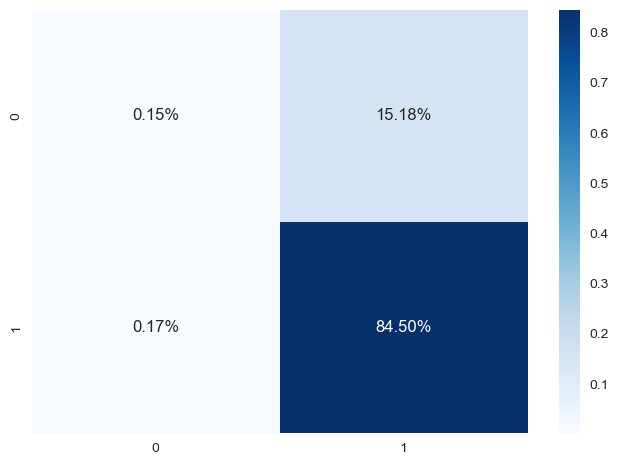

In [440]:
sns.heatmap(cf_matrix/np.sum(cf_matrix), annot=True, 
            fmt='.2%', cmap='Blues')

In [ ]:
## Zmiana parametrów nie dała poprawy

In [ ]:
## Krzywa uczenia - learning curve

Learning rate set to 0.016163
0:	learn: 0.6825122	total: 18.4ms	remaining: 18.4s
1:	learn: 0.6737685	total: 21.6ms	remaining: 10.8s
2:	learn: 0.6645372	total: 24.8ms	remaining: 8.24s
3:	learn: 0.6562841	total: 27.7ms	remaining: 6.91s
4:	learn: 0.6484385	total: 31.1ms	remaining: 6.19s
5:	learn: 0.6403563	total: 34.2ms	remaining: 5.66s
6:	learn: 0.6319461	total: 37.5ms	remaining: 5.32s
7:	learn: 0.6244460	total: 41ms	remaining: 5.08s
8:	learn: 0.6173525	total: 44.2ms	remaining: 4.87s
9:	learn: 0.6097778	total: 48ms	remaining: 4.75s
10:	learn: 0.6029009	total: 51.3ms	remaining: 4.61s
11:	learn: 0.5964384	total: 54.5ms	remaining: 4.49s
12:	learn: 0.5899042	total: 57.7ms	remaining: 4.38s
13:	learn: 0.5841224	total: 60.7ms	remaining: 4.28s
14:	learn: 0.5784064	total: 64ms	remaining: 4.2s
15:	learn: 0.5731305	total: 67.2ms	remaining: 4.13s
16:	learn: 0.5676963	total: 70.3ms	remaining: 4.07s
17:	learn: 0.5628626	total: 73.5ms	remaining: 4.01s
18:	learn: 0.5579648	total: 76.7ms	remaining: 3.96s

168:	learn: 0.4037055	total: 594ms	remaining: 2.92s
169:	learn: 0.4035908	total: 599ms	remaining: 2.92s
170:	learn: 0.4033522	total: 603ms	remaining: 2.92s
171:	learn: 0.4031631	total: 607ms	remaining: 2.92s
172:	learn: 0.4030507	total: 610ms	remaining: 2.92s
173:	learn: 0.4028375	total: 614ms	remaining: 2.91s
174:	learn: 0.4026694	total: 617ms	remaining: 2.91s
175:	learn: 0.4025826	total: 621ms	remaining: 2.91s
176:	learn: 0.4024230	total: 625ms	remaining: 2.9s
177:	learn: 0.4023236	total: 628ms	remaining: 2.9s
178:	learn: 0.4021954	total: 632ms	remaining: 2.9s
179:	learn: 0.4020555	total: 637ms	remaining: 2.9s
180:	learn: 0.4019159	total: 641ms	remaining: 2.9s
181:	learn: 0.4017980	total: 645ms	remaining: 2.9s
182:	learn: 0.4016166	total: 648ms	remaining: 2.89s
183:	learn: 0.4014109	total: 652ms	remaining: 2.89s
184:	learn: 0.4012528	total: 655ms	remaining: 2.89s
185:	learn: 0.4010615	total: 658ms	remaining: 2.88s
186:	learn: 0.4008478	total: 662ms	remaining: 2.88s
187:	learn: 0.4007

361:	learn: 0.3854828	total: 1.39s	remaining: 2.45s
362:	learn: 0.3854364	total: 1.39s	remaining: 2.45s
363:	learn: 0.3853828	total: 1.4s	remaining: 2.44s
364:	learn: 0.3853436	total: 1.4s	remaining: 2.44s
365:	learn: 0.3852920	total: 1.4s	remaining: 2.43s
366:	learn: 0.3852400	total: 1.41s	remaining: 2.43s
367:	learn: 0.3851481	total: 1.41s	remaining: 2.42s
368:	learn: 0.3850569	total: 1.42s	remaining: 2.42s
369:	learn: 0.3849651	total: 1.42s	remaining: 2.42s
370:	learn: 0.3849293	total: 1.42s	remaining: 2.41s
371:	learn: 0.3848529	total: 1.43s	remaining: 2.41s
372:	learn: 0.3847997	total: 1.43s	remaining: 2.4s
373:	learn: 0.3847235	total: 1.43s	remaining: 2.4s
374:	learn: 0.3846169	total: 1.44s	remaining: 2.39s
375:	learn: 0.3845570	total: 1.44s	remaining: 2.39s
376:	learn: 0.3845286	total: 1.44s	remaining: 2.39s
377:	learn: 0.3844710	total: 1.45s	remaining: 2.38s
378:	learn: 0.3844472	total: 1.45s	remaining: 2.38s
379:	learn: 0.3843742	total: 1.46s	remaining: 2.38s
380:	learn: 0.384

553:	learn: 0.3719220	total: 2.18s	remaining: 1.76s
554:	learn: 0.3718443	total: 2.19s	remaining: 1.75s
555:	learn: 0.3717828	total: 2.2s	remaining: 1.75s
556:	learn: 0.3716855	total: 2.2s	remaining: 1.75s
557:	learn: 0.3716312	total: 2.21s	remaining: 1.75s
558:	learn: 0.3715469	total: 2.21s	remaining: 1.75s
559:	learn: 0.3714463	total: 2.22s	remaining: 1.74s
560:	learn: 0.3713897	total: 2.22s	remaining: 1.74s
561:	learn: 0.3713510	total: 2.23s	remaining: 1.74s
562:	learn: 0.3712693	total: 2.23s	remaining: 1.73s
563:	learn: 0.3712200	total: 2.24s	remaining: 1.73s
564:	learn: 0.3711588	total: 2.24s	remaining: 1.73s
565:	learn: 0.3710478	total: 2.25s	remaining: 1.72s
566:	learn: 0.3710003	total: 2.25s	remaining: 1.72s
567:	learn: 0.3709444	total: 2.26s	remaining: 1.72s
568:	learn: 0.3708953	total: 2.26s	remaining: 1.71s
569:	learn: 0.3708346	total: 2.27s	remaining: 1.71s
570:	learn: 0.3707300	total: 2.27s	remaining: 1.71s
571:	learn: 0.3706733	total: 2.27s	remaining: 1.7s
572:	learn: 0.3

760:	learn: 0.3567854	total: 2.97s	remaining: 932ms
761:	learn: 0.3567486	total: 2.98s	remaining: 930ms
762:	learn: 0.3566462	total: 2.98s	remaining: 926ms
763:	learn: 0.3565561	total: 2.98s	remaining: 922ms
764:	learn: 0.3564797	total: 2.99s	remaining: 917ms
765:	learn: 0.3564296	total: 2.99s	remaining: 913ms
766:	learn: 0.3563476	total: 2.99s	remaining: 909ms
767:	learn: 0.3562896	total: 3s	remaining: 905ms
768:	learn: 0.3561962	total: 3s	remaining: 901ms
769:	learn: 0.3561388	total: 3s	remaining: 897ms
770:	learn: 0.3560774	total: 3.01s	remaining: 893ms
771:	learn: 0.3560090	total: 3.01s	remaining: 889ms
772:	learn: 0.3559470	total: 3.01s	remaining: 885ms
773:	learn: 0.3558922	total: 3.02s	remaining: 881ms
774:	learn: 0.3558548	total: 3.02s	remaining: 877ms
775:	learn: 0.3557507	total: 3.02s	remaining: 873ms
776:	learn: 0.3557012	total: 3.02s	remaining: 868ms
777:	learn: 0.3556447	total: 3.03s	remaining: 864ms
778:	learn: 0.3555717	total: 3.03s	remaining: 860ms
779:	learn: 0.3555261

950:	learn: 0.3450199	total: 3.76s	remaining: 194ms
951:	learn: 0.3449547	total: 3.76s	remaining: 190ms
952:	learn: 0.3448913	total: 3.77s	remaining: 186ms
953:	learn: 0.3448589	total: 3.77s	remaining: 182ms
954:	learn: 0.3447909	total: 3.77s	remaining: 178ms
955:	learn: 0.3447182	total: 3.78s	remaining: 174ms
956:	learn: 0.3446322	total: 3.78s	remaining: 170ms
957:	learn: 0.3445238	total: 3.79s	remaining: 166ms
958:	learn: 0.3444750	total: 3.79s	remaining: 162ms
959:	learn: 0.3444095	total: 3.79s	remaining: 158ms
960:	learn: 0.3443914	total: 3.8s	remaining: 154ms
961:	learn: 0.3443583	total: 3.8s	remaining: 150ms
962:	learn: 0.3442912	total: 3.81s	remaining: 146ms
963:	learn: 0.3442087	total: 3.81s	remaining: 142ms
964:	learn: 0.3441416	total: 3.81s	remaining: 138ms
965:	learn: 0.3440802	total: 3.82s	remaining: 134ms
966:	learn: 0.3440307	total: 3.82s	remaining: 130ms
967:	learn: 0.3439329	total: 3.82s	remaining: 126ms
968:	learn: 0.3438847	total: 3.83s	remaining: 122ms
969:	learn: 0.

146:	learn: 0.3838183	total: 594ms	remaining: 3.45s
147:	learn: 0.3837159	total: 600ms	remaining: 3.45s
148:	learn: 0.3835250	total: 604ms	remaining: 3.45s
149:	learn: 0.3834411	total: 608ms	remaining: 3.45s
150:	learn: 0.3832897	total: 612ms	remaining: 3.44s
151:	learn: 0.3831575	total: 616ms	remaining: 3.44s
152:	learn: 0.3830521	total: 620ms	remaining: 3.43s
153:	learn: 0.3829007	total: 625ms	remaining: 3.43s
154:	learn: 0.3828187	total: 628ms	remaining: 3.42s
155:	learn: 0.3827579	total: 632ms	remaining: 3.42s
156:	learn: 0.3825984	total: 636ms	remaining: 3.42s
157:	learn: 0.3825242	total: 640ms	remaining: 3.41s
158:	learn: 0.3824023	total: 644ms	remaining: 3.41s
159:	learn: 0.3823353	total: 650ms	remaining: 3.41s
160:	learn: 0.3822377	total: 656ms	remaining: 3.42s
161:	learn: 0.3821619	total: 660ms	remaining: 3.41s
162:	learn: 0.3820467	total: 664ms	remaining: 3.41s
163:	learn: 0.3818958	total: 668ms	remaining: 3.4s
164:	learn: 0.3817993	total: 672ms	remaining: 3.4s
165:	learn: 0.

330:	learn: 0.3706020	total: 1.39s	remaining: 2.8s
331:	learn: 0.3705520	total: 1.39s	remaining: 2.8s
332:	learn: 0.3705112	total: 1.39s	remaining: 2.79s
333:	learn: 0.3704836	total: 1.4s	remaining: 2.79s
334:	learn: 0.3704180	total: 1.4s	remaining: 2.78s
335:	learn: 0.3703548	total: 1.41s	remaining: 2.78s
336:	learn: 0.3703071	total: 1.41s	remaining: 2.77s
337:	learn: 0.3702541	total: 1.41s	remaining: 2.77s
338:	learn: 0.3701976	total: 1.42s	remaining: 2.77s
339:	learn: 0.3701582	total: 1.42s	remaining: 2.76s
340:	learn: 0.3700921	total: 1.43s	remaining: 2.76s
341:	learn: 0.3700368	total: 1.43s	remaining: 2.75s
342:	learn: 0.3699880	total: 1.43s	remaining: 2.75s
343:	learn: 0.3699142	total: 1.44s	remaining: 2.74s
344:	learn: 0.3698588	total: 1.44s	remaining: 2.74s
345:	learn: 0.3697938	total: 1.45s	remaining: 2.73s
346:	learn: 0.3697646	total: 1.45s	remaining: 2.73s
347:	learn: 0.3697006	total: 1.45s	remaining: 2.73s
348:	learn: 0.3696430	total: 1.46s	remaining: 2.72s
349:	learn: 0.36

515:	learn: 0.3599575	total: 2.18s	remaining: 2.05s
516:	learn: 0.3598897	total: 2.19s	remaining: 2.04s
517:	learn: 0.3598305	total: 2.19s	remaining: 2.04s
518:	learn: 0.3597907	total: 2.19s	remaining: 2.03s
519:	learn: 0.3597419	total: 2.2s	remaining: 2.03s
520:	learn: 0.3596931	total: 2.2s	remaining: 2.02s
521:	learn: 0.3596660	total: 2.21s	remaining: 2.02s
522:	learn: 0.3596103	total: 2.21s	remaining: 2.02s
523:	learn: 0.3595655	total: 2.21s	remaining: 2.01s
524:	learn: 0.3595000	total: 2.22s	remaining: 2.01s
525:	learn: 0.3594684	total: 2.22s	remaining: 2s
526:	learn: 0.3594274	total: 2.23s	remaining: 2s
527:	learn: 0.3593470	total: 2.23s	remaining: 1.99s
528:	learn: 0.3592726	total: 2.23s	remaining: 1.99s
529:	learn: 0.3592353	total: 2.24s	remaining: 1.99s
530:	learn: 0.3591668	total: 2.24s	remaining: 1.98s
531:	learn: 0.3591066	total: 2.25s	remaining: 1.98s
532:	learn: 0.3590798	total: 2.25s	remaining: 1.97s
533:	learn: 0.3590061	total: 2.25s	remaining: 1.97s
534:	learn: 0.358943

727:	learn: 0.3490964	total: 2.98s	remaining: 1.11s
728:	learn: 0.3490266	total: 2.98s	remaining: 1.11s
729:	learn: 0.3489925	total: 2.98s	remaining: 1.1s
730:	learn: 0.3489420	total: 2.99s	remaining: 1.1s
731:	learn: 0.3488959	total: 2.99s	remaining: 1.09s
732:	learn: 0.3488439	total: 3s	remaining: 1.09s
733:	learn: 0.3488092	total: 3s	remaining: 1.09s
734:	learn: 0.3487876	total: 3s	remaining: 1.08s
735:	learn: 0.3487506	total: 3.01s	remaining: 1.08s
736:	learn: 0.3487150	total: 3.01s	remaining: 1.07s
737:	learn: 0.3486635	total: 3.02s	remaining: 1.07s
738:	learn: 0.3486224	total: 3.02s	remaining: 1.07s
739:	learn: 0.3485645	total: 3.03s	remaining: 1.06s
740:	learn: 0.3485344	total: 3.03s	remaining: 1.06s
741:	learn: 0.3484844	total: 3.03s	remaining: 1.05s
742:	learn: 0.3484342	total: 3.04s	remaining: 1.05s
743:	learn: 0.3483859	total: 3.04s	remaining: 1.05s
744:	learn: 0.3483433	total: 3.04s	remaining: 1.04s
745:	learn: 0.3482855	total: 3.05s	remaining: 1.04s
746:	learn: 0.3482463	t

922:	learn: 0.3406503	total: 3.78s	remaining: 315ms
923:	learn: 0.3406089	total: 3.79s	remaining: 311ms
924:	learn: 0.3405834	total: 3.79s	remaining: 307ms
925:	learn: 0.3405576	total: 3.79s	remaining: 303ms
926:	learn: 0.3405274	total: 3.8s	remaining: 299ms
927:	learn: 0.3404994	total: 3.8s	remaining: 295ms
928:	learn: 0.3404577	total: 3.81s	remaining: 291ms
929:	learn: 0.3404026	total: 3.81s	remaining: 287ms
930:	learn: 0.3403370	total: 3.81s	remaining: 283ms
931:	learn: 0.3402998	total: 3.82s	remaining: 279ms
932:	learn: 0.3402503	total: 3.83s	remaining: 275ms
933:	learn: 0.3402088	total: 3.83s	remaining: 271ms
934:	learn: 0.3401568	total: 3.83s	remaining: 266ms
935:	learn: 0.3401081	total: 3.84s	remaining: 262ms
936:	learn: 0.3400637	total: 3.84s	remaining: 258ms
937:	learn: 0.3400088	total: 3.85s	remaining: 254ms
938:	learn: 0.3399763	total: 3.85s	remaining: 250ms
939:	learn: 0.3399314	total: 3.85s	remaining: 246ms
940:	learn: 0.3398878	total: 3.86s	remaining: 242ms
941:	learn: 0.

89:	learn: 0.3907602	total: 396ms	remaining: 4s
90:	learn: 0.3905290	total: 401ms	remaining: 4s
91:	learn: 0.3903486	total: 406ms	remaining: 4.01s
92:	learn: 0.3900572	total: 411ms	remaining: 4.01s
93:	learn: 0.3898932	total: 416ms	remaining: 4.01s
94:	learn: 0.3896992	total: 420ms	remaining: 4s
95:	learn: 0.3895429	total: 425ms	remaining: 4s
96:	learn: 0.3893669	total: 430ms	remaining: 4s
97:	learn: 0.3891865	total: 434ms	remaining: 4s
98:	learn: 0.3890160	total: 439ms	remaining: 3.99s
99:	learn: 0.3888508	total: 443ms	remaining: 3.98s
100:	learn: 0.3886581	total: 447ms	remaining: 3.98s
101:	learn: 0.3884623	total: 451ms	remaining: 3.97s
102:	learn: 0.3882788	total: 456ms	remaining: 3.97s
103:	learn: 0.3881473	total: 461ms	remaining: 3.97s
104:	learn: 0.3880193	total: 465ms	remaining: 3.96s
105:	learn: 0.3878792	total: 469ms	remaining: 3.95s
106:	learn: 0.3876529	total: 473ms	remaining: 3.95s
107:	learn: 0.3875168	total: 478ms	remaining: 3.94s
108:	learn: 0.3873910	total: 482ms	remain

266:	learn: 0.3754932	total: 1.19s	remaining: 3.27s
267:	learn: 0.3754317	total: 1.19s	remaining: 3.26s
268:	learn: 0.3753878	total: 1.2s	remaining: 3.26s
269:	learn: 0.3753265	total: 1.2s	remaining: 3.26s
270:	learn: 0.3752636	total: 1.21s	remaining: 3.25s
271:	learn: 0.3752270	total: 1.21s	remaining: 3.25s
272:	learn: 0.3751545	total: 1.22s	remaining: 3.25s
273:	learn: 0.3750808	total: 1.22s	remaining: 3.24s
274:	learn: 0.3750118	total: 1.23s	remaining: 3.24s
275:	learn: 0.3749633	total: 1.23s	remaining: 3.23s
276:	learn: 0.3749326	total: 1.24s	remaining: 3.23s
277:	learn: 0.3748660	total: 1.24s	remaining: 3.23s
278:	learn: 0.3748389	total: 1.25s	remaining: 3.22s
279:	learn: 0.3747674	total: 1.25s	remaining: 3.22s
280:	learn: 0.3746936	total: 1.25s	remaining: 3.21s
281:	learn: 0.3746646	total: 1.26s	remaining: 3.21s
282:	learn: 0.3746004	total: 1.26s	remaining: 3.2s
283:	learn: 0.3745571	total: 1.27s	remaining: 3.2s
284:	learn: 0.3745269	total: 1.27s	remaining: 3.19s
285:	learn: 0.37

438:	learn: 0.3665235	total: 1.99s	remaining: 2.54s
439:	learn: 0.3664723	total: 1.99s	remaining: 2.54s
440:	learn: 0.3664271	total: 2s	remaining: 2.53s
441:	learn: 0.3663686	total: 2s	remaining: 2.53s
442:	learn: 0.3663275	total: 2.01s	remaining: 2.52s
443:	learn: 0.3662795	total: 2.01s	remaining: 2.52s
444:	learn: 0.3662119	total: 2.02s	remaining: 2.51s
445:	learn: 0.3661551	total: 2.02s	remaining: 2.51s
446:	learn: 0.3661174	total: 2.03s	remaining: 2.51s
447:	learn: 0.3660697	total: 2.03s	remaining: 2.5s
448:	learn: 0.3660306	total: 2.04s	remaining: 2.5s
449:	learn: 0.3659955	total: 2.04s	remaining: 2.49s
450:	learn: 0.3659560	total: 2.04s	remaining: 2.49s
451:	learn: 0.3658941	total: 2.05s	remaining: 2.49s
452:	learn: 0.3658305	total: 2.06s	remaining: 2.48s
453:	learn: 0.3657788	total: 2.06s	remaining: 2.48s
454:	learn: 0.3657173	total: 2.06s	remaining: 2.47s
455:	learn: 0.3656702	total: 2.07s	remaining: 2.47s
456:	learn: 0.3656303	total: 2.08s	remaining: 2.47s
457:	learn: 0.365579

632:	learn: 0.3576885	total: 2.99s	remaining: 1.73s
633:	learn: 0.3576464	total: 3s	remaining: 1.73s
634:	learn: 0.3575995	total: 3s	remaining: 1.72s
635:	learn: 0.3575488	total: 3s	remaining: 1.72s
636:	learn: 0.3575120	total: 3.01s	remaining: 1.72s
637:	learn: 0.3574821	total: 3.02s	remaining: 1.71s
638:	learn: 0.3574470	total: 3.02s	remaining: 1.71s
639:	learn: 0.3574114	total: 3.03s	remaining: 1.7s
640:	learn: 0.3573709	total: 3.03s	remaining: 1.7s
641:	learn: 0.3573332	total: 3.04s	remaining: 1.69s
642:	learn: 0.3572902	total: 3.04s	remaining: 1.69s
643:	learn: 0.3572527	total: 3.05s	remaining: 1.69s
644:	learn: 0.3572283	total: 3.05s	remaining: 1.68s
645:	learn: 0.3571987	total: 3.06s	remaining: 1.68s
646:	learn: 0.3571687	total: 3.06s	remaining: 1.67s
647:	learn: 0.3571362	total: 3.07s	remaining: 1.67s
648:	learn: 0.3570976	total: 3.07s	remaining: 1.66s
649:	learn: 0.3570631	total: 3.08s	remaining: 1.66s
650:	learn: 0.3570252	total: 3.08s	remaining: 1.65s
651:	learn: 0.3569813	t

821:	learn: 0.3506267	total: 4s	remaining: 866ms
822:	learn: 0.3505973	total: 4.01s	remaining: 862ms
823:	learn: 0.3505760	total: 4.01s	remaining: 857ms
824:	learn: 0.3505421	total: 4.02s	remaining: 853ms
825:	learn: 0.3505203	total: 4.02s	remaining: 848ms
826:	learn: 0.3504817	total: 4.03s	remaining: 843ms
827:	learn: 0.3504406	total: 4.04s	remaining: 838ms
828:	learn: 0.3504105	total: 4.04s	remaining: 834ms
829:	learn: 0.3503933	total: 4.04s	remaining: 829ms
830:	learn: 0.3503510	total: 4.05s	remaining: 824ms
831:	learn: 0.3503127	total: 4.06s	remaining: 819ms
832:	learn: 0.3502939	total: 4.06s	remaining: 814ms
833:	learn: 0.3502552	total: 4.07s	remaining: 809ms
834:	learn: 0.3502291	total: 4.07s	remaining: 805ms
835:	learn: 0.3501871	total: 4.08s	remaining: 800ms
836:	learn: 0.3501588	total: 4.08s	remaining: 795ms
837:	learn: 0.3501236	total: 4.09s	remaining: 790ms
838:	learn: 0.3501078	total: 4.09s	remaining: 785ms
839:	learn: 0.3500649	total: 4.1s	remaining: 780ms
840:	learn: 0.35

Learning rate set to 0.029214
0:	learn: 0.6737019	total: 8.77ms	remaining: 8.77s
1:	learn: 0.6572509	total: 16.9ms	remaining: 8.43s
2:	learn: 0.6408885	total: 24.4ms	remaining: 8.1s
3:	learn: 0.6262641	total: 32.4ms	remaining: 8.06s
4:	learn: 0.6119433	total: 39.1ms	remaining: 7.77s
5:	learn: 0.5993981	total: 46.8ms	remaining: 7.75s
6:	learn: 0.5872762	total: 54.2ms	remaining: 7.69s
7:	learn: 0.5754281	total: 61.2ms	remaining: 7.59s
8:	learn: 0.5646116	total: 68.1ms	remaining: 7.5s
9:	learn: 0.5548410	total: 75.7ms	remaining: 7.49s
10:	learn: 0.5447190	total: 82.9ms	remaining: 7.46s
11:	learn: 0.5361260	total: 90.2ms	remaining: 7.42s
12:	learn: 0.5275122	total: 97.8ms	remaining: 7.42s
13:	learn: 0.5201993	total: 105ms	remaining: 7.43s
14:	learn: 0.5127428	total: 113ms	remaining: 7.44s
15:	learn: 0.5062259	total: 121ms	remaining: 7.47s
16:	learn: 0.4999012	total: 129ms	remaining: 7.46s
17:	learn: 0.4935390	total: 137ms	remaining: 7.47s
18:	learn: 0.4878937	total: 145ms	remaining: 7.47s


182:	learn: 0.3891198	total: 1.43s	remaining: 6.39s
183:	learn: 0.3890492	total: 1.44s	remaining: 6.39s
184:	learn: 0.3889805	total: 1.45s	remaining: 6.39s
185:	learn: 0.3889130	total: 1.46s	remaining: 6.38s
186:	learn: 0.3888501	total: 1.47s	remaining: 6.38s
187:	learn: 0.3888014	total: 1.48s	remaining: 6.38s
188:	learn: 0.3887593	total: 1.49s	remaining: 6.37s
189:	learn: 0.3886992	total: 1.49s	remaining: 6.36s
190:	learn: 0.3886651	total: 1.5s	remaining: 6.35s
191:	learn: 0.3886135	total: 1.51s	remaining: 6.34s
192:	learn: 0.3885850	total: 1.51s	remaining: 6.33s
193:	learn: 0.3885151	total: 1.52s	remaining: 6.33s
194:	learn: 0.3884461	total: 1.53s	remaining: 6.32s
195:	learn: 0.3883878	total: 1.54s	remaining: 6.31s
196:	learn: 0.3883413	total: 1.54s	remaining: 6.3s
197:	learn: 0.3882721	total: 1.55s	remaining: 6.29s
198:	learn: 0.3882325	total: 1.56s	remaining: 6.28s
199:	learn: 0.3881760	total: 1.57s	remaining: 6.27s
200:	learn: 0.3881143	total: 1.57s	remaining: 6.26s
201:	learn: 0.

359:	learn: 0.3805442	total: 2.89s	remaining: 5.14s
360:	learn: 0.3804907	total: 2.9s	remaining: 5.13s
361:	learn: 0.3804296	total: 2.91s	remaining: 5.13s
362:	learn: 0.3803799	total: 2.92s	remaining: 5.12s
363:	learn: 0.3803315	total: 2.93s	remaining: 5.12s
364:	learn: 0.3802766	total: 2.94s	remaining: 5.12s
365:	learn: 0.3802437	total: 2.95s	remaining: 5.11s
366:	learn: 0.3801931	total: 2.96s	remaining: 5.11s
367:	learn: 0.3801478	total: 2.97s	remaining: 5.1s
368:	learn: 0.3800928	total: 2.98s	remaining: 5.09s
369:	learn: 0.3800648	total: 2.99s	remaining: 5.09s
370:	learn: 0.3800161	total: 3s	remaining: 5.08s
371:	learn: 0.3799703	total: 3s	remaining: 5.07s
372:	learn: 0.3799198	total: 3.01s	remaining: 5.06s
373:	learn: 0.3798705	total: 3.02s	remaining: 5.06s
374:	learn: 0.3798329	total: 3.03s	remaining: 5.05s
375:	learn: 0.3797923	total: 3.04s	remaining: 5.04s
376:	learn: 0.3797538	total: 3.05s	remaining: 5.04s
377:	learn: 0.3797213	total: 3.05s	remaining: 5.03s
378:	learn: 0.379668

533:	learn: 0.3730187	total: 4.33s	remaining: 3.77s
534:	learn: 0.3729702	total: 4.33s	remaining: 3.77s
535:	learn: 0.3729370	total: 4.34s	remaining: 3.76s
536:	learn: 0.3728874	total: 4.35s	remaining: 3.75s
537:	learn: 0.3728563	total: 4.36s	remaining: 3.74s
538:	learn: 0.3728237	total: 4.37s	remaining: 3.73s
539:	learn: 0.3727892	total: 4.37s	remaining: 3.73s
540:	learn: 0.3727518	total: 4.38s	remaining: 3.72s
541:	learn: 0.3727075	total: 4.39s	remaining: 3.71s
542:	learn: 0.3726709	total: 4.4s	remaining: 3.7s
543:	learn: 0.3726392	total: 4.4s	remaining: 3.69s
544:	learn: 0.3726012	total: 4.41s	remaining: 3.68s
545:	learn: 0.3725665	total: 4.42s	remaining: 3.67s
546:	learn: 0.3725404	total: 4.43s	remaining: 3.67s
547:	learn: 0.3725084	total: 4.43s	remaining: 3.66s
548:	learn: 0.3724670	total: 4.44s	remaining: 3.65s
549:	learn: 0.3724261	total: 4.45s	remaining: 3.64s
550:	learn: 0.3724013	total: 4.46s	remaining: 3.63s
551:	learn: 0.3723649	total: 4.46s	remaining: 3.62s
552:	learn: 0.3

693:	learn: 0.3673234	total: 5.58s	remaining: 2.46s
694:	learn: 0.3672891	total: 5.58s	remaining: 2.45s
695:	learn: 0.3672579	total: 5.59s	remaining: 2.44s
696:	learn: 0.3672270	total: 5.6s	remaining: 2.43s
697:	learn: 0.3672047	total: 5.61s	remaining: 2.43s
698:	learn: 0.3671512	total: 5.62s	remaining: 2.42s
699:	learn: 0.3671157	total: 5.63s	remaining: 2.41s
700:	learn: 0.3670867	total: 5.64s	remaining: 2.4s
701:	learn: 0.3670670	total: 5.64s	remaining: 2.4s
702:	learn: 0.3670313	total: 5.65s	remaining: 2.39s
703:	learn: 0.3670052	total: 5.66s	remaining: 2.38s
704:	learn: 0.3669875	total: 5.67s	remaining: 2.37s
705:	learn: 0.3669550	total: 5.68s	remaining: 2.36s
706:	learn: 0.3669196	total: 5.68s	remaining: 2.35s
707:	learn: 0.3668802	total: 5.69s	remaining: 2.35s
708:	learn: 0.3668476	total: 5.7s	remaining: 2.34s
709:	learn: 0.3668100	total: 5.71s	remaining: 2.33s
710:	learn: 0.3667549	total: 5.72s	remaining: 2.32s
711:	learn: 0.3667340	total: 5.72s	remaining: 2.31s
712:	learn: 0.36

876:	learn: 0.3614180	total: 7.02s	remaining: 984ms
877:	learn: 0.3613992	total: 7.03s	remaining: 976ms
878:	learn: 0.3613581	total: 7.03s	remaining: 968ms
879:	learn: 0.3613100	total: 7.04s	remaining: 960ms
880:	learn: 0.3612728	total: 7.05s	remaining: 952ms
881:	learn: 0.3612511	total: 7.06s	remaining: 944ms
882:	learn: 0.3612302	total: 7.06s	remaining: 936ms
883:	learn: 0.3611866	total: 7.07s	remaining: 928ms
884:	learn: 0.3611615	total: 7.08s	remaining: 920ms
885:	learn: 0.3611349	total: 7.09s	remaining: 912ms
886:	learn: 0.3611076	total: 7.09s	remaining: 904ms
887:	learn: 0.3610820	total: 7.1s	remaining: 896ms
888:	learn: 0.3610328	total: 7.11s	remaining: 888ms
889:	learn: 0.3609950	total: 7.12s	remaining: 880ms
890:	learn: 0.3609709	total: 7.12s	remaining: 872ms
891:	learn: 0.3609422	total: 7.13s	remaining: 864ms
892:	learn: 0.3609204	total: 7.14s	remaining: 856ms
893:	learn: 0.3608703	total: 7.15s	remaining: 847ms
894:	learn: 0.3608272	total: 7.15s	remaining: 839ms
895:	learn: 0

51:	learn: 0.4124697	total: 415ms	remaining: 7.56s
52:	learn: 0.4118549	total: 423ms	remaining: 7.56s
53:	learn: 0.4111989	total: 431ms	remaining: 7.56s
54:	learn: 0.4107147	total: 439ms	remaining: 7.55s
55:	learn: 0.4101820	total: 448ms	remaining: 7.54s
56:	learn: 0.4095629	total: 455ms	remaining: 7.53s
57:	learn: 0.4091725	total: 464ms	remaining: 7.54s
58:	learn: 0.4086710	total: 472ms	remaining: 7.53s
59:	learn: 0.4083748	total: 481ms	remaining: 7.54s
60:	learn: 0.4078530	total: 491ms	remaining: 7.56s
61:	learn: 0.4074877	total: 499ms	remaining: 7.54s
62:	learn: 0.4069654	total: 507ms	remaining: 7.54s
63:	learn: 0.4066413	total: 515ms	remaining: 7.53s
64:	learn: 0.4063366	total: 523ms	remaining: 7.52s
65:	learn: 0.4058966	total: 531ms	remaining: 7.52s
66:	learn: 0.4055652	total: 539ms	remaining: 7.51s
67:	learn: 0.4052673	total: 546ms	remaining: 7.48s
68:	learn: 0.4049727	total: 554ms	remaining: 7.47s
69:	learn: 0.4046215	total: 560ms	remaining: 7.45s
70:	learn: 0.4043985	total: 568

234:	learn: 0.3908019	total: 1.85s	remaining: 6.03s
235:	learn: 0.3907691	total: 1.86s	remaining: 6.03s
236:	learn: 0.3907226	total: 1.87s	remaining: 6.02s
237:	learn: 0.3906676	total: 1.88s	remaining: 6.01s
238:	learn: 0.3906411	total: 1.89s	remaining: 6s
239:	learn: 0.3905992	total: 1.89s	remaining: 6s
240:	learn: 0.3905618	total: 1.9s	remaining: 5.99s
241:	learn: 0.3905195	total: 1.91s	remaining: 5.99s
242:	learn: 0.3904770	total: 1.92s	remaining: 5.98s
243:	learn: 0.3904569	total: 1.93s	remaining: 5.97s
244:	learn: 0.3904222	total: 1.94s	remaining: 5.97s
245:	learn: 0.3903953	total: 1.94s	remaining: 5.96s
246:	learn: 0.3903791	total: 1.95s	remaining: 5.95s
247:	learn: 0.3903538	total: 1.96s	remaining: 5.95s
248:	learn: 0.3903235	total: 1.97s	remaining: 5.94s
249:	learn: 0.3902851	total: 1.98s	remaining: 5.93s
250:	learn: 0.3902005	total: 1.99s	remaining: 5.93s
251:	learn: 0.3901487	total: 1.99s	remaining: 5.92s
252:	learn: 0.3901004	total: 2s	remaining: 5.91s
253:	learn: 0.3900740	

399:	learn: 0.3837025	total: 3.3s	remaining: 4.94s
400:	learn: 0.3836655	total: 3.3s	remaining: 4.94s
401:	learn: 0.3836353	total: 3.31s	remaining: 4.93s
402:	learn: 0.3835956	total: 3.32s	remaining: 4.92s
403:	learn: 0.3835629	total: 3.33s	remaining: 4.91s
404:	learn: 0.3835316	total: 3.34s	remaining: 4.9s
405:	learn: 0.3834747	total: 3.34s	remaining: 4.89s
406:	learn: 0.3834050	total: 3.35s	remaining: 4.88s
407:	learn: 0.3833650	total: 3.36s	remaining: 4.88s
408:	learn: 0.3833186	total: 3.37s	remaining: 4.87s
409:	learn: 0.3832897	total: 3.38s	remaining: 4.86s
410:	learn: 0.3832494	total: 3.39s	remaining: 4.86s
411:	learn: 0.3831985	total: 3.4s	remaining: 4.85s
412:	learn: 0.3831621	total: 3.41s	remaining: 4.84s
413:	learn: 0.3831179	total: 3.42s	remaining: 4.84s
414:	learn: 0.3830647	total: 3.43s	remaining: 4.83s
415:	learn: 0.3830226	total: 3.44s	remaining: 4.83s
416:	learn: 0.3829878	total: 3.45s	remaining: 4.82s
417:	learn: 0.3829446	total: 3.45s	remaining: 4.81s
418:	learn: 0.38

577:	learn: 0.3768604	total: 4.75s	remaining: 3.46s
578:	learn: 0.3768302	total: 4.75s	remaining: 3.46s
579:	learn: 0.3767987	total: 4.76s	remaining: 3.45s
580:	learn: 0.3767705	total: 4.77s	remaining: 3.44s
581:	learn: 0.3767450	total: 4.78s	remaining: 3.43s
582:	learn: 0.3767168	total: 4.79s	remaining: 3.42s
583:	learn: 0.3766887	total: 4.79s	remaining: 3.42s
584:	learn: 0.3766537	total: 4.8s	remaining: 3.41s
585:	learn: 0.3766175	total: 4.81s	remaining: 3.4s
586:	learn: 0.3765712	total: 4.82s	remaining: 3.39s
587:	learn: 0.3765427	total: 4.82s	remaining: 3.38s
588:	learn: 0.3765077	total: 4.83s	remaining: 3.37s
589:	learn: 0.3764718	total: 4.84s	remaining: 3.36s
590:	learn: 0.3764449	total: 4.85s	remaining: 3.35s
591:	learn: 0.3764000	total: 4.86s	remaining: 3.35s
592:	learn: 0.3763764	total: 4.86s	remaining: 3.34s
593:	learn: 0.3763468	total: 4.87s	remaining: 3.33s
594:	learn: 0.3763036	total: 4.88s	remaining: 3.32s
595:	learn: 0.3762813	total: 4.89s	remaining: 3.31s
596:	learn: 0.

743:	learn: 0.3715234	total: 6.42s	remaining: 2.21s
744:	learn: 0.3714887	total: 6.43s	remaining: 2.2s
745:	learn: 0.3714706	total: 6.44s	remaining: 2.19s
746:	learn: 0.3714504	total: 6.45s	remaining: 2.18s
747:	learn: 0.3714299	total: 6.46s	remaining: 2.17s
748:	learn: 0.3713993	total: 6.47s	remaining: 2.17s
749:	learn: 0.3713671	total: 6.47s	remaining: 2.16s
750:	learn: 0.3713294	total: 6.48s	remaining: 2.15s
751:	learn: 0.3712998	total: 6.49s	remaining: 2.14s
752:	learn: 0.3712782	total: 6.5s	remaining: 2.13s
753:	learn: 0.3712408	total: 6.51s	remaining: 2.12s
754:	learn: 0.3712145	total: 6.52s	remaining: 2.12s
755:	learn: 0.3711901	total: 6.53s	remaining: 2.11s
756:	learn: 0.3711612	total: 6.54s	remaining: 2.1s
757:	learn: 0.3711258	total: 6.55s	remaining: 2.09s
758:	learn: 0.3710979	total: 6.56s	remaining: 2.08s
759:	learn: 0.3710698	total: 6.57s	remaining: 2.07s
760:	learn: 0.3710417	total: 6.58s	remaining: 2.06s
761:	learn: 0.3710142	total: 6.59s	remaining: 2.06s
762:	learn: 0.3

907:	learn: 0.3670207	total: 8.3s	remaining: 841ms
908:	learn: 0.3669894	total: 8.32s	remaining: 833ms
909:	learn: 0.3669708	total: 8.33s	remaining: 824ms
910:	learn: 0.3669426	total: 8.36s	remaining: 816ms
911:	learn: 0.3669001	total: 8.37s	remaining: 808ms
912:	learn: 0.3668679	total: 8.38s	remaining: 799ms
913:	learn: 0.3668372	total: 8.39s	remaining: 790ms
914:	learn: 0.3668154	total: 8.4s	remaining: 781ms
915:	learn: 0.3667891	total: 8.42s	remaining: 772ms
916:	learn: 0.3667585	total: 8.43s	remaining: 763ms
917:	learn: 0.3667381	total: 8.44s	remaining: 754ms
918:	learn: 0.3667121	total: 8.46s	remaining: 746ms
919:	learn: 0.3666803	total: 8.47s	remaining: 737ms
920:	learn: 0.3666442	total: 8.48s	remaining: 728ms
921:	learn: 0.3665923	total: 8.49s	remaining: 718ms
922:	learn: 0.3665575	total: 8.5s	remaining: 709ms
923:	learn: 0.3665063	total: 8.51s	remaining: 700ms
924:	learn: 0.3664951	total: 8.52s	remaining: 691ms
925:	learn: 0.3664737	total: 8.53s	remaining: 681ms
926:	learn: 0.3

76:	learn: 0.3978792	total: 600ms	remaining: 7.19s
77:	learn: 0.3977197	total: 610ms	remaining: 7.21s
78:	learn: 0.3975526	total: 619ms	remaining: 7.22s
79:	learn: 0.3974009	total: 628ms	remaining: 7.22s
80:	learn: 0.3972434	total: 636ms	remaining: 7.22s
81:	learn: 0.3970382	total: 646ms	remaining: 7.23s
82:	learn: 0.3968894	total: 654ms	remaining: 7.23s
83:	learn: 0.3967504	total: 664ms	remaining: 7.24s
84:	learn: 0.3965869	total: 674ms	remaining: 7.25s
85:	learn: 0.3964397	total: 683ms	remaining: 7.26s
86:	learn: 0.3962717	total: 693ms	remaining: 7.28s
87:	learn: 0.3961193	total: 703ms	remaining: 7.29s
88:	learn: 0.3959566	total: 712ms	remaining: 7.29s
89:	learn: 0.3958635	total: 722ms	remaining: 7.3s
90:	learn: 0.3957521	total: 731ms	remaining: 7.3s
91:	learn: 0.3956485	total: 741ms	remaining: 7.32s
92:	learn: 0.3955363	total: 751ms	remaining: 7.33s
93:	learn: 0.3953256	total: 762ms	remaining: 7.34s
94:	learn: 0.3951971	total: 771ms	remaining: 7.35s
95:	learn: 0.3950075	total: 780ms

236:	learn: 0.3870228	total: 2.06s	remaining: 6.65s
237:	learn: 0.3869922	total: 2.07s	remaining: 6.64s
238:	learn: 0.3869683	total: 2.08s	remaining: 6.64s
239:	learn: 0.3869328	total: 2.1s	remaining: 6.64s
240:	learn: 0.3868913	total: 2.1s	remaining: 6.63s
241:	learn: 0.3868521	total: 2.12s	remaining: 6.63s
242:	learn: 0.3868045	total: 2.12s	remaining: 6.62s
243:	learn: 0.3867860	total: 2.13s	remaining: 6.61s
244:	learn: 0.3867531	total: 2.15s	remaining: 6.61s
245:	learn: 0.3867162	total: 2.15s	remaining: 6.6s
246:	learn: 0.3866887	total: 2.16s	remaining: 6.6s
247:	learn: 0.3866604	total: 2.17s	remaining: 6.59s
248:	learn: 0.3866098	total: 2.18s	remaining: 6.58s
249:	learn: 0.3865393	total: 2.19s	remaining: 6.58s
250:	learn: 0.3865072	total: 2.2s	remaining: 6.57s
251:	learn: 0.3864763	total: 2.21s	remaining: 6.56s
252:	learn: 0.3864492	total: 2.22s	remaining: 6.55s
253:	learn: 0.3864138	total: 2.23s	remaining: 6.54s
254:	learn: 0.3863871	total: 2.24s	remaining: 6.53s
255:	learn: 0.386

402:	learn: 0.3803018	total: 3.55s	remaining: 5.26s
403:	learn: 0.3802715	total: 3.56s	remaining: 5.25s
404:	learn: 0.3802414	total: 3.57s	remaining: 5.25s
405:	learn: 0.3802148	total: 3.58s	remaining: 5.24s
406:	learn: 0.3801584	total: 3.59s	remaining: 5.23s
407:	learn: 0.3801322	total: 3.6s	remaining: 5.23s
408:	learn: 0.3800946	total: 3.61s	remaining: 5.22s
409:	learn: 0.3800595	total: 3.62s	remaining: 5.21s
410:	learn: 0.3800145	total: 3.63s	remaining: 5.21s
411:	learn: 0.3799757	total: 3.64s	remaining: 5.2s
412:	learn: 0.3799204	total: 3.65s	remaining: 5.2s
413:	learn: 0.3798831	total: 3.67s	remaining: 5.19s
414:	learn: 0.3798477	total: 3.67s	remaining: 5.18s
415:	learn: 0.3798168	total: 3.69s	remaining: 5.17s
416:	learn: 0.3797771	total: 3.69s	remaining: 5.16s
417:	learn: 0.3797343	total: 3.7s	remaining: 5.16s
418:	learn: 0.3796812	total: 3.71s	remaining: 5.15s
419:	learn: 0.3796390	total: 3.72s	remaining: 5.14s
420:	learn: 0.3795957	total: 3.73s	remaining: 5.13s
421:	learn: 0.37

565:	learn: 0.3747357	total: 5.01s	remaining: 3.84s
566:	learn: 0.3747002	total: 5.01s	remaining: 3.83s
567:	learn: 0.3746714	total: 5.03s	remaining: 3.82s
568:	learn: 0.3746396	total: 5.04s	remaining: 3.81s
569:	learn: 0.3746006	total: 5.05s	remaining: 3.81s
570:	learn: 0.3745707	total: 5.06s	remaining: 3.8s
571:	learn: 0.3745334	total: 5.07s	remaining: 3.79s
572:	learn: 0.3744997	total: 5.08s	remaining: 3.78s
573:	learn: 0.3744714	total: 5.09s	remaining: 3.78s
574:	learn: 0.3744359	total: 5.1s	remaining: 3.77s
575:	learn: 0.3744017	total: 5.11s	remaining: 3.76s
576:	learn: 0.3743741	total: 5.12s	remaining: 3.75s
577:	learn: 0.3743475	total: 5.13s	remaining: 3.75s
578:	learn: 0.3743059	total: 5.14s	remaining: 3.74s
579:	learn: 0.3742589	total: 5.16s	remaining: 3.73s
580:	learn: 0.3742253	total: 5.16s	remaining: 3.72s
581:	learn: 0.3742025	total: 5.17s	remaining: 3.72s
582:	learn: 0.3741742	total: 5.18s	remaining: 3.71s
583:	learn: 0.3741216	total: 5.19s	remaining: 3.7s
584:	learn: 0.3

727:	learn: 0.3699224	total: 6.46s	remaining: 2.41s
728:	learn: 0.3698987	total: 6.47s	remaining: 2.4s
729:	learn: 0.3698638	total: 6.48s	remaining: 2.4s
730:	learn: 0.3698441	total: 6.49s	remaining: 2.39s
731:	learn: 0.3698117	total: 6.49s	remaining: 2.38s
732:	learn: 0.3697836	total: 6.5s	remaining: 2.37s
733:	learn: 0.3697690	total: 6.51s	remaining: 2.36s
734:	learn: 0.3697425	total: 6.52s	remaining: 2.35s
735:	learn: 0.3697125	total: 6.53s	remaining: 2.34s
736:	learn: 0.3696856	total: 6.53s	remaining: 2.33s
737:	learn: 0.3696528	total: 6.54s	remaining: 2.32s
738:	learn: 0.3696278	total: 6.55s	remaining: 2.31s
739:	learn: 0.3696055	total: 6.56s	remaining: 2.3s
740:	learn: 0.3695754	total: 6.57s	remaining: 2.29s
741:	learn: 0.3695733	total: 6.57s	remaining: 2.29s
742:	learn: 0.3695366	total: 6.59s	remaining: 2.28s
743:	learn: 0.3694937	total: 6.59s	remaining: 2.27s
744:	learn: 0.3694758	total: 6.61s	remaining: 2.26s
745:	learn: 0.3694431	total: 6.62s	remaining: 2.25s
746:	learn: 0.36

894:	learn: 0.3655966	total: 7.91s	remaining: 928ms
895:	learn: 0.3655770	total: 7.92s	remaining: 919ms
896:	learn: 0.3655517	total: 7.92s	remaining: 910ms
897:	learn: 0.3655259	total: 7.93s	remaining: 901ms
898:	learn: 0.3655026	total: 7.94s	remaining: 892ms
899:	learn: 0.3654848	total: 7.95s	remaining: 883ms
900:	learn: 0.3654589	total: 7.95s	remaining: 874ms
901:	learn: 0.3654413	total: 7.96s	remaining: 865ms
902:	learn: 0.3654146	total: 7.97s	remaining: 856ms
903:	learn: 0.3653916	total: 7.98s	remaining: 847ms
904:	learn: 0.3653752	total: 7.99s	remaining: 838ms
905:	learn: 0.3653488	total: 7.99s	remaining: 829ms
906:	learn: 0.3653063	total: 8s	remaining: 820ms
907:	learn: 0.3652934	total: 8.01s	remaining: 812ms
908:	learn: 0.3652545	total: 8.02s	remaining: 803ms
909:	learn: 0.3652343	total: 8.03s	remaining: 794ms
910:	learn: 0.3652072	total: 8.04s	remaining: 785ms
911:	learn: 0.3651762	total: 8.05s	remaining: 776ms
912:	learn: 0.3651645	total: 8.06s	remaining: 768ms
913:	learn: 0.3

57:	learn: 0.4006389	total: 635ms	remaining: 10.3s
58:	learn: 0.4003577	total: 645ms	remaining: 10.3s
59:	learn: 0.3999125	total: 654ms	remaining: 10.2s
60:	learn: 0.3995928	total: 662ms	remaining: 10.2s
61:	learn: 0.3993536	total: 671ms	remaining: 10.1s
62:	learn: 0.3988969	total: 679ms	remaining: 10.1s
63:	learn: 0.3986889	total: 688ms	remaining: 10.1s
64:	learn: 0.3983428	total: 699ms	remaining: 10s
65:	learn: 0.3980903	total: 707ms	remaining: 10s
66:	learn: 0.3977753	total: 715ms	remaining: 9.96s
67:	learn: 0.3974203	total: 725ms	remaining: 9.93s
68:	learn: 0.3971642	total: 734ms	remaining: 9.9s
69:	learn: 0.3969639	total: 742ms	remaining: 9.86s
70:	learn: 0.3967042	total: 750ms	remaining: 9.82s
71:	learn: 0.3965180	total: 758ms	remaining: 9.77s
72:	learn: 0.3963961	total: 767ms	remaining: 9.74s
73:	learn: 0.3962182	total: 776ms	remaining: 9.71s
74:	learn: 0.3960497	total: 785ms	remaining: 9.68s
75:	learn: 0.3958771	total: 792ms	remaining: 9.63s
76:	learn: 0.3957099	total: 802ms	re

219:	learn: 0.3864868	total: 2.5s	remaining: 8.88s
220:	learn: 0.3864655	total: 2.51s	remaining: 8.86s
221:	learn: 0.3864387	total: 2.52s	remaining: 8.85s
222:	learn: 0.3864021	total: 2.53s	remaining: 8.83s
223:	learn: 0.3863619	total: 2.54s	remaining: 8.81s
224:	learn: 0.3863320	total: 2.55s	remaining: 8.79s
225:	learn: 0.3862971	total: 2.56s	remaining: 8.78s
226:	learn: 0.3862729	total: 2.57s	remaining: 8.76s
227:	learn: 0.3862299	total: 2.58s	remaining: 8.75s
228:	learn: 0.3862080	total: 2.59s	remaining: 8.74s
229:	learn: 0.3861628	total: 2.6s	remaining: 8.72s
230:	learn: 0.3861105	total: 2.61s	remaining: 8.7s
231:	learn: 0.3860509	total: 2.63s	remaining: 8.69s
232:	learn: 0.3860022	total: 2.63s	remaining: 8.68s
233:	learn: 0.3859679	total: 2.65s	remaining: 8.66s
234:	learn: 0.3859322	total: 2.66s	remaining: 8.65s
235:	learn: 0.3859098	total: 2.67s	remaining: 8.64s
236:	learn: 0.3858483	total: 2.69s	remaining: 8.64s
237:	learn: 0.3858223	total: 2.71s	remaining: 8.66s
238:	learn: 0.3

386:	learn: 0.3799130	total: 4.38s	remaining: 6.95s
387:	learn: 0.3798469	total: 4.39s	remaining: 6.93s
388:	learn: 0.3798268	total: 4.4s	remaining: 6.92s
389:	learn: 0.3797945	total: 4.41s	remaining: 6.9s
390:	learn: 0.3797534	total: 4.42s	remaining: 6.88s
391:	learn: 0.3797242	total: 4.43s	remaining: 6.87s
392:	learn: 0.3796965	total: 4.43s	remaining: 6.85s
393:	learn: 0.3796703	total: 4.44s	remaining: 6.83s
394:	learn: 0.3796425	total: 4.45s	remaining: 6.82s
395:	learn: 0.3796065	total: 4.46s	remaining: 6.8s
396:	learn: 0.3795751	total: 4.47s	remaining: 6.79s
397:	learn: 0.3795428	total: 4.48s	remaining: 6.77s
398:	learn: 0.3795046	total: 4.49s	remaining: 6.76s
399:	learn: 0.3794834	total: 4.5s	remaining: 6.74s
400:	learn: 0.3794432	total: 4.5s	remaining: 6.73s
401:	learn: 0.3794069	total: 4.51s	remaining: 6.72s
402:	learn: 0.3793812	total: 4.52s	remaining: 6.7s
403:	learn: 0.3793526	total: 4.53s	remaining: 6.68s
404:	learn: 0.3792926	total: 4.54s	remaining: 6.67s
405:	learn: 0.3792

554:	learn: 0.3743715	total: 6.04s	remaining: 4.84s
555:	learn: 0.3743486	total: 6.05s	remaining: 4.83s
556:	learn: 0.3743188	total: 6.05s	remaining: 4.82s
557:	learn: 0.3742888	total: 6.06s	remaining: 4.8s
558:	learn: 0.3742643	total: 6.07s	remaining: 4.79s
559:	learn: 0.3742300	total: 6.08s	remaining: 4.78s
560:	learn: 0.3742257	total: 6.09s	remaining: 4.76s
561:	learn: 0.3741994	total: 6.09s	remaining: 4.75s
562:	learn: 0.3741776	total: 6.1s	remaining: 4.74s
563:	learn: 0.3741490	total: 6.11s	remaining: 4.72s
564:	learn: 0.3741247	total: 6.12s	remaining: 4.71s
565:	learn: 0.3741001	total: 6.13s	remaining: 4.7s
566:	learn: 0.3740782	total: 6.13s	remaining: 4.68s
567:	learn: 0.3740366	total: 6.14s	remaining: 4.67s
568:	learn: 0.3740136	total: 6.15s	remaining: 4.66s
569:	learn: 0.3739913	total: 6.16s	remaining: 4.65s
570:	learn: 0.3739776	total: 6.17s	remaining: 4.63s
571:	learn: 0.3739454	total: 6.18s	remaining: 4.62s
572:	learn: 0.3739266	total: 6.18s	remaining: 4.61s
573:	learn: 0.3

716:	learn: 0.3699535	total: 7.5s	remaining: 2.96s
717:	learn: 0.3699311	total: 7.52s	remaining: 2.95s
718:	learn: 0.3699166	total: 7.53s	remaining: 2.94s
719:	learn: 0.3698860	total: 7.53s	remaining: 2.93s
720:	learn: 0.3698720	total: 7.54s	remaining: 2.92s
721:	learn: 0.3698468	total: 7.55s	remaining: 2.91s
722:	learn: 0.3698120	total: 7.56s	remaining: 2.9s
723:	learn: 0.3697780	total: 7.57s	remaining: 2.89s
724:	learn: 0.3697547	total: 7.58s	remaining: 2.88s
725:	learn: 0.3697278	total: 7.59s	remaining: 2.87s
726:	learn: 0.3697031	total: 7.61s	remaining: 2.85s
727:	learn: 0.3696913	total: 7.62s	remaining: 2.85s
728:	learn: 0.3696500	total: 7.63s	remaining: 2.84s
729:	learn: 0.3696199	total: 7.64s	remaining: 2.83s
730:	learn: 0.3695933	total: 7.65s	remaining: 2.81s
731:	learn: 0.3695595	total: 7.66s	remaining: 2.8s
732:	learn: 0.3695398	total: 7.67s	remaining: 2.79s
733:	learn: 0.3695039	total: 7.68s	remaining: 2.78s
734:	learn: 0.3694842	total: 7.68s	remaining: 2.77s
735:	learn: 0.3

880:	learn: 0.3657757	total: 8.95s	remaining: 1.21s
881:	learn: 0.3657498	total: 8.96s	remaining: 1.2s
882:	learn: 0.3657315	total: 8.97s	remaining: 1.19s
883:	learn: 0.3657077	total: 8.98s	remaining: 1.18s
884:	learn: 0.3656625	total: 8.99s	remaining: 1.17s
885:	learn: 0.3656369	total: 9s	remaining: 1.16s
886:	learn: 0.3656189	total: 9s	remaining: 1.15s
887:	learn: 0.3655894	total: 9.01s	remaining: 1.14s
888:	learn: 0.3655671	total: 9.02s	remaining: 1.13s
889:	learn: 0.3655352	total: 9.03s	remaining: 1.12s
890:	learn: 0.3655054	total: 9.04s	remaining: 1.1s
891:	learn: 0.3654744	total: 9.05s	remaining: 1.09s
892:	learn: 0.3654429	total: 9.06s	remaining: 1.08s
893:	learn: 0.3654249	total: 9.06s	remaining: 1.07s
894:	learn: 0.3653972	total: 9.07s	remaining: 1.06s
895:	learn: 0.3653581	total: 9.09s	remaining: 1.05s
896:	learn: 0.3653247	total: 9.1s	remaining: 1.04s
897:	learn: 0.3652872	total: 9.11s	remaining: 1.03s
898:	learn: 0.3652609	total: 9.13s	remaining: 1.02s
899:	learn: 0.3652386

40:	learn: 0.4098024	total: 414ms	remaining: 9.69s
41:	learn: 0.4090390	total: 423ms	remaining: 9.64s
42:	learn: 0.4084124	total: 432ms	remaining: 9.62s
43:	learn: 0.4078401	total: 443ms	remaining: 9.62s
44:	learn: 0.4070477	total: 452ms	remaining: 9.58s
45:	learn: 0.4063994	total: 463ms	remaining: 9.6s
46:	learn: 0.4056432	total: 473ms	remaining: 9.58s
47:	learn: 0.4049661	total: 481ms	remaining: 9.54s
48:	learn: 0.4044024	total: 490ms	remaining: 9.51s
49:	learn: 0.4038476	total: 498ms	remaining: 9.47s
50:	learn: 0.4033543	total: 507ms	remaining: 9.44s
51:	learn: 0.4028378	total: 516ms	remaining: 9.4s
52:	learn: 0.4022929	total: 524ms	remaining: 9.37s
53:	learn: 0.4018864	total: 533ms	remaining: 9.34s
54:	learn: 0.4015399	total: 542ms	remaining: 9.32s
55:	learn: 0.4012328	total: 551ms	remaining: 9.29s
56:	learn: 0.4009457	total: 561ms	remaining: 9.28s
57:	learn: 0.4006198	total: 569ms	remaining: 9.24s
58:	learn: 0.4002478	total: 578ms	remaining: 9.21s
59:	learn: 0.3999436	total: 585ms

207:	learn: 0.3879972	total: 2.08s	remaining: 7.94s
208:	learn: 0.3879705	total: 2.09s	remaining: 7.92s
209:	learn: 0.3879462	total: 2.1s	remaining: 7.91s
210:	learn: 0.3879081	total: 2.11s	remaining: 7.9s
211:	learn: 0.3878801	total: 2.13s	remaining: 7.9s
212:	learn: 0.3878505	total: 2.14s	remaining: 7.89s
213:	learn: 0.3878000	total: 2.15s	remaining: 7.88s
214:	learn: 0.3877730	total: 2.15s	remaining: 7.87s
215:	learn: 0.3877383	total: 2.16s	remaining: 7.85s
216:	learn: 0.3877007	total: 2.17s	remaining: 7.84s
217:	learn: 0.3876559	total: 2.18s	remaining: 7.82s
218:	learn: 0.3876258	total: 2.19s	remaining: 7.81s
219:	learn: 0.3875879	total: 2.2s	remaining: 7.8s
220:	learn: 0.3875668	total: 2.21s	remaining: 7.78s
221:	learn: 0.3875329	total: 2.22s	remaining: 7.77s
222:	learn: 0.3875018	total: 2.22s	remaining: 7.75s
223:	learn: 0.3874560	total: 2.23s	remaining: 7.73s
224:	learn: 0.3874174	total: 2.24s	remaining: 7.72s
225:	learn: 0.3873777	total: 2.25s	remaining: 7.71s
226:	learn: 0.387

367:	learn: 0.3822727	total: 4.04s	remaining: 6.94s
368:	learn: 0.3822424	total: 4.05s	remaining: 6.93s
369:	learn: 0.3821860	total: 4.07s	remaining: 6.92s
370:	learn: 0.3821460	total: 4.08s	remaining: 6.91s
371:	learn: 0.3821061	total: 4.09s	remaining: 6.9s
372:	learn: 0.3820601	total: 4.1s	remaining: 6.89s
373:	learn: 0.3820321	total: 4.11s	remaining: 6.88s
374:	learn: 0.3820026	total: 4.12s	remaining: 6.87s
375:	learn: 0.3819635	total: 4.13s	remaining: 6.86s
376:	learn: 0.3819221	total: 4.14s	remaining: 6.85s
377:	learn: 0.3818935	total: 4.16s	remaining: 6.84s
378:	learn: 0.3818531	total: 4.17s	remaining: 6.83s
379:	learn: 0.3818390	total: 4.18s	remaining: 6.82s
380:	learn: 0.3818023	total: 4.19s	remaining: 6.81s
381:	learn: 0.3817580	total: 4.2s	remaining: 6.8s
382:	learn: 0.3817310	total: 4.21s	remaining: 6.79s
383:	learn: 0.3817069	total: 4.23s	remaining: 6.78s
384:	learn: 0.3816666	total: 4.24s	remaining: 6.77s
385:	learn: 0.3816261	total: 4.25s	remaining: 6.76s
386:	learn: 0.38

535:	learn: 0.3773113	total: 5.94s	remaining: 5.14s
536:	learn: 0.3772786	total: 5.95s	remaining: 5.13s
537:	learn: 0.3772564	total: 5.96s	remaining: 5.12s
538:	learn: 0.3772437	total: 5.98s	remaining: 5.12s
539:	learn: 0.3772104	total: 5.99s	remaining: 5.1s
540:	learn: 0.3771785	total: 6s	remaining: 5.09s
541:	learn: 0.3771437	total: 6.01s	remaining: 5.08s
542:	learn: 0.3770967	total: 6.02s	remaining: 5.07s
543:	learn: 0.3770672	total: 6.03s	remaining: 5.05s
544:	learn: 0.3770422	total: 6.05s	remaining: 5.05s
545:	learn: 0.3770230	total: 6.06s	remaining: 5.04s
546:	learn: 0.3769906	total: 6.07s	remaining: 5.03s
547:	learn: 0.3769520	total: 6.08s	remaining: 5.01s
548:	learn: 0.3769147	total: 6.09s	remaining: 5s
549:	learn: 0.3769079	total: 6.1s	remaining: 4.99s
550:	learn: 0.3768847	total: 6.11s	remaining: 4.98s
551:	learn: 0.3768635	total: 6.13s	remaining: 4.97s
552:	learn: 0.3768382	total: 6.14s	remaining: 4.96s
553:	learn: 0.3768124	total: 6.16s	remaining: 4.96s
554:	learn: 0.376792

701:	learn: 0.3730150	total: 7.83s	remaining: 3.32s
702:	learn: 0.3729669	total: 7.84s	remaining: 3.31s
703:	learn: 0.3729395	total: 7.85s	remaining: 3.3s
704:	learn: 0.3729190	total: 7.86s	remaining: 3.29s
705:	learn: 0.3729038	total: 7.88s	remaining: 3.28s
706:	learn: 0.3728789	total: 7.89s	remaining: 3.27s
707:	learn: 0.3728550	total: 7.9s	remaining: 3.26s
708:	learn: 0.3728360	total: 7.91s	remaining: 3.25s
709:	learn: 0.3728128	total: 7.92s	remaining: 3.23s
710:	learn: 0.3727859	total: 7.93s	remaining: 3.22s
711:	learn: 0.3727609	total: 7.94s	remaining: 3.21s
712:	learn: 0.3727398	total: 7.95s	remaining: 3.2s
713:	learn: 0.3727120	total: 7.96s	remaining: 3.19s
714:	learn: 0.3727016	total: 7.97s	remaining: 3.18s
715:	learn: 0.3726789	total: 7.98s	remaining: 3.17s
716:	learn: 0.3726528	total: 7.99s	remaining: 3.15s
717:	learn: 0.3726394	total: 8s	remaining: 3.14s
718:	learn: 0.3726208	total: 8.01s	remaining: 3.13s
719:	learn: 0.3725986	total: 8.02s	remaining: 3.12s
720:	learn: 0.3725

868:	learn: 0.3691139	total: 9.51s	remaining: 1.43s
869:	learn: 0.3690983	total: 9.52s	remaining: 1.42s
870:	learn: 0.3690779	total: 9.53s	remaining: 1.41s
871:	learn: 0.3690659	total: 9.54s	remaining: 1.4s
872:	learn: 0.3690439	total: 9.55s	remaining: 1.39s
873:	learn: 0.3690277	total: 9.56s	remaining: 1.38s
874:	learn: 0.3690110	total: 9.57s	remaining: 1.37s
875:	learn: 0.3689934	total: 9.58s	remaining: 1.36s
876:	learn: 0.3689710	total: 9.59s	remaining: 1.34s
877:	learn: 0.3689451	total: 9.6s	remaining: 1.33s
878:	learn: 0.3689166	total: 9.61s	remaining: 1.32s
879:	learn: 0.3688980	total: 9.62s	remaining: 1.31s
880:	learn: 0.3688774	total: 9.63s	remaining: 1.3s
881:	learn: 0.3688570	total: 9.63s	remaining: 1.29s
882:	learn: 0.3688344	total: 9.64s	remaining: 1.28s
883:	learn: 0.3688201	total: 9.65s	remaining: 1.27s
884:	learn: 0.3688026	total: 9.66s	remaining: 1.25s
885:	learn: 0.3687802	total: 9.67s	remaining: 1.24s
886:	learn: 0.3687653	total: 9.68s	remaining: 1.23s
887:	learn: 0.3

42:	learn: 0.4070451	total: 405ms	remaining: 9.01s
43:	learn: 0.4064585	total: 414ms	remaining: 9s
44:	learn: 0.4056764	total: 425ms	remaining: 9.01s
45:	learn: 0.4052359	total: 435ms	remaining: 9.02s
46:	learn: 0.4047151	total: 446ms	remaining: 9.05s
47:	learn: 0.4042420	total: 454ms	remaining: 9.01s
48:	learn: 0.4037369	total: 463ms	remaining: 8.98s
49:	learn: 0.4034250	total: 472ms	remaining: 8.97s
50:	learn: 0.4029709	total: 481ms	remaining: 8.96s
51:	learn: 0.4026425	total: 489ms	remaining: 8.92s
52:	learn: 0.4022421	total: 497ms	remaining: 8.88s
53:	learn: 0.4019034	total: 505ms	remaining: 8.84s
54:	learn: 0.4015631	total: 513ms	remaining: 8.82s
55:	learn: 0.4013010	total: 521ms	remaining: 8.79s
56:	learn: 0.4010575	total: 530ms	remaining: 8.77s
57:	learn: 0.4008285	total: 539ms	remaining: 8.76s
58:	learn: 0.4005738	total: 548ms	remaining: 8.73s
59:	learn: 0.4002654	total: 557ms	remaining: 8.72s
60:	learn: 0.3999730	total: 565ms	remaining: 8.69s
61:	learn: 0.3997672	total: 572ms	

214:	learn: 0.3887731	total: 2.52s	remaining: 9.18s
215:	learn: 0.3887417	total: 2.53s	remaining: 9.18s
216:	learn: 0.3887145	total: 2.54s	remaining: 9.17s
217:	learn: 0.3887008	total: 2.56s	remaining: 9.17s
218:	learn: 0.3886723	total: 2.57s	remaining: 9.16s
219:	learn: 0.3886352	total: 2.58s	remaining: 9.14s
220:	learn: 0.3886086	total: 2.59s	remaining: 9.13s
221:	learn: 0.3885577	total: 2.61s	remaining: 9.14s
222:	learn: 0.3884979	total: 2.63s	remaining: 9.15s
223:	learn: 0.3884501	total: 2.65s	remaining: 9.17s
224:	learn: 0.3884294	total: 2.66s	remaining: 9.16s
225:	learn: 0.3883745	total: 2.68s	remaining: 9.19s
226:	learn: 0.3883296	total: 2.7s	remaining: 9.21s
227:	learn: 0.3882895	total: 2.73s	remaining: 9.23s
228:	learn: 0.3882566	total: 2.74s	remaining: 9.24s
229:	learn: 0.3882283	total: 2.76s	remaining: 9.24s
230:	learn: 0.3881877	total: 2.77s	remaining: 9.24s
231:	learn: 0.3881449	total: 2.79s	remaining: 9.24s
232:	learn: 0.3880984	total: 2.8s	remaining: 9.23s
233:	learn: 0.

382:	learn: 0.3830093	total: 4.65s	remaining: 7.49s
383:	learn: 0.3829829	total: 4.66s	remaining: 7.48s
384:	learn: 0.3829528	total: 4.68s	remaining: 7.47s
385:	learn: 0.3829211	total: 4.69s	remaining: 7.46s
386:	learn: 0.3829006	total: 4.7s	remaining: 7.45s
387:	learn: 0.3828653	total: 4.71s	remaining: 7.44s
388:	learn: 0.3828394	total: 4.73s	remaining: 7.44s
389:	learn: 0.3828071	total: 4.75s	remaining: 7.42s
390:	learn: 0.3827842	total: 4.76s	remaining: 7.41s
391:	learn: 0.3827742	total: 4.77s	remaining: 7.4s
392:	learn: 0.3827458	total: 4.78s	remaining: 7.38s
393:	learn: 0.3827130	total: 4.79s	remaining: 7.37s
394:	learn: 0.3826655	total: 4.8s	remaining: 7.35s
395:	learn: 0.3826372	total: 4.81s	remaining: 7.34s
396:	learn: 0.3826162	total: 4.82s	remaining: 7.33s
397:	learn: 0.3825880	total: 4.83s	remaining: 7.31s
398:	learn: 0.3825546	total: 4.85s	remaining: 7.31s
399:	learn: 0.3825067	total: 4.87s	remaining: 7.31s
400:	learn: 0.3824836	total: 4.88s	remaining: 7.29s
401:	learn: 0.3

556:	learn: 0.3782610	total: 6.33s	remaining: 5.03s
557:	learn: 0.3782166	total: 6.34s	remaining: 5.02s
558:	learn: 0.3782015	total: 6.35s	remaining: 5.01s
559:	learn: 0.3781800	total: 6.36s	remaining: 4.99s
560:	learn: 0.3781517	total: 6.37s	remaining: 4.98s
561:	learn: 0.3781293	total: 6.37s	remaining: 4.97s
562:	learn: 0.3781080	total: 6.38s	remaining: 4.96s
563:	learn: 0.3780944	total: 6.39s	remaining: 4.94s
564:	learn: 0.3780706	total: 6.4s	remaining: 4.93s
565:	learn: 0.3780542	total: 6.41s	remaining: 4.92s
566:	learn: 0.3780376	total: 6.42s	remaining: 4.9s
567:	learn: 0.3780188	total: 6.43s	remaining: 4.89s
568:	learn: 0.3780095	total: 6.44s	remaining: 4.88s
569:	learn: 0.3779885	total: 6.45s	remaining: 4.86s
570:	learn: 0.3779746	total: 6.45s	remaining: 4.85s
571:	learn: 0.3779238	total: 6.46s	remaining: 4.83s
572:	learn: 0.3779071	total: 6.47s	remaining: 4.82s
573:	learn: 0.3778813	total: 6.48s	remaining: 4.81s
574:	learn: 0.3778451	total: 6.49s	remaining: 4.79s
575:	learn: 0.

729:	learn: 0.3741707	total: 8.01s	remaining: 2.96s
730:	learn: 0.3741419	total: 8.02s	remaining: 2.95s
731:	learn: 0.3741264	total: 8.03s	remaining: 2.94s
732:	learn: 0.3741095	total: 8.04s	remaining: 2.93s
733:	learn: 0.3740850	total: 8.04s	remaining: 2.92s
734:	learn: 0.3740625	total: 8.06s	remaining: 2.9s
735:	learn: 0.3740357	total: 8.06s	remaining: 2.89s
736:	learn: 0.3740054	total: 8.07s	remaining: 2.88s
737:	learn: 0.3739808	total: 8.09s	remaining: 2.87s
738:	learn: 0.3739638	total: 8.09s	remaining: 2.86s
739:	learn: 0.3739458	total: 8.1s	remaining: 2.85s
740:	learn: 0.3739228	total: 8.11s	remaining: 2.83s
741:	learn: 0.3738967	total: 8.12s	remaining: 2.82s
742:	learn: 0.3738756	total: 8.13s	remaining: 2.81s
743:	learn: 0.3738549	total: 8.15s	remaining: 2.8s
744:	learn: 0.3738350	total: 8.15s	remaining: 2.79s
745:	learn: 0.3738287	total: 8.16s	remaining: 2.78s
746:	learn: 0.3738069	total: 8.17s	remaining: 2.77s
747:	learn: 0.3737807	total: 8.18s	remaining: 2.76s
748:	learn: 0.3

891:	learn: 0.3706385	total: 9.47s	remaining: 1.15s
892:	learn: 0.3706177	total: 9.48s	remaining: 1.14s
893:	learn: 0.3705938	total: 9.49s	remaining: 1.13s
894:	learn: 0.3705645	total: 9.5s	remaining: 1.11s
895:	learn: 0.3705429	total: 9.51s	remaining: 1.1s
896:	learn: 0.3705208	total: 9.52s	remaining: 1.09s
897:	learn: 0.3705006	total: 9.53s	remaining: 1.08s
898:	learn: 0.3704784	total: 9.54s	remaining: 1.07s
899:	learn: 0.3704533	total: 9.55s	remaining: 1.06s
900:	learn: 0.3704386	total: 9.56s	remaining: 1.05s
901:	learn: 0.3704340	total: 9.56s	remaining: 1.04s
902:	learn: 0.3704218	total: 9.57s	remaining: 1.03s
903:	learn: 0.3703942	total: 9.58s	remaining: 1.02s
904:	learn: 0.3703722	total: 9.59s	remaining: 1.01s
905:	learn: 0.3703578	total: 9.6s	remaining: 996ms
906:	learn: 0.3703312	total: 9.61s	remaining: 985ms
907:	learn: 0.3703222	total: 9.62s	remaining: 974ms
908:	learn: 0.3703052	total: 9.62s	remaining: 964ms
909:	learn: 0.3702790	total: 9.63s	remaining: 953ms
910:	learn: 0.3

68:	learn: 0.3957026	total: 619ms	remaining: 8.35s
69:	learn: 0.3955781	total: 629ms	remaining: 8.36s
70:	learn: 0.3953928	total: 639ms	remaining: 8.36s
71:	learn: 0.3952769	total: 649ms	remaining: 8.37s
72:	learn: 0.3951292	total: 658ms	remaining: 8.35s
73:	learn: 0.3950036	total: 670ms	remaining: 8.38s
74:	learn: 0.3948986	total: 678ms	remaining: 8.36s
75:	learn: 0.3946873	total: 688ms	remaining: 8.36s
76:	learn: 0.3945787	total: 697ms	remaining: 8.35s
77:	learn: 0.3944912	total: 706ms	remaining: 8.34s
78:	learn: 0.3943746	total: 714ms	remaining: 8.32s
79:	learn: 0.3941891	total: 723ms	remaining: 8.31s
80:	learn: 0.3940915	total: 731ms	remaining: 8.29s
81:	learn: 0.3940105	total: 738ms	remaining: 8.27s
82:	learn: 0.3939182	total: 746ms	remaining: 8.24s
83:	learn: 0.3938269	total: 755ms	remaining: 8.23s
84:	learn: 0.3937329	total: 763ms	remaining: 8.21s
85:	learn: 0.3936403	total: 772ms	remaining: 8.2s
86:	learn: 0.3935266	total: 781ms	remaining: 8.19s
87:	learn: 0.3934333	total: 789m

227:	learn: 0.3866821	total: 2.04s	remaining: 6.9s
228:	learn: 0.3866516	total: 2.05s	remaining: 6.9s
229:	learn: 0.3866191	total: 2.06s	remaining: 6.9s
230:	learn: 0.3865886	total: 2.07s	remaining: 6.89s
231:	learn: 0.3865509	total: 2.08s	remaining: 6.89s
232:	learn: 0.3865148	total: 2.09s	remaining: 6.88s
233:	learn: 0.3864884	total: 2.1s	remaining: 6.88s
234:	learn: 0.3864543	total: 2.11s	remaining: 6.88s
235:	learn: 0.3864090	total: 2.12s	remaining: 6.86s
236:	learn: 0.3863742	total: 2.13s	remaining: 6.85s
237:	learn: 0.3863433	total: 2.14s	remaining: 6.85s
238:	learn: 0.3863041	total: 2.15s	remaining: 6.83s
239:	learn: 0.3862809	total: 2.15s	remaining: 6.82s
240:	learn: 0.3862540	total: 2.16s	remaining: 6.81s
241:	learn: 0.3862270	total: 2.17s	remaining: 6.8s
242:	learn: 0.3861965	total: 2.18s	remaining: 6.79s
243:	learn: 0.3861675	total: 2.19s	remaining: 6.79s
244:	learn: 0.3861289	total: 2.2s	remaining: 6.77s
245:	learn: 0.3860973	total: 2.21s	remaining: 6.76s
246:	learn: 0.3860

408:	learn: 0.3808058	total: 3.7s	remaining: 5.34s
409:	learn: 0.3807757	total: 3.71s	remaining: 5.34s
410:	learn: 0.3807250	total: 3.72s	remaining: 5.33s
411:	learn: 0.3806966	total: 3.73s	remaining: 5.32s
412:	learn: 0.3806589	total: 3.74s	remaining: 5.31s
413:	learn: 0.3806473	total: 3.75s	remaining: 5.31s
414:	learn: 0.3806208	total: 3.76s	remaining: 5.3s
415:	learn: 0.3806040	total: 3.77s	remaining: 5.29s
416:	learn: 0.3805805	total: 3.78s	remaining: 5.28s
417:	learn: 0.3805563	total: 3.79s	remaining: 5.27s
418:	learn: 0.3805161	total: 3.79s	remaining: 5.26s
419:	learn: 0.3804828	total: 3.8s	remaining: 5.25s
420:	learn: 0.3804596	total: 3.81s	remaining: 5.24s
421:	learn: 0.3804385	total: 3.82s	remaining: 5.23s
422:	learn: 0.3804140	total: 3.83s	remaining: 5.22s
423:	learn: 0.3803912	total: 3.84s	remaining: 5.21s
424:	learn: 0.3803676	total: 3.84s	remaining: 5.2s
425:	learn: 0.3803350	total: 3.85s	remaining: 5.19s
426:	learn: 0.3803025	total: 3.86s	remaining: 5.18s
427:	learn: 0.38

575:	learn: 0.3766174	total: 5.37s	remaining: 3.95s
576:	learn: 0.3765935	total: 5.38s	remaining: 3.95s
577:	learn: 0.3765866	total: 5.4s	remaining: 3.94s
578:	learn: 0.3765660	total: 5.41s	remaining: 3.93s
579:	learn: 0.3765500	total: 5.42s	remaining: 3.93s
580:	learn: 0.3765245	total: 5.44s	remaining: 3.92s
581:	learn: 0.3765039	total: 5.45s	remaining: 3.91s
582:	learn: 0.3764869	total: 5.46s	remaining: 3.9s
583:	learn: 0.3764700	total: 5.47s	remaining: 3.9s
584:	learn: 0.3764412	total: 5.48s	remaining: 3.89s
585:	learn: 0.3764190	total: 5.49s	remaining: 3.88s
586:	learn: 0.3763900	total: 5.5s	remaining: 3.87s
587:	learn: 0.3763534	total: 5.51s	remaining: 3.86s
588:	learn: 0.3763276	total: 5.52s	remaining: 3.85s
589:	learn: 0.3763047	total: 5.53s	remaining: 3.84s
590:	learn: 0.3762728	total: 5.54s	remaining: 3.83s
591:	learn: 0.3762467	total: 5.55s	remaining: 3.82s
592:	learn: 0.3762151	total: 5.56s	remaining: 3.81s
593:	learn: 0.3761775	total: 5.57s	remaining: 3.81s
594:	learn: 0.37

750:	learn: 0.3725954	total: 7.29s	remaining: 2.42s
751:	learn: 0.3725700	total: 7.3s	remaining: 2.41s
752:	learn: 0.3725559	total: 7.31s	remaining: 2.4s
753:	learn: 0.3725461	total: 7.32s	remaining: 2.39s
754:	learn: 0.3725216	total: 7.33s	remaining: 2.38s
755:	learn: 0.3725031	total: 7.34s	remaining: 2.37s
756:	learn: 0.3724785	total: 7.35s	remaining: 2.36s
757:	learn: 0.3724610	total: 7.36s	remaining: 2.35s
758:	learn: 0.3724386	total: 7.37s	remaining: 2.34s
759:	learn: 0.3724281	total: 7.38s	remaining: 2.33s
760:	learn: 0.3724011	total: 7.39s	remaining: 2.32s
761:	learn: 0.3723792	total: 7.4s	remaining: 2.31s
762:	learn: 0.3723588	total: 7.41s	remaining: 2.3s
763:	learn: 0.3723387	total: 7.41s	remaining: 2.29s
764:	learn: 0.3723175	total: 7.42s	remaining: 2.28s
765:	learn: 0.3723014	total: 7.43s	remaining: 2.27s
766:	learn: 0.3722796	total: 7.44s	remaining: 2.26s
767:	learn: 0.3722455	total: 7.45s	remaining: 2.25s
768:	learn: 0.3722235	total: 7.46s	remaining: 2.24s
769:	learn: 0.37

914:	learn: 0.3692972	total: 8.94s	remaining: 831ms
915:	learn: 0.3692829	total: 8.95s	remaining: 821ms
916:	learn: 0.3692616	total: 8.96s	remaining: 811ms
917:	learn: 0.3692460	total: 8.97s	remaining: 801ms
918:	learn: 0.3692287	total: 8.98s	remaining: 792ms
919:	learn: 0.3692216	total: 8.99s	remaining: 782ms
920:	learn: 0.3691977	total: 9s	remaining: 772ms
921:	learn: 0.3691781	total: 9.01s	remaining: 762ms
922:	learn: 0.3691631	total: 9.02s	remaining: 753ms
923:	learn: 0.3691434	total: 9.03s	remaining: 743ms
924:	learn: 0.3691377	total: 9.04s	remaining: 733ms
925:	learn: 0.3691090	total: 9.05s	remaining: 723ms
926:	learn: 0.3690816	total: 9.06s	remaining: 714ms
927:	learn: 0.3690532	total: 9.07s	remaining: 704ms
928:	learn: 0.3690400	total: 9.08s	remaining: 694ms
929:	learn: 0.3690265	total: 9.09s	remaining: 684ms
930:	learn: 0.3690047	total: 9.1s	remaining: 674ms
931:	learn: 0.3689827	total: 9.11s	remaining: 664ms
932:	learn: 0.3689695	total: 9.11s	remaining: 654ms
933:	learn: 0.36

131:	learn: 0.3971729	total: 395ms	remaining: 2.59s
132:	learn: 0.3969329	total: 399ms	remaining: 2.6s
133:	learn: 0.3967711	total: 402ms	remaining: 2.6s
134:	learn: 0.3965665	total: 405ms	remaining: 2.6s
135:	learn: 0.3963216	total: 408ms	remaining: 2.59s
136:	learn: 0.3961520	total: 412ms	remaining: 2.59s
137:	learn: 0.3959246	total: 415ms	remaining: 2.59s
138:	learn: 0.3957551	total: 419ms	remaining: 2.59s
139:	learn: 0.3955450	total: 422ms	remaining: 2.59s
140:	learn: 0.3953080	total: 425ms	remaining: 2.59s
141:	learn: 0.3951514	total: 428ms	remaining: 2.58s
142:	learn: 0.3948377	total: 431ms	remaining: 2.58s
143:	learn: 0.3946969	total: 434ms	remaining: 2.58s
144:	learn: 0.3945294	total: 437ms	remaining: 2.58s
145:	learn: 0.3944184	total: 440ms	remaining: 2.58s
146:	learn: 0.3942769	total: 444ms	remaining: 2.57s
147:	learn: 0.3940509	total: 447ms	remaining: 2.57s
148:	learn: 0.3939467	total: 451ms	remaining: 2.57s
149:	learn: 0.3937672	total: 454ms	remaining: 2.57s
150:	learn: 0.3

327:	learn: 0.3751141	total: 1s	remaining: 2.05s
328:	learn: 0.3750724	total: 1s	remaining: 2.05s
329:	learn: 0.3750268	total: 1.01s	remaining: 2.05s
330:	learn: 0.3749393	total: 1.01s	remaining: 2.05s
331:	learn: 0.3748805	total: 1.01s	remaining: 2.04s
332:	learn: 0.3747873	total: 1.02s	remaining: 2.04s
333:	learn: 0.3747188	total: 1.02s	remaining: 2.04s
334:	learn: 0.3746217	total: 1.03s	remaining: 2.04s
335:	learn: 0.3745162	total: 1.03s	remaining: 2.03s
336:	learn: 0.3744557	total: 1.03s	remaining: 2.03s
337:	learn: 0.3743541	total: 1.04s	remaining: 2.03s
338:	learn: 0.3742865	total: 1.04s	remaining: 2.03s
339:	learn: 0.3741905	total: 1.04s	remaining: 2.02s
340:	learn: 0.3741373	total: 1.04s	remaining: 2.02s
341:	learn: 0.3740508	total: 1.05s	remaining: 2.02s
342:	learn: 0.3740124	total: 1.05s	remaining: 2.02s
343:	learn: 0.3738987	total: 1.06s	remaining: 2.01s
344:	learn: 0.3738106	total: 1.06s	remaining: 2.01s
345:	learn: 0.3737316	total: 1.06s	remaining: 2.01s
346:	learn: 0.3736

524:	learn: 0.3605997	total: 1.61s	remaining: 1.46s
525:	learn: 0.3605246	total: 1.61s	remaining: 1.46s
526:	learn: 0.3604505	total: 1.62s	remaining: 1.45s
527:	learn: 0.3603583	total: 1.62s	remaining: 1.45s
528:	learn: 0.3602848	total: 1.62s	remaining: 1.45s
529:	learn: 0.3602051	total: 1.63s	remaining: 1.44s
530:	learn: 0.3600952	total: 1.63s	remaining: 1.44s
531:	learn: 0.3600216	total: 1.63s	remaining: 1.44s
532:	learn: 0.3599692	total: 1.64s	remaining: 1.44s
533:	learn: 0.3599096	total: 1.64s	remaining: 1.43s
534:	learn: 0.3598176	total: 1.64s	remaining: 1.43s
535:	learn: 0.3597148	total: 1.65s	remaining: 1.43s
536:	learn: 0.3596325	total: 1.65s	remaining: 1.42s
537:	learn: 0.3595587	total: 1.65s	remaining: 1.42s
538:	learn: 0.3595036	total: 1.66s	remaining: 1.42s
539:	learn: 0.3594373	total: 1.66s	remaining: 1.41s
540:	learn: 0.3593362	total: 1.66s	remaining: 1.41s
541:	learn: 0.3592489	total: 1.67s	remaining: 1.41s
542:	learn: 0.3591866	total: 1.67s	remaining: 1.41s
543:	learn: 

720:	learn: 0.3457639	total: 2.22s	remaining: 860ms
721:	learn: 0.3457098	total: 2.23s	remaining: 858ms
722:	learn: 0.3456538	total: 2.23s	remaining: 855ms
723:	learn: 0.3455552	total: 2.23s	remaining: 852ms
724:	learn: 0.3455011	total: 2.24s	remaining: 849ms
725:	learn: 0.3454194	total: 2.24s	remaining: 846ms
726:	learn: 0.3453677	total: 2.24s	remaining: 843ms
727:	learn: 0.3453049	total: 2.25s	remaining: 840ms
728:	learn: 0.3452152	total: 2.25s	remaining: 837ms
729:	learn: 0.3451389	total: 2.25s	remaining: 834ms
730:	learn: 0.3450637	total: 2.26s	remaining: 830ms
731:	learn: 0.3450090	total: 2.26s	remaining: 827ms
732:	learn: 0.3449007	total: 2.26s	remaining: 824ms
733:	learn: 0.3448110	total: 2.27s	remaining: 821ms
734:	learn: 0.3447336	total: 2.27s	remaining: 818ms
735:	learn: 0.3446157	total: 2.27s	remaining: 816ms
736:	learn: 0.3445593	total: 2.28s	remaining: 813ms
737:	learn: 0.3445121	total: 2.28s	remaining: 810ms
738:	learn: 0.3444038	total: 2.28s	remaining: 806ms
739:	learn: 

912:	learn: 0.3331752	total: 2.82s	remaining: 268ms
913:	learn: 0.3331030	total: 2.82s	remaining: 265ms
914:	learn: 0.3330362	total: 2.82s	remaining: 262ms
915:	learn: 0.3329866	total: 2.83s	remaining: 259ms
916:	learn: 0.3329283	total: 2.83s	remaining: 256ms
917:	learn: 0.3328836	total: 2.83s	remaining: 253ms
918:	learn: 0.3328344	total: 2.84s	remaining: 250ms
919:	learn: 0.3327824	total: 2.84s	remaining: 247ms
920:	learn: 0.3327023	total: 2.84s	remaining: 244ms
921:	learn: 0.3326347	total: 2.85s	remaining: 241ms
922:	learn: 0.3325496	total: 2.85s	remaining: 238ms
923:	learn: 0.3325023	total: 2.85s	remaining: 235ms
924:	learn: 0.3324443	total: 2.86s	remaining: 232ms
925:	learn: 0.3323859	total: 2.86s	remaining: 229ms
926:	learn: 0.3323333	total: 2.86s	remaining: 225ms
927:	learn: 0.3322549	total: 2.87s	remaining: 222ms
928:	learn: 0.3322112	total: 2.87s	remaining: 219ms
929:	learn: 0.3321346	total: 2.87s	remaining: 216ms
930:	learn: 0.3320288	total: 2.88s	remaining: 213ms
931:	learn: 

101:	learn: 0.3924049	total: 389ms	remaining: 3.42s
102:	learn: 0.3922511	total: 394ms	remaining: 3.43s
103:	learn: 0.3920877	total: 398ms	remaining: 3.43s
104:	learn: 0.3918042	total: 402ms	remaining: 3.42s
105:	learn: 0.3915941	total: 406ms	remaining: 3.42s
106:	learn: 0.3914159	total: 410ms	remaining: 3.42s
107:	learn: 0.3912042	total: 414ms	remaining: 3.42s
108:	learn: 0.3910163	total: 418ms	remaining: 3.42s
109:	learn: 0.3908523	total: 422ms	remaining: 3.42s
110:	learn: 0.3907176	total: 426ms	remaining: 3.41s
111:	learn: 0.3905326	total: 430ms	remaining: 3.41s
112:	learn: 0.3903979	total: 434ms	remaining: 3.41s
113:	learn: 0.3901292	total: 438ms	remaining: 3.41s
114:	learn: 0.3900264	total: 444ms	remaining: 3.41s
115:	learn: 0.3899656	total: 447ms	remaining: 3.41s
116:	learn: 0.3897727	total: 451ms	remaining: 3.4s
117:	learn: 0.3896559	total: 454ms	remaining: 3.4s
118:	learn: 0.3893357	total: 458ms	remaining: 3.39s
119:	learn: 0.3891577	total: 462ms	remaining: 3.39s
120:	learn: 0.

304:	learn: 0.3741831	total: 1.19s	remaining: 2.71s
305:	learn: 0.3741399	total: 1.2s	remaining: 2.71s
306:	learn: 0.3740744	total: 1.2s	remaining: 2.71s
307:	learn: 0.3739988	total: 1.21s	remaining: 2.71s
308:	learn: 0.3739491	total: 1.21s	remaining: 2.71s
309:	learn: 0.3739031	total: 1.22s	remaining: 2.71s
310:	learn: 0.3738732	total: 1.22s	remaining: 2.7s
311:	learn: 0.3738202	total: 1.22s	remaining: 2.7s
312:	learn: 0.3737726	total: 1.23s	remaining: 2.7s
313:	learn: 0.3737011	total: 1.23s	remaining: 2.69s
314:	learn: 0.3736244	total: 1.24s	remaining: 2.69s
315:	learn: 0.3735866	total: 1.24s	remaining: 2.69s
316:	learn: 0.3735732	total: 1.25s	remaining: 2.69s
317:	learn: 0.3735034	total: 1.25s	remaining: 2.69s
318:	learn: 0.3734282	total: 1.25s	remaining: 2.68s
319:	learn: 0.3734028	total: 1.26s	remaining: 2.68s
320:	learn: 0.3733567	total: 1.26s	remaining: 2.67s
321:	learn: 0.3732781	total: 1.27s	remaining: 2.67s
322:	learn: 0.3732202	total: 1.27s	remaining: 2.67s
323:	learn: 0.373

492:	learn: 0.3631072	total: 1.99s	remaining: 2.05s
493:	learn: 0.3630563	total: 2s	remaining: 2.05s
494:	learn: 0.3629695	total: 2s	remaining: 2.04s
495:	learn: 0.3629007	total: 2.01s	remaining: 2.04s
496:	learn: 0.3628364	total: 2.01s	remaining: 2.04s
497:	learn: 0.3627699	total: 2.02s	remaining: 2.03s
498:	learn: 0.3627325	total: 2.02s	remaining: 2.03s
499:	learn: 0.3626588	total: 2.03s	remaining: 2.03s
500:	learn: 0.3626165	total: 2.03s	remaining: 2.02s
501:	learn: 0.3625726	total: 2.04s	remaining: 2.02s
502:	learn: 0.3624965	total: 2.04s	remaining: 2.02s
503:	learn: 0.3624271	total: 2.04s	remaining: 2.01s
504:	learn: 0.3623673	total: 2.05s	remaining: 2.01s
505:	learn: 0.3622808	total: 2.06s	remaining: 2.01s
506:	learn: 0.3622231	total: 2.06s	remaining: 2s
507:	learn: 0.3621638	total: 2.06s	remaining: 2s
508:	learn: 0.3621140	total: 2.07s	remaining: 2s
509:	learn: 0.3620901	total: 2.07s	remaining: 1.99s
510:	learn: 0.3620370	total: 2.08s	remaining: 1.99s
511:	learn: 0.3619779	total

677:	learn: 0.3528753	total: 2.81s	remaining: 1.33s
678:	learn: 0.3528352	total: 2.82s	remaining: 1.33s
679:	learn: 0.3527799	total: 2.82s	remaining: 1.33s
680:	learn: 0.3527365	total: 2.83s	remaining: 1.32s
681:	learn: 0.3527056	total: 2.83s	remaining: 1.32s
682:	learn: 0.3526595	total: 2.83s	remaining: 1.31s
683:	learn: 0.3526163	total: 2.84s	remaining: 1.31s
684:	learn: 0.3525571	total: 2.84s	remaining: 1.31s
685:	learn: 0.3525203	total: 2.85s	remaining: 1.3s
686:	learn: 0.3524677	total: 2.85s	remaining: 1.3s
687:	learn: 0.3524228	total: 2.86s	remaining: 1.29s
688:	learn: 0.3523846	total: 2.86s	remaining: 1.29s
689:	learn: 0.3523140	total: 2.87s	remaining: 1.29s
690:	learn: 0.3522858	total: 2.87s	remaining: 1.28s
691:	learn: 0.3522521	total: 2.88s	remaining: 1.28s
692:	learn: 0.3522218	total: 2.88s	remaining: 1.28s
693:	learn: 0.3521860	total: 2.88s	remaining: 1.27s
694:	learn: 0.3521467	total: 2.89s	remaining: 1.27s
695:	learn: 0.3520909	total: 2.89s	remaining: 1.26s
696:	learn: 0.

876:	learn: 0.3433487	total: 3.63s	remaining: 510ms
877:	learn: 0.3432945	total: 3.64s	remaining: 506ms
878:	learn: 0.3432338	total: 3.64s	remaining: 502ms
879:	learn: 0.3431925	total: 3.65s	remaining: 498ms
880:	learn: 0.3431629	total: 3.65s	remaining: 493ms
881:	learn: 0.3431185	total: 3.66s	remaining: 489ms
882:	learn: 0.3430971	total: 3.66s	remaining: 485ms
883:	learn: 0.3430531	total: 3.67s	remaining: 481ms
884:	learn: 0.3430075	total: 3.67s	remaining: 477ms
885:	learn: 0.3429715	total: 3.67s	remaining: 473ms
886:	learn: 0.3429386	total: 3.68s	remaining: 469ms
887:	learn: 0.3428929	total: 3.69s	remaining: 465ms
888:	learn: 0.3428241	total: 3.69s	remaining: 461ms
889:	learn: 0.3427619	total: 3.69s	remaining: 457ms
890:	learn: 0.3427159	total: 3.7s	remaining: 453ms
891:	learn: 0.3426752	total: 3.7s	remaining: 449ms
892:	learn: 0.3426284	total: 3.71s	remaining: 444ms
893:	learn: 0.3425724	total: 3.71s	remaining: 440ms
894:	learn: 0.3425489	total: 3.72s	remaining: 436ms
895:	learn: 0.

44:	learn: 0.4175978	total: 199ms	remaining: 4.22s
45:	learn: 0.4162681	total: 204ms	remaining: 4.23s
46:	learn: 0.4150729	total: 209ms	remaining: 4.24s
47:	learn: 0.4140477	total: 213ms	remaining: 4.23s
48:	learn: 0.4128756	total: 218ms	remaining: 4.24s
49:	learn: 0.4118927	total: 223ms	remaining: 4.24s
50:	learn: 0.4108862	total: 228ms	remaining: 4.24s
51:	learn: 0.4097059	total: 232ms	remaining: 4.23s
52:	learn: 0.4088758	total: 237ms	remaining: 4.24s
53:	learn: 0.4079222	total: 242ms	remaining: 4.24s
54:	learn: 0.4070668	total: 247ms	remaining: 4.24s
55:	learn: 0.4063294	total: 253ms	remaining: 4.26s
56:	learn: 0.4057394	total: 258ms	remaining: 4.27s
57:	learn: 0.4050055	total: 262ms	remaining: 4.26s
58:	learn: 0.4044451	total: 266ms	remaining: 4.25s
59:	learn: 0.4039092	total: 270ms	remaining: 4.23s
60:	learn: 0.4031627	total: 275ms	remaining: 4.23s
61:	learn: 0.4025865	total: 279ms	remaining: 4.21s
62:	learn: 0.4019314	total: 283ms	remaining: 4.21s
63:	learn: 0.4013591	total: 288

205:	learn: 0.3802472	total: 1.01s	remaining: 3.91s
206:	learn: 0.3801565	total: 1.02s	remaining: 3.91s
207:	learn: 0.3800998	total: 1.02s	remaining: 3.9s
208:	learn: 0.3800563	total: 1.03s	remaining: 3.9s
209:	learn: 0.3799445	total: 1.04s	remaining: 3.9s
210:	learn: 0.3798945	total: 1.04s	remaining: 3.9s
211:	learn: 0.3798460	total: 1.05s	remaining: 3.89s
212:	learn: 0.3797787	total: 1.05s	remaining: 3.89s
213:	learn: 0.3797295	total: 1.06s	remaining: 3.88s
214:	learn: 0.3796607	total: 1.06s	remaining: 3.89s
215:	learn: 0.3796045	total: 1.07s	remaining: 3.88s
216:	learn: 0.3795369	total: 1.07s	remaining: 3.88s
217:	learn: 0.3794497	total: 1.08s	remaining: 3.87s
218:	learn: 0.3793801	total: 1.08s	remaining: 3.87s
219:	learn: 0.3793222	total: 1.09s	remaining: 3.86s
220:	learn: 0.3792735	total: 1.09s	remaining: 3.86s
221:	learn: 0.3792166	total: 1.1s	remaining: 3.85s
222:	learn: 0.3791768	total: 1.1s	remaining: 3.85s
223:	learn: 0.3791104	total: 1.11s	remaining: 3.84s
224:	learn: 0.3790

401:	learn: 0.3705875	total: 2.03s	remaining: 3.02s
402:	learn: 0.3705381	total: 2.04s	remaining: 3.02s
403:	learn: 0.3704876	total: 2.04s	remaining: 3.01s
404:	learn: 0.3704521	total: 2.05s	remaining: 3.01s
405:	learn: 0.3703876	total: 2.05s	remaining: 3s
406:	learn: 0.3703466	total: 2.06s	remaining: 3s
407:	learn: 0.3703067	total: 2.06s	remaining: 2.99s
408:	learn: 0.3702434	total: 2.07s	remaining: 2.99s
409:	learn: 0.3701920	total: 2.07s	remaining: 2.98s
410:	learn: 0.3701424	total: 2.08s	remaining: 2.98s
411:	learn: 0.3700800	total: 2.09s	remaining: 2.98s
412:	learn: 0.3700312	total: 2.09s	remaining: 2.97s
413:	learn: 0.3699885	total: 2.1s	remaining: 2.97s
414:	learn: 0.3699551	total: 2.1s	remaining: 2.96s
415:	learn: 0.3699063	total: 2.11s	remaining: 2.96s
416:	learn: 0.3698742	total: 2.11s	remaining: 2.95s
417:	learn: 0.3698351	total: 2.12s	remaining: 2.95s
418:	learn: 0.3697691	total: 2.12s	remaining: 2.94s
419:	learn: 0.3697095	total: 2.13s	remaining: 2.94s
420:	learn: 0.369650

565:	learn: 0.3628979	total: 2.85s	remaining: 2.19s
566:	learn: 0.3628583	total: 2.86s	remaining: 2.18s
567:	learn: 0.3628236	total: 2.86s	remaining: 2.18s
568:	learn: 0.3627676	total: 2.87s	remaining: 2.17s
569:	learn: 0.3626998	total: 2.87s	remaining: 2.17s
570:	learn: 0.3626580	total: 2.88s	remaining: 2.16s
571:	learn: 0.3626032	total: 2.88s	remaining: 2.16s
572:	learn: 0.3625636	total: 2.89s	remaining: 2.15s
573:	learn: 0.3625071	total: 2.89s	remaining: 2.15s
574:	learn: 0.3624714	total: 2.9s	remaining: 2.14s
575:	learn: 0.3624308	total: 2.9s	remaining: 2.14s
576:	learn: 0.3624004	total: 2.91s	remaining: 2.13s
577:	learn: 0.3623684	total: 2.92s	remaining: 2.13s
578:	learn: 0.3623431	total: 2.92s	remaining: 2.12s
579:	learn: 0.3622983	total: 2.93s	remaining: 2.12s
580:	learn: 0.3622642	total: 2.93s	remaining: 2.11s
581:	learn: 0.3622364	total: 2.94s	remaining: 2.11s
582:	learn: 0.3622005	total: 2.94s	remaining: 2.1s
583:	learn: 0.3621333	total: 2.95s	remaining: 2.1s
584:	learn: 0.36

765:	learn: 0.3551374	total: 3.86s	remaining: 1.18s
766:	learn: 0.3551004	total: 3.86s	remaining: 1.17s
767:	learn: 0.3550640	total: 3.87s	remaining: 1.17s
768:	learn: 0.3550526	total: 3.87s	remaining: 1.16s
769:	learn: 0.3550243	total: 3.88s	remaining: 1.16s
770:	learn: 0.3550038	total: 3.88s	remaining: 1.15s
771:	learn: 0.3549612	total: 3.89s	remaining: 1.15s
772:	learn: 0.3549213	total: 3.89s	remaining: 1.14s
773:	learn: 0.3548881	total: 3.9s	remaining: 1.14s
774:	learn: 0.3548625	total: 3.9s	remaining: 1.13s
775:	learn: 0.3548373	total: 3.9s	remaining: 1.13s
776:	learn: 0.3548011	total: 3.91s	remaining: 1.12s
777:	learn: 0.3547774	total: 3.92s	remaining: 1.12s
778:	learn: 0.3547317	total: 3.92s	remaining: 1.11s
779:	learn: 0.3546988	total: 3.93s	remaining: 1.11s
780:	learn: 0.3546661	total: 3.93s	remaining: 1.1s
781:	learn: 0.3546274	total: 3.94s	remaining: 1.1s
782:	learn: 0.3545940	total: 3.94s	remaining: 1.09s
783:	learn: 0.3545465	total: 3.94s	remaining: 1.09s
784:	learn: 0.354

938:	learn: 0.3490908	total: 4.67s	remaining: 303ms
939:	learn: 0.3490729	total: 4.67s	remaining: 298ms
940:	learn: 0.3490302	total: 4.67s	remaining: 293ms
941:	learn: 0.3490188	total: 4.68s	remaining: 288ms
942:	learn: 0.3489686	total: 4.68s	remaining: 283ms
943:	learn: 0.3489238	total: 4.69s	remaining: 278ms
944:	learn: 0.3489031	total: 4.7s	remaining: 273ms
945:	learn: 0.3488785	total: 4.7s	remaining: 268ms
946:	learn: 0.3488590	total: 4.7s	remaining: 263ms
947:	learn: 0.3488327	total: 4.71s	remaining: 258ms
948:	learn: 0.3487974	total: 4.71s	remaining: 253ms
949:	learn: 0.3487726	total: 4.72s	remaining: 248ms
950:	learn: 0.3487261	total: 4.72s	remaining: 243ms
951:	learn: 0.3487006	total: 4.73s	remaining: 238ms
952:	learn: 0.3486690	total: 4.73s	remaining: 233ms
953:	learn: 0.3486341	total: 4.74s	remaining: 228ms
954:	learn: 0.3486105	total: 4.74s	remaining: 223ms
955:	learn: 0.3485607	total: 4.75s	remaining: 219ms
956:	learn: 0.3485061	total: 4.75s	remaining: 214ms
957:	learn: 0.3

106:	learn: 0.3961190	total: 815ms	remaining: 6.8s
107:	learn: 0.3960331	total: 824ms	remaining: 6.8s
108:	learn: 0.3959021	total: 831ms	remaining: 6.8s
109:	learn: 0.3958125	total: 839ms	remaining: 6.79s
110:	learn: 0.3957144	total: 847ms	remaining: 6.78s
111:	learn: 0.3955648	total: 854ms	remaining: 6.77s
112:	learn: 0.3954142	total: 862ms	remaining: 6.76s
113:	learn: 0.3952916	total: 870ms	remaining: 6.76s
114:	learn: 0.3951558	total: 878ms	remaining: 6.76s
115:	learn: 0.3950440	total: 886ms	remaining: 6.75s
116:	learn: 0.3949396	total: 892ms	remaining: 6.74s
117:	learn: 0.3948534	total: 899ms	remaining: 6.72s
118:	learn: 0.3947679	total: 906ms	remaining: 6.71s
119:	learn: 0.3946758	total: 913ms	remaining: 6.7s
120:	learn: 0.3946005	total: 920ms	remaining: 6.68s
121:	learn: 0.3945403	total: 926ms	remaining: 6.66s
122:	learn: 0.3944389	total: 933ms	remaining: 6.65s
123:	learn: 0.3943306	total: 940ms	remaining: 6.64s
124:	learn: 0.3941857	total: 947ms	remaining: 6.63s
125:	learn: 0.39

274:	learn: 0.3857639	total: 2.06s	remaining: 5.42s
275:	learn: 0.3857296	total: 2.06s	remaining: 5.41s
276:	learn: 0.3857011	total: 2.07s	remaining: 5.41s
277:	learn: 0.3856640	total: 2.08s	remaining: 5.4s
278:	learn: 0.3856265	total: 2.08s	remaining: 5.39s
279:	learn: 0.3855994	total: 2.09s	remaining: 5.38s
280:	learn: 0.3855711	total: 2.1s	remaining: 5.38s
281:	learn: 0.3855313	total: 2.11s	remaining: 5.37s
282:	learn: 0.3854895	total: 2.12s	remaining: 5.37s
283:	learn: 0.3854638	total: 2.13s	remaining: 5.36s
284:	learn: 0.3854300	total: 2.13s	remaining: 5.35s
285:	learn: 0.3853776	total: 2.14s	remaining: 5.35s
286:	learn: 0.3853559	total: 2.15s	remaining: 5.34s
287:	learn: 0.3853276	total: 2.16s	remaining: 5.33s
288:	learn: 0.3852862	total: 2.16s	remaining: 5.32s
289:	learn: 0.3852343	total: 2.17s	remaining: 5.31s
290:	learn: 0.3851753	total: 2.18s	remaining: 5.31s
291:	learn: 0.3851347	total: 2.19s	remaining: 5.3s
292:	learn: 0.3851035	total: 2.19s	remaining: 5.29s
293:	learn: 0.3

436:	learn: 0.3782094	total: 3.27s	remaining: 4.22s
437:	learn: 0.3781764	total: 3.28s	remaining: 4.21s
438:	learn: 0.3781326	total: 3.29s	remaining: 4.2s
439:	learn: 0.3780868	total: 3.3s	remaining: 4.2s
440:	learn: 0.3780486	total: 3.3s	remaining: 4.19s
441:	learn: 0.3780091	total: 3.31s	remaining: 4.18s
442:	learn: 0.3779757	total: 3.32s	remaining: 4.17s
443:	learn: 0.3779305	total: 3.33s	remaining: 4.17s
444:	learn: 0.3778889	total: 3.34s	remaining: 4.16s
445:	learn: 0.3778501	total: 3.34s	remaining: 4.15s
446:	learn: 0.3777427	total: 3.35s	remaining: 4.15s
447:	learn: 0.3777099	total: 3.36s	remaining: 4.14s
448:	learn: 0.3776345	total: 3.37s	remaining: 4.13s
449:	learn: 0.3775838	total: 3.37s	remaining: 4.12s
450:	learn: 0.3775441	total: 3.38s	remaining: 4.12s
451:	learn: 0.3775082	total: 3.39s	remaining: 4.11s
452:	learn: 0.3774482	total: 3.4s	remaining: 4.1s
453:	learn: 0.3773917	total: 3.4s	remaining: 4.09s
454:	learn: 0.3773485	total: 3.41s	remaining: 4.08s
455:	learn: 0.37729

600:	learn: 0.3715827	total: 4.51s	remaining: 2.99s
601:	learn: 0.3715240	total: 4.52s	remaining: 2.99s
602:	learn: 0.3714952	total: 4.53s	remaining: 2.98s
603:	learn: 0.3714687	total: 4.53s	remaining: 2.97s
604:	learn: 0.3714299	total: 4.54s	remaining: 2.96s
605:	learn: 0.3714030	total: 4.55s	remaining: 2.96s
606:	learn: 0.3713764	total: 4.56s	remaining: 2.95s
607:	learn: 0.3713503	total: 4.57s	remaining: 2.94s
608:	learn: 0.3713041	total: 4.57s	remaining: 2.94s
609:	learn: 0.3712783	total: 4.58s	remaining: 2.93s
610:	learn: 0.3712533	total: 4.59s	remaining: 2.92s
611:	learn: 0.3712218	total: 4.59s	remaining: 2.91s
612:	learn: 0.3711860	total: 4.6s	remaining: 2.9s
613:	learn: 0.3711332	total: 4.61s	remaining: 2.9s
614:	learn: 0.3711091	total: 4.62s	remaining: 2.89s
615:	learn: 0.3710638	total: 4.62s	remaining: 2.88s
616:	learn: 0.3710329	total: 4.63s	remaining: 2.88s
617:	learn: 0.3709837	total: 4.64s	remaining: 2.87s
618:	learn: 0.3709556	total: 4.65s	remaining: 2.86s
619:	learn: 0.3

768:	learn: 0.3657810	total: 5.78s	remaining: 1.74s
769:	learn: 0.3657496	total: 5.79s	remaining: 1.73s
770:	learn: 0.3656930	total: 5.79s	remaining: 1.72s
771:	learn: 0.3656553	total: 5.8s	remaining: 1.71s
772:	learn: 0.3656271	total: 5.81s	remaining: 1.71s
773:	learn: 0.3655825	total: 5.82s	remaining: 1.7s
774:	learn: 0.3655421	total: 5.82s	remaining: 1.69s
775:	learn: 0.3654910	total: 5.83s	remaining: 1.68s
776:	learn: 0.3654542	total: 5.84s	remaining: 1.68s
777:	learn: 0.3654270	total: 5.85s	remaining: 1.67s
778:	learn: 0.3654066	total: 5.86s	remaining: 1.66s
779:	learn: 0.3653568	total: 5.86s	remaining: 1.65s
780:	learn: 0.3653235	total: 5.87s	remaining: 1.65s
781:	learn: 0.3653018	total: 5.88s	remaining: 1.64s
782:	learn: 0.3652639	total: 5.88s	remaining: 1.63s
783:	learn: 0.3652177	total: 5.89s	remaining: 1.62s
784:	learn: 0.3651861	total: 5.9s	remaining: 1.61s
785:	learn: 0.3651465	total: 5.91s	remaining: 1.61s
786:	learn: 0.3651087	total: 5.91s	remaining: 1.6s
787:	learn: 0.36

934:	learn: 0.3604394	total: 7.02s	remaining: 488ms
935:	learn: 0.3604150	total: 7.03s	remaining: 480ms
936:	learn: 0.3603787	total: 7.03s	remaining: 473ms
937:	learn: 0.3603354	total: 7.04s	remaining: 465ms
938:	learn: 0.3603025	total: 7.05s	remaining: 458ms
939:	learn: 0.3602777	total: 7.05s	remaining: 450ms
940:	learn: 0.3602430	total: 7.06s	remaining: 443ms
941:	learn: 0.3602153	total: 7.07s	remaining: 435ms
942:	learn: 0.3601809	total: 7.08s	remaining: 428ms
943:	learn: 0.3601482	total: 7.09s	remaining: 420ms
944:	learn: 0.3601183	total: 7.09s	remaining: 413ms
945:	learn: 0.3600844	total: 7.1s	remaining: 405ms
946:	learn: 0.3600619	total: 7.11s	remaining: 398ms
947:	learn: 0.3600366	total: 7.12s	remaining: 390ms
948:	learn: 0.3600114	total: 7.12s	remaining: 383ms
949:	learn: 0.3599732	total: 7.13s	remaining: 375ms
950:	learn: 0.3599465	total: 7.14s	remaining: 368ms
951:	learn: 0.3599228	total: 7.15s	remaining: 360ms
952:	learn: 0.3598959	total: 7.15s	remaining: 353ms
953:	learn: 0

106:	learn: 0.3988223	total: 809ms	remaining: 6.75s
107:	learn: 0.3987530	total: 818ms	remaining: 6.75s
108:	learn: 0.3986713	total: 825ms	remaining: 6.74s
109:	learn: 0.3985545	total: 833ms	remaining: 6.74s
110:	learn: 0.3984592	total: 841ms	remaining: 6.73s
111:	learn: 0.3983795	total: 848ms	remaining: 6.73s
112:	learn: 0.3983115	total: 855ms	remaining: 6.71s
113:	learn: 0.3982288	total: 863ms	remaining: 6.71s
114:	learn: 0.3981346	total: 872ms	remaining: 6.71s
115:	learn: 0.3980239	total: 879ms	remaining: 6.7s
116:	learn: 0.3979338	total: 887ms	remaining: 6.69s
117:	learn: 0.3978166	total: 894ms	remaining: 6.68s
118:	learn: 0.3977280	total: 902ms	remaining: 6.68s
119:	learn: 0.3976493	total: 909ms	remaining: 6.67s
120:	learn: 0.3975730	total: 917ms	remaining: 6.66s
121:	learn: 0.3974566	total: 924ms	remaining: 6.65s
122:	learn: 0.3973773	total: 931ms	remaining: 6.64s
123:	learn: 0.3972983	total: 939ms	remaining: 6.63s
124:	learn: 0.3971929	total: 946ms	remaining: 6.62s
125:	learn: 0

273:	learn: 0.3897272	total: 2.06s	remaining: 5.47s
274:	learn: 0.3896964	total: 2.07s	remaining: 5.46s
275:	learn: 0.3896680	total: 2.08s	remaining: 5.46s
276:	learn: 0.3896201	total: 2.09s	remaining: 5.45s
277:	learn: 0.3895847	total: 2.1s	remaining: 5.44s
278:	learn: 0.3895310	total: 2.1s	remaining: 5.44s
279:	learn: 0.3894985	total: 2.11s	remaining: 5.43s
280:	learn: 0.3894483	total: 2.12s	remaining: 5.42s
281:	learn: 0.3894153	total: 2.13s	remaining: 5.42s
282:	learn: 0.3893547	total: 2.13s	remaining: 5.41s
283:	learn: 0.3893108	total: 2.14s	remaining: 5.4s
284:	learn: 0.3892823	total: 2.15s	remaining: 5.39s
285:	learn: 0.3892368	total: 2.16s	remaining: 5.38s
286:	learn: 0.3892030	total: 2.16s	remaining: 5.38s
287:	learn: 0.3891424	total: 2.17s	remaining: 5.37s
288:	learn: 0.3891087	total: 2.18s	remaining: 5.36s
289:	learn: 0.3890500	total: 2.18s	remaining: 5.35s
290:	learn: 0.3890071	total: 2.19s	remaining: 5.34s
291:	learn: 0.3889766	total: 2.2s	remaining: 5.33s
292:	learn: 0.38

437:	learn: 0.3829054	total: 3.3s	remaining: 4.23s
438:	learn: 0.3828625	total: 3.31s	remaining: 4.23s
439:	learn: 0.3827962	total: 3.32s	remaining: 4.22s
440:	learn: 0.3827676	total: 3.33s	remaining: 4.22s
441:	learn: 0.3827460	total: 3.33s	remaining: 4.21s
442:	learn: 0.3827020	total: 3.34s	remaining: 4.2s
443:	learn: 0.3826608	total: 3.35s	remaining: 4.2s
444:	learn: 0.3826071	total: 3.36s	remaining: 4.19s
445:	learn: 0.3825674	total: 3.37s	remaining: 4.18s
446:	learn: 0.3825270	total: 3.38s	remaining: 4.18s
447:	learn: 0.3824872	total: 3.38s	remaining: 4.17s
448:	learn: 0.3824539	total: 3.39s	remaining: 4.16s
449:	learn: 0.3824047	total: 3.4s	remaining: 4.15s
450:	learn: 0.3823760	total: 3.41s	remaining: 4.15s
451:	learn: 0.3823431	total: 3.41s	remaining: 4.14s
452:	learn: 0.3823125	total: 3.42s	remaining: 4.13s
453:	learn: 0.3822784	total: 3.43s	remaining: 4.12s
454:	learn: 0.3822393	total: 3.44s	remaining: 4.12s
455:	learn: 0.3822019	total: 3.44s	remaining: 4.11s
456:	learn: 0.38

599:	learn: 0.3771673	total: 4.54s	remaining: 3.03s
600:	learn: 0.3771306	total: 4.55s	remaining: 3.02s
601:	learn: 0.3771026	total: 4.56s	remaining: 3.01s
602:	learn: 0.3770594	total: 4.56s	remaining: 3s
603:	learn: 0.3770284	total: 4.57s	remaining: 3s
604:	learn: 0.3769970	total: 4.58s	remaining: 2.99s
605:	learn: 0.3769545	total: 4.59s	remaining: 2.98s
606:	learn: 0.3769261	total: 4.6s	remaining: 2.98s
607:	learn: 0.3768891	total: 4.6s	remaining: 2.97s
608:	learn: 0.3768675	total: 4.61s	remaining: 2.96s
609:	learn: 0.3768277	total: 4.62s	remaining: 2.95s
610:	learn: 0.3768035	total: 4.63s	remaining: 2.95s
611:	learn: 0.3767650	total: 4.63s	remaining: 2.94s
612:	learn: 0.3767388	total: 4.64s	remaining: 2.93s
613:	learn: 0.3767006	total: 4.65s	remaining: 2.92s
614:	learn: 0.3766721	total: 4.66s	remaining: 2.92s
615:	learn: 0.3766425	total: 4.67s	remaining: 2.91s
616:	learn: 0.3766082	total: 4.67s	remaining: 2.9s
617:	learn: 0.3765812	total: 4.68s	remaining: 2.89s
618:	learn: 0.3765548

763:	learn: 0.3720285	total: 5.79s	remaining: 1.79s
764:	learn: 0.3719886	total: 5.8s	remaining: 1.78s
765:	learn: 0.3719658	total: 5.81s	remaining: 1.77s
766:	learn: 0.3719397	total: 5.82s	remaining: 1.77s
767:	learn: 0.3719292	total: 5.82s	remaining: 1.76s
768:	learn: 0.3718824	total: 5.83s	remaining: 1.75s
769:	learn: 0.3718611	total: 5.84s	remaining: 1.74s
770:	learn: 0.3718254	total: 5.85s	remaining: 1.74s
771:	learn: 0.3718006	total: 5.86s	remaining: 1.73s
772:	learn: 0.3717779	total: 5.86s	remaining: 1.72s
773:	learn: 0.3717518	total: 5.87s	remaining: 1.71s
774:	learn: 0.3717190	total: 5.88s	remaining: 1.71s
775:	learn: 0.3716905	total: 5.89s	remaining: 1.7s
776:	learn: 0.3716679	total: 5.89s	remaining: 1.69s
777:	learn: 0.3716355	total: 5.9s	remaining: 1.68s
778:	learn: 0.3716273	total: 5.91s	remaining: 1.68s
779:	learn: 0.3715915	total: 5.92s	remaining: 1.67s
780:	learn: 0.3715556	total: 5.92s	remaining: 1.66s
781:	learn: 0.3715460	total: 5.93s	remaining: 1.65s
782:	learn: 0.3

930:	learn: 0.3674122	total: 7.06s	remaining: 523ms
931:	learn: 0.3673844	total: 7.07s	remaining: 516ms
932:	learn: 0.3673580	total: 7.08s	remaining: 508ms
933:	learn: 0.3673383	total: 7.09s	remaining: 501ms
934:	learn: 0.3673144	total: 7.09s	remaining: 493ms
935:	learn: 0.3672875	total: 7.1s	remaining: 486ms
936:	learn: 0.3672578	total: 7.11s	remaining: 478ms
937:	learn: 0.3672329	total: 7.12s	remaining: 471ms
938:	learn: 0.3671954	total: 7.13s	remaining: 463ms
939:	learn: 0.3671856	total: 7.14s	remaining: 456ms
940:	learn: 0.3671587	total: 7.14s	remaining: 448ms
941:	learn: 0.3671260	total: 7.15s	remaining: 440ms
942:	learn: 0.3670893	total: 7.16s	remaining: 433ms
943:	learn: 0.3670656	total: 7.17s	remaining: 425ms
944:	learn: 0.3670413	total: 7.17s	remaining: 417ms
945:	learn: 0.3670143	total: 7.18s	remaining: 410ms
946:	learn: 0.3669902	total: 7.19s	remaining: 402ms
947:	learn: 0.3669602	total: 7.19s	remaining: 395ms
948:	learn: 0.3669378	total: 7.2s	remaining: 387ms
949:	learn: 0.

97:	learn: 0.3949641	total: 804ms	remaining: 7.4s
98:	learn: 0.3948550	total: 814ms	remaining: 7.41s
99:	learn: 0.3947734	total: 825ms	remaining: 7.42s
100:	learn: 0.3946940	total: 834ms	remaining: 7.43s
101:	learn: 0.3945917	total: 844ms	remaining: 7.43s
102:	learn: 0.3945003	total: 854ms	remaining: 7.44s
103:	learn: 0.3944021	total: 866ms	remaining: 7.46s
104:	learn: 0.3943184	total: 875ms	remaining: 7.46s
105:	learn: 0.3942494	total: 884ms	remaining: 7.46s
106:	learn: 0.3941455	total: 892ms	remaining: 7.45s
107:	learn: 0.3940488	total: 901ms	remaining: 7.44s
108:	learn: 0.3939900	total: 908ms	remaining: 7.43s
109:	learn: 0.3939139	total: 917ms	remaining: 7.42s
110:	learn: 0.3938408	total: 925ms	remaining: 7.41s
111:	learn: 0.3937308	total: 934ms	remaining: 7.4s
112:	learn: 0.3936482	total: 942ms	remaining: 7.39s
113:	learn: 0.3935690	total: 949ms	remaining: 7.38s
114:	learn: 0.3935154	total: 958ms	remaining: 7.37s
115:	learn: 0.3934484	total: 966ms	remaining: 7.36s
116:	learn: 0.393

257:	learn: 0.3868507	total: 2.27s	remaining: 6.54s
258:	learn: 0.3868146	total: 2.28s	remaining: 6.53s
259:	learn: 0.3867920	total: 2.29s	remaining: 6.52s
260:	learn: 0.3867647	total: 2.3s	remaining: 6.52s
261:	learn: 0.3867158	total: 2.31s	remaining: 6.51s
262:	learn: 0.3866949	total: 2.33s	remaining: 6.52s
263:	learn: 0.3866654	total: 2.34s	remaining: 6.52s
264:	learn: 0.3866359	total: 2.35s	remaining: 6.51s
265:	learn: 0.3866118	total: 2.36s	remaining: 6.51s
266:	learn: 0.3865766	total: 2.37s	remaining: 6.5s
267:	learn: 0.3865439	total: 2.38s	remaining: 6.49s
268:	learn: 0.3865132	total: 2.39s	remaining: 6.48s
269:	learn: 0.3864363	total: 2.4s	remaining: 6.48s
270:	learn: 0.3863986	total: 2.4s	remaining: 6.47s
271:	learn: 0.3863590	total: 2.41s	remaining: 6.46s
272:	learn: 0.3863192	total: 2.42s	remaining: 6.45s
273:	learn: 0.3862581	total: 2.43s	remaining: 6.43s
274:	learn: 0.3862316	total: 2.44s	remaining: 6.43s
275:	learn: 0.3861975	total: 2.45s	remaining: 6.42s
276:	learn: 0.38

437:	learn: 0.3801989	total: 3.94s	remaining: 5.06s
438:	learn: 0.3801642	total: 3.95s	remaining: 5.05s
439:	learn: 0.3801354	total: 3.96s	remaining: 5.05s
440:	learn: 0.3801167	total: 3.98s	remaining: 5.04s
441:	learn: 0.3800822	total: 3.98s	remaining: 5.03s
442:	learn: 0.3800378	total: 4s	remaining: 5.03s
443:	learn: 0.3800108	total: 4.01s	remaining: 5.02s
444:	learn: 0.3799838	total: 4.02s	remaining: 5.01s
445:	learn: 0.3799461	total: 4.03s	remaining: 5s
446:	learn: 0.3799172	total: 4.04s	remaining: 4.99s
447:	learn: 0.3798825	total: 4.04s	remaining: 4.98s
448:	learn: 0.3798445	total: 4.05s	remaining: 4.97s
449:	learn: 0.3798025	total: 4.06s	remaining: 4.96s
450:	learn: 0.3797723	total: 4.07s	remaining: 4.95s
451:	learn: 0.3797432	total: 4.08s	remaining: 4.94s
452:	learn: 0.3797158	total: 4.09s	remaining: 4.93s
453:	learn: 0.3796842	total: 4.09s	remaining: 4.92s
454:	learn: 0.3796518	total: 4.1s	remaining: 4.91s
455:	learn: 0.3796216	total: 4.11s	remaining: 4.9s
456:	learn: 0.379580

615:	learn: 0.3745871	total: 5.42s	remaining: 3.38s
616:	learn: 0.3745755	total: 5.43s	remaining: 3.37s
617:	learn: 0.3745316	total: 5.44s	remaining: 3.36s
618:	learn: 0.3744961	total: 5.45s	remaining: 3.35s
619:	learn: 0.3744616	total: 5.45s	remaining: 3.34s
620:	learn: 0.3744329	total: 5.46s	remaining: 3.33s
621:	learn: 0.3744263	total: 5.47s	remaining: 3.32s
622:	learn: 0.3744065	total: 5.48s	remaining: 3.31s
623:	learn: 0.3743740	total: 5.49s	remaining: 3.31s
624:	learn: 0.3743423	total: 5.5s	remaining: 3.3s
625:	learn: 0.3743093	total: 5.5s	remaining: 3.29s
626:	learn: 0.3742637	total: 5.51s	remaining: 3.28s
627:	learn: 0.3742384	total: 5.52s	remaining: 3.27s
628:	learn: 0.3742085	total: 5.53s	remaining: 3.26s
629:	learn: 0.3741774	total: 5.54s	remaining: 3.25s
630:	learn: 0.3741538	total: 5.54s	remaining: 3.24s
631:	learn: 0.3741241	total: 5.55s	remaining: 3.23s
632:	learn: 0.3740972	total: 5.56s	remaining: 3.22s
633:	learn: 0.3740757	total: 5.57s	remaining: 3.21s
634:	learn: 0.3

796:	learn: 0.3697263	total: 6.88s	remaining: 1.75s
797:	learn: 0.3696955	total: 6.89s	remaining: 1.74s
798:	learn: 0.3696719	total: 6.9s	remaining: 1.74s
799:	learn: 0.3696468	total: 6.91s	remaining: 1.73s
800:	learn: 0.3696245	total: 6.92s	remaining: 1.72s
801:	learn: 0.3696012	total: 6.93s	remaining: 1.71s
802:	learn: 0.3695833	total: 6.93s	remaining: 1.7s
803:	learn: 0.3695474	total: 6.95s	remaining: 1.69s
804:	learn: 0.3695171	total: 6.95s	remaining: 1.68s
805:	learn: 0.3694880	total: 6.96s	remaining: 1.68s
806:	learn: 0.3694637	total: 6.97s	remaining: 1.67s
807:	learn: 0.3694317	total: 6.98s	remaining: 1.66s
808:	learn: 0.3694143	total: 6.98s	remaining: 1.65s
809:	learn: 0.3693779	total: 6.99s	remaining: 1.64s
810:	learn: 0.3693478	total: 7s	remaining: 1.63s
811:	learn: 0.3693223	total: 7.01s	remaining: 1.62s
812:	learn: 0.3692958	total: 7.02s	remaining: 1.61s
813:	learn: 0.3692778	total: 7.02s	remaining: 1.6s
814:	learn: 0.3692460	total: 7.03s	remaining: 1.6s
815:	learn: 0.36922

978:	learn: 0.3653732	total: 8.34s	remaining: 179ms
979:	learn: 0.3653376	total: 8.35s	remaining: 171ms
980:	learn: 0.3653189	total: 8.36s	remaining: 162ms
981:	learn: 0.3653011	total: 8.37s	remaining: 153ms
982:	learn: 0.3652800	total: 8.38s	remaining: 145ms
983:	learn: 0.3652612	total: 8.39s	remaining: 136ms
984:	learn: 0.3652495	total: 8.4s	remaining: 128ms
985:	learn: 0.3652344	total: 8.41s	remaining: 119ms
986:	learn: 0.3652124	total: 8.41s	remaining: 111ms
987:	learn: 0.3651900	total: 8.42s	remaining: 102ms
988:	learn: 0.3651670	total: 8.43s	remaining: 93.8ms
989:	learn: 0.3651570	total: 8.44s	remaining: 85.2ms
990:	learn: 0.3651263	total: 8.45s	remaining: 76.7ms
991:	learn: 0.3651033	total: 8.46s	remaining: 68.2ms
992:	learn: 0.3650781	total: 8.46s	remaining: 59.7ms
993:	learn: 0.3650606	total: 8.47s	remaining: 51.1ms
994:	learn: 0.3650449	total: 8.48s	remaining: 42.6ms
995:	learn: 0.3650143	total: 8.49s	remaining: 34.1ms
996:	learn: 0.3649730	total: 8.49s	remaining: 25.6ms
997:

157:	learn: 0.3892105	total: 1.25s	remaining: 6.64s
158:	learn: 0.3891678	total: 1.25s	remaining: 6.64s
159:	learn: 0.3891389	total: 1.26s	remaining: 6.63s
160:	learn: 0.3891024	total: 1.27s	remaining: 6.63s
161:	learn: 0.3890662	total: 1.28s	remaining: 6.62s
162:	learn: 0.3890250	total: 1.29s	remaining: 6.62s
163:	learn: 0.3889849	total: 1.3s	remaining: 6.62s
164:	learn: 0.3889265	total: 1.31s	remaining: 6.62s
165:	learn: 0.3888780	total: 1.32s	remaining: 6.62s
166:	learn: 0.3888261	total: 1.32s	remaining: 6.61s
167:	learn: 0.3887857	total: 1.33s	remaining: 6.6s
168:	learn: 0.3887356	total: 1.34s	remaining: 6.59s
169:	learn: 0.3886731	total: 1.35s	remaining: 6.58s
170:	learn: 0.3886380	total: 1.35s	remaining: 6.57s
171:	learn: 0.3885983	total: 1.36s	remaining: 6.56s
172:	learn: 0.3885452	total: 1.37s	remaining: 6.55s
173:	learn: 0.3885139	total: 1.38s	remaining: 6.55s
174:	learn: 0.3884691	total: 1.39s	remaining: 6.54s
175:	learn: 0.3884363	total: 1.39s	remaining: 6.53s
176:	learn: 0.

322:	learn: 0.3827451	total: 2.73s	remaining: 5.72s
323:	learn: 0.3827060	total: 2.74s	remaining: 5.72s
324:	learn: 0.3826725	total: 2.75s	remaining: 5.72s
325:	learn: 0.3826163	total: 2.76s	remaining: 5.71s
326:	learn: 0.3825689	total: 2.77s	remaining: 5.71s
327:	learn: 0.3825363	total: 2.78s	remaining: 5.71s
328:	learn: 0.3824923	total: 2.79s	remaining: 5.7s
329:	learn: 0.3824485	total: 2.81s	remaining: 5.7s
330:	learn: 0.3824081	total: 2.81s	remaining: 5.69s
331:	learn: 0.3823759	total: 2.82s	remaining: 5.68s
332:	learn: 0.3823157	total: 2.83s	remaining: 5.67s
333:	learn: 0.3822741	total: 2.84s	remaining: 5.66s
334:	learn: 0.3822179	total: 2.85s	remaining: 5.66s
335:	learn: 0.3821734	total: 2.86s	remaining: 5.65s
336:	learn: 0.3821221	total: 2.87s	remaining: 5.64s
337:	learn: 0.3820884	total: 2.88s	remaining: 5.63s
338:	learn: 0.3820401	total: 2.88s	remaining: 5.62s
339:	learn: 0.3820036	total: 2.89s	remaining: 5.62s
340:	learn: 0.3819786	total: 2.9s	remaining: 5.61s
341:	learn: 0.3

498:	learn: 0.3768214	total: 4.42s	remaining: 4.44s
499:	learn: 0.3767991	total: 4.43s	remaining: 4.43s
500:	learn: 0.3767544	total: 4.44s	remaining: 4.42s
501:	learn: 0.3767257	total: 4.45s	remaining: 4.41s
502:	learn: 0.3766749	total: 4.46s	remaining: 4.41s
503:	learn: 0.3766467	total: 4.47s	remaining: 4.4s
504:	learn: 0.3766180	total: 4.48s	remaining: 4.39s
505:	learn: 0.3765735	total: 4.49s	remaining: 4.38s
506:	learn: 0.3765466	total: 4.5s	remaining: 4.37s
507:	learn: 0.3765033	total: 4.5s	remaining: 4.36s
508:	learn: 0.3764569	total: 4.51s	remaining: 4.35s
509:	learn: 0.3764357	total: 4.53s	remaining: 4.35s
510:	learn: 0.3764059	total: 4.53s	remaining: 4.34s
511:	learn: 0.3763546	total: 4.54s	remaining: 4.33s
512:	learn: 0.3763278	total: 4.55s	remaining: 4.32s
513:	learn: 0.3762877	total: 4.56s	remaining: 4.31s
514:	learn: 0.3762445	total: 4.56s	remaining: 4.3s
515:	learn: 0.3762233	total: 4.57s	remaining: 4.29s
516:	learn: 0.3762012	total: 4.58s	remaining: 4.28s
517:	learn: 0.37

658:	learn: 0.3723697	total: 5.89s	remaining: 3.05s
659:	learn: 0.3723428	total: 5.9s	remaining: 3.04s
660:	learn: 0.3723216	total: 5.91s	remaining: 3.03s
661:	learn: 0.3722825	total: 5.92s	remaining: 3.02s
662:	learn: 0.3722597	total: 5.93s	remaining: 3.01s
663:	learn: 0.3722461	total: 5.93s	remaining: 3s
664:	learn: 0.3722237	total: 5.95s	remaining: 2.99s
665:	learn: 0.3721902	total: 5.95s	remaining: 2.98s
666:	learn: 0.3721632	total: 5.96s	remaining: 2.98s
667:	learn: 0.3721386	total: 5.97s	remaining: 2.97s
668:	learn: 0.3720977	total: 5.98s	remaining: 2.96s
669:	learn: 0.3720702	total: 5.99s	remaining: 2.95s
670:	learn: 0.3720391	total: 5.99s	remaining: 2.94s
671:	learn: 0.3720141	total: 6s	remaining: 2.93s
672:	learn: 0.3719889	total: 6.01s	remaining: 2.92s
673:	learn: 0.3719583	total: 6.02s	remaining: 2.91s
674:	learn: 0.3719268	total: 6.02s	remaining: 2.9s
675:	learn: 0.3719015	total: 6.03s	remaining: 2.89s
676:	learn: 0.3718793	total: 6.04s	remaining: 2.88s
677:	learn: 0.371845

836:	learn: 0.3679192	total: 7.36s	remaining: 1.43s
837:	learn: 0.3678900	total: 7.37s	remaining: 1.42s
838:	learn: 0.3678704	total: 7.37s	remaining: 1.42s
839:	learn: 0.3678477	total: 7.38s	remaining: 1.41s
840:	learn: 0.3678347	total: 7.39s	remaining: 1.4s
841:	learn: 0.3678127	total: 7.4s	remaining: 1.39s
842:	learn: 0.3677910	total: 7.41s	remaining: 1.38s
843:	learn: 0.3677762	total: 7.42s	remaining: 1.37s
844:	learn: 0.3677551	total: 7.43s	remaining: 1.36s
845:	learn: 0.3677276	total: 7.43s	remaining: 1.35s
846:	learn: 0.3677107	total: 7.44s	remaining: 1.34s
847:	learn: 0.3676952	total: 7.45s	remaining: 1.33s
848:	learn: 0.3676687	total: 7.46s	remaining: 1.33s
849:	learn: 0.3676343	total: 7.47s	remaining: 1.32s
850:	learn: 0.3676138	total: 7.47s	remaining: 1.31s
851:	learn: 0.3675827	total: 7.48s	remaining: 1.3s
852:	learn: 0.3675652	total: 7.49s	remaining: 1.29s
853:	learn: 0.3675446	total: 7.5s	remaining: 1.28s
854:	learn: 0.3675290	total: 7.51s	remaining: 1.27s
855:	learn: 0.36

Learning rate set to 0.039277
0:	learn: 0.6674792	total: 9.88ms	remaining: 9.87s
1:	learn: 0.6449187	total: 18.7ms	remaining: 9.31s
2:	learn: 0.6244535	total: 26.6ms	remaining: 8.85s
3:	learn: 0.6054717	total: 34.7ms	remaining: 8.64s
4:	learn: 0.5894429	total: 42.8ms	remaining: 8.52s
5:	learn: 0.5733494	total: 50.8ms	remaining: 8.42s
6:	learn: 0.5596392	total: 58.9ms	remaining: 8.36s
7:	learn: 0.5462401	total: 66.5ms	remaining: 8.24s
8:	learn: 0.5343727	total: 74.3ms	remaining: 8.19s
9:	learn: 0.5228847	total: 82.5ms	remaining: 8.17s
10:	learn: 0.5122092	total: 90.6ms	remaining: 8.14s
11:	learn: 0.5030359	total: 99ms	remaining: 8.15s
12:	learn: 0.4947473	total: 107ms	remaining: 8.09s
13:	learn: 0.4873283	total: 114ms	remaining: 8.06s
14:	learn: 0.4803598	total: 122ms	remaining: 8s
15:	learn: 0.4736097	total: 130ms	remaining: 7.99s
16:	learn: 0.4681392	total: 137ms	remaining: 7.94s
17:	learn: 0.4626198	total: 145ms	remaining: 7.93s
18:	learn: 0.4577633	total: 153ms	remaining: 7.92s
19:	

168:	learn: 0.3900180	total: 1.61s	remaining: 7.91s
169:	learn: 0.3899679	total: 1.62s	remaining: 7.89s
170:	learn: 0.3899196	total: 1.63s	remaining: 7.88s
171:	learn: 0.3898767	total: 1.63s	remaining: 7.87s
172:	learn: 0.3898106	total: 1.64s	remaining: 7.86s
173:	learn: 0.3897828	total: 1.65s	remaining: 7.85s
174:	learn: 0.3897537	total: 1.66s	remaining: 7.83s
175:	learn: 0.3896963	total: 1.67s	remaining: 7.82s
176:	learn: 0.3896382	total: 1.68s	remaining: 7.8s
177:	learn: 0.3896014	total: 1.69s	remaining: 7.79s
178:	learn: 0.3895606	total: 1.69s	remaining: 7.77s
179:	learn: 0.3895146	total: 1.7s	remaining: 7.76s
180:	learn: 0.3894839	total: 1.71s	remaining: 7.74s
181:	learn: 0.3894570	total: 1.72s	remaining: 7.72s
182:	learn: 0.3894148	total: 1.73s	remaining: 7.71s
183:	learn: 0.3893670	total: 1.74s	remaining: 7.71s
184:	learn: 0.3893271	total: 1.75s	remaining: 7.7s
185:	learn: 0.3892962	total: 1.76s	remaining: 7.69s
186:	learn: 0.3892713	total: 1.76s	remaining: 7.68s
187:	learn: 0.3

332:	learn: 0.3837083	total: 3.05s	remaining: 6.1s
333:	learn: 0.3836736	total: 3.06s	remaining: 6.09s
334:	learn: 0.3836331	total: 3.06s	remaining: 6.08s
335:	learn: 0.3835929	total: 3.07s	remaining: 6.08s
336:	learn: 0.3835388	total: 3.08s	remaining: 6.07s
337:	learn: 0.3835005	total: 3.09s	remaining: 6.05s
338:	learn: 0.3834719	total: 3.1s	remaining: 6.05s
339:	learn: 0.3834381	total: 3.11s	remaining: 6.04s
340:	learn: 0.3833881	total: 3.12s	remaining: 6.03s
341:	learn: 0.3833603	total: 3.13s	remaining: 6.02s
342:	learn: 0.3833136	total: 3.14s	remaining: 6.01s
343:	learn: 0.3832762	total: 3.14s	remaining: 6s
344:	learn: 0.3832329	total: 3.15s	remaining: 5.98s
345:	learn: 0.3832060	total: 3.16s	remaining: 5.97s
346:	learn: 0.3831774	total: 3.17s	remaining: 5.96s
347:	learn: 0.3831413	total: 3.17s	remaining: 5.95s
348:	learn: 0.3830961	total: 3.18s	remaining: 5.94s
349:	learn: 0.3830624	total: 3.19s	remaining: 5.93s
350:	learn: 0.3830459	total: 3.2s	remaining: 5.92s
351:	learn: 0.3830

502:	learn: 0.3786061	total: 4.51s	remaining: 4.46s
503:	learn: 0.3785780	total: 4.52s	remaining: 4.45s
504:	learn: 0.3785462	total: 4.53s	remaining: 4.44s
505:	learn: 0.3785194	total: 4.54s	remaining: 4.43s
506:	learn: 0.3784919	total: 4.55s	remaining: 4.42s
507:	learn: 0.3784577	total: 4.56s	remaining: 4.42s
508:	learn: 0.3784328	total: 4.57s	remaining: 4.41s
509:	learn: 0.3784239	total: 4.58s	remaining: 4.4s
510:	learn: 0.3783939	total: 4.59s	remaining: 4.39s
511:	learn: 0.3783595	total: 4.6s	remaining: 4.38s
512:	learn: 0.3783317	total: 4.61s	remaining: 4.37s
513:	learn: 0.3783013	total: 4.61s	remaining: 4.36s
514:	learn: 0.3782661	total: 4.62s	remaining: 4.35s
515:	learn: 0.3782382	total: 4.63s	remaining: 4.34s
516:	learn: 0.3782102	total: 4.64s	remaining: 4.33s
517:	learn: 0.3781789	total: 4.64s	remaining: 4.32s
518:	learn: 0.3781536	total: 4.65s	remaining: 4.31s
519:	learn: 0.3781312	total: 4.66s	remaining: 4.3s
520:	learn: 0.3781120	total: 4.67s	remaining: 4.29s
521:	learn: 0.3

674:	learn: 0.3743329	total: 5.98s	remaining: 2.88s
675:	learn: 0.3743058	total: 5.99s	remaining: 2.87s
676:	learn: 0.3742822	total: 6s	remaining: 2.86s
677:	learn: 0.3742530	total: 6.01s	remaining: 2.85s
678:	learn: 0.3742122	total: 6.01s	remaining: 2.84s
679:	learn: 0.3741954	total: 6.02s	remaining: 2.83s
680:	learn: 0.3741720	total: 6.03s	remaining: 2.83s
681:	learn: 0.3741440	total: 6.04s	remaining: 2.82s
682:	learn: 0.3741205	total: 6.05s	remaining: 2.81s
683:	learn: 0.3740858	total: 6.06s	remaining: 2.8s
684:	learn: 0.3740585	total: 6.07s	remaining: 2.79s
685:	learn: 0.3740297	total: 6.08s	remaining: 2.78s
686:	learn: 0.3740118	total: 6.08s	remaining: 2.77s
687:	learn: 0.3739873	total: 6.09s	remaining: 2.76s
688:	learn: 0.3739708	total: 6.1s	remaining: 2.75s
689:	learn: 0.3739475	total: 6.11s	remaining: 2.74s
690:	learn: 0.3739382	total: 6.12s	remaining: 2.73s
691:	learn: 0.3739075	total: 6.13s	remaining: 2.73s
692:	learn: 0.3738766	total: 6.13s	remaining: 2.72s
693:	learn: 0.373

847:	learn: 0.3705031	total: 7.45s	remaining: 1.33s
848:	learn: 0.3704807	total: 7.46s	remaining: 1.33s
849:	learn: 0.3704517	total: 7.47s	remaining: 1.32s
850:	learn: 0.3704342	total: 7.48s	remaining: 1.31s
851:	learn: 0.3704098	total: 7.49s	remaining: 1.3s
852:	learn: 0.3703836	total: 7.5s	remaining: 1.29s
853:	learn: 0.3703656	total: 7.51s	remaining: 1.28s
854:	learn: 0.3703364	total: 7.52s	remaining: 1.27s
855:	learn: 0.3703232	total: 7.53s	remaining: 1.26s
856:	learn: 0.3703102	total: 7.53s	remaining: 1.26s
857:	learn: 0.3702830	total: 7.54s	remaining: 1.25s
858:	learn: 0.3702632	total: 7.55s	remaining: 1.24s
859:	learn: 0.3702464	total: 7.56s	remaining: 1.23s
860:	learn: 0.3702203	total: 7.57s	remaining: 1.22s
861:	learn: 0.3701787	total: 7.57s	remaining: 1.21s
862:	learn: 0.3701588	total: 7.58s	remaining: 1.2s
863:	learn: 0.3701434	total: 7.59s	remaining: 1.19s
864:	learn: 0.3701239	total: 7.6s	remaining: 1.19s
865:	learn: 0.3701012	total: 7.61s	remaining: 1.18s
866:	learn: 0.37

20:	learn: 0.4471336	total: 202ms	remaining: 9.42s
21:	learn: 0.4432907	total: 215ms	remaining: 9.56s
22:	learn: 0.4397074	total: 227ms	remaining: 9.62s
23:	learn: 0.4370241	total: 238ms	remaining: 9.67s
24:	learn: 0.4342104	total: 251ms	remaining: 9.78s
25:	learn: 0.4312316	total: 269ms	remaining: 10.1s
26:	learn: 0.4290441	total: 279ms	remaining: 10.1s
27:	learn: 0.4268925	total: 291ms	remaining: 10.1s
28:	learn: 0.4251133	total: 300ms	remaining: 10s
29:	learn: 0.4232013	total: 309ms	remaining: 10s
30:	learn: 0.4213002	total: 320ms	remaining: 10s
31:	learn: 0.4195655	total: 329ms	remaining: 9.95s
32:	learn: 0.4181630	total: 339ms	remaining: 9.92s
33:	learn: 0.4166518	total: 348ms	remaining: 9.89s
34:	learn: 0.4154751	total: 357ms	remaining: 9.84s
35:	learn: 0.4142242	total: 366ms	remaining: 9.8s
36:	learn: 0.4130609	total: 376ms	remaining: 9.79s
37:	learn: 0.4120665	total: 386ms	remaining: 9.78s
38:	learn: 0.4111032	total: 396ms	remaining: 9.77s
39:	learn: 0.4102323	total: 406ms	rema

181:	learn: 0.3899137	total: 1.87s	remaining: 8.41s
182:	learn: 0.3898801	total: 1.89s	remaining: 8.42s
183:	learn: 0.3898470	total: 1.9s	remaining: 8.42s
184:	learn: 0.3898179	total: 1.91s	remaining: 8.41s
185:	learn: 0.3897843	total: 1.92s	remaining: 8.41s
186:	learn: 0.3897273	total: 1.93s	remaining: 8.4s
187:	learn: 0.3896890	total: 1.94s	remaining: 8.39s
188:	learn: 0.3896485	total: 1.95s	remaining: 8.37s
189:	learn: 0.3896294	total: 1.96s	remaining: 8.36s
190:	learn: 0.3895880	total: 1.97s	remaining: 8.35s
191:	learn: 0.3895504	total: 1.98s	remaining: 8.34s
192:	learn: 0.3895049	total: 1.99s	remaining: 8.32s
193:	learn: 0.3894823	total: 2s	remaining: 8.31s
194:	learn: 0.3894437	total: 2.01s	remaining: 8.3s
195:	learn: 0.3894051	total: 2.02s	remaining: 8.29s
196:	learn: 0.3893584	total: 2.03s	remaining: 8.27s
197:	learn: 0.3893304	total: 2.04s	remaining: 8.27s
198:	learn: 0.3892972	total: 2.05s	remaining: 8.27s
199:	learn: 0.3892678	total: 2.07s	remaining: 8.27s
200:	learn: 0.3892

348:	learn: 0.3840902	total: 3.52s	remaining: 6.57s
349:	learn: 0.3840532	total: 3.53s	remaining: 6.56s
350:	learn: 0.3840387	total: 3.54s	remaining: 6.55s
351:	learn: 0.3839820	total: 3.56s	remaining: 6.54s
352:	learn: 0.3839480	total: 3.56s	remaining: 6.53s
353:	learn: 0.3839050	total: 3.57s	remaining: 6.52s
354:	learn: 0.3838799	total: 3.58s	remaining: 6.51s
355:	learn: 0.3838502	total: 3.59s	remaining: 6.5s
356:	learn: 0.3838208	total: 3.6s	remaining: 6.49s
357:	learn: 0.3837908	total: 3.61s	remaining: 6.48s
358:	learn: 0.3837638	total: 3.62s	remaining: 6.46s
359:	learn: 0.3837312	total: 3.63s	remaining: 6.45s
360:	learn: 0.3836968	total: 3.64s	remaining: 6.44s
361:	learn: 0.3836642	total: 3.64s	remaining: 6.42s
362:	learn: 0.3836350	total: 3.65s	remaining: 6.41s
363:	learn: 0.3836123	total: 3.66s	remaining: 6.4s
364:	learn: 0.3835803	total: 3.67s	remaining: 6.39s
365:	learn: 0.3835424	total: 3.68s	remaining: 6.37s
366:	learn: 0.3835092	total: 3.69s	remaining: 6.36s
367:	learn: 0.3

513:	learn: 0.3794868	total: 5s	remaining: 4.73s
514:	learn: 0.3794598	total: 5.01s	remaining: 4.72s
515:	learn: 0.3794422	total: 5.02s	remaining: 4.71s
516:	learn: 0.3794208	total: 5.03s	remaining: 4.7s
517:	learn: 0.3793992	total: 5.04s	remaining: 4.69s
518:	learn: 0.3793801	total: 5.05s	remaining: 4.68s
519:	learn: 0.3793527	total: 5.06s	remaining: 4.67s
520:	learn: 0.3793242	total: 5.07s	remaining: 4.66s
521:	learn: 0.3793057	total: 5.08s	remaining: 4.65s
522:	learn: 0.3792817	total: 5.09s	remaining: 4.64s
523:	learn: 0.3792396	total: 5.1s	remaining: 4.63s
524:	learn: 0.3792154	total: 5.1s	remaining: 4.62s
525:	learn: 0.3791904	total: 5.11s	remaining: 4.61s
526:	learn: 0.3791608	total: 5.12s	remaining: 4.6s
527:	learn: 0.3791397	total: 5.13s	remaining: 4.59s
528:	learn: 0.3791073	total: 5.14s	remaining: 4.58s
529:	learn: 0.3790825	total: 5.15s	remaining: 4.56s
530:	learn: 0.3790671	total: 5.16s	remaining: 4.55s
531:	learn: 0.3790422	total: 5.16s	remaining: 4.54s
532:	learn: 0.37901

675:	learn: 0.3755832	total: 6.46s	remaining: 3.09s
676:	learn: 0.3755683	total: 6.47s	remaining: 3.08s
677:	learn: 0.3755548	total: 6.48s	remaining: 3.08s
678:	learn: 0.3755179	total: 6.49s	remaining: 3.07s
679:	learn: 0.3754800	total: 6.5s	remaining: 3.06s
680:	learn: 0.3754608	total: 6.51s	remaining: 3.05s
681:	learn: 0.3754391	total: 6.52s	remaining: 3.04s
682:	learn: 0.3754071	total: 6.53s	remaining: 3.03s
683:	learn: 0.3753845	total: 6.54s	remaining: 3.02s
684:	learn: 0.3753546	total: 6.54s	remaining: 3.01s
685:	learn: 0.3753449	total: 6.55s	remaining: 3s
686:	learn: 0.3753208	total: 6.56s	remaining: 2.99s
687:	learn: 0.3753081	total: 6.57s	remaining: 2.98s
688:	learn: 0.3752855	total: 6.58s	remaining: 2.97s
689:	learn: 0.3752522	total: 6.59s	remaining: 2.96s
690:	learn: 0.3752228	total: 6.59s	remaining: 2.95s
691:	learn: 0.3752093	total: 6.6s	remaining: 2.94s
692:	learn: 0.3751917	total: 6.61s	remaining: 2.93s
693:	learn: 0.3751625	total: 6.62s	remaining: 2.92s
694:	learn: 0.375

838:	learn: 0.3719990	total: 7.93s	remaining: 1.52s
839:	learn: 0.3719684	total: 7.94s	remaining: 1.51s
840:	learn: 0.3719486	total: 7.95s	remaining: 1.5s
841:	learn: 0.3719280	total: 7.96s	remaining: 1.49s
842:	learn: 0.3719026	total: 7.97s	remaining: 1.48s
843:	learn: 0.3718716	total: 7.98s	remaining: 1.47s
844:	learn: 0.3718508	total: 7.99s	remaining: 1.47s
845:	learn: 0.3718368	total: 8s	remaining: 1.46s
846:	learn: 0.3718220	total: 8.01s	remaining: 1.45s
847:	learn: 0.3718062	total: 8.02s	remaining: 1.44s
848:	learn: 0.3717813	total: 8.02s	remaining: 1.43s
849:	learn: 0.3717663	total: 8.03s	remaining: 1.42s
850:	learn: 0.3717500	total: 8.04s	remaining: 1.41s
851:	learn: 0.3717135	total: 8.05s	remaining: 1.4s
852:	learn: 0.3716989	total: 8.06s	remaining: 1.39s
853:	learn: 0.3716708	total: 8.06s	remaining: 1.38s
854:	learn: 0.3716534	total: 8.07s	remaining: 1.37s
855:	learn: 0.3716393	total: 8.08s	remaining: 1.36s
856:	learn: 0.3716189	total: 8.09s	remaining: 1.35s
857:	learn: 0.371

Learning rate set to 0.043204
0:	learn: 0.6649206	total: 11.3ms	remaining: 11.3s
1:	learn: 0.6417619	total: 20.1ms	remaining: 10s
2:	learn: 0.6194045	total: 28.9ms	remaining: 9.61s
3:	learn: 0.5985479	total: 38ms	remaining: 9.46s
4:	learn: 0.5796208	total: 47.6ms	remaining: 9.48s
5:	learn: 0.5627506	total: 56.6ms	remaining: 9.38s
6:	learn: 0.5476183	total: 65.8ms	remaining: 9.33s
7:	learn: 0.5338686	total: 74.7ms	remaining: 9.26s
8:	learn: 0.5220963	total: 83.9ms	remaining: 9.24s
9:	learn: 0.5108195	total: 92.5ms	remaining: 9.16s
10:	learn: 0.5006272	total: 101ms	remaining: 9.09s
11:	learn: 0.4923128	total: 110ms	remaining: 9.04s
12:	learn: 0.4847575	total: 118ms	remaining: 8.95s
13:	learn: 0.4774079	total: 126ms	remaining: 8.87s
14:	learn: 0.4705254	total: 135ms	remaining: 8.88s
15:	learn: 0.4646253	total: 143ms	remaining: 8.8s
16:	learn: 0.4591108	total: 152ms	remaining: 8.77s
17:	learn: 0.4537396	total: 160ms	remaining: 8.74s
18:	learn: 0.4489008	total: 170ms	remaining: 8.77s
19:	le

175:	learn: 0.3887022	total: 1.66s	remaining: 7.78s
176:	learn: 0.3886751	total: 1.67s	remaining: 7.78s
177:	learn: 0.3886476	total: 1.68s	remaining: 7.77s
178:	learn: 0.3886175	total: 1.69s	remaining: 7.76s
179:	learn: 0.3885831	total: 1.7s	remaining: 7.76s
180:	learn: 0.3885601	total: 1.71s	remaining: 7.75s
181:	learn: 0.3885294	total: 1.72s	remaining: 7.75s
182:	learn: 0.3884977	total: 1.73s	remaining: 7.74s
183:	learn: 0.3884476	total: 1.74s	remaining: 7.73s
184:	learn: 0.3883930	total: 1.75s	remaining: 7.72s
185:	learn: 0.3883566	total: 1.76s	remaining: 7.7s
186:	learn: 0.3883246	total: 1.77s	remaining: 7.69s
187:	learn: 0.3882760	total: 1.78s	remaining: 7.68s
188:	learn: 0.3882378	total: 1.79s	remaining: 7.67s
189:	learn: 0.3881950	total: 1.8s	remaining: 7.66s
190:	learn: 0.3881652	total: 1.81s	remaining: 7.65s
191:	learn: 0.3881194	total: 1.81s	remaining: 7.64s
192:	learn: 0.3880940	total: 1.82s	remaining: 7.63s
193:	learn: 0.3880648	total: 1.83s	remaining: 7.61s
194:	learn: 0.3

338:	learn: 0.3830702	total: 3.15s	remaining: 6.15s
339:	learn: 0.3830459	total: 3.16s	remaining: 6.14s
340:	learn: 0.3830135	total: 3.17s	remaining: 6.13s
341:	learn: 0.3829780	total: 3.18s	remaining: 6.12s
342:	learn: 0.3829488	total: 3.19s	remaining: 6.11s
343:	learn: 0.3829255	total: 3.2s	remaining: 6.11s
344:	learn: 0.3828890	total: 3.21s	remaining: 6.1s
345:	learn: 0.3828583	total: 3.22s	remaining: 6.09s
346:	learn: 0.3828254	total: 3.23s	remaining: 6.08s
347:	learn: 0.3827917	total: 3.24s	remaining: 6.07s
348:	learn: 0.3827655	total: 3.25s	remaining: 6.06s
349:	learn: 0.3827377	total: 3.26s	remaining: 6.05s
350:	learn: 0.3826803	total: 3.27s	remaining: 6.04s
351:	learn: 0.3826505	total: 3.27s	remaining: 6.03s
352:	learn: 0.3826203	total: 3.28s	remaining: 6.02s
353:	learn: 0.3825864	total: 3.29s	remaining: 6.01s
354:	learn: 0.3825570	total: 3.3s	remaining: 6s
355:	learn: 0.3825167	total: 3.31s	remaining: 5.99s
356:	learn: 0.3824948	total: 3.32s	remaining: 5.98s
357:	learn: 0.3824

497:	learn: 0.3786681	total: 4.62s	remaining: 4.66s
498:	learn: 0.3786366	total: 4.63s	remaining: 4.65s
499:	learn: 0.3786130	total: 4.64s	remaining: 4.64s
500:	learn: 0.3785999	total: 4.65s	remaining: 4.63s
501:	learn: 0.3785696	total: 4.66s	remaining: 4.63s
502:	learn: 0.3785454	total: 4.67s	remaining: 4.62s
503:	learn: 0.3785165	total: 4.68s	remaining: 4.61s
504:	learn: 0.3784861	total: 4.69s	remaining: 4.6s
505:	learn: 0.3784595	total: 4.7s	remaining: 4.59s
506:	learn: 0.3784278	total: 4.71s	remaining: 4.58s
507:	learn: 0.3784014	total: 4.72s	remaining: 4.57s
508:	learn: 0.3783659	total: 4.73s	remaining: 4.56s
509:	learn: 0.3783350	total: 4.74s	remaining: 4.55s
510:	learn: 0.3783191	total: 4.75s	remaining: 4.54s
511:	learn: 0.3783029	total: 4.75s	remaining: 4.53s
512:	learn: 0.3782781	total: 4.76s	remaining: 4.52s
513:	learn: 0.3782535	total: 4.77s	remaining: 4.51s
514:	learn: 0.3782290	total: 4.78s	remaining: 4.5s
515:	learn: 0.3782037	total: 4.79s	remaining: 4.49s
516:	learn: 0.3

660:	learn: 0.3749381	total: 6.11s	remaining: 3.13s
661:	learn: 0.3749178	total: 6.12s	remaining: 3.13s
662:	learn: 0.3748998	total: 6.13s	remaining: 3.12s
663:	learn: 0.3748783	total: 6.14s	remaining: 3.11s
664:	learn: 0.3748678	total: 6.15s	remaining: 3.1s
665:	learn: 0.3748523	total: 6.16s	remaining: 3.09s
666:	learn: 0.3748231	total: 6.17s	remaining: 3.08s
667:	learn: 0.3748006	total: 6.18s	remaining: 3.07s
668:	learn: 0.3747753	total: 6.19s	remaining: 3.06s
669:	learn: 0.3747507	total: 6.2s	remaining: 3.05s
670:	learn: 0.3747256	total: 6.21s	remaining: 3.04s
671:	learn: 0.3746950	total: 6.21s	remaining: 3.03s
672:	learn: 0.3746749	total: 6.22s	remaining: 3.02s
673:	learn: 0.3746530	total: 6.23s	remaining: 3.01s
674:	learn: 0.3746329	total: 6.24s	remaining: 3s
675:	learn: 0.3746170	total: 6.25s	remaining: 3s
676:	learn: 0.3745948	total: 6.26s	remaining: 2.98s
677:	learn: 0.3745698	total: 6.27s	remaining: 2.98s
678:	learn: 0.3745562	total: 6.28s	remaining: 2.97s
679:	learn: 0.374533

839:	learn: 0.3712807	total: 7.75s	remaining: 1.48s
840:	learn: 0.3712707	total: 7.76s	remaining: 1.47s
841:	learn: 0.3712499	total: 7.78s	remaining: 1.46s
842:	learn: 0.3712299	total: 7.79s	remaining: 1.45s
843:	learn: 0.3712071	total: 7.8s	remaining: 1.44s
844:	learn: 0.3711925	total: 7.81s	remaining: 1.43s
845:	learn: 0.3711591	total: 7.82s	remaining: 1.42s
846:	learn: 0.3711434	total: 7.83s	remaining: 1.41s
847:	learn: 0.3711285	total: 7.84s	remaining: 1.4s
848:	learn: 0.3711064	total: 7.85s	remaining: 1.4s
849:	learn: 0.3710835	total: 7.85s	remaining: 1.39s
850:	learn: 0.3710638	total: 7.86s	remaining: 1.38s
851:	learn: 0.3710372	total: 7.87s	remaining: 1.37s
852:	learn: 0.3710227	total: 7.88s	remaining: 1.36s
853:	learn: 0.3710102	total: 7.89s	remaining: 1.35s
854:	learn: 0.3709842	total: 7.9s	remaining: 1.34s
855:	learn: 0.3709593	total: 7.91s	remaining: 1.33s
856:	learn: 0.3709406	total: 7.92s	remaining: 1.32s
857:	learn: 0.3709163	total: 7.92s	remaining: 1.31s
858:	learn: 0.37

997:	learn: 0.3682762	total: 9.21s	remaining: 18.5ms
998:	learn: 0.3682662	total: 9.22s	remaining: 9.23ms
999:	learn: 0.3682543	total: 9.23s	remaining: 0us
Learning rate set to 0.016163
0:	learn: 0.6834097	total: 3.84ms	remaining: 3.84s
1:	learn: 0.6727633	total: 6.77ms	remaining: 3.38s
2:	learn: 0.6637030	total: 9.58ms	remaining: 3.18s
3:	learn: 0.6545121	total: 12.4ms	remaining: 3.09s
4:	learn: 0.6460503	total: 15.2ms	remaining: 3.02s
5:	learn: 0.6372117	total: 18ms	remaining: 2.98s
6:	learn: 0.6292724	total: 21ms	remaining: 2.98s
7:	learn: 0.6215719	total: 23.9ms	remaining: 2.96s
8:	learn: 0.6133956	total: 26.7ms	remaining: 2.94s
9:	learn: 0.6053683	total: 29.5ms	remaining: 2.92s
10:	learn: 0.5982632	total: 32.3ms	remaining: 2.9s
11:	learn: 0.5907614	total: 34.8ms	remaining: 2.86s
12:	learn: 0.5845329	total: 37.5ms	remaining: 2.85s
13:	learn: 0.5779787	total: 40.4ms	remaining: 2.84s
14:	learn: 0.5714083	total: 43.2ms	remaining: 2.84s
15:	learn: 0.5651684	total: 46.1ms	remaining: 2.8

208:	learn: 0.3856773	total: 599ms	remaining: 2.27s
209:	learn: 0.3855705	total: 603ms	remaining: 2.27s
210:	learn: 0.3854629	total: 606ms	remaining: 2.27s
211:	learn: 0.3854019	total: 609ms	remaining: 2.26s
212:	learn: 0.3852633	total: 612ms	remaining: 2.26s
213:	learn: 0.3852229	total: 615ms	remaining: 2.26s
214:	learn: 0.3850663	total: 618ms	remaining: 2.26s
215:	learn: 0.3850142	total: 622ms	remaining: 2.26s
216:	learn: 0.3849249	total: 625ms	remaining: 2.25s
217:	learn: 0.3848357	total: 628ms	remaining: 2.25s
218:	learn: 0.3847428	total: 631ms	remaining: 2.25s
219:	learn: 0.3846247	total: 634ms	remaining: 2.25s
220:	learn: 0.3845489	total: 637ms	remaining: 2.24s
221:	learn: 0.3844867	total: 640ms	remaining: 2.24s
222:	learn: 0.3843961	total: 643ms	remaining: 2.24s
223:	learn: 0.3842920	total: 646ms	remaining: 2.24s
224:	learn: 0.3841783	total: 649ms	remaining: 2.23s
225:	learn: 0.3840655	total: 652ms	remaining: 2.23s
226:	learn: 0.3839606	total: 655ms	remaining: 2.23s
227:	learn: 

404:	learn: 0.3695202	total: 1.19s	remaining: 1.75s
405:	learn: 0.3694385	total: 1.19s	remaining: 1.74s
406:	learn: 0.3693659	total: 1.2s	remaining: 1.74s
407:	learn: 0.3692427	total: 1.2s	remaining: 1.74s
408:	learn: 0.3691996	total: 1.2s	remaining: 1.74s
409:	learn: 0.3691383	total: 1.21s	remaining: 1.73s
410:	learn: 0.3690632	total: 1.21s	remaining: 1.73s
411:	learn: 0.3690024	total: 1.21s	remaining: 1.73s
412:	learn: 0.3689330	total: 1.22s	remaining: 1.73s
413:	learn: 0.3688662	total: 1.22s	remaining: 1.73s
414:	learn: 0.3686939	total: 1.22s	remaining: 1.72s
415:	learn: 0.3685260	total: 1.23s	remaining: 1.72s
416:	learn: 0.3684590	total: 1.23s	remaining: 1.72s
417:	learn: 0.3683612	total: 1.23s	remaining: 1.72s
418:	learn: 0.3682931	total: 1.24s	remaining: 1.71s
419:	learn: 0.3681961	total: 1.24s	remaining: 1.71s
420:	learn: 0.3681279	total: 1.24s	remaining: 1.71s
421:	learn: 0.3680313	total: 1.25s	remaining: 1.71s
422:	learn: 0.3679488	total: 1.25s	remaining: 1.71s
423:	learn: 0.3

583:	learn: 0.3564106	total: 1.77s	remaining: 1.26s
584:	learn: 0.3563475	total: 1.78s	remaining: 1.26s
585:	learn: 0.3562886	total: 1.78s	remaining: 1.26s
586:	learn: 0.3561906	total: 1.79s	remaining: 1.26s
587:	learn: 0.3561178	total: 1.79s	remaining: 1.25s
588:	learn: 0.3560573	total: 1.79s	remaining: 1.25s
589:	learn: 0.3559952	total: 1.8s	remaining: 1.25s
590:	learn: 0.3559304	total: 1.8s	remaining: 1.25s
591:	learn: 0.3558625	total: 1.8s	remaining: 1.24s
592:	learn: 0.3558070	total: 1.81s	remaining: 1.24s
593:	learn: 0.3557296	total: 1.81s	remaining: 1.24s
594:	learn: 0.3556483	total: 1.81s	remaining: 1.23s
595:	learn: 0.3555760	total: 1.82s	remaining: 1.23s
596:	learn: 0.3555144	total: 1.82s	remaining: 1.23s
597:	learn: 0.3554571	total: 1.82s	remaining: 1.23s
598:	learn: 0.3553713	total: 1.83s	remaining: 1.22s
599:	learn: 0.3553243	total: 1.83s	remaining: 1.22s
600:	learn: 0.3552578	total: 1.83s	remaining: 1.22s
601:	learn: 0.3551676	total: 1.84s	remaining: 1.22s
602:	learn: 0.3

770:	learn: 0.3420364	total: 2.38s	remaining: 707ms
771:	learn: 0.3419559	total: 2.39s	remaining: 705ms
772:	learn: 0.3418705	total: 2.39s	remaining: 702ms
773:	learn: 0.3418123	total: 2.39s	remaining: 699ms
774:	learn: 0.3417523	total: 2.4s	remaining: 696ms
775:	learn: 0.3416876	total: 2.4s	remaining: 693ms
776:	learn: 0.3416372	total: 2.4s	remaining: 690ms
777:	learn: 0.3415839	total: 2.41s	remaining: 687ms
778:	learn: 0.3415209	total: 2.41s	remaining: 684ms
779:	learn: 0.3414578	total: 2.41s	remaining: 681ms
780:	learn: 0.3413797	total: 2.42s	remaining: 678ms
781:	learn: 0.3413188	total: 2.42s	remaining: 675ms
782:	learn: 0.3412531	total: 2.42s	remaining: 672ms
783:	learn: 0.3411966	total: 2.43s	remaining: 669ms
784:	learn: 0.3411061	total: 2.43s	remaining: 666ms
785:	learn: 0.3410509	total: 2.44s	remaining: 663ms
786:	learn: 0.3409971	total: 2.44s	remaining: 660ms
787:	learn: 0.3409269	total: 2.44s	remaining: 657ms
788:	learn: 0.3408482	total: 2.45s	remaining: 654ms
789:	learn: 0.3

944:	learn: 0.3311621	total: 2.97s	remaining: 173ms
945:	learn: 0.3310858	total: 2.97s	remaining: 170ms
946:	learn: 0.3309780	total: 2.97s	remaining: 166ms
947:	learn: 0.3309157	total: 2.98s	remaining: 163ms
948:	learn: 0.3308566	total: 2.98s	remaining: 160ms
949:	learn: 0.3308069	total: 2.98s	remaining: 157ms
950:	learn: 0.3307600	total: 2.99s	remaining: 154ms
951:	learn: 0.3306813	total: 2.99s	remaining: 151ms
952:	learn: 0.3306118	total: 2.99s	remaining: 148ms
953:	learn: 0.3305651	total: 3s	remaining: 145ms
954:	learn: 0.3304534	total: 3s	remaining: 141ms
955:	learn: 0.3304157	total: 3s	remaining: 138ms
956:	learn: 0.3303781	total: 3.01s	remaining: 135ms
957:	learn: 0.3303104	total: 3.01s	remaining: 132ms
958:	learn: 0.3302621	total: 3.01s	remaining: 129ms
959:	learn: 0.3302064	total: 3.02s	remaining: 126ms
960:	learn: 0.3301597	total: 3.02s	remaining: 123ms
961:	learn: 0.3301137	total: 3.03s	remaining: 120ms
962:	learn: 0.3300587	total: 3.03s	remaining: 116ms
963:	learn: 0.3299894

105:	learn: 0.4048335	total: 383ms	remaining: 3.23s
106:	learn: 0.4046508	total: 387ms	remaining: 3.23s
107:	learn: 0.4044499	total: 391ms	remaining: 3.23s
108:	learn: 0.4041748	total: 395ms	remaining: 3.23s
109:	learn: 0.4039984	total: 399ms	remaining: 3.23s
110:	learn: 0.4038614	total: 403ms	remaining: 3.23s
111:	learn: 0.4036997	total: 407ms	remaining: 3.23s
112:	learn: 0.4035707	total: 411ms	remaining: 3.22s
113:	learn: 0.4032897	total: 415ms	remaining: 3.22s
114:	learn: 0.4031473	total: 418ms	remaining: 3.22s
115:	learn: 0.4028744	total: 422ms	remaining: 3.21s
116:	learn: 0.4026533	total: 425ms	remaining: 3.21s
117:	learn: 0.4025212	total: 429ms	remaining: 3.21s
118:	learn: 0.4024125	total: 433ms	remaining: 3.2s
119:	learn: 0.4022360	total: 437ms	remaining: 3.21s
120:	learn: 0.4020774	total: 441ms	remaining: 3.21s
121:	learn: 0.4019178	total: 445ms	remaining: 3.2s
122:	learn: 0.4017748	total: 449ms	remaining: 3.2s
123:	learn: 0.4016083	total: 452ms	remaining: 3.19s
124:	learn: 0.4

269:	learn: 0.3883462	total: 978ms	remaining: 2.64s
270:	learn: 0.3882759	total: 982ms	remaining: 2.64s
271:	learn: 0.3881965	total: 986ms	remaining: 2.64s
272:	learn: 0.3881663	total: 990ms	remaining: 2.64s
273:	learn: 0.3881114	total: 994ms	remaining: 2.63s
274:	learn: 0.3880314	total: 998ms	remaining: 2.63s
275:	learn: 0.3879797	total: 1s	remaining: 2.63s
276:	learn: 0.3879491	total: 1.01s	remaining: 2.63s
277:	learn: 0.3878692	total: 1.01s	remaining: 2.62s
278:	learn: 0.3878448	total: 1.01s	remaining: 2.62s
279:	learn: 0.3877977	total: 1.02s	remaining: 2.62s
280:	learn: 0.3877518	total: 1.02s	remaining: 2.61s
281:	learn: 0.3877038	total: 1.02s	remaining: 2.61s
282:	learn: 0.3876813	total: 1.03s	remaining: 2.61s
283:	learn: 0.3876380	total: 1.03s	remaining: 2.61s
284:	learn: 0.3876000	total: 1.04s	remaining: 2.6s
285:	learn: 0.3875360	total: 1.04s	remaining: 2.6s
286:	learn: 0.3874490	total: 1.04s	remaining: 2.6s
287:	learn: 0.3873723	total: 1.05s	remaining: 2.59s
288:	learn: 0.3873

436:	learn: 0.3783408	total: 1.59s	remaining: 2.04s
437:	learn: 0.3782797	total: 1.59s	remaining: 2.04s
438:	learn: 0.3781777	total: 1.59s	remaining: 2.04s
439:	learn: 0.3781313	total: 1.6s	remaining: 2.03s
440:	learn: 0.3780566	total: 1.6s	remaining: 2.03s
441:	learn: 0.3779775	total: 1.61s	remaining: 2.03s
442:	learn: 0.3779182	total: 1.61s	remaining: 2.02s
443:	learn: 0.3778565	total: 1.61s	remaining: 2.02s
444:	learn: 0.3778219	total: 1.62s	remaining: 2.02s
445:	learn: 0.3777543	total: 1.62s	remaining: 2.02s
446:	learn: 0.3776956	total: 1.63s	remaining: 2.01s
447:	learn: 0.3776047	total: 1.63s	remaining: 2.01s
448:	learn: 0.3775483	total: 1.63s	remaining: 2s
449:	learn: 0.3775006	total: 1.64s	remaining: 2s
450:	learn: 0.3774415	total: 1.64s	remaining: 2s
451:	learn: 0.3774011	total: 1.65s	remaining: 2s
452:	learn: 0.3773143	total: 1.65s	remaining: 1.99s
453:	learn: 0.3772397	total: 1.65s	remaining: 1.99s
454:	learn: 0.3771482	total: 1.66s	remaining: 1.98s
455:	learn: 0.3770841	tota

599:	learn: 0.3679587	total: 2.18s	remaining: 1.46s
600:	learn: 0.3678917	total: 2.19s	remaining: 1.45s
601:	learn: 0.3678511	total: 2.19s	remaining: 1.45s
602:	learn: 0.3677748	total: 2.19s	remaining: 1.45s
603:	learn: 0.3677122	total: 2.2s	remaining: 1.44s
604:	learn: 0.3676790	total: 2.2s	remaining: 1.44s
605:	learn: 0.3676257	total: 2.21s	remaining: 1.44s
606:	learn: 0.3675776	total: 2.21s	remaining: 1.43s
607:	learn: 0.3675237	total: 2.21s	remaining: 1.43s
608:	learn: 0.3674744	total: 2.22s	remaining: 1.42s
609:	learn: 0.3674271	total: 2.22s	remaining: 1.42s
610:	learn: 0.3673738	total: 2.23s	remaining: 1.42s
611:	learn: 0.3672858	total: 2.23s	remaining: 1.41s
612:	learn: 0.3672442	total: 2.23s	remaining: 1.41s
613:	learn: 0.3671544	total: 2.24s	remaining: 1.41s
614:	learn: 0.3671019	total: 2.24s	remaining: 1.4s
615:	learn: 0.3670435	total: 2.25s	remaining: 1.4s
616:	learn: 0.3669957	total: 2.25s	remaining: 1.4s
617:	learn: 0.3669556	total: 2.25s	remaining: 1.39s
618:	learn: 0.366

770:	learn: 0.3584474	total: 2.81s	remaining: 834ms
771:	learn: 0.3583938	total: 2.81s	remaining: 831ms
772:	learn: 0.3583230	total: 2.82s	remaining: 827ms
773:	learn: 0.3582802	total: 2.82s	remaining: 824ms
774:	learn: 0.3582333	total: 2.82s	remaining: 820ms
775:	learn: 0.3581854	total: 2.83s	remaining: 817ms
776:	learn: 0.3581366	total: 2.83s	remaining: 813ms
777:	learn: 0.3580873	total: 2.84s	remaining: 809ms
778:	learn: 0.3580491	total: 2.84s	remaining: 806ms
779:	learn: 0.3580059	total: 2.84s	remaining: 802ms
780:	learn: 0.3579545	total: 2.85s	remaining: 799ms
781:	learn: 0.3579156	total: 2.85s	remaining: 795ms
782:	learn: 0.3578685	total: 2.86s	remaining: 792ms
783:	learn: 0.3578213	total: 2.86s	remaining: 788ms
784:	learn: 0.3577909	total: 2.87s	remaining: 785ms
785:	learn: 0.3577180	total: 2.87s	remaining: 781ms
786:	learn: 0.3576658	total: 2.87s	remaining: 777ms
787:	learn: 0.3576275	total: 2.88s	remaining: 774ms
788:	learn: 0.3575338	total: 2.88s	remaining: 770ms
789:	learn: 

931:	learn: 0.3510036	total: 3.4s	remaining: 248ms
932:	learn: 0.3509581	total: 3.41s	remaining: 245ms
933:	learn: 0.3509251	total: 3.41s	remaining: 241ms
934:	learn: 0.3508829	total: 3.41s	remaining: 237ms
935:	learn: 0.3508308	total: 3.42s	remaining: 234ms
936:	learn: 0.3507981	total: 3.42s	remaining: 230ms
937:	learn: 0.3507415	total: 3.43s	remaining: 226ms
938:	learn: 0.3506990	total: 3.43s	remaining: 223ms
939:	learn: 0.3506447	total: 3.43s	remaining: 219ms
940:	learn: 0.3506150	total: 3.44s	remaining: 216ms
941:	learn: 0.3505824	total: 3.44s	remaining: 212ms
942:	learn: 0.3505414	total: 3.44s	remaining: 208ms
943:	learn: 0.3504919	total: 3.45s	remaining: 205ms
944:	learn: 0.3504418	total: 3.45s	remaining: 201ms
945:	learn: 0.3503989	total: 3.46s	remaining: 197ms
946:	learn: 0.3503847	total: 3.46s	remaining: 194ms
947:	learn: 0.3503240	total: 3.46s	remaining: 190ms
948:	learn: 0.3502824	total: 3.47s	remaining: 186ms
949:	learn: 0.3502281	total: 3.47s	remaining: 183ms
950:	learn: 0

133:	learn: 0.3862352	total: 588ms	remaining: 3.8s
134:	learn: 0.3861642	total: 593ms	remaining: 3.8s
135:	learn: 0.3861095	total: 598ms	remaining: 3.8s
136:	learn: 0.3860119	total: 603ms	remaining: 3.8s
137:	learn: 0.3859349	total: 608ms	remaining: 3.8s
138:	learn: 0.3858506	total: 613ms	remaining: 3.79s
139:	learn: 0.3857596	total: 617ms	remaining: 3.79s
140:	learn: 0.3856795	total: 622ms	remaining: 3.79s
141:	learn: 0.3855917	total: 626ms	remaining: 3.78s
142:	learn: 0.3854963	total: 630ms	remaining: 3.78s
143:	learn: 0.3854283	total: 635ms	remaining: 3.78s
144:	learn: 0.3853358	total: 640ms	remaining: 3.77s
145:	learn: 0.3852677	total: 646ms	remaining: 3.78s
146:	learn: 0.3851835	total: 650ms	remaining: 3.77s
147:	learn: 0.3851143	total: 655ms	remaining: 3.77s
148:	learn: 0.3850256	total: 659ms	remaining: 3.77s
149:	learn: 0.3849735	total: 664ms	remaining: 3.76s
150:	learn: 0.3849237	total: 668ms	remaining: 3.76s
151:	learn: 0.3848033	total: 673ms	remaining: 3.75s
152:	learn: 0.384

318:	learn: 0.3755358	total: 1.41s	remaining: 3.01s
319:	learn: 0.3754463	total: 1.42s	remaining: 3.01s
320:	learn: 0.3753853	total: 1.42s	remaining: 3s
321:	learn: 0.3753337	total: 1.43s	remaining: 3s
322:	learn: 0.3752821	total: 1.43s	remaining: 3s
323:	learn: 0.3752471	total: 1.44s	remaining: 3s
324:	learn: 0.3751840	total: 1.44s	remaining: 2.99s
325:	learn: 0.3751308	total: 1.44s	remaining: 2.99s
326:	learn: 0.3750882	total: 1.45s	remaining: 2.98s
327:	learn: 0.3750591	total: 1.45s	remaining: 2.98s
328:	learn: 0.3749990	total: 1.46s	remaining: 2.98s
329:	learn: 0.3749355	total: 1.46s	remaining: 2.97s
330:	learn: 0.3748926	total: 1.47s	remaining: 2.97s
331:	learn: 0.3748323	total: 1.47s	remaining: 2.96s
332:	learn: 0.3747918	total: 1.48s	remaining: 2.96s
333:	learn: 0.3747740	total: 1.48s	remaining: 2.96s
334:	learn: 0.3747303	total: 1.49s	remaining: 2.95s
335:	learn: 0.3746673	total: 1.49s	remaining: 2.95s
336:	learn: 0.3746211	total: 1.5s	remaining: 2.94s
337:	learn: 0.3745748	tot

499:	learn: 0.3667116	total: 2.23s	remaining: 2.23s
500:	learn: 0.3666849	total: 2.24s	remaining: 2.23s
501:	learn: 0.3666310	total: 2.24s	remaining: 2.23s
502:	learn: 0.3665898	total: 2.25s	remaining: 2.22s
503:	learn: 0.3665441	total: 2.25s	remaining: 2.22s
504:	learn: 0.3664998	total: 2.26s	remaining: 2.21s
505:	learn: 0.3664432	total: 2.26s	remaining: 2.21s
506:	learn: 0.3663794	total: 2.27s	remaining: 2.21s
507:	learn: 0.3663346	total: 2.27s	remaining: 2.2s
508:	learn: 0.3662950	total: 2.28s	remaining: 2.2s
509:	learn: 0.3662581	total: 2.28s	remaining: 2.19s
510:	learn: 0.3662228	total: 2.29s	remaining: 2.19s
511:	learn: 0.3661642	total: 2.29s	remaining: 2.19s
512:	learn: 0.3661085	total: 2.3s	remaining: 2.18s
513:	learn: 0.3660932	total: 2.3s	remaining: 2.18s
514:	learn: 0.3660730	total: 2.31s	remaining: 2.17s
515:	learn: 0.3660310	total: 2.31s	remaining: 2.17s
516:	learn: 0.3659658	total: 2.32s	remaining: 2.16s
517:	learn: 0.3659300	total: 2.32s	remaining: 2.16s
518:	learn: 0.36

680:	learn: 0.3590109	total: 3.06s	remaining: 1.43s
681:	learn: 0.3589734	total: 3.06s	remaining: 1.43s
682:	learn: 0.3589402	total: 3.07s	remaining: 1.42s
683:	learn: 0.3588943	total: 3.07s	remaining: 1.42s
684:	learn: 0.3588588	total: 3.08s	remaining: 1.42s
685:	learn: 0.3588367	total: 3.08s	remaining: 1.41s
686:	learn: 0.3587906	total: 3.09s	remaining: 1.41s
687:	learn: 0.3587307	total: 3.09s	remaining: 1.4s
688:	learn: 0.3586912	total: 3.1s	remaining: 1.4s
689:	learn: 0.3586410	total: 3.1s	remaining: 1.39s
690:	learn: 0.3586154	total: 3.1s	remaining: 1.39s
691:	learn: 0.3585788	total: 3.11s	remaining: 1.38s
692:	learn: 0.3585489	total: 3.12s	remaining: 1.38s
693:	learn: 0.3585240	total: 3.12s	remaining: 1.38s
694:	learn: 0.3584937	total: 3.12s	remaining: 1.37s
695:	learn: 0.3584686	total: 3.13s	remaining: 1.37s
696:	learn: 0.3584422	total: 3.13s	remaining: 1.36s
697:	learn: 0.3584065	total: 3.14s	remaining: 1.36s
698:	learn: 0.3583752	total: 3.14s	remaining: 1.35s
699:	learn: 0.358

863:	learn: 0.3521230	total: 3.88s	remaining: 610ms
864:	learn: 0.3520778	total: 3.88s	remaining: 606ms
865:	learn: 0.3520623	total: 3.89s	remaining: 601ms
866:	learn: 0.3520337	total: 3.89s	remaining: 597ms
867:	learn: 0.3520003	total: 3.9s	remaining: 593ms
868:	learn: 0.3519582	total: 3.9s	remaining: 588ms
869:	learn: 0.3519153	total: 3.9s	remaining: 584ms
870:	learn: 0.3518763	total: 3.91s	remaining: 579ms
871:	learn: 0.3518332	total: 3.91s	remaining: 575ms
872:	learn: 0.3518101	total: 3.92s	remaining: 570ms
873:	learn: 0.3517727	total: 3.92s	remaining: 566ms
874:	learn: 0.3517059	total: 3.93s	remaining: 561ms
875:	learn: 0.3516738	total: 3.93s	remaining: 557ms
876:	learn: 0.3516570	total: 3.94s	remaining: 552ms
877:	learn: 0.3516147	total: 3.94s	remaining: 548ms
878:	learn: 0.3515873	total: 3.95s	remaining: 543ms
879:	learn: 0.3515639	total: 3.95s	remaining: 539ms
880:	learn: 0.3515279	total: 3.96s	remaining: 534ms
881:	learn: 0.3514827	total: 3.96s	remaining: 530ms
882:	learn: 0.3

24:	learn: 0.4631888	total: 198ms	remaining: 7.73s
25:	learn: 0.4596892	total: 208ms	remaining: 7.79s
26:	learn: 0.4561404	total: 216ms	remaining: 7.79s
27:	learn: 0.4530143	total: 225ms	remaining: 7.83s
28:	learn: 0.4502421	total: 233ms	remaining: 7.82s
29:	learn: 0.4474691	total: 242ms	remaining: 7.83s
30:	learn: 0.4449938	total: 251ms	remaining: 7.84s
31:	learn: 0.4423437	total: 261ms	remaining: 7.89s
32:	learn: 0.4397535	total: 271ms	remaining: 7.95s
33:	learn: 0.4377742	total: 279ms	remaining: 7.93s
34:	learn: 0.4356335	total: 287ms	remaining: 7.91s
35:	learn: 0.4338534	total: 296ms	remaining: 7.92s
36:	learn: 0.4320782	total: 303ms	remaining: 7.89s
37:	learn: 0.4305911	total: 312ms	remaining: 7.89s
38:	learn: 0.4290109	total: 319ms	remaining: 7.87s
39:	learn: 0.4277949	total: 327ms	remaining: 7.85s
40:	learn: 0.4263086	total: 335ms	remaining: 7.83s
41:	learn: 0.4245756	total: 342ms	remaining: 7.8s
42:	learn: 0.4231988	total: 350ms	remaining: 7.78s
43:	learn: 0.4218137	total: 357m

195:	learn: 0.3900460	total: 1.64s	remaining: 6.73s
196:	learn: 0.3899718	total: 1.65s	remaining: 6.72s
197:	learn: 0.3899369	total: 1.66s	remaining: 6.72s
198:	learn: 0.3898835	total: 1.67s	remaining: 6.71s
199:	learn: 0.3898374	total: 1.68s	remaining: 6.7s
200:	learn: 0.3897987	total: 1.68s	remaining: 6.69s
201:	learn: 0.3897644	total: 1.69s	remaining: 6.68s
202:	learn: 0.3897059	total: 1.7s	remaining: 6.67s
203:	learn: 0.3896730	total: 1.71s	remaining: 6.67s
204:	learn: 0.3896471	total: 1.72s	remaining: 6.66s
205:	learn: 0.3896205	total: 1.72s	remaining: 6.64s
206:	learn: 0.3895480	total: 1.73s	remaining: 6.63s
207:	learn: 0.3895206	total: 1.74s	remaining: 6.62s
208:	learn: 0.3894805	total: 1.75s	remaining: 6.61s
209:	learn: 0.3894002	total: 1.75s	remaining: 6.6s
210:	learn: 0.3893624	total: 1.76s	remaining: 6.58s
211:	learn: 0.3893225	total: 1.77s	remaining: 6.57s
212:	learn: 0.3892890	total: 1.77s	remaining: 6.56s
213:	learn: 0.3892487	total: 1.78s	remaining: 6.55s
214:	learn: 0.3

359:	learn: 0.3828596	total: 3.11s	remaining: 5.53s
360:	learn: 0.3828228	total: 3.12s	remaining: 5.53s
361:	learn: 0.3827715	total: 3.13s	remaining: 5.51s
362:	learn: 0.3827072	total: 3.14s	remaining: 5.5s
363:	learn: 0.3826580	total: 3.14s	remaining: 5.49s
364:	learn: 0.3825682	total: 3.15s	remaining: 5.49s
365:	learn: 0.3825161	total: 3.17s	remaining: 5.48s
366:	learn: 0.3824798	total: 3.17s	remaining: 5.47s
367:	learn: 0.3824350	total: 3.18s	remaining: 5.47s
368:	learn: 0.3823917	total: 3.19s	remaining: 5.46s
369:	learn: 0.3823373	total: 3.2s	remaining: 5.45s
370:	learn: 0.3822865	total: 3.21s	remaining: 5.44s
371:	learn: 0.3822419	total: 3.22s	remaining: 5.43s
372:	learn: 0.3822014	total: 3.23s	remaining: 5.42s
373:	learn: 0.3821547	total: 3.23s	remaining: 5.41s
374:	learn: 0.3821111	total: 3.24s	remaining: 5.4s
375:	learn: 0.3820597	total: 3.25s	remaining: 5.39s
376:	learn: 0.3820227	total: 3.26s	remaining: 5.38s
377:	learn: 0.3819729	total: 3.27s	remaining: 5.37s
378:	learn: 0.3

540:	learn: 0.3748816	total: 4.6s	remaining: 3.9s
541:	learn: 0.3748441	total: 4.61s	remaining: 3.89s
542:	learn: 0.3748150	total: 4.61s	remaining: 3.88s
543:	learn: 0.3747840	total: 4.62s	remaining: 3.87s
544:	learn: 0.3747577	total: 4.63s	remaining: 3.87s
545:	learn: 0.3747286	total: 4.64s	remaining: 3.86s
546:	learn: 0.3747027	total: 4.64s	remaining: 3.85s
547:	learn: 0.3746773	total: 4.65s	remaining: 3.84s
548:	learn: 0.3746436	total: 4.66s	remaining: 3.83s
549:	learn: 0.3746193	total: 4.67s	remaining: 3.82s
550:	learn: 0.3745863	total: 4.68s	remaining: 3.81s
551:	learn: 0.3745413	total: 4.68s	remaining: 3.8s
552:	learn: 0.3745102	total: 4.69s	remaining: 3.79s
553:	learn: 0.3744773	total: 4.7s	remaining: 3.78s
554:	learn: 0.3744252	total: 4.71s	remaining: 3.77s
555:	learn: 0.3743937	total: 4.71s	remaining: 3.76s
556:	learn: 0.3743604	total: 4.72s	remaining: 3.75s
557:	learn: 0.3743208	total: 4.73s	remaining: 3.75s
558:	learn: 0.3742904	total: 4.74s	remaining: 3.74s
559:	learn: 0.37

703:	learn: 0.3686974	total: 5.83s	remaining: 2.45s
704:	learn: 0.3686487	total: 5.84s	remaining: 2.44s
705:	learn: 0.3686136	total: 5.85s	remaining: 2.44s
706:	learn: 0.3685901	total: 5.86s	remaining: 2.43s
707:	learn: 0.3685349	total: 5.86s	remaining: 2.42s
708:	learn: 0.3684947	total: 5.87s	remaining: 2.41s
709:	learn: 0.3684753	total: 5.88s	remaining: 2.4s
710:	learn: 0.3684444	total: 5.89s	remaining: 2.39s
711:	learn: 0.3684045	total: 5.9s	remaining: 2.38s
712:	learn: 0.3683764	total: 5.9s	remaining: 2.38s
713:	learn: 0.3683438	total: 5.91s	remaining: 2.37s
714:	learn: 0.3683202	total: 5.92s	remaining: 2.36s
715:	learn: 0.3682959	total: 5.92s	remaining: 2.35s
716:	learn: 0.3682576	total: 5.93s	remaining: 2.34s
717:	learn: 0.3682205	total: 5.94s	remaining: 2.33s
718:	learn: 0.3681925	total: 5.95s	remaining: 2.32s
719:	learn: 0.3681679	total: 5.96s	remaining: 2.31s
720:	learn: 0.3681503	total: 5.96s	remaining: 2.31s
721:	learn: 0.3681184	total: 5.97s	remaining: 2.3s
722:	learn: 0.36

871:	learn: 0.3630155	total: 7.1s	remaining: 1.04s
872:	learn: 0.3629844	total: 7.11s	remaining: 1.03s
873:	learn: 0.3629438	total: 7.12s	remaining: 1.02s
874:	learn: 0.3629202	total: 7.12s	remaining: 1.02s
875:	learn: 0.3628828	total: 7.13s	remaining: 1.01s
876:	learn: 0.3628460	total: 7.14s	remaining: 1s
877:	learn: 0.3628145	total: 7.15s	remaining: 993ms
878:	learn: 0.3627729	total: 7.15s	remaining: 985ms
879:	learn: 0.3627464	total: 7.16s	remaining: 977ms
880:	learn: 0.3627254	total: 7.17s	remaining: 969ms
881:	learn: 0.3626891	total: 7.18s	remaining: 961ms
882:	learn: 0.3626531	total: 7.19s	remaining: 952ms
883:	learn: 0.3626275	total: 7.2s	remaining: 944ms
884:	learn: 0.3626123	total: 7.2s	remaining: 936ms
885:	learn: 0.3625906	total: 7.21s	remaining: 928ms
886:	learn: 0.3625564	total: 7.22s	remaining: 919ms
887:	learn: 0.3625323	total: 7.22s	remaining: 911ms
888:	learn: 0.3624998	total: 7.23s	remaining: 903ms
889:	learn: 0.3624782	total: 7.24s	remaining: 895ms
890:	learn: 0.3624

51:	learn: 0.4136520	total: 399ms	remaining: 7.27s
52:	learn: 0.4129098	total: 407ms	remaining: 7.28s
53:	learn: 0.4124261	total: 415ms	remaining: 7.26s
54:	learn: 0.4118900	total: 421ms	remaining: 7.24s
55:	learn: 0.4114084	total: 428ms	remaining: 7.22s
56:	learn: 0.4110291	total: 436ms	remaining: 7.21s
57:	learn: 0.4104845	total: 443ms	remaining: 7.2s
58:	learn: 0.4101482	total: 450ms	remaining: 7.17s
59:	learn: 0.4098585	total: 457ms	remaining: 7.16s
60:	learn: 0.4093563	total: 465ms	remaining: 7.15s
61:	learn: 0.4087990	total: 472ms	remaining: 7.13s
62:	learn: 0.4083056	total: 478ms	remaining: 7.11s
63:	learn: 0.4080194	total: 485ms	remaining: 7.09s
64:	learn: 0.4075799	total: 492ms	remaining: 7.07s
65:	learn: 0.4071947	total: 499ms	remaining: 7.06s
66:	learn: 0.4069452	total: 506ms	remaining: 7.05s
67:	learn: 0.4065806	total: 513ms	remaining: 7.03s
68:	learn: 0.4062612	total: 520ms	remaining: 7.01s
69:	learn: 0.4060495	total: 526ms	remaining: 6.99s
70:	learn: 0.4056709	total: 534m

216:	learn: 0.3928629	total: 1.6s	remaining: 5.76s
217:	learn: 0.3928119	total: 1.6s	remaining: 5.76s
218:	learn: 0.3927803	total: 1.61s	remaining: 5.75s
219:	learn: 0.3927310	total: 1.62s	remaining: 5.75s
220:	learn: 0.3927061	total: 1.63s	remaining: 5.74s
221:	learn: 0.3926608	total: 1.64s	remaining: 5.74s
222:	learn: 0.3925962	total: 1.64s	remaining: 5.73s
223:	learn: 0.3925416	total: 1.65s	remaining: 5.72s
224:	learn: 0.3924933	total: 1.66s	remaining: 5.72s
225:	learn: 0.3924522	total: 1.67s	remaining: 5.71s
226:	learn: 0.3924200	total: 1.67s	remaining: 5.7s
227:	learn: 0.3923629	total: 1.68s	remaining: 5.69s
228:	learn: 0.3923147	total: 1.69s	remaining: 5.68s
229:	learn: 0.3922360	total: 1.7s	remaining: 5.68s
230:	learn: 0.3921723	total: 1.7s	remaining: 5.67s
231:	learn: 0.3921169	total: 1.71s	remaining: 5.66s
232:	learn: 0.3920820	total: 1.72s	remaining: 5.65s
233:	learn: 0.3920451	total: 1.72s	remaining: 5.64s
234:	learn: 0.3919867	total: 1.73s	remaining: 5.63s
235:	learn: 0.391

379:	learn: 0.3858795	total: 2.8s	remaining: 4.56s
380:	learn: 0.3858406	total: 2.81s	remaining: 4.56s
381:	learn: 0.3857880	total: 2.81s	remaining: 4.55s
382:	learn: 0.3857429	total: 2.82s	remaining: 4.54s
383:	learn: 0.3856950	total: 2.83s	remaining: 4.54s
384:	learn: 0.3856530	total: 2.83s	remaining: 4.53s
385:	learn: 0.3856153	total: 2.84s	remaining: 4.52s
386:	learn: 0.3855611	total: 2.85s	remaining: 4.51s
387:	learn: 0.3855196	total: 2.86s	remaining: 4.5s
388:	learn: 0.3854756	total: 2.86s	remaining: 4.5s
389:	learn: 0.3854355	total: 2.87s	remaining: 4.49s
390:	learn: 0.3853845	total: 2.88s	remaining: 4.48s
391:	learn: 0.3853369	total: 2.89s	remaining: 4.48s
392:	learn: 0.3853044	total: 2.89s	remaining: 4.47s
393:	learn: 0.3852615	total: 2.9s	remaining: 4.46s
394:	learn: 0.3852118	total: 2.91s	remaining: 4.45s
395:	learn: 0.3851619	total: 2.92s	remaining: 4.45s
396:	learn: 0.3851316	total: 2.92s	remaining: 4.44s
397:	learn: 0.3850819	total: 2.93s	remaining: 4.43s
398:	learn: 0.38

539:	learn: 0.3795820	total: 3.99s	remaining: 3.4s
540:	learn: 0.3795481	total: 4s	remaining: 3.39s
541:	learn: 0.3795154	total: 4s	remaining: 3.38s
542:	learn: 0.3794877	total: 4.01s	remaining: 3.38s
543:	learn: 0.3794360	total: 4.02s	remaining: 3.37s
544:	learn: 0.3794100	total: 4.03s	remaining: 3.36s
545:	learn: 0.3793894	total: 4.04s	remaining: 3.35s
546:	learn: 0.3793615	total: 4.04s	remaining: 3.35s
547:	learn: 0.3793290	total: 4.05s	remaining: 3.34s
548:	learn: 0.3793073	total: 4.06s	remaining: 3.33s
549:	learn: 0.3792654	total: 4.06s	remaining: 3.33s
550:	learn: 0.3792070	total: 4.07s	remaining: 3.32s
551:	learn: 0.3791808	total: 4.08s	remaining: 3.31s
552:	learn: 0.3791411	total: 4.09s	remaining: 3.3s
553:	learn: 0.3791093	total: 4.09s	remaining: 3.29s
554:	learn: 0.3790711	total: 4.1s	remaining: 3.29s
555:	learn: 0.3790290	total: 4.11s	remaining: 3.28s
556:	learn: 0.3790026	total: 4.12s	remaining: 3.27s
557:	learn: 0.3789668	total: 4.12s	remaining: 3.27s
558:	learn: 0.3789427

720:	learn: 0.3737576	total: 5.39s	remaining: 2.09s
721:	learn: 0.3737381	total: 5.4s	remaining: 2.08s
722:	learn: 0.3737151	total: 5.41s	remaining: 2.07s
723:	learn: 0.3736742	total: 5.42s	remaining: 2.06s
724:	learn: 0.3736463	total: 5.42s	remaining: 2.06s
725:	learn: 0.3736146	total: 5.43s	remaining: 2.05s
726:	learn: 0.3735812	total: 5.44s	remaining: 2.04s
727:	learn: 0.3735474	total: 5.45s	remaining: 2.03s
728:	learn: 0.3735171	total: 5.45s	remaining: 2.03s
729:	learn: 0.3734907	total: 5.46s	remaining: 2.02s
730:	learn: 0.3734687	total: 5.47s	remaining: 2.01s
731:	learn: 0.3734415	total: 5.47s	remaining: 2s
732:	learn: 0.3734186	total: 5.48s	remaining: 2s
733:	learn: 0.3733800	total: 5.49s	remaining: 1.99s
734:	learn: 0.3733572	total: 5.5s	remaining: 1.98s
735:	learn: 0.3733318	total: 5.5s	remaining: 1.97s
736:	learn: 0.3733194	total: 5.51s	remaining: 1.97s
737:	learn: 0.3732883	total: 5.52s	remaining: 1.96s
738:	learn: 0.3732566	total: 5.53s	remaining: 1.95s
739:	learn: 0.3732205

895:	learn: 0.3685652	total: 6.8s	remaining: 789ms
896:	learn: 0.3685282	total: 6.81s	remaining: 782ms
897:	learn: 0.3684951	total: 6.81s	remaining: 774ms
898:	learn: 0.3684601	total: 6.82s	remaining: 766ms
899:	learn: 0.3684136	total: 6.83s	remaining: 759ms
900:	learn: 0.3683927	total: 6.83s	remaining: 751ms
901:	learn: 0.3683552	total: 6.84s	remaining: 743ms
902:	learn: 0.3683296	total: 6.85s	remaining: 736ms
903:	learn: 0.3682982	total: 6.86s	remaining: 728ms
904:	learn: 0.3682675	total: 6.87s	remaining: 721ms
905:	learn: 0.3682444	total: 6.87s	remaining: 713ms
906:	learn: 0.3682060	total: 6.88s	remaining: 705ms
907:	learn: 0.3681803	total: 6.89s	remaining: 698ms
908:	learn: 0.3681589	total: 6.89s	remaining: 690ms
909:	learn: 0.3681374	total: 6.9s	remaining: 683ms
910:	learn: 0.3681089	total: 6.91s	remaining: 675ms
911:	learn: 0.3680781	total: 6.92s	remaining: 667ms
912:	learn: 0.3680535	total: 6.92s	remaining: 660ms
913:	learn: 0.3680352	total: 6.93s	remaining: 652ms
914:	learn: 0.

76:	learn: 0.3990290	total: 596ms	remaining: 7.14s
77:	learn: 0.3988991	total: 605ms	remaining: 7.15s
78:	learn: 0.3986991	total: 613ms	remaining: 7.14s
79:	learn: 0.3984839	total: 620ms	remaining: 7.13s
80:	learn: 0.3983152	total: 627ms	remaining: 7.12s
81:	learn: 0.3981720	total: 635ms	remaining: 7.1s
82:	learn: 0.3980455	total: 642ms	remaining: 7.1s
83:	learn: 0.3979171	total: 649ms	remaining: 7.08s
84:	learn: 0.3977791	total: 657ms	remaining: 7.07s
85:	learn: 0.3976412	total: 664ms	remaining: 7.06s
86:	learn: 0.3974232	total: 672ms	remaining: 7.05s
87:	learn: 0.3972221	total: 680ms	remaining: 7.04s
88:	learn: 0.3971101	total: 688ms	remaining: 7.04s
89:	learn: 0.3969970	total: 695ms	remaining: 7.02s
90:	learn: 0.3968358	total: 703ms	remaining: 7.02s
91:	learn: 0.3967137	total: 710ms	remaining: 7.01s
92:	learn: 0.3965843	total: 718ms	remaining: 7s
93:	learn: 0.3964991	total: 725ms	remaining: 6.99s
94:	learn: 0.3963939	total: 734ms	remaining: 6.99s
95:	learn: 0.3962309	total: 741ms	re

259:	learn: 0.3875824	total: 1.99s	remaining: 5.65s
260:	learn: 0.3875244	total: 1.99s	remaining: 5.64s
261:	learn: 0.3874854	total: 2s	remaining: 5.64s
262:	learn: 0.3874501	total: 2.01s	remaining: 5.63s
263:	learn: 0.3874127	total: 2.02s	remaining: 5.62s
264:	learn: 0.3873749	total: 2.02s	remaining: 5.61s
265:	learn: 0.3873126	total: 2.03s	remaining: 5.6s
266:	learn: 0.3872906	total: 2.04s	remaining: 5.6s
267:	learn: 0.3872319	total: 2.05s	remaining: 5.59s
268:	learn: 0.3871561	total: 2.05s	remaining: 5.58s
269:	learn: 0.3870974	total: 2.06s	remaining: 5.57s
270:	learn: 0.3870591	total: 2.07s	remaining: 5.56s
271:	learn: 0.3870129	total: 2.08s	remaining: 5.56s
272:	learn: 0.3869786	total: 2.08s	remaining: 5.55s
273:	learn: 0.3869086	total: 2.09s	remaining: 5.54s
274:	learn: 0.3868655	total: 2.1s	remaining: 5.53s
275:	learn: 0.3868376	total: 2.11s	remaining: 5.52s
276:	learn: 0.3867922	total: 2.11s	remaining: 5.52s
277:	learn: 0.3867407	total: 2.12s	remaining: 5.51s
278:	learn: 0.3867

429:	learn: 0.3808106	total: 3.37s	remaining: 4.47s
430:	learn: 0.3807643	total: 3.38s	remaining: 4.47s
431:	learn: 0.3807344	total: 3.39s	remaining: 4.46s
432:	learn: 0.3806818	total: 3.4s	remaining: 4.45s
433:	learn: 0.3806531	total: 3.41s	remaining: 4.44s
434:	learn: 0.3806056	total: 3.42s	remaining: 4.44s
435:	learn: 0.3805816	total: 3.42s	remaining: 4.43s
436:	learn: 0.3805431	total: 3.43s	remaining: 4.42s
437:	learn: 0.3805125	total: 3.44s	remaining: 4.42s
438:	learn: 0.3804794	total: 3.45s	remaining: 4.41s
439:	learn: 0.3804297	total: 3.46s	remaining: 4.41s
440:	learn: 0.3803988	total: 3.47s	remaining: 4.4s
441:	learn: 0.3803573	total: 3.48s	remaining: 4.39s
442:	learn: 0.3803273	total: 3.48s	remaining: 4.38s
443:	learn: 0.3803023	total: 3.49s	remaining: 4.38s
444:	learn: 0.3802821	total: 3.5s	remaining: 4.37s
445:	learn: 0.3802474	total: 3.51s	remaining: 4.36s
446:	learn: 0.3802107	total: 3.52s	remaining: 4.35s
447:	learn: 0.3801889	total: 3.53s	remaining: 4.35s
448:	learn: 0.3

609:	learn: 0.3748559	total: 4.97s	remaining: 3.17s
610:	learn: 0.3748400	total: 4.98s	remaining: 3.17s
611:	learn: 0.3748165	total: 4.99s	remaining: 3.16s
612:	learn: 0.3747761	total: 4.99s	remaining: 3.15s
613:	learn: 0.3747538	total: 5s	remaining: 3.14s
614:	learn: 0.3747180	total: 5.01s	remaining: 3.13s
615:	learn: 0.3746668	total: 5.02s	remaining: 3.13s
616:	learn: 0.3746351	total: 5.03s	remaining: 3.12s
617:	learn: 0.3746018	total: 5.04s	remaining: 3.11s
618:	learn: 0.3745621	total: 5.04s	remaining: 3.1s
619:	learn: 0.3745220	total: 5.05s	remaining: 3.1s
620:	learn: 0.3744909	total: 5.06s	remaining: 3.09s
621:	learn: 0.3744668	total: 5.07s	remaining: 3.08s
622:	learn: 0.3744360	total: 5.08s	remaining: 3.07s
623:	learn: 0.3744037	total: 5.09s	remaining: 3.07s
624:	learn: 0.3743816	total: 5.1s	remaining: 3.06s
625:	learn: 0.3743527	total: 5.11s	remaining: 3.05s
626:	learn: 0.3743321	total: 5.12s	remaining: 3.04s
627:	learn: 0.3743023	total: 5.12s	remaining: 3.04s
628:	learn: 0.3742

773:	learn: 0.3703326	total: 6.38s	remaining: 1.86s
774:	learn: 0.3703019	total: 6.39s	remaining: 1.85s
775:	learn: 0.3702694	total: 6.39s	remaining: 1.84s
776:	learn: 0.3702488	total: 6.4s	remaining: 1.84s
777:	learn: 0.3702079	total: 6.41s	remaining: 1.83s
778:	learn: 0.3701680	total: 6.42s	remaining: 1.82s
779:	learn: 0.3701474	total: 6.42s	remaining: 1.81s
780:	learn: 0.3701303	total: 6.43s	remaining: 1.8s
781:	learn: 0.3701054	total: 6.44s	remaining: 1.79s
782:	learn: 0.3700737	total: 6.45s	remaining: 1.79s
783:	learn: 0.3700400	total: 6.46s	remaining: 1.78s
784:	learn: 0.3699981	total: 6.46s	remaining: 1.77s
785:	learn: 0.3699782	total: 6.47s	remaining: 1.76s
786:	learn: 0.3699427	total: 6.48s	remaining: 1.75s
787:	learn: 0.3699316	total: 6.49s	remaining: 1.75s
788:	learn: 0.3698955	total: 6.5s	remaining: 1.74s
789:	learn: 0.3698715	total: 6.5s	remaining: 1.73s
790:	learn: 0.3698274	total: 6.51s	remaining: 1.72s
791:	learn: 0.3698017	total: 6.52s	remaining: 1.71s
792:	learn: 0.36

950:	learn: 0.3655243	total: 7.76s	remaining: 400ms
951:	learn: 0.3655017	total: 7.77s	remaining: 392ms
952:	learn: 0.3654771	total: 7.78s	remaining: 384ms
953:	learn: 0.3654564	total: 7.79s	remaining: 375ms
954:	learn: 0.3654445	total: 7.8s	remaining: 367ms
955:	learn: 0.3654269	total: 7.8s	remaining: 359ms
956:	learn: 0.3653918	total: 7.81s	remaining: 351ms
957:	learn: 0.3653638	total: 7.82s	remaining: 343ms
958:	learn: 0.3653336	total: 7.83s	remaining: 335ms
959:	learn: 0.3653130	total: 7.83s	remaining: 326ms
960:	learn: 0.3652943	total: 7.84s	remaining: 318ms
961:	learn: 0.3652697	total: 7.85s	remaining: 310ms
962:	learn: 0.3652490	total: 7.86s	remaining: 302ms
963:	learn: 0.3652181	total: 7.87s	remaining: 294ms
964:	learn: 0.3651982	total: 7.87s	remaining: 286ms
965:	learn: 0.3651517	total: 7.88s	remaining: 277ms
966:	learn: 0.3651327	total: 7.89s	remaining: 269ms
967:	learn: 0.3651179	total: 7.9s	remaining: 261ms
968:	learn: 0.3650972	total: 7.9s	remaining: 253ms
969:	learn: 0.36

123:	learn: 0.3918482	total: 981ms	remaining: 6.93s
124:	learn: 0.3918146	total: 989ms	remaining: 6.92s
125:	learn: 0.3917540	total: 997ms	remaining: 6.91s
126:	learn: 0.3916544	total: 1s	remaining: 6.91s
127:	learn: 0.3915733	total: 1.01s	remaining: 6.9s
128:	learn: 0.3915116	total: 1.02s	remaining: 6.88s
129:	learn: 0.3914516	total: 1.03s	remaining: 6.88s
130:	learn: 0.3913664	total: 1.03s	remaining: 6.87s
131:	learn: 0.3912780	total: 1.04s	remaining: 6.86s
132:	learn: 0.3912414	total: 1.05s	remaining: 6.84s
133:	learn: 0.3911860	total: 1.06s	remaining: 6.83s
134:	learn: 0.3911288	total: 1.06s	remaining: 6.81s
135:	learn: 0.3910579	total: 1.07s	remaining: 6.8s
136:	learn: 0.3910008	total: 1.08s	remaining: 6.79s
137:	learn: 0.3909270	total: 1.08s	remaining: 6.78s
138:	learn: 0.3908705	total: 1.09s	remaining: 6.77s
139:	learn: 0.3907989	total: 1.1s	remaining: 6.76s
140:	learn: 0.3907441	total: 1.11s	remaining: 6.75s
141:	learn: 0.3906859	total: 1.12s	remaining: 6.74s
142:	learn: 0.3906

296:	learn: 0.3846235	total: 2.42s	remaining: 5.73s
297:	learn: 0.3845504	total: 2.43s	remaining: 5.72s
298:	learn: 0.3845242	total: 2.44s	remaining: 5.72s
299:	learn: 0.3844706	total: 2.45s	remaining: 5.71s
300:	learn: 0.3844330	total: 2.46s	remaining: 5.71s
301:	learn: 0.3843908	total: 2.47s	remaining: 5.71s
302:	learn: 0.3843564	total: 2.48s	remaining: 5.7s
303:	learn: 0.3843116	total: 2.49s	remaining: 5.7s
304:	learn: 0.3842606	total: 2.5s	remaining: 5.7s
305:	learn: 0.3842226	total: 2.51s	remaining: 5.69s
306:	learn: 0.3841658	total: 2.52s	remaining: 5.69s
307:	learn: 0.3841169	total: 2.53s	remaining: 5.69s
308:	learn: 0.3840802	total: 2.54s	remaining: 5.69s
309:	learn: 0.3840743	total: 2.55s	remaining: 5.68s
310:	learn: 0.3840306	total: 2.56s	remaining: 5.68s
311:	learn: 0.3839855	total: 2.57s	remaining: 5.67s
312:	learn: 0.3839444	total: 2.58s	remaining: 5.67s
313:	learn: 0.3839012	total: 2.59s	remaining: 5.67s
314:	learn: 0.3838686	total: 2.6s	remaining: 5.66s
315:	learn: 0.383

476:	learn: 0.3781878	total: 4.09s	remaining: 4.49s
477:	learn: 0.3781537	total: 4.1s	remaining: 4.48s
478:	learn: 0.3781188	total: 4.11s	remaining: 4.47s
479:	learn: 0.3780643	total: 4.12s	remaining: 4.46s
480:	learn: 0.3780365	total: 4.13s	remaining: 4.45s
481:	learn: 0.3779978	total: 4.14s	remaining: 4.45s
482:	learn: 0.3779734	total: 4.15s	remaining: 4.44s
483:	learn: 0.3779318	total: 4.16s	remaining: 4.43s
484:	learn: 0.3779054	total: 4.17s	remaining: 4.42s
485:	learn: 0.3778652	total: 4.17s	remaining: 4.42s
486:	learn: 0.3778221	total: 4.18s	remaining: 4.41s
487:	learn: 0.3777639	total: 4.19s	remaining: 4.4s
488:	learn: 0.3777342	total: 4.2s	remaining: 4.39s
489:	learn: 0.3777141	total: 4.21s	remaining: 4.38s
490:	learn: 0.3776790	total: 4.22s	remaining: 4.37s
491:	learn: 0.3776415	total: 4.23s	remaining: 4.37s
492:	learn: 0.3776169	total: 4.24s	remaining: 4.36s
493:	learn: 0.3775754	total: 4.25s	remaining: 4.36s
494:	learn: 0.3775404	total: 4.27s	remaining: 4.35s
495:	learn: 0.3

650:	learn: 0.3729912	total: 6s	remaining: 3.22s
651:	learn: 0.3729600	total: 6.01s	remaining: 3.21s
652:	learn: 0.3729367	total: 6.02s	remaining: 3.2s
653:	learn: 0.3729199	total: 6.03s	remaining: 3.19s
654:	learn: 0.3728852	total: 6.04s	remaining: 3.18s
655:	learn: 0.3728492	total: 6.06s	remaining: 3.17s
656:	learn: 0.3728198	total: 6.07s	remaining: 3.17s
657:	learn: 0.3727959	total: 6.07s	remaining: 3.16s
658:	learn: 0.3727741	total: 6.08s	remaining: 3.15s
659:	learn: 0.3727531	total: 6.09s	remaining: 3.14s
660:	learn: 0.3727245	total: 6.1s	remaining: 3.13s
661:	learn: 0.3726848	total: 6.11s	remaining: 3.12s
662:	learn: 0.3726523	total: 6.12s	remaining: 3.11s
663:	learn: 0.3726268	total: 6.13s	remaining: 3.1s
664:	learn: 0.3726116	total: 6.14s	remaining: 3.09s
665:	learn: 0.3725812	total: 6.16s	remaining: 3.09s
666:	learn: 0.3725574	total: 6.17s	remaining: 3.08s
667:	learn: 0.3725306	total: 6.18s	remaining: 3.07s
668:	learn: 0.3724976	total: 6.19s	remaining: 3.06s
669:	learn: 0.3724

825:	learn: 0.3684033	total: 7.68s	remaining: 1.62s
826:	learn: 0.3683729	total: 7.69s	remaining: 1.61s
827:	learn: 0.3683447	total: 7.7s	remaining: 1.6s
828:	learn: 0.3683166	total: 7.71s	remaining: 1.59s
829:	learn: 0.3682936	total: 7.72s	remaining: 1.58s
830:	learn: 0.3682717	total: 7.74s	remaining: 1.57s
831:	learn: 0.3682434	total: 7.75s	remaining: 1.56s
832:	learn: 0.3682319	total: 7.76s	remaining: 1.55s
833:	learn: 0.3682083	total: 7.77s	remaining: 1.55s
834:	learn: 0.3681788	total: 7.78s	remaining: 1.54s
835:	learn: 0.3681322	total: 7.79s	remaining: 1.53s
836:	learn: 0.3681114	total: 7.8s	remaining: 1.52s
837:	learn: 0.3680897	total: 7.8s	remaining: 1.51s
838:	learn: 0.3680643	total: 7.81s	remaining: 1.5s
839:	learn: 0.3680316	total: 7.82s	remaining: 1.49s
840:	learn: 0.3680100	total: 7.83s	remaining: 1.48s
841:	learn: 0.3679775	total: 7.84s	remaining: 1.47s
842:	learn: 0.3679542	total: 7.85s	remaining: 1.46s
843:	learn: 0.3679337	total: 7.86s	remaining: 1.45s
844:	learn: 0.367

985:	learn: 0.3646302	total: 9.14s	remaining: 130ms
986:	learn: 0.3646113	total: 9.15s	remaining: 121ms
987:	learn: 0.3646035	total: 9.16s	remaining: 111ms
988:	learn: 0.3645846	total: 9.17s	remaining: 102ms
989:	learn: 0.3645684	total: 9.18s	remaining: 92.8ms
990:	learn: 0.3645431	total: 9.19s	remaining: 83.5ms
991:	learn: 0.3645126	total: 9.2s	remaining: 74.2ms
992:	learn: 0.3644953	total: 9.21s	remaining: 64.9ms
993:	learn: 0.3644747	total: 9.22s	remaining: 55.6ms
994:	learn: 0.3644510	total: 9.23s	remaining: 46.4ms
995:	learn: 0.3644147	total: 9.23s	remaining: 37.1ms
996:	learn: 0.3643813	total: 9.24s	remaining: 27.8ms
997:	learn: 0.3643533	total: 9.25s	remaining: 18.5ms
998:	learn: 0.3643050	total: 9.26s	remaining: 9.27ms
999:	learn: 0.3642916	total: 9.27s	remaining: 0us
Learning rate set to 0.039277
0:	learn: 0.6674053	total: 9.71ms	remaining: 9.7s
1:	learn: 0.6461821	total: 19ms	remaining: 9.49s
2:	learn: 0.6253524	total: 27.6ms	remaining: 9.17s
3:	learn: 0.6057289	total: 36.7ms

157:	learn: 0.3910517	total: 1.87s	remaining: 9.98s
158:	learn: 0.3909814	total: 1.88s	remaining: 9.95s
159:	learn: 0.3909349	total: 1.89s	remaining: 9.92s
160:	learn: 0.3908718	total: 1.9s	remaining: 9.9s
161:	learn: 0.3908367	total: 1.91s	remaining: 9.87s
162:	learn: 0.3907896	total: 1.92s	remaining: 9.84s
163:	learn: 0.3907279	total: 1.93s	remaining: 9.82s
164:	learn: 0.3907008	total: 1.94s	remaining: 9.81s
165:	learn: 0.3906576	total: 1.95s	remaining: 9.8s
166:	learn: 0.3906166	total: 1.96s	remaining: 9.8s
167:	learn: 0.3905774	total: 1.98s	remaining: 9.79s
168:	learn: 0.3905284	total: 1.99s	remaining: 9.78s
169:	learn: 0.3904647	total: 2s	remaining: 9.78s
170:	learn: 0.3904349	total: 2.01s	remaining: 9.77s
171:	learn: 0.3903986	total: 2.03s	remaining: 9.76s
172:	learn: 0.3903666	total: 2.04s	remaining: 9.75s
173:	learn: 0.3903438	total: 2.05s	remaining: 9.75s
174:	learn: 0.3903000	total: 2.07s	remaining: 9.74s
175:	learn: 0.3902687	total: 2.09s	remaining: 9.77s
176:	learn: 0.39022

333:	learn: 0.3844973	total: 3.77s	remaining: 7.52s
334:	learn: 0.3844761	total: 3.78s	remaining: 7.5s
335:	learn: 0.3844389	total: 3.79s	remaining: 7.49s
336:	learn: 0.3844082	total: 3.8s	remaining: 7.47s
337:	learn: 0.3843843	total: 3.81s	remaining: 7.46s
338:	learn: 0.3843384	total: 3.82s	remaining: 7.44s
339:	learn: 0.3843046	total: 3.83s	remaining: 7.43s
340:	learn: 0.3842686	total: 3.84s	remaining: 7.42s
341:	learn: 0.3842390	total: 3.85s	remaining: 7.4s
342:	learn: 0.3842100	total: 3.85s	remaining: 7.38s
343:	learn: 0.3841695	total: 3.86s	remaining: 7.37s
344:	learn: 0.3841425	total: 3.87s	remaining: 7.35s
345:	learn: 0.3841164	total: 3.88s	remaining: 7.33s
346:	learn: 0.3840793	total: 3.89s	remaining: 7.31s
347:	learn: 0.3840572	total: 3.9s	remaining: 7.3s
348:	learn: 0.3840194	total: 3.9s	remaining: 7.28s
349:	learn: 0.3839878	total: 3.91s	remaining: 7.26s
350:	learn: 0.3839498	total: 3.92s	remaining: 7.25s
351:	learn: 0.3839340	total: 3.93s	remaining: 7.24s
352:	learn: 0.3839

511:	learn: 0.3788516	total: 5.47s	remaining: 5.22s
512:	learn: 0.3788169	total: 5.48s	remaining: 5.2s
513:	learn: 0.3787927	total: 5.49s	remaining: 5.19s
514:	learn: 0.3787651	total: 5.5s	remaining: 5.18s
515:	learn: 0.3787328	total: 5.51s	remaining: 5.17s
516:	learn: 0.3787062	total: 5.52s	remaining: 5.15s
517:	learn: 0.3786868	total: 5.53s	remaining: 5.14s
518:	learn: 0.3786528	total: 5.54s	remaining: 5.13s
519:	learn: 0.3786264	total: 5.54s	remaining: 5.12s
520:	learn: 0.3786016	total: 5.55s	remaining: 5.11s
521:	learn: 0.3785762	total: 5.56s	remaining: 5.09s
522:	learn: 0.3785428	total: 5.57s	remaining: 5.08s
523:	learn: 0.3785175	total: 5.58s	remaining: 5.07s
524:	learn: 0.3784895	total: 5.58s	remaining: 5.05s
525:	learn: 0.3784642	total: 5.59s	remaining: 5.04s
526:	learn: 0.3784400	total: 5.6s	remaining: 5.03s
527:	learn: 0.3784296	total: 5.61s	remaining: 5.01s
528:	learn: 0.3783986	total: 5.62s	remaining: 5s
529:	learn: 0.3783543	total: 5.63s	remaining: 4.99s
530:	learn: 0.3783

682:	learn: 0.3743888	total: 6.93s	remaining: 3.21s
683:	learn: 0.3743805	total: 6.94s	remaining: 3.21s
684:	learn: 0.3743585	total: 6.95s	remaining: 3.19s
685:	learn: 0.3743315	total: 6.96s	remaining: 3.18s
686:	learn: 0.3742994	total: 6.97s	remaining: 3.17s
687:	learn: 0.3742823	total: 6.97s	remaining: 3.16s
688:	learn: 0.3742541	total: 6.98s	remaining: 3.15s
689:	learn: 0.3742259	total: 6.99s	remaining: 3.14s
690:	learn: 0.3742057	total: 7s	remaining: 3.13s
691:	learn: 0.3741780	total: 7.01s	remaining: 3.12s
692:	learn: 0.3741397	total: 7.02s	remaining: 3.11s
693:	learn: 0.3741166	total: 7.03s	remaining: 3.1s
694:	learn: 0.3740869	total: 7.04s	remaining: 3.09s
695:	learn: 0.3740805	total: 7.04s	remaining: 3.08s
696:	learn: 0.3740736	total: 7.05s	remaining: 3.06s
697:	learn: 0.3740528	total: 7.06s	remaining: 3.06s
698:	learn: 0.3740330	total: 7.07s	remaining: 3.04s
699:	learn: 0.3740096	total: 7.08s	remaining: 3.03s
700:	learn: 0.3739915	total: 7.08s	remaining: 3.02s
701:	learn: 0.37

850:	learn: 0.3704371	total: 8.37s	remaining: 1.47s
851:	learn: 0.3704079	total: 8.38s	remaining: 1.45s
852:	learn: 0.3703968	total: 8.38s	remaining: 1.44s
853:	learn: 0.3703732	total: 8.39s	remaining: 1.43s
854:	learn: 0.3703577	total: 8.4s	remaining: 1.43s
855:	learn: 0.3703237	total: 8.41s	remaining: 1.42s
856:	learn: 0.3703015	total: 8.42s	remaining: 1.41s
857:	learn: 0.3702786	total: 8.43s	remaining: 1.4s
858:	learn: 0.3702565	total: 8.44s	remaining: 1.39s
859:	learn: 0.3702292	total: 8.45s	remaining: 1.38s
860:	learn: 0.3702078	total: 8.46s	remaining: 1.36s
861:	learn: 0.3701885	total: 8.46s	remaining: 1.35s
862:	learn: 0.3701473	total: 8.47s	remaining: 1.34s
863:	learn: 0.3701271	total: 8.48s	remaining: 1.33s
864:	learn: 0.3701054	total: 8.49s	remaining: 1.32s
865:	learn: 0.3700823	total: 8.5s	remaining: 1.31s
866:	learn: 0.3700472	total: 8.5s	remaining: 1.3s
867:	learn: 0.3700214	total: 8.51s	remaining: 1.29s
868:	learn: 0.3700109	total: 8.52s	remaining: 1.28s
869:	learn: 0.369

21:	learn: 0.4419821	total: 193ms	remaining: 8.59s
22:	learn: 0.4390946	total: 203ms	remaining: 8.63s
23:	learn: 0.4361000	total: 212ms	remaining: 8.63s
24:	learn: 0.4330474	total: 222ms	remaining: 8.66s
25:	learn: 0.4308740	total: 231ms	remaining: 8.66s
26:	learn: 0.4285731	total: 240ms	remaining: 8.63s
27:	learn: 0.4262511	total: 249ms	remaining: 8.63s
28:	learn: 0.4243288	total: 261ms	remaining: 8.75s
29:	learn: 0.4226813	total: 272ms	remaining: 8.8s
30:	learn: 0.4208774	total: 282ms	remaining: 8.8s
31:	learn: 0.4190873	total: 291ms	remaining: 8.79s
32:	learn: 0.4174285	total: 300ms	remaining: 8.78s
33:	learn: 0.4162183	total: 309ms	remaining: 8.78s
34:	learn: 0.4150180	total: 317ms	remaining: 8.74s
35:	learn: 0.4138326	total: 325ms	remaining: 8.71s
36:	learn: 0.4127082	total: 333ms	remaining: 8.67s
37:	learn: 0.4118349	total: 341ms	remaining: 8.62s
38:	learn: 0.4110714	total: 349ms	remaining: 8.6s
39:	learn: 0.4102293	total: 358ms	remaining: 8.58s
40:	learn: 0.4096365	total: 366ms	

184:	learn: 0.3905537	total: 1.63s	remaining: 7.17s
185:	learn: 0.3905173	total: 1.64s	remaining: 7.17s
186:	learn: 0.3904847	total: 1.65s	remaining: 7.16s
187:	learn: 0.3904566	total: 1.66s	remaining: 7.15s
188:	learn: 0.3904194	total: 1.67s	remaining: 7.15s
189:	learn: 0.3903913	total: 1.68s	remaining: 7.14s
190:	learn: 0.3903585	total: 1.69s	remaining: 7.14s
191:	learn: 0.3903055	total: 1.7s	remaining: 7.13s
192:	learn: 0.3902579	total: 1.7s	remaining: 7.13s
193:	learn: 0.3902135	total: 1.71s	remaining: 7.12s
194:	learn: 0.3901680	total: 1.72s	remaining: 7.11s
195:	learn: 0.3901351	total: 1.73s	remaining: 7.1s
196:	learn: 0.3900899	total: 1.74s	remaining: 7.08s
197:	learn: 0.3900608	total: 1.75s	remaining: 7.07s
198:	learn: 0.3900267	total: 1.75s	remaining: 7.06s
199:	learn: 0.3899915	total: 1.76s	remaining: 7.05s
200:	learn: 0.3899490	total: 1.77s	remaining: 7.04s
201:	learn: 0.3899216	total: 1.78s	remaining: 7.03s
202:	learn: 0.3898970	total: 1.79s	remaining: 7.02s
203:	learn: 0.3

351:	learn: 0.3846018	total: 3.32s	remaining: 6.12s
352:	learn: 0.3845692	total: 3.34s	remaining: 6.12s
353:	learn: 0.3845359	total: 3.35s	remaining: 6.11s
354:	learn: 0.3845014	total: 3.36s	remaining: 6.11s
355:	learn: 0.3844684	total: 3.37s	remaining: 6.1s
356:	learn: 0.3844370	total: 3.38s	remaining: 6.09s
357:	learn: 0.3844139	total: 3.4s	remaining: 6.09s
358:	learn: 0.3843859	total: 3.41s	remaining: 6.08s
359:	learn: 0.3843546	total: 3.42s	remaining: 6.07s
360:	learn: 0.3843330	total: 3.43s	remaining: 6.07s
361:	learn: 0.3843051	total: 3.44s	remaining: 6.06s
362:	learn: 0.3842749	total: 3.45s	remaining: 6.05s
363:	learn: 0.3842452	total: 3.46s	remaining: 6.04s
364:	learn: 0.3842181	total: 3.46s	remaining: 6.03s
365:	learn: 0.3841924	total: 3.48s	remaining: 6.02s
366:	learn: 0.3841629	total: 3.48s	remaining: 6.01s
367:	learn: 0.3841377	total: 3.5s	remaining: 6s
368:	learn: 0.3840953	total: 3.5s	remaining: 6s
369:	learn: 0.3840681	total: 3.52s	remaining: 5.99s
370:	learn: 0.3840399	

512:	learn: 0.3799197	total: 5.02s	remaining: 4.77s
513:	learn: 0.3798868	total: 5.04s	remaining: 4.76s
514:	learn: 0.3798546	total: 5.05s	remaining: 4.75s
515:	learn: 0.3798358	total: 5.06s	remaining: 4.75s
516:	learn: 0.3798264	total: 5.08s	remaining: 4.75s
517:	learn: 0.3797876	total: 5.09s	remaining: 4.74s
518:	learn: 0.3797622	total: 5.11s	remaining: 4.73s
519:	learn: 0.3797312	total: 5.11s	remaining: 4.72s
520:	learn: 0.3797094	total: 5.12s	remaining: 4.71s
521:	learn: 0.3796886	total: 5.13s	remaining: 4.7s
522:	learn: 0.3796555	total: 5.14s	remaining: 4.69s
523:	learn: 0.3796372	total: 5.15s	remaining: 4.68s
524:	learn: 0.3796128	total: 5.16s	remaining: 4.67s
525:	learn: 0.3795909	total: 5.17s	remaining: 4.66s
526:	learn: 0.3795656	total: 5.18s	remaining: 4.65s
527:	learn: 0.3795399	total: 5.19s	remaining: 4.64s
528:	learn: 0.3795042	total: 5.2s	remaining: 4.63s
529:	learn: 0.3794751	total: 5.21s	remaining: 4.62s
530:	learn: 0.3794462	total: 5.22s	remaining: 4.61s
531:	learn: 0.

684:	learn: 0.3756632	total: 6.71s	remaining: 3.09s
685:	learn: 0.3756430	total: 6.72s	remaining: 3.08s
686:	learn: 0.3756176	total: 6.73s	remaining: 3.07s
687:	learn: 0.3756028	total: 6.74s	remaining: 3.06s
688:	learn: 0.3755768	total: 6.75s	remaining: 3.05s
689:	learn: 0.3755554	total: 6.76s	remaining: 3.04s
690:	learn: 0.3755299	total: 6.77s	remaining: 3.03s
691:	learn: 0.3755029	total: 6.78s	remaining: 3.02s
692:	learn: 0.3754756	total: 6.79s	remaining: 3.01s
693:	learn: 0.3754509	total: 6.8s	remaining: 3s
694:	learn: 0.3754324	total: 6.8s	remaining: 2.99s
695:	learn: 0.3754162	total: 6.81s	remaining: 2.98s
696:	learn: 0.3754063	total: 6.82s	remaining: 2.96s
697:	learn: 0.3753784	total: 6.83s	remaining: 2.96s
698:	learn: 0.3753572	total: 6.84s	remaining: 2.94s
699:	learn: 0.3753278	total: 6.85s	remaining: 2.94s
700:	learn: 0.3753101	total: 6.86s	remaining: 2.92s
701:	learn: 0.3752809	total: 6.87s	remaining: 2.91s
702:	learn: 0.3752521	total: 6.88s	remaining: 2.9s
703:	learn: 0.3752

851:	learn: 0.3719434	total: 8.19s	remaining: 1.42s
852:	learn: 0.3719224	total: 8.21s	remaining: 1.41s
853:	learn: 0.3718977	total: 8.21s	remaining: 1.4s
854:	learn: 0.3718698	total: 8.22s	remaining: 1.39s
855:	learn: 0.3718447	total: 8.23s	remaining: 1.39s
856:	learn: 0.3718209	total: 8.24s	remaining: 1.38s
857:	learn: 0.3717882	total: 8.25s	remaining: 1.36s
858:	learn: 0.3717683	total: 8.26s	remaining: 1.36s
859:	learn: 0.3717505	total: 8.27s	remaining: 1.35s
860:	learn: 0.3717253	total: 8.28s	remaining: 1.34s
861:	learn: 0.3717137	total: 8.29s	remaining: 1.33s
862:	learn: 0.3716981	total: 8.3s	remaining: 1.32s
863:	learn: 0.3716759	total: 8.31s	remaining: 1.31s
864:	learn: 0.3716517	total: 8.32s	remaining: 1.3s
865:	learn: 0.3716277	total: 8.32s	remaining: 1.29s
866:	learn: 0.3715938	total: 8.33s	remaining: 1.28s
867:	learn: 0.3715703	total: 8.34s	remaining: 1.27s
868:	learn: 0.3715558	total: 8.35s	remaining: 1.26s
869:	learn: 0.3715405	total: 8.36s	remaining: 1.25s
870:	learn: 0.3

19:	learn: 0.4446164	total: 183ms	remaining: 8.98s
20:	learn: 0.4410582	total: 193ms	remaining: 9.02s
21:	learn: 0.4374809	total: 204ms	remaining: 9.06s
22:	learn: 0.4342883	total: 213ms	remaining: 9.05s
23:	learn: 0.4314978	total: 222ms	remaining: 9.04s
24:	learn: 0.4286370	total: 232ms	remaining: 9.04s
25:	learn: 0.4259795	total: 242ms	remaining: 9.06s
26:	learn: 0.4237933	total: 255ms	remaining: 9.2s
27:	learn: 0.4217593	total: 264ms	remaining: 9.17s
28:	learn: 0.4197681	total: 274ms	remaining: 9.18s
29:	learn: 0.4181511	total: 284ms	remaining: 9.18s
30:	learn: 0.4166588	total: 295ms	remaining: 9.22s
31:	learn: 0.4154132	total: 308ms	remaining: 9.32s
32:	learn: 0.4142968	total: 322ms	remaining: 9.43s
33:	learn: 0.4131318	total: 332ms	remaining: 9.44s
34:	learn: 0.4119516	total: 343ms	remaining: 9.45s
35:	learn: 0.4110388	total: 354ms	remaining: 9.47s
36:	learn: 0.4100439	total: 363ms	remaining: 9.46s
37:	learn: 0.4091142	total: 373ms	remaining: 9.45s
38:	learn: 0.4083727	total: 384m

188:	learn: 0.3888015	total: 1.88s	remaining: 8.08s
189:	learn: 0.3887776	total: 1.89s	remaining: 8.07s
190:	learn: 0.3887411	total: 1.9s	remaining: 8.06s
191:	learn: 0.3887000	total: 1.91s	remaining: 8.05s
192:	learn: 0.3886584	total: 1.92s	remaining: 8.04s
193:	learn: 0.3886264	total: 1.93s	remaining: 8.03s
194:	learn: 0.3886122	total: 1.94s	remaining: 8.02s
195:	learn: 0.3885800	total: 1.95s	remaining: 8.01s
196:	learn: 0.3885377	total: 1.96s	remaining: 7.99s
197:	learn: 0.3884835	total: 1.97s	remaining: 7.98s
198:	learn: 0.3884361	total: 1.98s	remaining: 7.96s
199:	learn: 0.3883941	total: 1.99s	remaining: 7.95s
200:	learn: 0.3883670	total: 1.99s	remaining: 7.93s
201:	learn: 0.3883501	total: 2s	remaining: 7.91s
202:	learn: 0.3883274	total: 2.01s	remaining: 7.89s
203:	learn: 0.3882946	total: 2.02s	remaining: 7.88s
204:	learn: 0.3882590	total: 2.03s	remaining: 7.87s
205:	learn: 0.3882194	total: 2.04s	remaining: 7.85s
206:	learn: 0.3881380	total: 2.04s	remaining: 7.83s
207:	learn: 0.38

367:	learn: 0.3827802	total: 3.53s	remaining: 6.07s
368:	learn: 0.3827574	total: 3.54s	remaining: 6.06s
369:	learn: 0.3827330	total: 3.55s	remaining: 6.05s
370:	learn: 0.3827157	total: 3.56s	remaining: 6.04s
371:	learn: 0.3826732	total: 3.57s	remaining: 6.03s
372:	learn: 0.3826468	total: 3.58s	remaining: 6.02s
373:	learn: 0.3826074	total: 3.59s	remaining: 6.01s
374:	learn: 0.3825549	total: 3.6s	remaining: 6s
375:	learn: 0.3825282	total: 3.61s	remaining: 5.99s
376:	learn: 0.3824888	total: 3.62s	remaining: 5.98s
377:	learn: 0.3824415	total: 3.63s	remaining: 5.97s
378:	learn: 0.3824153	total: 3.63s	remaining: 5.96s
379:	learn: 0.3823772	total: 3.64s	remaining: 5.95s
380:	learn: 0.3823534	total: 3.65s	remaining: 5.93s
381:	learn: 0.3823160	total: 3.66s	remaining: 5.92s
382:	learn: 0.3822760	total: 3.67s	remaining: 5.91s
383:	learn: 0.3822330	total: 3.68s	remaining: 5.9s
384:	learn: 0.3822095	total: 3.69s	remaining: 5.89s
385:	learn: 0.3821816	total: 3.7s	remaining: 5.88s
386:	learn: 0.3821

529:	learn: 0.3779315	total: 5.02s	remaining: 4.45s
530:	learn: 0.3779047	total: 5.03s	remaining: 4.44s
531:	learn: 0.3778799	total: 5.04s	remaining: 4.43s
532:	learn: 0.3778563	total: 5.05s	remaining: 4.42s
533:	learn: 0.3778252	total: 5.06s	remaining: 4.41s
534:	learn: 0.3777948	total: 5.07s	remaining: 4.4s
535:	learn: 0.3777701	total: 5.08s	remaining: 4.4s
536:	learn: 0.3777527	total: 5.09s	remaining: 4.39s
537:	learn: 0.3777223	total: 5.1s	remaining: 4.38s
538:	learn: 0.3776877	total: 5.11s	remaining: 4.37s
539:	learn: 0.3776526	total: 5.11s	remaining: 4.36s
540:	learn: 0.3776357	total: 5.12s	remaining: 4.35s
541:	learn: 0.3776116	total: 5.13s	remaining: 4.34s
542:	learn: 0.3775970	total: 5.14s	remaining: 4.33s
543:	learn: 0.3775718	total: 5.15s	remaining: 4.32s
544:	learn: 0.3775475	total: 5.16s	remaining: 4.31s
545:	learn: 0.3775242	total: 5.17s	remaining: 4.3s
546:	learn: 0.3775020	total: 5.18s	remaining: 4.29s
547:	learn: 0.3774785	total: 5.18s	remaining: 4.28s
548:	learn: 0.37

706:	learn: 0.3739517	total: 6.88s	remaining: 2.85s
707:	learn: 0.3739380	total: 6.89s	remaining: 2.84s
708:	learn: 0.3739101	total: 6.9s	remaining: 2.83s
709:	learn: 0.3738924	total: 6.91s	remaining: 2.82s
710:	learn: 0.3738751	total: 6.92s	remaining: 2.81s
711:	learn: 0.3738389	total: 6.93s	remaining: 2.8s
712:	learn: 0.3738294	total: 6.94s	remaining: 2.79s
713:	learn: 0.3737969	total: 6.95s	remaining: 2.79s
714:	learn: 0.3737748	total: 6.96s	remaining: 2.77s
715:	learn: 0.3737462	total: 6.97s	remaining: 2.77s
716:	learn: 0.3737215	total: 6.98s	remaining: 2.75s
717:	learn: 0.3737088	total: 6.99s	remaining: 2.74s
718:	learn: 0.3736896	total: 7s	remaining: 2.73s
719:	learn: 0.3736736	total: 7.01s	remaining: 2.72s
720:	learn: 0.3736497	total: 7.01s	remaining: 2.71s
721:	learn: 0.3736298	total: 7.02s	remaining: 2.7s
722:	learn: 0.3736137	total: 7.03s	remaining: 2.69s
723:	learn: 0.3735889	total: 7.04s	remaining: 2.68s
724:	learn: 0.3735665	total: 7.05s	remaining: 2.67s
725:	learn: 0.3735

886:	learn: 0.3701601	total: 8.76s	remaining: 1.12s
887:	learn: 0.3701375	total: 8.77s	remaining: 1.11s
888:	learn: 0.3701249	total: 8.78s	remaining: 1.1s
889:	learn: 0.3701038	total: 8.79s	remaining: 1.09s
890:	learn: 0.3700849	total: 8.8s	remaining: 1.08s
891:	learn: 0.3700678	total: 8.81s	remaining: 1.07s
892:	learn: 0.3700520	total: 8.82s	remaining: 1.06s
893:	learn: 0.3700354	total: 8.83s	remaining: 1.05s
894:	learn: 0.3700174	total: 8.84s	remaining: 1.04s
895:	learn: 0.3700059	total: 8.85s	remaining: 1.03s
896:	learn: 0.3699891	total: 8.86s	remaining: 1.02s
897:	learn: 0.3699783	total: 8.87s	remaining: 1.01s
898:	learn: 0.3699642	total: 8.87s	remaining: 997ms
899:	learn: 0.3699319	total: 8.88s	remaining: 987ms
900:	learn: 0.3699089	total: 8.89s	remaining: 977ms
901:	learn: 0.3698828	total: 8.9s	remaining: 967ms
902:	learn: 0.3698650	total: 8.91s	remaining: 957ms
903:	learn: 0.3698542	total: 8.92s	remaining: 947ms
904:	learn: 0.3698352	total: 8.93s	remaining: 937ms
905:	learn: 0.3

64:	learn: 0.4305594	total: 194ms	remaining: 2.79s
65:	learn: 0.4295695	total: 198ms	remaining: 2.79s
66:	learn: 0.4286400	total: 201ms	remaining: 2.79s
67:	learn: 0.4277003	total: 204ms	remaining: 2.79s
68:	learn: 0.4266743	total: 207ms	remaining: 2.79s
69:	learn: 0.4256633	total: 210ms	remaining: 2.79s
70:	learn: 0.4246359	total: 213ms	remaining: 2.78s
71:	learn: 0.4238870	total: 216ms	remaining: 2.78s
72:	learn: 0.4229518	total: 219ms	remaining: 2.79s
73:	learn: 0.4223227	total: 222ms	remaining: 2.78s
74:	learn: 0.4215752	total: 225ms	remaining: 2.78s
75:	learn: 0.4209168	total: 228ms	remaining: 2.77s
76:	learn: 0.4203653	total: 231ms	remaining: 2.77s
77:	learn: 0.4196663	total: 234ms	remaining: 2.76s
78:	learn: 0.4190493	total: 237ms	remaining: 2.76s
79:	learn: 0.4184700	total: 240ms	remaining: 2.75s
80:	learn: 0.4175922	total: 242ms	remaining: 2.75s
81:	learn: 0.4168467	total: 245ms	remaining: 2.75s
82:	learn: 0.4163018	total: 249ms	remaining: 2.75s
83:	learn: 0.4156674	total: 253

273:	learn: 0.3796618	total: 806ms	remaining: 2.14s
274:	learn: 0.3795601	total: 810ms	remaining: 2.13s
275:	learn: 0.3795151	total: 813ms	remaining: 2.13s
276:	learn: 0.3794344	total: 816ms	remaining: 2.13s
277:	learn: 0.3793309	total: 819ms	remaining: 2.13s
278:	learn: 0.3792506	total: 822ms	remaining: 2.12s
279:	learn: 0.3791391	total: 825ms	remaining: 2.12s
280:	learn: 0.3790703	total: 828ms	remaining: 2.12s
281:	learn: 0.3789130	total: 832ms	remaining: 2.12s
282:	learn: 0.3788575	total: 835ms	remaining: 2.11s
283:	learn: 0.3787758	total: 838ms	remaining: 2.11s
284:	learn: 0.3786777	total: 841ms	remaining: 2.11s
285:	learn: 0.3786311	total: 844ms	remaining: 2.11s
286:	learn: 0.3785753	total: 847ms	remaining: 2.1s
287:	learn: 0.3784914	total: 850ms	remaining: 2.1s
288:	learn: 0.3784249	total: 853ms	remaining: 2.1s
289:	learn: 0.3782828	total: 856ms	remaining: 2.1s
290:	learn: 0.3782155	total: 859ms	remaining: 2.09s
291:	learn: 0.3781373	total: 862ms	remaining: 2.09s
292:	learn: 0.37

474:	learn: 0.3642848	total: 1.41s	remaining: 1.56s
475:	learn: 0.3642169	total: 1.42s	remaining: 1.56s
476:	learn: 0.3641222	total: 1.42s	remaining: 1.56s
477:	learn: 0.3640385	total: 1.42s	remaining: 1.55s
478:	learn: 0.3639788	total: 1.43s	remaining: 1.55s
479:	learn: 0.3638837	total: 1.43s	remaining: 1.55s
480:	learn: 0.3637877	total: 1.43s	remaining: 1.54s
481:	learn: 0.3637440	total: 1.44s	remaining: 1.54s
482:	learn: 0.3636853	total: 1.44s	remaining: 1.54s
483:	learn: 0.3636196	total: 1.44s	remaining: 1.54s
484:	learn: 0.3635577	total: 1.44s	remaining: 1.53s
485:	learn: 0.3635133	total: 1.45s	remaining: 1.53s
486:	learn: 0.3634246	total: 1.45s	remaining: 1.53s
487:	learn: 0.3633509	total: 1.45s	remaining: 1.52s
488:	learn: 0.3632826	total: 1.46s	remaining: 1.52s
489:	learn: 0.3632093	total: 1.46s	remaining: 1.52s
490:	learn: 0.3631244	total: 1.46s	remaining: 1.52s
491:	learn: 0.3630565	total: 1.47s	remaining: 1.51s
492:	learn: 0.3629765	total: 1.47s	remaining: 1.51s
493:	learn: 

688:	learn: 0.3481726	total: 2.04s	remaining: 919ms
689:	learn: 0.3481006	total: 2.04s	remaining: 916ms
690:	learn: 0.3480167	total: 2.04s	remaining: 913ms
691:	learn: 0.3479589	total: 2.04s	remaining: 911ms
692:	learn: 0.3478962	total: 2.05s	remaining: 908ms
693:	learn: 0.3478316	total: 2.05s	remaining: 905ms
694:	learn: 0.3477704	total: 2.06s	remaining: 902ms
695:	learn: 0.3476792	total: 2.06s	remaining: 899ms
696:	learn: 0.3476116	total: 2.06s	remaining: 896ms
697:	learn: 0.3474893	total: 2.06s	remaining: 893ms
698:	learn: 0.3474268	total: 2.07s	remaining: 890ms
699:	learn: 0.3473715	total: 2.07s	remaining: 887ms
700:	learn: 0.3472534	total: 2.07s	remaining: 884ms
701:	learn: 0.3471572	total: 2.08s	remaining: 881ms
702:	learn: 0.3470433	total: 2.08s	remaining: 878ms
703:	learn: 0.3469478	total: 2.08s	remaining: 875ms
704:	learn: 0.3468881	total: 2.08s	remaining: 872ms
705:	learn: 0.3468055	total: 2.09s	remaining: 870ms
706:	learn: 0.3467477	total: 2.09s	remaining: 867ms
707:	learn: 

886:	learn: 0.3347417	total: 2.62s	remaining: 334ms
887:	learn: 0.3346902	total: 2.63s	remaining: 331ms
888:	learn: 0.3346316	total: 2.63s	remaining: 328ms
889:	learn: 0.3345801	total: 2.63s	remaining: 325ms
890:	learn: 0.3345242	total: 2.63s	remaining: 322ms
891:	learn: 0.3344745	total: 2.64s	remaining: 319ms
892:	learn: 0.3344379	total: 2.64s	remaining: 317ms
893:	learn: 0.3343695	total: 2.64s	remaining: 314ms
894:	learn: 0.3342560	total: 2.65s	remaining: 311ms
895:	learn: 0.3342108	total: 2.65s	remaining: 308ms
896:	learn: 0.3341430	total: 2.65s	remaining: 305ms
897:	learn: 0.3340466	total: 2.66s	remaining: 302ms
898:	learn: 0.3339912	total: 2.66s	remaining: 299ms
899:	learn: 0.3339188	total: 2.66s	remaining: 296ms
900:	learn: 0.3338798	total: 2.67s	remaining: 293ms
901:	learn: 0.3338052	total: 2.67s	remaining: 290ms
902:	learn: 0.3337360	total: 2.67s	remaining: 287ms
903:	learn: 0.3336920	total: 2.67s	remaining: 284ms
904:	learn: 0.3336376	total: 2.68s	remaining: 281ms
905:	learn: 

52:	learn: 0.4327494	total: 188ms	remaining: 3.37s
53:	learn: 0.4315733	total: 192ms	remaining: 3.37s
54:	learn: 0.4304003	total: 196ms	remaining: 3.37s
55:	learn: 0.4295864	total: 200ms	remaining: 3.37s
56:	learn: 0.4283465	total: 204ms	remaining: 3.37s
57:	learn: 0.4272802	total: 208ms	remaining: 3.38s
58:	learn: 0.4264010	total: 211ms	remaining: 3.37s
59:	learn: 0.4255909	total: 215ms	remaining: 3.37s
60:	learn: 0.4245076	total: 219ms	remaining: 3.37s
61:	learn: 0.4235781	total: 222ms	remaining: 3.37s
62:	learn: 0.4226366	total: 226ms	remaining: 3.36s
63:	learn: 0.4218381	total: 230ms	remaining: 3.36s
64:	learn: 0.4211447	total: 233ms	remaining: 3.35s
65:	learn: 0.4204224	total: 237ms	remaining: 3.35s
66:	learn: 0.4197743	total: 241ms	remaining: 3.36s
67:	learn: 0.4192005	total: 246ms	remaining: 3.38s
68:	learn: 0.4186847	total: 251ms	remaining: 3.38s
69:	learn: 0.4178281	total: 255ms	remaining: 3.39s
70:	learn: 0.4171951	total: 259ms	remaining: 3.39s
71:	learn: 0.4166939	total: 262

219:	learn: 0.3916391	total: 792ms	remaining: 2.81s
220:	learn: 0.3915551	total: 797ms	remaining: 2.81s
221:	learn: 0.3914716	total: 801ms	remaining: 2.81s
222:	learn: 0.3914343	total: 805ms	remaining: 2.81s
223:	learn: 0.3913792	total: 809ms	remaining: 2.8s
224:	learn: 0.3913024	total: 813ms	remaining: 2.8s
225:	learn: 0.3912559	total: 817ms	remaining: 2.8s
226:	learn: 0.3911727	total: 821ms	remaining: 2.79s
227:	learn: 0.3911372	total: 825ms	remaining: 2.79s
228:	learn: 0.3910983	total: 829ms	remaining: 2.79s
229:	learn: 0.3910409	total: 833ms	remaining: 2.79s
230:	learn: 0.3909861	total: 836ms	remaining: 2.78s
231:	learn: 0.3909014	total: 840ms	remaining: 2.78s
232:	learn: 0.3908288	total: 844ms	remaining: 2.78s
233:	learn: 0.3907629	total: 848ms	remaining: 2.78s
234:	learn: 0.3906949	total: 853ms	remaining: 2.77s
235:	learn: 0.3906283	total: 856ms	remaining: 2.77s
236:	learn: 0.3905855	total: 860ms	remaining: 2.77s
237:	learn: 0.3905312	total: 863ms	remaining: 2.76s
238:	learn: 0.3

380:	learn: 0.3816954	total: 1.39s	remaining: 2.25s
381:	learn: 0.3816212	total: 1.39s	remaining: 2.25s
382:	learn: 0.3815664	total: 1.39s	remaining: 2.25s
383:	learn: 0.3815113	total: 1.4s	remaining: 2.24s
384:	learn: 0.3814319	total: 1.4s	remaining: 2.24s
385:	learn: 0.3813789	total: 1.41s	remaining: 2.24s
386:	learn: 0.3813531	total: 1.41s	remaining: 2.23s
387:	learn: 0.3813201	total: 1.41s	remaining: 2.23s
388:	learn: 0.3812615	total: 1.42s	remaining: 2.23s
389:	learn: 0.3812067	total: 1.42s	remaining: 2.22s
390:	learn: 0.3811556	total: 1.43s	remaining: 2.22s
391:	learn: 0.3811128	total: 1.43s	remaining: 2.22s
392:	learn: 0.3810452	total: 1.43s	remaining: 2.21s
393:	learn: 0.3810097	total: 1.44s	remaining: 2.21s
394:	learn: 0.3809370	total: 1.44s	remaining: 2.21s
395:	learn: 0.3808799	total: 1.45s	remaining: 2.21s
396:	learn: 0.3808391	total: 1.45s	remaining: 2.2s
397:	learn: 0.3807835	total: 1.45s	remaining: 2.2s
398:	learn: 0.3807265	total: 1.46s	remaining: 2.19s
399:	learn: 0.38

542:	learn: 0.3714638	total: 1.98s	remaining: 1.67s
543:	learn: 0.3714229	total: 1.99s	remaining: 1.67s
544:	learn: 0.3713564	total: 1.99s	remaining: 1.66s
545:	learn: 0.3712878	total: 2s	remaining: 1.66s
546:	learn: 0.3712027	total: 2s	remaining: 1.66s
547:	learn: 0.3711152	total: 2s	remaining: 1.65s
548:	learn: 0.3710302	total: 2.01s	remaining: 1.65s
549:	learn: 0.3709856	total: 2.01s	remaining: 1.65s
550:	learn: 0.3709213	total: 2.02s	remaining: 1.64s
551:	learn: 0.3708800	total: 2.02s	remaining: 1.64s
552:	learn: 0.3708178	total: 2.02s	remaining: 1.63s
553:	learn: 0.3707130	total: 2.03s	remaining: 1.63s
554:	learn: 0.3706439	total: 2.03s	remaining: 1.63s
555:	learn: 0.3705847	total: 2.03s	remaining: 1.62s
556:	learn: 0.3705229	total: 2.04s	remaining: 1.62s
557:	learn: 0.3704445	total: 2.04s	remaining: 1.62s
558:	learn: 0.3703785	total: 2.05s	remaining: 1.61s
559:	learn: 0.3703284	total: 2.05s	remaining: 1.61s
560:	learn: 0.3702725	total: 2.05s	remaining: 1.61s
561:	learn: 0.3702118

712:	learn: 0.3615164	total: 2.6s	remaining: 1.05s
713:	learn: 0.3614519	total: 2.61s	remaining: 1.04s
714:	learn: 0.3614038	total: 2.61s	remaining: 1.04s
715:	learn: 0.3613278	total: 2.62s	remaining: 1.04s
716:	learn: 0.3612760	total: 2.62s	remaining: 1.03s
717:	learn: 0.3612147	total: 2.63s	remaining: 1.03s
718:	learn: 0.3611509	total: 2.63s	remaining: 1.03s
719:	learn: 0.3611006	total: 2.63s	remaining: 1.02s
720:	learn: 0.3610626	total: 2.64s	remaining: 1.02s
721:	learn: 0.3610168	total: 2.64s	remaining: 1.02s
722:	learn: 0.3609634	total: 2.64s	remaining: 1.01s
723:	learn: 0.3609117	total: 2.65s	remaining: 1.01s
724:	learn: 0.3608779	total: 2.65s	remaining: 1.01s
725:	learn: 0.3608092	total: 2.66s	remaining: 1s
726:	learn: 0.3607569	total: 2.66s	remaining: 999ms
727:	learn: 0.3607029	total: 2.67s	remaining: 996ms
728:	learn: 0.3606387	total: 2.67s	remaining: 992ms
729:	learn: 0.3606052	total: 2.67s	remaining: 988ms
730:	learn: 0.3605454	total: 2.67s	remaining: 985ms
731:	learn: 0.36

875:	learn: 0.3535760	total: 3.2s	remaining: 453ms
876:	learn: 0.3535222	total: 3.21s	remaining: 450ms
877:	learn: 0.3534887	total: 3.21s	remaining: 446ms
878:	learn: 0.3534434	total: 3.21s	remaining: 443ms
879:	learn: 0.3534065	total: 3.22s	remaining: 439ms
880:	learn: 0.3533390	total: 3.22s	remaining: 435ms
881:	learn: 0.3532983	total: 3.23s	remaining: 432ms
882:	learn: 0.3532333	total: 3.23s	remaining: 428ms
883:	learn: 0.3531978	total: 3.23s	remaining: 424ms
884:	learn: 0.3531585	total: 3.24s	remaining: 421ms
885:	learn: 0.3530950	total: 3.24s	remaining: 417ms
886:	learn: 0.3530487	total: 3.25s	remaining: 414ms
887:	learn: 0.3530010	total: 3.25s	remaining: 410ms
888:	learn: 0.3529461	total: 3.25s	remaining: 406ms
889:	learn: 0.3528900	total: 3.26s	remaining: 403ms
890:	learn: 0.3528595	total: 3.26s	remaining: 399ms
891:	learn: 0.3528097	total: 3.27s	remaining: 396ms
892:	learn: 0.3527817	total: 3.27s	remaining: 392ms
893:	learn: 0.3527397	total: 3.27s	remaining: 388ms
894:	learn: 0

43:	learn: 0.4212489	total: 191ms	remaining: 4.15s
44:	learn: 0.4197995	total: 196ms	remaining: 4.15s
45:	learn: 0.4187892	total: 200ms	remaining: 4.16s
46:	learn: 0.4176553	total: 205ms	remaining: 4.16s
47:	learn: 0.4163836	total: 210ms	remaining: 4.16s
48:	learn: 0.4153924	total: 214ms	remaining: 4.16s
49:	learn: 0.4143593	total: 219ms	remaining: 4.16s
50:	learn: 0.4135022	total: 223ms	remaining: 4.16s
51:	learn: 0.4123498	total: 228ms	remaining: 4.16s
52:	learn: 0.4114263	total: 233ms	remaining: 4.16s
53:	learn: 0.4105759	total: 238ms	remaining: 4.17s
54:	learn: 0.4093752	total: 243ms	remaining: 4.17s
55:	learn: 0.4086417	total: 248ms	remaining: 4.18s
56:	learn: 0.4080931	total: 253ms	remaining: 4.19s
57:	learn: 0.4071297	total: 259ms	remaining: 4.2s
58:	learn: 0.4063069	total: 263ms	remaining: 4.2s
59:	learn: 0.4054783	total: 267ms	remaining: 4.18s
60:	learn: 0.4047511	total: 271ms	remaining: 4.17s
61:	learn: 0.4041396	total: 275ms	remaining: 4.17s
62:	learn: 0.4036768	total: 280ms

225:	learn: 0.3796597	total: 996ms	remaining: 3.41s
226:	learn: 0.3796068	total: 1s	remaining: 3.41s
227:	learn: 0.3795565	total: 1s	remaining: 3.4s
228:	learn: 0.3795197	total: 1.01s	remaining: 3.4s
229:	learn: 0.3794662	total: 1.01s	remaining: 3.4s
230:	learn: 0.3793925	total: 1.02s	remaining: 3.39s
231:	learn: 0.3793586	total: 1.02s	remaining: 3.39s
232:	learn: 0.3793158	total: 1.03s	remaining: 3.39s
233:	learn: 0.3792668	total: 1.03s	remaining: 3.38s
234:	learn: 0.3792041	total: 1.04s	remaining: 3.38s
235:	learn: 0.3791377	total: 1.04s	remaining: 3.38s
236:	learn: 0.3790411	total: 1.05s	remaining: 3.37s
237:	learn: 0.3789996	total: 1.05s	remaining: 3.37s
238:	learn: 0.3789649	total: 1.06s	remaining: 3.37s
239:	learn: 0.3789122	total: 1.06s	remaining: 3.37s
240:	learn: 0.3788634	total: 1.07s	remaining: 3.36s
241:	learn: 0.3788243	total: 1.07s	remaining: 3.36s
242:	learn: 0.3787541	total: 1.08s	remaining: 3.35s
243:	learn: 0.3786939	total: 1.08s	remaining: 3.35s
244:	learn: 0.3786556

409:	learn: 0.3703062	total: 1.82s	remaining: 2.62s
410:	learn: 0.3702705	total: 1.82s	remaining: 2.61s
411:	learn: 0.3701904	total: 1.83s	remaining: 2.61s
412:	learn: 0.3701242	total: 1.83s	remaining: 2.6s
413:	learn: 0.3700723	total: 1.84s	remaining: 2.6s
414:	learn: 0.3700182	total: 1.84s	remaining: 2.6s
415:	learn: 0.3699708	total: 1.85s	remaining: 2.59s
416:	learn: 0.3699328	total: 1.85s	remaining: 2.59s
417:	learn: 0.3698591	total: 1.86s	remaining: 2.58s
418:	learn: 0.3698075	total: 1.86s	remaining: 2.58s
419:	learn: 0.3697447	total: 1.86s	remaining: 2.58s
420:	learn: 0.3696971	total: 1.87s	remaining: 2.57s
421:	learn: 0.3696589	total: 1.88s	remaining: 2.57s
422:	learn: 0.3696112	total: 1.88s	remaining: 2.56s
423:	learn: 0.3695442	total: 1.88s	remaining: 2.56s
424:	learn: 0.3694814	total: 1.89s	remaining: 2.56s
425:	learn: 0.3694257	total: 1.89s	remaining: 2.55s
426:	learn: 0.3693747	total: 1.9s	remaining: 2.55s
427:	learn: 0.3693267	total: 1.9s	remaining: 2.54s
428:	learn: 0.369

593:	learn: 0.3611993	total: 2.64s	remaining: 1.8s
594:	learn: 0.3611632	total: 2.65s	remaining: 1.8s
595:	learn: 0.3611250	total: 2.65s	remaining: 1.8s
596:	learn: 0.3610757	total: 2.65s	remaining: 1.79s
597:	learn: 0.3610305	total: 2.66s	remaining: 1.79s
598:	learn: 0.3609994	total: 2.66s	remaining: 1.78s
599:	learn: 0.3609568	total: 2.67s	remaining: 1.78s
600:	learn: 0.3609313	total: 2.67s	remaining: 1.77s
601:	learn: 0.3608574	total: 2.68s	remaining: 1.77s
602:	learn: 0.3608276	total: 2.68s	remaining: 1.77s
603:	learn: 0.3607729	total: 2.69s	remaining: 1.76s
604:	learn: 0.3607368	total: 2.69s	remaining: 1.76s
605:	learn: 0.3606966	total: 2.69s	remaining: 1.75s
606:	learn: 0.3606486	total: 2.7s	remaining: 1.75s
607:	learn: 0.3606142	total: 2.71s	remaining: 1.74s
608:	learn: 0.3605781	total: 2.71s	remaining: 1.74s
609:	learn: 0.3605382	total: 2.71s	remaining: 1.74s
610:	learn: 0.3605122	total: 2.72s	remaining: 1.73s
611:	learn: 0.3604527	total: 2.72s	remaining: 1.73s
612:	learn: 0.36

776:	learn: 0.3536485	total: 3.47s	remaining: 995ms
777:	learn: 0.3536135	total: 3.47s	remaining: 990ms
778:	learn: 0.3535641	total: 3.48s	remaining: 986ms
779:	learn: 0.3535208	total: 3.48s	remaining: 982ms
780:	learn: 0.3534466	total: 3.48s	remaining: 977ms
781:	learn: 0.3534019	total: 3.49s	remaining: 973ms
782:	learn: 0.3533791	total: 3.49s	remaining: 968ms
783:	learn: 0.3533445	total: 3.5s	remaining: 964ms
784:	learn: 0.3533036	total: 3.5s	remaining: 960ms
785:	learn: 0.3532654	total: 3.51s	remaining: 955ms
786:	learn: 0.3532340	total: 3.51s	remaining: 951ms
787:	learn: 0.3531930	total: 3.52s	remaining: 946ms
788:	learn: 0.3531619	total: 3.52s	remaining: 942ms
789:	learn: 0.3531166	total: 3.53s	remaining: 938ms
790:	learn: 0.3530945	total: 3.53s	remaining: 933ms
791:	learn: 0.3530570	total: 3.54s	remaining: 929ms
792:	learn: 0.3530238	total: 3.54s	remaining: 925ms
793:	learn: 0.3529940	total: 3.55s	remaining: 920ms
794:	learn: 0.3529458	total: 3.55s	remaining: 916ms
795:	learn: 0.

958:	learn: 0.3472933	total: 4.28s	remaining: 183ms
959:	learn: 0.3472486	total: 4.29s	remaining: 179ms
960:	learn: 0.3472168	total: 4.29s	remaining: 174ms
961:	learn: 0.3471859	total: 4.3s	remaining: 170ms
962:	learn: 0.3471628	total: 4.3s	remaining: 165ms
963:	learn: 0.3471358	total: 4.31s	remaining: 161ms
964:	learn: 0.3470884	total: 4.31s	remaining: 156ms
965:	learn: 0.3470537	total: 4.32s	remaining: 152ms
966:	learn: 0.3470062	total: 4.32s	remaining: 147ms
967:	learn: 0.3469583	total: 4.33s	remaining: 143ms
968:	learn: 0.3469285	total: 4.33s	remaining: 139ms
969:	learn: 0.3468892	total: 4.33s	remaining: 134ms
970:	learn: 0.3468476	total: 4.34s	remaining: 130ms
971:	learn: 0.3468123	total: 4.34s	remaining: 125ms
972:	learn: 0.3467811	total: 4.35s	remaining: 121ms
973:	learn: 0.3467484	total: 4.36s	remaining: 116ms
974:	learn: 0.3467280	total: 4.36s	remaining: 112ms
975:	learn: 0.3467010	total: 4.36s	remaining: 107ms
976:	learn: 0.3466717	total: 4.37s	remaining: 103ms
977:	learn: 0.

133:	learn: 0.3884703	total: 1.02s	remaining: 6.6s
134:	learn: 0.3883235	total: 1.03s	remaining: 6.6s
135:	learn: 0.3881952	total: 1.04s	remaining: 6.59s
136:	learn: 0.3880982	total: 1.04s	remaining: 6.58s
137:	learn: 0.3880245	total: 1.05s	remaining: 6.56s
138:	learn: 0.3879458	total: 1.06s	remaining: 6.56s
139:	learn: 0.3878391	total: 1.06s	remaining: 6.54s
140:	learn: 0.3877401	total: 1.07s	remaining: 6.54s
141:	learn: 0.3876304	total: 1.08s	remaining: 6.53s
142:	learn: 0.3875642	total: 1.09s	remaining: 6.53s
143:	learn: 0.3875081	total: 1.1s	remaining: 6.52s
144:	learn: 0.3874231	total: 1.1s	remaining: 6.51s
145:	learn: 0.3873533	total: 1.11s	remaining: 6.5s
146:	learn: 0.3872054	total: 1.12s	remaining: 6.5s
147:	learn: 0.3871181	total: 1.13s	remaining: 6.48s
148:	learn: 0.3870513	total: 1.13s	remaining: 6.48s
149:	learn: 0.3869596	total: 1.14s	remaining: 6.47s
150:	learn: 0.3868920	total: 1.15s	remaining: 6.46s
151:	learn: 0.3868307	total: 1.16s	remaining: 6.45s
152:	learn: 0.3867

293:	learn: 0.3795152	total: 2.26s	remaining: 5.42s
294:	learn: 0.3794727	total: 2.27s	remaining: 5.42s
295:	learn: 0.3794209	total: 2.28s	remaining: 5.41s
296:	learn: 0.3793625	total: 2.28s	remaining: 5.41s
297:	learn: 0.3792761	total: 2.29s	remaining: 5.4s
298:	learn: 0.3791959	total: 2.3s	remaining: 5.4s
299:	learn: 0.3791514	total: 2.31s	remaining: 5.4s
300:	learn: 0.3790966	total: 2.32s	remaining: 5.4s
301:	learn: 0.3790529	total: 2.33s	remaining: 5.4s
302:	learn: 0.3790116	total: 2.34s	remaining: 5.39s
303:	learn: 0.3789481	total: 2.35s	remaining: 5.38s
304:	learn: 0.3789108	total: 2.36s	remaining: 5.38s
305:	learn: 0.3788758	total: 2.37s	remaining: 5.37s
306:	learn: 0.3788143	total: 2.37s	remaining: 5.36s
307:	learn: 0.3787816	total: 2.38s	remaining: 5.35s
308:	learn: 0.3787177	total: 2.39s	remaining: 5.34s
309:	learn: 0.3786703	total: 2.4s	remaining: 5.34s
310:	learn: 0.3786077	total: 2.41s	remaining: 5.33s
311:	learn: 0.3785563	total: 2.42s	remaining: 5.33s
312:	learn: 0.37849

464:	learn: 0.3716162	total: 3.72s	remaining: 4.28s
465:	learn: 0.3715773	total: 3.73s	remaining: 4.27s
466:	learn: 0.3715363	total: 3.74s	remaining: 4.27s
467:	learn: 0.3714983	total: 3.75s	remaining: 4.26s
468:	learn: 0.3714588	total: 3.75s	remaining: 4.25s
469:	learn: 0.3714051	total: 3.76s	remaining: 4.24s
470:	learn: 0.3713690	total: 3.77s	remaining: 4.24s
471:	learn: 0.3713396	total: 3.78s	remaining: 4.23s
472:	learn: 0.3713037	total: 3.79s	remaining: 4.22s
473:	learn: 0.3712620	total: 3.8s	remaining: 4.22s
474:	learn: 0.3711997	total: 3.81s	remaining: 4.21s
475:	learn: 0.3711363	total: 3.82s	remaining: 4.2s
476:	learn: 0.3710908	total: 3.82s	remaining: 4.19s
477:	learn: 0.3710569	total: 3.83s	remaining: 4.18s
478:	learn: 0.3710134	total: 3.84s	remaining: 4.18s
479:	learn: 0.3709696	total: 3.85s	remaining: 4.17s
480:	learn: 0.3709468	total: 3.86s	remaining: 4.16s
481:	learn: 0.3708995	total: 3.86s	remaining: 4.15s
482:	learn: 0.3708701	total: 3.87s	remaining: 4.14s
483:	learn: 0.

641:	learn: 0.3645262	total: 5.21s	remaining: 2.9s
642:	learn: 0.3644930	total: 5.22s	remaining: 2.9s
643:	learn: 0.3644650	total: 5.23s	remaining: 2.89s
644:	learn: 0.3644140	total: 5.24s	remaining: 2.88s
645:	learn: 0.3643799	total: 5.25s	remaining: 2.88s
646:	learn: 0.3643258	total: 5.26s	remaining: 2.87s
647:	learn: 0.3643007	total: 5.28s	remaining: 2.87s
648:	learn: 0.3642558	total: 5.28s	remaining: 2.86s
649:	learn: 0.3642286	total: 5.29s	remaining: 2.85s
650:	learn: 0.3641799	total: 5.3s	remaining: 2.84s
651:	learn: 0.3641340	total: 5.31s	remaining: 2.83s
652:	learn: 0.3640992	total: 5.32s	remaining: 2.83s
653:	learn: 0.3640667	total: 5.32s	remaining: 2.82s
654:	learn: 0.3640063	total: 5.33s	remaining: 2.81s
655:	learn: 0.3639679	total: 5.34s	remaining: 2.8s
656:	learn: 0.3639444	total: 5.35s	remaining: 2.79s
657:	learn: 0.3638889	total: 5.36s	remaining: 2.78s
658:	learn: 0.3638574	total: 5.36s	remaining: 2.77s
659:	learn: 0.3638216	total: 5.37s	remaining: 2.77s
660:	learn: 0.36

824:	learn: 0.3583168	total: 6.65s	remaining: 1.41s
825:	learn: 0.3582701	total: 6.66s	remaining: 1.4s
826:	learn: 0.3582382	total: 6.66s	remaining: 1.39s
827:	learn: 0.3582034	total: 6.67s	remaining: 1.39s
828:	learn: 0.3581650	total: 6.68s	remaining: 1.38s
829:	learn: 0.3581409	total: 6.68s	remaining: 1.37s
830:	learn: 0.3581251	total: 6.69s	remaining: 1.36s
831:	learn: 0.3580466	total: 6.7s	remaining: 1.35s
832:	learn: 0.3580227	total: 6.71s	remaining: 1.34s
833:	learn: 0.3579939	total: 6.72s	remaining: 1.34s
834:	learn: 0.3579437	total: 6.72s	remaining: 1.33s
835:	learn: 0.3579112	total: 6.73s	remaining: 1.32s
836:	learn: 0.3578629	total: 6.74s	remaining: 1.31s
837:	learn: 0.3578398	total: 6.75s	remaining: 1.3s
838:	learn: 0.3578130	total: 6.75s	remaining: 1.3s
839:	learn: 0.3577724	total: 6.76s	remaining: 1.29s
840:	learn: 0.3577396	total: 6.77s	remaining: 1.28s
841:	learn: 0.3576944	total: 6.78s	remaining: 1.27s
842:	learn: 0.3576666	total: 6.78s	remaining: 1.26s
843:	learn: 0.35

992:	learn: 0.3529354	total: 7.91s	remaining: 55.8ms
993:	learn: 0.3529076	total: 7.92s	remaining: 47.8ms
994:	learn: 0.3528881	total: 7.93s	remaining: 39.8ms
995:	learn: 0.3528585	total: 7.93s	remaining: 31.9ms
996:	learn: 0.3528268	total: 7.94s	remaining: 23.9ms
997:	learn: 0.3528021	total: 7.95s	remaining: 15.9ms
998:	learn: 0.3527838	total: 7.96s	remaining: 7.96ms
999:	learn: 0.3527477	total: 7.96s	remaining: 0us
Learning rate set to 0.032135
0:	learn: 0.6719400	total: 17.5ms	remaining: 17.5s
1:	learn: 0.6542382	total: 25.9ms	remaining: 12.9s
2:	learn: 0.6364727	total: 35.4ms	remaining: 11.7s
3:	learn: 0.6200356	total: 44.4ms	remaining: 11.1s
4:	learn: 0.6059158	total: 53.5ms	remaining: 10.6s
5:	learn: 0.5923676	total: 62.3ms	remaining: 10.3s
6:	learn: 0.5794237	total: 71.4ms	remaining: 10.1s
7:	learn: 0.5673291	total: 78.6ms	remaining: 9.74s
8:	learn: 0.5556007	total: 86.6ms	remaining: 9.54s
9:	learn: 0.5449529	total: 93.9ms	remaining: 9.3s
10:	learn: 0.5353069	total: 101ms	remain

159:	learn: 0.3905461	total: 1.22s	remaining: 6.42s
160:	learn: 0.3904286	total: 1.23s	remaining: 6.42s
161:	learn: 0.3903854	total: 1.24s	remaining: 6.41s
162:	learn: 0.3903367	total: 1.25s	remaining: 6.4s
163:	learn: 0.3902685	total: 1.25s	remaining: 6.39s
164:	learn: 0.3902249	total: 1.26s	remaining: 6.38s
165:	learn: 0.3901604	total: 1.27s	remaining: 6.38s
166:	learn: 0.3901123	total: 1.28s	remaining: 6.37s
167:	learn: 0.3900564	total: 1.29s	remaining: 6.37s
168:	learn: 0.3900104	total: 1.29s	remaining: 6.37s
169:	learn: 0.3899435	total: 1.3s	remaining: 6.36s
170:	learn: 0.3898779	total: 1.31s	remaining: 6.36s
171:	learn: 0.3898021	total: 1.32s	remaining: 6.34s
172:	learn: 0.3897444	total: 1.32s	remaining: 6.33s
173:	learn: 0.3896786	total: 1.33s	remaining: 6.33s
174:	learn: 0.3896200	total: 1.34s	remaining: 6.32s
175:	learn: 0.3895946	total: 1.35s	remaining: 6.31s
176:	learn: 0.3895663	total: 1.35s	remaining: 6.3s
177:	learn: 0.3894929	total: 1.36s	remaining: 6.29s
178:	learn: 0.3

336:	learn: 0.3824032	total: 2.69s	remaining: 5.3s
337:	learn: 0.3823667	total: 2.7s	remaining: 5.29s
338:	learn: 0.3823145	total: 2.71s	remaining: 5.29s
339:	learn: 0.3822729	total: 2.72s	remaining: 5.29s
340:	learn: 0.3822423	total: 2.73s	remaining: 5.28s
341:	learn: 0.3821989	total: 2.74s	remaining: 5.28s
342:	learn: 0.3821432	total: 2.75s	remaining: 5.27s
343:	learn: 0.3820969	total: 2.76s	remaining: 5.27s
344:	learn: 0.3820451	total: 2.77s	remaining: 5.26s
345:	learn: 0.3820093	total: 2.78s	remaining: 5.25s
346:	learn: 0.3819620	total: 2.79s	remaining: 5.24s
347:	learn: 0.3819238	total: 2.79s	remaining: 5.24s
348:	learn: 0.3818776	total: 2.8s	remaining: 5.23s
349:	learn: 0.3818348	total: 2.81s	remaining: 5.22s
350:	learn: 0.3818008	total: 2.82s	remaining: 5.21s
351:	learn: 0.3817583	total: 2.83s	remaining: 5.2s
352:	learn: 0.3817242	total: 2.83s	remaining: 5.2s
353:	learn: 0.3816774	total: 2.84s	remaining: 5.19s
354:	learn: 0.3816299	total: 2.85s	remaining: 5.18s
355:	learn: 0.381

502:	learn: 0.3757586	total: 4.15s	remaining: 4.1s
503:	learn: 0.3757276	total: 4.16s	remaining: 4.09s
504:	learn: 0.3757044	total: 4.16s	remaining: 4.08s
505:	learn: 0.3756696	total: 4.17s	remaining: 4.07s
506:	learn: 0.3756201	total: 4.18s	remaining: 4.06s
507:	learn: 0.3755903	total: 4.19s	remaining: 4.05s
508:	learn: 0.3755507	total: 4.2s	remaining: 4.05s
509:	learn: 0.3755017	total: 4.2s	remaining: 4.04s
510:	learn: 0.3754500	total: 4.21s	remaining: 4.03s
511:	learn: 0.3754243	total: 4.22s	remaining: 4.02s
512:	learn: 0.3753866	total: 4.23s	remaining: 4.01s
513:	learn: 0.3753611	total: 4.24s	remaining: 4s
514:	learn: 0.3753252	total: 4.24s	remaining: 4s
515:	learn: 0.3752919	total: 4.25s	remaining: 3.99s
516:	learn: 0.3752610	total: 4.26s	remaining: 3.98s
517:	learn: 0.3752381	total: 4.27s	remaining: 3.97s
518:	learn: 0.3752092	total: 4.27s	remaining: 3.96s
519:	learn: 0.3751605	total: 4.28s	remaining: 3.95s
520:	learn: 0.3751203	total: 4.29s	remaining: 3.94s
521:	learn: 0.3750810

674:	learn: 0.3700611	total: 5.59s	remaining: 2.69s
675:	learn: 0.3700391	total: 5.6s	remaining: 2.68s
676:	learn: 0.3700023	total: 5.61s	remaining: 2.67s
677:	learn: 0.3699857	total: 5.62s	remaining: 2.67s
678:	learn: 0.3699678	total: 5.62s	remaining: 2.66s
679:	learn: 0.3699217	total: 5.63s	remaining: 2.65s
680:	learn: 0.3698862	total: 5.64s	remaining: 2.64s
681:	learn: 0.3698631	total: 5.65s	remaining: 2.63s
682:	learn: 0.3698418	total: 5.66s	remaining: 2.62s
683:	learn: 0.3698138	total: 5.66s	remaining: 2.62s
684:	learn: 0.3697871	total: 5.67s	remaining: 2.61s
685:	learn: 0.3697587	total: 5.68s	remaining: 2.6s
686:	learn: 0.3697310	total: 5.69s	remaining: 2.59s
687:	learn: 0.3697139	total: 5.69s	remaining: 2.58s
688:	learn: 0.3696763	total: 5.7s	remaining: 2.57s
689:	learn: 0.3696497	total: 5.71s	remaining: 2.56s
690:	learn: 0.3696037	total: 5.72s	remaining: 2.56s
691:	learn: 0.3695816	total: 5.72s	remaining: 2.55s
692:	learn: 0.3695436	total: 5.73s	remaining: 2.54s
693:	learn: 0.3

839:	learn: 0.3651182	total: 7.04s	remaining: 1.34s
840:	learn: 0.3650871	total: 7.05s	remaining: 1.33s
841:	learn: 0.3650668	total: 7.05s	remaining: 1.32s
842:	learn: 0.3650410	total: 7.06s	remaining: 1.31s
843:	learn: 0.3650128	total: 7.07s	remaining: 1.31s
844:	learn: 0.3649876	total: 7.08s	remaining: 1.3s
845:	learn: 0.3649451	total: 7.08s	remaining: 1.29s
846:	learn: 0.3649159	total: 7.09s	remaining: 1.28s
847:	learn: 0.3648963	total: 7.1s	remaining: 1.27s
848:	learn: 0.3648623	total: 7.11s	remaining: 1.26s
849:	learn: 0.3648357	total: 7.12s	remaining: 1.25s
850:	learn: 0.3648074	total: 7.12s	remaining: 1.25s
851:	learn: 0.3647712	total: 7.13s	remaining: 1.24s
852:	learn: 0.3647334	total: 7.14s	remaining: 1.23s
853:	learn: 0.3647062	total: 7.15s	remaining: 1.22s
854:	learn: 0.3646682	total: 7.15s	remaining: 1.21s
855:	learn: 0.3646352	total: 7.16s	remaining: 1.2s
856:	learn: 0.3645973	total: 7.17s	remaining: 1.2s
857:	learn: 0.3645628	total: 7.18s	remaining: 1.19s
858:	learn: 0.36

Learning rate set to 0.034736
0:	learn: 0.6698789	total: 13.7ms	remaining: 13.7s
1:	learn: 0.6494293	total: 22.3ms	remaining: 11.1s
2:	learn: 0.6310168	total: 30.5ms	remaining: 10.1s
3:	learn: 0.6138501	total: 38.5ms	remaining: 9.57s
4:	learn: 0.5979780	total: 46.5ms	remaining: 9.25s
5:	learn: 0.5826345	total: 54.6ms	remaining: 9.05s
6:	learn: 0.5695198	total: 62.6ms	remaining: 8.88s
7:	learn: 0.5566950	total: 70.5ms	remaining: 8.74s
8:	learn: 0.5452621	total: 78.6ms	remaining: 8.65s
9:	learn: 0.5336775	total: 86.8ms	remaining: 8.59s
10:	learn: 0.5238782	total: 94.5ms	remaining: 8.5s
11:	learn: 0.5150458	total: 102ms	remaining: 8.4s
12:	learn: 0.5067435	total: 110ms	remaining: 8.33s
13:	learn: 0.4990712	total: 117ms	remaining: 8.26s
14:	learn: 0.4917476	total: 125ms	remaining: 8.18s
15:	learn: 0.4854301	total: 133ms	remaining: 8.15s
16:	learn: 0.4799610	total: 141ms	remaining: 8.13s
17:	learn: 0.4742451	total: 149ms	remaining: 8.11s
18:	learn: 0.4690078	total: 156ms	remaining: 8.07s
19

175:	learn: 0.3871778	total: 1.44s	remaining: 6.73s
176:	learn: 0.3871254	total: 1.45s	remaining: 6.73s
177:	learn: 0.3870913	total: 1.46s	remaining: 6.72s
178:	learn: 0.3870313	total: 1.46s	remaining: 6.71s
179:	learn: 0.3869679	total: 1.47s	remaining: 6.71s
180:	learn: 0.3869169	total: 1.48s	remaining: 6.7s
181:	learn: 0.3868789	total: 1.49s	remaining: 6.69s
182:	learn: 0.3868359	total: 1.5s	remaining: 6.68s
183:	learn: 0.3867772	total: 1.51s	remaining: 6.68s
184:	learn: 0.3867217	total: 1.51s	remaining: 6.68s
185:	learn: 0.3866781	total: 1.52s	remaining: 6.67s
186:	learn: 0.3866486	total: 1.53s	remaining: 6.66s
187:	learn: 0.3866172	total: 1.54s	remaining: 6.65s
188:	learn: 0.3865763	total: 1.55s	remaining: 6.64s
189:	learn: 0.3865456	total: 1.55s	remaining: 6.63s
190:	learn: 0.3864815	total: 1.56s	remaining: 6.63s
191:	learn: 0.3864434	total: 1.57s	remaining: 6.62s
192:	learn: 0.3864011	total: 1.58s	remaining: 6.61s
193:	learn: 0.3863551	total: 1.59s	remaining: 6.6s
194:	learn: 0.3

352:	learn: 0.3796361	total: 2.91s	remaining: 5.33s
353:	learn: 0.3795798	total: 2.92s	remaining: 5.32s
354:	learn: 0.3795327	total: 2.92s	remaining: 5.32s
355:	learn: 0.3794859	total: 2.93s	remaining: 5.31s
356:	learn: 0.3794522	total: 2.94s	remaining: 5.3s
357:	learn: 0.3794159	total: 2.95s	remaining: 5.29s
358:	learn: 0.3793694	total: 2.96s	remaining: 5.28s
359:	learn: 0.3793176	total: 2.97s	remaining: 5.28s
360:	learn: 0.3792646	total: 2.98s	remaining: 5.27s
361:	learn: 0.3792279	total: 2.99s	remaining: 5.26s
362:	learn: 0.3791897	total: 2.99s	remaining: 5.25s
363:	learn: 0.3791610	total: 3s	remaining: 5.25s
364:	learn: 0.3791105	total: 3.01s	remaining: 5.24s
365:	learn: 0.3790695	total: 3.02s	remaining: 5.23s
366:	learn: 0.3790123	total: 3.02s	remaining: 5.22s
367:	learn: 0.3789794	total: 3.03s	remaining: 5.21s
368:	learn: 0.3789470	total: 3.04s	remaining: 5.2s
369:	learn: 0.3789049	total: 3.05s	remaining: 5.19s
370:	learn: 0.3788727	total: 3.06s	remaining: 5.18s
371:	learn: 0.378

530:	learn: 0.3735107	total: 4.39s	remaining: 3.88s
531:	learn: 0.3734697	total: 4.4s	remaining: 3.87s
532:	learn: 0.3734318	total: 4.41s	remaining: 3.86s
533:	learn: 0.3733959	total: 4.41s	remaining: 3.85s
534:	learn: 0.3733654	total: 4.42s	remaining: 3.84s
535:	learn: 0.3733428	total: 4.43s	remaining: 3.83s
536:	learn: 0.3733108	total: 4.44s	remaining: 3.83s
537:	learn: 0.3732584	total: 4.45s	remaining: 3.82s
538:	learn: 0.3732298	total: 4.46s	remaining: 3.81s
539:	learn: 0.3731916	total: 4.47s	remaining: 3.8s
540:	learn: 0.3731485	total: 4.47s	remaining: 3.8s
541:	learn: 0.3731127	total: 4.48s	remaining: 3.79s
542:	learn: 0.3730680	total: 4.49s	remaining: 3.78s
543:	learn: 0.3730446	total: 4.5s	remaining: 3.77s
544:	learn: 0.3730160	total: 4.51s	remaining: 3.76s
545:	learn: 0.3729936	total: 4.51s	remaining: 3.75s
546:	learn: 0.3729511	total: 4.52s	remaining: 3.75s
547:	learn: 0.3729130	total: 4.53s	remaining: 3.74s
548:	learn: 0.3728816	total: 4.54s	remaining: 3.73s
549:	learn: 0.37

706:	learn: 0.3685489	total: 5.85s	remaining: 2.42s
707:	learn: 0.3685125	total: 5.86s	remaining: 2.42s
708:	learn: 0.3684947	total: 5.87s	remaining: 2.41s
709:	learn: 0.3684557	total: 5.88s	remaining: 2.4s
710:	learn: 0.3684386	total: 5.89s	remaining: 2.39s
711:	learn: 0.3684294	total: 5.9s	remaining: 2.38s
712:	learn: 0.3683680	total: 5.91s	remaining: 2.38s
713:	learn: 0.3683462	total: 5.91s	remaining: 2.37s
714:	learn: 0.3683115	total: 5.92s	remaining: 2.36s
715:	learn: 0.3682656	total: 5.93s	remaining: 2.35s
716:	learn: 0.3682353	total: 5.94s	remaining: 2.34s
717:	learn: 0.3682162	total: 5.95s	remaining: 2.34s
718:	learn: 0.3681906	total: 5.96s	remaining: 2.33s
719:	learn: 0.3681332	total: 5.96s	remaining: 2.32s
720:	learn: 0.3681120	total: 5.97s	remaining: 2.31s
721:	learn: 0.3680778	total: 5.98s	remaining: 2.3s
722:	learn: 0.3680546	total: 5.99s	remaining: 2.29s
723:	learn: 0.3680410	total: 6s	remaining: 2.29s
724:	learn: 0.3680074	total: 6s	remaining: 2.28s
725:	learn: 0.3679747

879:	learn: 0.3638304	total: 7.29s	remaining: 994ms
880:	learn: 0.3638142	total: 7.3s	remaining: 986ms
881:	learn: 0.3637866	total: 7.31s	remaining: 978ms
882:	learn: 0.3637766	total: 7.32s	remaining: 970ms
883:	learn: 0.3637431	total: 7.33s	remaining: 961ms
884:	learn: 0.3637136	total: 7.33s	remaining: 953ms
885:	learn: 0.3636928	total: 7.34s	remaining: 945ms
886:	learn: 0.3636558	total: 7.35s	remaining: 937ms
887:	learn: 0.3636361	total: 7.36s	remaining: 929ms
888:	learn: 0.3636157	total: 7.37s	remaining: 920ms
889:	learn: 0.3635988	total: 7.38s	remaining: 912ms
890:	learn: 0.3635778	total: 7.39s	remaining: 904ms
891:	learn: 0.3635419	total: 7.39s	remaining: 895ms
892:	learn: 0.3635135	total: 7.4s	remaining: 887ms
893:	learn: 0.3635020	total: 7.41s	remaining: 879ms
894:	learn: 0.3634706	total: 7.42s	remaining: 870ms
895:	learn: 0.3634362	total: 7.43s	remaining: 862ms
896:	learn: 0.3634200	total: 7.44s	remaining: 854ms
897:	learn: 0.3633914	total: 7.44s	remaining: 846ms
898:	learn: 0.

44:	learn: 0.4064797	total: 390ms	remaining: 8.28s
45:	learn: 0.4057651	total: 400ms	remaining: 8.3s
46:	learn: 0.4050834	total: 409ms	remaining: 8.29s
47:	learn: 0.4044267	total: 418ms	remaining: 8.29s
48:	learn: 0.4038665	total: 426ms	remaining: 8.27s
49:	learn: 0.4031236	total: 434ms	remaining: 8.25s
50:	learn: 0.4026135	total: 442ms	remaining: 8.23s
51:	learn: 0.4019122	total: 450ms	remaining: 8.21s
52:	learn: 0.4013693	total: 460ms	remaining: 8.23s
53:	learn: 0.4008649	total: 468ms	remaining: 8.2s
54:	learn: 0.4004349	total: 476ms	remaining: 8.17s
55:	learn: 0.4000272	total: 483ms	remaining: 8.14s
56:	learn: 0.3996564	total: 490ms	remaining: 8.11s
57:	learn: 0.3993037	total: 498ms	remaining: 8.08s
58:	learn: 0.3989724	total: 505ms	remaining: 8.06s
59:	learn: 0.3984297	total: 513ms	remaining: 8.03s
60:	learn: 0.3980354	total: 520ms	remaining: 8s
61:	learn: 0.3977332	total: 528ms	remaining: 7.99s
62:	learn: 0.3974796	total: 535ms	remaining: 7.95s
63:	learn: 0.3972643	total: 542ms	re

225:	learn: 0.3836981	total: 1.83s	remaining: 6.28s
226:	learn: 0.3836635	total: 1.84s	remaining: 6.27s
227:	learn: 0.3835982	total: 1.85s	remaining: 6.26s
228:	learn: 0.3835536	total: 1.86s	remaining: 6.26s
229:	learn: 0.3835075	total: 1.87s	remaining: 6.25s
230:	learn: 0.3834640	total: 1.88s	remaining: 6.24s
231:	learn: 0.3834317	total: 1.88s	remaining: 6.24s
232:	learn: 0.3834026	total: 1.89s	remaining: 6.23s
233:	learn: 0.3833709	total: 1.9s	remaining: 6.22s
234:	learn: 0.3833317	total: 1.91s	remaining: 6.22s
235:	learn: 0.3833050	total: 1.92s	remaining: 6.21s
236:	learn: 0.3832524	total: 1.93s	remaining: 6.2s
237:	learn: 0.3832209	total: 1.93s	remaining: 6.19s
238:	learn: 0.3831826	total: 1.94s	remaining: 6.18s
239:	learn: 0.3831451	total: 1.95s	remaining: 6.17s
240:	learn: 0.3831142	total: 1.96s	remaining: 6.16s
241:	learn: 0.3830866	total: 1.96s	remaining: 6.15s
242:	learn: 0.3830576	total: 1.97s	remaining: 6.14s
243:	learn: 0.3830236	total: 1.98s	remaining: 6.13s
244:	learn: 0.

389:	learn: 0.3773681	total: 3.28s	remaining: 5.13s
390:	learn: 0.3773489	total: 3.29s	remaining: 5.13s
391:	learn: 0.3773190	total: 3.31s	remaining: 5.13s
392:	learn: 0.3772933	total: 3.31s	remaining: 5.12s
393:	learn: 0.3772563	total: 3.32s	remaining: 5.11s
394:	learn: 0.3772245	total: 3.33s	remaining: 5.1s
395:	learn: 0.3771919	total: 3.34s	remaining: 5.1s
396:	learn: 0.3771610	total: 3.35s	remaining: 5.09s
397:	learn: 0.3771088	total: 3.36s	remaining: 5.09s
398:	learn: 0.3770706	total: 3.38s	remaining: 5.08s
399:	learn: 0.3770289	total: 3.39s	remaining: 5.08s
400:	learn: 0.3769984	total: 3.4s	remaining: 5.08s
401:	learn: 0.3769678	total: 3.41s	remaining: 5.07s
402:	learn: 0.3769179	total: 3.42s	remaining: 5.07s
403:	learn: 0.3768940	total: 3.44s	remaining: 5.07s
404:	learn: 0.3768704	total: 3.45s	remaining: 5.07s
405:	learn: 0.3768333	total: 3.46s	remaining: 5.07s
406:	learn: 0.3767968	total: 3.48s	remaining: 5.06s
407:	learn: 0.3767439	total: 3.49s	remaining: 5.07s
408:	learn: 0.3

570:	learn: 0.3719399	total: 4.97s	remaining: 3.73s
571:	learn: 0.3719114	total: 4.98s	remaining: 3.73s
572:	learn: 0.3718688	total: 4.99s	remaining: 3.72s
573:	learn: 0.3718424	total: 5s	remaining: 3.71s
574:	learn: 0.3718137	total: 5.01s	remaining: 3.7s
575:	learn: 0.3717801	total: 5.02s	remaining: 3.69s
576:	learn: 0.3717542	total: 5.03s	remaining: 3.69s
577:	learn: 0.3717292	total: 5.04s	remaining: 3.68s
578:	learn: 0.3717094	total: 5.04s	remaining: 3.67s
579:	learn: 0.3716820	total: 5.05s	remaining: 3.66s
580:	learn: 0.3716406	total: 5.06s	remaining: 3.65s
581:	learn: 0.3716085	total: 5.07s	remaining: 3.64s
582:	learn: 0.3715776	total: 5.08s	remaining: 3.63s
583:	learn: 0.3715498	total: 5.08s	remaining: 3.62s
584:	learn: 0.3715346	total: 5.09s	remaining: 3.61s
585:	learn: 0.3715082	total: 5.1s	remaining: 3.6s
586:	learn: 0.3714861	total: 5.11s	remaining: 3.6s
587:	learn: 0.3714622	total: 5.12s	remaining: 3.59s
588:	learn: 0.3714412	total: 5.13s	remaining: 3.58s
589:	learn: 0.37141

742:	learn: 0.3674252	total: 6.67s	remaining: 2.31s
743:	learn: 0.3673896	total: 6.68s	remaining: 2.3s
744:	learn: 0.3673479	total: 6.7s	remaining: 2.29s
745:	learn: 0.3673229	total: 6.71s	remaining: 2.28s
746:	learn: 0.3672720	total: 6.72s	remaining: 2.28s
747:	learn: 0.3672408	total: 6.73s	remaining: 2.27s
748:	learn: 0.3672239	total: 6.75s	remaining: 2.26s
749:	learn: 0.3672063	total: 6.76s	remaining: 2.25s
750:	learn: 0.3671829	total: 6.77s	remaining: 2.24s
751:	learn: 0.3671464	total: 6.77s	remaining: 2.23s
752:	learn: 0.3671140	total: 6.78s	remaining: 2.22s
753:	learn: 0.3670889	total: 6.79s	remaining: 2.21s
754:	learn: 0.3670661	total: 6.8s	remaining: 2.21s
755:	learn: 0.3670321	total: 6.81s	remaining: 2.2s
756:	learn: 0.3670033	total: 6.82s	remaining: 2.19s
757:	learn: 0.3669693	total: 6.83s	remaining: 2.18s
758:	learn: 0.3669423	total: 6.84s	remaining: 2.17s
759:	learn: 0.3669031	total: 6.85s	remaining: 2.16s
760:	learn: 0.3668751	total: 6.86s	remaining: 2.15s
761:	learn: 0.36

913:	learn: 0.3630805	total: 8.12s	remaining: 764ms
914:	learn: 0.3630494	total: 8.13s	remaining: 755ms
915:	learn: 0.3630252	total: 8.13s	remaining: 746ms
916:	learn: 0.3630096	total: 8.14s	remaining: 737ms
917:	learn: 0.3629863	total: 8.15s	remaining: 728ms
918:	learn: 0.3629521	total: 8.16s	remaining: 719ms
919:	learn: 0.3629375	total: 8.17s	remaining: 710ms
920:	learn: 0.3629193	total: 8.18s	remaining: 702ms
921:	learn: 0.3628951	total: 8.19s	remaining: 693ms
922:	learn: 0.3628710	total: 8.2s	remaining: 684ms
923:	learn: 0.3628576	total: 8.2s	remaining: 675ms
924:	learn: 0.3628436	total: 8.21s	remaining: 666ms
925:	learn: 0.3628179	total: 8.22s	remaining: 657ms
926:	learn: 0.3627983	total: 8.23s	remaining: 648ms
927:	learn: 0.3627732	total: 8.23s	remaining: 639ms
928:	learn: 0.3627380	total: 8.24s	remaining: 630ms
929:	learn: 0.3627046	total: 8.25s	remaining: 621ms
930:	learn: 0.3626799	total: 8.26s	remaining: 612ms
931:	learn: 0.3626435	total: 8.27s	remaining: 603ms
932:	learn: 0.

73:	learn: 0.3947485	total: 621ms	remaining: 7.77s
74:	learn: 0.3945089	total: 630ms	remaining: 7.77s
75:	learn: 0.3942731	total: 638ms	remaining: 7.76s
76:	learn: 0.3941526	total: 647ms	remaining: 7.75s
77:	learn: 0.3940309	total: 656ms	remaining: 7.75s
78:	learn: 0.3939342	total: 664ms	remaining: 7.74s
79:	learn: 0.3937542	total: 671ms	remaining: 7.72s
80:	learn: 0.3936886	total: 681ms	remaining: 7.72s
81:	learn: 0.3935468	total: 691ms	remaining: 7.74s
82:	learn: 0.3934000	total: 699ms	remaining: 7.72s
83:	learn: 0.3932158	total: 708ms	remaining: 7.72s
84:	learn: 0.3930483	total: 716ms	remaining: 7.7s
85:	learn: 0.3928980	total: 724ms	remaining: 7.69s
86:	learn: 0.3928279	total: 731ms	remaining: 7.67s
87:	learn: 0.3927185	total: 738ms	remaining: 7.65s
88:	learn: 0.3926324	total: 745ms	remaining: 7.63s
89:	learn: 0.3925287	total: 753ms	remaining: 7.61s
90:	learn: 0.3924314	total: 761ms	remaining: 7.6s
91:	learn: 0.3922679	total: 769ms	remaining: 7.59s
92:	learn: 0.3921907	total: 777ms

248:	learn: 0.3841040	total: 2.1s	remaining: 6.34s
249:	learn: 0.3840697	total: 2.11s	remaining: 6.33s
250:	learn: 0.3840299	total: 2.12s	remaining: 6.32s
251:	learn: 0.3840047	total: 2.13s	remaining: 6.32s
252:	learn: 0.3839646	total: 2.14s	remaining: 6.31s
253:	learn: 0.3839323	total: 2.15s	remaining: 6.3s
254:	learn: 0.3838921	total: 2.15s	remaining: 6.29s
255:	learn: 0.3838602	total: 2.16s	remaining: 6.29s
256:	learn: 0.3838118	total: 2.17s	remaining: 6.29s
257:	learn: 0.3837602	total: 2.18s	remaining: 6.27s
258:	learn: 0.3837283	total: 2.19s	remaining: 6.27s
259:	learn: 0.3836989	total: 2.2s	remaining: 6.26s
260:	learn: 0.3836701	total: 2.21s	remaining: 6.25s
261:	learn: 0.3836327	total: 2.21s	remaining: 6.24s
262:	learn: 0.3835956	total: 2.22s	remaining: 6.23s
263:	learn: 0.3835697	total: 2.23s	remaining: 6.22s
264:	learn: 0.3835377	total: 2.24s	remaining: 6.21s
265:	learn: 0.3834799	total: 2.25s	remaining: 6.2s
266:	learn: 0.3834419	total: 2.26s	remaining: 6.2s
267:	learn: 0.383

413:	learn: 0.3783458	total: 3.53s	remaining: 4.99s
414:	learn: 0.3783187	total: 3.54s	remaining: 4.99s
415:	learn: 0.3782791	total: 3.55s	remaining: 4.98s
416:	learn: 0.3782681	total: 3.56s	remaining: 4.97s
417:	learn: 0.3782338	total: 3.56s	remaining: 4.96s
418:	learn: 0.3782041	total: 3.57s	remaining: 4.96s
419:	learn: 0.3781769	total: 3.58s	remaining: 4.95s
420:	learn: 0.3781423	total: 3.59s	remaining: 4.94s
421:	learn: 0.3781199	total: 3.6s	remaining: 4.93s
422:	learn: 0.3780768	total: 3.61s	remaining: 4.92s
423:	learn: 0.3780533	total: 3.62s	remaining: 4.92s
424:	learn: 0.3780126	total: 3.63s	remaining: 4.91s
425:	learn: 0.3779805	total: 3.63s	remaining: 4.9s
426:	learn: 0.3779422	total: 3.64s	remaining: 4.89s
427:	learn: 0.3779148	total: 3.65s	remaining: 4.88s
428:	learn: 0.3778744	total: 3.66s	remaining: 4.87s
429:	learn: 0.3778520	total: 3.67s	remaining: 4.86s
430:	learn: 0.3778311	total: 3.68s	remaining: 4.85s
431:	learn: 0.3778010	total: 3.68s	remaining: 4.84s
432:	learn: 0.

581:	learn: 0.3737125	total: 4.97s	remaining: 3.57s
582:	learn: 0.3736963	total: 4.98s	remaining: 3.56s
583:	learn: 0.3736694	total: 4.99s	remaining: 3.56s
584:	learn: 0.3736383	total: 5s	remaining: 3.55s
585:	learn: 0.3736077	total: 5.01s	remaining: 3.54s
586:	learn: 0.3735748	total: 5.02s	remaining: 3.53s
587:	learn: 0.3735495	total: 5.03s	remaining: 3.52s
588:	learn: 0.3735252	total: 5.04s	remaining: 3.51s
589:	learn: 0.3735108	total: 5.04s	remaining: 3.51s
590:	learn: 0.3734920	total: 5.05s	remaining: 3.5s
591:	learn: 0.3734639	total: 5.06s	remaining: 3.49s
592:	learn: 0.3734467	total: 5.07s	remaining: 3.48s
593:	learn: 0.3734149	total: 5.08s	remaining: 3.47s
594:	learn: 0.3733781	total: 5.09s	remaining: 3.46s
595:	learn: 0.3733471	total: 5.09s	remaining: 3.45s
596:	learn: 0.3733223	total: 5.1s	remaining: 3.44s
597:	learn: 0.3733078	total: 5.11s	remaining: 3.44s
598:	learn: 0.3732738	total: 5.12s	remaining: 3.43s
599:	learn: 0.3732549	total: 5.13s	remaining: 3.42s
600:	learn: 0.373

751:	learn: 0.3694955	total: 6.43s	remaining: 2.12s
752:	learn: 0.3694690	total: 6.44s	remaining: 2.11s
753:	learn: 0.3694551	total: 6.45s	remaining: 2.1s
754:	learn: 0.3694392	total: 6.46s	remaining: 2.1s
755:	learn: 0.3694174	total: 6.47s	remaining: 2.09s
756:	learn: 0.3693872	total: 6.48s	remaining: 2.08s
757:	learn: 0.3693714	total: 6.49s	remaining: 2.07s
758:	learn: 0.3693665	total: 6.5s	remaining: 2.06s
759:	learn: 0.3693425	total: 6.51s	remaining: 2.06s
760:	learn: 0.3693366	total: 6.52s	remaining: 2.05s
761:	learn: 0.3693060	total: 6.53s	remaining: 2.04s
762:	learn: 0.3692940	total: 6.53s	remaining: 2.03s
763:	learn: 0.3692673	total: 6.54s	remaining: 2.02s
764:	learn: 0.3692494	total: 6.55s	remaining: 2.01s
765:	learn: 0.3692204	total: 6.56s	remaining: 2s
766:	learn: 0.3692020	total: 6.57s	remaining: 2s
767:	learn: 0.3691739	total: 6.58s	remaining: 1.99s
768:	learn: 0.3691477	total: 6.58s	remaining: 1.98s
769:	learn: 0.3691192	total: 6.59s	remaining: 1.97s
770:	learn: 0.3690897

928:	learn: 0.3656551	total: 8.1s	remaining: 619ms
929:	learn: 0.3656370	total: 8.11s	remaining: 610ms
930:	learn: 0.3656266	total: 8.12s	remaining: 602ms
931:	learn: 0.3656075	total: 8.13s	remaining: 593ms
932:	learn: 0.3655956	total: 8.14s	remaining: 585ms
933:	learn: 0.3655574	total: 8.16s	remaining: 576ms
934:	learn: 0.3655301	total: 8.17s	remaining: 568ms
935:	learn: 0.3655173	total: 8.18s	remaining: 559ms
936:	learn: 0.3655042	total: 8.19s	remaining: 551ms
937:	learn: 0.3654778	total: 8.2s	remaining: 542ms
938:	learn: 0.3654514	total: 8.21s	remaining: 533ms
939:	learn: 0.3654302	total: 8.22s	remaining: 524ms
940:	learn: 0.3654052	total: 8.23s	remaining: 516ms
941:	learn: 0.3653827	total: 8.23s	remaining: 507ms
942:	learn: 0.3653568	total: 8.24s	remaining: 498ms
943:	learn: 0.3653395	total: 8.25s	remaining: 490ms
944:	learn: 0.3653203	total: 8.26s	remaining: 481ms
945:	learn: 0.3652972	total: 8.27s	remaining: 472ms
946:	learn: 0.3652815	total: 8.28s	remaining: 464ms
947:	learn: 0.

95:	learn: 0.3927284	total: 821ms	remaining: 7.73s
96:	learn: 0.3926479	total: 830ms	remaining: 7.72s
97:	learn: 0.3925735	total: 839ms	remaining: 7.72s
98:	learn: 0.3924833	total: 848ms	remaining: 7.72s
99:	learn: 0.3924069	total: 857ms	remaining: 7.71s
100:	learn: 0.3923324	total: 865ms	remaining: 7.7s
101:	learn: 0.3922228	total: 874ms	remaining: 7.69s
102:	learn: 0.3921483	total: 882ms	remaining: 7.68s
103:	learn: 0.3920409	total: 894ms	remaining: 7.7s
104:	learn: 0.3919884	total: 902ms	remaining: 7.69s
105:	learn: 0.3919349	total: 911ms	remaining: 7.69s
106:	learn: 0.3918397	total: 919ms	remaining: 7.67s
107:	learn: 0.3917841	total: 927ms	remaining: 7.66s
108:	learn: 0.3916752	total: 936ms	remaining: 7.65s
109:	learn: 0.3916005	total: 944ms	remaining: 7.64s
110:	learn: 0.3915420	total: 952ms	remaining: 7.62s
111:	learn: 0.3914772	total: 960ms	remaining: 7.61s
112:	learn: 0.3913742	total: 968ms	remaining: 7.59s
113:	learn: 0.3912878	total: 976ms	remaining: 7.59s
114:	learn: 0.39119

260:	learn: 0.3851694	total: 2.26s	remaining: 6.4s
261:	learn: 0.3851397	total: 2.27s	remaining: 6.39s
262:	learn: 0.3850935	total: 2.28s	remaining: 6.39s
263:	learn: 0.3850601	total: 2.29s	remaining: 6.38s
264:	learn: 0.3850256	total: 2.3s	remaining: 6.38s
265:	learn: 0.3849874	total: 2.31s	remaining: 6.37s
266:	learn: 0.3849558	total: 2.32s	remaining: 6.36s
267:	learn: 0.3849176	total: 2.33s	remaining: 6.35s
268:	learn: 0.3848886	total: 2.34s	remaining: 6.35s
269:	learn: 0.3848628	total: 2.35s	remaining: 6.34s
270:	learn: 0.3848326	total: 2.35s	remaining: 6.33s
271:	learn: 0.3847941	total: 2.36s	remaining: 6.32s
272:	learn: 0.3847541	total: 2.37s	remaining: 6.31s
273:	learn: 0.3847173	total: 2.38s	remaining: 6.3s
274:	learn: 0.3846754	total: 2.39s	remaining: 6.29s
275:	learn: 0.3846089	total: 2.4s	remaining: 6.28s
276:	learn: 0.3845789	total: 2.4s	remaining: 6.28s
277:	learn: 0.3845437	total: 2.41s	remaining: 6.27s
278:	learn: 0.3844968	total: 2.42s	remaining: 6.26s
279:	learn: 0.384

421:	learn: 0.3798232	total: 3.7s	remaining: 5.06s
422:	learn: 0.3797998	total: 3.71s	remaining: 5.05s
423:	learn: 0.3797715	total: 3.71s	remaining: 5.05s
424:	learn: 0.3797474	total: 3.73s	remaining: 5.04s
425:	learn: 0.3797073	total: 3.73s	remaining: 5.03s
426:	learn: 0.3796805	total: 3.74s	remaining: 5.02s
427:	learn: 0.3796515	total: 3.75s	remaining: 5.02s
428:	learn: 0.3796347	total: 3.77s	remaining: 5.01s
429:	learn: 0.3795978	total: 3.77s	remaining: 5s
430:	learn: 0.3795688	total: 3.78s	remaining: 4.99s
431:	learn: 0.3795381	total: 3.79s	remaining: 4.99s
432:	learn: 0.3795064	total: 3.8s	remaining: 4.98s
433:	learn: 0.3794771	total: 3.81s	remaining: 4.97s
434:	learn: 0.3794552	total: 3.82s	remaining: 4.96s
435:	learn: 0.3794304	total: 3.83s	remaining: 4.95s
436:	learn: 0.3794068	total: 3.83s	remaining: 4.94s
437:	learn: 0.3793758	total: 3.84s	remaining: 4.93s
438:	learn: 0.3793465	total: 3.85s	remaining: 4.92s
439:	learn: 0.3793172	total: 3.86s	remaining: 4.91s
440:	learn: 0.379

585:	learn: 0.3753586	total: 5.15s	remaining: 3.64s
586:	learn: 0.3753244	total: 5.16s	remaining: 3.63s
587:	learn: 0.3753087	total: 5.17s	remaining: 3.62s
588:	learn: 0.3752777	total: 5.18s	remaining: 3.61s
589:	learn: 0.3752449	total: 5.19s	remaining: 3.61s
590:	learn: 0.3752236	total: 5.2s	remaining: 3.6s
591:	learn: 0.3751819	total: 5.21s	remaining: 3.59s
592:	learn: 0.3751595	total: 5.22s	remaining: 3.58s
593:	learn: 0.3751423	total: 5.23s	remaining: 3.57s
594:	learn: 0.3751147	total: 5.24s	remaining: 3.56s
595:	learn: 0.3751064	total: 5.25s	remaining: 3.56s
596:	learn: 0.3750868	total: 5.25s	remaining: 3.55s
597:	learn: 0.3750595	total: 5.26s	remaining: 3.54s
598:	learn: 0.3750316	total: 5.27s	remaining: 3.53s
599:	learn: 0.3749986	total: 5.28s	remaining: 3.52s
600:	learn: 0.3749743	total: 5.29s	remaining: 3.51s
601:	learn: 0.3749612	total: 5.3s	remaining: 3.5s
602:	learn: 0.3749181	total: 5.31s	remaining: 3.49s
603:	learn: 0.3749003	total: 5.32s	remaining: 3.48s
604:	learn: 0.37

748:	learn: 0.3713141	total: 6.6s	remaining: 2.21s
749:	learn: 0.3712939	total: 6.61s	remaining: 2.2s
750:	learn: 0.3712814	total: 6.62s	remaining: 2.19s
751:	learn: 0.3712711	total: 6.63s	remaining: 2.19s
752:	learn: 0.3712396	total: 6.64s	remaining: 2.18s
753:	learn: 0.3712136	total: 6.65s	remaining: 2.17s
754:	learn: 0.3711898	total: 6.66s	remaining: 2.16s
755:	learn: 0.3711671	total: 6.67s	remaining: 2.15s
756:	learn: 0.3711476	total: 6.68s	remaining: 2.14s
757:	learn: 0.3711152	total: 6.68s	remaining: 2.13s
758:	learn: 0.3710939	total: 6.69s	remaining: 2.13s
759:	learn: 0.3710572	total: 6.7s	remaining: 2.12s
760:	learn: 0.3710372	total: 6.71s	remaining: 2.11s
761:	learn: 0.3710171	total: 6.72s	remaining: 2.1s
762:	learn: 0.3710023	total: 6.73s	remaining: 2.09s
763:	learn: 0.3709790	total: 6.74s	remaining: 2.08s
764:	learn: 0.3709685	total: 6.75s	remaining: 2.07s
765:	learn: 0.3709527	total: 6.75s	remaining: 2.06s
766:	learn: 0.3709308	total: 6.76s	remaining: 2.05s
767:	learn: 0.37

914:	learn: 0.3676758	total: 8.07s	remaining: 750ms
915:	learn: 0.3676601	total: 8.08s	remaining: 741ms
916:	learn: 0.3676388	total: 8.09s	remaining: 732ms
917:	learn: 0.3676237	total: 8.1s	remaining: 724ms
918:	learn: 0.3676164	total: 8.11s	remaining: 715ms
919:	learn: 0.3675900	total: 8.12s	remaining: 706ms
920:	learn: 0.3675668	total: 8.13s	remaining: 697ms
921:	learn: 0.3675563	total: 8.14s	remaining: 689ms
922:	learn: 0.3675337	total: 8.15s	remaining: 680ms
923:	learn: 0.3675042	total: 8.16s	remaining: 671ms
924:	learn: 0.3674784	total: 8.17s	remaining: 662ms
925:	learn: 0.3674693	total: 8.18s	remaining: 653ms
926:	learn: 0.3674513	total: 8.18s	remaining: 644ms
927:	learn: 0.3674303	total: 8.19s	remaining: 636ms
928:	learn: 0.3674031	total: 8.2s	remaining: 627ms
929:	learn: 0.3673755	total: 8.21s	remaining: 618ms
930:	learn: 0.3673546	total: 8.22s	remaining: 609ms
931:	learn: 0.3673333	total: 8.23s	remaining: 600ms
932:	learn: 0.3673058	total: 8.23s	remaining: 591ms
933:	learn: 0.

93:	learn: 0.3910137	total: 839ms	remaining: 8.09s
94:	learn: 0.3909439	total: 849ms	remaining: 8.09s
95:	learn: 0.3908583	total: 858ms	remaining: 8.08s
96:	learn: 0.3907427	total: 868ms	remaining: 8.08s
97:	learn: 0.3906438	total: 878ms	remaining: 8.08s
98:	learn: 0.3905766	total: 888ms	remaining: 8.08s
99:	learn: 0.3904953	total: 897ms	remaining: 8.07s
100:	learn: 0.3903809	total: 907ms	remaining: 8.07s
101:	learn: 0.3902901	total: 915ms	remaining: 8.06s
102:	learn: 0.3902278	total: 925ms	remaining: 8.05s
103:	learn: 0.3901582	total: 933ms	remaining: 8.04s
104:	learn: 0.3900977	total: 942ms	remaining: 8.03s
105:	learn: 0.3900199	total: 950ms	remaining: 8.01s
106:	learn: 0.3899712	total: 958ms	remaining: 8s
107:	learn: 0.3898969	total: 967ms	remaining: 7.99s
108:	learn: 0.3898324	total: 976ms	remaining: 7.98s
109:	learn: 0.3897823	total: 986ms	remaining: 7.97s
110:	learn: 0.3896965	total: 994ms	remaining: 7.96s
111:	learn: 0.3896414	total: 1s	remaining: 7.95s
112:	learn: 0.3895733	tot

252:	learn: 0.3839332	total: 2.29s	remaining: 6.75s
253:	learn: 0.3838990	total: 2.29s	remaining: 6.74s
254:	learn: 0.3838611	total: 2.31s	remaining: 6.74s
255:	learn: 0.3838161	total: 2.32s	remaining: 6.73s
256:	learn: 0.3837759	total: 2.33s	remaining: 6.72s
257:	learn: 0.3837381	total: 2.34s	remaining: 6.72s
258:	learn: 0.3836974	total: 2.35s	remaining: 6.71s
259:	learn: 0.3836686	total: 2.36s	remaining: 6.71s
260:	learn: 0.3836360	total: 2.37s	remaining: 6.7s
261:	learn: 0.3835931	total: 2.38s	remaining: 6.69s
262:	learn: 0.3835731	total: 2.38s	remaining: 6.68s
263:	learn: 0.3835310	total: 2.39s	remaining: 6.67s
264:	learn: 0.3834815	total: 2.4s	remaining: 6.66s
265:	learn: 0.3834330	total: 2.41s	remaining: 6.65s
266:	learn: 0.3834163	total: 2.42s	remaining: 6.64s
267:	learn: 0.3833767	total: 2.43s	remaining: 6.63s
268:	learn: 0.3833324	total: 2.44s	remaining: 6.62s
269:	learn: 0.3833023	total: 2.44s	remaining: 6.61s
270:	learn: 0.3832665	total: 2.45s	remaining: 6.6s
271:	learn: 0.3

429:	learn: 0.3782889	total: 3.95s	remaining: 5.23s
430:	learn: 0.3782662	total: 3.96s	remaining: 5.22s
431:	learn: 0.3782326	total: 3.97s	remaining: 5.21s
432:	learn: 0.3782024	total: 3.98s	remaining: 5.21s
433:	learn: 0.3781661	total: 3.98s	remaining: 5.2s
434:	learn: 0.3781350	total: 4s	remaining: 5.19s
435:	learn: 0.3781088	total: 4s	remaining: 5.18s
436:	learn: 0.3780744	total: 4.01s	remaining: 5.17s
437:	learn: 0.3780471	total: 4.02s	remaining: 5.16s
438:	learn: 0.3780235	total: 4.03s	remaining: 5.15s
439:	learn: 0.3779976	total: 4.04s	remaining: 5.14s
440:	learn: 0.3779677	total: 4.05s	remaining: 5.13s
441:	learn: 0.3779405	total: 4.06s	remaining: 5.12s
442:	learn: 0.3779051	total: 4.07s	remaining: 5.11s
443:	learn: 0.3778741	total: 4.08s	remaining: 5.1s
444:	learn: 0.3778536	total: 4.08s	remaining: 5.09s
445:	learn: 0.3778271	total: 4.09s	remaining: 5.08s
446:	learn: 0.3777969	total: 4.1s	remaining: 5.07s
447:	learn: 0.3777690	total: 4.11s	remaining: 5.06s
448:	learn: 0.3777537

588:	learn: 0.3741083	total: 5.4s	remaining: 3.77s
589:	learn: 0.3740841	total: 5.41s	remaining: 3.76s
590:	learn: 0.3740604	total: 5.42s	remaining: 3.75s
591:	learn: 0.3740315	total: 5.43s	remaining: 3.74s
592:	learn: 0.3740087	total: 5.44s	remaining: 3.73s
593:	learn: 0.3739879	total: 5.45s	remaining: 3.73s
594:	learn: 0.3739665	total: 5.46s	remaining: 3.72s
595:	learn: 0.3739319	total: 5.47s	remaining: 3.71s
596:	learn: 0.3739104	total: 5.48s	remaining: 3.7s
597:	learn: 0.3738934	total: 5.49s	remaining: 3.69s
598:	learn: 0.3738689	total: 5.5s	remaining: 3.68s
599:	learn: 0.3738362	total: 5.51s	remaining: 3.67s
600:	learn: 0.3738227	total: 5.52s	remaining: 3.66s
601:	learn: 0.3737944	total: 5.53s	remaining: 3.65s
602:	learn: 0.3737563	total: 5.54s	remaining: 3.64s
603:	learn: 0.3737335	total: 5.54s	remaining: 3.63s
604:	learn: 0.3737054	total: 5.55s	remaining: 3.63s
605:	learn: 0.3736838	total: 5.56s	remaining: 3.62s
606:	learn: 0.3736617	total: 5.57s	remaining: 3.61s
607:	learn: 0.3

768:	learn: 0.3701279	total: 7.07s	remaining: 2.12s
769:	learn: 0.3701089	total: 7.08s	remaining: 2.12s
770:	learn: 0.3700861	total: 7.09s	remaining: 2.11s
771:	learn: 0.3700660	total: 7.1s	remaining: 2.1s
772:	learn: 0.3700502	total: 7.11s	remaining: 2.09s
773:	learn: 0.3700237	total: 7.12s	remaining: 2.08s
774:	learn: 0.3699992	total: 7.13s	remaining: 2.07s
775:	learn: 0.3699789	total: 7.14s	remaining: 2.06s
776:	learn: 0.3699421	total: 7.15s	remaining: 2.05s
777:	learn: 0.3699212	total: 7.16s	remaining: 2.04s
778:	learn: 0.3698889	total: 7.17s	remaining: 2.03s
779:	learn: 0.3698578	total: 7.18s	remaining: 2.02s
780:	learn: 0.3698357	total: 7.18s	remaining: 2.01s
781:	learn: 0.3698222	total: 7.19s	remaining: 2s
782:	learn: 0.3698037	total: 7.2s	remaining: 2s
783:	learn: 0.3697781	total: 7.21s	remaining: 1.99s
784:	learn: 0.3697653	total: 7.22s	remaining: 1.98s
785:	learn: 0.3697522	total: 7.23s	remaining: 1.97s
786:	learn: 0.3697172	total: 7.24s	remaining: 1.96s
787:	learn: 0.3696841

934:	learn: 0.3666232	total: 8.76s	remaining: 609ms
935:	learn: 0.3666077	total: 8.77s	remaining: 600ms
936:	learn: 0.3665877	total: 8.78s	remaining: 590ms
937:	learn: 0.3665646	total: 8.79s	remaining: 581ms
938:	learn: 0.3665457	total: 8.8s	remaining: 572ms
939:	learn: 0.3665320	total: 8.82s	remaining: 563ms
940:	learn: 0.3665073	total: 8.83s	remaining: 554ms
941:	learn: 0.3664918	total: 8.84s	remaining: 545ms
942:	learn: 0.3664706	total: 8.85s	remaining: 535ms
943:	learn: 0.3664581	total: 8.87s	remaining: 526ms
944:	learn: 0.3664406	total: 8.88s	remaining: 517ms
945:	learn: 0.3664201	total: 8.88s	remaining: 507ms
946:	learn: 0.3663963	total: 8.89s	remaining: 498ms
947:	learn: 0.3663764	total: 8.9s	remaining: 489ms
948:	learn: 0.3663587	total: 8.92s	remaining: 479ms
949:	learn: 0.3663399	total: 8.93s	remaining: 470ms
950:	learn: 0.3663185	total: 8.94s	remaining: 460ms
951:	learn: 0.3662981	total: 8.95s	remaining: 451ms
952:	learn: 0.3662681	total: 8.96s	remaining: 442ms
953:	learn: 0.

109:	learn: 0.4035702	total: 615ms	remaining: 4.98s
110:	learn: 0.4031037	total: 620ms	remaining: 4.96s
111:	learn: 0.4027160	total: 624ms	remaining: 4.95s
112:	learn: 0.4023318	total: 628ms	remaining: 4.92s
113:	learn: 0.4019458	total: 631ms	remaining: 4.91s
114:	learn: 0.4015368	total: 634ms	remaining: 4.88s
115:	learn: 0.4012666	total: 638ms	remaining: 4.86s
116:	learn: 0.4010522	total: 641ms	remaining: 4.84s
117:	learn: 0.4006958	total: 645ms	remaining: 4.82s
118:	learn: 0.4003489	total: 648ms	remaining: 4.8s
119:	learn: 0.4000413	total: 651ms	remaining: 4.78s
120:	learn: 0.3998496	total: 655ms	remaining: 4.75s
121:	learn: 0.3995619	total: 658ms	remaining: 4.74s
122:	learn: 0.3992405	total: 661ms	remaining: 4.71s
123:	learn: 0.3990204	total: 666ms	remaining: 4.71s
124:	learn: 0.3988671	total: 673ms	remaining: 4.71s
125:	learn: 0.3985569	total: 679ms	remaining: 4.71s
126:	learn: 0.3983019	total: 685ms	remaining: 4.71s
127:	learn: 0.3981435	total: 691ms	remaining: 4.71s
128:	learn: 0

300:	learn: 0.3774040	total: 1.62s	remaining: 3.77s
301:	learn: 0.3773139	total: 1.63s	remaining: 3.76s
302:	learn: 0.3771896	total: 1.63s	remaining: 3.75s
303:	learn: 0.3771500	total: 1.63s	remaining: 3.74s
304:	learn: 0.3770558	total: 1.64s	remaining: 3.73s
305:	learn: 0.3769577	total: 1.64s	remaining: 3.72s
306:	learn: 0.3768440	total: 1.64s	remaining: 3.71s
307:	learn: 0.3768059	total: 1.65s	remaining: 3.7s
308:	learn: 0.3767546	total: 1.65s	remaining: 3.69s
309:	learn: 0.3766481	total: 1.65s	remaining: 3.68s
310:	learn: 0.3765008	total: 1.66s	remaining: 3.67s
311:	learn: 0.3764349	total: 1.66s	remaining: 3.66s
312:	learn: 0.3763271	total: 1.66s	remaining: 3.65s
313:	learn: 0.3762451	total: 1.67s	remaining: 3.64s
314:	learn: 0.3761314	total: 1.67s	remaining: 3.64s
315:	learn: 0.3760868	total: 1.68s	remaining: 3.63s
316:	learn: 0.3760242	total: 1.69s	remaining: 3.63s
317:	learn: 0.3759336	total: 1.69s	remaining: 3.63s
318:	learn: 0.3758533	total: 1.7s	remaining: 3.62s
319:	learn: 0.

485:	learn: 0.3635133	total: 2.61s	remaining: 2.76s
486:	learn: 0.3634246	total: 2.62s	remaining: 2.76s
487:	learn: 0.3633509	total: 2.62s	remaining: 2.75s
488:	learn: 0.3632826	total: 2.63s	remaining: 2.75s
489:	learn: 0.3632093	total: 2.63s	remaining: 2.74s
490:	learn: 0.3631244	total: 2.63s	remaining: 2.73s
491:	learn: 0.3630565	total: 2.64s	remaining: 2.72s
492:	learn: 0.3629765	total: 2.64s	remaining: 2.71s
493:	learn: 0.3629051	total: 2.64s	remaining: 2.71s
494:	learn: 0.3628360	total: 2.65s	remaining: 2.7s
495:	learn: 0.3627202	total: 2.65s	remaining: 2.69s
496:	learn: 0.3626473	total: 2.65s	remaining: 2.69s
497:	learn: 0.3625830	total: 2.66s	remaining: 2.68s
498:	learn: 0.3625076	total: 2.66s	remaining: 2.67s
499:	learn: 0.3624163	total: 2.67s	remaining: 2.67s
500:	learn: 0.3623393	total: 2.67s	remaining: 2.66s
501:	learn: 0.3622714	total: 2.68s	remaining: 2.66s
502:	learn: 0.3621840	total: 2.69s	remaining: 2.65s
503:	learn: 0.3620937	total: 2.69s	remaining: 2.65s
504:	learn: 0

673:	learn: 0.3494352	total: 3.62s	remaining: 1.75s
674:	learn: 0.3493747	total: 3.62s	remaining: 1.75s
675:	learn: 0.3492843	total: 3.63s	remaining: 1.74s
676:	learn: 0.3491538	total: 3.63s	remaining: 1.73s
677:	learn: 0.3490813	total: 3.63s	remaining: 1.73s
678:	learn: 0.3489995	total: 3.64s	remaining: 1.72s
679:	learn: 0.3488940	total: 3.64s	remaining: 1.71s
680:	learn: 0.3488198	total: 3.65s	remaining: 1.71s
681:	learn: 0.3487603	total: 3.65s	remaining: 1.7s
682:	learn: 0.3486855	total: 3.65s	remaining: 1.7s
683:	learn: 0.3485788	total: 3.65s	remaining: 1.69s
684:	learn: 0.3484954	total: 3.66s	remaining: 1.68s
685:	learn: 0.3484459	total: 3.66s	remaining: 1.68s
686:	learn: 0.3483330	total: 3.67s	remaining: 1.67s
687:	learn: 0.3482535	total: 3.67s	remaining: 1.66s
688:	learn: 0.3481726	total: 3.68s	remaining: 1.66s
689:	learn: 0.3481006	total: 3.68s	remaining: 1.65s
690:	learn: 0.3480167	total: 3.69s	remaining: 1.65s
691:	learn: 0.3479589	total: 3.69s	remaining: 1.64s
692:	learn: 0.

862:	learn: 0.3361733	total: 4.64s	remaining: 737ms
863:	learn: 0.3361230	total: 4.65s	remaining: 732ms
864:	learn: 0.3360716	total: 4.65s	remaining: 726ms
865:	learn: 0.3360278	total: 4.66s	remaining: 720ms
866:	learn: 0.3359756	total: 4.66s	remaining: 715ms
867:	learn: 0.3359085	total: 4.66s	remaining: 709ms
868:	learn: 0.3358559	total: 4.67s	remaining: 704ms
869:	learn: 0.3358028	total: 4.67s	remaining: 698ms
870:	learn: 0.3357352	total: 4.67s	remaining: 692ms
871:	learn: 0.3356797	total: 4.68s	remaining: 687ms
872:	learn: 0.3356143	total: 4.68s	remaining: 681ms
873:	learn: 0.3355717	total: 4.68s	remaining: 675ms
874:	learn: 0.3354825	total: 4.69s	remaining: 670ms
875:	learn: 0.3354247	total: 4.69s	remaining: 664ms
876:	learn: 0.3353626	total: 4.69s	remaining: 658ms
877:	learn: 0.3353021	total: 4.7s	remaining: 653ms
878:	learn: 0.3352380	total: 4.71s	remaining: 648ms
879:	learn: 0.3351930	total: 4.71s	remaining: 642ms
880:	learn: 0.3351193	total: 4.72s	remaining: 637ms
881:	learn: 0

25:	learn: 0.4924668	total: 193ms	remaining: 7.21s
26:	learn: 0.4884064	total: 200ms	remaining: 7.19s
27:	learn: 0.4847602	total: 205ms	remaining: 7.12s
28:	learn: 0.4816230	total: 210ms	remaining: 7.01s
29:	learn: 0.4782736	total: 214ms	remaining: 6.92s
30:	learn: 0.4750063	total: 218ms	remaining: 6.81s
31:	learn: 0.4721071	total: 222ms	remaining: 6.72s
32:	learn: 0.4695871	total: 227ms	remaining: 6.64s
33:	learn: 0.4668647	total: 231ms	remaining: 6.55s
34:	learn: 0.4643033	total: 235ms	remaining: 6.48s
35:	learn: 0.4620353	total: 239ms	remaining: 6.4s
36:	learn: 0.4596983	total: 244ms	remaining: 6.35s
37:	learn: 0.4575131	total: 249ms	remaining: 6.3s
38:	learn: 0.4555387	total: 254ms	remaining: 6.25s
39:	learn: 0.4532381	total: 260ms	remaining: 6.25s
40:	learn: 0.4510879	total: 268ms	remaining: 6.27s
41:	learn: 0.4492406	total: 275ms	remaining: 6.28s
42:	learn: 0.4473030	total: 283ms	remaining: 6.31s
43:	learn: 0.4457190	total: 291ms	remaining: 6.33s
44:	learn: 0.4440996	total: 298ms

207:	learn: 0.3924665	total: 1.4s	remaining: 5.33s
208:	learn: 0.3923929	total: 1.41s	remaining: 5.32s
209:	learn: 0.3923072	total: 1.41s	remaining: 5.31s
210:	learn: 0.3922265	total: 1.42s	remaining: 5.29s
211:	learn: 0.3921612	total: 1.42s	remaining: 5.28s
212:	learn: 0.3921113	total: 1.42s	remaining: 5.26s
213:	learn: 0.3920574	total: 1.43s	remaining: 5.25s
214:	learn: 0.3919657	total: 1.43s	remaining: 5.23s
215:	learn: 0.3918954	total: 1.44s	remaining: 5.21s
216:	learn: 0.3918370	total: 1.44s	remaining: 5.2s
217:	learn: 0.3917875	total: 1.45s	remaining: 5.18s
218:	learn: 0.3917107	total: 1.45s	remaining: 5.17s
219:	learn: 0.3916391	total: 1.46s	remaining: 5.17s
220:	learn: 0.3915551	total: 1.47s	remaining: 5.17s
221:	learn: 0.3914716	total: 1.47s	remaining: 5.17s
222:	learn: 0.3914343	total: 1.48s	remaining: 5.16s
223:	learn: 0.3913792	total: 1.49s	remaining: 5.16s
224:	learn: 0.3913024	total: 1.5s	remaining: 5.16s
225:	learn: 0.3912559	total: 1.5s	remaining: 5.15s
226:	learn: 0.39

395:	learn: 0.3808799	total: 2.65s	remaining: 4.05s
396:	learn: 0.3808391	total: 2.66s	remaining: 4.04s
397:	learn: 0.3807835	total: 2.67s	remaining: 4.03s
398:	learn: 0.3807265	total: 2.67s	remaining: 4.02s
399:	learn: 0.3806533	total: 2.67s	remaining: 4.01s
400:	learn: 0.3805722	total: 2.68s	remaining: 4s
401:	learn: 0.3805105	total: 2.68s	remaining: 3.99s
402:	learn: 0.3804180	total: 2.69s	remaining: 3.98s
403:	learn: 0.3803849	total: 2.69s	remaining: 3.97s
404:	learn: 0.3803338	total: 2.7s	remaining: 3.96s
405:	learn: 0.3802377	total: 2.7s	remaining: 3.95s
406:	learn: 0.3801852	total: 2.71s	remaining: 3.94s
407:	learn: 0.3801347	total: 2.71s	remaining: 3.94s
408:	learn: 0.3800912	total: 2.72s	remaining: 3.93s
409:	learn: 0.3800342	total: 2.73s	remaining: 3.93s
410:	learn: 0.3799894	total: 2.74s	remaining: 3.92s
411:	learn: 0.3799226	total: 2.74s	remaining: 3.92s
412:	learn: 0.3798775	total: 2.75s	remaining: 3.91s
413:	learn: 0.3798076	total: 2.76s	remaining: 3.91s
414:	learn: 0.379

579:	learn: 0.3690870	total: 3.89s	remaining: 2.81s
580:	learn: 0.3690273	total: 3.9s	remaining: 2.81s
581:	learn: 0.3689587	total: 3.9s	remaining: 2.8s
582:	learn: 0.3689168	total: 3.91s	remaining: 2.79s
583:	learn: 0.3688463	total: 3.91s	remaining: 2.79s
584:	learn: 0.3687758	total: 3.92s	remaining: 2.78s
585:	learn: 0.3687393	total: 3.92s	remaining: 2.77s
586:	learn: 0.3686846	total: 3.92s	remaining: 2.76s
587:	learn: 0.3686359	total: 3.93s	remaining: 2.75s
588:	learn: 0.3685811	total: 3.93s	remaining: 2.74s
589:	learn: 0.3685266	total: 3.94s	remaining: 2.74s
590:	learn: 0.3684544	total: 3.94s	remaining: 2.73s
591:	learn: 0.3683973	total: 3.95s	remaining: 2.72s
592:	learn: 0.3683354	total: 3.96s	remaining: 2.71s
593:	learn: 0.3682724	total: 3.96s	remaining: 2.71s
594:	learn: 0.3682366	total: 3.97s	remaining: 2.7s
595:	learn: 0.3681934	total: 3.98s	remaining: 2.7s
596:	learn: 0.3681200	total: 3.99s	remaining: 2.69s
597:	learn: 0.3680671	total: 4s	remaining: 2.69s
598:	learn: 0.368014

761:	learn: 0.3588605	total: 5.13s	remaining: 1.6s
762:	learn: 0.3588104	total: 5.14s	remaining: 1.6s
763:	learn: 0.3587621	total: 5.14s	remaining: 1.59s
764:	learn: 0.3587157	total: 5.15s	remaining: 1.58s
765:	learn: 0.3586650	total: 5.15s	remaining: 1.57s
766:	learn: 0.3586095	total: 5.16s	remaining: 1.57s
767:	learn: 0.3585721	total: 5.16s	remaining: 1.56s
768:	learn: 0.3585325	total: 5.17s	remaining: 1.55s
769:	learn: 0.3584964	total: 5.17s	remaining: 1.54s
770:	learn: 0.3584474	total: 5.17s	remaining: 1.54s
771:	learn: 0.3583938	total: 5.18s	remaining: 1.53s
772:	learn: 0.3583230	total: 5.18s	remaining: 1.52s
773:	learn: 0.3582802	total: 5.19s	remaining: 1.51s
774:	learn: 0.3582333	total: 5.2s	remaining: 1.51s
775:	learn: 0.3581854	total: 5.21s	remaining: 1.5s
776:	learn: 0.3581366	total: 5.21s	remaining: 1.5s
777:	learn: 0.3580873	total: 5.22s	remaining: 1.49s
778:	learn: 0.3580491	total: 5.23s	remaining: 1.48s
779:	learn: 0.3580059	total: 5.24s	remaining: 1.48s
780:	learn: 0.357

940:	learn: 0.3506150	total: 6.34s	remaining: 398ms
941:	learn: 0.3505824	total: 6.35s	remaining: 391ms
942:	learn: 0.3505414	total: 6.35s	remaining: 384ms
943:	learn: 0.3504919	total: 6.36s	remaining: 377ms
944:	learn: 0.3504418	total: 6.36s	remaining: 370ms
945:	learn: 0.3503989	total: 6.37s	remaining: 363ms
946:	learn: 0.3503847	total: 6.37s	remaining: 357ms
947:	learn: 0.3503240	total: 6.38s	remaining: 350ms
948:	learn: 0.3502824	total: 6.38s	remaining: 343ms
949:	learn: 0.3502281	total: 6.38s	remaining: 336ms
950:	learn: 0.3501825	total: 6.39s	remaining: 329ms
951:	learn: 0.3501361	total: 6.39s	remaining: 322ms
952:	learn: 0.3500977	total: 6.4s	remaining: 316ms
953:	learn: 0.3500660	total: 6.41s	remaining: 309ms
954:	learn: 0.3500280	total: 6.42s	remaining: 302ms
955:	learn: 0.3499824	total: 6.42s	remaining: 296ms
956:	learn: 0.3499476	total: 6.43s	remaining: 289ms
957:	learn: 0.3499188	total: 6.44s	remaining: 282ms
958:	learn: 0.3498805	total: 6.45s	remaining: 276ms
959:	learn: 0

104:	learn: 0.3902714	total: 816ms	remaining: 6.96s
105:	learn: 0.3901312	total: 822ms	remaining: 6.93s
106:	learn: 0.3898751	total: 827ms	remaining: 6.9s
107:	learn: 0.3896060	total: 832ms	remaining: 6.87s
108:	learn: 0.3895143	total: 837ms	remaining: 6.84s
109:	learn: 0.3892910	total: 842ms	remaining: 6.82s
110:	learn: 0.3891844	total: 848ms	remaining: 6.79s
111:	learn: 0.3890280	total: 853ms	remaining: 6.76s
112:	learn: 0.3888931	total: 858ms	remaining: 6.74s
113:	learn: 0.3887451	total: 864ms	remaining: 6.72s
114:	learn: 0.3886276	total: 874ms	remaining: 6.72s
115:	learn: 0.3885066	total: 882ms	remaining: 6.72s
116:	learn: 0.3883660	total: 890ms	remaining: 6.72s
117:	learn: 0.3882147	total: 899ms	remaining: 6.72s
118:	learn: 0.3881014	total: 907ms	remaining: 6.72s
119:	learn: 0.3879794	total: 916ms	remaining: 6.72s
120:	learn: 0.3878434	total: 925ms	remaining: 6.72s
121:	learn: 0.3877685	total: 934ms	remaining: 6.72s
122:	learn: 0.3875857	total: 943ms	remaining: 6.72s
123:	learn: 0

264:	learn: 0.3776192	total: 2.06s	remaining: 5.73s
265:	learn: 0.3775779	total: 2.07s	remaining: 5.71s
266:	learn: 0.3774912	total: 2.08s	remaining: 5.7s
267:	learn: 0.3774389	total: 2.08s	remaining: 5.69s
268:	learn: 0.3773931	total: 2.09s	remaining: 5.67s
269:	learn: 0.3773466	total: 2.09s	remaining: 5.66s
270:	learn: 0.3772764	total: 2.1s	remaining: 5.64s
271:	learn: 0.3772145	total: 2.1s	remaining: 5.63s
272:	learn: 0.3771562	total: 2.11s	remaining: 5.62s
273:	learn: 0.3770759	total: 2.11s	remaining: 5.6s
274:	learn: 0.3770164	total: 2.12s	remaining: 5.6s
275:	learn: 0.3769627	total: 2.13s	remaining: 5.59s
276:	learn: 0.3769065	total: 2.14s	remaining: 5.59s
277:	learn: 0.3768256	total: 2.15s	remaining: 5.58s
278:	learn: 0.3767920	total: 2.16s	remaining: 5.57s
279:	learn: 0.3767469	total: 2.16s	remaining: 5.57s
280:	learn: 0.3766948	total: 2.17s	remaining: 5.56s
281:	learn: 0.3766129	total: 2.18s	remaining: 5.55s
282:	learn: 0.3765698	total: 2.19s	remaining: 5.55s
283:	learn: 0.376

436:	learn: 0.3688275	total: 3.3s	remaining: 4.25s
437:	learn: 0.3687832	total: 3.31s	remaining: 4.25s
438:	learn: 0.3687190	total: 3.32s	remaining: 4.24s
439:	learn: 0.3686807	total: 3.33s	remaining: 4.23s
440:	learn: 0.3686266	total: 3.33s	remaining: 4.22s
441:	learn: 0.3685582	total: 3.34s	remaining: 4.21s
442:	learn: 0.3685041	total: 3.34s	remaining: 4.2s
443:	learn: 0.3684596	total: 3.35s	remaining: 4.19s
444:	learn: 0.3684151	total: 3.35s	remaining: 4.18s
445:	learn: 0.3683662	total: 3.36s	remaining: 4.17s
446:	learn: 0.3683155	total: 3.37s	remaining: 4.17s
447:	learn: 0.3682772	total: 3.38s	remaining: 4.16s
448:	learn: 0.3682258	total: 3.39s	remaining: 4.16s
449:	learn: 0.3681733	total: 3.39s	remaining: 4.15s
450:	learn: 0.3681171	total: 3.4s	remaining: 4.14s
451:	learn: 0.3680231	total: 3.41s	remaining: 4.14s
452:	learn: 0.3679389	total: 3.42s	remaining: 4.13s
453:	learn: 0.3678975	total: 3.43s	remaining: 4.12s
454:	learn: 0.3678515	total: 3.44s	remaining: 4.12s
455:	learn: 0.3

600:	learn: 0.3609313	total: 4.54s	remaining: 3.01s
601:	learn: 0.3608574	total: 4.55s	remaining: 3s
602:	learn: 0.3608276	total: 4.55s	remaining: 3s
603:	learn: 0.3607729	total: 4.56s	remaining: 2.99s
604:	learn: 0.3607368	total: 4.56s	remaining: 2.98s
605:	learn: 0.3606966	total: 4.57s	remaining: 2.97s
606:	learn: 0.3606486	total: 4.57s	remaining: 2.96s
607:	learn: 0.3606142	total: 4.58s	remaining: 2.95s
608:	learn: 0.3605781	total: 4.58s	remaining: 2.94s
609:	learn: 0.3605382	total: 4.59s	remaining: 2.93s
610:	learn: 0.3605122	total: 4.6s	remaining: 2.93s
611:	learn: 0.3604527	total: 4.61s	remaining: 2.92s
612:	learn: 0.3604120	total: 4.62s	remaining: 2.91s
613:	learn: 0.3603424	total: 4.62s	remaining: 2.91s
614:	learn: 0.3602805	total: 4.63s	remaining: 2.9s
615:	learn: 0.3602517	total: 4.64s	remaining: 2.89s
616:	learn: 0.3602132	total: 4.65s	remaining: 2.88s
617:	learn: 0.3601650	total: 4.66s	remaining: 2.88s
618:	learn: 0.3601261	total: 4.67s	remaining: 2.87s
619:	learn: 0.360098

783:	learn: 0.3533445	total: 5.96s	remaining: 1.64s
784:	learn: 0.3533036	total: 5.97s	remaining: 1.64s
785:	learn: 0.3532654	total: 5.98s	remaining: 1.63s
786:	learn: 0.3532340	total: 5.98s	remaining: 1.62s
787:	learn: 0.3531930	total: 5.99s	remaining: 1.61s
788:	learn: 0.3531619	total: 5.99s	remaining: 1.6s
789:	learn: 0.3531166	total: 6s	remaining: 1.59s
790:	learn: 0.3530945	total: 6s	remaining: 1.59s
791:	learn: 0.3530570	total: 6.01s	remaining: 1.58s
792:	learn: 0.3530238	total: 6.01s	remaining: 1.57s
793:	learn: 0.3529940	total: 6.02s	remaining: 1.56s
794:	learn: 0.3529458	total: 6.03s	remaining: 1.55s
795:	learn: 0.3529017	total: 6.04s	remaining: 1.55s
796:	learn: 0.3528723	total: 6.05s	remaining: 1.54s
797:	learn: 0.3528452	total: 6.05s	remaining: 1.53s
798:	learn: 0.3528121	total: 6.06s	remaining: 1.52s
799:	learn: 0.3527708	total: 6.07s	remaining: 1.52s
800:	learn: 0.3527627	total: 6.08s	remaining: 1.51s
801:	learn: 0.3527379	total: 6.09s	remaining: 1.5s
802:	learn: 0.352705

968:	learn: 0.3469285	total: 7.4s	remaining: 237ms
969:	learn: 0.3468892	total: 7.41s	remaining: 229ms
970:	learn: 0.3468476	total: 7.42s	remaining: 222ms
971:	learn: 0.3468123	total: 7.43s	remaining: 214ms
972:	learn: 0.3467811	total: 7.44s	remaining: 206ms
973:	learn: 0.3467484	total: 7.45s	remaining: 199ms
974:	learn: 0.3467280	total: 7.45s	remaining: 191ms
975:	learn: 0.3467010	total: 7.46s	remaining: 183ms
976:	learn: 0.3466717	total: 7.46s	remaining: 176ms
977:	learn: 0.3466270	total: 7.47s	remaining: 168ms
978:	learn: 0.3465778	total: 7.48s	remaining: 160ms
979:	learn: 0.3465395	total: 7.49s	remaining: 153ms
980:	learn: 0.3465141	total: 7.5s	remaining: 145ms
981:	learn: 0.3464905	total: 7.5s	remaining: 138ms
982:	learn: 0.3464654	total: 7.51s	remaining: 130ms
983:	learn: 0.3464366	total: 7.52s	remaining: 122ms
984:	learn: 0.3463921	total: 7.53s	remaining: 115ms
985:	learn: 0.3463674	total: 7.54s	remaining: 107ms
986:	learn: 0.3463431	total: 7.55s	remaining: 99.4ms
987:	learn: 0.

131:	learn: 0.3868567	total: 1.67s	remaining: 11s
132:	learn: 0.3867854	total: 1.69s	remaining: 11s
133:	learn: 0.3866965	total: 1.69s	remaining: 11s
134:	learn: 0.3866012	total: 1.7s	remaining: 10.9s
135:	learn: 0.3865491	total: 1.71s	remaining: 10.9s
136:	learn: 0.3864776	total: 1.72s	remaining: 10.8s
137:	learn: 0.3864147	total: 1.73s	remaining: 10.8s
138:	learn: 0.3863341	total: 1.74s	remaining: 10.8s
139:	learn: 0.3862438	total: 1.75s	remaining: 10.8s
140:	learn: 0.3861414	total: 1.76s	remaining: 10.7s
141:	learn: 0.3860837	total: 1.78s	remaining: 10.7s
142:	learn: 0.3859989	total: 1.79s	remaining: 10.7s
143:	learn: 0.3859198	total: 1.8s	remaining: 10.7s
144:	learn: 0.3858823	total: 1.82s	remaining: 10.7s
145:	learn: 0.3858228	total: 1.83s	remaining: 10.7s
146:	learn: 0.3857355	total: 1.85s	remaining: 10.7s
147:	learn: 0.3856650	total: 1.86s	remaining: 10.7s
148:	learn: 0.3855871	total: 1.88s	remaining: 10.7s
149:	learn: 0.3855144	total: 1.89s	remaining: 10.7s
150:	learn: 0.385420

298:	learn: 0.3777567	total: 3.75s	remaining: 8.8s
299:	learn: 0.3776975	total: 3.76s	remaining: 8.78s
300:	learn: 0.3776652	total: 3.77s	remaining: 8.76s
301:	learn: 0.3776101	total: 3.78s	remaining: 8.73s
302:	learn: 0.3775545	total: 3.78s	remaining: 8.71s
303:	learn: 0.3775114	total: 3.79s	remaining: 8.68s
304:	learn: 0.3774674	total: 3.8s	remaining: 8.66s
305:	learn: 0.3774444	total: 3.81s	remaining: 8.65s
306:	learn: 0.3773982	total: 3.83s	remaining: 8.64s
307:	learn: 0.3773718	total: 3.84s	remaining: 8.63s
308:	learn: 0.3773315	total: 3.86s	remaining: 8.63s
309:	learn: 0.3772656	total: 3.87s	remaining: 8.62s
310:	learn: 0.3772229	total: 3.88s	remaining: 8.61s
311:	learn: 0.3771764	total: 3.9s	remaining: 8.6s
312:	learn: 0.3771443	total: 3.91s	remaining: 8.59s
313:	learn: 0.3771073	total: 3.93s	remaining: 8.58s
314:	learn: 0.3770545	total: 3.94s	remaining: 8.58s
315:	learn: 0.3770038	total: 3.96s	remaining: 8.57s
316:	learn: 0.3769445	total: 3.97s	remaining: 8.55s
317:	learn: 0.37

472:	learn: 0.3697942	total: 5.41s	remaining: 6.03s
473:	learn: 0.3697722	total: 5.42s	remaining: 6.01s
474:	learn: 0.3697419	total: 5.43s	remaining: 6s
475:	learn: 0.3696963	total: 5.44s	remaining: 5.99s
476:	learn: 0.3696576	total: 5.45s	remaining: 5.97s
477:	learn: 0.3696218	total: 5.46s	remaining: 5.96s
478:	learn: 0.3695824	total: 5.47s	remaining: 5.95s
479:	learn: 0.3695301	total: 5.47s	remaining: 5.93s
480:	learn: 0.3694992	total: 5.49s	remaining: 5.92s
481:	learn: 0.3694570	total: 5.49s	remaining: 5.9s
482:	learn: 0.3694177	total: 5.5s	remaining: 5.89s
483:	learn: 0.3693699	total: 5.51s	remaining: 5.88s
484:	learn: 0.3693372	total: 5.52s	remaining: 5.86s
485:	learn: 0.3693006	total: 5.53s	remaining: 5.84s
486:	learn: 0.3692542	total: 5.54s	remaining: 5.83s
487:	learn: 0.3692176	total: 5.54s	remaining: 5.82s
488:	learn: 0.3691733	total: 5.55s	remaining: 5.8s
489:	learn: 0.3691319	total: 5.56s	remaining: 5.79s
490:	learn: 0.3690873	total: 5.57s	remaining: 5.77s
491:	learn: 0.3690

649:	learn: 0.3631316	total: 7.12s	remaining: 3.83s
650:	learn: 0.3630997	total: 7.13s	remaining: 3.82s
651:	learn: 0.3630704	total: 7.14s	remaining: 3.81s
652:	learn: 0.3630523	total: 7.15s	remaining: 3.8s
653:	learn: 0.3630173	total: 7.16s	remaining: 3.79s
654:	learn: 0.3629754	total: 7.17s	remaining: 3.78s
655:	learn: 0.3629418	total: 7.18s	remaining: 3.77s
656:	learn: 0.3629049	total: 7.19s	remaining: 3.75s
657:	learn: 0.3628668	total: 7.2s	remaining: 3.74s
658:	learn: 0.3628278	total: 7.21s	remaining: 3.73s
659:	learn: 0.3627834	total: 7.22s	remaining: 3.72s
660:	learn: 0.3627331	total: 7.22s	remaining: 3.71s
661:	learn: 0.3626901	total: 7.23s	remaining: 3.69s
662:	learn: 0.3626669	total: 7.24s	remaining: 3.68s
663:	learn: 0.3626333	total: 7.25s	remaining: 3.67s
664:	learn: 0.3626023	total: 7.26s	remaining: 3.66s
665:	learn: 0.3625543	total: 7.27s	remaining: 3.65s
666:	learn: 0.3625166	total: 7.28s	remaining: 3.63s
667:	learn: 0.3624926	total: 7.29s	remaining: 3.62s
668:	learn: 0.

816:	learn: 0.3576992	total: 8.99s	remaining: 2.01s
817:	learn: 0.3576815	total: 9.01s	remaining: 2s
818:	learn: 0.3576407	total: 9.02s	remaining: 1.99s
819:	learn: 0.3576146	total: 9.03s	remaining: 1.98s
820:	learn: 0.3575827	total: 9.05s	remaining: 1.97s
821:	learn: 0.3575536	total: 9.06s	remaining: 1.96s
822:	learn: 0.3575263	total: 9.07s	remaining: 1.95s
823:	learn: 0.3574948	total: 9.09s	remaining: 1.94s
824:	learn: 0.3574655	total: 9.11s	remaining: 1.93s
825:	learn: 0.3574334	total: 9.12s	remaining: 1.92s
826:	learn: 0.3573973	total: 9.14s	remaining: 1.91s
827:	learn: 0.3573648	total: 9.15s	remaining: 1.9s
828:	learn: 0.3573120	total: 9.17s	remaining: 1.89s
829:	learn: 0.3572743	total: 9.18s	remaining: 1.88s
830:	learn: 0.3572496	total: 9.2s	remaining: 1.87s
831:	learn: 0.3572216	total: 9.21s	remaining: 1.86s
832:	learn: 0.3571907	total: 9.23s	remaining: 1.85s
833:	learn: 0.3571595	total: 9.24s	remaining: 1.84s
834:	learn: 0.3571177	total: 9.26s	remaining: 1.83s
835:	learn: 0.357

982:	learn: 0.3527496	total: 11.4s	remaining: 198ms
983:	learn: 0.3527263	total: 11.4s	remaining: 186ms
984:	learn: 0.3527058	total: 11.5s	remaining: 175ms
985:	learn: 0.3526862	total: 11.5s	remaining: 163ms
986:	learn: 0.3526734	total: 11.5s	remaining: 151ms
987:	learn: 0.3526346	total: 11.5s	remaining: 140ms
988:	learn: 0.3526183	total: 11.5s	remaining: 128ms
989:	learn: 0.3525852	total: 11.5s	remaining: 117ms
990:	learn: 0.3525532	total: 11.6s	remaining: 105ms
991:	learn: 0.3525197	total: 11.6s	remaining: 93.3ms
992:	learn: 0.3524888	total: 11.6s	remaining: 81.6ms
993:	learn: 0.3524652	total: 11.6s	remaining: 70ms
994:	learn: 0.3524394	total: 11.6s	remaining: 58.3ms
995:	learn: 0.3524084	total: 11.6s	remaining: 46.7ms
996:	learn: 0.3523812	total: 11.6s	remaining: 35ms
997:	learn: 0.3523647	total: 11.7s	remaining: 23.4ms
998:	learn: 0.3523390	total: 11.7s	remaining: 11.7ms
999:	learn: 0.3523207	total: 11.7s	remaining: 0us
Learning rate set to 0.032135
0:	learn: 0.6722342	total: 16ms	

154:	learn: 0.3930447	total: 1.88s	remaining: 10.2s
155:	learn: 0.3930036	total: 1.89s	remaining: 10.2s
156:	learn: 0.3929222	total: 1.9s	remaining: 10.2s
157:	learn: 0.3928772	total: 1.91s	remaining: 10.2s
158:	learn: 0.3928183	total: 1.91s	remaining: 10.1s
159:	learn: 0.3927367	total: 1.92s	remaining: 10.1s
160:	learn: 0.3926851	total: 1.93s	remaining: 10.1s
161:	learn: 0.3926291	total: 1.94s	remaining: 10.1s
162:	learn: 0.3925790	total: 1.96s	remaining: 10s
163:	learn: 0.3925143	total: 1.97s	remaining: 10s
164:	learn: 0.3924583	total: 1.99s	remaining: 10.1s
165:	learn: 0.3923889	total: 2s	remaining: 10.1s
166:	learn: 0.3923354	total: 2.01s	remaining: 10s
167:	learn: 0.3922664	total: 2.03s	remaining: 10s
168:	learn: 0.3922371	total: 2.04s	remaining: 10.1s
169:	learn: 0.3921956	total: 2.06s	remaining: 10.1s
170:	learn: 0.3921361	total: 2.07s	remaining: 10.1s
171:	learn: 0.3920894	total: 2.09s	remaining: 10s
172:	learn: 0.3920322	total: 2.1s	remaining: 10s
173:	learn: 0.3919703	total: 

318:	learn: 0.3854650	total: 3.97s	remaining: 8.48s
319:	learn: 0.3854059	total: 3.98s	remaining: 8.46s
320:	learn: 0.3853568	total: 3.99s	remaining: 8.44s
321:	learn: 0.3853154	total: 4s	remaining: 8.42s
322:	learn: 0.3852696	total: 4.01s	remaining: 8.4s
323:	learn: 0.3852231	total: 4.02s	remaining: 8.38s
324:	learn: 0.3851611	total: 4.03s	remaining: 8.37s
325:	learn: 0.3851158	total: 4.04s	remaining: 8.36s
326:	learn: 0.3850806	total: 4.06s	remaining: 8.35s
327:	learn: 0.3850477	total: 4.07s	remaining: 8.34s
328:	learn: 0.3850004	total: 4.09s	remaining: 8.34s
329:	learn: 0.3849555	total: 4.1s	remaining: 8.33s
330:	learn: 0.3849048	total: 4.12s	remaining: 8.32s
331:	learn: 0.3848677	total: 4.13s	remaining: 8.31s
332:	learn: 0.3848165	total: 4.15s	remaining: 8.31s
333:	learn: 0.3847808	total: 4.16s	remaining: 8.3s
334:	learn: 0.3847472	total: 4.18s	remaining: 8.29s
335:	learn: 0.3846894	total: 4.19s	remaining: 8.28s
336:	learn: 0.3846428	total: 4.2s	remaining: 8.26s
337:	learn: 0.38460

481:	learn: 0.3785476	total: 6.07s	remaining: 6.53s
482:	learn: 0.3785090	total: 6.08s	remaining: 6.51s
483:	learn: 0.3784754	total: 6.09s	remaining: 6.49s
484:	learn: 0.3784282	total: 6.1s	remaining: 6.48s
485:	learn: 0.3783884	total: 6.11s	remaining: 6.46s
486:	learn: 0.3783624	total: 6.12s	remaining: 6.44s
487:	learn: 0.3783235	total: 6.13s	remaining: 6.43s
488:	learn: 0.3782728	total: 6.14s	remaining: 6.42s
489:	learn: 0.3782342	total: 6.16s	remaining: 6.41s
490:	learn: 0.3781967	total: 6.18s	remaining: 6.4s
491:	learn: 0.3781628	total: 6.19s	remaining: 6.39s
492:	learn: 0.3781395	total: 6.21s	remaining: 6.38s
493:	learn: 0.3781085	total: 6.22s	remaining: 6.37s
494:	learn: 0.3780743	total: 6.24s	remaining: 6.36s
495:	learn: 0.3780251	total: 6.25s	remaining: 6.35s
496:	learn: 0.3779916	total: 6.26s	remaining: 6.34s
497:	learn: 0.3779625	total: 6.28s	remaining: 6.33s
498:	learn: 0.3779388	total: 6.29s	remaining: 6.32s
499:	learn: 0.3779099	total: 6.3s	remaining: 6.3s
500:	learn: 0.37

642:	learn: 0.3726993	total: 8.17s	remaining: 4.54s
643:	learn: 0.3726576	total: 8.18s	remaining: 4.52s
644:	learn: 0.3726262	total: 8.19s	remaining: 4.51s
645:	learn: 0.3725866	total: 8.2s	remaining: 4.49s
646:	learn: 0.3725659	total: 8.21s	remaining: 4.48s
647:	learn: 0.3725345	total: 8.21s	remaining: 4.46s
648:	learn: 0.3725010	total: 8.23s	remaining: 4.45s
649:	learn: 0.3724751	total: 8.24s	remaining: 4.44s
650:	learn: 0.3724471	total: 8.26s	remaining: 4.43s
651:	learn: 0.3724112	total: 8.27s	remaining: 4.42s
652:	learn: 0.3723798	total: 8.29s	remaining: 4.4s
653:	learn: 0.3723323	total: 8.3s	remaining: 4.39s
654:	learn: 0.3723109	total: 8.32s	remaining: 4.38s
655:	learn: 0.3722804	total: 8.33s	remaining: 4.37s
656:	learn: 0.3722458	total: 8.35s	remaining: 4.36s
657:	learn: 0.3721998	total: 8.36s	remaining: 4.35s
658:	learn: 0.3721666	total: 8.38s	remaining: 4.33s
659:	learn: 0.3721189	total: 8.39s	remaining: 4.32s
660:	learn: 0.3720696	total: 8.4s	remaining: 4.31s
661:	learn: 0.37

805:	learn: 0.3675532	total: 10.3s	remaining: 2.48s
806:	learn: 0.3675035	total: 10.3s	remaining: 2.46s
807:	learn: 0.3674638	total: 10.3s	remaining: 2.45s
808:	learn: 0.3674269	total: 10.3s	remaining: 2.44s
809:	learn: 0.3674074	total: 10.3s	remaining: 2.42s
810:	learn: 0.3673657	total: 10.3s	remaining: 2.41s
811:	learn: 0.3673561	total: 10.4s	remaining: 2.4s
812:	learn: 0.3673266	total: 10.4s	remaining: 2.39s
813:	learn: 0.3672999	total: 10.4s	remaining: 2.37s
814:	learn: 0.3672667	total: 10.4s	remaining: 2.36s
815:	learn: 0.3672455	total: 10.4s	remaining: 2.35s
816:	learn: 0.3672189	total: 10.4s	remaining: 2.34s
817:	learn: 0.3671722	total: 10.5s	remaining: 2.33s
818:	learn: 0.3671460	total: 10.5s	remaining: 2.31s
819:	learn: 0.3671252	total: 10.5s	remaining: 2.3s
820:	learn: 0.3670959	total: 10.5s	remaining: 2.29s
821:	learn: 0.3670753	total: 10.5s	remaining: 2.27s
822:	learn: 0.3670527	total: 10.5s	remaining: 2.26s
823:	learn: 0.3670112	total: 10.5s	remaining: 2.25s
824:	learn: 0.

965:	learn: 0.3630746	total: 12.2s	remaining: 429ms
966:	learn: 0.3630514	total: 12.2s	remaining: 416ms
967:	learn: 0.3630204	total: 12.2s	remaining: 404ms
968:	learn: 0.3629945	total: 12.2s	remaining: 391ms
969:	learn: 0.3629567	total: 12.2s	remaining: 378ms
970:	learn: 0.3629359	total: 12.2s	remaining: 366ms
971:	learn: 0.3629125	total: 12.3s	remaining: 353ms
972:	learn: 0.3628881	total: 12.3s	remaining: 340ms
973:	learn: 0.3628650	total: 12.3s	remaining: 328ms
974:	learn: 0.3628249	total: 12.3s	remaining: 315ms
975:	learn: 0.3627893	total: 12.3s	remaining: 302ms
976:	learn: 0.3627639	total: 12.3s	remaining: 290ms
977:	learn: 0.3627487	total: 12.3s	remaining: 277ms
978:	learn: 0.3627309	total: 12.3s	remaining: 264ms
979:	learn: 0.3627069	total: 12.3s	remaining: 252ms
980:	learn: 0.3626800	total: 12.3s	remaining: 239ms
981:	learn: 0.3626632	total: 12.4s	remaining: 226ms
982:	learn: 0.3626340	total: 12.4s	remaining: 214ms
983:	learn: 0.3626087	total: 12.4s	remaining: 201ms
984:	learn: 

128:	learn: 0.3911043	total: 1.67s	remaining: 11.3s
129:	learn: 0.3910506	total: 1.68s	remaining: 11.2s
130:	learn: 0.3909550	total: 1.69s	remaining: 11.2s
131:	learn: 0.3908919	total: 1.7s	remaining: 11.2s
132:	learn: 0.3908271	total: 1.71s	remaining: 11.1s
133:	learn: 0.3907406	total: 1.71s	remaining: 11.1s
134:	learn: 0.3906944	total: 1.72s	remaining: 11s
135:	learn: 0.3906447	total: 1.73s	remaining: 11s
136:	learn: 0.3905842	total: 1.74s	remaining: 11s
137:	learn: 0.3905346	total: 1.76s	remaining: 11s
138:	learn: 0.3904956	total: 1.77s	remaining: 11s
139:	learn: 0.3904325	total: 1.79s	remaining: 11s
140:	learn: 0.3903964	total: 1.8s	remaining: 11s
141:	learn: 0.3903355	total: 1.82s	remaining: 11s
142:	learn: 0.3902570	total: 1.83s	remaining: 11s
143:	learn: 0.3902105	total: 1.85s	remaining: 11s
144:	learn: 0.3901508	total: 1.86s	remaining: 11s
145:	learn: 0.3901122	total: 1.88s	remaining: 11s
146:	learn: 0.3900493	total: 1.89s	remaining: 10.9s
147:	learn: 0.3900139	total: 1.89s	rem

293:	learn: 0.3834495	total: 3.97s	remaining: 9.52s
294:	learn: 0.3833905	total: 3.98s	remaining: 9.52s
295:	learn: 0.3833506	total: 4s	remaining: 9.51s
296:	learn: 0.3833173	total: 4.02s	remaining: 9.51s
297:	learn: 0.3832754	total: 4.03s	remaining: 9.5s
298:	learn: 0.3832308	total: 4.05s	remaining: 9.49s
299:	learn: 0.3831979	total: 4.07s	remaining: 9.49s
300:	learn: 0.3831698	total: 4.08s	remaining: 9.48s
301:	learn: 0.3831380	total: 4.1s	remaining: 9.47s
302:	learn: 0.3830928	total: 4.11s	remaining: 9.46s
303:	learn: 0.3830278	total: 4.13s	remaining: 9.45s
304:	learn: 0.3829649	total: 4.14s	remaining: 9.44s
305:	learn: 0.3829222	total: 4.16s	remaining: 9.43s
306:	learn: 0.3828691	total: 4.18s	remaining: 9.43s
307:	learn: 0.3828128	total: 4.19s	remaining: 9.42s
308:	learn: 0.3827791	total: 4.21s	remaining: 9.41s
309:	learn: 0.3827353	total: 4.22s	remaining: 9.4s
310:	learn: 0.3826993	total: 4.24s	remaining: 9.39s
311:	learn: 0.3826639	total: 4.26s	remaining: 9.38s
312:	learn: 0.3826

459:	learn: 0.3770549	total: 6.26s	remaining: 7.34s
460:	learn: 0.3770339	total: 6.27s	remaining: 7.33s
461:	learn: 0.3770021	total: 6.28s	remaining: 7.31s
462:	learn: 0.3769707	total: 6.29s	remaining: 7.29s
463:	learn: 0.3769059	total: 6.3s	remaining: 7.28s
464:	learn: 0.3768839	total: 6.31s	remaining: 7.26s
465:	learn: 0.3768414	total: 6.32s	remaining: 7.25s
466:	learn: 0.3768046	total: 6.34s	remaining: 7.23s
467:	learn: 0.3767738	total: 6.35s	remaining: 7.21s
468:	learn: 0.3767339	total: 6.36s	remaining: 7.2s
469:	learn: 0.3766867	total: 6.37s	remaining: 7.18s
470:	learn: 0.3766511	total: 6.37s	remaining: 7.16s
471:	learn: 0.3766188	total: 6.38s	remaining: 7.14s
472:	learn: 0.3765878	total: 6.39s	remaining: 7.12s
473:	learn: 0.3765516	total: 6.4s	remaining: 7.1s
474:	learn: 0.3765085	total: 6.41s	remaining: 7.08s
475:	learn: 0.3764820	total: 6.42s	remaining: 7.07s
476:	learn: 0.3764504	total: 6.43s	remaining: 7.05s
477:	learn: 0.3764234	total: 6.44s	remaining: 7.03s
478:	learn: 0.37

622:	learn: 0.3717806	total: 7.95s	remaining: 4.81s
623:	learn: 0.3717513	total: 7.96s	remaining: 4.79s
624:	learn: 0.3717163	total: 7.97s	remaining: 4.78s
625:	learn: 0.3716946	total: 7.98s	remaining: 4.77s
626:	learn: 0.3716751	total: 7.99s	remaining: 4.75s
627:	learn: 0.3716481	total: 8s	remaining: 4.74s
628:	learn: 0.3716192	total: 8.02s	remaining: 4.73s
629:	learn: 0.3715945	total: 8.03s	remaining: 4.71s
630:	learn: 0.3715668	total: 8.04s	remaining: 4.7s
631:	learn: 0.3715479	total: 8.05s	remaining: 4.69s
632:	learn: 0.3715167	total: 8.06s	remaining: 4.67s
633:	learn: 0.3714894	total: 8.07s	remaining: 4.66s
634:	learn: 0.3714724	total: 8.08s	remaining: 4.64s
635:	learn: 0.3714409	total: 8.09s	remaining: 4.63s
636:	learn: 0.3714155	total: 8.1s	remaining: 4.62s
637:	learn: 0.3713922	total: 8.11s	remaining: 4.6s
638:	learn: 0.3713652	total: 8.12s	remaining: 4.58s
639:	learn: 0.3713228	total: 8.13s	remaining: 4.57s
640:	learn: 0.3712697	total: 8.13s	remaining: 4.55s
641:	learn: 0.3712

790:	learn: 0.3670377	total: 9.84s	remaining: 2.6s
791:	learn: 0.3670080	total: 9.85s	remaining: 2.59s
792:	learn: 0.3669846	total: 9.86s	remaining: 2.57s
793:	learn: 0.3669612	total: 9.87s	remaining: 2.56s
794:	learn: 0.3669251	total: 9.88s	remaining: 2.55s
795:	learn: 0.3669045	total: 9.89s	remaining: 2.53s
796:	learn: 0.3668750	total: 9.9s	remaining: 2.52s
797:	learn: 0.3668513	total: 9.91s	remaining: 2.51s
798:	learn: 0.3668083	total: 9.92s	remaining: 2.5s
799:	learn: 0.3667797	total: 9.94s	remaining: 2.48s
800:	learn: 0.3667610	total: 9.96s	remaining: 2.47s
801:	learn: 0.3667381	total: 9.97s	remaining: 2.46s
802:	learn: 0.3667221	total: 9.99s	remaining: 2.45s
803:	learn: 0.3666970	total: 10s	remaining: 2.44s
804:	learn: 0.3666703	total: 10s	remaining: 2.43s
805:	learn: 0.3666508	total: 10s	remaining: 2.42s
806:	learn: 0.3666242	total: 10.1s	remaining: 2.4s
807:	learn: 0.3665995	total: 10.1s	remaining: 2.39s
808:	learn: 0.3665828	total: 10.1s	remaining: 2.38s
809:	learn: 0.3665532	

950:	learn: 0.3630092	total: 11.9s	remaining: 615ms
951:	learn: 0.3629793	total: 12s	remaining: 603ms
952:	learn: 0.3629396	total: 12s	remaining: 590ms
953:	learn: 0.3629059	total: 12s	remaining: 577ms
954:	learn: 0.3628900	total: 12s	remaining: 565ms
955:	learn: 0.3628591	total: 12s	remaining: 552ms
956:	learn: 0.3628284	total: 12s	remaining: 539ms
957:	learn: 0.3628089	total: 12s	remaining: 527ms
958:	learn: 0.3627936	total: 12s	remaining: 514ms
959:	learn: 0.3627841	total: 12s	remaining: 502ms
960:	learn: 0.3627538	total: 12.1s	remaining: 489ms
961:	learn: 0.3627349	total: 12.1s	remaining: 477ms
962:	learn: 0.3626851	total: 12.1s	remaining: 464ms
963:	learn: 0.3626706	total: 12.1s	remaining: 452ms
964:	learn: 0.3626456	total: 12.1s	remaining: 439ms
965:	learn: 0.3626245	total: 12.1s	remaining: 427ms
966:	learn: 0.3626093	total: 12.1s	remaining: 415ms
967:	learn: 0.3626020	total: 12.2s	remaining: 402ms
968:	learn: 0.3625624	total: 12.2s	remaining: 389ms
969:	learn: 0.3625328	total: 1

115:	learn: 0.3905672	total: 1.47s	remaining: 11.2s
116:	learn: 0.3905030	total: 1.48s	remaining: 11.1s
117:	learn: 0.3904417	total: 1.49s	remaining: 11.1s
118:	learn: 0.3903859	total: 1.49s	remaining: 11.1s
119:	learn: 0.3902855	total: 1.5s	remaining: 11s
120:	learn: 0.3902250	total: 1.51s	remaining: 11s
121:	learn: 0.3901017	total: 1.52s	remaining: 10.9s
122:	learn: 0.3900384	total: 1.53s	remaining: 10.9s
123:	learn: 0.3899849	total: 1.54s	remaining: 10.9s
124:	learn: 0.3899206	total: 1.56s	remaining: 10.9s
125:	learn: 0.3898485	total: 1.57s	remaining: 10.9s
126:	learn: 0.3897681	total: 1.59s	remaining: 10.9s
127:	learn: 0.3897209	total: 1.6s	remaining: 10.9s
128:	learn: 0.3896433	total: 1.62s	remaining: 10.9s
129:	learn: 0.3895922	total: 1.64s	remaining: 11s
130:	learn: 0.3895300	total: 1.65s	remaining: 11s
131:	learn: 0.3894610	total: 1.67s	remaining: 11s
132:	learn: 0.3893800	total: 1.68s	remaining: 10.9s
133:	learn: 0.3893285	total: 1.69s	remaining: 10.9s
134:	learn: 0.3892689	to

277:	learn: 0.3833410	total: 3.53s	remaining: 9.18s
278:	learn: 0.3832853	total: 3.54s	remaining: 9.16s
279:	learn: 0.3832533	total: 3.55s	remaining: 9.14s
280:	learn: 0.3832096	total: 3.56s	remaining: 9.12s
281:	learn: 0.3831532	total: 3.57s	remaining: 9.09s
282:	learn: 0.3831048	total: 3.58s	remaining: 9.07s
283:	learn: 0.3830643	total: 3.59s	remaining: 9.05s
284:	learn: 0.3830211	total: 3.6s	remaining: 9.03s
285:	learn: 0.3829843	total: 3.61s	remaining: 9.02s
286:	learn: 0.3829379	total: 3.63s	remaining: 9.01s
287:	learn: 0.3828979	total: 3.64s	remaining: 9.01s
288:	learn: 0.3828606	total: 3.66s	remaining: 9s
289:	learn: 0.3828281	total: 3.67s	remaining: 8.99s
290:	learn: 0.3827909	total: 3.69s	remaining: 8.99s
291:	learn: 0.3827466	total: 3.7s	remaining: 8.98s
292:	learn: 0.3826942	total: 3.72s	remaining: 8.97s
293:	learn: 0.3826399	total: 3.73s	remaining: 8.97s
294:	learn: 0.3826082	total: 3.75s	remaining: 8.96s
295:	learn: 0.3825501	total: 3.76s	remaining: 8.94s
296:	learn: 0.382

452:	learn: 0.3764970	total: 5.65s	remaining: 6.82s
453:	learn: 0.3764759	total: 5.66s	remaining: 6.81s
454:	learn: 0.3764413	total: 5.67s	remaining: 6.8s
455:	learn: 0.3764160	total: 5.69s	remaining: 6.79s
456:	learn: 0.3763952	total: 5.7s	remaining: 6.77s
457:	learn: 0.3763662	total: 5.71s	remaining: 6.76s
458:	learn: 0.3763415	total: 5.72s	remaining: 6.75s
459:	learn: 0.3763199	total: 5.73s	remaining: 6.73s
460:	learn: 0.3762845	total: 5.75s	remaining: 6.72s
461:	learn: 0.3762590	total: 5.75s	remaining: 6.7s
462:	learn: 0.3762317	total: 5.76s	remaining: 6.69s
463:	learn: 0.3761903	total: 5.78s	remaining: 6.67s
464:	learn: 0.3761454	total: 5.78s	remaining: 6.65s
465:	learn: 0.3761302	total: 5.79s	remaining: 6.64s
466:	learn: 0.3761011	total: 5.8s	remaining: 6.62s
467:	learn: 0.3760787	total: 5.81s	remaining: 6.61s
468:	learn: 0.3760358	total: 5.82s	remaining: 6.59s
469:	learn: 0.3760092	total: 5.83s	remaining: 6.57s
470:	learn: 0.3759611	total: 5.84s	remaining: 6.56s
471:	learn: 0.37

617:	learn: 0.3715207	total: 7.35s	remaining: 4.54s
618:	learn: 0.3714933	total: 7.37s	remaining: 4.53s
619:	learn: 0.3714602	total: 7.38s	remaining: 4.52s
620:	learn: 0.3714298	total: 7.39s	remaining: 4.51s
621:	learn: 0.3714113	total: 7.4s	remaining: 4.5s
622:	learn: 0.3713821	total: 7.41s	remaining: 4.49s
623:	learn: 0.3713502	total: 7.42s	remaining: 4.47s
624:	learn: 0.3713288	total: 7.44s	remaining: 4.46s
625:	learn: 0.3713054	total: 7.45s	remaining: 4.45s
626:	learn: 0.3712871	total: 7.46s	remaining: 4.43s
627:	learn: 0.3712643	total: 7.46s	remaining: 4.42s
628:	learn: 0.3712331	total: 7.47s	remaining: 4.41s
629:	learn: 0.3712064	total: 7.48s	remaining: 4.39s
630:	learn: 0.3711777	total: 7.49s	remaining: 4.38s
631:	learn: 0.3711492	total: 7.5s	remaining: 4.37s
632:	learn: 0.3711167	total: 7.51s	remaining: 4.36s
633:	learn: 0.3710980	total: 7.52s	remaining: 4.34s
634:	learn: 0.3710702	total: 7.53s	remaining: 4.33s
635:	learn: 0.3710465	total: 7.54s	remaining: 4.32s
636:	learn: 0.3

778:	learn: 0.3670537	total: 9.26s	remaining: 2.63s
779:	learn: 0.3670193	total: 9.28s	remaining: 2.62s
780:	learn: 0.3669950	total: 9.29s	remaining: 2.6s
781:	learn: 0.3669802	total: 9.3s	remaining: 2.59s
782:	learn: 0.3669588	total: 9.3s	remaining: 2.58s
783:	learn: 0.3669249	total: 9.31s	remaining: 2.57s
784:	learn: 0.3668963	total: 9.32s	remaining: 2.55s
785:	learn: 0.3668736	total: 9.33s	remaining: 2.54s
786:	learn: 0.3668670	total: 9.34s	remaining: 2.53s
787:	learn: 0.3668445	total: 9.36s	remaining: 2.52s
788:	learn: 0.3668169	total: 9.38s	remaining: 2.51s
789:	learn: 0.3667855	total: 9.39s	remaining: 2.5s
790:	learn: 0.3667533	total: 9.41s	remaining: 2.49s
791:	learn: 0.3667286	total: 9.42s	remaining: 2.47s
792:	learn: 0.3666990	total: 9.44s	remaining: 2.46s
793:	learn: 0.3666781	total: 9.45s	remaining: 2.45s
794:	learn: 0.3666552	total: 9.47s	remaining: 2.44s
795:	learn: 0.3666133	total: 9.48s	remaining: 2.43s
796:	learn: 0.3665873	total: 9.49s	remaining: 2.42s
797:	learn: 0.36

937:	learn: 0.3629230	total: 11.3s	remaining: 750ms
938:	learn: 0.3628968	total: 11.4s	remaining: 738ms
939:	learn: 0.3628756	total: 11.4s	remaining: 726ms
940:	learn: 0.3628493	total: 11.4s	remaining: 714ms
941:	learn: 0.3628275	total: 11.4s	remaining: 701ms
942:	learn: 0.3627944	total: 11.4s	remaining: 689ms
943:	learn: 0.3627718	total: 11.4s	remaining: 677ms
944:	learn: 0.3627580	total: 11.4s	remaining: 665ms
945:	learn: 0.3627409	total: 11.4s	remaining: 653ms
946:	learn: 0.3627235	total: 11.4s	remaining: 641ms
947:	learn: 0.3626870	total: 11.5s	remaining: 629ms
948:	learn: 0.3626598	total: 11.5s	remaining: 617ms
949:	learn: 0.3626292	total: 11.5s	remaining: 605ms
950:	learn: 0.3626083	total: 11.5s	remaining: 593ms
951:	learn: 0.3625914	total: 11.5s	remaining: 581ms
952:	learn: 0.3625591	total: 11.5s	remaining: 569ms
953:	learn: 0.3625467	total: 11.6s	remaining: 557ms
954:	learn: 0.3625258	total: 11.6s	remaining: 545ms
955:	learn: 0.3625101	total: 11.6s	remaining: 533ms
956:	learn: 

108:	learn: 0.3918458	total: 1.48s	remaining: 12.1s
109:	learn: 0.3917557	total: 1.49s	remaining: 12.1s
110:	learn: 0.3917043	total: 1.5s	remaining: 12s
111:	learn: 0.3916094	total: 1.51s	remaining: 12s
112:	learn: 0.3915351	total: 1.52s	remaining: 11.9s
113:	learn: 0.3914967	total: 1.53s	remaining: 11.9s
114:	learn: 0.3914038	total: 1.54s	remaining: 11.8s
115:	learn: 0.3913030	total: 1.55s	remaining: 11.8s
116:	learn: 0.3912609	total: 1.57s	remaining: 11.8s
117:	learn: 0.3911986	total: 1.58s	remaining: 11.8s
118:	learn: 0.3911335	total: 1.6s	remaining: 11.8s
119:	learn: 0.3910847	total: 1.62s	remaining: 11.9s
120:	learn: 0.3910258	total: 1.63s	remaining: 11.9s
121:	learn: 0.3909307	total: 1.65s	remaining: 11.9s
122:	learn: 0.3908671	total: 1.66s	remaining: 11.9s
123:	learn: 0.3908078	total: 1.68s	remaining: 11.9s
124:	learn: 0.3907595	total: 1.69s	remaining: 11.9s
125:	learn: 0.3906953	total: 1.71s	remaining: 11.8s
126:	learn: 0.3906251	total: 1.72s	remaining: 11.8s
127:	learn: 0.3905

278:	learn: 0.3844818	total: 3.78s	remaining: 9.76s
279:	learn: 0.3844325	total: 3.79s	remaining: 9.75s
280:	learn: 0.3843984	total: 3.8s	remaining: 9.72s
281:	learn: 0.3843666	total: 3.81s	remaining: 9.7s
282:	learn: 0.3843278	total: 3.82s	remaining: 9.68s
283:	learn: 0.3842942	total: 3.83s	remaining: 9.65s
284:	learn: 0.3842539	total: 3.84s	remaining: 9.63s
285:	learn: 0.3842060	total: 3.85s	remaining: 9.62s
286:	learn: 0.3841680	total: 3.87s	remaining: 9.61s
287:	learn: 0.3841361	total: 3.88s	remaining: 9.6s
288:	learn: 0.3841040	total: 3.9s	remaining: 9.6s
289:	learn: 0.3840605	total: 3.92s	remaining: 9.59s
290:	learn: 0.3840221	total: 3.94s	remaining: 9.59s
291:	learn: 0.3839887	total: 3.95s	remaining: 9.58s
292:	learn: 0.3839604	total: 3.97s	remaining: 9.57s
293:	learn: 0.3839327	total: 3.98s	remaining: 9.56s
294:	learn: 0.3838914	total: 4s	remaining: 9.55s
295:	learn: 0.3838585	total: 4.01s	remaining: 9.53s
296:	learn: 0.3838145	total: 4.02s	remaining: 9.51s
297:	learn: 0.383774

447:	learn: 0.3786817	total: 6.1s	remaining: 7.52s
448:	learn: 0.3786492	total: 6.11s	remaining: 7.5s
449:	learn: 0.3786216	total: 6.12s	remaining: 7.48s
450:	learn: 0.3785708	total: 6.13s	remaining: 7.46s
451:	learn: 0.3785395	total: 6.14s	remaining: 7.45s
452:	learn: 0.3784964	total: 6.15s	remaining: 7.43s
453:	learn: 0.3784713	total: 6.16s	remaining: 7.41s
454:	learn: 0.3784473	total: 6.17s	remaining: 7.4s
455:	learn: 0.3784244	total: 6.19s	remaining: 7.39s
456:	learn: 0.3783838	total: 6.21s	remaining: 7.38s
457:	learn: 0.3783499	total: 6.22s	remaining: 7.37s
458:	learn: 0.3783288	total: 6.24s	remaining: 7.36s
459:	learn: 0.3783028	total: 6.26s	remaining: 7.35s
460:	learn: 0.3782776	total: 6.28s	remaining: 7.34s
461:	learn: 0.3782452	total: 6.29s	remaining: 7.33s
462:	learn: 0.3782165	total: 6.31s	remaining: 7.32s
463:	learn: 0.3781937	total: 6.32s	remaining: 7.3s
464:	learn: 0.3781668	total: 6.33s	remaining: 7.28s
465:	learn: 0.3781197	total: 6.34s	remaining: 7.26s
466:	learn: 0.37

616:	learn: 0.3740216	total: 8.44s	remaining: 5.24s
617:	learn: 0.3739901	total: 8.46s	remaining: 5.23s
618:	learn: 0.3739723	total: 8.47s	remaining: 5.21s
619:	learn: 0.3739270	total: 8.48s	remaining: 5.2s
620:	learn: 0.3739061	total: 8.49s	remaining: 5.18s
621:	learn: 0.3738864	total: 8.51s	remaining: 5.17s
622:	learn: 0.3738623	total: 8.52s	remaining: 5.16s
623:	learn: 0.3738396	total: 8.53s	remaining: 5.14s
624:	learn: 0.3738184	total: 8.54s	remaining: 5.13s
625:	learn: 0.3737838	total: 8.55s	remaining: 5.11s
626:	learn: 0.3737592	total: 8.56s	remaining: 5.09s
627:	learn: 0.3737229	total: 8.57s	remaining: 5.08s
628:	learn: 0.3736998	total: 8.59s	remaining: 5.07s
629:	learn: 0.3736799	total: 8.6s	remaining: 5.05s
630:	learn: 0.3736538	total: 8.61s	remaining: 5.03s
631:	learn: 0.3736352	total: 8.62s	remaining: 5.02s
632:	learn: 0.3736165	total: 8.63s	remaining: 5s
633:	learn: 0.3735950	total: 8.64s	remaining: 4.99s
634:	learn: 0.3735723	total: 8.65s	remaining: 4.97s
635:	learn: 0.373

785:	learn: 0.3699547	total: 10.4s	remaining: 2.82s
786:	learn: 0.3699377	total: 10.4s	remaining: 2.81s
787:	learn: 0.3699149	total: 10.4s	remaining: 2.79s
788:	learn: 0.3698909	total: 10.4s	remaining: 2.78s
789:	learn: 0.3698720	total: 10.4s	remaining: 2.77s
790:	learn: 0.3698441	total: 10.4s	remaining: 2.76s
791:	learn: 0.3698192	total: 10.4s	remaining: 2.74s
792:	learn: 0.3697975	total: 10.5s	remaining: 2.73s
793:	learn: 0.3697678	total: 10.5s	remaining: 2.71s
794:	learn: 0.3697494	total: 10.5s	remaining: 2.7s
795:	learn: 0.3697437	total: 10.5s	remaining: 2.69s
796:	learn: 0.3697237	total: 10.5s	remaining: 2.67s
797:	learn: 0.3696969	total: 10.5s	remaining: 2.66s
798:	learn: 0.3696847	total: 10.5s	remaining: 2.65s
799:	learn: 0.3696686	total: 10.5s	remaining: 2.63s
800:	learn: 0.3696515	total: 10.5s	remaining: 2.62s
801:	learn: 0.3696167	total: 10.5s	remaining: 2.6s
802:	learn: 0.3695931	total: 10.6s	remaining: 2.59s
803:	learn: 0.3695645	total: 10.6s	remaining: 2.58s
804:	learn: 0.

950:	learn: 0.3663493	total: 12.4s	remaining: 641ms
951:	learn: 0.3663395	total: 12.5s	remaining: 628ms
952:	learn: 0.3663313	total: 12.5s	remaining: 615ms
953:	learn: 0.3663084	total: 12.5s	remaining: 601ms
954:	learn: 0.3662946	total: 12.5s	remaining: 588ms
955:	learn: 0.3662679	total: 12.5s	remaining: 575ms
956:	learn: 0.3662475	total: 12.5s	remaining: 562ms
957:	learn: 0.3662288	total: 12.5s	remaining: 549ms
958:	learn: 0.3662010	total: 12.5s	remaining: 536ms
959:	learn: 0.3661811	total: 12.5s	remaining: 523ms
960:	learn: 0.3661546	total: 12.6s	remaining: 510ms
961:	learn: 0.3661415	total: 12.6s	remaining: 497ms
962:	learn: 0.3661169	total: 12.6s	remaining: 484ms
963:	learn: 0.3660991	total: 12.6s	remaining: 471ms
964:	learn: 0.3660739	total: 12.6s	remaining: 458ms
965:	learn: 0.3660574	total: 12.6s	remaining: 445ms
966:	learn: 0.3660336	total: 12.7s	remaining: 432ms
967:	learn: 0.3660139	total: 12.7s	remaining: 419ms
968:	learn: 0.3659789	total: 12.7s	remaining: 406ms
969:	learn: 

111:	learn: 0.3920609	total: 1.46s	remaining: 11.6s
112:	learn: 0.3919990	total: 1.47s	remaining: 11.5s
113:	learn: 0.3919306	total: 1.48s	remaining: 11.5s
114:	learn: 0.3918657	total: 1.49s	remaining: 11.5s
115:	learn: 0.3917906	total: 1.5s	remaining: 11.5s
116:	learn: 0.3917486	total: 1.52s	remaining: 11.4s
117:	learn: 0.3916733	total: 1.53s	remaining: 11.5s
118:	learn: 0.3916282	total: 1.55s	remaining: 11.5s
119:	learn: 0.3915825	total: 1.56s	remaining: 11.5s
120:	learn: 0.3915254	total: 1.58s	remaining: 11.5s
121:	learn: 0.3914490	total: 1.6s	remaining: 11.5s
122:	learn: 0.3914119	total: 1.61s	remaining: 11.5s
123:	learn: 0.3913406	total: 1.63s	remaining: 11.5s
124:	learn: 0.3912906	total: 1.65s	remaining: 11.5s
125:	learn: 0.3912283	total: 1.66s	remaining: 11.5s
126:	learn: 0.3911539	total: 1.68s	remaining: 11.5s
127:	learn: 0.3910903	total: 1.69s	remaining: 11.5s
128:	learn: 0.3910320	total: 1.7s	remaining: 11.5s
129:	learn: 0.3909824	total: 1.71s	remaining: 11.4s
130:	learn: 0.3

283:	learn: 0.3852594	total: 3.99s	remaining: 10s
284:	learn: 0.3852277	total: 4s	remaining: 10s
285:	learn: 0.3851873	total: 4.01s	remaining: 10s
286:	learn: 0.3851550	total: 4.02s	remaining: 9.98s
287:	learn: 0.3851281	total: 4.03s	remaining: 9.95s
288:	learn: 0.3850902	total: 4.04s	remaining: 9.94s
289:	learn: 0.3850563	total: 4.06s	remaining: 9.93s
290:	learn: 0.3850353	total: 4.07s	remaining: 9.93s
291:	learn: 0.3850005	total: 4.09s	remaining: 9.92s
292:	learn: 0.3849703	total: 4.11s	remaining: 9.91s
293:	learn: 0.3849181	total: 4.12s	remaining: 9.9s
294:	learn: 0.3848827	total: 4.14s	remaining: 9.89s
295:	learn: 0.3848228	total: 4.16s	remaining: 9.89s
296:	learn: 0.3847851	total: 4.17s	remaining: 9.88s
297:	learn: 0.3847589	total: 4.19s	remaining: 9.87s
298:	learn: 0.3847159	total: 4.2s	remaining: 9.85s
299:	learn: 0.3846838	total: 4.21s	remaining: 9.83s
300:	learn: 0.3846389	total: 4.22s	remaining: 9.8s
301:	learn: 0.3846056	total: 4.23s	remaining: 9.78s
302:	learn: 0.3845606	to

452:	learn: 0.3799033	total: 6.52s	remaining: 7.87s
453:	learn: 0.3798682	total: 6.53s	remaining: 7.85s
454:	learn: 0.3798359	total: 6.54s	remaining: 7.83s
455:	learn: 0.3798153	total: 6.55s	remaining: 7.81s
456:	learn: 0.3797894	total: 6.56s	remaining: 7.79s
457:	learn: 0.3797562	total: 6.57s	remaining: 7.78s
458:	learn: 0.3797281	total: 6.59s	remaining: 7.76s
459:	learn: 0.3797051	total: 6.6s	remaining: 7.75s
460:	learn: 0.3796804	total: 6.62s	remaining: 7.74s
461:	learn: 0.3796453	total: 6.64s	remaining: 7.73s
462:	learn: 0.3796229	total: 6.65s	remaining: 7.72s
463:	learn: 0.3795941	total: 6.67s	remaining: 7.71s
464:	learn: 0.3795709	total: 6.69s	remaining: 7.69s
465:	learn: 0.3795343	total: 6.7s	remaining: 7.68s
466:	learn: 0.3795005	total: 6.72s	remaining: 7.67s
467:	learn: 0.3794741	total: 6.74s	remaining: 7.66s
468:	learn: 0.3794646	total: 6.75s	remaining: 7.64s
469:	learn: 0.3794357	total: 6.76s	remaining: 7.62s
470:	learn: 0.3794207	total: 6.77s	remaining: 7.6s
471:	learn: 0.3

620:	learn: 0.3756393	total: 9.01s	remaining: 5.5s
621:	learn: 0.3756211	total: 9.03s	remaining: 5.49s
622:	learn: 0.3755995	total: 9.04s	remaining: 5.47s
623:	learn: 0.3755641	total: 9.05s	remaining: 5.45s
624:	learn: 0.3755515	total: 9.06s	remaining: 5.43s
625:	learn: 0.3755199	total: 9.07s	remaining: 5.42s
626:	learn: 0.3754919	total: 9.08s	remaining: 5.4s
627:	learn: 0.3754716	total: 9.1s	remaining: 5.39s
628:	learn: 0.3754361	total: 9.12s	remaining: 5.38s
629:	learn: 0.3753997	total: 9.13s	remaining: 5.37s
630:	learn: 0.3753913	total: 9.15s	remaining: 5.35s
631:	learn: 0.3753823	total: 9.17s	remaining: 5.34s
632:	learn: 0.3753498	total: 9.18s	remaining: 5.32s
633:	learn: 0.3753159	total: 9.2s	remaining: 5.31s
634:	learn: 0.3752820	total: 9.22s	remaining: 5.3s
635:	learn: 0.3752683	total: 9.23s	remaining: 5.28s
636:	learn: 0.3752382	total: 9.25s	remaining: 5.27s
637:	learn: 0.3752227	total: 9.26s	remaining: 5.25s
638:	learn: 0.3752053	total: 9.27s	remaining: 5.24s
639:	learn: 0.375

790:	learn: 0.3717289	total: 11.6s	remaining: 3.05s
791:	learn: 0.3717040	total: 11.6s	remaining: 3.04s
792:	learn: 0.3716751	total: 11.6s	remaining: 3.02s
793:	learn: 0.3716416	total: 11.6s	remaining: 3.01s
794:	learn: 0.3716124	total: 11.6s	remaining: 2.99s
795:	learn: 0.3715966	total: 11.6s	remaining: 2.98s
796:	learn: 0.3715830	total: 11.6s	remaining: 2.96s
797:	learn: 0.3715591	total: 11.6s	remaining: 2.95s
798:	learn: 0.3715335	total: 11.7s	remaining: 2.93s
799:	learn: 0.3715223	total: 11.7s	remaining: 2.92s
800:	learn: 0.3715067	total: 11.7s	remaining: 2.9s
801:	learn: 0.3714761	total: 11.7s	remaining: 2.89s
802:	learn: 0.3714520	total: 11.7s	remaining: 2.88s
803:	learn: 0.3714222	total: 11.7s	remaining: 2.86s
804:	learn: 0.3713978	total: 11.8s	remaining: 2.85s
805:	learn: 0.3713733	total: 11.8s	remaining: 2.83s
806:	learn: 0.3713386	total: 11.8s	remaining: 2.82s
807:	learn: 0.3713140	total: 11.8s	remaining: 2.8s
808:	learn: 0.3712898	total: 11.8s	remaining: 2.79s
809:	learn: 0.

958:	learn: 0.3682474	total: 14.1s	remaining: 602ms
959:	learn: 0.3682365	total: 14.1s	remaining: 587ms
960:	learn: 0.3682212	total: 14.1s	remaining: 573ms
961:	learn: 0.3681879	total: 14.1s	remaining: 558ms
962:	learn: 0.3681692	total: 14.1s	remaining: 543ms
963:	learn: 0.3681444	total: 14.2s	remaining: 529ms
964:	learn: 0.3681281	total: 14.2s	remaining: 514ms
965:	learn: 0.3680971	total: 14.2s	remaining: 499ms
966:	learn: 0.3680799	total: 14.2s	remaining: 484ms
967:	learn: 0.3680615	total: 14.2s	remaining: 470ms
968:	learn: 0.3680354	total: 14.2s	remaining: 455ms
969:	learn: 0.3680163	total: 14.2s	remaining: 440ms
970:	learn: 0.3679984	total: 14.2s	remaining: 425ms
971:	learn: 0.3679838	total: 14.2s	remaining: 410ms
972:	learn: 0.3679737	total: 14.3s	remaining: 396ms
973:	learn: 0.3679548	total: 14.3s	remaining: 381ms
974:	learn: 0.3679339	total: 14.3s	remaining: 366ms
975:	learn: 0.3679097	total: 14.3s	remaining: 352ms
976:	learn: 0.3678895	total: 14.3s	remaining: 337ms
977:	learn: 

123:	learn: 0.3898176	total: 1.86s	remaining: 13.2s
124:	learn: 0.3897687	total: 1.87s	remaining: 13.1s
125:	learn: 0.3897226	total: 1.88s	remaining: 13.1s
126:	learn: 0.3896710	total: 1.9s	remaining: 13s
127:	learn: 0.3896373	total: 1.91s	remaining: 13s
128:	learn: 0.3895703	total: 1.92s	remaining: 13s
129:	learn: 0.3895135	total: 1.94s	remaining: 13s
130:	learn: 0.3894611	total: 1.95s	remaining: 13s
131:	learn: 0.3894065	total: 1.97s	remaining: 13s
132:	learn: 0.3893748	total: 1.99s	remaining: 13s
133:	learn: 0.3893291	total: 2s	remaining: 13s
134:	learn: 0.3892733	total: 2.02s	remaining: 12.9s
135:	learn: 0.3892226	total: 2.04s	remaining: 12.9s
136:	learn: 0.3891790	total: 2.05s	remaining: 12.9s
137:	learn: 0.3891390	total: 2.07s	remaining: 12.9s
138:	learn: 0.3890879	total: 2.08s	remaining: 12.9s
139:	learn: 0.3890442	total: 2.09s	remaining: 12.8s
140:	learn: 0.3889948	total: 2.1s	remaining: 12.8s
141:	learn: 0.3889576	total: 2.11s	remaining: 12.8s
142:	learn: 0.3889172	total: 2.13

292:	learn: 0.3833387	total: 4.38s	remaining: 10.6s
293:	learn: 0.3833159	total: 4.39s	remaining: 10.5s
294:	learn: 0.3832708	total: 4.4s	remaining: 10.5s
295:	learn: 0.3832425	total: 4.41s	remaining: 10.5s
296:	learn: 0.3832075	total: 4.42s	remaining: 10.5s
297:	learn: 0.3831706	total: 4.44s	remaining: 10.5s
298:	learn: 0.3831421	total: 4.46s	remaining: 10.4s
299:	learn: 0.3831018	total: 4.47s	remaining: 10.4s
300:	learn: 0.3830705	total: 4.49s	remaining: 10.4s
301:	learn: 0.3830465	total: 4.5s	remaining: 10.4s
302:	learn: 0.3830029	total: 4.52s	remaining: 10.4s
303:	learn: 0.3829698	total: 4.54s	remaining: 10.4s
304:	learn: 0.3829408	total: 4.55s	remaining: 10.4s
305:	learn: 0.3829172	total: 4.57s	remaining: 10.4s
306:	learn: 0.3828897	total: 4.59s	remaining: 10.4s
307:	learn: 0.3828482	total: 4.6s	remaining: 10.3s
308:	learn: 0.3828056	total: 4.61s	remaining: 10.3s
309:	learn: 0.3827682	total: 4.62s	remaining: 10.3s
310:	learn: 0.3827370	total: 4.64s	remaining: 10.3s
311:	learn: 0.3

461:	learn: 0.3783316	total: 6.71s	remaining: 7.81s
462:	learn: 0.3783147	total: 6.72s	remaining: 7.8s
463:	learn: 0.3782869	total: 6.74s	remaining: 7.78s
464:	learn: 0.3782498	total: 6.75s	remaining: 7.77s
465:	learn: 0.3782170	total: 6.77s	remaining: 7.75s
466:	learn: 0.3781903	total: 6.78s	remaining: 7.74s
467:	learn: 0.3781614	total: 6.79s	remaining: 7.72s
468:	learn: 0.3781261	total: 6.8s	remaining: 7.7s
469:	learn: 0.3780965	total: 6.82s	remaining: 7.68s
470:	learn: 0.3780742	total: 6.83s	remaining: 7.67s
471:	learn: 0.3780508	total: 6.84s	remaining: 7.65s
472:	learn: 0.3780298	total: 6.85s	remaining: 7.63s
473:	learn: 0.3780032	total: 6.86s	remaining: 7.61s
474:	learn: 0.3779758	total: 6.87s	remaining: 7.6s
475:	learn: 0.3779514	total: 6.88s	remaining: 7.58s
476:	learn: 0.3779239	total: 6.89s	remaining: 7.56s
477:	learn: 0.3778934	total: 6.9s	remaining: 7.54s
478:	learn: 0.3778636	total: 6.92s	remaining: 7.52s
479:	learn: 0.3778452	total: 6.93s	remaining: 7.51s
480:	learn: 0.377

635:	learn: 0.3740628	total: 8.87s	remaining: 5.08s
636:	learn: 0.3740403	total: 8.89s	remaining: 5.06s
637:	learn: 0.3740116	total: 8.9s	remaining: 5.05s
638:	learn: 0.3739877	total: 8.92s	remaining: 5.04s
639:	learn: 0.3739704	total: 8.93s	remaining: 5.02s
640:	learn: 0.3739348	total: 8.94s	remaining: 5.01s
641:	learn: 0.3738945	total: 8.96s	remaining: 4.99s
642:	learn: 0.3738772	total: 8.97s	remaining: 4.98s
643:	learn: 0.3738638	total: 8.98s	remaining: 4.96s
644:	learn: 0.3738475	total: 8.99s	remaining: 4.95s
645:	learn: 0.3738230	total: 9s	remaining: 4.93s
646:	learn: 0.3738021	total: 9.01s	remaining: 4.92s
647:	learn: 0.3737737	total: 9.02s	remaining: 4.9s
648:	learn: 0.3737520	total: 9.03s	remaining: 4.88s
649:	learn: 0.3737168	total: 9.04s	remaining: 4.87s
650:	learn: 0.3736973	total: 9.05s	remaining: 4.85s
651:	learn: 0.3736627	total: 9.06s	remaining: 4.84s
652:	learn: 0.3736543	total: 9.08s	remaining: 4.82s
653:	learn: 0.3736397	total: 9.09s	remaining: 4.81s
654:	learn: 0.373

795:	learn: 0.3705852	total: 11.2s	remaining: 2.86s
796:	learn: 0.3705655	total: 11.2s	remaining: 2.85s
797:	learn: 0.3705367	total: 11.2s	remaining: 2.83s
798:	learn: 0.3705206	total: 11.2s	remaining: 2.82s
799:	learn: 0.3704995	total: 11.2s	remaining: 2.8s
800:	learn: 0.3704809	total: 11.2s	remaining: 2.79s
801:	learn: 0.3704626	total: 11.2s	remaining: 2.77s
802:	learn: 0.3704393	total: 11.3s	remaining: 2.76s
803:	learn: 0.3704087	total: 11.3s	remaining: 2.75s
804:	learn: 0.3703823	total: 11.3s	remaining: 2.73s
805:	learn: 0.3703585	total: 11.3s	remaining: 2.72s
806:	learn: 0.3703441	total: 11.3s	remaining: 2.71s
807:	learn: 0.3703351	total: 11.3s	remaining: 2.69s
808:	learn: 0.3703118	total: 11.4s	remaining: 2.68s
809:	learn: 0.3702952	total: 11.4s	remaining: 2.67s
810:	learn: 0.3702722	total: 11.4s	remaining: 2.65s
811:	learn: 0.3702563	total: 11.4s	remaining: 2.64s
812:	learn: 0.3702366	total: 11.4s	remaining: 2.62s
813:	learn: 0.3702292	total: 11.4s	remaining: 2.61s
814:	learn: 0

959:	learn: 0.3673523	total: 13.7s	remaining: 570ms
960:	learn: 0.3673172	total: 13.7s	remaining: 556ms
961:	learn: 0.3673043	total: 13.7s	remaining: 542ms
962:	learn: 0.3672808	total: 13.7s	remaining: 527ms
963:	learn: 0.3672737	total: 13.7s	remaining: 513ms
964:	learn: 0.3672597	total: 13.7s	remaining: 499ms
965:	learn: 0.3672423	total: 13.8s	remaining: 484ms
966:	learn: 0.3672220	total: 13.8s	remaining: 470ms
967:	learn: 0.3671950	total: 13.8s	remaining: 456ms
968:	learn: 0.3671671	total: 13.8s	remaining: 442ms
969:	learn: 0.3671524	total: 13.8s	remaining: 428ms
970:	learn: 0.3671240	total: 13.8s	remaining: 414ms
971:	learn: 0.3671104	total: 13.9s	remaining: 399ms
972:	learn: 0.3670979	total: 13.9s	remaining: 385ms
973:	learn: 0.3670658	total: 13.9s	remaining: 371ms
974:	learn: 0.3670524	total: 13.9s	remaining: 357ms
975:	learn: 0.3670361	total: 13.9s	remaining: 342ms
976:	learn: 0.3670101	total: 13.9s	remaining: 328ms
977:	learn: 0.3669881	total: 14s	remaining: 314ms
978:	learn: 0.

148:	learn: 0.3939467	total: 814ms	remaining: 4.65s
149:	learn: 0.3937672	total: 820ms	remaining: 4.65s
150:	learn: 0.3935531	total: 825ms	remaining: 4.64s
151:	learn: 0.3934534	total: 829ms	remaining: 4.62s
152:	learn: 0.3932657	total: 833ms	remaining: 4.61s
153:	learn: 0.3930557	total: 837ms	remaining: 4.6s
154:	learn: 0.3929237	total: 840ms	remaining: 4.58s
155:	learn: 0.3927787	total: 844ms	remaining: 4.57s
156:	learn: 0.3925886	total: 847ms	remaining: 4.55s
157:	learn: 0.3924148	total: 850ms	remaining: 4.53s
158:	learn: 0.3922603	total: 853ms	remaining: 4.51s
159:	learn: 0.3920889	total: 856ms	remaining: 4.5s
160:	learn: 0.3919081	total: 860ms	remaining: 4.48s
161:	learn: 0.3918184	total: 863ms	remaining: 4.46s
162:	learn: 0.3916178	total: 866ms	remaining: 4.44s
163:	learn: 0.3914467	total: 869ms	remaining: 4.43s
164:	learn: 0.3913241	total: 874ms	remaining: 4.42s
165:	learn: 0.3911321	total: 880ms	remaining: 4.42s
166:	learn: 0.3909889	total: 886ms	remaining: 4.42s
167:	learn: 0.

333:	learn: 0.3747188	total: 1.79s	remaining: 3.57s
334:	learn: 0.3746217	total: 1.8s	remaining: 3.57s
335:	learn: 0.3745162	total: 1.8s	remaining: 3.56s
336:	learn: 0.3744557	total: 1.81s	remaining: 3.55s
337:	learn: 0.3743541	total: 1.81s	remaining: 3.54s
338:	learn: 0.3742865	total: 1.81s	remaining: 3.54s
339:	learn: 0.3741905	total: 1.82s	remaining: 3.53s
340:	learn: 0.3741373	total: 1.82s	remaining: 3.52s
341:	learn: 0.3740508	total: 1.82s	remaining: 3.51s
342:	learn: 0.3740124	total: 1.83s	remaining: 3.5s
343:	learn: 0.3738987	total: 1.83s	remaining: 3.49s
344:	learn: 0.3738106	total: 1.83s	remaining: 3.48s
345:	learn: 0.3737316	total: 1.84s	remaining: 3.47s
346:	learn: 0.3736817	total: 1.84s	remaining: 3.46s
347:	learn: 0.3735937	total: 1.84s	remaining: 3.45s
348:	learn: 0.3735237	total: 1.85s	remaining: 3.44s
349:	learn: 0.3734749	total: 1.85s	remaining: 3.44s
350:	learn: 0.3733930	total: 1.86s	remaining: 3.44s
351:	learn: 0.3733230	total: 1.86s	remaining: 3.43s
352:	learn: 0.3

522:	learn: 0.3607479	total: 2.58s	remaining: 2.36s
523:	learn: 0.3606697	total: 2.59s	remaining: 2.35s
524:	learn: 0.3605997	total: 2.59s	remaining: 2.35s
525:	learn: 0.3605246	total: 2.6s	remaining: 2.34s
526:	learn: 0.3604505	total: 2.6s	remaining: 2.33s
527:	learn: 0.3603583	total: 2.6s	remaining: 2.33s
528:	learn: 0.3602848	total: 2.61s	remaining: 2.32s
529:	learn: 0.3602051	total: 2.61s	remaining: 2.32s
530:	learn: 0.3600952	total: 2.62s	remaining: 2.31s
531:	learn: 0.3600216	total: 2.62s	remaining: 2.31s
532:	learn: 0.3599692	total: 2.62s	remaining: 2.3s
533:	learn: 0.3599096	total: 2.63s	remaining: 2.29s
534:	learn: 0.3598176	total: 2.63s	remaining: 2.29s
535:	learn: 0.3597148	total: 2.63s	remaining: 2.28s
536:	learn: 0.3596325	total: 2.64s	remaining: 2.28s
537:	learn: 0.3595587	total: 2.64s	remaining: 2.27s
538:	learn: 0.3595036	total: 2.65s	remaining: 2.26s
539:	learn: 0.3594373	total: 2.65s	remaining: 2.26s
540:	learn: 0.3593362	total: 2.65s	remaining: 2.25s
541:	learn: 0.35

691:	learn: 0.3479589	total: 3.19s	remaining: 1.42s
692:	learn: 0.3478962	total: 3.19s	remaining: 1.41s
693:	learn: 0.3478316	total: 3.19s	remaining: 1.41s
694:	learn: 0.3477704	total: 3.2s	remaining: 1.4s
695:	learn: 0.3476792	total: 3.2s	remaining: 1.4s
696:	learn: 0.3476116	total: 3.21s	remaining: 1.39s
697:	learn: 0.3474893	total: 3.21s	remaining: 1.39s
698:	learn: 0.3474268	total: 3.21s	remaining: 1.38s
699:	learn: 0.3473715	total: 3.22s	remaining: 1.38s
700:	learn: 0.3472534	total: 3.22s	remaining: 1.37s
701:	learn: 0.3471572	total: 3.22s	remaining: 1.37s
702:	learn: 0.3470433	total: 3.23s	remaining: 1.36s
703:	learn: 0.3469478	total: 3.23s	remaining: 1.36s
704:	learn: 0.3468881	total: 3.23s	remaining: 1.35s
705:	learn: 0.3468055	total: 3.24s	remaining: 1.35s
706:	learn: 0.3467477	total: 3.24s	remaining: 1.34s
707:	learn: 0.3466915	total: 3.25s	remaining: 1.34s
708:	learn: 0.3466139	total: 3.25s	remaining: 1.33s
709:	learn: 0.3465075	total: 3.25s	remaining: 1.33s
710:	learn: 0.34

858:	learn: 0.3363521	total: 3.79s	remaining: 623ms
859:	learn: 0.3363043	total: 3.8s	remaining: 619ms
860:	learn: 0.3362474	total: 3.8s	remaining: 614ms
861:	learn: 0.3361989	total: 3.81s	remaining: 609ms
862:	learn: 0.3361733	total: 3.81s	remaining: 605ms
863:	learn: 0.3361230	total: 3.81s	remaining: 600ms
864:	learn: 0.3360716	total: 3.82s	remaining: 596ms
865:	learn: 0.3360278	total: 3.82s	remaining: 591ms
866:	learn: 0.3359756	total: 3.83s	remaining: 587ms
867:	learn: 0.3359085	total: 3.83s	remaining: 583ms
868:	learn: 0.3358559	total: 3.83s	remaining: 578ms
869:	learn: 0.3358028	total: 3.84s	remaining: 574ms
870:	learn: 0.3357352	total: 3.84s	remaining: 569ms
871:	learn: 0.3356797	total: 3.85s	remaining: 565ms
872:	learn: 0.3356143	total: 3.85s	remaining: 560ms
873:	learn: 0.3355717	total: 3.85s	remaining: 556ms
874:	learn: 0.3354825	total: 3.86s	remaining: 551ms
875:	learn: 0.3354247	total: 3.86s	remaining: 547ms
876:	learn: 0.3353626	total: 3.87s	remaining: 542ms
877:	learn: 0.

26:	learn: 0.4884064	total: 200ms	remaining: 7.22s
27:	learn: 0.4847602	total: 207ms	remaining: 7.17s
28:	learn: 0.4816230	total: 212ms	remaining: 7.11s
29:	learn: 0.4782736	total: 217ms	remaining: 7.02s
30:	learn: 0.4750063	total: 222ms	remaining: 6.92s
31:	learn: 0.4721071	total: 226ms	remaining: 6.83s
32:	learn: 0.4695871	total: 230ms	remaining: 6.73s
33:	learn: 0.4668647	total: 234ms	remaining: 6.63s
34:	learn: 0.4643033	total: 238ms	remaining: 6.55s
35:	learn: 0.4620353	total: 242ms	remaining: 6.47s
36:	learn: 0.4596983	total: 246ms	remaining: 6.39s
37:	learn: 0.4575131	total: 250ms	remaining: 6.33s
38:	learn: 0.4555387	total: 255ms	remaining: 6.29s
39:	learn: 0.4532381	total: 260ms	remaining: 6.25s
40:	learn: 0.4510879	total: 266ms	remaining: 6.22s
41:	learn: 0.4492406	total: 274ms	remaining: 6.24s
42:	learn: 0.4473030	total: 282ms	remaining: 6.27s
43:	learn: 0.4457190	total: 290ms	remaining: 6.3s
44:	learn: 0.4440996	total: 297ms	remaining: 6.3s
45:	learn: 0.4424760	total: 305ms

218:	learn: 0.3917107	total: 1.4s	remaining: 4.98s
219:	learn: 0.3916391	total: 1.4s	remaining: 4.97s
220:	learn: 0.3915551	total: 1.41s	remaining: 4.96s
221:	learn: 0.3914716	total: 1.41s	remaining: 4.94s
222:	learn: 0.3914343	total: 1.42s	remaining: 4.93s
223:	learn: 0.3913792	total: 1.42s	remaining: 4.92s
224:	learn: 0.3913024	total: 1.43s	remaining: 4.91s
225:	learn: 0.3912559	total: 1.43s	remaining: 4.9s
226:	learn: 0.3911727	total: 1.44s	remaining: 4.89s
227:	learn: 0.3911372	total: 1.44s	remaining: 4.88s
228:	learn: 0.3910983	total: 1.45s	remaining: 4.87s
229:	learn: 0.3910409	total: 1.45s	remaining: 4.86s
230:	learn: 0.3909861	total: 1.46s	remaining: 4.85s
231:	learn: 0.3909014	total: 1.46s	remaining: 4.83s
232:	learn: 0.3908288	total: 1.46s	remaining: 4.82s
233:	learn: 0.3907629	total: 1.47s	remaining: 4.81s
234:	learn: 0.3906949	total: 1.47s	remaining: 4.79s
235:	learn: 0.3906283	total: 1.48s	remaining: 4.78s
236:	learn: 0.3905855	total: 1.48s	remaining: 4.77s
237:	learn: 0.3

398:	learn: 0.3807265	total: 2.19s	remaining: 3.29s
399:	learn: 0.3806533	total: 2.19s	remaining: 3.29s
400:	learn: 0.3805722	total: 2.2s	remaining: 3.28s
401:	learn: 0.3805105	total: 2.2s	remaining: 3.27s
402:	learn: 0.3804180	total: 2.21s	remaining: 3.27s
403:	learn: 0.3803849	total: 2.21s	remaining: 3.26s
404:	learn: 0.3803338	total: 2.22s	remaining: 3.26s
405:	learn: 0.3802377	total: 2.22s	remaining: 3.25s
406:	learn: 0.3801852	total: 2.23s	remaining: 3.24s
407:	learn: 0.3801347	total: 2.23s	remaining: 3.24s
408:	learn: 0.3800912	total: 2.23s	remaining: 3.23s
409:	learn: 0.3800342	total: 2.24s	remaining: 3.23s
410:	learn: 0.3799894	total: 2.25s	remaining: 3.22s
411:	learn: 0.3799226	total: 2.25s	remaining: 3.21s
412:	learn: 0.3798775	total: 2.25s	remaining: 3.21s
413:	learn: 0.3798076	total: 2.26s	remaining: 3.2s
414:	learn: 0.3797221	total: 2.26s	remaining: 3.19s
415:	learn: 0.3796321	total: 2.27s	remaining: 3.18s
416:	learn: 0.3795793	total: 2.27s	remaining: 3.18s
417:	learn: 0.3

575:	learn: 0.3693496	total: 3s	remaining: 2.2s
576:	learn: 0.3692940	total: 3s	remaining: 2.2s
577:	learn: 0.3692312	total: 3s	remaining: 2.19s
578:	learn: 0.3691661	total: 3.01s	remaining: 2.19s
579:	learn: 0.3690870	total: 3.01s	remaining: 2.18s
580:	learn: 0.3690273	total: 3.02s	remaining: 2.18s
581:	learn: 0.3689587	total: 3.02s	remaining: 2.17s
582:	learn: 0.3689168	total: 3.03s	remaining: 2.17s
583:	learn: 0.3688463	total: 3.03s	remaining: 2.16s
584:	learn: 0.3687758	total: 3.04s	remaining: 2.15s
585:	learn: 0.3687393	total: 3.04s	remaining: 2.15s
586:	learn: 0.3686846	total: 3.05s	remaining: 2.15s
587:	learn: 0.3686359	total: 3.05s	remaining: 2.14s
588:	learn: 0.3685811	total: 3.06s	remaining: 2.13s
589:	learn: 0.3685266	total: 3.06s	remaining: 2.13s
590:	learn: 0.3684544	total: 3.07s	remaining: 2.12s
591:	learn: 0.3683973	total: 3.07s	remaining: 2.12s
592:	learn: 0.3683354	total: 3.08s	remaining: 2.11s
593:	learn: 0.3682724	total: 3.08s	remaining: 2.11s
594:	learn: 0.3682366	t

774:	learn: 0.3582333	total: 4.01s	remaining: 1.16s
775:	learn: 0.3581854	total: 4.01s	remaining: 1.16s
776:	learn: 0.3581366	total: 4.02s	remaining: 1.15s
777:	learn: 0.3580873	total: 4.03s	remaining: 1.15s
778:	learn: 0.3580491	total: 4.03s	remaining: 1.14s
779:	learn: 0.3580059	total: 4.04s	remaining: 1.14s
780:	learn: 0.3579545	total: 4.04s	remaining: 1.13s
781:	learn: 0.3579156	total: 4.04s	remaining: 1.13s
782:	learn: 0.3578685	total: 4.05s	remaining: 1.12s
783:	learn: 0.3578213	total: 4.05s	remaining: 1.12s
784:	learn: 0.3577909	total: 4.06s	remaining: 1.11s
785:	learn: 0.3577180	total: 4.07s	remaining: 1.11s
786:	learn: 0.3576658	total: 4.07s	remaining: 1.1s
787:	learn: 0.3576275	total: 4.08s	remaining: 1.1s
788:	learn: 0.3575338	total: 4.08s	remaining: 1.09s
789:	learn: 0.3574714	total: 4.08s	remaining: 1.09s
790:	learn: 0.3574179	total: 4.09s	remaining: 1.08s
791:	learn: 0.3573585	total: 4.09s	remaining: 1.07s
792:	learn: 0.3573058	total: 4.1s	remaining: 1.07s
793:	learn: 0.3

952:	learn: 0.3500977	total: 5.05s	remaining: 249ms
953:	learn: 0.3500660	total: 5.06s	remaining: 244ms
954:	learn: 0.3500280	total: 5.06s	remaining: 239ms
955:	learn: 0.3499824	total: 5.07s	remaining: 233ms
956:	learn: 0.3499476	total: 5.07s	remaining: 228ms
957:	learn: 0.3499188	total: 5.08s	remaining: 223ms
958:	learn: 0.3498805	total: 5.08s	remaining: 217ms
959:	learn: 0.3498562	total: 5.08s	remaining: 212ms
960:	learn: 0.3498288	total: 5.09s	remaining: 207ms
961:	learn: 0.3497736	total: 5.09s	remaining: 201ms
962:	learn: 0.3497337	total: 5.1s	remaining: 196ms
963:	learn: 0.3497019	total: 5.1s	remaining: 191ms
964:	learn: 0.3496629	total: 5.11s	remaining: 185ms
965:	learn: 0.3496083	total: 5.12s	remaining: 180ms
966:	learn: 0.3495294	total: 5.12s	remaining: 175ms
967:	learn: 0.3494816	total: 5.13s	remaining: 170ms
968:	learn: 0.3494350	total: 5.14s	remaining: 164ms
969:	learn: 0.3494086	total: 5.15s	remaining: 159ms
970:	learn: 0.3493617	total: 5.15s	remaining: 154ms
971:	learn: 0.

136:	learn: 0.3858884	total: 1.03s	remaining: 6.48s
137:	learn: 0.3857919	total: 1.04s	remaining: 6.48s
138:	learn: 0.3857004	total: 1.04s	remaining: 6.48s
139:	learn: 0.3856241	total: 1.05s	remaining: 6.47s
140:	learn: 0.3855204	total: 1.06s	remaining: 6.45s
141:	learn: 0.3854556	total: 1.06s	remaining: 6.43s
142:	learn: 0.3853542	total: 1.07s	remaining: 6.41s
143:	learn: 0.3852761	total: 1.07s	remaining: 6.39s
144:	learn: 0.3852085	total: 1.08s	remaining: 6.36s
145:	learn: 0.3851087	total: 1.08s	remaining: 6.34s
146:	learn: 0.3849817	total: 1.09s	remaining: 6.32s
147:	learn: 0.3848880	total: 1.09s	remaining: 6.29s
148:	learn: 0.3848055	total: 1.1s	remaining: 6.27s
149:	learn: 0.3847640	total: 1.1s	remaining: 6.26s
150:	learn: 0.3846907	total: 1.11s	remaining: 6.26s
151:	learn: 0.3846446	total: 1.12s	remaining: 6.26s
152:	learn: 0.3845716	total: 1.13s	remaining: 6.26s
153:	learn: 0.3844691	total: 1.14s	remaining: 6.26s
154:	learn: 0.3844049	total: 1.15s	remaining: 6.26s
155:	learn: 0.

306:	learn: 0.3753419	total: 2.28s	remaining: 5.15s
307:	learn: 0.3752832	total: 2.29s	remaining: 5.14s
308:	learn: 0.3752191	total: 2.3s	remaining: 5.13s
309:	learn: 0.3751644	total: 2.3s	remaining: 5.12s
310:	learn: 0.3751118	total: 2.31s	remaining: 5.11s
311:	learn: 0.3750719	total: 2.31s	remaining: 5.09s
312:	learn: 0.3750370	total: 2.31s	remaining: 5.08s
313:	learn: 0.3749873	total: 2.32s	remaining: 5.07s
314:	learn: 0.3749330	total: 2.32s	remaining: 5.05s
315:	learn: 0.3748813	total: 2.33s	remaining: 5.04s
316:	learn: 0.3748329	total: 2.33s	remaining: 5.03s
317:	learn: 0.3747991	total: 2.34s	remaining: 5.02s
318:	learn: 0.3747487	total: 2.34s	remaining: 5s
319:	learn: 0.3747178	total: 2.35s	remaining: 4.99s
320:	learn: 0.3746755	total: 2.36s	remaining: 4.99s
321:	learn: 0.3746523	total: 2.37s	remaining: 4.98s
322:	learn: 0.3746297	total: 2.37s	remaining: 4.98s
323:	learn: 0.3745837	total: 2.38s	remaining: 4.97s
324:	learn: 0.3745547	total: 2.39s	remaining: 4.97s
325:	learn: 0.374

476:	learn: 0.3666242	total: 3.53s	remaining: 3.87s
477:	learn: 0.3665491	total: 3.53s	remaining: 3.86s
478:	learn: 0.3664991	total: 3.54s	remaining: 3.85s
479:	learn: 0.3664455	total: 3.54s	remaining: 3.84s
480:	learn: 0.3664019	total: 3.55s	remaining: 3.83s
481:	learn: 0.3663747	total: 3.56s	remaining: 3.82s
482:	learn: 0.3663359	total: 3.56s	remaining: 3.81s
483:	learn: 0.3662674	total: 3.56s	remaining: 3.8s
484:	learn: 0.3662329	total: 3.57s	remaining: 3.79s
485:	learn: 0.3661864	total: 3.57s	remaining: 3.78s
486:	learn: 0.3660907	total: 3.58s	remaining: 3.77s
487:	learn: 0.3660172	total: 3.58s	remaining: 3.76s
488:	learn: 0.3659681	total: 3.59s	remaining: 3.75s
489:	learn: 0.3659246	total: 3.6s	remaining: 3.74s
490:	learn: 0.3658839	total: 3.61s	remaining: 3.74s
491:	learn: 0.3658433	total: 3.61s	remaining: 3.73s
492:	learn: 0.3657894	total: 3.62s	remaining: 3.73s
493:	learn: 0.3657349	total: 3.63s	remaining: 3.72s
494:	learn: 0.3656928	total: 3.64s	remaining: 3.71s
495:	learn: 0.

637:	learn: 0.3593285	total: 4.53s	remaining: 2.57s
638:	learn: 0.3592887	total: 4.54s	remaining: 2.56s
639:	learn: 0.3592522	total: 4.54s	remaining: 2.56s
640:	learn: 0.3592093	total: 4.55s	remaining: 2.55s
641:	learn: 0.3591578	total: 4.56s	remaining: 2.54s
642:	learn: 0.3591207	total: 4.56s	remaining: 2.53s
643:	learn: 0.3590938	total: 4.57s	remaining: 2.53s
644:	learn: 0.3590435	total: 4.58s	remaining: 2.52s
645:	learn: 0.3590055	total: 4.58s	remaining: 2.51s
646:	learn: 0.3589681	total: 4.59s	remaining: 2.5s
647:	learn: 0.3589378	total: 4.59s	remaining: 2.49s
648:	learn: 0.3588999	total: 4.6s	remaining: 2.49s
649:	learn: 0.3588440	total: 4.61s	remaining: 2.48s
650:	learn: 0.3588237	total: 4.61s	remaining: 2.47s
651:	learn: 0.3587847	total: 4.62s	remaining: 2.46s
652:	learn: 0.3587507	total: 4.62s	remaining: 2.46s
653:	learn: 0.3587129	total: 4.63s	remaining: 2.45s
654:	learn: 0.3586801	total: 4.63s	remaining: 2.44s
655:	learn: 0.3586421	total: 4.64s	remaining: 2.43s
656:	learn: 0.

827:	learn: 0.3517998	total: 5.57s	remaining: 1.16s
828:	learn: 0.3517676	total: 5.58s	remaining: 1.15s
829:	learn: 0.3517336	total: 5.58s	remaining: 1.14s
830:	learn: 0.3517010	total: 5.59s	remaining: 1.14s
831:	learn: 0.3516640	total: 5.6s	remaining: 1.13s
832:	learn: 0.3516270	total: 5.6s	remaining: 1.12s
833:	learn: 0.3515873	total: 5.61s	remaining: 1.12s
834:	learn: 0.3515626	total: 5.62s	remaining: 1.11s
835:	learn: 0.3515363	total: 5.63s	remaining: 1.1s
836:	learn: 0.3514862	total: 5.63s	remaining: 1.1s
837:	learn: 0.3514567	total: 5.64s	remaining: 1.09s
838:	learn: 0.3514099	total: 5.64s	remaining: 1.08s
839:	learn: 0.3513830	total: 5.65s	remaining: 1.08s
840:	learn: 0.3513588	total: 5.66s	remaining: 1.07s
841:	learn: 0.3513097	total: 5.68s	remaining: 1.06s
842:	learn: 0.3512873	total: 5.69s	remaining: 1.06s
843:	learn: 0.3512461	total: 5.7s	remaining: 1.05s
844:	learn: 0.3512095	total: 5.71s	remaining: 1.05s
845:	learn: 0.3511794	total: 5.72s	remaining: 1.04s
846:	learn: 0.351

986:	learn: 0.3463431	total: 6.6s	remaining: 86.9ms
987:	learn: 0.3463170	total: 6.6s	remaining: 80.2ms
988:	learn: 0.3462948	total: 6.61s	remaining: 73.5ms
989:	learn: 0.3462692	total: 6.62s	remaining: 66.8ms
990:	learn: 0.3462238	total: 6.63s	remaining: 60.2ms
991:	learn: 0.3462034	total: 6.63s	remaining: 53.5ms
992:	learn: 0.3461651	total: 6.64s	remaining: 46.8ms
993:	learn: 0.3461394	total: 6.64s	remaining: 40.1ms
994:	learn: 0.3461156	total: 6.65s	remaining: 33.4ms
995:	learn: 0.3460794	total: 6.65s	remaining: 26.7ms
996:	learn: 0.3460278	total: 6.66s	remaining: 20ms
997:	learn: 0.3459980	total: 6.66s	remaining: 13.4ms
998:	learn: 0.3459705	total: 6.67s	remaining: 6.68ms
999:	learn: 0.3459362	total: 6.68s	remaining: 0us
Learning rate set to 0.029214
0:	learn: 0.6732080	total: 16.4ms	remaining: 16.4s
1:	learn: 0.6554146	total: 32.1ms	remaining: 16s
2:	learn: 0.6391871	total: 47.9ms	remaining: 15.9s
3:	learn: 0.6245656	total: 63.4ms	remaining: 15.8s
4:	learn: 0.6101286	total: 79.4ms

159:	learn: 0.3847086	total: 1.9s	remaining: 9.99s
160:	learn: 0.3845934	total: 1.91s	remaining: 9.97s
161:	learn: 0.3845489	total: 1.92s	remaining: 9.94s
162:	learn: 0.3844915	total: 1.93s	remaining: 9.9s
163:	learn: 0.3844102	total: 1.94s	remaining: 9.87s
164:	learn: 0.3843534	total: 1.94s	remaining: 9.84s
165:	learn: 0.3842829	total: 1.95s	remaining: 9.81s
166:	learn: 0.3842432	total: 1.96s	remaining: 9.78s
167:	learn: 0.3842045	total: 1.97s	remaining: 9.75s
168:	learn: 0.3841487	total: 1.98s	remaining: 9.73s
169:	learn: 0.3840771	total: 1.99s	remaining: 9.73s
170:	learn: 0.3840323	total: 2.01s	remaining: 9.73s
171:	learn: 0.3839823	total: 2.02s	remaining: 9.72s
172:	learn: 0.3839373	total: 2.03s	remaining: 9.73s
173:	learn: 0.3838770	total: 2.05s	remaining: 9.72s
174:	learn: 0.3838252	total: 2.06s	remaining: 9.72s
175:	learn: 0.3837678	total: 2.08s	remaining: 9.72s
176:	learn: 0.3837146	total: 2.09s	remaining: 9.72s
177:	learn: 0.3836512	total: 2.1s	remaining: 9.72s
178:	learn: 0.3

322:	learn: 0.3766817	total: 3.8s	remaining: 7.97s
323:	learn: 0.3766457	total: 3.81s	remaining: 7.96s
324:	learn: 0.3765838	total: 3.82s	remaining: 7.94s
325:	learn: 0.3765325	total: 3.83s	remaining: 7.92s
326:	learn: 0.3764712	total: 3.84s	remaining: 7.9s
327:	learn: 0.3764303	total: 3.85s	remaining: 7.88s
328:	learn: 0.3763737	total: 3.85s	remaining: 7.86s
329:	learn: 0.3763240	total: 3.86s	remaining: 7.84s
330:	learn: 0.3762974	total: 3.87s	remaining: 7.82s
331:	learn: 0.3762452	total: 3.88s	remaining: 7.8s
332:	learn: 0.3762076	total: 3.89s	remaining: 7.79s
333:	learn: 0.3761274	total: 3.9s	remaining: 7.78s
334:	learn: 0.3760796	total: 3.92s	remaining: 7.78s
335:	learn: 0.3760277	total: 3.93s	remaining: 7.77s
336:	learn: 0.3759866	total: 3.95s	remaining: 7.76s
337:	learn: 0.3759567	total: 3.96s	remaining: 7.76s
338:	learn: 0.3759115	total: 3.98s	remaining: 7.75s
339:	learn: 0.3758717	total: 4s	remaining: 7.76s
340:	learn: 0.3758209	total: 4.01s	remaining: 7.75s
341:	learn: 0.37577

483:	learn: 0.3693699	total: 5.7s	remaining: 6.08s
484:	learn: 0.3693372	total: 5.71s	remaining: 6.06s
485:	learn: 0.3693006	total: 5.72s	remaining: 6.05s
486:	learn: 0.3692542	total: 5.73s	remaining: 6.03s
487:	learn: 0.3692176	total: 5.73s	remaining: 6.02s
488:	learn: 0.3691733	total: 5.74s	remaining: 6s
489:	learn: 0.3691319	total: 5.75s	remaining: 5.99s
490:	learn: 0.3690873	total: 5.76s	remaining: 5.97s
491:	learn: 0.3690463	total: 5.77s	remaining: 5.96s
492:	learn: 0.3689810	total: 5.78s	remaining: 5.95s
493:	learn: 0.3689079	total: 5.8s	remaining: 5.94s
494:	learn: 0.3688747	total: 5.81s	remaining: 5.93s
495:	learn: 0.3688307	total: 5.83s	remaining: 5.92s
496:	learn: 0.3688030	total: 5.84s	remaining: 5.91s
497:	learn: 0.3687683	total: 5.85s	remaining: 5.9s
498:	learn: 0.3687354	total: 5.87s	remaining: 5.89s
499:	learn: 0.3686981	total: 5.88s	remaining: 5.88s
500:	learn: 0.3686680	total: 5.9s	remaining: 5.87s
501:	learn: 0.3686229	total: 5.91s	remaining: 5.86s
502:	learn: 0.36857

659:	learn: 0.3627834	total: 7.79s	remaining: 4.01s
660:	learn: 0.3627331	total: 7.8s	remaining: 4s
661:	learn: 0.3626901	total: 7.81s	remaining: 3.99s
662:	learn: 0.3626669	total: 7.82s	remaining: 3.97s
663:	learn: 0.3626333	total: 7.82s	remaining: 3.96s
664:	learn: 0.3626023	total: 7.83s	remaining: 3.94s
665:	learn: 0.3625543	total: 7.84s	remaining: 3.93s
666:	learn: 0.3625166	total: 7.85s	remaining: 3.92s
667:	learn: 0.3624926	total: 7.86s	remaining: 3.9s
668:	learn: 0.3624742	total: 7.87s	remaining: 3.89s
669:	learn: 0.3624253	total: 7.88s	remaining: 3.88s
670:	learn: 0.3624089	total: 7.9s	remaining: 3.87s
671:	learn: 0.3623647	total: 7.91s	remaining: 3.86s
672:	learn: 0.3623375	total: 7.92s	remaining: 3.85s
673:	learn: 0.3623070	total: 7.94s	remaining: 3.84s
674:	learn: 0.3622792	total: 7.95s	remaining: 3.83s
675:	learn: 0.3622441	total: 7.97s	remaining: 3.82s
676:	learn: 0.3622072	total: 7.98s	remaining: 3.81s
677:	learn: 0.3621812	total: 8s	remaining: 3.8s
678:	learn: 0.3621622	

819:	learn: 0.3576146	total: 9.66s	remaining: 2.12s
820:	learn: 0.3575827	total: 9.67s	remaining: 2.11s
821:	learn: 0.3575536	total: 9.68s	remaining: 2.1s
822:	learn: 0.3575263	total: 9.69s	remaining: 2.08s
823:	learn: 0.3574948	total: 9.7s	remaining: 2.07s
824:	learn: 0.3574655	total: 9.7s	remaining: 2.06s
825:	learn: 0.3574334	total: 9.71s	remaining: 2.04s
826:	learn: 0.3573973	total: 9.72s	remaining: 2.03s
827:	learn: 0.3573648	total: 9.73s	remaining: 2.02s
828:	learn: 0.3573120	total: 9.74s	remaining: 2.01s
829:	learn: 0.3572743	total: 9.75s	remaining: 2s
830:	learn: 0.3572496	total: 9.77s	remaining: 1.99s
831:	learn: 0.3572216	total: 9.78s	remaining: 1.98s
832:	learn: 0.3571907	total: 9.8s	remaining: 1.96s
833:	learn: 0.3571595	total: 9.81s	remaining: 1.95s
834:	learn: 0.3571177	total: 9.82s	remaining: 1.94s
835:	learn: 0.3571009	total: 9.84s	remaining: 1.93s
836:	learn: 0.3570606	total: 9.85s	remaining: 1.92s
837:	learn: 0.3570313	total: 9.87s	remaining: 1.91s
838:	learn: 0.35701

980:	learn: 0.3528069	total: 11.6s	remaining: 224ms
981:	learn: 0.3527862	total: 11.6s	remaining: 212ms
982:	learn: 0.3527496	total: 11.6s	remaining: 200ms
983:	learn: 0.3527263	total: 11.6s	remaining: 188ms
984:	learn: 0.3527058	total: 11.6s	remaining: 177ms
985:	learn: 0.3526862	total: 11.6s	remaining: 165ms
986:	learn: 0.3526734	total: 11.6s	remaining: 153ms
987:	learn: 0.3526346	total: 11.6s	remaining: 141ms
988:	learn: 0.3526183	total: 11.6s	remaining: 129ms
989:	learn: 0.3525852	total: 11.6s	remaining: 118ms
990:	learn: 0.3525532	total: 11.7s	remaining: 106ms
991:	learn: 0.3525197	total: 11.7s	remaining: 94.1ms
992:	learn: 0.3524888	total: 11.7s	remaining: 82.4ms
993:	learn: 0.3524652	total: 11.7s	remaining: 70.6ms
994:	learn: 0.3524394	total: 11.7s	remaining: 58.9ms
995:	learn: 0.3524084	total: 11.7s	remaining: 47.1ms
996:	learn: 0.3523812	total: 11.7s	remaining: 35.3ms
997:	learn: 0.3523647	total: 11.8s	remaining: 23.6ms
998:	learn: 0.3523390	total: 11.8s	remaining: 11.8ms
999:

154:	learn: 0.3893087	total: 1.84s	remaining: 10.1s
155:	learn: 0.3892706	total: 1.86s	remaining: 10.1s
156:	learn: 0.3892117	total: 1.87s	remaining: 10s
157:	learn: 0.3891564	total: 1.87s	remaining: 9.99s
158:	learn: 0.3890949	total: 1.88s	remaining: 9.96s
159:	learn: 0.3890386	total: 1.89s	remaining: 9.92s
160:	learn: 0.3889658	total: 1.9s	remaining: 9.89s
161:	learn: 0.3888977	total: 1.91s	remaining: 9.86s
162:	learn: 0.3888329	total: 1.91s	remaining: 9.83s
163:	learn: 0.3887753	total: 1.93s	remaining: 9.82s
164:	learn: 0.3887255	total: 1.94s	remaining: 9.82s
165:	learn: 0.3886660	total: 1.95s	remaining: 9.82s
166:	learn: 0.3885822	total: 1.97s	remaining: 9.81s
167:	learn: 0.3885567	total: 1.98s	remaining: 9.82s
168:	learn: 0.3885103	total: 2s	remaining: 9.82s
169:	learn: 0.3884530	total: 2.01s	remaining: 9.82s
170:	learn: 0.3884062	total: 2.02s	remaining: 9.82s
171:	learn: 0.3883363	total: 2.04s	remaining: 9.82s
172:	learn: 0.3883007	total: 2.05s	remaining: 9.82s
173:	learn: 0.3882

316:	learn: 0.3821915	total: 3.75s	remaining: 8.08s
317:	learn: 0.3821628	total: 3.76s	remaining: 8.07s
318:	learn: 0.3821350	total: 3.77s	remaining: 8.05s
319:	learn: 0.3821020	total: 3.78s	remaining: 8.04s
320:	learn: 0.3820423	total: 3.79s	remaining: 8.02s
321:	learn: 0.3820002	total: 3.8s	remaining: 8.01s
322:	learn: 0.3819552	total: 3.81s	remaining: 7.99s
323:	learn: 0.3819000	total: 3.82s	remaining: 7.97s
324:	learn: 0.3818595	total: 3.83s	remaining: 7.96s
325:	learn: 0.3818027	total: 3.84s	remaining: 7.94s
326:	learn: 0.3817483	total: 3.85s	remaining: 7.92s
327:	learn: 0.3817148	total: 3.86s	remaining: 7.9s
328:	learn: 0.3816655	total: 3.87s	remaining: 7.88s
329:	learn: 0.3816368	total: 3.87s	remaining: 7.87s
330:	learn: 0.3816020	total: 3.88s	remaining: 7.85s
331:	learn: 0.3815624	total: 3.89s	remaining: 7.83s
332:	learn: 0.3815314	total: 3.9s	remaining: 7.81s
333:	learn: 0.3814853	total: 3.91s	remaining: 7.79s
334:	learn: 0.3814439	total: 3.92s	remaining: 7.77s
335:	learn: 0.3

490:	learn: 0.3752953	total: 5.4s	remaining: 5.6s
491:	learn: 0.3752667	total: 5.41s	remaining: 5.59s
492:	learn: 0.3752303	total: 5.42s	remaining: 5.58s
493:	learn: 0.3752058	total: 5.43s	remaining: 5.57s
494:	learn: 0.3751756	total: 5.45s	remaining: 5.56s
495:	learn: 0.3751478	total: 5.46s	remaining: 5.54s
496:	learn: 0.3751241	total: 5.47s	remaining: 5.53s
497:	learn: 0.3750903	total: 5.48s	remaining: 5.52s
498:	learn: 0.3750466	total: 5.49s	remaining: 5.51s
499:	learn: 0.3750202	total: 5.5s	remaining: 5.5s
500:	learn: 0.3749782	total: 5.51s	remaining: 5.49s
501:	learn: 0.3749230	total: 5.52s	remaining: 5.47s
502:	learn: 0.3748920	total: 5.53s	remaining: 5.46s
503:	learn: 0.3748538	total: 5.54s	remaining: 5.45s
504:	learn: 0.3748062	total: 5.55s	remaining: 5.44s
505:	learn: 0.3747788	total: 5.56s	remaining: 5.42s
506:	learn: 0.3747490	total: 5.57s	remaining: 5.41s
507:	learn: 0.3747189	total: 5.57s	remaining: 5.4s
508:	learn: 0.3746878	total: 5.58s	remaining: 5.38s
509:	learn: 0.374

652:	learn: 0.3699563	total: 7.08s	remaining: 3.76s
653:	learn: 0.3699332	total: 7.09s	remaining: 3.75s
654:	learn: 0.3699130	total: 7.1s	remaining: 3.74s
655:	learn: 0.3698750	total: 7.11s	remaining: 3.73s
656:	learn: 0.3698331	total: 7.12s	remaining: 3.72s
657:	learn: 0.3697935	total: 7.13s	remaining: 3.71s
658:	learn: 0.3697599	total: 7.14s	remaining: 3.69s
659:	learn: 0.3697396	total: 7.15s	remaining: 3.68s
660:	learn: 0.3697130	total: 7.17s	remaining: 3.67s
661:	learn: 0.3696901	total: 7.18s	remaining: 3.66s
662:	learn: 0.3696604	total: 7.19s	remaining: 3.65s
663:	learn: 0.3696349	total: 7.2s	remaining: 3.64s
664:	learn: 0.3696002	total: 7.21s	remaining: 3.63s
665:	learn: 0.3695673	total: 7.22s	remaining: 3.62s
666:	learn: 0.3695453	total: 7.24s	remaining: 3.61s
667:	learn: 0.3695173	total: 7.25s	remaining: 3.6s
668:	learn: 0.3694985	total: 7.26s	remaining: 3.59s
669:	learn: 0.3694683	total: 7.28s	remaining: 3.58s
670:	learn: 0.3694384	total: 7.3s	remaining: 3.58s
671:	learn: 0.36

825:	learn: 0.3647142	total: 9.17s	remaining: 1.93s
826:	learn: 0.3646801	total: 9.18s	remaining: 1.92s
827:	learn: 0.3646488	total: 9.19s	remaining: 1.91s
828:	learn: 0.3646305	total: 9.2s	remaining: 1.9s
829:	learn: 0.3646005	total: 9.2s	remaining: 1.89s
830:	learn: 0.3645556	total: 9.21s	remaining: 1.87s
831:	learn: 0.3645350	total: 9.22s	remaining: 1.86s
832:	learn: 0.3645078	total: 9.23s	remaining: 1.85s
833:	learn: 0.3644800	total: 9.24s	remaining: 1.84s
834:	learn: 0.3644596	total: 9.26s	remaining: 1.83s
835:	learn: 0.3644210	total: 9.27s	remaining: 1.82s
836:	learn: 0.3643766	total: 9.29s	remaining: 1.81s
837:	learn: 0.3643304	total: 9.3s	remaining: 1.8s
838:	learn: 0.3642933	total: 9.31s	remaining: 1.79s
839:	learn: 0.3642673	total: 9.33s	remaining: 1.78s
840:	learn: 0.3642261	total: 9.34s	remaining: 1.77s
841:	learn: 0.3641863	total: 9.36s	remaining: 1.75s
842:	learn: 0.3641663	total: 9.37s	remaining: 1.75s
843:	learn: 0.3641411	total: 9.38s	remaining: 1.73s
844:	learn: 0.364

998:	learn: 0.3599303	total: 11.3s	remaining: 11.3ms
999:	learn: 0.3599015	total: 11.3s	remaining: 0us
Learning rate set to 0.034736
0:	learn: 0.6701611	total: 9.77ms	remaining: 9.76s
1:	learn: 0.6510368	total: 20ms	remaining: 9.99s
2:	learn: 0.6313799	total: 31.8ms	remaining: 10.6s
3:	learn: 0.6143361	total: 43.4ms	remaining: 10.8s
4:	learn: 0.5993437	total: 53.5ms	remaining: 10.6s
5:	learn: 0.5850502	total: 62.4ms	remaining: 10.3s
6:	learn: 0.5715101	total: 71.9ms	remaining: 10.2s
7:	learn: 0.5589187	total: 81ms	remaining: 10s
8:	learn: 0.5469526	total: 90.2ms	remaining: 9.94s
9:	learn: 0.5367876	total: 98.9ms	remaining: 9.79s
10:	learn: 0.5269246	total: 108ms	remaining: 9.71s
11:	learn: 0.5184630	total: 117ms	remaining: 9.63s
12:	learn: 0.5095604	total: 126ms	remaining: 9.57s
13:	learn: 0.5017548	total: 135ms	remaining: 9.52s
14:	learn: 0.4941612	total: 144ms	remaining: 9.44s
15:	learn: 0.4878035	total: 152ms	remaining: 9.34s
16:	learn: 0.4815013	total: 160ms	remaining: 9.25s
17:	le

160:	learn: 0.3897925	total: 1.67s	remaining: 8.7s
161:	learn: 0.3897517	total: 1.68s	remaining: 8.68s
162:	learn: 0.3897079	total: 1.69s	remaining: 8.66s
163:	learn: 0.3896274	total: 1.69s	remaining: 8.64s
164:	learn: 0.3895537	total: 1.7s	remaining: 8.62s
165:	learn: 0.3894976	total: 1.71s	remaining: 8.6s
166:	learn: 0.3894608	total: 1.72s	remaining: 8.58s
167:	learn: 0.3894272	total: 1.73s	remaining: 8.57s
168:	learn: 0.3893922	total: 1.75s	remaining: 8.58s
169:	learn: 0.3893526	total: 1.76s	remaining: 8.6s
170:	learn: 0.3893040	total: 1.78s	remaining: 8.61s
171:	learn: 0.3892430	total: 1.79s	remaining: 8.62s
172:	learn: 0.3892127	total: 1.8s	remaining: 8.61s
173:	learn: 0.3891616	total: 1.81s	remaining: 8.59s
174:	learn: 0.3891218	total: 1.82s	remaining: 8.57s
175:	learn: 0.3890810	total: 1.83s	remaining: 8.56s
176:	learn: 0.3890222	total: 1.84s	remaining: 8.56s
177:	learn: 0.3889734	total: 1.85s	remaining: 8.54s
178:	learn: 0.3889473	total: 1.86s	remaining: 8.52s
179:	learn: 0.388

322:	learn: 0.3831408	total: 3.73s	remaining: 7.81s
323:	learn: 0.3831028	total: 3.73s	remaining: 7.79s
324:	learn: 0.3830667	total: 3.75s	remaining: 7.78s
325:	learn: 0.3830333	total: 3.75s	remaining: 7.76s
326:	learn: 0.3829754	total: 3.76s	remaining: 7.75s
327:	learn: 0.3829335	total: 3.77s	remaining: 7.73s
328:	learn: 0.3828936	total: 3.78s	remaining: 7.71s
329:	learn: 0.3828436	total: 3.79s	remaining: 7.7s
330:	learn: 0.3828073	total: 3.81s	remaining: 7.7s
331:	learn: 0.3827468	total: 3.82s	remaining: 7.7s
332:	learn: 0.3827081	total: 3.84s	remaining: 7.69s
333:	learn: 0.3826703	total: 3.86s	remaining: 7.69s
334:	learn: 0.3826367	total: 3.87s	remaining: 7.69s
335:	learn: 0.3825984	total: 3.89s	remaining: 7.69s
336:	learn: 0.3825545	total: 3.91s	remaining: 7.68s
337:	learn: 0.3825247	total: 3.92s	remaining: 7.68s
338:	learn: 0.3824821	total: 3.94s	remaining: 7.67s
339:	learn: 0.3824397	total: 3.95s	remaining: 7.66s
340:	learn: 0.3824033	total: 3.96s	remaining: 7.64s
341:	learn: 0.3

481:	learn: 0.3773918	total: 5.79s	remaining: 6.22s
482:	learn: 0.3773664	total: 5.8s	remaining: 6.21s
483:	learn: 0.3773318	total: 5.81s	remaining: 6.2s
484:	learn: 0.3773078	total: 5.82s	remaining: 6.18s
485:	learn: 0.3772690	total: 5.83s	remaining: 6.17s
486:	learn: 0.3772189	total: 5.84s	remaining: 6.16s
487:	learn: 0.3771976	total: 5.86s	remaining: 6.14s
488:	learn: 0.3771798	total: 5.87s	remaining: 6.13s
489:	learn: 0.3771517	total: 5.88s	remaining: 6.12s
490:	learn: 0.3771247	total: 5.9s	remaining: 6.11s
491:	learn: 0.3771004	total: 5.91s	remaining: 6.1s
492:	learn: 0.3770663	total: 5.93s	remaining: 6.1s
493:	learn: 0.3770376	total: 5.94s	remaining: 6.09s
494:	learn: 0.3770047	total: 5.96s	remaining: 6.08s
495:	learn: 0.3769680	total: 5.98s	remaining: 6.07s
496:	learn: 0.3769365	total: 5.99s	remaining: 6.07s
497:	learn: 0.3769033	total: 6s	remaining: 6.05s
498:	learn: 0.3768762	total: 6.01s	remaining: 6.04s
499:	learn: 0.3768543	total: 6.02s	remaining: 6.02s
500:	learn: 0.376804

641:	learn: 0.3726443	total: 7.89s	remaining: 4.4s
642:	learn: 0.3726080	total: 7.9s	remaining: 4.38s
643:	learn: 0.3725792	total: 7.91s	remaining: 4.37s
644:	learn: 0.3725279	total: 7.92s	remaining: 4.36s
645:	learn: 0.3725118	total: 7.92s	remaining: 4.34s
646:	learn: 0.3724888	total: 7.93s	remaining: 4.33s
647:	learn: 0.3724667	total: 7.94s	remaining: 4.32s
648:	learn: 0.3724428	total: 7.95s	remaining: 4.3s
649:	learn: 0.3724136	total: 7.97s	remaining: 4.29s
650:	learn: 0.3723630	total: 7.98s	remaining: 4.28s
651:	learn: 0.3723428	total: 8s	remaining: 4.27s
652:	learn: 0.3723115	total: 8.01s	remaining: 4.26s
653:	learn: 0.3722755	total: 8.03s	remaining: 4.25s
654:	learn: 0.3722480	total: 8.04s	remaining: 4.24s
655:	learn: 0.3722105	total: 8.06s	remaining: 4.23s
656:	learn: 0.3721712	total: 8.07s	remaining: 4.21s
657:	learn: 0.3721300	total: 8.09s	remaining: 4.2s
658:	learn: 0.3720913	total: 8.1s	remaining: 4.19s
659:	learn: 0.3720686	total: 8.11s	remaining: 4.18s
660:	learn: 0.372042

800:	learn: 0.3681437	total: 9.95s	remaining: 2.47s
801:	learn: 0.3681143	total: 9.97s	remaining: 2.46s
802:	learn: 0.3680810	total: 9.98s	remaining: 2.45s
803:	learn: 0.3680541	total: 9.98s	remaining: 2.43s
804:	learn: 0.3680267	total: 9.99s	remaining: 2.42s
805:	learn: 0.3679943	total: 10s	remaining: 2.41s
806:	learn: 0.3679535	total: 10s	remaining: 2.39s
807:	learn: 0.3679398	total: 10s	remaining: 2.38s
808:	learn: 0.3679149	total: 10s	remaining: 2.37s
809:	learn: 0.3679117	total: 10s	remaining: 2.36s
810:	learn: 0.3678948	total: 10.1s	remaining: 2.34s
811:	learn: 0.3678699	total: 10.1s	remaining: 2.33s
812:	learn: 0.3678418	total: 10.1s	remaining: 2.32s
813:	learn: 0.3678153	total: 10.1s	remaining: 2.31s
814:	learn: 0.3677932	total: 10.1s	remaining: 2.3s
815:	learn: 0.3677618	total: 10.1s	remaining: 2.29s
816:	learn: 0.3677337	total: 10.2s	remaining: 2.27s
817:	learn: 0.3677024	total: 10.2s	remaining: 2.26s
818:	learn: 0.3676814	total: 10.2s	remaining: 2.25s
819:	learn: 0.3676627	t

961:	learn: 0.3640566	total: 12s	remaining: 475ms
962:	learn: 0.3640284	total: 12s	remaining: 463ms
963:	learn: 0.3640069	total: 12.1s	remaining: 450ms
964:	learn: 0.3639824	total: 12.1s	remaining: 438ms
965:	learn: 0.3639610	total: 12.1s	remaining: 425ms
966:	learn: 0.3639496	total: 12.1s	remaining: 412ms
967:	learn: 0.3639264	total: 12.1s	remaining: 400ms
968:	learn: 0.3639237	total: 12.1s	remaining: 387ms
969:	learn: 0.3639062	total: 12.1s	remaining: 375ms
970:	learn: 0.3638813	total: 12.1s	remaining: 362ms
971:	learn: 0.3638464	total: 12.2s	remaining: 350ms
972:	learn: 0.3638033	total: 12.2s	remaining: 338ms
973:	learn: 0.3637765	total: 12.2s	remaining: 325ms
974:	learn: 0.3637312	total: 12.2s	remaining: 313ms
975:	learn: 0.3637048	total: 12.2s	remaining: 300ms
976:	learn: 0.3636697	total: 12.2s	remaining: 288ms
977:	learn: 0.3636667	total: 12.2s	remaining: 275ms
978:	learn: 0.3636521	total: 12.3s	remaining: 263ms
979:	learn: 0.3636278	total: 12.3s	remaining: 250ms
980:	learn: 0.36

121:	learn: 0.3904404	total: 1.44s	remaining: 10.4s
122:	learn: 0.3903820	total: 1.46s	remaining: 10.4s
123:	learn: 0.3903002	total: 1.47s	remaining: 10.4s
124:	learn: 0.3902570	total: 1.48s	remaining: 10.4s
125:	learn: 0.3901819	total: 1.49s	remaining: 10.3s
126:	learn: 0.3901423	total: 1.5s	remaining: 10.3s
127:	learn: 0.3900716	total: 1.51s	remaining: 10.3s
128:	learn: 0.3899852	total: 1.53s	remaining: 10.3s
129:	learn: 0.3899283	total: 1.54s	remaining: 10.3s
130:	learn: 0.3898679	total: 1.55s	remaining: 10.3s
131:	learn: 0.3898057	total: 1.56s	remaining: 10.3s
132:	learn: 0.3897465	total: 1.57s	remaining: 10.2s
133:	learn: 0.3896868	total: 1.58s	remaining: 10.2s
134:	learn: 0.3896291	total: 1.59s	remaining: 10.2s
135:	learn: 0.3895507	total: 1.6s	remaining: 10.2s
136:	learn: 0.3895014	total: 1.61s	remaining: 10.1s
137:	learn: 0.3894435	total: 1.62s	remaining: 10.1s
138:	learn: 0.3894150	total: 1.63s	remaining: 10.1s
139:	learn: 0.3893609	total: 1.64s	remaining: 10.1s
140:	learn: 0.

285:	learn: 0.3830164	total: 3.34s	remaining: 8.34s
286:	learn: 0.3829879	total: 3.35s	remaining: 8.33s
287:	learn: 0.3829610	total: 3.36s	remaining: 8.32s
288:	learn: 0.3829240	total: 3.38s	remaining: 8.31s
289:	learn: 0.3828734	total: 3.39s	remaining: 8.29s
290:	learn: 0.3828386	total: 3.4s	remaining: 8.28s
291:	learn: 0.3827784	total: 3.41s	remaining: 8.26s
292:	learn: 0.3827466	total: 3.42s	remaining: 8.24s
293:	learn: 0.3827145	total: 3.42s	remaining: 8.22s
294:	learn: 0.3826692	total: 3.43s	remaining: 8.21s
295:	learn: 0.3826323	total: 3.44s	remaining: 8.19s
296:	learn: 0.3825842	total: 3.46s	remaining: 8.19s
297:	learn: 0.3825495	total: 3.47s	remaining: 8.18s
298:	learn: 0.3825167	total: 3.49s	remaining: 8.18s
299:	learn: 0.3824740	total: 3.5s	remaining: 8.18s
300:	learn: 0.3824379	total: 3.52s	remaining: 8.17s
301:	learn: 0.3823958	total: 3.53s	remaining: 8.17s
302:	learn: 0.3823543	total: 3.55s	remaining: 8.17s
303:	learn: 0.3823014	total: 3.56s	remaining: 8.16s
304:	learn: 0.

450:	learn: 0.3772366	total: 5.43s	remaining: 6.61s
451:	learn: 0.3772015	total: 5.44s	remaining: 6.6s
452:	learn: 0.3771552	total: 5.45s	remaining: 6.58s
453:	learn: 0.3771269	total: 5.46s	remaining: 6.57s
454:	learn: 0.3770990	total: 5.47s	remaining: 6.55s
455:	learn: 0.3770508	total: 5.48s	remaining: 6.54s
456:	learn: 0.3770228	total: 5.49s	remaining: 6.52s
457:	learn: 0.3769936	total: 5.5s	remaining: 6.51s
458:	learn: 0.3769484	total: 5.51s	remaining: 6.5s
459:	learn: 0.3769133	total: 5.52s	remaining: 6.48s
460:	learn: 0.3768694	total: 5.53s	remaining: 6.47s
461:	learn: 0.3768358	total: 5.55s	remaining: 6.46s
462:	learn: 0.3768065	total: 5.56s	remaining: 6.45s
463:	learn: 0.3767816	total: 5.57s	remaining: 6.43s
464:	learn: 0.3767485	total: 5.58s	remaining: 6.42s
465:	learn: 0.3767067	total: 5.6s	remaining: 6.41s
466:	learn: 0.3766716	total: 5.61s	remaining: 6.4s
467:	learn: 0.3766493	total: 5.62s	remaining: 6.39s
468:	learn: 0.3766107	total: 5.63s	remaining: 6.38s
469:	learn: 0.376

618:	learn: 0.3721675	total: 7.52s	remaining: 4.63s
619:	learn: 0.3721567	total: 7.53s	remaining: 4.62s
620:	learn: 0.3721291	total: 7.54s	remaining: 4.6s
621:	learn: 0.3721048	total: 7.55s	remaining: 4.59s
622:	learn: 0.3720842	total: 7.56s	remaining: 4.58s
623:	learn: 0.3720655	total: 7.57s	remaining: 4.56s
624:	learn: 0.3720387	total: 7.58s	remaining: 4.55s
625:	learn: 0.3720156	total: 7.59s	remaining: 4.53s
626:	learn: 0.3719874	total: 7.6s	remaining: 4.52s
627:	learn: 0.3719357	total: 7.62s	remaining: 4.51s
628:	learn: 0.3719082	total: 7.63s	remaining: 4.5s
629:	learn: 0.3718917	total: 7.65s	remaining: 4.49s
630:	learn: 0.3718595	total: 7.66s	remaining: 4.48s
631:	learn: 0.3718400	total: 7.68s	remaining: 4.47s
632:	learn: 0.3717936	total: 7.69s	remaining: 4.46s
633:	learn: 0.3717652	total: 7.71s	remaining: 4.45s
634:	learn: 0.3717398	total: 7.72s	remaining: 4.44s
635:	learn: 0.3717081	total: 7.74s	remaining: 4.43s
636:	learn: 0.3716548	total: 7.75s	remaining: 4.42s
637:	learn: 0.3

780:	learn: 0.3679945	total: 9.63s	remaining: 2.7s
781:	learn: 0.3679575	total: 9.64s	remaining: 2.69s
782:	learn: 0.3679225	total: 9.65s	remaining: 2.67s
783:	learn: 0.3678904	total: 9.66s	remaining: 2.66s
784:	learn: 0.3678740	total: 9.66s	remaining: 2.65s
785:	learn: 0.3678520	total: 9.67s	remaining: 2.63s
786:	learn: 0.3678128	total: 9.68s	remaining: 2.62s
787:	learn: 0.3678025	total: 9.69s	remaining: 2.61s
788:	learn: 0.3677748	total: 9.7s	remaining: 2.59s
789:	learn: 0.3677481	total: 9.72s	remaining: 2.58s
790:	learn: 0.3677274	total: 9.74s	remaining: 2.57s
791:	learn: 0.3677096	total: 9.75s	remaining: 2.56s
792:	learn: 0.3676801	total: 9.77s	remaining: 2.55s
793:	learn: 0.3676778	total: 9.78s	remaining: 2.54s
794:	learn: 0.3676365	total: 9.79s	remaining: 2.52s
795:	learn: 0.3676179	total: 9.81s	remaining: 2.51s
796:	learn: 0.3675807	total: 9.82s	remaining: 2.5s
797:	learn: 0.3675522	total: 9.84s	remaining: 2.49s
798:	learn: 0.3675388	total: 9.85s	remaining: 2.48s
799:	learn: 0.3

943:	learn: 0.3640176	total: 11.7s	remaining: 694ms
944:	learn: 0.3639930	total: 11.7s	remaining: 682ms
945:	learn: 0.3639775	total: 11.7s	remaining: 669ms
946:	learn: 0.3639609	total: 11.7s	remaining: 657ms
947:	learn: 0.3639364	total: 11.7s	remaining: 644ms
948:	learn: 0.3639127	total: 11.7s	remaining: 631ms
949:	learn: 0.3638879	total: 11.8s	remaining: 619ms
950:	learn: 0.3638625	total: 11.8s	remaining: 606ms
951:	learn: 0.3638241	total: 11.8s	remaining: 594ms
952:	learn: 0.3638106	total: 11.8s	remaining: 582ms
953:	learn: 0.3637942	total: 11.8s	remaining: 569ms
954:	learn: 0.3637762	total: 11.8s	remaining: 557ms
955:	learn: 0.3637505	total: 11.8s	remaining: 545ms
956:	learn: 0.3637156	total: 11.9s	remaining: 533ms
957:	learn: 0.3636918	total: 11.9s	remaining: 520ms
958:	learn: 0.3636569	total: 11.9s	remaining: 508ms
959:	learn: 0.3636353	total: 11.9s	remaining: 496ms
960:	learn: 0.3636127	total: 11.9s	remaining: 484ms
961:	learn: 0.3635947	total: 11.9s	remaining: 471ms
962:	learn: 

109:	learn: 0.3920876	total: 1.45s	remaining: 11.7s
110:	learn: 0.3920131	total: 1.46s	remaining: 11.7s
111:	learn: 0.3919606	total: 1.47s	remaining: 11.7s
112:	learn: 0.3918952	total: 1.48s	remaining: 11.6s
113:	learn: 0.3918183	total: 1.49s	remaining: 11.6s
114:	learn: 0.3917575	total: 1.5s	remaining: 11.5s
115:	learn: 0.3916682	total: 1.51s	remaining: 11.5s
116:	learn: 0.3916035	total: 1.51s	remaining: 11.4s
117:	learn: 0.3915520	total: 1.52s	remaining: 11.4s
118:	learn: 0.3914592	total: 1.54s	remaining: 11.4s
119:	learn: 0.3914023	total: 1.55s	remaining: 11.4s
120:	learn: 0.3913558	total: 1.57s	remaining: 11.4s
121:	learn: 0.3913042	total: 1.59s	remaining: 11.4s
122:	learn: 0.3912581	total: 1.6s	remaining: 11.4s
123:	learn: 0.3911908	total: 1.62s	remaining: 11.4s
124:	learn: 0.3911105	total: 1.63s	remaining: 11.4s
125:	learn: 0.3910647	total: 1.65s	remaining: 11.4s
126:	learn: 0.3909862	total: 1.66s	remaining: 11.4s
127:	learn: 0.3909343	total: 1.68s	remaining: 11.4s
128:	learn: 0.

282:	learn: 0.3848836	total: 3.55s	remaining: 9s
283:	learn: 0.3848508	total: 3.57s	remaining: 9s
284:	learn: 0.3848233	total: 3.58s	remaining: 8.98s
285:	learn: 0.3847848	total: 3.59s	remaining: 8.97s
286:	learn: 0.3847440	total: 3.61s	remaining: 8.96s
287:	learn: 0.3847024	total: 3.62s	remaining: 8.95s
288:	learn: 0.3846752	total: 3.63s	remaining: 8.93s
289:	learn: 0.3846452	total: 3.64s	remaining: 8.92s
290:	learn: 0.3845942	total: 3.65s	remaining: 8.9s
291:	learn: 0.3845600	total: 3.67s	remaining: 8.89s
292:	learn: 0.3845179	total: 3.67s	remaining: 8.87s
293:	learn: 0.3844832	total: 3.69s	remaining: 8.85s
294:	learn: 0.3844454	total: 3.69s	remaining: 8.83s
295:	learn: 0.3844006	total: 3.71s	remaining: 8.81s
296:	learn: 0.3843622	total: 3.72s	remaining: 8.8s
297:	learn: 0.3843230	total: 3.73s	remaining: 8.79s
298:	learn: 0.3842972	total: 3.74s	remaining: 8.78s
299:	learn: 0.3842657	total: 3.75s	remaining: 8.76s
300:	learn: 0.3842215	total: 3.76s	remaining: 8.74s
301:	learn: 0.384187

451:	learn: 0.3792706	total: 5.46s	remaining: 6.63s
452:	learn: 0.3792356	total: 5.48s	remaining: 6.61s
453:	learn: 0.3791915	total: 5.49s	remaining: 6.6s
454:	learn: 0.3791560	total: 5.5s	remaining: 6.58s
455:	learn: 0.3791369	total: 5.5s	remaining: 6.57s
456:	learn: 0.3791061	total: 5.51s	remaining: 6.55s
457:	learn: 0.3790776	total: 5.52s	remaining: 6.54s
458:	learn: 0.3790498	total: 5.53s	remaining: 6.52s
459:	learn: 0.3790146	total: 5.55s	remaining: 6.51s
460:	learn: 0.3789832	total: 5.57s	remaining: 6.51s
461:	learn: 0.3789472	total: 5.58s	remaining: 6.5s
462:	learn: 0.3789366	total: 5.6s	remaining: 6.49s
463:	learn: 0.3789053	total: 5.61s	remaining: 6.49s
464:	learn: 0.3788664	total: 5.63s	remaining: 6.48s
465:	learn: 0.3788446	total: 5.65s	remaining: 6.47s
466:	learn: 0.3788250	total: 5.66s	remaining: 6.46s
467:	learn: 0.3788007	total: 5.68s	remaining: 6.46s
468:	learn: 0.3787650	total: 5.69s	remaining: 6.44s
469:	learn: 0.3787296	total: 5.71s	remaining: 6.43s
470:	learn: 0.378

610:	learn: 0.3748577	total: 7.54s	remaining: 4.8s
611:	learn: 0.3748272	total: 7.55s	remaining: 4.79s
612:	learn: 0.3748035	total: 7.56s	remaining: 4.77s
613:	learn: 0.3747815	total: 7.57s	remaining: 4.76s
614:	learn: 0.3747550	total: 7.58s	remaining: 4.75s
615:	learn: 0.3747218	total: 7.59s	remaining: 4.73s
616:	learn: 0.3747005	total: 7.6s	remaining: 4.72s
617:	learn: 0.3746742	total: 7.62s	remaining: 4.71s
618:	learn: 0.3746509	total: 7.63s	remaining: 4.7s
619:	learn: 0.3746243	total: 7.65s	remaining: 4.69s
620:	learn: 0.3746002	total: 7.67s	remaining: 4.68s
621:	learn: 0.3745853	total: 7.68s	remaining: 4.67s
622:	learn: 0.3745652	total: 7.7s	remaining: 4.66s
623:	learn: 0.3745498	total: 7.71s	remaining: 4.65s
624:	learn: 0.3745346	total: 7.73s	remaining: 4.64s
625:	learn: 0.3745004	total: 7.75s	remaining: 4.63s
626:	learn: 0.3744736	total: 7.76s	remaining: 4.62s
627:	learn: 0.3744421	total: 7.77s	remaining: 4.6s
628:	learn: 0.3744212	total: 7.78s	remaining: 4.59s
629:	learn: 0.374

777:	learn: 0.3707015	total: 9.84s	remaining: 2.81s
778:	learn: 0.3706825	total: 9.85s	remaining: 2.79s
779:	learn: 0.3706504	total: 9.87s	remaining: 2.78s
780:	learn: 0.3706242	total: 9.88s	remaining: 2.77s
781:	learn: 0.3706001	total: 9.88s	remaining: 2.75s
782:	learn: 0.3705752	total: 9.9s	remaining: 2.74s
783:	learn: 0.3705439	total: 9.91s	remaining: 2.73s
784:	learn: 0.3705265	total: 9.92s	remaining: 2.72s
785:	learn: 0.3704978	total: 9.93s	remaining: 2.7s
786:	learn: 0.3704794	total: 9.95s	remaining: 2.69s
787:	learn: 0.3704511	total: 9.96s	remaining: 2.68s
788:	learn: 0.3704373	total: 9.98s	remaining: 2.67s
789:	learn: 0.3704209	total: 10s	remaining: 2.66s
790:	learn: 0.3703953	total: 10s	remaining: 2.65s
791:	learn: 0.3703730	total: 10s	remaining: 2.63s
792:	learn: 0.3703464	total: 10s	remaining: 2.62s
793:	learn: 0.3703221	total: 10.1s	remaining: 2.61s
794:	learn: 0.3703052	total: 10.1s	remaining: 2.6s
795:	learn: 0.3702867	total: 10.1s	remaining: 2.58s
796:	learn: 0.3702724	t

938:	learn: 0.3671998	total: 12s	remaining: 782ms
939:	learn: 0.3671640	total: 12s	remaining: 769ms
940:	learn: 0.3671532	total: 12.1s	remaining: 756ms
941:	learn: 0.3671242	total: 12.1s	remaining: 743ms
942:	learn: 0.3671115	total: 12.1s	remaining: 730ms
943:	learn: 0.3670912	total: 12.1s	remaining: 717ms
944:	learn: 0.3670596	total: 12.1s	remaining: 704ms
945:	learn: 0.3670406	total: 12.1s	remaining: 691ms
946:	learn: 0.3670238	total: 12.1s	remaining: 678ms
947:	learn: 0.3669994	total: 12.1s	remaining: 665ms
948:	learn: 0.3669850	total: 12.1s	remaining: 653ms
949:	learn: 0.3669613	total: 12.2s	remaining: 640ms
950:	learn: 0.3669334	total: 12.2s	remaining: 627ms
951:	learn: 0.3669100	total: 12.2s	remaining: 615ms
952:	learn: 0.3668828	total: 12.2s	remaining: 602ms
953:	learn: 0.3668630	total: 12.2s	remaining: 589ms
954:	learn: 0.3668545	total: 12.2s	remaining: 577ms
955:	learn: 0.3668316	total: 12.3s	remaining: 564ms
956:	learn: 0.3668081	total: 12.3s	remaining: 551ms
957:	learn: 0.36

103:	learn: 0.3935846	total: 1.46s	remaining: 12.5s
104:	learn: 0.3935115	total: 1.47s	remaining: 12.5s
105:	learn: 0.3934446	total: 1.48s	remaining: 12.4s
106:	learn: 0.3933680	total: 1.48s	remaining: 12.4s
107:	learn: 0.3932700	total: 1.49s	remaining: 12.3s
108:	learn: 0.3932003	total: 1.5s	remaining: 12.3s
109:	learn: 0.3931041	total: 1.51s	remaining: 12.3s
110:	learn: 0.3930429	total: 1.52s	remaining: 12.2s
111:	learn: 0.3929890	total: 1.54s	remaining: 12.2s
112:	learn: 0.3929339	total: 1.55s	remaining: 12.2s
113:	learn: 0.3928578	total: 1.57s	remaining: 12.2s
114:	learn: 0.3928182	total: 1.59s	remaining: 12.2s
115:	learn: 0.3927532	total: 1.6s	remaining: 12.2s
116:	learn: 0.3927090	total: 1.62s	remaining: 12.2s
117:	learn: 0.3926239	total: 1.63s	remaining: 12.2s
118:	learn: 0.3925593	total: 1.65s	remaining: 12.2s
119:	learn: 0.3924562	total: 1.67s	remaining: 12.2s
120:	learn: 0.3924041	total: 1.68s	remaining: 12.2s
121:	learn: 0.3923426	total: 1.69s	remaining: 12.1s
122:	learn: 0.

272:	learn: 0.3866370	total: 3.77s	remaining: 10s
273:	learn: 0.3866016	total: 3.79s	remaining: 10s
274:	learn: 0.3865671	total: 3.79s	remaining: 10s
275:	learn: 0.3865251	total: 3.81s	remaining: 9.98s
276:	learn: 0.3864814	total: 3.81s	remaining: 9.96s
277:	learn: 0.3864458	total: 3.83s	remaining: 9.93s
278:	learn: 0.3864189	total: 3.83s	remaining: 9.91s
279:	learn: 0.3863623	total: 3.84s	remaining: 9.89s
280:	learn: 0.3863242	total: 3.86s	remaining: 9.88s
281:	learn: 0.3862673	total: 3.87s	remaining: 9.86s
282:	learn: 0.3862369	total: 3.89s	remaining: 9.86s
283:	learn: 0.3861884	total: 3.91s	remaining: 9.86s
284:	learn: 0.3861418	total: 3.92s	remaining: 9.85s
285:	learn: 0.3861026	total: 3.94s	remaining: 9.84s
286:	learn: 0.3860683	total: 3.96s	remaining: 9.83s
287:	learn: 0.3860394	total: 3.97s	remaining: 9.82s
288:	learn: 0.3860007	total: 3.99s	remaining: 9.81s
289:	learn: 0.3859619	total: 4s	remaining: 9.79s
290:	learn: 0.3859114	total: 4.01s	remaining: 9.77s
291:	learn: 0.3858693

435:	learn: 0.3812107	total: 6.08s	remaining: 7.87s
436:	learn: 0.3811772	total: 6.09s	remaining: 7.85s
437:	learn: 0.3811550	total: 6.1s	remaining: 7.83s
438:	learn: 0.3811235	total: 6.12s	remaining: 7.81s
439:	learn: 0.3811079	total: 6.13s	remaining: 7.8s
440:	learn: 0.3810762	total: 6.13s	remaining: 7.78s
441:	learn: 0.3810530	total: 6.14s	remaining: 7.76s
442:	learn: 0.3810246	total: 6.16s	remaining: 7.74s
443:	learn: 0.3809904	total: 6.17s	remaining: 7.73s
444:	learn: 0.3809566	total: 6.19s	remaining: 7.72s
445:	learn: 0.3809341	total: 6.21s	remaining: 7.71s
446:	learn: 0.3809032	total: 6.22s	remaining: 7.7s
447:	learn: 0.3808804	total: 6.24s	remaining: 7.68s
448:	learn: 0.3808565	total: 6.25s	remaining: 7.67s
449:	learn: 0.3808398	total: 6.27s	remaining: 7.67s
450:	learn: 0.3808094	total: 6.29s	remaining: 7.65s
451:	learn: 0.3807819	total: 6.3s	remaining: 7.64s
452:	learn: 0.3807453	total: 6.31s	remaining: 7.62s
453:	learn: 0.3807211	total: 6.32s	remaining: 7.6s
454:	learn: 0.380

602:	learn: 0.3768236	total: 8.41s	remaining: 5.54s
603:	learn: 0.3768020	total: 8.42s	remaining: 5.52s
604:	learn: 0.3767748	total: 8.43s	remaining: 5.5s
605:	learn: 0.3767580	total: 8.44s	remaining: 5.49s
606:	learn: 0.3767338	total: 8.45s	remaining: 5.47s
607:	learn: 0.3767092	total: 8.46s	remaining: 5.45s
608:	learn: 0.3766920	total: 8.47s	remaining: 5.44s
609:	learn: 0.3766715	total: 8.49s	remaining: 5.42s
610:	learn: 0.3766485	total: 8.5s	remaining: 5.41s
611:	learn: 0.3766266	total: 8.52s	remaining: 5.4s
612:	learn: 0.3765990	total: 8.54s	remaining: 5.39s
613:	learn: 0.3765703	total: 8.55s	remaining: 5.38s
614:	learn: 0.3765534	total: 8.57s	remaining: 5.37s
615:	learn: 0.3765218	total: 8.59s	remaining: 5.35s
616:	learn: 0.3764981	total: 8.6s	remaining: 5.34s
617:	learn: 0.3764717	total: 8.62s	remaining: 5.33s
618:	learn: 0.3764618	total: 8.63s	remaining: 5.31s
619:	learn: 0.3764240	total: 8.64s	remaining: 5.29s
620:	learn: 0.3763990	total: 8.65s	remaining: 5.28s
621:	learn: 0.37

769:	learn: 0.3729356	total: 10.5s	remaining: 3.14s
770:	learn: 0.3729171	total: 10.5s	remaining: 3.13s
771:	learn: 0.3729078	total: 10.5s	remaining: 3.11s
772:	learn: 0.3728976	total: 10.6s	remaining: 3.1s
773:	learn: 0.3728813	total: 10.6s	remaining: 3.09s
774:	learn: 0.3728520	total: 10.6s	remaining: 3.07s
775:	learn: 0.3728371	total: 10.6s	remaining: 3.06s
776:	learn: 0.3728169	total: 10.6s	remaining: 3.04s
777:	learn: 0.3727995	total: 10.6s	remaining: 3.03s
778:	learn: 0.3727806	total: 10.6s	remaining: 3.02s
779:	learn: 0.3727554	total: 10.6s	remaining: 3s
780:	learn: 0.3727455	total: 10.6s	remaining: 2.99s
781:	learn: 0.3727364	total: 10.7s	remaining: 2.97s
782:	learn: 0.3727267	total: 10.7s	remaining: 2.96s
783:	learn: 0.3727056	total: 10.7s	remaining: 2.94s
784:	learn: 0.3726831	total: 10.7s	remaining: 2.93s
785:	learn: 0.3726652	total: 10.7s	remaining: 2.91s
786:	learn: 0.3726366	total: 10.7s	remaining: 2.9s
787:	learn: 0.3726168	total: 10.7s	remaining: 2.88s
788:	learn: 0.372

935:	learn: 0.3695284	total: 12.6s	remaining: 864ms
936:	learn: 0.3695118	total: 12.6s	remaining: 851ms
937:	learn: 0.3694942	total: 12.7s	remaining: 837ms
938:	learn: 0.3694701	total: 12.7s	remaining: 824ms
939:	learn: 0.3694447	total: 12.7s	remaining: 810ms
940:	learn: 0.3694265	total: 12.7s	remaining: 797ms
941:	learn: 0.3694005	total: 12.7s	remaining: 783ms
942:	learn: 0.3693619	total: 12.7s	remaining: 770ms
943:	learn: 0.3693398	total: 12.7s	remaining: 756ms
944:	learn: 0.3693208	total: 12.8s	remaining: 742ms
945:	learn: 0.3693024	total: 12.8s	remaining: 729ms
946:	learn: 0.3692849	total: 12.8s	remaining: 715ms
947:	learn: 0.3692625	total: 12.8s	remaining: 701ms
948:	learn: 0.3692525	total: 12.8s	remaining: 688ms
949:	learn: 0.3692222	total: 12.8s	remaining: 674ms
950:	learn: 0.3692016	total: 12.8s	remaining: 660ms
951:	learn: 0.3691799	total: 12.8s	remaining: 647ms
952:	learn: 0.3691623	total: 12.8s	remaining: 633ms
953:	learn: 0.3691424	total: 12.9s	remaining: 620ms
954:	learn: 

104:	learn: 0.3915397	total: 1.49s	remaining: 12.7s
105:	learn: 0.3914895	total: 1.5s	remaining: 12.7s
106:	learn: 0.3914068	total: 1.51s	remaining: 12.6s
107:	learn: 0.3913182	total: 1.52s	remaining: 12.5s
108:	learn: 0.3912639	total: 1.53s	remaining: 12.5s
109:	learn: 0.3911813	total: 1.54s	remaining: 12.4s
110:	learn: 0.3911407	total: 1.55s	remaining: 12.4s
111:	learn: 0.3910828	total: 1.56s	remaining: 12.3s
112:	learn: 0.3910333	total: 1.57s	remaining: 12.3s
113:	learn: 0.3909349	total: 1.59s	remaining: 12.4s
114:	learn: 0.3908824	total: 1.6s	remaining: 12.3s
115:	learn: 0.3908413	total: 1.61s	remaining: 12.3s
116:	learn: 0.3907503	total: 1.63s	remaining: 12.3s
117:	learn: 0.3906890	total: 1.64s	remaining: 12.3s
118:	learn: 0.3906452	total: 1.65s	remaining: 12.2s
119:	learn: 0.3905772	total: 1.66s	remaining: 12.2s
120:	learn: 0.3905237	total: 1.68s	remaining: 12.2s
121:	learn: 0.3904488	total: 1.69s	remaining: 12.1s
122:	learn: 0.3904044	total: 1.7s	remaining: 12.1s
123:	learn: 0.3

263:	learn: 0.3851821	total: 3.38s	remaining: 9.42s
264:	learn: 0.3851365	total: 3.39s	remaining: 9.41s
265:	learn: 0.3850924	total: 3.41s	remaining: 9.4s
266:	learn: 0.3850648	total: 3.42s	remaining: 9.39s
267:	learn: 0.3850209	total: 3.43s	remaining: 9.38s
268:	learn: 0.3849846	total: 3.44s	remaining: 9.36s
269:	learn: 0.3849355	total: 3.46s	remaining: 9.36s
270:	learn: 0.3849066	total: 3.48s	remaining: 9.35s
271:	learn: 0.3848758	total: 3.49s	remaining: 9.34s
272:	learn: 0.3848394	total: 3.5s	remaining: 9.32s
273:	learn: 0.3847998	total: 3.51s	remaining: 9.3s
274:	learn: 0.3847692	total: 3.52s	remaining: 9.29s
275:	learn: 0.3847384	total: 3.54s	remaining: 9.27s
276:	learn: 0.3846998	total: 3.54s	remaining: 9.25s
277:	learn: 0.3846732	total: 3.56s	remaining: 9.24s
278:	learn: 0.3846258	total: 3.56s	remaining: 9.21s
279:	learn: 0.3846017	total: 3.58s	remaining: 9.2s
280:	learn: 0.3845715	total: 3.59s	remaining: 9.19s
281:	learn: 0.3845400	total: 3.6s	remaining: 9.18s
282:	learn: 0.384

427:	learn: 0.3800826	total: 5.5s	remaining: 7.35s
428:	learn: 0.3800531	total: 5.51s	remaining: 7.34s
429:	learn: 0.3800255	total: 5.53s	remaining: 7.33s
430:	learn: 0.3799892	total: 5.54s	remaining: 7.31s
431:	learn: 0.3799700	total: 5.54s	remaining: 7.29s
432:	learn: 0.3799372	total: 5.56s	remaining: 7.28s
433:	learn: 0.3799197	total: 5.57s	remaining: 7.26s
434:	learn: 0.3798778	total: 5.58s	remaining: 7.24s
435:	learn: 0.3798615	total: 5.59s	remaining: 7.24s
436:	learn: 0.3798380	total: 5.61s	remaining: 7.22s
437:	learn: 0.3798112	total: 5.63s	remaining: 7.22s
438:	learn: 0.3797858	total: 5.64s	remaining: 7.21s
439:	learn: 0.3797662	total: 5.66s	remaining: 7.2s
440:	learn: 0.3797329	total: 5.68s	remaining: 7.2s
441:	learn: 0.3797035	total: 5.69s	remaining: 7.19s
442:	learn: 0.3796812	total: 5.71s	remaining: 7.18s
443:	learn: 0.3796563	total: 5.72s	remaining: 7.17s
444:	learn: 0.3796165	total: 5.73s	remaining: 7.15s
445:	learn: 0.3795848	total: 5.75s	remaining: 7.14s
446:	learn: 0.3

589:	learn: 0.3759790	total: 7.83s	remaining: 5.44s
590:	learn: 0.3759584	total: 7.84s	remaining: 5.43s
591:	learn: 0.3759314	total: 7.85s	remaining: 5.41s
592:	learn: 0.3759083	total: 7.87s	remaining: 5.4s
593:	learn: 0.3758942	total: 7.88s	remaining: 5.38s
594:	learn: 0.3758865	total: 7.89s	remaining: 5.37s
595:	learn: 0.3758395	total: 7.9s	remaining: 5.35s
596:	learn: 0.3758224	total: 7.91s	remaining: 5.34s
597:	learn: 0.3757951	total: 7.93s	remaining: 5.33s
598:	learn: 0.3757759	total: 7.95s	remaining: 5.32s
599:	learn: 0.3757510	total: 7.96s	remaining: 5.31s
600:	learn: 0.3757302	total: 7.98s	remaining: 5.3s
601:	learn: 0.3757015	total: 8s	remaining: 5.29s
602:	learn: 0.3756757	total: 8.02s	remaining: 5.28s
603:	learn: 0.3756560	total: 8.03s	remaining: 5.27s
604:	learn: 0.3756247	total: 8.05s	remaining: 5.25s
605:	learn: 0.3756064	total: 8.06s	remaining: 5.24s
606:	learn: 0.3755903	total: 8.07s	remaining: 5.23s
607:	learn: 0.3755696	total: 8.08s	remaining: 5.21s
608:	learn: 0.3755

750:	learn: 0.3723606	total: 10.2s	remaining: 3.37s
751:	learn: 0.3723455	total: 10.2s	remaining: 3.36s
752:	learn: 0.3723223	total: 10.2s	remaining: 3.34s
753:	learn: 0.3723062	total: 10.2s	remaining: 3.33s
754:	learn: 0.3722878	total: 10.2s	remaining: 3.32s
755:	learn: 0.3722608	total: 10.2s	remaining: 3.3s
756:	learn: 0.3722411	total: 10.2s	remaining: 3.29s
757:	learn: 0.3722341	total: 10.3s	remaining: 3.27s
758:	learn: 0.3722086	total: 10.3s	remaining: 3.26s
759:	learn: 0.3721869	total: 10.3s	remaining: 3.25s
760:	learn: 0.3721690	total: 10.3s	remaining: 3.24s
761:	learn: 0.3721434	total: 10.3s	remaining: 3.22s
762:	learn: 0.3721134	total: 10.3s	remaining: 3.21s
763:	learn: 0.3720857	total: 10.4s	remaining: 3.2s
764:	learn: 0.3720659	total: 10.4s	remaining: 3.19s
765:	learn: 0.3720431	total: 10.4s	remaining: 3.17s
766:	learn: 0.3720268	total: 10.4s	remaining: 3.16s
767:	learn: 0.3720038	total: 10.4s	remaining: 3.15s
768:	learn: 0.3719853	total: 10.4s	remaining: 3.13s
769:	learn: 0.

911:	learn: 0.3692206	total: 12.5s	remaining: 1.21s
912:	learn: 0.3692032	total: 12.5s	remaining: 1.19s
913:	learn: 0.3691793	total: 12.5s	remaining: 1.18s
914:	learn: 0.3691469	total: 12.5s	remaining: 1.16s
915:	learn: 0.3691307	total: 12.5s	remaining: 1.15s
916:	learn: 0.3691127	total: 12.5s	remaining: 1.14s
917:	learn: 0.3690866	total: 12.6s	remaining: 1.12s
918:	learn: 0.3690607	total: 12.6s	remaining: 1.11s
919:	learn: 0.3690331	total: 12.6s	remaining: 1.09s
920:	learn: 0.3690116	total: 12.6s	remaining: 1.08s
921:	learn: 0.3689972	total: 12.6s	remaining: 1.07s
922:	learn: 0.3689730	total: 12.6s	remaining: 1.05s
923:	learn: 0.3689552	total: 12.7s	remaining: 1.04s
924:	learn: 0.3689290	total: 12.7s	remaining: 1.03s
925:	learn: 0.3689072	total: 12.7s	remaining: 1.01s
926:	learn: 0.3688743	total: 12.7s	remaining: 1s
927:	learn: 0.3688514	total: 12.7s	remaining: 987ms
928:	learn: 0.3688277	total: 12.7s	remaining: 973ms
929:	learn: 0.3688053	total: 12.7s	remaining: 959ms
930:	learn: 0.3

112:	learn: 0.4023318	total: 395ms	remaining: 3.1s
113:	learn: 0.4019458	total: 400ms	remaining: 3.1s
114:	learn: 0.4015368	total: 403ms	remaining: 3.1s
115:	learn: 0.4012666	total: 407ms	remaining: 3.1s
116:	learn: 0.4010522	total: 410ms	remaining: 3.1s
117:	learn: 0.4006958	total: 414ms	remaining: 3.1s
118:	learn: 0.4003489	total: 418ms	remaining: 3.09s
119:	learn: 0.4000413	total: 421ms	remaining: 3.09s
120:	learn: 0.3998496	total: 425ms	remaining: 3.09s
121:	learn: 0.3995619	total: 429ms	remaining: 3.08s
122:	learn: 0.3992405	total: 432ms	remaining: 3.08s
123:	learn: 0.3990204	total: 435ms	remaining: 3.08s
124:	learn: 0.3988671	total: 439ms	remaining: 3.07s
125:	learn: 0.3985569	total: 442ms	remaining: 3.07s
126:	learn: 0.3983019	total: 446ms	remaining: 3.06s
127:	learn: 0.3981435	total: 449ms	remaining: 3.06s
128:	learn: 0.3980234	total: 453ms	remaining: 3.06s
129:	learn: 0.3976844	total: 456ms	remaining: 3.05s
130:	learn: 0.3974201	total: 460ms	remaining: 3.05s
131:	learn: 0.3971

270:	learn: 0.3799040	total: 991ms	remaining: 2.66s
271:	learn: 0.3797978	total: 995ms	remaining: 2.66s
272:	learn: 0.3797570	total: 998ms	remaining: 2.66s
273:	learn: 0.3796618	total: 1s	remaining: 2.65s
274:	learn: 0.3795601	total: 1s	remaining: 2.65s
275:	learn: 0.3795151	total: 1.01s	remaining: 2.65s
276:	learn: 0.3794344	total: 1.01s	remaining: 2.65s
277:	learn: 0.3793309	total: 1.02s	remaining: 2.64s
278:	learn: 0.3792506	total: 1.02s	remaining: 2.64s
279:	learn: 0.3791391	total: 1.03s	remaining: 2.64s
280:	learn: 0.3790703	total: 1.03s	remaining: 2.63s
281:	learn: 0.3789130	total: 1.03s	remaining: 2.63s
282:	learn: 0.3788575	total: 1.04s	remaining: 2.63s
283:	learn: 0.3787758	total: 1.04s	remaining: 2.62s
284:	learn: 0.3786777	total: 1.04s	remaining: 2.62s
285:	learn: 0.3786311	total: 1.05s	remaining: 2.62s
286:	learn: 0.3785753	total: 1.05s	remaining: 2.61s
287:	learn: 0.3784914	total: 1.05s	remaining: 2.61s
288:	learn: 0.3784249	total: 1.06s	remaining: 2.61s
289:	learn: 0.3782

467:	learn: 0.3647595	total: 1.78s	remaining: 2.03s
468:	learn: 0.3646619	total: 1.79s	remaining: 2.02s
469:	learn: 0.3645995	total: 1.79s	remaining: 2.02s
470:	learn: 0.3645300	total: 1.8s	remaining: 2.02s
471:	learn: 0.3644703	total: 1.8s	remaining: 2.01s
472:	learn: 0.3644129	total: 1.8s	remaining: 2.01s
473:	learn: 0.3643411	total: 1.81s	remaining: 2s
474:	learn: 0.3642848	total: 1.81s	remaining: 2s
475:	learn: 0.3642169	total: 1.81s	remaining: 2s
476:	learn: 0.3641222	total: 1.82s	remaining: 1.99s
477:	learn: 0.3640385	total: 1.82s	remaining: 1.99s
478:	learn: 0.3639788	total: 1.82s	remaining: 1.98s
479:	learn: 0.3638837	total: 1.83s	remaining: 1.98s
480:	learn: 0.3637877	total: 1.83s	remaining: 1.98s
481:	learn: 0.3637440	total: 1.83s	remaining: 1.97s
482:	learn: 0.3636853	total: 1.84s	remaining: 1.97s
483:	learn: 0.3636196	total: 1.84s	remaining: 1.96s
484:	learn: 0.3635577	total: 1.84s	remaining: 1.96s
485:	learn: 0.3635133	total: 1.85s	remaining: 1.95s
486:	learn: 0.3634246	to

629:	learn: 0.3529286	total: 2.39s	remaining: 1.4s
630:	learn: 0.3528710	total: 2.39s	remaining: 1.4s
631:	learn: 0.3528045	total: 2.4s	remaining: 1.4s
632:	learn: 0.3527422	total: 2.4s	remaining: 1.39s
633:	learn: 0.3526887	total: 2.4s	remaining: 1.39s
634:	learn: 0.3526380	total: 2.41s	remaining: 1.38s
635:	learn: 0.3525752	total: 2.41s	remaining: 1.38s
636:	learn: 0.3525107	total: 2.41s	remaining: 1.38s
637:	learn: 0.3524257	total: 2.42s	remaining: 1.37s
638:	learn: 0.3523483	total: 2.42s	remaining: 1.37s
639:	learn: 0.3522938	total: 2.43s	remaining: 1.36s
640:	learn: 0.3522140	total: 2.43s	remaining: 1.36s
641:	learn: 0.3520767	total: 2.43s	remaining: 1.36s
642:	learn: 0.3520268	total: 2.44s	remaining: 1.35s
643:	learn: 0.3519295	total: 2.44s	remaining: 1.35s
644:	learn: 0.3518793	total: 2.45s	remaining: 1.35s
645:	learn: 0.3517759	total: 2.45s	remaining: 1.34s
646:	learn: 0.3517134	total: 2.45s	remaining: 1.34s
647:	learn: 0.3516394	total: 2.46s	remaining: 1.33s
648:	learn: 0.3515

796:	learn: 0.3402894	total: 3.21s	remaining: 818ms
797:	learn: 0.3402063	total: 3.21s	remaining: 814ms
798:	learn: 0.3401071	total: 3.22s	remaining: 810ms
799:	learn: 0.3400662	total: 3.22s	remaining: 806ms
800:	learn: 0.3399734	total: 3.23s	remaining: 802ms
801:	learn: 0.3399144	total: 3.23s	remaining: 798ms
802:	learn: 0.3398392	total: 3.23s	remaining: 793ms
803:	learn: 0.3397865	total: 3.24s	remaining: 789ms
804:	learn: 0.3397460	total: 3.24s	remaining: 785ms
805:	learn: 0.3396948	total: 3.24s	remaining: 781ms
806:	learn: 0.3396499	total: 3.25s	remaining: 777ms
807:	learn: 0.3395782	total: 3.25s	remaining: 772ms
808:	learn: 0.3395262	total: 3.25s	remaining: 768ms
809:	learn: 0.3394630	total: 3.26s	remaining: 764ms
810:	learn: 0.3393885	total: 3.26s	remaining: 760ms
811:	learn: 0.3393189	total: 3.26s	remaining: 755ms
812:	learn: 0.3392720	total: 3.27s	remaining: 751ms
813:	learn: 0.3392172	total: 3.27s	remaining: 747ms
814:	learn: 0.3391200	total: 3.27s	remaining: 743ms
815:	learn: 

956:	learn: 0.3303781	total: 4.01s	remaining: 180ms
957:	learn: 0.3303104	total: 4.02s	remaining: 176ms
958:	learn: 0.3302621	total: 4.02s	remaining: 172ms
959:	learn: 0.3302064	total: 4.03s	remaining: 168ms
960:	learn: 0.3301597	total: 4.03s	remaining: 164ms
961:	learn: 0.3301137	total: 4.03s	remaining: 159ms
962:	learn: 0.3300587	total: 4.04s	remaining: 155ms
963:	learn: 0.3299894	total: 4.04s	remaining: 151ms
964:	learn: 0.3299502	total: 4.04s	remaining: 147ms
965:	learn: 0.3298989	total: 4.04s	remaining: 142ms
966:	learn: 0.3298020	total: 4.05s	remaining: 138ms
967:	learn: 0.3297432	total: 4.05s	remaining: 134ms
968:	learn: 0.3296949	total: 4.05s	remaining: 130ms
969:	learn: 0.3295924	total: 4.06s	remaining: 126ms
970:	learn: 0.3295541	total: 4.06s	remaining: 121ms
971:	learn: 0.3294827	total: 4.07s	remaining: 117ms
972:	learn: 0.3293959	total: 4.07s	remaining: 113ms
973:	learn: 0.3293568	total: 4.07s	remaining: 109ms
974:	learn: 0.3293112	total: 4.08s	remaining: 104ms
975:	learn: 

135:	learn: 0.3997998	total: 618ms	remaining: 3.93s
136:	learn: 0.3996517	total: 624ms	remaining: 3.93s
137:	learn: 0.3995389	total: 629ms	remaining: 3.93s
138:	learn: 0.3993997	total: 633ms	remaining: 3.92s
139:	learn: 0.3991861	total: 638ms	remaining: 3.92s
140:	learn: 0.3990306	total: 643ms	remaining: 3.92s
141:	learn: 0.3988947	total: 648ms	remaining: 3.91s
142:	learn: 0.3987550	total: 652ms	remaining: 3.91s
143:	learn: 0.3985934	total: 657ms	remaining: 3.91s
144:	learn: 0.3984063	total: 662ms	remaining: 3.9s
145:	learn: 0.3982918	total: 667ms	remaining: 3.9s
146:	learn: 0.3981719	total: 672ms	remaining: 3.9s
147:	learn: 0.3981101	total: 677ms	remaining: 3.9s
148:	learn: 0.3979653	total: 682ms	remaining: 3.9s
149:	learn: 0.3978741	total: 687ms	remaining: 3.89s
150:	learn: 0.3978234	total: 693ms	remaining: 3.9s
151:	learn: 0.3976656	total: 698ms	remaining: 3.89s
152:	learn: 0.3975217	total: 702ms	remaining: 3.88s
153:	learn: 0.3974465	total: 706ms	remaining: 3.88s
154:	learn: 0.3972

336:	learn: 0.3845016	total: 1.66s	remaining: 3.27s
337:	learn: 0.3844724	total: 1.67s	remaining: 3.27s
338:	learn: 0.3844010	total: 1.67s	remaining: 3.26s
339:	learn: 0.3843226	total: 1.68s	remaining: 3.26s
340:	learn: 0.3842440	total: 1.68s	remaining: 3.25s
341:	learn: 0.3841883	total: 1.69s	remaining: 3.25s
342:	learn: 0.3841304	total: 1.69s	remaining: 3.24s
343:	learn: 0.3840623	total: 1.7s	remaining: 3.23s
344:	learn: 0.3839805	total: 1.7s	remaining: 3.23s
345:	learn: 0.3839408	total: 1.71s	remaining: 3.22s
346:	learn: 0.3838862	total: 1.71s	remaining: 3.22s
347:	learn: 0.3838412	total: 1.71s	remaining: 3.21s
348:	learn: 0.3837883	total: 1.72s	remaining: 3.21s
349:	learn: 0.3837490	total: 1.72s	remaining: 3.2s
350:	learn: 0.3836800	total: 1.73s	remaining: 3.2s
351:	learn: 0.3836294	total: 1.74s	remaining: 3.19s
352:	learn: 0.3835637	total: 1.74s	remaining: 3.19s
353:	learn: 0.3835089	total: 1.75s	remaining: 3.19s
354:	learn: 0.3834469	total: 1.75s	remaining: 3.18s
355:	learn: 0.38

515:	learn: 0.3732103	total: 2.69s	remaining: 2.53s
516:	learn: 0.3731497	total: 2.7s	remaining: 2.52s
517:	learn: 0.3730784	total: 2.71s	remaining: 2.52s
518:	learn: 0.3730253	total: 2.71s	remaining: 2.51s
519:	learn: 0.3729711	total: 2.71s	remaining: 2.51s
520:	learn: 0.3729280	total: 2.72s	remaining: 2.5s
521:	learn: 0.3728642	total: 2.72s	remaining: 2.49s
522:	learn: 0.3727685	total: 2.73s	remaining: 2.49s
523:	learn: 0.3726914	total: 2.73s	remaining: 2.48s
524:	learn: 0.3726378	total: 2.74s	remaining: 2.48s
525:	learn: 0.3725925	total: 2.74s	remaining: 2.47s
526:	learn: 0.3725312	total: 2.74s	remaining: 2.46s
527:	learn: 0.3724850	total: 2.75s	remaining: 2.46s
528:	learn: 0.3724681	total: 2.75s	remaining: 2.45s
529:	learn: 0.3724006	total: 2.76s	remaining: 2.44s
530:	learn: 0.3723383	total: 2.76s	remaining: 2.44s
531:	learn: 0.3722476	total: 2.77s	remaining: 2.43s
532:	learn: 0.3721817	total: 2.77s	remaining: 2.43s
533:	learn: 0.3721216	total: 2.78s	remaining: 2.43s
534:	learn: 0.

679:	learn: 0.3632881	total: 3.72s	remaining: 1.75s
680:	learn: 0.3632345	total: 3.73s	remaining: 1.75s
681:	learn: 0.3631679	total: 3.73s	remaining: 1.74s
682:	learn: 0.3631201	total: 3.74s	remaining: 1.74s
683:	learn: 0.3630815	total: 3.75s	remaining: 1.73s
684:	learn: 0.3630183	total: 3.75s	remaining: 1.73s
685:	learn: 0.3629657	total: 3.76s	remaining: 1.72s
686:	learn: 0.3628929	total: 3.76s	remaining: 1.71s
687:	learn: 0.3628215	total: 3.76s	remaining: 1.71s
688:	learn: 0.3627824	total: 3.77s	remaining: 1.7s
689:	learn: 0.3627339	total: 3.77s	remaining: 1.7s
690:	learn: 0.3626827	total: 3.78s	remaining: 1.69s
691:	learn: 0.3626420	total: 3.78s	remaining: 1.68s
692:	learn: 0.3625866	total: 3.79s	remaining: 1.68s
693:	learn: 0.3625354	total: 3.79s	remaining: 1.67s
694:	learn: 0.3624909	total: 3.79s	remaining: 1.66s
695:	learn: 0.3624511	total: 3.8s	remaining: 1.66s
696:	learn: 0.3623806	total: 3.81s	remaining: 1.66s
697:	learn: 0.3623107	total: 3.81s	remaining: 1.65s
698:	learn: 0.3

841:	learn: 0.3550913	total: 4.75s	remaining: 891ms
842:	learn: 0.3550461	total: 4.75s	remaining: 886ms
843:	learn: 0.3549955	total: 4.76s	remaining: 880ms
844:	learn: 0.3549081	total: 4.76s	remaining: 874ms
845:	learn: 0.3548585	total: 4.77s	remaining: 868ms
846:	learn: 0.3548062	total: 4.77s	remaining: 862ms
847:	learn: 0.3547617	total: 4.78s	remaining: 856ms
848:	learn: 0.3547130	total: 4.78s	remaining: 850ms
849:	learn: 0.3546582	total: 4.79s	remaining: 844ms
850:	learn: 0.3546225	total: 4.79s	remaining: 839ms
851:	learn: 0.3545968	total: 4.79s	remaining: 833ms
852:	learn: 0.3545648	total: 4.8s	remaining: 827ms
853:	learn: 0.3545224	total: 4.8s	remaining: 821ms
854:	learn: 0.3544937	total: 4.8s	remaining: 815ms
855:	learn: 0.3544405	total: 4.81s	remaining: 809ms
856:	learn: 0.3543837	total: 4.81s	remaining: 803ms
857:	learn: 0.3543353	total: 4.82s	remaining: 798ms
858:	learn: 0.3542907	total: 4.83s	remaining: 792ms
859:	learn: 0.3542356	total: 4.83s	remaining: 787ms
860:	learn: 0.3

Learning rate set to 0.025837
0:	learn: 0.6753366	total: 9.31ms	remaining: 9.3s
1:	learn: 0.6605716	total: 18.7ms	remaining: 9.34s
2:	learn: 0.6454719	total: 26.7ms	remaining: 8.89s
3:	learn: 0.6310604	total: 34.6ms	remaining: 8.62s
4:	learn: 0.6181159	total: 43.3ms	remaining: 8.61s
5:	learn: 0.6047444	total: 51.9ms	remaining: 8.59s
6:	learn: 0.5935945	total: 59.7ms	remaining: 8.47s
7:	learn: 0.5822153	total: 68.1ms	remaining: 8.44s
8:	learn: 0.5720477	total: 76.8ms	remaining: 8.46s
9:	learn: 0.5618899	total: 84.5ms	remaining: 8.36s
10:	learn: 0.5533797	total: 93.7ms	remaining: 8.43s
11:	learn: 0.5445739	total: 102ms	remaining: 8.4s
12:	learn: 0.5357640	total: 111ms	remaining: 8.41s
13:	learn: 0.5277175	total: 119ms	remaining: 8.35s
14:	learn: 0.5205674	total: 126ms	remaining: 8.27s
15:	learn: 0.5138785	total: 135ms	remaining: 8.28s
16:	learn: 0.5070952	total: 144ms	remaining: 8.3s
17:	learn: 0.5014001	total: 151ms	remaining: 8.26s
18:	learn: 0.4955496	total: 160ms	remaining: 8.26s
19:

167:	learn: 0.3832118	total: 1.24s	remaining: 6.16s
168:	learn: 0.3831472	total: 1.25s	remaining: 6.16s
169:	learn: 0.3830578	total: 1.26s	remaining: 6.17s
170:	learn: 0.3829953	total: 1.27s	remaining: 6.16s
171:	learn: 0.3828912	total: 1.28s	remaining: 6.15s
172:	learn: 0.3827912	total: 1.28s	remaining: 6.14s
173:	learn: 0.3827362	total: 1.29s	remaining: 6.12s
174:	learn: 0.3826818	total: 1.29s	remaining: 6.1s
175:	learn: 0.3826019	total: 1.3s	remaining: 6.08s
176:	learn: 0.3825317	total: 1.3s	remaining: 6.06s
177:	learn: 0.3825066	total: 1.31s	remaining: 6.05s
178:	learn: 0.3824588	total: 1.31s	remaining: 6.03s
179:	learn: 0.3823704	total: 1.32s	remaining: 6.02s
180:	learn: 0.3822903	total: 1.33s	remaining: 6.01s
181:	learn: 0.3822290	total: 1.34s	remaining: 6.01s
182:	learn: 0.3821761	total: 1.34s	remaining: 6.01s
183:	learn: 0.3821299	total: 1.35s	remaining: 6s
184:	learn: 0.3820898	total: 1.36s	remaining: 6s
185:	learn: 0.3820088	total: 1.37s	remaining: 6s
186:	learn: 0.3819152	to

343:	learn: 0.3736083	total: 2.26s	remaining: 4.32s
344:	learn: 0.3735583	total: 2.27s	remaining: 4.31s
345:	learn: 0.3735177	total: 2.27s	remaining: 4.3s
346:	learn: 0.3734893	total: 2.28s	remaining: 4.29s
347:	learn: 0.3734450	total: 2.29s	remaining: 4.28s
348:	learn: 0.3734013	total: 2.29s	remaining: 4.27s
349:	learn: 0.3733470	total: 2.3s	remaining: 4.26s
350:	learn: 0.3733112	total: 2.3s	remaining: 4.26s
351:	learn: 0.3732528	total: 2.31s	remaining: 4.25s
352:	learn: 0.3732029	total: 2.31s	remaining: 4.24s
353:	learn: 0.3731634	total: 2.32s	remaining: 4.23s
354:	learn: 0.3730973	total: 2.32s	remaining: 4.22s
355:	learn: 0.3730440	total: 2.33s	remaining: 4.22s
356:	learn: 0.3729937	total: 2.34s	remaining: 4.21s
357:	learn: 0.3729556	total: 2.34s	remaining: 4.2s
358:	learn: 0.3729192	total: 2.35s	remaining: 4.19s
359:	learn: 0.3728593	total: 2.35s	remaining: 4.18s
360:	learn: 0.3728029	total: 2.36s	remaining: 4.17s
361:	learn: 0.3727392	total: 2.36s	remaining: 4.17s
362:	learn: 0.37

530:	learn: 0.3639923	total: 3.27s	remaining: 2.89s
531:	learn: 0.3639379	total: 3.28s	remaining: 2.89s
532:	learn: 0.3639031	total: 3.29s	remaining: 2.88s
533:	learn: 0.3638567	total: 3.29s	remaining: 2.87s
534:	learn: 0.3638017	total: 3.3s	remaining: 2.87s
535:	learn: 0.3637661	total: 3.3s	remaining: 2.86s
536:	learn: 0.3637172	total: 3.31s	remaining: 2.85s
537:	learn: 0.3636626	total: 3.31s	remaining: 2.85s
538:	learn: 0.3636110	total: 3.32s	remaining: 2.84s
539:	learn: 0.3635428	total: 3.33s	remaining: 2.83s
540:	learn: 0.3635146	total: 3.33s	remaining: 2.83s
541:	learn: 0.3634771	total: 3.34s	remaining: 2.82s
542:	learn: 0.3634419	total: 3.34s	remaining: 2.81s
543:	learn: 0.3633994	total: 3.35s	remaining: 2.81s
544:	learn: 0.3633662	total: 3.35s	remaining: 2.8s
545:	learn: 0.3633392	total: 3.36s	remaining: 2.79s
546:	learn: 0.3633008	total: 3.37s	remaining: 2.79s
547:	learn: 0.3632325	total: 3.37s	remaining: 2.78s
548:	learn: 0.3631844	total: 3.38s	remaining: 2.78s
549:	learn: 0.3

701:	learn: 0.3566597	total: 4.32s	remaining: 1.83s
702:	learn: 0.3566105	total: 4.32s	remaining: 1.83s
703:	learn: 0.3565770	total: 4.33s	remaining: 1.82s
704:	learn: 0.3565422	total: 4.33s	remaining: 1.81s
705:	learn: 0.3564957	total: 4.34s	remaining: 1.81s
706:	learn: 0.3564598	total: 4.35s	remaining: 1.8s
707:	learn: 0.3563879	total: 4.36s	remaining: 1.8s
708:	learn: 0.3563594	total: 4.36s	remaining: 1.79s
709:	learn: 0.3563276	total: 4.37s	remaining: 1.78s
710:	learn: 0.3562805	total: 4.38s	remaining: 1.78s
711:	learn: 0.3562409	total: 4.38s	remaining: 1.77s
712:	learn: 0.3562120	total: 4.39s	remaining: 1.77s
713:	learn: 0.3561522	total: 4.4s	remaining: 1.76s
714:	learn: 0.3560918	total: 4.4s	remaining: 1.75s
715:	learn: 0.3560473	total: 4.41s	remaining: 1.75s
716:	learn: 0.3560011	total: 4.42s	remaining: 1.74s
717:	learn: 0.3559571	total: 4.42s	remaining: 1.74s
718:	learn: 0.3559141	total: 4.42s	remaining: 1.73s
719:	learn: 0.3558821	total: 4.43s	remaining: 1.72s
720:	learn: 0.35

875:	learn: 0.3501727	total: 5.56s	remaining: 787ms
876:	learn: 0.3501439	total: 5.57s	remaining: 781ms
877:	learn: 0.3501251	total: 5.57s	remaining: 774ms
878:	learn: 0.3500998	total: 5.58s	remaining: 768ms
879:	learn: 0.3500585	total: 5.58s	remaining: 762ms
880:	learn: 0.3500278	total: 5.59s	remaining: 755ms
881:	learn: 0.3499895	total: 5.6s	remaining: 749ms
882:	learn: 0.3499562	total: 5.6s	remaining: 742ms
883:	learn: 0.3498958	total: 5.61s	remaining: 736ms
884:	learn: 0.3498562	total: 5.61s	remaining: 729ms
885:	learn: 0.3498027	total: 5.62s	remaining: 723ms
886:	learn: 0.3497695	total: 5.62s	remaining: 716ms
887:	learn: 0.3497365	total: 5.63s	remaining: 710ms
888:	learn: 0.3496984	total: 5.64s	remaining: 705ms
889:	learn: 0.3496664	total: 5.65s	remaining: 698ms
890:	learn: 0.3496470	total: 5.66s	remaining: 692ms
891:	learn: 0.3496037	total: 5.67s	remaining: 687ms
892:	learn: 0.3495705	total: 5.68s	remaining: 681ms
893:	learn: 0.3495184	total: 5.69s	remaining: 674ms
894:	learn: 0.

50:	learn: 0.4075666	total: 611ms	remaining: 11.4s
51:	learn: 0.4067507	total: 623ms	remaining: 11.4s
52:	learn: 0.4060127	total: 631ms	remaining: 11.3s
53:	learn: 0.4053466	total: 639ms	remaining: 11.2s
54:	learn: 0.4046867	total: 647ms	remaining: 11.1s
55:	learn: 0.4041292	total: 655ms	remaining: 11s
56:	learn: 0.4036185	total: 663ms	remaining: 11s
57:	learn: 0.4028926	total: 671ms	remaining: 10.9s
58:	learn: 0.4023281	total: 678ms	remaining: 10.8s
59:	learn: 0.4018131	total: 687ms	remaining: 10.8s
60:	learn: 0.4013309	total: 698ms	remaining: 10.8s
61:	learn: 0.4006230	total: 712ms	remaining: 10.8s
62:	learn: 0.4000853	total: 725ms	remaining: 10.8s
63:	learn: 0.3995864	total: 739ms	remaining: 10.8s
64:	learn: 0.3991657	total: 753ms	remaining: 10.8s
65:	learn: 0.3986462	total: 766ms	remaining: 10.8s
66:	learn: 0.3981675	total: 779ms	remaining: 10.9s
67:	learn: 0.3976615	total: 792ms	remaining: 10.9s
68:	learn: 0.3972956	total: 804ms	remaining: 10.9s
69:	learn: 0.3968618	total: 819ms	r

215:	learn: 0.3816407	total: 2.51s	remaining: 9.11s
216:	learn: 0.3815958	total: 2.52s	remaining: 9.09s
217:	learn: 0.3815612	total: 2.53s	remaining: 9.07s
218:	learn: 0.3814921	total: 2.54s	remaining: 9.04s
219:	learn: 0.3814447	total: 2.54s	remaining: 9.02s
220:	learn: 0.3813966	total: 2.55s	remaining: 8.99s
221:	learn: 0.3813433	total: 2.56s	remaining: 8.96s
222:	learn: 0.3812960	total: 2.56s	remaining: 8.94s
223:	learn: 0.3812440	total: 2.57s	remaining: 8.91s
224:	learn: 0.3812039	total: 2.58s	remaining: 8.89s
225:	learn: 0.3811805	total: 2.59s	remaining: 8.89s
226:	learn: 0.3811460	total: 2.61s	remaining: 8.88s
227:	learn: 0.3811108	total: 2.62s	remaining: 8.88s
228:	learn: 0.3810508	total: 2.64s	remaining: 8.88s
229:	learn: 0.3809889	total: 2.65s	remaining: 8.87s
230:	learn: 0.3809444	total: 2.66s	remaining: 8.87s
231:	learn: 0.3809024	total: 2.68s	remaining: 8.87s
232:	learn: 0.3808257	total: 2.69s	remaining: 8.87s
233:	learn: 0.3807560	total: 2.71s	remaining: 8.87s
234:	learn: 

382:	learn: 0.3738434	total: 4.42s	remaining: 7.12s
383:	learn: 0.3737805	total: 4.43s	remaining: 7.1s
384:	learn: 0.3737357	total: 4.44s	remaining: 7.09s
385:	learn: 0.3736843	total: 4.45s	remaining: 7.07s
386:	learn: 0.3736101	total: 4.45s	remaining: 7.05s
387:	learn: 0.3735503	total: 4.46s	remaining: 7.04s
388:	learn: 0.3735108	total: 4.47s	remaining: 7.02s
389:	learn: 0.3734619	total: 4.48s	remaining: 7.01s
390:	learn: 0.3734167	total: 4.49s	remaining: 6.99s
391:	learn: 0.3733727	total: 4.5s	remaining: 6.98s
392:	learn: 0.3733264	total: 4.52s	remaining: 6.98s
393:	learn: 0.3732812	total: 4.53s	remaining: 6.97s
394:	learn: 0.3732450	total: 4.54s	remaining: 6.96s
395:	learn: 0.3732120	total: 4.56s	remaining: 6.95s
396:	learn: 0.3731680	total: 4.57s	remaining: 6.95s
397:	learn: 0.3731293	total: 4.59s	remaining: 6.94s
398:	learn: 0.3730758	total: 4.6s	remaining: 6.93s
399:	learn: 0.3730184	total: 4.62s	remaining: 6.93s
400:	learn: 0.3729768	total: 4.63s	remaining: 6.92s
401:	learn: 0.3

541:	learn: 0.3670762	total: 6.32s	remaining: 5.34s
542:	learn: 0.3670348	total: 6.33s	remaining: 5.33s
543:	learn: 0.3669959	total: 6.34s	remaining: 5.31s
544:	learn: 0.3669506	total: 6.35s	remaining: 5.3s
545:	learn: 0.3669144	total: 6.36s	remaining: 5.28s
546:	learn: 0.3668780	total: 6.36s	remaining: 5.27s
547:	learn: 0.3668494	total: 6.37s	remaining: 5.25s
548:	learn: 0.3667970	total: 6.38s	remaining: 5.24s
549:	learn: 0.3667696	total: 6.39s	remaining: 5.23s
550:	learn: 0.3667095	total: 6.4s	remaining: 5.22s
551:	learn: 0.3666790	total: 6.42s	remaining: 5.21s
552:	learn: 0.3666485	total: 6.43s	remaining: 5.2s
553:	learn: 0.3666266	total: 6.45s	remaining: 5.19s
554:	learn: 0.3665900	total: 6.46s	remaining: 5.18s
555:	learn: 0.3665533	total: 6.47s	remaining: 5.17s
556:	learn: 0.3665253	total: 6.49s	remaining: 5.16s
557:	learn: 0.3664929	total: 6.5s	remaining: 5.15s
558:	learn: 0.3664282	total: 6.52s	remaining: 5.14s
559:	learn: 0.3663895	total: 6.53s	remaining: 5.13s
560:	learn: 0.36

702:	learn: 0.3612871	total: 8.2s	remaining: 3.46s
703:	learn: 0.3612697	total: 8.21s	remaining: 3.45s
704:	learn: 0.3612305	total: 8.22s	remaining: 3.44s
705:	learn: 0.3611999	total: 8.22s	remaining: 3.42s
706:	learn: 0.3611791	total: 8.23s	remaining: 3.41s
707:	learn: 0.3611515	total: 8.24s	remaining: 3.4s
708:	learn: 0.3611313	total: 8.25s	remaining: 3.38s
709:	learn: 0.3610884	total: 8.25s	remaining: 3.37s
710:	learn: 0.3610664	total: 8.26s	remaining: 3.36s
711:	learn: 0.3610271	total: 8.27s	remaining: 3.35s
712:	learn: 0.3610020	total: 8.29s	remaining: 3.33s
713:	learn: 0.3609655	total: 8.3s	remaining: 3.33s
714:	learn: 0.3609339	total: 8.32s	remaining: 3.31s
715:	learn: 0.3609060	total: 8.33s	remaining: 3.3s
716:	learn: 0.3608717	total: 8.34s	remaining: 3.29s
717:	learn: 0.3608489	total: 8.36s	remaining: 3.28s
718:	learn: 0.3608182	total: 8.37s	remaining: 3.27s
719:	learn: 0.3607863	total: 8.39s	remaining: 3.26s
720:	learn: 0.3607569	total: 8.4s	remaining: 3.25s
721:	learn: 0.360

881:	learn: 0.3557132	total: 10s	remaining: 1.34s
882:	learn: 0.3556687	total: 10.1s	remaining: 1.33s
883:	learn: 0.3556351	total: 10.1s	remaining: 1.32s
884:	learn: 0.3556093	total: 10.1s	remaining: 1.31s
885:	learn: 0.3555797	total: 10.1s	remaining: 1.3s
886:	learn: 0.3555393	total: 10.1s	remaining: 1.28s
887:	learn: 0.3555209	total: 10.1s	remaining: 1.27s
888:	learn: 0.3554888	total: 10.1s	remaining: 1.26s
889:	learn: 0.3554567	total: 10.1s	remaining: 1.25s
890:	learn: 0.3554319	total: 10.1s	remaining: 1.24s
891:	learn: 0.3554013	total: 10.1s	remaining: 1.23s
892:	learn: 0.3553711	total: 10.1s	remaining: 1.22s
893:	learn: 0.3553428	total: 10.2s	remaining: 1.2s
894:	learn: 0.3553128	total: 10.2s	remaining: 1.19s
895:	learn: 0.3552949	total: 10.2s	remaining: 1.18s
896:	learn: 0.3552581	total: 10.2s	remaining: 1.17s
897:	learn: 0.3552170	total: 10.2s	remaining: 1.16s
898:	learn: 0.3551830	total: 10.2s	remaining: 1.15s
899:	learn: 0.3551546	total: 10.2s	remaining: 1.13s
900:	learn: 0.35

50:	learn: 0.4079261	total: 623ms	remaining: 11.6s
51:	learn: 0.4072044	total: 634ms	remaining: 11.6s
52:	learn: 0.4066143	total: 643ms	remaining: 11.5s
53:	learn: 0.4061486	total: 651ms	remaining: 11.4s
54:	learn: 0.4056254	total: 658ms	remaining: 11.3s
55:	learn: 0.4050571	total: 666ms	remaining: 11.2s
56:	learn: 0.4045955	total: 673ms	remaining: 11.1s
57:	learn: 0.4042143	total: 680ms	remaining: 11.1s
58:	learn: 0.4037645	total: 690ms	remaining: 11s
59:	learn: 0.4033951	total: 698ms	remaining: 10.9s
60:	learn: 0.4029334	total: 711ms	remaining: 10.9s
61:	learn: 0.4024789	total: 724ms	remaining: 11s
62:	learn: 0.4021364	total: 739ms	remaining: 11s
63:	learn: 0.4017559	total: 751ms	remaining: 11s
64:	learn: 0.4013412	total: 765ms	remaining: 11s
65:	learn: 0.4009604	total: 779ms	remaining: 11s
66:	learn: 0.4006632	total: 794ms	remaining: 11s
67:	learn: 0.4002788	total: 807ms	remaining: 11.1s
68:	learn: 0.3999367	total: 821ms	remaining: 11.1s
69:	learn: 0.3996584	total: 832ms	remaining: 

226:	learn: 0.3857774	total: 2.29s	remaining: 7.79s
227:	learn: 0.3857497	total: 2.3s	remaining: 7.78s
228:	learn: 0.3857101	total: 2.31s	remaining: 7.77s
229:	learn: 0.3856669	total: 2.32s	remaining: 7.76s
230:	learn: 0.3856231	total: 2.33s	remaining: 7.75s
231:	learn: 0.3855883	total: 2.34s	remaining: 7.74s
232:	learn: 0.3855642	total: 2.35s	remaining: 7.73s
233:	learn: 0.3855295	total: 2.36s	remaining: 7.72s
234:	learn: 0.3854991	total: 2.37s	remaining: 7.71s
235:	learn: 0.3854614	total: 2.38s	remaining: 7.7s
236:	learn: 0.3854238	total: 2.39s	remaining: 7.69s
237:	learn: 0.3853682	total: 2.4s	remaining: 7.67s
238:	learn: 0.3853185	total: 2.4s	remaining: 7.65s
239:	learn: 0.3852833	total: 2.41s	remaining: 7.64s
240:	learn: 0.3852541	total: 2.42s	remaining: 7.62s
241:	learn: 0.3852107	total: 2.43s	remaining: 7.61s
242:	learn: 0.3851910	total: 2.44s	remaining: 7.59s
243:	learn: 0.3851729	total: 2.45s	remaining: 7.58s
244:	learn: 0.3851242	total: 2.45s	remaining: 7.56s
245:	learn: 0.38

396:	learn: 0.3788771	total: 3.96s	remaining: 6.02s
397:	learn: 0.3788266	total: 3.98s	remaining: 6.01s
398:	learn: 0.3787732	total: 3.98s	remaining: 6s
399:	learn: 0.3787277	total: 3.99s	remaining: 5.99s
400:	learn: 0.3786835	total: 4s	remaining: 5.98s
401:	learn: 0.3786519	total: 4.01s	remaining: 5.97s
402:	learn: 0.3786101	total: 4.02s	remaining: 5.96s
403:	learn: 0.3785669	total: 4.04s	remaining: 5.95s
404:	learn: 0.3785280	total: 4.05s	remaining: 5.95s
405:	learn: 0.3784960	total: 4.06s	remaining: 5.94s
406:	learn: 0.3784646	total: 4.07s	remaining: 5.93s
407:	learn: 0.3784223	total: 4.08s	remaining: 5.92s
408:	learn: 0.3783846	total: 4.09s	remaining: 5.91s
409:	learn: 0.3783381	total: 4.09s	remaining: 5.89s
410:	learn: 0.3783005	total: 4.1s	remaining: 5.88s
411:	learn: 0.3782536	total: 4.11s	remaining: 5.87s
412:	learn: 0.3782123	total: 4.12s	remaining: 5.86s
413:	learn: 0.3781708	total: 4.13s	remaining: 5.85s
414:	learn: 0.3781217	total: 4.14s	remaining: 5.83s
415:	learn: 0.37808

563:	learn: 0.3728499	total: 5.86s	remaining: 4.53s
564:	learn: 0.3728215	total: 5.87s	remaining: 4.52s
565:	learn: 0.3727901	total: 5.88s	remaining: 4.5s
566:	learn: 0.3727699	total: 5.88s	remaining: 4.49s
567:	learn: 0.3727254	total: 5.89s	remaining: 4.48s
568:	learn: 0.3726945	total: 5.9s	remaining: 4.47s
569:	learn: 0.3726670	total: 5.91s	remaining: 4.46s
570:	learn: 0.3726321	total: 5.92s	remaining: 4.45s
571:	learn: 0.3726072	total: 5.92s	remaining: 4.43s
572:	learn: 0.3725713	total: 5.94s	remaining: 4.42s
573:	learn: 0.3725317	total: 5.95s	remaining: 4.42s
574:	learn: 0.3724886	total: 5.96s	remaining: 4.41s
575:	learn: 0.3724629	total: 5.98s	remaining: 4.4s
576:	learn: 0.3724216	total: 5.99s	remaining: 4.39s
577:	learn: 0.3723918	total: 6.01s	remaining: 4.39s
578:	learn: 0.3723667	total: 6.02s	remaining: 4.38s
579:	learn: 0.3723340	total: 6.04s	remaining: 4.37s
580:	learn: 0.3722949	total: 6.05s	remaining: 4.36s
581:	learn: 0.3722681	total: 6.06s	remaining: 4.36s
582:	learn: 0.3

722:	learn: 0.3678670	total: 7.75s	remaining: 2.97s
723:	learn: 0.3678352	total: 7.75s	remaining: 2.96s
724:	learn: 0.3678034	total: 7.76s	remaining: 2.94s
725:	learn: 0.3677779	total: 7.77s	remaining: 2.93s
726:	learn: 0.3677511	total: 7.78s	remaining: 2.92s
727:	learn: 0.3677160	total: 7.79s	remaining: 2.91s
728:	learn: 0.3676934	total: 7.8s	remaining: 2.9s
729:	learn: 0.3676713	total: 7.8s	remaining: 2.89s
730:	learn: 0.3676319	total: 7.81s	remaining: 2.88s
731:	learn: 0.3675973	total: 7.83s	remaining: 2.87s
732:	learn: 0.3675672	total: 7.84s	remaining: 2.86s
733:	learn: 0.3675101	total: 7.86s	remaining: 2.85s
734:	learn: 0.3674677	total: 7.87s	remaining: 2.84s
735:	learn: 0.3674501	total: 7.88s	remaining: 2.83s
736:	learn: 0.3674231	total: 7.9s	remaining: 2.82s
737:	learn: 0.3673909	total: 7.91s	remaining: 2.81s
738:	learn: 0.3673394	total: 7.93s	remaining: 2.8s
739:	learn: 0.3673179	total: 7.94s	remaining: 2.79s
740:	learn: 0.3672858	total: 7.96s	remaining: 2.78s
741:	learn: 0.367

881:	learn: 0.3630727	total: 9.63s	remaining: 1.29s
882:	learn: 0.3630401	total: 9.65s	remaining: 1.28s
883:	learn: 0.3630084	total: 9.66s	remaining: 1.27s
884:	learn: 0.3629678	total: 9.67s	remaining: 1.26s
885:	learn: 0.3629417	total: 9.68s	remaining: 1.25s
886:	learn: 0.3629210	total: 9.69s	remaining: 1.23s
887:	learn: 0.3628887	total: 9.7s	remaining: 1.22s
888:	learn: 0.3628605	total: 9.71s	remaining: 1.21s
889:	learn: 0.3628301	total: 9.72s	remaining: 1.2s
890:	learn: 0.3628029	total: 9.73s	remaining: 1.19s
891:	learn: 0.3627677	total: 9.74s	remaining: 1.18s
892:	learn: 0.3627485	total: 9.76s	remaining: 1.17s
893:	learn: 0.3627267	total: 9.77s	remaining: 1.16s
894:	learn: 0.3626869	total: 9.79s	remaining: 1.15s
895:	learn: 0.3626619	total: 9.8s	remaining: 1.14s
896:	learn: 0.3626367	total: 9.82s	remaining: 1.13s
897:	learn: 0.3626199	total: 9.83s	remaining: 1.12s
898:	learn: 0.3626041	total: 9.85s	remaining: 1.11s
899:	learn: 0.3625527	total: 9.86s	remaining: 1.09s
900:	learn: 0.3

46:	learn: 0.4130741	total: 616ms	remaining: 12.5s
47:	learn: 0.4123724	total: 627ms	remaining: 12.4s
48:	learn: 0.4116941	total: 636ms	remaining: 12.3s
49:	learn: 0.4111405	total: 644ms	remaining: 12.2s
50:	learn: 0.4103858	total: 653ms	remaining: 12.2s
51:	learn: 0.4097689	total: 661ms	remaining: 12.1s
52:	learn: 0.4092789	total: 669ms	remaining: 12s
53:	learn: 0.4086925	total: 679ms	remaining: 11.9s
54:	learn: 0.4080456	total: 688ms	remaining: 11.8s
55:	learn: 0.4076619	total: 704ms	remaining: 11.9s
56:	learn: 0.4073653	total: 720ms	remaining: 11.9s
57:	learn: 0.4068322	total: 735ms	remaining: 11.9s
58:	learn: 0.4061977	total: 751ms	remaining: 12s
59:	learn: 0.4059079	total: 764ms	remaining: 12s
60:	learn: 0.4055412	total: 777ms	remaining: 12s
61:	learn: 0.4051786	total: 792ms	remaining: 12s
62:	learn: 0.4049339	total: 808ms	remaining: 12s
63:	learn: 0.4046211	total: 823ms	remaining: 12s
64:	learn: 0.4043323	total: 833ms	remaining: 12s
65:	learn: 0.4039953	total: 842ms	remaining: 11

206:	learn: 0.3913952	total: 2.72s	remaining: 10.4s
207:	learn: 0.3913664	total: 2.73s	remaining: 10.4s
208:	learn: 0.3913207	total: 2.75s	remaining: 10.4s
209:	learn: 0.3912782	total: 2.76s	remaining: 10.4s
210:	learn: 0.3912310	total: 2.77s	remaining: 10.3s
211:	learn: 0.3911813	total: 2.78s	remaining: 10.3s
212:	learn: 0.3911156	total: 2.79s	remaining: 10.3s
213:	learn: 0.3910811	total: 2.8s	remaining: 10.3s
214:	learn: 0.3910326	total: 2.81s	remaining: 10.3s
215:	learn: 0.3909964	total: 2.83s	remaining: 10.3s
216:	learn: 0.3909518	total: 2.84s	remaining: 10.3s
217:	learn: 0.3909114	total: 2.86s	remaining: 10.3s
218:	learn: 0.3908675	total: 2.88s	remaining: 10.3s
219:	learn: 0.3908244	total: 2.89s	remaining: 10.3s
220:	learn: 0.3907734	total: 2.91s	remaining: 10.3s
221:	learn: 0.3907342	total: 2.93s	remaining: 10.3s
222:	learn: 0.3907006	total: 2.94s	remaining: 10.2s
223:	learn: 0.3906666	total: 2.95s	remaining: 10.2s
224:	learn: 0.3905976	total: 2.96s	remaining: 10.2s
225:	learn: 0

380:	learn: 0.3843689	total: 5.02s	remaining: 8.15s
381:	learn: 0.3843215	total: 5.03s	remaining: 8.14s
382:	learn: 0.3842870	total: 5.04s	remaining: 8.12s
383:	learn: 0.3842488	total: 5.05s	remaining: 8.1s
384:	learn: 0.3841942	total: 5.06s	remaining: 8.08s
385:	learn: 0.3841535	total: 5.07s	remaining: 8.06s
386:	learn: 0.3841063	total: 5.08s	remaining: 8.04s
387:	learn: 0.3840701	total: 5.08s	remaining: 8.02s
388:	learn: 0.3840306	total: 5.09s	remaining: 8s
389:	learn: 0.3839812	total: 5.11s	remaining: 7.99s
390:	learn: 0.3839451	total: 5.12s	remaining: 7.97s
391:	learn: 0.3839062	total: 5.14s	remaining: 7.97s
392:	learn: 0.3838738	total: 5.15s	remaining: 7.96s
393:	learn: 0.3838099	total: 5.17s	remaining: 7.95s
394:	learn: 0.3837673	total: 5.18s	remaining: 7.94s
395:	learn: 0.3837246	total: 5.2s	remaining: 7.92s
396:	learn: 0.3836842	total: 5.21s	remaining: 7.91s
397:	learn: 0.3836454	total: 5.22s	remaining: 7.9s
398:	learn: 0.3836111	total: 5.24s	remaining: 7.89s
399:	learn: 0.3835

543:	learn: 0.3786832	total: 7.1s	remaining: 5.95s
544:	learn: 0.3786528	total: 7.11s	remaining: 5.94s
545:	learn: 0.3786276	total: 7.12s	remaining: 5.92s
546:	learn: 0.3785881	total: 7.13s	remaining: 5.9s
547:	learn: 0.3785439	total: 7.14s	remaining: 5.89s
548:	learn: 0.3785107	total: 7.15s	remaining: 5.87s
549:	learn: 0.3784855	total: 7.16s	remaining: 5.86s
550:	learn: 0.3784399	total: 7.17s	remaining: 5.84s
551:	learn: 0.3784073	total: 7.18s	remaining: 5.83s
552:	learn: 0.3783727	total: 7.2s	remaining: 5.82s
553:	learn: 0.3783482	total: 7.21s	remaining: 5.81s
554:	learn: 0.3783143	total: 7.23s	remaining: 5.8s
555:	learn: 0.3782747	total: 7.24s	remaining: 5.78s
556:	learn: 0.3782404	total: 7.26s	remaining: 5.77s
557:	learn: 0.3782202	total: 7.28s	remaining: 5.76s
558:	learn: 0.3781827	total: 7.29s	remaining: 5.75s
559:	learn: 0.3781567	total: 7.31s	remaining: 5.74s
560:	learn: 0.3781157	total: 7.32s	remaining: 5.73s
561:	learn: 0.3780927	total: 7.33s	remaining: 5.71s
562:	learn: 0.37

705:	learn: 0.3737970	total: 9.19s	remaining: 3.83s
706:	learn: 0.3737646	total: 9.2s	remaining: 3.81s
707:	learn: 0.3737385	total: 9.21s	remaining: 3.8s
708:	learn: 0.3737005	total: 9.22s	remaining: 3.78s
709:	learn: 0.3736808	total: 9.23s	remaining: 3.77s
710:	learn: 0.3736589	total: 9.24s	remaining: 3.75s
711:	learn: 0.3736115	total: 9.24s	remaining: 3.74s
712:	learn: 0.3735777	total: 9.25s	remaining: 3.73s
713:	learn: 0.3735417	total: 9.27s	remaining: 3.71s
714:	learn: 0.3735131	total: 9.28s	remaining: 3.7s
715:	learn: 0.3734911	total: 9.3s	remaining: 3.69s
716:	learn: 0.3734710	total: 9.31s	remaining: 3.67s
717:	learn: 0.3734349	total: 9.33s	remaining: 3.66s
718:	learn: 0.3734069	total: 9.34s	remaining: 3.65s
719:	learn: 0.3733825	total: 9.36s	remaining: 3.64s
720:	learn: 0.3733652	total: 9.37s	remaining: 3.63s
721:	learn: 0.3733381	total: 9.39s	remaining: 3.62s
722:	learn: 0.3733128	total: 9.4s	remaining: 3.6s
723:	learn: 0.3732798	total: 9.42s	remaining: 3.59s
724:	learn: 0.3732

869:	learn: 0.3692709	total: 11.3s	remaining: 1.69s
870:	learn: 0.3692395	total: 11.3s	remaining: 1.68s
871:	learn: 0.3692084	total: 11.3s	remaining: 1.66s
872:	learn: 0.3691927	total: 11.3s	remaining: 1.65s
873:	learn: 0.3691758	total: 11.3s	remaining: 1.64s
874:	learn: 0.3691616	total: 11.4s	remaining: 1.62s
875:	learn: 0.3691385	total: 11.4s	remaining: 1.61s
876:	learn: 0.3691031	total: 11.4s	remaining: 1.6s
877:	learn: 0.3690816	total: 11.4s	remaining: 1.58s
878:	learn: 0.3690572	total: 11.4s	remaining: 1.57s
879:	learn: 0.3690391	total: 11.4s	remaining: 1.56s
880:	learn: 0.3689949	total: 11.4s	remaining: 1.54s
881:	learn: 0.3689616	total: 11.5s	remaining: 1.53s
882:	learn: 0.3689364	total: 11.5s	remaining: 1.52s
883:	learn: 0.3689130	total: 11.5s	remaining: 1.51s
884:	learn: 0.3688927	total: 11.5s	remaining: 1.49s
885:	learn: 0.3688594	total: 11.5s	remaining: 1.48s
886:	learn: 0.3688222	total: 11.5s	remaining: 1.47s
887:	learn: 0.3687997	total: 11.5s	remaining: 1.46s
888:	learn: 0

32:	learn: 0.4224955	total: 422ms	remaining: 12.4s
33:	learn: 0.4210541	total: 431ms	remaining: 12.2s
34:	learn: 0.4193276	total: 439ms	remaining: 12.1s
35:	learn: 0.4178886	total: 449ms	remaining: 12s
36:	learn: 0.4166539	total: 459ms	remaining: 11.9s
37:	learn: 0.4155747	total: 468ms	remaining: 11.8s
38:	learn: 0.4145072	total: 477ms	remaining: 11.7s
39:	learn: 0.4132277	total: 487ms	remaining: 11.7s
40:	learn: 0.4123420	total: 497ms	remaining: 11.6s
41:	learn: 0.4113852	total: 506ms	remaining: 11.5s
42:	learn: 0.4104789	total: 517ms	remaining: 11.5s
43:	learn: 0.4094291	total: 527ms	remaining: 11.5s
44:	learn: 0.4086359	total: 538ms	remaining: 11.4s
45:	learn: 0.4077392	total: 550ms	remaining: 11.4s
46:	learn: 0.4069987	total: 567ms	remaining: 11.5s
47:	learn: 0.4063338	total: 578ms	remaining: 11.5s
48:	learn: 0.4057410	total: 590ms	remaining: 11.5s
49:	learn: 0.4051028	total: 601ms	remaining: 11.4s
50:	learn: 0.4045678	total: 631ms	remaining: 11.7s
51:	learn: 0.4041157	total: 650ms

197:	learn: 0.3888046	total: 2.93s	remaining: 11.9s
198:	learn: 0.3887628	total: 2.95s	remaining: 11.9s
199:	learn: 0.3887324	total: 2.96s	remaining: 11.9s
200:	learn: 0.3886916	total: 2.98s	remaining: 11.9s
201:	learn: 0.3886711	total: 3s	remaining: 11.8s
202:	learn: 0.3886373	total: 3.02s	remaining: 11.8s
203:	learn: 0.3886037	total: 3.03s	remaining: 11.8s
204:	learn: 0.3885610	total: 3.05s	remaining: 11.8s
205:	learn: 0.3885149	total: 3.06s	remaining: 11.8s
206:	learn: 0.3884695	total: 3.08s	remaining: 11.8s
207:	learn: 0.3884378	total: 3.09s	remaining: 11.8s
208:	learn: 0.3883998	total: 3.11s	remaining: 11.8s
209:	learn: 0.3883361	total: 3.13s	remaining: 11.8s
210:	learn: 0.3882825	total: 3.14s	remaining: 11.8s
211:	learn: 0.3882349	total: 3.16s	remaining: 11.7s
212:	learn: 0.3881979	total: 3.17s	remaining: 11.7s
213:	learn: 0.3881603	total: 3.19s	remaining: 11.7s
214:	learn: 0.3881281	total: 3.21s	remaining: 11.7s
215:	learn: 0.3880868	total: 3.22s	remaining: 11.7s
216:	learn: 0.3

372:	learn: 0.3821268	total: 5.22s	remaining: 8.78s
373:	learn: 0.3820962	total: 5.24s	remaining: 8.76s
374:	learn: 0.3820531	total: 5.24s	remaining: 8.74s
375:	learn: 0.3820141	total: 5.25s	remaining: 8.72s
376:	learn: 0.3819771	total: 5.26s	remaining: 8.7s
377:	learn: 0.3819407	total: 5.28s	remaining: 8.68s
378:	learn: 0.3819078	total: 5.29s	remaining: 8.66s
379:	learn: 0.3818732	total: 5.29s	remaining: 8.64s
380:	learn: 0.3818411	total: 5.31s	remaining: 8.62s
381:	learn: 0.3817935	total: 5.32s	remaining: 8.61s
382:	learn: 0.3817580	total: 5.34s	remaining: 8.6s
383:	learn: 0.3817265	total: 5.36s	remaining: 8.59s
384:	learn: 0.3816922	total: 5.37s	remaining: 8.58s
385:	learn: 0.3816681	total: 5.39s	remaining: 8.57s
386:	learn: 0.3816236	total: 5.4s	remaining: 8.56s
387:	learn: 0.3815677	total: 5.41s	remaining: 8.54s
388:	learn: 0.3815356	total: 5.43s	remaining: 8.52s
389:	learn: 0.3814914	total: 5.44s	remaining: 8.5s
390:	learn: 0.3814612	total: 5.45s	remaining: 8.49s
391:	learn: 0.38

537:	learn: 0.3767500	total: 7.32s	remaining: 6.29s
538:	learn: 0.3767237	total: 7.33s	remaining: 6.27s
539:	learn: 0.3767015	total: 7.34s	remaining: 6.25s
540:	learn: 0.3766795	total: 7.35s	remaining: 6.24s
541:	learn: 0.3766514	total: 7.36s	remaining: 6.22s
542:	learn: 0.3766312	total: 7.37s	remaining: 6.2s
543:	learn: 0.3766090	total: 7.38s	remaining: 6.18s
544:	learn: 0.3765504	total: 7.39s	remaining: 6.17s
545:	learn: 0.3765210	total: 7.4s	remaining: 6.15s
546:	learn: 0.3764950	total: 7.42s	remaining: 6.14s
547:	learn: 0.3764663	total: 7.43s	remaining: 6.13s
548:	learn: 0.3764309	total: 7.45s	remaining: 6.12s
549:	learn: 0.3764195	total: 7.46s	remaining: 6.11s
550:	learn: 0.3763915	total: 7.48s	remaining: 6.09s
551:	learn: 0.3763373	total: 7.49s	remaining: 6.08s
552:	learn: 0.3763039	total: 7.51s	remaining: 6.07s
553:	learn: 0.3762802	total: 7.53s	remaining: 6.06s
554:	learn: 0.3762455	total: 7.54s	remaining: 6.04s
555:	learn: 0.3761941	total: 7.55s	remaining: 6.03s
556:	learn: 0.

701:	learn: 0.3721885	total: 9.42s	remaining: 4s
702:	learn: 0.3721658	total: 9.43s	remaining: 3.98s
703:	learn: 0.3721467	total: 9.44s	remaining: 3.97s
704:	learn: 0.3721233	total: 9.45s	remaining: 3.95s
705:	learn: 0.3720906	total: 9.46s	remaining: 3.94s
706:	learn: 0.3720714	total: 9.47s	remaining: 3.92s
707:	learn: 0.3720485	total: 9.47s	remaining: 3.91s
708:	learn: 0.3720084	total: 9.48s	remaining: 3.89s
709:	learn: 0.3719867	total: 9.49s	remaining: 3.88s
710:	learn: 0.3719436	total: 9.51s	remaining: 3.87s
711:	learn: 0.3719174	total: 9.52s	remaining: 3.85s
712:	learn: 0.3718976	total: 9.54s	remaining: 3.84s
713:	learn: 0.3718569	total: 9.55s	remaining: 3.83s
714:	learn: 0.3718392	total: 9.57s	remaining: 3.81s
715:	learn: 0.3718204	total: 9.59s	remaining: 3.8s
716:	learn: 0.3718022	total: 9.6s	remaining: 3.79s
717:	learn: 0.3717804	total: 9.62s	remaining: 3.78s
718:	learn: 0.3717429	total: 9.63s	remaining: 3.77s
719:	learn: 0.3717168	total: 9.64s	remaining: 3.75s
720:	learn: 0.371

867:	learn: 0.3678550	total: 11.5s	remaining: 1.75s
868:	learn: 0.3678134	total: 11.6s	remaining: 1.74s
869:	learn: 0.3677930	total: 11.6s	remaining: 1.73s
870:	learn: 0.3677670	total: 11.6s	remaining: 1.71s
871:	learn: 0.3677372	total: 11.6s	remaining: 1.7s
872:	learn: 0.3677127	total: 11.6s	remaining: 1.69s
873:	learn: 0.3676951	total: 11.6s	remaining: 1.67s
874:	learn: 0.3676706	total: 11.6s	remaining: 1.66s
875:	learn: 0.3676386	total: 11.6s	remaining: 1.64s
876:	learn: 0.3676148	total: 11.6s	remaining: 1.63s
877:	learn: 0.3675915	total: 11.6s	remaining: 1.62s
878:	learn: 0.3675703	total: 11.7s	remaining: 1.6s
879:	learn: 0.3675458	total: 11.7s	remaining: 1.59s
880:	learn: 0.3675206	total: 11.7s	remaining: 1.58s
881:	learn: 0.3675009	total: 11.7s	remaining: 1.56s
882:	learn: 0.3674749	total: 11.7s	remaining: 1.55s
883:	learn: 0.3674527	total: 11.7s	remaining: 1.54s
884:	learn: 0.3674335	total: 11.7s	remaining: 1.53s
885:	learn: 0.3674069	total: 11.8s	remaining: 1.51s
886:	learn: 0.

29:	learn: 0.4243885	total: 415ms	remaining: 13.4s
30:	learn: 0.4224921	total: 426ms	remaining: 13.3s
31:	learn: 0.4210346	total: 442ms	remaining: 13.4s
32:	learn: 0.4197342	total: 459ms	remaining: 13.5s
33:	learn: 0.4184115	total: 471ms	remaining: 13.4s
34:	learn: 0.4168342	total: 490ms	remaining: 13.5s
35:	learn: 0.4154457	total: 502ms	remaining: 13.4s
36:	learn: 0.4143376	total: 514ms	remaining: 13.4s
37:	learn: 0.4133263	total: 523ms	remaining: 13.2s
38:	learn: 0.4124099	total: 535ms	remaining: 13.2s
39:	learn: 0.4114057	total: 545ms	remaining: 13.1s
40:	learn: 0.4106283	total: 559ms	remaining: 13.1s
41:	learn: 0.4097781	total: 571ms	remaining: 13s
42:	learn: 0.4088838	total: 586ms	remaining: 13s
43:	learn: 0.4082113	total: 601ms	remaining: 13s
44:	learn: 0.4076425	total: 615ms	remaining: 13.1s
45:	learn: 0.4071096	total: 633ms	remaining: 13.1s
46:	learn: 0.4066294	total: 646ms	remaining: 13.1s
47:	learn: 0.4059110	total: 662ms	remaining: 13.1s
48:	learn: 0.4053943	total: 673ms	rem

198:	learn: 0.3896942	total: 2.5s	remaining: 10.1s
199:	learn: 0.3896486	total: 2.51s	remaining: 10s
200:	learn: 0.3896091	total: 2.52s	remaining: 10s
201:	learn: 0.3895646	total: 2.55s	remaining: 10.1s
202:	learn: 0.3895174	total: 2.56s	remaining: 10.1s
203:	learn: 0.3894806	total: 2.58s	remaining: 10.1s
204:	learn: 0.3894446	total: 2.59s	remaining: 10.1s
205:	learn: 0.3894187	total: 2.6s	remaining: 10s
206:	learn: 0.3893785	total: 2.62s	remaining: 10s
207:	learn: 0.3893387	total: 2.63s	remaining: 10s
208:	learn: 0.3893159	total: 2.64s	remaining: 9.99s
209:	learn: 0.3892914	total: 2.65s	remaining: 9.98s
210:	learn: 0.3892691	total: 2.66s	remaining: 9.96s
211:	learn: 0.3892356	total: 2.67s	remaining: 9.94s
212:	learn: 0.3892125	total: 2.69s	remaining: 9.93s
213:	learn: 0.3891780	total: 2.71s	remaining: 9.94s
214:	learn: 0.3891547	total: 2.72s	remaining: 9.95s
215:	learn: 0.3891271	total: 2.74s	remaining: 9.93s
216:	learn: 0.3890869	total: 2.75s	remaining: 9.91s
217:	learn: 0.3890567	to

358:	learn: 0.3840557	total: 4.6s	remaining: 8.22s
359:	learn: 0.3840184	total: 4.62s	remaining: 8.21s
360:	learn: 0.3839859	total: 4.63s	remaining: 8.19s
361:	learn: 0.3839497	total: 4.63s	remaining: 8.17s
362:	learn: 0.3839125	total: 4.64s	remaining: 8.15s
363:	learn: 0.3838698	total: 4.65s	remaining: 8.13s
364:	learn: 0.3838451	total: 4.66s	remaining: 8.11s
365:	learn: 0.3838088	total: 4.67s	remaining: 8.09s
366:	learn: 0.3837718	total: 4.68s	remaining: 8.08s
367:	learn: 0.3837312	total: 4.7s	remaining: 8.06s
368:	learn: 0.3837019	total: 4.71s	remaining: 8.06s
369:	learn: 0.3836755	total: 4.73s	remaining: 8.05s
370:	learn: 0.3836222	total: 4.74s	remaining: 8.04s
371:	learn: 0.3835958	total: 4.76s	remaining: 8.03s
372:	learn: 0.3835574	total: 4.78s	remaining: 8.03s
373:	learn: 0.3835205	total: 4.79s	remaining: 8.02s
374:	learn: 0.3834887	total: 4.81s	remaining: 8.01s
375:	learn: 0.3834521	total: 4.82s	remaining: 8s
376:	learn: 0.3833983	total: 4.83s	remaining: 7.99s
377:	learn: 0.383

517:	learn: 0.3791682	total: 6.74s	remaining: 6.27s
518:	learn: 0.3791450	total: 6.75s	remaining: 6.25s
519:	learn: 0.3791160	total: 6.76s	remaining: 6.24s
520:	learn: 0.3790970	total: 6.77s	remaining: 6.22s
521:	learn: 0.3790686	total: 6.78s	remaining: 6.21s
522:	learn: 0.3790342	total: 6.79s	remaining: 6.19s
523:	learn: 0.3790024	total: 6.8s	remaining: 6.18s
524:	learn: 0.3789839	total: 6.81s	remaining: 6.17s
525:	learn: 0.3789639	total: 6.83s	remaining: 6.15s
526:	learn: 0.3789419	total: 6.85s	remaining: 6.14s
527:	learn: 0.3789135	total: 6.86s	remaining: 6.13s
528:	learn: 0.3789054	total: 6.88s	remaining: 6.12s
529:	learn: 0.3788832	total: 6.89s	remaining: 6.11s
530:	learn: 0.3788549	total: 6.91s	remaining: 6.1s
531:	learn: 0.3788280	total: 6.93s	remaining: 6.09s
532:	learn: 0.3787982	total: 6.94s	remaining: 6.08s
533:	learn: 0.3787715	total: 6.96s	remaining: 6.07s
534:	learn: 0.3787491	total: 6.97s	remaining: 6.06s
535:	learn: 0.3787128	total: 6.98s	remaining: 6.04s
536:	learn: 0.

687:	learn: 0.3746369	total: 9.05s	remaining: 4.1s
688:	learn: 0.3746122	total: 9.06s	remaining: 4.09s
689:	learn: 0.3745853	total: 9.07s	remaining: 4.07s
690:	learn: 0.3745658	total: 9.08s	remaining: 4.06s
691:	learn: 0.3745447	total: 9.09s	remaining: 4.04s
692:	learn: 0.3745084	total: 9.1s	remaining: 4.03s
693:	learn: 0.3744678	total: 9.11s	remaining: 4.01s
694:	learn: 0.3744502	total: 9.12s	remaining: 4s
695:	learn: 0.3744171	total: 9.13s	remaining: 3.99s
696:	learn: 0.3743837	total: 9.15s	remaining: 3.98s
697:	learn: 0.3743654	total: 9.16s	remaining: 3.96s
698:	learn: 0.3743301	total: 9.18s	remaining: 3.95s
699:	learn: 0.3743159	total: 9.2s	remaining: 3.94s
700:	learn: 0.3743079	total: 9.21s	remaining: 3.93s
701:	learn: 0.3742777	total: 9.23s	remaining: 3.92s
702:	learn: 0.3742497	total: 9.24s	remaining: 3.9s
703:	learn: 0.3742299	total: 9.26s	remaining: 3.89s
704:	learn: 0.3742078	total: 9.27s	remaining: 3.88s
705:	learn: 0.3741710	total: 9.28s	remaining: 3.86s
706:	learn: 0.37413

859:	learn: 0.3706071	total: 11.3s	remaining: 1.84s
860:	learn: 0.3705644	total: 11.3s	remaining: 1.83s
861:	learn: 0.3705429	total: 11.4s	remaining: 1.82s
862:	learn: 0.3705329	total: 11.4s	remaining: 1.8s
863:	learn: 0.3705118	total: 11.4s	remaining: 1.79s
864:	learn: 0.3704872	total: 11.4s	remaining: 1.78s
865:	learn: 0.3704605	total: 11.4s	remaining: 1.76s
866:	learn: 0.3704328	total: 11.4s	remaining: 1.75s
867:	learn: 0.3704176	total: 11.4s	remaining: 1.74s
868:	learn: 0.3703927	total: 11.4s	remaining: 1.72s
869:	learn: 0.3703650	total: 11.5s	remaining: 1.71s
870:	learn: 0.3703468	total: 11.5s	remaining: 1.7s
871:	learn: 0.3703307	total: 11.5s	remaining: 1.69s
872:	learn: 0.3703115	total: 11.5s	remaining: 1.67s
873:	learn: 0.3702911	total: 11.5s	remaining: 1.66s
874:	learn: 0.3702771	total: 11.5s	remaining: 1.65s
875:	learn: 0.3702572	total: 11.6s	remaining: 1.63s
876:	learn: 0.3702338	total: 11.6s	remaining: 1.62s
877:	learn: 0.3702041	total: 11.6s	remaining: 1.61s
878:	learn: 0.

27:	learn: 0.4263443	total: 414ms	remaining: 14.4s
28:	learn: 0.4246316	total: 424ms	remaining: 14.2s
29:	learn: 0.4228363	total: 434ms	remaining: 14s
30:	learn: 0.4213054	total: 444ms	remaining: 13.9s
31:	learn: 0.4197602	total: 453ms	remaining: 13.7s
32:	learn: 0.4183874	total: 464ms	remaining: 13.6s
33:	learn: 0.4171477	total: 474ms	remaining: 13.5s
34:	learn: 0.4156684	total: 484ms	remaining: 13.4s
35:	learn: 0.4146051	total: 500ms	remaining: 13.4s
36:	learn: 0.4135005	total: 518ms	remaining: 13.5s
37:	learn: 0.4123956	total: 532ms	remaining: 13.5s
38:	learn: 0.4115755	total: 548ms	remaining: 13.5s
39:	learn: 0.4107025	total: 565ms	remaining: 13.6s
40:	learn: 0.4097484	total: 581ms	remaining: 13.6s
41:	learn: 0.4089964	total: 599ms	remaining: 13.7s
42:	learn: 0.4082556	total: 614ms	remaining: 13.7s
43:	learn: 0.4074760	total: 627ms	remaining: 13.6s
44:	learn: 0.4068725	total: 638ms	remaining: 13.5s
45:	learn: 0.4063414	total: 647ms	remaining: 13.4s
46:	learn: 0.4057875	total: 657ms

197:	learn: 0.3908041	total: 2.73s	remaining: 11.1s
198:	learn: 0.3907677	total: 2.74s	remaining: 11s
199:	learn: 0.3907237	total: 2.75s	remaining: 11s
200:	learn: 0.3906831	total: 2.76s	remaining: 11s
201:	learn: 0.3906623	total: 2.77s	remaining: 10.9s
202:	learn: 0.3906240	total: 2.78s	remaining: 10.9s
203:	learn: 0.3905794	total: 2.79s	remaining: 10.9s
204:	learn: 0.3905392	total: 2.8s	remaining: 10.9s
205:	learn: 0.3905096	total: 2.82s	remaining: 10.9s
206:	learn: 0.3904668	total: 2.83s	remaining: 10.9s
207:	learn: 0.3904444	total: 2.85s	remaining: 10.9s
208:	learn: 0.3904135	total: 2.87s	remaining: 10.9s
209:	learn: 0.3903799	total: 2.88s	remaining: 10.9s
210:	learn: 0.3903387	total: 2.9s	remaining: 10.8s
211:	learn: 0.3903049	total: 2.92s	remaining: 10.8s
212:	learn: 0.3902639	total: 2.93s	remaining: 10.8s
213:	learn: 0.3902250	total: 2.94s	remaining: 10.8s
214:	learn: 0.3901959	total: 2.96s	remaining: 10.8s
215:	learn: 0.3901590	total: 2.96s	remaining: 10.8s
216:	learn: 0.390111

367:	learn: 0.3848190	total: 5.03s	remaining: 8.63s
368:	learn: 0.3847788	total: 5.04s	remaining: 8.62s
369:	learn: 0.3847467	total: 5.05s	remaining: 8.6s
370:	learn: 0.3847196	total: 5.06s	remaining: 8.58s
371:	learn: 0.3846938	total: 5.07s	remaining: 8.57s
372:	learn: 0.3846627	total: 5.09s	remaining: 8.55s
373:	learn: 0.3846391	total: 5.1s	remaining: 8.54s
374:	learn: 0.3846109	total: 5.12s	remaining: 8.53s
375:	learn: 0.3845719	total: 5.13s	remaining: 8.51s
376:	learn: 0.3845516	total: 5.14s	remaining: 8.49s
377:	learn: 0.3845138	total: 5.15s	remaining: 8.47s
378:	learn: 0.3844815	total: 5.16s	remaining: 8.45s
379:	learn: 0.3844506	total: 5.17s	remaining: 8.43s
380:	learn: 0.3844226	total: 5.18s	remaining: 8.41s
381:	learn: 0.3843934	total: 5.19s	remaining: 8.4s
382:	learn: 0.3843596	total: 5.2s	remaining: 8.38s
383:	learn: 0.3843227	total: 5.21s	remaining: 8.36s
384:	learn: 0.3842787	total: 5.22s	remaining: 8.34s
385:	learn: 0.3842529	total: 5.23s	remaining: 8.32s
386:	learn: 0.38

532:	learn: 0.3799271	total: 6.97s	remaining: 6.1s
533:	learn: 0.3798938	total: 6.98s	remaining: 6.09s
534:	learn: 0.3798671	total: 6.99s	remaining: 6.07s
535:	learn: 0.3798418	total: 7s	remaining: 6.06s
536:	learn: 0.3798022	total: 7.01s	remaining: 6.05s
537:	learn: 0.3797821	total: 7.03s	remaining: 6.03s
538:	learn: 0.3797588	total: 7.04s	remaining: 6.02s
539:	learn: 0.3797284	total: 7.05s	remaining: 6.01s
540:	learn: 0.3796984	total: 7.07s	remaining: 5.99s
541:	learn: 0.3796749	total: 7.08s	remaining: 5.98s
542:	learn: 0.3796702	total: 7.09s	remaining: 5.96s
543:	learn: 0.3796445	total: 7.1s	remaining: 5.95s
544:	learn: 0.3796138	total: 7.11s	remaining: 5.93s
545:	learn: 0.3795839	total: 7.12s	remaining: 5.92s
546:	learn: 0.3795434	total: 7.13s	remaining: 5.9s
547:	learn: 0.3795218	total: 7.14s	remaining: 5.89s
548:	learn: 0.3795023	total: 7.15s	remaining: 5.87s
549:	learn: 0.3794737	total: 7.16s	remaining: 5.86s
550:	learn: 0.3794453	total: 7.17s	remaining: 5.85s
551:	learn: 0.3794

696:	learn: 0.3758385	total: 9.09s	remaining: 3.95s
697:	learn: 0.3758157	total: 9.1s	remaining: 3.94s
698:	learn: 0.3757849	total: 9.11s	remaining: 3.92s
699:	learn: 0.3757552	total: 9.12s	remaining: 3.91s
700:	learn: 0.3757334	total: 9.13s	remaining: 3.9s
701:	learn: 0.3757091	total: 9.15s	remaining: 3.88s
702:	learn: 0.3756771	total: 9.16s	remaining: 3.87s
703:	learn: 0.3756614	total: 9.17s	remaining: 3.85s
704:	learn: 0.3756404	total: 9.19s	remaining: 3.84s
705:	learn: 0.3756125	total: 9.2s	remaining: 3.83s
706:	learn: 0.3755864	total: 9.22s	remaining: 3.82s
707:	learn: 0.3755737	total: 9.24s	remaining: 3.81s
708:	learn: 0.3755623	total: 9.25s	remaining: 3.8s
709:	learn: 0.3755339	total: 9.27s	remaining: 3.79s
710:	learn: 0.3755108	total: 9.29s	remaining: 3.77s
711:	learn: 0.3754729	total: 9.3s	remaining: 3.76s
712:	learn: 0.3754689	total: 9.32s	remaining: 3.75s
713:	learn: 0.3754439	total: 9.33s	remaining: 3.74s
714:	learn: 0.3754186	total: 9.34s	remaining: 3.72s
715:	learn: 0.375

861:	learn: 0.3722338	total: 11.4s	remaining: 1.82s
862:	learn: 0.3722067	total: 11.4s	remaining: 1.81s
863:	learn: 0.3721840	total: 11.4s	remaining: 1.8s
864:	learn: 0.3721568	total: 11.4s	remaining: 1.78s
865:	learn: 0.3721368	total: 11.4s	remaining: 1.77s
866:	learn: 0.3721173	total: 11.4s	remaining: 1.75s
867:	learn: 0.3720969	total: 11.5s	remaining: 1.74s
868:	learn: 0.3720753	total: 11.5s	remaining: 1.73s
869:	learn: 0.3720533	total: 11.5s	remaining: 1.72s
870:	learn: 0.3720378	total: 11.5s	remaining: 1.7s
871:	learn: 0.3720175	total: 11.5s	remaining: 1.69s
872:	learn: 0.3719974	total: 11.5s	remaining: 1.68s
873:	learn: 0.3719807	total: 11.5s	remaining: 1.66s
874:	learn: 0.3719475	total: 11.6s	remaining: 1.65s
875:	learn: 0.3719250	total: 11.6s	remaining: 1.64s
876:	learn: 0.3718972	total: 11.6s	remaining: 1.63s
877:	learn: 0.3718860	total: 11.6s	remaining: 1.61s
878:	learn: 0.3718788	total: 11.6s	remaining: 1.6s
879:	learn: 0.3718507	total: 11.6s	remaining: 1.58s
880:	learn: 0.3

29:	learn: 0.4185486	total: 423ms	remaining: 13.7s
30:	learn: 0.4169556	total: 438ms	remaining: 13.7s
31:	learn: 0.4155173	total: 451ms	remaining: 13.6s
32:	learn: 0.4140515	total: 462ms	remaining: 13.5s
33:	learn: 0.4128284	total: 472ms	remaining: 13.4s
34:	learn: 0.4116916	total: 482ms	remaining: 13.3s
35:	learn: 0.4106016	total: 493ms	remaining: 13.2s
36:	learn: 0.4093612	total: 507ms	remaining: 13.2s
37:	learn: 0.4084848	total: 523ms	remaining: 13.2s
38:	learn: 0.4077569	total: 540ms	remaining: 13.3s
39:	learn: 0.4068924	total: 556ms	remaining: 13.4s
40:	learn: 0.4061141	total: 573ms	remaining: 13.4s
41:	learn: 0.4055209	total: 590ms	remaining: 13.5s
42:	learn: 0.4049809	total: 605ms	remaining: 13.5s
43:	learn: 0.4043656	total: 622ms	remaining: 13.5s
44:	learn: 0.4036895	total: 637ms	remaining: 13.5s
45:	learn: 0.4032294	total: 648ms	remaining: 13.4s
46:	learn: 0.4028214	total: 658ms	remaining: 13.3s
47:	learn: 0.4023364	total: 668ms	remaining: 13.3s
48:	learn: 0.4019284	total: 680

191:	learn: 0.3888391	total: 2.72s	remaining: 11.4s
192:	learn: 0.3888057	total: 2.73s	remaining: 11.4s
193:	learn: 0.3887664	total: 2.74s	remaining: 11.4s
194:	learn: 0.3887296	total: 2.75s	remaining: 11.4s
195:	learn: 0.3887026	total: 2.76s	remaining: 11.3s
196:	learn: 0.3886551	total: 2.77s	remaining: 11.3s
197:	learn: 0.3886057	total: 2.79s	remaining: 11.3s
198:	learn: 0.3885797	total: 2.79s	remaining: 11.3s
199:	learn: 0.3885505	total: 2.81s	remaining: 11.2s
200:	learn: 0.3885137	total: 2.83s	remaining: 11.2s
201:	learn: 0.3884757	total: 2.84s	remaining: 11.2s
202:	learn: 0.3884378	total: 2.86s	remaining: 11.2s
203:	learn: 0.3883936	total: 2.88s	remaining: 11.2s
204:	learn: 0.3883685	total: 2.89s	remaining: 11.2s
205:	learn: 0.3883421	total: 2.91s	remaining: 11.2s
206:	learn: 0.3883010	total: 2.93s	remaining: 11.2s
207:	learn: 0.3882699	total: 2.94s	remaining: 11.2s
208:	learn: 0.3882377	total: 2.95s	remaining: 11.2s
209:	learn: 0.3882129	total: 2.96s	remaining: 11.1s
210:	learn: 

353:	learn: 0.3834335	total: 5.03s	remaining: 9.18s
354:	learn: 0.3834091	total: 5.04s	remaining: 9.16s
355:	learn: 0.3833849	total: 5.05s	remaining: 9.14s
356:	learn: 0.3833505	total: 5.07s	remaining: 9.13s
357:	learn: 0.3833116	total: 5.08s	remaining: 9.11s
358:	learn: 0.3832844	total: 5.09s	remaining: 9.09s
359:	learn: 0.3832515	total: 5.1s	remaining: 9.07s
360:	learn: 0.3832111	total: 5.12s	remaining: 9.06s
361:	learn: 0.3831774	total: 5.14s	remaining: 9.05s
362:	learn: 0.3831458	total: 5.15s	remaining: 9.04s
363:	learn: 0.3831211	total: 5.17s	remaining: 9.04s
364:	learn: 0.3830958	total: 5.19s	remaining: 9.03s
365:	learn: 0.3830680	total: 5.21s	remaining: 9.02s
366:	learn: 0.3830382	total: 5.22s	remaining: 9.01s
367:	learn: 0.3829994	total: 5.24s	remaining: 9s
368:	learn: 0.3829692	total: 5.25s	remaining: 8.99s
369:	learn: 0.3829435	total: 5.26s	remaining: 8.96s
370:	learn: 0.3829142	total: 5.28s	remaining: 8.95s
371:	learn: 0.3828862	total: 5.29s	remaining: 8.93s
372:	learn: 0.38

516:	learn: 0.3789885	total: 7.38s	remaining: 6.9s
517:	learn: 0.3789727	total: 7.4s	remaining: 6.88s
518:	learn: 0.3789543	total: 7.41s	remaining: 6.86s
519:	learn: 0.3789264	total: 7.42s	remaining: 6.85s
520:	learn: 0.3789060	total: 7.43s	remaining: 6.83s
521:	learn: 0.3788849	total: 7.44s	remaining: 6.81s
522:	learn: 0.3788742	total: 7.45s	remaining: 6.79s
523:	learn: 0.3788544	total: 7.46s	remaining: 6.78s
524:	learn: 0.3788359	total: 7.47s	remaining: 6.76s
525:	learn: 0.3788183	total: 7.49s	remaining: 6.75s
526:	learn: 0.3788047	total: 7.51s	remaining: 6.74s
527:	learn: 0.3787658	total: 7.53s	remaining: 6.73s
528:	learn: 0.3787311	total: 7.54s	remaining: 6.72s
529:	learn: 0.3787077	total: 7.56s	remaining: 6.71s
530:	learn: 0.3786823	total: 7.58s	remaining: 6.69s
531:	learn: 0.3786524	total: 7.59s	remaining: 6.68s
532:	learn: 0.3786309	total: 7.61s	remaining: 6.67s
533:	learn: 0.3786027	total: 7.62s	remaining: 6.65s
534:	learn: 0.3785809	total: 7.63s	remaining: 6.63s
535:	learn: 0.

680:	learn: 0.3752061	total: 9.71s	remaining: 4.55s
681:	learn: 0.3751756	total: 9.72s	remaining: 4.53s
682:	learn: 0.3751570	total: 9.73s	remaining: 4.52s
683:	learn: 0.3751357	total: 9.74s	remaining: 4.5s
684:	learn: 0.3751141	total: 9.75s	remaining: 4.48s
685:	learn: 0.3750866	total: 9.76s	remaining: 4.47s
686:	learn: 0.3750637	total: 9.77s	remaining: 4.45s
687:	learn: 0.3750427	total: 9.79s	remaining: 4.44s
688:	learn: 0.3750232	total: 9.8s	remaining: 4.42s
689:	learn: 0.3749997	total: 9.82s	remaining: 4.41s
690:	learn: 0.3749827	total: 9.84s	remaining: 4.4s
691:	learn: 0.3749533	total: 9.85s	remaining: 4.38s
692:	learn: 0.3749311	total: 9.87s	remaining: 4.37s
693:	learn: 0.3749112	total: 9.89s	remaining: 4.36s
694:	learn: 0.3748981	total: 9.9s	remaining: 4.34s
695:	learn: 0.3748833	total: 9.92s	remaining: 4.33s
696:	learn: 0.3748541	total: 9.93s	remaining: 4.32s
697:	learn: 0.3748334	total: 9.94s	remaining: 4.3s
698:	learn: 0.3748104	total: 9.95s	remaining: 4.29s
699:	learn: 0.374

842:	learn: 0.3718470	total: 12.1s	remaining: 2.24s
843:	learn: 0.3718100	total: 12.1s	remaining: 2.23s
844:	learn: 0.3717866	total: 12.1s	remaining: 2.21s
845:	learn: 0.3717730	total: 12.1s	remaining: 2.2s
846:	learn: 0.3717515	total: 12.1s	remaining: 2.18s
847:	learn: 0.3717302	total: 12.1s	remaining: 2.17s
848:	learn: 0.3717157	total: 12.1s	remaining: 2.15s
849:	learn: 0.3716952	total: 12.1s	remaining: 2.14s
850:	learn: 0.3716807	total: 12.1s	remaining: 2.13s
851:	learn: 0.3716617	total: 12.2s	remaining: 2.11s
852:	learn: 0.3716386	total: 12.2s	remaining: 2.1s
853:	learn: 0.3716044	total: 12.2s	remaining: 2.08s
854:	learn: 0.3715760	total: 12.2s	remaining: 2.07s
855:	learn: 0.3715547	total: 12.2s	remaining: 2.06s
856:	learn: 0.3715429	total: 12.3s	remaining: 2.04s
857:	learn: 0.3715315	total: 12.3s	remaining: 2.03s
858:	learn: 0.3715110	total: 12.3s	remaining: 2.02s
859:	learn: 0.3714908	total: 12.3s	remaining: 2s
860:	learn: 0.3714788	total: 12.3s	remaining: 1.99s
861:	learn: 0.371

31:	learn: 0.4958560	total: 197ms	remaining: 5.95s
32:	learn: 0.4923027	total: 202ms	remaining: 5.93s
33:	learn: 0.4889225	total: 207ms	remaining: 5.87s
34:	learn: 0.4854014	total: 211ms	remaining: 5.8s
35:	learn: 0.4820775	total: 214ms	remaining: 5.74s
36:	learn: 0.4792073	total: 218ms	remaining: 5.67s
37:	learn: 0.4767334	total: 221ms	remaining: 5.6s
38:	learn: 0.4741559	total: 225ms	remaining: 5.54s
39:	learn: 0.4717995	total: 228ms	remaining: 5.47s
40:	learn: 0.4696044	total: 231ms	remaining: 5.41s
41:	learn: 0.4673858	total: 235ms	remaining: 5.35s
42:	learn: 0.4648290	total: 238ms	remaining: 5.3s
43:	learn: 0.4627890	total: 241ms	remaining: 5.24s
44:	learn: 0.4603957	total: 245ms	remaining: 5.19s
45:	learn: 0.4584561	total: 248ms	remaining: 5.14s
46:	learn: 0.4563605	total: 251ms	remaining: 5.09s
47:	learn: 0.4543519	total: 254ms	remaining: 5.04s
48:	learn: 0.4527276	total: 257ms	remaining: 5s
49:	learn: 0.4508778	total: 261ms	remaining: 4.95s
50:	learn: 0.4490808	total: 264ms	rem

201:	learn: 0.3864718	total: 1.01s	remaining: 3.98s
202:	learn: 0.3864124	total: 1.01s	remaining: 3.97s
203:	learn: 0.3863348	total: 1.01s	remaining: 3.96s
204:	learn: 0.3862510	total: 1.02s	remaining: 3.95s
205:	learn: 0.3861985	total: 1.02s	remaining: 3.95s
206:	learn: 0.3859693	total: 1.03s	remaining: 3.94s
207:	learn: 0.3858607	total: 1.03s	remaining: 3.93s
208:	learn: 0.3856773	total: 1.03s	remaining: 3.92s
209:	learn: 0.3855705	total: 1.04s	remaining: 3.91s
210:	learn: 0.3854629	total: 1.04s	remaining: 3.9s
211:	learn: 0.3854019	total: 1.05s	remaining: 3.89s
212:	learn: 0.3852633	total: 1.05s	remaining: 3.88s
213:	learn: 0.3852229	total: 1.05s	remaining: 3.87s
214:	learn: 0.3850663	total: 1.06s	remaining: 3.87s
215:	learn: 0.3850142	total: 1.06s	remaining: 3.85s
216:	learn: 0.3849249	total: 1.07s	remaining: 3.85s
217:	learn: 0.3848357	total: 1.07s	remaining: 3.84s
218:	learn: 0.3847428	total: 1.07s	remaining: 3.83s
219:	learn: 0.3846247	total: 1.08s	remaining: 3.82s
220:	learn: 0

364:	learn: 0.3723884	total: 1.82s	remaining: 3.17s
365:	learn: 0.3723370	total: 1.83s	remaining: 3.16s
366:	learn: 0.3723003	total: 1.83s	remaining: 3.16s
367:	learn: 0.3722329	total: 1.83s	remaining: 3.15s
368:	learn: 0.3721777	total: 1.84s	remaining: 3.14s
369:	learn: 0.3720708	total: 1.84s	remaining: 3.13s
370:	learn: 0.3719795	total: 1.84s	remaining: 3.13s
371:	learn: 0.3719273	total: 1.85s	remaining: 3.12s
372:	learn: 0.3718283	total: 1.85s	remaining: 3.11s
373:	learn: 0.3717239	total: 1.85s	remaining: 3.1s
374:	learn: 0.3716673	total: 1.86s	remaining: 3.1s
375:	learn: 0.3715790	total: 1.86s	remaining: 3.09s
376:	learn: 0.3714968	total: 1.86s	remaining: 3.08s
377:	learn: 0.3714031	total: 1.87s	remaining: 3.07s
378:	learn: 0.3713036	total: 1.87s	remaining: 3.07s
379:	learn: 0.3712214	total: 1.88s	remaining: 3.06s
380:	learn: 0.3711550	total: 1.88s	remaining: 3.05s
381:	learn: 0.3711002	total: 1.88s	remaining: 3.04s
382:	learn: 0.3710201	total: 1.88s	remaining: 3.04s
383:	learn: 0.

527:	learn: 0.3603583	total: 2.62s	remaining: 2.34s
528:	learn: 0.3602848	total: 2.63s	remaining: 2.34s
529:	learn: 0.3602051	total: 2.63s	remaining: 2.33s
530:	learn: 0.3600952	total: 2.64s	remaining: 2.33s
531:	learn: 0.3600216	total: 2.64s	remaining: 2.32s
532:	learn: 0.3599692	total: 2.64s	remaining: 2.32s
533:	learn: 0.3599096	total: 2.65s	remaining: 2.31s
534:	learn: 0.3598176	total: 2.65s	remaining: 2.3s
535:	learn: 0.3597148	total: 2.65s	remaining: 2.3s
536:	learn: 0.3596325	total: 2.66s	remaining: 2.29s
537:	learn: 0.3595587	total: 2.66s	remaining: 2.28s
538:	learn: 0.3595036	total: 2.66s	remaining: 2.28s
539:	learn: 0.3594373	total: 2.67s	remaining: 2.27s
540:	learn: 0.3593362	total: 2.67s	remaining: 2.27s
541:	learn: 0.3592489	total: 2.67s	remaining: 2.26s
542:	learn: 0.3591866	total: 2.68s	remaining: 2.25s
543:	learn: 0.3591245	total: 2.68s	remaining: 2.25s
544:	learn: 0.3590404	total: 2.68s	remaining: 2.24s
545:	learn: 0.3589861	total: 2.69s	remaining: 2.23s
546:	learn: 0.

692:	learn: 0.3478962	total: 3.44s	remaining: 1.52s
693:	learn: 0.3478316	total: 3.44s	remaining: 1.52s
694:	learn: 0.3477704	total: 3.45s	remaining: 1.51s
695:	learn: 0.3476792	total: 3.45s	remaining: 1.51s
696:	learn: 0.3476116	total: 3.46s	remaining: 1.5s
697:	learn: 0.3474893	total: 3.46s	remaining: 1.5s
698:	learn: 0.3474268	total: 3.46s	remaining: 1.49s
699:	learn: 0.3473715	total: 3.46s	remaining: 1.49s
700:	learn: 0.3472534	total: 3.47s	remaining: 1.48s
701:	learn: 0.3471572	total: 3.47s	remaining: 1.47s
702:	learn: 0.3470433	total: 3.47s	remaining: 1.47s
703:	learn: 0.3469478	total: 3.48s	remaining: 1.46s
704:	learn: 0.3468881	total: 3.48s	remaining: 1.46s
705:	learn: 0.3468055	total: 3.48s	remaining: 1.45s
706:	learn: 0.3467477	total: 3.49s	remaining: 1.45s
707:	learn: 0.3466915	total: 3.49s	remaining: 1.44s
708:	learn: 0.3466139	total: 3.49s	remaining: 1.43s
709:	learn: 0.3465075	total: 3.5s	remaining: 1.43s
710:	learn: 0.3464366	total: 3.5s	remaining: 1.42s
711:	learn: 0.34

856:	learn: 0.3365072	total: 4.25s	remaining: 708ms
857:	learn: 0.3364355	total: 4.25s	remaining: 703ms
858:	learn: 0.3363521	total: 4.25s	remaining: 698ms
859:	learn: 0.3363043	total: 4.26s	remaining: 693ms
860:	learn: 0.3362474	total: 4.26s	remaining: 688ms
861:	learn: 0.3361989	total: 4.26s	remaining: 683ms
862:	learn: 0.3361733	total: 4.27s	remaining: 678ms
863:	learn: 0.3361230	total: 4.27s	remaining: 672ms
864:	learn: 0.3360716	total: 4.27s	remaining: 667ms
865:	learn: 0.3360278	total: 4.28s	remaining: 662ms
866:	learn: 0.3359756	total: 4.28s	remaining: 657ms
867:	learn: 0.3359085	total: 4.28s	remaining: 651ms
868:	learn: 0.3358559	total: 4.29s	remaining: 646ms
869:	learn: 0.3358028	total: 4.29s	remaining: 641ms
870:	learn: 0.3357352	total: 4.29s	remaining: 636ms
871:	learn: 0.3356797	total: 4.3s	remaining: 631ms
872:	learn: 0.3356143	total: 4.3s	remaining: 625ms
873:	learn: 0.3355717	total: 4.3s	remaining: 620ms
874:	learn: 0.3354825	total: 4.3s	remaining: 615ms
875:	learn: 0.33

25:	learn: 0.4924668	total: 194ms	remaining: 7.26s
26:	learn: 0.4884064	total: 201ms	remaining: 7.25s
27:	learn: 0.4847602	total: 206ms	remaining: 7.16s
28:	learn: 0.4816230	total: 211ms	remaining: 7.06s
29:	learn: 0.4782736	total: 215ms	remaining: 6.96s
30:	learn: 0.4750063	total: 219ms	remaining: 6.86s
31:	learn: 0.4721071	total: 223ms	remaining: 6.76s
32:	learn: 0.4695871	total: 227ms	remaining: 6.66s
33:	learn: 0.4668647	total: 232ms	remaining: 6.58s
34:	learn: 0.4643033	total: 236ms	remaining: 6.49s
35:	learn: 0.4620353	total: 240ms	remaining: 6.42s
36:	learn: 0.4596983	total: 243ms	remaining: 6.34s
37:	learn: 0.4575131	total: 247ms	remaining: 6.26s
38:	learn: 0.4555387	total: 251ms	remaining: 6.19s
39:	learn: 0.4532381	total: 255ms	remaining: 6.12s
40:	learn: 0.4510879	total: 259ms	remaining: 6.07s
41:	learn: 0.4492406	total: 264ms	remaining: 6.01s
42:	learn: 0.4473030	total: 269ms	remaining: 5.99s
43:	learn: 0.4457190	total: 274ms	remaining: 5.95s
44:	learn: 0.4440996	total: 279

193:	learn: 0.3935866	total: 1.21s	remaining: 5.03s
194:	learn: 0.3935232	total: 1.22s	remaining: 5.03s
195:	learn: 0.3934345	total: 1.22s	remaining: 5.02s
196:	learn: 0.3933538	total: 1.23s	remaining: 5s
197:	learn: 0.3932682	total: 1.23s	remaining: 4.99s
198:	learn: 0.3931711	total: 1.24s	remaining: 4.99s
199:	learn: 0.3930913	total: 1.24s	remaining: 4.97s
200:	learn: 0.3930254	total: 1.25s	remaining: 4.96s
201:	learn: 0.3930000	total: 1.25s	remaining: 4.95s
202:	learn: 0.3929347	total: 1.26s	remaining: 4.93s
203:	learn: 0.3928361	total: 1.26s	remaining: 4.92s
204:	learn: 0.3927571	total: 1.26s	remaining: 4.9s
205:	learn: 0.3926600	total: 1.27s	remaining: 4.89s
206:	learn: 0.3925881	total: 1.27s	remaining: 4.87s
207:	learn: 0.3924665	total: 1.27s	remaining: 4.86s
208:	learn: 0.3923929	total: 1.28s	remaining: 4.84s
209:	learn: 0.3923072	total: 1.28s	remaining: 4.83s
210:	learn: 0.3922265	total: 1.29s	remaining: 4.83s
211:	learn: 0.3921612	total: 1.3s	remaining: 4.82s
212:	learn: 0.392

358:	learn: 0.3832118	total: 2.22s	remaining: 3.97s
359:	learn: 0.3831492	total: 2.23s	remaining: 3.96s
360:	learn: 0.3831086	total: 2.23s	remaining: 3.96s
361:	learn: 0.3830688	total: 2.24s	remaining: 3.95s
362:	learn: 0.3830389	total: 2.24s	remaining: 3.94s
363:	learn: 0.3829817	total: 2.25s	remaining: 3.93s
364:	learn: 0.3829265	total: 2.25s	remaining: 3.92s
365:	learn: 0.3828563	total: 2.26s	remaining: 3.91s
366:	learn: 0.3827761	total: 2.26s	remaining: 3.9s
367:	learn: 0.3827260	total: 2.26s	remaining: 3.89s
368:	learn: 0.3826532	total: 2.27s	remaining: 3.88s
369:	learn: 0.3826063	total: 2.27s	remaining: 3.87s
370:	learn: 0.3825220	total: 2.27s	remaining: 3.86s
371:	learn: 0.3824201	total: 2.28s	remaining: 3.85s
372:	learn: 0.3823562	total: 2.28s	remaining: 3.84s
373:	learn: 0.3822992	total: 2.29s	remaining: 3.83s
374:	learn: 0.3822380	total: 2.29s	remaining: 3.82s
375:	learn: 0.3821389	total: 2.3s	remaining: 3.81s
376:	learn: 0.3820547	total: 2.31s	remaining: 3.81s
377:	learn: 0.

524:	learn: 0.3726378	total: 3.25s	remaining: 2.94s
525:	learn: 0.3725925	total: 3.26s	remaining: 2.94s
526:	learn: 0.3725312	total: 3.26s	remaining: 2.93s
527:	learn: 0.3724850	total: 3.27s	remaining: 2.92s
528:	learn: 0.3724681	total: 3.27s	remaining: 2.91s
529:	learn: 0.3724006	total: 3.27s	remaining: 2.9s
530:	learn: 0.3723383	total: 3.28s	remaining: 2.9s
531:	learn: 0.3722476	total: 3.28s	remaining: 2.89s
532:	learn: 0.3721817	total: 3.29s	remaining: 2.88s
533:	learn: 0.3721216	total: 3.29s	remaining: 2.87s
534:	learn: 0.3720398	total: 3.3s	remaining: 2.87s
535:	learn: 0.3719727	total: 3.3s	remaining: 2.86s
536:	learn: 0.3719039	total: 3.3s	remaining: 2.85s
537:	learn: 0.3718129	total: 3.31s	remaining: 2.84s
538:	learn: 0.3717527	total: 3.31s	remaining: 2.83s
539:	learn: 0.3716657	total: 3.32s	remaining: 2.83s
540:	learn: 0.3716081	total: 3.32s	remaining: 2.82s
541:	learn: 0.3715421	total: 3.33s	remaining: 2.81s
542:	learn: 0.3714638	total: 3.33s	remaining: 2.81s
543:	learn: 0.371

689:	learn: 0.3627339	total: 4.26s	remaining: 1.92s
690:	learn: 0.3626827	total: 4.27s	remaining: 1.91s
691:	learn: 0.3626420	total: 4.28s	remaining: 1.9s
692:	learn: 0.3625866	total: 4.28s	remaining: 1.9s
693:	learn: 0.3625354	total: 4.29s	remaining: 1.89s
694:	learn: 0.3624909	total: 4.29s	remaining: 1.88s
695:	learn: 0.3624511	total: 4.29s	remaining: 1.88s
696:	learn: 0.3623806	total: 4.3s	remaining: 1.87s
697:	learn: 0.3623107	total: 4.3s	remaining: 1.86s
698:	learn: 0.3622605	total: 4.31s	remaining: 1.85s
699:	learn: 0.3622028	total: 4.31s	remaining: 1.85s
700:	learn: 0.3621236	total: 4.31s	remaining: 1.84s
701:	learn: 0.3620872	total: 4.32s	remaining: 1.83s
702:	learn: 0.3620500	total: 4.32s	remaining: 1.83s
703:	learn: 0.3619490	total: 4.33s	remaining: 1.82s
704:	learn: 0.3619073	total: 4.33s	remaining: 1.81s
705:	learn: 0.3618428	total: 4.33s	remaining: 1.8s
706:	learn: 0.3618030	total: 4.34s	remaining: 1.8s
707:	learn: 0.3617783	total: 4.35s	remaining: 1.79s
708:	learn: 0.3617

857:	learn: 0.3543353	total: 5.31s	remaining: 879ms
858:	learn: 0.3542907	total: 5.31s	remaining: 872ms
859:	learn: 0.3542356	total: 5.32s	remaining: 866ms
860:	learn: 0.3541755	total: 5.32s	remaining: 860ms
861:	learn: 0.3541299	total: 5.33s	remaining: 853ms
862:	learn: 0.3540747	total: 5.33s	remaining: 847ms
863:	learn: 0.3540326	total: 5.34s	remaining: 840ms
864:	learn: 0.3539814	total: 5.34s	remaining: 834ms
865:	learn: 0.3539233	total: 5.34s	remaining: 827ms
866:	learn: 0.3538907	total: 5.35s	remaining: 821ms
867:	learn: 0.3538524	total: 5.35s	remaining: 814ms
868:	learn: 0.3538038	total: 5.36s	remaining: 808ms
869:	learn: 0.3537680	total: 5.36s	remaining: 801ms
870:	learn: 0.3537300	total: 5.37s	remaining: 795ms
871:	learn: 0.3536992	total: 5.37s	remaining: 788ms
872:	learn: 0.3536665	total: 5.37s	remaining: 782ms
873:	learn: 0.3536425	total: 5.38s	remaining: 775ms
874:	learn: 0.3536112	total: 5.38s	remaining: 769ms
875:	learn: 0.3535760	total: 5.39s	remaining: 763ms
876:	learn: 

15:	learn: 0.5138785	total: 192ms	remaining: 11.8s
16:	learn: 0.5070952	total: 201ms	remaining: 11.6s
17:	learn: 0.5014001	total: 207ms	remaining: 11.3s
18:	learn: 0.4955496	total: 213ms	remaining: 11s
19:	learn: 0.4900613	total: 218ms	remaining: 10.7s
20:	learn: 0.4848374	total: 224ms	remaining: 10.4s
21:	learn: 0.4803026	total: 229ms	remaining: 10.2s
22:	learn: 0.4760094	total: 233ms	remaining: 9.9s
23:	learn: 0.4721939	total: 238ms	remaining: 9.68s
24:	learn: 0.4684699	total: 243ms	remaining: 9.48s
25:	learn: 0.4646657	total: 248ms	remaining: 9.29s
26:	learn: 0.4607041	total: 253ms	remaining: 9.11s
27:	learn: 0.4572050	total: 258ms	remaining: 8.94s
28:	learn: 0.4541478	total: 262ms	remaining: 8.77s
29:	learn: 0.4513662	total: 268ms	remaining: 8.67s
30:	learn: 0.4486941	total: 274ms	remaining: 8.56s
31:	learn: 0.4458340	total: 280ms	remaining: 8.46s
32:	learn: 0.4427802	total: 288ms	remaining: 8.44s
33:	learn: 0.4401359	total: 297ms	remaining: 8.43s
34:	learn: 0.4375055	total: 304ms	

190:	learn: 0.3816660	total: 1.43s	remaining: 6.04s
191:	learn: 0.3816330	total: 1.44s	remaining: 6.05s
192:	learn: 0.3815707	total: 1.45s	remaining: 6.05s
193:	learn: 0.3814991	total: 1.46s	remaining: 6.05s
194:	learn: 0.3814468	total: 1.47s	remaining: 6.05s
195:	learn: 0.3813983	total: 1.48s	remaining: 6.05s
196:	learn: 0.3813482	total: 1.48s	remaining: 6.05s
197:	learn: 0.3813046	total: 1.49s	remaining: 6.03s
198:	learn: 0.3812584	total: 1.49s	remaining: 6.02s
199:	learn: 0.3812072	total: 1.5s	remaining: 6s
200:	learn: 0.3811682	total: 1.5s	remaining: 5.98s
201:	learn: 0.3811104	total: 1.51s	remaining: 5.96s
202:	learn: 0.3810667	total: 1.51s	remaining: 5.95s
203:	learn: 0.3809997	total: 1.52s	remaining: 5.92s
204:	learn: 0.3809212	total: 1.52s	remaining: 5.91s
205:	learn: 0.3808687	total: 1.53s	remaining: 5.89s
206:	learn: 0.3808081	total: 1.54s	remaining: 5.88s
207:	learn: 0.3807396	total: 1.54s	remaining: 5.88s
208:	learn: 0.3806803	total: 1.55s	remaining: 5.88s
209:	learn: 0.380

363:	learn: 0.3726325	total: 2.68s	remaining: 4.69s
364:	learn: 0.3725921	total: 2.69s	remaining: 4.68s
365:	learn: 0.3725237	total: 2.69s	remaining: 4.67s
366:	learn: 0.3724594	total: 2.7s	remaining: 4.66s
367:	learn: 0.3724118	total: 2.7s	remaining: 4.64s
368:	learn: 0.3723709	total: 2.71s	remaining: 4.63s
369:	learn: 0.3723183	total: 2.71s	remaining: 4.62s
370:	learn: 0.3722553	total: 2.72s	remaining: 4.61s
371:	learn: 0.3721859	total: 2.72s	remaining: 4.6s
372:	learn: 0.3721391	total: 2.73s	remaining: 4.59s
373:	learn: 0.3721093	total: 2.73s	remaining: 4.58s
374:	learn: 0.3720721	total: 2.74s	remaining: 4.57s
375:	learn: 0.3720088	total: 2.75s	remaining: 4.56s
376:	learn: 0.3719480	total: 2.75s	remaining: 4.55s
377:	learn: 0.3719083	total: 2.76s	remaining: 4.54s
378:	learn: 0.3718630	total: 2.77s	remaining: 4.53s
379:	learn: 0.3718074	total: 2.78s	remaining: 4.53s
380:	learn: 0.3717646	total: 2.79s	remaining: 4.53s
381:	learn: 0.3716886	total: 2.79s	remaining: 4.52s
382:	learn: 0.3

537:	learn: 0.3636626	total: 3.94s	remaining: 3.39s
538:	learn: 0.3636110	total: 3.95s	remaining: 3.38s
539:	learn: 0.3635428	total: 3.96s	remaining: 3.37s
540:	learn: 0.3635146	total: 3.96s	remaining: 3.36s
541:	learn: 0.3634771	total: 3.97s	remaining: 3.35s
542:	learn: 0.3634419	total: 3.97s	remaining: 3.34s
543:	learn: 0.3633994	total: 3.98s	remaining: 3.33s
544:	learn: 0.3633662	total: 3.98s	remaining: 3.32s
545:	learn: 0.3633392	total: 3.99s	remaining: 3.31s
546:	learn: 0.3633008	total: 3.99s	remaining: 3.31s
547:	learn: 0.3632325	total: 4s	remaining: 3.3s
548:	learn: 0.3631844	total: 4s	remaining: 3.29s
549:	learn: 0.3631191	total: 4.01s	remaining: 3.28s
550:	learn: 0.3630726	total: 4.01s	remaining: 3.27s
551:	learn: 0.3630191	total: 4.02s	remaining: 3.26s
552:	learn: 0.3629890	total: 4.03s	remaining: 3.26s
553:	learn: 0.3629402	total: 4.04s	remaining: 3.25s
554:	learn: 0.3628937	total: 4.04s	remaining: 3.24s
555:	learn: 0.3628634	total: 4.05s	remaining: 3.24s
556:	learn: 0.36279

706:	learn: 0.3564598	total: 5.18s	remaining: 2.15s
707:	learn: 0.3563879	total: 5.19s	remaining: 2.14s
708:	learn: 0.3563594	total: 5.2s	remaining: 2.13s
709:	learn: 0.3563276	total: 5.21s	remaining: 2.13s
710:	learn: 0.3562805	total: 5.21s	remaining: 2.12s
711:	learn: 0.3562409	total: 5.22s	remaining: 2.11s
712:	learn: 0.3562120	total: 5.22s	remaining: 2.1s
713:	learn: 0.3561522	total: 5.23s	remaining: 2.09s
714:	learn: 0.3560918	total: 5.23s	remaining: 2.08s
715:	learn: 0.3560473	total: 5.24s	remaining: 2.08s
716:	learn: 0.3560011	total: 5.24s	remaining: 2.07s
717:	learn: 0.3559571	total: 5.25s	remaining: 2.06s
718:	learn: 0.3559141	total: 5.25s	remaining: 2.05s
719:	learn: 0.3558821	total: 5.25s	remaining: 2.04s
720:	learn: 0.3558696	total: 5.26s	remaining: 2.04s
721:	learn: 0.3558491	total: 5.27s	remaining: 2.03s
722:	learn: 0.3558060	total: 5.28s	remaining: 2.02s
723:	learn: 0.3557370	total: 5.29s	remaining: 2.02s
724:	learn: 0.3557053	total: 5.3s	remaining: 2.01s
725:	learn: 0.3

876:	learn: 0.3501439	total: 6.42s	remaining: 900ms
877:	learn: 0.3501251	total: 6.42s	remaining: 893ms
878:	learn: 0.3500998	total: 6.43s	remaining: 885ms
879:	learn: 0.3500585	total: 6.44s	remaining: 878ms
880:	learn: 0.3500278	total: 6.44s	remaining: 870ms
881:	learn: 0.3499895	total: 6.45s	remaining: 863ms
882:	learn: 0.3499562	total: 6.45s	remaining: 855ms
883:	learn: 0.3498958	total: 6.46s	remaining: 847ms
884:	learn: 0.3498562	total: 6.46s	remaining: 840ms
885:	learn: 0.3498027	total: 6.47s	remaining: 832ms
886:	learn: 0.3497695	total: 6.47s	remaining: 824ms
887:	learn: 0.3497365	total: 6.48s	remaining: 817ms
888:	learn: 0.3496984	total: 6.48s	remaining: 809ms
889:	learn: 0.3496664	total: 6.49s	remaining: 802ms
890:	learn: 0.3496470	total: 6.49s	remaining: 795ms
891:	learn: 0.3496037	total: 6.5s	remaining: 787ms
892:	learn: 0.3495705	total: 6.51s	remaining: 780ms
893:	learn: 0.3495184	total: 6.52s	remaining: 773ms
894:	learn: 0.3494800	total: 6.53s	remaining: 766ms
895:	learn: 0

49:	learn: 0.4084850	total: 611ms	remaining: 11.6s
50:	learn: 0.4075666	total: 623ms	remaining: 11.6s
51:	learn: 0.4067507	total: 631ms	remaining: 11.5s
52:	learn: 0.4060127	total: 639ms	remaining: 11.4s
53:	learn: 0.4053466	total: 646ms	remaining: 11.3s
54:	learn: 0.4046867	total: 654ms	remaining: 11.2s
55:	learn: 0.4041292	total: 661ms	remaining: 11.1s
56:	learn: 0.4036185	total: 669ms	remaining: 11.1s
57:	learn: 0.4028926	total: 678ms	remaining: 11s
58:	learn: 0.4023281	total: 691ms	remaining: 11s
59:	learn: 0.4018131	total: 704ms	remaining: 11s
60:	learn: 0.4013309	total: 718ms	remaining: 11s
61:	learn: 0.4006230	total: 731ms	remaining: 11.1s
62:	learn: 0.4000853	total: 746ms	remaining: 11.1s
63:	learn: 0.3995864	total: 759ms	remaining: 11.1s
64:	learn: 0.3991657	total: 773ms	remaining: 11.1s
65:	learn: 0.3986462	total: 786ms	remaining: 11.1s
66:	learn: 0.3981675	total: 800ms	remaining: 11.1s
67:	learn: 0.3976615	total: 812ms	remaining: 11.1s
68:	learn: 0.3972956	total: 821ms	remai

209:	learn: 0.3819405	total: 2.48s	remaining: 9.33s
210:	learn: 0.3818682	total: 2.49s	remaining: 9.31s
211:	learn: 0.3818333	total: 2.5s	remaining: 9.29s
212:	learn: 0.3817576	total: 2.5s	remaining: 9.26s
213:	learn: 0.3817398	total: 2.51s	remaining: 9.23s
214:	learn: 0.3816989	total: 2.52s	remaining: 9.2s
215:	learn: 0.3816407	total: 2.53s	remaining: 9.18s
216:	learn: 0.3815958	total: 2.54s	remaining: 9.15s
217:	learn: 0.3815612	total: 2.55s	remaining: 9.14s
218:	learn: 0.3814921	total: 2.56s	remaining: 9.13s
219:	learn: 0.3814447	total: 2.57s	remaining: 9.12s
220:	learn: 0.3813966	total: 2.59s	remaining: 9.12s
221:	learn: 0.3813433	total: 2.6s	remaining: 9.11s
222:	learn: 0.3812960	total: 2.61s	remaining: 9.11s
223:	learn: 0.3812440	total: 2.63s	remaining: 9.1s
224:	learn: 0.3812039	total: 2.64s	remaining: 9.09s
225:	learn: 0.3811805	total: 2.65s	remaining: 9.09s
226:	learn: 0.3811460	total: 2.67s	remaining: 9.08s
227:	learn: 0.3811108	total: 2.68s	remaining: 9.08s
228:	learn: 0.381

371:	learn: 0.3743480	total: 4.39s	remaining: 7.42s
372:	learn: 0.3743004	total: 4.41s	remaining: 7.41s
373:	learn: 0.3742464	total: 4.42s	remaining: 7.4s
374:	learn: 0.3742145	total: 4.43s	remaining: 7.38s
375:	learn: 0.3741647	total: 4.44s	remaining: 7.37s
376:	learn: 0.3741140	total: 4.45s	remaining: 7.35s
377:	learn: 0.3740664	total: 4.46s	remaining: 7.34s
378:	learn: 0.3740278	total: 4.47s	remaining: 7.33s
379:	learn: 0.3739937	total: 4.48s	remaining: 7.31s
380:	learn: 0.3739445	total: 4.49s	remaining: 7.29s
381:	learn: 0.3738829	total: 4.5s	remaining: 7.28s
382:	learn: 0.3738434	total: 4.5s	remaining: 7.26s
383:	learn: 0.3737805	total: 4.51s	remaining: 7.24s
384:	learn: 0.3737357	total: 4.52s	remaining: 7.22s
385:	learn: 0.3736843	total: 4.53s	remaining: 7.2s
386:	learn: 0.3736101	total: 4.54s	remaining: 7.18s
387:	learn: 0.3735503	total: 4.54s	remaining: 7.17s
388:	learn: 0.3735108	total: 4.55s	remaining: 7.15s
389:	learn: 0.3734619	total: 4.56s	remaining: 7.13s
390:	learn: 0.37

536:	learn: 0.3672892	total: 5.84s	remaining: 5.04s
537:	learn: 0.3672470	total: 5.86s	remaining: 5.03s
538:	learn: 0.3672041	total: 5.87s	remaining: 5.02s
539:	learn: 0.3671698	total: 5.88s	remaining: 5.01s
540:	learn: 0.3671237	total: 5.88s	remaining: 4.99s
541:	learn: 0.3670762	total: 5.9s	remaining: 4.98s
542:	learn: 0.3670348	total: 5.91s	remaining: 4.97s
543:	learn: 0.3669959	total: 5.92s	remaining: 4.96s
544:	learn: 0.3669506	total: 5.92s	remaining: 4.95s
545:	learn: 0.3669144	total: 5.93s	remaining: 4.93s
546:	learn: 0.3668780	total: 5.94s	remaining: 4.92s
547:	learn: 0.3668494	total: 5.95s	remaining: 4.91s
548:	learn: 0.3667970	total: 5.96s	remaining: 4.9s
549:	learn: 0.3667696	total: 5.97s	remaining: 4.88s
550:	learn: 0.3667095	total: 5.98s	remaining: 4.87s
551:	learn: 0.3666790	total: 5.98s	remaining: 4.86s
552:	learn: 0.3666485	total: 5.99s	remaining: 4.84s
553:	learn: 0.3666266	total: 6s	remaining: 4.83s
554:	learn: 0.3665900	total: 6.01s	remaining: 4.82s
555:	learn: 0.366

712:	learn: 0.3610020	total: 7.52s	remaining: 3.03s
713:	learn: 0.3609655	total: 7.53s	remaining: 3.02s
714:	learn: 0.3609339	total: 7.54s	remaining: 3s
715:	learn: 0.3609060	total: 7.55s	remaining: 3s
716:	learn: 0.3608717	total: 7.56s	remaining: 2.98s
717:	learn: 0.3608489	total: 7.57s	remaining: 2.97s
718:	learn: 0.3608182	total: 7.58s	remaining: 2.96s
719:	learn: 0.3607863	total: 7.59s	remaining: 2.95s
720:	learn: 0.3607569	total: 7.6s	remaining: 2.94s
721:	learn: 0.3607199	total: 7.61s	remaining: 2.93s
722:	learn: 0.3606842	total: 7.62s	remaining: 2.92s
723:	learn: 0.3606432	total: 7.63s	remaining: 2.91s
724:	learn: 0.3606132	total: 7.64s	remaining: 2.9s
725:	learn: 0.3605801	total: 7.65s	remaining: 2.88s
726:	learn: 0.3605547	total: 7.66s	remaining: 2.87s
727:	learn: 0.3605066	total: 7.66s	remaining: 2.86s
728:	learn: 0.3604740	total: 7.67s	remaining: 2.85s
729:	learn: 0.3604389	total: 7.68s	remaining: 2.84s
730:	learn: 0.3604111	total: 7.69s	remaining: 2.83s
731:	learn: 0.360372

881:	learn: 0.3557132	total: 9.42s	remaining: 1.26s
882:	learn: 0.3556687	total: 9.43s	remaining: 1.25s
883:	learn: 0.3556351	total: 9.44s	remaining: 1.24s
884:	learn: 0.3556093	total: 9.45s	remaining: 1.23s
885:	learn: 0.3555797	total: 9.45s	remaining: 1.22s
886:	learn: 0.3555393	total: 9.46s	remaining: 1.21s
887:	learn: 0.3555209	total: 9.47s	remaining: 1.19s
888:	learn: 0.3554888	total: 9.48s	remaining: 1.18s
889:	learn: 0.3554567	total: 9.5s	remaining: 1.17s
890:	learn: 0.3554319	total: 9.51s	remaining: 1.16s
891:	learn: 0.3554013	total: 9.53s	remaining: 1.15s
892:	learn: 0.3553711	total: 9.54s	remaining: 1.14s
893:	learn: 0.3553428	total: 9.55s	remaining: 1.13s
894:	learn: 0.3553128	total: 9.57s	remaining: 1.12s
895:	learn: 0.3552949	total: 9.58s	remaining: 1.11s
896:	learn: 0.3552581	total: 9.6s	remaining: 1.1s
897:	learn: 0.3552170	total: 9.61s	remaining: 1.09s
898:	learn: 0.3551830	total: 9.63s	remaining: 1.08s
899:	learn: 0.3551546	total: 9.63s	remaining: 1.07s
900:	learn: 0.3

49:	learn: 0.4084325	total: 621ms	remaining: 11.8s
50:	learn: 0.4079261	total: 633ms	remaining: 11.8s
51:	learn: 0.4072044	total: 641ms	remaining: 11.7s
52:	learn: 0.4066143	total: 649ms	remaining: 11.6s
53:	learn: 0.4061486	total: 658ms	remaining: 11.5s
54:	learn: 0.4056254	total: 665ms	remaining: 11.4s
55:	learn: 0.4050571	total: 673ms	remaining: 11.3s
56:	learn: 0.4045955	total: 681ms	remaining: 11.3s
57:	learn: 0.4042143	total: 689ms	remaining: 11.2s
58:	learn: 0.4037645	total: 697ms	remaining: 11.1s
59:	learn: 0.4033951	total: 706ms	remaining: 11.1s
60:	learn: 0.4029334	total: 718ms	remaining: 11.1s
61:	learn: 0.4024789	total: 733ms	remaining: 11.1s
62:	learn: 0.4021364	total: 748ms	remaining: 11.1s
63:	learn: 0.4017559	total: 761ms	remaining: 11.1s
64:	learn: 0.4013412	total: 776ms	remaining: 11.2s
65:	learn: 0.4009604	total: 791ms	remaining: 11.2s
66:	learn: 0.4006632	total: 805ms	remaining: 11.2s
67:	learn: 0.4002788	total: 819ms	remaining: 11.2s
68:	learn: 0.3999367	total: 830

211:	learn: 0.3862844	total: 2.5s	remaining: 9.28s
212:	learn: 0.3862490	total: 2.51s	remaining: 9.27s
213:	learn: 0.3862189	total: 2.52s	remaining: 9.25s
214:	learn: 0.3861897	total: 2.53s	remaining: 9.22s
215:	learn: 0.3861768	total: 2.54s	remaining: 9.2s
216:	learn: 0.3861517	total: 2.54s	remaining: 9.18s
217:	learn: 0.3861083	total: 2.55s	remaining: 9.15s
218:	learn: 0.3860618	total: 2.56s	remaining: 9.13s
219:	learn: 0.3860089	total: 2.57s	remaining: 9.1s
220:	learn: 0.3859770	total: 2.58s	remaining: 9.09s
221:	learn: 0.3859212	total: 2.59s	remaining: 9.09s
222:	learn: 0.3858914	total: 2.61s	remaining: 9.09s
223:	learn: 0.3858660	total: 2.62s	remaining: 9.09s
224:	learn: 0.3858326	total: 2.64s	remaining: 9.09s
225:	learn: 0.3858092	total: 2.65s	remaining: 9.09s
226:	learn: 0.3857774	total: 2.67s	remaining: 9.09s
227:	learn: 0.3857497	total: 2.68s	remaining: 9.09s
228:	learn: 0.3857101	total: 2.7s	remaining: 9.09s
229:	learn: 0.3856669	total: 2.71s	remaining: 9.08s
230:	learn: 0.38

370:	learn: 0.3799401	total: 4.42s	remaining: 7.49s
371:	learn: 0.3799043	total: 4.43s	remaining: 7.47s
372:	learn: 0.3798682	total: 4.44s	remaining: 7.46s
373:	learn: 0.3798294	total: 4.44s	remaining: 7.44s
374:	learn: 0.3797586	total: 4.45s	remaining: 7.42s
375:	learn: 0.3797262	total: 4.47s	remaining: 7.42s
376:	learn: 0.3796939	total: 4.48s	remaining: 7.4s
377:	learn: 0.3796479	total: 4.49s	remaining: 7.39s
378:	learn: 0.3796081	total: 4.5s	remaining: 7.37s
379:	learn: 0.3795652	total: 4.51s	remaining: 7.36s
380:	learn: 0.3795133	total: 4.52s	remaining: 7.35s
381:	learn: 0.3794683	total: 4.54s	remaining: 7.34s
382:	learn: 0.3794347	total: 4.55s	remaining: 7.34s
383:	learn: 0.3793976	total: 4.57s	remaining: 7.33s
384:	learn: 0.3793667	total: 4.58s	remaining: 7.32s
385:	learn: 0.3793238	total: 4.6s	remaining: 7.31s
386:	learn: 0.3792836	total: 4.61s	remaining: 7.31s
387:	learn: 0.3792469	total: 4.63s	remaining: 7.3s
388:	learn: 0.3792095	total: 4.64s	remaining: 7.28s
389:	learn: 0.37

546:	learn: 0.3733858	total: 6.52s	remaining: 5.4s
547:	learn: 0.3733641	total: 6.53s	remaining: 5.39s
548:	learn: 0.3733387	total: 6.54s	remaining: 5.37s
549:	learn: 0.3733026	total: 6.55s	remaining: 5.36s
550:	learn: 0.3732751	total: 6.56s	remaining: 5.34s
551:	learn: 0.3732522	total: 6.57s	remaining: 5.33s
552:	learn: 0.3732224	total: 6.58s	remaining: 5.32s
553:	learn: 0.3731682	total: 6.59s	remaining: 5.3s
554:	learn: 0.3731354	total: 6.59s	remaining: 5.29s
555:	learn: 0.3731097	total: 6.61s	remaining: 5.28s
556:	learn: 0.3730727	total: 6.62s	remaining: 5.26s
557:	learn: 0.3730393	total: 6.63s	remaining: 5.25s
558:	learn: 0.3730093	total: 6.65s	remaining: 5.24s
559:	learn: 0.3729834	total: 6.66s	remaining: 5.23s
560:	learn: 0.3729330	total: 6.67s	remaining: 5.22s
561:	learn: 0.3729095	total: 6.69s	remaining: 5.21s
562:	learn: 0.3728763	total: 6.7s	remaining: 5.2s
563:	learn: 0.3728499	total: 6.72s	remaining: 5.19s
564:	learn: 0.3728215	total: 6.73s	remaining: 5.18s
565:	learn: 0.37

723:	learn: 0.3678352	total: 8.58s	remaining: 3.27s
724:	learn: 0.3678034	total: 8.6s	remaining: 3.26s
725:	learn: 0.3677779	total: 8.61s	remaining: 3.25s
726:	learn: 0.3677511	total: 8.62s	remaining: 3.24s
727:	learn: 0.3677160	total: 8.63s	remaining: 3.22s
728:	learn: 0.3676934	total: 8.64s	remaining: 3.21s
729:	learn: 0.3676713	total: 8.65s	remaining: 3.2s
730:	learn: 0.3676319	total: 8.66s	remaining: 3.19s
731:	learn: 0.3675973	total: 8.68s	remaining: 3.18s
732:	learn: 0.3675672	total: 8.7s	remaining: 3.17s
733:	learn: 0.3675101	total: 8.71s	remaining: 3.16s
734:	learn: 0.3674677	total: 8.73s	remaining: 3.15s
735:	learn: 0.3674501	total: 8.74s	remaining: 3.14s
736:	learn: 0.3674231	total: 8.76s	remaining: 3.13s
737:	learn: 0.3673909	total: 8.77s	remaining: 3.11s
738:	learn: 0.3673394	total: 8.79s	remaining: 3.1s
739:	learn: 0.3673179	total: 8.81s	remaining: 3.09s
740:	learn: 0.3672858	total: 8.82s	remaining: 3.08s
741:	learn: 0.3672493	total: 8.84s	remaining: 3.07s
742:	learn: 0.36

885:	learn: 0.3629417	total: 11.1s	remaining: 1.42s
886:	learn: 0.3629210	total: 11.1s	remaining: 1.41s
887:	learn: 0.3628887	total: 11.1s	remaining: 1.4s
888:	learn: 0.3628605	total: 11.1s	remaining: 1.39s
889:	learn: 0.3628301	total: 11.1s	remaining: 1.37s
890:	learn: 0.3628029	total: 11.1s	remaining: 1.36s
891:	learn: 0.3627677	total: 11.1s	remaining: 1.35s
892:	learn: 0.3627485	total: 11.2s	remaining: 1.34s
893:	learn: 0.3627267	total: 11.2s	remaining: 1.32s
894:	learn: 0.3626869	total: 11.2s	remaining: 1.31s
895:	learn: 0.3626619	total: 11.2s	remaining: 1.3s
896:	learn: 0.3626367	total: 11.2s	remaining: 1.29s
897:	learn: 0.3626199	total: 11.2s	remaining: 1.28s
898:	learn: 0.3626041	total: 11.3s	remaining: 1.26s
899:	learn: 0.3625527	total: 11.3s	remaining: 1.25s
900:	learn: 0.3625302	total: 11.3s	remaining: 1.24s
901:	learn: 0.3624967	total: 11.3s	remaining: 1.23s
902:	learn: 0.3624804	total: 11.3s	remaining: 1.22s
903:	learn: 0.3624518	total: 11.3s	remaining: 1.2s
904:	learn: 0.3

47:	learn: 0.4123724	total: 632ms	remaining: 12.5s
48:	learn: 0.4116941	total: 642ms	remaining: 12.5s
49:	learn: 0.4111405	total: 651ms	remaining: 12.4s
50:	learn: 0.4103858	total: 660ms	remaining: 12.3s
51:	learn: 0.4097689	total: 668ms	remaining: 12.2s
52:	learn: 0.4092789	total: 676ms	remaining: 12.1s
53:	learn: 0.4086925	total: 685ms	remaining: 12s
54:	learn: 0.4080456	total: 695ms	remaining: 11.9s
55:	learn: 0.4076619	total: 703ms	remaining: 11.9s
56:	learn: 0.4073653	total: 714ms	remaining: 11.8s
57:	learn: 0.4068322	total: 728ms	remaining: 11.8s
58:	learn: 0.4061977	total: 744ms	remaining: 11.9s
59:	learn: 0.4059079	total: 757ms	remaining: 11.9s
60:	learn: 0.4055412	total: 771ms	remaining: 11.9s
61:	learn: 0.4051786	total: 786ms	remaining: 11.9s
62:	learn: 0.4049339	total: 803ms	remaining: 11.9s
63:	learn: 0.4046211	total: 818ms	remaining: 12s
64:	learn: 0.4043323	total: 834ms	remaining: 12s
65:	learn: 0.4039953	total: 847ms	remaining: 12s
66:	learn: 0.4037464	total: 858ms	remai

219:	learn: 0.3908244	total: 2.75s	remaining: 9.73s
220:	learn: 0.3907734	total: 2.75s	remaining: 9.71s
221:	learn: 0.3907342	total: 2.76s	remaining: 9.69s
222:	learn: 0.3907006	total: 2.77s	remaining: 9.66s
223:	learn: 0.3906666	total: 2.78s	remaining: 9.64s
224:	learn: 0.3905976	total: 2.79s	remaining: 9.61s
225:	learn: 0.3905581	total: 2.8s	remaining: 9.59s
226:	learn: 0.3905249	total: 2.81s	remaining: 9.56s
227:	learn: 0.3904926	total: 2.82s	remaining: 9.54s
228:	learn: 0.3904556	total: 2.83s	remaining: 9.54s
229:	learn: 0.3904156	total: 2.85s	remaining: 9.54s
230:	learn: 0.3903972	total: 2.86s	remaining: 9.53s
231:	learn: 0.3903625	total: 2.88s	remaining: 9.54s
232:	learn: 0.3903317	total: 2.9s	remaining: 9.53s
233:	learn: 0.3903006	total: 2.91s	remaining: 9.53s
234:	learn: 0.3902621	total: 2.92s	remaining: 9.52s
235:	learn: 0.3902103	total: 2.94s	remaining: 9.52s
236:	learn: 0.3901787	total: 2.95s	remaining: 9.51s
237:	learn: 0.3901463	total: 2.96s	remaining: 9.49s
238:	learn: 0.

383:	learn: 0.3842488	total: 4.83s	remaining: 7.75s
384:	learn: 0.3841942	total: 4.84s	remaining: 7.73s
385:	learn: 0.3841535	total: 4.85s	remaining: 7.71s
386:	learn: 0.3841063	total: 4.86s	remaining: 7.69s
387:	learn: 0.3840701	total: 4.87s	remaining: 7.68s
388:	learn: 0.3840306	total: 4.88s	remaining: 7.66s
389:	learn: 0.3839812	total: 4.88s	remaining: 7.64s
390:	learn: 0.3839451	total: 4.89s	remaining: 7.62s
391:	learn: 0.3839062	total: 4.9s	remaining: 7.6s
392:	learn: 0.3838738	total: 4.91s	remaining: 7.59s
393:	learn: 0.3838099	total: 4.93s	remaining: 7.58s
394:	learn: 0.3837673	total: 4.94s	remaining: 7.57s
395:	learn: 0.3837246	total: 4.96s	remaining: 7.56s
396:	learn: 0.3836842	total: 4.97s	remaining: 7.55s
397:	learn: 0.3836454	total: 4.99s	remaining: 7.54s
398:	learn: 0.3836111	total: 5s	remaining: 7.54s
399:	learn: 0.3835794	total: 5.02s	remaining: 7.53s
400:	learn: 0.3835363	total: 5.03s	remaining: 7.52s
401:	learn: 0.3835023	total: 5.05s	remaining: 7.51s
402:	learn: 0.383

552:	learn: 0.3783727	total: 6.96s	remaining: 5.62s
553:	learn: 0.3783482	total: 6.97s	remaining: 5.61s
554:	learn: 0.3783143	total: 6.98s	remaining: 5.59s
555:	learn: 0.3782747	total: 6.99s	remaining: 5.58s
556:	learn: 0.3782404	total: 6.99s	remaining: 5.56s
557:	learn: 0.3782202	total: 7s	remaining: 5.55s
558:	learn: 0.3781827	total: 7.01s	remaining: 5.53s
559:	learn: 0.3781567	total: 7.02s	remaining: 5.51s
560:	learn: 0.3781157	total: 7.03s	remaining: 5.5s
561:	learn: 0.3780927	total: 7.04s	remaining: 5.49s
562:	learn: 0.3780517	total: 7.06s	remaining: 5.48s
563:	learn: 0.3780165	total: 7.08s	remaining: 5.47s
564:	learn: 0.3779894	total: 7.09s	remaining: 5.46s
565:	learn: 0.3779511	total: 7.11s	remaining: 5.45s
566:	learn: 0.3779365	total: 7.12s	remaining: 5.44s
567:	learn: 0.3778998	total: 7.14s	remaining: 5.43s
568:	learn: 0.3778675	total: 7.15s	remaining: 5.42s
569:	learn: 0.3778358	total: 7.17s	remaining: 5.41s
570:	learn: 0.3778090	total: 7.18s	remaining: 5.39s
571:	learn: 0.37

727:	learn: 0.3731694	total: 9.04s	remaining: 3.38s
728:	learn: 0.3731287	total: 9.05s	remaining: 3.36s
729:	learn: 0.3731093	total: 9.06s	remaining: 3.35s
730:	learn: 0.3730939	total: 9.07s	remaining: 3.34s
731:	learn: 0.3730823	total: 9.08s	remaining: 3.33s
732:	learn: 0.3730518	total: 9.1s	remaining: 3.31s
733:	learn: 0.3730283	total: 9.11s	remaining: 3.3s
734:	learn: 0.3730042	total: 9.12s	remaining: 3.29s
735:	learn: 0.3729801	total: 9.13s	remaining: 3.27s
736:	learn: 0.3729532	total: 9.14s	remaining: 3.26s
737:	learn: 0.3729206	total: 9.15s	remaining: 3.25s
738:	learn: 0.3729160	total: 9.16s	remaining: 3.23s
739:	learn: 0.3728852	total: 9.17s	remaining: 3.22s
740:	learn: 0.3728522	total: 9.18s	remaining: 3.21s
741:	learn: 0.3728299	total: 9.19s	remaining: 3.19s
742:	learn: 0.3727971	total: 9.19s	remaining: 3.18s
743:	learn: 0.3727742	total: 9.2s	remaining: 3.17s
744:	learn: 0.3727520	total: 9.21s	remaining: 3.15s
745:	learn: 0.3727241	total: 9.22s	remaining: 3.14s
746:	learn: 0.3

892:	learn: 0.3686703	total: 10.7s	remaining: 1.28s
893:	learn: 0.3686458	total: 10.7s	remaining: 1.27s
894:	learn: 0.3686129	total: 10.7s	remaining: 1.26s
895:	learn: 0.3685907	total: 10.8s	remaining: 1.25s
896:	learn: 0.3685598	total: 10.8s	remaining: 1.24s
897:	learn: 0.3685421	total: 10.8s	remaining: 1.22s
898:	learn: 0.3685377	total: 10.8s	remaining: 1.21s
899:	learn: 0.3685274	total: 10.8s	remaining: 1.2s
900:	learn: 0.3684996	total: 10.8s	remaining: 1.19s
901:	learn: 0.3684738	total: 10.8s	remaining: 1.18s
902:	learn: 0.3684325	total: 10.8s	remaining: 1.16s
903:	learn: 0.3684158	total: 10.8s	remaining: 1.15s
904:	learn: 0.3683787	total: 10.9s	remaining: 1.14s
905:	learn: 0.3683510	total: 10.9s	remaining: 1.13s
906:	learn: 0.3683228	total: 10.9s	remaining: 1.11s
907:	learn: 0.3682985	total: 10.9s	remaining: 1.1s
908:	learn: 0.3682783	total: 10.9s	remaining: 1.09s
909:	learn: 0.3682534	total: 10.9s	remaining: 1.08s
910:	learn: 0.3682314	total: 10.9s	remaining: 1.06s
911:	learn: 0.

65:	learn: 0.4001740	total: 831ms	remaining: 11.8s
66:	learn: 0.3999524	total: 841ms	remaining: 11.7s
67:	learn: 0.3996857	total: 850ms	remaining: 11.7s
68:	learn: 0.3994100	total: 859ms	remaining: 11.6s
69:	learn: 0.3992321	total: 867ms	remaining: 11.5s
70:	learn: 0.3991026	total: 875ms	remaining: 11.4s
71:	learn: 0.3989090	total: 884ms	remaining: 11.4s
72:	learn: 0.3986596	total: 892ms	remaining: 11.3s
73:	learn: 0.3984872	total: 900ms	remaining: 11.3s
74:	learn: 0.3983145	total: 910ms	remaining: 11.2s
75:	learn: 0.3981600	total: 924ms	remaining: 11.2s
76:	learn: 0.3979657	total: 938ms	remaining: 11.2s
77:	learn: 0.3978351	total: 953ms	remaining: 11.3s
78:	learn: 0.3976606	total: 968ms	remaining: 11.3s
79:	learn: 0.3975590	total: 981ms	remaining: 11.3s
80:	learn: 0.3974195	total: 991ms	remaining: 11.2s
81:	learn: 0.3972807	total: 1s	remaining: 11.3s
82:	learn: 0.3971633	total: 1.02s	remaining: 11.3s
83:	learn: 0.3970143	total: 1.03s	remaining: 11.3s
84:	learn: 0.3968457	total: 1.05s	

235:	learn: 0.3878917	total: 2.91s	remaining: 9.41s
236:	learn: 0.3878488	total: 2.92s	remaining: 9.4s
237:	learn: 0.3878064	total: 2.93s	remaining: 9.38s
238:	learn: 0.3877520	total: 2.94s	remaining: 9.36s
239:	learn: 0.3877212	total: 2.95s	remaining: 9.33s
240:	learn: 0.3876789	total: 2.96s	remaining: 9.31s
241:	learn: 0.3876462	total: 2.96s	remaining: 9.29s
242:	learn: 0.3876039	total: 2.97s	remaining: 9.26s
243:	learn: 0.3875661	total: 2.98s	remaining: 9.23s
244:	learn: 0.3875206	total: 2.99s	remaining: 9.21s
245:	learn: 0.3874926	total: 3s	remaining: 9.2s
246:	learn: 0.3874514	total: 3.02s	remaining: 9.2s
247:	learn: 0.3873663	total: 3.03s	remaining: 9.2s
248:	learn: 0.3873025	total: 3.05s	remaining: 9.2s
249:	learn: 0.3872474	total: 3.06s	remaining: 9.19s
250:	learn: 0.3872081	total: 3.08s	remaining: 9.19s
251:	learn: 0.3871698	total: 3.09s	remaining: 9.18s
252:	learn: 0.3871314	total: 3.11s	remaining: 9.18s
253:	learn: 0.3870803	total: 3.12s	remaining: 9.16s
254:	learn: 0.387037

402:	learn: 0.3815459	total: 4.99s	remaining: 7.39s
403:	learn: 0.3815054	total: 5s	remaining: 7.38s
404:	learn: 0.3814691	total: 5.01s	remaining: 7.36s
405:	learn: 0.3814458	total: 5.02s	remaining: 7.34s
406:	learn: 0.3814118	total: 5.03s	remaining: 7.33s
407:	learn: 0.3813632	total: 5.04s	remaining: 7.31s
408:	learn: 0.3813258	total: 5.05s	remaining: 7.29s
409:	learn: 0.3812977	total: 5.06s	remaining: 7.28s
410:	learn: 0.3812729	total: 5.07s	remaining: 7.26s
411:	learn: 0.3812368	total: 5.08s	remaining: 7.25s
412:	learn: 0.3812054	total: 5.1s	remaining: 7.25s
413:	learn: 0.3811700	total: 5.11s	remaining: 7.24s
414:	learn: 0.3811328	total: 5.13s	remaining: 7.23s
415:	learn: 0.3810919	total: 5.14s	remaining: 7.22s
416:	learn: 0.3810532	total: 5.16s	remaining: 7.21s
417:	learn: 0.3810200	total: 5.17s	remaining: 7.2s
418:	learn: 0.3809798	total: 5.18s	remaining: 7.19s
419:	learn: 0.3809474	total: 5.2s	remaining: 7.18s
420:	learn: 0.3809195	total: 5.22s	remaining: 7.17s
421:	learn: 0.3808

570:	learn: 0.3763323	total: 7.08s	remaining: 5.32s
571:	learn: 0.3762996	total: 7.09s	remaining: 5.31s
572:	learn: 0.3762758	total: 7.1s	remaining: 5.29s
573:	learn: 0.3762545	total: 7.11s	remaining: 5.28s
574:	learn: 0.3762229	total: 7.12s	remaining: 5.26s
575:	learn: 0.3761898	total: 7.13s	remaining: 5.25s
576:	learn: 0.3761734	total: 7.14s	remaining: 5.23s
577:	learn: 0.3761646	total: 7.14s	remaining: 5.22s
578:	learn: 0.3761468	total: 7.15s	remaining: 5.2s
579:	learn: 0.3761176	total: 7.17s	remaining: 5.19s
580:	learn: 0.3760836	total: 7.18s	remaining: 5.18s
581:	learn: 0.3760547	total: 7.2s	remaining: 5.17s
582:	learn: 0.3760353	total: 7.21s	remaining: 5.16s
583:	learn: 0.3760027	total: 7.23s	remaining: 5.15s
584:	learn: 0.3759731	total: 7.25s	remaining: 5.14s
585:	learn: 0.3759454	total: 7.26s	remaining: 5.13s
586:	learn: 0.3759063	total: 7.28s	remaining: 5.12s
587:	learn: 0.3758671	total: 7.29s	remaining: 5.11s
588:	learn: 0.3758318	total: 7.3s	remaining: 5.09s
589:	learn: 0.37

733:	learn: 0.3720161	total: 8.96s	remaining: 3.25s
734:	learn: 0.3720005	total: 8.98s	remaining: 3.24s
735:	learn: 0.3719724	total: 8.99s	remaining: 3.22s
736:	learn: 0.3719394	total: 9s	remaining: 3.21s
737:	learn: 0.3718950	total: 9.01s	remaining: 3.2s
738:	learn: 0.3718657	total: 9.02s	remaining: 3.19s
739:	learn: 0.3718482	total: 9.03s	remaining: 3.17s
740:	learn: 0.3718291	total: 9.04s	remaining: 3.16s
741:	learn: 0.3718044	total: 9.06s	remaining: 3.15s
742:	learn: 0.3717838	total: 9.07s	remaining: 3.14s
743:	learn: 0.3717613	total: 9.08s	remaining: 3.12s
744:	learn: 0.3717429	total: 9.09s	remaining: 3.11s
745:	learn: 0.3717195	total: 9.1s	remaining: 3.1s
746:	learn: 0.3716913	total: 9.11s	remaining: 3.08s
747:	learn: 0.3716742	total: 9.12s	remaining: 3.07s
748:	learn: 0.3716273	total: 9.13s	remaining: 3.06s
749:	learn: 0.3715999	total: 9.14s	remaining: 3.04s
750:	learn: 0.3715672	total: 9.15s	remaining: 3.03s
751:	learn: 0.3715436	total: 9.15s	remaining: 3.02s
752:	learn: 0.3715

905:	learn: 0.3679661	total: 10.9s	remaining: 1.13s
906:	learn: 0.3679445	total: 10.9s	remaining: 1.11s
907:	learn: 0.3679284	total: 10.9s	remaining: 1.1s
908:	learn: 0.3679144	total: 10.9s	remaining: 1.09s
909:	learn: 0.3678967	total: 10.9s	remaining: 1.08s
910:	learn: 0.3678913	total: 10.9s	remaining: 1.07s
911:	learn: 0.3678698	total: 10.9s	remaining: 1.05s
912:	learn: 0.3678410	total: 10.9s	remaining: 1.04s
913:	learn: 0.3678269	total: 11s	remaining: 1.03s
914:	learn: 0.3677942	total: 11s	remaining: 1.02s
915:	learn: 0.3677689	total: 11s	remaining: 1.01s
916:	learn: 0.3677509	total: 11s	remaining: 995ms
917:	learn: 0.3677380	total: 11s	remaining: 982ms
918:	learn: 0.3677085	total: 11s	remaining: 970ms
919:	learn: 0.3676845	total: 11s	remaining: 958ms
920:	learn: 0.3676671	total: 11s	remaining: 946ms
921:	learn: 0.3676541	total: 11s	remaining: 934ms
922:	learn: 0.3676268	total: 11s	remaining: 922ms
923:	learn: 0.3676152	total: 11.1s	remaining: 910ms
924:	learn: 0.3675896	total: 11.1

78:	learn: 0.3960311	total: 1.04s	remaining: 12.1s
79:	learn: 0.3958898	total: 1.05s	remaining: 12.1s
80:	learn: 0.3957088	total: 1.06s	remaining: 12.1s
81:	learn: 0.3955732	total: 1.07s	remaining: 12s
82:	learn: 0.3954623	total: 1.08s	remaining: 12s
83:	learn: 0.3953338	total: 1.09s	remaining: 11.9s
84:	learn: 0.3952216	total: 1.1s	remaining: 11.9s
85:	learn: 0.3950924	total: 1.11s	remaining: 11.8s
86:	learn: 0.3949965	total: 1.12s	remaining: 11.7s
87:	learn: 0.3948595	total: 1.13s	remaining: 11.7s
88:	learn: 0.3947857	total: 1.15s	remaining: 11.7s
89:	learn: 0.3946966	total: 1.16s	remaining: 11.8s
90:	learn: 0.3945932	total: 1.18s	remaining: 11.8s
91:	learn: 0.3944863	total: 1.19s	remaining: 11.8s
92:	learn: 0.3944016	total: 1.21s	remaining: 11.8s
93:	learn: 0.3942658	total: 1.22s	remaining: 11.8s
94:	learn: 0.3941887	total: 1.24s	remaining: 11.8s
95:	learn: 0.3940920	total: 1.25s	remaining: 11.8s
96:	learn: 0.3940102	total: 1.26s	remaining: 11.8s
97:	learn: 0.3939093	total: 1.27s	re

241:	learn: 0.3869816	total: 3.13s	remaining: 9.82s
242:	learn: 0.3869615	total: 3.15s	remaining: 9.8s
243:	learn: 0.3869060	total: 3.16s	remaining: 9.78s
244:	learn: 0.3868737	total: 3.17s	remaining: 9.76s
245:	learn: 0.3868412	total: 3.17s	remaining: 9.73s
246:	learn: 0.3868039	total: 3.19s	remaining: 9.71s
247:	learn: 0.3867683	total: 3.19s	remaining: 9.69s
248:	learn: 0.3867456	total: 3.2s	remaining: 9.66s
249:	learn: 0.3866946	total: 3.21s	remaining: 9.64s
250:	learn: 0.3866664	total: 3.23s	remaining: 9.63s
251:	learn: 0.3866244	total: 3.24s	remaining: 9.62s
252:	learn: 0.3865863	total: 3.26s	remaining: 9.62s
253:	learn: 0.3865507	total: 3.27s	remaining: 9.61s
254:	learn: 0.3865130	total: 3.29s	remaining: 9.6s
255:	learn: 0.3864783	total: 3.3s	remaining: 9.6s
256:	learn: 0.3864479	total: 3.32s	remaining: 9.59s
257:	learn: 0.3864119	total: 3.33s	remaining: 9.59s
258:	learn: 0.3863818	total: 3.35s	remaining: 9.59s
259:	learn: 0.3863509	total: 3.37s	remaining: 9.59s
260:	learn: 0.386

413:	learn: 0.3808350	total: 5.39s	remaining: 7.63s
414:	learn: 0.3808065	total: 5.41s	remaining: 7.62s
415:	learn: 0.3807847	total: 5.42s	remaining: 7.6s
416:	learn: 0.3807546	total: 5.42s	remaining: 7.58s
417:	learn: 0.3807368	total: 5.43s	remaining: 7.57s
418:	learn: 0.3807179	total: 5.44s	remaining: 7.55s
419:	learn: 0.3806951	total: 5.45s	remaining: 7.53s
420:	learn: 0.3806532	total: 5.46s	remaining: 7.51s
421:	learn: 0.3806171	total: 5.47s	remaining: 7.49s
422:	learn: 0.3805855	total: 5.48s	remaining: 7.48s
423:	learn: 0.3805442	total: 5.5s	remaining: 7.47s
424:	learn: 0.3805135	total: 5.52s	remaining: 7.46s
425:	learn: 0.3804826	total: 5.53s	remaining: 7.45s
426:	learn: 0.3804554	total: 5.55s	remaining: 7.44s
427:	learn: 0.3804231	total: 5.56s	remaining: 7.44s
428:	learn: 0.3803862	total: 5.58s	remaining: 7.43s
429:	learn: 0.3803623	total: 5.6s	remaining: 7.42s
430:	learn: 0.3803364	total: 5.61s	remaining: 7.41s
431:	learn: 0.3803021	total: 5.62s	remaining: 7.39s
432:	learn: 0.3

573:	learn: 0.3762898	total: 7.47s	remaining: 5.54s
574:	learn: 0.3762621	total: 7.48s	remaining: 5.53s
575:	learn: 0.3762447	total: 7.5s	remaining: 5.52s
576:	learn: 0.3762169	total: 7.51s	remaining: 5.51s
577:	learn: 0.3761950	total: 7.53s	remaining: 5.5s
578:	learn: 0.3761644	total: 7.54s	remaining: 5.48s
579:	learn: 0.3761411	total: 7.56s	remaining: 5.47s
580:	learn: 0.3761199	total: 7.57s	remaining: 5.46s
581:	learn: 0.3760967	total: 7.59s	remaining: 5.45s
582:	learn: 0.3760531	total: 7.6s	remaining: 5.43s
583:	learn: 0.3760376	total: 7.61s	remaining: 5.42s
584:	learn: 0.3760163	total: 7.62s	remaining: 5.41s
585:	learn: 0.3760017	total: 7.63s	remaining: 5.39s
586:	learn: 0.3759710	total: 7.64s	remaining: 5.38s
587:	learn: 0.3759373	total: 7.66s	remaining: 5.37s
588:	learn: 0.3759002	total: 7.68s	remaining: 5.36s
589:	learn: 0.3758698	total: 7.7s	remaining: 5.35s
590:	learn: 0.3758423	total: 7.71s	remaining: 5.34s
591:	learn: 0.3758117	total: 7.73s	remaining: 5.33s
592:	learn: 0.37

732:	learn: 0.3723027	total: 10.2s	remaining: 3.7s
733:	learn: 0.3722819	total: 10.2s	remaining: 3.69s
734:	learn: 0.3722521	total: 10.2s	remaining: 3.67s
735:	learn: 0.3722072	total: 10.2s	remaining: 3.66s
736:	learn: 0.3721875	total: 10.2s	remaining: 3.65s
737:	learn: 0.3721674	total: 10.2s	remaining: 3.64s
738:	learn: 0.3721399	total: 10.3s	remaining: 3.62s
739:	learn: 0.3721190	total: 10.3s	remaining: 3.61s
740:	learn: 0.3720970	total: 10.3s	remaining: 3.6s
741:	learn: 0.3720808	total: 10.3s	remaining: 3.58s
742:	learn: 0.3720751	total: 10.3s	remaining: 3.57s
743:	learn: 0.3720625	total: 10.3s	remaining: 3.56s
744:	learn: 0.3720413	total: 10.4s	remaining: 3.55s
745:	learn: 0.3720163	total: 10.4s	remaining: 3.53s
746:	learn: 0.3719893	total: 10.4s	remaining: 3.52s
747:	learn: 0.3719681	total: 10.4s	remaining: 3.51s
748:	learn: 0.3719337	total: 10.4s	remaining: 3.49s
749:	learn: 0.3719075	total: 10.4s	remaining: 3.48s
750:	learn: 0.3718923	total: 10.4s	remaining: 3.46s
751:	learn: 0.

894:	learn: 0.3686198	total: 12.2s	remaining: 1.44s
895:	learn: 0.3685967	total: 12.3s	remaining: 1.42s
896:	learn: 0.3685793	total: 12.3s	remaining: 1.41s
897:	learn: 0.3685599	total: 12.3s	remaining: 1.4s
898:	learn: 0.3685398	total: 12.3s	remaining: 1.38s
899:	learn: 0.3685375	total: 12.3s	remaining: 1.37s
900:	learn: 0.3685093	total: 12.3s	remaining: 1.35s
901:	learn: 0.3684877	total: 12.3s	remaining: 1.34s
902:	learn: 0.3684603	total: 12.3s	remaining: 1.32s
903:	learn: 0.3684379	total: 12.4s	remaining: 1.31s
904:	learn: 0.3684258	total: 12.4s	remaining: 1.3s
905:	learn: 0.3684060	total: 12.4s	remaining: 1.28s
906:	learn: 0.3683962	total: 12.4s	remaining: 1.27s
907:	learn: 0.3683764	total: 12.4s	remaining: 1.26s
908:	learn: 0.3683429	total: 12.4s	remaining: 1.24s
909:	learn: 0.3683184	total: 12.4s	remaining: 1.23s
910:	learn: 0.3682907	total: 12.4s	remaining: 1.22s
911:	learn: 0.3682743	total: 12.5s	remaining: 1.2s
912:	learn: 0.3682555	total: 12.5s	remaining: 1.19s
913:	learn: 0.3

60:	learn: 0.4000196	total: 837ms	remaining: 12.9s
61:	learn: 0.3998302	total: 847ms	remaining: 12.8s
62:	learn: 0.3995759	total: 856ms	remaining: 12.7s
63:	learn: 0.3993982	total: 865ms	remaining: 12.7s
64:	learn: 0.3992444	total: 875ms	remaining: 12.6s
65:	learn: 0.3990047	total: 885ms	remaining: 12.5s
66:	learn: 0.3986645	total: 894ms	remaining: 12.5s
67:	learn: 0.3983970	total: 903ms	remaining: 12.4s
68:	learn: 0.3982502	total: 915ms	remaining: 12.3s
69:	learn: 0.3980703	total: 930ms	remaining: 12.4s
70:	learn: 0.3979081	total: 944ms	remaining: 12.3s
71:	learn: 0.3977049	total: 960ms	remaining: 12.4s
72:	learn: 0.3975392	total: 976ms	remaining: 12.4s
73:	learn: 0.3973609	total: 993ms	remaining: 12.4s
74:	learn: 0.3972255	total: 1.01s	remaining: 12.5s
75:	learn: 0.3970870	total: 1.03s	remaining: 12.5s
76:	learn: 0.3970022	total: 1.04s	remaining: 12.5s
77:	learn: 0.3967805	total: 1.05s	remaining: 12.4s
78:	learn: 0.3966562	total: 1.06s	remaining: 12.4s
79:	learn: 0.3965356	total: 1.0

224:	learn: 0.3883847	total: 2.72s	remaining: 9.37s
225:	learn: 0.3883571	total: 2.74s	remaining: 9.37s
226:	learn: 0.3883180	total: 2.75s	remaining: 9.37s
227:	learn: 0.3883019	total: 2.76s	remaining: 9.35s
228:	learn: 0.3882622	total: 2.77s	remaining: 9.35s
229:	learn: 0.3882275	total: 2.79s	remaining: 9.34s
230:	learn: 0.3881981	total: 2.8s	remaining: 9.33s
231:	learn: 0.3881523	total: 2.82s	remaining: 9.32s
232:	learn: 0.3881019	total: 2.83s	remaining: 9.31s
233:	learn: 0.3880674	total: 2.84s	remaining: 9.29s
234:	learn: 0.3880276	total: 2.85s	remaining: 9.28s
235:	learn: 0.3880062	total: 2.86s	remaining: 9.26s
236:	learn: 0.3879779	total: 2.87s	remaining: 9.24s
237:	learn: 0.3879514	total: 2.88s	remaining: 9.23s
238:	learn: 0.3879217	total: 2.89s	remaining: 9.21s
239:	learn: 0.3878896	total: 2.9s	remaining: 9.2s
240:	learn: 0.3878632	total: 2.92s	remaining: 9.18s
241:	learn: 0.3878300	total: 2.93s	remaining: 9.17s
242:	learn: 0.3878038	total: 2.94s	remaining: 9.16s
243:	learn: 0.3

396:	learn: 0.3826651	total: 4.84s	remaining: 7.36s
397:	learn: 0.3826373	total: 4.86s	remaining: 7.35s
398:	learn: 0.3826200	total: 4.87s	remaining: 7.33s
399:	learn: 0.3826160	total: 4.88s	remaining: 7.32s
400:	learn: 0.3825881	total: 4.89s	remaining: 7.3s
401:	learn: 0.3825667	total: 4.9s	remaining: 7.29s
402:	learn: 0.3825466	total: 4.91s	remaining: 7.27s
403:	learn: 0.3825231	total: 4.92s	remaining: 7.26s
404:	learn: 0.3824944	total: 4.93s	remaining: 7.25s
405:	learn: 0.3824582	total: 4.95s	remaining: 7.24s
406:	learn: 0.3824382	total: 4.96s	remaining: 7.23s
407:	learn: 0.3824188	total: 4.98s	remaining: 7.22s
408:	learn: 0.3823827	total: 4.99s	remaining: 7.22s
409:	learn: 0.3823398	total: 5.01s	remaining: 7.21s
410:	learn: 0.3823217	total: 5.03s	remaining: 7.21s
411:	learn: 0.3822952	total: 5.05s	remaining: 7.2s
412:	learn: 0.3822661	total: 5.06s	remaining: 7.19s
413:	learn: 0.3822371	total: 5.07s	remaining: 7.18s
414:	learn: 0.3822137	total: 5.08s	remaining: 7.16s
415:	learn: 0.3

564:	learn: 0.3780708	total: 7.16s	remaining: 5.51s
565:	learn: 0.3780423	total: 7.17s	remaining: 5.5s
566:	learn: 0.3780220	total: 7.18s	remaining: 5.48s
567:	learn: 0.3779947	total: 7.19s	remaining: 5.47s
568:	learn: 0.3779823	total: 7.2s	remaining: 5.45s
569:	learn: 0.3779594	total: 7.21s	remaining: 5.44s
570:	learn: 0.3779467	total: 7.22s	remaining: 5.42s
571:	learn: 0.3779195	total: 7.23s	remaining: 5.41s
572:	learn: 0.3779005	total: 7.24s	remaining: 5.4s
573:	learn: 0.3778826	total: 7.26s	remaining: 5.39s
574:	learn: 0.3778649	total: 7.28s	remaining: 5.38s
575:	learn: 0.3778429	total: 7.29s	remaining: 5.37s
576:	learn: 0.3778148	total: 7.31s	remaining: 5.36s
577:	learn: 0.3777981	total: 7.33s	remaining: 5.35s
578:	learn: 0.3777792	total: 7.35s	remaining: 5.34s
579:	learn: 0.3777615	total: 7.36s	remaining: 5.33s
580:	learn: 0.3777264	total: 7.38s	remaining: 5.32s
581:	learn: 0.3777203	total: 7.38s	remaining: 5.3s
582:	learn: 0.3776933	total: 7.39s	remaining: 5.29s
583:	learn: 0.37

731:	learn: 0.3742692	total: 9.47s	remaining: 3.46s
732:	learn: 0.3742427	total: 9.48s	remaining: 3.45s
733:	learn: 0.3742177	total: 9.49s	remaining: 3.44s
734:	learn: 0.3742126	total: 9.5s	remaining: 3.42s
735:	learn: 0.3741751	total: 9.51s	remaining: 3.41s
736:	learn: 0.3741374	total: 9.52s	remaining: 3.4s
737:	learn: 0.3741160	total: 9.53s	remaining: 3.38s
738:	learn: 0.3740962	total: 9.54s	remaining: 3.37s
739:	learn: 0.3740850	total: 9.55s	remaining: 3.35s
740:	learn: 0.3740620	total: 9.57s	remaining: 3.34s
741:	learn: 0.3740412	total: 9.58s	remaining: 3.33s
742:	learn: 0.3740138	total: 9.6s	remaining: 3.32s
743:	learn: 0.3739837	total: 9.61s	remaining: 3.31s
744:	learn: 0.3739586	total: 9.63s	remaining: 3.3s
745:	learn: 0.3739366	total: 9.64s	remaining: 3.28s
746:	learn: 0.3739192	total: 9.66s	remaining: 3.27s
747:	learn: 0.3738950	total: 9.68s	remaining: 3.26s
748:	learn: 0.3738737	total: 9.69s	remaining: 3.25s
749:	learn: 0.3738378	total: 9.7s	remaining: 3.23s
750:	learn: 0.373

901:	learn: 0.3706350	total: 11.8s	remaining: 1.28s
902:	learn: 0.3706132	total: 11.8s	remaining: 1.27s
903:	learn: 0.3706020	total: 11.8s	remaining: 1.25s
904:	learn: 0.3705789	total: 11.8s	remaining: 1.24s
905:	learn: 0.3705543	total: 11.8s	remaining: 1.23s
906:	learn: 0.3705257	total: 11.8s	remaining: 1.21s
907:	learn: 0.3705171	total: 11.9s	remaining: 1.2s
908:	learn: 0.3704823	total: 11.9s	remaining: 1.19s
909:	learn: 0.3704713	total: 11.9s	remaining: 1.18s
910:	learn: 0.3704536	total: 11.9s	remaining: 1.16s
911:	learn: 0.3704296	total: 11.9s	remaining: 1.15s
912:	learn: 0.3704215	total: 11.9s	remaining: 1.14s
913:	learn: 0.3703937	total: 12s	remaining: 1.12s
914:	learn: 0.3703770	total: 12s	remaining: 1.11s
915:	learn: 0.3703551	total: 12s	remaining: 1.1s
916:	learn: 0.3703297	total: 12s	remaining: 1.09s
917:	learn: 0.3703041	total: 12s	remaining: 1.07s
918:	learn: 0.3702824	total: 12s	remaining: 1.06s
919:	learn: 0.3702615	total: 12s	remaining: 1.05s
920:	learn: 0.3702388	total:

71:	learn: 0.3954630	total: 1.04s	remaining: 13.4s
72:	learn: 0.3953565	total: 1.05s	remaining: 13.4s
73:	learn: 0.3952501	total: 1.06s	remaining: 13.3s
74:	learn: 0.3951372	total: 1.07s	remaining: 13.2s
75:	learn: 0.3950506	total: 1.08s	remaining: 13.2s
76:	learn: 0.3949156	total: 1.09s	remaining: 13.1s
77:	learn: 0.3947293	total: 1.1s	remaining: 13s
78:	learn: 0.3945918	total: 1.12s	remaining: 13s
79:	learn: 0.3944419	total: 1.13s	remaining: 13s
80:	learn: 0.3943287	total: 1.15s	remaining: 13.1s
81:	learn: 0.3942615	total: 1.17s	remaining: 13s
82:	learn: 0.3941801	total: 1.18s	remaining: 13s
83:	learn: 0.3940896	total: 1.2s	remaining: 13s
84:	learn: 0.3939823	total: 1.21s	remaining: 13.1s
85:	learn: 0.3938876	total: 1.23s	remaining: 13.1s
86:	learn: 0.3937676	total: 1.25s	remaining: 13.1s
87:	learn: 0.3936658	total: 1.26s	remaining: 13.1s
88:	learn: 0.3936003	total: 1.27s	remaining: 13.1s
89:	learn: 0.3935081	total: 1.28s	remaining: 13s
90:	learn: 0.3933947	total: 1.29s	remaining: 12

234:	learn: 0.3866167	total: 3.37s	remaining: 11s
235:	learn: 0.3865787	total: 3.38s	remaining: 11s
236:	learn: 0.3865450	total: 3.39s	remaining: 10.9s
237:	learn: 0.3865171	total: 3.4s	remaining: 10.9s
238:	learn: 0.3864949	total: 3.41s	remaining: 10.9s
239:	learn: 0.3864546	total: 3.42s	remaining: 10.8s
240:	learn: 0.3864204	total: 3.44s	remaining: 10.8s
241:	learn: 0.3863838	total: 3.45s	remaining: 10.8s
242:	learn: 0.3863335	total: 3.47s	remaining: 10.8s
243:	learn: 0.3863076	total: 3.49s	remaining: 10.8s
244:	learn: 0.3862750	total: 3.5s	remaining: 10.8s
245:	learn: 0.3862289	total: 3.52s	remaining: 10.8s
246:	learn: 0.3861882	total: 3.54s	remaining: 10.8s
247:	learn: 0.3861525	total: 3.55s	remaining: 10.8s
248:	learn: 0.3861240	total: 3.57s	remaining: 10.8s
249:	learn: 0.3860629	total: 3.59s	remaining: 10.8s
250:	learn: 0.3860329	total: 3.6s	remaining: 10.7s
251:	learn: 0.3860034	total: 3.61s	remaining: 10.7s
252:	learn: 0.3859597	total: 3.62s	remaining: 10.7s
253:	learn: 0.38593

407:	learn: 0.3808720	total: 5.89s	remaining: 8.55s
408:	learn: 0.3808501	total: 5.91s	remaining: 8.54s
409:	learn: 0.3808161	total: 5.92s	remaining: 8.52s
410:	learn: 0.3807891	total: 5.93s	remaining: 8.5s
411:	learn: 0.3807571	total: 5.94s	remaining: 8.48s
412:	learn: 0.3807233	total: 5.95s	remaining: 8.46s
413:	learn: 0.3807076	total: 5.97s	remaining: 8.45s
414:	learn: 0.3806890	total: 5.98s	remaining: 8.44s
415:	learn: 0.3806726	total: 6s	remaining: 8.42s
416:	learn: 0.3806485	total: 6.02s	remaining: 8.41s
417:	learn: 0.3806260	total: 6.03s	remaining: 8.4s
418:	learn: 0.3805887	total: 6.05s	remaining: 8.39s
419:	learn: 0.3805689	total: 6.07s	remaining: 8.38s
420:	learn: 0.3805353	total: 6.08s	remaining: 8.36s
421:	learn: 0.3805149	total: 6.1s	remaining: 8.35s
422:	learn: 0.3804742	total: 6.11s	remaining: 8.34s
423:	learn: 0.3804505	total: 6.12s	remaining: 8.31s
424:	learn: 0.3804152	total: 6.13s	remaining: 8.29s
425:	learn: 0.3803757	total: 6.14s	remaining: 8.27s
426:	learn: 0.3803

579:	learn: 0.3764249	total: 8.41s	remaining: 6.09s
580:	learn: 0.3763976	total: 8.42s	remaining: 6.07s
581:	learn: 0.3763745	total: 8.43s	remaining: 6.05s
582:	learn: 0.3763554	total: 8.44s	remaining: 6.04s
583:	learn: 0.3763261	total: 8.45s	remaining: 6.02s
584:	learn: 0.3763039	total: 8.46s	remaining: 6s
585:	learn: 0.3762539	total: 8.47s	remaining: 5.99s
586:	learn: 0.3762284	total: 8.49s	remaining: 5.97s
587:	learn: 0.3762082	total: 8.51s	remaining: 5.96s
588:	learn: 0.3761860	total: 8.53s	remaining: 5.95s
589:	learn: 0.3761671	total: 8.54s	remaining: 5.94s
590:	learn: 0.3761409	total: 8.56s	remaining: 5.92s
591:	learn: 0.3761150	total: 8.58s	remaining: 5.91s
592:	learn: 0.3760909	total: 8.6s	remaining: 5.9s
593:	learn: 0.3760702	total: 8.61s	remaining: 5.89s
594:	learn: 0.3760461	total: 8.63s	remaining: 5.87s
595:	learn: 0.3760293	total: 8.64s	remaining: 5.86s
596:	learn: 0.3760153	total: 8.65s	remaining: 5.84s
597:	learn: 0.3759903	total: 8.66s	remaining: 5.82s
598:	learn: 0.375

741:	learn: 0.3727935	total: 10.7s	remaining: 3.73s
742:	learn: 0.3727780	total: 10.7s	remaining: 3.71s
743:	learn: 0.3727668	total: 10.8s	remaining: 3.7s
744:	learn: 0.3727505	total: 10.8s	remaining: 3.69s
745:	learn: 0.3727178	total: 10.8s	remaining: 3.67s
746:	learn: 0.3726953	total: 10.8s	remaining: 3.66s
747:	learn: 0.3726636	total: 10.8s	remaining: 3.64s
748:	learn: 0.3726337	total: 10.8s	remaining: 3.63s
749:	learn: 0.3726119	total: 10.8s	remaining: 3.61s
750:	learn: 0.3725920	total: 10.8s	remaining: 3.6s
751:	learn: 0.3725667	total: 10.9s	remaining: 3.58s
752:	learn: 0.3725403	total: 10.9s	remaining: 3.56s
753:	learn: 0.3725174	total: 10.9s	remaining: 3.55s
754:	learn: 0.3724989	total: 10.9s	remaining: 3.53s
755:	learn: 0.3724757	total: 10.9s	remaining: 3.52s
756:	learn: 0.3724564	total: 10.9s	remaining: 3.5s
757:	learn: 0.3724343	total: 10.9s	remaining: 3.49s
758:	learn: 0.3724287	total: 10.9s	remaining: 3.47s
759:	learn: 0.3724092	total: 11s	remaining: 3.46s
760:	learn: 0.372

908:	learn: 0.3695274	total: 12.8s	remaining: 1.29s
909:	learn: 0.3695200	total: 12.9s	remaining: 1.27s
910:	learn: 0.3695042	total: 12.9s	remaining: 1.26s
911:	learn: 0.3694843	total: 12.9s	remaining: 1.25s
912:	learn: 0.3694650	total: 12.9s	remaining: 1.23s
913:	learn: 0.3694370	total: 12.9s	remaining: 1.22s
914:	learn: 0.3694165	total: 13s	remaining: 1.2s
915:	learn: 0.3693978	total: 13s	remaining: 1.19s
916:	learn: 0.3693825	total: 13s	remaining: 1.18s
917:	learn: 0.3693623	total: 13s	remaining: 1.16s
918:	learn: 0.3693432	total: 13s	remaining: 1.15s
919:	learn: 0.3693281	total: 13s	remaining: 1.13s
920:	learn: 0.3693035	total: 13s	remaining: 1.12s
921:	learn: 0.3692896	total: 13.1s	remaining: 1.1s
922:	learn: 0.3692700	total: 13.1s	remaining: 1.09s
923:	learn: 0.3692634	total: 13.1s	remaining: 1.08s
924:	learn: 0.3692323	total: 13.1s	remaining: 1.06s
925:	learn: 0.3692193	total: 13.1s	remaining: 1.05s
926:	learn: 0.3691987	total: 13.1s	remaining: 1.03s
927:	learn: 0.3691751	total:

78:	learn: 0.4190493	total: 392ms	remaining: 4.57s
79:	learn: 0.4184700	total: 397ms	remaining: 4.56s
80:	learn: 0.4175922	total: 402ms	remaining: 4.55s
81:	learn: 0.4168467	total: 405ms	remaining: 4.54s
82:	learn: 0.4163018	total: 409ms	remaining: 4.52s
83:	learn: 0.4156674	total: 413ms	remaining: 4.5s
84:	learn: 0.4151166	total: 419ms	remaining: 4.51s
85:	learn: 0.4145237	total: 423ms	remaining: 4.5s
86:	learn: 0.4138474	total: 427ms	remaining: 4.48s
87:	learn: 0.4132742	total: 431ms	remaining: 4.47s
88:	learn: 0.4126117	total: 435ms	remaining: 4.46s
89:	learn: 0.4121041	total: 439ms	remaining: 4.44s
90:	learn: 0.4114003	total: 443ms	remaining: 4.42s
91:	learn: 0.4108009	total: 447ms	remaining: 4.42s
92:	learn: 0.4104218	total: 452ms	remaining: 4.41s
93:	learn: 0.4099950	total: 456ms	remaining: 4.4s
94:	learn: 0.4095969	total: 460ms	remaining: 4.38s
95:	learn: 0.4091741	total: 467ms	remaining: 4.39s
96:	learn: 0.4088085	total: 471ms	remaining: 4.38s
97:	learn: 0.4083744	total: 475ms	

268:	learn: 0.3800547	total: 1.2s	remaining: 3.26s
269:	learn: 0.3799603	total: 1.2s	remaining: 3.25s
270:	learn: 0.3799040	total: 1.21s	remaining: 3.25s
271:	learn: 0.3797978	total: 1.21s	remaining: 3.24s
272:	learn: 0.3797570	total: 1.22s	remaining: 3.24s
273:	learn: 0.3796618	total: 1.22s	remaining: 3.23s
274:	learn: 0.3795601	total: 1.22s	remaining: 3.23s
275:	learn: 0.3795151	total: 1.23s	remaining: 3.23s
276:	learn: 0.3794344	total: 1.24s	remaining: 3.23s
277:	learn: 0.3793309	total: 1.24s	remaining: 3.23s
278:	learn: 0.3792506	total: 1.25s	remaining: 3.23s
279:	learn: 0.3791391	total: 1.26s	remaining: 3.23s
280:	learn: 0.3790703	total: 1.26s	remaining: 3.23s
281:	learn: 0.3789130	total: 1.27s	remaining: 3.23s
282:	learn: 0.3788575	total: 1.27s	remaining: 3.23s
283:	learn: 0.3787758	total: 1.28s	remaining: 3.22s
284:	learn: 0.3786777	total: 1.28s	remaining: 3.22s
285:	learn: 0.3786311	total: 1.29s	remaining: 3.22s
286:	learn: 0.3785753	total: 1.3s	remaining: 3.22s
287:	learn: 0.3

434:	learn: 0.3669924	total: 2s	remaining: 2.6s
435:	learn: 0.3669423	total: 2s	remaining: 2.59s
436:	learn: 0.3668822	total: 2.01s	remaining: 2.59s
437:	learn: 0.3668067	total: 2.01s	remaining: 2.58s
438:	learn: 0.3667333	total: 2.02s	remaining: 2.58s
439:	learn: 0.3666738	total: 2.02s	remaining: 2.57s
440:	learn: 0.3666007	total: 2.03s	remaining: 2.57s
441:	learn: 0.3665270	total: 2.03s	remaining: 2.56s
442:	learn: 0.3664444	total: 2.04s	remaining: 2.56s
443:	learn: 0.3663877	total: 2.04s	remaining: 2.56s
444:	learn: 0.3663395	total: 2.05s	remaining: 2.55s
445:	learn: 0.3662997	total: 2.05s	remaining: 2.55s
446:	learn: 0.3662054	total: 2.05s	remaining: 2.54s
447:	learn: 0.3661760	total: 2.06s	remaining: 2.54s
448:	learn: 0.3661088	total: 2.06s	remaining: 2.53s
449:	learn: 0.3660266	total: 2.07s	remaining: 2.53s
450:	learn: 0.3659421	total: 2.07s	remaining: 2.52s
451:	learn: 0.3658601	total: 2.08s	remaining: 2.52s
452:	learn: 0.3658124	total: 2.08s	remaining: 2.51s
453:	learn: 0.36575

617:	learn: 0.3538939	total: 3.03s	remaining: 1.87s
618:	learn: 0.3537938	total: 3.04s	remaining: 1.87s
619:	learn: 0.3536644	total: 3.04s	remaining: 1.86s
620:	learn: 0.3535492	total: 3.05s	remaining: 1.86s
621:	learn: 0.3534980	total: 3.06s	remaining: 1.86s
622:	learn: 0.3534444	total: 3.06s	remaining: 1.85s
623:	learn: 0.3533590	total: 3.07s	remaining: 1.85s
624:	learn: 0.3532793	total: 3.08s	remaining: 1.84s
625:	learn: 0.3532285	total: 3.08s	remaining: 1.84s
626:	learn: 0.3531881	total: 3.09s	remaining: 1.84s
627:	learn: 0.3531216	total: 3.09s	remaining: 1.83s
628:	learn: 0.3530311	total: 3.1s	remaining: 1.83s
629:	learn: 0.3529286	total: 3.1s	remaining: 1.82s
630:	learn: 0.3528710	total: 3.11s	remaining: 1.82s
631:	learn: 0.3528045	total: 3.11s	remaining: 1.81s
632:	learn: 0.3527422	total: 3.12s	remaining: 1.81s
633:	learn: 0.3526887	total: 3.13s	remaining: 1.8s
634:	learn: 0.3526380	total: 3.13s	remaining: 1.8s
635:	learn: 0.3525752	total: 3.14s	remaining: 1.8s
636:	learn: 0.352

800:	learn: 0.3399734	total: 4.22s	remaining: 1.05s
801:	learn: 0.3399144	total: 4.22s	remaining: 1.04s
802:	learn: 0.3398392	total: 4.23s	remaining: 1.04s
803:	learn: 0.3397865	total: 4.24s	remaining: 1.03s
804:	learn: 0.3397460	total: 4.24s	remaining: 1.03s
805:	learn: 0.3396948	total: 4.25s	remaining: 1.02s
806:	learn: 0.3396499	total: 4.26s	remaining: 1.02s
807:	learn: 0.3395782	total: 4.26s	remaining: 1.01s
808:	learn: 0.3395262	total: 4.27s	remaining: 1.01s
809:	learn: 0.3394630	total: 4.28s	remaining: 1s
810:	learn: 0.3393885	total: 4.28s	remaining: 998ms
811:	learn: 0.3393189	total: 4.29s	remaining: 993ms
812:	learn: 0.3392720	total: 4.29s	remaining: 988ms
813:	learn: 0.3392172	total: 4.3s	remaining: 983ms
814:	learn: 0.3391200	total: 4.31s	remaining: 978ms
815:	learn: 0.3390329	total: 4.31s	remaining: 973ms
816:	learn: 0.3389611	total: 4.32s	remaining: 968ms
817:	learn: 0.3389242	total: 4.33s	remaining: 963ms
818:	learn: 0.3388550	total: 4.33s	remaining: 958ms
819:	learn: 0.33

983:	learn: 0.3288301	total: 5.42s	remaining: 88.2ms
984:	learn: 0.3287746	total: 5.43s	remaining: 82.7ms
985:	learn: 0.3286877	total: 5.44s	remaining: 77.2ms
986:	learn: 0.3286122	total: 5.44s	remaining: 71.7ms
987:	learn: 0.3285613	total: 5.45s	remaining: 66.2ms
988:	learn: 0.3285256	total: 5.46s	remaining: 60.7ms
989:	learn: 0.3284772	total: 5.47s	remaining: 55.2ms
990:	learn: 0.3284073	total: 5.47s	remaining: 49.7ms
991:	learn: 0.3283767	total: 5.48s	remaining: 44.2ms
992:	learn: 0.3283261	total: 5.48s	remaining: 38.7ms
993:	learn: 0.3282235	total: 5.49s	remaining: 33.1ms
994:	learn: 0.3281706	total: 5.5s	remaining: 27.6ms
995:	learn: 0.3280977	total: 5.51s	remaining: 22.1ms
996:	learn: 0.3280340	total: 5.51s	remaining: 16.6ms
997:	learn: 0.3279911	total: 5.52s	remaining: 11.1ms
998:	learn: 0.3279068	total: 5.53s	remaining: 5.54ms
999:	learn: 0.3278554	total: 5.54s	remaining: 0us
Learning rate set to 0.02173
0:	learn: 0.6788919	total: 8.19ms	remaining: 8.18s
1:	learn: 0.6668763	tot

162:	learn: 0.3964528	total: 1.25s	remaining: 6.43s
163:	learn: 0.3963717	total: 1.26s	remaining: 6.42s
164:	learn: 0.3962507	total: 1.27s	remaining: 6.41s
165:	learn: 0.3961859	total: 1.27s	remaining: 6.41s
166:	learn: 0.3960734	total: 1.28s	remaining: 6.41s
167:	learn: 0.3960103	total: 1.29s	remaining: 6.4s
168:	learn: 0.3959035	total: 1.3s	remaining: 6.4s
169:	learn: 0.3958619	total: 1.31s	remaining: 6.39s
170:	learn: 0.3957681	total: 1.32s	remaining: 6.39s
171:	learn: 0.3956595	total: 1.32s	remaining: 6.38s
172:	learn: 0.3955717	total: 1.33s	remaining: 6.37s
173:	learn: 0.3954572	total: 1.34s	remaining: 6.36s
174:	learn: 0.3953864	total: 1.35s	remaining: 6.35s
175:	learn: 0.3952997	total: 1.35s	remaining: 6.35s
176:	learn: 0.3951800	total: 1.36s	remaining: 6.34s
177:	learn: 0.3950750	total: 1.37s	remaining: 6.33s
178:	learn: 0.3949915	total: 1.38s	remaining: 6.33s
179:	learn: 0.3949028	total: 1.39s	remaining: 6.33s
180:	learn: 0.3947631	total: 1.4s	remaining: 6.33s
181:	learn: 0.39

346:	learn: 0.3838862	total: 2.71s	remaining: 5.1s
347:	learn: 0.3838412	total: 2.72s	remaining: 5.09s
348:	learn: 0.3837883	total: 2.73s	remaining: 5.08s
349:	learn: 0.3837490	total: 2.73s	remaining: 5.07s
350:	learn: 0.3836800	total: 2.74s	remaining: 5.06s
351:	learn: 0.3836294	total: 2.75s	remaining: 5.06s
352:	learn: 0.3835637	total: 2.75s	remaining: 5.05s
353:	learn: 0.3835089	total: 2.76s	remaining: 5.04s
354:	learn: 0.3834469	total: 2.77s	remaining: 5.03s
355:	learn: 0.3833387	total: 2.78s	remaining: 5.03s
356:	learn: 0.3833029	total: 2.79s	remaining: 5.02s
357:	learn: 0.3832535	total: 2.79s	remaining: 5.01s
358:	learn: 0.3832118	total: 2.8s	remaining: 5s
359:	learn: 0.3831492	total: 2.81s	remaining: 5s
360:	learn: 0.3831086	total: 2.82s	remaining: 4.99s
361:	learn: 0.3830688	total: 2.83s	remaining: 4.98s
362:	learn: 0.3830389	total: 2.83s	remaining: 4.97s
363:	learn: 0.3829817	total: 2.84s	remaining: 4.97s
364:	learn: 0.3829265	total: 2.85s	remaining: 4.96s
365:	learn: 0.382856

524:	learn: 0.3726378	total: 4.13s	remaining: 3.74s
525:	learn: 0.3725925	total: 4.14s	remaining: 3.73s
526:	learn: 0.3725312	total: 4.15s	remaining: 3.72s
527:	learn: 0.3724850	total: 4.16s	remaining: 3.72s
528:	learn: 0.3724681	total: 4.17s	remaining: 3.71s
529:	learn: 0.3724006	total: 4.17s	remaining: 3.7s
530:	learn: 0.3723383	total: 4.18s	remaining: 3.69s
531:	learn: 0.3722476	total: 4.19s	remaining: 3.68s
532:	learn: 0.3721817	total: 4.2s	remaining: 3.68s
533:	learn: 0.3721216	total: 4.21s	remaining: 3.67s
534:	learn: 0.3720398	total: 4.21s	remaining: 3.66s
535:	learn: 0.3719727	total: 4.22s	remaining: 3.65s
536:	learn: 0.3719039	total: 4.23s	remaining: 3.65s
537:	learn: 0.3718129	total: 4.24s	remaining: 3.64s
538:	learn: 0.3717527	total: 4.25s	remaining: 3.63s
539:	learn: 0.3716657	total: 4.25s	remaining: 3.62s
540:	learn: 0.3716081	total: 4.26s	remaining: 3.61s
541:	learn: 0.3715421	total: 4.27s	remaining: 3.6s
542:	learn: 0.3714638	total: 4.28s	remaining: 3.6s
543:	learn: 0.37

685:	learn: 0.3629657	total: 5.59s	remaining: 2.56s
686:	learn: 0.3628929	total: 5.6s	remaining: 2.55s
687:	learn: 0.3628215	total: 5.6s	remaining: 2.54s
688:	learn: 0.3627824	total: 5.61s	remaining: 2.53s
689:	learn: 0.3627339	total: 5.62s	remaining: 2.52s
690:	learn: 0.3626827	total: 5.63s	remaining: 2.52s
691:	learn: 0.3626420	total: 5.63s	remaining: 2.51s
692:	learn: 0.3625866	total: 5.64s	remaining: 2.5s
693:	learn: 0.3625354	total: 5.65s	remaining: 2.49s
694:	learn: 0.3624909	total: 5.66s	remaining: 2.48s
695:	learn: 0.3624511	total: 5.67s	remaining: 2.47s
696:	learn: 0.3623806	total: 5.67s	remaining: 2.47s
697:	learn: 0.3623107	total: 5.68s	remaining: 2.46s
698:	learn: 0.3622605	total: 5.69s	remaining: 2.45s
699:	learn: 0.3622028	total: 5.69s	remaining: 2.44s
700:	learn: 0.3621236	total: 5.7s	remaining: 2.43s
701:	learn: 0.3620872	total: 5.71s	remaining: 2.42s
702:	learn: 0.3620500	total: 5.72s	remaining: 2.42s
703:	learn: 0.3619490	total: 5.72s	remaining: 2.41s
704:	learn: 0.36

869:	learn: 0.3537680	total: 7.02s	remaining: 1.05s
870:	learn: 0.3537300	total: 7.03s	remaining: 1.04s
871:	learn: 0.3536992	total: 7.04s	remaining: 1.03s
872:	learn: 0.3536665	total: 7.05s	remaining: 1.02s
873:	learn: 0.3536425	total: 7.05s	remaining: 1.02s
874:	learn: 0.3536112	total: 7.06s	remaining: 1.01s
875:	learn: 0.3535760	total: 7.07s	remaining: 1s
876:	learn: 0.3535222	total: 7.08s	remaining: 993ms
877:	learn: 0.3534887	total: 7.09s	remaining: 985ms
878:	learn: 0.3534434	total: 7.09s	remaining: 976ms
879:	learn: 0.3534065	total: 7.1s	remaining: 968ms
880:	learn: 0.3533390	total: 7.11s	remaining: 960ms
881:	learn: 0.3532983	total: 7.12s	remaining: 952ms
882:	learn: 0.3532333	total: 7.13s	remaining: 944ms
883:	learn: 0.3531978	total: 7.13s	remaining: 936ms
884:	learn: 0.3531585	total: 7.14s	remaining: 928ms
885:	learn: 0.3530950	total: 7.15s	remaining: 920ms
886:	learn: 0.3530487	total: 7.16s	remaining: 912ms
887:	learn: 0.3530010	total: 7.16s	remaining: 904ms
888:	learn: 0.35

47:	learn: 0.4163836	total: 409ms	remaining: 8.1s
48:	learn: 0.4153924	total: 416ms	remaining: 8.08s
49:	learn: 0.4143593	total: 425ms	remaining: 8.07s
50:	learn: 0.4135022	total: 433ms	remaining: 8.06s
51:	learn: 0.4123498	total: 442ms	remaining: 8.06s
52:	learn: 0.4114263	total: 451ms	remaining: 8.06s
53:	learn: 0.4105759	total: 460ms	remaining: 8.06s
54:	learn: 0.4093752	total: 468ms	remaining: 8.05s
55:	learn: 0.4086417	total: 477ms	remaining: 8.04s
56:	learn: 0.4080931	total: 486ms	remaining: 8.05s
57:	learn: 0.4071297	total: 496ms	remaining: 8.05s
58:	learn: 0.4063069	total: 505ms	remaining: 8.05s
59:	learn: 0.4054783	total: 513ms	remaining: 8.04s
60:	learn: 0.4047511	total: 522ms	remaining: 8.03s
61:	learn: 0.4041396	total: 529ms	remaining: 8s
62:	learn: 0.4036768	total: 538ms	remaining: 8s
63:	learn: 0.4031361	total: 545ms	remaining: 7.97s
64:	learn: 0.4024821	total: 553ms	remaining: 7.96s
65:	learn: 0.4019413	total: 561ms	remaining: 7.94s
66:	learn: 0.4013294	total: 570ms	rema

214:	learn: 0.3802984	total: 1.83s	remaining: 6.69s
215:	learn: 0.3802191	total: 1.84s	remaining: 6.67s
216:	learn: 0.3801690	total: 1.85s	remaining: 6.67s
217:	learn: 0.3801045	total: 1.86s	remaining: 6.66s
218:	learn: 0.3800226	total: 1.86s	remaining: 6.65s
219:	learn: 0.3799771	total: 1.87s	remaining: 6.64s
220:	learn: 0.3799047	total: 1.88s	remaining: 6.63s
221:	learn: 0.3798740	total: 1.89s	remaining: 6.62s
222:	learn: 0.3798163	total: 1.9s	remaining: 6.61s
223:	learn: 0.3797755	total: 1.91s	remaining: 6.6s
224:	learn: 0.3797038	total: 1.92s	remaining: 6.6s
225:	learn: 0.3796597	total: 1.92s	remaining: 6.59s
226:	learn: 0.3796068	total: 1.93s	remaining: 6.58s
227:	learn: 0.3795565	total: 1.94s	remaining: 6.57s
228:	learn: 0.3795197	total: 1.95s	remaining: 6.57s
229:	learn: 0.3794662	total: 1.96s	remaining: 6.55s
230:	learn: 0.3793925	total: 1.96s	remaining: 6.54s
231:	learn: 0.3793586	total: 1.97s	remaining: 6.53s
232:	learn: 0.3793158	total: 1.98s	remaining: 6.53s
233:	learn: 0.3

383:	learn: 0.3715761	total: 3.28s	remaining: 5.26s
384:	learn: 0.3715371	total: 3.29s	remaining: 5.25s
385:	learn: 0.3714992	total: 3.3s	remaining: 5.24s
386:	learn: 0.3714505	total: 3.31s	remaining: 5.24s
387:	learn: 0.3714027	total: 3.31s	remaining: 5.23s
388:	learn: 0.3713337	total: 3.32s	remaining: 5.22s
389:	learn: 0.3712848	total: 3.33s	remaining: 5.21s
390:	learn: 0.3712327	total: 3.34s	remaining: 5.2s
391:	learn: 0.3711801	total: 3.35s	remaining: 5.19s
392:	learn: 0.3711162	total: 3.36s	remaining: 5.18s
393:	learn: 0.3710578	total: 3.37s	remaining: 5.18s
394:	learn: 0.3709700	total: 3.37s	remaining: 5.17s
395:	learn: 0.3709092	total: 3.38s	remaining: 5.16s
396:	learn: 0.3708583	total: 3.39s	remaining: 5.15s
397:	learn: 0.3708172	total: 3.4s	remaining: 5.14s
398:	learn: 0.3707703	total: 3.41s	remaining: 5.14s
399:	learn: 0.3707216	total: 3.42s	remaining: 5.13s
400:	learn: 0.3706897	total: 3.43s	remaining: 5.12s
401:	learn: 0.3706220	total: 3.44s	remaining: 5.11s
402:	learn: 0.3

547:	learn: 0.3632325	total: 4.7s	remaining: 3.88s
548:	learn: 0.3631844	total: 4.71s	remaining: 3.87s
549:	learn: 0.3631191	total: 4.72s	remaining: 3.86s
550:	learn: 0.3630726	total: 4.73s	remaining: 3.85s
551:	learn: 0.3630191	total: 4.74s	remaining: 3.85s
552:	learn: 0.3629890	total: 4.75s	remaining: 3.84s
553:	learn: 0.3629402	total: 4.75s	remaining: 3.83s
554:	learn: 0.3628937	total: 4.76s	remaining: 3.82s
555:	learn: 0.3628634	total: 4.77s	remaining: 3.81s
556:	learn: 0.3627969	total: 4.78s	remaining: 3.8s
557:	learn: 0.3627416	total: 4.78s	remaining: 3.79s
558:	learn: 0.3627009	total: 4.79s	remaining: 3.78s
559:	learn: 0.3626460	total: 4.8s	remaining: 3.77s
560:	learn: 0.3626013	total: 4.81s	remaining: 3.76s
561:	learn: 0.3625607	total: 4.82s	remaining: 3.75s
562:	learn: 0.3625205	total: 4.83s	remaining: 3.75s
563:	learn: 0.3624828	total: 4.83s	remaining: 3.74s
564:	learn: 0.3624549	total: 4.84s	remaining: 3.73s
565:	learn: 0.3624097	total: 4.85s	remaining: 3.72s
566:	learn: 0.3

722:	learn: 0.3558060	total: 6.15s	remaining: 2.35s
723:	learn: 0.3557370	total: 6.16s	remaining: 2.35s
724:	learn: 0.3557053	total: 6.16s	remaining: 2.34s
725:	learn: 0.3556628	total: 6.17s	remaining: 2.33s
726:	learn: 0.3556341	total: 6.18s	remaining: 2.32s
727:	learn: 0.3555950	total: 6.19s	remaining: 2.31s
728:	learn: 0.3555607	total: 6.19s	remaining: 2.3s
729:	learn: 0.3555191	total: 6.2s	remaining: 2.29s
730:	learn: 0.3554695	total: 6.21s	remaining: 2.29s
731:	learn: 0.3554468	total: 6.22s	remaining: 2.28s
732:	learn: 0.3554143	total: 6.23s	remaining: 2.27s
733:	learn: 0.3553580	total: 6.24s	remaining: 2.26s
734:	learn: 0.3553047	total: 6.25s	remaining: 2.25s
735:	learn: 0.3552634	total: 6.25s	remaining: 2.24s
736:	learn: 0.3552231	total: 6.26s	remaining: 2.23s
737:	learn: 0.3551957	total: 6.27s	remaining: 2.23s
738:	learn: 0.3551583	total: 6.28s	remaining: 2.22s
739:	learn: 0.3551232	total: 6.29s	remaining: 2.21s
740:	learn: 0.3550856	total: 6.29s	remaining: 2.2s
741:	learn: 0.3

894:	learn: 0.3494800	total: 7.59s	remaining: 891ms
895:	learn: 0.3494472	total: 7.6s	remaining: 882ms
896:	learn: 0.3494106	total: 7.61s	remaining: 874ms
897:	learn: 0.3493708	total: 7.62s	remaining: 865ms
898:	learn: 0.3493295	total: 7.63s	remaining: 857ms
899:	learn: 0.3492985	total: 7.64s	remaining: 849ms
900:	learn: 0.3492512	total: 7.64s	remaining: 840ms
901:	learn: 0.3492092	total: 7.65s	remaining: 831ms
902:	learn: 0.3491788	total: 7.66s	remaining: 823ms
903:	learn: 0.3491429	total: 7.67s	remaining: 815ms
904:	learn: 0.3490985	total: 7.68s	remaining: 806ms
905:	learn: 0.3490769	total: 7.69s	remaining: 798ms
906:	learn: 0.3490533	total: 7.7s	remaining: 789ms
907:	learn: 0.3490190	total: 7.71s	remaining: 781ms
908:	learn: 0.3490002	total: 7.71s	remaining: 772ms
909:	learn: 0.3489763	total: 7.72s	remaining: 764ms
910:	learn: 0.3489308	total: 7.73s	remaining: 755ms
911:	learn: 0.3489031	total: 7.74s	remaining: 747ms
912:	learn: 0.3488572	total: 7.75s	remaining: 738ms
913:	learn: 0.

57:	learn: 0.4028926	total: 633ms	remaining: 10.3s
58:	learn: 0.4023281	total: 643ms	remaining: 10.3s
59:	learn: 0.4018131	total: 651ms	remaining: 10.2s
60:	learn: 0.4013309	total: 660ms	remaining: 10.2s
61:	learn: 0.4006230	total: 669ms	remaining: 10.1s
62:	learn: 0.4000853	total: 678ms	remaining: 10.1s
63:	learn: 0.3995864	total: 685ms	remaining: 10s
64:	learn: 0.3991657	total: 694ms	remaining: 9.98s
65:	learn: 0.3986462	total: 702ms	remaining: 9.94s
66:	learn: 0.3981675	total: 713ms	remaining: 9.93s
67:	learn: 0.3976615	total: 726ms	remaining: 9.95s
68:	learn: 0.3972956	total: 739ms	remaining: 9.96s
69:	learn: 0.3968618	total: 753ms	remaining: 10s
70:	learn: 0.3964913	total: 768ms	remaining: 10s
71:	learn: 0.3962874	total: 782ms	remaining: 10.1s
72:	learn: 0.3958916	total: 795ms	remaining: 10.1s
73:	learn: 0.3955243	total: 809ms	remaining: 10.1s
74:	learn: 0.3951585	total: 823ms	remaining: 10.1s
75:	learn: 0.3948371	total: 836ms	remaining: 10.2s
76:	learn: 0.3945899	total: 852ms	rem

227:	learn: 0.3811108	total: 2.52s	remaining: 8.52s
228:	learn: 0.3810508	total: 2.53s	remaining: 8.52s
229:	learn: 0.3809889	total: 2.54s	remaining: 8.52s
230:	learn: 0.3809444	total: 2.56s	remaining: 8.52s
231:	learn: 0.3809024	total: 2.57s	remaining: 8.52s
232:	learn: 0.3808257	total: 2.59s	remaining: 8.52s
233:	learn: 0.3807560	total: 2.6s	remaining: 8.52s
234:	learn: 0.3807287	total: 2.62s	remaining: 8.52s
235:	learn: 0.3806729	total: 2.63s	remaining: 8.52s
236:	learn: 0.3806389	total: 2.65s	remaining: 8.52s
237:	learn: 0.3805836	total: 2.66s	remaining: 8.52s
238:	learn: 0.3805335	total: 2.67s	remaining: 8.51s
239:	learn: 0.3805017	total: 2.69s	remaining: 8.51s
240:	learn: 0.3804461	total: 2.7s	remaining: 8.51s
241:	learn: 0.3804119	total: 2.71s	remaining: 8.5s
242:	learn: 0.3803467	total: 2.73s	remaining: 8.5s
243:	learn: 0.3803108	total: 2.74s	remaining: 8.5s
244:	learn: 0.3802641	total: 2.76s	remaining: 8.5s
245:	learn: 0.3802261	total: 2.77s	remaining: 8.5s
246:	learn: 0.38016

393:	learn: 0.3732812	total: 4.79s	remaining: 7.37s
394:	learn: 0.3732450	total: 4.8s	remaining: 7.36s
395:	learn: 0.3732120	total: 4.82s	remaining: 7.35s
396:	learn: 0.3731680	total: 4.83s	remaining: 7.34s
397:	learn: 0.3731293	total: 4.84s	remaining: 7.33s
398:	learn: 0.3730758	total: 4.86s	remaining: 7.32s
399:	learn: 0.3730184	total: 4.87s	remaining: 7.31s
400:	learn: 0.3729768	total: 4.89s	remaining: 7.3s
401:	learn: 0.3729138	total: 4.9s	remaining: 7.29s
402:	learn: 0.3728655	total: 4.92s	remaining: 7.28s
403:	learn: 0.3728168	total: 4.93s	remaining: 7.27s
404:	learn: 0.3727756	total: 4.94s	remaining: 7.26s
405:	learn: 0.3727431	total: 4.96s	remaining: 7.25s
406:	learn: 0.3727023	total: 4.97s	remaining: 7.25s
407:	learn: 0.3726561	total: 4.99s	remaining: 7.24s
408:	learn: 0.3725959	total: 5s	remaining: 7.23s
409:	learn: 0.3725600	total: 5.02s	remaining: 7.22s
410:	learn: 0.3725122	total: 5.03s	remaining: 7.21s
411:	learn: 0.3724808	total: 5.04s	remaining: 7.2s
412:	learn: 0.37244

559:	learn: 0.3663895	total: 7.08s	remaining: 5.57s
560:	learn: 0.3663483	total: 7.1s	remaining: 5.55s
561:	learn: 0.3663133	total: 7.11s	remaining: 5.54s
562:	learn: 0.3662902	total: 7.12s	remaining: 5.53s
563:	learn: 0.3662596	total: 7.14s	remaining: 5.52s
564:	learn: 0.3662199	total: 7.15s	remaining: 5.51s
565:	learn: 0.3661788	total: 7.17s	remaining: 5.49s
566:	learn: 0.3661480	total: 7.18s	remaining: 5.48s
567:	learn: 0.3661148	total: 7.2s	remaining: 5.47s
568:	learn: 0.3660714	total: 7.21s	remaining: 5.46s
569:	learn: 0.3660374	total: 7.22s	remaining: 5.45s
570:	learn: 0.3660046	total: 7.24s	remaining: 5.44s
571:	learn: 0.3659434	total: 7.25s	remaining: 5.42s
572:	learn: 0.3659085	total: 7.26s	remaining: 5.41s
573:	learn: 0.3658739	total: 7.28s	remaining: 5.4s
574:	learn: 0.3658442	total: 7.29s	remaining: 5.39s
575:	learn: 0.3658217	total: 7.31s	remaining: 5.38s
576:	learn: 0.3657856	total: 7.32s	remaining: 5.37s
577:	learn: 0.3657477	total: 7.33s	remaining: 5.35s
578:	learn: 0.3

723:	learn: 0.3606432	total: 9.35s	remaining: 3.56s
724:	learn: 0.3606132	total: 9.36s	remaining: 3.55s
725:	learn: 0.3605801	total: 9.38s	remaining: 3.54s
726:	learn: 0.3605547	total: 9.39s	remaining: 3.52s
727:	learn: 0.3605066	total: 9.4s	remaining: 3.51s
728:	learn: 0.3604740	total: 9.42s	remaining: 3.5s
729:	learn: 0.3604389	total: 9.43s	remaining: 3.49s
730:	learn: 0.3604111	total: 9.45s	remaining: 3.48s
731:	learn: 0.3603726	total: 9.46s	remaining: 3.46s
732:	learn: 0.3603340	total: 9.47s	remaining: 3.45s
733:	learn: 0.3603059	total: 9.49s	remaining: 3.44s
734:	learn: 0.3602647	total: 9.5s	remaining: 3.43s
735:	learn: 0.3602306	total: 9.52s	remaining: 3.41s
736:	learn: 0.3601968	total: 9.53s	remaining: 3.4s
737:	learn: 0.3601695	total: 9.54s	remaining: 3.39s
738:	learn: 0.3601415	total: 9.56s	remaining: 3.38s
739:	learn: 0.3601106	total: 9.58s	remaining: 3.36s
740:	learn: 0.3600604	total: 9.59s	remaining: 3.35s
741:	learn: 0.3600211	total: 9.6s	remaining: 3.34s
742:	learn: 0.359

886:	learn: 0.3555393	total: 11.7s	remaining: 1.48s
887:	learn: 0.3555209	total: 11.7s	remaining: 1.47s
888:	learn: 0.3554888	total: 11.7s	remaining: 1.46s
889:	learn: 0.3554567	total: 11.7s	remaining: 1.45s
890:	learn: 0.3554319	total: 11.7s	remaining: 1.43s
891:	learn: 0.3554013	total: 11.7s	remaining: 1.42s
892:	learn: 0.3553711	total: 11.7s	remaining: 1.41s
893:	learn: 0.3553428	total: 11.8s	remaining: 1.39s
894:	learn: 0.3553128	total: 11.8s	remaining: 1.38s
895:	learn: 0.3552949	total: 11.8s	remaining: 1.37s
896:	learn: 0.3552581	total: 11.8s	remaining: 1.35s
897:	learn: 0.3552170	total: 11.8s	remaining: 1.34s
898:	learn: 0.3551830	total: 11.8s	remaining: 1.33s
899:	learn: 0.3551546	total: 11.8s	remaining: 1.31s
900:	learn: 0.3551389	total: 11.9s	remaining: 1.3s
901:	learn: 0.3551026	total: 11.9s	remaining: 1.29s
902:	learn: 0.3550568	total: 11.9s	remaining: 1.28s
903:	learn: 0.3550336	total: 11.9s	remaining: 1.26s
904:	learn: 0.3550151	total: 11.9s	remaining: 1.25s
905:	learn: 0

57:	learn: 0.4042143	total: 833ms	remaining: 13.5s
58:	learn: 0.4037645	total: 846ms	remaining: 13.5s
59:	learn: 0.4033951	total: 858ms	remaining: 13.4s
60:	learn: 0.4029334	total: 867ms	remaining: 13.3s
61:	learn: 0.4024789	total: 879ms	remaining: 13.3s
62:	learn: 0.4021364	total: 891ms	remaining: 13.3s
63:	learn: 0.4017559	total: 900ms	remaining: 13.2s
64:	learn: 0.4013412	total: 913ms	remaining: 13.1s
65:	learn: 0.4009604	total: 924ms	remaining: 13.1s
66:	learn: 0.4006632	total: 935ms	remaining: 13s
67:	learn: 0.4002788	total: 944ms	remaining: 12.9s
68:	learn: 0.3999367	total: 958ms	remaining: 12.9s
69:	learn: 0.3996584	total: 972ms	remaining: 12.9s
70:	learn: 0.3993946	total: 980ms	remaining: 12.8s
71:	learn: 0.3991202	total: 994ms	remaining: 12.8s
72:	learn: 0.3988339	total: 1.01s	remaining: 12.8s
73:	learn: 0.3985573	total: 1.01s	remaining: 12.7s
74:	learn: 0.3983291	total: 1.02s	remaining: 12.7s
75:	learn: 0.3981328	total: 1.04s	remaining: 12.6s
76:	learn: 0.3978299	total: 1.05s

232:	learn: 0.3855642	total: 2.7s	remaining: 8.9s
233:	learn: 0.3855295	total: 2.71s	remaining: 8.88s
234:	learn: 0.3854991	total: 2.72s	remaining: 8.86s
235:	learn: 0.3854614	total: 2.73s	remaining: 8.84s
236:	learn: 0.3854238	total: 2.74s	remaining: 8.82s
237:	learn: 0.3853682	total: 2.75s	remaining: 8.8s
238:	learn: 0.3853185	total: 2.76s	remaining: 8.78s
239:	learn: 0.3852833	total: 2.77s	remaining: 8.76s
240:	learn: 0.3852541	total: 2.77s	remaining: 8.74s
241:	learn: 0.3852107	total: 2.78s	remaining: 8.71s
242:	learn: 0.3851910	total: 2.79s	remaining: 8.69s
243:	learn: 0.3851729	total: 2.8s	remaining: 8.68s
244:	learn: 0.3851242	total: 2.81s	remaining: 8.65s
245:	learn: 0.3850944	total: 2.82s	remaining: 8.64s
246:	learn: 0.3850523	total: 2.83s	remaining: 8.62s
247:	learn: 0.3850207	total: 2.84s	remaining: 8.6s
248:	learn: 0.3849790	total: 2.85s	remaining: 8.58s
249:	learn: 0.3849383	total: 2.85s	remaining: 8.57s
250:	learn: 0.3848976	total: 2.86s	remaining: 8.55s
251:	learn: 0.384

413:	learn: 0.3781708	total: 4.34s	remaining: 6.15s
414:	learn: 0.3781217	total: 4.36s	remaining: 6.14s
415:	learn: 0.3780856	total: 4.37s	remaining: 6.14s
416:	learn: 0.3780557	total: 4.39s	remaining: 6.13s
417:	learn: 0.3780087	total: 4.4s	remaining: 6.13s
418:	learn: 0.3779790	total: 4.41s	remaining: 6.12s
419:	learn: 0.3779437	total: 4.43s	remaining: 6.12s
420:	learn: 0.3778998	total: 4.44s	remaining: 6.11s
421:	learn: 0.3778628	total: 4.46s	remaining: 6.1s
422:	learn: 0.3778194	total: 4.47s	remaining: 6.1s
423:	learn: 0.3777822	total: 4.49s	remaining: 6.09s
424:	learn: 0.3777325	total: 4.5s	remaining: 6.09s
425:	learn: 0.3776884	total: 4.51s	remaining: 6.08s
426:	learn: 0.3776498	total: 4.53s	remaining: 6.08s
427:	learn: 0.3776165	total: 4.54s	remaining: 6.07s
428:	learn: 0.3775696	total: 4.56s	remaining: 6.07s
429:	learn: 0.3775377	total: 4.58s	remaining: 6.07s
430:	learn: 0.3775179	total: 4.59s	remaining: 6.06s
431:	learn: 0.3774858	total: 4.61s	remaining: 6.06s
432:	learn: 0.37

580:	learn: 0.3722949	total: 6.41s	remaining: 4.63s
581:	learn: 0.3722681	total: 6.43s	remaining: 4.62s
582:	learn: 0.3722106	total: 6.44s	remaining: 4.61s
583:	learn: 0.3721874	total: 6.46s	remaining: 4.6s
584:	learn: 0.3721555	total: 6.47s	remaining: 4.59s
585:	learn: 0.3721384	total: 6.49s	remaining: 4.58s
586:	learn: 0.3720974	total: 6.5s	remaining: 4.57s
587:	learn: 0.3720434	total: 6.51s	remaining: 4.57s
588:	learn: 0.3720108	total: 6.53s	remaining: 4.56s
589:	learn: 0.3719807	total: 6.54s	remaining: 4.55s
590:	learn: 0.3719491	total: 6.56s	remaining: 4.54s
591:	learn: 0.3719335	total: 6.58s	remaining: 4.53s
592:	learn: 0.3718989	total: 6.59s	remaining: 4.52s
593:	learn: 0.3718622	total: 6.6s	remaining: 4.51s
594:	learn: 0.3718358	total: 6.62s	remaining: 4.5s
595:	learn: 0.3717975	total: 6.63s	remaining: 4.5s
596:	learn: 0.3717555	total: 6.65s	remaining: 4.49s
597:	learn: 0.3717069	total: 6.66s	remaining: 4.48s
598:	learn: 0.3716781	total: 6.68s	remaining: 4.47s
599:	learn: 0.371

751:	learn: 0.3669968	total: 8.9s	remaining: 2.94s
752:	learn: 0.3669716	total: 8.92s	remaining: 2.92s
753:	learn: 0.3669299	total: 8.93s	remaining: 2.91s
754:	learn: 0.3668810	total: 8.95s	remaining: 2.9s
755:	learn: 0.3668497	total: 8.96s	remaining: 2.89s
756:	learn: 0.3668329	total: 8.97s	remaining: 2.88s
757:	learn: 0.3667961	total: 8.99s	remaining: 2.87s
758:	learn: 0.3667607	total: 9s	remaining: 2.86s
759:	learn: 0.3667259	total: 9.02s	remaining: 2.85s
760:	learn: 0.3666931	total: 9.03s	remaining: 2.84s
761:	learn: 0.3666810	total: 9.05s	remaining: 2.83s
762:	learn: 0.3666539	total: 9.06s	remaining: 2.81s
763:	learn: 0.3666285	total: 9.08s	remaining: 2.8s
764:	learn: 0.3665839	total: 9.09s	remaining: 2.79s
765:	learn: 0.3665551	total: 9.1s	remaining: 2.78s
766:	learn: 0.3665229	total: 9.12s	remaining: 2.77s
767:	learn: 0.3665005	total: 9.13s	remaining: 2.76s
768:	learn: 0.3664761	total: 9.15s	remaining: 2.75s
769:	learn: 0.3664390	total: 9.16s	remaining: 2.74s
770:	learn: 0.36639

919:	learn: 0.3620106	total: 11.2s	remaining: 976ms
920:	learn: 0.3619726	total: 11.2s	remaining: 964ms
921:	learn: 0.3619356	total: 11.3s	remaining: 953ms
922:	learn: 0.3619157	total: 11.3s	remaining: 940ms
923:	learn: 0.3618930	total: 11.3s	remaining: 928ms
924:	learn: 0.3618620	total: 11.3s	remaining: 916ms
925:	learn: 0.3618315	total: 11.3s	remaining: 904ms
926:	learn: 0.3618021	total: 11.3s	remaining: 892ms
927:	learn: 0.3617670	total: 11.3s	remaining: 880ms
928:	learn: 0.3617307	total: 11.4s	remaining: 868ms
929:	learn: 0.3617073	total: 11.4s	remaining: 855ms
930:	learn: 0.3616846	total: 11.4s	remaining: 843ms
931:	learn: 0.3616597	total: 11.4s	remaining: 831ms
932:	learn: 0.3616392	total: 11.4s	remaining: 818ms
933:	learn: 0.3616021	total: 11.4s	remaining: 806ms
934:	learn: 0.3615965	total: 11.4s	remaining: 794ms
935:	learn: 0.3615831	total: 11.4s	remaining: 781ms
936:	learn: 0.3615582	total: 11.4s	remaining: 769ms
937:	learn: 0.3615367	total: 11.5s	remaining: 757ms
938:	learn: 

85:	learn: 0.3998284	total: 1.24s	remaining: 13.2s
86:	learn: 0.3996835	total: 1.25s	remaining: 13.2s
87:	learn: 0.3995340	total: 1.27s	remaining: 13.2s
88:	learn: 0.3993826	total: 1.28s	remaining: 13.1s
89:	learn: 0.3992355	total: 1.3s	remaining: 13.1s
90:	learn: 0.3991286	total: 1.31s	remaining: 13.1s
91:	learn: 0.3990317	total: 1.33s	remaining: 13.1s
92:	learn: 0.3988629	total: 1.34s	remaining: 13.1s
93:	learn: 0.3987420	total: 1.36s	remaining: 13.1s
94:	learn: 0.3986309	total: 1.37s	remaining: 13.1s
95:	learn: 0.3985089	total: 1.39s	remaining: 13.1s
96:	learn: 0.3983685	total: 1.4s	remaining: 13s
97:	learn: 0.3981875	total: 1.42s	remaining: 13s
98:	learn: 0.3981397	total: 1.43s	remaining: 13s
99:	learn: 0.3980430	total: 1.45s	remaining: 13s
100:	learn: 0.3979397	total: 1.46s	remaining: 13s
101:	learn: 0.3978128	total: 1.48s	remaining: 13s
102:	learn: 0.3976966	total: 1.49s	remaining: 13s
103:	learn: 0.3975913	total: 1.51s	remaining: 13s
104:	learn: 0.3974864	total: 1.52s	remaining:

245:	learn: 0.3898715	total: 3.56s	remaining: 10.9s
246:	learn: 0.3898239	total: 3.57s	remaining: 10.9s
247:	learn: 0.3897880	total: 3.58s	remaining: 10.8s
248:	learn: 0.3897548	total: 3.59s	remaining: 10.8s
249:	learn: 0.3897015	total: 3.6s	remaining: 10.8s
250:	learn: 0.3896600	total: 3.61s	remaining: 10.8s
251:	learn: 0.3896187	total: 3.62s	remaining: 10.7s
252:	learn: 0.3895806	total: 3.63s	remaining: 10.7s
253:	learn: 0.3895371	total: 3.65s	remaining: 10.7s
254:	learn: 0.3894818	total: 3.66s	remaining: 10.7s
255:	learn: 0.3894442	total: 3.68s	remaining: 10.7s
256:	learn: 0.3894117	total: 3.69s	remaining: 10.7s
257:	learn: 0.3893714	total: 3.7s	remaining: 10.7s
258:	learn: 0.3893144	total: 3.72s	remaining: 10.6s
259:	learn: 0.3892694	total: 3.73s	remaining: 10.6s
260:	learn: 0.3892336	total: 3.75s	remaining: 10.6s
261:	learn: 0.3891936	total: 3.76s	remaining: 10.6s
262:	learn: 0.3891553	total: 3.78s	remaining: 10.6s
263:	learn: 0.3891078	total: 3.79s	remaining: 10.6s
264:	learn: 0.

404:	learn: 0.3833947	total: 5.88s	remaining: 8.64s
405:	learn: 0.3833582	total: 5.9s	remaining: 8.63s
406:	learn: 0.3833220	total: 5.91s	remaining: 8.61s
407:	learn: 0.3832818	total: 5.92s	remaining: 8.59s
408:	learn: 0.3832525	total: 5.94s	remaining: 8.58s
409:	learn: 0.3832142	total: 5.95s	remaining: 8.57s
410:	learn: 0.3831810	total: 5.97s	remaining: 8.55s
411:	learn: 0.3831507	total: 5.98s	remaining: 8.54s
412:	learn: 0.3831109	total: 6s	remaining: 8.52s
413:	learn: 0.3830763	total: 6.01s	remaining: 8.5s
414:	learn: 0.3830312	total: 6.02s	remaining: 8.48s
415:	learn: 0.3829948	total: 6.03s	remaining: 8.46s
416:	learn: 0.3829505	total: 6.04s	remaining: 8.45s
417:	learn: 0.3829213	total: 6.06s	remaining: 8.43s
418:	learn: 0.3828799	total: 6.07s	remaining: 8.42s
419:	learn: 0.3828517	total: 6.09s	remaining: 8.41s
420:	learn: 0.3828261	total: 6.1s	remaining: 8.39s
421:	learn: 0.3827961	total: 6.12s	remaining: 8.38s
422:	learn: 0.3827698	total: 6.13s	remaining: 8.36s
423:	learn: 0.3827

564:	learn: 0.3779894	total: 8.2s	remaining: 6.31s
565:	learn: 0.3779511	total: 8.22s	remaining: 6.3s
566:	learn: 0.3779365	total: 8.23s	remaining: 6.29s
567:	learn: 0.3778998	total: 8.25s	remaining: 6.28s
568:	learn: 0.3778675	total: 8.27s	remaining: 6.26s
569:	learn: 0.3778358	total: 8.28s	remaining: 6.25s
570:	learn: 0.3778090	total: 8.3s	remaining: 6.23s
571:	learn: 0.3777832	total: 8.31s	remaining: 6.22s
572:	learn: 0.3777596	total: 8.33s	remaining: 6.21s
573:	learn: 0.3777242	total: 8.35s	remaining: 6.19s
574:	learn: 0.3776840	total: 8.36s	remaining: 6.18s
575:	learn: 0.3776576	total: 8.38s	remaining: 6.17s
576:	learn: 0.3776300	total: 8.39s	remaining: 6.15s
577:	learn: 0.3776069	total: 8.41s	remaining: 6.14s
578:	learn: 0.3775785	total: 8.42s	remaining: 6.12s
579:	learn: 0.3775449	total: 8.44s	remaining: 6.11s
580:	learn: 0.3775146	total: 8.45s	remaining: 6.1s
581:	learn: 0.3774873	total: 8.47s	remaining: 6.08s
582:	learn: 0.3774676	total: 8.48s	remaining: 6.07s
583:	learn: 0.37

730:	learn: 0.3730939	total: 10.7s	remaining: 3.94s
731:	learn: 0.3730823	total: 10.7s	remaining: 3.93s
732:	learn: 0.3730518	total: 10.7s	remaining: 3.91s
733:	learn: 0.3730283	total: 10.8s	remaining: 3.9s
734:	learn: 0.3730042	total: 10.8s	remaining: 3.88s
735:	learn: 0.3729801	total: 10.8s	remaining: 3.87s
736:	learn: 0.3729532	total: 10.8s	remaining: 3.85s
737:	learn: 0.3729206	total: 10.8s	remaining: 3.84s
738:	learn: 0.3729160	total: 10.8s	remaining: 3.83s
739:	learn: 0.3728852	total: 10.8s	remaining: 3.81s
740:	learn: 0.3728522	total: 10.9s	remaining: 3.8s
741:	learn: 0.3728299	total: 10.9s	remaining: 3.78s
742:	learn: 0.3727971	total: 10.9s	remaining: 3.77s
743:	learn: 0.3727742	total: 10.9s	remaining: 3.75s
744:	learn: 0.3727520	total: 10.9s	remaining: 3.74s
745:	learn: 0.3727241	total: 10.9s	remaining: 3.72s
746:	learn: 0.3726947	total: 11s	remaining: 3.71s
747:	learn: 0.3726697	total: 11s	remaining: 3.69s
748:	learn: 0.3726307	total: 11s	remaining: 3.68s
749:	learn: 0.372606

904:	learn: 0.3683787	total: 12.6s	remaining: 1.32s
905:	learn: 0.3683510	total: 12.6s	remaining: 1.3s
906:	learn: 0.3683228	total: 12.6s	remaining: 1.29s
907:	learn: 0.3682985	total: 12.6s	remaining: 1.28s
908:	learn: 0.3682783	total: 12.6s	remaining: 1.26s
909:	learn: 0.3682534	total: 12.6s	remaining: 1.25s
910:	learn: 0.3682314	total: 12.6s	remaining: 1.23s
911:	learn: 0.3682059	total: 12.6s	remaining: 1.22s
912:	learn: 0.3681704	total: 12.7s	remaining: 1.21s
913:	learn: 0.3681374	total: 12.7s	remaining: 1.19s
914:	learn: 0.3681151	total: 12.7s	remaining: 1.18s
915:	learn: 0.3680922	total: 12.7s	remaining: 1.16s
916:	learn: 0.3680708	total: 12.7s	remaining: 1.15s
917:	learn: 0.3680497	total: 12.7s	remaining: 1.14s
918:	learn: 0.3680314	total: 12.7s	remaining: 1.12s
919:	learn: 0.3679989	total: 12.7s	remaining: 1.11s
920:	learn: 0.3679661	total: 12.7s	remaining: 1.09s
921:	learn: 0.3679432	total: 12.8s	remaining: 1.08s
922:	learn: 0.3679160	total: 12.8s	remaining: 1.06s
923:	learn: 0

70:	learn: 0.3991026	total: 1.05s	remaining: 13.7s
71:	learn: 0.3989090	total: 1.06s	remaining: 13.7s
72:	learn: 0.3986596	total: 1.07s	remaining: 13.6s
73:	learn: 0.3984872	total: 1.09s	remaining: 13.6s
74:	learn: 0.3983145	total: 1.1s	remaining: 13.6s
75:	learn: 0.3981600	total: 1.12s	remaining: 13.6s
76:	learn: 0.3979657	total: 1.13s	remaining: 13.6s
77:	learn: 0.3978351	total: 1.15s	remaining: 13.5s
78:	learn: 0.3976606	total: 1.16s	remaining: 13.5s
79:	learn: 0.3975590	total: 1.18s	remaining: 13.5s
80:	learn: 0.3974195	total: 1.19s	remaining: 13.5s
81:	learn: 0.3972807	total: 1.2s	remaining: 13.5s
82:	learn: 0.3971633	total: 1.22s	remaining: 13.4s
83:	learn: 0.3970143	total: 1.23s	remaining: 13.4s
84:	learn: 0.3968457	total: 1.25s	remaining: 13.4s
85:	learn: 0.3966816	total: 1.26s	remaining: 13.4s
86:	learn: 0.3965759	total: 1.27s	remaining: 13.4s
87:	learn: 0.3964509	total: 1.29s	remaining: 13.3s
88:	learn: 0.3963207	total: 1.3s	remaining: 13.3s
89:	learn: 0.3962102	total: 1.31s	

242:	learn: 0.3876039	total: 3.54s	remaining: 11s
243:	learn: 0.3875661	total: 3.56s	remaining: 11s
244:	learn: 0.3875206	total: 3.58s	remaining: 11s
245:	learn: 0.3874926	total: 3.59s	remaining: 11s
246:	learn: 0.3874514	total: 3.61s	remaining: 11s
247:	learn: 0.3873663	total: 3.62s	remaining: 11s
248:	learn: 0.3873025	total: 3.64s	remaining: 11s
249:	learn: 0.3872474	total: 3.65s	remaining: 11s
250:	learn: 0.3872081	total: 3.67s	remaining: 10.9s
251:	learn: 0.3871698	total: 3.68s	remaining: 10.9s
252:	learn: 0.3871314	total: 3.7s	remaining: 10.9s
253:	learn: 0.3870803	total: 3.71s	remaining: 10.9s
254:	learn: 0.3870371	total: 3.73s	remaining: 10.9s
255:	learn: 0.3869906	total: 3.74s	remaining: 10.9s
256:	learn: 0.3869748	total: 3.76s	remaining: 10.9s
257:	learn: 0.3869400	total: 3.77s	remaining: 10.9s
258:	learn: 0.3869158	total: 3.79s	remaining: 10.8s
259:	learn: 0.3868631	total: 3.8s	remaining: 10.8s
260:	learn: 0.3868230	total: 3.82s	remaining: 10.8s
261:	learn: 0.3867967	total: 3

407:	learn: 0.3813632	total: 6.08s	remaining: 8.82s
408:	learn: 0.3813258	total: 6.1s	remaining: 8.81s
409:	learn: 0.3812977	total: 6.11s	remaining: 8.79s
410:	learn: 0.3812729	total: 6.13s	remaining: 8.78s
411:	learn: 0.3812368	total: 6.14s	remaining: 8.77s
412:	learn: 0.3812054	total: 6.16s	remaining: 8.75s
413:	learn: 0.3811700	total: 6.17s	remaining: 8.74s
414:	learn: 0.3811328	total: 6.18s	remaining: 8.72s
415:	learn: 0.3810919	total: 6.2s	remaining: 8.7s
416:	learn: 0.3810532	total: 6.21s	remaining: 8.69s
417:	learn: 0.3810200	total: 6.23s	remaining: 8.67s
418:	learn: 0.3809798	total: 6.24s	remaining: 8.65s
419:	learn: 0.3809474	total: 6.26s	remaining: 8.64s
420:	learn: 0.3809195	total: 6.27s	remaining: 8.62s
421:	learn: 0.3808945	total: 6.28s	remaining: 8.6s
422:	learn: 0.3808713	total: 6.29s	remaining: 8.58s
423:	learn: 0.3808528	total: 6.31s	remaining: 8.57s
424:	learn: 0.3808145	total: 6.32s	remaining: 8.55s
425:	learn: 0.3807724	total: 6.33s	remaining: 8.53s
426:	learn: 0.38

573:	learn: 0.3762545	total: 7.76s	remaining: 5.76s
574:	learn: 0.3762229	total: 7.77s	remaining: 5.75s
575:	learn: 0.3761898	total: 7.78s	remaining: 5.73s
576:	learn: 0.3761734	total: 7.79s	remaining: 5.71s
577:	learn: 0.3761646	total: 7.8s	remaining: 5.7s
578:	learn: 0.3761468	total: 7.81s	remaining: 5.68s
579:	learn: 0.3761176	total: 7.82s	remaining: 5.66s
580:	learn: 0.3760836	total: 7.83s	remaining: 5.65s
581:	learn: 0.3760547	total: 7.84s	remaining: 5.63s
582:	learn: 0.3760353	total: 7.85s	remaining: 5.62s
583:	learn: 0.3760027	total: 7.86s	remaining: 5.6s
584:	learn: 0.3759731	total: 7.87s	remaining: 5.58s
585:	learn: 0.3759454	total: 7.88s	remaining: 5.57s
586:	learn: 0.3759063	total: 7.89s	remaining: 5.55s
587:	learn: 0.3758671	total: 7.9s	remaining: 5.54s
588:	learn: 0.3758318	total: 7.91s	remaining: 5.52s
589:	learn: 0.3757994	total: 7.92s	remaining: 5.5s
590:	learn: 0.3757851	total: 7.93s	remaining: 5.49s
591:	learn: 0.3757625	total: 7.94s	remaining: 5.47s
592:	learn: 0.375

746:	learn: 0.3716913	total: 9.64s	remaining: 3.27s
747:	learn: 0.3716742	total: 9.65s	remaining: 3.25s
748:	learn: 0.3716273	total: 9.66s	remaining: 3.24s
749:	learn: 0.3715999	total: 9.67s	remaining: 3.22s
750:	learn: 0.3715672	total: 9.68s	remaining: 3.21s
751:	learn: 0.3715436	total: 9.69s	remaining: 3.2s
752:	learn: 0.3715158	total: 9.7s	remaining: 3.18s
753:	learn: 0.3714991	total: 9.71s	remaining: 3.17s
754:	learn: 0.3714826	total: 9.74s	remaining: 3.16s
755:	learn: 0.3714760	total: 9.75s	remaining: 3.15s
756:	learn: 0.3714514	total: 9.76s	remaining: 3.13s
757:	learn: 0.3714368	total: 9.77s	remaining: 3.12s
758:	learn: 0.3714177	total: 9.78s	remaining: 3.1s
759:	learn: 0.3713922	total: 9.79s	remaining: 3.09s
760:	learn: 0.3713735	total: 9.8s	remaining: 3.08s
761:	learn: 0.3713278	total: 9.81s	remaining: 3.06s
762:	learn: 0.3712929	total: 9.82s	remaining: 3.05s
763:	learn: 0.3712521	total: 9.83s	remaining: 3.04s
764:	learn: 0.3712318	total: 9.84s	remaining: 3.02s
765:	learn: 0.37

908:	learn: 0.3679144	total: 12s	remaining: 1.2s
909:	learn: 0.3678967	total: 12s	remaining: 1.19s
910:	learn: 0.3678913	total: 12s	remaining: 1.17s
911:	learn: 0.3678698	total: 12s	remaining: 1.16s
912:	learn: 0.3678410	total: 12s	remaining: 1.15s
913:	learn: 0.3678269	total: 12.1s	remaining: 1.13s
914:	learn: 0.3677942	total: 12.1s	remaining: 1.12s
915:	learn: 0.3677689	total: 12.1s	remaining: 1.11s
916:	learn: 0.3677509	total: 12.1s	remaining: 1.09s
917:	learn: 0.3677380	total: 12.1s	remaining: 1.08s
918:	learn: 0.3677085	total: 12.1s	remaining: 1.07s
919:	learn: 0.3676845	total: 12.1s	remaining: 1.06s
920:	learn: 0.3676671	total: 12.2s	remaining: 1.04s
921:	learn: 0.3676541	total: 12.2s	remaining: 1.03s
922:	learn: 0.3676268	total: 12.2s	remaining: 1.02s
923:	learn: 0.3676152	total: 12.2s	remaining: 1s
924:	learn: 0.3675896	total: 12.2s	remaining: 991ms
925:	learn: 0.3675589	total: 12.2s	remaining: 978ms
926:	learn: 0.3675315	total: 12.3s	remaining: 965ms
927:	learn: 0.3675217	tota

73:	learn: 0.3955887	total: 1.07s	remaining: 13.4s
74:	learn: 0.3954693	total: 1.08s	remaining: 13.4s
75:	learn: 0.3953117	total: 1.1s	remaining: 13.3s
76:	learn: 0.3951102	total: 1.11s	remaining: 13.3s
77:	learn: 0.3949911	total: 1.13s	remaining: 13.3s
78:	learn: 0.3948769	total: 1.14s	remaining: 13.3s
79:	learn: 0.3947132	total: 1.15s	remaining: 13.2s
80:	learn: 0.3945950	total: 1.16s	remaining: 13.2s
81:	learn: 0.3944484	total: 1.17s	remaining: 13.2s
82:	learn: 0.3943548	total: 1.19s	remaining: 13.2s
83:	learn: 0.3941953	total: 1.21s	remaining: 13.2s
84:	learn: 0.3940079	total: 1.22s	remaining: 13.2s
85:	learn: 0.3938730	total: 1.24s	remaining: 13.2s
86:	learn: 0.3937442	total: 1.25s	remaining: 13.2s
87:	learn: 0.3936456	total: 1.27s	remaining: 13.2s
88:	learn: 0.3935539	total: 1.29s	remaining: 13.2s
89:	learn: 0.3934372	total: 1.3s	remaining: 13.2s
90:	learn: 0.3933375	total: 1.32s	remaining: 13.2s
91:	learn: 0.3931796	total: 1.33s	remaining: 13.2s
92:	learn: 0.3930640	total: 1.35s

244:	learn: 0.3850319	total: 3.6s	remaining: 11.1s
245:	learn: 0.3849867	total: 3.61s	remaining: 11.1s
246:	learn: 0.3849662	total: 3.63s	remaining: 11.1s
247:	learn: 0.3849240	total: 3.64s	remaining: 11s
248:	learn: 0.3848802	total: 3.66s	remaining: 11s
249:	learn: 0.3848511	total: 3.67s	remaining: 11s
250:	learn: 0.3848146	total: 3.69s	remaining: 11s
251:	learn: 0.3847754	total: 3.71s	remaining: 11s
252:	learn: 0.3847409	total: 3.72s	remaining: 11s
253:	learn: 0.3847076	total: 3.74s	remaining: 11s
254:	learn: 0.3846797	total: 3.75s	remaining: 11s
255:	learn: 0.3846258	total: 3.77s	remaining: 11s
256:	learn: 0.3845898	total: 3.78s	remaining: 10.9s
257:	learn: 0.3845499	total: 3.8s	remaining: 10.9s
258:	learn: 0.3845017	total: 3.82s	remaining: 10.9s
259:	learn: 0.3844544	total: 3.83s	remaining: 10.9s
260:	learn: 0.3844218	total: 3.85s	remaining: 10.9s
261:	learn: 0.3843864	total: 3.86s	remaining: 10.9s
262:	learn: 0.3843562	total: 3.88s	remaining: 10.9s
263:	learn: 0.3843192	total: 3.8

415:	learn: 0.3790611	total: 6.29s	remaining: 8.83s
416:	learn: 0.3790294	total: 6.31s	remaining: 8.82s
417:	learn: 0.3789912	total: 6.32s	remaining: 8.8s
418:	learn: 0.3789537	total: 6.33s	remaining: 8.78s
419:	learn: 0.3789230	total: 6.34s	remaining: 8.76s
420:	learn: 0.3788809	total: 6.35s	remaining: 8.73s
421:	learn: 0.3788418	total: 6.36s	remaining: 8.71s
422:	learn: 0.3788115	total: 6.37s	remaining: 8.69s
423:	learn: 0.3787754	total: 6.38s	remaining: 8.67s
424:	learn: 0.3787276	total: 6.39s	remaining: 8.65s
425:	learn: 0.3786848	total: 6.4s	remaining: 8.63s
426:	learn: 0.3786598	total: 6.41s	remaining: 8.61s
427:	learn: 0.3786219	total: 6.42s	remaining: 8.58s
428:	learn: 0.3785791	total: 6.43s	remaining: 8.56s
429:	learn: 0.3785461	total: 6.44s	remaining: 8.54s
430:	learn: 0.3785222	total: 6.45s	remaining: 8.52s
431:	learn: 0.3785029	total: 6.46s	remaining: 8.49s
432:	learn: 0.3784680	total: 6.47s	remaining: 8.47s
433:	learn: 0.3784454	total: 6.48s	remaining: 8.45s
434:	learn: 0.

587:	learn: 0.3741684	total: 8.64s	remaining: 6.06s
588:	learn: 0.3741432	total: 8.66s	remaining: 6.04s
589:	learn: 0.3741212	total: 8.67s	remaining: 6.02s
590:	learn: 0.3740955	total: 8.68s	remaining: 6s
591:	learn: 0.3740781	total: 8.69s	remaining: 5.99s
592:	learn: 0.3740527	total: 8.7s	remaining: 5.97s
593:	learn: 0.3740060	total: 8.71s	remaining: 5.95s
594:	learn: 0.3739834	total: 8.72s	remaining: 5.94s
595:	learn: 0.3739650	total: 8.74s	remaining: 5.92s
596:	learn: 0.3739408	total: 8.75s	remaining: 5.9s
597:	learn: 0.3738999	total: 8.76s	remaining: 5.89s
598:	learn: 0.3738812	total: 8.77s	remaining: 5.87s
599:	learn: 0.3738729	total: 8.78s	remaining: 5.85s
600:	learn: 0.3738479	total: 8.79s	remaining: 5.83s
601:	learn: 0.3738228	total: 8.8s	remaining: 5.82s
602:	learn: 0.3738017	total: 8.81s	remaining: 5.8s
603:	learn: 0.3737763	total: 8.82s	remaining: 5.78s
604:	learn: 0.3737571	total: 8.83s	remaining: 5.76s
605:	learn: 0.3737287	total: 8.84s	remaining: 5.75s
606:	learn: 0.37370

750:	learn: 0.3701878	total: 10.7s	remaining: 3.56s
751:	learn: 0.3701534	total: 10.8s	remaining: 3.55s
752:	learn: 0.3701239	total: 10.8s	remaining: 3.53s
753:	learn: 0.3700893	total: 10.8s	remaining: 3.52s
754:	learn: 0.3700675	total: 10.8s	remaining: 3.51s
755:	learn: 0.3700468	total: 10.8s	remaining: 3.49s
756:	learn: 0.3700219	total: 10.8s	remaining: 3.48s
757:	learn: 0.3699960	total: 10.9s	remaining: 3.46s
758:	learn: 0.3699731	total: 10.9s	remaining: 3.45s
759:	learn: 0.3699381	total: 10.9s	remaining: 3.44s
760:	learn: 0.3699170	total: 10.9s	remaining: 3.42s
761:	learn: 0.3698923	total: 10.9s	remaining: 3.41s
762:	learn: 0.3698838	total: 10.9s	remaining: 3.39s
763:	learn: 0.3698563	total: 10.9s	remaining: 3.38s
764:	learn: 0.3698356	total: 11s	remaining: 3.37s
765:	learn: 0.3698141	total: 11s	remaining: 3.35s
766:	learn: 0.3697950	total: 11s	remaining: 3.34s
767:	learn: 0.3697649	total: 11s	remaining: 3.33s
768:	learn: 0.3697418	total: 11s	remaining: 3.31s
769:	learn: 0.3697249	

911:	learn: 0.3665112	total: 13.3s	remaining: 1.28s
912:	learn: 0.3664950	total: 13.3s	remaining: 1.27s
913:	learn: 0.3664662	total: 13.3s	remaining: 1.25s
914:	learn: 0.3664306	total: 13.3s	remaining: 1.24s
915:	learn: 0.3664054	total: 13.3s	remaining: 1.22s
916:	learn: 0.3663698	total: 13.4s	remaining: 1.21s
917:	learn: 0.3663493	total: 13.4s	remaining: 1.19s
918:	learn: 0.3663413	total: 13.4s	remaining: 1.18s
919:	learn: 0.3663121	total: 13.4s	remaining: 1.17s
920:	learn: 0.3662934	total: 13.4s	remaining: 1.15s
921:	learn: 0.3662746	total: 13.4s	remaining: 1.14s
922:	learn: 0.3662535	total: 13.5s	remaining: 1.12s
923:	learn: 0.3662386	total: 13.5s	remaining: 1.11s
924:	learn: 0.3662215	total: 13.5s	remaining: 1.09s
925:	learn: 0.3661973	total: 13.5s	remaining: 1.08s
926:	learn: 0.3661856	total: 13.5s	remaining: 1.06s
927:	learn: 0.3661671	total: 13.5s	remaining: 1.05s
928:	learn: 0.3661507	total: 13.5s	remaining: 1.03s
929:	learn: 0.3661239	total: 13.6s	remaining: 1.02s
930:	learn: 

83:	learn: 0.3963216	total: 1.24s	remaining: 13.5s
84:	learn: 0.3961761	total: 1.26s	remaining: 13.6s
85:	learn: 0.3960524	total: 1.27s	remaining: 13.5s
86:	learn: 0.3959675	total: 1.29s	remaining: 13.5s
87:	learn: 0.3958468	total: 1.3s	remaining: 13.5s
88:	learn: 0.3957535	total: 1.32s	remaining: 13.5s
89:	learn: 0.3956808	total: 1.34s	remaining: 13.5s
90:	learn: 0.3954831	total: 1.35s	remaining: 13.5s
91:	learn: 0.3954208	total: 1.36s	remaining: 13.5s
92:	learn: 0.3953124	total: 1.38s	remaining: 13.5s
93:	learn: 0.3951787	total: 1.4s	remaining: 13.4s
94:	learn: 0.3950688	total: 1.41s	remaining: 13.4s
95:	learn: 0.3949729	total: 1.43s	remaining: 13.5s
96:	learn: 0.3948512	total: 1.45s	remaining: 13.5s
97:	learn: 0.3947513	total: 1.46s	remaining: 13.5s
98:	learn: 0.3946570	total: 1.48s	remaining: 13.5s
99:	learn: 0.3945685	total: 1.5s	remaining: 13.5s
100:	learn: 0.3944791	total: 1.51s	remaining: 13.5s
101:	learn: 0.3944085	total: 1.53s	remaining: 13.5s
102:	learn: 0.3942958	total: 1.5

253:	learn: 0.3877636	total: 3.98s	remaining: 11.7s
254:	learn: 0.3877287	total: 4s	remaining: 11.7s
255:	learn: 0.3876996	total: 4.01s	remaining: 11.7s
256:	learn: 0.3876621	total: 4.03s	remaining: 11.7s
257:	learn: 0.3876300	total: 4.05s	remaining: 11.6s
258:	learn: 0.3876022	total: 4.06s	remaining: 11.6s
259:	learn: 0.3875574	total: 4.08s	remaining: 11.6s
260:	learn: 0.3875365	total: 4.1s	remaining: 11.6s
261:	learn: 0.3874972	total: 4.11s	remaining: 11.6s
262:	learn: 0.3874498	total: 4.13s	remaining: 11.6s
263:	learn: 0.3874007	total: 4.15s	remaining: 11.6s
264:	learn: 0.3873685	total: 4.16s	remaining: 11.5s
265:	learn: 0.3873303	total: 4.18s	remaining: 11.5s
266:	learn: 0.3872992	total: 4.2s	remaining: 11.5s
267:	learn: 0.3872663	total: 4.21s	remaining: 11.5s
268:	learn: 0.3872273	total: 4.23s	remaining: 11.5s
269:	learn: 0.3871827	total: 4.24s	remaining: 11.5s
270:	learn: 0.3871404	total: 4.26s	remaining: 11.5s
271:	learn: 0.3870884	total: 4.27s	remaining: 11.4s
272:	learn: 0.387

424:	learn: 0.3821084	total: 6.72s	remaining: 9.1s
425:	learn: 0.3820887	total: 6.74s	remaining: 9.08s
426:	learn: 0.3820573	total: 6.76s	remaining: 9.07s
427:	learn: 0.3820343	total: 6.77s	remaining: 9.05s
428:	learn: 0.3820009	total: 6.79s	remaining: 9.04s
429:	learn: 0.3819822	total: 6.81s	remaining: 9.02s
430:	learn: 0.3819467	total: 6.83s	remaining: 9.01s
431:	learn: 0.3819079	total: 6.84s	remaining: 8.99s
432:	learn: 0.3818726	total: 6.86s	remaining: 8.98s
433:	learn: 0.3818297	total: 6.87s	remaining: 8.96s
434:	learn: 0.3818024	total: 6.89s	remaining: 8.95s
435:	learn: 0.3817609	total: 6.91s	remaining: 8.93s
436:	learn: 0.3817280	total: 6.92s	remaining: 8.92s
437:	learn: 0.3817103	total: 6.94s	remaining: 8.9s
438:	learn: 0.3816835	total: 6.95s	remaining: 8.89s
439:	learn: 0.3816533	total: 6.97s	remaining: 8.87s
440:	learn: 0.3816403	total: 6.99s	remaining: 8.86s
441:	learn: 0.3816068	total: 7s	remaining: 8.84s
442:	learn: 0.3815959	total: 7.02s	remaining: 8.83s
443:	learn: 0.381

592:	learn: 0.3774933	total: 9.46s	remaining: 6.49s
593:	learn: 0.3774853	total: 9.48s	remaining: 6.48s
594:	learn: 0.3774608	total: 9.5s	remaining: 6.46s
595:	learn: 0.3774354	total: 9.51s	remaining: 6.45s
596:	learn: 0.3774103	total: 9.53s	remaining: 6.43s
597:	learn: 0.3773859	total: 9.55s	remaining: 6.42s
598:	learn: 0.3773456	total: 9.56s	remaining: 6.4s
599:	learn: 0.3773119	total: 9.58s	remaining: 6.38s
600:	learn: 0.3772945	total: 9.59s	remaining: 6.37s
601:	learn: 0.3772864	total: 9.61s	remaining: 6.35s
602:	learn: 0.3772561	total: 9.63s	remaining: 6.34s
603:	learn: 0.3772300	total: 9.64s	remaining: 6.32s
604:	learn: 0.3772044	total: 9.66s	remaining: 6.31s
605:	learn: 0.3771835	total: 9.68s	remaining: 6.29s
606:	learn: 0.3771544	total: 9.69s	remaining: 6.27s
607:	learn: 0.3771149	total: 9.71s	remaining: 6.26s
608:	learn: 0.3770729	total: 9.72s	remaining: 6.24s
609:	learn: 0.3770550	total: 9.74s	remaining: 6.23s
610:	learn: 0.3770241	total: 9.76s	remaining: 6.21s
611:	learn: 0.

751:	learn: 0.3737212	total: 11.4s	remaining: 3.75s
752:	learn: 0.3736995	total: 11.4s	remaining: 3.73s
753:	learn: 0.3736883	total: 11.4s	remaining: 3.71s
754:	learn: 0.3736530	total: 11.4s	remaining: 3.7s
755:	learn: 0.3736441	total: 11.4s	remaining: 3.68s
756:	learn: 0.3736378	total: 11.4s	remaining: 3.67s
757:	learn: 0.3736122	total: 11.4s	remaining: 3.65s
758:	learn: 0.3735880	total: 11.4s	remaining: 3.63s
759:	learn: 0.3735650	total: 11.5s	remaining: 3.62s
760:	learn: 0.3735457	total: 11.5s	remaining: 3.6s
761:	learn: 0.3735165	total: 11.5s	remaining: 3.58s
762:	learn: 0.3734977	total: 11.5s	remaining: 3.57s
763:	learn: 0.3734833	total: 11.5s	remaining: 3.55s
764:	learn: 0.3734589	total: 11.5s	remaining: 3.54s
765:	learn: 0.3734316	total: 11.5s	remaining: 3.52s
766:	learn: 0.3734059	total: 11.5s	remaining: 3.5s
767:	learn: 0.3733768	total: 11.5s	remaining: 3.49s
768:	learn: 0.3733490	total: 11.6s	remaining: 3.47s
769:	learn: 0.3733225	total: 11.6s	remaining: 3.46s
770:	learn: 0.3

910:	learn: 0.3701544	total: 13.3s	remaining: 1.3s
911:	learn: 0.3701323	total: 13.3s	remaining: 1.28s
912:	learn: 0.3701199	total: 13.3s	remaining: 1.27s
913:	learn: 0.3700912	total: 13.3s	remaining: 1.25s
914:	learn: 0.3700789	total: 13.3s	remaining: 1.24s
915:	learn: 0.3700576	total: 13.3s	remaining: 1.22s
916:	learn: 0.3700413	total: 13.3s	remaining: 1.21s
917:	learn: 0.3700171	total: 13.3s	remaining: 1.19s
918:	learn: 0.3699897	total: 13.4s	remaining: 1.18s
919:	learn: 0.3699775	total: 13.4s	remaining: 1.16s
920:	learn: 0.3699595	total: 13.4s	remaining: 1.15s
921:	learn: 0.3699331	total: 13.4s	remaining: 1.13s
922:	learn: 0.3699142	total: 13.4s	remaining: 1.12s
923:	learn: 0.3698824	total: 13.4s	remaining: 1.1s
924:	learn: 0.3698507	total: 13.5s	remaining: 1.09s
925:	learn: 0.3698387	total: 13.5s	remaining: 1.08s
926:	learn: 0.3698097	total: 13.5s	remaining: 1.06s
927:	learn: 0.3697908	total: 13.5s	remaining: 1.05s
928:	learn: 0.3697663	total: 13.5s	remaining: 1.03s
929:	learn: 0.

79:	learn: 0.3943226	total: 1.06s	remaining: 12.2s
80:	learn: 0.3942362	total: 1.08s	remaining: 12.3s
81:	learn: 0.3941467	total: 1.1s	remaining: 12.3s
82:	learn: 0.3940147	total: 1.11s	remaining: 12.3s
83:	learn: 0.3938596	total: 1.13s	remaining: 12.3s
84:	learn: 0.3937407	total: 1.15s	remaining: 12.3s
85:	learn: 0.3936238	total: 1.16s	remaining: 12.4s
86:	learn: 0.3935087	total: 1.18s	remaining: 12.4s
87:	learn: 0.3934234	total: 1.2s	remaining: 12.4s
88:	learn: 0.3933103	total: 1.21s	remaining: 12.4s
89:	learn: 0.3932267	total: 1.23s	remaining: 12.4s
90:	learn: 0.3931467	total: 1.24s	remaining: 12.4s
91:	learn: 0.3930760	total: 1.25s	remaining: 12.4s
92:	learn: 0.3929846	total: 1.27s	remaining: 12.4s
93:	learn: 0.3928818	total: 1.28s	remaining: 12.4s
94:	learn: 0.3927717	total: 1.3s	remaining: 12.4s
95:	learn: 0.3926796	total: 1.31s	remaining: 12.4s
96:	learn: 0.3926133	total: 1.33s	remaining: 12.4s
97:	learn: 0.3925380	total: 1.35s	remaining: 12.4s
98:	learn: 0.3924658	total: 1.36s	

251:	learn: 0.3861221	total: 3.82s	remaining: 11.3s
252:	learn: 0.3860868	total: 3.84s	remaining: 11.3s
253:	learn: 0.3860564	total: 3.86s	remaining: 11.3s
254:	learn: 0.3860141	total: 3.88s	remaining: 11.3s
255:	learn: 0.3859855	total: 3.89s	remaining: 11.3s
256:	learn: 0.3859384	total: 3.91s	remaining: 11.3s
257:	learn: 0.3859058	total: 3.93s	remaining: 11.3s
258:	learn: 0.3858702	total: 3.94s	remaining: 11.3s
259:	learn: 0.3858255	total: 3.96s	remaining: 11.3s
260:	learn: 0.3857939	total: 3.97s	remaining: 11.2s
261:	learn: 0.3857571	total: 3.99s	remaining: 11.2s
262:	learn: 0.3857235	total: 4.01s	remaining: 11.2s
263:	learn: 0.3856735	total: 4.02s	remaining: 11.2s
264:	learn: 0.3856339	total: 4.04s	remaining: 11.2s
265:	learn: 0.3856017	total: 4.05s	remaining: 11.2s
266:	learn: 0.3855583	total: 4.06s	remaining: 11.2s
267:	learn: 0.3855282	total: 4.08s	remaining: 11.1s
268:	learn: 0.3855088	total: 4.09s	remaining: 11.1s
269:	learn: 0.3854870	total: 4.11s	remaining: 11.1s
270:	learn: 

419:	learn: 0.3806076	total: 6.59s	remaining: 9.1s
420:	learn: 0.3805792	total: 6.6s	remaining: 9.08s
421:	learn: 0.3805617	total: 6.62s	remaining: 9.06s
422:	learn: 0.3805328	total: 6.63s	remaining: 9.05s
423:	learn: 0.3805044	total: 6.65s	remaining: 9.04s
424:	learn: 0.3804644	total: 6.67s	remaining: 9.02s
425:	learn: 0.3804286	total: 6.68s	remaining: 9.01s
426:	learn: 0.3804028	total: 6.7s	remaining: 8.99s
427:	learn: 0.3803649	total: 6.71s	remaining: 8.97s
428:	learn: 0.3803282	total: 6.73s	remaining: 8.96s
429:	learn: 0.3803076	total: 6.75s	remaining: 8.94s
430:	learn: 0.3802802	total: 6.76s	remaining: 8.92s
431:	learn: 0.3802497	total: 6.78s	remaining: 8.91s
432:	learn: 0.3802298	total: 6.79s	remaining: 8.89s
433:	learn: 0.3802000	total: 6.81s	remaining: 8.88s
434:	learn: 0.3801712	total: 6.82s	remaining: 8.86s
435:	learn: 0.3801406	total: 6.84s	remaining: 8.85s
436:	learn: 0.3801195	total: 6.85s	remaining: 8.82s
437:	learn: 0.3800911	total: 6.87s	remaining: 8.81s
438:	learn: 0.3

589:	learn: 0.3763044	total: 9.35s	remaining: 6.5s
590:	learn: 0.3762761	total: 9.36s	remaining: 6.48s
591:	learn: 0.3762407	total: 9.38s	remaining: 6.46s
592:	learn: 0.3762077	total: 9.39s	remaining: 6.45s
593:	learn: 0.3761826	total: 9.41s	remaining: 6.43s
594:	learn: 0.3761747	total: 9.43s	remaining: 6.42s
595:	learn: 0.3761480	total: 9.45s	remaining: 6.4s
596:	learn: 0.3761198	total: 9.46s	remaining: 6.38s
597:	learn: 0.3760993	total: 9.47s	remaining: 6.37s
598:	learn: 0.3760857	total: 9.49s	remaining: 6.35s
599:	learn: 0.3760629	total: 9.5s	remaining: 6.33s
600:	learn: 0.3760468	total: 9.52s	remaining: 6.32s
601:	learn: 0.3760310	total: 9.53s	remaining: 6.3s
602:	learn: 0.3759974	total: 9.55s	remaining: 6.29s
603:	learn: 0.3759706	total: 9.57s	remaining: 6.27s
604:	learn: 0.3759458	total: 9.59s	remaining: 6.26s
605:	learn: 0.3759212	total: 9.6s	remaining: 6.24s
606:	learn: 0.3758942	total: 9.62s	remaining: 6.23s
607:	learn: 0.3758764	total: 9.64s	remaining: 6.21s
608:	learn: 0.375

756:	learn: 0.3726409	total: 12.1s	remaining: 3.89s
757:	learn: 0.3726260	total: 12.1s	remaining: 3.87s
758:	learn: 0.3725973	total: 12.2s	remaining: 3.86s
759:	learn: 0.3725794	total: 12.2s	remaining: 3.84s
760:	learn: 0.3725564	total: 12.2s	remaining: 3.83s
761:	learn: 0.3725386	total: 12.2s	remaining: 3.81s
762:	learn: 0.3725294	total: 12.2s	remaining: 3.79s
763:	learn: 0.3725030	total: 12.2s	remaining: 3.78s
764:	learn: 0.3724930	total: 12.2s	remaining: 3.76s
765:	learn: 0.3724676	total: 12.3s	remaining: 3.75s
766:	learn: 0.3724405	total: 12.3s	remaining: 3.73s
767:	learn: 0.3724318	total: 12.3s	remaining: 3.71s
768:	learn: 0.3724168	total: 12.3s	remaining: 3.7s
769:	learn: 0.3723961	total: 12.3s	remaining: 3.68s
770:	learn: 0.3723816	total: 12.3s	remaining: 3.67s
771:	learn: 0.3723608	total: 12.4s	remaining: 3.65s
772:	learn: 0.3723425	total: 12.4s	remaining: 3.64s
773:	learn: 0.3723219	total: 12.4s	remaining: 3.62s
774:	learn: 0.3722934	total: 12.4s	remaining: 3.6s
775:	learn: 0.

916:	learn: 0.3694768	total: 14.4s	remaining: 1.3s
917:	learn: 0.3694586	total: 14.4s	remaining: 1.29s
918:	learn: 0.3694404	total: 14.4s	remaining: 1.27s
919:	learn: 0.3694228	total: 14.4s	remaining: 1.26s
920:	learn: 0.3694092	total: 14.5s	remaining: 1.24s
921:	learn: 0.3694004	total: 14.5s	remaining: 1.22s
922:	learn: 0.3693862	total: 14.5s	remaining: 1.21s
923:	learn: 0.3693643	total: 14.5s	remaining: 1.19s
924:	learn: 0.3693483	total: 14.5s	remaining: 1.18s
925:	learn: 0.3693324	total: 14.5s	remaining: 1.16s
926:	learn: 0.3693227	total: 14.5s	remaining: 1.14s
927:	learn: 0.3693100	total: 14.5s	remaining: 1.13s
928:	learn: 0.3692862	total: 14.6s	remaining: 1.11s
929:	learn: 0.3692730	total: 14.6s	remaining: 1.1s
930:	learn: 0.3692583	total: 14.6s	remaining: 1.08s
931:	learn: 0.3692294	total: 14.6s	remaining: 1.06s
932:	learn: 0.3691988	total: 14.6s	remaining: 1.05s
933:	learn: 0.3691731	total: 14.6s	remaining: 1.03s
934:	learn: 0.3691468	total: 14.6s	remaining: 1.02s
935:	learn: 0.

104:	learn: 0.4054102	total: 614ms	remaining: 5.23s
105:	learn: 0.4050204	total: 620ms	remaining: 5.23s
106:	learn: 0.4046676	total: 626ms	remaining: 5.23s
107:	learn: 0.4041747	total: 633ms	remaining: 5.22s
108:	learn: 0.4038308	total: 638ms	remaining: 5.21s
109:	learn: 0.4035702	total: 644ms	remaining: 5.21s
110:	learn: 0.4031037	total: 650ms	remaining: 5.2s
111:	learn: 0.4027160	total: 656ms	remaining: 5.2s
112:	learn: 0.4023318	total: 662ms	remaining: 5.19s
113:	learn: 0.4019458	total: 667ms	remaining: 5.19s
114:	learn: 0.4015368	total: 674ms	remaining: 5.18s
115:	learn: 0.4012666	total: 680ms	remaining: 5.18s
116:	learn: 0.4010522	total: 685ms	remaining: 5.17s
117:	learn: 0.4006958	total: 692ms	remaining: 5.17s
118:	learn: 0.4003489	total: 698ms	remaining: 5.17s
119:	learn: 0.4000413	total: 703ms	remaining: 5.16s
120:	learn: 0.3998496	total: 708ms	remaining: 5.14s
121:	learn: 0.3995619	total: 713ms	remaining: 5.13s
122:	learn: 0.3992405	total: 717ms	remaining: 5.11s
123:	learn: 0.

274:	learn: 0.3795601	total: 1.63s	remaining: 4.31s
275:	learn: 0.3795151	total: 1.64s	remaining: 4.3s
276:	learn: 0.3794344	total: 1.65s	remaining: 4.3s
277:	learn: 0.3793309	total: 1.65s	remaining: 4.29s
278:	learn: 0.3792506	total: 1.66s	remaining: 4.28s
279:	learn: 0.3791391	total: 1.66s	remaining: 4.28s
280:	learn: 0.3790703	total: 1.67s	remaining: 4.27s
281:	learn: 0.3789130	total: 1.68s	remaining: 4.27s
282:	learn: 0.3788575	total: 1.68s	remaining: 4.26s
283:	learn: 0.3787758	total: 1.69s	remaining: 4.26s
284:	learn: 0.3786777	total: 1.69s	remaining: 4.25s
285:	learn: 0.3786311	total: 1.7s	remaining: 4.25s
286:	learn: 0.3785753	total: 1.71s	remaining: 4.24s
287:	learn: 0.3784914	total: 1.71s	remaining: 4.23s
288:	learn: 0.3784249	total: 1.72s	remaining: 4.23s
289:	learn: 0.3782828	total: 1.72s	remaining: 4.22s
290:	learn: 0.3782155	total: 1.73s	remaining: 4.22s
291:	learn: 0.3781373	total: 1.74s	remaining: 4.21s
292:	learn: 0.3780637	total: 1.74s	remaining: 4.2s
293:	learn: 0.37

474:	learn: 0.3642848	total: 2.63s	remaining: 2.91s
475:	learn: 0.3642169	total: 2.64s	remaining: 2.91s
476:	learn: 0.3641222	total: 2.64s	remaining: 2.9s
477:	learn: 0.3640385	total: 2.65s	remaining: 2.89s
478:	learn: 0.3639788	total: 2.65s	remaining: 2.88s
479:	learn: 0.3638837	total: 2.65s	remaining: 2.88s
480:	learn: 0.3637877	total: 2.66s	remaining: 2.87s
481:	learn: 0.3637440	total: 2.67s	remaining: 2.87s
482:	learn: 0.3636853	total: 2.67s	remaining: 2.86s
483:	learn: 0.3636196	total: 2.67s	remaining: 2.85s
484:	learn: 0.3635577	total: 2.68s	remaining: 2.84s
485:	learn: 0.3635133	total: 2.68s	remaining: 2.84s
486:	learn: 0.3634246	total: 2.69s	remaining: 2.83s
487:	learn: 0.3633509	total: 2.69s	remaining: 2.82s
488:	learn: 0.3632826	total: 2.69s	remaining: 2.81s
489:	learn: 0.3632093	total: 2.69s	remaining: 2.81s
490:	learn: 0.3631244	total: 2.7s	remaining: 2.8s
491:	learn: 0.3630565	total: 2.7s	remaining: 2.79s
492:	learn: 0.3629765	total: 2.71s	remaining: 2.78s
493:	learn: 0.36

664:	learn: 0.3501219	total: 3.65s	remaining: 1.84s
665:	learn: 0.3500263	total: 3.65s	remaining: 1.83s
666:	learn: 0.3499720	total: 3.66s	remaining: 1.83s
667:	learn: 0.3499191	total: 3.67s	remaining: 1.82s
668:	learn: 0.3498699	total: 3.67s	remaining: 1.82s
669:	learn: 0.3498053	total: 3.68s	remaining: 1.81s
670:	learn: 0.3496670	total: 3.69s	remaining: 1.81s
671:	learn: 0.3496048	total: 3.69s	remaining: 1.8s
672:	learn: 0.3495010	total: 3.7s	remaining: 1.8s
673:	learn: 0.3494352	total: 3.7s	remaining: 1.79s
674:	learn: 0.3493747	total: 3.71s	remaining: 1.78s
675:	learn: 0.3492843	total: 3.71s	remaining: 1.78s
676:	learn: 0.3491538	total: 3.72s	remaining: 1.77s
677:	learn: 0.3490813	total: 3.73s	remaining: 1.77s
678:	learn: 0.3489995	total: 3.73s	remaining: 1.76s
679:	learn: 0.3488940	total: 3.74s	remaining: 1.76s
680:	learn: 0.3488198	total: 3.74s	remaining: 1.75s
681:	learn: 0.3487603	total: 3.75s	remaining: 1.75s
682:	learn: 0.3486855	total: 3.76s	remaining: 1.74s
683:	learn: 0.34

831:	learn: 0.3380397	total: 4.65s	remaining: 939ms
832:	learn: 0.3379917	total: 4.66s	remaining: 934ms
833:	learn: 0.3379152	total: 4.66s	remaining: 928ms
834:	learn: 0.3378518	total: 4.67s	remaining: 923ms
835:	learn: 0.3377703	total: 4.67s	remaining: 917ms
836:	learn: 0.3376826	total: 4.68s	remaining: 912ms
837:	learn: 0.3376080	total: 4.69s	remaining: 906ms
838:	learn: 0.3375606	total: 4.69s	remaining: 901ms
839:	learn: 0.3375533	total: 4.7s	remaining: 895ms
840:	learn: 0.3374979	total: 4.71s	remaining: 890ms
841:	learn: 0.3374230	total: 4.71s	remaining: 884ms
842:	learn: 0.3373627	total: 4.72s	remaining: 879ms
843:	learn: 0.3372858	total: 4.72s	remaining: 873ms
844:	learn: 0.3372316	total: 4.73s	remaining: 868ms
845:	learn: 0.3371713	total: 4.74s	remaining: 862ms
846:	learn: 0.3370983	total: 4.74s	remaining: 857ms
847:	learn: 0.3370639	total: 4.75s	remaining: 851ms
848:	learn: 0.3369594	total: 4.75s	remaining: 845ms
849:	learn: 0.3368999	total: 4.76s	remaining: 840ms
850:	learn: 0

998:	learn: 0.3279068	total: 5.65s	remaining: 5.65ms
999:	learn: 0.3278554	total: 5.65s	remaining: 0us
Learning rate set to 0.02173
0:	learn: 0.6788919	total: 8.07ms	remaining: 8.06s
1:	learn: 0.6668763	total: 16ms	remaining: 8.01s
2:	learn: 0.6544708	total: 23.2ms	remaining: 7.72s
3:	learn: 0.6425181	total: 30.1ms	remaining: 7.48s
4:	learn: 0.6315378	total: 37.9ms	remaining: 7.55s
5:	learn: 0.6209180	total: 44.3ms	remaining: 7.33s
6:	learn: 0.6110260	total: 51.9ms	remaining: 7.37s
7:	learn: 0.6021858	total: 58.3ms	remaining: 7.23s
8:	learn: 0.5935951	total: 64.8ms	remaining: 7.14s
9:	learn: 0.5845023	total: 72.4ms	remaining: 7.17s
10:	learn: 0.5758277	total: 79.6ms	remaining: 7.16s
11:	learn: 0.5683613	total: 86.5ms	remaining: 7.12s
12:	learn: 0.5613977	total: 94.1ms	remaining: 7.14s
13:	learn: 0.5536630	total: 102ms	remaining: 7.15s
14:	learn: 0.5472038	total: 109ms	remaining: 7.16s
15:	learn: 0.5404987	total: 117ms	remaining: 7.17s
16:	learn: 0.5343987	total: 123ms	remaining: 7.13s


166:	learn: 0.3960734	total: 1.22s	remaining: 6.11s
167:	learn: 0.3960103	total: 1.23s	remaining: 6.1s
168:	learn: 0.3959035	total: 1.24s	remaining: 6.09s
169:	learn: 0.3958619	total: 1.25s	remaining: 6.09s
170:	learn: 0.3957681	total: 1.25s	remaining: 6.08s
171:	learn: 0.3956595	total: 1.26s	remaining: 6.08s
172:	learn: 0.3955717	total: 1.27s	remaining: 6.07s
173:	learn: 0.3954572	total: 1.28s	remaining: 6.07s
174:	learn: 0.3953864	total: 1.28s	remaining: 6.06s
175:	learn: 0.3952997	total: 1.29s	remaining: 6.05s
176:	learn: 0.3951800	total: 1.3s	remaining: 6.05s
177:	learn: 0.3950750	total: 1.31s	remaining: 6.04s
178:	learn: 0.3949915	total: 1.32s	remaining: 6.04s
179:	learn: 0.3949028	total: 1.32s	remaining: 6.04s
180:	learn: 0.3947631	total: 1.33s	remaining: 6.03s
181:	learn: 0.3946470	total: 1.34s	remaining: 6.02s
182:	learn: 0.3945616	total: 1.35s	remaining: 6.02s
183:	learn: 0.3944870	total: 1.35s	remaining: 6.01s
184:	learn: 0.3944109	total: 1.36s	remaining: 6s
185:	learn: 0.394

326:	learn: 0.3851438	total: 2.43s	remaining: 5.01s
327:	learn: 0.3850712	total: 2.44s	remaining: 5s
328:	learn: 0.3850304	total: 2.45s	remaining: 5s
329:	learn: 0.3849759	total: 2.46s	remaining: 4.99s
330:	learn: 0.3849223	total: 2.46s	remaining: 4.98s
331:	learn: 0.3848733	total: 2.47s	remaining: 4.97s
332:	learn: 0.3848103	total: 2.48s	remaining: 4.97s
333:	learn: 0.3847361	total: 2.49s	remaining: 4.96s
334:	learn: 0.3846461	total: 2.49s	remaining: 4.95s
335:	learn: 0.3845448	total: 2.5s	remaining: 4.95s
336:	learn: 0.3845016	total: 2.51s	remaining: 4.94s
337:	learn: 0.3844724	total: 2.52s	remaining: 4.93s
338:	learn: 0.3844010	total: 2.52s	remaining: 4.92s
339:	learn: 0.3843226	total: 2.53s	remaining: 4.91s
340:	learn: 0.3842440	total: 2.54s	remaining: 4.91s
341:	learn: 0.3841883	total: 2.55s	remaining: 4.9s
342:	learn: 0.3841304	total: 2.55s	remaining: 4.89s
343:	learn: 0.3840623	total: 2.56s	remaining: 4.88s
344:	learn: 0.3839805	total: 2.57s	remaining: 4.88s
345:	learn: 0.383940

490:	learn: 0.3748238	total: 3.66s	remaining: 3.79s
491:	learn: 0.3747622	total: 3.67s	remaining: 3.79s
492:	learn: 0.3747122	total: 3.67s	remaining: 3.78s
493:	learn: 0.3746463	total: 3.68s	remaining: 3.77s
494:	learn: 0.3745925	total: 3.69s	remaining: 3.77s
495:	learn: 0.3744904	total: 3.7s	remaining: 3.76s
496:	learn: 0.3744127	total: 3.7s	remaining: 3.75s
497:	learn: 0.3743534	total: 3.71s	remaining: 3.74s
498:	learn: 0.3742778	total: 3.72s	remaining: 3.73s
499:	learn: 0.3742049	total: 3.73s	remaining: 3.73s
500:	learn: 0.3741479	total: 3.74s	remaining: 3.73s
501:	learn: 0.3740807	total: 3.75s	remaining: 3.71s
502:	learn: 0.3740324	total: 3.75s	remaining: 3.71s
503:	learn: 0.3739604	total: 3.76s	remaining: 3.7s
504:	learn: 0.3739115	total: 3.76s	remaining: 3.69s
505:	learn: 0.3738511	total: 3.79s	remaining: 3.7s
506:	learn: 0.3738108	total: 3.8s	remaining: 3.69s
507:	learn: 0.3737157	total: 3.8s	remaining: 3.68s
508:	learn: 0.3736342	total: 3.83s	remaining: 3.69s
509:	learn: 0.3735

673:	learn: 0.3636340	total: 5.07s	remaining: 2.45s
674:	learn: 0.3635906	total: 5.08s	remaining: 2.44s
675:	learn: 0.3635342	total: 5.08s	remaining: 2.44s
676:	learn: 0.3634777	total: 5.09s	remaining: 2.43s
677:	learn: 0.3634072	total: 5.1s	remaining: 2.42s
678:	learn: 0.3633437	total: 5.11s	remaining: 2.41s
679:	learn: 0.3632881	total: 5.11s	remaining: 2.4s
680:	learn: 0.3632345	total: 5.12s	remaining: 2.4s
681:	learn: 0.3631679	total: 5.12s	remaining: 2.39s
682:	learn: 0.3631201	total: 5.13s	remaining: 2.38s
683:	learn: 0.3630815	total: 5.14s	remaining: 2.37s
684:	learn: 0.3630183	total: 5.15s	remaining: 2.37s
685:	learn: 0.3629657	total: 5.15s	remaining: 2.36s
686:	learn: 0.3628929	total: 5.16s	remaining: 2.35s
687:	learn: 0.3628215	total: 5.17s	remaining: 2.34s
688:	learn: 0.3627824	total: 5.18s	remaining: 2.34s
689:	learn: 0.3627339	total: 5.18s	remaining: 2.33s
690:	learn: 0.3626827	total: 5.19s	remaining: 2.32s
691:	learn: 0.3626420	total: 5.2s	remaining: 2.31s
692:	learn: 0.36

866:	learn: 0.3538907	total: 6.06s	remaining: 930ms
867:	learn: 0.3538524	total: 6.07s	remaining: 923ms
868:	learn: 0.3538038	total: 6.07s	remaining: 915ms
869:	learn: 0.3537680	total: 6.08s	remaining: 908ms
870:	learn: 0.3537300	total: 6.08s	remaining: 901ms
871:	learn: 0.3536992	total: 6.09s	remaining: 893ms
872:	learn: 0.3536665	total: 6.09s	remaining: 886ms
873:	learn: 0.3536425	total: 6.09s	remaining: 879ms
874:	learn: 0.3536112	total: 6.1s	remaining: 871ms
875:	learn: 0.3535760	total: 6.1s	remaining: 864ms
876:	learn: 0.3535222	total: 6.11s	remaining: 857ms
877:	learn: 0.3534887	total: 6.11s	remaining: 849ms
878:	learn: 0.3534434	total: 6.12s	remaining: 842ms
879:	learn: 0.3534065	total: 6.12s	remaining: 835ms
880:	learn: 0.3533390	total: 6.13s	remaining: 827ms
881:	learn: 0.3532983	total: 6.13s	remaining: 820ms
882:	learn: 0.3532333	total: 6.13s	remaining: 813ms
883:	learn: 0.3531978	total: 6.14s	remaining: 805ms
884:	learn: 0.3531585	total: 6.14s	remaining: 798ms
885:	learn: 0.

47:	learn: 0.4163836	total: 402ms	remaining: 7.97s
48:	learn: 0.4153924	total: 410ms	remaining: 7.96s
49:	learn: 0.4143593	total: 419ms	remaining: 7.97s
50:	learn: 0.4135022	total: 428ms	remaining: 7.97s
51:	learn: 0.4123498	total: 437ms	remaining: 7.96s
52:	learn: 0.4114263	total: 446ms	remaining: 7.97s
53:	learn: 0.4105759	total: 455ms	remaining: 7.98s
54:	learn: 0.4093752	total: 463ms	remaining: 7.96s
55:	learn: 0.4086417	total: 471ms	remaining: 7.94s
56:	learn: 0.4080931	total: 479ms	remaining: 7.93s
57:	learn: 0.4071297	total: 488ms	remaining: 7.92s
58:	learn: 0.4063069	total: 497ms	remaining: 7.92s
59:	learn: 0.4054783	total: 505ms	remaining: 7.91s
60:	learn: 0.4047511	total: 513ms	remaining: 7.9s
61:	learn: 0.4041396	total: 521ms	remaining: 7.88s
62:	learn: 0.4036768	total: 529ms	remaining: 7.87s
63:	learn: 0.4031361	total: 537ms	remaining: 7.85s
64:	learn: 0.4024821	total: 544ms	remaining: 7.83s
65:	learn: 0.4019413	total: 552ms	remaining: 7.82s
66:	learn: 0.4013294	total: 561m

216:	learn: 0.3801690	total: 1.83s	remaining: 6.61s
217:	learn: 0.3801045	total: 1.84s	remaining: 6.61s
218:	learn: 0.3800226	total: 1.85s	remaining: 6.6s
219:	learn: 0.3799771	total: 1.86s	remaining: 6.59s
220:	learn: 0.3799047	total: 1.87s	remaining: 6.58s
221:	learn: 0.3798740	total: 1.88s	remaining: 6.57s
222:	learn: 0.3798163	total: 1.88s	remaining: 6.57s
223:	learn: 0.3797755	total: 1.89s	remaining: 6.56s
224:	learn: 0.3797038	total: 1.9s	remaining: 6.55s
225:	learn: 0.3796597	total: 1.91s	remaining: 6.54s
226:	learn: 0.3796068	total: 1.92s	remaining: 6.53s
227:	learn: 0.3795565	total: 1.93s	remaining: 6.53s
228:	learn: 0.3795197	total: 1.94s	remaining: 6.52s
229:	learn: 0.3794662	total: 1.94s	remaining: 6.51s
230:	learn: 0.3793925	total: 1.95s	remaining: 6.5s
231:	learn: 0.3793586	total: 1.96s	remaining: 6.49s
232:	learn: 0.3793158	total: 1.97s	remaining: 6.48s
233:	learn: 0.3792668	total: 1.98s	remaining: 6.47s
234:	learn: 0.3792041	total: 1.99s	remaining: 6.47s
235:	learn: 0.3

375:	learn: 0.3720088	total: 3.25s	remaining: 5.39s
376:	learn: 0.3719480	total: 3.26s	remaining: 5.39s
377:	learn: 0.3719083	total: 3.27s	remaining: 5.38s
378:	learn: 0.3718630	total: 3.28s	remaining: 5.37s
379:	learn: 0.3718074	total: 3.29s	remaining: 5.36s
380:	learn: 0.3717646	total: 3.29s	remaining: 5.35s
381:	learn: 0.3716886	total: 3.3s	remaining: 5.34s
382:	learn: 0.3716347	total: 3.31s	remaining: 5.33s
383:	learn: 0.3715761	total: 3.32s	remaining: 5.33s
384:	learn: 0.3715371	total: 3.33s	remaining: 5.32s
385:	learn: 0.3714992	total: 3.34s	remaining: 5.31s
386:	learn: 0.3714505	total: 3.35s	remaining: 5.3s
387:	learn: 0.3714027	total: 3.35s	remaining: 5.29s
388:	learn: 0.3713337	total: 3.36s	remaining: 5.28s
389:	learn: 0.3712848	total: 3.37s	remaining: 5.27s
390:	learn: 0.3712327	total: 3.38s	remaining: 5.26s
391:	learn: 0.3711801	total: 3.39s	remaining: 5.25s
392:	learn: 0.3711162	total: 3.4s	remaining: 5.25s
393:	learn: 0.3710578	total: 3.4s	remaining: 5.24s
394:	learn: 0.37

541:	learn: 0.3634771	total: 4.68s	remaining: 3.96s
542:	learn: 0.3634419	total: 4.69s	remaining: 3.95s
543:	learn: 0.3633994	total: 4.7s	remaining: 3.94s
544:	learn: 0.3633662	total: 4.71s	remaining: 3.93s
545:	learn: 0.3633392	total: 4.72s	remaining: 3.92s
546:	learn: 0.3633008	total: 4.73s	remaining: 3.91s
547:	learn: 0.3632325	total: 4.73s	remaining: 3.9s
548:	learn: 0.3631844	total: 4.74s	remaining: 3.9s
549:	learn: 0.3631191	total: 4.75s	remaining: 3.89s
550:	learn: 0.3630726	total: 4.76s	remaining: 3.88s
551:	learn: 0.3630191	total: 4.77s	remaining: 3.87s
552:	learn: 0.3629890	total: 4.78s	remaining: 3.86s
553:	learn: 0.3629402	total: 4.79s	remaining: 3.85s
554:	learn: 0.3628937	total: 4.79s	remaining: 3.84s
555:	learn: 0.3628634	total: 4.8s	remaining: 3.84s
556:	learn: 0.3627969	total: 4.81s	remaining: 3.83s
557:	learn: 0.3627416	total: 4.82s	remaining: 3.82s
558:	learn: 0.3627009	total: 4.83s	remaining: 3.81s
559:	learn: 0.3626460	total: 4.84s	remaining: 3.8s
560:	learn: 0.362

710:	learn: 0.3562805	total: 6.11s	remaining: 2.48s
711:	learn: 0.3562409	total: 6.11s	remaining: 2.47s
712:	learn: 0.3562120	total: 6.12s	remaining: 2.46s
713:	learn: 0.3561522	total: 6.12s	remaining: 2.45s
714:	learn: 0.3560918	total: 6.13s	remaining: 2.44s
715:	learn: 0.3560473	total: 6.13s	remaining: 2.43s
716:	learn: 0.3560011	total: 6.14s	remaining: 2.42s
717:	learn: 0.3559571	total: 6.14s	remaining: 2.41s
718:	learn: 0.3559141	total: 6.15s	remaining: 2.4s
719:	learn: 0.3558821	total: 6.15s	remaining: 2.39s
720:	learn: 0.3558696	total: 6.16s	remaining: 2.38s
721:	learn: 0.3558491	total: 6.16s	remaining: 2.37s
722:	learn: 0.3558060	total: 6.17s	remaining: 2.36s
723:	learn: 0.3557370	total: 6.17s	remaining: 2.35s
724:	learn: 0.3557053	total: 6.18s	remaining: 2.34s
725:	learn: 0.3556628	total: 6.18s	remaining: 2.33s
726:	learn: 0.3556341	total: 6.19s	remaining: 2.32s
727:	learn: 0.3555950	total: 6.2s	remaining: 2.31s
728:	learn: 0.3555607	total: 6.2s	remaining: 2.31s
729:	learn: 0.3

900:	learn: 0.3492512	total: 7.12s	remaining: 782ms
901:	learn: 0.3492092	total: 7.13s	remaining: 774ms
902:	learn: 0.3491788	total: 7.13s	remaining: 766ms
903:	learn: 0.3491429	total: 7.14s	remaining: 758ms
904:	learn: 0.3490985	total: 7.14s	remaining: 750ms
905:	learn: 0.3490769	total: 7.15s	remaining: 741ms
906:	learn: 0.3490533	total: 7.15s	remaining: 733ms
907:	learn: 0.3490190	total: 7.16s	remaining: 725ms
908:	learn: 0.3490002	total: 7.16s	remaining: 717ms
909:	learn: 0.3489763	total: 7.17s	remaining: 709ms
910:	learn: 0.3489308	total: 7.17s	remaining: 701ms
911:	learn: 0.3489031	total: 7.18s	remaining: 693ms
912:	learn: 0.3488572	total: 7.18s	remaining: 684ms
913:	learn: 0.3488368	total: 7.19s	remaining: 676ms
914:	learn: 0.3488022	total: 7.19s	remaining: 668ms
915:	learn: 0.3487553	total: 7.2s	remaining: 660ms
916:	learn: 0.3487322	total: 7.2s	remaining: 652ms
917:	learn: 0.3486936	total: 7.21s	remaining: 644ms
918:	learn: 0.3486718	total: 7.21s	remaining: 636ms
919:	learn: 0.

75:	learn: 0.3948371	total: 829ms	remaining: 10.1s
76:	learn: 0.3945899	total: 842ms	remaining: 10.1s
77:	learn: 0.3943474	total: 850ms	remaining: 10s
78:	learn: 0.3940915	total: 859ms	remaining: 10s
79:	learn: 0.3937631	total: 869ms	remaining: 9.99s
80:	learn: 0.3935513	total: 877ms	remaining: 9.95s
81:	learn: 0.3932110	total: 884ms	remaining: 9.9s
82:	learn: 0.3929627	total: 892ms	remaining: 9.86s
83:	learn: 0.3927654	total: 900ms	remaining: 9.82s
84:	learn: 0.3926092	total: 908ms	remaining: 9.78s
85:	learn: 0.3924339	total: 918ms	remaining: 9.75s
86:	learn: 0.3921852	total: 929ms	remaining: 9.75s
87:	learn: 0.3919766	total: 943ms	remaining: 9.77s
88:	learn: 0.3917364	total: 956ms	remaining: 9.78s
89:	learn: 0.3914821	total: 970ms	remaining: 9.81s
90:	learn: 0.3913652	total: 983ms	remaining: 9.82s
91:	learn: 0.3912175	total: 998ms	remaining: 9.85s
92:	learn: 0.3910323	total: 1.01s	remaining: 9.87s
93:	learn: 0.3908803	total: 1.03s	remaining: 9.9s
94:	learn: 0.3906558	total: 1.04s	rem

236:	learn: 0.3806389	total: 2.5s	remaining: 8.06s
237:	learn: 0.3805836	total: 2.52s	remaining: 8.05s
238:	learn: 0.3805335	total: 2.52s	remaining: 8.04s
239:	learn: 0.3805017	total: 2.53s	remaining: 8.02s
240:	learn: 0.3804461	total: 2.54s	remaining: 8s
241:	learn: 0.3804119	total: 2.55s	remaining: 7.98s
242:	learn: 0.3803467	total: 2.56s	remaining: 7.97s
243:	learn: 0.3803108	total: 2.56s	remaining: 7.95s
244:	learn: 0.3802641	total: 2.57s	remaining: 7.93s
245:	learn: 0.3802261	total: 2.58s	remaining: 7.91s
246:	learn: 0.3801684	total: 2.59s	remaining: 7.9s
247:	learn: 0.3801128	total: 2.6s	remaining: 7.89s
248:	learn: 0.3800737	total: 2.61s	remaining: 7.87s
249:	learn: 0.3800165	total: 2.62s	remaining: 7.86s
250:	learn: 0.3799852	total: 2.63s	remaining: 7.86s
251:	learn: 0.3799330	total: 2.65s	remaining: 7.86s
252:	learn: 0.3798742	total: 2.66s	remaining: 7.85s
253:	learn: 0.3798155	total: 2.67s	remaining: 7.85s
254:	learn: 0.3797837	total: 2.68s	remaining: 7.84s
255:	learn: 0.3797

404:	learn: 0.3727756	total: 4.38s	remaining: 6.43s
405:	learn: 0.3727431	total: 4.39s	remaining: 6.42s
406:	learn: 0.3727023	total: 4.4s	remaining: 6.41s
407:	learn: 0.3726561	total: 4.41s	remaining: 6.39s
408:	learn: 0.3725959	total: 4.41s	remaining: 6.38s
409:	learn: 0.3725600	total: 4.42s	remaining: 6.36s
410:	learn: 0.3725122	total: 4.43s	remaining: 6.35s
411:	learn: 0.3724808	total: 4.44s	remaining: 6.34s
412:	learn: 0.3724408	total: 4.45s	remaining: 6.33s
413:	learn: 0.3723871	total: 4.46s	remaining: 6.32s
414:	learn: 0.3723304	total: 4.48s	remaining: 6.31s
415:	learn: 0.3722825	total: 4.49s	remaining: 6.3s
416:	learn: 0.3722425	total: 4.5s	remaining: 6.29s
417:	learn: 0.3721899	total: 4.51s	remaining: 6.29s
418:	learn: 0.3721576	total: 4.53s	remaining: 6.28s
419:	learn: 0.3721213	total: 4.54s	remaining: 6.27s
420:	learn: 0.3720791	total: 4.55s	remaining: 6.26s
421:	learn: 0.3720456	total: 4.57s	remaining: 6.25s
422:	learn: 0.3720005	total: 4.58s	remaining: 6.25s
423:	learn: 0.3

564:	learn: 0.3662199	total: 6.27s	remaining: 4.83s
565:	learn: 0.3661788	total: 6.28s	remaining: 4.82s
566:	learn: 0.3661480	total: 6.29s	remaining: 4.8s
567:	learn: 0.3661148	total: 6.3s	remaining: 4.79s
568:	learn: 0.3660714	total: 6.31s	remaining: 4.78s
569:	learn: 0.3660374	total: 6.31s	remaining: 4.76s
570:	learn: 0.3660046	total: 6.32s	remaining: 4.75s
571:	learn: 0.3659434	total: 6.33s	remaining: 4.74s
572:	learn: 0.3659085	total: 6.34s	remaining: 4.72s
573:	learn: 0.3658739	total: 6.35s	remaining: 4.71s
574:	learn: 0.3658442	total: 6.36s	remaining: 4.7s
575:	learn: 0.3658217	total: 6.38s	remaining: 4.69s
576:	learn: 0.3657856	total: 6.39s	remaining: 4.68s
577:	learn: 0.3657477	total: 6.4s	remaining: 4.67s
578:	learn: 0.3657112	total: 6.41s	remaining: 4.66s
579:	learn: 0.3656853	total: 6.42s	remaining: 4.65s
580:	learn: 0.3656412	total: 6.42s	remaining: 4.63s
581:	learn: 0.3656069	total: 6.43s	remaining: 4.62s
582:	learn: 0.3655650	total: 6.44s	remaining: 4.61s
583:	learn: 0.36

736:	learn: 0.3601968	total: 8.16s	remaining: 2.91s
737:	learn: 0.3601695	total: 8.17s	remaining: 2.9s
738:	learn: 0.3601415	total: 8.18s	remaining: 2.89s
739:	learn: 0.3601106	total: 8.19s	remaining: 2.88s
740:	learn: 0.3600604	total: 8.2s	remaining: 2.86s
741:	learn: 0.3600211	total: 8.2s	remaining: 2.85s
742:	learn: 0.3599923	total: 8.21s	remaining: 2.84s
743:	learn: 0.3599602	total: 8.22s	remaining: 2.83s
744:	learn: 0.3599301	total: 8.23s	remaining: 2.82s
745:	learn: 0.3598845	total: 8.24s	remaining: 2.8s
746:	learn: 0.3598471	total: 8.25s	remaining: 2.79s
747:	learn: 0.3598151	total: 8.26s	remaining: 2.78s
748:	learn: 0.3597744	total: 8.27s	remaining: 2.77s
749:	learn: 0.3597490	total: 8.29s	remaining: 2.76s
750:	learn: 0.3597078	total: 8.3s	remaining: 2.75s
751:	learn: 0.3596760	total: 8.31s	remaining: 2.74s
752:	learn: 0.3596560	total: 8.33s	remaining: 2.73s
753:	learn: 0.3596290	total: 8.34s	remaining: 2.72s
754:	learn: 0.3596062	total: 8.36s	remaining: 2.71s
755:	learn: 0.359

904:	learn: 0.3550151	total: 10.1s	remaining: 1.05s
905:	learn: 0.3549876	total: 10.1s	remaining: 1.04s
906:	learn: 0.3549624	total: 10.1s	remaining: 1.03s
907:	learn: 0.3549412	total: 10.1s	remaining: 1.02s
908:	learn: 0.3549083	total: 10.1s	remaining: 1.01s
909:	learn: 0.3548830	total: 10.1s	remaining: 999ms
910:	learn: 0.3548625	total: 10.1s	remaining: 988ms
911:	learn: 0.3548255	total: 10.1s	remaining: 977ms
912:	learn: 0.3548062	total: 10.1s	remaining: 965ms
913:	learn: 0.3547517	total: 10.1s	remaining: 954ms
914:	learn: 0.3547313	total: 10.1s	remaining: 943ms
915:	learn: 0.3547062	total: 10.2s	remaining: 932ms
916:	learn: 0.3546759	total: 10.2s	remaining: 921ms
917:	learn: 0.3546340	total: 10.2s	remaining: 910ms
918:	learn: 0.3546164	total: 10.2s	remaining: 899ms
919:	learn: 0.3545968	total: 10.2s	remaining: 889ms
920:	learn: 0.3545721	total: 10.2s	remaining: 878ms
921:	learn: 0.3545485	total: 10.2s	remaining: 867ms
922:	learn: 0.3545173	total: 10.3s	remaining: 856ms
923:	learn: 

67:	learn: 0.4002788	total: 831ms	remaining: 11.4s
68:	learn: 0.3999367	total: 841ms	remaining: 11.3s
69:	learn: 0.3996584	total: 850ms	remaining: 11.3s
70:	learn: 0.3993946	total: 859ms	remaining: 11.2s
71:	learn: 0.3991202	total: 866ms	remaining: 11.2s
72:	learn: 0.3988339	total: 874ms	remaining: 11.1s
73:	learn: 0.3985573	total: 882ms	remaining: 11s
74:	learn: 0.3983291	total: 889ms	remaining: 11s
75:	learn: 0.3981328	total: 899ms	remaining: 10.9s
76:	learn: 0.3978299	total: 912ms	remaining: 10.9s
77:	learn: 0.3976206	total: 922ms	remaining: 10.9s
78:	learn: 0.3974185	total: 935ms	remaining: 10.9s
79:	learn: 0.3971574	total: 950ms	remaining: 10.9s
80:	learn: 0.3969895	total: 966ms	remaining: 11s
81:	learn: 0.3967699	total: 980ms	remaining: 11s
82:	learn: 0.3965853	total: 993ms	remaining: 11s
83:	learn: 0.3963412	total: 1.01s	remaining: 11s
84:	learn: 0.3961203	total: 1.02s	remaining: 11s
85:	learn: 0.3959181	total: 1.03s	remaining: 11s
86:	learn: 0.3957835	total: 1.05s	remaining: 11

244:	learn: 0.3851242	total: 2.9s	remaining: 8.94s
245:	learn: 0.3850944	total: 2.91s	remaining: 8.93s
246:	learn: 0.3850523	total: 2.92s	remaining: 8.91s
247:	learn: 0.3850207	total: 2.93s	remaining: 8.88s
248:	learn: 0.3849790	total: 2.94s	remaining: 8.86s
249:	learn: 0.3849383	total: 2.94s	remaining: 8.84s
250:	learn: 0.3848976	total: 2.95s	remaining: 8.81s
251:	learn: 0.3848625	total: 2.96s	remaining: 8.79s
252:	learn: 0.3848158	total: 2.97s	remaining: 8.77s
253:	learn: 0.3847805	total: 2.98s	remaining: 8.76s
254:	learn: 0.3847371	total: 3s	remaining: 8.75s
255:	learn: 0.3846953	total: 3.01s	remaining: 8.74s
256:	learn: 0.3846510	total: 3.02s	remaining: 8.74s
257:	learn: 0.3846081	total: 3.04s	remaining: 8.74s
258:	learn: 0.3845709	total: 3.05s	remaining: 8.73s
259:	learn: 0.3845232	total: 3.07s	remaining: 8.73s
260:	learn: 0.3844868	total: 3.08s	remaining: 8.73s
261:	learn: 0.3844167	total: 3.1s	remaining: 8.72s
262:	learn: 0.3843893	total: 3.11s	remaining: 8.72s
263:	learn: 0.384

405:	learn: 0.3784960	total: 4.78s	remaining: 7s
406:	learn: 0.3784646	total: 4.79s	remaining: 6.99s
407:	learn: 0.3784223	total: 4.8s	remaining: 6.97s
408:	learn: 0.3783846	total: 4.82s	remaining: 6.96s
409:	learn: 0.3783381	total: 4.83s	remaining: 6.94s
410:	learn: 0.3783005	total: 4.83s	remaining: 6.93s
411:	learn: 0.3782536	total: 4.85s	remaining: 6.92s
412:	learn: 0.3782123	total: 4.86s	remaining: 6.9s
413:	learn: 0.3781708	total: 4.87s	remaining: 6.89s
414:	learn: 0.3781217	total: 4.87s	remaining: 6.87s
415:	learn: 0.3780856	total: 4.88s	remaining: 6.85s
416:	learn: 0.3780557	total: 4.89s	remaining: 6.84s
417:	learn: 0.3780087	total: 4.9s	remaining: 6.82s
418:	learn: 0.3779790	total: 4.91s	remaining: 6.81s
419:	learn: 0.3779437	total: 4.92s	remaining: 6.79s
420:	learn: 0.3778998	total: 4.93s	remaining: 6.78s
421:	learn: 0.3778628	total: 4.93s	remaining: 6.76s
422:	learn: 0.3778194	total: 4.94s	remaining: 6.74s
423:	learn: 0.3777822	total: 4.95s	remaining: 6.73s
424:	learn: 0.3777

582:	learn: 0.3722106	total: 6.48s	remaining: 4.63s
583:	learn: 0.3721874	total: 6.49s	remaining: 4.62s
584:	learn: 0.3721555	total: 6.5s	remaining: 4.61s
585:	learn: 0.3721384	total: 6.51s	remaining: 4.6s
586:	learn: 0.3720974	total: 6.52s	remaining: 4.59s
587:	learn: 0.3720434	total: 6.53s	remaining: 4.58s
588:	learn: 0.3720108	total: 6.54s	remaining: 4.56s
589:	learn: 0.3719807	total: 6.55s	remaining: 4.55s
590:	learn: 0.3719491	total: 6.56s	remaining: 4.54s
591:	learn: 0.3719335	total: 6.57s	remaining: 4.53s
592:	learn: 0.3718989	total: 6.58s	remaining: 4.52s
593:	learn: 0.3718622	total: 6.59s	remaining: 4.51s
594:	learn: 0.3718358	total: 6.61s	remaining: 4.5s
595:	learn: 0.3717975	total: 6.62s	remaining: 4.48s
596:	learn: 0.3717555	total: 6.63s	remaining: 4.47s
597:	learn: 0.3717069	total: 6.64s	remaining: 4.46s
598:	learn: 0.3716781	total: 6.65s	remaining: 4.45s
599:	learn: 0.3716459	total: 6.66s	remaining: 4.44s
600:	learn: 0.3716091	total: 6.67s	remaining: 4.43s
601:	learn: 0.3

752:	learn: 0.3669716	total: 8.4s	remaining: 2.76s
753:	learn: 0.3669299	total: 8.41s	remaining: 2.75s
754:	learn: 0.3668810	total: 8.42s	remaining: 2.73s
755:	learn: 0.3668497	total: 8.43s	remaining: 2.72s
756:	learn: 0.3668329	total: 8.44s	remaining: 2.71s
757:	learn: 0.3667961	total: 8.45s	remaining: 2.7s
758:	learn: 0.3667607	total: 8.46s	remaining: 2.68s
759:	learn: 0.3667259	total: 8.46s	remaining: 2.67s
760:	learn: 0.3666931	total: 8.47s	remaining: 2.66s
761:	learn: 0.3666810	total: 8.49s	remaining: 2.65s
762:	learn: 0.3666539	total: 8.5s	remaining: 2.64s
763:	learn: 0.3666285	total: 8.52s	remaining: 2.63s
764:	learn: 0.3665839	total: 8.53s	remaining: 2.62s
765:	learn: 0.3665551	total: 8.55s	remaining: 2.61s
766:	learn: 0.3665229	total: 8.56s	remaining: 2.6s
767:	learn: 0.3665005	total: 8.58s	remaining: 2.59s
768:	learn: 0.3664761	total: 8.59s	remaining: 2.58s
769:	learn: 0.3664390	total: 8.61s	remaining: 2.57s
770:	learn: 0.3663959	total: 8.62s	remaining: 2.56s
771:	learn: 0.36

928:	learn: 0.3617307	total: 10.5s	remaining: 804ms
929:	learn: 0.3617073	total: 10.5s	remaining: 793ms
930:	learn: 0.3616846	total: 10.5s	remaining: 781ms
931:	learn: 0.3616597	total: 10.5s	remaining: 770ms
932:	learn: 0.3616392	total: 10.6s	remaining: 758ms
933:	learn: 0.3616021	total: 10.6s	remaining: 747ms
934:	learn: 0.3615965	total: 10.6s	remaining: 735ms
935:	learn: 0.3615831	total: 10.6s	remaining: 724ms
936:	learn: 0.3615582	total: 10.6s	remaining: 713ms
937:	learn: 0.3615367	total: 10.6s	remaining: 701ms
938:	learn: 0.3615120	total: 10.6s	remaining: 690ms
939:	learn: 0.3614943	total: 10.6s	remaining: 679ms
940:	learn: 0.3614591	total: 10.7s	remaining: 668ms
941:	learn: 0.3614388	total: 10.7s	remaining: 657ms
942:	learn: 0.3614218	total: 10.7s	remaining: 646ms
943:	learn: 0.3614053	total: 10.7s	remaining: 635ms
944:	learn: 0.3613651	total: 10.7s	remaining: 623ms
945:	learn: 0.3613441	total: 10.7s	remaining: 612ms
946:	learn: 0.3613234	total: 10.7s	remaining: 601ms
947:	learn: 

98:	learn: 0.3981397	total: 1.26s	remaining: 11.5s
99:	learn: 0.3980430	total: 1.28s	remaining: 11.5s
100:	learn: 0.3979397	total: 1.3s	remaining: 11.5s
101:	learn: 0.3978128	total: 1.31s	remaining: 11.5s
102:	learn: 0.3976966	total: 1.33s	remaining: 11.6s
103:	learn: 0.3975913	total: 1.34s	remaining: 11.6s
104:	learn: 0.3974864	total: 1.36s	remaining: 11.6s
105:	learn: 0.3974181	total: 1.37s	remaining: 11.6s
106:	learn: 0.3973410	total: 1.39s	remaining: 11.6s
107:	learn: 0.3972768	total: 1.4s	remaining: 11.6s
108:	learn: 0.3971898	total: 1.42s	remaining: 11.6s
109:	learn: 0.3971372	total: 1.43s	remaining: 11.6s
110:	learn: 0.3970562	total: 1.45s	remaining: 11.6s
111:	learn: 0.3969945	total: 1.46s	remaining: 11.6s
112:	learn: 0.3969169	total: 1.48s	remaining: 11.6s
113:	learn: 0.3968700	total: 1.5s	remaining: 11.6s
114:	learn: 0.3967632	total: 1.51s	remaining: 11.6s
115:	learn: 0.3966468	total: 1.53s	remaining: 11.6s
116:	learn: 0.3965434	total: 1.54s	remaining: 11.6s
117:	learn: 0.396

263:	learn: 0.3891078	total: 3.79s	remaining: 10.6s
264:	learn: 0.3890621	total: 3.81s	remaining: 10.6s
265:	learn: 0.3890055	total: 3.82s	remaining: 10.6s
266:	learn: 0.3889546	total: 3.84s	remaining: 10.5s
267:	learn: 0.3889382	total: 3.86s	remaining: 10.5s
268:	learn: 0.3888968	total: 3.88s	remaining: 10.5s
269:	learn: 0.3888439	total: 3.89s	remaining: 10.5s
270:	learn: 0.3888327	total: 3.91s	remaining: 10.5s
271:	learn: 0.3887904	total: 3.93s	remaining: 10.5s
272:	learn: 0.3887469	total: 3.94s	remaining: 10.5s
273:	learn: 0.3887177	total: 3.96s	remaining: 10.5s
274:	learn: 0.3886659	total: 3.98s	remaining: 10.5s
275:	learn: 0.3886197	total: 3.99s	remaining: 10.5s
276:	learn: 0.3885699	total: 4.01s	remaining: 10.5s
277:	learn: 0.3885193	total: 4.02s	remaining: 10.4s
278:	learn: 0.3884783	total: 4.04s	remaining: 10.4s
279:	learn: 0.3884386	total: 4.05s	remaining: 10.4s
280:	learn: 0.3884039	total: 4.07s	remaining: 10.4s
281:	learn: 0.3883648	total: 4.08s	remaining: 10.4s
282:	learn: 

425:	learn: 0.3826640	total: 6.58s	remaining: 8.87s
426:	learn: 0.3826228	total: 6.6s	remaining: 8.86s
427:	learn: 0.3825819	total: 6.62s	remaining: 8.84s
428:	learn: 0.3825483	total: 6.63s	remaining: 8.83s
429:	learn: 0.3825137	total: 6.65s	remaining: 8.81s
430:	learn: 0.3824855	total: 6.67s	remaining: 8.8s
431:	learn: 0.3824657	total: 6.69s	remaining: 8.79s
432:	learn: 0.3824188	total: 6.7s	remaining: 8.78s
433:	learn: 0.3823841	total: 6.72s	remaining: 8.76s
434:	learn: 0.3823539	total: 6.73s	remaining: 8.75s
435:	learn: 0.3823140	total: 6.75s	remaining: 8.73s
436:	learn: 0.3822718	total: 6.76s	remaining: 8.71s
437:	learn: 0.3822350	total: 6.78s	remaining: 8.7s
438:	learn: 0.3822000	total: 6.8s	remaining: 8.69s
439:	learn: 0.3821723	total: 6.81s	remaining: 8.67s
440:	learn: 0.3821391	total: 6.83s	remaining: 8.66s
441:	learn: 0.3821137	total: 6.85s	remaining: 8.64s
442:	learn: 0.3820730	total: 6.86s	remaining: 8.63s
443:	learn: 0.3820403	total: 6.88s	remaining: 8.61s
444:	learn: 0.382

592:	learn: 0.3771756	total: 9.29s	remaining: 6.38s
593:	learn: 0.3771519	total: 9.31s	remaining: 6.36s
594:	learn: 0.3771198	total: 9.32s	remaining: 6.35s
595:	learn: 0.3770621	total: 9.34s	remaining: 6.33s
596:	learn: 0.3770317	total: 9.36s	remaining: 6.32s
597:	learn: 0.3769973	total: 9.38s	remaining: 6.3s
598:	learn: 0.3769597	total: 9.39s	remaining: 6.29s
599:	learn: 0.3769276	total: 9.41s	remaining: 6.27s
600:	learn: 0.3768955	total: 9.42s	remaining: 6.26s
601:	learn: 0.3768653	total: 9.44s	remaining: 6.24s
602:	learn: 0.3768461	total: 9.46s	remaining: 6.22s
603:	learn: 0.3768275	total: 9.47s	remaining: 6.21s
604:	learn: 0.3768020	total: 9.49s	remaining: 6.19s
605:	learn: 0.3767825	total: 9.5s	remaining: 6.18s
606:	learn: 0.3767354	total: 9.52s	remaining: 6.16s
607:	learn: 0.3767011	total: 9.54s	remaining: 6.15s
608:	learn: 0.3766658	total: 9.55s	remaining: 6.13s
609:	learn: 0.3766436	total: 9.57s	remaining: 6.12s
610:	learn: 0.3766199	total: 9.59s	remaining: 6.1s
611:	learn: 0.3

759:	learn: 0.3723282	total: 12s	remaining: 3.79s
760:	learn: 0.3723023	total: 12s	remaining: 3.78s
761:	learn: 0.3722708	total: 12s	remaining: 3.76s
762:	learn: 0.3722458	total: 12.1s	remaining: 3.75s
763:	learn: 0.3722160	total: 12.1s	remaining: 3.73s
764:	learn: 0.3721716	total: 12.1s	remaining: 3.71s
765:	learn: 0.3721391	total: 12.1s	remaining: 3.7s
766:	learn: 0.3721016	total: 12.1s	remaining: 3.68s
767:	learn: 0.3720758	total: 12.1s	remaining: 3.67s
768:	learn: 0.3720517	total: 12.2s	remaining: 3.65s
769:	learn: 0.3720309	total: 12.2s	remaining: 3.63s
770:	learn: 0.3719860	total: 12.2s	remaining: 3.62s
771:	learn: 0.3719497	total: 12.2s	remaining: 3.6s
772:	learn: 0.3719080	total: 12.2s	remaining: 3.59s
773:	learn: 0.3718930	total: 12.2s	remaining: 3.57s
774:	learn: 0.3718593	total: 12.3s	remaining: 3.56s
775:	learn: 0.3718314	total: 12.3s	remaining: 3.54s
776:	learn: 0.3718161	total: 12.3s	remaining: 3.52s
777:	learn: 0.3717850	total: 12.3s	remaining: 3.51s
778:	learn: 0.371755

922:	learn: 0.3679160	total: 14.3s	remaining: 1.2s
923:	learn: 0.3678957	total: 14.3s	remaining: 1.18s
924:	learn: 0.3678696	total: 14.3s	remaining: 1.16s
925:	learn: 0.3678331	total: 14.4s	remaining: 1.15s
926:	learn: 0.3678025	total: 14.4s	remaining: 1.13s
927:	learn: 0.3677822	total: 14.4s	remaining: 1.11s
928:	learn: 0.3677639	total: 14.4s	remaining: 1.1s
929:	learn: 0.3677422	total: 14.4s	remaining: 1.08s
930:	learn: 0.3677139	total: 14.4s	remaining: 1.07s
931:	learn: 0.3676927	total: 14.4s	remaining: 1.05s
932:	learn: 0.3676641	total: 14.4s	remaining: 1.04s
933:	learn: 0.3676457	total: 14.4s	remaining: 1.02s
934:	learn: 0.3676173	total: 14.5s	remaining: 1s
935:	learn: 0.3675926	total: 14.5s	remaining: 989ms
936:	learn: 0.3675722	total: 14.5s	remaining: 974ms
937:	learn: 0.3675500	total: 14.5s	remaining: 958ms
938:	learn: 0.3675288	total: 14.5s	remaining: 942ms
939:	learn: 0.3675038	total: 14.5s	remaining: 927ms
940:	learn: 0.3674806	total: 14.5s	remaining: 911ms
941:	learn: 0.367

84:	learn: 0.3968457	total: 1.05s	remaining: 11.3s
85:	learn: 0.3966816	total: 1.06s	remaining: 11.3s
86:	learn: 0.3965759	total: 1.07s	remaining: 11.3s
87:	learn: 0.3964509	total: 1.08s	remaining: 11.2s
88:	learn: 0.3963207	total: 1.09s	remaining: 11.2s
89:	learn: 0.3962102	total: 1.1s	remaining: 11.1s
90:	learn: 0.3960767	total: 1.11s	remaining: 11.1s
91:	learn: 0.3959407	total: 1.12s	remaining: 11s
92:	learn: 0.3958512	total: 1.12s	remaining: 11s
93:	learn: 0.3957056	total: 1.14s	remaining: 10.9s
94:	learn: 0.3955331	total: 1.15s	remaining: 10.9s
95:	learn: 0.3954236	total: 1.16s	remaining: 10.9s
96:	learn: 0.3953358	total: 1.17s	remaining: 10.9s
97:	learn: 0.3952562	total: 1.19s	remaining: 10.9s
98:	learn: 0.3951004	total: 1.2s	remaining: 10.9s
99:	learn: 0.3949910	total: 1.22s	remaining: 11s
100:	learn: 0.3948912	total: 1.24s	remaining: 11s
101:	learn: 0.3948203	total: 1.25s	remaining: 11s
102:	learn: 0.3947324	total: 1.27s	remaining: 11s
103:	learn: 0.3946765	total: 1.28s	remaini

249:	learn: 0.3872474	total: 3.15s	remaining: 9.46s
250:	learn: 0.3872081	total: 3.17s	remaining: 9.46s
251:	learn: 0.3871698	total: 3.19s	remaining: 9.46s
252:	learn: 0.3871314	total: 3.21s	remaining: 9.46s
253:	learn: 0.3870803	total: 3.22s	remaining: 9.46s
254:	learn: 0.3870371	total: 3.24s	remaining: 9.46s
255:	learn: 0.3869906	total: 3.25s	remaining: 9.46s
256:	learn: 0.3869748	total: 3.27s	remaining: 9.46s
257:	learn: 0.3869400	total: 3.29s	remaining: 9.46s
258:	learn: 0.3869158	total: 3.3s	remaining: 9.45s
259:	learn: 0.3868631	total: 3.32s	remaining: 9.45s
260:	learn: 0.3868230	total: 3.33s	remaining: 9.44s
261:	learn: 0.3867967	total: 3.35s	remaining: 9.44s
262:	learn: 0.3867478	total: 3.37s	remaining: 9.44s
263:	learn: 0.3867071	total: 3.39s	remaining: 9.44s
264:	learn: 0.3866716	total: 3.4s	remaining: 9.44s
265:	learn: 0.3866386	total: 3.42s	remaining: 9.44s
266:	learn: 0.3866031	total: 3.44s	remaining: 9.43s
267:	learn: 0.3865585	total: 3.45s	remaining: 9.43s
268:	learn: 0.

413:	learn: 0.3811700	total: 5.86s	remaining: 8.29s
414:	learn: 0.3811328	total: 5.87s	remaining: 8.27s
415:	learn: 0.3810919	total: 5.88s	remaining: 8.26s
416:	learn: 0.3810532	total: 5.89s	remaining: 8.24s
417:	learn: 0.3810200	total: 5.91s	remaining: 8.23s
418:	learn: 0.3809798	total: 5.92s	remaining: 8.21s
419:	learn: 0.3809474	total: 5.93s	remaining: 8.19s
420:	learn: 0.3809195	total: 5.94s	remaining: 8.17s
421:	learn: 0.3808945	total: 5.96s	remaining: 8.16s
422:	learn: 0.3808713	total: 5.96s	remaining: 8.14s
423:	learn: 0.3808528	total: 5.97s	remaining: 8.12s
424:	learn: 0.3808145	total: 5.99s	remaining: 8.1s
425:	learn: 0.3807724	total: 5.99s	remaining: 8.08s
426:	learn: 0.3807499	total: 6s	remaining: 8.05s
427:	learn: 0.3807027	total: 6.01s	remaining: 8.03s
428:	learn: 0.3806688	total: 6.02s	remaining: 8.01s
429:	learn: 0.3806379	total: 6.03s	remaining: 7.99s
430:	learn: 0.3806070	total: 6.04s	remaining: 7.98s
431:	learn: 0.3805729	total: 6.05s	remaining: 7.96s
432:	learn: 0.38

572:	learn: 0.3762758	total: 7.77s	remaining: 5.79s
573:	learn: 0.3762545	total: 7.79s	remaining: 5.78s
574:	learn: 0.3762229	total: 7.8s	remaining: 5.76s
575:	learn: 0.3761898	total: 7.81s	remaining: 5.75s
576:	learn: 0.3761734	total: 7.82s	remaining: 5.73s
577:	learn: 0.3761646	total: 7.83s	remaining: 5.72s
578:	learn: 0.3761468	total: 7.84s	remaining: 5.7s
579:	learn: 0.3761176	total: 7.85s	remaining: 5.69s
580:	learn: 0.3760836	total: 7.87s	remaining: 5.67s
581:	learn: 0.3760547	total: 7.88s	remaining: 5.66s
582:	learn: 0.3760353	total: 7.89s	remaining: 5.64s
583:	learn: 0.3760027	total: 7.91s	remaining: 5.63s
584:	learn: 0.3759731	total: 7.92s	remaining: 5.62s
585:	learn: 0.3759454	total: 7.93s	remaining: 5.61s
586:	learn: 0.3759063	total: 7.95s	remaining: 5.59s
587:	learn: 0.3758671	total: 7.96s	remaining: 5.58s
588:	learn: 0.3758318	total: 7.97s	remaining: 5.56s
589:	learn: 0.3757994	total: 7.98s	remaining: 5.55s
590:	learn: 0.3757851	total: 8s	remaining: 5.53s
591:	learn: 0.375

744:	learn: 0.3717429	total: 9.68s	remaining: 3.31s
745:	learn: 0.3717195	total: 9.7s	remaining: 3.3s
746:	learn: 0.3716913	total: 9.71s	remaining: 3.29s
747:	learn: 0.3716742	total: 9.72s	remaining: 3.27s
748:	learn: 0.3716273	total: 9.73s	remaining: 3.26s
749:	learn: 0.3715999	total: 9.74s	remaining: 3.25s
750:	learn: 0.3715672	total: 9.76s	remaining: 3.23s
751:	learn: 0.3715436	total: 9.77s	remaining: 3.22s
752:	learn: 0.3715158	total: 9.78s	remaining: 3.21s
753:	learn: 0.3714991	total: 9.79s	remaining: 3.19s
754:	learn: 0.3714826	total: 9.8s	remaining: 3.18s
755:	learn: 0.3714760	total: 9.81s	remaining: 3.17s
756:	learn: 0.3714514	total: 9.82s	remaining: 3.15s
757:	learn: 0.3714368	total: 9.83s	remaining: 3.14s
758:	learn: 0.3714177	total: 9.84s	remaining: 3.13s
759:	learn: 0.3713922	total: 9.85s	remaining: 3.11s
760:	learn: 0.3713735	total: 9.86s	remaining: 3.1s
761:	learn: 0.3713278	total: 9.87s	remaining: 3.08s
762:	learn: 0.3712929	total: 9.88s	remaining: 3.07s
763:	learn: 0.37

903:	learn: 0.3680059	total: 11.6s	remaining: 1.23s
904:	learn: 0.3679890	total: 11.6s	remaining: 1.22s
905:	learn: 0.3679661	total: 11.6s	remaining: 1.21s
906:	learn: 0.3679445	total: 11.6s	remaining: 1.19s
907:	learn: 0.3679284	total: 11.6s	remaining: 1.18s
908:	learn: 0.3679144	total: 11.6s	remaining: 1.17s
909:	learn: 0.3678967	total: 11.7s	remaining: 1.15s
910:	learn: 0.3678913	total: 11.7s	remaining: 1.14s
911:	learn: 0.3678698	total: 11.7s	remaining: 1.13s
912:	learn: 0.3678410	total: 11.7s	remaining: 1.11s
913:	learn: 0.3678269	total: 11.7s	remaining: 1.1s
914:	learn: 0.3677942	total: 11.7s	remaining: 1.09s
915:	learn: 0.3677689	total: 11.7s	remaining: 1.07s
916:	learn: 0.3677509	total: 11.7s	remaining: 1.06s
917:	learn: 0.3677380	total: 11.8s	remaining: 1.05s
918:	learn: 0.3677085	total: 11.8s	remaining: 1.04s
919:	learn: 0.3676845	total: 11.8s	remaining: 1.02s
920:	learn: 0.3676671	total: 11.8s	remaining: 1.01s
921:	learn: 0.3676541	total: 11.8s	remaining: 1000ms
922:	learn: 

63:	learn: 0.3978697	total: 825ms	remaining: 12.1s
64:	learn: 0.3976040	total: 836ms	remaining: 12s
65:	learn: 0.3973532	total: 845ms	remaining: 12s
66:	learn: 0.3971155	total: 854ms	remaining: 11.9s
67:	learn: 0.3967873	total: 863ms	remaining: 11.8s
68:	learn: 0.3966188	total: 872ms	remaining: 11.8s
69:	learn: 0.3963706	total: 882ms	remaining: 11.7s
70:	learn: 0.3961088	total: 892ms	remaining: 11.7s
71:	learn: 0.3958570	total: 902ms	remaining: 11.6s
72:	learn: 0.3956906	total: 911ms	remaining: 11.6s
73:	learn: 0.3955887	total: 923ms	remaining: 11.5s
74:	learn: 0.3954693	total: 939ms	remaining: 11.6s
75:	learn: 0.3953117	total: 955ms	remaining: 11.6s
76:	learn: 0.3951102	total: 971ms	remaining: 11.6s
77:	learn: 0.3949911	total: 987ms	remaining: 11.7s
78:	learn: 0.3948769	total: 1s	remaining: 11.7s
79:	learn: 0.3947132	total: 1.01s	remaining: 11.7s
80:	learn: 0.3945950	total: 1.03s	remaining: 11.7s
81:	learn: 0.3944484	total: 1.04s	remaining: 11.7s
82:	learn: 0.3943548	total: 1.05s	rema

230:	learn: 0.3855838	total: 2.93s	remaining: 9.75s
231:	learn: 0.3855518	total: 2.94s	remaining: 9.74s
232:	learn: 0.3855194	total: 2.95s	remaining: 9.71s
233:	learn: 0.3854639	total: 2.96s	remaining: 9.69s
234:	learn: 0.3854038	total: 2.97s	remaining: 9.66s
235:	learn: 0.3853688	total: 2.98s	remaining: 9.64s
236:	learn: 0.3853267	total: 2.99s	remaining: 9.62s
237:	learn: 0.3852979	total: 3s	remaining: 9.59s
238:	learn: 0.3852714	total: 3s	remaining: 9.56s
239:	learn: 0.3852439	total: 3.01s	remaining: 9.54s
240:	learn: 0.3851948	total: 3.02s	remaining: 9.53s
241:	learn: 0.3851422	total: 3.04s	remaining: 9.52s
242:	learn: 0.3851061	total: 3.06s	remaining: 9.52s
243:	learn: 0.3850739	total: 3.07s	remaining: 9.52s
244:	learn: 0.3850319	total: 3.09s	remaining: 9.51s
245:	learn: 0.3849867	total: 3.1s	remaining: 9.51s
246:	learn: 0.3849662	total: 3.12s	remaining: 9.51s
247:	learn: 0.3849240	total: 3.13s	remaining: 9.5s
248:	learn: 0.3848802	total: 3.15s	remaining: 9.5s
249:	learn: 0.3848511

395:	learn: 0.3796704	total: 5.04s	remaining: 7.68s
396:	learn: 0.3796431	total: 5.05s	remaining: 7.67s
397:	learn: 0.3796109	total: 5.06s	remaining: 7.65s
398:	learn: 0.3795716	total: 5.07s	remaining: 7.63s
399:	learn: 0.3795452	total: 5.08s	remaining: 7.62s
400:	learn: 0.3795131	total: 5.09s	remaining: 7.6s
401:	learn: 0.3794947	total: 5.1s	remaining: 7.58s
402:	learn: 0.3794742	total: 5.11s	remaining: 7.57s
403:	learn: 0.3794335	total: 5.12s	remaining: 7.55s
404:	learn: 0.3794029	total: 5.13s	remaining: 7.53s
405:	learn: 0.3793737	total: 5.14s	remaining: 7.52s
406:	learn: 0.3793452	total: 5.16s	remaining: 7.51s
407:	learn: 0.3793049	total: 5.17s	remaining: 7.5s
408:	learn: 0.3792769	total: 5.19s	remaining: 7.5s
409:	learn: 0.3792477	total: 5.2s	remaining: 7.49s
410:	learn: 0.3792286	total: 5.22s	remaining: 7.48s
411:	learn: 0.3792109	total: 5.24s	remaining: 7.47s
412:	learn: 0.3791653	total: 5.25s	remaining: 7.46s
413:	learn: 0.3791326	total: 5.26s	remaining: 7.44s
414:	learn: 0.379

556:	learn: 0.3750137	total: 7.12s	remaining: 5.66s
557:	learn: 0.3749975	total: 7.13s	remaining: 5.65s
558:	learn: 0.3749696	total: 7.14s	remaining: 5.63s
559:	learn: 0.3749262	total: 7.15s	remaining: 5.62s
560:	learn: 0.3749056	total: 7.16s	remaining: 5.6s
561:	learn: 0.3748850	total: 7.17s	remaining: 5.59s
562:	learn: 0.3748560	total: 7.18s	remaining: 5.57s
563:	learn: 0.3748233	total: 7.19s	remaining: 5.56s
564:	learn: 0.3747986	total: 7.2s	remaining: 5.54s
565:	learn: 0.3747800	total: 7.21s	remaining: 5.53s
566:	learn: 0.3747549	total: 7.23s	remaining: 5.52s
567:	learn: 0.3747242	total: 7.24s	remaining: 5.51s
568:	learn: 0.3746911	total: 7.26s	remaining: 5.5s
569:	learn: 0.3746577	total: 7.27s	remaining: 5.49s
570:	learn: 0.3746322	total: 7.29s	remaining: 5.48s
571:	learn: 0.3746067	total: 7.3s	remaining: 5.47s
572:	learn: 0.3745720	total: 7.32s	remaining: 5.46s
573:	learn: 0.3745378	total: 7.33s	remaining: 5.44s
574:	learn: 0.3745115	total: 7.34s	remaining: 5.43s
575:	learn: 0.37

717:	learn: 0.3710054	total: 9.2s	remaining: 3.61s
718:	learn: 0.3709835	total: 9.21s	remaining: 3.6s
719:	learn: 0.3709563	total: 9.22s	remaining: 3.58s
720:	learn: 0.3709351	total: 9.23s	remaining: 3.57s
721:	learn: 0.3709136	total: 9.24s	remaining: 3.56s
722:	learn: 0.3708948	total: 9.25s	remaining: 3.54s
723:	learn: 0.3708664	total: 9.26s	remaining: 3.53s
724:	learn: 0.3708512	total: 9.27s	remaining: 3.51s
725:	learn: 0.3708298	total: 9.28s	remaining: 3.5s
726:	learn: 0.3707920	total: 9.29s	remaining: 3.49s
727:	learn: 0.3707815	total: 9.3s	remaining: 3.48s
728:	learn: 0.3707608	total: 9.32s	remaining: 3.46s
729:	learn: 0.3707378	total: 9.33s	remaining: 3.45s
730:	learn: 0.3707103	total: 9.35s	remaining: 3.44s
731:	learn: 0.3706802	total: 9.37s	remaining: 3.43s
732:	learn: 0.3706426	total: 9.38s	remaining: 3.42s
733:	learn: 0.3706165	total: 9.4s	remaining: 3.4s
734:	learn: 0.3705965	total: 9.41s	remaining: 3.39s
735:	learn: 0.3705598	total: 9.42s	remaining: 3.38s
736:	learn: 0.3705

890:	learn: 0.3669839	total: 11.3s	remaining: 1.38s
891:	learn: 0.3669615	total: 11.3s	remaining: 1.37s
892:	learn: 0.3669279	total: 11.3s	remaining: 1.36s
893:	learn: 0.3669051	total: 11.3s	remaining: 1.34s
894:	learn: 0.3668749	total: 11.3s	remaining: 1.33s
895:	learn: 0.3668449	total: 11.4s	remaining: 1.32s
896:	learn: 0.3668189	total: 11.4s	remaining: 1.3s
897:	learn: 0.3667995	total: 11.4s	remaining: 1.29s
898:	learn: 0.3667784	total: 11.4s	remaining: 1.28s
899:	learn: 0.3667422	total: 11.4s	remaining: 1.27s
900:	learn: 0.3667235	total: 11.4s	remaining: 1.25s
901:	learn: 0.3667213	total: 11.4s	remaining: 1.24s
902:	learn: 0.3667025	total: 11.4s	remaining: 1.23s
903:	learn: 0.3666720	total: 11.4s	remaining: 1.22s
904:	learn: 0.3666500	total: 11.5s	remaining: 1.2s
905:	learn: 0.3666314	total: 11.5s	remaining: 1.19s
906:	learn: 0.3666165	total: 11.5s	remaining: 1.18s
907:	learn: 0.3665992	total: 11.5s	remaining: 1.16s
908:	learn: 0.3665820	total: 11.5s	remaining: 1.15s
909:	learn: 0.

62:	learn: 0.3978622	total: 844ms	remaining: 12.6s
63:	learn: 0.3975657	total: 857ms	remaining: 12.5s
64:	learn: 0.3973194	total: 868ms	remaining: 12.5s
65:	learn: 0.3970968	total: 881ms	remaining: 12.5s
66:	learn: 0.3969415	total: 895ms	remaining: 12.5s
67:	learn: 0.3968000	total: 906ms	remaining: 12.4s
68:	learn: 0.3966128	total: 917ms	remaining: 12.4s
69:	learn: 0.3964381	total: 930ms	remaining: 12.4s
70:	learn: 0.3962615	total: 941ms	remaining: 12.3s
71:	learn: 0.3960750	total: 956ms	remaining: 12.3s
72:	learn: 0.3959311	total: 969ms	remaining: 12.3s
73:	learn: 0.3958343	total: 978ms	remaining: 12.2s
74:	learn: 0.3956817	total: 991ms	remaining: 12.2s
75:	learn: 0.3955832	total: 1s	remaining: 12.2s
76:	learn: 0.3954139	total: 1.02s	remaining: 12.2s
77:	learn: 0.3952663	total: 1.04s	remaining: 12.3s
78:	learn: 0.3951337	total: 1.05s	remaining: 12.3s
79:	learn: 0.3949966	total: 1.07s	remaining: 12.3s
80:	learn: 0.3948734	total: 1.08s	remaining: 12.3s
81:	learn: 0.3947453	total: 1.09s	

224:	learn: 0.3869593	total: 2.75s	remaining: 9.46s
225:	learn: 0.3869004	total: 2.76s	remaining: 9.45s
226:	learn: 0.3868735	total: 2.77s	remaining: 9.45s
227:	learn: 0.3868367	total: 2.79s	remaining: 9.43s
228:	learn: 0.3868133	total: 2.8s	remaining: 9.42s
229:	learn: 0.3867820	total: 2.81s	remaining: 9.41s
230:	learn: 0.3867577	total: 2.82s	remaining: 9.39s
231:	learn: 0.3867187	total: 2.83s	remaining: 9.39s
232:	learn: 0.3866888	total: 2.85s	remaining: 9.38s
233:	learn: 0.3866334	total: 2.86s	remaining: 9.37s
234:	learn: 0.3865929	total: 2.87s	remaining: 9.35s
235:	learn: 0.3865624	total: 2.88s	remaining: 9.34s
236:	learn: 0.3865211	total: 2.9s	remaining: 9.32s
237:	learn: 0.3864950	total: 2.91s	remaining: 9.31s
238:	learn: 0.3864655	total: 2.92s	remaining: 9.29s
239:	learn: 0.3864302	total: 2.93s	remaining: 9.27s
240:	learn: 0.3863914	total: 2.94s	remaining: 9.26s
241:	learn: 0.3863650	total: 2.95s	remaining: 9.24s
242:	learn: 0.3863297	total: 2.97s	remaining: 9.24s
243:	learn: 0.

389:	learn: 0.3813762	total: 4.87s	remaining: 7.62s
390:	learn: 0.3813393	total: 4.88s	remaining: 7.61s
391:	learn: 0.3813067	total: 4.89s	remaining: 7.59s
392:	learn: 0.3812787	total: 4.9s	remaining: 7.58s
393:	learn: 0.3812541	total: 4.92s	remaining: 7.56s
394:	learn: 0.3812169	total: 4.92s	remaining: 7.54s
395:	learn: 0.3811872	total: 4.94s	remaining: 7.53s
396:	learn: 0.3811568	total: 4.95s	remaining: 7.51s
397:	learn: 0.3811329	total: 4.96s	remaining: 7.5s
398:	learn: 0.3811066	total: 4.97s	remaining: 7.49s
399:	learn: 0.3810932	total: 4.99s	remaining: 7.48s
400:	learn: 0.3810475	total: 5s	remaining: 7.48s
401:	learn: 0.3810236	total: 5.02s	remaining: 7.47s
402:	learn: 0.3810056	total: 5.04s	remaining: 7.46s
403:	learn: 0.3809779	total: 5.05s	remaining: 7.46s
404:	learn: 0.3809606	total: 5.07s	remaining: 7.45s
405:	learn: 0.3809345	total: 5.09s	remaining: 7.44s
406:	learn: 0.3809078	total: 5.1s	remaining: 7.43s
407:	learn: 0.3808813	total: 5.11s	remaining: 7.41s
408:	learn: 0.3808

561:	learn: 0.3766662	total: 7.2s	remaining: 5.61s
562:	learn: 0.3766398	total: 7.21s	remaining: 5.59s
563:	learn: 0.3766272	total: 7.22s	remaining: 5.58s
564:	learn: 0.3765890	total: 7.23s	remaining: 5.56s
565:	learn: 0.3765681	total: 7.24s	remaining: 5.55s
566:	learn: 0.3765504	total: 7.25s	remaining: 5.53s
567:	learn: 0.3765192	total: 7.26s	remaining: 5.52s
568:	learn: 0.3764792	total: 7.27s	remaining: 5.51s
569:	learn: 0.3764591	total: 7.28s	remaining: 5.49s
570:	learn: 0.3764305	total: 7.3s	remaining: 5.48s
571:	learn: 0.3764069	total: 7.31s	remaining: 5.47s
572:	learn: 0.3763870	total: 7.33s	remaining: 5.46s
573:	learn: 0.3763646	total: 7.35s	remaining: 5.45s
574:	learn: 0.3763357	total: 7.36s	remaining: 5.44s
575:	learn: 0.3762979	total: 7.38s	remaining: 5.43s
576:	learn: 0.3762719	total: 7.39s	remaining: 5.42s
577:	learn: 0.3762471	total: 7.41s	remaining: 5.41s
578:	learn: 0.3762285	total: 7.42s	remaining: 5.4s
579:	learn: 0.3761989	total: 7.43s	remaining: 5.38s
580:	learn: 0.3

732:	learn: 0.3725251	total: 9.53s	remaining: 3.47s
733:	learn: 0.3724852	total: 9.54s	remaining: 3.46s
734:	learn: 0.3724752	total: 9.55s	remaining: 3.44s
735:	learn: 0.3724582	total: 9.56s	remaining: 3.43s
736:	learn: 0.3724269	total: 9.57s	remaining: 3.41s
737:	learn: 0.3724030	total: 9.58s	remaining: 3.4s
738:	learn: 0.3723763	total: 9.59s	remaining: 3.39s
739:	learn: 0.3723342	total: 9.6s	remaining: 3.37s
740:	learn: 0.3723144	total: 9.61s	remaining: 3.36s
741:	learn: 0.3722928	total: 9.62s	remaining: 3.35s
742:	learn: 0.3722718	total: 9.64s	remaining: 3.33s
743:	learn: 0.3722498	total: 9.65s	remaining: 3.32s
744:	learn: 0.3722228	total: 9.67s	remaining: 3.31s
745:	learn: 0.3721955	total: 9.69s	remaining: 3.3s
746:	learn: 0.3721777	total: 9.7s	remaining: 3.29s
747:	learn: 0.3721716	total: 9.72s	remaining: 3.27s
748:	learn: 0.3721498	total: 9.74s	remaining: 3.26s
749:	learn: 0.3721329	total: 9.75s	remaining: 3.25s
750:	learn: 0.3721048	total: 9.76s	remaining: 3.23s
751:	learn: 0.37

905:	learn: 0.3686868	total: 11.8s	remaining: 1.23s
906:	learn: 0.3686679	total: 11.9s	remaining: 1.22s
907:	learn: 0.3686477	total: 11.9s	remaining: 1.2s
908:	learn: 0.3686402	total: 11.9s	remaining: 1.19s
909:	learn: 0.3686105	total: 11.9s	remaining: 1.18s
910:	learn: 0.3685904	total: 11.9s	remaining: 1.16s
911:	learn: 0.3685710	total: 11.9s	remaining: 1.15s
912:	learn: 0.3685511	total: 11.9s	remaining: 1.13s
913:	learn: 0.3685343	total: 11.9s	remaining: 1.12s
914:	learn: 0.3685106	total: 11.9s	remaining: 1.11s
915:	learn: 0.3684918	total: 12s	remaining: 1.09s
916:	learn: 0.3684806	total: 12s	remaining: 1.08s
917:	learn: 0.3684554	total: 12s	remaining: 1.07s
918:	learn: 0.3684409	total: 12s	remaining: 1.06s
919:	learn: 0.3684142	total: 12s	remaining: 1.04s
920:	learn: 0.3683902	total: 12s	remaining: 1.03s
921:	learn: 0.3683707	total: 12.1s	remaining: 1.02s
922:	learn: 0.3683515	total: 12.1s	remaining: 1.01s
923:	learn: 0.3683316	total: 12.1s	remaining: 993ms
924:	learn: 0.3683205	tot

77:	learn: 0.3945153	total: 1.25s	remaining: 14.7s
78:	learn: 0.3943902	total: 1.26s	remaining: 14.7s
79:	learn: 0.3942104	total: 1.27s	remaining: 14.6s
80:	learn: 0.3941177	total: 1.28s	remaining: 14.6s
81:	learn: 0.3940084	total: 1.3s	remaining: 14.5s
82:	learn: 0.3939091	total: 1.31s	remaining: 14.5s
83:	learn: 0.3938170	total: 1.32s	remaining: 14.4s
84:	learn: 0.3937248	total: 1.33s	remaining: 14.3s
85:	learn: 0.3936226	total: 1.35s	remaining: 14.3s
86:	learn: 0.3935571	total: 1.37s	remaining: 14.3s
87:	learn: 0.3934476	total: 1.38s	remaining: 14.3s
88:	learn: 0.3933722	total: 1.4s	remaining: 14.4s
89:	learn: 0.3933004	total: 1.42s	remaining: 14.4s
90:	learn: 0.3932064	total: 1.44s	remaining: 14.4s
91:	learn: 0.3930937	total: 1.46s	remaining: 14.4s
92:	learn: 0.3930311	total: 1.47s	remaining: 14.4s
93:	learn: 0.3928979	total: 1.48s	remaining: 14.3s
94:	learn: 0.3928245	total: 1.5s	remaining: 14.2s
95:	learn: 0.3927282	total: 1.51s	remaining: 14.2s
96:	learn: 0.3926489	total: 1.52s	

244:	learn: 0.3862633	total: 4.02s	remaining: 12.4s
245:	learn: 0.3862305	total: 4.04s	remaining: 12.4s
246:	learn: 0.3862008	total: 4.05s	remaining: 12.4s
247:	learn: 0.3861710	total: 4.07s	remaining: 12.3s
248:	learn: 0.3861335	total: 4.08s	remaining: 12.3s
249:	learn: 0.3860988	total: 4.1s	remaining: 12.3s
250:	learn: 0.3860756	total: 4.11s	remaining: 12.3s
251:	learn: 0.3860088	total: 4.14s	remaining: 12.3s
252:	learn: 0.3859486	total: 4.16s	remaining: 12.3s
253:	learn: 0.3859140	total: 4.18s	remaining: 12.3s
254:	learn: 0.3858724	total: 4.2s	remaining: 12.3s
255:	learn: 0.3858359	total: 4.22s	remaining: 12.3s
256:	learn: 0.3858174	total: 4.24s	remaining: 12.3s
257:	learn: 0.3857713	total: 4.26s	remaining: 12.3s
258:	learn: 0.3857500	total: 4.27s	remaining: 12.2s
259:	learn: 0.3857263	total: 4.29s	remaining: 12.2s
260:	learn: 0.3856918	total: 4.3s	remaining: 12.2s
261:	learn: 0.3856681	total: 4.32s	remaining: 12.2s
262:	learn: 0.3856367	total: 4.34s	remaining: 12.2s
263:	learn: 0.3

410:	learn: 0.3809049	total: 6.56s	remaining: 9.41s
411:	learn: 0.3808885	total: 6.58s	remaining: 9.39s
412:	learn: 0.3808659	total: 6.59s	remaining: 9.36s
413:	learn: 0.3808260	total: 6.6s	remaining: 9.34s
414:	learn: 0.3808067	total: 6.61s	remaining: 9.31s
415:	learn: 0.3807819	total: 6.62s	remaining: 9.29s
416:	learn: 0.3807533	total: 6.63s	remaining: 9.27s
417:	learn: 0.3807164	total: 6.64s	remaining: 9.24s
418:	learn: 0.3806852	total: 6.65s	remaining: 9.22s
419:	learn: 0.3806602	total: 6.67s	remaining: 9.21s
420:	learn: 0.3806344	total: 6.68s	remaining: 9.19s
421:	learn: 0.3806017	total: 6.7s	remaining: 9.18s
422:	learn: 0.3805846	total: 6.72s	remaining: 9.16s
423:	learn: 0.3805559	total: 6.73s	remaining: 9.15s
424:	learn: 0.3805295	total: 6.75s	remaining: 9.13s
425:	learn: 0.3805026	total: 6.77s	remaining: 9.12s
426:	learn: 0.3804830	total: 6.78s	remaining: 9.1s
427:	learn: 0.3804722	total: 6.79s	remaining: 9.08s
428:	learn: 0.3804498	total: 6.8s	remaining: 9.05s
429:	learn: 0.38

575:	learn: 0.3767803	total: 8.87s	remaining: 6.53s
576:	learn: 0.3767635	total: 8.88s	remaining: 6.51s
577:	learn: 0.3767455	total: 8.89s	remaining: 6.49s
578:	learn: 0.3767331	total: 8.9s	remaining: 6.47s
579:	learn: 0.3767053	total: 8.91s	remaining: 6.46s
580:	learn: 0.3766907	total: 8.93s	remaining: 6.44s
581:	learn: 0.3766663	total: 8.94s	remaining: 6.42s
582:	learn: 0.3766437	total: 8.95s	remaining: 6.4s
583:	learn: 0.3766255	total: 8.96s	remaining: 6.38s
584:	learn: 0.3766125	total: 8.97s	remaining: 6.36s
585:	learn: 0.3765918	total: 8.99s	remaining: 6.35s
586:	learn: 0.3765715	total: 9.01s	remaining: 6.34s
587:	learn: 0.3765494	total: 9.02s	remaining: 6.32s
588:	learn: 0.3765336	total: 9.04s	remaining: 6.31s
589:	learn: 0.3765184	total: 9.06s	remaining: 6.29s
590:	learn: 0.3764944	total: 9.07s	remaining: 6.28s
591:	learn: 0.3764744	total: 9.09s	remaining: 6.26s
592:	learn: 0.3764512	total: 9.1s	remaining: 6.25s
593:	learn: 0.3764299	total: 9.11s	remaining: 6.23s
594:	learn: 0.3

744:	learn: 0.3731822	total: 11.2s	remaining: 3.83s
745:	learn: 0.3731617	total: 11.2s	remaining: 3.81s
746:	learn: 0.3731410	total: 11.2s	remaining: 3.8s
747:	learn: 0.3731267	total: 11.2s	remaining: 3.78s
748:	learn: 0.3731047	total: 11.2s	remaining: 3.77s
749:	learn: 0.3730900	total: 11.3s	remaining: 3.75s
750:	learn: 0.3730604	total: 11.3s	remaining: 3.73s
751:	learn: 0.3730376	total: 11.3s	remaining: 3.72s
752:	learn: 0.3730119	total: 11.3s	remaining: 3.7s
753:	learn: 0.3729858	total: 11.3s	remaining: 3.69s
754:	learn: 0.3729698	total: 11.3s	remaining: 3.67s
755:	learn: 0.3729494	total: 11.3s	remaining: 3.65s
756:	learn: 0.3729217	total: 11.3s	remaining: 3.64s
757:	learn: 0.3729013	total: 11.4s	remaining: 3.62s
758:	learn: 0.3728763	total: 11.4s	remaining: 3.61s
759:	learn: 0.3728620	total: 11.4s	remaining: 3.59s
760:	learn: 0.3728428	total: 11.4s	remaining: 3.58s
761:	learn: 0.3728226	total: 11.4s	remaining: 3.56s
762:	learn: 0.3728001	total: 11.4s	remaining: 3.54s
763:	learn: 0.

918:	learn: 0.3695377	total: 13.3s	remaining: 1.18s
919:	learn: 0.3695271	total: 13.3s	remaining: 1.16s
920:	learn: 0.3695059	total: 13.4s	remaining: 1.15s
921:	learn: 0.3694947	total: 13.4s	remaining: 1.13s
922:	learn: 0.3694693	total: 13.4s	remaining: 1.12s
923:	learn: 0.3694428	total: 13.4s	remaining: 1.1s
924:	learn: 0.3694234	total: 13.4s	remaining: 1.09s
925:	learn: 0.3694031	total: 13.4s	remaining: 1.07s
926:	learn: 0.3693625	total: 13.4s	remaining: 1.06s
927:	learn: 0.3693457	total: 13.5s	remaining: 1.04s
928:	learn: 0.3693331	total: 13.5s	remaining: 1.03s
929:	learn: 0.3693133	total: 13.5s	remaining: 1.01s
930:	learn: 0.3692987	total: 13.5s	remaining: 1s
931:	learn: 0.3692753	total: 13.5s	remaining: 985ms
932:	learn: 0.3692548	total: 13.5s	remaining: 970ms
933:	learn: 0.3692272	total: 13.5s	remaining: 956ms
934:	learn: 0.3692122	total: 13.5s	remaining: 941ms
935:	learn: 0.3692007	total: 13.5s	remaining: 926ms
936:	learn: 0.3691855	total: 13.6s	remaining: 912ms
937:	learn: 0.36

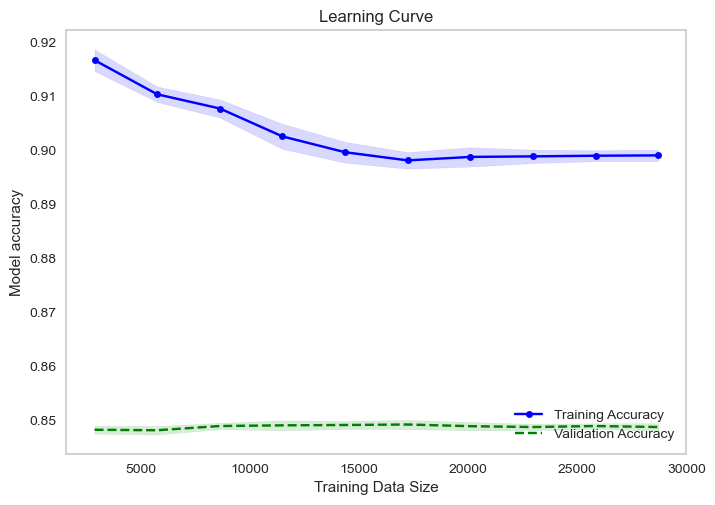

In [444]:
train_sizes, train_scores, test_scores = learning_curve(estimator=ensemble_CAT_random_forest, X=X_train_smote, y=Y_train_smote,
                                                       cv=5, train_sizes=np.linspace(0.1, 1.0, 10),
                                                     n_jobs=1)
#
# Calculate training and test mean and std
#
train_mean = np.mean(train_scores, axis=1)
train_std = np.std(train_scores, axis=1)
test_mean = np.mean(test_scores, axis=1)
test_std = np.std(test_scores, axis=1)
#
# Plot the learning curve
#
plt.plot(train_sizes, train_mean, color='blue', marker='o', markersize=5, label='Training Accuracy')
plt.fill_between(train_sizes, train_mean + train_std, train_mean - train_std, alpha=0.15, color='blue')
plt.plot(train_sizes, test_mean, color='green', marker='+', markersize=5, linestyle='--', label='Validation Accuracy')
plt.fill_between(train_sizes, test_mean + test_std, test_mean - test_std, alpha=0.15, color='green')
plt.title('Learning Curve')
plt.xlabel('Training Data Size')
plt.ylabel('Model accuracy')
plt.grid()
plt.legend(loc='lower right')
plt.show()

In [ ]:
## Krzywe uczenia potwierdzają, że model jest niedouczony. Krzywa walidacji jest stale płaska, 
## strata dokładności występuje tylko na krzywej treningowej, jest duża luka między obiema krzywymi